##### libraries

In [1]:
# libraries
# base
from scipy.io import arff          # to read .arff format
import pandas as pd                # data manipulation
import numpy as np                 # linear algebra
import matplotlib.pyplot as plt    # plotting
import seaborn as sns              # plotting
from PIL import Image              # images handling

# support
import time                        # time measuring
import random                      # randomness
import pickle                      # object saving/loading

# math
from scipy.stats import spearmanr, wilcoxon  # spearman rho correlation coefficient and wilcoxon median equality test
from math import ceil              # ceil function

# warnings
from  warnings import simplefilter                             # warning handling
from sklearn.exceptions import ConvergenceWarning              # warning handling
from statsmodels.tools.sm_exceptions import ConvergenceWarning # warning handling

# Sklearn/xgboost - Machine Learning
from sklearn.ensemble import RandomForestClassifier                                           # Random Forest
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PowerTransformer              # scalers and power transform
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold                  # splitting, validation
from sklearn.metrics import roc_auc_score, average_precision_score, confusion_matrix          # metrics
from sklearn.metrics import precision_recall_curve, roc_curve                                 # metrics (curves)
from sklearn.decomposition import PCA                                                         # PCA
from xgboost.sklearn import XGBClassifier                                                     # sklearn API for XGB
import statsmodels.formula.api as smf                                                         # formula API for statsmodels


# tensorflow/keras - Deep Learning
import tensorflow as tf             # tensorflow background
from tensorflow import keras        # keras API for tensorflow
from keras import layers            # keras layers
from keras import models            # keras models
from keras import optimizers        # keras optimizers
from keras import activations       # keras activation functions
from keras import losses            # keras loss functions 
from keras import regularizers      # keras regularizers
# import tensorflow as tf
# from tensorflow import keras
# from tensorflow.keras import layers, models, optimizers, activations, losses, regularizers

Using TensorFlow backend.


##### notebook settings

In [2]:
# notebook settings
pd.set_option("display.max_columns", 70)
pd.set_option("display.max_rows", 70)
# ignoring some warnings
simplefilter("ignore", category=ConvergenceWarning) 
np.warnings.filterwarnings('ignore', '(overflow|invalid)')

random_state = 2021

##### preprocessing

 - loading, missing detection

In [3]:
def get_missing_info(data, y):
    '''
    function creates DataFrame of missing value counts and percentage, for a given data and positive, negative
    and positive percentage for a given target, arguments:
    data - dataset to get informations about (DataFrame)
    y - target value (string)
    
    returns - DataFrame object with informations
    '''
    
    # counting missing and calculating the percentage 
    missing_info = pd.DataFrame((data.isna().sum(), data.isna().sum()/data.shape[0]*100)).T
    missing_info.columns = ["missing_count", "missing_percentage"]
    
    # removing rows without missings
    missing_info = missing_info.where(missing_info > 0).dropna().sort_values(by = "missing_percentage", ascending = False)
    
    # target info inicjalization
    missing_info["non_{}_count".format(y)] = np.nan
    missing_info["{}_count".format(y)] = np.nan
    missing_info["{}_percentage".format(y)] = np.nan
    
    # target info colnames
    neg_count, pos_count, pos_per=missing_info.columns.tolist()[2:]
    
    # target info (counting) columns filling
    cols = missing_info.index.tolist()
    for i in cols:
        missing_info.loc[i, pos_count] = data[y].where(data[i].isna()).dropna().sum()
        missing_info.loc[i, neg_count] = data[y].where(
            data[i].isna()).dropna().shape[0]-missing_info.loc[i, pos_count]
    
    # target info (percentage) column filling
    missing_info[pos_per] = np.round(
        missing_info[pos_count]/(missing_info[neg_count]+missing_info[pos_count])*100, 2)
    
    
    return missing_info

In [4]:
# data loading
data = arff.loadarff(r"data\2year.arff")
data = pd.DataFrame(data[0])

# decoding target variable
data.rename({'class':'bankrupt'}, axis = 1, inplace = True)
data['bankrupt'].replace(b'1', 1, True)
data['bankrupt'].replace(b'0', 0, inplace=True)

In [5]:
get_missing_info(data, "bankrupt")

,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr37,4518.0,44.411678,4340.0,178.0,3.94
Attr21,3164.0,31.101936,3010.0,154.0,4.87
Attr27,706.0,6.939939,555.0,151.0,21.39
Attr60,543.0,5.337659,514.0,29.0,5.34
Attr45,541.0,5.317999,512.0,29.0,5.36
Attr24,225.0,2.211737,225.0,0.0,0.00
Attr64,212.0,2.083948,199.0,13.0,6.13
Attr28,212.0,2.083948,199.0,13.0,6.13
Attr54,212.0,2.083948,199.0,13.0,6.13
Attr53,212.0,2.083948,199.0,13.0,6.13


Columns to drop because of:
1. Too many missings:
 - Attr37,
 - Attr21,
 - Attr27,
 - Attr60,
 - Attr45.

In [6]:
# column dropping
data.drop(labels = ["Attr37", "Attr21", "Attr27", "Attr60", "Attr45"], axis = 1, inplace = True)

 - functions for data imputation

In [7]:
def ProximityMatrix(RF, X, normalize = True):    
    '''
    function computes the proximity matrix for given (trained) random forest and data, arguments:
    RF - trained Random Forst classifier,
    X - data to apply RF,
    normalize - boolean, if true then proximity_matrix = proximity_matrix/num_of_Trees
    
    returns proximity matrix (np.arraty)
    -----
    note: this function is based on stackoverflow topic:
        https://stackoverflow.com/questions/18703136/proximity-matrix-in-sklearn-ensemble-randomforestclassifier
        
    '''
    
    # leaves indices for each x in X
    leaves = RF.apply(X)
    # number of trees
    nTrees = leaves.shape[1]
    # inicjalization (first iteration) proximity matrix
    proximity_matrix = np.equal.outer(leaves[:,0], leaves[:,0]).astype('float')
        # outer applies a function, here equal for each pair in the arguments (leaves[:,0] with itself) ->
        # we get proximities for the first column (first Tree), proximity_matrix[i,j] = 1 <=> i == j,
        # where i, j are indices of leaves for each sample
        # note: proximity_matrix is not the product of the Attr's, its a product of the Trees and the indices of its nodes

    # iteration through the rest of the trees
    for i in range(1, nTrees):
        proximity_matrix += np.equal.outer(leaves[:,i], leaves[:,i]).astype('float')
            
    proximity_matrix = (proximity_matrix/nTrees) if normalize == True else proximity_matrix

    return proximity_matrix    

def RFimputation(dta, n_iter, target, *args, **kwargs):
    '''
    Random Forest proximity based data imputer for a continuous features. Missing are inicialized with median of the 
    feature, after that random forest classifier is trained then based on node ID for particular observation simillarity 
    is determined and proximity matrix is computed and rescaled. 1-proximity is distance. Proximity is a weight in weighted
    average formula for a missing item. The process is repeated normally 5-7 times. Arguments:
    dta - dataset with continuous features with missings,
    n_iter - number of algorithm iterations
    target - target variable
    
    return imputed dataset, missing indices, history of process, missings changes during training 
    '''
    import time
    pd.set_option('mode.chained_assignment', None)
    
    start = time.time()
    # data copy to operate
    df = dta.copy()
    
    # features list
    features = [i for i in df.columns.tolist() if i != target]
    
    # Attr's missings indices inicialization
    # key - attr, value - indices
    attrs_indices = {}

    # Attr's updated values 
    # key - attr, value - imputed values
    attrs_values = {}

    # getting missings indices for each attr and set it to the median 
    for attr in features:
        # indices of missing data for each attribute
        indices = df[attr][df[attr].isna()].index.tolist()
        # median
        median = df[attr].median(skipna=True, axis=0)
        # imputation
        df.loc[indices, attr] = median
        # updating Attr's missings indices dictionary
        attrs_indices[attr] = indices
        # updating Attr's missings updated values dictionary
        attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()


    # ********* IMPUTATION LOOP *************** #
    # history inicialization
    history = {}
    # history is a dictionary keys = iteration, keys = dictionary of attrs:lists of missings
    history["iteration_0"] = attrs_values.copy()

    for i in range(n_iter):
        # build and train a classifier (RF)
        clf = RandomForestClassifier(*args, **kwargs) 
        clf.fit(df[features], df[target])

        # compute proximity matrix
        pm = ProximityMatrix(clf, df[features], True)

        # compute weight matrix (each row divided by its sum)
        pm_div = pm/pm.sum(axis = 1, keepdims = True)

        # reset missing values (= 0) (after that, weighted average excludes missing indices, is just a dot product)
        for attr in features:
            df[attr][attrs_indices[attr]] = 0

        # computing imputation matrix - weighted average formula (shape: (n_observations, n_features))
        imputation_matrix = np.dot(pm_div, df.values)

        # data imputation
        for attr in features:
            # attr index in df 
            attr_index = features.index(attr)
            # imputing data (weighted average based on proximity matrix)
            df[attr][attrs_indices[attr]] = imputation_matrix[attrs_indices[attr], attr_index]
            # updating Attr's missings updated values dictionary
            attrs_values[attr] = df[attr][attrs_indices[attr]].values.tolist()
        
        # history update
        history["iteration_{}".format(i+1)] = attrs_values.copy()
    
    # ********* historical changes *************** #
    iterations = list(history.keys())
    # history changes dictionary inicialization
    # key: iteration, value: dictionary
    #                        key: attr, value: percentage change
    history_changes = history.copy()
    # keys for history_changes (excluding "zero" iteration)
    changes_keys = iterations[1:]

    for i in range(len(iterations)-1):
        # values for calculations (concrete iterations)
        itr_prev = iterations[i]
        itr = iterations[i+1]
        # list of the attr's
        attrs = list(history[itr].keys())
        for attr in attrs:
            # transform to array
            itr_prev_array = np.array(history[itr_prev][attr])
            itr_array = np.array(history[itr][attr])
            # change computation
            change = np.abs((itr_array - itr_prev_array) / itr_prev_array)
            # saving historical changes
            history_changes[itr][attr] = change
    
    # final shape of history_changes (excluding "zero" iteration)
    history_changes = {key: history_changes[key] for key in changes_keys}

    stop = time.time()
    print("Imputation time: {} seconds".format(round(stop - start), 2))
    return df, attrs_indices, history, history_changes

 - class for data standarization:
     - for CNN:
         $$0<int(x_{norm}=\frac{x-\mu}{\sigma}*100+128)<255$$
     - for other algorithms:
         $$x_{norm}=\frac{x-\mu}{\sigma}$$
 - integrated with:
     - outliers reduction with quantiles clipping,
     - Yeo-Johnson power transform, defined:
     $$\begin{cases}
    \frac{((y_i+1)^\lambda)-1)}{\lambda}         & \quad \text{if } \lambda \neq0, y\geq0\\
    \ln{(y_i+1)}                                 & \quad \text{if } \lambda=0, y\geq0\\
    \frac{-[(-y_i+1)^{2-\lambda}-1]}{2-\lambda}  & \quad \text{if } \lambda \neq2, y<0\\
    -\ln{(-y_i+1)}                               & \quad \text{if } \lambda=2, y<0
        \end{cases}$$

In [8]:
class scaler:
    
    def __init__(self, images=True):
        '''
        Class for normalizer-object which transforms vector of features to [0,255] vector of colour-scale, formula:

                                            0<int((x-mu)/sigma*100+128)<255

        where:
        x - feature vector,
        mu - mean(x),
        sigma - standard_deviation(x),
        int(.) - operation of rounding to integer.

        or for standarizing to zero mean and unit variance.
        
        arguments:
        images - boolean, when True [0,255] int standarization applied, when False zero mean and unit variance standarization applied.
        -------------
        note: scaler is integrated with quantile clipping.
        '''
        self.option=images
        self.mean=None
        self.std=None
        self.left_tail=None
        self.right_tail=None
        self.transformer=None
        
    def fit(self, X, q=None, power_transform=False):
        '''
        Function fits scaler to the data, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame),
        q - optional, quantile for clipping data before fit (float),
        power_transform - apply Yeo-Johnson power transformation (boolean).
        -------------
        note: quantile clipping is symmetric, when q=0.05 passed then function computes q_95 also for clipping left and
              right distribution tails. 
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        
        # quantile computations
        if q is not None:
            # saving quantiles in __init__
            self.left_tail=np.quantile(a=X, q=q, axis=0)
            self.right_tail=np.quantile(a=X, q=1-q, axis=0)
            # computing new X
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
                
        if power_transform==True:
            self.transformer=PowerTransformer(method='yeo-johnson', standardize=True)
            self.transformer.fit(X=X)
            X=self.transformer.transform(X=X)
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
        else:
            # mean and standard deviation computing for __init__     
            self.mean=X.mean(axis=0)
            self.std=X.std(axis=0)
    
    def transform(self, X):
        '''
        Function transforms data with fitted scaler, arguments:
        X - feature matrix (numpy.array or pandas.DataFrame)
        
        return normalized data (numpy.array)
        '''
        # errors handling
        class error(Exception):
            pass
        if type(X)==pd.core.frame.DataFrame:
            X=X.values
        elif type(X)==np.ndarray:
            pass
        else:
            raise error("X type allowed are pd.core.frame.DataFrame and np.ndarray")
        if X.shape[1]!=self.mean.shape[0]:
            raise error("X has {} columns while scaler was fitted on matrix with {} columns".format(X.shape[1], 
                                                                                              len(self.mean)))
        # quantile clipping if necessary
        try:
            for i in range(X.shape[1]):
                X[:,i]=X[:,i].clip(min=self.left_tail[i], max=self.right_tail[i])
        except:
            pass 
        
        # normalization for images
        if self.option==True:
            try:
                # with power transform
                X=np.round(self.transformer.transform(X=X)*100+128)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=np.round((X[:,i]-self.mean[i])/self.std[i]*100+128)

            # [0,255] clipping
            X=X.clip(min=0, max=255)
        # normalization for float output
        else:
            try:
                # with power transform
                X=self.transformer.transform(X=X)
            except:
                # without power transform
                for i in range(X.shape[1]):
                    X[:,i]=(X[:,i]-self.mean[i])/self.std[i]
        
        return X

 - data splitting

In [9]:
# variables for target and features
target = "bankrupt"
features = [i for i in data.columns.tolist() if i != target]

In [10]:
# data splitting - train and test sets

X_train, X_test, Y_train, Y_test = train_test_split(data[features], data[target], stratify = data[target],
                                                 test_size = 0.1, random_state = random_state)
train_set = pd.concat((X_train, Y_train), axis=1)
train_set.reset_index(inplace=True, drop=True)
test_set = pd.concat((X_test, Y_test), axis=1)
test_set.reset_index(inplace=True, drop=True)

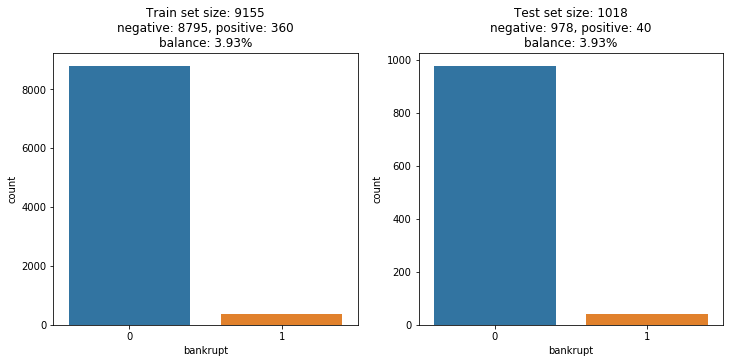

In [11]:
# sets balance vizualization

fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (12,5))
sns.countplot(train_set[target], ax = ax[0])
sns.countplot(test_set[target], ax = ax[1])

ax[0].set_title("Train set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    train_set[target].shape[0], sum(train_set[target]==0), sum(train_set[target]==1),
    round(sum(train_set[target]==1)/train_set.shape[0]*100, 2)))
ax[1].set_title("Test set size: {}\nnegative: {}, positive: {}\nbalance: {}%".format(
    test_set[target].shape[0], sum(test_set[target]==0), sum(test_set[target]==1),
    round(sum(test_set[target]==1)/test_set.shape[0]*100, 2)))

plt.show()

##### Data imputation for train and test set

In [12]:
print("\t\t\t\tTRAIN SET MISSINGS")
get_missing_info(train_set, target)

				TRAIN SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr24,200.0,2.184599,200.0,0.0,0.00
Attr64,184.0,2.009831,174.0,10.0,5.43
Attr54,184.0,2.009831,174.0,10.0,5.43
Attr53,184.0,2.009831,174.0,10.0,5.43
Attr28,184.0,2.009831,174.0,10.0,5.43
Attr41,176.0,1.922447,176.0,0.0,0.00
Attr32,75.0,0.819224,71.0,4.0,5.33
Attr47,64.0,0.699072,64.0,0.0,0.00
Attr52,64.0,0.699072,64.0,0.0,0.00
Attr19,60.0,0.655380,55.0,5.0,8.33


In [13]:
print("\t\t\t\tTEST SET MISSINGS")
get_missing_info(test_set, target)

				TEST SET MISSINGS


,missing_count,missing_percentage,non_bankrupt_count,bankrupt_count,bankrupt_percentage
Attr64,28.0,2.750491,25.0,3.0,10.71
Attr28,28.0,2.750491,25.0,3.0,10.71
Attr54,28.0,2.750491,25.0,3.0,10.71
Attr53,28.0,2.750491,25.0,3.0,10.71
Attr24,25.0,2.455796,25.0,0.0,0.00
Attr41,21.0,2.062868,21.0,0.0,0.00
Attr32,12.0,1.178782,12.0,0.0,0.00
Attr47,10.0,0.982318,10.0,0.0,0.00
Attr52,10.0,0.982318,10.0,0.0,0.00
Attr49,4.0,0.392927,4.0,0.0,0.00


In [14]:
# Train set imputation
train_set_imp, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_set, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
test_set_imp, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(test_set, n_iter=10,
                                                                                     target=target, n_estimators=100,
                                                                                     n_jobs=-1, max_depth=8,
                                                                                     random_state=random_state)

train_test_imp_sets = dict(zip(["train_set_imp", "test_set_imp"], [train_set_imp, test_set_imp]))

# SAVING IMPUTED TRAIN AND TEST SET as dict
with open(r"data\2year_data\train_test_imp_sets_2year.p", "wb") as fp:
    pickle.dump(train_test_imp_sets, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 385 seconds
Imputation time: 9 seconds


In [14]:
# LOADING IMPUTED TRAIN AND TEST SET
with open(r"data\2year_data\train_test_imp_sets_2year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

##### training distribution analysis

							 RAW DATA


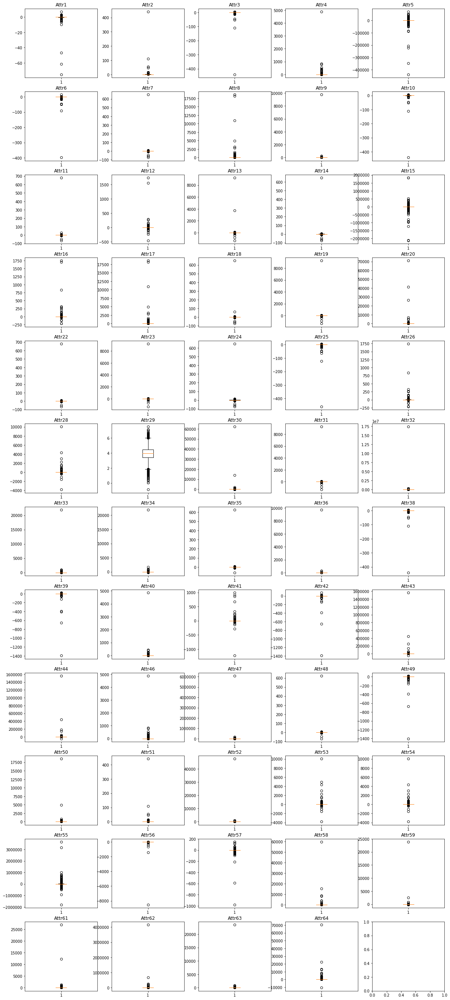

In [15]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t RAW DATA")
plt.show()

Lots of outliers, lets reduce them with quantiles

In [16]:
q=0.005
lb=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=q, axis=0)
ub=np.quantile(a=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),:].values, q=1-q, axis=0)

for i, feature in enumerate(features):
    train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature]=train_set_imp.loc[
        (train_set_imp[target]==0)|(train_set_imp[target]==1),feature].apply(
        lambda x: lb[i] if x<lb[i] else ub[i] if x>ub[i] else x)

							 Q_0.005 and Q_0.995 replaced


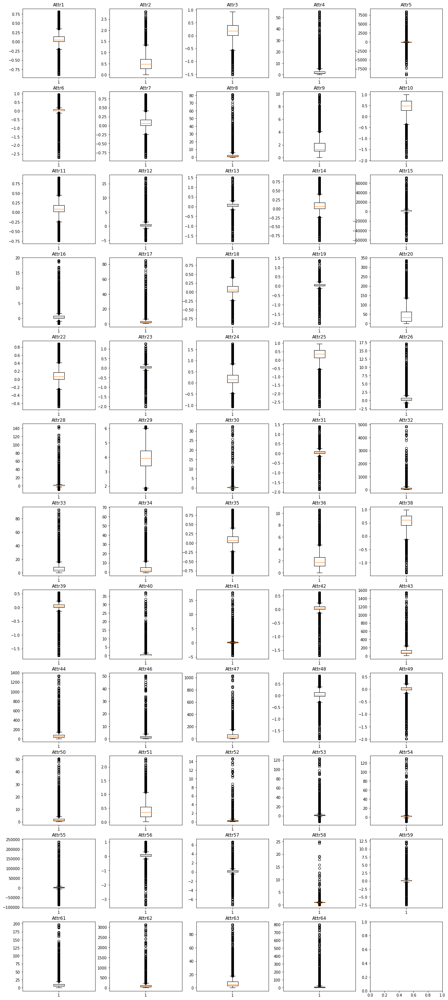

In [17]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

							 Q_0.005 and Q_0.995 replaced


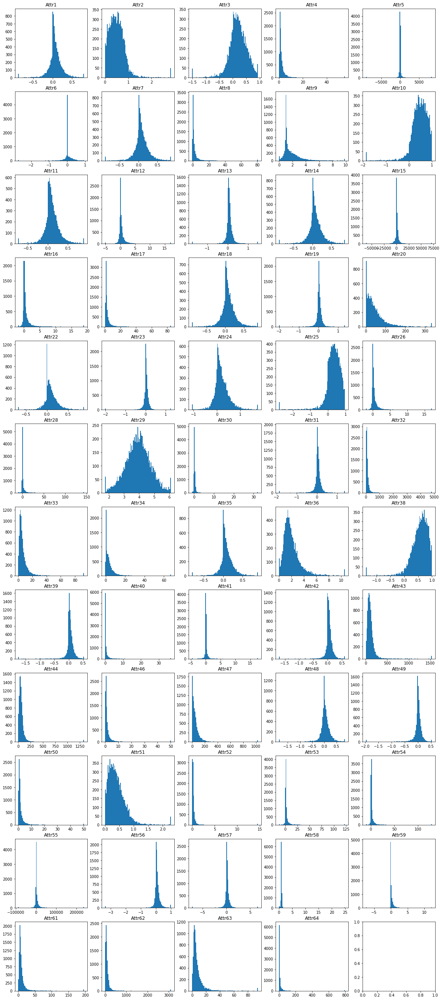

In [18]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t\t\t\t Q_{} and Q_{} replaced".format(q, 1-q))
plt.show()

skewness is very big in this data, lets apply some power transforms.

In [19]:
transformer = PowerTransformer(method="yeo-johnson", standardize=False)
transformer.fit(X=train_set_imp[features])
train_set_imp_pt = pd.DataFrame(transformer.transform(X=train_set_imp[features]), columns=features)

				 Q_0.005 and Q_0.995 replaced, power transform applied


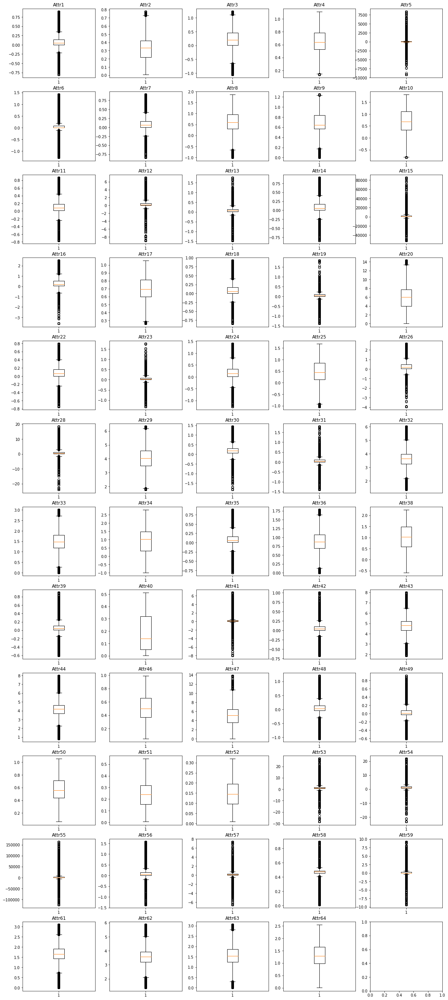

In [20]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

				 Q_0.005 and Q_0.995 replaced, power transform applied


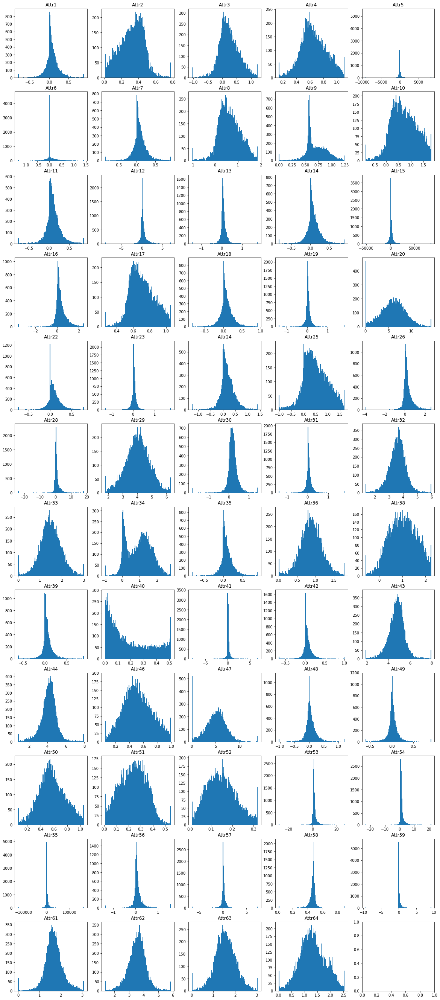

In [21]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t\t\t Q_{} and Q_{} replaced, power transform applied".format(q, 1-q))
plt.show()

In [22]:
# print fitted lambdas
pd.Series(transformer.lambdas_, index=features, name="lambdas")

Attr1     1.295776
Attr2    -0.910520
Attr3     1.714693
Attr4    -0.872046
Attr5     0.999409
Attr6     2.042387
Attr7     1.153052
Attr8    -0.470353
Attr9    -0.621861
Attr10    2.473286
Attr11    0.880192
Attr12    0.542073
Attr13    1.306939
Attr14    1.153157
Attr15    1.016964
Attr16   -0.130309
Attr17   -0.934134
Attr18    1.137360
Attr19    1.594350
Attr20    0.272827
Attr22    0.686993
Attr23    1.684468
Attr24    0.604805
Attr25    2.391263
Attr26   -0.063345
Attr28    0.443640
Attr29    1.024385
Attr30   -0.621411
Attr31    1.496198
Attr32   -0.087590
Attr33   -0.195387
Attr34   -0.210074
Attr35    0.971735
Attr36   -0.276374
Attr38    2.950843
Attr39    3.114606
Attr40   -1.955004
Attr41    0.505551
Attr42    2.853672
Attr43    0.021972
Attr44    0.027657
Attr46   -0.989429
Attr47    0.179649
Attr48    2.005783
Attr49    3.194934
Attr50   -0.926603
Attr51   -1.537614
Attr52   -3.132728
Attr53    0.582135
Attr54    0.512018
Attr55    0.967082
Attr56    2.109708
Attr57    1.

After skewness and outliers reduction zero mean and unit variance standarization is necessary.

In [23]:
normalizer=StandardScaler()
normalizer.fit(X=train_set_imp_pt)
train_set_imp_pt_norm=pd.DataFrame(normalizer.transform(X=train_set_imp_pt), columns=features)

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


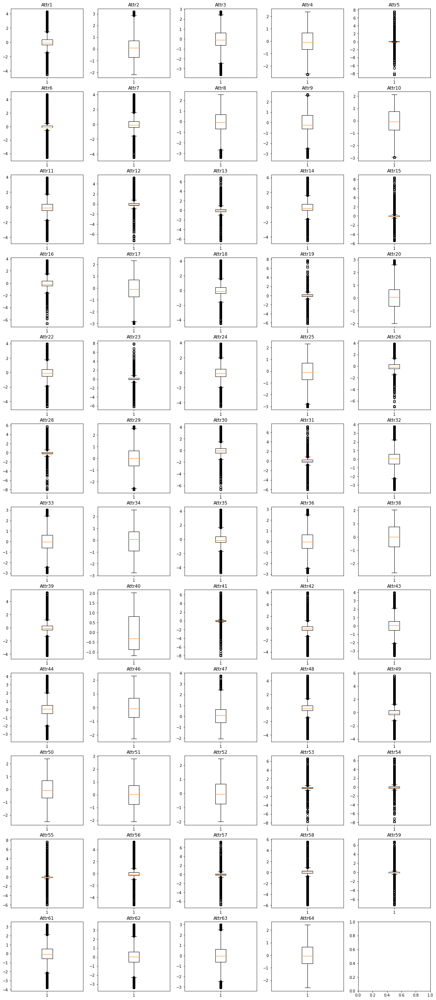

In [24]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].boxplot(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature])
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

		 Q_0.005 and Q_0.995 replaced, power transform and normalization applied


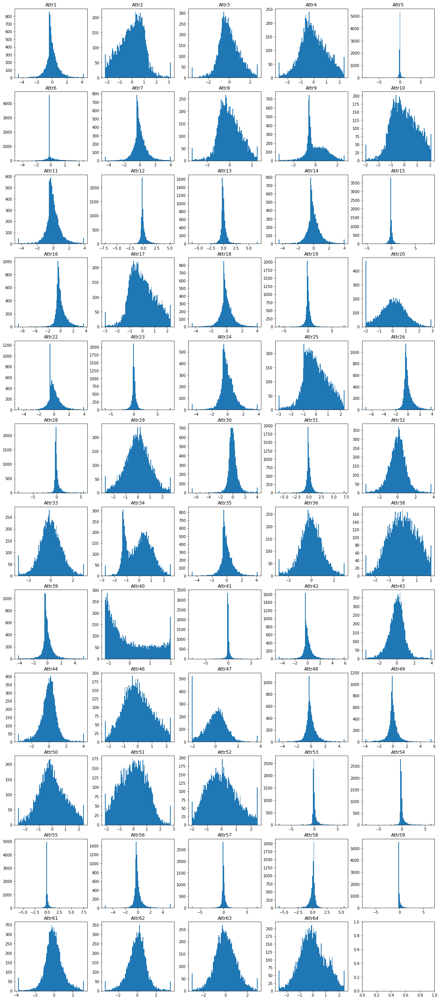

In [25]:
fig, ax = plt.subplots(nrows=12, ncols=5, figsize=(20,48))
ax = ax.flatten()

for i, feature in enumerate(features):
    ax[i].hist(x=train_set_imp_pt_norm.loc[(train_set_imp[target]==0)|(train_set_imp[target]==1),feature], bins=100)
    ax[i].set_title(feature)
print("\t\t Q_{} and Q_{} replaced, power transform and normalization applied".format(q, 1-q))
plt.show()

Distributions looks much better now, Gaussian-shape is not achived, however outliers and skewness are reduced. Attr 9 and Attr34 distributions looks problematic (two modes). Attr40 also is not looking great.

##### Modelling 
 - preparing folds for n-fold Cross Validation (with imputation, just for time saving - one fold imputation takes 120 seconds on average, it does not make sense to perform it during hyperparameters optimization especially with fixed random seed)

In [27]:
# sets inicialization
trains=[]
valids=[]

# Stratification object
kf = StratifiedKFold(6, shuffle=True, random_state=random_state)
for train, valid in kf.split(train_set, train_set[target]):
    # extracting sets
    train_data = train_set.loc[train,:].copy()
    valid_data = train_set.loc[valid,:].copy()
    # reset index
    train_data.reset_index(drop=True, inplace=True)
    valid_data.reset_index(drop=True, inplace=True)
    # imputation
    train_data, miss_indices_train, miss_hist_train, miss_hist_ch_train = RFimputation(train_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    valid_data, miss_indices_valid, miss_hist_valid, miss_hist_ch_valid = RFimputation(valid_data, n_iter=10,
                                                                                      target=target, n_estimators=100,
                                                                                      n_jobs=-1, max_depth=8,
                                                                                      random_state=random_state)
    
    # saving
    trains.append(train_data)
    valids.append(valid_data)
    
sets = {"training_sets" : trains,
        "validation_sets" : valids}

#SAVING
with open(r"data\2year_data\sets.p", "wb") as fp:
    pickle.dump(sets, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 309 seconds
Imputation time: 16 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 301 seconds
Imputation time: 16 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 302 seconds
Imputation time: 16 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 313 seconds
Imputation time: 16 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


Imputation time: 304 seconds
Imputation time: 16 seconds
Imputation time: 304 seconds
Imputation time: 15 seconds


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:134: RuntimeWarning: divide by zero encountered in true_divide


In [26]:
#LOADING
with open(r"data\2year_data\sets.p", "rb") as fp:
    sets = pickle.load(fp)

##### Logistic regression

In [27]:
def Logit_6FoldCrossValidation(datasets, features, target, random_state, normalize=False, q=None, alpha="none", info=0):
    '''
    function performes 6 fold Cross Validation for Logistic Regression, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    random_state - random seed,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    alpha - L1 norm regularization parameter, "none" for no regularization, (0,inf) for regularization
    info - folds' info
    
    returns Logit_history - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for Logistc Regression
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # Logistic Regression training
        formula = "{}~{}".format(target, "+".join(features))
        LogitRegression = smf.logit(formula, pd.concat((X_train, Y_train), axis=1))
        if alpha == "none":
            LogitRegression=LogitRegression.fit(method="powell", maxiter=1000, disp=info)
        else:
            LogitRegression=LogitRegression.fit_regularized(method="l1", alpha=alpha, disp=info)
        
        # metrics
        predsTrain = LogitRegression.predict(exog=X_train)
        predsValid = LogitRegression.predict(exog=X_valid)
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    Logit_history={"train_roc" : trainROCs,
                   "train_pr" : trainPRs,
                   "valid_roc" : validROCs,
                   "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))

    return Logit_history

In [30]:
# without normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=False, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\l


Cross validation time: 94s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 23s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 23s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 24s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 25s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 25s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 23s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 20s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 19s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 18s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 15s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 14s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 13s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-


Cross validation time: 12s

alpha: none
train_roc 0.7358421246293104
train_pr 0.12627946285723476
valid_roc 0.6996844956415704
valid_pr 0.09712575708666325

alpha: 0.01
train_roc 0.7442392295641728
train_pr 0.14519994192794158
valid_roc 0.7047930670730982
valid_pr 0.10754622888849935

alpha: 0.03
train_roc 0.7446170920006826
train_pr 0.14485728916818286
valid_roc 0.705488431756911
valid_pr 0.10845403517692352

alpha: 0.05
train_roc 0.7450415058917054
train_pr 0.14483592303803378
valid_roc 0.7054997876271197
valid_pr 0.10848504174118867

alpha: 0.08
train_roc 0.7452655054054121
train_pr 0.14487111051393178
valid_roc 0.7064300468048099
valid_pr 0.10922599246948211

alpha: 0.1
train_roc 0.745474789807686
train_pr 0.14474813101040163
valid_roc 0.7064509749751801
valid_pr 0.10934513939580759

alpha: 0.3
train_roc 0.7474405939426814
train_pr 0.14378631529203836
valid_roc 0.7097459453852486
valid_pr 0.1104932485507699

alpha: 0.5
train_roc 0.7486012404121638
train_pr 0.14297764564921592
vali

$\alpha=0.5$ gave the best results approx. 0.1106 AUC-PR (really poor result)

In [31]:
# with normalization
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))
C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 54s


C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\discrete\discrete_model.py:1800: RuntimeWarning: divide by zero encountered in log
  return np.sum(np.log(self.cdf(q*np.dot(X,params))))



Cross validation time: 21s

Cross validation time: 22s

Cross validation time: 23s

Cross validation time: 25s

Cross validation time: 26s
0.3 fatal error

Cross validation time: 20s

Cross validation time: 17s

Cross validation time: 15s

Cross validation time: 10s

Cross validation time: 8s

Cross validation time: 6s

Cross validation time: 5s

alpha: none
train_roc 0.7255533659115986
train_pr 0.11909446501541128
valid_roc 0.6740330114370945
valid_pr 0.09037158821253928

alpha: 0.01
train_roc 0.7426906086843287
train_pr 0.13299685045936102
valid_roc 0.7117711199785196
valid_pr 0.10109486887510305

alpha: 0.03
train_roc 0.7431289468498821
train_pr 0.13030244559309292
valid_roc 0.7079299684260247
valid_pr 0.0994212353619174

alpha: 0.05
train_roc 0.7426679443347121
train_pr 0.12788196418978287
valid_roc 0.7079385512910253
valid_pr 0.09926216563226838

alpha: 0.08
train_roc 0.7392834387151712
train_pr 0.12316198116153891
valid_roc 0.7038918222731296
valid_pr 0.09602102807595786

alpha:

Worse results

In [32]:
# with normalization and outlier reduction (q=0.005)
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize=True, q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 29s

Cross validation time: 24s

Cross validation time: 23s

Cross validation time: 21s
0.08 fatal error

Cross validation time: 20s

Cross validation time: 16s

Cross validation time: 14s

Cross validation time: 14s

Cross validation time: 13s

Cross validation time: 12s

Cross validation time: 11s

Cross validation time: 10s
5 fatal error

alpha: none
train_roc 0.7587872458141321
train_pr 0.1370276162124254
valid_roc 0.7076129391734064
valid_pr 0.09928715129583204

alpha: 0.01
train_roc 0.7617696567484699
train_pr 0.1417021864361219
valid_roc 0.7108855198945015
valid_pr 0.10140594871829878

alpha: 0.03
train_roc 0.7616655874498415
train_pr 0.14162391669064228
valid_roc 0.7110902010480511
valid_pr 0.10125246923405186

alpha: 0.05
train_roc 0.7615980520797635
train_pr 0.1414008782317585
valid_roc 0.7112644942550679
valid_pr 0.10123383799996377

alpha: 0.08, - failure

alpha: 0.1
train_roc 0.7614743529668085
train_pr 0.1410070033675481
valid_roc 0.711361109688393

Quantile clipping didn't help

In [33]:
# with normalization and outlier reduction (q=0.005) and power transform
alphas=["none", 0.01, 0.03, 0.05, 0.08, 0.1, 0.3, 0.5, 0.8, 1, 2, 3, 4, 5]
logithsts=[]
for alpha in alphas:
    try:
        logithst = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                              normalize="power", q=0.005, alpha=alpha, info=0)
        logithsts.append(logithst)
    except:
        print(alpha, "fatal error")
        logithsts.append("fatal error")
        
logitCVhistory = dict(zip(alphas, logithsts))

# results printing
for penalty in logitCVhistory.keys():
    if logitCVhistory[penalty] == "fatal error":
        print("\nalpha: {}, - failure".format(penalty))
    else:
        print("\nalpha: {}".format(penalty))
        for metric in logitCVhistory[penalty].keys():
            print(metric, np.mean(logitCVhistory[penalty][metric]))

C:\Users\maciej\anaconda3\lib\site-packages\statsmodels\base\model.py:548: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  'available', HessianInversionWarning)



Cross validation time: 34s

Cross validation time: 28s

Cross validation time: 28s

Cross validation time: 28s

Cross validation time: 27s

Cross validation time: 27s

Cross validation time: 22s

Cross validation time: 20s
0.8 fatal error

Cross validation time: 18s

Cross validation time: 15s

Cross validation time: 16s

Cross validation time: 15s
5 fatal error

alpha: none
train_roc 0.762732458313403
train_pr 0.27832677837852376
valid_roc 0.7251529537420308
valid_pr 0.21253076422271744

alpha: 0.01
train_roc 0.7662534616397515
train_pr 0.2925443354519784
valid_roc 0.7262713957269852
valid_pr 0.2224585101674668

alpha: 0.03
train_roc 0.7660652479276222
train_pr 0.29286387994178115
valid_roc 0.7261349830127563
valid_pr 0.22263678201562395

alpha: 0.05
train_roc 0.765878021042365
train_pr 0.2930109162328312
valid_roc 0.7262221671242642
valid_pr 0.22342288058539217

alpha: 0.08
train_roc 0.7656073360187433
train_pr 0.2930674285765947
valid_roc 0.7260383843933612
valid_pr 0.2240306283193

Finally some improvmed noted - 0.22 AUC-PR (+0.11) for $\alpha=0.5$ Longer forecasting horizn worse results (1 year - 0.49, 2 years - 0.28, 3 years - 0.25 and 4 years - 0.22)

##### Random Forest, hyperparameters optimization
 - 6 fold Cross validation for Random Forest

In [28]:
def RF_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, saveModels=False, info=0,
                            *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Random Forest, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - fold's info,
    random_state - random seed
    *args and **kwargs - hyperparameters for Random Forest
    
    returns RFhistoriey - dictionary with CV results 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    trainROCs = []
    trainPRs = []
    validROCs = []
    validPRs = []
    
    if saveModels:
        models = []
    
    CVstart=time.time()
    for fold in range(len(training_sets)):
        if info==1:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # RF training
        RF = RandomForestClassifier(*args, **kwargs)
        RF.fit(X_train, Y_train)
        
        # metrics
        predsTrain = RF.predict_proba(X_train)[:,1]
        predsValid = RF.predict_proba(X_valid)[:,1]
        
        trainROC = roc_auc_score(y_true=Y_train, y_score=predsTrain)
        trainPR = average_precision_score(y_true=Y_train, y_score=predsTrain)
        validROC = roc_auc_score(y_true=Y_valid, y_score=predsValid)
        validPR = average_precision_score(y_true=Y_valid, y_score=predsValid)
        
        # metrics saving
        trainROCs.append(trainROC)
        trainPRs.append(trainPR)
        validROCs.append(validROC)
        validPRs.append(validPR)
        
        # model saving
        if saveModels:
            models.append(RF)
        
        if info==1:
            print("\ntrain roc: {}\ntrain pr: {}\nvalid roc: {}\nvalid pr: {}".format(trainROC, trainPR, validROC,
                                                                                       validPR))
        
    RFhistory={"train_roc" : trainROCs,
               "train_pr" : trainPRs,
               "valid_roc" : validROCs,
               "valid_pr" : validPRs}       

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        RFhistory["models"]=models
        return RFhistory
    return RFhistory

In [35]:
# attempt without normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=False, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 25s
valid ROC: 0.7712911811967483
valid PR: 0.14046391100664543
overfitting ROC: 0.22870881880325167
overfitting PR: 0.8595360889933545


In [36]:
# attempt with normalization
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 24s
valid ROC: 0.7692355960228068
valid PR: 0.13773974094777267
overfitting ROC: 0.23076440397719322
overfitting PR: 0.8622602590522274


worse

In [37]:
# attempt with normalization and outlier reduction (0.005)
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize=True, q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 23s
valid ROC: 0.7693201455206914
valid PR: 0.14187321361663097
overfitting ROC: 0.2306798544793086
overfitting PR: 0.858126786383369


a bit better but higher overfitting

In [38]:
# attempt with normalization, outlier reduction (0.005) and power transform
RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                 normalize="power", q=0.005, info=0, saveModels=False)
print("valid ROC:", np.mean(RFhist["valid_roc"]))
print("valid PR:", np.mean(RFhist["valid_pr"]))
print("overfitting ROC:", np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]))
print("overfitting PR:", np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]))


Cross validation time: 28s
valid ROC: 0.7676637508723844
valid PR: 0.14150225211505657
overfitting ROC: 0.23233624912761563
overfitting PR: 0.8584977478849434


Same conclusion as for other horizons, preprocessing pipeline should be treated as hyperparameter. However the best results achived when nromalization with quantile clipping applied. So, experimets will be performed with that settings.

In [47]:
depths = [i for i in range(2,22,2)]
RFhists = []
for depth in depths:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state,
                                     normalize=True, q=0.005, info=0, saveModels=False, max_depth=depth)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(depths, RFhists))

for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 5s

Cross validation time: 9s

Cross validation time: 12s

Cross validation time: 15s

Cross validation time: 18s

Cross validation time: 20s

Cross validation time: 21s

Cross validation time: 22s

Cross validation time: 22s

Cross validation time: 23s

depth: 2
valid ROC: 0.7059730034233164
valid PR: 0.09464554447660013
overfitting ROC: 0.04369074421618446
overfitting PR: 0.05132857540230264

depth: 4
valid ROC: 0.72622303692184
valid PR: 0.12568627743722768
overfitting ROC: 0.11736423281398911
overfitting PR: 0.29393924846129915

depth: 6
valid ROC: 0.7465289372923157
valid PR: 0.13599105673714001
overfitting ROC: 0.18027474025698553
overfitting PR: 0.5552926390362534

depth: 8
valid ROC: 0.7559205678866338
valid PR: 0.14295667286405023
overfitting ROC: 0.22449424364375636
overfitting PR: 0.742122035053879

depth: 10
valid ROC: 0.7699301394107674
valid PR: 0.14569117718055208
overfitting ROC: 0.2272113453059137
overfitting PR: 0.8214355646303921

depth: 12
va

8-12 should be ok, mean=10 and that value will be used for further sequentional checking.
 - number of trees (weak estimators in ensemble learning words)

In [49]:
nums_of_trees = [10, 25, 75, 100, 200, 400, 600, 800, 1000]
RFhists = []
for num_of_trees in nums_of_trees:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                    normalize=True, q=0.005, saveModels=False, max_depth=10, n_estimators=num_of_trees)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(nums_of_trees, RFhists))


Cross validation time: 2s

Cross validation time: 5s

Cross validation time: 14s

Cross validation time: 18s

Cross validation time: 36s

Cross validation time: 70s

Cross validation time: 106s

Cross validation time: 141s

Cross validation time: 176s


In [50]:
for key in RF_CV_history.keys():
    print("\ndepth:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


depth: 10
valid ROC: 0.7107082325144173
valid PR: 0.1039228359020008
overfitting ROC: 0.2673845228257563
overfitting PR: 0.7485227119814629

depth: 25
valid ROC: 0.7380979156675312
valid PR: 0.133016085831256
overfitting ROC: 0.25261149651809345
overfitting PR: 0.8032577206493492

depth: 75
valid ROC: 0.766468233181801
valid PR: 0.15232478617708986
overfitting ROC: 0.2308083773222398
overfitting PR: 0.8140249080934513

depth: 100
valid ROC: 0.7699301394107674
valid PR: 0.14569117718055208
overfitting ROC: 0.2272113453059137
overfitting PR: 0.8214355646303921

depth: 200
valid ROC: 0.7692301146813554
valid PR: 0.14559941227126896
overfitting ROC: 0.22892134731260916
overfitting PR: 0.8291400245175748

depth: 400
valid ROC: 0.7709777042103635
valid PR: 0.15521058750817943
overfitting ROC: 0.22740827035152
overfitting PR: 0.8209430958963523

depth: 600
valid ROC: 0.7761051486325617
valid PR: 0.15316454069670568
overfitting ROC: 0.22250724580333348
overfitting PR: 0.8245632280753666

dept

best results with 400 trees, but 100 is enough for experiments

 - max number of features

In [51]:
print('Rule of thumb\nsquare root of number of features : {}'.format((len(features))**(1/2)))

Rule of thumb
square root of number of features : 7.681145747868608


In [52]:
max_features = [i for i in range(1,len(features), 4)]
RFhists = []
for n in max_features:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=0.005, saveModels=False, max_depth=10, n_estimators=100,
                                     max_features=n)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(max_features, RFhists))

for key in RF_CV_history.keys():
    print("\nmax number of features:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 4s

Cross validation time: 13s

Cross validation time: 22s

Cross validation time: 32s

Cross validation time: 41s

Cross validation time: 51s

Cross validation time: 60s

Cross validation time: 70s

Cross validation time: 79s

Cross validation time: 88s

Cross validation time: 99s

Cross validation time: 107s

Cross validation time: 117s

Cross validation time: 126s

Cross validation time: 136s

max number of features: 1
valid ROC: 0.7230837900255623
valid PR: 0.10261683782082148
overfitting ROC: 0.2733025998050649
overfitting PR: 0.856395499835291

max number of features: 5
valid ROC: 0.7560092458512272
valid PR: 0.13935952932149914
overfitting ROC: 0.2418359100144707
overfitting PR: 0.8331006794197127

max number of features: 9
valid ROC: 0.7671393437703871
valid PR: 0.1609512158258872
overfitting ROC: 0.229844290539713
overfitting PR: 0.8069743763162025

max number of features: 13
valid ROC: 0.7731725662869823
valid PR: 0.1734734781714052
overfitting ROC: 0.

Best results for $>30$
 - min sample split

In [53]:
min_sample_spilt = [2, 4, 6, 8, 10, 15, 20, 30]
RFhists = []
for min_split in min_sample_spilt:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=0.005, saveModels=False, max_depth=10, n_estimators=100,
                                     max_features=45, min_samples_split=min_split)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_spilt, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples to split:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 111s

Cross validation time: 108s

Cross validation time: 109s

Cross validation time: 108s

Cross validation time: 110s

Cross validation time: 109s

Cross validation time: 110s

Cross validation time: 109s

min samples to split: 2
valid ROC: 0.7889066198256421
valid PR: 0.218909042367613
overfitting ROC: 0.20307990939033838
overfitting PR: 0.7256980236347327

min samples to split: 4
valid ROC: 0.7875825512268738
valid PR: 0.21849643424780882
overfitting ROC: 0.20397415527336848
overfitting PR: 0.7138734227154195

min samples to split: 6
valid ROC: 0.7937461787108733
valid PR: 0.22422542952768312
overfitting ROC: 0.19588060431749577
overfitting PR: 0.6957019941594368

min samples to split: 8
valid ROC: 0.7916694655394608
valid PR: 0.22491863032131043
overfitting ROC: 0.19769426818363522
overfitting PR: 0.6831180925459471

min samples to split: 10
valid ROC: 0.7886512744183544
valid PR: 0.21643963663984223
overfitting ROC: 0.19889921640146202
overfitting PR: 0.6

4-10 is a resonable range to try in random search, best results with 8. Higher parameter, lower overfitting
 
 - min samples leaf, this parameter has to be lower than min_sample_split, thus while testing range 2-10 for min samples leaf, min_sample_split has to be at least 11. 

In [55]:
min_sample_leaf = [i for i in range(0,12,2) if i > 0]
RFhists = []
for min_leaf in min_sample_leaf:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=0.005, saveModels=False, max_depth=10, n_estimators=100,
                                     max_features=45, min_samples_split=11, min_samples_leaf=min_leaf)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(min_sample_leaf, RFhists))

for key in RF_CV_history.keys():
    print("\nmin samples in leaf:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 108s

Cross validation time: 108s

Cross validation time: 108s

Cross validation time: 111s

Cross validation time: 105s

min samples in leaf: 2
valid ROC: 0.7899318945264705
valid PR: 0.23846190020012267
overfitting ROC: 0.19545299400361382
overfitting PR: 0.6439420694254172

min samples in leaf: 4
valid ROC: 0.7949133500541409
valid PR: 0.25965231240323533
overfitting ROC: 0.19148502351039443
overfitting PR: 0.6266560431047368

min samples in leaf: 6
valid ROC: 0.7985653798060034
valid PR: 0.2685751246737394
overfitting ROC: 0.1870361325587898
overfitting PR: 0.6078770744591449

min samples in leaf: 8
valid ROC: 0.7972554607767207
valid PR: 0.2731193124467825
overfitting ROC: 0.18605907987757841
overfitting PR: 0.5797985860583625

min samples in leaf: 10
valid ROC: 0.8028577377192342
valid PR: 0.2802163881509823
overfitting ROC: 0.177611241811086
overfitting PR: 0.5456879491386348


higher parameter, better results, lower overfitting, but maybe it is this specific case, in random search range 1-min sample split will be tried,<br>
To sum up:
 - max_depth $\in \{8,9,...,12\}$
 - n_estimators = 100 for random search, more can be tested after finding the best set of parameters,
 - max_features $>30$,
 - min_samples_split $\in \{4,5,...,10\}$,
 - min_samples_leaf $\in \{1,2,...,\text{min_samples_split}\}$
 
 
 - Random Search

In [56]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "max_features", "min_samples_split", "min_samples_leaf", 
                                "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])#

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(50):
    # its necessary to reset seeds in every iteration, because of RF_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(8, 12),
        "max_features" : random.randint(30, len(features)),
        "min_samples_split" : random.randint(4, 10),
    }
    # min_samples_leaf has to be lower than min_sample_split
    params["min_samples_leaf"] = random.randint(1, params["min_samples_split"])
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    RFhist = RF_6FoldCrossValidation(datasets=sets,
                                     features=features,
                                     target=target,
                                     random_state=random_state,
                                     normalize=norms[norm_mode],
                                     q=0.005,
                                     info=0,
                                     saveModels=False,
                                     max_depth=params["max_depth"],
                                     n_estimators=100,
                                     max_features=params["max_features"],
                                     min_samples_split=params["min_samples_split"],
                                     min_samples_leaf=params["min_samples_leaf"])
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["max_features"], params["min_samples_split"],
                        params["min_samples_leaf"], np.mean(RFhist["valid_roc"]),
                           np.mean(RFhist["train_roc"])-np.mean(RFhist["valid_roc"]), np.mean(RFhist["valid_pr"]),
                           np.mean(RFhist["train_pr"])-np.mean(RFhist["valid_pr"]), norm_mode]).reshape(1, -1), columns = rstls.columns.tolist()), ignore_index=True)
    
    
    # current iteration result
    print((rstls.iloc[k, :].to_dict()))
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\2year\RF_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 188s
{'max_depth': 9.0, 'max_features': 37.0, 'min_samples_split': 6.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.7886378245670671, 'overfittingROC': 0.18877895847640014, 'PRvalid': 0.24504460439603806, 'OverfittingPR': 0.6172554338529684, 'norm_mode': 2.0}
------------------------------

Cross validation time: 307s
{'max_depth': 11.0, 'max_features': 50.0, 'min_samples_split': 7.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.7990046178814344, 'overfittingROC': 0.19478803283802737, 'PRvalid': 0.25943389348440976, 'OverfittingPR': 0.6776335111288019, 'norm_mode': 3.0}
------------------------------

Cross validation time: 300s
{'max_depth': 11.0, 'max_features': 50.0, 'min_samples_split': 4.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.7946439275066078, 'overfittingROC': 0.1994868018261351, 'PRvalid': 0.2518265239427389, 'OverfittingPR': 0.690462449387043, 'norm_mode': 3.0}
------------------------------

Cross validation time: 287s
{'max_depth': 11.0, 'max_features': 47.0, 

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
9,12.0,47.0,4.0,4.0,0.805630,0.190666,0.270209,0.680388,1.0
8,12.0,43.0,9.0,4.0,0.804088,0.192042,0.260027,0.688427,1.0
1,11.0,50.0,7.0,3.0,0.799005,0.194788,0.259434,0.677634,3.0
6,9.0,37.0,8.0,6.0,0.791935,0.186178,0.256519,0.591327,1.0
2,11.0,50.0,4.0,3.0,0.794644,0.199487,0.251827,0.690462,3.0



Cross validation time: 149s
{'max_depth': 12.0, 'max_features': 54.0, 'min_samples_split': 9.0, 'min_samples_leaf': 2.0, 'ROCvalid': 0.7917459844453032, 'overfittingROC': 0.2008591120633142, 'PRvalid': 0.22896826778073479, 'OverfittingPR': 0.690155328931145, 'norm_mode': 2.0}
------------------------------

Cross validation time: 123s
{'max_depth': 12.0, 'max_features': 43.0, 'min_samples_split': 7.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.7864671021216076, 'overfittingROC': 0.20812464999542424, 'PRvalid': 0.21129017989833, 'OverfittingPR': 0.7269721798268166, 'norm_mode': 2.0}
------------------------------

Cross validation time: 110s
{'max_depth': 10.0, 'max_features': 47.0, 'min_samples_split': 7.0, 'min_samples_leaf': 7.0, 'ROCvalid': 0.7987269539210345, 'overfittingROC': 0.18557114433095456, 'PRvalid': 0.2785482096033243, 'OverfittingPR': 0.5860889202978514, 'norm_mode': 1.0}
------------------------------

Cross validation time: 112s
{'max_depth': 11.0, 'max_features': 40.0, 'm

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
12,10.0,47.0,7.0,7.0,0.798727,0.185571,0.278548,0.586089,1.0
15,11.0,54.0,10.0,9.0,0.805343,0.181877,0.273451,0.587874,1.0
9,12.0,47.0,4.0,4.0,0.805630,0.190666,0.270209,0.680388,1.0
8,12.0,43.0,9.0,4.0,0.804088,0.192042,0.260027,0.688427,1.0
1,11.0,50.0,7.0,3.0,0.799005,0.194788,0.259434,0.677634,3.0



Cross validation time: 101s
{'max_depth': 11.0, 'max_features': 40.0, 'min_samples_split': 7.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.7989041966795333, 'overfittingROC': 0.1932798657826107, 'PRvalid': 0.2612952898143855, 'OverfittingPR': 0.6613194032759122, 'norm_mode': 2.0}
------------------------------

Cross validation time: 132s
{'max_depth': 11.0, 'max_features': 52.0, 'min_samples_split': 7.0, 'min_samples_leaf': 3.0, 'ROCvalid': 0.7941918798026406, 'overfittingROC': 0.1967692834280278, 'PRvalid': 0.24146661984602724, 'OverfittingPR': 0.677051354907675, 'norm_mode': 2.0}
------------------------------

Cross validation time: 67s
{'max_depth': 9.0, 'max_features': 30.0, 'min_samples_split': 8.0, 'min_samples_leaf': 8.0, 'ROCvalid': 0.7966384257297635, 'overfittingROC': 0.17880148763071535, 'PRvalid': 0.2606559697229183, 'OverfittingPR': 0.557939448410363, 'norm_mode': 3.0}
------------------------------

Cross validation time: 84s
{'max_depth': 11.0, 'max_features': 33.0, 'min_

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
12,10.0,47.0,7.0,7.0,0.798727,0.185571,0.278548,0.586089,1.0
25,12.0,36.0,10.0,9.0,0.811223,0.180408,0.275319,0.611783,2.0
15,11.0,54.0,10.0,9.0,0.805343,0.181877,0.273451,0.587874,1.0
9,12.0,47.0,4.0,4.0,0.805630,0.190666,0.270209,0.680388,1.0
28,10.0,56.0,6.0,6.0,0.797323,0.185449,0.266113,0.596552,2.0



Cross validation time: 80s
{'max_depth': 9.0, 'max_features': 37.0, 'min_samples_split': 7.0, 'min_samples_leaf': 4.0, 'ROCvalid': 0.7886378245670671, 'overfittingROC': 0.18877895847640014, 'PRvalid': 0.24504460439603806, 'OverfittingPR': 0.6172554338529684, 'norm_mode': 2.0}
------------------------------

Cross validation time: 142s
{'max_depth': 12.0, 'max_features': 55.0, 'min_samples_split': 10.0, 'min_samples_leaf': 9.0, 'ROCvalid': 0.8082971109528015, 'overfittingROC': 0.18237785424274278, 'PRvalid': 0.28183144995181947, 'OverfittingPR': 0.599591796637728, 'norm_mode': 3.0}
------------------------------

Cross validation time: 77s
{'max_depth': 9.0, 'max_features': 35.0, 'min_samples_split': 5.0, 'min_samples_leaf': 1.0, 'ROCvalid': 0.7772570490464948, 'overfittingROC': 0.19444196821975412, 'PRvalid': 0.20379100406837203, 'OverfittingPR': 0.6494236946319176, 'norm_mode': 2.0}
------------------------------

Cross validation time: 65s
{'max_depth': 9.0, 'max_features': 30.0, 'm

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
31,12.0,55.0,10.0,9.0,0.808297,0.182378,0.281831,0.599592,3.0
12,10.0,47.0,7.0,7.0,0.798727,0.185571,0.278548,0.586089,1.0
25,12.0,36.0,10.0,9.0,0.811223,0.180408,0.275319,0.611783,2.0
15,11.0,54.0,10.0,9.0,0.805343,0.181877,0.273451,0.587874,1.0
9,12.0,47.0,4.0,4.0,0.805630,0.190666,0.270209,0.680388,1.0



Cross validation time: 86s
{'max_depth': 11.0, 'max_features': 32.0, 'min_samples_split': 8.0, 'min_samples_leaf': 7.0, 'ROCvalid': 0.8058934508963377, 'overfittingROC': 0.1845224646081587, 'PRvalid': 0.2587668182777581, 'OverfittingPR': 0.6340258281524325, 'norm_mode': 2.0}
------------------------------

Cross validation time: 99s
{'max_depth': 10.0, 'max_features': 41.0, 'min_samples_split': 10.0, 'min_samples_leaf': 8.0, 'ROCvalid': 0.7996815868315362, 'overfittingROC': 0.1824742685146289, 'PRvalid': 0.2738364644937418, 'OverfittingPR': 0.5735683665943276, 'norm_mode': 2.0}
------------------------------

Cross validation time: 140s
{'max_depth': 12.0, 'max_features': 49.0, 'min_samples_split': 9.0, 'min_samples_leaf': 5.0, 'ROCvalid': 0.805305496189446, 'overfittingROC': 0.18905340789900693, 'PRvalid': 0.2638496299346322, 'OverfittingPR': 0.6676249154743781, 'norm_mode': 2.0}
------------------------------

Cross validation time: 67s
{'max_depth': 9.0, 'max_features': 30.0, 'min_

,max_depth,max_features,min_samples_split,min_samples_leaf,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
31,12.0,55.0,10.0,9.0,0.808297,0.182378,0.281831,0.599592,3.0
12,10.0,47.0,7.0,7.0,0.798727,0.185571,0.278548,0.586089,1.0
25,12.0,36.0,10.0,9.0,0.811223,0.180408,0.275319,0.611783,2.0
41,10.0,41.0,10.0,8.0,0.799682,0.182474,0.273836,0.573568,2.0
15,11.0,54.0,10.0,9.0,0.805343,0.181877,0.273451,0.587874,1.0


Loop time: 6094.87 seconds


Lets add some trees to the best model (31 index)

In [58]:
n_trees = [100, 200, 300, 400, 600]
RFhists = []
for n in n_trees:
    RFhist = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                     normalize=True, q=0.005, saveModels=False, max_depth=12, n_estimators=n,
                                     max_features=55, min_samples_split=10, min_samples_leaf=9)
    RFhists.append(RFhist)

RF_CV_history = dict(zip(n_trees, RFhists))

for key in RF_CV_history.keys():
    print("\nn trees:", key)
    print("valid ROC:", np.mean(RF_CV_history[key]["valid_roc"]))
    print("valid PR:", np.mean(RF_CV_history[key]["valid_pr"]))
    print("overfitting ROC:", np.mean(RF_CV_history[key]["train_roc"])-np.mean(RF_CV_history[key]["valid_roc"]))
    print("overfitting PR:", np.mean(RF_CV_history[key]["train_pr"])-np.mean(RF_CV_history[key]["valid_pr"]))


Cross validation time: 143s

Cross validation time: 294s

Cross validation time: 434s

Cross validation time: 594s

Cross validation time: 896s

n trees: 100
valid ROC: 0.8078991872921862
valid PR: 0.2817633092489356
overfitting ROC: 0.18277251850494514
overfitting PR: 0.5996210663411485

n trees: 200
valid ROC: 0.8125267031089218
valid PR: 0.286770934386757
overfitting ROC: 0.1798471681933007
overfitting PR: 0.6093279285828455

n trees: 300
valid ROC: 0.8107844254886776
valid PR: 0.28056120140580953
overfitting ROC: 0.18115557135264915
overfitting PR: 0.6121630161735152

n trees: 400
valid ROC: 0.8141604998341888
valid PR: 0.28657528142390526
overfitting ROC: 0.17781306201650005
overfitting PR: 0.6064777979730849

n trees: 600
valid ROC: 0.8168067448178172
valid PR: 0.2915932219409789
overfitting ROC: 0.17524444874062373
overfitting PR: 0.602496546656634


To sum up, best random forest:
 - max depth: 12,
 - max_features: 55,
 - min_samples_split: 10,
 - min_samples_leaf: 9,
 - n_estimators: 600,
 - full preprocessing pipeline.
 
RF for this task achived better results than for one year shorter forecast horizon
##### Extreme Gradient Boosting (XGB)
 - training functions

In [29]:
def XGB_training(X_train, Y_train, X_valid=None, Y_valid=None, early_stopping_rounds=1,
                 booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                 subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                 gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1,
                 random_state=random_state, info=0):
    
    '''
    function runs Extreme Gradniet Boosting algorithm, arguments:
    X_train, Y_train, X_valid, Y_valid - (pandas.DataFrame()), training/validation sets,
    early_stopping_rounds - number of iterations over which the metric needs to be improved to continue training,
    booster - training algorithm to boost, gbtree are decision trees,
    tree_method - tree construction algorithm, dependend from dataset size,
    n_estimators - number of base learners (decision trees),
    max_depth - maximum depth of decision tree,
    learning_rate - learning rate (aka eta),
    subsample - (0,1] ratio of sample to perform training,
    colsample_bytree - (0,1] ratio of features to perform training by single tree,
    colsamlpe_bylevel - (0,1] ratio of features to perform trainin by tree level,
    gamma - minimal loss function reduction to perform split, regularization effect,
    min_child_weight - minimal sum by subtree,
    reg_alpha - [0,inf) L1 norm regularization parameter,
    reg_lambda - [0,inf) L2 norm regularization parameter,
    random_state - random seed,
    info - {0,1,2,3} additional info,
    
    returns XGBmodel, XGB_history  
    '''
    
    
    # library
    from xgboost.sklearn import XGBClassifier
    
    # model definition
    XGBmodel = XGBClassifier(booster=booster, tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                             learning_rate=learning_rate, subsample=subsample, colsample_bytree=colsample_bytree,
                             colsample_bylevel=colsample_bylevel, gamma=gamma, min_child_weight=min_child_weight,
                             reg_alpha=reg_alpha, reg_lambda=reg_lambda, random_state=random_state,
                             use_label_encoder=False) 
    
    # model training
    if X_valid is not None and Y_valid is not None:
        # training with validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train), (X_valid,Y_valid)), 
                     eval_metric=["logloss", "auc", "aucpr"], early_stopping_rounds = early_stopping_rounds,
                     verbose=info)
        
        # history with validation set
        XGB_results={}
        i=0
        for key in XGBmodel.evals_result().keys():
            i+=1
            for metric in XGBmodel.evals_result()[key].keys():
                if i==1:
                    XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
                else:
                    XGB_results["valid_{}".format(metric)]=XGBmodel.evals_result()[key][metric]
        XGB_results["early_stopping"]=XGBmodel.best_iteration
    
    else:
        # training without validation set
        XGBmodel.fit(X_train, Y_train, eval_set=((X_train, Y_train),(X_train, Y_train)), 
                     eval_metric=["logloss", "auc", "aucpr"], verbose=info)
        
        # history without validation set
        XGB_results={}
        for metric in XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]].keys():
            XGB_results["train_{}".format(metric)]=XGBmodel.evals_result()[list(XGBmodel.evals_result().keys())[0]][metric]
    
    return XGBmodel, XGB_results

def plot_XGB_training(history):
    '''
    function plots XGB training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from XGB_training() function.
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_logloss"]
    validLoss = history["valid_logloss"]
    trainROC = history["train_auc"]
    validROC = history["valid_auc"]
    trainPR = history["train_aucpr"]
    validPR = history["valid_aucpr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

##### XGB, hyperparameters optimization
- XGB 6 fold Cross Validation function

In [30]:
def XGB_6FoldCrossValidation(datasets, features, target, random_state, normalize="power", q=None, early_stopping_rounds=1,
                             booster="gbtree", tree_method="auto", n_estimators=10, max_depth=7, learning_rate=0.03,
                             subsample=0.7, colsample_bytree=0.7, colsample_bylevel=1,
                             gamma=0, min_child_weight=0, reg_alpha=0, reg_lambda=1, info=0, saveModels=False):
    '''
    function performes 6 fold Cross Validation for Extreme Gradient Boosting, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    random_state - random seed,
    rest of the arguments the same as for XGB_train() function
    
    returns XGBhistories - list of every XGB model history 
    '''
    # seeds
    np.random.seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    XGBhistories=[]
    if saveModels:
        models=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2 or info==3:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for RF
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features)
        else:
            pass
        
        # XGB training
        modelXGB, historyXGB = XGB_training(X_train=X_train,Y_train=Y_train, X_valid=X_valid, Y_valid=Y_valid,
                                            early_stopping_rounds=early_stopping_rounds, booster=booster, 
                                            tree_method=tree_method, n_estimators=n_estimators, max_depth=max_depth,
                                            learning_rate=learning_rate, subsample=subsample, 
                                            colsample_bytree=colsample_bytree, colsample_bylevel=colsample_bylevel,
                                            gamma=gamma, min_child_weight=min_child_weight, reg_alpha=reg_alpha,
                                            reg_lambda=reg_lambda, random_state=random_state, info=info)

        # XGB history saving
        XGBhistories.append(historyXGB.copy())
        if saveModels:
            models.append(modelXGB)

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    if saveModels:
        return XGBhistories, models
    else:
        return XGBhistories

In [31]:
def XGB_CV_results(XGB_history, mean=True):
    '''
    helper function for Random Search in XGB, calculates metrics mean by fold and median of early stopping, for 
    given XGB model CV history, arguments:
    XGB_history - XGB model CV history, output of the XGB_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, median of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(XGB_history)):
        es=XGB_history[fold]["early_stopping"]
        train_auc.append(XGB_history[fold]["train_auc"][es])
        train_aucpr.append(XGB_history[fold]["train_aucpr"][es])
        valid_auc.append(XGB_history[fold]["valid_auc"][es])
        valid_aucpr.append(XGB_history[fold]["valid_aucpr"][es])
        early_stoppings.append(es)
    
    if mean == True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), np.median(early_stoppings)
    else:
        return valid_auc, valid_aucpr, train_auc, train_aucpr, early_stoppings

In [62]:
# without normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=False)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 26s
ROC: 0.808122
PR: 0.31024450000000003
overfitting ROC: 0.14268350000000007
overfitting PR: 0.5482698333333332
early stopping: 146.5


In [63]:
# with normalization
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, early_stopping_rounds=50, normalize=True)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 27s
ROC: 0.8093171666666666
PR: 0.3084265
overfitting ROC: 0.14342883333333334
overfitting PR: 0.5594033333333333
early stopping: 161.0


In [64]:
# with normalization and outliers reduction (Q_0.005 and Q_0.995)
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, q=0.005, early_stopping_rounds=50, normalize=True)

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 37s
ROC: 0.8359466666666666
PR: 0.33384149999999996
overfitting ROC: 0.1388246666666667
overfitting PR: 0.5862735000000001
early stopping: 205.0


In [65]:
# with normalization, outliers reduction (Q_0.005 and Q_0.995) and power transform
XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                   n_estimators=1000, q=0.005, early_stopping_rounds=50, normalize="power")

roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGBhist)
print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val, roc_o, pr_o,
                                                                                           es))


Cross validation time: 36s
ROC: 0.8324006666666667
PR: 0.329193
overfitting ROC: 0.1450325
overfitting PR: 0.5958608333333333
early stopping: 153.5


The best results for quantile clipping with normalization, but other pipelines will be used in random search as always
 - max depth

In [66]:
depths = [i for i in range(2,22,2)]
XGBhists = []
for depth in depths:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, max_depth=depth, n_estimators=1000,
                                       early_stopping_rounds=50)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(depths, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nmax depth:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 7s

Cross validation time: 29s

Cross validation time: 30s

Cross validation time: 44s

Cross validation time: 38s

Cross validation time: 45s

Cross validation time: 45s

Cross validation time: 43s

Cross validation time: 40s

Cross validation time: 43s

max depth: 2
ROC: 0.7422894999999999
PR: 0.17108016666666667
overfitting ROC: 0.04162483333333322
overfitting PR: 0.06710516666666666
early stopping: 19.0

max depth: 4
ROC: 0.8179466666666667
PR: 0.3335863333333333
overfitting ROC: 0.11447416666666665
overfitting PR: 0.4468985
early stopping: 323.0

max depth: 6
ROC: 0.8328496666666666
PR: 0.34588166666666664
overfitting ROC: 0.14420733333333335
overfitting PR: 0.5747571666666667
early stopping: 233.0

max depth: 8
ROC: 0.8375761666666667
PR: 0.3318395
overfitting ROC: 0.13973350000000007
overfitting PR: 0.6005575000000001
early stopping: 251.0

max depth: 10
ROC: 0.812768
PR: 0.30814400000000003
overfitting ROC: 0.15580283333333322
overfitting PR: 0.615435166

4-6 makes sense in Random search
 - learning rate $\eta$

In [67]:
etas = [0.001, 0.003, 0.01, 0.03, 0.1, 0.3]
XGBhists = []
for eta in etas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=eta)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(etas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\neta:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 11s

Cross validation time: 11s

Cross validation time: 26s

Cross validation time: 29s

Cross validation time: 21s

Cross validation time: 13s

eta: 0.001
ROC: 0.7482150000000001
PR: 0.24179216666666667
overfitting ROC: 0.09730733333333319
overfitting PR: 0.3127511666666667
early stopping: 34.0

eta: 0.003
ROC: 0.7519738333333335
PR: 0.24853650000000002
overfitting ROC: 0.09978949999999986
overfitting PR: 0.32713383333333323
early stopping: 32.5

eta: 0.01
ROC: 0.7913893333333334
PR: 0.29397233333333334
overfitting ROC: 0.12149999999999983
overfitting PR: 0.43825433333333325
early stopping: 80.0

eta: 0.03
ROC: 0.8328496666666666
PR: 0.34588166666666664
overfitting ROC: 0.14420733333333335
overfitting PR: 0.5747571666666667
early stopping: 233.0

eta: 0.1
ROC: 0.8481066666666667
PR: 0.3721098333333333
overfitting ROC: 0.14496983333333324
overfitting PR: 0.5884743333333333
early stopping: 95.5

eta: 0.3
ROC: 0.8226640000000001
PR: 0.3028328333333333
overfitting 

Best $\eta \in [0.03,0.1]$ and this range will be searched in random search.
 - subsample

In [68]:
subsamples = np.arange(1,11)/10
XGBhists = []
for sub in subsamples:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=sub)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(subsamples, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nsubsample:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 8s

Cross validation time: 14s

Cross validation time: 8s

Cross validation time: 11s

Cross validation time: 14s

Cross validation time: 14s

Cross validation time: 20s

Cross validation time: 20s

Cross validation time: 23s

Cross validation time: 29s

subsample: 0.1
ROC: 0.75739
PR: 0.19498533333333334
overfitting ROC: 0.17278383333333336
overfitting PR: 0.4483800000000001
early stopping: 108.5

subsample: 0.2
ROC: 0.7988271666666665
PR: 0.26655500000000004
overfitting ROC: 0.19392450000000006
overfitting PR: 0.6684101666666666
early stopping: 154.5

subsample: 0.3
ROC: 0.7980903333333335
PR: 0.26063183333333334
overfitting ROC: 0.18936733333333322
overfitting PR: 0.6339509999999999
early stopping: 61.5

subsample: 0.4
ROC: 0.8219016666666668
PR: 0.299923
overfitting ROC: 0.17032533333333333
overfitting PR: 0.6440896666666667
early stopping: 70.5

subsample: 0.5
ROC: 0.8367428333333334
PR: 0.31843116666666665
overfitting ROC: 0.1624846666666665
overfitting PR

0.7-1 is worth considering,
 - colsample_bytree:

In [69]:
cols_bytree = np.arange(1,11)/10
XGBhists = []
for col in cols_bytree:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=0.7, colsample_bytree=col)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(cols_bytree, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ncolsample_bytree:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 8s

Cross validation time: 15s

Cross validation time: 15s

Cross validation time: 11s

Cross validation time: 17s

Cross validation time: 13s

Cross validation time: 20s

Cross validation time: 16s

Cross validation time: 23s

Cross validation time: 20s

colsample_bytree: 0.1
ROC: 0.7864368333333335
PR: 0.187354
overfitting ROC: 0.19715266666666642
overfitting PR: 0.7235486666666667
early stopping: 62.0

colsample_bytree: 0.2
ROC: 0.8241176666666666
PR: 0.2603938333333333
overfitting ROC: 0.17512950000000005
overfitting PR: 0.7291423333333334
early stopping: 98.5

colsample_bytree: 0.3
ROC: 0.8303238333333334
PR: 0.2885743333333333
overfitting ROC: 0.16882933333333316
overfitting PR: 0.7008185000000002
early stopping: 82.5

colsample_bytree: 0.4
ROC: 0.8406705
PR: 0.3056058333333333
overfitting ROC: 0.1541741666666665
overfitting PR: 0.6650768333333335
early stopping: 76.0

colsample_bytree: 0.5
ROC: 0.8350868333333333
PR: 0.33027333333333336
overfitting ROC: 0

0.7-0.9 to test in random search,
 - $\gamma$

In [70]:
gammas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3, 5, 8, 11]
XGBhists = []
for gamma in gammas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=0.7, colsample_bytree=0.7, gamma=gamma)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(gammas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\ngamma:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 21s

Cross validation time: 18s

Cross validation time: 15s

Cross validation time: 15s

Cross validation time: 21s

Cross validation time: 20s

Cross validation time: 14s

Cross validation time: 20s

Cross validation time: 20s

Cross validation time: 17s

Cross validation time: 25s

gamma: 0
ROC: 0.8481066666666667
PR: 0.3721098333333333
overfitting ROC: 0.14496983333333324
overfitting PR: 0.5884743333333333
early stopping: 95.5

gamma: 0.01
ROC: 0.8480099999999999
PR: 0.36811316666666666
overfitting ROC: 0.14482499999999998
overfitting PR: 0.5914984999999999
early stopping: 74.5

gamma: 0.03
ROC: 0.8461543333333333
PR: 0.359111
overfitting ROC: 0.14676016666666658
overfitting PR: 0.6005571666666667
early stopping: 75.5

gamma: 0.1
ROC: 0.8452121666666667
PR: 0.364139
overfitting ROC: 0.14766049999999997
overfitting PR: 0.5955311666666667
early stopping: 77.0

gamma: 0.3
ROC: 0.8387863333333333
PR: 0.3651446666666667
overfitting ROC: 0.1535010000000001
overfitt

 $\gamma \in [1,5]$
 - L1 norm regularization ($\alpha$)

In [71]:
alphas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for alpha in alphas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=0.7, colsample_bytree=0.7, gamma=3, 
                                       reg_alpha=alpha, reg_lambda=0)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(alphas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nalpha:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 21s

Cross validation time: 23s

Cross validation time: 24s

Cross validation time: 18s

Cross validation time: 19s

Cross validation time: 16s

Cross validation time: 18s

Cross validation time: 20s

alpha: 0
ROC: 0.8413303333333334
PR: 0.3290498333333333
overfitting ROC: 0.14807583333333318
overfitting PR: 0.6350716666666667
early stopping: 136.5

alpha: 0.01
ROC: 0.8594951666666667
PR: 0.3519636666666666
overfitting ROC: 0.14049483333333335
overfitting PR: 0.6477744999999999
early stopping: 152.0

alpha: 0.03
ROC: 0.8566931666666666
PR: 0.34783333333333327
overfitting ROC: 0.14329950000000002
overfitting PR: 0.651983
early stopping: 131.5

alpha: 0.1
ROC: 0.8486895
PR: 0.34890766666666667
overfitting ROC: 0.15044983333333328
overfitting PR: 0.6437836666666668
early stopping: 93.0

alpha: 0.3
ROC: 0.8383091666666668
PR: 0.3652568333333333
overfitting ROC: 0.14895716666666659
overfitting PR: 0.5901321666666668
early stopping: 114.0

alpha: 0.7
ROC: 0.8376633333

 0-1, $\Delta=0.1$
 - L2 regularization ($\lambda$)

In [72]:
lambdas = [0, 0.01, 0.03, 0.1, 0.3, 0.7, 1, 3]
XGBhists = []
for lmbda in lambdas:
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       normalize=True, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=6, learning_rate=0.1, subsample=0.7, colsample_bytree=0.7, gamma=3, 
                                       reg_alpha=0.3, reg_lambda=lmbda)
    XGBhists.append(XGBhist)

XGB_CV_history = dict(zip(lambdas, XGBhists))

for key in XGB_CV_history.keys():
    roc_val, pr_val, roc_o, pr_o, es = XGB_CV_results(XGB_CV_history[key])
    print("\nlambda:",key)
    print("ROC: {}\nPR: {}\noverfitting ROC: {}\noverfitting PR: {}\nearly stopping: {}".format(roc_val, pr_val,
                                                                                                roc_o, pr_o, es))


Cross validation time: 19s

Cross validation time: 14s

Cross validation time: 17s

Cross validation time: 22s

Cross validation time: 26s

Cross validation time: 21s

Cross validation time: 26s

Cross validation time: 16s

lambda: 0
ROC: 0.8383091666666668
PR: 0.3652568333333333
overfitting ROC: 0.14895716666666659
overfitting PR: 0.5901321666666668
early stopping: 114.0

lambda: 0.01
ROC: 0.8289860000000001
PR: 0.359356
overfitting ROC: 0.14336099999999985
overfitting PR: 0.5608881666666666
early stopping: 79.0

lambda: 0.03
ROC: 0.8471413333333334
PR: 0.3720316666666667
overfitting ROC: 0.13756900000000005
overfitting PR: 0.5835028333333334
early stopping: 82.0

lambda: 0.1
ROC: 0.8455071666666667
PR: 0.37800883333333335
overfitting ROC: 0.14235066666666663
overfitting PR: 0.5815785
early stopping: 144.5

lambda: 0.3
ROC: 0.8645200000000001
PR: 0.3790786666666666
overfitting ROC: 0.13405849999999986
overfitting PR: 0.6084338333333332
early stopping: 130.5

lambda: 0.7
ROC: 0.840200

lets check the same range as for $\alpha$

Ranges to try in random search:
 - max depth $\in \{4,5,6\}$,
 - $\eta \in [0.03, 0.1]$,
 - subsample $\in [0.7, 1], \Delta=0.1$,
 - colsample by tree $\in [0.7,0.9], \Delta=0.1$,
 - $\gamma \in [1,5], \Delta=1$,
 - $\alpha \in [0,1], \Delta=0.1$,
 - $\lambda \in [0,1], \Delta=0.1$,
 - preprocessing method is also a hyperparameter, options: raw data, $\frac{x-\mu}{\sigma}$, $\frac{x-\mu}{\sigma}$ with outliers reduction, $\frac{x-\mu}{\sigma}$ with outliers reduction and power transform.

In [108]:
start = time.time()
# results DataFrame inicialization 
rstls = pd.DataFrame(columns = ["max_depth", "learning_rate", "subsample", "colsample_bytree",
                                "gamma", "reg_alpha", "reg_lambda", "early_stopping",
                               "ROCvalid", "overfittingROC", "PRvalid", "OverfittingPR","norm_mode"])

# normalization methods
norms={1:True, 2:False, 3:"power"}

# searching loop
for k in range(150):
    # its necessary to reset seeds in every iteration, because of XGB_6FoldCrossValidation() definition
    np.random.seed(seed=None)
    random.seed(a=None)
    # parameters dictionary
    params = {
        "max_depth" : random.randint(4, 6),
        "learning_rate" : random.randint(3,10)/100,
        "subsample" : random.randint(7, 10)/10,
        "colsample_bytree" : random.randint(7,9)/10,
        "gamma" : random.randint(1,5),
        "reg_alpha" : random.randint(0,10)/10,
        "reg_lambda" : random.randint(0,10)/10
    }
    
    norm_mode=random.choice(list(norms.keys()))
    
    # CV 
    XGBhist = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                       n_estimators=1000, early_stopping_rounds=50,
                                       max_depth=params["max_depth"],
                                       learning_rate=params["learning_rate"],
                                       subsample=params["subsample"],
                                       colsample_bytree=params["colsample_bytree"],
                                       gamma=params["gamma"],
                                       reg_alpha=params["reg_alpha"],
                                       reg_lambda=params["reg_lambda"],
                                       normalize=norms[norm_mode],
                                       q=0.005)
    
    ROC, PR, oROC, oPR, ERST = XGB_CV_results(XGB_history=XGBhist)
    
    
    # saving
    rstls = rstls.append(other = pd.DataFrame(data = np.array([params["max_depth"], params["learning_rate"],
                                                               params["subsample"], params["colsample_bytree"],
                                                               params["gamma"], params["reg_alpha"], params["reg_lambda"],
                                                               ERST, ROC, oROC, PR, oPR, norm_mode]
                                                             ).reshape(1, -1), columns = rstls.columns.tolist()
                                             ), ignore_index=True)
    
    # current iteration result
    print(np.round(rstls.iloc[k, :], 5).to_dict())
    print('-'*30)
    
    # top 5 per 10 iterations
    if (k+1) % 10 == 0:    
        print("\n Top 5:")
        display(rstls.sort_values(by = "PRvalid", ascending = False).head(5))

stop = time.time()
print("Loop time: {} seconds".format(round(stop-start, 2)))

#SAVING
with open(r"results\2year\XGB_RS.p", "wb") as fp:
    pickle.dump(rstls, fp)


Cross validation time: 19s
{'max_depth': 6.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 1.0, 'reg_alpha': 0.0, 'reg_lambda': 0.8, 'early_stopping': 123.0, 'ROCvalid': 0.86122, 'overfittingROC': 0.13735, 'PRvalid': 0.36994, 'OverfittingPR': 0.61778, 'norm_mode': 2.0}
------------------------------

Cross validation time: 17s
{'max_depth': 4.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.6, 'reg_lambda': 0.2, 'early_stopping': 127.0, 'ROCvalid': 0.82752, 'overfittingROC': 0.13909, 'PRvalid': 0.34391, 'OverfittingPR': 0.50862, 'norm_mode': 1.0}
------------------------------

Cross validation time: 25s
{'max_depth': 4.0, 'learning_rate': 0.07, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 1.0, 'reg_lambda': 0.9, 'early_stopping': 160.5, 'ROCvalid': 0.84311, 'overfittingROC': 0.13675, 'PRvalid': 0.36069, 'OverfittingPR': 0.45936, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
4,6.0,0.09,0.8,0.9,2.0,0.9,0.6,193.0,0.860935,0.138785,0.375793,0.619392,1.0
6,6.0,0.08,0.8,0.9,2.0,1.0,0.4,165.0,0.861446,0.138290,0.375237,0.620237,3.0
0,6.0,0.10,0.7,0.7,1.0,0.0,0.8,123.0,0.861217,0.137350,0.369940,0.617784,2.0
7,4.0,0.04,0.8,0.8,2.0,1.0,1.0,365.5,0.858375,0.137066,0.368897,0.576455,2.0
3,5.0,0.07,1.0,0.7,3.0,0.5,1.0,121.5,0.849287,0.131357,0.367333,0.534481,3.0



Cross validation time: 26s
{'max_depth': 5.0, 'learning_rate': 0.07, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 1.0, 'reg_alpha': 0.3, 'reg_lambda': 0.6, 'early_stopping': 122.0, 'ROCvalid': 0.83765, 'overfittingROC': 0.13135, 'PRvalid': 0.35466, 'OverfittingPR': 0.53021, 'norm_mode': 3.0}
------------------------------

Cross validation time: 39s
{'max_depth': 6.0, 'learning_rate': 0.06, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.1, 'reg_lambda': 0.0, 'early_stopping': 173.5, 'ROCvalid': 0.8565, 'overfittingROC': 0.14347, 'PRvalid': 0.35785, 'OverfittingPR': 0.64146, 'norm_mode': 1.0}
------------------------------

Cross validation time: 31s
{'max_depth': 6.0, 'learning_rate': 0.05, 'subsample': 1.0, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.1, 'reg_lambda': 1.0, 'early_stopping': 179.5, 'ROCvalid': 0.8466, 'overfittingROC': 0.15073, 'PRvalid': 0.35965, 'OverfittingPR': 0.61513, 'norm_mode': 1.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
4,6.0,0.09,0.8,0.9,2.0,0.9,0.6,193.0,0.860935,0.138785,0.375793,0.619392,1.0
6,6.0,0.08,0.8,0.9,2.0,1.0,0.4,165.0,0.861446,0.138290,0.375237,0.620237,3.0
19,6.0,0.09,0.8,0.8,4.0,0.5,0.6,190.5,0.857560,0.141147,0.372550,0.611454,3.0
15,6.0,0.05,0.8,0.8,1.0,1.0,0.2,183.0,0.865552,0.134062,0.370519,0.626020,1.0



Cross validation time: 29s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 2.0, 'reg_alpha': 0.6, 'reg_lambda': 0.3, 'early_stopping': 277.5, 'ROCvalid': 0.85022, 'overfittingROC': 0.11998, 'PRvalid': 0.36378, 'OverfittingPR': 0.52874, 'norm_mode': 2.0}
------------------------------

Cross validation time: 17s
{'max_depth': 4.0, 'learning_rate': 0.1, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 0.2, 'reg_lambda': 0.6, 'early_stopping': 98.0, 'ROCvalid': 0.82742, 'overfittingROC': 0.13885, 'PRvalid': 0.35459, 'OverfittingPR': 0.46267, 'norm_mode': 1.0}
------------------------------

Cross validation time: 41s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 0.9, 'reg_lambda': 1.0, 'early_stopping': 238.0, 'ROCvalid': 0.83574, 'overfittingROC': 0.12064, 'PRvalid': 0.3642, 'OverfittingPR': 0.4628, 'norm_mode': 2.0}
------------------------------

Cross v

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
27,5.0,0.03,0.9,0.7,2.0,0.6,0.7,315.0,0.859218,0.138201,0.377036,0.594475,2.0
4,6.0,0.09,0.8,0.9,2.0,0.9,0.6,193.0,0.860935,0.138785,0.375793,0.619392,1.0
6,6.0,0.08,0.8,0.9,2.0,1.0,0.4,165.0,0.861446,0.138290,0.375237,0.620237,3.0
29,6.0,0.06,0.8,0.8,2.0,0.8,0.3,184.0,0.859990,0.139293,0.374917,0.615786,1.0



Cross validation time: 23s
{'max_depth': 4.0, 'learning_rate': 0.1, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.1, 'reg_lambda': 0.3, 'early_stopping': 147.0, 'ROCvalid': 0.84217, 'overfittingROC': 0.15052, 'PRvalid': 0.35998, 'OverfittingPR': 0.56838, 'norm_mode': 1.0}
------------------------------

Cross validation time: 48s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 1.0, 'reg_alpha': 0.0, 'reg_lambda': 0.4, 'early_stopping': 203.5, 'ROCvalid': 0.84105, 'overfittingROC': 0.13974, 'PRvalid': 0.34608, 'OverfittingPR': 0.60164, 'norm_mode': 3.0}
------------------------------

Cross validation time: 27s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.4, 'reg_lambda': 0.7, 'early_stopping': 128.0, 'ROCvalid': 0.86037, 'overfittingROC': 0.13718, 'PRvalid': 0.36631, 'OverfittingPR': 0.60428, 'norm_mode': 1.0}
------------------------------

Cross

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
27,5.0,0.03,0.9,0.7,2.0,0.6,0.7,315.0,0.859218,0.138201,0.377036,0.594475,2.0
37,5.0,0.10,0.8,0.9,4.0,0.4,0.3,152.0,0.855029,0.143170,0.376781,0.600287,1.0
4,6.0,0.09,0.8,0.9,2.0,0.9,0.6,193.0,0.860935,0.138785,0.375793,0.619392,1.0
33,6.0,0.09,0.8,0.7,4.0,0.9,0.3,164.5,0.864313,0.133753,0.375610,0.604977,1.0



Cross validation time: 23s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 2.0, 'reg_alpha': 1.0, 'reg_lambda': 1.0, 'early_stopping': 132.5, 'ROCvalid': 0.8639, 'overfittingROC': 0.13402, 'PRvalid': 0.38294, 'OverfittingPR': 0.59329, 'norm_mode': 2.0}
------------------------------

Cross validation time: 40s
{'max_depth': 6.0, 'learning_rate': 0.05, 'subsample': 1.0, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.9, 'reg_lambda': 0.0, 'early_stopping': 230.0, 'ROCvalid': 0.85653, 'overfittingROC': 0.14256, 'PRvalid': 0.37986, 'OverfittingPR': 0.60932, 'norm_mode': 1.0}
------------------------------

Cross validation time: 25s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.3, 'reg_lambda': 0.2, 'early_stopping': 111.5, 'ROCvalid': 0.84992, 'overfittingROC': 0.14781, 'PRvalid': 0.3645, 'OverfittingPR': 0.61132, 'norm_mode': 2.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
41,6.0,0.05,1.0,0.7,3.0,0.9,0.0,230.0,0.856532,0.142558,0.379865,0.609324,1.0
43,5.0,0.06,0.9,0.7,3.0,0.3,0.8,167.0,0.864555,0.133895,0.377468,0.602054,3.0



Cross validation time: 15s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 1.0, 'reg_alpha': 1.0, 'reg_lambda': 0.9, 'early_stopping': 97.0, 'ROCvalid': 0.83899, 'overfittingROC': 0.13477, 'PRvalid': 0.35692, 'OverfittingPR': 0.53009, 'norm_mode': 1.0}
------------------------------

Cross validation time: 12s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 1.0, 'reg_alpha': 0.3, 'reg_lambda': 0.7, 'early_stopping': 72.0, 'ROCvalid': 0.84415, 'overfittingROC': 0.13328, 'PRvalid': 0.36736, 'OverfittingPR': 0.53683, 'norm_mode': 2.0}
------------------------------

Cross validation time: 14s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 2.0, 'reg_alpha': 0.7, 'reg_lambda': 0.9, 'early_stopping': 94.0, 'ROCvalid': 0.84516, 'overfittingROC': 0.12541, 'PRvalid': 0.36693, 'OverfittingPR': 0.50727, 'norm_mode': 1.0}
------------------------------

Cross va

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
41,6.0,0.05,1.0,0.7,3.0,0.9,0.0,230.0,0.856532,0.142558,0.379865,0.609324,1.0
55,5.0,0.06,0.7,0.9,2.0,1.0,0.3,165.5,0.860862,0.137082,0.378354,0.598208,1.0



Cross validation time: 19s
{'max_depth': 4.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 2.0, 'reg_alpha': 0.8, 'reg_lambda': 0.8, 'early_stopping': 142.5, 'ROCvalid': 0.85558, 'overfittingROC': 0.13586, 'PRvalid': 0.36058, 'OverfittingPR': 0.57022, 'norm_mode': 2.0}
------------------------------

Cross validation time: 35s
{'max_depth': 5.0, 'learning_rate': 0.08, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 2.0, 'reg_alpha': 0.7, 'reg_lambda': 1.0, 'early_stopping': 144.5, 'ROCvalid': 0.83934, 'overfittingROC': 0.13697, 'PRvalid': 0.35025, 'OverfittingPR': 0.56479, 'norm_mode': 3.0}
------------------------------

Cross validation time: 45s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.3, 'reg_lambda': 0.5, 'early_stopping': 244.5, 'ROCvalid': 0.85636, 'overfittingROC': 0.13879, 'PRvalid': 0.37181, 'OverfittingPR': 0.57743, 'norm_mode': 3.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
41,6.0,0.05,1.0,0.7,3.0,0.9,0.0,230.0,0.856532,0.142558,0.379865,0.609324,1.0
55,5.0,0.06,0.7,0.9,2.0,1.0,0.3,165.5,0.860862,0.137082,0.378354,0.598208,1.0



Cross validation time: 71s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 1.0, 'reg_alpha': 1.0, 'reg_lambda': 0.8, 'early_stopping': 341.5, 'ROCvalid': 0.85797, 'overfittingROC': 0.14154, 'PRvalid': 0.36556, 'OverfittingPR': 0.62698, 'norm_mode': 2.0}
------------------------------

Cross validation time: 44s
{'max_depth': 6.0, 'learning_rate': 0.05, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 1.0, 'reg_alpha': 0.4, 'reg_lambda': 0.4, 'early_stopping': 193.0, 'ROCvalid': 0.85965, 'overfittingROC': 0.14032, 'PRvalid': 0.36716, 'OverfittingPR': 0.63219, 'norm_mode': 3.0}
------------------------------

Cross validation time: 15s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 0.7, 'colsample_bytree': 0.8, 'gamma': 5.0, 'reg_alpha': 0.5, 'reg_lambda': 0.2, 'early_stopping': 87.0, 'ROCvalid': 0.83786, 'overfittingROC': 0.13378, 'PRvalid': 0.36697, 'OverfittingPR': 0.50459, 'norm_mode': 2.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
76,6.0,0.09,0.8,0.8,3.0,0.2,0.7,88.0,0.857931,0.133162,0.381791,0.578556,1.0
41,6.0,0.05,1.0,0.7,3.0,0.9,0.0,230.0,0.856532,0.142558,0.379865,0.609324,1.0



Cross validation time: 31s
{'max_depth': 6.0, 'learning_rate': 0.1, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 1.0, 'reg_alpha': 0.2, 'reg_lambda': 0.6, 'early_stopping': 182.0, 'ROCvalid': 0.85726, 'overfittingROC': 0.14272, 'PRvalid': 0.35498, 'OverfittingPR': 0.64471, 'norm_mode': 2.0}
------------------------------

Cross validation time: 31s
{'max_depth': 5.0, 'learning_rate': 0.1, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 4.0, 'reg_alpha': 0.4, 'reg_lambda': 1.0, 'early_stopping': 245.5, 'ROCvalid': 0.86016, 'overfittingROC': 0.13662, 'PRvalid': 0.3924, 'OverfittingPR': 0.57128, 'norm_mode': 2.0}
------------------------------

Cross validation time: 26s
{'max_depth': 4.0, 'learning_rate': 0.05, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 2.0, 'reg_alpha': 0.9, 'reg_lambda': 0.1, 'early_stopping': 173.0, 'ROCvalid': 0.85365, 'overfittingROC': 0.13865, 'PRvalid': 0.36056, 'OverfittingPR': 0.56237, 'norm_mode': 1.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
81,5.0,0.10,0.8,0.8,4.0,0.4,1.0,245.5,0.860158,0.136624,0.392405,0.571279,2.0
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
76,6.0,0.09,0.8,0.8,3.0,0.2,0.7,88.0,0.857931,0.133162,0.381791,0.578556,1.0



Cross validation time: 34s
{'max_depth': 6.0, 'learning_rate': 0.06, 'subsample': 1.0, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.8, 'reg_lambda': 0.3, 'early_stopping': 189.0, 'ROCvalid': 0.85741, 'overfittingROC': 0.14073, 'PRvalid': 0.37029, 'OverfittingPR': 0.61306, 'norm_mode': 1.0}
------------------------------

Cross validation time: 49s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 0.9, 'gamma': 5.0, 'reg_alpha': 0.5, 'reg_lambda': 0.1, 'early_stopping': 249.5, 'ROCvalid': 0.83673, 'overfittingROC': 0.1371, 'PRvalid': 0.36127, 'OverfittingPR': 0.55039, 'norm_mode': 3.0}
------------------------------

Cross validation time: 23s
{'max_depth': 4.0, 'learning_rate': 0.09, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.5, 'reg_lambda': 0.3, 'early_stopping': 158.0, 'ROCvalid': 0.85024, 'overfittingROC': 0.14109, 'PRvalid': 0.35927, 'OverfittingPR': 0.54683, 'norm_mode': 2.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
81,5.0,0.10,0.8,0.8,4.0,0.4,1.0,245.5,0.860158,0.136624,0.392405,0.571279,2.0
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
76,6.0,0.09,0.8,0.8,3.0,0.2,0.7,88.0,0.857931,0.133162,0.381791,0.578556,1.0



Cross validation time: 57s
{'max_depth': 6.0, 'learning_rate': 0.05, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 1.0, 'reg_alpha': 0.5, 'reg_lambda': 0.3, 'early_stopping': 269.0, 'ROCvalid': 0.86753, 'overfittingROC': 0.13243, 'PRvalid': 0.37575, 'OverfittingPR': 0.62358, 'norm_mode': 2.0}
------------------------------

Cross validation time: 17s
{'max_depth': 6.0, 'learning_rate': 0.08, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 3.0, 'reg_alpha': 0.8, 'reg_lambda': 0.0, 'early_stopping': 70.5, 'ROCvalid': 0.82836, 'overfittingROC': 0.13154, 'PRvalid': 0.36418, 'OverfittingPR': 0.50842, 'norm_mode': 1.0}
------------------------------

Cross validation time: 31s
{'max_depth': 4.0, 'learning_rate': 0.04, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 1.0, 'reg_alpha': 0.3, 'reg_lambda': 0.8, 'early_stopping': 267.5, 'ROCvalid': 0.83347, 'overfittingROC': 0.10707, 'PRvalid': 0.33331, 'OverfittingPR': 0.47332, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
81,5.0,0.10,0.8,0.8,4.0,0.4,1.0,245.5,0.860158,0.136624,0.392405,0.571279,2.0
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
76,6.0,0.09,0.8,0.8,3.0,0.2,0.7,88.0,0.857931,0.133162,0.381791,0.578556,1.0



Cross validation time: 30s
{'max_depth': 4.0, 'learning_rate': 0.06, 'subsample': 0.9, 'colsample_bytree': 0.7, 'gamma': 2.0, 'reg_alpha': 0.5, 'reg_lambda': 0.2, 'early_stopping': 251.5, 'ROCvalid': 0.84065, 'overfittingROC': 0.13327, 'PRvalid': 0.35554, 'OverfittingPR': 0.55009, 'norm_mode': 3.0}
------------------------------

Cross validation time: 40s
{'max_depth': 4.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 0.8, 'gamma': 2.0, 'reg_alpha': 0.8, 'reg_lambda': 0.8, 'early_stopping': 348.0, 'ROCvalid': 0.85805, 'overfittingROC': 0.13409, 'PRvalid': 0.37047, 'OverfittingPR': 0.55275, 'norm_mode': 3.0}
------------------------------

Cross validation time: 37s
{'max_depth': 5.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 1.0, 'reg_alpha': 0.7, 'reg_lambda': 0.9, 'early_stopping': 268.5, 'ROCvalid': 0.83704, 'overfittingROC': 0.13236, 'PRvalid': 0.3529, 'OverfittingPR': 0.54427, 'norm_mode': 3.0}
------------------------------

Cros

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
81,5.0,0.10,0.8,0.8,4.0,0.4,1.0,245.5,0.860158,0.136624,0.392405,0.571279,2.0
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0
76,6.0,0.09,0.8,0.8,3.0,0.2,0.7,88.0,0.857931,0.133162,0.381791,0.578556,1.0



Cross validation time: 20s
{'max_depth': 5.0, 'learning_rate': 0.03, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.0, 'reg_lambda': 0.8, 'early_stopping': 120.5, 'ROCvalid': 0.79423, 'overfittingROC': 0.11929, 'PRvalid': 0.33018, 'OverfittingPR': 0.39807, 'norm_mode': 2.0}
------------------------------

Cross validation time: 26s
{'max_depth': 5.0, 'learning_rate': 0.09, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.9, 'reg_lambda': 0.9, 'early_stopping': 119.0, 'ROCvalid': 0.85448, 'overfittingROC': 0.14158, 'PRvalid': 0.36664, 'OverfittingPR': 0.58936, 'norm_mode': 1.0}
------------------------------

Cross validation time: 49s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 1.0, 'colsample_bytree': 0.9, 'gamma': 4.0, 'reg_alpha': 0.2, 'reg_lambda': 0.7, 'early_stopping': 203.0, 'ROCvalid': 0.85501, 'overfittingROC': 0.14159, 'PRvalid': 0.36689, 'OverfittingPR': 0.59896, 'norm_mode': 2.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
81,5.0,0.10,0.8,0.8,4.0,0.4,1.0,245.5,0.860158,0.136624,0.392405,0.571279,2.0
125,5.0,0.03,0.9,0.8,5.0,1.0,0.3,275.0,0.851293,0.127597,0.384328,0.491656,2.0
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0



Cross validation time: 51s
{'max_depth': 6.0, 'learning_rate': 0.03, 'subsample': 0.9, 'colsample_bytree': 0.9, 'gamma': 1.0, 'reg_alpha': 0.8, 'reg_lambda': 0.3, 'early_stopping': 271.5, 'ROCvalid': 0.84217, 'overfittingROC': 0.13348, 'PRvalid': 0.35038, 'OverfittingPR': 0.58315, 'norm_mode': 2.0}
------------------------------

Cross validation time: 22s
{'max_depth': 4.0, 'learning_rate': 0.07, 'subsample': 0.9, 'colsample_bytree': 0.8, 'gamma': 2.0, 'reg_alpha': 0.6, 'reg_lambda': 0.8, 'early_stopping': 175.0, 'ROCvalid': 0.83279, 'overfittingROC': 0.14041, 'PRvalid': 0.35145, 'OverfittingPR': 0.53336, 'norm_mode': 2.0}
------------------------------

Cross validation time: 37s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.8, 'colsample_bytree': 0.7, 'gamma': 5.0, 'reg_alpha': 1.0, 'reg_lambda': 0.7, 'early_stopping': 256.0, 'ROCvalid': 0.85776, 'overfittingROC': 0.12788, 'PRvalid': 0.38012, 'OverfittingPR': 0.52048, 'norm_mode': 2.0}
------------------------------

Cro

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
81,5.0,0.10,0.8,0.8,4.0,0.4,1.0,245.5,0.860158,0.136624,0.392405,0.571279,2.0
125,5.0,0.03,0.9,0.8,5.0,1.0,0.3,275.0,0.851293,0.127597,0.384328,0.491656,2.0
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0



Cross validation time: 31s
{'max_depth': 6.0, 'learning_rate': 0.1, 'subsample': 1.0, 'colsample_bytree': 0.8, 'gamma': 1.0, 'reg_alpha': 0.8, 'reg_lambda': 0.6, 'early_stopping': 128.5, 'ROCvalid': 0.86303, 'overfittingROC': 0.13675, 'PRvalid': 0.3727, 'OverfittingPR': 0.62548, 'norm_mode': 1.0}
------------------------------

Cross validation time: 34s
{'max_depth': 6.0, 'learning_rate': 0.06, 'subsample': 0.7, 'colsample_bytree': 0.9, 'gamma': 3.0, 'reg_alpha': 0.2, 'reg_lambda': 0.4, 'early_stopping': 174.0, 'ROCvalid': 0.85756, 'overfittingROC': 0.13961, 'PRvalid': 0.38108, 'OverfittingPR': 0.59774, 'norm_mode': 3.0}
------------------------------

Cross validation time: 30s
{'max_depth': 6.0, 'learning_rate': 0.04, 'subsample': 0.7, 'colsample_bytree': 0.7, 'gamma': 4.0, 'reg_alpha': 0.5, 'reg_lambda': 0.4, 'early_stopping': 224.5, 'ROCvalid': 0.82506, 'overfittingROC': 0.12627, 'PRvalid': 0.3563, 'OverfittingPR': 0.48641, 'norm_mode': 3.0}
------------------------------

Cross 

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
81,5.0,0.10,0.8,0.8,4.0,0.4,1.0,245.5,0.860158,0.136624,0.392405,0.571279,2.0
125,5.0,0.03,0.9,0.8,5.0,1.0,0.3,275.0,0.851293,0.127597,0.384328,0.491656,2.0
46,6.0,0.04,0.9,0.9,2.0,0.9,0.7,222.5,0.868115,0.131164,0.383115,0.607548,2.0
40,5.0,0.09,0.8,0.7,2.0,1.0,1.0,132.5,0.863901,0.134024,0.382937,0.593293,2.0
18,6.0,0.05,0.8,0.7,5.0,1.0,0.2,180.5,0.859754,0.135136,0.382205,0.569514,2.0


Loop time: 4580.91 seconds


The best model hyperparameters are:

- max\_depth = 5,
- $\eta$ = 0.1,
- subsample = 0.8,
- colsample\_bytree = 0.8,
- $\gamma$ = 4,
- $\alpha$ = 0.4,
- $\lambda$ = 1,
- median of boosting rounds = 246,
- raw data

##### Multilayer Percepton
- functions for neural network training

In [32]:
def network_training(network, X_train, Y_train, n_epochs, batch_size, random_state, X_val=None, Y_val=None, info=None):
    '''
    function trains given neural network, save training history (loss, ROC-AUC score, PR-AUC score) 
    and performs early stopping (PR-AUC, best weights, number of epoch), arguments: 
    network - keras model to train,
    X_train, Y_train - numpy.arrays with training data,
    X_valid, Y_valid - numpy.arrays with validation data,
    n_epochs - number of epochs (loops through entire data)
    batch_size - number of observations per one weights update,
    random_state - random seed,
    info - additional informations during training, 1 - info about samples structure and early stopping, 2 contains 1 and detailed info during training 
    
    returns trained keras model, history - dictionary (train_loss, valid_loss, train_roc, valid_roc, train_pr, valid_pr, best_weights, early_stopping)
    '''
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    # metrics history inicialization
    trainLoss = []
    trainROC = []
    trainPR = []
    if X_val is not None and Y_val is not None:
        validLoss = []
        validROC = []
        validPR = []
        # early stopping inicialization
        best_weights = None
        bestPR = 0
        bestEpoch = 0
        if info==1 or info==2:
            print("Train on {} samples, validate on {} samples".format(X_train.shape[0], X_val.shape[0]))
    elif info==1 or info==2:
        print("Train on {} samples".format(X_train.shape[0]))
    else:
        pass
        
    # training loop
    start=time.time()
    for epoch in range(n_epochs):
        if X_val is not None and Y_val is not None:
            # backprop
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, validation_data=(X_val, Y_val), verbose=0)
            
            # predictions
            predsValid = network.predict(X_val)
            
            # metrics computation
            rocValid = roc_auc_score(Y_val, predsValid)
            prValid = average_precision_score(Y_val, predsValid)
            
            # metrics saving
            validLoss.append(history.history["val_loss"][0])
            validROC.append(rocValid)
            validPR.append(prValid)
            
            # early stopping
            if prValid > bestPR:
                bestPR = prValid
                best_weights = network.get_weights()
                bestEpoch = epoch

        else:
            history=network.fit(x=X_train, y=Y_train, batch_size=batch_size, verbose=0)
        
        # predictions
        predsTrain = network.predict(X_train)

        # metrics computation
        rocTrain = roc_auc_score(Y_train, predsTrain) 
        prTrain = average_precision_score(Y_train, predsTrain)

        # metrics saving
        trainLoss.append(history.history["loss"][0])
        trainROC.append(rocTrain)
        trainPR.append(prTrain)

        stop=time.time()
        if info==2 and X_val is not None and Y_val is not None:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}, validation loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch], validLoss[epoch]))
        elif info==2:
            print("Epoch: {}/{},\ncumulative time: {}s train loss: {}".format(
                epoch+1, n_epochs, round(stop-start, 2), trainLoss[epoch]))
        else:
            pass
            
    if (info==1 or info==2) and X_val is not None and Y_val is not None:
        print("\nEarly stopping results:\nbest results in epoch: {}, \nbest valid PR: {}, \nvalid ROC: {}\
        \noverfitting PR: {}, \noverfitting ROC: {}".format(bestEpoch, bestPR, validROC[bestEpoch],
                                                           trainPR[bestEpoch]-bestPR,
                                                            trainROC[bestEpoch]-validROC[bestEpoch]))
    if X_val is not None and Y_val is not None:
        history = {"train_loss" : trainLoss
                  ,"valid_loss" : validLoss
                  ,"train_roc" : trainROC
                  ,"valid_roc" : validROC
                  ,"train_pr" : trainPR
                  ,"valid_pr" : validPR
                  ,"best_weights" : best_weights
                  ,"early_stopping" : bestEpoch
                  }
    else:
        history = {"train_loss" : trainLoss
                  ,"train_roc" : trainROC
                  ,"train_pr" : trainPR
                  }
    return network, history

def plot_network_training(history):
    '''
    function plots neural network training process, Loss, ROC-AUC score, PR-AUC score, arguments:
    history - dictionary from network_training() function
    '''
    # variables
    bestEpoch = history["early_stopping"]
    trainLoss = history["train_loss"]
    validLoss = history["valid_loss"]
    trainROC = history["train_roc"]
    validROC = history["valid_roc"]
    trainPR = history["train_pr"]
    validPR = history["valid_pr"]

    # plot
    fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
    ax[0].plot(trainLoss, "-", label="train {}".format(round(trainLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, trainLoss[bestEpoch], "-o", color="red")
    ax[0].plot(validLoss, label = "valid {}".format(round(validLoss[bestEpoch], 4)))
    ax[0].plot(bestEpoch, validLoss[bestEpoch], "-o", color="red")
    ax[0].legend()
    ax[0].set_title("Loss")
    ax[0].grid()

    ax[1].plot(trainROC, label="train {}".format(round(trainROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, trainROC[bestEpoch], "-o", color="red")
    ax[1].plot(validROC, label="valid {}".format(round(validROC[bestEpoch], 4)))
    ax[1].plot(bestEpoch, validROC[bestEpoch], "-o", color="red")
    ax[1].legend()
    ax[1].set_title("ROC score")
    ax[1].grid()

    ax[2].plot(trainPR, label="train {}".format(round(trainPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, trainPR[bestEpoch], "-o", color="red")
    ax[2].plot(validPR, label="valid {}".format(round(validPR[bestEpoch], 4)))
    ax[2].plot(bestEpoch, validPR[bestEpoch], "-o", color="red")
    ax[2].legend()
    ax[2].set_title("PR score")
    ax[2].grid()
    plt.show()

 - function for creating Multilayer Percepton 

In [33]:
def define_MLP(input_shape, n_layers, n_units, acti, drop, regu, opti, random_state=random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)
    dense = layers.Dense(units=n_units[0], use_bias=True, activation=acti[0], kernel_regularizer=regu[0])(inputs)
    if drop[0] > 0:
        dense = layers.Dropout(drop[0])(dense)
        
    for layer in range(1, n_layers):
        dense = layers.Dense(units=n_units[layer], use_bias=True, activation=acti[layer],
                             kernel_regularizer=regu[layer])(dense)
        if drop[layer] > 0:
            dense = layers.Dropout(drop[layer])(dense)

    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    MLP = models.Model(inputs = inputs, outputs = outputs)
    MLP.compile(loss = losses.BinaryCrossentropy(), optimizer = opti)

    return MLP

 - 6-fold Cross Validation Multilayer Percepton

In [34]:
def MLP_6FoldCrossValidation(datasets, features, target, n_epochs, batch_size, random_state, normalize="power", q=None, 
                             info=None, *args, **kwargs):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    normalize - power transform when "power" and zero mean and unit variance, when True only zero mean unit variance standarization applied,  
    q - optional, only when normalize==True or normalize=="power", clips data betwen q and 1-q quantiles,
    info - same arguent as for network_training(),
    random_state - random seed
    *args and **kwargs - arguments for create_MLP() function
    
    returns MLPhistories - list of every MLP model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]

    CVstart=time.time()
    
    # history of CV
    MLPhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        # current fold train and validation sets
        X_train = training_sets[fold][features].copy()
        Y_train = training_sets[fold][target].copy()
        X_valid = validation_sets[fold][features].copy()
        Y_valid = validation_sets[fold][target].copy()

        # standarization for MLP NOTE: X ARE NUMPY.ARRAYS()
        if normalize==True:
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        elif normalize=="power":
            normalizer = scaler(images=False)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = normalizer.transform(X=X_train)
            X_valid = normalizer.transform(X=X_valid)
        else:
            X_train=X_train.values
            X_valid=X_valid.values
        
        # MLP training, NOTE: PASSED Y ARE NUMPY.ARRAYS(), .values attribute
        modelMLP = define_MLP(input_shape=X_train[0].shape, random_state=random_state, *args, **kwargs)
        modelMLP, historyMLP = network_training(network=modelMLP, X_train=X_train, Y_train=Y_train.values,
                                                X_val=X_valid, Y_val=Y_valid.values, n_epochs=n_epochs, batch_size=batch_size,
                                                random_state=random_state, info=info)
        # MLP history saving
        MLPhistories.append(historyMLP.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return MLPhistories

In [35]:
def network_CV_results(network_history, mean=True):
    '''
    helper function for CV in neural networks, calculates metrics mean by fold and list of early stopping, for 
    given neural network model CV history, arguments:
    network_history - model CV history, output of the MLP_6FoldCrossValidation() or CNN_6FoldCrossValidation() function
    
    returns mean valid_auc, mean valid_pr, mean roc_overfitting, mean pr_overfitting, list of early stopping 
    '''
    early_stoppings=[]
    train_auc=[]
    train_aucpr=[]
    valid_auc=[]
    valid_aucpr=[]
    for fold in range(len(network_history)):
        es=network_history[fold]["early_stopping"]
        train_auc.append(network_history[fold]["train_roc"][es])
        train_aucpr.append(network_history[fold]["train_pr"][es])
        valid_auc.append(network_history[fold]["valid_roc"][es])
        valid_aucpr.append(network_history[fold]["valid_pr"][es])
        early_stoppings.append(es)
    if mean==True:
        return np.mean(valid_auc), np.mean(valid_aucpr), np.mean(train_auc)-np.mean(valid_auc), np.mean(train_aucpr)-np.mean(valid_aucpr), early_stoppings
    else:
        return valid_auc, valid_aucpr, train_auc, valid_aucpr, early_stoppings


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 2.28s train loss: 0.38127268447462204, validation loss: 0.27155413126101813
Epoch: 2/400,
cumulative time: 2.43s train loss: 0.2586909078519612, validation loss: 0.21679071910181333
Epoch: 3/400,
cumulative time: 2.57s train loss: 0.21655098649945762, validation loss: 0.18607377517738943
Epoch: 4/400,
cumulative time: 2.7s train loss: 0.19522701292694872, validation loss: 0.1730190588559267
Epoch: 5/400,
cumulative time: 2.83s train loss: 0.18548239455230583, validation loss: 0.16642951375535087
Epoch: 6/400,
cumulative time: 2.97s train loss: 0.18217291357844134, validation loss: 0.16547789899229534
Epoch: 7/400,
cumulative time: 3.1s train loss: 0.17799767857103238, validation loss: 0.16524368550916488
Epoch: 8/400,
cumulative time: 3.23s train loss: 0.17348887352108064, validation loss: 0.16440328578727118
Epoch: 9/400,
cumulative time: 3.36s train loss: 0.17318765498548336,

Epoch: 77/400,
cumulative time: 12.63s train loss: 0.16732680611434467, validation loss: 0.16407296443321445
Epoch: 78/400,
cumulative time: 12.77s train loss: 0.16568745517811967, validation loss: 0.16332514379979118
Epoch: 79/400,
cumulative time: 12.9s train loss: 0.16671279165930417, validation loss: 0.16315237951231815
Epoch: 80/400,
cumulative time: 13.05s train loss: 0.1642197125008666, validation loss: 0.1627366839472307
Epoch: 81/400,
cumulative time: 13.2s train loss: 0.1651241341101606, validation loss: 0.16389016400861553
Epoch: 82/400,
cumulative time: 13.34s train loss: 0.16585448445127962, validation loss: 0.16310863612832435
Epoch: 83/400,
cumulative time: 13.5s train loss: 0.16635447985098706, validation loss: 0.16220830390681445
Epoch: 84/400,
cumulative time: 13.64s train loss: 0.16562616506923244, validation loss: 0.16249461300173093
Epoch: 85/400,
cumulative time: 13.78s train loss: 0.16450132855793675, validation loss: 0.1628436294346462
Epoch: 86/400,
cumulative 

cumulative time: 23.38s train loss: 0.16262657819483037, validation loss: 0.16208402300802782
Epoch: 154/400,
cumulative time: 23.56s train loss: 0.16453143714616209, validation loss: 0.16225286422792926
Epoch: 155/400,
cumulative time: 23.7s train loss: 0.1626225661006382, validation loss: 0.16185771705165292
Epoch: 156/400,
cumulative time: 23.84s train loss: 0.1633150878136882, validation loss: 0.16146453316683537
Epoch: 157/400,
cumulative time: 23.98s train loss: 0.16204553271128289, validation loss: 0.16152079083113338
Epoch: 158/400,
cumulative time: 24.12s train loss: 0.16326715724037583, validation loss: 0.16174929365418061
Epoch: 159/400,
cumulative time: 24.27s train loss: 0.16358547852562488, validation loss: 0.16191665687614157
Epoch: 160/400,
cumulative time: 24.42s train loss: 0.16349648782217513, validation loss: 0.16204103748381216
Epoch: 161/400,
cumulative time: 24.58s train loss: 0.16194523289469595, validation loss: 0.16224255834658524
Epoch: 162/400,
cumulative ti

Epoch: 230/400,
cumulative time: 34.76s train loss: 0.16302882693341714, validation loss: 0.16182879788183446
Epoch: 231/400,
cumulative time: 34.89s train loss: 0.1619877326139258, validation loss: 0.16240658920604936
Epoch: 232/400,
cumulative time: 35.04s train loss: 0.16229577188309624, validation loss: 0.1618014074871768
Epoch: 233/400,
cumulative time: 35.19s train loss: 0.16167943773974064, validation loss: 0.16168662698678232
Epoch: 234/400,
cumulative time: 35.33s train loss: 0.16099546529398565, validation loss: 0.16220631552945583
Epoch: 235/400,
cumulative time: 35.47s train loss: 0.16093943791622914, validation loss: 0.16195614039312028
Epoch: 236/400,
cumulative time: 35.62s train loss: 0.16064709754286438, validation loss: 0.16159312826426284
Epoch: 237/400,
cumulative time: 35.77s train loss: 0.16053818944616513, validation loss: 0.16164706837810663
Epoch: 238/400,
cumulative time: 35.92s train loss: 0.1617987272736754, validation loss: 0.1620009516220574
Epoch: 239/400

Epoch: 306/400,
cumulative time: 46.04s train loss: 0.15956632812872582, validation loss: 0.1619186092895574
Epoch: 307/400,
cumulative time: 46.18s train loss: 0.16074541322852762, validation loss: 0.16179697014401187
Epoch: 308/400,
cumulative time: 46.33s train loss: 0.15933429348424247, validation loss: 0.16184055213456386
Epoch: 309/400,
cumulative time: 46.47s train loss: 0.162088462854138, validation loss: 0.16201583405426884
Epoch: 310/400,
cumulative time: 46.62s train loss: 0.16051222424798406, validation loss: 0.16132327465054874
Epoch: 311/400,
cumulative time: 46.77s train loss: 0.16041398314039615, validation loss: 0.16098944900428014
Epoch: 312/400,
cumulative time: 46.92s train loss: 0.1610421102998422, validation loss: 0.161379078698502
Epoch: 313/400,
cumulative time: 47.07s train loss: 0.16112639303327092, validation loss: 0.1618277709711426
Epoch: 314/400,
cumulative time: 47.22s train loss: 0.1608327650913703, validation loss: 0.16190521947326697
Epoch: 315/400,
cu

Epoch: 382/400,
cumulative time: 57.19s train loss: 0.16009876895136813, validation loss: 0.16141736500580375
Epoch: 383/400,
cumulative time: 57.34s train loss: 0.16002687718096653, validation loss: 0.16142527370434132
Epoch: 384/400,
cumulative time: 57.5s train loss: 0.16096896547636147, validation loss: 0.16180873163249515
Epoch: 385/400,
cumulative time: 57.65s train loss: 0.16074927734631764, validation loss: 0.1620147706328026
Epoch: 386/400,
cumulative time: 57.79s train loss: 0.16009071478291786, validation loss: 0.16227267935461953
Epoch: 387/400,
cumulative time: 57.93s train loss: 0.1619619605175273, validation loss: 0.1621119501862582
Epoch: 388/400,
cumulative time: 58.08s train loss: 0.16167376294237928, validation loss: 0.1621641800940271
Epoch: 389/400,
cumulative time: 58.23s train loss: 0.16185961205691493, validation loss: 0.16197510718869662
Epoch: 390/400,
cumulative time: 58.38s train loss: 0.16219637286602115, validation loss: 0.16193358387265885
Epoch: 391/400,

Epoch: 57/400,
cumulative time: 9.45s train loss: 0.16189352535751453, validation loss: 0.16205853956164415
Epoch: 58/400,
cumulative time: 9.59s train loss: 0.16520062763708293, validation loss: 0.16181439856557983
Epoch: 59/400,
cumulative time: 9.73s train loss: 0.16505109994279274, validation loss: 0.16177318841804839
Epoch: 60/400,
cumulative time: 9.87s train loss: 0.16208230082064315, validation loss: 0.16228122989675164
Epoch: 61/400,
cumulative time: 10.0s train loss: 0.16388061351616115, validation loss: 0.16162215190821205
Epoch: 62/400,
cumulative time: 10.14s train loss: 0.16424403152017047, validation loss: 0.16184484486029938
Epoch: 63/400,
cumulative time: 10.27s train loss: 0.16328127037253787, validation loss: 0.16156818134756576
Epoch: 64/400,
cumulative time: 10.4s train loss: 0.16402321536499734, validation loss: 0.1620425296603149
Epoch: 65/400,
cumulative time: 10.53s train loss: 0.16392602838027961, validation loss: 0.1619940844619571
Epoch: 66/400,
cumulative t

Epoch: 133/400,
cumulative time: 20.43s train loss: 0.1616177487332725, validation loss: 0.16274666592849815
Epoch: 134/400,
cumulative time: 20.58s train loss: 0.1631495883325275, validation loss: 0.16279972833855905
Epoch: 135/400,
cumulative time: 20.73s train loss: 0.161567434582599, validation loss: 0.1628255075427214
Epoch: 136/400,
cumulative time: 20.88s train loss: 0.16108893309028297, validation loss: 0.1628278558329236
Epoch: 137/400,
cumulative time: 21.02s train loss: 0.16034615684585343, validation loss: 0.16260697303015156
Epoch: 138/400,
cumulative time: 21.17s train loss: 0.16180815284116848, validation loss: 0.162745369742301
Epoch: 139/400,
cumulative time: 21.33s train loss: 0.16359523307009097, validation loss: 0.16245430211877135
Epoch: 140/400,
cumulative time: 21.48s train loss: 0.16079516258632268, validation loss: 0.1625928604001299
Epoch: 141/400,
cumulative time: 21.63s train loss: 0.16041913024054738, validation loss: 0.16253292732438754
Epoch: 142/400,
cum

Epoch: 209/400,
cumulative time: 31.5s train loss: 0.16041062805674183, validation loss: 0.1619868901696149
Epoch: 210/400,
cumulative time: 31.65s train loss: 0.16260460329674567, validation loss: 0.1622707119228643
Epoch: 211/400,
cumulative time: 31.8s train loss: 0.16169553399203193, validation loss: 0.1620240436664259
Epoch: 212/400,
cumulative time: 31.95s train loss: 0.15913968990430058, validation loss: 0.16238792404669142
Epoch: 213/400,
cumulative time: 32.1s train loss: 0.16133527820037505, validation loss: 0.1623042114713714
Epoch: 214/400,
cumulative time: 32.24s train loss: 0.16052624891268064, validation loss: 0.16185823903171295
Epoch: 215/400,
cumulative time: 32.39s train loss: 0.16021095158654095, validation loss: 0.16212543220226291
Epoch: 216/400,
cumulative time: 32.53s train loss: 0.15864989589052567, validation loss: 0.16204316572311822
Epoch: 217/400,
cumulative time: 32.66s train loss: 0.16044395892097246, validation loss: 0.16209896691973524
Epoch: 218/400,
c

Epoch: 285/400,
cumulative time: 42.62s train loss: 0.15986777477963504, validation loss: 0.16230071711977687
Epoch: 286/400,
cumulative time: 42.78s train loss: 0.16192217741924808, validation loss: 0.16248331376171987
Epoch: 287/400,
cumulative time: 42.93s train loss: 0.1581665414021343, validation loss: 0.16236359095823405
Epoch: 288/400,
cumulative time: 43.08s train loss: 0.15956197078621143, validation loss: 0.16265889652669038
Epoch: 289/400,
cumulative time: 43.22s train loss: 0.1608100115602475, validation loss: 0.16235017567521468
Epoch: 290/400,
cumulative time: 43.37s train loss: 0.16104548632012608, validation loss: 0.16270871456531835
Epoch: 291/400,
cumulative time: 43.52s train loss: 0.15937943781191, validation loss: 0.16257645252257155
Epoch: 292/400,
cumulative time: 43.66s train loss: 0.1604253975314384, validation loss: 0.16215568077829842
Epoch: 293/400,
cumulative time: 43.8s train loss: 0.16106887829930336, validation loss: 0.16246009716668885
Epoch: 294/400,
c

Epoch: 361/400,
cumulative time: 53.81s train loss: 0.15876613177436258, validation loss: 0.16252879042612928
Epoch: 362/400,
cumulative time: 53.96s train loss: 0.15915448367517543, validation loss: 0.16249802005556588
Epoch: 363/400,
cumulative time: 54.11s train loss: 0.15961966087495005, validation loss: 0.16242640618806117
Epoch: 364/400,
cumulative time: 54.26s train loss: 0.15997755147789203, validation loss: 0.16175412950087656
Epoch: 365/400,
cumulative time: 54.41s train loss: 0.16097224761874385, validation loss: 0.16221462250693286
Epoch: 366/400,
cumulative time: 54.55s train loss: 0.15957232912068975, validation loss: 0.16249306138658587
Epoch: 367/400,
cumulative time: 54.69s train loss: 0.15975940179459186, validation loss: 0.1625827127484163
Epoch: 368/400,
cumulative time: 54.83s train loss: 0.15707708904581935, validation loss: 0.16274170671268653
Epoch: 369/400,
cumulative time: 54.98s train loss: 0.15837735850703344, validation loss: 0.16281015924904324
Epoch: 370/

Epoch: 35/400,
cumulative time: 6.57s train loss: 0.1654841035354464, validation loss: 0.1614532591006078
Epoch: 36/400,
cumulative time: 6.7s train loss: 0.1683351265007491, validation loss: 0.1606881792704681
Epoch: 37/400,
cumulative time: 6.84s train loss: 0.16596776312262285, validation loss: 0.16168869315093654
Epoch: 38/400,
cumulative time: 6.98s train loss: 0.16674433692143212, validation loss: 0.16067414409523711
Epoch: 39/400,
cumulative time: 7.11s train loss: 0.16451943968590566, validation loss: 0.16054779707135566
Epoch: 40/400,
cumulative time: 7.27s train loss: 0.16748421873493485, validation loss: 0.16069291678512393
Epoch: 41/400,
cumulative time: 7.42s train loss: 0.16671070654171294, validation loss: 0.1605170295521285
Epoch: 42/400,
cumulative time: 7.57s train loss: 0.16428617506668505, validation loss: 0.16134461311337833
Epoch: 43/400,
cumulative time: 7.71s train loss: 0.1644356457355654, validation loss: 0.1606177115815339
Epoch: 44/400,
cumulative time: 7.86

Epoch: 111/400,
cumulative time: 17.51s train loss: 0.16260342619485976, validation loss: 0.1604668401171933
Epoch: 112/400,
cumulative time: 17.65s train loss: 0.16331684515358721, validation loss: 0.16011972371903815
Epoch: 113/400,
cumulative time: 17.79s train loss: 0.1624923867516162, validation loss: 0.1602598852325392
Epoch: 114/400,
cumulative time: 17.93s train loss: 0.16404867312385177, validation loss: 0.16019127132227037
Epoch: 115/400,
cumulative time: 18.06s train loss: 0.16124565406377858, validation loss: 0.16063151978259005
Epoch: 116/400,
cumulative time: 18.2s train loss: 0.1624521581830352, validation loss: 0.16034090253347494
Epoch: 117/400,
cumulative time: 18.35s train loss: 0.16102738907178119, validation loss: 0.1602633192373603
Epoch: 118/400,
cumulative time: 18.5s train loss: 0.1625769222266303, validation loss: 0.16009509194334712
Epoch: 119/400,
cumulative time: 18.64s train loss: 0.1639789425657967, validation loss: 0.16079595056148843
Epoch: 120/400,
cum

Epoch: 187/400,
cumulative time: 28.46s train loss: 0.16210644986045394, validation loss: 0.15993709508744636
Epoch: 188/400,
cumulative time: 28.61s train loss: 0.16193944762677817, validation loss: 0.15950034375193858
Epoch: 189/400,
cumulative time: 28.76s train loss: 0.16151247333419294, validation loss: 0.15986566347110318
Epoch: 190/400,
cumulative time: 28.9s train loss: 0.16209023623295232, validation loss: 0.15969490965884447
Epoch: 191/400,
cumulative time: 29.04s train loss: 0.16112025972001126, validation loss: 0.15974493795422395
Epoch: 192/400,
cumulative time: 29.18s train loss: 0.1610953210221782, validation loss: 0.16014656992836673
Epoch: 193/400,
cumulative time: 29.31s train loss: 0.160913152283509, validation loss: 0.16018348672521224
Epoch: 194/400,
cumulative time: 29.44s train loss: 0.16194428241195083, validation loss: 0.1597931977180791
Epoch: 195/400,
cumulative time: 29.59s train loss: 0.16094153731776215, validation loss: 0.16030893071528968
Epoch: 196/400,

Epoch: 263/400,
cumulative time: 39.42s train loss: 0.16142044771403594, validation loss: 0.15971167422684585
Epoch: 264/400,
cumulative time: 39.57s train loss: 0.15967806791287292, validation loss: 0.15912465040290028
Epoch: 265/400,
cumulative time: 39.72s train loss: 0.15998294650492653, validation loss: 0.15957606196169147
Epoch: 266/400,
cumulative time: 39.86s train loss: 0.15915841665492486, validation loss: 0.159434943258528
Epoch: 267/400,
cumulative time: 40.01s train loss: 0.16037127618388713, validation loss: 0.15964878431544546
Epoch: 268/400,
cumulative time: 40.15s train loss: 0.15993718311790245, validation loss: 0.1599756563826907
Epoch: 269/400,
cumulative time: 40.29s train loss: 0.16001306495303672, validation loss: 0.15959892645575896
Epoch: 270/400,
cumulative time: 40.44s train loss: 0.1610116386957743, validation loss: 0.15935440627103709
Epoch: 271/400,
cumulative time: 40.6s train loss: 0.1579988157765583, validation loss: 0.16011065234909833
Epoch: 272/400,


Epoch: 339/400,
cumulative time: 50.61s train loss: 0.16149635483465746, validation loss: 0.15877427031843877
Epoch: 340/400,
cumulative time: 50.77s train loss: 0.1617034343829988, validation loss: 0.15906880331148796
Epoch: 341/400,
cumulative time: 50.92s train loss: 0.15956901263082804, validation loss: 0.1589610168654203
Epoch: 342/400,
cumulative time: 51.07s train loss: 0.15958508823068415, validation loss: 0.15897798096836785
Epoch: 343/400,
cumulative time: 51.21s train loss: 0.15978088487427486, validation loss: 0.15948213437672212
Epoch: 344/400,
cumulative time: 51.35s train loss: 0.1597892351469045, validation loss: 0.16022076376690622
Epoch: 345/400,
cumulative time: 51.5s train loss: 0.16105751352801456, validation loss: 0.15980066380525793
Epoch: 346/400,
cumulative time: 51.65s train loss: 0.1604147278722671, validation loss: 0.1599963397217297
Epoch: 347/400,
cumulative time: 51.8s train loss: 0.1594542632096013, validation loss: 0.15990636861964885
Epoch: 348/400,
cu

Epoch: 13/400,
cumulative time: 3.49s train loss: 0.17146416508888945, validation loss: 0.16134870183186636
Epoch: 14/400,
cumulative time: 3.64s train loss: 0.1699181358867211, validation loss: 0.161287258036171
Epoch: 15/400,
cumulative time: 3.78s train loss: 0.16712988688242922, validation loss: 0.16182018072389526
Epoch: 16/400,
cumulative time: 3.93s train loss: 0.16862208265427883, validation loss: 0.1613673467193956
Epoch: 17/400,
cumulative time: 4.08s train loss: 0.1672791279622886, validation loss: 0.1612475452893371
Epoch: 18/400,
cumulative time: 4.22s train loss: 0.16943946731252274, validation loss: 0.16138251998790126
Epoch: 19/400,
cumulative time: 4.35s train loss: 0.16802166725403517, validation loss: 0.16091027912509237
Epoch: 20/400,
cumulative time: 4.5s train loss: 0.16824681067399544, validation loss: 0.16053886551453903
Epoch: 21/400,
cumulative time: 4.64s train loss: 0.1659427227066391, validation loss: 0.16063611924179572
Epoch: 22/400,
cumulative time: 4.77

Epoch: 91/400,
cumulative time: 15.24s train loss: 0.1634465129273265, validation loss: 0.1616261919977468
Epoch: 92/400,
cumulative time: 15.38s train loss: 0.1626619721305903, validation loss: 0.16141170335550295
Epoch: 93/400,
cumulative time: 15.51s train loss: 0.163180460270774, validation loss: 0.1612357523580366
Epoch: 94/400,
cumulative time: 15.65s train loss: 0.1633042101681756, validation loss: 0.1615083789450469
Epoch: 95/400,
cumulative time: 15.8s train loss: 0.16365717379758393, validation loss: 0.16141738692789215
Epoch: 96/400,
cumulative time: 15.95s train loss: 0.16414270261618769, validation loss: 0.16128300050295508
Epoch: 97/400,
cumulative time: 16.11s train loss: 0.16300708131476707, validation loss: 0.1616662044278291
Epoch: 98/400,
cumulative time: 16.26s train loss: 0.16351281012521846, validation loss: 0.16154774585995105
Epoch: 99/400,
cumulative time: 16.41s train loss: 0.1632646519174612, validation loss: 0.1615919400284831
Epoch: 100/400,
cumulative time

Epoch: 167/400,
cumulative time: 26.19s train loss: 0.16103445590206486, validation loss: 0.16091035335748255
Epoch: 168/400,
cumulative time: 26.34s train loss: 0.16153232307257667, validation loss: 0.16115200568386018
Epoch: 169/400,
cumulative time: 26.47s train loss: 0.16211086331915145, validation loss: 0.1613473739294362
Epoch: 170/400,
cumulative time: 26.6s train loss: 0.1609294255390941, validation loss: 0.16119220741532578
Epoch: 171/400,
cumulative time: 26.75s train loss: 0.16083177003991417, validation loss: 0.16144099724167765
Epoch: 172/400,
cumulative time: 26.9s train loss: 0.16055366166228, validation loss: 0.16158748403445453
Epoch: 173/400,
cumulative time: 27.04s train loss: 0.16080788799242574, validation loss: 0.16085135569578699
Epoch: 174/400,
cumulative time: 27.18s train loss: 0.1606730800729964, validation loss: 0.160860379120313
Epoch: 175/400,
cumulative time: 27.34s train loss: 0.16169613653490936, validation loss: 0.1609021820918917
Epoch: 176/400,
cumul

Epoch: 243/400,
cumulative time: 37.33s train loss: 0.16033467374618002, validation loss: 0.16126384200384233
Epoch: 244/400,
cumulative time: 37.49s train loss: 0.16206663533281507, validation loss: 0.16106470604945916
Epoch: 245/400,
cumulative time: 37.64s train loss: 0.16016489659361702, validation loss: 0.1610566443259563
Epoch: 246/400,
cumulative time: 37.79s train loss: 0.16088069983970324, validation loss: 0.1611727767698418
Epoch: 247/400,
cumulative time: 37.95s train loss: 0.16012475819571456, validation loss: 0.1613210819339377
Epoch: 248/400,
cumulative time: 38.09s train loss: 0.15875234404867639, validation loss: 0.16123284153435208
Epoch: 249/400,
cumulative time: 38.24s train loss: 0.15948583812658307, validation loss: 0.16146293007140078
Epoch: 250/400,
cumulative time: 38.39s train loss: 0.16060383807340883, validation loss: 0.16110292246972904
Epoch: 251/400,
cumulative time: 38.54s train loss: 0.16015201946287108, validation loss: 0.16106916200442833
Epoch: 252/40

Epoch: 319/400,
cumulative time: 48.32s train loss: 0.15982210218539197, validation loss: 0.16160374870072186
Epoch: 320/400,
cumulative time: 48.46s train loss: 0.1604656700163529, validation loss: 0.16188940773004004
Epoch: 321/400,
cumulative time: 48.61s train loss: 0.15791221323762095, validation loss: 0.1619035478969389
Epoch: 322/400,
cumulative time: 48.74s train loss: 0.16028033048090295, validation loss: 0.16189544488764995
Epoch: 323/400,
cumulative time: 48.89s train loss: 0.1590248879051596, validation loss: 0.16183039215960945
Epoch: 324/400,
cumulative time: 49.04s train loss: 0.15926215702247645, validation loss: 0.16177834080212394
Epoch: 325/400,
cumulative time: 49.18s train loss: 0.1589359554898803, validation loss: 0.16192516368151025
Epoch: 326/400,
cumulative time: 49.33s train loss: 0.15909657776277614, validation loss: 0.16148668691652632
Epoch: 327/400,
cumulative time: 49.48s train loss: 0.15919827958545735, validation loss: 0.16152516728069335
Epoch: 328/400

Epoch: 395/400,
cumulative time: 59.42s train loss: 0.15845781252391686, validation loss: 0.1618262222952174
Epoch: 396/400,
cumulative time: 59.57s train loss: 0.15806873270655572, validation loss: 0.16166211572887076
Epoch: 397/400,
cumulative time: 59.7s train loss: 0.15759428142563733, validation loss: 0.16143340757055646
Epoch: 398/400,
cumulative time: 59.84s train loss: 0.1570672571916914, validation loss: 0.1615061803304665
Epoch: 399/400,
cumulative time: 60.0s train loss: 0.1591176342930577, validation loss: 0.16148679358774837
Epoch: 400/400,
cumulative time: 60.14s train loss: 0.1581270488999371, validation loss: 0.16139860203194276

Early stopping results:
best results in epoch: 179, 
best valid PR: 0.09442515286204432, 
valid ROC: 0.6431616643929058        
overfitting PR: -0.011729139549836676, 
overfitting ROC: 0.043522512620784104

----------
Fold: 5
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 1.96s train loss: 0.2554808579

Epoch: 69/400,
cumulative time: 11.86s train loss: 0.16176987200416795, validation loss: 0.16391409705069557
Epoch: 70/400,
cumulative time: 12.01s train loss: 0.16309896048496803, validation loss: 0.16394547042027996
Epoch: 71/400,
cumulative time: 12.15s train loss: 0.16140712095359344, validation loss: 0.16392031177233898
Epoch: 72/400,
cumulative time: 12.3s train loss: 0.16438814118721332, validation loss: 0.1640936868023591
Epoch: 73/400,
cumulative time: 12.43s train loss: 0.1629214511737706, validation loss: 0.16330379413667856
Epoch: 74/400,
cumulative time: 12.58s train loss: 0.1639902714641367, validation loss: 0.16324654668764862
Epoch: 75/400,
cumulative time: 12.73s train loss: 0.16329528085681366, validation loss: 0.16325376550929419
Epoch: 76/400,
cumulative time: 12.86s train loss: 0.1621216378353076, validation loss: 0.16296925668166473
Epoch: 77/400,
cumulative time: 13.0s train loss: 0.16402987431090724, validation loss: 0.16316405534353667
Epoch: 78/400,
cumulative

Epoch: 145/400,
cumulative time: 22.59s train loss: 0.1594695965152125, validation loss: 0.16375373965947063
Epoch: 146/400,
cumulative time: 22.74s train loss: 0.16204850578299512, validation loss: 0.16337544540355903
Epoch: 147/400,
cumulative time: 22.87s train loss: 0.16147528521580845, validation loss: 0.16379642283463383
Epoch: 148/400,
cumulative time: 23.02s train loss: 0.15941428920594217, validation loss: 0.16343805545435663
Epoch: 149/400,
cumulative time: 23.16s train loss: 0.15943585508873523, validation loss: 0.16347505669762546
Epoch: 150/400,
cumulative time: 23.31s train loss: 0.16216993805566485, validation loss: 0.1631740616197511
Epoch: 151/400,
cumulative time: 23.44s train loss: 0.1620802529979493, validation loss: 0.16317616959699327
Epoch: 152/400,
cumulative time: 23.59s train loss: 0.1620927288266931, validation loss: 0.16362536482776602
Epoch: 153/400,
cumulative time: 23.74s train loss: 0.16206045740396702, validation loss: 0.1642895852402341
Epoch: 154/400,

Epoch: 221/400,
cumulative time: 33.8s train loss: 0.15937058183246522, validation loss: 0.1638862053384006
Epoch: 222/400,
cumulative time: 33.97s train loss: 0.16057594332427494, validation loss: 0.16333545578416647
Epoch: 223/400,
cumulative time: 34.11s train loss: 0.15909230892288528, validation loss: 0.1636766798764975
Epoch: 224/400,
cumulative time: 34.26s train loss: 0.15851283390043228, validation loss: 0.16392024296920546
Epoch: 225/400,
cumulative time: 34.41s train loss: 0.15892160823428314, validation loss: 0.16368458153457816
Epoch: 226/400,
cumulative time: 34.57s train loss: 0.16139871759814067, validation loss: 0.16345185414444885
Epoch: 227/400,
cumulative time: 34.71s train loss: 0.1588424243699959, validation loss: 0.1636844611144472
Epoch: 228/400,
cumulative time: 34.85s train loss: 0.16066018679786095, validation loss: 0.16383930419719392
Epoch: 229/400,
cumulative time: 35.01s train loss: 0.15991585055674523, validation loss: 0.1638817257915537
Epoch: 230/400,


Epoch: 297/400,
cumulative time: 45.04s train loss: 0.15993602498086443, validation loss: 0.16409366252694185
Epoch: 298/400,
cumulative time: 45.17s train loss: 0.15767516097722134, validation loss: 0.16406512754538424
Epoch: 299/400,
cumulative time: 45.31s train loss: 0.15848514795799465, validation loss: 0.16382349726803805
Epoch: 300/400,
cumulative time: 45.44s train loss: 0.15943243857221656, validation loss: 0.16360912654612356
Epoch: 301/400,
cumulative time: 45.59s train loss: 0.160029642007535, validation loss: 0.163433362604125
Epoch: 302/400,
cumulative time: 45.72s train loss: 0.1609008830943572, validation loss: 0.16328729589519775
Epoch: 303/400,
cumulative time: 45.87s train loss: 0.1600114014080271, validation loss: 0.16375511945231402
Epoch: 304/400,
cumulative time: 46.01s train loss: 0.1593391040816409, validation loss: 0.16344657999269302
Epoch: 305/400,
cumulative time: 46.16s train loss: 0.16043001848133445, validation loss: 0.16343915950736398
Epoch: 306/400,
c

Epoch: 373/400,
cumulative time: 55.94s train loss: 0.1578380872960218, validation loss: 0.16324497685129333
Epoch: 374/400,
cumulative time: 56.07s train loss: 0.15858309546543897, validation loss: 0.16340258690195347
Epoch: 375/400,
cumulative time: 56.22s train loss: 0.15862170931966046, validation loss: 0.16349627559963092
Epoch: 376/400,
cumulative time: 56.36s train loss: 0.15742520397331974, validation loss: 0.16295312800069936
Epoch: 377/400,
cumulative time: 56.5s train loss: 0.160649418246857, validation loss: 0.16340581453643338
Epoch: 378/400,
cumulative time: 56.64s train loss: 0.15948935203583342, validation loss: 0.1638864923468736
Epoch: 379/400,
cumulative time: 56.79s train loss: 0.15779418097378026, validation loss: 0.16379324804752246
Epoch: 380/400,
cumulative time: 56.94s train loss: 0.15794546074109553, validation loss: 0.16301793953694335
Epoch: 381/400,
cumulative time: 57.07s train loss: 0.15910629884750413, validation loss: 0.16288562495930323
Epoch: 382/400,

Epoch: 47/400,
cumulative time: 8.88s train loss: 0.16622877855093107, validation loss: 0.1634295528247708
Epoch: 48/400,
cumulative time: 9.03s train loss: 0.16432833158329305, validation loss: 0.16342458507076638
Epoch: 49/400,
cumulative time: 9.17s train loss: 0.16426280297700263, validation loss: 0.1632877770408255
Epoch: 50/400,
cumulative time: 9.31s train loss: 0.1632847812588218, validation loss: 0.16320251913344275
Epoch: 51/400,
cumulative time: 9.45s train loss: 0.16252793786683525, validation loss: 0.16329312515063363
Epoch: 52/400,
cumulative time: 9.6s train loss: 0.1637481274349349, validation loss: 0.1634910767586505
Epoch: 53/400,
cumulative time: 9.74s train loss: 0.1630897563024086, validation loss: 0.16286713060785513
Epoch: 54/400,
cumulative time: 9.89s train loss: 0.16384116492062065, validation loss: 0.16285505610411286
Epoch: 55/400,
cumulative time: 10.04s train loss: 0.1640369833843736, validation loss: 0.16287142024665582
Epoch: 56/400,
cumulative time: 10.

Epoch: 123/400,
cumulative time: 19.87s train loss: 0.1629232785765809, validation loss: 0.1622592149992458
Epoch: 124/400,
cumulative time: 20.01s train loss: 0.1610565782608867, validation loss: 0.16258907232128206
Epoch: 125/400,
cumulative time: 20.15s train loss: 0.16263625369667226, validation loss: 0.16265350536244816
Epoch: 126/400,
cumulative time: 20.28s train loss: 0.1607597224834237, validation loss: 0.16239446768018065
Epoch: 127/400,
cumulative time: 20.42s train loss: 0.16031118137261502, validation loss: 0.16239827534214396
Epoch: 128/400,
cumulative time: 20.57s train loss: 0.1642966815501178, validation loss: 0.16251583682709053
Epoch: 129/400,
cumulative time: 20.7s train loss: 0.16101634144431484, validation loss: 0.16244354758106294
Epoch: 130/400,
cumulative time: 20.83s train loss: 0.16142063125245382, validation loss: 0.16221141108723938
Epoch: 131/400,
cumulative time: 20.98s train loss: 0.16069566177235986, validation loss: 0.16215811836914937
Epoch: 132/400,


Epoch: 199/400,
cumulative time: 30.65s train loss: 0.1616987355375665, validation loss: 0.16201523805250886
Epoch: 200/400,
cumulative time: 30.79s train loss: 0.1612741843315127, validation loss: 0.16172247297451145
Epoch: 201/400,
cumulative time: 30.93s train loss: 0.16043515345020656, validation loss: 0.16137505940726546
Epoch: 202/400,
cumulative time: 31.06s train loss: 0.16059312775906853, validation loss: 0.16181521790926573
Epoch: 203/400,
cumulative time: 31.2s train loss: 0.15985202432694318, validation loss: 0.1616234408636562
Epoch: 204/400,
cumulative time: 31.35s train loss: 0.16041509376089352, validation loss: 0.1621061000765347
Epoch: 205/400,
cumulative time: 31.5s train loss: 0.16211400878265364, validation loss: 0.16163829331515264
Epoch: 206/400,
cumulative time: 31.64s train loss: 0.16108355059106572, validation loss: 0.16176720557642765
Epoch: 207/400,
cumulative time: 31.78s train loss: 0.16330097582713649, validation loss: 0.16204965823986492
Epoch: 208/400,


Epoch: 275/400,
cumulative time: 41.63s train loss: 0.16133771800432417, validation loss: 0.16218985508699887
Epoch: 276/400,
cumulative time: 41.78s train loss: 0.16029237189463208, validation loss: 0.16194296456751275
Epoch: 277/400,
cumulative time: 41.92s train loss: 0.1619634172628935, validation loss: 0.16190190048491368
Epoch: 278/400,
cumulative time: 42.07s train loss: 0.16083705975218807, validation loss: 0.16200103268271587
Epoch: 279/400,
cumulative time: 42.23s train loss: 0.16126053224892636, validation loss: 0.1620259965931783
Epoch: 280/400,
cumulative time: 42.37s train loss: 0.1586721306781469, validation loss: 0.1619877946083663
Epoch: 281/400,
cumulative time: 42.5s train loss: 0.16158191190244017, validation loss: 0.1620399778788207
Epoch: 282/400,
cumulative time: 42.65s train loss: 0.1605068035394461, validation loss: 0.1617464144698909
Epoch: 283/400,
cumulative time: 42.79s train loss: 0.16250413090654625, validation loss: 0.16192082812551592
Epoch: 284/400,
cu

Epoch: 351/400,
cumulative time: 52.7s train loss: 0.15991594912496493, validation loss: 0.1614944130866254
Epoch: 352/400,
cumulative time: 52.87s train loss: 0.15981690616860772, validation loss: 0.16188980677088752
Epoch: 353/400,
cumulative time: 53.05s train loss: 0.16163295158239993, validation loss: 0.1622104112046664
Epoch: 354/400,
cumulative time: 53.23s train loss: 0.16019979020089967, validation loss: 0.1617567272948437
Epoch: 355/400,
cumulative time: 53.41s train loss: 0.16077518914075542, validation loss: 0.16183811854143612
Epoch: 356/400,
cumulative time: 53.54s train loss: 0.15989887993465401, validation loss: 0.16154783104286818
Epoch: 357/400,
cumulative time: 53.69s train loss: 0.1596547984768335, validation loss: 0.16160960907818842
Epoch: 358/400,
cumulative time: 53.82s train loss: 0.16112268057750687, validation loss: 0.16155842432233153
Epoch: 359/400,
cumulative time: 53.96s train loss: 0.1603429431254398, validation loss: 0.16173525248394638
Epoch: 360/400,


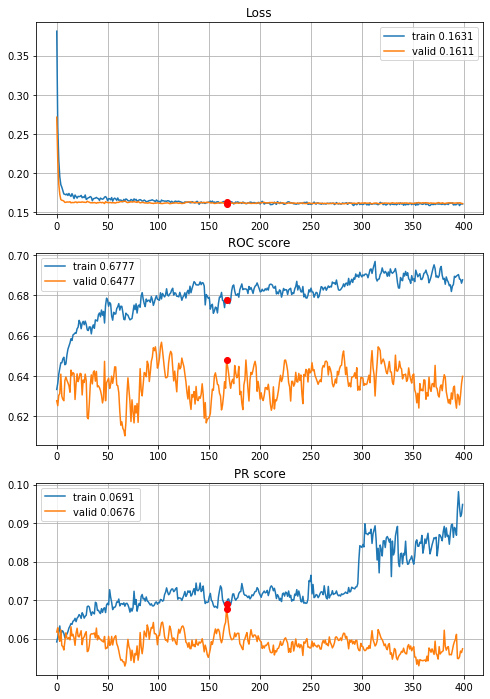


Fold 2------------------------------------------------------------


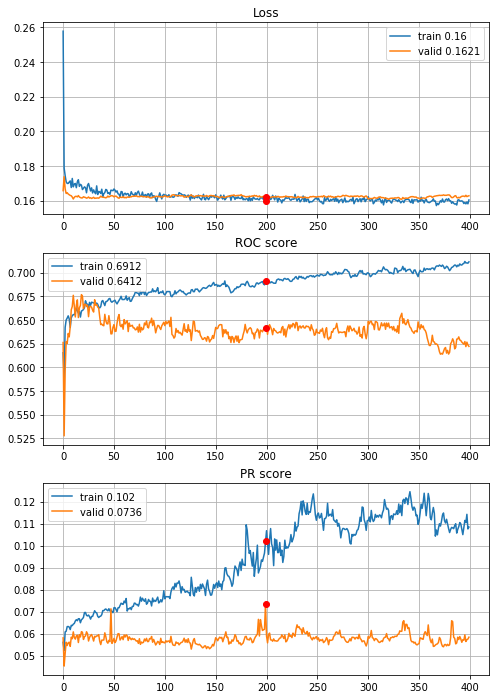


Fold 3------------------------------------------------------------


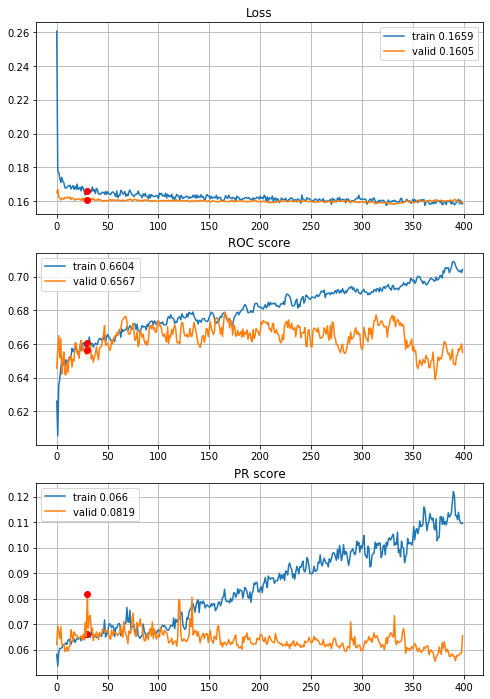


Fold 4------------------------------------------------------------


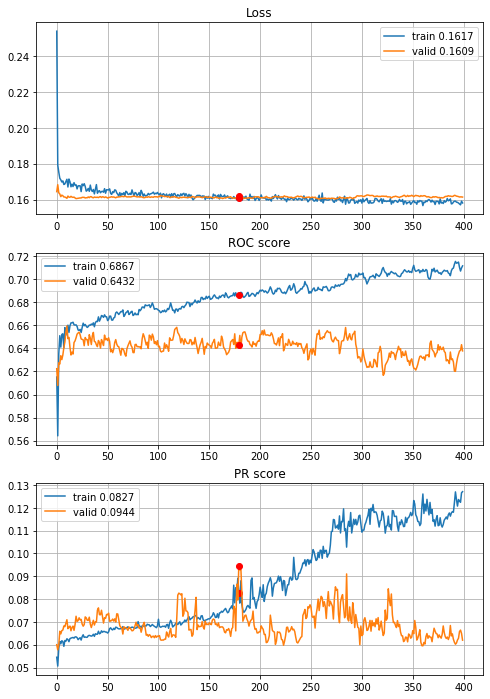


Fold 5------------------------------------------------------------


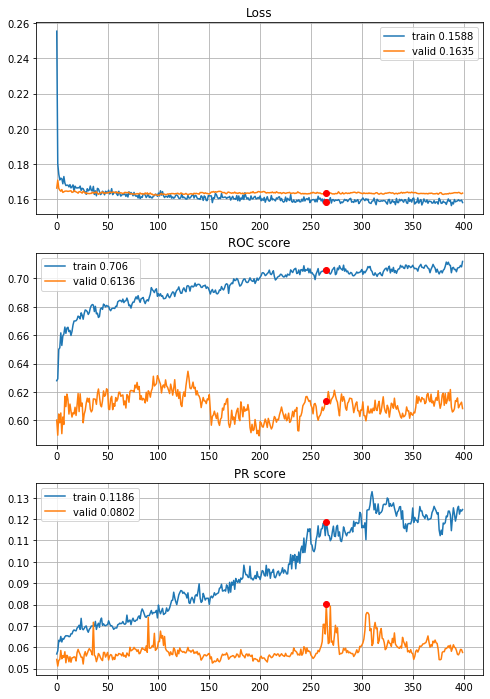


Fold 6------------------------------------------------------------


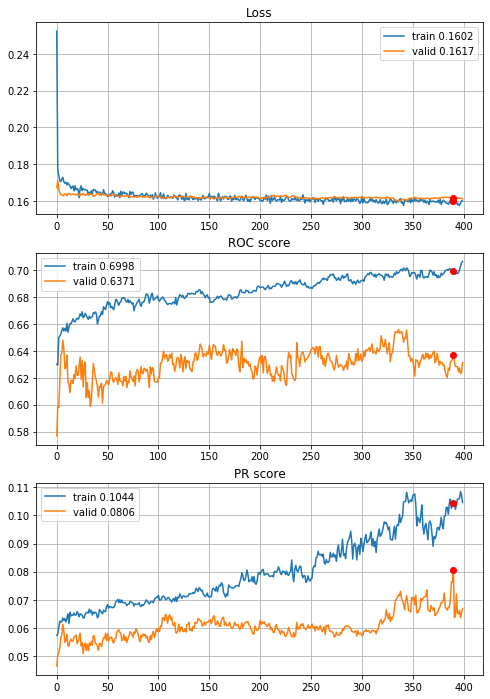

In [64]:
# raw data
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=False, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

Learning curves looks awful on raw data, lets check normalization option for the same architecture


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 2.7s train loss: 0.4570268131260291, validation loss: 0.3186115804537252
Epoch: 2/400,
cumulative time: 2.86s train loss: 0.28662977297225745, validation loss: 0.21659818121755733
Epoch: 3/400,
cumulative time: 3.03s train loss: 0.21467679546996296, validation loss: 0.17804266805339453
Epoch: 4/400,
cumulative time: 3.18s train loss: 0.1883655275237843, validation loss: 0.1663335472696887
Epoch: 5/400,
cumulative time: 3.33s train loss: 0.18157641458384782, validation loss: 0.1632849078425261
Epoch: 6/400,
cumulative time: 3.47s train loss: 0.17759958309214086, validation loss: 0.16276051913574827
Epoch: 7/400,
cumulative time: 3.61s train loss: 0.17743677144821576, validation loss: 0.16281869872760021
Epoch: 8/400,
cumulative time: 3.77s train loss: 0.17391612176728571, validation loss: 0.16294805906703244
Epoch: 9/400,
cumulative time: 3.91s train loss: 0.17366944368685006, v

Epoch: 77/400,
cumulative time: 13.86s train loss: 0.16294842576594634, validation loss: 0.16235232214549578
Epoch: 78/400,
cumulative time: 14.0s train loss: 0.16266502558341234, validation loss: 0.1622154836983543
Epoch: 79/400,
cumulative time: 14.15s train loss: 0.1623323844775786, validation loss: 0.16210773225927416
Epoch: 80/400,
cumulative time: 14.3s train loss: 0.16047841604656934, validation loss: 0.16214989035891986
Epoch: 81/400,
cumulative time: 14.45s train loss: 0.16108629443625477, validation loss: 0.16202663222076383
Epoch: 82/400,
cumulative time: 14.6s train loss: 0.16136247401883458, validation loss: 0.1619083998068132
Epoch: 83/400,
cumulative time: 14.75s train loss: 0.16287564145134262, validation loss: 0.16195187073196057
Epoch: 84/400,
cumulative time: 14.9s train loss: 0.1628563756113175, validation loss: 0.16186479531804668
Epoch: 85/400,
cumulative time: 15.05s train loss: 0.1613473207293683, validation loss: 0.16163594985617566
Epoch: 86/400,
cumulative ti

Epoch: 153/400,
cumulative time: 25.32s train loss: 0.15691080447425534, validation loss: 0.15808756765695886
Epoch: 154/400,
cumulative time: 25.51s train loss: 0.15634003877327254, validation loss: 0.1577481357661487
Epoch: 155/400,
cumulative time: 25.65s train loss: 0.15705867451348896, validation loss: 0.15780811010814744
Epoch: 156/400,
cumulative time: 25.78s train loss: 0.15809802466075437, validation loss: 0.15767474342650228
Epoch: 157/400,
cumulative time: 25.91s train loss: 0.15554793850163642, validation loss: 0.157668242077215
Epoch: 158/400,
cumulative time: 26.06s train loss: 0.15605596686752585, validation loss: 0.1575491012099686
Epoch: 159/400,
cumulative time: 26.21s train loss: 0.15880199102910697, validation loss: 0.15745140782033787
Epoch: 160/400,
cumulative time: 26.36s train loss: 0.1559768034408189, validation loss: 0.1574807062569327
Epoch: 161/400,
cumulative time: 26.51s train loss: 0.15548711722949368, validation loss: 0.15771456894758956
Epoch: 162/400,


Epoch: 230/400,
cumulative time: 36.62s train loss: 0.15318294607814822, validation loss: 0.15705476705165552
Epoch: 231/400,
cumulative time: 36.76s train loss: 0.15273857234478747, validation loss: 0.15698945048713123
Epoch: 232/400,
cumulative time: 36.91s train loss: 0.1554846379215962, validation loss: 0.15710037573683777
Epoch: 233/400,
cumulative time: 37.05s train loss: 0.15381066072212163, validation loss: 0.15695491166563208
Epoch: 234/400,
cumulative time: 37.19s train loss: 0.15502647279341422, validation loss: 0.15695355987837867
Epoch: 235/400,
cumulative time: 37.34s train loss: 0.1538220592959397, validation loss: 0.15705513151491923
Epoch: 236/400,
cumulative time: 37.48s train loss: 0.15458068537952735, validation loss: 0.15684732887527733
Epoch: 237/400,
cumulative time: 37.63s train loss: 0.15134720551844957, validation loss: 0.15653307516210826
Epoch: 238/400,
cumulative time: 37.77s train loss: 0.1533928131339184, validation loss: 0.15655035968884573
Epoch: 239/40

Epoch: 306/400,
cumulative time: 47.8s train loss: 0.15236751684426542, validation loss: 0.15755335758116737
Epoch: 307/400,
cumulative time: 47.97s train loss: 0.1522302223743766, validation loss: 0.15748511856302208
Epoch: 308/400,
cumulative time: 48.14s train loss: 0.150253515346309, validation loss: 0.15729427165785123
Epoch: 309/400,
cumulative time: 48.28s train loss: 0.15401684420752423, validation loss: 0.15730095888105944
Epoch: 310/400,
cumulative time: 48.42s train loss: 0.1509079326650765, validation loss: 0.1573239511091306
Epoch: 311/400,
cumulative time: 48.57s train loss: 0.15221295246276026, validation loss: 0.15726006875695908
Epoch: 312/400,
cumulative time: 48.71s train loss: 0.15241104898700114, validation loss: 0.15712256528446902
Epoch: 313/400,
cumulative time: 48.85s train loss: 0.15287029022844828, validation loss: 0.15723263699839657
Epoch: 314/400,
cumulative time: 48.98s train loss: 0.1523055781334783, validation loss: 0.15713457144103543
Epoch: 315/400,
c

Epoch: 381/400,
cumulative time: 58.74s train loss: 0.1501615824838784, validation loss: 0.15738018925349334
Epoch: 382/400,
cumulative time: 58.89s train loss: 0.15028589047459323, validation loss: 0.15717586109397608
Epoch: 383/400,
cumulative time: 59.04s train loss: 0.14972683669957004, validation loss: 0.15733660747776806
Epoch: 384/400,
cumulative time: 59.18s train loss: 0.15059142639360729, validation loss: 0.1574425702599679
Epoch: 385/400,
cumulative time: 59.31s train loss: 0.15017283535387277, validation loss: 0.15688205734969435
Epoch: 386/400,
cumulative time: 59.45s train loss: 0.15101072911760538, validation loss: 0.15703765471828407
Epoch: 387/400,
cumulative time: 59.59s train loss: 0.15004337600790388, validation loss: 0.15720651803604116
Epoch: 388/400,
cumulative time: 59.73s train loss: 0.1509503467431589, validation loss: 0.15701672974803033
Epoch: 389/400,
cumulative time: 59.88s train loss: 0.14966909887789429, validation loss: 0.15711719251749243
Epoch: 390/40

Epoch: 55/400,
cumulative time: 10.44s train loss: 0.15650304265565432, validation loss: 0.15603645292365848
Epoch: 56/400,
cumulative time: 10.58s train loss: 0.15831355170452638, validation loss: 0.15607531511299264
Epoch: 57/400,
cumulative time: 10.72s train loss: 0.156553250662167, validation loss: 0.15613132406655958
Epoch: 58/400,
cumulative time: 10.86s train loss: 0.15855970374701736, validation loss: 0.15659241282611813
Epoch: 59/400,
cumulative time: 11.01s train loss: 0.1591206147909352, validation loss: 0.15626377759801607
Epoch: 60/400,
cumulative time: 11.16s train loss: 0.1590710582634243, validation loss: 0.15636750325306684
Epoch: 61/400,
cumulative time: 11.31s train loss: 0.1577068245735936, validation loss: 0.1565723736351783
Epoch: 62/400,
cumulative time: 11.45s train loss: 0.1561896552075751, validation loss: 0.15666563283569065
Epoch: 63/400,
cumulative time: 11.6s train loss: 0.15756863145274155, validation loss: 0.15638568093158
Epoch: 64/400,
cumulative time

Epoch: 131/400,
cumulative time: 21.4s train loss: 0.1554747856123089, validation loss: 0.15819620625219682
Epoch: 132/400,
cumulative time: 21.55s train loss: 0.15470327498841244, validation loss: 0.15822731530681974
Epoch: 133/400,
cumulative time: 21.7s train loss: 0.15282166077036238, validation loss: 0.1583460433650298
Epoch: 134/400,
cumulative time: 21.84s train loss: 0.15467210480818072, validation loss: 0.15834283012393888
Epoch: 135/400,
cumulative time: 21.99s train loss: 0.15433894321058755, validation loss: 0.15830148067105645
Epoch: 136/400,
cumulative time: 22.13s train loss: 0.15262362779530617, validation loss: 0.158609699218645
Epoch: 137/400,
cumulative time: 22.28s train loss: 0.15237592915037634, validation loss: 0.15850275450265267
Epoch: 138/400,
cumulative time: 22.43s train loss: 0.15537126148445513, validation loss: 0.1585999804196164
Epoch: 139/400,
cumulative time: 22.58s train loss: 0.15540909110085652, validation loss: 0.15886206710088613
Epoch: 140/400,
c

Epoch: 207/400,
cumulative time: 32.55s train loss: 0.15128616125723657, validation loss: 0.15987759715295244
Epoch: 208/400,
cumulative time: 32.7s train loss: 0.15169769567717636, validation loss: 0.1593915935542293
Epoch: 209/400,
cumulative time: 32.85s train loss: 0.15307698140514367, validation loss: 0.15930270640909439
Epoch: 210/400,
cumulative time: 32.99s train loss: 0.15273391258429067, validation loss: 0.15933164784277096
Epoch: 211/400,
cumulative time: 33.14s train loss: 0.1509402591765888, validation loss: 0.15930511324933752
Epoch: 212/400,
cumulative time: 33.29s train loss: 0.15223336716492972, validation loss: 0.15951292255837202
Epoch: 213/400,
cumulative time: 33.44s train loss: 0.1519678674881448, validation loss: 0.1594403556415013
Epoch: 214/400,
cumulative time: 33.58s train loss: 0.15179359255611763, validation loss: 0.15940604629397861
Epoch: 215/400,
cumulative time: 33.73s train loss: 0.15165308747977224, validation loss: 0.1592480431299847
Epoch: 216/400,


Epoch: 283/400,
cumulative time: 43.74s train loss: 0.14940664010054788, validation loss: 0.1604669500108159
Epoch: 284/400,
cumulative time: 43.89s train loss: 0.15058176543503543, validation loss: 0.1598545964978157
Epoch: 285/400,
cumulative time: 44.04s train loss: 0.1525480418514496, validation loss: 0.15967340927527116
Epoch: 286/400,
cumulative time: 44.19s train loss: 0.15100123119969125, validation loss: 0.15989965132070244
Epoch: 287/400,
cumulative time: 44.34s train loss: 0.1487038481376527, validation loss: 0.15983174842822598
Epoch: 288/400,
cumulative time: 44.49s train loss: 0.14875126585241288, validation loss: 0.16021726328298586
Epoch: 289/400,
cumulative time: 44.64s train loss: 0.15168456378716255, validation loss: 0.1603114608660594
Epoch: 290/400,
cumulative time: 44.77s train loss: 0.14988685270478644, validation loss: 0.15994328029971291
Epoch: 291/400,
cumulative time: 44.92s train loss: 0.1507377942086735, validation loss: 0.15997990522519007
Epoch: 292/400,


Epoch: 359/400,
cumulative time: 54.95s train loss: 0.14740616345463395, validation loss: 0.16084163385012515
Epoch: 360/400,
cumulative time: 55.11s train loss: 0.14827757892938034, validation loss: 0.16120273181448444
Epoch: 361/400,
cumulative time: 55.24s train loss: 0.14858484073451844, validation loss: 0.16094694465281612
Epoch: 362/400,
cumulative time: 55.4s train loss: 0.14908905535533992, validation loss: 0.16093561602060635
Epoch: 363/400,
cumulative time: 55.56s train loss: 0.14930537592256846, validation loss: 0.16064954540285808
Epoch: 364/400,
cumulative time: 55.7s train loss: 0.14829047318210545, validation loss: 0.16060450477806332
Epoch: 365/400,
cumulative time: 55.85s train loss: 0.1499116531044522, validation loss: 0.16074392459261308
Epoch: 366/400,
cumulative time: 56.0s train loss: 0.1484618778328921, validation loss: 0.1608729210546726
Epoch: 367/400,
cumulative time: 56.16s train loss: 0.14733408326628575, validation loss: 0.1606994215032845
Epoch: 368/400,
c

Epoch: 34/400,
cumulative time: 7.99s train loss: 0.1578883819036925, validation loss: 0.1571383276468492
Epoch: 35/400,
cumulative time: 8.14s train loss: 0.15664566099362442, validation loss: 0.15725780923900878
Epoch: 36/400,
cumulative time: 8.29s train loss: 0.16068186051044883, validation loss: 0.1568118615239507
Epoch: 37/400,
cumulative time: 8.43s train loss: 0.15585756348561985, validation loss: 0.15708634173338878
Epoch: 38/400,
cumulative time: 8.57s train loss: 0.16004691066615687, validation loss: 0.15672875866586852
Epoch: 39/400,
cumulative time: 8.72s train loss: 0.1574147714357855, validation loss: 0.15643297297926437
Epoch: 40/400,
cumulative time: 8.86s train loss: 0.15838963212707843, validation loss: 0.15679026183185227
Epoch: 41/400,
cumulative time: 9.0s train loss: 0.15711172714757177, validation loss: 0.15682157460077717
Epoch: 42/400,
cumulative time: 9.14s train loss: 0.15746524840640216, validation loss: 0.15680529343191324
Epoch: 43/400,
cumulative time: 9

Epoch: 110/400,
cumulative time: 19.09s train loss: 0.15291995361890717, validation loss: 0.15390502771809403
Epoch: 111/400,
cumulative time: 19.23s train loss: 0.1524724636189293, validation loss: 0.1545238807152952
Epoch: 112/400,
cumulative time: 19.39s train loss: 0.15433352884661558, validation loss: 0.15397566031581608
Epoch: 113/400,
cumulative time: 19.53s train loss: 0.15323552941647844, validation loss: 0.15397652751262034
Epoch: 114/400,
cumulative time: 19.67s train loss: 0.15393964549374464, validation loss: 0.15413709006334508
Epoch: 115/400,
cumulative time: 19.83s train loss: 0.15089484663290284, validation loss: 0.15408197463261816
Epoch: 116/400,
cumulative time: 19.98s train loss: 0.15251737943380342, validation loss: 0.1540420952583828
Epoch: 117/400,
cumulative time: 20.14s train loss: 0.15003809338902596, validation loss: 0.15389848909637407
Epoch: 118/400,
cumulative time: 20.29s train loss: 0.1527630752954778, validation loss: 0.1537547130162094
Epoch: 119/400,

Epoch: 186/400,
cumulative time: 30.17s train loss: 0.14748046400194198, validation loss: 0.15264011868721222
Epoch: 187/400,
cumulative time: 30.31s train loss: 0.1484994106859004, validation loss: 0.15254329894895166
Epoch: 188/400,
cumulative time: 30.44s train loss: 0.14809747640302787, validation loss: 0.15289890420468108
Epoch: 189/400,
cumulative time: 30.63s train loss: 0.14877324410125678, validation loss: 0.152485054147431
Epoch: 190/400,
cumulative time: 30.76s train loss: 0.1487702795661188, validation loss: 0.15223870689090863
Epoch: 191/400,
cumulative time: 30.9s train loss: 0.14903227065717084, validation loss: 0.1523053063907286
Epoch: 192/400,
cumulative time: 31.03s train loss: 0.14842971638850952, validation loss: 0.1525298183879096
Epoch: 193/400,
cumulative time: 31.17s train loss: 0.15073992355120794, validation loss: 0.15230322141947314
Epoch: 194/400,
cumulative time: 31.31s train loss: 0.15020033951347256, validation loss: 0.15231834192849392
Epoch: 195/400,
c

Epoch: 261/400,
cumulative time: 40.91s train loss: 0.14582946039672792, validation loss: 0.1501678980564696
Epoch: 262/400,
cumulative time: 41.05s train loss: 0.144882360170281, validation loss: 0.15017832643785764
Epoch: 263/400,
cumulative time: 41.2s train loss: 0.14374898635324637, validation loss: 0.1503730473519934
Epoch: 264/400,
cumulative time: 41.34s train loss: 0.14439010353111192, validation loss: 0.1500198010399176
Epoch: 265/400,
cumulative time: 41.49s train loss: 0.14609474399397954, validation loss: 0.1501003516005501
Epoch: 266/400,
cumulative time: 41.64s train loss: 0.1447415364788266, validation loss: 0.1501247714985245
Epoch: 267/400,
cumulative time: 41.81s train loss: 0.14439320910381667, validation loss: 0.14975082835238696
Epoch: 268/400,
cumulative time: 41.97s train loss: 0.14533117957005948, validation loss: 0.1496839563546612
Epoch: 269/400,
cumulative time: 42.15s train loss: 0.14476654030600417, validation loss: 0.1496753434151372
Epoch: 270/400,
cumul

Epoch: 337/400,
cumulative time: 52.14s train loss: 0.14216098984902895, validation loss: 0.1480109526203313
Epoch: 338/400,
cumulative time: 52.28s train loss: 0.1404475334439432, validation loss: 0.1483228555923208
Epoch: 339/400,
cumulative time: 52.42s train loss: 0.14270462995979324, validation loss: 0.14778744553363496
Epoch: 340/400,
cumulative time: 52.55s train loss: 0.14264333817503808, validation loss: 0.14773088984611307
Epoch: 341/400,
cumulative time: 52.69s train loss: 0.1436562114023478, validation loss: 0.14802657625348664
Epoch: 342/400,
cumulative time: 52.82s train loss: 0.14002668009288408, validation loss: 0.14809111590701038
Epoch: 343/400,
cumulative time: 52.96s train loss: 0.14237315885782212, validation loss: 0.1483014748965147
Epoch: 344/400,
cumulative time: 53.1s train loss: 0.1431098966591323, validation loss: 0.14813563805732627
Epoch: 345/400,
cumulative time: 53.25s train loss: 0.14382305029456902, validation loss: 0.1478598762699067
Epoch: 346/400,
cu

Epoch: 11/400,
cumulative time: 4.92s train loss: 0.16851443667948707, validation loss: 0.1606831928107248
Epoch: 12/400,
cumulative time: 5.07s train loss: 0.16514966774500905, validation loss: 0.1610526575915623
Epoch: 13/400,
cumulative time: 5.23s train loss: 0.16820015555335804, validation loss: 0.16054626369695052
Epoch: 14/400,
cumulative time: 5.36s train loss: 0.1659521542627231, validation loss: 0.16045441407207425
Epoch: 15/400,
cumulative time: 5.5s train loss: 0.16408076733721866, validation loss: 0.16062503697675304
Epoch: 16/400,
cumulative time: 5.64s train loss: 0.16574480384881227, validation loss: 0.16032372467795955
Epoch: 17/400,
cumulative time: 5.78s train loss: 0.16500286954245227, validation loss: 0.16003724895564164
Epoch: 18/400,
cumulative time: 5.93s train loss: 0.166804629090042, validation loss: 0.16011251542390095
Epoch: 19/400,
cumulative time: 6.07s train loss: 0.16571442677014026, validation loss: 0.1599319374498815
Epoch: 20/400,
cumulative time: 6.2

Epoch: 88/400,
cumulative time: 16.42s train loss: 0.15623969990095501, validation loss: 0.15562173173436955
Epoch: 89/400,
cumulative time: 16.56s train loss: 0.15658078550011104, validation loss: 0.15557367738390032
Epoch: 90/400,
cumulative time: 16.7s train loss: 0.15742438965777236, validation loss: 0.15566097672535584
Epoch: 91/400,
cumulative time: 16.84s train loss: 0.15857761106854856, validation loss: 0.155678136750255
Epoch: 92/400,
cumulative time: 16.98s train loss: 0.15725155567135313, validation loss: 0.15557033218062566
Epoch: 93/400,
cumulative time: 17.12s train loss: 0.15723375949326465, validation loss: 0.15551237603783763
Epoch: 94/400,
cumulative time: 17.26s train loss: 0.15763891837452823, validation loss: 0.15550504671714876
Epoch: 95/400,
cumulative time: 17.4s train loss: 0.15869725860732461, validation loss: 0.15547771099588661
Epoch: 96/400,
cumulative time: 17.56s train loss: 0.15753838854507032, validation loss: 0.1553604972315647
Epoch: 97/400,
cumulativ

Epoch: 164/400,
cumulative time: 27.42s train loss: 0.15528029132708135, validation loss: 0.15406848867161402
Epoch: 165/400,
cumulative time: 27.57s train loss: 0.15409580913861498, validation loss: 0.1541163415146374
Epoch: 166/400,
cumulative time: 27.72s train loss: 0.15325418370437116, validation loss: 0.15411400582109178
Epoch: 167/400,
cumulative time: 27.87s train loss: 0.15368479781115504, validation loss: 0.15399735425824732
Epoch: 168/400,
cumulative time: 28.01s train loss: 0.15367849044592607, validation loss: 0.15406535544370448
Epoch: 169/400,
cumulative time: 28.17s train loss: 0.15363038312421587, validation loss: 0.15407339730550235
Epoch: 170/400,
cumulative time: 28.32s train loss: 0.15522563580932897, validation loss: 0.15412407836157874
Epoch: 171/400,
cumulative time: 28.47s train loss: 0.15331474494646566, validation loss: 0.1541537025731013
Epoch: 172/400,
cumulative time: 28.61s train loss: 0.15326068561188685, validation loss: 0.1541576865342779
Epoch: 173/40

Epoch: 240/400,
cumulative time: 38.6s train loss: 0.15159277804073804, validation loss: 0.1528779678388473
Epoch: 241/400,
cumulative time: 38.75s train loss: 0.1533417865362466, validation loss: 0.15277012743221824
Epoch: 242/400,
cumulative time: 38.9s train loss: 0.15174646157591165, validation loss: 0.1527747575530531
Epoch: 243/400,
cumulative time: 39.05s train loss: 0.15179142364903725, validation loss: 0.15293474225901058
Epoch: 244/400,
cumulative time: 39.2s train loss: 0.15188287075587972, validation loss: 0.1528975916916546
Epoch: 245/400,
cumulative time: 39.35s train loss: 0.15249197090894026, validation loss: 0.1530458279354388
Epoch: 246/400,
cumulative time: 39.5s train loss: 0.15202516607128633, validation loss: 0.152962629577123
Epoch: 247/400,
cumulative time: 39.66s train loss: 0.1523185329772273, validation loss: 0.15276852002071992
Epoch: 248/400,
cumulative time: 39.81s train loss: 0.1506009071680568, validation loss: 0.1527953205305502
Epoch: 249/400,
cumulati

Epoch: 316/400,
cumulative time: 49.85s train loss: 0.15156781248214096, validation loss: 0.15130342923954304
Epoch: 317/400,
cumulative time: 50.01s train loss: 0.14925903142834573, validation loss: 0.15113877623218697
Epoch: 318/400,
cumulative time: 50.15s train loss: 0.14990351650791128, validation loss: 0.15115505279204167
Epoch: 319/400,
cumulative time: 50.32s train loss: 0.15142575420828913, validation loss: 0.15151228455931612
Epoch: 320/400,
cumulative time: 50.47s train loss: 0.1510249321157427, validation loss: 0.15129466575532566
Epoch: 321/400,
cumulative time: 50.62s train loss: 0.15024798676451656, validation loss: 0.15122674526658939
Epoch: 322/400,
cumulative time: 50.77s train loss: 0.14988191756481486, validation loss: 0.15110436913851516
Epoch: 323/400,
cumulative time: 50.92s train loss: 0.14802269591097908, validation loss: 0.1510603406990184
Epoch: 324/400,
cumulative time: 51.06s train loss: 0.14866501674386148, validation loss: 0.15107240028884433
Epoch: 325/4

Epoch: 392/400,
cumulative time: 61.03s train loss: 0.14926912855205068, validation loss: 0.15018034897266178
Epoch: 393/400,
cumulative time: 61.18s train loss: 0.1483696393657909, validation loss: 0.15007132889402647
Epoch: 394/400,
cumulative time: 61.33s train loss: 0.14865897220277055, validation loss: 0.1500098034837143
Epoch: 395/400,
cumulative time: 61.49s train loss: 0.14824536039610806, validation loss: 0.1501376079505268
Epoch: 396/400,
cumulative time: 61.66s train loss: 0.1484285658456142, validation loss: 0.14983066188007946
Epoch: 397/400,
cumulative time: 61.82s train loss: 0.14618906386558936, validation loss: 0.15006585247316648
Epoch: 398/400,
cumulative time: 61.97s train loss: 0.14782146934987772, validation loss: 0.15000173648719237
Epoch: 399/400,
cumulative time: 62.13s train loss: 0.1485709736580492, validation loss: 0.1499659062642726
Epoch: 400/400,
cumulative time: 62.29s train loss: 0.14909533771536956, validation loss: 0.1500475670688274

Early stopping r

Epoch: 67/400,
cumulative time: 13.13s train loss: 0.15499062157814805, validation loss: 0.1677531078555481
Epoch: 68/400,
cumulative time: 13.26s train loss: 0.15594308669335222, validation loss: 0.16792537529768511
Epoch: 69/400,
cumulative time: 13.4s train loss: 0.15486110872062292, validation loss: 0.1679830399792285
Epoch: 70/400,
cumulative time: 13.53s train loss: 0.15498665803236486, validation loss: 0.16789238482987115
Epoch: 71/400,
cumulative time: 13.67s train loss: 0.1541388487832264, validation loss: 0.16811632633521703
Epoch: 72/400,
cumulative time: 13.8s train loss: 0.15843584731969285, validation loss: 0.16824127335301545
Epoch: 73/400,
cumulative time: 13.95s train loss: 0.1546309505804039, validation loss: 0.16792152220502907
Epoch: 74/400,
cumulative time: 14.09s train loss: 0.15573144088348972, validation loss: 0.16780124538301017
Epoch: 75/400,
cumulative time: 14.23s train loss: 0.15596283713070244, validation loss: 0.167618070173701
Epoch: 76/400,
cumulative t

Epoch: 143/400,
cumulative time: 24.09s train loss: 0.15295285734288547, validation loss: 0.16811784029710028
Epoch: 144/400,
cumulative time: 24.23s train loss: 0.15307626436611102, validation loss: 0.1682961096847979
Epoch: 145/400,
cumulative time: 24.38s train loss: 0.15211237088257934, validation loss: 0.16799724394965765
Epoch: 146/400,
cumulative time: 24.51s train loss: 0.15384524696963003, validation loss: 0.1677759268258846
Epoch: 147/400,
cumulative time: 24.67s train loss: 0.1515200413457843, validation loss: 0.16780677662373839
Epoch: 148/400,
cumulative time: 24.81s train loss: 0.15167621316978855, validation loss: 0.16790060663832593
Epoch: 149/400,
cumulative time: 24.96s train loss: 0.1511663968100712, validation loss: 0.16769200684514926
Epoch: 150/400,
cumulative time: 25.1s train loss: 0.15374080049818162, validation loss: 0.16752820992219808
Epoch: 151/400,
cumulative time: 25.24s train loss: 0.15369576290552575, validation loss: 0.16746788976779928
Epoch: 152/400,

Epoch: 219/400,
cumulative time: 35.2s train loss: 0.15007162989670333, validation loss: 0.16779848124690325
Epoch: 220/400,
cumulative time: 35.35s train loss: 0.15176455217156878, validation loss: 0.16746064159301444
Epoch: 221/400,
cumulative time: 35.49s train loss: 0.15082661527835114, validation loss: 0.1667544450000573
Epoch: 222/400,
cumulative time: 35.64s train loss: 0.15023058150312757, validation loss: 0.16668111742089647
Epoch: 223/400,
cumulative time: 35.78s train loss: 0.14753640280089914, validation loss: 0.1673083332895764
Epoch: 224/400,
cumulative time: 35.92s train loss: 0.14976497536808592, validation loss: 0.1679220171852787
Epoch: 225/400,
cumulative time: 36.07s train loss: 0.15040051440202576, validation loss: 0.1671977099202095
Epoch: 226/400,
cumulative time: 36.21s train loss: 0.15084403001874597, validation loss: 0.1674863952718587
Epoch: 227/400,
cumulative time: 36.36s train loss: 0.14922386932684, validation loss: 0.16695853296379273
Epoch: 228/400,
cum

Epoch: 295/400,
cumulative time: 46.45s train loss: 0.14835107893333754, validation loss: 0.16738827571487677
Epoch: 296/400,
cumulative time: 46.61s train loss: 0.14913246201209432, validation loss: 0.16707898373685065
Epoch: 297/400,
cumulative time: 46.77s train loss: 0.14642788766095796, validation loss: 0.1675637500118928
Epoch: 298/400,
cumulative time: 46.95s train loss: 0.14639268080127835, validation loss: 0.16779070409066085
Epoch: 299/400,
cumulative time: 47.1s train loss: 0.1472027545511871, validation loss: 0.16737626961689944
Epoch: 300/400,
cumulative time: 47.25s train loss: 0.14984561483694225, validation loss: 0.1671905052380668
Epoch: 301/400,
cumulative time: 47.41s train loss: 0.14852633398733783, validation loss: 0.16747988811248565
Epoch: 302/400,
cumulative time: 47.57s train loss: 0.14821447890463313, validation loss: 0.16785080246578507
Epoch: 303/400,
cumulative time: 47.73s train loss: 0.1476864588105955, validation loss: 0.16749340414922798
Epoch: 304/400,

Epoch: 370/400,
cumulative time: 57.78s train loss: 0.14644381297667539, validation loss: 0.1668171167647073
Epoch: 371/400,
cumulative time: 57.93s train loss: 0.14808338819598288, validation loss: 0.16704395329421032
Epoch: 372/400,
cumulative time: 58.09s train loss: 0.14784355615121006, validation loss: 0.16777346803663912
Epoch: 373/400,
cumulative time: 58.24s train loss: 0.1459068789705097, validation loss: 0.16747989455728668
Epoch: 374/400,
cumulative time: 58.39s train loss: 0.14625376377580426, validation loss: 0.1676249280669586
Epoch: 375/400,
cumulative time: 58.52s train loss: 0.1455947959336342, validation loss: 0.1676096530877747
Epoch: 376/400,
cumulative time: 58.69s train loss: 0.14441882627032845, validation loss: 0.16720851306677803
Epoch: 377/400,
cumulative time: 58.83s train loss: 0.1473334466767258, validation loss: 0.1672061119096776
Epoch: 378/400,
cumulative time: 58.97s train loss: 0.14619172649156034, validation loss: 0.16735568902361284
Epoch: 379/400,
c

Epoch: 45/400,
cumulative time: 10.42s train loss: 0.159421427526449, validation loss: 0.16207851922902905
Epoch: 46/400,
cumulative time: 10.56s train loss: 0.1592684532700016, validation loss: 0.16220538701190323
Epoch: 47/400,
cumulative time: 10.7s train loss: 0.16060689387362093, validation loss: 0.16188338464400806
Epoch: 48/400,
cumulative time: 10.83s train loss: 0.15827672913338536, validation loss: 0.16186533676796272
Epoch: 49/400,
cumulative time: 10.96s train loss: 0.15844065256778098, validation loss: 0.16225881334211006
Epoch: 50/400,
cumulative time: 11.1s train loss: 0.15911995516809224, validation loss: 0.16179925174009605
Epoch: 51/400,
cumulative time: 11.24s train loss: 0.15904620968069036, validation loss: 0.16184314017413093
Epoch: 52/400,
cumulative time: 11.38s train loss: 0.15871649864538626, validation loss: 0.1616955166859705
Epoch: 53/400,
cumulative time: 11.51s train loss: 0.15845212164197026, validation loss: 0.1616371205204823
Epoch: 54/400,
cumulative 

Epoch: 121/400,
cumulative time: 21.24s train loss: 0.15676144581009802, validation loss: 0.1610567522537513
Epoch: 122/400,
cumulative time: 21.37s train loss: 0.15566000022472593, validation loss: 0.161274895599631
Epoch: 123/400,
cumulative time: 21.51s train loss: 0.15603190526893534, validation loss: 0.16123156343327194
Epoch: 124/400,
cumulative time: 21.64s train loss: 0.15426962352205228, validation loss: 0.16136176658458398
Epoch: 125/400,
cumulative time: 21.78s train loss: 0.15510165814998733, validation loss: 0.16108534715214715
Epoch: 126/400,
cumulative time: 21.94s train loss: 0.15392915184852493, validation loss: 0.16103136891224346
Epoch: 127/400,
cumulative time: 22.09s train loss: 0.15374508775858547, validation loss: 0.16104722696249602
Epoch: 128/400,
cumulative time: 22.24s train loss: 0.15681340905934144, validation loss: 0.16118483867801603
Epoch: 129/400,
cumulative time: 22.39s train loss: 0.15429715000942526, validation loss: 0.16117296957578817
Epoch: 130/40

Epoch: 197/400,
cumulative time: 32.1s train loss: 0.15281854879457704, validation loss: 0.16113750913104072
Epoch: 198/400,
cumulative time: 32.23s train loss: 0.15245900427138978, validation loss: 0.16107570787922282
Epoch: 199/400,
cumulative time: 32.4s train loss: 0.15442917677396872, validation loss: 0.16061577865334808
Epoch: 200/400,
cumulative time: 32.54s train loss: 0.15347408072468807, validation loss: 0.16069431084101318
Epoch: 201/400,
cumulative time: 32.7s train loss: 0.15259559960501223, validation loss: 0.16088969845263684
Epoch: 202/400,
cumulative time: 32.85s train loss: 0.15260919303795614, validation loss: 0.16073451339221392
Epoch: 203/400,
cumulative time: 33.0s train loss: 0.15255173961699087, validation loss: 0.16078706384682265
Epoch: 204/400,
cumulative time: 33.16s train loss: 0.1529114661491714, validation loss: 0.16069219212063024
Epoch: 205/400,
cumulative time: 33.33s train loss: 0.15274944046065506, validation loss: 0.16070903338369777
Epoch: 206/400,

Epoch: 273/400,
cumulative time: 43.29s train loss: 0.15045684626225875, validation loss: 0.1599782287976781
Epoch: 274/400,
cumulative time: 43.44s train loss: 0.15123993532334212, validation loss: 0.16005787104856772
Epoch: 275/400,
cumulative time: 43.59s train loss: 0.15011686476272182, validation loss: 0.16039018963204055
Epoch: 276/400,
cumulative time: 43.73s train loss: 0.14835336607335278, validation loss: 0.16011623262381944
Epoch: 277/400,
cumulative time: 43.88s train loss: 0.15170151286637643, validation loss: 0.1600792082997619
Epoch: 278/400,
cumulative time: 44.03s train loss: 0.15077101015247804, validation loss: 0.16020464013834468
Epoch: 279/400,
cumulative time: 44.17s train loss: 0.1506586353537452, validation loss: 0.16026660213704969
Epoch: 280/400,
cumulative time: 44.31s train loss: 0.14920476987899364, validation loss: 0.16034813146122168
Epoch: 281/400,
cumulative time: 44.45s train loss: 0.15271166899140196, validation loss: 0.16025388189026568
Epoch: 282/40

Epoch: 349/400,
cumulative time: 54.44s train loss: 0.14853416048136794, validation loss: 0.1596777021884918
Epoch: 350/400,
cumulative time: 54.59s train loss: 0.14921734232265077, validation loss: 0.15971224571837753
Epoch: 351/400,
cumulative time: 54.74s train loss: 0.14786729942689872, validation loss: 0.15950715674728644
Epoch: 352/400,
cumulative time: 54.88s train loss: 0.1483112405746355, validation loss: 0.15934173487248968
Epoch: 353/400,
cumulative time: 55.02s train loss: 0.1489692045226791, validation loss: 0.1596442469514784
Epoch: 354/400,
cumulative time: 55.16s train loss: 0.1475010312205061, validation loss: 0.15955869779235027
Epoch: 355/400,
cumulative time: 55.31s train loss: 0.1475720567167352, validation loss: 0.15943044311687596
Epoch: 356/400,
cumulative time: 55.46s train loss: 0.1483158007146959, validation loss: 0.15944444086708007
Epoch: 357/400,
cumulative time: 55.6s train loss: 0.14769439086571903, validation loss: 0.15952484193395397
Epoch: 358/400,
cu

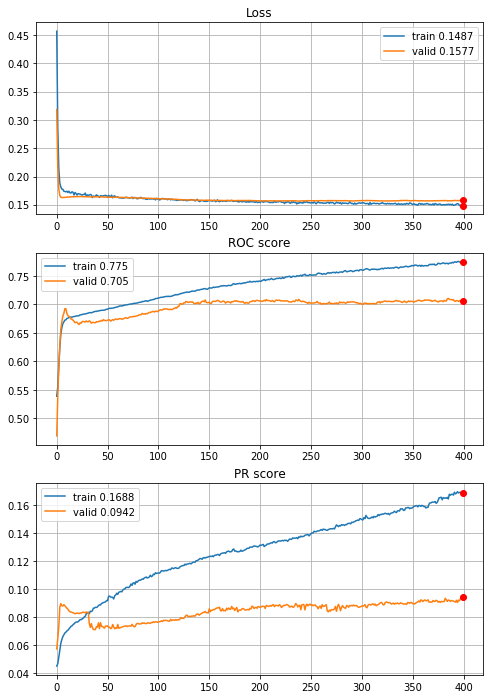


Fold 2------------------------------------------------------------


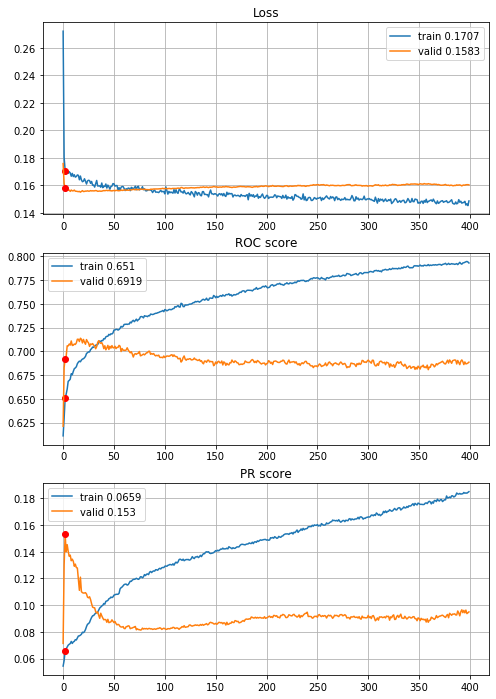


Fold 3------------------------------------------------------------


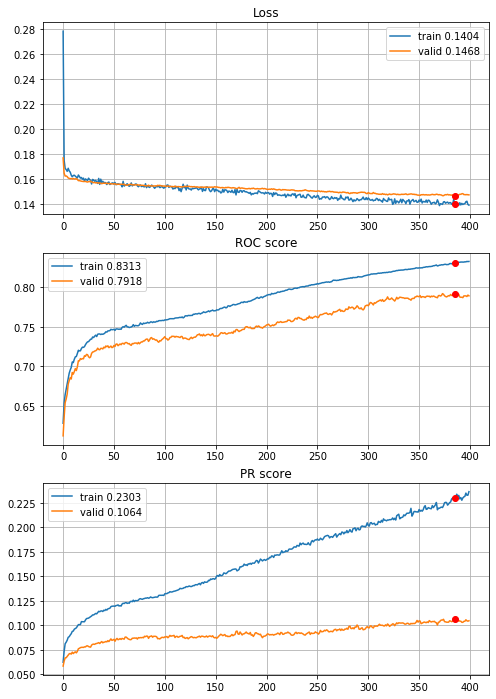


Fold 4------------------------------------------------------------


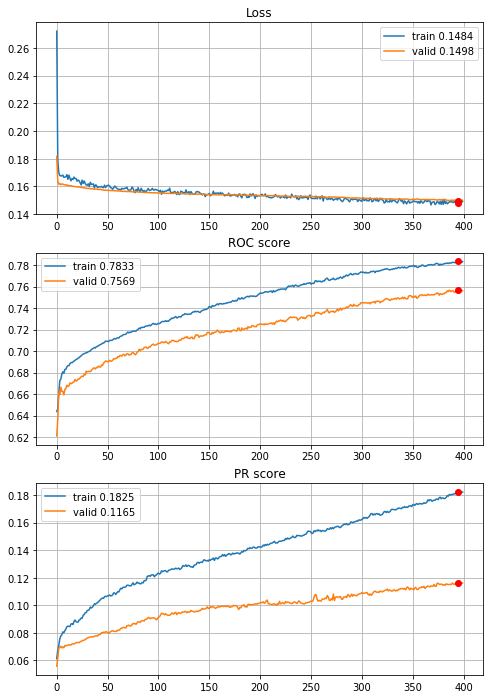


Fold 5------------------------------------------------------------


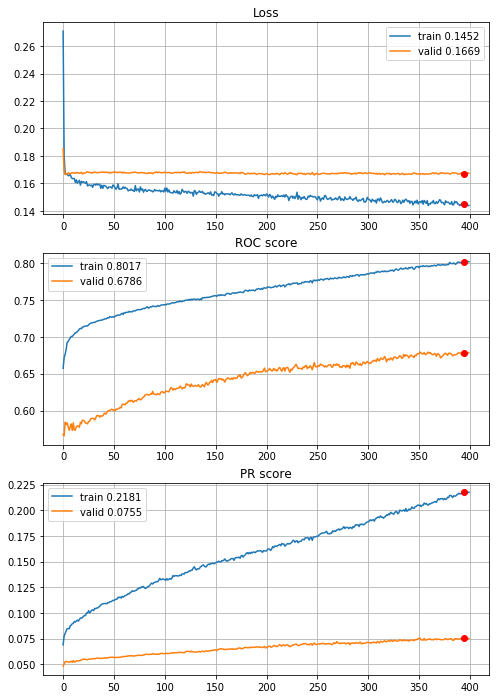


Fold 6------------------------------------------------------------


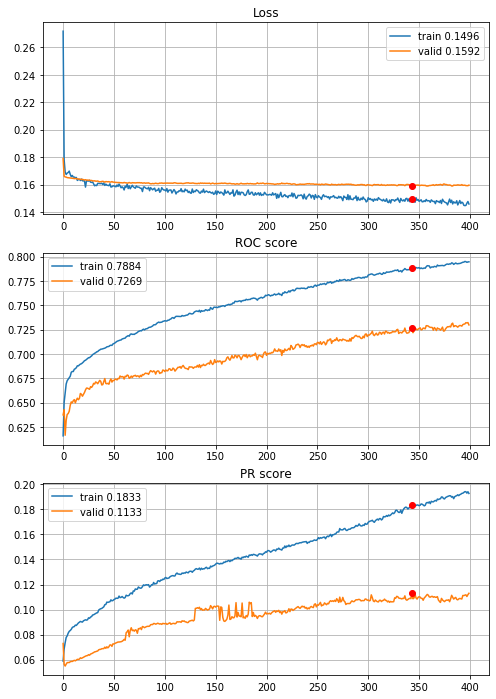

In [65]:
# normalization
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=None, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

\+ 0.03 on PR, smoother learning curves


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 4.02s train loss: 0.46405001236830207, validation loss: 0.31712307112088833
Epoch: 2/400,
cumulative time: 4.16s train loss: 0.2915393628335308, validation loss: 0.22393678531031153
Epoch: 3/400,
cumulative time: 4.3s train loss: 0.22655632196763095, validation loss: 0.18708230258206085
Epoch: 4/400,
cumulative time: 4.43s train loss: 0.1983630764975056, validation loss: 0.17172278018563322
Epoch: 5/400,
cumulative time: 4.57s train loss: 0.1858052680065504, validation loss: 0.16493470021578463
Epoch: 6/400,
cumulative time: 4.7s train loss: 0.17735180280431725, validation loss: 0.16166862884480238
Epoch: 7/400,
cumulative time: 4.83s train loss: 0.1740084612825811, validation loss: 0.1600865649442685
Epoch: 8/400,
cumulative time: 4.98s train loss: 0.16984714182582777, validation loss: 0.1593559272538475
Epoch: 9/400,
cumulative time: 5.13s train loss: 0.16846530629705986, val

Epoch: 77/400,
cumulative time: 16.45s train loss: 0.14623127265375896, validation loss: 0.15077938039837158
Epoch: 78/400,
cumulative time: 16.64s train loss: 0.14502180403061596, validation loss: 0.1504675356346533
Epoch: 79/400,
cumulative time: 16.79s train loss: 0.14605209352281337, validation loss: 0.15084101490158866
Epoch: 80/400,
cumulative time: 16.93s train loss: 0.14235642708047905, validation loss: 0.15087766130973596
Epoch: 81/400,
cumulative time: 17.07s train loss: 0.145225642855709, validation loss: 0.151197918247661
Epoch: 82/400,
cumulative time: 17.23s train loss: 0.14408624723020427, validation loss: 0.1510009200142533
Epoch: 83/400,
cumulative time: 17.37s train loss: 0.14574934705664125, validation loss: 0.1514306040492939
Epoch: 84/400,
cumulative time: 17.51s train loss: 0.14715665044439527, validation loss: 0.15130504109404816
Epoch: 85/400,
cumulative time: 17.65s train loss: 0.1456250863379022, validation loss: 0.15108191119421513
Epoch: 86/400,
cumulative t

Epoch: 153/400,
cumulative time: 28.58s train loss: 0.13569435275195546, validation loss: 0.15061797199680482
Epoch: 154/400,
cumulative time: 28.73s train loss: 0.1357933489190968, validation loss: 0.1507326370962013
Epoch: 155/400,
cumulative time: 28.86s train loss: 0.134615861823806, validation loss: 0.15093326670157955
Epoch: 156/400,
cumulative time: 29.01s train loss: 0.1354239580476248, validation loss: 0.1506796198388071
Epoch: 157/400,
cumulative time: 29.15s train loss: 0.1354003128825032, validation loss: 0.15138617077864325
Epoch: 158/400,
cumulative time: 29.28s train loss: 0.1383367101367046, validation loss: 0.15046468476714814
Epoch: 159/400,
cumulative time: 29.41s train loss: 0.13608203487887516, validation loss: 0.1506750548006979
Epoch: 160/400,
cumulative time: 29.55s train loss: 0.13507997062067512, validation loss: 0.15097086567085036
Epoch: 161/400,
cumulative time: 29.69s train loss: 0.1318658155548196, validation loss: 0.15142106159369256
Epoch: 162/400,
cumu

Epoch: 229/400,
cumulative time: 41.62s train loss: 0.12966269215815251, validation loss: 0.15210390721751696
Epoch: 230/400,
cumulative time: 41.77s train loss: 0.1287708193618452, validation loss: 0.15159563679213917
Epoch: 231/400,
cumulative time: 41.92s train loss: 0.1280877956604642, validation loss: 0.15137142598199343
Epoch: 232/400,
cumulative time: 42.06s train loss: 0.12787514581430598, validation loss: 0.15275991007900488
Epoch: 233/400,
cumulative time: 42.21s train loss: 0.12750868964342135, validation loss: 0.15265297310653864
Epoch: 234/400,
cumulative time: 42.35s train loss: 0.1259187534090138, validation loss: 0.15295742312507266
Epoch: 235/400,
cumulative time: 42.5s train loss: 0.128467911869768, validation loss: 0.15314887474787814
Epoch: 236/400,
cumulative time: 42.65s train loss: 0.1279876556929637, validation loss: 0.15219707872967575
Epoch: 237/400,
cumulative time: 42.8s train loss: 0.12571304771785013, validation loss: 0.1521816436948345
Epoch: 238/400,
cum

Epoch: 305/400,
cumulative time: 53.13s train loss: 0.12068380951111837, validation loss: 0.1538009254718358
Epoch: 306/400,
cumulative time: 53.28s train loss: 0.1205730274727873, validation loss: 0.1536951602716121
Epoch: 307/400,
cumulative time: 53.43s train loss: 0.1202514748602836, validation loss: 0.15303043575852446
Epoch: 308/400,
cumulative time: 53.58s train loss: 0.11739152665023551, validation loss: 0.15385618470950957
Epoch: 309/400,
cumulative time: 53.73s train loss: 0.12252193863769396, validation loss: 0.1546870147025757
Epoch: 310/400,
cumulative time: 53.88s train loss: 0.11864663346056889, validation loss: 0.15339901531664446
Epoch: 311/400,
cumulative time: 54.03s train loss: 0.12125234743185914, validation loss: 0.15397567839055354
Epoch: 312/400,
cumulative time: 54.18s train loss: 0.11682972822058543, validation loss: 0.15480334379101174
Epoch: 313/400,
cumulative time: 54.33s train loss: 0.121722105322612, validation loss: 0.15418881890736277
Epoch: 314/400,
c

Epoch: 381/400,
cumulative time: 64.26s train loss: 0.11451922919025488, validation loss: 0.15330085860440804
Epoch: 382/400,
cumulative time: 64.41s train loss: 0.11479168174807156, validation loss: 0.1543335608874361
Epoch: 383/400,
cumulative time: 64.56s train loss: 0.1141682688040867, validation loss: 0.15284782019230203
Epoch: 384/400,
cumulative time: 64.7s train loss: 0.11666053388527046, validation loss: 0.1550640699943115
Epoch: 385/400,
cumulative time: 64.85s train loss: 0.11565371877739057, validation loss: 0.1533847857525433
Epoch: 386/400,
cumulative time: 65.0s train loss: 0.1152531727591791, validation loss: 0.15390990348349706
Epoch: 387/400,
cumulative time: 65.14s train loss: 0.11491995790883214, validation loss: 0.15337601125357503
Epoch: 388/400,
cumulative time: 65.28s train loss: 0.11595995610523449, validation loss: 0.15295304907766583
Epoch: 389/400,
cumulative time: 65.43s train loss: 0.11392596602314874, validation loss: 0.15287776184933527
Epoch: 390/400,
c

Epoch: 55/400,
cumulative time: 11.68s train loss: 0.1405049122714687, validation loss: 0.15928902464331682
Epoch: 56/400,
cumulative time: 11.82s train loss: 0.14335882854361665, validation loss: 0.15992547077557676
Epoch: 57/400,
cumulative time: 11.97s train loss: 0.13960007804806415, validation loss: 0.1585383090443255
Epoch: 58/400,
cumulative time: 12.12s train loss: 0.14157835340820987, validation loss: 0.15886622788396762
Epoch: 59/400,
cumulative time: 12.28s train loss: 0.14175898670126716, validation loss: 0.15921087998550185
Epoch: 60/400,
cumulative time: 12.43s train loss: 0.14074992143845305, validation loss: 0.1593506319026022
Epoch: 61/400,
cumulative time: 12.6s train loss: 0.1391924303877102, validation loss: 0.15905738177649473
Epoch: 62/400,
cumulative time: 12.75s train loss: 0.13959620772487513, validation loss: 0.15904633603199125
Epoch: 63/400,
cumulative time: 12.9s train loss: 0.13918914233681914, validation loss: 0.15840988093559896
Epoch: 64/400,
cumulative

Epoch: 131/400,
cumulative time: 22.3s train loss: 0.13280239431335222, validation loss: 0.15851692687402702
Epoch: 132/400,
cumulative time: 22.44s train loss: 0.12940606572537705, validation loss: 0.1596769090561223
Epoch: 133/400,
cumulative time: 22.58s train loss: 0.12975890469404203, validation loss: 0.15940410336223218
Epoch: 134/400,
cumulative time: 22.72s train loss: 0.13291108119158057, validation loss: 0.1599778291204185
Epoch: 135/400,
cumulative time: 22.85s train loss: 0.1290745902442732, validation loss: 0.159776417760674
Epoch: 136/400,
cumulative time: 22.99s train loss: 0.13090872219246702, validation loss: 0.1598388299756094
Epoch: 137/400,
cumulative time: 23.13s train loss: 0.12902911177334989, validation loss: 0.1601447709890993
Epoch: 138/400,
cumulative time: 23.27s train loss: 0.13016489035634135, validation loss: 0.1592048353284871
Epoch: 139/400,
cumulative time: 23.41s train loss: 0.13211747780315278, validation loss: 0.1596148715380135
Epoch: 140/400,
cumu

Epoch: 207/400,
cumulative time: 33.28s train loss: 0.12075073009476248, validation loss: 0.16047382471914529
Epoch: 208/400,
cumulative time: 33.42s train loss: 0.12130468320855933, validation loss: 0.1580913919335424
Epoch: 209/400,
cumulative time: 33.58s train loss: 0.12713819750015662, validation loss: 0.1589244991189374
Epoch: 210/400,
cumulative time: 33.73s train loss: 0.1264556036256903, validation loss: 0.1579209233720837
Epoch: 211/400,
cumulative time: 33.88s train loss: 0.12541484243475387, validation loss: 0.15692933647848206
Epoch: 212/400,
cumulative time: 34.02s train loss: 0.12174085355286268, validation loss: 0.15817733521074018
Epoch: 213/400,
cumulative time: 34.17s train loss: 0.12261953776286492, validation loss: 0.15669584627779565
Epoch: 214/400,
cumulative time: 34.31s train loss: 0.12293829168767413, validation loss: 0.15709693179139927
Epoch: 215/400,
cumulative time: 34.46s train loss: 0.12224105920367698, validation loss: 0.1581542209708675
Epoch: 216/400,

Epoch: 283/400,
cumulative time: 44.61s train loss: 0.11736633414533226, validation loss: 0.1597429317657788
Epoch: 284/400,
cumulative time: 44.76s train loss: 0.11827801612421512, validation loss: 0.15906836143249298
Epoch: 285/400,
cumulative time: 44.91s train loss: 0.11759888736643694, validation loss: 0.15890340708186398
Epoch: 286/400,
cumulative time: 45.06s train loss: 0.1171276004766946, validation loss: 0.15896885030625846
Epoch: 287/400,
cumulative time: 45.21s train loss: 0.11433682653909899, validation loss: 0.16060201382340172
Epoch: 288/400,
cumulative time: 45.36s train loss: 0.11768364420543728, validation loss: 0.1604734771881316
Epoch: 289/400,
cumulative time: 45.51s train loss: 0.11441643191541784, validation loss: 0.1594863079126978
Epoch: 290/400,
cumulative time: 45.66s train loss: 0.11828457338029615, validation loss: 0.1604444836492151
Epoch: 291/400,
cumulative time: 45.81s train loss: 0.1166979929112188, validation loss: 0.15961317606709732
Epoch: 292/400,


Epoch: 359/400,
cumulative time: 55.88s train loss: 0.11156624014055859, validation loss: 0.16079942430924932
Epoch: 360/400,
cumulative time: 56.03s train loss: 0.11227245780111125, validation loss: 0.16122311877079434
Epoch: 361/400,
cumulative time: 56.18s train loss: 0.11149369557858732, validation loss: 0.16040147598808432
Epoch: 362/400,
cumulative time: 56.33s train loss: 0.11182199009343921, validation loss: 0.16086555558450882
Epoch: 363/400,
cumulative time: 56.48s train loss: 0.11256544725393965, validation loss: 0.15917533386112978
Epoch: 364/400,
cumulative time: 56.63s train loss: 0.10938189617888083, validation loss: 0.16139979332412055
Epoch: 365/400,
cumulative time: 56.78s train loss: 0.11286666971942766, validation loss: 0.1604339733114405
Epoch: 366/400,
cumulative time: 56.93s train loss: 0.10967631722429443, validation loss: 0.16063596452751136
Epoch: 367/400,
cumulative time: 57.08s train loss: 0.10989020723907643, validation loss: 0.16077074056996588
Epoch: 368/

Epoch: 33/400,
cumulative time: 9.0s train loss: 0.148639635080739, validation loss: 0.15547984432267956
Epoch: 34/400,
cumulative time: 9.13s train loss: 0.14598656939517188, validation loss: 0.15543378206021194
Epoch: 35/400,
cumulative time: 9.27s train loss: 0.1477835995019037, validation loss: 0.1555150399084641
Epoch: 36/400,
cumulative time: 9.4s train loss: 0.15045994381703653, validation loss: 0.15565892800122383
Epoch: 37/400,
cumulative time: 9.55s train loss: 0.14516700566525947, validation loss: 0.1559359664841998
Epoch: 38/400,
cumulative time: 9.68s train loss: 0.14977705501130312, validation loss: 0.15546441265671157
Epoch: 39/400,
cumulative time: 9.82s train loss: 0.14670207943761937, validation loss: 0.1554737577158689
Epoch: 40/400,
cumulative time: 9.96s train loss: 0.14751546361262308, validation loss: 0.15558829038436886
Epoch: 41/400,
cumulative time: 10.09s train loss: 0.1461318577003129, validation loss: 0.15602090345453934
Epoch: 42/400,
cumulative time: 10.2

Epoch: 109/400,
cumulative time: 20.25s train loss: 0.13805045922765227, validation loss: 0.15739086114094736
Epoch: 110/400,
cumulative time: 20.39s train loss: 0.1363477145727816, validation loss: 0.15763686972317503
Epoch: 111/400,
cumulative time: 20.55s train loss: 0.13442585595134732, validation loss: 0.15836051504858825
Epoch: 112/400,
cumulative time: 20.69s train loss: 0.13496844971308095, validation loss: 0.1573847378573599
Epoch: 113/400,
cumulative time: 20.84s train loss: 0.1341846785069231, validation loss: 0.15829922333066773
Epoch: 114/400,
cumulative time: 20.99s train loss: 0.13787635224278655, validation loss: 0.15767756909092945
Epoch: 115/400,
cumulative time: 21.14s train loss: 0.13136787463537689, validation loss: 0.15848366869308378
Epoch: 116/400,
cumulative time: 21.31s train loss: 0.13651176452683597, validation loss: 0.1584274030216087
Epoch: 117/400,
cumulative time: 21.48s train loss: 0.1339259174237215, validation loss: 0.1586224479139398
Epoch: 118/400,


Epoch: 185/400,
cumulative time: 31.87s train loss: 0.13174466594227457, validation loss: 0.1606701582006202
Epoch: 186/400,
cumulative time: 32.0s train loss: 0.12885799794521943, validation loss: 0.1617074675203776
Epoch: 187/400,
cumulative time: 32.14s train loss: 0.1256799276174482, validation loss: 0.1609322698017873
Epoch: 188/400,
cumulative time: 32.27s train loss: 0.1280555561339188, validation loss: 0.1613774141431011
Epoch: 189/400,
cumulative time: 32.4s train loss: 0.1268749645069927, validation loss: 0.16229073781407832
Epoch: 190/400,
cumulative time: 32.54s train loss: 0.12762926681425488, validation loss: 0.16281257255361714
Epoch: 191/400,
cumulative time: 32.69s train loss: 0.12918943861495277, validation loss: 0.16253945266591144
Epoch: 192/400,
cumulative time: 32.86s train loss: 0.12914310804137177, validation loss: 0.16059391579418633
Epoch: 193/400,
cumulative time: 33.0s train loss: 0.1284164844232425, validation loss: 0.15964011797195649
Epoch: 194/400,
cumul

Epoch: 261/400,
cumulative time: 43.37s train loss: 0.12234601674549919, validation loss: 0.16335769888223545
Epoch: 262/400,
cumulative time: 43.52s train loss: 0.12130829487774784, validation loss: 0.16340109953952178
Epoch: 263/400,
cumulative time: 43.67s train loss: 0.12468685860859018, validation loss: 0.1642488899151276
Epoch: 264/400,
cumulative time: 43.82s train loss: 0.12242937258236342, validation loss: 0.16283075300534774
Epoch: 265/400,
cumulative time: 43.97s train loss: 0.12296510375191397, validation loss: 0.16352099006407225
Epoch: 266/400,
cumulative time: 44.11s train loss: 0.12202085191495048, validation loss: 0.16295614563231386
Epoch: 267/400,
cumulative time: 44.26s train loss: 0.12027772743660682, validation loss: 0.16254328535003087
Epoch: 268/400,
cumulative time: 44.41s train loss: 0.12020163765907882, validation loss: 0.16172493998141932
Epoch: 269/400,
cumulative time: 44.55s train loss: 0.12096291936925205, validation loss: 0.16328707337379456
Epoch: 270/

Epoch: 337/400,
cumulative time: 54.54s train loss: 0.11827481206448383, validation loss: 0.16479512131229765
Epoch: 338/400,
cumulative time: 54.69s train loss: 0.11607559926310784, validation loss: 0.16553036556097034
Epoch: 339/400,
cumulative time: 54.84s train loss: 0.11579501090176, validation loss: 0.16401295383432746
Epoch: 340/400,
cumulative time: 54.98s train loss: 0.1185682803736178, validation loss: 0.16510632860707425
Epoch: 341/400,
cumulative time: 55.12s train loss: 0.11623586414252217, validation loss: 0.16460944401639785
Epoch: 342/400,
cumulative time: 55.27s train loss: 0.11528980367101493, validation loss: 0.16537414538047884
Epoch: 343/400,
cumulative time: 55.42s train loss: 0.11428446796141503, validation loss: 0.16525345249772852
Epoch: 344/400,
cumulative time: 55.56s train loss: 0.11489999963016759, validation loss: 0.16689830584888532
Epoch: 345/400,
cumulative time: 55.72s train loss: 0.11294195179503154, validation loss: 0.16559546435957342
Epoch: 346/400

Epoch: 11/400,
cumulative time: 6.18s train loss: 0.1590292241879912, validation loss: 0.15444974562209368
Epoch: 12/400,
cumulative time: 6.34s train loss: 0.15572458064006092, validation loss: 0.15454306876284424
Epoch: 13/400,
cumulative time: 6.49s train loss: 0.15833929669014793, validation loss: 0.15365872798709695
Epoch: 14/400,
cumulative time: 6.65s train loss: 0.15562302271251613, validation loss: 0.1529256614757553
Epoch: 15/400,
cumulative time: 6.8s train loss: 0.15333790305026754, validation loss: 0.15319539526499426
Epoch: 16/400,
cumulative time: 6.95s train loss: 0.15641965753114276, validation loss: 0.1533902571249758
Epoch: 17/400,
cumulative time: 7.09s train loss: 0.15384370439767306, validation loss: 0.15300782702540977
Epoch: 18/400,
cumulative time: 7.25s train loss: 0.15612506414771565, validation loss: 0.1532694698747145
Epoch: 19/400,
cumulative time: 7.4s train loss: 0.15389168548238655, validation loss: 0.15328558336157316
Epoch: 20/400,
cumulative time: 7.

Epoch: 87/400,
cumulative time: 18.62s train loss: 0.13555259924484028, validation loss: 0.15048034373929586
Epoch: 88/400,
cumulative time: 18.81s train loss: 0.1371759975065112, validation loss: 0.1500767792427368
Epoch: 89/400,
cumulative time: 19.04s train loss: 0.13395581277728721, validation loss: 0.1501111259701055
Epoch: 90/400,
cumulative time: 19.19s train loss: 0.13850207410597493, validation loss: 0.15046803463802114
Epoch: 91/400,
cumulative time: 19.35s train loss: 0.13827119606915364, validation loss: 0.15024817671485216
Epoch: 92/400,
cumulative time: 19.51s train loss: 0.13883198500617114, validation loss: 0.1498369905965825
Epoch: 93/400,
cumulative time: 19.66s train loss: 0.13888919294888327, validation loss: 0.1504525663733951
Epoch: 94/400,
cumulative time: 19.81s train loss: 0.1407402692830708, validation loss: 0.14981954748868004
Epoch: 95/400,
cumulative time: 19.97s train loss: 0.13766183532937543, validation loss: 0.14988287410370488
Epoch: 96/400,
cumulative

Epoch: 163/400,
cumulative time: 30.3s train loss: 0.12649800712119424, validation loss: 0.14981111339238493
Epoch: 164/400,
cumulative time: 30.45s train loss: 0.12954685589654338, validation loss: 0.14927236437016358
Epoch: 165/400,
cumulative time: 30.6s train loss: 0.12822705928979936, validation loss: 0.14888195215015237
Epoch: 166/400,
cumulative time: 30.74s train loss: 0.13059379578785216, validation loss: 0.1495129059643764
Epoch: 167/400,
cumulative time: 30.88s train loss: 0.12785140995992436, validation loss: 0.14911383642359768
Epoch: 168/400,
cumulative time: 31.01s train loss: 0.12837625192184093, validation loss: 0.1496296877903207
Epoch: 169/400,
cumulative time: 31.14s train loss: 0.12804190011328553, validation loss: 0.14926347691140981
Epoch: 170/400,
cumulative time: 31.27s train loss: 0.12871457798474112, validation loss: 0.14815945862786328
Epoch: 171/400,
cumulative time: 31.41s train loss: 0.12828281136816336, validation loss: 0.14885687339821463
Epoch: 172/400

Epoch: 239/400,
cumulative time: 42.24s train loss: 0.1192123136231777, validation loss: 0.14914028914852817
Epoch: 240/400,
cumulative time: 42.4s train loss: 0.1224327461542785, validation loss: 0.14953418995887235
Epoch: 241/400,
cumulative time: 42.57s train loss: 0.11897296141669485, validation loss: 0.14965797372914236
Epoch: 242/400,
cumulative time: 42.75s train loss: 0.12043902767034263, validation loss: 0.1498189052935509
Epoch: 243/400,
cumulative time: 43.03s train loss: 0.12235336828191185, validation loss: 0.14964201815943887
Epoch: 244/400,
cumulative time: 43.28s train loss: 0.11980808727655143, validation loss: 0.1497554258781523
Epoch: 245/400,
cumulative time: 43.44s train loss: 0.12096020568204685, validation loss: 0.15037913276749232
Epoch: 246/400,
cumulative time: 43.6s train loss: 0.12072292189990916, validation loss: 0.15080142989852324
Epoch: 247/400,
cumulative time: 43.75s train loss: 0.12183356663044446, validation loss: 0.15030004906310634
Epoch: 248/400,


Epoch: 315/400,
cumulative time: 55.91s train loss: 0.1132615817944412, validation loss: 0.15027473027162438
Epoch: 316/400,
cumulative time: 56.13s train loss: 0.11491776832001818, validation loss: 0.14991204304862304
Epoch: 317/400,
cumulative time: 56.36s train loss: 0.11347149280853924, validation loss: 0.14957434142088985
Epoch: 318/400,
cumulative time: 56.54s train loss: 0.11924666551286388, validation loss: 0.14966270996460285
Epoch: 319/400,
cumulative time: 56.7s train loss: 0.11501823338147837, validation loss: 0.15081997440339384
Epoch: 320/400,
cumulative time: 56.86s train loss: 0.11883485212341988, validation loss: 0.15079374820345506
Epoch: 321/400,
cumulative time: 57.02s train loss: 0.11456161931690342, validation loss: 0.15103052252827903
Epoch: 322/400,
cumulative time: 57.19s train loss: 0.1157097983800157, validation loss: 0.1508297875601686
Epoch: 323/400,
cumulative time: 57.35s train loss: 0.1152130287545414, validation loss: 0.15030937729742705
Epoch: 324/400,

cumulative time: 19.34s train loss: 0.1422578143364856, validation loss: 0.15585454868770365
Epoch: 63/400,
cumulative time: 19.5s train loss: 0.141765282173303, validation loss: 0.15541855215557593
Epoch: 64/400,
cumulative time: 19.67s train loss: 0.14385369149139127, validation loss: 0.15546226312026754
Epoch: 65/400,
cumulative time: 19.84s train loss: 0.14243509947691102, validation loss: 0.1542067635770238
Epoch: 66/400,
cumulative time: 20.02s train loss: 0.14180116339988674, validation loss: 0.15549703413037141
Epoch: 67/400,
cumulative time: 20.17s train loss: 0.14211933896373305, validation loss: 0.15520318049747073
Epoch: 68/400,
cumulative time: 20.32s train loss: 0.14110001826726964, validation loss: 0.15518576623493535
Epoch: 69/400,
cumulative time: 20.47s train loss: 0.14005553695036427, validation loss: 0.15470812343754275
Epoch: 70/400,
cumulative time: 20.62s train loss: 0.14016288428373613, validation loss: 0.15574418516099686
Epoch: 71/400,
cumulative time: 20.76s 

cumulative time: 32.94s train loss: 0.13543964186452573, validation loss: 0.15163372869104108
Epoch: 139/400,
cumulative time: 33.12s train loss: 0.1321944597625595, validation loss: 0.15041878118349403
Epoch: 140/400,
cumulative time: 33.3s train loss: 0.13275416263755518, validation loss: 0.1510925641769194
Epoch: 141/400,
cumulative time: 33.47s train loss: 0.1326278301383404, validation loss: 0.15134538926897012
Epoch: 142/400,
cumulative time: 33.64s train loss: 0.1356503096941274, validation loss: 0.15067992889631154
Epoch: 143/400,
cumulative time: 33.8s train loss: 0.13224100632973182, validation loss: 0.1509918147700486
Epoch: 144/400,
cumulative time: 34.04s train loss: 0.13399616326623545, validation loss: 0.1509040416575978
Epoch: 145/400,
cumulative time: 34.24s train loss: 0.131331230379101, validation loss: 0.15131845109428366
Epoch: 146/400,
cumulative time: 34.38s train loss: 0.12978978022524781, validation loss: 0.15090321189922867
Epoch: 147/400,
cumulative time: 34.

Epoch: 213/400,
cumulative time: 53.38s train loss: 0.12644041016031835, validation loss: 0.1470855147154272
Epoch: 214/400,
cumulative time: 54.4s train loss: 0.12719544756028112, validation loss: 0.1465059019049061
Epoch: 215/400,
cumulative time: 55.54s train loss: 0.1252212703739742, validation loss: 0.14791202986537239
Epoch: 216/400,
cumulative time: 56.23s train loss: 0.12709314956516907, validation loss: 0.1469789242681951
Epoch: 217/400,
cumulative time: 56.36s train loss: 0.12329981928728623, validation loss: 0.1475976810816231
Epoch: 218/400,
cumulative time: 56.52s train loss: 0.12450905681742427, validation loss: 0.1475579548202367
Epoch: 219/400,
cumulative time: 56.66s train loss: 0.12452168424385124, validation loss: 0.14718814682444925
Epoch: 220/400,
cumulative time: 56.79s train loss: 0.12525996871303333, validation loss: 0.14850584629478805
Epoch: 221/400,
cumulative time: 56.94s train loss: 0.12583999395534554, validation loss: 0.1480430106621426
Epoch: 222/400,
cu

Epoch: 288/400,
cumulative time: 66.58s train loss: 0.12488356973306429, validation loss: 0.14426463914651858
Epoch: 289/400,
cumulative time: 66.74s train loss: 0.1234473351187499, validation loss: 0.14338070527207336
Epoch: 290/400,
cumulative time: 66.87s train loss: 0.11998738545369221, validation loss: 0.14429594683772146
Epoch: 291/400,
cumulative time: 67.0s train loss: 0.11524277022612613, validation loss: 0.14553500225628344
Epoch: 292/400,
cumulative time: 67.15s train loss: 0.11884639905451916, validation loss: 0.14486799696716693
Epoch: 293/400,
cumulative time: 67.28s train loss: 0.12167467001905165, validation loss: 0.1436156935179374
Epoch: 294/400,
cumulative time: 67.42s train loss: 0.11707975037336381, validation loss: 0.14427457656101036
Epoch: 295/400,
cumulative time: 67.57s train loss: 0.12173095329968985, validation loss: 0.14415389637256512
Epoch: 296/400,
cumulative time: 67.72s train loss: 0.12082106235580779, validation loss: 0.14303207192399087
Epoch: 297/40

Epoch: 364/400,
cumulative time: 77.13s train loss: 0.1147045082089035, validation loss: 0.1443323622485757
Epoch: 365/400,
cumulative time: 77.28s train loss: 0.1166788416669634, validation loss: 0.14470202806814625
Epoch: 366/400,
cumulative time: 77.41s train loss: 0.11018844395055576, validation loss: 0.14458756857743268
Epoch: 367/400,
cumulative time: 77.57s train loss: 0.11614949808847015, validation loss: 0.14554365233153221
Epoch: 368/400,
cumulative time: 77.7s train loss: 0.11487894541104073, validation loss: 0.14465339505266236
Epoch: 369/400,
cumulative time: 77.85s train loss: 0.11151856103142181, validation loss: 0.14372833821126704
Epoch: 370/400,
cumulative time: 77.98s train loss: 0.11309505906017069, validation loss: 0.14436666099147122
Epoch: 371/400,
cumulative time: 78.14s train loss: 0.11612885046800603, validation loss: 0.14398477838751841
Epoch: 372/400,
cumulative time: 78.28s train loss: 0.11234553779702088, validation loss: 0.14455194831831897
Epoch: 373/400

Epoch: 39/400,
cumulative time: 10.57s train loss: 0.14570108822804448, validation loss: 0.15562253742921547
Epoch: 40/400,
cumulative time: 10.71s train loss: 0.14550383936218322, validation loss: 0.15617567887071704
Epoch: 41/400,
cumulative time: 10.85s train loss: 0.1450351081388181, validation loss: 0.15576020931611295
Epoch: 42/400,
cumulative time: 11.0s train loss: 0.1449367503429303, validation loss: 0.15543410188839082
Epoch: 43/400,
cumulative time: 11.15s train loss: 0.143286212069882, validation loss: 0.1557255891014318
Epoch: 44/400,
cumulative time: 11.3s train loss: 0.14550355387507385, validation loss: 0.15594468353224583
Epoch: 45/400,
cumulative time: 11.46s train loss: 0.14416845318218047, validation loss: 0.15559148918409815
Epoch: 46/400,
cumulative time: 11.6s train loss: 0.14557511627400688, validation loss: 0.15601632410385569
Epoch: 47/400,
cumulative time: 11.77s train loss: 0.14245576841724966, validation loss: 0.15542924260506866
Epoch: 48/400,
cumulative t

Epoch: 115/400,
cumulative time: 21.77s train loss: 0.1325398512897454, validation loss: 0.1551005358383304
Epoch: 116/400,
cumulative time: 21.9s train loss: 0.13221032788408224, validation loss: 0.15498830705392555
Epoch: 117/400,
cumulative time: 22.04s train loss: 0.13353089023464473, validation loss: 0.1550495435468486
Epoch: 118/400,
cumulative time: 22.19s train loss: 0.1317455392950953, validation loss: 0.15470125013687572
Epoch: 119/400,
cumulative time: 22.33s train loss: 0.13452277244660676, validation loss: 0.15430670922896902
Epoch: 120/400,
cumulative time: 22.49s train loss: 0.1334832446974352, validation loss: 0.1542157435514888
Epoch: 121/400,
cumulative time: 22.64s train loss: 0.13268738115599396, validation loss: 0.15402160143265958
Epoch: 122/400,
cumulative time: 22.8s train loss: 0.13448144638054024, validation loss: 0.15370353978188311
Epoch: 123/400,
cumulative time: 22.95s train loss: 0.1339828778004584, validation loss: 0.15426163760365033
Epoch: 124/400,
cum

Epoch: 191/400,
cumulative time: 32.56s train loss: 0.12591386277272534, validation loss: 0.15283522611758749
Epoch: 192/400,
cumulative time: 32.7s train loss: 0.12500029758185266, validation loss: 0.15291936160111036
Epoch: 193/400,
cumulative time: 32.84s train loss: 0.12386821858379819, validation loss: 0.15260793621422813
Epoch: 194/400,
cumulative time: 32.97s train loss: 0.1231607710080878, validation loss: 0.1526987679766827
Epoch: 195/400,
cumulative time: 33.12s train loss: 0.12408940253747557, validation loss: 0.1524162704534218
Epoch: 196/400,
cumulative time: 33.27s train loss: 0.12405803746508427, validation loss: 0.1526050554924324
Epoch: 197/400,
cumulative time: 33.42s train loss: 0.12516202919800348, validation loss: 0.1530387421123317
Epoch: 198/400,
cumulative time: 33.58s train loss: 0.12051173161671327, validation loss: 0.15311778975314783
Epoch: 199/400,
cumulative time: 33.74s train loss: 0.1256710736791397, validation loss: 0.15324422394643064
Epoch: 200/400,
c

Epoch: 267/400,
cumulative time: 43.96s train loss: 0.11737693104487727, validation loss: 0.14987464307761583
Epoch: 268/400,
cumulative time: 44.11s train loss: 0.11589538178078312, validation loss: 0.14969124652323176
Epoch: 269/400,
cumulative time: 44.24s train loss: 0.11859572195053726, validation loss: 0.15054709445257655
Epoch: 270/400,
cumulative time: 44.38s train loss: 0.1165659222971565, validation loss: 0.14966594571950007
Epoch: 271/400,
cumulative time: 44.53s train loss: 0.1172026333634694, validation loss: 0.14952102280053936
Epoch: 272/400,
cumulative time: 44.66s train loss: 0.12001439751288213, validation loss: 0.14933755633283835
Epoch: 273/400,
cumulative time: 44.81s train loss: 0.11655677254671819, validation loss: 0.1494749171421176
Epoch: 274/400,
cumulative time: 44.95s train loss: 0.11773753953831537, validation loss: 0.14981592531086968
Epoch: 275/400,
cumulative time: 45.1s train loss: 0.11696528132082125, validation loss: 0.14953762352466582
Epoch: 276/400

Epoch: 343/400,
cumulative time: 54.65s train loss: 0.11254758785428726, validation loss: 0.14869502479912805
Epoch: 344/400,
cumulative time: 54.8s train loss: 0.11032341260311644, validation loss: 0.14941658079624176
Epoch: 345/400,
cumulative time: 54.94s train loss: 0.11210975920974349, validation loss: 0.14960368880482972
Epoch: 346/400,
cumulative time: 55.08s train loss: 0.1103507872822244, validation loss: 0.14962958461925632
Epoch: 347/400,
cumulative time: 55.22s train loss: 0.11316463623103121, validation loss: 0.1498579160209562
Epoch: 348/400,
cumulative time: 55.37s train loss: 0.11221290361014137, validation loss: 0.1487356160410115
Epoch: 349/400,
cumulative time: 55.51s train loss: 0.11194524345321392, validation loss: 0.14892109304177956
Epoch: 350/400,
cumulative time: 55.65s train loss: 0.11483256732691006, validation loss: 0.14799154704711476
Epoch: 351/400,
cumulative time: 55.8s train loss: 0.10807621317914398, validation loss: 0.14823228044588058
Epoch: 352/400,

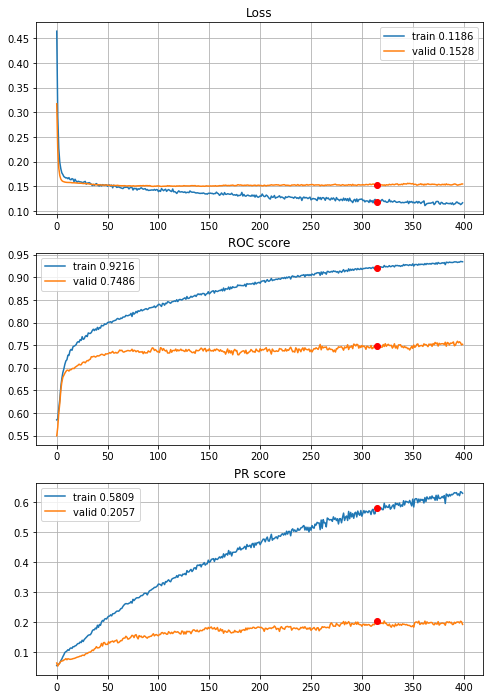


Fold 2------------------------------------------------------------


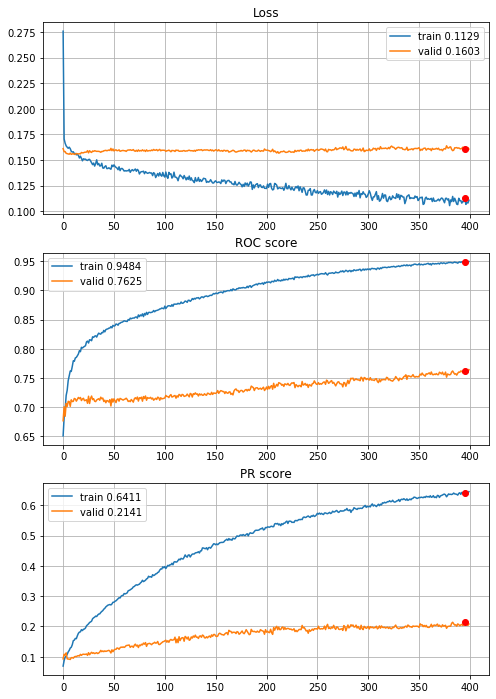


Fold 3------------------------------------------------------------


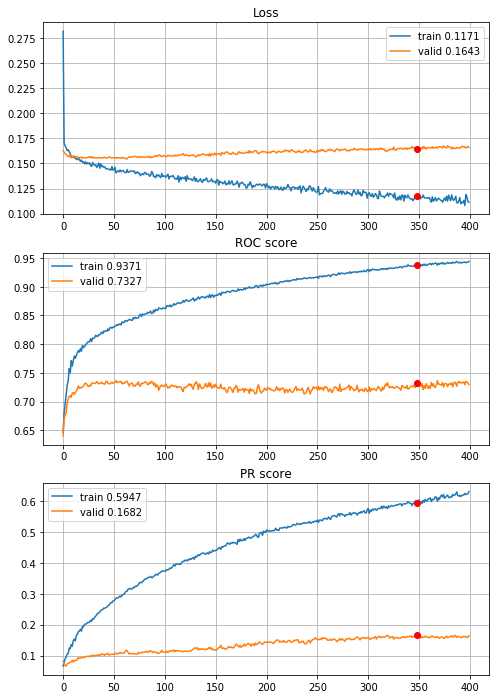


Fold 4------------------------------------------------------------


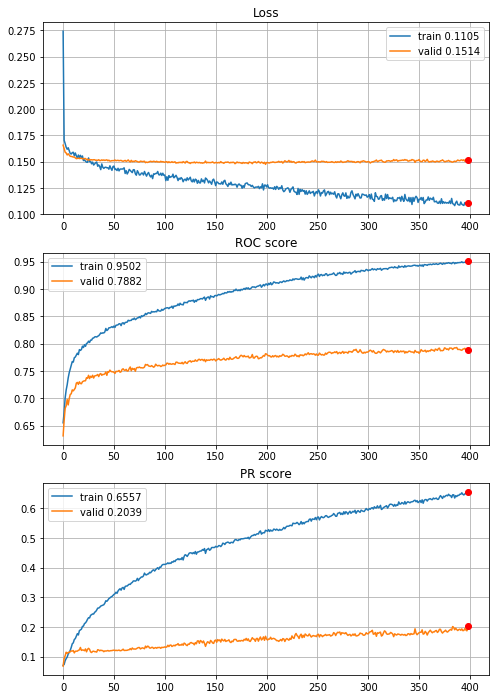


Fold 5------------------------------------------------------------


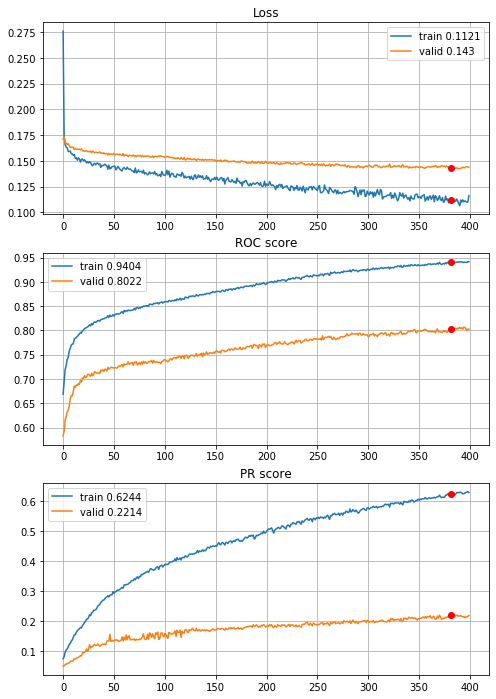


Fold 6------------------------------------------------------------


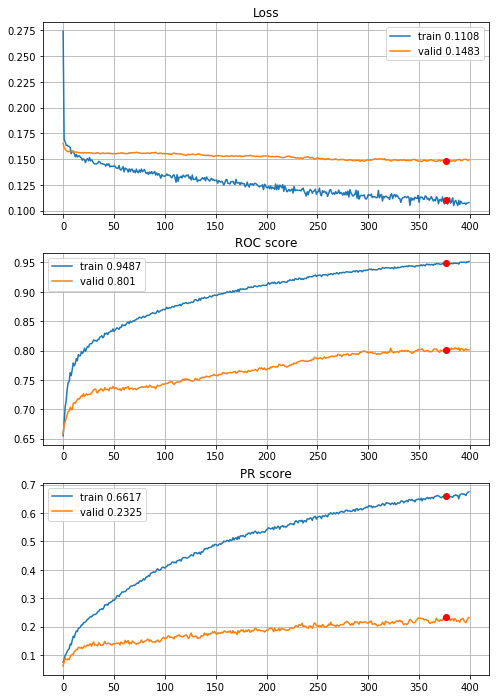

In [66]:
# normalization and quantile outliers reduction (Q_0.005 and Q_0.995)
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize=True, q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

\+0.1 on PR compared to normalization only and +0.13 compared to raw data. Lets try power transform


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 4.98s train loss: 0.4678976990039359, validation loss: 0.3291320132474912
Epoch: 2/400,
cumulative time: 5.13s train loss: 0.3044870345749382, validation loss: 0.23485755461462204
Epoch: 3/400,
cumulative time: 5.28s train loss: 0.23610873396344448, validation loss: 0.19277256733077539
Epoch: 4/400,
cumulative time: 5.43s train loss: 0.20168884055754166, validation loss: 0.17360737732322312
Epoch: 5/400,
cumulative time: 5.58s train loss: 0.18619454892610782, validation loss: 0.1642617718029772
Epoch: 6/400,
cumulative time: 5.74s train loss: 0.1761193386746478, validation loss: 0.15940941887789284
Epoch: 7/400,
cumulative time: 5.89s train loss: 0.17127048674722317, validation loss: 0.15711662709361449
Epoch: 8/400,
cumulative time: 6.03s train loss: 0.16579661534254134, validation loss: 0.15573390726571315
Epoch: 9/400,
cumulative time: 6.18s train loss: 0.16435351808818988, 

Epoch: 77/400,
cumulative time: 16.27s train loss: 0.1360865467244964, validation loss: 0.1427114116782286
Epoch: 78/400,
cumulative time: 16.43s train loss: 0.1354081643529716, validation loss: 0.142696112452922
Epoch: 79/400,
cumulative time: 16.58s train loss: 0.1363808374477411, validation loss: 0.14286199191568094
Epoch: 80/400,
cumulative time: 16.73s train loss: 0.13234063149522027, validation loss: 0.14276353252238716
Epoch: 81/400,
cumulative time: 16.88s train loss: 0.13476532876397793, validation loss: 0.14239902644958907
Epoch: 82/400,
cumulative time: 17.01s train loss: 0.1337684572655168, validation loss: 0.1422607885431962
Epoch: 83/400,
cumulative time: 17.16s train loss: 0.13564067521934695, validation loss: 0.14212002626682485
Epoch: 84/400,
cumulative time: 17.31s train loss: 0.13675685205236457, validation loss: 0.1415613096593092
Epoch: 85/400,
cumulative time: 17.46s train loss: 0.1357050330269101, validation loss: 0.14104174329443966
Epoch: 86/400,
cumulative tim

Epoch: 153/400,
cumulative time: 27.48s train loss: 0.11930846609053129, validation loss: 0.1354047439084297
Epoch: 154/400,
cumulative time: 27.64s train loss: 0.11826007923279541, validation loss: 0.13605600618909883
Epoch: 155/400,
cumulative time: 27.79s train loss: 0.11771817722167736, validation loss: 0.13555825270253427
Epoch: 156/400,
cumulative time: 27.93s train loss: 0.1172563245072951, validation loss: 0.13607605979295734
Epoch: 157/400,
cumulative time: 28.08s train loss: 0.11558911338622362, validation loss: 0.13716235093840765
Epoch: 158/400,
cumulative time: 28.22s train loss: 0.11774468977042866, validation loss: 0.1356662831233807
Epoch: 159/400,
cumulative time: 28.37s train loss: 0.12098606696274478, validation loss: 0.1351191925756428
Epoch: 160/400,
cumulative time: 28.52s train loss: 0.11713916994020908, validation loss: 0.13544774885493213
Epoch: 161/400,
cumulative time: 28.67s train loss: 0.11478723399267861, validation loss: 0.13513462415372715
Epoch: 162/400

Epoch: 229/400,
cumulative time: 38.65s train loss: 0.10867427939519546, validation loss: 0.1310253566226203
Epoch: 230/400,
cumulative time: 38.8s train loss: 0.10217561509407962, validation loss: 0.13085872375285484
Epoch: 231/400,
cumulative time: 38.94s train loss: 0.10265884137955229, validation loss: 0.13229661364581918
Epoch: 232/400,
cumulative time: 39.08s train loss: 0.10611266246401696, validation loss: 0.13231652600112154
Epoch: 233/400,
cumulative time: 39.24s train loss: 0.10720209177910132, validation loss: 0.1329792968801871
Epoch: 234/400,
cumulative time: 39.38s train loss: 0.10264369658271269, validation loss: 0.13308956576596706
Epoch: 235/400,
cumulative time: 39.52s train loss: 0.10722280034998295, validation loss: 0.131383486912338
Epoch: 236/400,
cumulative time: 39.68s train loss: 0.10527655657887193, validation loss: 0.13263248636596012
Epoch: 237/400,
cumulative time: 39.82s train loss: 0.10412227218832222, validation loss: 0.13243639012151745
Epoch: 238/400,

Epoch: 305/400,
cumulative time: 49.85s train loss: 0.09972480567325254, validation loss: 0.13072830796007404
Epoch: 306/400,
cumulative time: 49.99s train loss: 0.09525186368781252, validation loss: 0.13042707139745766
Epoch: 307/400,
cumulative time: 50.13s train loss: 0.10095908910500954, validation loss: 0.12889871377190318
Epoch: 308/400,
cumulative time: 50.29s train loss: 0.0965643139952311, validation loss: 0.1294815113394476
Epoch: 309/400,
cumulative time: 50.43s train loss: 0.09891922099239658, validation loss: 0.12992672610486006
Epoch: 310/400,
cumulative time: 50.57s train loss: 0.09722537708588737, validation loss: 0.12958084170854264
Epoch: 311/400,
cumulative time: 50.72s train loss: 0.0979211586130167, validation loss: 0.1297748412443801
Epoch: 312/400,
cumulative time: 50.87s train loss: 0.09396080784758448, validation loss: 0.12953704624860346
Epoch: 313/400,
cumulative time: 51.02s train loss: 0.09699739382962035, validation loss: 0.12975395097840348
Epoch: 314/400

Epoch: 381/400,
cumulative time: 61.04s train loss: 0.09182577227070285, validation loss: 0.12696899311570634
Epoch: 382/400,
cumulative time: 61.18s train loss: 0.08786854580062325, validation loss: 0.12936051432067727
Epoch: 383/400,
cumulative time: 61.32s train loss: 0.09065857963744678, validation loss: 0.1297753852051176
Epoch: 384/400,
cumulative time: 61.47s train loss: 0.0921895001305792, validation loss: 0.12776460197814013
Epoch: 385/400,
cumulative time: 61.61s train loss: 0.08882844733016443, validation loss: 0.12785935965348352
Epoch: 386/400,
cumulative time: 61.76s train loss: 0.08864480624729097, validation loss: 0.1286584394904608
Epoch: 387/400,
cumulative time: 61.91s train loss: 0.08795158971022428, validation loss: 0.12794051273465937
Epoch: 388/400,
cumulative time: 62.06s train loss: 0.09270150062668009, validation loss: 0.1281231398526994
Epoch: 389/400,
cumulative time: 62.19s train loss: 0.09062982392777527, validation loss: 0.12908394474580123
Epoch: 390/400

Epoch: 56/400,
cumulative time: 13.5s train loss: 0.12987999247526463, validation loss: 0.1396948496761047
Epoch: 57/400,
cumulative time: 13.64s train loss: 0.1290747490845184, validation loss: 0.13913022521712365
Epoch: 58/400,
cumulative time: 13.79s train loss: 0.1315417068101332, validation loss: 0.13876902992650378
Epoch: 59/400,
cumulative time: 13.94s train loss: 0.13055290692536042, validation loss: 0.1393133081681294
Epoch: 60/400,
cumulative time: 14.09s train loss: 0.13092007538307884, validation loss: 0.13899279459041505
Epoch: 61/400,
cumulative time: 14.24s train loss: 0.13046898168991083, validation loss: 0.13956214482670218
Epoch: 62/400,
cumulative time: 14.39s train loss: 0.13198067647497624, validation loss: 0.13843455606995841
Epoch: 63/400,
cumulative time: 14.55s train loss: 0.1319916654338623, validation loss: 0.1383548611836071
Epoch: 64/400,
cumulative time: 14.7s train loss: 0.12822585794251906, validation loss: 0.13877789662518633
Epoch: 65/400,
cumulative t

Epoch: 133/400,
cumulative time: 24.83s train loss: 0.11586265455599865, validation loss: 0.1320746975754379
Epoch: 134/400,
cumulative time: 24.98s train loss: 0.11952337493534278, validation loss: 0.13256132511878546
Epoch: 135/400,
cumulative time: 25.12s train loss: 0.11317236020844657, validation loss: 0.1321001055883549
Epoch: 136/400,
cumulative time: 25.26s train loss: 0.11639601537738782, validation loss: 0.13261612338718237
Epoch: 137/400,
cumulative time: 25.41s train loss: 0.11312879877562197, validation loss: 0.13261968216725759
Epoch: 138/400,
cumulative time: 25.55s train loss: 0.1165204662299825, validation loss: 0.1321517966912271
Epoch: 139/400,
cumulative time: 25.71s train loss: 0.11576030727513481, validation loss: 0.13132799817139323
Epoch: 140/400,
cumulative time: 25.85s train loss: 0.11617114855571536, validation loss: 0.13218080994537587
Epoch: 141/400,
cumulative time: 25.99s train loss: 0.11640622858912718, validation loss: 0.1310309029109825
Epoch: 142/400,

Epoch: 209/400,
cumulative time: 35.63s train loss: 0.1034517831419692, validation loss: 0.13024644003900288
Epoch: 210/400,
cumulative time: 35.78s train loss: 0.10614602888086737, validation loss: 0.12966333640199815
Epoch: 211/400,
cumulative time: 35.92s train loss: 0.1057043865524249, validation loss: 0.13030722047913904
Epoch: 212/400,
cumulative time: 36.05s train loss: 0.10167409923976989, validation loss: 0.12991858872329892
Epoch: 213/400,
cumulative time: 36.2s train loss: 0.10622610965286362, validation loss: 0.12990168240873404
Epoch: 214/400,
cumulative time: 36.33s train loss: 0.10609913418631767, validation loss: 0.13001123673208106
Epoch: 215/400,
cumulative time: 36.48s train loss: 0.1056090593362428, validation loss: 0.131411334663278
Epoch: 216/400,
cumulative time: 36.62s train loss: 0.1045932509703348, validation loss: 0.1305809802672341
Epoch: 217/400,
cumulative time: 36.76s train loss: 0.10482131122081773, validation loss: 0.13018244488328343
Epoch: 218/400,
cu

Epoch: 285/400,
cumulative time: 46.48s train loss: 0.09787404551361817, validation loss: 0.12924414201301485
Epoch: 286/400,
cumulative time: 46.63s train loss: 0.0989148958195145, validation loss: 0.13006937840702024
Epoch: 287/400,
cumulative time: 46.77s train loss: 0.09629521962132674, validation loss: 0.13081859770874207
Epoch: 288/400,
cumulative time: 46.89s train loss: 0.09643538239579133, validation loss: 0.13079442831823115
Epoch: 289/400,
cumulative time: 47.05s train loss: 0.09850186706595206, validation loss: 0.13037163225218634
Epoch: 290/400,
cumulative time: 47.2s train loss: 0.09690544748993028, validation loss: 0.1324862393686062
Epoch: 291/400,
cumulative time: 47.33s train loss: 0.09872613678887625, validation loss: 0.13057650560281223
Epoch: 292/400,
cumulative time: 47.47s train loss: 0.09790734819084433, validation loss: 0.13105328392779375
Epoch: 293/400,
cumulative time: 47.62s train loss: 0.09668239925058161, validation loss: 0.13014785738400675
Epoch: 294/40

Epoch: 361/400,
cumulative time: 57.22s train loss: 0.09275468379729837, validation loss: 0.1303930524370461
Epoch: 362/400,
cumulative time: 57.36s train loss: 0.09210454996029223, validation loss: 0.13071094955248103
Epoch: 363/400,
cumulative time: 57.5s train loss: 0.08899986360313414, validation loss: 0.13081541888874762
Epoch: 364/400,
cumulative time: 57.63s train loss: 0.09066832450953766, validation loss: 0.13182118934424178
Epoch: 365/400,
cumulative time: 57.78s train loss: 0.09477162596118108, validation loss: 0.13201679447531545
Epoch: 366/400,
cumulative time: 57.93s train loss: 0.09173451145669707, validation loss: 0.13180479106553103
Epoch: 367/400,
cumulative time: 58.06s train loss: 0.08822959771352727, validation loss: 0.13218555070196192
Epoch: 368/400,
cumulative time: 58.2s train loss: 0.08831708818119371, validation loss: 0.132222123531964
Epoch: 369/400,
cumulative time: 58.34s train loss: 0.08982401973556794, validation loss: 0.13240535194994113
Epoch: 370/400,

Epoch: 35/400,
cumulative time: 11.14s train loss: 0.1363617265590882, validation loss: 0.15196347857677764
Epoch: 36/400,
cumulative time: 11.29s train loss: 0.13952271592056067, validation loss: 0.15419317256576268
Epoch: 37/400,
cumulative time: 11.43s train loss: 0.13469191902640731, validation loss: 0.15367241688121505
Epoch: 38/400,
cumulative time: 11.57s train loss: 0.1384932034792883, validation loss: 0.1523555168200914
Epoch: 39/400,
cumulative time: 11.73s train loss: 0.1366671295610726, validation loss: 0.1535252689885593
Epoch: 40/400,
cumulative time: 11.87s train loss: 0.1362715514213421, validation loss: 0.15201449402037953
Epoch: 41/400,
cumulative time: 12.03s train loss: 0.13418897874980504, validation loss: 0.1538466209665351
Epoch: 42/400,
cumulative time: 12.17s train loss: 0.1315761327231785, validation loss: 0.15320509042332087
Epoch: 43/400,
cumulative time: 12.31s train loss: 0.13373924974830173, validation loss: 0.15152689450338658
Epoch: 44/400,
cumulative t

Epoch: 111/400,
cumulative time: 21.97s train loss: 0.11563033158605854, validation loss: 0.14784868939402532
Epoch: 112/400,
cumulative time: 22.11s train loss: 0.11607217436334318, validation loss: 0.14434295577310796
Epoch: 113/400,
cumulative time: 22.25s train loss: 0.11377119035239706, validation loss: 0.14677416519560946
Epoch: 114/400,
cumulative time: 22.39s train loss: 0.11827016956904, validation loss: 0.14499332340797935
Epoch: 115/400,
cumulative time: 22.54s train loss: 0.11349821465131667, validation loss: 0.1456331397805895
Epoch: 116/400,
cumulative time: 22.68s train loss: 0.11776426219466724, validation loss: 0.1475580909910708
Epoch: 117/400,
cumulative time: 22.81s train loss: 0.11513459444073365, validation loss: 0.14482223499336844
Epoch: 118/400,
cumulative time: 22.95s train loss: 0.11773648417617909, validation loss: 0.14542959731067304
Epoch: 119/400,
cumulative time: 23.09s train loss: 0.11687731913961484, validation loss: 0.14705979718605783
Epoch: 120/400,

Epoch: 187/400,
cumulative time: 32.82s train loss: 0.10599278039260497, validation loss: 0.14711024525281174
Epoch: 188/400,
cumulative time: 32.97s train loss: 0.10600274399085038, validation loss: 0.1473934641535129
Epoch: 189/400,
cumulative time: 33.11s train loss: 0.10715629946089365, validation loss: 0.14958678850926077
Epoch: 190/400,
cumulative time: 33.26s train loss: 0.10643054122931211, validation loss: 0.1467603055240286
Epoch: 191/400,
cumulative time: 33.39s train loss: 0.10843683383955542, validation loss: 0.14820702419876272
Epoch: 192/400,
cumulative time: 33.53s train loss: 0.10617974677487772, validation loss: 0.14803761089535558
Epoch: 193/400,
cumulative time: 33.66s train loss: 0.1061960070727615, validation loss: 0.14786062308563944
Epoch: 194/400,
cumulative time: 33.8s train loss: 0.1070141331707139, validation loss: 0.14723197427403723
Epoch: 195/400,
cumulative time: 33.95s train loss: 0.10692916544776145, validation loss: 0.14675880033098074
Epoch: 196/400,

Epoch: 263/400,
cumulative time: 43.7s train loss: 0.09692642607135672, validation loss: 0.15081813620942916
Epoch: 264/400,
cumulative time: 43.83s train loss: 0.09771594631748472, validation loss: 0.14686931821067242
Epoch: 265/400,
cumulative time: 43.98s train loss: 0.09682667784432875, validation loss: 0.1499034094076169
Epoch: 266/400,
cumulative time: 44.11s train loss: 0.09937106265686087, validation loss: 0.1501164030415515
Epoch: 267/400,
cumulative time: 44.26s train loss: 0.09609081268775414, validation loss: 0.15078592475205854
Epoch: 268/400,
cumulative time: 44.42s train loss: 0.09977455002004626, validation loss: 0.15018661472541164
Epoch: 269/400,
cumulative time: 44.57s train loss: 0.09774921437573317, validation loss: 0.1495030534943153
Epoch: 270/400,
cumulative time: 44.7s train loss: 0.09820678610360033, validation loss: 0.14903800678714074
Epoch: 271/400,
cumulative time: 44.85s train loss: 0.09910583249596629, validation loss: 0.14916371973048345
Epoch: 272/400,

Epoch: 339/400,
cumulative time: 54.53s train loss: 0.09454634775495385, validation loss: 0.1460409793480352
Epoch: 340/400,
cumulative time: 54.67s train loss: 0.09109498302212142, validation loss: 0.1489385982406561
Epoch: 341/400,
cumulative time: 54.81s train loss: 0.09208720959679048, validation loss: 0.14728883976119217
Epoch: 342/400,
cumulative time: 54.95s train loss: 0.0893715755350625, validation loss: 0.14805047786251432
Epoch: 343/400,
cumulative time: 55.09s train loss: 0.09272963915599847, validation loss: 0.14789249231430993
Epoch: 344/400,
cumulative time: 55.22s train loss: 0.09350560982205605, validation loss: 0.14885403923836793
Epoch: 345/400,
cumulative time: 55.36s train loss: 0.09143627508312585, validation loss: 0.1480627420552436
Epoch: 346/400,
cumulative time: 55.49s train loss: 0.0935916122616017, validation loss: 0.14729205475995613
Epoch: 347/400,
cumulative time: 55.65s train loss: 0.09359320036032703, validation loss: 0.14611083257401442
Epoch: 348/400,

Epoch: 13/400,
cumulative time: 7.64s train loss: 0.15140920205742242, validation loss: 0.1454030329246821
Epoch: 14/400,
cumulative time: 7.77s train loss: 0.1488042666322517, validation loss: 0.1438783608171918
Epoch: 15/400,
cumulative time: 7.91s train loss: 0.14598341966686343, validation loss: 0.1437104969513682
Epoch: 16/400,
cumulative time: 8.05s train loss: 0.14793874081754016, validation loss: 0.14393165891167378
Epoch: 17/400,
cumulative time: 8.18s train loss: 0.14573830105867278, validation loss: 0.14269670865560735
Epoch: 18/400,
cumulative time: 8.32s train loss: 0.1507180209195556, validation loss: 0.14373227979299438
Epoch: 19/400,
cumulative time: 8.45s train loss: 0.14447239946648682, validation loss: 0.14399887939736852
Epoch: 20/400,
cumulative time: 8.58s train loss: 0.14455543432483856, validation loss: 0.1430502271824083
Epoch: 21/400,
cumulative time: 8.72s train loss: 0.1418560309491115, validation loss: 0.14227236930383455
Epoch: 22/400,
cumulative time: 8.8

Epoch: 89/400,
cumulative time: 17.79s train loss: 0.11999930215781944, validation loss: 0.1309880662909654
Epoch: 90/400,
cumulative time: 17.93s train loss: 0.12433008771101134, validation loss: 0.1303765392162853
Epoch: 91/400,
cumulative time: 18.07s train loss: 0.12315919681424503, validation loss: 0.13068103698493613
Epoch: 92/400,
cumulative time: 18.2s train loss: 0.12174808319430001, validation loss: 0.1302864673409518
Epoch: 93/400,
cumulative time: 18.33s train loss: 0.1262138430895898, validation loss: 0.13021564177026287
Epoch: 94/400,
cumulative time: 18.46s train loss: 0.12673692036259454, validation loss: 0.1303114229971897
Epoch: 95/400,
cumulative time: 18.59s train loss: 0.1250930153158674, validation loss: 0.12997934035712738
Epoch: 96/400,
cumulative time: 18.73s train loss: 0.12690983785137872, validation loss: 0.12925764461332348
Epoch: 97/400,
cumulative time: 18.87s train loss: 0.12115078420911865, validation loss: 0.12979022033639534
Epoch: 98/400,
cumulative 

Epoch: 165/400,
cumulative time: 27.91s train loss: 0.11020669571177365, validation loss: 0.12419346067688256
Epoch: 166/400,
cumulative time: 28.05s train loss: 0.10998218154212659, validation loss: 0.12443562630236851
Epoch: 167/400,
cumulative time: 28.18s train loss: 0.11208053601707696, validation loss: 0.12458432015632115
Epoch: 168/400,
cumulative time: 28.31s train loss: 0.11278204552107549, validation loss: 0.12393197602791367
Epoch: 169/400,
cumulative time: 28.46s train loss: 0.11024170753011729, validation loss: 0.12362138146771359
Epoch: 170/400,
cumulative time: 28.6s train loss: 0.11017540554096196, validation loss: 0.1225577130288784
Epoch: 171/400,
cumulative time: 28.75s train loss: 0.1122721068737844, validation loss: 0.12304395725303677
Epoch: 172/400,
cumulative time: 28.89s train loss: 0.10756676240257361, validation loss: 0.12383815047586261
Epoch: 173/400,
cumulative time: 29.03s train loss: 0.10999263362266365, validation loss: 0.12339437147541409
Epoch: 174/40

Epoch: 241/400,
cumulative time: 38.69s train loss: 0.10383589058501143, validation loss: 0.11841580378157752
Epoch: 242/400,
cumulative time: 38.83s train loss: 0.10008592072907024, validation loss: 0.11920873109900623
Epoch: 243/400,
cumulative time: 38.98s train loss: 0.10227332124822276, validation loss: 0.1192729918293528
Epoch: 244/400,
cumulative time: 39.13s train loss: 0.10175225809792701, validation loss: 0.11930234244930635
Epoch: 245/400,
cumulative time: 39.29s train loss: 0.09827094486717909, validation loss: 0.11920812469205257
Epoch: 246/400,
cumulative time: 39.42s train loss: 0.09820299753415067, validation loss: 0.1195802817397005
Epoch: 247/400,
cumulative time: 39.57s train loss: 0.10366629295247397, validation loss: 0.11978574507280228
Epoch: 248/400,
cumulative time: 39.72s train loss: 0.1025911591754686, validation loss: 0.11758010641111459
Epoch: 249/400,
cumulative time: 39.87s train loss: 0.09963864210916387, validation loss: 0.11855945230350581
Epoch: 250/40

Epoch: 316/400,
cumulative time: 49.95s train loss: 0.09837471645509514, validation loss: 0.113699024862965
Epoch: 317/400,
cumulative time: 50.1s train loss: 0.09402826015599075, validation loss: 0.1138983584774431
Epoch: 318/400,
cumulative time: 50.24s train loss: 0.09750346699967612, validation loss: 0.1130058926921997
Epoch: 319/400,
cumulative time: 50.38s train loss: 0.09475051595938441, validation loss: 0.11343263334754566
Epoch: 320/400,
cumulative time: 50.53s train loss: 0.09577051079324789, validation loss: 0.11322144781230786
Epoch: 321/400,
cumulative time: 50.68s train loss: 0.09723479801837513, validation loss: 0.11390589817206169
Epoch: 322/400,
cumulative time: 50.84s train loss: 0.09291808787078497, validation loss: 0.11330332591407108
Epoch: 323/400,
cumulative time: 50.99s train loss: 0.09491707834609606, validation loss: 0.11269370928348127
Epoch: 324/400,
cumulative time: 51.14s train loss: 0.09688371464830814, validation loss: 0.11408364013091296
Epoch: 325/400,

Epoch: 392/400,
cumulative time: 61.26s train loss: 0.0881851064474629, validation loss: 0.11122474676854957
Epoch: 393/400,
cumulative time: 61.4s train loss: 0.09068656278861305, validation loss: 0.1103923226637109
Epoch: 394/400,
cumulative time: 61.53s train loss: 0.09061160503153814, validation loss: 0.10903908362121445
Epoch: 395/400,
cumulative time: 61.67s train loss: 0.08754098718710754, validation loss: 0.10841772251251015
Epoch: 396/400,
cumulative time: 61.81s train loss: 0.08737898589758748, validation loss: 0.10759824517318493
Epoch: 397/400,
cumulative time: 61.96s train loss: 0.08875907259763874, validation loss: 0.10959372742694765
Epoch: 398/400,
cumulative time: 62.12s train loss: 0.08894166166810272, validation loss: 0.10936350194764169
Epoch: 399/400,
cumulative time: 62.27s train loss: 0.08645886393831104, validation loss: 0.10849366465956949
Epoch: 400/400,
cumulative time: 62.42s train loss: 0.08546549088052692, validation loss: 0.10838440024485595

Early stoppi

Epoch: 66/400,
cumulative time: 15.82s train loss: 0.13369440156290144, validation loss: 0.13702029923311537
Epoch: 67/400,
cumulative time: 15.98s train loss: 0.1325901288435162, validation loss: 0.13546202317134112
Epoch: 68/400,
cumulative time: 16.12s train loss: 0.13232213230226186, validation loss: 0.1366823087904119
Epoch: 69/400,
cumulative time: 16.27s train loss: 0.13120620286485005, validation loss: 0.13550176663839333
Epoch: 70/400,
cumulative time: 16.42s train loss: 0.13138810677927776, validation loss: 0.1370481710641756
Epoch: 71/400,
cumulative time: 16.59s train loss: 0.12857421414128511, validation loss: 0.134289488586967
Epoch: 72/400,
cumulative time: 16.74s train loss: 0.13474213742994204, validation loss: 0.135940454167901
Epoch: 73/400,
cumulative time: 16.91s train loss: 0.12978832613247565, validation loss: 0.13448273645394127
Epoch: 74/400,
cumulative time: 17.06s train loss: 0.1305441149824302, validation loss: 0.13514959308298044
Epoch: 75/400,
cumulative t

Epoch: 143/400,
cumulative time: 27.22s train loss: 0.11875256990262137, validation loss: 0.12633061430479253
Epoch: 144/400,
cumulative time: 27.37s train loss: 0.11643591808634451, validation loss: 0.127272876304224
Epoch: 145/400,
cumulative time: 27.51s train loss: 0.11631340846499416, validation loss: 0.12600183652940927
Epoch: 146/400,
cumulative time: 27.64s train loss: 0.11798572607181194, validation loss: 0.12611374360549496
Epoch: 147/400,
cumulative time: 27.78s train loss: 0.1163021833474115, validation loss: 0.125633232500575
Epoch: 148/400,
cumulative time: 27.92s train loss: 0.11818332964673332, validation loss: 0.12528182609131264
Epoch: 149/400,
cumulative time: 28.07s train loss: 0.11978044650441838, validation loss: 0.12477852761511096
Epoch: 150/400,
cumulative time: 28.21s train loss: 0.12012553276846459, validation loss: 0.12605641686588254
Epoch: 151/400,
cumulative time: 28.36s train loss: 0.11761770865808294, validation loss: 0.12551269407822296
Epoch: 152/400,

Epoch: 218/400,
cumulative time: 40.45s train loss: 0.10790376631800133, validation loss: 0.12247114623670965
Epoch: 219/400,
cumulative time: 40.6s train loss: 0.1054644343051471, validation loss: 0.12163037520639237
Epoch: 220/400,
cumulative time: 40.74s train loss: 0.10761775988448195, validation loss: 0.12348781555383265
Epoch: 221/400,
cumulative time: 40.89s train loss: 0.11058318099503374, validation loss: 0.12160364586278932
Epoch: 222/400,
cumulative time: 41.04s train loss: 0.10542779083504467, validation loss: 0.12272286284251106
Epoch: 223/400,
cumulative time: 41.2s train loss: 0.10405492831081609, validation loss: 0.12263789878447746
Epoch: 224/400,
cumulative time: 41.35s train loss: 0.10593395824727857, validation loss: 0.12291187348715756
Epoch: 225/400,
cumulative time: 41.5s train loss: 0.1081273777310041, validation loss: 0.12249360191556448
Epoch: 226/400,
cumulative time: 41.65s train loss: 0.10631414569659445, validation loss: 0.12226631846840384
Epoch: 227/400,

Epoch: 294/400,
cumulative time: 52.82s train loss: 0.09536885518396583, validation loss: 0.11994908181742947
Epoch: 295/400,
cumulative time: 52.96s train loss: 0.09722366906396838, validation loss: 0.11912925391022218
Epoch: 296/400,
cumulative time: 53.13s train loss: 0.1015145162471798, validation loss: 0.11869156703372458
Epoch: 297/400,
cumulative time: 53.32s train loss: 0.0986769468350091, validation loss: 0.11978351632389453
Epoch: 298/400,
cumulative time: 53.61s train loss: 0.09899253879943203, validation loss: 0.11949386151793119
Epoch: 299/400,
cumulative time: 53.77s train loss: 0.09727012377482815, validation loss: 0.1191885936932045
Epoch: 300/400,
cumulative time: 53.91s train loss: 0.09933801248292652, validation loss: 0.11818215756788167
Epoch: 301/400,
cumulative time: 54.07s train loss: 0.09579632232137301, validation loss: 0.12020737079227267
Epoch: 302/400,
cumulative time: 54.22s train loss: 0.09843406260798777, validation loss: 0.11972843087125731
Epoch: 303/40

Epoch: 369/400,
cumulative time: 64.46s train loss: 0.09045023697105269, validation loss: 0.11433632914977805
Epoch: 370/400,
cumulative time: 64.61s train loss: 0.09007138811732544, validation loss: 0.11579354910050588
Epoch: 371/400,
cumulative time: 64.76s train loss: 0.09450125863814919, validation loss: 0.11573301656061825
Epoch: 372/400,
cumulative time: 64.91s train loss: 0.09058953927621599, validation loss: 0.11840220460690178
Epoch: 373/400,
cumulative time: 65.06s train loss: 0.08979976032139715, validation loss: 0.11655229088871069
Epoch: 374/400,
cumulative time: 65.21s train loss: 0.09096777911505141, validation loss: 0.11687526770844216
Epoch: 375/400,
cumulative time: 65.36s train loss: 0.08855761690261808, validation loss: 0.11554634752701651
Epoch: 376/400,
cumulative time: 65.51s train loss: 0.08609411784609237, validation loss: 0.11533754526943867
Epoch: 377/400,
cumulative time: 65.67s train loss: 0.09482566858884126, validation loss: 0.11534319999646078
Epoch: 378

Epoch: 42/400,
cumulative time: 12.78s train loss: 0.13493435764648656, validation loss: 0.14536766033680712
Epoch: 43/400,
cumulative time: 12.93s train loss: 0.13249867137418975, validation loss: 0.14474899652551432
Epoch: 44/400,
cumulative time: 13.09s train loss: 0.13343907420475862, validation loss: 0.14527104956204773
Epoch: 45/400,
cumulative time: 13.23s train loss: 0.13302405041253113, validation loss: 0.14401042293329708
Epoch: 46/400,
cumulative time: 13.37s train loss: 0.13236500833715711, validation loss: 0.14462485070111322
Epoch: 47/400,
cumulative time: 13.51s train loss: 0.13238982679139272, validation loss: 0.1437548366726422
Epoch: 48/400,
cumulative time: 13.65s train loss: 0.1309542233165876, validation loss: 0.14371767964519438
Epoch: 49/400,
cumulative time: 13.81s train loss: 0.13273590346541975, validation loss: 0.14391254413323323
Epoch: 50/400,
cumulative time: 13.96s train loss: 0.130565680815383, validation loss: 0.14284236012912188
Epoch: 51/400,
cumulati

Epoch: 118/400,
cumulative time: 24.09s train loss: 0.1158187853477573, validation loss: 0.1381839655168721
Epoch: 119/400,
cumulative time: 24.25s train loss: 0.11528011103445081, validation loss: 0.13753585029820928
Epoch: 120/400,
cumulative time: 24.39s train loss: 0.11622004723798869, validation loss: 0.1378849533933108
Epoch: 121/400,
cumulative time: 24.54s train loss: 0.115679552739054, validation loss: 0.13879227114505455
Epoch: 122/400,
cumulative time: 24.69s train loss: 0.11864645458650463, validation loss: 0.13670817732810975
Epoch: 123/400,
cumulative time: 24.84s train loss: 0.1157249080166123, validation loss: 0.13897686244034377
Epoch: 124/400,
cumulative time: 24.99s train loss: 0.11384031056654718, validation loss: 0.13875040546792453
Epoch: 125/400,
cumulative time: 25.15s train loss: 0.11919166639857336, validation loss: 0.13735104357609984
Epoch: 126/400,
cumulative time: 25.3s train loss: 0.11609718402454612, validation loss: 0.13655040390178805
Epoch: 127/400,
c

Epoch: 194/400,
cumulative time: 35.42s train loss: 0.1075109004144353, validation loss: 0.13313865282496468
Epoch: 195/400,
cumulative time: 35.55s train loss: 0.10509613136300722, validation loss: 0.1325821775393408
Epoch: 196/400,
cumulative time: 35.69s train loss: 0.10829130001805556, validation loss: 0.13182213195034714
Epoch: 197/400,
cumulative time: 35.84s train loss: 0.10501772245174935, validation loss: 0.13365530774241588
Epoch: 198/400,
cumulative time: 35.98s train loss: 0.10605271757625502, validation loss: 0.13289138741180545
Epoch: 199/400,
cumulative time: 36.11s train loss: 0.10643210692690053, validation loss: 0.13227023080724185
Epoch: 200/400,
cumulative time: 36.25s train loss: 0.10568197284426008, validation loss: 0.13263611238510883
Epoch: 201/400,
cumulative time: 36.4s train loss: 0.10528482194613972, validation loss: 0.1321663815271659
Epoch: 202/400,
cumulative time: 36.55s train loss: 0.1054173188198597, validation loss: 0.13210781692481433
Epoch: 203/400,

Epoch: 270/400,
cumulative time: 46.61s train loss: 0.09966168243677244, validation loss: 0.1279134758476351
Epoch: 271/400,
cumulative time: 46.76s train loss: 0.0973464675062137, validation loss: 0.12816564558959398
Epoch: 272/400,
cumulative time: 46.91s train loss: 0.09888583582241288, validation loss: 0.12775000163766204
Epoch: 273/400,
cumulative time: 47.06s train loss: 0.09664255240016652, validation loss: 0.12738422292177795
Epoch: 274/400,
cumulative time: 47.2s train loss: 0.10286457690838749, validation loss: 0.12807344587122807
Epoch: 275/400,
cumulative time: 47.35s train loss: 0.0977110589570018, validation loss: 0.12641757253740654
Epoch: 276/400,
cumulative time: 47.5s train loss: 0.09795116237114485, validation loss: 0.12720628108157486
Epoch: 277/400,
cumulative time: 47.65s train loss: 0.10024692006067398, validation loss: 0.12792181939375205
Epoch: 278/400,
cumulative time: 47.8s train loss: 0.09532860899112171, validation loss: 0.126853948128028
Epoch: 279/400,
cu

Epoch: 345/400,
cumulative time: 57.72s train loss: 0.09408962421441454, validation loss: 0.12422126260937237
Epoch: 346/400,
cumulative time: 57.86s train loss: 0.09157232379889894, validation loss: 0.12444786714725807
Epoch: 347/400,
cumulative time: 58.02s train loss: 0.09235754127603214, validation loss: 0.12395708465185322
Epoch: 348/400,
cumulative time: 58.17s train loss: 0.0930882423315417, validation loss: 0.12358610769764322
Epoch: 349/400,
cumulative time: 58.32s train loss: 0.09141823009808754, validation loss: 0.12473728537559509
Epoch: 350/400,
cumulative time: 58.46s train loss: 0.09523446775611544, validation loss: 0.12493754612617805
Epoch: 351/400,
cumulative time: 58.61s train loss: 0.09160501712818446, validation loss: 0.12372959334342207
Epoch: 352/400,
cumulative time: 58.75s train loss: 0.09496483336133225, validation loss: 0.12383710499669685
Epoch: 353/400,
cumulative time: 58.88s train loss: 0.09022416015537663, validation loss: 0.12313259188269006
Epoch: 354/

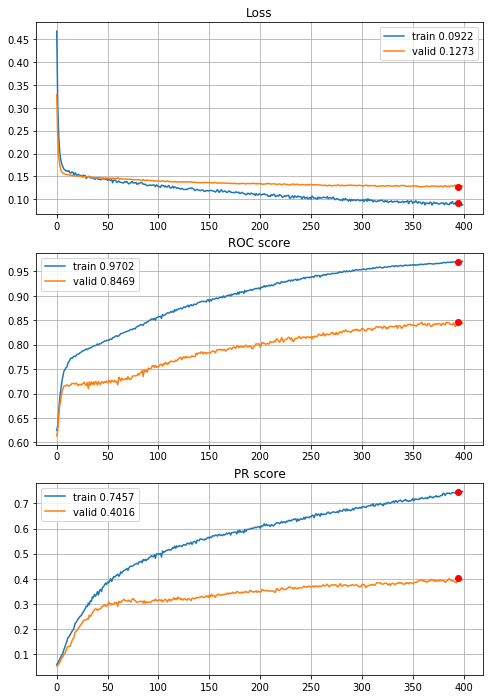


Fold 2------------------------------------------------------------


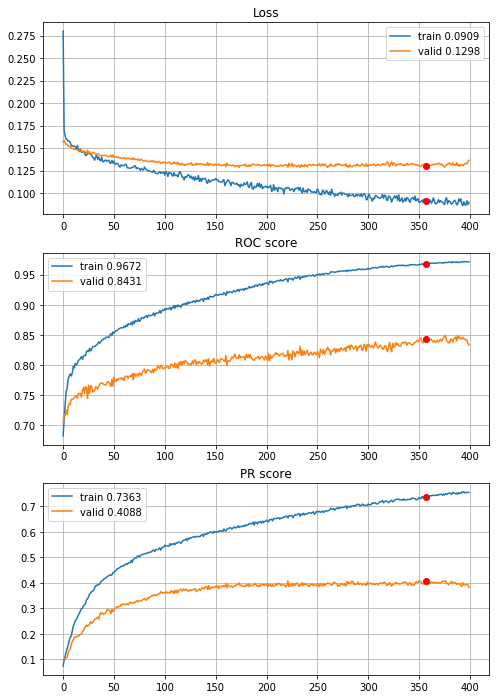


Fold 3------------------------------------------------------------


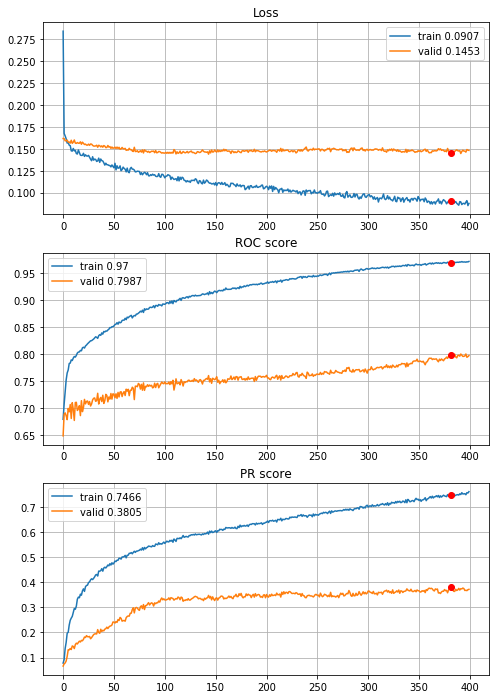


Fold 4------------------------------------------------------------


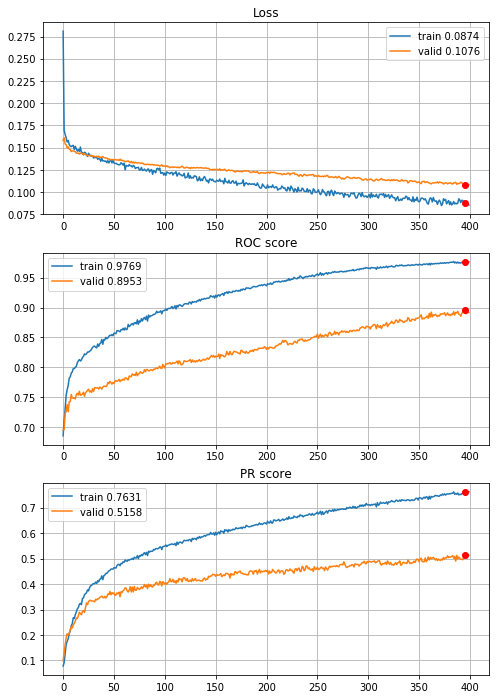


Fold 5------------------------------------------------------------


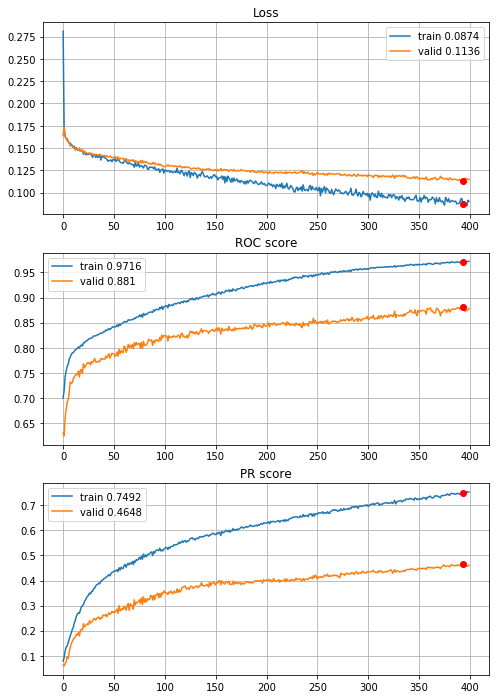


Fold 6------------------------------------------------------------


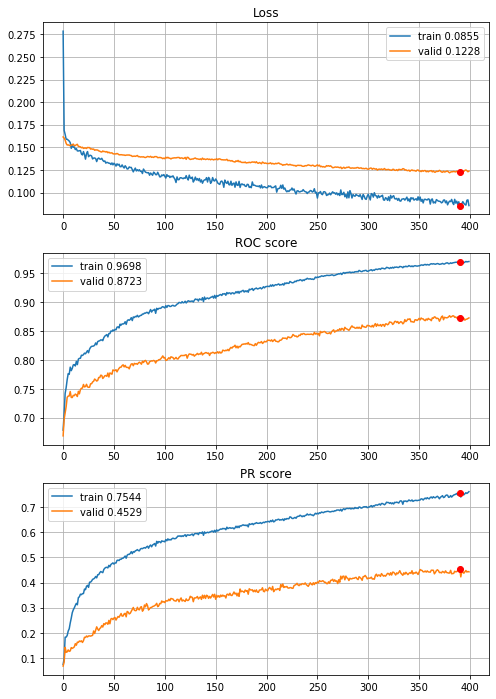

In [67]:
# normalization, quantile outliers reduction (Q_0.005 and Q_0.995) and power transform
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=400,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])

\+ 0.23 compared to the best preprocessing pipeline so far and + 0.36 to the raw data! Further experiments will be performed with this pipeline of course. I know that this type of architecutre was the best found for 3 year horizon, but then model was trained for 5000 epochs, lets try this out. Dependent on the output best model for 1 and 2 horizons will be tried (just regularization added).


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/5000,
cumulative time: 7.18s train loss: 0.4678976990039359, validation loss: 0.3291320132474912
Epoch: 2/5000,
cumulative time: 7.34s train loss: 0.3044870345749382, validation loss: 0.23485755461462204
Epoch: 3/5000,
cumulative time: 7.5s train loss: 0.23610873396344448, validation loss: 0.19277256733077539
Epoch: 4/5000,
cumulative time: 7.65s train loss: 0.20168884055754166, validation loss: 0.17360737732322312
Epoch: 5/5000,
cumulative time: 7.8s train loss: 0.1861946019952584, validation loss: 0.16426456713778007
Epoch: 6/5000,
cumulative time: 7.95s train loss: 0.17612973071985374, validation loss: 0.15941536126763292
Epoch: 7/5000,
cumulative time: 8.1s train loss: 0.17127770447398188, validation loss: 0.15711989651188782
Epoch: 8/5000,
cumulative time: 8.25s train loss: 0.16580099978508994, validation loss: 0.15573594465285423
Epoch: 9/5000,
cumulative time: 8.4s train loss: 0.1643567682367

Epoch: 77/5000,
cumulative time: 18.29s train loss: 0.13608726872081664, validation loss: 0.1427118658706995
Epoch: 78/5000,
cumulative time: 18.43s train loss: 0.13540848752691012, validation loss: 0.14269659222930006
Epoch: 79/5000,
cumulative time: 18.58s train loss: 0.1363812324837942, validation loss: 0.14286253359144355
Epoch: 80/5000,
cumulative time: 18.74s train loss: 0.13234069101196985, validation loss: 0.14276409199947143
Epoch: 81/5000,
cumulative time: 18.89s train loss: 0.13476615120494548, validation loss: 0.14239946958824973
Epoch: 82/5000,
cumulative time: 19.04s train loss: 0.1337687315648576, validation loss: 0.14226125086002236
Epoch: 83/5000,
cumulative time: 19.2s train loss: 0.13564129194752825, validation loss: 0.14212060558608444
Epoch: 84/5000,
cumulative time: 19.34s train loss: 0.13675751336976574, validation loss: 0.14156188171352033
Epoch: 85/5000,
cumulative time: 19.48s train loss: 0.1357054434387583, validation loss: 0.1410423076832435
Epoch: 86/5000,


Epoch: 153/5000,
cumulative time: 29.53s train loss: 0.11930824286902712, validation loss: 0.13540432946866338
Epoch: 154/5000,
cumulative time: 29.69s train loss: 0.11826012116855775, validation loss: 0.13605545389894422
Epoch: 155/5000,
cumulative time: 29.84s train loss: 0.1177181743855932, validation loss: 0.1355577664520606
Epoch: 156/5000,
cumulative time: 29.99s train loss: 0.1172563832271285, validation loss: 0.13607546274073
Epoch: 157/5000,
cumulative time: 30.14s train loss: 0.11558886062803579, validation loss: 0.13716196201419456
Epoch: 158/5000,
cumulative time: 30.29s train loss: 0.11774577749757564, validation loss: 0.13566578722523517
Epoch: 159/5000,
cumulative time: 30.44s train loss: 0.12098597067260917, validation loss: 0.13511879028335
Epoch: 160/5000,
cumulative time: 30.58s train loss: 0.11713891533329283, validation loss: 0.13544707914245552
Epoch: 161/5000,
cumulative time: 30.73s train loss: 0.11478762411050862, validation loss: 0.13513436390094333
Epoch: 162

Epoch: 228/5000,
cumulative time: 41.14s train loss: 0.10772921140079246, validation loss: 0.1319998880142778
Epoch: 229/5000,
cumulative time: 41.27s train loss: 0.10867214866489394, validation loss: 0.13102569932003322
Epoch: 230/5000,
cumulative time: 41.41s train loss: 0.10217508235363992, validation loss: 0.13085894149924637
Epoch: 231/5000,
cumulative time: 41.56s train loss: 0.10265887768221083, validation loss: 0.1322963130056155
Epoch: 232/5000,
cumulative time: 41.69s train loss: 0.10611208738349714, validation loss: 0.1323152738836927
Epoch: 233/5000,
cumulative time: 41.83s train loss: 0.10720145187979992, validation loss: 0.13297890572958818
Epoch: 234/5000,
cumulative time: 41.98s train loss: 0.1026433468009529, validation loss: 0.13308885227766762
Epoch: 235/5000,
cumulative time: 42.11s train loss: 0.10722236395436918, validation loss: 0.13138306895722568
Epoch: 236/5000,
cumulative time: 42.26s train loss: 0.10527610763964076, validation loss: 0.132631691643873
Epoch: 

Epoch: 304/5000,
cumulative time: 52.13s train loss: 0.09814189427965261, validation loss: 0.13044374749591747
Epoch: 305/5000,
cumulative time: 52.27s train loss: 0.09972496586122367, validation loss: 0.1307249752460426
Epoch: 306/5000,
cumulative time: 52.42s train loss: 0.09524957111027438, validation loss: 0.13042378745885227
Epoch: 307/5000,
cumulative time: 52.57s train loss: 0.10096083423724601, validation loss: 0.12889529156302093
Epoch: 308/5000,
cumulative time: 52.72s train loss: 0.09656228014493945, validation loss: 0.1294781014440413
Epoch: 309/5000,
cumulative time: 52.86s train loss: 0.09891934008546918, validation loss: 0.1299223604064
Epoch: 310/5000,
cumulative time: 53.0s train loss: 0.09722650103268078, validation loss: 0.12957759609697375
Epoch: 311/5000,
cumulative time: 53.14s train loss: 0.09791907064078566, validation loss: 0.12977358222320226
Epoch: 312/5000,
cumulative time: 53.29s train loss: 0.09395998648186782, validation loss: 0.12953539478786652
Epoch: 3

Epoch: 380/5000,
cumulative time: 63.11s train loss: 0.09123660129177444, validation loss: 0.1280860890918759
Epoch: 381/5000,
cumulative time: 63.25s train loss: 0.09182847229118568, validation loss: 0.1269674214923835
Epoch: 382/5000,
cumulative time: 63.39s train loss: 0.0878671950134862, validation loss: 0.12936027657587282
Epoch: 383/5000,
cumulative time: 63.54s train loss: 0.09065873294957406, validation loss: 0.12977263968081493
Epoch: 384/5000,
cumulative time: 63.69s train loss: 0.09218961625181843, validation loss: 0.12776056176166234
Epoch: 385/5000,
cumulative time: 63.83s train loss: 0.08883065942600164, validation loss: 0.12785460238453603
Epoch: 386/5000,
cumulative time: 63.98s train loss: 0.08864206489263941, validation loss: 0.12865565763115103
Epoch: 387/5000,
cumulative time: 64.13s train loss: 0.08795148901849388, validation loss: 0.12793855080051472
Epoch: 388/5000,
cumulative time: 64.27s train loss: 0.09269882723941046, validation loss: 0.128118740377623
Epoch:

Epoch: 456/5000,
cumulative time: 74.32s train loss: 0.09244855331775323, validation loss: 0.12790410578016528
Epoch: 457/5000,
cumulative time: 74.46s train loss: 0.0858222765552371, validation loss: 0.12817437222244543
Epoch: 458/5000,
cumulative time: 74.61s train loss: 0.08407192413378611, validation loss: 0.12741883944715146
Epoch: 459/5000,
cumulative time: 74.75s train loss: 0.08980978091038262, validation loss: 0.12698327906205176
Epoch: 460/5000,
cumulative time: 74.92s train loss: 0.08565626219198204, validation loss: 0.12771036425119614
Epoch: 461/5000,
cumulative time: 75.07s train loss: 0.08591451853814515, validation loss: 0.12701577309465345
Epoch: 462/5000,
cumulative time: 75.22s train loss: 0.08725900176230382, validation loss: 0.12941694805498674
Epoch: 463/5000,
cumulative time: 75.36s train loss: 0.08667510045334152, validation loss: 0.1279740510496212
Epoch: 464/5000,
cumulative time: 75.51s train loss: 0.08247001390810922, validation loss: 0.12911699496473272
Epo

Epoch: 532/5000,
cumulative time: 85.46s train loss: 0.08413419011345008, validation loss: 0.1321420317239874
Epoch: 533/5000,
cumulative time: 85.61s train loss: 0.0809925015762337, validation loss: 0.13256373220314985
Epoch: 534/5000,
cumulative time: 85.76s train loss: 0.08048995685377773, validation loss: 0.13277406922174156
Epoch: 535/5000,
cumulative time: 85.92s train loss: 0.08065753854026972, validation loss: 0.13126799512073534
Epoch: 536/5000,
cumulative time: 86.06s train loss: 0.08798899762122468, validation loss: 0.13289109652625156
Epoch: 537/5000,
cumulative time: 86.2s train loss: 0.085861039260906, validation loss: 0.13300658490992154
Epoch: 538/5000,
cumulative time: 86.35s train loss: 0.08144627039211264, validation loss: 0.1316755064427462
Epoch: 539/5000,
cumulative time: 86.5s train loss: 0.08304715754535318, validation loss: 0.13101002446047444
Epoch: 540/5000,
cumulative time: 86.64s train loss: 0.08171214693897219, validation loss: 0.13167294675330504
Epoch: 5

Epoch: 608/5000,
cumulative time: 96.85s train loss: 0.07420077713113388, validation loss: 0.13313795995274816
Epoch: 609/5000,
cumulative time: 97.01s train loss: 0.07965732165152661, validation loss: 0.1322016009125922
Epoch: 610/5000,
cumulative time: 97.15s train loss: 0.0809130700961144, validation loss: 0.13155947457681633
Epoch: 611/5000,
cumulative time: 97.31s train loss: 0.07624101005167429, validation loss: 0.1333029772768952
Epoch: 612/5000,
cumulative time: 97.45s train loss: 0.07865680418327511, validation loss: 0.13158893801008265
Epoch: 613/5000,
cumulative time: 97.61s train loss: 0.07829857865285711, validation loss: 0.13244008261168455
Epoch: 614/5000,
cumulative time: 97.76s train loss: 0.07524939822876597, validation loss: 0.1322842534060247
Epoch: 615/5000,
cumulative time: 97.92s train loss: 0.07903779163196838, validation loss: 0.1332927681652153
Epoch: 616/5000,
cumulative time: 98.07s train loss: 0.08095652510058382, validation loss: 0.133281830322305
Epoch: 6

Epoch: 682/5000,
cumulative time: 107.97s train loss: 0.07665853619845045, validation loss: 0.13518299041303708
Epoch: 683/5000,
cumulative time: 108.1s train loss: 0.0744340618798134, validation loss: 0.1344276527101528
Epoch: 684/5000,
cumulative time: 108.25s train loss: 0.07599914411168561, validation loss: 0.1349201997251373
Epoch: 685/5000,
cumulative time: 108.38s train loss: 0.07543597743012814, validation loss: 0.13450131021430264
Epoch: 686/5000,
cumulative time: 108.55s train loss: 0.0756045314378969, validation loss: 0.13347369015490243
Epoch: 687/5000,
cumulative time: 108.71s train loss: 0.0749161479749769, validation loss: 0.1328447961283855
Epoch: 688/5000,
cumulative time: 108.87s train loss: 0.07688557469590117, validation loss: 0.1337489252751339
Epoch: 689/5000,
cumulative time: 109.02s train loss: 0.07544583092844179, validation loss: 0.1328382545967402
Epoch: 690/5000,
cumulative time: 109.18s train loss: 0.07319685513331171, validation loss: 0.13332404005847784
E

Epoch: 756/5000,
cumulative time: 119.1s train loss: 0.07481192036006082, validation loss: 0.13961535226431618
Epoch: 757/5000,
cumulative time: 119.24s train loss: 0.073850148027722, validation loss: 0.1385621019049522
Epoch: 758/5000,
cumulative time: 119.4s train loss: 0.06840251716846782, validation loss: 0.13848298935519915
Epoch: 759/5000,
cumulative time: 119.54s train loss: 0.06861648151766021, validation loss: 0.13809789581466003
Epoch: 760/5000,
cumulative time: 119.69s train loss: 0.07322979676745356, validation loss: 0.13822426319825384
Epoch: 761/5000,
cumulative time: 119.84s train loss: 0.07539984282471902, validation loss: 0.13872622472000934
Epoch: 762/5000,
cumulative time: 120.0s train loss: 0.07091210537300399, validation loss: 0.13850673445321005
Epoch: 763/5000,
cumulative time: 120.12s train loss: 0.07131503182925408, validation loss: 0.1376436362592296
Epoch: 764/5000,
cumulative time: 120.28s train loss: 0.0739348803588632, validation loss: 0.13802359487524507


Epoch: 830/5000,
cumulative time: 130.1s train loss: 0.06938990935520156, validation loss: 0.1379735449702524
Epoch: 831/5000,
cumulative time: 130.25s train loss: 0.07081851242765684, validation loss: 0.1382820307134332
Epoch: 832/5000,
cumulative time: 130.4s train loss: 0.07341771208063336, validation loss: 0.13812480321053908
Epoch: 833/5000,
cumulative time: 130.56s train loss: 0.07170219521255164, validation loss: 0.13789539270561926
Epoch: 834/5000,
cumulative time: 130.69s train loss: 0.07328182714359525, validation loss: 0.13798428280950373
Epoch: 835/5000,
cumulative time: 130.85s train loss: 0.06743202718903296, validation loss: 0.13701074789150045
Epoch: 836/5000,
cumulative time: 130.99s train loss: 0.07013395061353382, validation loss: 0.1375970445758862
Epoch: 837/5000,
cumulative time: 131.13s train loss: 0.0740538119077331, validation loss: 0.13864404916138356
Epoch: 838/5000,
cumulative time: 131.28s train loss: 0.07357727280058732, validation loss: 0.1384333041771211

Epoch: 905/5000,
cumulative time: 141.08s train loss: 0.06878817946632874, validation loss: 0.13802936676093822
Epoch: 906/5000,
cumulative time: 141.21s train loss: 0.06527142497608461, validation loss: 0.13932838778195814
Epoch: 907/5000,
cumulative time: 141.35s train loss: 0.06526705637615214, validation loss: 0.139346834384442
Epoch: 908/5000,
cumulative time: 141.51s train loss: 0.0703048959065818, validation loss: 0.13979471765878473
Epoch: 909/5000,
cumulative time: 141.65s train loss: 0.06903887947056643, validation loss: 0.13904848740696127
Epoch: 910/5000,
cumulative time: 141.78s train loss: 0.07192427602296639, validation loss: 0.13942761453622915
Epoch: 911/5000,
cumulative time: 141.94s train loss: 0.06664958867044339, validation loss: 0.13930245703708766
Epoch: 912/5000,
cumulative time: 142.08s train loss: 0.0683150561007592, validation loss: 0.14042111962721202
Epoch: 913/5000,
cumulative time: 142.23s train loss: 0.07118546769026848, validation loss: 0.13987888068663

Epoch: 979/5000,
cumulative time: 151.95s train loss: 0.0686476854178974, validation loss: 0.14411663798173477
Epoch: 980/5000,
cumulative time: 152.1s train loss: 0.06665904484645288, validation loss: 0.14351824375155087
Epoch: 981/5000,
cumulative time: 152.25s train loss: 0.06750593839540661, validation loss: 0.14311599832999752
Epoch: 982/5000,
cumulative time: 152.39s train loss: 0.0673816960877759, validation loss: 0.14143617048879126
Epoch: 983/5000,
cumulative time: 152.59s train loss: 0.06534300384163341, validation loss: 0.1420026588525872
Epoch: 984/5000,
cumulative time: 152.73s train loss: 0.0665685599529426, validation loss: 0.14235161485084544
Epoch: 985/5000,
cumulative time: 152.87s train loss: 0.06686148910187131, validation loss: 0.14120841282145224
Epoch: 986/5000,
cumulative time: 153.02s train loss: 0.06536079196071137, validation loss: 0.13997211659798303
Epoch: 987/5000,
cumulative time: 153.2s train loss: 0.06566918453379639, validation loss: 0.1417818494033688

Epoch: 1053/5000,
cumulative time: 163.21s train loss: 0.06811612501651584, validation loss: 0.14497641135168263
Epoch: 1054/5000,
cumulative time: 163.36s train loss: 0.06379441086626221, validation loss: 0.14364429652144056
Epoch: 1055/5000,
cumulative time: 163.5s train loss: 0.06544305882915348, validation loss: 0.14359480126969623
Epoch: 1056/5000,
cumulative time: 163.64s train loss: 0.06823952443314686, validation loss: 0.1450046546962283
Epoch: 1057/5000,
cumulative time: 163.79s train loss: 0.0686108428076142, validation loss: 0.14421719021675314
Epoch: 1058/5000,
cumulative time: 163.94s train loss: 0.06572010735901206, validation loss: 0.14427558388341302
Epoch: 1059/5000,
cumulative time: 164.09s train loss: 0.06928822291441929, validation loss: 0.1430750438457704
Epoch: 1060/5000,
cumulative time: 164.25s train loss: 0.0657345014432027, validation loss: 0.14273074907915934
Epoch: 1061/5000,
cumulative time: 164.41s train loss: 0.06320367679136626, validation loss: 0.143924

Epoch: 1126/5000,
cumulative time: 174.44s train loss: 0.06132927972631477, validation loss: 0.14682899921312245
Epoch: 1127/5000,
cumulative time: 174.59s train loss: 0.0635801238465753, validation loss: 0.14889161935171324
Epoch: 1128/5000,
cumulative time: 174.77s train loss: 0.06323928091280002, validation loss: 0.14638088946261224
Epoch: 1129/5000,
cumulative time: 174.9s train loss: 0.06790741190738143, validation loss: 0.14682010247776112
Epoch: 1130/5000,
cumulative time: 175.06s train loss: 0.06495790046037048, validation loss: 0.14704834039995585
Epoch: 1131/5000,
cumulative time: 175.21s train loss: 0.06631154643667371, validation loss: 0.1457776758102102
Epoch: 1132/5000,
cumulative time: 175.37s train loss: 0.06492366815694649, validation loss: 0.1439016684987442
Epoch: 1133/5000,
cumulative time: 175.53s train loss: 0.06227389238467143, validation loss: 0.14440242184489613
Epoch: 1134/5000,
cumulative time: 175.69s train loss: 0.06542827869277276, validation loss: 0.14497

Epoch: 1199/5000,
cumulative time: 185.75s train loss: 0.06293093929108028, validation loss: 0.1453768186573901
Epoch: 1200/5000,
cumulative time: 185.9s train loss: 0.06357293724520544, validation loss: 0.14432854014955374
Epoch: 1201/5000,
cumulative time: 186.04s train loss: 0.06698880756393745, validation loss: 0.14441417423253916
Epoch: 1202/5000,
cumulative time: 186.19s train loss: 0.06725365210601396, validation loss: 0.1437581339130864
Epoch: 1203/5000,
cumulative time: 186.33s train loss: 0.06131249688871411, validation loss: 0.143158227302925
Epoch: 1204/5000,
cumulative time: 186.48s train loss: 0.06266568733267179, validation loss: 0.1436202329037855
Epoch: 1205/5000,
cumulative time: 186.64s train loss: 0.0643796605535456, validation loss: 0.14486860469237536
Epoch: 1206/5000,
cumulative time: 186.78s train loss: 0.06619395241619859, validation loss: 0.1452514305613144
Epoch: 1207/5000,
cumulative time: 186.93s train loss: 0.06483126049945545, validation loss: 0.144634144

Epoch: 1273/5000,
cumulative time: 197.06s train loss: 0.0644014946455208, validation loss: 0.14940397593718838
Epoch: 1274/5000,
cumulative time: 197.22s train loss: 0.06751908955204172, validation loss: 0.14734382972336066
Epoch: 1275/5000,
cumulative time: 197.38s train loss: 0.059807965593227694, validation loss: 0.14809479012714302
Epoch: 1276/5000,
cumulative time: 197.53s train loss: 0.06051124760392516, validation loss: 0.14896702805477857
Epoch: 1277/5000,
cumulative time: 197.68s train loss: 0.06180095904797163, validation loss: 0.14887816866134754
Epoch: 1278/5000,
cumulative time: 197.85s train loss: 0.06051092182535975, validation loss: 0.14831216445834733
Epoch: 1279/5000,
cumulative time: 197.99s train loss: 0.06117842787321765, validation loss: 0.1484720191746208
Epoch: 1280/5000,
cumulative time: 198.13s train loss: 0.05959233152536659, validation loss: 0.14942757090062958
Epoch: 1281/5000,
cumulative time: 198.29s train loss: 0.06467381346595288, validation loss: 0.14

Epoch: 1347/5000,
cumulative time: 208.27s train loss: 0.06147893709210545, validation loss: 0.14964012944213997
Epoch: 1348/5000,
cumulative time: 208.43s train loss: 0.05864690885002467, validation loss: 0.15069697020016368
Epoch: 1349/5000,
cumulative time: 208.59s train loss: 0.06059980254900113, validation loss: 0.15251372658878293
Epoch: 1350/5000,
cumulative time: 208.73s train loss: 0.060759532729378375, validation loss: 0.15164624025671697
Epoch: 1351/5000,
cumulative time: 208.89s train loss: 0.06201320820837053, validation loss: 0.15106255849176434
Epoch: 1352/5000,
cumulative time: 209.04s train loss: 0.061554241847348944, validation loss: 0.15247217865555815
Epoch: 1353/5000,
cumulative time: 209.19s train loss: 0.05852055461726412, validation loss: 0.15134157357568978
Epoch: 1354/5000,
cumulative time: 209.34s train loss: 0.06203487552463157, validation loss: 0.14957050465506308
Epoch: 1355/5000,
cumulative time: 209.49s train loss: 0.061100527119716225, validation loss: 

Epoch: 1421/5000,
cumulative time: 219.52s train loss: 0.06352720251029778, validation loss: 0.15173971110058956
Epoch: 1422/5000,
cumulative time: 219.67s train loss: 0.05958727206207147, validation loss: 0.15179976057334466
Epoch: 1423/5000,
cumulative time: 219.81s train loss: 0.059001192935167576, validation loss: 0.1527018295710865
Epoch: 1424/5000,
cumulative time: 219.97s train loss: 0.06071248623742816, validation loss: 0.1520092965617561
Epoch: 1425/5000,
cumulative time: 220.11s train loss: 0.062091095413319766, validation loss: 0.15229461936775698
Epoch: 1426/5000,
cumulative time: 220.26s train loss: 0.059273323475111356, validation loss: 0.15410112600339038
Epoch: 1427/5000,
cumulative time: 220.42s train loss: 0.061999619157509, validation loss: 0.15161285862853924
Epoch: 1428/5000,
cumulative time: 220.56s train loss: 0.06086365770861586, validation loss: 0.15156022522740095
Epoch: 1429/5000,
cumulative time: 220.7s train loss: 0.06056910037978759, validation loss: 0.151

Epoch: 1494/5000,
cumulative time: 230.53s train loss: 0.05934014704299639, validation loss: 0.1512462308295901
Epoch: 1495/5000,
cumulative time: 230.68s train loss: 0.05409502665401052, validation loss: 0.15173545290336385
Epoch: 1496/5000,
cumulative time: 230.83s train loss: 0.058985234913413155, validation loss: 0.15247813154251202
Epoch: 1497/5000,
cumulative time: 230.98s train loss: 0.05789991480594132, validation loss: 0.1526912065664719
Epoch: 1498/5000,
cumulative time: 231.13s train loss: 0.05992383786890622, validation loss: 0.15349812114301234
Epoch: 1499/5000,
cumulative time: 231.28s train loss: 0.061239410928628876, validation loss: 0.15138418140526994
Epoch: 1500/5000,
cumulative time: 231.43s train loss: 0.06233130954230405, validation loss: 0.15251039652102585
Epoch: 1501/5000,
cumulative time: 231.58s train loss: 0.05735288976964749, validation loss: 0.15252886683256567
Epoch: 1502/5000,
cumulative time: 231.73s train loss: 0.05680921918220954, validation loss: 0.1

Epoch: 1568/5000,
cumulative time: 241.73s train loss: 0.06005673779172, validation loss: 0.15738133176048025
Epoch: 1569/5000,
cumulative time: 241.88s train loss: 0.06137698110320462, validation loss: 0.15783519308579547
Epoch: 1570/5000,
cumulative time: 242.03s train loss: 0.05761250229580466, validation loss: 0.15701549303953488
Epoch: 1571/5000,
cumulative time: 242.19s train loss: 0.058931016991531915, validation loss: 0.15723206376263854
Epoch: 1572/5000,
cumulative time: 242.33s train loss: 0.057822163388287356, validation loss: 0.15640229170319295
Epoch: 1573/5000,
cumulative time: 242.48s train loss: 0.06033173121774645, validation loss: 0.1564311675756662
Epoch: 1574/5000,
cumulative time: 242.63s train loss: 0.05741208360265163, validation loss: 0.15539691322830995
Epoch: 1575/5000,
cumulative time: 242.78s train loss: 0.05700299013706347, validation loss: 0.15430976085237877
Epoch: 1576/5000,
cumulative time: 242.93s train loss: 0.06114895881220419, validation loss: 0.154

Epoch: 1642/5000,
cumulative time: 252.91s train loss: 0.055370471990699145, validation loss: 0.15382651301152114
Epoch: 1643/5000,
cumulative time: 253.06s train loss: 0.05257921600717988, validation loss: 0.15436442821319576
Epoch: 1644/5000,
cumulative time: 253.22s train loss: 0.059412642828031235, validation loss: 0.15315742753592576
Epoch: 1645/5000,
cumulative time: 253.37s train loss: 0.06028051954116792, validation loss: 0.1531416193959285
Epoch: 1646/5000,
cumulative time: 253.53s train loss: 0.057887335599293044, validation loss: 0.15300284857284352
Epoch: 1647/5000,
cumulative time: 253.67s train loss: 0.057400309364876, validation loss: 0.15603087617872896
Epoch: 1648/5000,
cumulative time: 253.81s train loss: 0.05652750911881327, validation loss: 0.1548261373532084
Epoch: 1649/5000,
cumulative time: 253.96s train loss: 0.055034934336641604, validation loss: 0.15662823496374204
Epoch: 1650/5000,
cumulative time: 254.11s train loss: 0.058901664204109326, validation loss: 0.

Epoch: 1716/5000,
cumulative time: 264.22s train loss: 0.05434989600959589, validation loss: 0.15645270205809592
Epoch: 1717/5000,
cumulative time: 264.37s train loss: 0.05828311821248791, validation loss: 0.15720840278881093
Epoch: 1718/5000,
cumulative time: 264.53s train loss: 0.06120144052613858, validation loss: 0.15774848467400626
Epoch: 1719/5000,
cumulative time: 264.69s train loss: 0.05969760347456072, validation loss: 0.15631228519376578
Epoch: 1720/5000,
cumulative time: 264.85s train loss: 0.05600358389863916, validation loss: 0.15593307972110584
Epoch: 1721/5000,
cumulative time: 265.0s train loss: 0.056556528639490254, validation loss: 0.15465708035941517
Epoch: 1722/5000,
cumulative time: 265.16s train loss: 0.058518715798542315, validation loss: 0.15468846556399785
Epoch: 1723/5000,
cumulative time: 265.31s train loss: 0.05555886651713658, validation loss: 0.15557618925487074
Epoch: 1724/5000,
cumulative time: 265.47s train loss: 0.05616043912614762, validation loss: 0.

Epoch: 1790/5000,
cumulative time: 275.39s train loss: 0.058906658133253825, validation loss: 0.16066024429988737
Epoch: 1791/5000,
cumulative time: 275.53s train loss: 0.060849251948040174, validation loss: 0.16098299296389715
Epoch: 1792/5000,
cumulative time: 275.69s train loss: 0.05208567750142996, validation loss: 0.16000701750715313
Epoch: 1793/5000,
cumulative time: 275.83s train loss: 0.060194665364172034, validation loss: 0.15959171612953296
Epoch: 1794/5000,
cumulative time: 275.98s train loss: 0.055192781062688066, validation loss: 0.1597374334716547
Epoch: 1795/5000,
cumulative time: 276.13s train loss: 0.05200074371773257, validation loss: 0.1612862122402591
Epoch: 1796/5000,
cumulative time: 276.28s train loss: 0.053888431343600704, validation loss: 0.1586757030626112
Epoch: 1797/5000,
cumulative time: 276.43s train loss: 0.053088545675713826, validation loss: 0.1589812444789069
Epoch: 1798/5000,
cumulative time: 276.57s train loss: 0.05235292640978441, validation loss: 0

Epoch: 1864/5000,
cumulative time: 286.64s train loss: 0.0560854977305145, validation loss: 0.1563549532138817
Epoch: 1865/5000,
cumulative time: 286.79s train loss: 0.061835359199919164, validation loss: 0.1568079075018044
Epoch: 1866/5000,
cumulative time: 286.94s train loss: 0.05266439441046063, validation loss: 0.15704476266982204
Epoch: 1867/5000,
cumulative time: 287.1s train loss: 0.05296717937081087, validation loss: 0.15712898243145423
Epoch: 1868/5000,
cumulative time: 287.25s train loss: 0.05523801963106882, validation loss: 0.15647276320041867
Epoch: 1869/5000,
cumulative time: 287.4s train loss: 0.05760734299678043, validation loss: 0.15644135028319153
Epoch: 1870/5000,
cumulative time: 287.57s train loss: 0.05385553884676547, validation loss: 0.15759434009051418
Epoch: 1871/5000,
cumulative time: 287.72s train loss: 0.05883969346139234, validation loss: 0.15737206390222747
Epoch: 1872/5000,
cumulative time: 287.88s train loss: 0.05817780550679165, validation loss: 0.15899

Epoch: 1938/5000,
cumulative time: 297.76s train loss: 0.05586341094200741, validation loss: 0.1600267962304824
Epoch: 1939/5000,
cumulative time: 297.9s train loss: 0.056117848905655736, validation loss: 0.16070983405585057
Epoch: 1940/5000,
cumulative time: 298.05s train loss: 0.05626795419915067, validation loss: 0.15982965128996737
Epoch: 1941/5000,
cumulative time: 298.2s train loss: 0.05625173871071299, validation loss: 0.15861534283326775
Epoch: 1942/5000,
cumulative time: 298.34s train loss: 0.05437379309692456, validation loss: 0.1575221016827292
Epoch: 1943/5000,
cumulative time: 298.48s train loss: 0.05044641125073657, validation loss: 0.1585343073892406
Epoch: 1944/5000,
cumulative time: 298.64s train loss: 0.05218827173647054, validation loss: 0.15997509234542145
Epoch: 1945/5000,
cumulative time: 298.79s train loss: 0.05565129348226668, validation loss: 0.15914255200957253
Epoch: 1946/5000,
cumulative time: 298.95s train loss: 0.0540651244348554, validation loss: 0.157510

Epoch: 2012/5000,
cumulative time: 309.09s train loss: 0.05247869782016972, validation loss: 0.16278918661655636
Epoch: 2013/5000,
cumulative time: 309.24s train loss: 0.055794588604258094, validation loss: 0.16331625471030745
Epoch: 2014/5000,
cumulative time: 309.39s train loss: 0.0581622674659838, validation loss: 0.16166376202400204
Epoch: 2015/5000,
cumulative time: 309.53s train loss: 0.05483129165450404, validation loss: 0.15992937538758173
Epoch: 2016/5000,
cumulative time: 309.67s train loss: 0.05311416663978528, validation loss: 0.1588844985238534
Epoch: 2017/5000,
cumulative time: 309.82s train loss: 0.05584854786725575, validation loss: 0.15855904093419895
Epoch: 2018/5000,
cumulative time: 309.97s train loss: 0.055286603220571835, validation loss: 0.15915021220244085
Epoch: 2019/5000,
cumulative time: 310.14s train loss: 0.05743015609092709, validation loss: 0.16086618151139775
Epoch: 2020/5000,
cumulative time: 310.29s train loss: 0.055066786813386726, validation loss: 0.

Epoch: 2086/5000,
cumulative time: 320.22s train loss: 0.05057846363118708, validation loss: 0.16308586410738693
Epoch: 2087/5000,
cumulative time: 320.36s train loss: 0.057059365982058664, validation loss: 0.16121116518818066
Epoch: 2088/5000,
cumulative time: 320.49s train loss: 0.05482451917244951, validation loss: 0.1636913217223331
Epoch: 2089/5000,
cumulative time: 320.64s train loss: 0.05446644725397899, validation loss: 0.1632544192269464
Epoch: 2090/5000,
cumulative time: 320.79s train loss: 0.05007630358194364, validation loss: 0.16380621557310712
Epoch: 2091/5000,
cumulative time: 320.98s train loss: 0.053429962911160034, validation loss: 0.16209156399160662
Epoch: 2092/5000,
cumulative time: 321.12s train loss: 0.05572802692369507, validation loss: 0.16066002488370648
Epoch: 2093/5000,
cumulative time: 321.27s train loss: 0.0538988096932742, validation loss: 0.16180837062598838
Epoch: 2094/5000,
cumulative time: 321.41s train loss: 0.05319160372819637, validation loss: 0.16

Epoch: 2159/5000,
cumulative time: 331.26s train loss: 0.05516514309636417, validation loss: 0.16335295427829846
Epoch: 2160/5000,
cumulative time: 331.41s train loss: 0.0535770086274928, validation loss: 0.1620549919720871
Epoch: 2161/5000,
cumulative time: 331.56s train loss: 0.05371745851104265, validation loss: 0.16094361849099906
Epoch: 2162/5000,
cumulative time: 331.73s train loss: 0.05179106857325368, validation loss: 0.1630752981685561
Epoch: 2163/5000,
cumulative time: 331.88s train loss: 0.05671131447483006, validation loss: 0.1632122944840285
Epoch: 2164/5000,
cumulative time: 332.02s train loss: 0.051310824540632086, validation loss: 0.16235241250941826
Epoch: 2165/5000,
cumulative time: 332.18s train loss: 0.05133570457136886, validation loss: 0.162656200217232
Epoch: 2166/5000,
cumulative time: 332.33s train loss: 0.053106766072760984, validation loss: 0.16155617929223637
Epoch: 2167/5000,
cumulative time: 332.5s train loss: 0.053078027490195856, validation loss: 0.16095

Epoch: 2233/5000,
cumulative time: 342.44s train loss: 0.048780801990820834, validation loss: 0.16311096965407326
Epoch: 2234/5000,
cumulative time: 342.58s train loss: 0.055025948989667124, validation loss: 0.16328757030701418
Epoch: 2235/5000,
cumulative time: 342.73s train loss: 0.05037768328554322, validation loss: 0.164386743154782
Epoch: 2236/5000,
cumulative time: 342.87s train loss: 0.0486081994638806, validation loss: 0.16491860483295795
Epoch: 2237/5000,
cumulative time: 343.01s train loss: 0.04978227773079445, validation loss: 0.16744865256399502
Epoch: 2238/5000,
cumulative time: 343.15s train loss: 0.050600539527658646, validation loss: 0.1672033960705191
Epoch: 2239/5000,
cumulative time: 343.3s train loss: 0.04929261062983245, validation loss: 0.16622833702542367
Epoch: 2240/5000,
cumulative time: 343.65s train loss: 0.05149367851053673, validation loss: 0.1682747836037982
Epoch: 2241/5000,
cumulative time: 343.91s train loss: 0.05275575169210142, validation loss: 0.1694

Epoch: 2307/5000,
cumulative time: 357.23s train loss: 0.05260834615174151, validation loss: 0.16337673557460855
Epoch: 2308/5000,
cumulative time: 357.36s train loss: 0.05837499979785283, validation loss: 0.16013705058616548
Epoch: 2309/5000,
cumulative time: 357.5s train loss: 0.05096510857800728, validation loss: 0.16300600351153008
Epoch: 2310/5000,
cumulative time: 357.64s train loss: 0.04706605540158544, validation loss: 0.16346398521297725
Epoch: 2311/5000,
cumulative time: 357.88s train loss: 0.05358199722921338, validation loss: 0.16444912492291486
Epoch: 2312/5000,
cumulative time: 358.08s train loss: 0.04836310235875504, validation loss: 0.16373675116392764
Epoch: 2313/5000,
cumulative time: 358.25s train loss: 0.04894447920001386, validation loss: 0.1620415429026865
Epoch: 2314/5000,
cumulative time: 358.41s train loss: 0.051717707152634775, validation loss: 0.16140865699569956
Epoch: 2315/5000,
cumulative time: 358.56s train loss: 0.05221374301604369, validation loss: 0.16

Epoch: 2380/5000,
cumulative time: 368.31s train loss: 0.05077993929061903, validation loss: 0.16414494734369756
Epoch: 2381/5000,
cumulative time: 368.46s train loss: 0.05033875132380729, validation loss: 0.16573336896233914
Epoch: 2382/5000,
cumulative time: 368.61s train loss: 0.0536422138646204, validation loss: 0.1648542582402848
Epoch: 2383/5000,
cumulative time: 368.77s train loss: 0.04961239616169907, validation loss: 0.165077916818865
Epoch: 2384/5000,
cumulative time: 368.91s train loss: 0.051216341863239964, validation loss: 0.1649453020111449
Epoch: 2385/5000,
cumulative time: 369.05s train loss: 0.056206021686193826, validation loss: 0.1653637722583773
Epoch: 2386/5000,
cumulative time: 369.2s train loss: 0.05064790920917321, validation loss: 0.16381519595417407
Epoch: 2387/5000,
cumulative time: 369.35s train loss: 0.05074448885340212, validation loss: 0.16662961771885032
Epoch: 2388/5000,
cumulative time: 369.49s train loss: 0.05137433182447661, validation loss: 0.169115

Epoch: 2454/5000,
cumulative time: 379.37s train loss: 0.05230075441596783, validation loss: 0.16965982257382428
Epoch: 2455/5000,
cumulative time: 379.52s train loss: 0.052175996359010435, validation loss: 0.16927108108059918
Epoch: 2456/5000,
cumulative time: 379.67s train loss: 0.04815315927732489, validation loss: 0.16913931806074994
Epoch: 2457/5000,
cumulative time: 379.82s train loss: 0.052462592076909134, validation loss: 0.17000345122142357
Epoch: 2458/5000,
cumulative time: 379.97s train loss: 0.051260663083889865, validation loss: 0.1701601249987301
Epoch: 2459/5000,
cumulative time: 380.12s train loss: 0.05683919898008344, validation loss: 0.1671550758427124
Epoch: 2460/5000,
cumulative time: 380.28s train loss: 0.05025216162025046, validation loss: 0.16666151655454622
Epoch: 2461/5000,
cumulative time: 380.42s train loss: 0.05049245757963823, validation loss: 0.16774482862977494
Epoch: 2462/5000,
cumulative time: 380.58s train loss: 0.050050835729793824, validation loss: 0

Epoch: 2528/5000,
cumulative time: 390.46s train loss: 0.049061374450955764, validation loss: 0.16674287820315456
Epoch: 2529/5000,
cumulative time: 390.61s train loss: 0.05145918203671367, validation loss: 0.1654788988445877
Epoch: 2530/5000,
cumulative time: 390.78s train loss: 0.04949606187238279, validation loss: 0.16658759005807175
Epoch: 2531/5000,
cumulative time: 390.93s train loss: 0.054615657015812634, validation loss: 0.16638453804727932
Epoch: 2532/5000,
cumulative time: 391.09s train loss: 0.051986866483511474, validation loss: 0.16625945203660514
Epoch: 2533/5000,
cumulative time: 391.24s train loss: 0.05099368114148919, validation loss: 0.1669561928955943
Epoch: 2534/5000,
cumulative time: 391.4s train loss: 0.051708625808020284, validation loss: 0.16543391313730968
Epoch: 2535/5000,
cumulative time: 391.55s train loss: 0.05108032470012589, validation loss: 0.1637319496113851
Epoch: 2536/5000,
cumulative time: 391.7s train loss: 0.05127348361454093, validation loss: 0.16

Epoch: 2602/5000,
cumulative time: 401.67s train loss: 0.04815394730049702, validation loss: 0.1684843246113426
Epoch: 2603/5000,
cumulative time: 401.82s train loss: 0.04769442170791974, validation loss: 0.1675956324426406
Epoch: 2604/5000,
cumulative time: 401.96s train loss: 0.04885031050443454, validation loss: 0.1680788928801548
Epoch: 2605/5000,
cumulative time: 402.1s train loss: 0.05396070580810859, validation loss: 0.17015768310267523
Epoch: 2606/5000,
cumulative time: 402.25s train loss: 0.050068748417813495, validation loss: 0.16965488007543597
Epoch: 2607/5000,
cumulative time: 402.4s train loss: 0.048026160031717245, validation loss: 0.1693749866041881
Epoch: 2608/5000,
cumulative time: 402.55s train loss: 0.05560205335783636, validation loss: 0.1672037931679117
Epoch: 2609/5000,
cumulative time: 402.69s train loss: 0.050588089735417494, validation loss: 0.1664992545683762
Epoch: 2610/5000,
cumulative time: 402.84s train loss: 0.0445627417849485, validation loss: 0.1691589

Epoch: 2676/5000,
cumulative time: 413.17s train loss: 0.05371948606413366, validation loss: 0.17010147621559754
Epoch: 2677/5000,
cumulative time: 413.32s train loss: 0.05139640808791051, validation loss: 0.16772286127154198
Epoch: 2678/5000,
cumulative time: 413.47s train loss: 0.04367418963643276, validation loss: 0.16841289518232583
Epoch: 2679/5000,
cumulative time: 413.61s train loss: 0.05036705491097754, validation loss: 0.16890570816253148
Epoch: 2680/5000,
cumulative time: 413.77s train loss: 0.0521219975680898, validation loss: 0.16745581574552493
Epoch: 2681/5000,
cumulative time: 413.92s train loss: 0.052016910330107614, validation loss: 0.1695240979933645
Epoch: 2682/5000,
cumulative time: 414.08s train loss: 0.04705761668907969, validation loss: 0.1682227518736613
Epoch: 2683/5000,
cumulative time: 414.23s train loss: 0.05098863114596882, validation loss: 0.1678419360014589
Epoch: 2684/5000,
cumulative time: 414.38s train loss: 0.04641764637008104, validation loss: 0.1710

Epoch: 2750/5000,
cumulative time: 424.36s train loss: 0.04511811812078051, validation loss: 0.17119176381146767
Epoch: 2751/5000,
cumulative time: 424.52s train loss: 0.04869834581693506, validation loss: 0.16980486477421278
Epoch: 2752/5000,
cumulative time: 424.68s train loss: 0.046220711870530375, validation loss: 0.17176720882774493
Epoch: 2753/5000,
cumulative time: 424.83s train loss: 0.04848106476278195, validation loss: 0.17067396537270177
Epoch: 2754/5000,
cumulative time: 424.98s train loss: 0.04900643688004363, validation loss: 0.17002578399987553
Epoch: 2755/5000,
cumulative time: 425.14s train loss: 0.048809967065411415, validation loss: 0.1703302573173418
Epoch: 2756/5000,
cumulative time: 425.3s train loss: 0.04741942649713302, validation loss: 0.1705061233606126
Epoch: 2757/5000,
cumulative time: 425.45s train loss: 0.04679643155767418, validation loss: 0.17032029676015537
Epoch: 2758/5000,
cumulative time: 425.63s train loss: 0.046752579184267354, validation loss: 0.1

Epoch: 2824/5000,
cumulative time: 435.39s train loss: 0.053220967284242235, validation loss: 0.1719051830343619
Epoch: 2825/5000,
cumulative time: 435.54s train loss: 0.04524853581171749, validation loss: 0.17216981922033417
Epoch: 2826/5000,
cumulative time: 435.69s train loss: 0.04694388721415109, validation loss: 0.17251914649772143
Epoch: 2827/5000,
cumulative time: 435.83s train loss: 0.04742228852452871, validation loss: 0.17222033816036986
Epoch: 2828/5000,
cumulative time: 435.98s train loss: 0.04561686142705315, validation loss: 0.1710429309548744
Epoch: 2829/5000,
cumulative time: 436.14s train loss: 0.04582574434758115, validation loss: 0.17190564684521012
Epoch: 2830/5000,
cumulative time: 436.29s train loss: 0.05011017167781304, validation loss: 0.17322624196465644
Epoch: 2831/5000,
cumulative time: 436.44s train loss: 0.05152192994120128, validation loss: 0.17377907334586426
Epoch: 2832/5000,
cumulative time: 436.58s train loss: 0.04675136592841223, validation loss: 0.17

Epoch: 2898/5000,
cumulative time: 446.46s train loss: 0.04809510949859927, validation loss: 0.17036640171454742
Epoch: 2899/5000,
cumulative time: 446.61s train loss: 0.044050042123297814, validation loss: 0.1700527878724732
Epoch: 2900/5000,
cumulative time: 446.76s train loss: 0.050687032617088505, validation loss: 0.16917319449341
Epoch: 2901/5000,
cumulative time: 446.91s train loss: 0.050963106376569055, validation loss: 0.16913254133292607
Epoch: 2902/5000,
cumulative time: 447.05s train loss: 0.04717212699393736, validation loss: 0.17038213349341721
Epoch: 2903/5000,
cumulative time: 447.19s train loss: 0.05069220419506802, validation loss: 0.16997658583392947
Epoch: 2904/5000,
cumulative time: 447.34s train loss: 0.04647110537503162, validation loss: 0.16898641605442816
Epoch: 2905/5000,
cumulative time: 447.48s train loss: 0.04873631864118145, validation loss: 0.17023805756400173
Epoch: 2906/5000,
cumulative time: 447.65s train loss: 0.04821591506405604, validation loss: 0.16

Epoch: 2972/5000,
cumulative time: 457.58s train loss: 0.05302075498408643, validation loss: 0.1703283867040749
Epoch: 2973/5000,
cumulative time: 457.73s train loss: 0.04413644427247809, validation loss: 0.17213930941502983
Epoch: 2974/5000,
cumulative time: 457.89s train loss: 0.04495918911659932, validation loss: 0.17343153598502298
Epoch: 2975/5000,
cumulative time: 458.04s train loss: 0.04639331807100042, validation loss: 0.17241381829406768
Epoch: 2976/5000,
cumulative time: 458.19s train loss: 0.04675533312916959, validation loss: 0.17176886736799818
Epoch: 2977/5000,
cumulative time: 458.34s train loss: 0.04707636371138216, validation loss: 0.1727612299031699
Epoch: 2978/5000,
cumulative time: 458.49s train loss: 0.04869866592406461, validation loss: 0.17472979586527512
Epoch: 2979/5000,
cumulative time: 458.64s train loss: 0.05322286563411869, validation loss: 0.17125388394020802
Epoch: 2980/5000,
cumulative time: 458.79s train loss: 0.04942484275981254, validation loss: 0.172

Epoch: 3046/5000,
cumulative time: 468.67s train loss: 0.05265389199187128, validation loss: 0.17028680771862695
Epoch: 3047/5000,
cumulative time: 468.82s train loss: 0.04767046370459917, validation loss: 0.16991122832538885
Epoch: 3048/5000,
cumulative time: 468.97s train loss: 0.04632015213534394, validation loss: 0.16851166550797528
Epoch: 3049/5000,
cumulative time: 469.12s train loss: 0.0498711225868584, validation loss: 0.17076192368529883
Epoch: 3050/5000,
cumulative time: 469.27s train loss: 0.04586139916328681, validation loss: 0.16838427567622608
Epoch: 3051/5000,
cumulative time: 469.43s train loss: 0.048294547669367825, validation loss: 0.1695018243313148
Epoch: 3052/5000,
cumulative time: 469.59s train loss: 0.04866136231362382, validation loss: 0.17156449220049272
Epoch: 3053/5000,
cumulative time: 469.74s train loss: 0.04481537472239397, validation loss: 0.16891125875719254
Epoch: 3054/5000,
cumulative time: 469.89s train loss: 0.048056930118505446, validation loss: 0.1

Epoch: 3120/5000,
cumulative time: 479.85s train loss: 0.04528594113762326, validation loss: 0.17244741457317947
Epoch: 3121/5000,
cumulative time: 480.01s train loss: 0.04811818296570018, validation loss: 0.1724646786327912
Epoch: 3122/5000,
cumulative time: 480.17s train loss: 0.04476549642116343, validation loss: 0.1706915138433364
Epoch: 3123/5000,
cumulative time: 480.31s train loss: 0.04672374440800715, validation loss: 0.17063861310013312
Epoch: 3124/5000,
cumulative time: 480.45s train loss: 0.048038245834432655, validation loss: 0.17142432898790777
Epoch: 3125/5000,
cumulative time: 480.59s train loss: 0.04436816991904895, validation loss: 0.17192711643044634
Epoch: 3126/5000,
cumulative time: 480.73s train loss: 0.04886101105167772, validation loss: 0.17429693320553705
Epoch: 3127/5000,
cumulative time: 480.88s train loss: 0.0463030678192626, validation loss: 0.1722611517963997
Epoch: 3128/5000,
cumulative time: 481.02s train loss: 0.046075540543362346, validation loss: 0.171

Epoch: 3194/5000,
cumulative time: 490.79s train loss: 0.052545160494636374, validation loss: 0.17005913527889926
Epoch: 3195/5000,
cumulative time: 490.94s train loss: 0.04391139694098283, validation loss: 0.17146677936904553
Epoch: 3196/5000,
cumulative time: 491.09s train loss: 0.04497178169039391, validation loss: 0.1733989905600154
Epoch: 3197/5000,
cumulative time: 491.24s train loss: 0.04728359620598716, validation loss: 0.17073520391124886
Epoch: 3198/5000,
cumulative time: 491.39s train loss: 0.040716847554015244, validation loss: 0.16854630385282623
Epoch: 3199/5000,
cumulative time: 491.54s train loss: 0.04499091097819163, validation loss: 0.17087789483339103
Epoch: 3200/5000,
cumulative time: 491.69s train loss: 0.04829920278899962, validation loss: 0.16930086611920228
Epoch: 3201/5000,
cumulative time: 491.85s train loss: 0.04584394071140308, validation loss: 0.16993000201129038
Epoch: 3202/5000,
cumulative time: 492.01s train loss: 0.04539670623086421, validation loss: 0.

Epoch: 3268/5000,
cumulative time: 502.01s train loss: 0.052930696435865496, validation loss: 0.170580493630463
Epoch: 3269/5000,
cumulative time: 502.16s train loss: 0.04881942709415921, validation loss: 0.17110496511387482
Epoch: 3270/5000,
cumulative time: 502.32s train loss: 0.04377506192402956, validation loss: 0.17271467002394314
Epoch: 3271/5000,
cumulative time: 502.47s train loss: 0.04657971236900204, validation loss: 0.17254379307692516
Epoch: 3272/5000,
cumulative time: 502.62s train loss: 0.04857113892606817, validation loss: 0.17341242593909623
Epoch: 3273/5000,
cumulative time: 502.77s train loss: 0.04526220101934927, validation loss: 0.17498043851333708
Epoch: 3274/5000,
cumulative time: 502.92s train loss: 0.04774358148883986, validation loss: 0.17358783254617163
Epoch: 3275/5000,
cumulative time: 503.06s train loss: 0.04796588857072118, validation loss: 0.17366254706604609
Epoch: 3276/5000,
cumulative time: 503.2s train loss: 0.049265144784225674, validation loss: 0.17

Epoch: 3341/5000,
cumulative time: 512.86s train loss: 0.04604859754339648, validation loss: 0.1731995905640866
Epoch: 3342/5000,
cumulative time: 513.01s train loss: 0.05030389525936759, validation loss: 0.17511161915752865
Epoch: 3343/5000,
cumulative time: 513.18s train loss: 0.04510984736056343, validation loss: 0.17508735043896292
Epoch: 3344/5000,
cumulative time: 513.34s train loss: 0.05020052464995062, validation loss: 0.17217245565173198
Epoch: 3345/5000,
cumulative time: 513.48s train loss: 0.04473164774060468, validation loss: 0.1702300077145565
Epoch: 3346/5000,
cumulative time: 513.63s train loss: 0.0457633028429713, validation loss: 0.17108789873388772
Epoch: 3347/5000,
cumulative time: 513.77s train loss: 0.052365968447739664, validation loss: 0.1696503600825801
Epoch: 3348/5000,
cumulative time: 513.93s train loss: 0.05237689457598403, validation loss: 0.17140755467458602
Epoch: 3349/5000,
cumulative time: 514.09s train loss: 0.04236705705615292, validation loss: 0.1720

Epoch: 3415/5000,
cumulative time: 523.97s train loss: 0.0485746758853386, validation loss: 0.17154830215720956
Epoch: 3416/5000,
cumulative time: 524.11s train loss: 0.04645566457411552, validation loss: 0.16983960315018776
Epoch: 3417/5000,
cumulative time: 524.26s train loss: 0.04567332166300905, validation loss: 0.16914332008689914
Epoch: 3418/5000,
cumulative time: 524.41s train loss: 0.04638493580819114, validation loss: 0.1699880247698855
Epoch: 3419/5000,
cumulative time: 524.56s train loss: 0.048420843951866036, validation loss: 0.17198716711404283
Epoch: 3420/5000,
cumulative time: 524.7s train loss: 0.042237649572729234, validation loss: 0.17008191294392003
Epoch: 3421/5000,
cumulative time: 524.85s train loss: 0.04364107482536684, validation loss: 0.16933623964008465
Epoch: 3422/5000,
cumulative time: 525.01s train loss: 0.05194338504066316, validation loss: 0.16966556608286315
Epoch: 3423/5000,
cumulative time: 525.16s train loss: 0.04801145475809455, validation loss: 0.17

Epoch: 3489/5000,
cumulative time: 534.91s train loss: 0.04365025064801151, validation loss: 0.17561317099499985
Epoch: 3490/5000,
cumulative time: 535.06s train loss: 0.041846204483641104, validation loss: 0.1761896832703294
Epoch: 3491/5000,
cumulative time: 535.22s train loss: 0.049520945204559824, validation loss: 0.17595107581949795
Epoch: 3492/5000,
cumulative time: 535.37s train loss: 0.03944315500889471, validation loss: 0.17665418646594958
Epoch: 3493/5000,
cumulative time: 535.52s train loss: 0.044948519567052835, validation loss: 0.17670936404018228
Epoch: 3494/5000,
cumulative time: 535.67s train loss: 0.04425577642702505, validation loss: 0.17754849777856005
Epoch: 3495/5000,
cumulative time: 535.82s train loss: 0.04497212549943273, validation loss: 0.17729468778420246
Epoch: 3496/5000,
cumulative time: 535.96s train loss: 0.04616978751398552, validation loss: 0.17604575629393676
Epoch: 3497/5000,
cumulative time: 536.11s train loss: 0.0486173306706927, validation loss: 0.

Epoch: 3563/5000,
cumulative time: 546.12s train loss: 0.046477373306092466, validation loss: 0.17566539364748512
Epoch: 3564/5000,
cumulative time: 546.27s train loss: 0.04413179094102471, validation loss: 0.1762716429183555
Epoch: 3565/5000,
cumulative time: 546.43s train loss: 0.03843933759753561, validation loss: 0.1759143728533391
Epoch: 3566/5000,
cumulative time: 546.59s train loss: 0.048514990880938906, validation loss: 0.17577230014385434
Epoch: 3567/5000,
cumulative time: 546.73s train loss: 0.043634629545291174, validation loss: 0.17555306310891167
Epoch: 3568/5000,
cumulative time: 546.88s train loss: 0.045218273344441035, validation loss: 0.17701561706016136
Epoch: 3569/5000,
cumulative time: 547.03s train loss: 0.041585906178368576, validation loss: 0.17593737071572876
Epoch: 3570/5000,
cumulative time: 547.19s train loss: 0.04243666704010176, validation loss: 0.17596287205131775
Epoch: 3571/5000,
cumulative time: 547.33s train loss: 0.041039102005546814, validation loss:

Epoch: 3637/5000,
cumulative time: 557.25s train loss: 0.04767026179059334, validation loss: 0.1789928827810725
Epoch: 3638/5000,
cumulative time: 557.4s train loss: 0.04540427340965375, validation loss: 0.1783511258202799
Epoch: 3639/5000,
cumulative time: 557.54s train loss: 0.04759857140658239, validation loss: 0.17895062640797577
Epoch: 3640/5000,
cumulative time: 557.69s train loss: 0.0467945540221065, validation loss: 0.17892250889328798
Epoch: 3641/5000,
cumulative time: 557.84s train loss: 0.04739710207999745, validation loss: 0.177496382109772
Epoch: 3642/5000,
cumulative time: 557.99s train loss: 0.043721933115719536, validation loss: 0.18006171036125948
Epoch: 3643/5000,
cumulative time: 558.14s train loss: 0.04168845587668225, validation loss: 0.17561425458088145
Epoch: 3644/5000,
cumulative time: 558.29s train loss: 0.03998795145020711, validation loss: 0.17548377005332108
Epoch: 3645/5000,
cumulative time: 558.44s train loss: 0.045667500038230724, validation loss: 0.17512

Epoch: 3711/5000,
cumulative time: 567.92s train loss: 0.045279024475505476, validation loss: 0.17659586666061555
Epoch: 3712/5000,
cumulative time: 568.06s train loss: 0.044296611434925214, validation loss: 0.1767457766778191
Epoch: 3713/5000,
cumulative time: 568.21s train loss: 0.04299071191914203, validation loss: 0.17853179359186055
Epoch: 3714/5000,
cumulative time: 568.34s train loss: 0.04557374091095014, validation loss: 0.1779821161400444
Epoch: 3715/5000,
cumulative time: 568.49s train loss: 0.04259082823083525, validation loss: 0.17705255241022197
Epoch: 3716/5000,
cumulative time: 568.64s train loss: 0.047673995846970116, validation loss: 0.17820088151319935
Epoch: 3717/5000,
cumulative time: 568.79s train loss: 0.04410240975906737, validation loss: 0.17588586701009407
Epoch: 3718/5000,
cumulative time: 568.92s train loss: 0.047313521550117414, validation loss: 0.1761110810902297
Epoch: 3719/5000,
cumulative time: 569.06s train loss: 0.04389574501782105, validation loss: 0.

Epoch: 3785/5000,
cumulative time: 578.86s train loss: 0.04206211448471658, validation loss: 0.17895676328423452
Epoch: 3786/5000,
cumulative time: 579.01s train loss: 0.041655865833964086, validation loss: 0.18030037233901366
Epoch: 3787/5000,
cumulative time: 579.16s train loss: 0.04162195834689753, validation loss: 0.180835050942076
Epoch: 3788/5000,
cumulative time: 579.31s train loss: 0.039892831981828615, validation loss: 0.17937783584447864
Epoch: 3789/5000,
cumulative time: 579.46s train loss: 0.04243313310442519, validation loss: 0.17855148103337143
Epoch: 3790/5000,
cumulative time: 579.62s train loss: 0.04664459940852266, validation loss: 0.17562357604816106
Epoch: 3791/5000,
cumulative time: 579.78s train loss: 0.04441778158124691, validation loss: 0.17676393162376133
Epoch: 3792/5000,
cumulative time: 579.93s train loss: 0.045053703227745844, validation loss: 0.17711188272129974
Epoch: 3793/5000,
cumulative time: 580.09s train loss: 0.04386981625511787, validation loss: 0.

Epoch: 3859/5000,
cumulative time: 589.63s train loss: 0.04555538534944266, validation loss: 0.1807829116423508
Epoch: 3860/5000,
cumulative time: 589.79s train loss: 0.042249182063628654, validation loss: 0.17791012697029238
Epoch: 3861/5000,
cumulative time: 589.93s train loss: 0.04355571072071064, validation loss: 0.177788868214481
Epoch: 3862/5000,
cumulative time: 590.08s train loss: 0.04331296294105289, validation loss: 0.1798158108719367
Epoch: 3863/5000,
cumulative time: 590.22s train loss: 0.04799368040315609, validation loss: 0.1783173029575873
Epoch: 3864/5000,
cumulative time: 590.35s train loss: 0.04448245886285022, validation loss: 0.17826807524320495
Epoch: 3865/5000,
cumulative time: 590.5s train loss: 0.04357005825500873, validation loss: 0.180774082147747
Epoch: 3866/5000,
cumulative time: 590.65s train loss: 0.04240010881732755, validation loss: 0.18164798144744232
Epoch: 3867/5000,
cumulative time: 590.8s train loss: 0.043660230633334796, validation loss: 0.17829287

Epoch: 3933/5000,
cumulative time: 600.43s train loss: 0.04338838565625374, validation loss: 0.1778253377811937
Epoch: 3934/5000,
cumulative time: 600.58s train loss: 0.04766287683497205, validation loss: 0.18088254072797408
Epoch: 3935/5000,
cumulative time: 600.74s train loss: 0.04140639818862016, validation loss: 0.18060843312568464
Epoch: 3936/5000,
cumulative time: 600.89s train loss: 0.044075429821644516, validation loss: 0.17935686973491158
Epoch: 3937/5000,
cumulative time: 601.04s train loss: 0.042983207060103494, validation loss: 0.18010695700486085
Epoch: 3938/5000,
cumulative time: 601.18s train loss: 0.04235415526641698, validation loss: 0.17850694784877497
Epoch: 3939/5000,
cumulative time: 601.34s train loss: 0.04497078390320064, validation loss: 0.17741971145607385
Epoch: 3940/5000,
cumulative time: 601.48s train loss: 0.044278990624303786, validation loss: 0.17804237381893248
Epoch: 3941/5000,
cumulative time: 601.64s train loss: 0.039113270965800216, validation loss: 

Epoch: 4007/5000,
cumulative time: 611.49s train loss: 0.045102387943572055, validation loss: 0.17895199170978165
Epoch: 4008/5000,
cumulative time: 611.62s train loss: 0.04376223910712746, validation loss: 0.1817557588512588
Epoch: 4009/5000,
cumulative time: 611.78s train loss: 0.04516264115948401, validation loss: 0.17793850133959618
Epoch: 4010/5000,
cumulative time: 611.94s train loss: 0.044835771588436005, validation loss: 0.1750217417394193
Epoch: 4011/5000,
cumulative time: 612.09s train loss: 0.049862699256984055, validation loss: 0.17865645473390857
Epoch: 4012/5000,
cumulative time: 612.24s train loss: 0.04377940569211153, validation loss: 0.17758935293473235
Epoch: 4013/5000,
cumulative time: 612.38s train loss: 0.04651676708931753, validation loss: 0.17699070196711064
Epoch: 4014/5000,
cumulative time: 612.53s train loss: 0.04118259882400351, validation loss: 0.17758128375088403
Epoch: 4015/5000,
cumulative time: 612.67s train loss: 0.04729927727421078, validation loss: 0.

Epoch: 4081/5000,
cumulative time: 622.6s train loss: 0.048424662649826825, validation loss: 0.1793955193239302
Epoch: 4082/5000,
cumulative time: 622.74s train loss: 0.04137632440907964, validation loss: 0.17828376061950724
Epoch: 4083/5000,
cumulative time: 622.89s train loss: 0.04361818223920167, validation loss: 0.18064208563080308
Epoch: 4084/5000,
cumulative time: 623.04s train loss: 0.04385983894229607, validation loss: 0.1794441840556471
Epoch: 4085/5000,
cumulative time: 623.18s train loss: 0.04388025348674252, validation loss: 0.1805750533918878
Epoch: 4086/5000,
cumulative time: 623.33s train loss: 0.04186080689232531, validation loss: 0.1813716518925808
Epoch: 4087/5000,
cumulative time: 623.48s train loss: 0.03774176496142703, validation loss: 0.18259274170564324
Epoch: 4088/5000,
cumulative time: 623.63s train loss: 0.041237909804362115, validation loss: 0.1823590392561759
Epoch: 4089/5000,
cumulative time: 623.78s train loss: 0.04357108198910042, validation loss: 0.18110

Epoch: 4155/5000,
cumulative time: 633.58s train loss: 0.041510960152369054, validation loss: 0.17906705785157015
Epoch: 4156/5000,
cumulative time: 633.74s train loss: 0.044924317491540494, validation loss: 0.17834576825717485
Epoch: 4157/5000,
cumulative time: 633.91s train loss: 0.04229204017102039, validation loss: 0.17724894364102015
Epoch: 4158/5000,
cumulative time: 634.05s train loss: 0.04431223899794056, validation loss: 0.1779179225235123
Epoch: 4159/5000,
cumulative time: 634.2s train loss: 0.04481613088576427, validation loss: 0.1801840508671607
Epoch: 4160/5000,
cumulative time: 634.35s train loss: 0.038323037564141176, validation loss: 0.18025872355441747
Epoch: 4161/5000,
cumulative time: 634.52s train loss: 0.04518891511142434, validation loss: 0.18095674897943223
Epoch: 4162/5000,
cumulative time: 634.67s train loss: 0.04437296199473763, validation loss: 0.18002185342664956
Epoch: 4163/5000,
cumulative time: 634.81s train loss: 0.04452031946815878, validation loss: 0.1

Epoch: 4229/5000,
cumulative time: 644.66s train loss: 0.04544527424473268, validation loss: 0.17987917297242667
Epoch: 4230/5000,
cumulative time: 644.81s train loss: 0.03976616837418295, validation loss: 0.1800094763815481
Epoch: 4231/5000,
cumulative time: 644.96s train loss: 0.04131324020619551, validation loss: 0.18142826234138185
Epoch: 4232/5000,
cumulative time: 645.09s train loss: 0.04626784532693864, validation loss: 0.18036915617720328
Epoch: 4233/5000,
cumulative time: 645.25s train loss: 0.04061468833658748, validation loss: 0.18289811526416638
Epoch: 4234/5000,
cumulative time: 645.39s train loss: 0.04551070762891213, validation loss: 0.18178165681552763
Epoch: 4235/5000,
cumulative time: 645.55s train loss: 0.04750336398468103, validation loss: 0.17998637587105462
Epoch: 4236/5000,
cumulative time: 645.68s train loss: 0.04846841519067853, validation loss: 0.1790490603345406
Epoch: 4237/5000,
cumulative time: 645.83s train loss: 0.04482373284528305, validation loss: 0.180

Epoch: 4302/5000,
cumulative time: 655.64s train loss: 0.04082057081692254, validation loss: 0.18422852821775063
Epoch: 4303/5000,
cumulative time: 655.78s train loss: 0.04327497119029066, validation loss: 0.18330757507412337
Epoch: 4304/5000,
cumulative time: 655.92s train loss: 0.04352034511441859, validation loss: 0.1826470861819281
Epoch: 4305/5000,
cumulative time: 656.06s train loss: 0.03912430953174372, validation loss: 0.1832854763981868
Epoch: 4306/5000,
cumulative time: 656.21s train loss: 0.04075798549579362, validation loss: 0.18367870060207023
Epoch: 4307/5000,
cumulative time: 656.36s train loss: 0.04384265771397664, validation loss: 0.18438409016922916
Epoch: 4308/5000,
cumulative time: 656.51s train loss: 0.04349377014862122, validation loss: 0.18404871129661526
Epoch: 4309/5000,
cumulative time: 656.67s train loss: 0.04389941878494733, validation loss: 0.18483776955585804
Epoch: 4310/5000,
cumulative time: 656.82s train loss: 0.04505217336103572, validation loss: 0.183

Epoch: 4375/5000,
cumulative time: 666.45s train loss: 0.041342732767447654, validation loss: 0.18309037147155752
Epoch: 4376/5000,
cumulative time: 666.58s train loss: 0.04088943673431803, validation loss: 0.18395041618715888
Epoch: 4377/5000,
cumulative time: 666.74s train loss: 0.03963416820395187, validation loss: 0.18311776238375221
Epoch: 4378/5000,
cumulative time: 666.89s train loss: 0.04390325747002568, validation loss: 0.18336127182837395
Epoch: 4379/5000,
cumulative time: 667.11s train loss: 0.042891669183918714, validation loss: 0.1815970233820994
Epoch: 4380/5000,
cumulative time: 667.25s train loss: 0.03997881704230174, validation loss: 0.1829142186346404
Epoch: 4381/5000,
cumulative time: 667.4s train loss: 0.039267586192819545, validation loss: 0.18265669948151664
Epoch: 4382/5000,
cumulative time: 667.55s train loss: 0.04321318268722226, validation loss: 0.18241224089346894
Epoch: 4383/5000,
cumulative time: 667.72s train loss: 0.042505478252275755, validation loss: 0.

Epoch: 4448/5000,
cumulative time: 677.36s train loss: 0.0406883099283752, validation loss: 0.1835940323604044
Epoch: 4449/5000,
cumulative time: 677.5s train loss: 0.03903852059664702, validation loss: 0.18429173788893113
Epoch: 4450/5000,
cumulative time: 677.65s train loss: 0.04778352840686981, validation loss: 0.18320513087987586
Epoch: 4451/5000,
cumulative time: 677.8s train loss: 0.04088252435672356, validation loss: 0.1854963030563582
Epoch: 4452/5000,
cumulative time: 677.95s train loss: 0.04186785102001898, validation loss: 0.18446310801946633
Epoch: 4453/5000,
cumulative time: 678.1s train loss: 0.044655007788141646, validation loss: 0.18258685207538805
Epoch: 4454/5000,
cumulative time: 678.26s train loss: 0.04372336257574817, validation loss: 0.18416576071851062
Epoch: 4455/5000,
cumulative time: 678.42s train loss: 0.044763285400577134, validation loss: 0.18405378882335022
Epoch: 4456/5000,
cumulative time: 678.56s train loss: 0.043926140690716306, validation loss: 0.1853

Epoch: 4521/5000,
cumulative time: 688.76s train loss: 0.046369947264060574, validation loss: 0.18642134786745823
Epoch: 4522/5000,
cumulative time: 688.9s train loss: 0.04398325309308747, validation loss: 0.18737236467992024
Epoch: 4523/5000,
cumulative time: 689.05s train loss: 0.04775824988897373, validation loss: 0.18566511063635116
Epoch: 4524/5000,
cumulative time: 689.19s train loss: 0.03795046367113517, validation loss: 0.18557705479243167
Epoch: 4525/5000,
cumulative time: 689.34s train loss: 0.03995606724538084, validation loss: 0.18819870917934578
Epoch: 4526/5000,
cumulative time: 689.49s train loss: 0.03924481379353355, validation loss: 0.1872001099320883
Epoch: 4527/5000,
cumulative time: 689.64s train loss: 0.0417487586378809, validation loss: 0.18735867625451494
Epoch: 4528/5000,
cumulative time: 689.77s train loss: 0.03890097461790257, validation loss: 0.18594368755192464
Epoch: 4529/5000,
cumulative time: 689.93s train loss: 0.0432764246575422, validation loss: 0.1838

Epoch: 4595/5000,
cumulative time: 699.66s train loss: 0.03844581275098226, validation loss: 0.18033198668556788
Epoch: 4596/5000,
cumulative time: 699.81s train loss: 0.043277003093215985, validation loss: 0.18047908089107798
Epoch: 4597/5000,
cumulative time: 699.96s train loss: 0.04112028562803071, validation loss: 0.1836233809883285
Epoch: 4598/5000,
cumulative time: 700.11s train loss: 0.04174917910347167, validation loss: 0.1829922306857915
Epoch: 4599/5000,
cumulative time: 700.24s train loss: 0.04238464886234478, validation loss: 0.1811414042665949
Epoch: 4600/5000,
cumulative time: 700.39s train loss: 0.039388436547213544, validation loss: 0.1797402941305703
Epoch: 4601/5000,
cumulative time: 700.54s train loss: 0.037220749943747265, validation loss: 0.18092049000147598
Epoch: 4602/5000,
cumulative time: 700.68s train loss: 0.040486803493670155, validation loss: 0.18049573167904645
Epoch: 4603/5000,
cumulative time: 700.82s train loss: 0.04160185519746019, validation loss: 0.1

Epoch: 4669/5000,
cumulative time: 710.57s train loss: 0.04378563952179954, validation loss: 0.18227167025228003
Epoch: 4670/5000,
cumulative time: 710.71s train loss: 0.041685077181699504, validation loss: 0.18373650398354385
Epoch: 4671/5000,
cumulative time: 710.86s train loss: 0.04193839086064631, validation loss: 0.1828386403551889
Epoch: 4672/5000,
cumulative time: 711.02s train loss: 0.038323846063958125, validation loss: 0.1811339278677344
Epoch: 4673/5000,
cumulative time: 711.18s train loss: 0.03879059134579795, validation loss: 0.18589929228607044
Epoch: 4674/5000,
cumulative time: 711.33s train loss: 0.03722952269965011, validation loss: 0.18370752854865938
Epoch: 4675/5000,
cumulative time: 711.5s train loss: 0.04061443977441743, validation loss: 0.18439793262537935
Epoch: 4676/5000,
cumulative time: 711.64s train loss: 0.039955554983417116, validation loss: 0.1839099003204668
Epoch: 4677/5000,
cumulative time: 711.78s train loss: 0.04038946333916647, validation loss: 0.18

Epoch: 4742/5000,
cumulative time: 721.53s train loss: 0.040532395824241146, validation loss: 0.18553581898287427
Epoch: 4743/5000,
cumulative time: 721.67s train loss: 0.03840596743000298, validation loss: 0.18579521173730904
Epoch: 4744/5000,
cumulative time: 721.82s train loss: 0.0432099127002536, validation loss: 0.1861602277696367
Epoch: 4745/5000,
cumulative time: 721.97s train loss: 0.0375714189830622, validation loss: 0.18608663929321195
Epoch: 4746/5000,
cumulative time: 722.11s train loss: 0.04132213772538606, validation loss: 0.18484013368464702
Epoch: 4747/5000,
cumulative time: 722.26s train loss: 0.04411080467682793, validation loss: 0.1863444737338145
Epoch: 4748/5000,
cumulative time: 722.43s train loss: 0.04448274608156029, validation loss: 0.1868853897129724
Epoch: 4749/5000,
cumulative time: 722.58s train loss: 0.039947339510238725, validation loss: 0.1849921408596389
Epoch: 4750/5000,
cumulative time: 722.74s train loss: 0.04416333668706442, validation loss: 0.18688

Epoch: 4816/5000,
cumulative time: 733.02s train loss: 0.041989453798576236, validation loss: 0.18743338395852405
Epoch: 4817/5000,
cumulative time: 733.16s train loss: 0.039823691969204426, validation loss: 0.1873077774813416
Epoch: 4818/5000,
cumulative time: 733.32s train loss: 0.040063060749298246, validation loss: 0.18389067520554694
Epoch: 4819/5000,
cumulative time: 733.46s train loss: 0.04075987332120005, validation loss: 0.18415440079972129
Epoch: 4820/5000,
cumulative time: 733.62s train loss: 0.04282246218662944, validation loss: 0.1864472225132651
Epoch: 4821/5000,
cumulative time: 733.76s train loss: 0.040593690036856214, validation loss: 0.1853579101134409
Epoch: 4822/5000,
cumulative time: 733.92s train loss: 0.036407088150627605, validation loss: 0.18623449668034345
Epoch: 4823/5000,
cumulative time: 734.07s train loss: 0.045074718581581665, validation loss: 0.18576308354481488
Epoch: 4824/5000,
cumulative time: 734.25s train loss: 0.04372493537729573, validation loss: 

Epoch: 4890/5000,
cumulative time: 743.93s train loss: 0.04073142627958999, validation loss: 0.1852602585857224
Epoch: 4891/5000,
cumulative time: 744.07s train loss: 0.03860895721631744, validation loss: 0.18441316913105402
Epoch: 4892/5000,
cumulative time: 744.22s train loss: 0.038484080002807605, validation loss: 0.18396480510384822
Epoch: 4893/5000,
cumulative time: 744.37s train loss: 0.03422518574123278, validation loss: 0.18515901146444394
Epoch: 4894/5000,
cumulative time: 744.52s train loss: 0.04532593206403249, validation loss: 0.18713345293683117
Epoch: 4895/5000,
cumulative time: 744.67s train loss: 0.04432203642145505, validation loss: 0.18603311215440693
Epoch: 4896/5000,
cumulative time: 744.82s train loss: 0.044130313751355024, validation loss: 0.1845163243821533
Epoch: 4897/5000,
cumulative time: 744.97s train loss: 0.03854161368648555, validation loss: 0.18652225138319273
Epoch: 4898/5000,
cumulative time: 745.12s train loss: 0.04632178005229046, validation loss: 0.1

Epoch: 4963/5000,
cumulative time: 755.13s train loss: 0.04094792836938903, validation loss: 0.18410384391347828
Epoch: 4964/5000,
cumulative time: 755.28s train loss: 0.04471855018537422, validation loss: 0.18299539375508284
Epoch: 4965/5000,
cumulative time: 755.43s train loss: 0.03571202342203997, validation loss: 0.18503776645754144
Epoch: 4966/5000,
cumulative time: 755.56s train loss: 0.04109420433912955, validation loss: 0.1839799198027832
Epoch: 4967/5000,
cumulative time: 755.71s train loss: 0.040280581953809465, validation loss: 0.18496542596801394
Epoch: 4968/5000,
cumulative time: 755.86s train loss: 0.038537281990805215, validation loss: 0.18691696679685876
Epoch: 4969/5000,
cumulative time: 756.01s train loss: 0.037185187374511076, validation loss: 0.1868600013762283
Epoch: 4970/5000,
cumulative time: 756.14s train loss: 0.039758650984711284, validation loss: 0.18668820797850233
Epoch: 4971/5000,
cumulative time: 756.3s train loss: 0.046107971954098034, validation loss: 0

Epoch: 35/5000,
cumulative time: 11.85s train loss: 0.13756511882211203, validation loss: 0.1436794272686207
Epoch: 36/5000,
cumulative time: 11.97s train loss: 0.14019744708178974, validation loss: 0.14335144920516296
Epoch: 37/5000,
cumulative time: 12.13s train loss: 0.1367024992104204, validation loss: 0.14224835153215054
Epoch: 38/5000,
cumulative time: 12.3s train loss: 0.13595922676845654, validation loss: 0.1417414481564868
Epoch: 39/5000,
cumulative time: 12.46s train loss: 0.1401124498055512, validation loss: 0.1414086453294379
Epoch: 40/5000,
cumulative time: 12.63s train loss: 0.13495584123587606, validation loss: 0.14192147608626718
Epoch: 41/5000,
cumulative time: 12.78s train loss: 0.13504302079683989, validation loss: 0.14183583632013902
Epoch: 42/5000,
cumulative time: 12.92s train loss: 0.13652598833073668, validation loss: 0.1420937329726013
Epoch: 43/5000,
cumulative time: 13.05s train loss: 0.13680061465428345, validation loss: 0.1418523576164308
Epoch: 44/5000,
cu

Epoch: 110/5000,
cumulative time: 22.47s train loss: 0.12275197608026518, validation loss: 0.13471219901527678
Epoch: 111/5000,
cumulative time: 22.62s train loss: 0.11980891915648367, validation loss: 0.13261057872955015
Epoch: 112/5000,
cumulative time: 22.76s train loss: 0.11949594413012223, validation loss: 0.1339305839836988
Epoch: 113/5000,
cumulative time: 22.89s train loss: 0.1201447441242269, validation loss: 0.13231557981644515
Epoch: 114/5000,
cumulative time: 23.03s train loss: 0.11833390450943249, validation loss: 0.13410404287425126
Epoch: 115/5000,
cumulative time: 23.16s train loss: 0.12316940488607016, validation loss: 0.13190151388765475
Epoch: 116/5000,
cumulative time: 23.3s train loss: 0.12386515900357896, validation loss: 0.13260357741017487
Epoch: 117/5000,
cumulative time: 23.44s train loss: 0.12130577534706724, validation loss: 0.13127010433811348
Epoch: 118/5000,
cumulative time: 23.58s train loss: 0.1179173915429796, validation loss: 0.1330599059810957
Epoch:

Epoch: 186/5000,
cumulative time: 33.48s train loss: 0.11196843875057655, validation loss: 0.13151691300333093
Epoch: 187/5000,
cumulative time: 33.62s train loss: 0.10492823387890847, validation loss: 0.1313129006488295
Epoch: 188/5000,
cumulative time: 33.77s train loss: 0.10455345919191923, validation loss: 0.1324715530927028
Epoch: 189/5000,
cumulative time: 33.92s train loss: 0.10778138839975068, validation loss: 0.13190586064230567
Epoch: 190/5000,
cumulative time: 34.08s train loss: 0.10641673093947081, validation loss: 0.1310379054216695
Epoch: 191/5000,
cumulative time: 34.24s train loss: 0.10715446558676349, validation loss: 0.1312406303783388
Epoch: 192/5000,
cumulative time: 34.39s train loss: 0.11083596859452984, validation loss: 0.13185015332495714
Epoch: 193/5000,
cumulative time: 34.54s train loss: 0.10753985307158516, validation loss: 0.13138667416916294
Epoch: 194/5000,
cumulative time: 34.7s train loss: 0.11122636369377402, validation loss: 0.13172748527669031
Epoch:

Epoch: 262/5000,
cumulative time: 44.95s train loss: 0.09863246106678762, validation loss: 0.13040551567647904
Epoch: 263/5000,
cumulative time: 45.09s train loss: 0.10157450871181482, validation loss: 0.12998327488863295
Epoch: 264/5000,
cumulative time: 45.24s train loss: 0.09767483340532099, validation loss: 0.13263355667164567
Epoch: 265/5000,
cumulative time: 45.39s train loss: 0.10449180779481781, validation loss: 0.13088011523882026
Epoch: 266/5000,
cumulative time: 45.54s train loss: 0.10013418407642696, validation loss: 0.13061437227544748
Epoch: 267/5000,
cumulative time: 45.69s train loss: 0.0997132937605657, validation loss: 0.13032763941533287
Epoch: 268/5000,
cumulative time: 45.84s train loss: 0.09653030737095789, validation loss: 0.12986906560267253
Epoch: 269/5000,
cumulative time: 45.97s train loss: 0.0988204136392184, validation loss: 0.13234915821611648
Epoch: 270/5000,
cumulative time: 46.13s train loss: 0.09812540486494029, validation loss: 0.13107563778855696
Epo

Epoch: 338/5000,
cumulative time: 56.23s train loss: 0.09130691661444384, validation loss: 0.13147131607502816
Epoch: 339/5000,
cumulative time: 56.38s train loss: 0.09503813330042579, validation loss: 0.13320881090228243
Epoch: 340/5000,
cumulative time: 56.53s train loss: 0.09439816223309742, validation loss: 0.13135081389979952
Epoch: 341/5000,
cumulative time: 56.69s train loss: 0.09221657794000655, validation loss: 0.13195319184703877
Epoch: 342/5000,
cumulative time: 56.84s train loss: 0.08979797003301697, validation loss: 0.13220138197488898
Epoch: 343/5000,
cumulative time: 56.99s train loss: 0.0933770116031373, validation loss: 0.1328417612911052
Epoch: 344/5000,
cumulative time: 57.13s train loss: 0.09443292145976578, validation loss: 0.13246568500370687
Epoch: 345/5000,
cumulative time: 57.27s train loss: 0.0953066429541517, validation loss: 0.13251560653998062
Epoch: 346/5000,
cumulative time: 57.41s train loss: 0.09279843922257658, validation loss: 0.1321844279687964
Epoch

Epoch: 414/5000,
cumulative time: 67.52s train loss: 0.08906580657763037, validation loss: 0.1335639414984152
Epoch: 415/5000,
cumulative time: 67.66s train loss: 0.08647204798824869, validation loss: 0.13547265230828157
Epoch: 416/5000,
cumulative time: 67.81s train loss: 0.08932735083795872, validation loss: 0.13409326948118086
Epoch: 417/5000,
cumulative time: 67.96s train loss: 0.08833557463032904, validation loss: 0.13317312827507133
Epoch: 418/5000,
cumulative time: 68.11s train loss: 0.08892023264272862, validation loss: 0.13275661260905147
Epoch: 419/5000,
cumulative time: 68.26s train loss: 0.08698284171100744, validation loss: 0.13326367553260035
Epoch: 420/5000,
cumulative time: 68.41s train loss: 0.08394791450225006, validation loss: 0.13472590776133506
Epoch: 421/5000,
cumulative time: 68.55s train loss: 0.08678462805961591, validation loss: 0.135571366105214
Epoch: 422/5000,
cumulative time: 68.7s train loss: 0.08193416079597347, validation loss: 0.13438431137433057
Epoch

Epoch: 490/5000,
cumulative time: 78.9s train loss: 0.08553088627397225, validation loss: 0.13482228064052712
Epoch: 491/5000,
cumulative time: 79.04s train loss: 0.08751525834001585, validation loss: 0.1331714234298991
Epoch: 492/5000,
cumulative time: 79.19s train loss: 0.08339400803686157, validation loss: 0.13389167073396369
Epoch: 493/5000,
cumulative time: 79.34s train loss: 0.08642828702996952, validation loss: 0.13648112281317168
Epoch: 494/5000,
cumulative time: 79.49s train loss: 0.08111406869083733, validation loss: 0.1364067068828824
Epoch: 495/5000,
cumulative time: 79.64s train loss: 0.0823705489745395, validation loss: 0.13484524336898623
Epoch: 496/5000,
cumulative time: 79.79s train loss: 0.08096966628404695, validation loss: 0.13456528532278492
Epoch: 497/5000,
cumulative time: 79.94s train loss: 0.0821061341497529, validation loss: 0.13392042582500652
Epoch: 498/5000,
cumulative time: 80.09s train loss: 0.08253345911281576, validation loss: 0.1352977591956115
Epoch: 

Epoch: 566/5000,
cumulative time: 90.28s train loss: 0.08054923060204727, validation loss: 0.13400702341551238
Epoch: 567/5000,
cumulative time: 90.43s train loss: 0.08047444012120067, validation loss: 0.1323171400930122
Epoch: 568/5000,
cumulative time: 90.58s train loss: 0.07810703319980708, validation loss: 0.13296633146381004
Epoch: 569/5000,
cumulative time: 90.74s train loss: 0.08060514841163778, validation loss: 0.13076817826276368
Epoch: 570/5000,
cumulative time: 90.87s train loss: 0.0830468794342918, validation loss: 0.13189142293066058
Epoch: 571/5000,
cumulative time: 91.02s train loss: 0.08090981737566363, validation loss: 0.13298710685609053
Epoch: 572/5000,
cumulative time: 91.17s train loss: 0.0797651080281101, validation loss: 0.13284967394440703
Epoch: 573/5000,
cumulative time: 91.32s train loss: 0.07695935643610721, validation loss: 0.13102763281893448
Epoch: 574/5000,
cumulative time: 91.47s train loss: 0.08027836358227664, validation loss: 0.13308614237553795
Epoc

Epoch: 641/5000,
cumulative time: 101.47s train loss: 0.07927784854872134, validation loss: 0.1352626462888124
Epoch: 642/5000,
cumulative time: 101.62s train loss: 0.07587484333228121, validation loss: 0.136072651069333
Epoch: 643/5000,
cumulative time: 101.77s train loss: 0.08120200862022289, validation loss: 0.13355396123576133
Epoch: 644/5000,
cumulative time: 101.93s train loss: 0.07420265109034474, validation loss: 0.13360894350322797
Epoch: 645/5000,
cumulative time: 102.09s train loss: 0.0743198453469832, validation loss: 0.13294102205634897
Epoch: 646/5000,
cumulative time: 102.23s train loss: 0.07445613203087068, validation loss: 0.13441231990352684
Epoch: 647/5000,
cumulative time: 102.38s train loss: 0.07494208883596194, validation loss: 0.13344689235970045
Epoch: 648/5000,
cumulative time: 102.53s train loss: 0.07437800098860509, validation loss: 0.13497549642077591
Epoch: 649/5000,
cumulative time: 102.67s train loss: 0.07702473412355881, validation loss: 0.13490834831214

Epoch: 715/5000,
cumulative time: 112.45s train loss: 0.07114868750264688, validation loss: 0.1347510803534819
Epoch: 716/5000,
cumulative time: 112.6s train loss: 0.07419394368791911, validation loss: 0.13590197326666717
Epoch: 717/5000,
cumulative time: 112.74s train loss: 0.07066418918752783, validation loss: 0.13615290236660568
Epoch: 718/5000,
cumulative time: 112.89s train loss: 0.07541833222810868, validation loss: 0.13406776668086434
Epoch: 719/5000,
cumulative time: 113.04s train loss: 0.0769378649673185, validation loss: 0.1360378990518625
Epoch: 720/5000,
cumulative time: 113.19s train loss: 0.07479140209052397, validation loss: 0.1334685583746605
Epoch: 721/5000,
cumulative time: 113.34s train loss: 0.07452139739073624, validation loss: 0.1373184061515222
Epoch: 722/5000,
cumulative time: 113.5s train loss: 0.0748788667424023, validation loss: 0.13523784557145044
Epoch: 723/5000,
cumulative time: 113.66s train loss: 0.07256666568167354, validation loss: 0.1356402024490024
E

Epoch: 789/5000,
cumulative time: 123.72s train loss: 0.06906925544664234, validation loss: 0.13225226324945102
Epoch: 790/5000,
cumulative time: 123.87s train loss: 0.07181343403866429, validation loss: 0.1336954481909503
Epoch: 791/5000,
cumulative time: 124.02s train loss: 0.07026041307015256, validation loss: 0.1337647751793949
Epoch: 792/5000,
cumulative time: 124.16s train loss: 0.07422164508037446, validation loss: 0.13156575750593746
Epoch: 793/5000,
cumulative time: 124.31s train loss: 0.07165584655209783, validation loss: 0.13189793375185246
Epoch: 794/5000,
cumulative time: 124.45s train loss: 0.07541353228702304, validation loss: 0.13300382865404864
Epoch: 795/5000,
cumulative time: 124.6s train loss: 0.07114464446837819, validation loss: 0.133449398947887
Epoch: 796/5000,
cumulative time: 124.75s train loss: 0.07177220734376116, validation loss: 0.13284282507387088
Epoch: 797/5000,
cumulative time: 124.9s train loss: 0.06730491885526463, validation loss: 0.1337542643240832

Epoch: 863/5000,
cumulative time: 134.92s train loss: 0.07065577354774842, validation loss: 0.1359506339850307
Epoch: 864/5000,
cumulative time: 135.08s train loss: 0.07063953687706302, validation loss: 0.135407550023627
Epoch: 865/5000,
cumulative time: 135.22s train loss: 0.06688512385434507, validation loss: 0.13393053550121825
Epoch: 866/5000,
cumulative time: 135.37s train loss: 0.06572095726136065, validation loss: 0.13497529910245074
Epoch: 867/5000,
cumulative time: 135.52s train loss: 0.06676891231258726, validation loss: 0.13911008288983748
Epoch: 868/5000,
cumulative time: 135.66s train loss: 0.06730279882229363, validation loss: 0.13653429697217667
Epoch: 869/5000,
cumulative time: 135.82s train loss: 0.07456498421305738, validation loss: 0.13408171927475834
Epoch: 870/5000,
cumulative time: 135.97s train loss: 0.07359500443822889, validation loss: 0.1335988383872012
Epoch: 871/5000,
cumulative time: 136.13s train loss: 0.06810644232854882, validation loss: 0.13417459460924

Epoch: 937/5000,
cumulative time: 146.19s train loss: 0.06987731734642055, validation loss: 0.13601065261062445
Epoch: 938/5000,
cumulative time: 146.34s train loss: 0.06509366623499648, validation loss: 0.13727810487717507
Epoch: 939/5000,
cumulative time: 146.49s train loss: 0.06815723809445962, validation loss: 0.13848263654140158
Epoch: 940/5000,
cumulative time: 146.64s train loss: 0.06437653939287658, validation loss: 0.1385190734446908
Epoch: 941/5000,
cumulative time: 146.79s train loss: 0.064724441295445, validation loss: 0.1389453619679492
Epoch: 942/5000,
cumulative time: 146.93s train loss: 0.06541565263946367, validation loss: 0.1393890341897623
Epoch: 943/5000,
cumulative time: 147.08s train loss: 0.06513578661527401, validation loss: 0.13595001573331392
Epoch: 944/5000,
cumulative time: 147.23s train loss: 0.0638883380495966, validation loss: 0.1370101431836307
Epoch: 945/5000,
cumulative time: 147.38s train loss: 0.07139094999146221, validation loss: 0.1347039706350779


Epoch: 1011/5000,
cumulative time: 157.15s train loss: 0.06634995344816771, validation loss: 0.13747240535592659
Epoch: 1012/5000,
cumulative time: 157.3s train loss: 0.0693539780674353, validation loss: 0.13748084122942442
Epoch: 1013/5000,
cumulative time: 157.44s train loss: 0.07059047918345328, validation loss: 0.13948599269630713
Epoch: 1014/5000,
cumulative time: 157.59s train loss: 0.06635046350310812, validation loss: 0.13867190800519322
Epoch: 1015/5000,
cumulative time: 157.74s train loss: 0.06432029973729704, validation loss: 0.13951747732659311
Epoch: 1016/5000,
cumulative time: 157.88s train loss: 0.06732678405382887, validation loss: 0.1377776795863949
Epoch: 1017/5000,
cumulative time: 158.03s train loss: 0.06550459423881165, validation loss: 0.13574737480317936
Epoch: 1018/5000,
cumulative time: 158.18s train loss: 0.06392228279127521, validation loss: 0.13561305558970527
Epoch: 1019/5000,
cumulative time: 158.32s train loss: 0.06801663417755378, validation loss: 0.1397

Epoch: 1085/5000,
cumulative time: 168.18s train loss: 0.06232041343099278, validation loss: 0.13907362248255417
Epoch: 1086/5000,
cumulative time: 168.33s train loss: 0.061551466979245587, validation loss: 0.14154833706576733
Epoch: 1087/5000,
cumulative time: 168.48s train loss: 0.06208550359925353, validation loss: 0.1413805789142105
Epoch: 1088/5000,
cumulative time: 168.61s train loss: 0.061541817512478926, validation loss: 0.13537737738883043
Epoch: 1089/5000,
cumulative time: 168.76s train loss: 0.05965300897024753, validation loss: 0.13683549848874618
Epoch: 1090/5000,
cumulative time: 168.91s train loss: 0.06427424755604196, validation loss: 0.13886815645435377
Epoch: 1091/5000,
cumulative time: 169.07s train loss: 0.06290225419004054, validation loss: 0.13798456123467354
Epoch: 1092/5000,
cumulative time: 169.22s train loss: 0.06402187016135212, validation loss: 0.13425052263633608
Epoch: 1093/5000,
cumulative time: 169.36s train loss: 0.06459179766859963, validation loss: 0.

Epoch: 1159/5000,
cumulative time: 179.32s train loss: 0.06200572365433708, validation loss: 0.1361974394180828
Epoch: 1160/5000,
cumulative time: 179.46s train loss: 0.06681235738148429, validation loss: 0.13459624821713212
Epoch: 1161/5000,
cumulative time: 179.62s train loss: 0.05963071894258561, validation loss: 0.1372691709572647
Epoch: 1162/5000,
cumulative time: 179.77s train loss: 0.05886832736984339, validation loss: 0.1376105063591216
Epoch: 1163/5000,
cumulative time: 179.92s train loss: 0.06327869218960551, validation loss: 0.1365499881878593
Epoch: 1164/5000,
cumulative time: 180.08s train loss: 0.06154738277780899, validation loss: 0.13576725901618386
Epoch: 1165/5000,
cumulative time: 180.22s train loss: 0.0596862172588036, validation loss: 0.13710236982936785
Epoch: 1166/5000,
cumulative time: 180.37s train loss: 0.06003933672537215, validation loss: 0.13572338049643004
Epoch: 1167/5000,
cumulative time: 180.52s train loss: 0.05859892868821048, validation loss: 0.136761

Epoch: 1233/5000,
cumulative time: 190.47s train loss: 0.0623315620324116, validation loss: 0.1377395885858592
Epoch: 1234/5000,
cumulative time: 190.62s train loss: 0.058184259173531476, validation loss: 0.13590115107605685
Epoch: 1235/5000,
cumulative time: 190.77s train loss: 0.06071336463832077, validation loss: 0.13569875399375805
Epoch: 1236/5000,
cumulative time: 190.92s train loss: 0.05925744938616406, validation loss: 0.1412513006385782
Epoch: 1237/5000,
cumulative time: 191.08s train loss: 0.06555698540997795, validation loss: 0.1385319888162113
Epoch: 1238/5000,
cumulative time: 191.23s train loss: 0.0582734482002252, validation loss: 0.13799597469413577
Epoch: 1239/5000,
cumulative time: 191.37s train loss: 0.060653301500597515, validation loss: 0.14124894237846408
Epoch: 1240/5000,
cumulative time: 191.52s train loss: 0.06598765149894213, validation loss: 0.13779010165721997
Epoch: 1241/5000,
cumulative time: 191.67s train loss: 0.062327739929977886, validation loss: 0.136

Epoch: 1306/5000,
cumulative time: 201.51s train loss: 0.06012264003168788, validation loss: 0.1427768302756712
Epoch: 1307/5000,
cumulative time: 201.66s train loss: 0.060027658571666774, validation loss: 0.1404227928440349
Epoch: 1308/5000,
cumulative time: 201.81s train loss: 0.058369985730215755, validation loss: 0.1424981619122769
Epoch: 1309/5000,
cumulative time: 201.96s train loss: 0.056874744154621286, validation loss: 0.14595158466505348
Epoch: 1310/5000,
cumulative time: 202.11s train loss: 0.06064561399637184, validation loss: 0.14588623780996426
Epoch: 1311/5000,
cumulative time: 202.26s train loss: 0.061251273152888065, validation loss: 0.14538544208436305
Epoch: 1312/5000,
cumulative time: 202.41s train loss: 0.058357210617684833, validation loss: 0.1421807567011638
Epoch: 1313/5000,
cumulative time: 202.56s train loss: 0.06252834019795019, validation loss: 0.14569899748380968
Epoch: 1314/5000,
cumulative time: 202.7s train loss: 0.06115098546095156, validation loss: 0.1

Epoch: 1380/5000,
cumulative time: 212.8s train loss: 0.060784094573250916, validation loss: 0.14734728855043064
Epoch: 1381/5000,
cumulative time: 212.95s train loss: 0.05758487981807468, validation loss: 0.14518592779086426
Epoch: 1382/5000,
cumulative time: 213.09s train loss: 0.05849461694882697, validation loss: 0.14567427507078037
Epoch: 1383/5000,
cumulative time: 213.23s train loss: 0.057283358146196145, validation loss: 0.14428789685156837
Epoch: 1384/5000,
cumulative time: 213.37s train loss: 0.05737329104241154, validation loss: 0.14225966687439934
Epoch: 1385/5000,
cumulative time: 213.52s train loss: 0.05754476460691813, validation loss: 0.14076903189970658
Epoch: 1386/5000,
cumulative time: 213.67s train loss: 0.05941340144343263, validation loss: 0.1418034664769004
Epoch: 1387/5000,
cumulative time: 213.81s train loss: 0.05502909136945102, validation loss: 0.14137047015589468
Epoch: 1388/5000,
cumulative time: 213.94s train loss: 0.06475078902170814, validation loss: 0.1

Epoch: 1453/5000,
cumulative time: 223.61s train loss: 0.05506656504947746, validation loss: 0.1384072285121109
Epoch: 1454/5000,
cumulative time: 223.76s train loss: 0.05514689158320599, validation loss: 0.13950854570142251
Epoch: 1455/5000,
cumulative time: 223.91s train loss: 0.05643555070183852, validation loss: 0.13871738612456527
Epoch: 1456/5000,
cumulative time: 224.06s train loss: 0.057246239629067136, validation loss: 0.14088813880480444
Epoch: 1457/5000,
cumulative time: 224.21s train loss: 0.057209742919483664, validation loss: 0.13630252795325662
Epoch: 1458/5000,
cumulative time: 224.36s train loss: 0.05553890028933051, validation loss: 0.13945911948716813
Epoch: 1459/5000,
cumulative time: 224.5s train loss: 0.05958905088306177, validation loss: 0.14041695591467548
Epoch: 1460/5000,
cumulative time: 224.65s train loss: 0.06109447173089637, validation loss: 0.13919008342576059
Epoch: 1461/5000,
cumulative time: 224.8s train loss: 0.06083613953608441, validation loss: 0.14

Epoch: 1527/5000,
cumulative time: 234.49s train loss: 0.05563847326266686, validation loss: 0.1412000263776254
Epoch: 1528/5000,
cumulative time: 234.63s train loss: 0.05353804584311805, validation loss: 0.14405696016893788
Epoch: 1529/5000,
cumulative time: 234.76s train loss: 0.05877525963817953, validation loss: 0.14330382470339342
Epoch: 1530/5000,
cumulative time: 234.9s train loss: 0.05556531674766356, validation loss: 0.13996059501233607
Epoch: 1531/5000,
cumulative time: 235.04s train loss: 0.056040062115078816, validation loss: 0.14229950306846773
Epoch: 1532/5000,
cumulative time: 235.18s train loss: 0.055862905240563615, validation loss: 0.14114913762318823
Epoch: 1533/5000,
cumulative time: 235.33s train loss: 0.05214747121985594, validation loss: 0.1424798470473852
Epoch: 1534/5000,
cumulative time: 235.48s train loss: 0.053918439544798864, validation loss: 0.14105471451113766
Epoch: 1535/5000,
cumulative time: 235.63s train loss: 0.05471753114379082, validation loss: 0.1

Epoch: 1601/5000,
cumulative time: 245.37s train loss: 0.05600753907973199, validation loss: 0.13589226419342923
Epoch: 1602/5000,
cumulative time: 245.53s train loss: 0.059391493326145066, validation loss: 0.13573872931741013
Epoch: 1603/5000,
cumulative time: 245.67s train loss: 0.0548715978691901, validation loss: 0.13547005545382107
Epoch: 1604/5000,
cumulative time: 245.81s train loss: 0.05382163026369498, validation loss: 0.13863925749086928
Epoch: 1605/5000,
cumulative time: 245.95s train loss: 0.05024250534990931, validation loss: 0.14399832067217772
Epoch: 1606/5000,
cumulative time: 246.11s train loss: 0.05735033597401139, validation loss: 0.1398267416993881
Epoch: 1607/5000,
cumulative time: 246.24s train loss: 0.05424473377408308, validation loss: 0.14035723416981816
Epoch: 1608/5000,
cumulative time: 246.39s train loss: 0.06022017752769531, validation loss: 0.1379917171316253
Epoch: 1609/5000,
cumulative time: 246.55s train loss: 0.06189726525862715, validation loss: 0.136

Epoch: 1674/5000,
cumulative time: 256.09s train loss: 0.05694318287780657, validation loss: 0.13800982051915922
Epoch: 1675/5000,
cumulative time: 256.24s train loss: 0.057827105347947536, validation loss: 0.13888940604728298
Epoch: 1676/5000,
cumulative time: 256.39s train loss: 0.050557429936070764, validation loss: 0.14329584156740383
Epoch: 1677/5000,
cumulative time: 256.54s train loss: 0.05557463476174327, validation loss: 0.14384693564507783
Epoch: 1678/5000,
cumulative time: 256.69s train loss: 0.05430269717383016, validation loss: 0.1430353005154261
Epoch: 1679/5000,
cumulative time: 256.83s train loss: 0.0542800439003333, validation loss: 0.1420152601865297
Epoch: 1680/5000,
cumulative time: 256.97s train loss: 0.05776738540009045, validation loss: 0.13998119284058305
Epoch: 1681/5000,
cumulative time: 257.12s train loss: 0.05372734152015969, validation loss: 0.13988503162428093
Epoch: 1682/5000,
cumulative time: 257.26s train loss: 0.05555569512804005, validation loss: 0.14

Epoch: 1748/5000,
cumulative time: 266.75s train loss: 0.05437236240599732, validation loss: 0.13869497753181745
Epoch: 1749/5000,
cumulative time: 266.9s train loss: 0.05303873581576666, validation loss: 0.13863113640684288
Epoch: 1750/5000,
cumulative time: 267.05s train loss: 0.047237363528093546, validation loss: 0.13612770253052717
Epoch: 1751/5000,
cumulative time: 267.19s train loss: 0.056154898671426735, validation loss: 0.1399962549069762
Epoch: 1752/5000,
cumulative time: 267.35s train loss: 0.05509550864777132, validation loss: 0.14136235333910777
Epoch: 1753/5000,
cumulative time: 267.49s train loss: 0.054071530318362544, validation loss: 0.13978010352559359
Epoch: 1754/5000,
cumulative time: 267.64s train loss: 0.05220248188195011, validation loss: 0.14077317063375663
Epoch: 1755/5000,
cumulative time: 267.76s train loss: 0.055964376744205666, validation loss: 0.1408254519729908
Epoch: 1756/5000,
cumulative time: 267.92s train loss: 0.05260553301359273, validation loss: 0.

Epoch: 1822/5000,
cumulative time: 277.63s train loss: 0.057002469742477045, validation loss: 0.14021570092923988
Epoch: 1823/5000,
cumulative time: 277.78s train loss: 0.05416537869977035, validation loss: 0.14279645281998857
Epoch: 1824/5000,
cumulative time: 277.92s train loss: 0.060166744247951987, validation loss: 0.14680679972487384
Epoch: 1825/5000,
cumulative time: 278.07s train loss: 0.05365616955455876, validation loss: 0.14136717380616487
Epoch: 1826/5000,
cumulative time: 278.21s train loss: 0.05908145821108967, validation loss: 0.1439698502558087
Epoch: 1827/5000,
cumulative time: 278.36s train loss: 0.05163237949261223, validation loss: 0.14220924050514225
Epoch: 1828/5000,
cumulative time: 278.52s train loss: 0.05573117022979641, validation loss: 0.14422410881808356
Epoch: 1829/5000,
cumulative time: 278.67s train loss: 0.052462975851393555, validation loss: 0.1439687199548844
Epoch: 1830/5000,
cumulative time: 278.81s train loss: 0.049903919625144, validation loss: 0.14

Epoch: 1896/5000,
cumulative time: 288.48s train loss: 0.05379699242468164, validation loss: 0.14567006534627036
Epoch: 1897/5000,
cumulative time: 288.64s train loss: 0.051378458564001604, validation loss: 0.14709279301477446
Epoch: 1898/5000,
cumulative time: 288.78s train loss: 0.05007653120162447, validation loss: 0.1452083652094495
Epoch: 1899/5000,
cumulative time: 288.92s train loss: 0.04983015553550891, validation loss: 0.14270672731365164
Epoch: 1900/5000,
cumulative time: 289.06s train loss: 0.052587365744048764, validation loss: 0.14252319931007462
Epoch: 1901/5000,
cumulative time: 289.21s train loss: 0.05085595649164006, validation loss: 0.1416786506596274
Epoch: 1902/5000,
cumulative time: 289.34s train loss: 0.05595773656098476, validation loss: 0.1412594476092221
Epoch: 1903/5000,
cumulative time: 289.51s train loss: 0.052179309234427415, validation loss: 0.14162602231668145
Epoch: 1904/5000,
cumulative time: 289.65s train loss: 0.05082419940532582, validation loss: 0.1

Epoch: 1970/5000,
cumulative time: 299.27s train loss: 0.05329479166898749, validation loss: 0.14642846043347374
Epoch: 1971/5000,
cumulative time: 299.41s train loss: 0.04810274179269452, validation loss: 0.14942487579224775
Epoch: 1972/5000,
cumulative time: 299.56s train loss: 0.05800873142989275, validation loss: 0.14943278601410193
Epoch: 1973/5000,
cumulative time: 299.72s train loss: 0.05226873789216529, validation loss: 0.14883194668499233
Epoch: 1974/5000,
cumulative time: 299.86s train loss: 0.05207870369817369, validation loss: 0.1485359674688248
Epoch: 1975/5000,
cumulative time: 300.01s train loss: 0.053422525864466094, validation loss: 0.1494675706168771
Epoch: 1976/5000,
cumulative time: 300.16s train loss: 0.05136946294403495, validation loss: 0.1501921329788893
Epoch: 1977/5000,
cumulative time: 300.29s train loss: 0.04866712676430299, validation loss: 0.1489558055274296
Epoch: 1978/5000,
cumulative time: 300.47s train loss: 0.05824954855124062, validation loss: 0.1446

Epoch: 2044/5000,
cumulative time: 310.03s train loss: 0.049303616188698, validation loss: 0.1456793298063553
Epoch: 2045/5000,
cumulative time: 310.17s train loss: 0.05434230051379026, validation loss: 0.14645063934718328
Epoch: 2046/5000,
cumulative time: 310.33s train loss: 0.049472430824202156, validation loss: 0.14814936808099285
Epoch: 2047/5000,
cumulative time: 310.48s train loss: 0.05082565427523779, validation loss: 0.14854352310944355
Epoch: 2048/5000,
cumulative time: 310.61s train loss: 0.049367810226073505, validation loss: 0.150670692607819
Epoch: 2049/5000,
cumulative time: 310.74s train loss: 0.05336356692593303, validation loss: 0.14578575634081428
Epoch: 2050/5000,
cumulative time: 310.88s train loss: 0.05182504500260608, validation loss: 0.14718844705452924
Epoch: 2051/5000,
cumulative time: 311.03s train loss: 0.056453451980088484, validation loss: 0.1485570408745643
Epoch: 2052/5000,
cumulative time: 311.18s train loss: 0.05375819318147877, validation loss: 0.1447

Epoch: 2118/5000,
cumulative time: 320.85s train loss: 0.0514018614651304, validation loss: 0.1470104657689678
Epoch: 2119/5000,
cumulative time: 321.01s train loss: 0.05145384308484454, validation loss: 0.14594912986963168
Epoch: 2120/5000,
cumulative time: 321.17s train loss: 0.05291003526489596, validation loss: 0.14207792370476385
Epoch: 2121/5000,
cumulative time: 321.33s train loss: 0.05386427952825578, validation loss: 0.14338111549342444
Epoch: 2122/5000,
cumulative time: 321.47s train loss: 0.04947253591313261, validation loss: 0.14522985394355667
Epoch: 2123/5000,
cumulative time: 321.61s train loss: 0.04690102303759785, validation loss: 0.14515234696951013
Epoch: 2124/5000,
cumulative time: 321.76s train loss: 0.049311124659983885, validation loss: 0.14649442497391846
Epoch: 2125/5000,
cumulative time: 321.91s train loss: 0.04686075610765812, validation loss: 0.14688097684599
Epoch: 2126/5000,
cumulative time: 322.07s train loss: 0.04766174761495673, validation loss: 0.14359

Epoch: 2192/5000,
cumulative time: 331.75s train loss: 0.04700541753077245, validation loss: 0.15064267120855038
Epoch: 2193/5000,
cumulative time: 331.89s train loss: 0.05230909320314022, validation loss: 0.15280066043880633
Epoch: 2194/5000,
cumulative time: 332.05s train loss: 0.052040939627886446, validation loss: 0.14880381019720088
Epoch: 2195/5000,
cumulative time: 332.2s train loss: 0.04950323350642593, validation loss: 0.14783770458218623
Epoch: 2196/5000,
cumulative time: 332.34s train loss: 0.04833818919959614, validation loss: 0.1486037199630806
Epoch: 2197/5000,
cumulative time: 332.5s train loss: 0.053128466849492566, validation loss: 0.1499631304591699
Epoch: 2198/5000,
cumulative time: 332.65s train loss: 0.0464232813890182, validation loss: 0.1485186252708829
Epoch: 2199/5000,
cumulative time: 332.8s train loss: 0.04427592273616497, validation loss: 0.15094678023852026
Epoch: 2200/5000,
cumulative time: 332.95s train loss: 0.05208225179107649, validation loss: 0.151821

Epoch: 2266/5000,
cumulative time: 342.52s train loss: 0.05134380378902373, validation loss: 0.150509082269153
Epoch: 2267/5000,
cumulative time: 342.66s train loss: 0.0464001815064888, validation loss: 0.15161986913663844
Epoch: 2268/5000,
cumulative time: 342.8s train loss: 0.04950265843909039, validation loss: 0.15535357683350187
Epoch: 2269/5000,
cumulative time: 342.95s train loss: 0.04872848641340738, validation loss: 0.15468210672293234
Epoch: 2270/5000,
cumulative time: 343.08s train loss: 0.045860909465600286, validation loss: 0.15801941012648738
Epoch: 2271/5000,
cumulative time: 343.23s train loss: 0.04645950887716017, validation loss: 0.15207018954178922
Epoch: 2272/5000,
cumulative time: 343.38s train loss: 0.0455476171830868, validation loss: 0.15120034695140344
Epoch: 2273/5000,
cumulative time: 343.53s train loss: 0.04766625419126252, validation loss: 0.15410162026104107
Epoch: 2274/5000,
cumulative time: 343.67s train loss: 0.048272655058985675, validation loss: 0.1525

Epoch: 2340/5000,
cumulative time: 353.5s train loss: 0.04824624941590917, validation loss: 0.15467298543507899
Epoch: 2341/5000,
cumulative time: 353.65s train loss: 0.045811912269992074, validation loss: 0.15374892086845238
Epoch: 2342/5000,
cumulative time: 353.79s train loss: 0.04776463746001046, validation loss: 0.1568295650408746
Epoch: 2343/5000,
cumulative time: 353.93s train loss: 0.046585977438830944, validation loss: 0.15684185007179394
Epoch: 2344/5000,
cumulative time: 354.06s train loss: 0.05150201046044149, validation loss: 0.15493195093826417
Epoch: 2345/5000,
cumulative time: 354.19s train loss: 0.04799588803074466, validation loss: 0.1570497651927437
Epoch: 2346/5000,
cumulative time: 354.34s train loss: 0.04714754127309767, validation loss: 0.156337211194154
Epoch: 2347/5000,
cumulative time: 354.5s train loss: 0.0431510503904967, validation loss: 0.1601155230172496
Epoch: 2348/5000,
cumulative time: 354.65s train loss: 0.04877817018626792, validation loss: 0.1574789

Epoch: 2414/5000,
cumulative time: 364.54s train loss: 0.04455541414796509, validation loss: 0.1527262991135586
Epoch: 2415/5000,
cumulative time: 364.69s train loss: 0.04864733162249255, validation loss: 0.1530472093101879
Epoch: 2416/5000,
cumulative time: 364.84s train loss: 0.04682627444417124, validation loss: 0.15357881976806634
Epoch: 2417/5000,
cumulative time: 364.98s train loss: 0.04769875226584592, validation loss: 0.15673180797465663
Epoch: 2418/5000,
cumulative time: 365.13s train loss: 0.044525257123397145, validation loss: 0.15839141828946643
Epoch: 2419/5000,
cumulative time: 365.29s train loss: 0.047431943472047544, validation loss: 0.16084845675592496
Epoch: 2420/5000,
cumulative time: 365.45s train loss: 0.046712940813443, validation loss: 0.15373169738179265
Epoch: 2421/5000,
cumulative time: 365.61s train loss: 0.04811037475039831, validation loss: 0.15676083027105656
Epoch: 2422/5000,
cumulative time: 365.77s train loss: 0.04491158447078584, validation loss: 0.154

Epoch: 2488/5000,
cumulative time: 375.77s train loss: 0.048472096786822946, validation loss: 0.16314289869245038
Epoch: 2489/5000,
cumulative time: 375.92s train loss: 0.048829010292850576, validation loss: 0.1620521034513201
Epoch: 2490/5000,
cumulative time: 376.07s train loss: 0.0458659616428741, validation loss: 0.1597833386762739
Epoch: 2491/5000,
cumulative time: 376.22s train loss: 0.04399805613324048, validation loss: 0.16285349847565786
Epoch: 2492/5000,
cumulative time: 376.36s train loss: 0.051445253914118846, validation loss: 0.15993580986717582
Epoch: 2493/5000,
cumulative time: 376.51s train loss: 0.04374915471029228, validation loss: 0.15967076674084207
Epoch: 2494/5000,
cumulative time: 376.65s train loss: 0.04696554734742349, validation loss: 0.15879720303951367
Epoch: 2495/5000,
cumulative time: 376.8s train loss: 0.050249226132513015, validation loss: 0.15886382865054266
Epoch: 2496/5000,
cumulative time: 376.95s train loss: 0.04497487414157052, validation loss: 0.1

Epoch: 2562/5000,
cumulative time: 386.35s train loss: 0.04430920628691379, validation loss: 0.15606731268165933
Epoch: 2563/5000,
cumulative time: 386.5s train loss: 0.04733962839258609, validation loss: 0.15597515788568894
Epoch: 2564/5000,
cumulative time: 386.65s train loss: 0.04438930016115009, validation loss: 0.1571282165352045
Epoch: 2565/5000,
cumulative time: 386.78s train loss: 0.0455450680888657, validation loss: 0.15669033410781957
Epoch: 2566/5000,
cumulative time: 386.92s train loss: 0.04877895264665239, validation loss: 0.15650782145335196
Epoch: 2567/5000,
cumulative time: 387.05s train loss: 0.04945185996649665, validation loss: 0.15715898057814506
Epoch: 2568/5000,
cumulative time: 387.2s train loss: 0.04405528869050673, validation loss: 0.15566542903803593
Epoch: 2569/5000,
cumulative time: 387.34s train loss: 0.05052999907371835, validation loss: 0.15386808514204436
Epoch: 2570/5000,
cumulative time: 387.48s train loss: 0.045869009922454976, validation loss: 0.1537

Epoch: 2636/5000,
cumulative time: 396.89s train loss: 0.043874733540894696, validation loss: 0.1573765375413401
Epoch: 2637/5000,
cumulative time: 397.02s train loss: 0.04434348935663489, validation loss: 0.1618847243028887
Epoch: 2638/5000,
cumulative time: 397.17s train loss: 0.04289637801848642, validation loss: 0.16168365685139852
Epoch: 2639/5000,
cumulative time: 397.31s train loss: 0.041404954322451046, validation loss: 0.16468045890799982
Epoch: 2640/5000,
cumulative time: 397.46s train loss: 0.05130840598099321, validation loss: 0.15697248789773544
Epoch: 2641/5000,
cumulative time: 397.61s train loss: 0.04040090249760277, validation loss: 0.15703897999396954
Epoch: 2642/5000,
cumulative time: 397.75s train loss: 0.04757418836565728, validation loss: 0.16242784505824742
Epoch: 2643/5000,
cumulative time: 397.9s train loss: 0.04755837543526813, validation loss: 0.16056346725355125
Epoch: 2644/5000,
cumulative time: 398.05s train loss: 0.04663464694732778, validation loss: 0.16

Epoch: 2710/5000,
cumulative time: 407.47s train loss: 0.04358100539044294, validation loss: 0.1667415109581435
Epoch: 2711/5000,
cumulative time: 407.62s train loss: 0.04539932694438948, validation loss: 0.16352752051261274
Epoch: 2712/5000,
cumulative time: 407.77s train loss: 0.04511753878930845, validation loss: 0.16091314318490996
Epoch: 2713/5000,
cumulative time: 407.89s train loss: 0.040709476124972346, validation loss: 0.16256525436828834
Epoch: 2714/5000,
cumulative time: 408.04s train loss: 0.045820475171048765, validation loss: 0.1571400688856176
Epoch: 2715/5000,
cumulative time: 408.18s train loss: 0.04388352501529481, validation loss: 0.16065227884804126
Epoch: 2716/5000,
cumulative time: 408.33s train loss: 0.046036106236801495, validation loss: 0.15959644750209812
Epoch: 2717/5000,
cumulative time: 408.46s train loss: 0.0445920536542395, validation loss: 0.15938042772159977
Epoch: 2718/5000,
cumulative time: 408.61s train loss: 0.0429378706297285, validation loss: 0.16

Epoch: 2784/5000,
cumulative time: 417.98s train loss: 0.04683399367171708, validation loss: 0.1597605804335399
Epoch: 2785/5000,
cumulative time: 418.11s train loss: 0.044631655503155704, validation loss: 0.1629479238433888
Epoch: 2786/5000,
cumulative time: 418.26s train loss: 0.04302042120375957, validation loss: 0.16168549203778937
Epoch: 2787/5000,
cumulative time: 418.38s train loss: 0.0423635494719367, validation loss: 0.16230455505738564
Epoch: 2788/5000,
cumulative time: 418.54s train loss: 0.04627756276206383, validation loss: 0.16133047567087264
Epoch: 2789/5000,
cumulative time: 418.68s train loss: 0.04674384224247238, validation loss: 0.1608458362119382
Epoch: 2790/5000,
cumulative time: 418.83s train loss: 0.047883055289199644, validation loss: 0.15878974522316283
Epoch: 2791/5000,
cumulative time: 418.96s train loss: 0.043471357243755476, validation loss: 0.16120938581767275
Epoch: 2792/5000,
cumulative time: 419.11s train loss: 0.046001701767736186, validation loss: 0.1

Epoch: 2858/5000,
cumulative time: 428.31s train loss: 0.04035915305081358, validation loss: 0.160090729896941
Epoch: 2859/5000,
cumulative time: 428.45s train loss: 0.04194536077966851, validation loss: 0.1601931896758892
Epoch: 2860/5000,
cumulative time: 428.59s train loss: 0.04482911308542009, validation loss: 0.15995684670355187
Epoch: 2861/5000,
cumulative time: 428.73s train loss: 0.03926372155510519, validation loss: 0.1607081713557712
Epoch: 2862/5000,
cumulative time: 428.88s train loss: 0.03900852883111323, validation loss: 0.16363075461487625
Epoch: 2863/5000,
cumulative time: 429.01s train loss: 0.04633529083567688, validation loss: 0.16123151958848045
Epoch: 2864/5000,
cumulative time: 429.17s train loss: 0.045065871686835186, validation loss: 0.1666896571045153
Epoch: 2865/5000,
cumulative time: 429.3s train loss: 0.04494079084780523, validation loss: 0.1682099913921925
Epoch: 2866/5000,
cumulative time: 429.46s train loss: 0.043919830505273136, validation loss: 0.166053

Epoch: 2932/5000,
cumulative time: 438.9s train loss: 0.046143726226118655, validation loss: 0.16364745806468112
Epoch: 2933/5000,
cumulative time: 439.03s train loss: 0.04523514935629351, validation loss: 0.16228343363787837
Epoch: 2934/5000,
cumulative time: 439.17s train loss: 0.047035045892992434, validation loss: 0.16293808645025618
Epoch: 2935/5000,
cumulative time: 439.3s train loss: 0.04431464077057853, validation loss: 0.16023588915835202
Epoch: 2936/5000,
cumulative time: 439.46s train loss: 0.04297268062537964, validation loss: 0.1595368555906872
Epoch: 2937/5000,
cumulative time: 439.59s train loss: 0.04396789076351443, validation loss: 0.15964016394487057
Epoch: 2938/5000,
cumulative time: 439.75s train loss: 0.0402141091840942, validation loss: 0.15994991818113377
Epoch: 2939/5000,
cumulative time: 439.89s train loss: 0.040661431101893894, validation loss: 0.15922834629468804
Epoch: 2940/5000,
cumulative time: 440.03s train loss: 0.043987406054671586, validation loss: 0.1

Epoch: 3006/5000,
cumulative time: 449.42s train loss: 0.04753738461553793, validation loss: 0.158394048940073
Epoch: 3007/5000,
cumulative time: 449.56s train loss: 0.04404556379356989, validation loss: 0.1585038548059576
Epoch: 3008/5000,
cumulative time: 449.7s train loss: 0.038537094104136096, validation loss: 0.16211606161778752
Epoch: 3009/5000,
cumulative time: 449.84s train loss: 0.0458468745933446, validation loss: 0.16162143747272217
Epoch: 3010/5000,
cumulative time: 449.99s train loss: 0.04914312350795284, validation loss: 0.16072136094381112
Epoch: 3011/5000,
cumulative time: 450.12s train loss: 0.04480522600678769, validation loss: 0.1636417787400017
Epoch: 3012/5000,
cumulative time: 450.27s train loss: 0.04435286951821548, validation loss: 0.16445548602942558
Epoch: 3013/5000,
cumulative time: 450.39s train loss: 0.04452125225125814, validation loss: 0.16551182396602507
Epoch: 3014/5000,
cumulative time: 450.56s train loss: 0.04299721719572844, validation loss: 0.162771

Epoch: 3080/5000,
cumulative time: 460.04s train loss: 0.0406286177434284, validation loss: 0.1652190172910534
Epoch: 3081/5000,
cumulative time: 460.17s train loss: 0.042426965820903016, validation loss: 0.16575647050790673
Epoch: 3082/5000,
cumulative time: 460.32s train loss: 0.042613943827067874, validation loss: 0.16378692164528885
Epoch: 3083/5000,
cumulative time: 460.46s train loss: 0.042833893685489954, validation loss: 0.16310223909693028
Epoch: 3084/5000,
cumulative time: 460.61s train loss: 0.04494061969100515, validation loss: 0.1618240698195535
Epoch: 3085/5000,
cumulative time: 460.75s train loss: 0.04348579864679931, validation loss: 0.15917015943778764
Epoch: 3086/5000,
cumulative time: 460.9s train loss: 0.04366722937367162, validation loss: 0.16230823344710926
Epoch: 3087/5000,
cumulative time: 461.03s train loss: 0.04562836647598174, validation loss: 0.16299145086759978
Epoch: 3088/5000,
cumulative time: 461.18s train loss: 0.04364063791947278, validation loss: 0.15

Epoch: 3154/5000,
cumulative time: 470.56s train loss: 0.044318541028909315, validation loss: 0.16656163637556848
Epoch: 3155/5000,
cumulative time: 470.7s train loss: 0.043587384570909056, validation loss: 0.16363992422897256
Epoch: 3156/5000,
cumulative time: 470.84s train loss: 0.03855446651861167, validation loss: 0.16438420297551123
Epoch: 3157/5000,
cumulative time: 470.97s train loss: 0.042596143303539856, validation loss: 0.16338480393820948
Epoch: 3158/5000,
cumulative time: 471.12s train loss: 0.04391658731387958, validation loss: 0.16077026936224373
Epoch: 3159/5000,
cumulative time: 471.25s train loss: 0.04245643660344104, validation loss: 0.16216068809576148
Epoch: 3160/5000,
cumulative time: 471.4s train loss: 0.04119613295845098, validation loss: 0.15900846616625006
Epoch: 3161/5000,
cumulative time: 471.54s train loss: 0.04591017643956358, validation loss: 0.16068725354803498
Epoch: 3162/5000,
cumulative time: 471.69s train loss: 0.04272382819837332, validation loss: 0.

Epoch: 3228/5000,
cumulative time: 481.08s train loss: 0.04461240618022007, validation loss: 0.16278439330554728
Epoch: 3229/5000,
cumulative time: 481.22s train loss: 0.03961645385406951, validation loss: 0.1647038321507555
Epoch: 3230/5000,
cumulative time: 481.37s train loss: 0.04225525824966656, validation loss: 0.17304958451934754
Epoch: 3231/5000,
cumulative time: 481.5s train loss: 0.04138145470367431, validation loss: 0.16864781417587324
Epoch: 3232/5000,
cumulative time: 481.66s train loss: 0.04002579545162971, validation loss: 0.16750367023880797
Epoch: 3233/5000,
cumulative time: 481.8s train loss: 0.03862679189249047, validation loss: 0.1692428738952933
Epoch: 3234/5000,
cumulative time: 481.95s train loss: 0.043056566287005445, validation loss: 0.16792639043196783
Epoch: 3235/5000,
cumulative time: 482.09s train loss: 0.03811640742380523, validation loss: 0.16707692629270754
Epoch: 3236/5000,
cumulative time: 482.23s train loss: 0.04522531463214408, validation loss: 0.1687

Epoch: 3302/5000,
cumulative time: 491.53s train loss: 0.04002317887808903, validation loss: 0.16662578845242842
Epoch: 3303/5000,
cumulative time: 491.66s train loss: 0.0488703592760599, validation loss: 0.169947604667078
Epoch: 3304/5000,
cumulative time: 491.81s train loss: 0.03874294757125207, validation loss: 0.16573210861314172
Epoch: 3305/5000,
cumulative time: 491.93s train loss: 0.041731281563207975, validation loss: 0.1686944896709247
Epoch: 3306/5000,
cumulative time: 492.1s train loss: 0.03981320378841188, validation loss: 0.16545130222606158
Epoch: 3307/5000,
cumulative time: 492.23s train loss: 0.043104272483724615, validation loss: 0.16738466574745753
Epoch: 3308/5000,
cumulative time: 492.38s train loss: 0.04218879575709408, validation loss: 0.16865388956287117
Epoch: 3309/5000,
cumulative time: 492.51s train loss: 0.04725057362869474, validation loss: 0.1668624424938293
Epoch: 3310/5000,
cumulative time: 492.66s train loss: 0.0438067329167804, validation loss: 0.170608

Epoch: 3376/5000,
cumulative time: 502.02s train loss: 0.04221609603481284, validation loss: 0.17036682782330956
Epoch: 3377/5000,
cumulative time: 502.16s train loss: 0.038337898309670826, validation loss: 0.17012071226714948
Epoch: 3378/5000,
cumulative time: 502.3s train loss: 0.04326088198221734, validation loss: 0.1691483905829421
Epoch: 3379/5000,
cumulative time: 502.43s train loss: 0.04084104163551928, validation loss: 0.16974876254679805
Epoch: 3380/5000,
cumulative time: 502.58s train loss: 0.04081619379785352, validation loss: 0.168284352048548
Epoch: 3381/5000,
cumulative time: 502.71s train loss: 0.04394480693027688, validation loss: 0.16605020382808983
Epoch: 3382/5000,
cumulative time: 502.86s train loss: 0.0418012593474265, validation loss: 0.16310695835619893
Epoch: 3383/5000,
cumulative time: 503.0s train loss: 0.0430880041066877, validation loss: 0.16092989119172565
Epoch: 3384/5000,
cumulative time: 503.14s train loss: 0.04027473156826651, validation loss: 0.1638136

Epoch: 3450/5000,
cumulative time: 512.58s train loss: 0.04105809385484083, validation loss: 0.16507018624095743
Epoch: 3451/5000,
cumulative time: 512.72s train loss: 0.039315431957791226, validation loss: 0.17124592450350953
Epoch: 3452/5000,
cumulative time: 512.87s train loss: 0.04225190183317963, validation loss: 0.17171116390047036
Epoch: 3453/5000,
cumulative time: 513.0s train loss: 0.04362942919726921, validation loss: 0.1671140111621523
Epoch: 3454/5000,
cumulative time: 513.16s train loss: 0.04131483147305342, validation loss: 0.1640242974458172
Epoch: 3455/5000,
cumulative time: 513.3s train loss: 0.04473255845078526, validation loss: 0.16987822920591772
Epoch: 3456/5000,
cumulative time: 513.44s train loss: 0.039244154165184564, validation loss: 0.1680901454734771
Epoch: 3457/5000,
cumulative time: 513.58s train loss: 0.04023684947332129, validation loss: 0.16558916644140745
Epoch: 3458/5000,
cumulative time: 513.72s train loss: 0.03970483820212778, validation loss: 0.1659

Epoch: 3524/5000,
cumulative time: 523.19s train loss: 0.04139798553483501, validation loss: 0.17249756683333048
Epoch: 3525/5000,
cumulative time: 523.32s train loss: 0.03935185084865327, validation loss: 0.1731586695440006
Epoch: 3526/5000,
cumulative time: 523.47s train loss: 0.03551557255150263, validation loss: 0.17193574516949772
Epoch: 3527/5000,
cumulative time: 523.6s train loss: 0.0430400349191959, validation loss: 0.1712111522532697
Epoch: 3528/5000,
cumulative time: 523.75s train loss: 0.040751157664197166, validation loss: 0.16934531617074775
Epoch: 3529/5000,
cumulative time: 523.87s train loss: 0.0429093631325996, validation loss: 0.17205192932314672
Epoch: 3530/5000,
cumulative time: 524.02s train loss: 0.04131685122886622, validation loss: 0.17554612366939124
Epoch: 3531/5000,
cumulative time: 524.16s train loss: 0.03671957655722047, validation loss: 0.17565411794076272
Epoch: 3532/5000,
cumulative time: 524.32s train loss: 0.03978609410941655, validation loss: 0.17285

Epoch: 3598/5000,
cumulative time: 533.72s train loss: 0.040068676018678966, validation loss: 0.17147240086628288
Epoch: 3599/5000,
cumulative time: 533.86s train loss: 0.03929349882382915, validation loss: 0.16927469698504727
Epoch: 3600/5000,
cumulative time: 534.01s train loss: 0.04289606877910636, validation loss: 0.1667048492973004
Epoch: 3601/5000,
cumulative time: 534.15s train loss: 0.03983538554948878, validation loss: 0.16830705092587603
Epoch: 3602/5000,
cumulative time: 534.3s train loss: 0.039114921456423826, validation loss: 0.17083186165552933
Epoch: 3603/5000,
cumulative time: 534.42s train loss: 0.04301320884043739, validation loss: 0.17104355123768003
Epoch: 3604/5000,
cumulative time: 534.57s train loss: 0.04363151807213481, validation loss: 0.17238143293448233
Epoch: 3605/5000,
cumulative time: 534.7s train loss: 0.035102776505286454, validation loss: 0.17618567501420587
Epoch: 3606/5000,
cumulative time: 534.85s train loss: 0.04250168776573477, validation loss: 0.1

Epoch: 3672/5000,
cumulative time: 544.26s train loss: 0.03710644580018538, validation loss: 0.16820449243405855
Epoch: 3673/5000,
cumulative time: 544.41s train loss: 0.04325810738390334, validation loss: 0.1660820610752893
Epoch: 3674/5000,
cumulative time: 544.54s train loss: 0.037918744536246364, validation loss: 0.17037267377539045
Epoch: 3675/5000,
cumulative time: 544.68s train loss: 0.04139721931283909, validation loss: 0.1656846844958603
Epoch: 3676/5000,
cumulative time: 544.81s train loss: 0.041280676870424825, validation loss: 0.16449246757699185
Epoch: 3677/5000,
cumulative time: 544.95s train loss: 0.04066422129549679, validation loss: 0.16584702519648667
Epoch: 3678/5000,
cumulative time: 545.08s train loss: 0.038593913713290164, validation loss: 0.17097853923882914
Epoch: 3679/5000,
cumulative time: 545.22s train loss: 0.04098096620577131, validation loss: 0.17069888181330178
Epoch: 3680/5000,
cumulative time: 545.36s train loss: 0.03894216193821096, validation loss: 0.

Epoch: 3746/5000,
cumulative time: 554.89s train loss: 0.04079027301652011, validation loss: 0.17138842293116244
Epoch: 3747/5000,
cumulative time: 555.02s train loss: 0.04245593660297564, validation loss: 0.17223071613560184
Epoch: 3748/5000,
cumulative time: 555.17s train loss: 0.03922903554352665, validation loss: 0.17411310629013482
Epoch: 3749/5000,
cumulative time: 555.32s train loss: 0.04426303013513661, validation loss: 0.17052567347903708
Epoch: 3750/5000,
cumulative time: 555.46s train loss: 0.0383748520392256, validation loss: 0.17354186433873983
Epoch: 3751/5000,
cumulative time: 555.6s train loss: 0.03694621285601624, validation loss: 0.17750352311532744
Epoch: 3752/5000,
cumulative time: 555.74s train loss: 0.043161515637486096, validation loss: 0.1739186283449983
Epoch: 3753/5000,
cumulative time: 555.89s train loss: 0.03624120852798282, validation loss: 0.17573426803512937
Epoch: 3754/5000,
cumulative time: 556.03s train loss: 0.03594112067573336, validation loss: 0.177

Epoch: 3820/5000,
cumulative time: 565.76s train loss: 0.04119639592956928, validation loss: 0.18327591455935807
Epoch: 3821/5000,
cumulative time: 565.89s train loss: 0.036612266073044186, validation loss: 0.18224938395451437
Epoch: 3822/5000,
cumulative time: 566.04s train loss: 0.04357587667637434, validation loss: 0.18150990558873623
Epoch: 3823/5000,
cumulative time: 566.19s train loss: 0.03808111300784008, validation loss: 0.1759851791579789
Epoch: 3824/5000,
cumulative time: 566.34s train loss: 0.042840112032443735, validation loss: 0.17493599256791106
Epoch: 3825/5000,
cumulative time: 566.48s train loss: 0.03561773758429459, validation loss: 0.17477170694350883
Epoch: 3826/5000,
cumulative time: 566.62s train loss: 0.03812781189978396, validation loss: 0.17399833181465282
Epoch: 3827/5000,
cumulative time: 566.78s train loss: 0.03791233117237193, validation loss: 0.17233189011815334
Epoch: 3828/5000,
cumulative time: 566.92s train loss: 0.03983613433674523, validation loss: 0.

Epoch: 3894/5000,
cumulative time: 576.63s train loss: 0.03574609342434644, validation loss: 0.17918105475204174
Epoch: 3895/5000,
cumulative time: 576.76s train loss: 0.04084437798236485, validation loss: 0.1812247793491671
Epoch: 3896/5000,
cumulative time: 576.91s train loss: 0.03787203328599739, validation loss: 0.1808106999058242
Epoch: 3897/5000,
cumulative time: 577.06s train loss: 0.03849525629486735, validation loss: 0.1773071241312383
Epoch: 3898/5000,
cumulative time: 577.19s train loss: 0.03754301311423557, validation loss: 0.17683976384790354
Epoch: 3899/5000,
cumulative time: 577.34s train loss: 0.03669748894334609, validation loss: 0.1801804405970311
Epoch: 3900/5000,
cumulative time: 577.49s train loss: 0.036944479023680525, validation loss: 0.1808083758910393
Epoch: 3901/5000,
cumulative time: 577.64s train loss: 0.03579490479564804, validation loss: 0.18178525061235515
Epoch: 3902/5000,
cumulative time: 577.78s train loss: 0.03626007078097554, validation loss: 0.17957

Epoch: 3967/5000,
cumulative time: 587.47s train loss: 0.03550226673794411, validation loss: 0.18094782940408663
Epoch: 3968/5000,
cumulative time: 587.62s train loss: 0.03532265720241722, validation loss: 0.17945297326047954
Epoch: 3969/5000,
cumulative time: 587.76s train loss: 0.03891509058419554, validation loss: 0.1835326725521844
Epoch: 3970/5000,
cumulative time: 587.91s train loss: 0.03609643537594624, validation loss: 0.1851347549031165
Epoch: 3971/5000,
cumulative time: 588.06s train loss: 0.04102516277886215, validation loss: 0.1835581846974624
Epoch: 3972/5000,
cumulative time: 588.21s train loss: 0.03741881266008754, validation loss: 0.18030207747713142
Epoch: 3973/5000,
cumulative time: 588.36s train loss: 0.03977522711386873, validation loss: 0.17794148455987907
Epoch: 3974/5000,
cumulative time: 588.52s train loss: 0.039774223325632706, validation loss: 0.17665004940168885
Epoch: 3975/5000,
cumulative time: 588.67s train loss: 0.038819825322633256, validation loss: 0.17

Epoch: 4041/5000,
cumulative time: 598.28s train loss: 0.0401252090397708, validation loss: 0.17155860489427185
Epoch: 4042/5000,
cumulative time: 598.42s train loss: 0.037249759615037965, validation loss: 0.1734734740630671
Epoch: 4043/5000,
cumulative time: 598.58s train loss: 0.03756200180443067, validation loss: 0.17796631535297922
Epoch: 4044/5000,
cumulative time: 598.72s train loss: 0.036475401385145885, validation loss: 0.17906157740759193
Epoch: 4045/5000,
cumulative time: 598.87s train loss: 0.039675465979923316, validation loss: 0.17558701196746462
Epoch: 4046/5000,
cumulative time: 599.01s train loss: 0.038320539564359136, validation loss: 0.17414057740104308
Epoch: 4047/5000,
cumulative time: 599.15s train loss: 0.03932628089185818, validation loss: 0.17312643724843996
Epoch: 4048/5000,
cumulative time: 599.28s train loss: 0.03730294419100235, validation loss: 0.17337249496739313
Epoch: 4049/5000,
cumulative time: 599.44s train loss: 0.04142701262609391, validation loss: 0

Epoch: 4115/5000,
cumulative time: 609.17s train loss: 0.03732184757722566, validation loss: 0.17794870326434645
Epoch: 4116/5000,
cumulative time: 609.33s train loss: 0.035632723993671206, validation loss: 0.17982902278242385
Epoch: 4117/5000,
cumulative time: 609.48s train loss: 0.036868887868128655, validation loss: 0.1755584964277235
Epoch: 4118/5000,
cumulative time: 609.62s train loss: 0.035825340001349334, validation loss: 0.17193649909404127
Epoch: 4119/5000,
cumulative time: 609.76s train loss: 0.03773848759712375, validation loss: 0.1718622651512626
Epoch: 4120/5000,
cumulative time: 609.91s train loss: 0.034457582250376144, validation loss: 0.17528130880619253
Epoch: 4121/5000,
cumulative time: 610.06s train loss: 0.038033167843685295, validation loss: 0.17674246811226185
Epoch: 4122/5000,
cumulative time: 610.2s train loss: 0.038488087954451564, validation loss: 0.17089039509137055
Epoch: 4123/5000,
cumulative time: 610.34s train loss: 0.0379990293329533, validation loss: 0

Epoch: 4189/5000,
cumulative time: 619.96s train loss: 0.03475168047294359, validation loss: 0.17617182523441816
Epoch: 4190/5000,
cumulative time: 620.11s train loss: 0.03717576744061011, validation loss: 0.17534153312835282
Epoch: 4191/5000,
cumulative time: 620.26s train loss: 0.03643809287015459, validation loss: 0.1748831019313276
Epoch: 4192/5000,
cumulative time: 620.39s train loss: 0.04007878622606832, validation loss: 0.173066874192161
Epoch: 4193/5000,
cumulative time: 620.55s train loss: 0.03934608589330934, validation loss: 0.17231979320707047
Epoch: 4194/5000,
cumulative time: 620.7s train loss: 0.03638395493312242, validation loss: 0.171886112594667
Epoch: 4195/5000,
cumulative time: 620.84s train loss: 0.034491197808894335, validation loss: 0.1767928019400349
Epoch: 4196/5000,
cumulative time: 620.98s train loss: 0.038066143600441305, validation loss: 0.17546088802158286
Epoch: 4197/5000,
cumulative time: 621.13s train loss: 0.03760400560177518, validation loss: 0.173930

Epoch: 4263/5000,
cumulative time: 630.81s train loss: 0.034826469322480236, validation loss: 0.172629941562447
Epoch: 4264/5000,
cumulative time: 630.96s train loss: 0.03910097696726, validation loss: 0.17198214900642048
Epoch: 4265/5000,
cumulative time: 631.09s train loss: 0.03719520543358057, validation loss: 0.17217058082981473
Epoch: 4266/5000,
cumulative time: 631.24s train loss: 0.037171979930785554, validation loss: 0.17585234217062534
Epoch: 4267/5000,
cumulative time: 631.39s train loss: 0.03877570926566895, validation loss: 0.1769652657533067
Epoch: 4268/5000,
cumulative time: 631.54s train loss: 0.04041837619417132, validation loss: 0.17713843530158696
Epoch: 4269/5000,
cumulative time: 631.68s train loss: 0.03737978258231592, validation loss: 0.17663571937681025
Epoch: 4270/5000,
cumulative time: 631.82s train loss: 0.03838815539660242, validation loss: 0.17348562608696375
Epoch: 4271/5000,
cumulative time: 631.98s train loss: 0.03784649231043731, validation loss: 0.17203

Epoch: 4337/5000,
cumulative time: 641.61s train loss: 0.03747655783785657, validation loss: 0.174951264158692
Epoch: 4338/5000,
cumulative time: 641.77s train loss: 0.040643104641012354, validation loss: 0.17548380316592763
Epoch: 4339/5000,
cumulative time: 641.91s train loss: 0.033261133382541976, validation loss: 0.17424365686714102
Epoch: 4340/5000,
cumulative time: 642.04s train loss: 0.03919291513367583, validation loss: 0.17709089716015136
Epoch: 4341/5000,
cumulative time: 642.2s train loss: 0.038183169729611145, validation loss: 0.17657406719921456
Epoch: 4342/5000,
cumulative time: 642.34s train loss: 0.03850544054197412, validation loss: 0.17731595582293339
Epoch: 4343/5000,
cumulative time: 642.5s train loss: 0.03737454588976315, validation loss: 0.17292388369418377
Epoch: 4344/5000,
cumulative time: 642.64s train loss: 0.03599930438411425, validation loss: 0.17626427023196753
Epoch: 4345/5000,
cumulative time: 642.79s train loss: 0.037234914571003856, validation loss: 0.1

Epoch: 4410/5000,
cumulative time: 652.45s train loss: 0.039042146320273245, validation loss: 0.1699571165879932
Epoch: 4411/5000,
cumulative time: 652.59s train loss: 0.04108996104682444, validation loss: 0.17030445926701882
Epoch: 4412/5000,
cumulative time: 652.72s train loss: 0.035774425509328266, validation loss: 0.1760415698292996
Epoch: 4413/5000,
cumulative time: 652.86s train loss: 0.034202584111275657, validation loss: 0.17739678923221278
Epoch: 4414/5000,
cumulative time: 653.01s train loss: 0.03819243751416467, validation loss: 0.17639485216390727
Epoch: 4415/5000,
cumulative time: 653.15s train loss: 0.03720930345851607, validation loss: 0.17729361395340604
Epoch: 4416/5000,
cumulative time: 653.3s train loss: 0.03824113083736958, validation loss: 0.17879574744916993
Epoch: 4417/5000,
cumulative time: 653.43s train loss: 0.03330750767566896, validation loss: 0.17685864400973014
Epoch: 4418/5000,
cumulative time: 653.59s train loss: 0.034903718606868084, validation loss: 0.

Epoch: 4484/5000,
cumulative time: 663.14s train loss: 0.037776542121884096, validation loss: 0.17359438615693645
Epoch: 4485/5000,
cumulative time: 663.29s train loss: 0.03923724950539642, validation loss: 0.17547060755297522
Epoch: 4486/5000,
cumulative time: 663.43s train loss: 0.03842695186451529, validation loss: 0.17510752423836082
Epoch: 4487/5000,
cumulative time: 663.55s train loss: 0.03406449992696515, validation loss: 0.17714032848142233
Epoch: 4488/5000,
cumulative time: 663.7s train loss: 0.0358582927057658, validation loss: 0.17627949729503217
Epoch: 4489/5000,
cumulative time: 663.83s train loss: 0.03913865568620972, validation loss: 0.17779851959698478
Epoch: 4490/5000,
cumulative time: 663.96s train loss: 0.03710562158520029, validation loss: 0.18152508750889904
Epoch: 4491/5000,
cumulative time: 664.1s train loss: 0.035081985124519544, validation loss: 0.18047823720803266
Epoch: 4492/5000,
cumulative time: 664.24s train loss: 0.035336309953838456, validation loss: 0.1

Epoch: 4557/5000,
cumulative time: 673.55s train loss: 0.03210043794757371, validation loss: 0.1795269964192048
Epoch: 4558/5000,
cumulative time: 673.7s train loss: 0.03430380939320072, validation loss: 0.18266982921102567
Epoch: 4559/5000,
cumulative time: 673.83s train loss: 0.03883380758694387, validation loss: 0.17837444500482566
Epoch: 4560/5000,
cumulative time: 673.99s train loss: 0.034790773209839226, validation loss: 0.17707460562101668
Epoch: 4561/5000,
cumulative time: 674.16s train loss: 0.03711941261379165, validation loss: 0.17469709260123117
Epoch: 4562/5000,
cumulative time: 674.31s train loss: 0.03689701746900681, validation loss: 0.1750366654574168
Epoch: 4563/5000,
cumulative time: 674.48s train loss: 0.03596021785701239, validation loss: 0.177408440270477
Epoch: 4564/5000,
cumulative time: 674.63s train loss: 0.03495045282363673, validation loss: 0.1777919090571441
Epoch: 4565/5000,
cumulative time: 674.79s train loss: 0.037147791586696184, validation loss: 0.17157

Epoch: 4631/5000,
cumulative time: 684.65s train loss: 0.036847374238526, validation loss: 0.17619694203997657
Epoch: 4632/5000,
cumulative time: 684.81s train loss: 0.0405966740183123, validation loss: 0.17882100060132977
Epoch: 4633/5000,
cumulative time: 684.96s train loss: 0.037625535427039565, validation loss: 0.18009863967664277
Epoch: 4634/5000,
cumulative time: 685.1s train loss: 0.03588438359123255, validation loss: 0.1780476879577493
Epoch: 4635/5000,
cumulative time: 685.25s train loss: 0.03889301484471451, validation loss: 0.17996782942297887
Epoch: 4636/5000,
cumulative time: 685.4s train loss: 0.033502161232316335, validation loss: 0.17714717198129093
Epoch: 4637/5000,
cumulative time: 685.55s train loss: 0.036080262260427286, validation loss: 0.1780156956333789
Epoch: 4638/5000,
cumulative time: 685.7s train loss: 0.03632387428790202, validation loss: 0.17651804921316133
Epoch: 4639/5000,
cumulative time: 685.85s train loss: 0.03607527865640168, validation loss: 0.178726

Epoch: 4705/5000,
cumulative time: 695.84s train loss: 0.03405353974862014, validation loss: 0.17861666720785288
Epoch: 4706/5000,
cumulative time: 695.99s train loss: 0.03858491031411263, validation loss: 0.1776115879279758
Epoch: 4707/5000,
cumulative time: 696.14s train loss: 0.03416149400302554, validation loss: 0.18277672388216146
Epoch: 4708/5000,
cumulative time: 696.29s train loss: 0.03413927415355323, validation loss: 0.18453941015748804
Epoch: 4709/5000,
cumulative time: 696.43s train loss: 0.03632215837983305, validation loss: 0.17593097846911118
Epoch: 4710/5000,
cumulative time: 696.57s train loss: 0.03956109552653593, validation loss: 0.17493167936528495
Epoch: 4711/5000,
cumulative time: 696.72s train loss: 0.038566201569546425, validation loss: 0.1737867145363344
Epoch: 4712/5000,
cumulative time: 696.86s train loss: 0.039368992517553957, validation loss: 0.17346406935044073
Epoch: 4713/5000,
cumulative time: 697.01s train loss: 0.034323028228353716, validation loss: 0.

Epoch: 4778/5000,
cumulative time: 706.94s train loss: 0.03295072738258472, validation loss: 0.17573626555238764
Epoch: 4779/5000,
cumulative time: 707.09s train loss: 0.03803294561405371, validation loss: 0.17570480649624395
Epoch: 4780/5000,
cumulative time: 707.23s train loss: 0.035128593378414535, validation loss: 0.17670737704943235
Epoch: 4781/5000,
cumulative time: 707.39s train loss: 0.032749205021030674, validation loss: 0.17880601496441806
Epoch: 4782/5000,
cumulative time: 707.53s train loss: 0.034706919630072636, validation loss: 0.1803167797673889
Epoch: 4783/5000,
cumulative time: 707.68s train loss: 0.03544861733313293, validation loss: 0.17999207662957992
Epoch: 4784/5000,
cumulative time: 707.84s train loss: 0.03593001407587617, validation loss: 0.17508328012721722
Epoch: 4785/5000,
cumulative time: 707.98s train loss: 0.034143341223977, validation loss: 0.17543861225032556
Epoch: 4786/5000,
cumulative time: 708.13s train loss: 0.03317957335192139, validation loss: 0.1

Epoch: 4852/5000,
cumulative time: 718.11s train loss: 0.03480667727592263, validation loss: 0.1829851929044661
Epoch: 4853/5000,
cumulative time: 718.26s train loss: 0.03602310534415754, validation loss: 0.17886898985930852
Epoch: 4854/5000,
cumulative time: 718.41s train loss: 0.03823408270483014, validation loss: 0.1777726005894641
Epoch: 4855/5000,
cumulative time: 718.56s train loss: 0.03322610247532058, validation loss: 0.17683048437924404
Epoch: 4856/5000,
cumulative time: 718.72s train loss: 0.035448054474070304, validation loss: 0.17890206199056355
Epoch: 4857/5000,
cumulative time: 718.88s train loss: 0.030593723317991314, validation loss: 0.18139318277178085
Epoch: 4858/5000,
cumulative time: 719.03s train loss: 0.03211709078528775, validation loss: 0.18523238831703817
Epoch: 4859/5000,
cumulative time: 719.18s train loss: 0.0365667646131391, validation loss: 0.1862434072134379
Epoch: 4860/5000,
cumulative time: 719.33s train loss: 0.03225686290185532, validation loss: 0.187

Epoch: 4926/5000,
cumulative time: 729.3s train loss: 0.029836122429264235, validation loss: 0.18322570803593527
Epoch: 4927/5000,
cumulative time: 729.45s train loss: 0.03444343631646903, validation loss: 0.18232798937654432
Epoch: 4928/5000,
cumulative time: 729.6s train loss: 0.03151158679670768, validation loss: 0.18379473326871779
Epoch: 4929/5000,
cumulative time: 729.75s train loss: 0.035726310615205, validation loss: 0.1813491843201386
Epoch: 4930/5000,
cumulative time: 729.91s train loss: 0.03660748943931615, validation loss: 0.18100759260073246
Epoch: 4931/5000,
cumulative time: 730.05s train loss: 0.035737077214447854, validation loss: 0.18396391295785203
Epoch: 4932/5000,
cumulative time: 730.2s train loss: 0.03278921026873712, validation loss: 0.18186787701410828
Epoch: 4933/5000,
cumulative time: 730.34s train loss: 0.035097367034145635, validation loss: 0.1786602735324112
Epoch: 4934/5000,
cumulative time: 730.5s train loss: 0.03295084686093115, validation loss: 0.180113

Epoch: 5000/5000,
cumulative time: 740.48s train loss: 0.03249555949753094, validation loss: 0.18490323017145047

Early stopping results:
best results in epoch: 4948, 
best valid PR: 0.5763410058995855, 
valid ROC: 0.8898021828103684        
overfitting PR: 0.41754232853440953, 
overfitting ROC: 0.10991947089409326

----------
Fold: 3
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/5000,
cumulative time: 7.39s train loss: 0.2844592610432446, validation loss: 0.16191796319825308
Epoch: 2/5000,
cumulative time: 7.56s train loss: 0.16775271198742198, validation loss: 0.16188733984727222
Epoch: 3/5000,
cumulative time: 7.71s train loss: 0.16490857976028905, validation loss: 0.15927057245533868
Epoch: 4/5000,
cumulative time: 7.85s train loss: 0.16159176858900604, validation loss: 0.15931521731076048
Epoch: 5/5000,
cumulative time: 7.99s train loss: 0.15671829104634472, validation loss: 0.16016110094315414
Epoch: 6/5000,
cumulative time: 8.13s train loss: 0.1572815684636

Epoch: 73/5000,
cumulative time: 17.31s train loss: 0.12403234493718389, validation loss: 0.1471762990049266
Epoch: 74/5000,
cumulative time: 17.44s train loss: 0.12462528672829605, validation loss: 0.14803244306328725
Epoch: 75/5000,
cumulative time: 17.58s train loss: 0.12450819368685256, validation loss: 0.14623877783043512
Epoch: 76/5000,
cumulative time: 17.73s train loss: 0.1242796099835196, validation loss: 0.14692855384176398
Epoch: 77/5000,
cumulative time: 17.87s train loss: 0.1208298720623519, validation loss: 0.14798725900260992
Epoch: 78/5000,
cumulative time: 18.01s train loss: 0.1228759375999383, validation loss: 0.14639068565784244
Epoch: 79/5000,
cumulative time: 18.15s train loss: 0.1205158736637339, validation loss: 0.14891453292391715
Epoch: 80/5000,
cumulative time: 18.31s train loss: 0.12212804994860957, validation loss: 0.14544507662910933
Epoch: 81/5000,
cumulative time: 18.44s train loss: 0.12329670279604811, validation loss: 0.1490302650773041
Epoch: 82/5000,


Epoch: 149/5000,
cumulative time: 27.82s train loss: 0.1108043831066889, validation loss: 0.14668390798342182
Epoch: 150/5000,
cumulative time: 27.96s train loss: 0.10893508204490802, validation loss: 0.14887027663140903
Epoch: 151/5000,
cumulative time: 28.09s train loss: 0.11166428748031387, validation loss: 0.14730939054239156
Epoch: 152/5000,
cumulative time: 28.23s train loss: 0.10820382071332048, validation loss: 0.1463927368134221
Epoch: 153/5000,
cumulative time: 28.36s train loss: 0.11077719950956448, validation loss: 0.14885652449035708
Epoch: 154/5000,
cumulative time: 28.5s train loss: 0.11148764980208094, validation loss: 0.14681382598367618
Epoch: 155/5000,
cumulative time: 28.64s train loss: 0.11105647010745563, validation loss: 0.14829627707659182
Epoch: 156/5000,
cumulative time: 28.78s train loss: 0.10953842032286205, validation loss: 0.14708968692338326
Epoch: 157/5000,
cumulative time: 28.91s train loss: 0.11175236108165094, validation loss: 0.14838169968221948
Epoc

Epoch: 225/5000,
cumulative time: 38.28s train loss: 0.10071498587647465, validation loss: 0.14774186371155523
Epoch: 226/5000,
cumulative time: 38.42s train loss: 0.10181204379747526, validation loss: 0.14813656954590335
Epoch: 227/5000,
cumulative time: 38.56s train loss: 0.10282947335268695, validation loss: 0.14668436292778617
Epoch: 228/5000,
cumulative time: 38.7s train loss: 0.10204965199629153, validation loss: 0.14803399306723206
Epoch: 229/5000,
cumulative time: 38.83s train loss: 0.10191458369718652, validation loss: 0.14752186009682333
Epoch: 230/5000,
cumulative time: 38.97s train loss: 0.10081629966444138, validation loss: 0.14545590809374306
Epoch: 231/5000,
cumulative time: 39.1s train loss: 0.10239355504094796, validation loss: 0.14648635044869715
Epoch: 232/5000,
cumulative time: 39.24s train loss: 0.09902506704647414, validation loss: 0.1486074811294382
Epoch: 233/5000,
cumulative time: 39.37s train loss: 0.10080669660437137, validation loss: 0.14884692866985014
Epoc

Epoch: 301/5000,
cumulative time: 49.39s train loss: 0.09751394378168583, validation loss: 0.14815257083463482
Epoch: 302/5000,
cumulative time: 49.54s train loss: 0.09785099218037091, validation loss: 0.14897503135518353
Epoch: 303/5000,
cumulative time: 49.68s train loss: 0.09533365671241528, validation loss: 0.1493806046474027
Epoch: 304/5000,
cumulative time: 49.83s train loss: 0.09653630953583403, validation loss: 0.1487040209289772
Epoch: 305/5000,
cumulative time: 49.98s train loss: 0.0954147954063063, validation loss: 0.14878662400250353
Epoch: 306/5000,
cumulative time: 50.13s train loss: 0.09276591164549099, validation loss: 0.1486742114489544
Epoch: 307/5000,
cumulative time: 50.28s train loss: 0.09528346759164485, validation loss: 0.14958697691227787
Epoch: 308/5000,
cumulative time: 50.42s train loss: 0.09241105761608019, validation loss: 0.15003516146153953
Epoch: 309/5000,
cumulative time: 50.57s train loss: 0.09351642094850383, validation loss: 0.14992565831577168
Epoch

Epoch: 376/5000,
cumulative time: 60.62s train loss: 0.09103508734129988, validation loss: 0.14713582275423123
Epoch: 377/5000,
cumulative time: 60.77s train loss: 0.08995420122581395, validation loss: 0.14783539027366227
Epoch: 378/5000,
cumulative time: 60.92s train loss: 0.08733689098933027, validation loss: 0.14683278968379507
Epoch: 379/5000,
cumulative time: 61.07s train loss: 0.08913594887865717, validation loss: 0.1505699301746382
Epoch: 380/5000,
cumulative time: 61.22s train loss: 0.09037213439607951, validation loss: 0.14764502637703483
Epoch: 381/5000,
cumulative time: 61.36s train loss: 0.08863946315848917, validation loss: 0.14677783010007514
Epoch: 382/5000,
cumulative time: 61.52s train loss: 0.09069788564953146, validation loss: 0.14534335441858084
Epoch: 383/5000,
cumulative time: 61.67s train loss: 0.08694790187587836, validation loss: 0.14574044915514256
Epoch: 384/5000,
cumulative time: 61.82s train loss: 0.08810797204999753, validation loss: 0.14605058610517418
Ep

Epoch: 452/5000,
cumulative time: 72.06s train loss: 0.08502306419316431, validation loss: 0.14788012999460237
Epoch: 453/5000,
cumulative time: 72.21s train loss: 0.08551131767317358, validation loss: 0.14590021880004228
Epoch: 454/5000,
cumulative time: 72.36s train loss: 0.08053770088375216, validation loss: 0.14663300337086813
Epoch: 455/5000,
cumulative time: 72.52s train loss: 0.08387774774219477, validation loss: 0.14816000179764796
Epoch: 456/5000,
cumulative time: 72.67s train loss: 0.08544958229028377, validation loss: 0.14849944179328367
Epoch: 457/5000,
cumulative time: 72.82s train loss: 0.08857589553143629, validation loss: 0.14580782471642112
Epoch: 458/5000,
cumulative time: 72.97s train loss: 0.08425455154851812, validation loss: 0.1473048246352107
Epoch: 459/5000,
cumulative time: 73.13s train loss: 0.08608724229230154, validation loss: 0.14586285420670267
Epoch: 460/5000,
cumulative time: 73.28s train loss: 0.0851640071026978, validation loss: 0.14644466355189115
Epo

Epoch: 528/5000,
cumulative time: 83.48s train loss: 0.07804853384656352, validation loss: 0.14473174566092997
Epoch: 529/5000,
cumulative time: 83.63s train loss: 0.0817687269385676, validation loss: 0.14607395741448959
Epoch: 530/5000,
cumulative time: 83.79s train loss: 0.08284874862556314, validation loss: 0.14689688904022952
Epoch: 531/5000,
cumulative time: 83.94s train loss: 0.08274842063613262, validation loss: 0.14720850769884464
Epoch: 532/5000,
cumulative time: 84.09s train loss: 0.08202370720369692, validation loss: 0.1505694952286868
Epoch: 533/5000,
cumulative time: 84.24s train loss: 0.07592039664105892, validation loss: 0.15005312415711378
Epoch: 534/5000,
cumulative time: 84.4s train loss: 0.07979362146841744, validation loss: 0.14982868037717526
Epoch: 535/5000,
cumulative time: 84.54s train loss: 0.08360353191717063, validation loss: 0.14976423505210315
Epoch: 536/5000,
cumulative time: 84.69s train loss: 0.08060379190496668, validation loss: 0.14594840662624703
Epoc

Epoch: 604/5000,
cumulative time: 94.97s train loss: 0.07753664763273957, validation loss: 0.14584227109408474
Epoch: 605/5000,
cumulative time: 95.12s train loss: 0.07705331612307555, validation loss: 0.1434288880107912
Epoch: 606/5000,
cumulative time: 95.28s train loss: 0.07634631152925087, validation loss: 0.1443746655222473
Epoch: 607/5000,
cumulative time: 95.42s train loss: 0.0788330432852328, validation loss: 0.14258940705387496
Epoch: 608/5000,
cumulative time: 95.58s train loss: 0.0811517700593958, validation loss: 0.14378242605752745
Epoch: 609/5000,
cumulative time: 95.73s train loss: 0.07366726728592511, validation loss: 0.14389921404509212
Epoch: 610/5000,
cumulative time: 95.88s train loss: 0.07835144920135204, validation loss: 0.1465782271807972
Epoch: 611/5000,
cumulative time: 96.02s train loss: 0.08046360919099442, validation loss: 0.14517631256760025
Epoch: 612/5000,
cumulative time: 96.17s train loss: 0.07736242333907321, validation loss: 0.14436592071818805
Epoch:

Epoch: 679/5000,
cumulative time: 106.25s train loss: 0.0727714489186411, validation loss: 0.1465518500065116
Epoch: 680/5000,
cumulative time: 106.4s train loss: 0.0769916280712466, validation loss: 0.14576367912801816
Epoch: 681/5000,
cumulative time: 106.55s train loss: 0.07306330889729064, validation loss: 0.14872757953788163
Epoch: 682/5000,
cumulative time: 106.69s train loss: 0.07625795995650808, validation loss: 0.14967081541510427
Epoch: 683/5000,
cumulative time: 106.84s train loss: 0.07674466043726334, validation loss: 0.1473012770944779
Epoch: 684/5000,
cumulative time: 106.98s train loss: 0.07791918683404034, validation loss: 0.14616178081591819
Epoch: 685/5000,
cumulative time: 107.14s train loss: 0.07608158249778631, validation loss: 0.14657745576740716
Epoch: 686/5000,
cumulative time: 107.29s train loss: 0.07700486648581197, validation loss: 0.1467407419398759
Epoch: 687/5000,
cumulative time: 107.43s train loss: 0.07741887433346234, validation loss: 0.1462723662683723

Epoch: 753/5000,
cumulative time: 117.22s train loss: 0.07301384257805786, validation loss: 0.1483213493934934
Epoch: 754/5000,
cumulative time: 117.37s train loss: 0.06974320920145922, validation loss: 0.15006740080732192
Epoch: 755/5000,
cumulative time: 117.52s train loss: 0.07450999147083519, validation loss: 0.15125072804105077
Epoch: 756/5000,
cumulative time: 117.67s train loss: 0.07895380733682407, validation loss: 0.15142928705420125
Epoch: 757/5000,
cumulative time: 117.82s train loss: 0.07520894687449436, validation loss: 0.14896613834023006
Epoch: 758/5000,
cumulative time: 117.98s train loss: 0.07238990110918335, validation loss: 0.15038930409896734
Epoch: 759/5000,
cumulative time: 118.12s train loss: 0.07416708325789693, validation loss: 0.15085915072795447
Epoch: 760/5000,
cumulative time: 118.26s train loss: 0.07476620510931502, validation loss: 0.14899943955486755
Epoch: 761/5000,
cumulative time: 118.41s train loss: 0.07735541184807702, validation loss: 0.14718764166

Epoch: 827/5000,
cumulative time: 128.22s train loss: 0.07196552498269275, validation loss: 0.15418304662131077
Epoch: 828/5000,
cumulative time: 128.36s train loss: 0.07354485606663598, validation loss: 0.15377740483843327
Epoch: 829/5000,
cumulative time: 128.5s train loss: 0.06647567116998566, validation loss: 0.15382432177916736
Epoch: 830/5000,
cumulative time: 128.63s train loss: 0.07191117098639202, validation loss: 0.15508858223847294
Epoch: 831/5000,
cumulative time: 128.79s train loss: 0.06870054816032459, validation loss: 0.16025478924047276
Epoch: 832/5000,
cumulative time: 128.93s train loss: 0.0725869279125795, validation loss: 0.15439621936212516
Epoch: 833/5000,
cumulative time: 129.08s train loss: 0.06752139773585565, validation loss: 0.15383923236344152
Epoch: 834/5000,
cumulative time: 129.22s train loss: 0.07000199290301794, validation loss: 0.15479155827123248
Epoch: 835/5000,
cumulative time: 129.36s train loss: 0.06924710598837612, validation loss: 0.157471160129

Epoch: 901/5000,
cumulative time: 139.22s train loss: 0.068309079827847, validation loss: 0.15266881250382094
Epoch: 902/5000,
cumulative time: 139.35s train loss: 0.06858560988558184, validation loss: 0.15368466084117502
Epoch: 903/5000,
cumulative time: 139.5s train loss: 0.06988112913337943, validation loss: 0.1566014535441936
Epoch: 904/5000,
cumulative time: 139.65s train loss: 0.06835522730699888, validation loss: 0.15638599490080404
Epoch: 905/5000,
cumulative time: 139.79s train loss: 0.0682227245375352, validation loss: 0.15597054359367604
Epoch: 906/5000,
cumulative time: 139.94s train loss: 0.06512983152412122, validation loss: 0.1576099264610017
Epoch: 907/5000,
cumulative time: 140.1s train loss: 0.06874052359936067, validation loss: 0.15891143995023493
Epoch: 908/5000,
cumulative time: 140.24s train loss: 0.07008512289324224, validation loss: 0.15597207179271066
Epoch: 909/5000,
cumulative time: 140.39s train loss: 0.06745521408973414, validation loss: 0.15874805784787918

Epoch: 975/5000,
cumulative time: 150.74s train loss: 0.06648263086093989, validation loss: 0.15781343253732197
Epoch: 976/5000,
cumulative time: 150.91s train loss: 0.06704457441918861, validation loss: 0.15496410762459079
Epoch: 977/5000,
cumulative time: 151.05s train loss: 0.06744048625293292, validation loss: 0.1547004408343435
Epoch: 978/5000,
cumulative time: 151.2s train loss: 0.06684007156756996, validation loss: 0.15523335893258824
Epoch: 979/5000,
cumulative time: 151.35s train loss: 0.06776065201442291, validation loss: 0.15585102617428157
Epoch: 980/5000,
cumulative time: 151.49s train loss: 0.06886405486094442, validation loss: 0.15351717138899731
Epoch: 981/5000,
cumulative time: 151.72s train loss: 0.06498196426530484, validation loss: 0.1540254138380797
Epoch: 982/5000,
cumulative time: 151.97s train loss: 0.06794328291590747, validation loss: 0.1545080090354186
Epoch: 983/5000,
cumulative time: 152.17s train loss: 0.06782074129851778, validation loss: 0.15493424016088

Epoch: 1049/5000,
cumulative time: 162.09s train loss: 0.0662127520006674, validation loss: 0.16060743060055754
Epoch: 1050/5000,
cumulative time: 162.23s train loss: 0.060341306984412875, validation loss: 0.1593621470336833
Epoch: 1051/5000,
cumulative time: 162.36s train loss: 0.06386496735911786, validation loss: 0.15922782211753675
Epoch: 1052/5000,
cumulative time: 162.49s train loss: 0.06588228762018945, validation loss: 0.15970907913005836
Epoch: 1053/5000,
cumulative time: 162.62s train loss: 0.060770232004338974, validation loss: 0.1577398274997115
Epoch: 1054/5000,
cumulative time: 162.76s train loss: 0.0636746623515614, validation loss: 0.15881999505886402
Epoch: 1055/5000,
cumulative time: 162.9s train loss: 0.06113260308799901, validation loss: 0.15974602813137936
Epoch: 1056/5000,
cumulative time: 163.04s train loss: 0.06589541799449987, validation loss: 0.15842007859310972
Epoch: 1057/5000,
cumulative time: 163.19s train loss: 0.06465115740617913, validation loss: 0.1575

Epoch: 1123/5000,
cumulative time: 172.65s train loss: 0.06595844390359802, validation loss: 0.16224616127354757
Epoch: 1124/5000,
cumulative time: 172.78s train loss: 0.06397960553728732, validation loss: 0.1611796142057385
Epoch: 1125/5000,
cumulative time: 172.93s train loss: 0.0661993218305805, validation loss: 0.16001179835821355
Epoch: 1126/5000,
cumulative time: 173.07s train loss: 0.06958155815954335, validation loss: 0.1601682952257315
Epoch: 1127/5000,
cumulative time: 173.22s train loss: 0.06335921495003405, validation loss: 0.16145288349565015
Epoch: 1128/5000,
cumulative time: 173.37s train loss: 0.0662851018455382, validation loss: 0.1583926140637104
Epoch: 1129/5000,
cumulative time: 173.51s train loss: 0.06457533134590175, validation loss: 0.15797182265302925
Epoch: 1130/5000,
cumulative time: 173.65s train loss: 0.06793773363065182, validation loss: 0.159691160141953
Epoch: 1131/5000,
cumulative time: 173.8s train loss: 0.06345873309656058, validation loss: 0.160262067

Epoch: 1196/5000,
cumulative time: 183.57s train loss: 0.06297376949224376, validation loss: 0.15852078548382337
Epoch: 1197/5000,
cumulative time: 183.73s train loss: 0.06092509800984016, validation loss: 0.1570383501025515
Epoch: 1198/5000,
cumulative time: 183.88s train loss: 0.06527434064639101, validation loss: 0.15846232030916652
Epoch: 1199/5000,
cumulative time: 184.03s train loss: 0.06487912120880344, validation loss: 0.15848260859166655
Epoch: 1200/5000,
cumulative time: 184.18s train loss: 0.062426651584936446, validation loss: 0.1598872103744222
Epoch: 1201/5000,
cumulative time: 184.32s train loss: 0.06352248848918257, validation loss: 0.159124087215173
Epoch: 1202/5000,
cumulative time: 184.46s train loss: 0.06677894617227852, validation loss: 0.1610800052259415
Epoch: 1203/5000,
cumulative time: 184.63s train loss: 0.06150849597734398, validation loss: 0.15892013435790298
Epoch: 1204/5000,
cumulative time: 184.78s train loss: 0.061773011213573065, validation loss: 0.1599

Epoch: 1270/5000,
cumulative time: 194.76s train loss: 0.062252333901675096, validation loss: 0.16240233075493754
Epoch: 1271/5000,
cumulative time: 194.91s train loss: 0.06666448709174946, validation loss: 0.16293792203947569
Epoch: 1272/5000,
cumulative time: 195.07s train loss: 0.060954365046734675, validation loss: 0.16531587962358996
Epoch: 1273/5000,
cumulative time: 195.21s train loss: 0.06300728190346024, validation loss: 0.16206831242864753
Epoch: 1274/5000,
cumulative time: 195.35s train loss: 0.061771220970605396, validation loss: 0.15986735661798504
Epoch: 1275/5000,
cumulative time: 195.49s train loss: 0.06062354257107875, validation loss: 0.15971518153639638
Epoch: 1276/5000,
cumulative time: 195.64s train loss: 0.0645989726392411, validation loss: 0.15996424864543063
Epoch: 1277/5000,
cumulative time: 195.79s train loss: 0.06749969114266118, validation loss: 0.16028133627432514
Epoch: 1278/5000,
cumulative time: 195.95s train loss: 0.06176611435985265, validation loss: 0

Epoch: 1344/5000,
cumulative time: 205.72s train loss: 0.05891562271792418, validation loss: 0.16532676582020825
Epoch: 1345/5000,
cumulative time: 205.87s train loss: 0.06375934242316421, validation loss: 0.16677307737881358
Epoch: 1346/5000,
cumulative time: 206.01s train loss: 0.0615267435138561, validation loss: 0.1660663637370457
Epoch: 1347/5000,
cumulative time: 206.16s train loss: 0.06700956638424374, validation loss: 0.16650139671282874
Epoch: 1348/5000,
cumulative time: 206.3s train loss: 0.05953113359556252, validation loss: 0.16643473671976267
Epoch: 1349/5000,
cumulative time: 206.44s train loss: 0.0580760898166941, validation loss: 0.169563126751511
Epoch: 1350/5000,
cumulative time: 206.57s train loss: 0.06136441521902262, validation loss: 0.16697035911511313
Epoch: 1351/5000,
cumulative time: 206.73s train loss: 0.06294077732765685, validation loss: 0.1649528019921183
Epoch: 1352/5000,
cumulative time: 206.87s train loss: 0.06063704303190989, validation loss: 0.16450824

Epoch: 1418/5000,
cumulative time: 216.46s train loss: 0.059602785060080404, validation loss: 0.1679869236651598
Epoch: 1419/5000,
cumulative time: 216.61s train loss: 0.06147929732826328, validation loss: 0.1679594084268941
Epoch: 1420/5000,
cumulative time: 216.74s train loss: 0.06021570064970262, validation loss: 0.16689128657195076
Epoch: 1421/5000,
cumulative time: 216.9s train loss: 0.06273937060928998, validation loss: 0.16700739207461496
Epoch: 1422/5000,
cumulative time: 217.05s train loss: 0.05873941816951113, validation loss: 0.17046558127529812
Epoch: 1423/5000,
cumulative time: 217.18s train loss: 0.058848642907584535, validation loss: 0.16883892160724376
Epoch: 1424/5000,
cumulative time: 217.31s train loss: 0.05904422850168725, validation loss: 0.16684833411151742
Epoch: 1425/5000,
cumulative time: 217.48s train loss: 0.060410942679652226, validation loss: 0.16895858778436407
Epoch: 1426/5000,
cumulative time: 217.64s train loss: 0.06166232763773114, validation loss: 0.1

Epoch: 1492/5000,
cumulative time: 227.38s train loss: 0.05716211243395506, validation loss: 0.1647571243570329
Epoch: 1493/5000,
cumulative time: 227.52s train loss: 0.06080655870854909, validation loss: 0.1665638286625261
Epoch: 1494/5000,
cumulative time: 227.68s train loss: 0.05770629541751894, validation loss: 0.16568846830690517
Epoch: 1495/5000,
cumulative time: 227.83s train loss: 0.06428938838832109, validation loss: 0.16685390412846524
Epoch: 1496/5000,
cumulative time: 227.97s train loss: 0.055887276915422446, validation loss: 0.16447878604557067
Epoch: 1497/5000,
cumulative time: 228.12s train loss: 0.05712352763299377, validation loss: 0.16799439233025903
Epoch: 1498/5000,
cumulative time: 228.27s train loss: 0.06117820213351685, validation loss: 0.16984002722786107
Epoch: 1499/5000,
cumulative time: 228.41s train loss: 0.05939127287919844, validation loss: 0.16943670887387752
Epoch: 1500/5000,
cumulative time: 228.61s train loss: 0.06006255498609344, validation loss: 0.16

Epoch: 1566/5000,
cumulative time: 238.35s train loss: 0.05819165795603966, validation loss: 0.17023233008884664
Epoch: 1567/5000,
cumulative time: 238.5s train loss: 0.058641688879405955, validation loss: 0.17057111440409525
Epoch: 1568/5000,
cumulative time: 238.65s train loss: 0.06179355532648734, validation loss: 0.1671741811038626
Epoch: 1569/5000,
cumulative time: 238.8s train loss: 0.06180912865500866, validation loss: 0.1662688691310614
Epoch: 1570/5000,
cumulative time: 238.96s train loss: 0.05813016195955244, validation loss: 0.1648199564019318
Epoch: 1571/5000,
cumulative time: 239.11s train loss: 0.05986227276874786, validation loss: 0.16654936193951148
Epoch: 1572/5000,
cumulative time: 239.26s train loss: 0.061642053463458545, validation loss: 0.1685644061759915
Epoch: 1573/5000,
cumulative time: 239.4s train loss: 0.05717966544273047, validation loss: 0.17294885022846462
Epoch: 1574/5000,
cumulative time: 239.54s train loss: 0.05928095578190258, validation loss: 0.169480

Epoch: 1640/5000,
cumulative time: 249.25s train loss: 0.05829909941439611, validation loss: 0.17323477185413066
Epoch: 1641/5000,
cumulative time: 249.39s train loss: 0.06087634967158328, validation loss: 0.17305671659006516
Epoch: 1642/5000,
cumulative time: 249.54s train loss: 0.05510073464897532, validation loss: 0.17325729546704735
Epoch: 1643/5000,
cumulative time: 249.67s train loss: 0.0591868452648689, validation loss: 0.17329320223662675
Epoch: 1644/5000,
cumulative time: 249.82s train loss: 0.05467342139745559, validation loss: 0.17305099946565117
Epoch: 1645/5000,
cumulative time: 249.96s train loss: 0.05574373998112175, validation loss: 0.1725156616570909
Epoch: 1646/5000,
cumulative time: 250.11s train loss: 0.05869253434222262, validation loss: 0.1711556955996222
Epoch: 1647/5000,
cumulative time: 250.26s train loss: 0.056055499449018754, validation loss: 0.17059667000295606
Epoch: 1648/5000,
cumulative time: 250.39s train loss: 0.0579388649588035, validation loss: 0.1689

Epoch: 1714/5000,
cumulative time: 259.97s train loss: 0.06195693006911148, validation loss: 0.1740646467960365
Epoch: 1715/5000,
cumulative time: 260.12s train loss: 0.057392843890930786, validation loss: 0.17152826903024163
Epoch: 1716/5000,
cumulative time: 260.27s train loss: 0.05313595546916594, validation loss: 0.17391670476718468
Epoch: 1717/5000,
cumulative time: 260.42s train loss: 0.058727513982876914, validation loss: 0.17475102633862788
Epoch: 1718/5000,
cumulative time: 260.59s train loss: 0.056243260175591295, validation loss: 0.16993787123053913
Epoch: 1719/5000,
cumulative time: 260.74s train loss: 0.057244849154330875, validation loss: 0.16998937133294414
Epoch: 1720/5000,
cumulative time: 260.91s train loss: 0.0577667028997091, validation loss: 0.17053184114386807
Epoch: 1721/5000,
cumulative time: 261.05s train loss: 0.05567309455861855, validation loss: 0.16802885515193014
Epoch: 1722/5000,
cumulative time: 261.19s train loss: 0.05876935087559435, validation loss: 0

Epoch: 1788/5000,
cumulative time: 271.06s train loss: 0.05800494339001149, validation loss: 0.17473618694987553
Epoch: 1789/5000,
cumulative time: 271.21s train loss: 0.057526372748123486, validation loss: 0.1741404079808945
Epoch: 1790/5000,
cumulative time: 271.37s train loss: 0.05563343714872371, validation loss: 0.17408857303201605
Epoch: 1791/5000,
cumulative time: 271.52s train loss: 0.05633859046322128, validation loss: 0.17331737552331283
Epoch: 1792/5000,
cumulative time: 271.66s train loss: 0.054478836906879755, validation loss: 0.17274567881308564
Epoch: 1793/5000,
cumulative time: 271.81s train loss: 0.05564678741086981, validation loss: 0.17118884012747562
Epoch: 1794/5000,
cumulative time: 271.96s train loss: 0.05676377787678234, validation loss: 0.1701994853125956
Epoch: 1795/5000,
cumulative time: 272.12s train loss: 0.05417894983613127, validation loss: 0.1734342755039429
Epoch: 1796/5000,
cumulative time: 272.26s train loss: 0.058005239130402474, validation loss: 0.1

cumulative time: 282.1s train loss: 0.05786215120223094, validation loss: 0.17432174852134985
Epoch: 1862/5000,
cumulative time: 282.26s train loss: 0.053570127143219515, validation loss: 0.17694738123512205
Epoch: 1863/5000,
cumulative time: 282.42s train loss: 0.05577122511092887, validation loss: 0.17503469037001912
Epoch: 1864/5000,
cumulative time: 282.57s train loss: 0.057016700754514184, validation loss: 0.17218341948867313
Epoch: 1865/5000,
cumulative time: 282.71s train loss: 0.05568108412924593, validation loss: 0.17299002565218924
Epoch: 1866/5000,
cumulative time: 282.84s train loss: 0.05785774032813972, validation loss: 0.1699711376627807
Epoch: 1867/5000,
cumulative time: 282.98s train loss: 0.05498291678342864, validation loss: 0.1738389773907074
Epoch: 1868/5000,
cumulative time: 283.11s train loss: 0.05627227681037686, validation loss: 0.17431740692253975
Epoch: 1869/5000,
cumulative time: 283.24s train loss: 0.056925606920578825, validation loss: 0.17351828986195406
E

Epoch: 1934/5000,
cumulative time: 292.76s train loss: 0.05672277683344069, validation loss: 0.17953949806379305
Epoch: 1935/5000,
cumulative time: 292.91s train loss: 0.0537031550223572, validation loss: 0.17926210657172248
Epoch: 1936/5000,
cumulative time: 293.07s train loss: 0.056133054787929584, validation loss: 0.17946699388608395
Epoch: 1937/5000,
cumulative time: 293.21s train loss: 0.05838797867018815, validation loss: 0.1785023699796528
Epoch: 1938/5000,
cumulative time: 293.35s train loss: 0.05665121594172175, validation loss: 0.17833283651976567
Epoch: 1939/5000,
cumulative time: 293.48s train loss: 0.054751914785363086, validation loss: 0.17716824314111496
Epoch: 1940/5000,
cumulative time: 293.61s train loss: 0.05813951227217737, validation loss: 0.17656734338711316
Epoch: 1941/5000,
cumulative time: 293.76s train loss: 0.0546035910998678, validation loss: 0.17581545106510035
Epoch: 1942/5000,
cumulative time: 293.91s train loss: 0.05468644090909948, validation loss: 0.17

Epoch: 2008/5000,
cumulative time: 303.58s train loss: 0.053169980388330526, validation loss: 0.1798564259299757
Epoch: 2009/5000,
cumulative time: 303.72s train loss: 0.05610084848942083, validation loss: 0.1785787908289567
Epoch: 2010/5000,
cumulative time: 303.86s train loss: 0.05381506901277848, validation loss: 0.18191533024040774
Epoch: 2011/5000,
cumulative time: 304.01s train loss: 0.05677232527899068, validation loss: 0.17977536624959067
Epoch: 2012/5000,
cumulative time: 304.16s train loss: 0.056985100288603784, validation loss: 0.17975101733231139
Epoch: 2013/5000,
cumulative time: 304.3s train loss: 0.048621944149499295, validation loss: 0.1795097281704724
Epoch: 2014/5000,
cumulative time: 304.45s train loss: 0.054761717607960475, validation loss: 0.17981302494068446
Epoch: 2015/5000,
cumulative time: 304.6s train loss: 0.05641885276413602, validation loss: 0.17846831621731563
Epoch: 2016/5000,
cumulative time: 304.75s train loss: 0.053944920727670355, validation loss: 0.1

Epoch: 2081/5000,
cumulative time: 314.41s train loss: 0.05604911762779108, validation loss: 0.17274892497148614
Epoch: 2082/5000,
cumulative time: 314.55s train loss: 0.05737037879611034, validation loss: 0.1719909420683687
Epoch: 2083/5000,
cumulative time: 314.7s train loss: 0.052037210251439175, validation loss: 0.17401003807314414
Epoch: 2084/5000,
cumulative time: 314.84s train loss: 0.051375103767471494, validation loss: 0.17631564419203943
Epoch: 2085/5000,
cumulative time: 315.0s train loss: 0.05728310950736197, validation loss: 0.1780674237157383
Epoch: 2086/5000,
cumulative time: 315.15s train loss: 0.05627038742019224, validation loss: 0.17791731631185562
Epoch: 2087/5000,
cumulative time: 315.3s train loss: 0.05240739535831861, validation loss: 0.17807341822048314
Epoch: 2088/5000,
cumulative time: 315.43s train loss: 0.05403930032697819, validation loss: 0.17700708886977104
Epoch: 2089/5000,
cumulative time: 315.58s train loss: 0.05523160525151686, validation loss: 0.1748

Epoch: 2154/5000,
cumulative time: 325.08s train loss: 0.0557574466772271, validation loss: 0.1792692734834251
Epoch: 2155/5000,
cumulative time: 325.23s train loss: 0.054641270983916836, validation loss: 0.17671654949533516
Epoch: 2156/5000,
cumulative time: 325.42s train loss: 0.053974941110650806, validation loss: 0.17540648452654423
Epoch: 2157/5000,
cumulative time: 325.58s train loss: 0.05533571439643943, validation loss: 0.1774522394801186
Epoch: 2158/5000,
cumulative time: 325.73s train loss: 0.057947958811389026, validation loss: 0.17764292417160024
Epoch: 2159/5000,
cumulative time: 325.89s train loss: 0.051451350978433674, validation loss: 0.17522061562475652
Epoch: 2160/5000,
cumulative time: 326.08s train loss: 0.05306096684965523, validation loss: 0.17592650452728822
Epoch: 2161/5000,
cumulative time: 326.23s train loss: 0.05673257565094816, validation loss: 0.17777947229021968
Epoch: 2162/5000,
cumulative time: 326.36s train loss: 0.05154608668404711, validation loss: 0.

Epoch: 2228/5000,
cumulative time: 336.59s train loss: 0.051422477429660655, validation loss: 0.1763756796034104
Epoch: 2229/5000,
cumulative time: 336.73s train loss: 0.05518339772394123, validation loss: 0.17661043936154788
Epoch: 2230/5000,
cumulative time: 336.87s train loss: 0.051364060929334404, validation loss: 0.1777038719324422
Epoch: 2231/5000,
cumulative time: 337.0s train loss: 0.05056810618518244, validation loss: 0.17998749687584167
Epoch: 2232/5000,
cumulative time: 337.15s train loss: 0.05316836654315662, validation loss: 0.17853759702778424
Epoch: 2233/5000,
cumulative time: 337.29s train loss: 0.04976862305007423, validation loss: 0.17911112591682848
Epoch: 2234/5000,
cumulative time: 337.43s train loss: 0.05326340778312453, validation loss: 0.18098489022270567
Epoch: 2235/5000,
cumulative time: 337.58s train loss: 0.05436092640885731, validation loss: 0.17792601297520405
Epoch: 2236/5000,
cumulative time: 337.74s train loss: 0.054969999322960456, validation loss: 0.1

Epoch: 2301/5000,
cumulative time: 347.31s train loss: 0.05082918682949526, validation loss: 0.1808687001466751
Epoch: 2302/5000,
cumulative time: 347.47s train loss: 0.046678527098782396, validation loss: 0.18260896036970192
Epoch: 2303/5000,
cumulative time: 347.6s train loss: 0.05480114046348971, validation loss: 0.18312496425361807
Epoch: 2304/5000,
cumulative time: 347.75s train loss: 0.056782128005880006, validation loss: 0.17992248983753462
Epoch: 2305/5000,
cumulative time: 347.88s train loss: 0.05099118681670188, validation loss: 0.1791864369323338
Epoch: 2306/5000,
cumulative time: 348.03s train loss: 0.052158498627995896, validation loss: 0.17922925586820743
Epoch: 2307/5000,
cumulative time: 348.18s train loss: 0.05136296527990274, validation loss: 0.18200682005008895
Epoch: 2308/5000,
cumulative time: 348.33s train loss: 0.0489984005167133, validation loss: 0.18262655009682807
Epoch: 2309/5000,
cumulative time: 348.47s train loss: 0.05169053281721976, validation loss: 0.18

Epoch: 2375/5000,
cumulative time: 358.02s train loss: 0.051247607025922494, validation loss: 0.17812646992826836
Epoch: 2376/5000,
cumulative time: 358.17s train loss: 0.053567084561076825, validation loss: 0.17947006874948468
Epoch: 2377/5000,
cumulative time: 358.32s train loss: 0.05371905589931085, validation loss: 0.17790465596892419
Epoch: 2378/5000,
cumulative time: 358.47s train loss: 0.05081218715866024, validation loss: 0.1770281922633651
Epoch: 2379/5000,
cumulative time: 358.62s train loss: 0.05416183838632257, validation loss: 0.17530604456777185
Epoch: 2380/5000,
cumulative time: 358.75s train loss: 0.05648850983499246, validation loss: 0.1768152343785466
Epoch: 2381/5000,
cumulative time: 358.9s train loss: 0.05170445574716325, validation loss: 0.17895803960872664
Epoch: 2382/5000,
cumulative time: 359.06s train loss: 0.05171238064403607, validation loss: 0.17825053226041607
Epoch: 2383/5000,
cumulative time: 359.2s train loss: 0.05496603618637812, validation loss: 0.181

Epoch: 2449/5000,
cumulative time: 368.8s train loss: 0.04769664516616093, validation loss: 0.17632613922829396
Epoch: 2450/5000,
cumulative time: 368.95s train loss: 0.05038798903795671, validation loss: 0.17745525317649855
Epoch: 2451/5000,
cumulative time: 369.13s train loss: 0.05102498885471193, validation loss: 0.1783376701791352
Epoch: 2452/5000,
cumulative time: 369.29s train loss: 0.04999287725950088, validation loss: 0.17832525575418773
Epoch: 2453/5000,
cumulative time: 369.44s train loss: 0.04976416519552622, validation loss: 0.17954853967046988
Epoch: 2454/5000,
cumulative time: 369.6s train loss: 0.049805377809623075, validation loss: 0.18386399064354628
Epoch: 2455/5000,
cumulative time: 369.75s train loss: 0.052531591778078326, validation loss: 0.18568693010592993
Epoch: 2456/5000,
cumulative time: 369.91s train loss: 0.0488522401752666, validation loss: 0.18248296098424754
Epoch: 2457/5000,
cumulative time: 370.1s train loss: 0.0539880469075184, validation loss: 0.18169

Epoch: 2522/5000,
cumulative time: 379.71s train loss: 0.048046136315219104, validation loss: 0.17944881405930374
Epoch: 2523/5000,
cumulative time: 379.85s train loss: 0.051409320810829016, validation loss: 0.17730707657641853
Epoch: 2524/5000,
cumulative time: 380.0s train loss: 0.05262496062419036, validation loss: 0.1761425530847997
Epoch: 2525/5000,
cumulative time: 380.14s train loss: 0.05417748426962124, validation loss: 0.1741933118097904
Epoch: 2526/5000,
cumulative time: 380.28s train loss: 0.05328707669630035, validation loss: 0.17596733089668254
Epoch: 2527/5000,
cumulative time: 380.42s train loss: 0.05059543119318396, validation loss: 0.1779276202597593
Epoch: 2528/5000,
cumulative time: 380.57s train loss: 0.046367345763076676, validation loss: 0.17770793853354486
Epoch: 2529/5000,
cumulative time: 380.72s train loss: 0.0493726983562899, validation loss: 0.17936153561462737
Epoch: 2530/5000,
cumulative time: 380.87s train loss: 0.04894650799682153, validation loss: 0.178

Epoch: 2596/5000,
cumulative time: 390.4s train loss: 0.055014439787813826, validation loss: 0.18141682117903998
Epoch: 2597/5000,
cumulative time: 390.54s train loss: 0.05296542154992997, validation loss: 0.1812399329414999
Epoch: 2598/5000,
cumulative time: 390.69s train loss: 0.04994037395948929, validation loss: 0.18244008579307272
Epoch: 2599/5000,
cumulative time: 390.82s train loss: 0.04653106524789336, validation loss: 0.1835030154526468
Epoch: 2600/5000,
cumulative time: 390.97s train loss: 0.054534266793777875, validation loss: 0.18337215207819857
Epoch: 2601/5000,
cumulative time: 391.11s train loss: 0.048871558845172094, validation loss: 0.18448173597474554
Epoch: 2602/5000,
cumulative time: 391.26s train loss: 0.0525105517694031, validation loss: 0.18388016324680723
Epoch: 2603/5000,
cumulative time: 391.41s train loss: 0.05165225975698858, validation loss: 0.18079842714932143
Epoch: 2604/5000,
cumulative time: 391.54s train loss: 0.055337133267175355, validation loss: 0.1

Epoch: 2670/5000,
cumulative time: 401.19s train loss: 0.04966433775981236, validation loss: 0.18097526016663443
Epoch: 2671/5000,
cumulative time: 401.34s train loss: 0.051889076944196935, validation loss: 0.18186598583606717
Epoch: 2672/5000,
cumulative time: 401.49s train loss: 0.05162776927666968, validation loss: 0.18237367487203715
Epoch: 2673/5000,
cumulative time: 401.63s train loss: 0.0522916871067471, validation loss: 0.18137525033747698
Epoch: 2674/5000,
cumulative time: 401.77s train loss: 0.04655501978423777, validation loss: 0.18154160435241923
Epoch: 2675/5000,
cumulative time: 401.92s train loss: 0.048541793087002946, validation loss: 0.1821286432337636
Epoch: 2676/5000,
cumulative time: 402.08s train loss: 0.05121771864928007, validation loss: 0.17966922957494094
Epoch: 2677/5000,
cumulative time: 402.22s train loss: 0.05248269462426457, validation loss: 0.18163385152387118
Epoch: 2678/5000,
cumulative time: 402.36s train loss: 0.05129069230717121, validation loss: 0.1

Epoch: 2744/5000,
cumulative time: 411.92s train loss: 0.04985345363434317, validation loss: 0.18114315592445834
Epoch: 2745/5000,
cumulative time: 412.06s train loss: 0.04839463848027361, validation loss: 0.1796732404871037
Epoch: 2746/5000,
cumulative time: 412.19s train loss: 0.05178553752990815, validation loss: 0.1806797436676519
Epoch: 2747/5000,
cumulative time: 412.34s train loss: 0.049597290067544444, validation loss: 0.18051735196521368
Epoch: 2748/5000,
cumulative time: 412.48s train loss: 0.049426173741237915, validation loss: 0.17856407972103958
Epoch: 2749/5000,
cumulative time: 412.64s train loss: 0.045519431499474516, validation loss: 0.1777651372755027
Epoch: 2750/5000,
cumulative time: 412.78s train loss: 0.0476168285359978, validation loss: 0.17947485572310606
Epoch: 2751/5000,
cumulative time: 412.91s train loss: 0.04973969952007889, validation loss: 0.17752946754075283
Epoch: 2752/5000,
cumulative time: 413.07s train loss: 0.0490198962508593, validation loss: 0.181

Epoch: 2818/5000,
cumulative time: 422.77s train loss: 0.04814906682375258, validation loss: 0.1850806487965865
Epoch: 2819/5000,
cumulative time: 422.92s train loss: 0.048052965324610834, validation loss: 0.18913229113520363
Epoch: 2820/5000,
cumulative time: 423.08s train loss: 0.04730311824358694, validation loss: 0.1885944100030909
Epoch: 2821/5000,
cumulative time: 423.22s train loss: 0.05071256525310601, validation loss: 0.18946036115425444
Epoch: 2822/5000,
cumulative time: 423.36s train loss: 0.0472602927142959, validation loss: 0.18776561196790922
Epoch: 2823/5000,
cumulative time: 423.5s train loss: 0.050562262846634766, validation loss: 0.18399523407572374
Epoch: 2824/5000,
cumulative time: 423.64s train loss: 0.05075383703310425, validation loss: 0.1846125024721163
Epoch: 2825/5000,
cumulative time: 423.8s train loss: 0.0512350983302447, validation loss: 0.18677785950633521
Epoch: 2826/5000,
cumulative time: 423.94s train loss: 0.04792766576821588, validation loss: 0.185345

Epoch: 2892/5000,
cumulative time: 433.66s train loss: 0.051895794150443826, validation loss: 0.1871511833949764
Epoch: 2893/5000,
cumulative time: 433.81s train loss: 0.05248660959356116, validation loss: 0.1889157082646265
Epoch: 2894/5000,
cumulative time: 433.95s train loss: 0.04671750871323246, validation loss: 0.189252237348694
Epoch: 2895/5000,
cumulative time: 434.1s train loss: 0.053119941484312476, validation loss: 0.1895063467528842
Epoch: 2896/5000,
cumulative time: 434.25s train loss: 0.049973691530063744, validation loss: 0.1917661108164456
Epoch: 2897/5000,
cumulative time: 434.39s train loss: 0.05330416402547696, validation loss: 0.18976419613370732
Epoch: 2898/5000,
cumulative time: 434.55s train loss: 0.05201289857504431, validation loss: 0.187628248201129
Epoch: 2899/5000,
cumulative time: 434.69s train loss: 0.04816207304149612, validation loss: 0.19024769909103764
Epoch: 2900/5000,
cumulative time: 434.85s train loss: 0.048354731331390045, validation loss: 0.192977

Epoch: 2965/5000,
cumulative time: 444.9s train loss: 0.048089739945538314, validation loss: 0.1911402855502981
Epoch: 2966/5000,
cumulative time: 445.03s train loss: 0.049266566282538886, validation loss: 0.18812688301423586
Epoch: 2967/5000,
cumulative time: 445.19s train loss: 0.04704990897702192, validation loss: 0.18792688615161188
Epoch: 2968/5000,
cumulative time: 445.38s train loss: 0.05145094558881782, validation loss: 0.18658396646595252
Epoch: 2969/5000,
cumulative time: 445.64s train loss: 0.05043215150698904, validation loss: 0.1849452159996114
Epoch: 2970/5000,
cumulative time: 445.83s train loss: 0.04577627180317295, validation loss: 0.1861653270524576
Epoch: 2971/5000,
cumulative time: 445.99s train loss: 0.04599799255248775, validation loss: 0.1874413978342616
Epoch: 2972/5000,
cumulative time: 446.2s train loss: 0.05250213453920942, validation loss: 0.187049033562134
Epoch: 2973/5000,
cumulative time: 446.33s train loss: 0.042958118472683396, validation loss: 0.188723

Epoch: 3039/5000,
cumulative time: 456.09s train loss: 0.0506407577395029, validation loss: 0.18840617468753929
Epoch: 3040/5000,
cumulative time: 456.23s train loss: 0.05111423018684486, validation loss: 0.18601596100575646
Epoch: 3041/5000,
cumulative time: 456.38s train loss: 0.0526397331532441, validation loss: 0.1857269099018833
Epoch: 3042/5000,
cumulative time: 456.53s train loss: 0.050666616707337075, validation loss: 0.18412004462974255
Epoch: 3043/5000,
cumulative time: 456.67s train loss: 0.05294702533959194, validation loss: 0.1836308951869236
Epoch: 3044/5000,
cumulative time: 456.8s train loss: 0.04282067795813295, validation loss: 0.18603638667969685
Epoch: 3045/5000,
cumulative time: 456.95s train loss: 0.04855258300507861, validation loss: 0.1853399448692408
Epoch: 3046/5000,
cumulative time: 457.1s train loss: 0.05044307964192898, validation loss: 0.18437623668115385
Epoch: 3047/5000,
cumulative time: 457.25s train loss: 0.04762693454736939, validation loss: 0.1879535

Epoch: 3113/5000,
cumulative time: 467.25s train loss: 0.052781990559952086, validation loss: 0.18394892591480191
Epoch: 3114/5000,
cumulative time: 467.4s train loss: 0.04836184573005155, validation loss: 0.18443173961042578
Epoch: 3115/5000,
cumulative time: 467.55s train loss: 0.04924948819004598, validation loss: 0.1841344210864832
Epoch: 3116/5000,
cumulative time: 467.69s train loss: 0.04481685686764218, validation loss: 0.1838891585290354
Epoch: 3117/5000,
cumulative time: 467.84s train loss: 0.05001152862146104, validation loss: 0.1825590569569899
Epoch: 3118/5000,
cumulative time: 467.98s train loss: 0.04534318128512577, validation loss: 0.18368207160407876
Epoch: 3119/5000,
cumulative time: 468.15s train loss: 0.04533735522115304, validation loss: 0.18560786876305058
Epoch: 3120/5000,
cumulative time: 468.29s train loss: 0.0440226762186502, validation loss: 0.18496573529893418
Epoch: 3121/5000,
cumulative time: 468.45s train loss: 0.04753821172520395, validation loss: 0.18700

Epoch: 3186/5000,
cumulative time: 478.1s train loss: 0.046790159198405824, validation loss: 0.1873387202112734
Epoch: 3187/5000,
cumulative time: 478.24s train loss: 0.04495900462463699, validation loss: 0.18588083965867405
Epoch: 3188/5000,
cumulative time: 478.4s train loss: 0.04539147402511572, validation loss: 0.18827777770915474
Epoch: 3189/5000,
cumulative time: 478.59s train loss: 0.05006152753854801, validation loss: 0.1884032276655556
Epoch: 3190/5000,
cumulative time: 478.72s train loss: 0.0483832816964584, validation loss: 0.18718315121933798
Epoch: 3191/5000,
cumulative time: 478.86s train loss: 0.047313751673589824, validation loss: 0.1901126915728124
Epoch: 3192/5000,
cumulative time: 479.09s train loss: 0.047523129424516065, validation loss: 0.18639954625779023
Epoch: 3193/5000,
cumulative time: 479.28s train loss: 0.04971067418232863, validation loss: 0.1880965775286542
Epoch: 3194/5000,
cumulative time: 479.45s train loss: 0.04692368768765958, validation loss: 0.18898

Epoch: 3259/5000,
cumulative time: 488.98s train loss: 0.047449873688317386, validation loss: 0.18770254020570615
Epoch: 3260/5000,
cumulative time: 489.13s train loss: 0.05124764974810245, validation loss: 0.18978365376923687
Epoch: 3261/5000,
cumulative time: 489.26s train loss: 0.042282314605591946, validation loss: 0.19207748987493478
Epoch: 3262/5000,
cumulative time: 489.41s train loss: 0.05172538674409775, validation loss: 0.19309353240586202
Epoch: 3263/5000,
cumulative time: 489.57s train loss: 0.04714474723212785, validation loss: 0.19035789561927866
Epoch: 3264/5000,
cumulative time: 489.71s train loss: 0.045136295113483535, validation loss: 0.19247140004000532
Epoch: 3265/5000,
cumulative time: 489.85s train loss: 0.044765150140561254, validation loss: 0.19375707773518594
Epoch: 3266/5000,
cumulative time: 490.0s train loss: 0.04492287402920086, validation loss: 0.1915391207444402
Epoch: 3267/5000,
cumulative time: 490.15s train loss: 0.04311409347986922, validation loss: 0

Epoch: 3333/5000,
cumulative time: 500.17s train loss: 0.04648236201157817, validation loss: 0.1831154313089807
Epoch: 3334/5000,
cumulative time: 500.31s train loss: 0.04506670655007599, validation loss: 0.18549322668917057
Epoch: 3335/5000,
cumulative time: 500.46s train loss: 0.048305498424129824, validation loss: 0.1847631151679303
Epoch: 3336/5000,
cumulative time: 500.61s train loss: 0.04272811525453823, validation loss: 0.1863666867561453
Epoch: 3337/5000,
cumulative time: 500.76s train loss: 0.04634801865523484, validation loss: 0.18917457087558656
Epoch: 3338/5000,
cumulative time: 500.91s train loss: 0.048369766994656456, validation loss: 0.18768332254136685
Epoch: 3339/5000,
cumulative time: 501.05s train loss: 0.04590628131577565, validation loss: 0.18688196140105884
Epoch: 3340/5000,
cumulative time: 501.2s train loss: 0.04624237581161687, validation loss: 0.18480053930732557
Epoch: 3341/5000,
cumulative time: 501.35s train loss: 0.04210718222541583, validation loss: 0.185

Epoch: 3406/5000,
cumulative time: 510.94s train loss: 0.04820196878817872, validation loss: 0.19022043512189374
Epoch: 3407/5000,
cumulative time: 511.09s train loss: 0.04698323116716262, validation loss: 0.1901384635509857
Epoch: 3408/5000,
cumulative time: 511.25s train loss: 0.050379411764574764, validation loss: 0.1869233639356662
Epoch: 3409/5000,
cumulative time: 511.4s train loss: 0.04708900238338578, validation loss: 0.18434459067695574
Epoch: 3410/5000,
cumulative time: 511.55s train loss: 0.04141345225701343, validation loss: 0.1844883761411413
Epoch: 3411/5000,
cumulative time: 511.7s train loss: 0.0454211778780559, validation loss: 0.18762619690884144
Epoch: 3412/5000,
cumulative time: 511.84s train loss: 0.05116918188006932, validation loss: 0.1870341744776791
Epoch: 3413/5000,
cumulative time: 511.98s train loss: 0.044951702727998345, validation loss: 0.18639398206069305
Epoch: 3414/5000,
cumulative time: 512.14s train loss: 0.04952638920482997, validation loss: 0.188756

Epoch: 3480/5000,
cumulative time: 521.94s train loss: 0.04761509719744338, validation loss: 0.18684304437232674
Epoch: 3481/5000,
cumulative time: 522.09s train loss: 0.044956303027900775, validation loss: 0.1890750219984417
Epoch: 3482/5000,
cumulative time: 522.22s train loss: 0.0456593432004087, validation loss: 0.18963621708114056
Epoch: 3483/5000,
cumulative time: 522.37s train loss: 0.0433527564516137, validation loss: 0.190338389471974
Epoch: 3484/5000,
cumulative time: 522.51s train loss: 0.04167215420385616, validation loss: 0.1903012847603539
Epoch: 3485/5000,
cumulative time: 522.66s train loss: 0.04543563872522046, validation loss: 0.1883061597145713
Epoch: 3486/5000,
cumulative time: 522.81s train loss: 0.04534546720094247, validation loss: 0.187132287003969
Epoch: 3487/5000,
cumulative time: 522.97s train loss: 0.04528651631922252, validation loss: 0.18710570819529448
Epoch: 3488/5000,
cumulative time: 523.12s train loss: 0.043862892833617335, validation loss: 0.18890077

Epoch: 3554/5000,
cumulative time: 532.92s train loss: 0.047371769949709826, validation loss: 0.19281870776086774
Epoch: 3555/5000,
cumulative time: 533.08s train loss: 0.046238067869117994, validation loss: 0.1902506973296599
Epoch: 3556/5000,
cumulative time: 533.22s train loss: 0.050725325470823715, validation loss: 0.18939308727435952
Epoch: 3557/5000,
cumulative time: 533.37s train loss: 0.04881486089269976, validation loss: 0.18934016019535566
Epoch: 3558/5000,
cumulative time: 533.52s train loss: 0.04285732465935951, validation loss: 0.18930789430871078
Epoch: 3559/5000,
cumulative time: 533.66s train loss: 0.04269237537681666, validation loss: 0.18923318091179409
Epoch: 3560/5000,
cumulative time: 533.81s train loss: 0.04189451210330676, validation loss: 0.19059524583589985
Epoch: 3561/5000,
cumulative time: 534.0s train loss: 0.04410231527127106, validation loss: 0.1903642869480003
Epoch: 3562/5000,
cumulative time: 534.16s train loss: 0.04361701785379366, validation loss: 0.1

Epoch: 3627/5000,
cumulative time: 543.69s train loss: 0.049819460536404195, validation loss: 0.1880195763445463
Epoch: 3628/5000,
cumulative time: 543.84s train loss: 0.04398511483804366, validation loss: 0.18760159788445752
Epoch: 3629/5000,
cumulative time: 543.97s train loss: 0.043622832747266874, validation loss: 0.18821988168854858
Epoch: 3630/5000,
cumulative time: 544.13s train loss: 0.042323768284400834, validation loss: 0.18873311442519547
Epoch: 3631/5000,
cumulative time: 544.28s train loss: 0.04428736937350364, validation loss: 0.18936655286645826
Epoch: 3632/5000,
cumulative time: 544.41s train loss: 0.04213427474947131, validation loss: 0.18752418062985335
Epoch: 3633/5000,
cumulative time: 544.55s train loss: 0.04424749296888571, validation loss: 0.18637222459791217
Epoch: 3634/5000,
cumulative time: 544.71s train loss: 0.044929174516144456, validation loss: 0.185280713876453
Epoch: 3635/5000,
cumulative time: 544.85s train loss: 0.04273169550535399, validation loss: 0.

Epoch: 3701/5000,
cumulative time: 554.68s train loss: 0.04542344519256889, validation loss: 0.18759038775846812
Epoch: 3702/5000,
cumulative time: 554.84s train loss: 0.046744988138154725, validation loss: 0.1860675456912927
Epoch: 3703/5000,
cumulative time: 554.99s train loss: 0.04267141976117744, validation loss: 0.18465705692455622
Epoch: 3704/5000,
cumulative time: 555.14s train loss: 0.04839499735161477, validation loss: 0.18660614170807843
Epoch: 3705/5000,
cumulative time: 555.29s train loss: 0.045097811002238385, validation loss: 0.18789540655998851
Epoch: 3706/5000,
cumulative time: 555.44s train loss: 0.04510186214172359, validation loss: 0.1900890161079473
Epoch: 3707/5000,
cumulative time: 555.59s train loss: 0.04755488846185894, validation loss: 0.18933026175238046
Epoch: 3708/5000,
cumulative time: 555.74s train loss: 0.045714090948272286, validation loss: 0.18585780925003917
Epoch: 3709/5000,
cumulative time: 555.88s train loss: 0.03967941174011881, validation loss: 0.

Epoch: 3775/5000,
cumulative time: 565.73s train loss: 0.04083121132346324, validation loss: 0.18730921239676357
Epoch: 3776/5000,
cumulative time: 565.88s train loss: 0.0425930349550568, validation loss: 0.18575689591086553
Epoch: 3777/5000,
cumulative time: 566.03s train loss: 0.042052175451706336, validation loss: 0.18310046890264725
Epoch: 3778/5000,
cumulative time: 566.18s train loss: 0.04099466895123292, validation loss: 0.1859456190978559
Epoch: 3779/5000,
cumulative time: 566.33s train loss: 0.047608645018329315, validation loss: 0.1900980976528609
Epoch: 3780/5000,
cumulative time: 566.48s train loss: 0.041690201449615334, validation loss: 0.18979151306739797
Epoch: 3781/5000,
cumulative time: 566.62s train loss: 0.04364413536644604, validation loss: 0.19018271477553667
Epoch: 3782/5000,
cumulative time: 566.76s train loss: 0.0438806138448549, validation loss: 0.1895444468054359
Epoch: 3783/5000,
cumulative time: 566.91s train loss: 0.04345831871501489, validation loss: 0.187

Epoch: 3849/5000,
cumulative time: 576.64s train loss: 0.04194930276598721, validation loss: 0.18722219926306335
Epoch: 3850/5000,
cumulative time: 576.79s train loss: 0.046313491911535914, validation loss: 0.18682707719221653
Epoch: 3851/5000,
cumulative time: 576.94s train loss: 0.04436520789063239, validation loss: 0.187856627625766
Epoch: 3852/5000,
cumulative time: 577.09s train loss: 0.04261100446071189, validation loss: 0.18876683213021778
Epoch: 3853/5000,
cumulative time: 577.24s train loss: 0.04450377556039412, validation loss: 0.18853467822973255
Epoch: 3854/5000,
cumulative time: 577.39s train loss: 0.0463898739658969, validation loss: 0.18789788490822867
Epoch: 3855/5000,
cumulative time: 577.55s train loss: 0.04105683156227023, validation loss: 0.1893367933238787
Epoch: 3856/5000,
cumulative time: 577.7s train loss: 0.04636319045957458, validation loss: 0.19138026910285963
Epoch: 3857/5000,
cumulative time: 577.84s train loss: 0.0406152568230163, validation loss: 0.192880

Epoch: 3923/5000,
cumulative time: 587.88s train loss: 0.04160555568667145, validation loss: 0.1918928738717639
Epoch: 3924/5000,
cumulative time: 588.01s train loss: 0.04320265899531603, validation loss: 0.19374704511340604
Epoch: 3925/5000,
cumulative time: 588.15s train loss: 0.04524496774561386, validation loss: 0.19238988375523144
Epoch: 3926/5000,
cumulative time: 588.29s train loss: 0.042963622085899524, validation loss: 0.19206456789261078
Epoch: 3927/5000,
cumulative time: 588.44s train loss: 0.04208341810590069, validation loss: 0.1935443716663208
Epoch: 3928/5000,
cumulative time: 588.59s train loss: 0.040659156901770924, validation loss: 0.19598751672364156
Epoch: 3929/5000,
cumulative time: 588.74s train loss: 0.043034287663619795, validation loss: 0.19427099023234015
Epoch: 3930/5000,
cumulative time: 588.88s train loss: 0.04409089383738415, validation loss: 0.1923910353044695
Epoch: 3931/5000,
cumulative time: 589.03s train loss: 0.04331516996631539, validation loss: 0.1

Epoch: 3996/5000,
cumulative time: 598.9s train loss: 0.04104616547579346, validation loss: 0.19366977049396672
Epoch: 3997/5000,
cumulative time: 599.04s train loss: 0.038512271634969696, validation loss: 0.19571747901320927
Epoch: 3998/5000,
cumulative time: 599.19s train loss: 0.04120367248554204, validation loss: 0.19308633136600842
Epoch: 3999/5000,
cumulative time: 599.33s train loss: 0.04523534123779812, validation loss: 0.1924190966712694
Epoch: 4000/5000,
cumulative time: 599.48s train loss: 0.03935940126253778, validation loss: 0.19223160150205792
Epoch: 4001/5000,
cumulative time: 599.63s train loss: 0.0484721053985964, validation loss: 0.1911319163121371
Epoch: 4002/5000,
cumulative time: 599.76s train loss: 0.046206987484545395, validation loss: 0.18970024651148373
Epoch: 4003/5000,
cumulative time: 599.91s train loss: 0.04578424997867982, validation loss: 0.18966412929962065
Epoch: 4004/5000,
cumulative time: 600.05s train loss: 0.04109071411298868, validation loss: 0.191

Epoch: 4069/5000,
cumulative time: 609.72s train loss: 0.03946804730247265, validation loss: 0.19345435191575697
Epoch: 4070/5000,
cumulative time: 609.89s train loss: 0.042411303824222264, validation loss: 0.19352963748406302
Epoch: 4071/5000,
cumulative time: 610.03s train loss: 0.043922770222477335, validation loss: 0.19281769857337872
Epoch: 4072/5000,
cumulative time: 610.17s train loss: 0.04401392137993365, validation loss: 0.19302852078784027
Epoch: 4073/5000,
cumulative time: 610.31s train loss: 0.044345225950343875, validation loss: 0.1938408047136598
Epoch: 4074/5000,
cumulative time: 610.46s train loss: 0.040485671993995935, validation loss: 0.19095448703354964
Epoch: 4075/5000,
cumulative time: 610.62s train loss: 0.03905384413002437, validation loss: 0.19277995856061364
Epoch: 4076/5000,
cumulative time: 610.77s train loss: 0.04029483549069305, validation loss: 0.1924381618770047
Epoch: 4077/5000,
cumulative time: 610.91s train loss: 0.04105868021524082, validation loss: 0

Epoch: 4143/5000,
cumulative time: 620.56s train loss: 0.04496083969316487, validation loss: 0.1899746344430887
Epoch: 4144/5000,
cumulative time: 620.71s train loss: 0.039986753394600914, validation loss: 0.19026084313581687
Epoch: 4145/5000,
cumulative time: 620.84s train loss: 0.03903064674440601, validation loss: 0.19092958656824432
Epoch: 4146/5000,
cumulative time: 620.99s train loss: 0.03999306684608212, validation loss: 0.18924800457913785
Epoch: 4147/5000,
cumulative time: 621.14s train loss: 0.03743472134213231, validation loss: 0.18826358531007292
Epoch: 4148/5000,
cumulative time: 621.29s train loss: 0.04344785483357462, validation loss: 0.19030264373453698
Epoch: 4149/5000,
cumulative time: 621.43s train loss: 0.04420478742480325, validation loss: 0.18915998715013851
Epoch: 4150/5000,
cumulative time: 621.59s train loss: 0.046776899087161844, validation loss: 0.1886818344322757
Epoch: 4151/5000,
cumulative time: 621.74s train loss: 0.040959447674059686, validation loss: 0.

Epoch: 4216/5000,
cumulative time: 631.31s train loss: 0.04058386889177813, validation loss: 0.19293760920375547
Epoch: 4217/5000,
cumulative time: 631.46s train loss: 0.038794930832896826, validation loss: 0.19189134626838514
Epoch: 4218/5000,
cumulative time: 631.61s train loss: 0.04118046117781702, validation loss: 0.19330767763785892
Epoch: 4219/5000,
cumulative time: 631.76s train loss: 0.04062207062996173, validation loss: 0.1941144146796604
Epoch: 4220/5000,
cumulative time: 631.91s train loss: 0.04227456063699177, validation loss: 0.19176593412148374
Epoch: 4221/5000,
cumulative time: 632.06s train loss: 0.04750471416094666, validation loss: 0.19012317863118444
Epoch: 4222/5000,
cumulative time: 632.2s train loss: 0.04379207763866299, validation loss: 0.19023923755551383
Epoch: 4223/5000,
cumulative time: 632.34s train loss: 0.043119190152608046, validation loss: 0.19169054950830353
Epoch: 4224/5000,
cumulative time: 632.5s train loss: 0.041227091842111624, validation loss: 0.1

Epoch: 4290/5000,
cumulative time: 642.22s train loss: 0.039904493561678876, validation loss: 0.19807450263364287
Epoch: 4291/5000,
cumulative time: 642.39s train loss: 0.041622546433705165, validation loss: 0.19627352580330476
Epoch: 4292/5000,
cumulative time: 642.55s train loss: 0.04660800501249114, validation loss: 0.19483358452040433
Epoch: 4293/5000,
cumulative time: 642.7s train loss: 0.044328762749389454, validation loss: 0.18957196781472796
Epoch: 4294/5000,
cumulative time: 642.84s train loss: 0.03665437011190051, validation loss: 0.19125311076641083
Epoch: 4295/5000,
cumulative time: 642.98s train loss: 0.04310559131828161, validation loss: 0.18919072395891223
Epoch: 4296/5000,
cumulative time: 643.13s train loss: 0.04295017838532779, validation loss: 0.19065794492260033
Epoch: 4297/5000,
cumulative time: 643.26s train loss: 0.04402638077496631, validation loss: 0.18948537050740277
Epoch: 4298/5000,
cumulative time: 643.41s train loss: 0.036581029682601476, validation loss: 

Epoch: 4364/5000,
cumulative time: 653.2s train loss: 0.04309058443653285, validation loss: 0.19269174382305396
Epoch: 4365/5000,
cumulative time: 653.34s train loss: 0.04430415484356465, validation loss: 0.1959880672951826
Epoch: 4366/5000,
cumulative time: 653.48s train loss: 0.03801278916559552, validation loss: 0.19668763986304108
Epoch: 4367/5000,
cumulative time: 653.64s train loss: 0.041010646881243396, validation loss: 0.1974223470449604
Epoch: 4368/5000,
cumulative time: 653.77s train loss: 0.04019067726266589, validation loss: 0.19672661959187543
Epoch: 4369/5000,
cumulative time: 653.92s train loss: 0.03972258336909446, validation loss: 0.19394832877820628
Epoch: 4370/5000,
cumulative time: 654.07s train loss: 0.045368372064842157, validation loss: 0.19118555909606139
Epoch: 4371/5000,
cumulative time: 654.22s train loss: 0.04503876837975139, validation loss: 0.18956443322712596
Epoch: 4372/5000,
cumulative time: 654.35s train loss: 0.03988955766236053, validation loss: 0.19

Epoch: 4438/5000,
cumulative time: 663.98s train loss: 0.040340979406184085, validation loss: 0.18558132561560853
Epoch: 4439/5000,
cumulative time: 664.13s train loss: 0.0427083824611668, validation loss: 0.18867658674326354
Epoch: 4440/5000,
cumulative time: 664.27s train loss: 0.04074523790543788, validation loss: 0.18998515149908016
Epoch: 4441/5000,
cumulative time: 664.42s train loss: 0.03931476714484797, validation loss: 0.18726171475992603
Epoch: 4442/5000,
cumulative time: 664.55s train loss: 0.043284452711116646, validation loss: 0.18777021515728762
Epoch: 4443/5000,
cumulative time: 664.7s train loss: 0.0416726801426746, validation loss: 0.18939843594168618
Epoch: 4444/5000,
cumulative time: 664.86s train loss: 0.03978339317384734, validation loss: 0.19046120095612337
Epoch: 4445/5000,
cumulative time: 664.99s train loss: 0.039131305198923584, validation loss: 0.1943824321890877
Epoch: 4446/5000,
cumulative time: 665.15s train loss: 0.04043517272290966, validation loss: 0.19

Epoch: 4512/5000,
cumulative time: 674.67s train loss: 0.03798913644124514, validation loss: 0.18939779874616025
Epoch: 4513/5000,
cumulative time: 674.8s train loss: 0.043629309419590895, validation loss: 0.19016877517865807
Epoch: 4514/5000,
cumulative time: 674.94s train loss: 0.04284690407800993, validation loss: 0.19109316167286153
Epoch: 4515/5000,
cumulative time: 675.09s train loss: 0.035002375865614666, validation loss: 0.19028108198864588
Epoch: 4516/5000,
cumulative time: 675.23s train loss: 0.03816342358117898, validation loss: 0.19024404582627322
Epoch: 4517/5000,
cumulative time: 675.37s train loss: 0.04153923765518262, validation loss: 0.19172173559782857
Epoch: 4518/5000,
cumulative time: 675.52s train loss: 0.041808625160944635, validation loss: 0.19123647150096543
Epoch: 4519/5000,
cumulative time: 675.66s train loss: 0.03864038431877069, validation loss: 0.19166025699044273
Epoch: 4520/5000,
cumulative time: 675.8s train loss: 0.03603156197214052, validation loss: 0.

cumulative time: 685.21s train loss: 0.03782116522801814, validation loss: 0.19307440893326644
Epoch: 4586/5000,
cumulative time: 685.36s train loss: 0.04249250803566148, validation loss: 0.19430742491900843
Epoch: 4587/5000,
cumulative time: 685.5s train loss: 0.04102178726544042, validation loss: 0.18982486187591466
Epoch: 4588/5000,
cumulative time: 685.64s train loss: 0.042252145278630006, validation loss: 0.1896396517890309
Epoch: 4589/5000,
cumulative time: 685.78s train loss: 0.03857131965159549, validation loss: 0.19283474982761306
Epoch: 4590/5000,
cumulative time: 685.93s train loss: 0.042580761473935, validation loss: 0.19102684267812445
Epoch: 4591/5000,
cumulative time: 686.07s train loss: 0.04600789348391831, validation loss: 0.18908059453472084
Epoch: 4592/5000,
cumulative time: 686.21s train loss: 0.042602822777855084, validation loss: 0.18892453428294367
Epoch: 4593/5000,
cumulative time: 686.36s train loss: 0.035870604822674595, validation loss: 0.19023399501257768
Ep

Epoch: 4659/5000,
cumulative time: 695.98s train loss: 0.042586325203541116, validation loss: 0.19618623057285112
Epoch: 4660/5000,
cumulative time: 696.14s train loss: 0.03847649339247124, validation loss: 0.19361026745245621
Epoch: 4661/5000,
cumulative time: 696.29s train loss: 0.03724536194377793, validation loss: 0.19372322547052978
Epoch: 4662/5000,
cumulative time: 696.43s train loss: 0.03758551270162267, validation loss: 0.19527682274345645
Epoch: 4663/5000,
cumulative time: 696.57s train loss: 0.03907329469792489, validation loss: 0.1927578444464491
Epoch: 4664/5000,
cumulative time: 696.73s train loss: 0.036847166260485884, validation loss: 0.19446184452950252
Epoch: 4665/5000,
cumulative time: 696.87s train loss: 0.03743192274501868, validation loss: 0.19469715280856248
Epoch: 4666/5000,
cumulative time: 697.01s train loss: 0.03927522561521311, validation loss: 0.19283883707160876
Epoch: 4667/5000,
cumulative time: 697.16s train loss: 0.041418620422218805, validation loss: 0

Epoch: 4733/5000,
cumulative time: 706.56s train loss: 0.03756203281653241, validation loss: 0.19486810090227802
Epoch: 4734/5000,
cumulative time: 706.7s train loss: 0.04105992661026081, validation loss: 0.19592136288181358
Epoch: 4735/5000,
cumulative time: 706.85s train loss: 0.04094431290019932, validation loss: 0.19258304403150067
Epoch: 4736/5000,
cumulative time: 706.98s train loss: 0.04019238831672409, validation loss: 0.19309158721843522
Epoch: 4737/5000,
cumulative time: 707.13s train loss: 0.04139255483432489, validation loss: 0.19614690496326273
Epoch: 4738/5000,
cumulative time: 707.27s train loss: 0.0402363246461326, validation loss: 0.1939272598642978
Epoch: 4739/5000,
cumulative time: 707.42s train loss: 0.04173971935842996, validation loss: 0.19479049409240445
Epoch: 4740/5000,
cumulative time: 707.56s train loss: 0.042281003682332736, validation loss: 0.1955635622631988
Epoch: 4741/5000,
cumulative time: 707.7s train loss: 0.04185883798264773, validation loss: 0.19496

Epoch: 4807/5000,
cumulative time: 717.72s train loss: 0.037909989720724374, validation loss: 0.19575152958244046
Epoch: 4808/5000,
cumulative time: 717.86s train loss: 0.03878864383468787, validation loss: 0.19660899380947003
Epoch: 4809/5000,
cumulative time: 718.06s train loss: 0.03943907085018493, validation loss: 0.19653072158365387
Epoch: 4810/5000,
cumulative time: 718.21s train loss: 0.04435632248608199, validation loss: 0.19829732844628012
Epoch: 4811/5000,
cumulative time: 718.36s train loss: 0.04183810387626593, validation loss: 0.19828159748765775
Epoch: 4812/5000,
cumulative time: 718.52s train loss: 0.04154976351980864, validation loss: 0.19620289219980314
Epoch: 4813/5000,
cumulative time: 718.68s train loss: 0.037169820511988784, validation loss: 0.19559494073979977
Epoch: 4814/5000,
cumulative time: 718.83s train loss: 0.04351443840272071, validation loss: 0.1929013287724236
Epoch: 4815/5000,
cumulative time: 718.98s train loss: 0.04668896788454592, validation loss: 0.

Epoch: 4881/5000,
cumulative time: 729.42s train loss: 0.03905727048616318, validation loss: 0.1967742331374832
Epoch: 4882/5000,
cumulative time: 729.56s train loss: 0.035898749759917116, validation loss: 0.1966676494572922
Epoch: 4883/5000,
cumulative time: 729.7s train loss: 0.04009976898446857, validation loss: 0.19848382348978347
Epoch: 4884/5000,
cumulative time: 729.85s train loss: 0.03831351644336701, validation loss: 0.19718286798361245
Epoch: 4885/5000,
cumulative time: 729.99s train loss: 0.039756330985589096, validation loss: 0.19684536864451313
Epoch: 4886/5000,
cumulative time: 730.13s train loss: 0.03976560384523417, validation loss: 0.196898771467012
Epoch: 4887/5000,
cumulative time: 730.28s train loss: 0.038458049277800506, validation loss: 0.19497349040966047
Epoch: 4888/5000,
cumulative time: 730.42s train loss: 0.03813421886000694, validation loss: 0.19271978687099517
Epoch: 4889/5000,
cumulative time: 730.56s train loss: 0.041436236577814346, validation loss: 0.19

Epoch: 4955/5000,
cumulative time: 739.87s train loss: 0.0402919233610971, validation loss: 0.19635389487443403
Epoch: 4956/5000,
cumulative time: 740.03s train loss: 0.039303367982376436, validation loss: 0.1955163121457806
Epoch: 4957/5000,
cumulative time: 740.2s train loss: 0.03699890788566911, validation loss: 0.1996770850913709
Epoch: 4958/5000,
cumulative time: 740.35s train loss: 0.03828894673507411, validation loss: 0.19972496276640797
Epoch: 4959/5000,
cumulative time: 740.49s train loss: 0.038610390398340314, validation loss: 0.20062974347277676
Epoch: 4960/5000,
cumulative time: 740.64s train loss: 0.037996942578314534, validation loss: 0.20082001026773516
Epoch: 4961/5000,
cumulative time: 740.77s train loss: 0.039014474349017066, validation loss: 0.1991843352604506
Epoch: 4962/5000,
cumulative time: 740.92s train loss: 0.04470356097031052, validation loss: 0.1971221223844613
Epoch: 4963/5000,
cumulative time: 741.05s train loss: 0.038390142858508905, validation loss: 0.19

Epoch: 28/5000,
cumulative time: 14.94s train loss: 0.14087912867275193, validation loss: 0.14086867456823626
Epoch: 29/5000,
cumulative time: 15.1s train loss: 0.14045488716015608, validation loss: 0.14129898038010452
Epoch: 30/5000,
cumulative time: 15.27s train loss: 0.1403729713909247, validation loss: 0.14019713694349342
Epoch: 31/5000,
cumulative time: 15.47s train loss: 0.13835748386134605, validation loss: 0.140804182166822
Epoch: 32/5000,
cumulative time: 15.64s train loss: 0.1389007363544096, validation loss: 0.13973223387726325
Epoch: 33/5000,
cumulative time: 15.83s train loss: 0.13883797172688925, validation loss: 0.13985233516633744
Epoch: 34/5000,
cumulative time: 16.01s train loss: 0.13944550136318837, validation loss: 0.1403478960339395
Epoch: 35/5000,
cumulative time: 16.19s train loss: 0.13678869453591716, validation loss: 0.1391844509625966
Epoch: 36/5000,
cumulative time: 16.35s train loss: 0.1379267733521161, validation loss: 0.1404064394348102
Epoch: 37/5000,
cum

Epoch: 104/5000,
cumulative time: 26.4s train loss: 0.12173433071262388, validation loss: 0.12845509458299076
Epoch: 105/5000,
cumulative time: 26.55s train loss: 0.12156942914714819, validation loss: 0.1286664422928584
Epoch: 106/5000,
cumulative time: 26.69s train loss: 0.12055743814905406, validation loss: 0.12745440973952746
Epoch: 107/5000,
cumulative time: 26.84s train loss: 0.1219200585152222, validation loss: 0.12797361862300108
Epoch: 108/5000,
cumulative time: 26.99s train loss: 0.12216143198931478, validation loss: 0.1282700167414714
Epoch: 109/5000,
cumulative time: 27.13s train loss: 0.11917472373401686, validation loss: 0.12775284769611622
Epoch: 110/5000,
cumulative time: 27.27s train loss: 0.12132961124666147, validation loss: 0.1282713191576429
Epoch: 111/5000,
cumulative time: 27.41s train loss: 0.12126474863565019, validation loss: 0.1279722414276078
Epoch: 112/5000,
cumulative time: 27.55s train loss: 0.12299245735782989, validation loss: 0.1280977333728639
Epoch: 1

Epoch: 179/5000,
cumulative time: 37.83s train loss: 0.10695076132331642, validation loss: 0.1236221128354535
Epoch: 180/5000,
cumulative time: 37.98s train loss: 0.10944567450335273, validation loss: 0.12425954023749612
Epoch: 181/5000,
cumulative time: 38.12s train loss: 0.11054387888842446, validation loss: 0.12349533834549578
Epoch: 182/5000,
cumulative time: 38.26s train loss: 0.10948953142460216, validation loss: 0.12389036474034171
Epoch: 183/5000,
cumulative time: 38.4s train loss: 0.10846841430028092, validation loss: 0.1237464367776992
Epoch: 184/5000,
cumulative time: 38.59s train loss: 0.10977994273922706, validation loss: 0.1229998284797056
Epoch: 185/5000,
cumulative time: 38.73s train loss: 0.10896351389310543, validation loss: 0.12230330505463274
Epoch: 186/5000,
cumulative time: 38.89s train loss: 0.10872772269010512, validation loss: 0.12205950633609279
Epoch: 187/5000,
cumulative time: 39.04s train loss: 0.1093685887045919, validation loss: 0.12254758508263222
Epoch:

Epoch: 254/5000,
cumulative time: 48.97s train loss: 0.09709814066834711, validation loss: 0.11765072257459398
Epoch: 255/5000,
cumulative time: 49.1s train loss: 0.0988914236379476, validation loss: 0.11745584844996076
Epoch: 256/5000,
cumulative time: 49.24s train loss: 0.10294929434183869, validation loss: 0.11801581118905216
Epoch: 257/5000,
cumulative time: 49.37s train loss: 0.10025178532286168, validation loss: 0.11722618280903853
Epoch: 258/5000,
cumulative time: 49.51s train loss: 0.10010281858043099, validation loss: 0.11809221712743001
Epoch: 259/5000,
cumulative time: 49.65s train loss: 0.09724582089063599, validation loss: 0.11764416835840845
Epoch: 260/5000,
cumulative time: 49.81s train loss: 0.09587606619801804, validation loss: 0.11863733913021975
Epoch: 261/5000,
cumulative time: 49.95s train loss: 0.10070454983875939, validation loss: 0.11874783763644892
Epoch: 262/5000,
cumulative time: 50.09s train loss: 0.10080215204514437, validation loss: 0.11692431021291338
Epo

Epoch: 330/5000,
cumulative time: 60.46s train loss: 0.09492076080507807, validation loss: 0.11299952195754683
Epoch: 331/5000,
cumulative time: 60.6s train loss: 0.09033085202300419, validation loss: 0.11250479970503291
Epoch: 332/5000,
cumulative time: 60.75s train loss: 0.09076803678402286, validation loss: 0.11203562361853463
Epoch: 333/5000,
cumulative time: 60.92s train loss: 0.09221798952179133, validation loss: 0.11288847029209137
Epoch: 334/5000,
cumulative time: 61.09s train loss: 0.09068809712430427, validation loss: 0.11414448184548324
Epoch: 335/5000,
cumulative time: 61.27s train loss: 0.09290125388844968, validation loss: 0.1126645074700778
Epoch: 336/5000,
cumulative time: 61.43s train loss: 0.09311315559435757, validation loss: 0.11267127802651644
Epoch: 337/5000,
cumulative time: 61.57s train loss: 0.09290749303774871, validation loss: 0.11303819382018843
Epoch: 338/5000,
cumulative time: 61.7s train loss: 0.09551933495092711, validation loss: 0.11298300193068553
Epoc

Epoch: 406/5000,
cumulative time: 71.86s train loss: 0.09129494143854291, validation loss: 0.108285942228406
Epoch: 407/5000,
cumulative time: 72.01s train loss: 0.09202919809396996, validation loss: 0.10819943567559728
Epoch: 408/5000,
cumulative time: 72.16s train loss: 0.08751757489193827, validation loss: 0.10794467926220688
Epoch: 409/5000,
cumulative time: 72.3s train loss: 0.08666885676474524, validation loss: 0.1088632581801902
Epoch: 410/5000,
cumulative time: 72.49s train loss: 0.08643611115771535, validation loss: 0.10861686722596382
Epoch: 411/5000,
cumulative time: 72.63s train loss: 0.08827187071009535, validation loss: 0.10870665803961797
Epoch: 412/5000,
cumulative time: 72.77s train loss: 0.08794908477990808, validation loss: 0.10919245367632938
Epoch: 413/5000,
cumulative time: 72.9s train loss: 0.08781842104060292, validation loss: 0.1091858364475664
Epoch: 414/5000,
cumulative time: 73.05s train loss: 0.08652348900969492, validation loss: 0.10841950984137086
Epoch: 

Epoch: 481/5000,
cumulative time: 82.85s train loss: 0.08506785715695898, validation loss: 0.10633637725838202
Epoch: 482/5000,
cumulative time: 83.03s train loss: 0.08635449258012187, validation loss: 0.10692013725931335
Epoch: 483/5000,
cumulative time: 83.18s train loss: 0.08502557853070526, validation loss: 0.10704281125437386
Epoch: 484/5000,
cumulative time: 83.31s train loss: 0.08406691569510223, validation loss: 0.1060256252790341
Epoch: 485/5000,
cumulative time: 83.45s train loss: 0.08636009567162675, validation loss: 0.10532194502934872
Epoch: 486/5000,
cumulative time: 83.59s train loss: 0.08422419651590804, validation loss: 0.10542539181004658
Epoch: 487/5000,
cumulative time: 83.73s train loss: 0.08244309541453758, validation loss: 0.1048240692282723
Epoch: 488/5000,
cumulative time: 83.86s train loss: 0.08493464955368366, validation loss: 0.10468134105322714
Epoch: 489/5000,
cumulative time: 84.0s train loss: 0.08645683023353472, validation loss: 0.10535327207448442
Epoc

Epoch: 557/5000,
cumulative time: 94.35s train loss: 0.07959179750825932, validation loss: 0.10281684325805342
Epoch: 558/5000,
cumulative time: 94.5s train loss: 0.07919587318265808, validation loss: 0.10179712120467994
Epoch: 559/5000,
cumulative time: 94.64s train loss: 0.07699019437992005, validation loss: 0.10162730994457342
Epoch: 560/5000,
cumulative time: 94.79s train loss: 0.08441147169539931, validation loss: 0.10218392318385613
Epoch: 561/5000,
cumulative time: 94.94s train loss: 0.08034014549100989, validation loss: 0.10177413216971476
Epoch: 562/5000,
cumulative time: 95.08s train loss: 0.08057449007428072, validation loss: 0.10117882052692798
Epoch: 563/5000,
cumulative time: 95.23s train loss: 0.07819007427918362, validation loss: 0.10185746889595591
Epoch: 564/5000,
cumulative time: 95.37s train loss: 0.08082279277388492, validation loss: 0.10284749111880793
Epoch: 565/5000,
cumulative time: 95.53s train loss: 0.08151518297525139, validation loss: 0.10236006399047796
Ep

Epoch: 632/5000,
cumulative time: 105.7s train loss: 0.0769182622353603, validation loss: 0.09897447697730395
Epoch: 633/5000,
cumulative time: 105.83s train loss: 0.07837246714467723, validation loss: 0.09835562859887689
Epoch: 634/5000,
cumulative time: 105.99s train loss: 0.0779546591229732, validation loss: 0.09793133376505553
Epoch: 635/5000,
cumulative time: 106.13s train loss: 0.07660626791840472, validation loss: 0.09720546477822145
Epoch: 636/5000,
cumulative time: 106.28s train loss: 0.07453816863984701, validation loss: 0.09834681177904847
Epoch: 637/5000,
cumulative time: 106.43s train loss: 0.07231693184946886, validation loss: 0.09820562003480654
Epoch: 638/5000,
cumulative time: 106.57s train loss: 0.07870114206591945, validation loss: 0.09815125206429243
Epoch: 639/5000,
cumulative time: 106.72s train loss: 0.07331590377197679, validation loss: 0.09740552505378174
Epoch: 640/5000,
cumulative time: 106.87s train loss: 0.07940600761651274, validation loss: 0.0993706759158

Epoch: 706/5000,
cumulative time: 116.7s train loss: 0.07283234985042078, validation loss: 0.09830755577331134
Epoch: 707/5000,
cumulative time: 116.85s train loss: 0.07928475756713331, validation loss: 0.09902502937171594
Epoch: 708/5000,
cumulative time: 117.0s train loss: 0.07467045049212491, validation loss: 0.09888533252836992
Epoch: 709/5000,
cumulative time: 117.15s train loss: 0.07435502715946916, validation loss: 0.09859594582612986
Epoch: 710/5000,
cumulative time: 117.3s train loss: 0.07935472200642346, validation loss: 0.0998191153960178
Epoch: 711/5000,
cumulative time: 117.46s train loss: 0.07460691961257779, validation loss: 0.09816262165028333
Epoch: 712/5000,
cumulative time: 117.61s train loss: 0.07532518533512468, validation loss: 0.09785376057556072
Epoch: 713/5000,
cumulative time: 117.76s train loss: 0.0730827461089707, validation loss: 0.0982256131649486
Epoch: 714/5000,
cumulative time: 117.92s train loss: 0.0784015047732242, validation loss: 0.09806429179749045

Epoch: 781/5000,
cumulative time: 128.64s train loss: 0.07182386087131369, validation loss: 0.0978688815337646
Epoch: 782/5000,
cumulative time: 128.79s train loss: 0.07189857299752248, validation loss: 0.09826498125163474
Epoch: 783/5000,
cumulative time: 128.94s train loss: 0.0714663600766154, validation loss: 0.09991737090900717
Epoch: 784/5000,
cumulative time: 129.09s train loss: 0.07334868721336786, validation loss: 0.09977085557357356
Epoch: 785/5000,
cumulative time: 129.24s train loss: 0.07098964552289694, validation loss: 0.09918644351501453
Epoch: 786/5000,
cumulative time: 129.38s train loss: 0.07449659196932641, validation loss: 0.09868546210102454
Epoch: 787/5000,
cumulative time: 129.53s train loss: 0.07023014784980405, validation loss: 0.09873111788207863
Epoch: 788/5000,
cumulative time: 129.66s train loss: 0.0737828214719124, validation loss: 0.09813259967735835
Epoch: 789/5000,
cumulative time: 129.81s train loss: 0.07218120815709715, validation loss: 0.0990147222600

Epoch: 856/5000,
cumulative time: 139.87s train loss: 0.06871745676321789, validation loss: 0.0980382038190043
Epoch: 857/5000,
cumulative time: 140.02s train loss: 0.07002602733094487, validation loss: 0.0975796775513989
Epoch: 858/5000,
cumulative time: 140.17s train loss: 0.07021971606328518, validation loss: 0.09712151603023784
Epoch: 859/5000,
cumulative time: 140.34s train loss: 0.0686695863058072, validation loss: 0.09714574856026925
Epoch: 860/5000,
cumulative time: 140.64s train loss: 0.0713522768080008, validation loss: 0.09809214369849172
Epoch: 861/5000,
cumulative time: 140.82s train loss: 0.07209492372933651, validation loss: 0.09770985879248123
Epoch: 862/5000,
cumulative time: 140.94s train loss: 0.07044585882203265, validation loss: 0.09832339392069282
Epoch: 863/5000,
cumulative time: 141.08s train loss: 0.06761142756725955, validation loss: 0.09722931728958302
Epoch: 864/5000,
cumulative time: 141.24s train loss: 0.07250233272109842, validation loss: 0.09686618959372

Epoch: 931/5000,
cumulative time: 150.92s train loss: 0.06449865714069088, validation loss: 0.09615845959706826
Epoch: 932/5000,
cumulative time: 151.05s train loss: 0.06795618261105268, validation loss: 0.09707583694048666
Epoch: 933/5000,
cumulative time: 151.2s train loss: 0.0713411240320497, validation loss: 0.09565356544671802
Epoch: 934/5000,
cumulative time: 151.34s train loss: 0.06440655164628624, validation loss: 0.0952181607133283
Epoch: 935/5000,
cumulative time: 151.5s train loss: 0.07245836122458815, validation loss: 0.09553697376193412
Epoch: 936/5000,
cumulative time: 151.63s train loss: 0.0639269807451533, validation loss: 0.09553872215833764
Epoch: 937/5000,
cumulative time: 151.79s train loss: 0.06724188891177815, validation loss: 0.09667724572112332
Epoch: 938/5000,
cumulative time: 151.94s train loss: 0.06849691660913372, validation loss: 0.09781560003952774
Epoch: 939/5000,
cumulative time: 152.09s train loss: 0.06954355528418242, validation loss: 0.097089672776068

Epoch: 1006/5000,
cumulative time: 162.28s train loss: 0.06205128559197897, validation loss: 0.09568102611900157
Epoch: 1007/5000,
cumulative time: 162.42s train loss: 0.0708466713164265, validation loss: 0.0967692628424727
Epoch: 1008/5000,
cumulative time: 162.58s train loss: 0.06283888461961629, validation loss: 0.0973404359809693
Epoch: 1009/5000,
cumulative time: 162.73s train loss: 0.06297654445776427, validation loss: 0.09730473096295703
Epoch: 1010/5000,
cumulative time: 162.88s train loss: 0.06694655613074033, validation loss: 0.09664700539638611
Epoch: 1011/5000,
cumulative time: 163.05s train loss: 0.06892829895339861, validation loss: 0.09645356087509645
Epoch: 1012/5000,
cumulative time: 163.2s train loss: 0.06905521042640095, validation loss: 0.09596652095236596
Epoch: 1013/5000,
cumulative time: 163.33s train loss: 0.06700765751404787, validation loss: 0.09657951444387436
Epoch: 1014/5000,
cumulative time: 163.48s train loss: 0.06786521651248255, validation loss: 0.09771

Epoch: 1080/5000,
cumulative time: 173.41s train loss: 0.06361599870661887, validation loss: 0.09643045214259921
Epoch: 1081/5000,
cumulative time: 173.54s train loss: 0.06498614189735417, validation loss: 0.09737263445108933
Epoch: 1082/5000,
cumulative time: 173.7s train loss: 0.06506931867368929, validation loss: 0.09775397408055447
Epoch: 1083/5000,
cumulative time: 173.86s train loss: 0.05933524469768943, validation loss: 0.09721936135117067
Epoch: 1084/5000,
cumulative time: 174.02s train loss: 0.06305584002387275, validation loss: 0.09694986869513911
Epoch: 1085/5000,
cumulative time: 174.18s train loss: 0.06687702573733305, validation loss: 0.09546868668119686
Epoch: 1086/5000,
cumulative time: 174.34s train loss: 0.06482274850947874, validation loss: 0.09478836722408335
Epoch: 1087/5000,
cumulative time: 174.48s train loss: 0.06012959879388314, validation loss: 0.09637928953294204
Epoch: 1088/5000,
cumulative time: 174.62s train loss: 0.06716925199493338, validation loss: 0.09

Epoch: 1154/5000,
cumulative time: 184.44s train loss: 0.06290200269558996, validation loss: 0.09652464795823491
Epoch: 1155/5000,
cumulative time: 184.58s train loss: 0.06263837573869402, validation loss: 0.09709723758588143
Epoch: 1156/5000,
cumulative time: 184.74s train loss: 0.06655872516409256, validation loss: 0.09780689756609352
Epoch: 1157/5000,
cumulative time: 184.91s train loss: 0.0645905005942011, validation loss: 0.09769404666842514
Epoch: 1158/5000,
cumulative time: 185.05s train loss: 0.06418931785361032, validation loss: 0.09728756421984101
Epoch: 1159/5000,
cumulative time: 185.2s train loss: 0.061808376567288575, validation loss: 0.09631317061998272
Epoch: 1160/5000,
cumulative time: 185.35s train loss: 0.06240459636531537, validation loss: 0.09632657806182751
Epoch: 1161/5000,
cumulative time: 185.5s train loss: 0.06407659441605748, validation loss: 0.09524437752924615
Epoch: 1162/5000,
cumulative time: 185.64s train loss: 0.06640373848828877, validation loss: 0.096

Epoch: 1228/5000,
cumulative time: 195.54s train loss: 0.06064080315213448, validation loss: 0.0964486400839698
Epoch: 1229/5000,
cumulative time: 195.69s train loss: 0.0677064349890724, validation loss: 0.09651581303437447
Epoch: 1230/5000,
cumulative time: 195.9s train loss: 0.060498160823177646, validation loss: 0.09724375430792374
Epoch: 1231/5000,
cumulative time: 196.08s train loss: 0.06067463559406053, validation loss: 0.09579831265098614
Epoch: 1232/5000,
cumulative time: 196.27s train loss: 0.06457928748602854, validation loss: 0.09692392918143329
Epoch: 1233/5000,
cumulative time: 196.43s train loss: 0.05931285560338115, validation loss: 0.09855325412625254
Epoch: 1234/5000,
cumulative time: 196.58s train loss: 0.05867304272733864, validation loss: 0.09837190098914063
Epoch: 1235/5000,
cumulative time: 196.72s train loss: 0.05937240508954246, validation loss: 0.09904841303356665
Epoch: 1236/5000,
cumulative time: 196.87s train loss: 0.062179552885093484, validation loss: 0.09

Epoch: 1302/5000,
cumulative time: 206.51s train loss: 0.06257513821904367, validation loss: 0.09594177733008233
Epoch: 1303/5000,
cumulative time: 206.67s train loss: 0.06061164769669366, validation loss: 0.09668864903490634
Epoch: 1304/5000,
cumulative time: 206.82s train loss: 0.061171395796195974, validation loss: 0.09750756182919011
Epoch: 1305/5000,
cumulative time: 206.96s train loss: 0.06082072645632838, validation loss: 0.09790229712409086
Epoch: 1306/5000,
cumulative time: 207.1s train loss: 0.06441291274769245, validation loss: 0.09671462865285135
Epoch: 1307/5000,
cumulative time: 207.25s train loss: 0.05863227715149574, validation loss: 0.09777115006121864
Epoch: 1308/5000,
cumulative time: 207.4s train loss: 0.061146590201925644, validation loss: 0.0970389923840019
Epoch: 1309/5000,
cumulative time: 207.55s train loss: 0.05861573355575895, validation loss: 0.0967630632661117
Epoch: 1310/5000,
cumulative time: 207.69s train loss: 0.06601995445699035, validation loss: 0.098

Epoch: 1376/5000,
cumulative time: 217.32s train loss: 0.059054932373565246, validation loss: 0.0982975086311994
Epoch: 1377/5000,
cumulative time: 217.46s train loss: 0.060667740804411695, validation loss: 0.09832074688466785
Epoch: 1378/5000,
cumulative time: 217.62s train loss: 0.06094660250957616, validation loss: 0.09869269808927651
Epoch: 1379/5000,
cumulative time: 217.76s train loss: 0.053972807702110215, validation loss: 0.10050345598909208
Epoch: 1380/5000,
cumulative time: 217.9s train loss: 0.05641405885412396, validation loss: 0.09985298172205803
Epoch: 1381/5000,
cumulative time: 218.05s train loss: 0.05860483323524564, validation loss: 0.0999890188753683
Epoch: 1382/5000,
cumulative time: 218.2s train loss: 0.05751342285726733, validation loss: 0.10006206280516453
Epoch: 1383/5000,
cumulative time: 218.33s train loss: 0.05983418720994212, validation loss: 0.10028028036046621
Epoch: 1384/5000,
cumulative time: 218.48s train loss: 0.05998454516005713, validation loss: 0.10

Epoch: 1449/5000,
cumulative time: 228.43s train loss: 0.059306095664455716, validation loss: 0.09838358753239967
Epoch: 1450/5000,
cumulative time: 228.58s train loss: 0.05961309231379223, validation loss: 0.09691332962222368
Epoch: 1451/5000,
cumulative time: 228.73s train loss: 0.058801674773201966, validation loss: 0.09641176531503898
Epoch: 1452/5000,
cumulative time: 228.87s train loss: 0.05618752775302892, validation loss: 0.09727225698735736
Epoch: 1453/5000,
cumulative time: 229.02s train loss: 0.056951876055375515, validation loss: 0.09704645724080962
Epoch: 1454/5000,
cumulative time: 229.17s train loss: 0.06064014182447887, validation loss: 0.09542246409942094
Epoch: 1455/5000,
cumulative time: 229.3s train loss: 0.059808494180132295, validation loss: 0.09533924165122006
Epoch: 1456/5000,
cumulative time: 229.45s train loss: 0.06072018179895525, validation loss: 0.09477287226235726
Epoch: 1457/5000,
cumulative time: 229.59s train loss: 0.057350545368628665, validation loss:

Epoch: 1523/5000,
cumulative time: 239.11s train loss: 0.055756987257473495, validation loss: 0.09960756366913784
Epoch: 1524/5000,
cumulative time: 239.27s train loss: 0.05702645769632102, validation loss: 0.09933734135421513
Epoch: 1525/5000,
cumulative time: 239.42s train loss: 0.06064028861331962, validation loss: 0.09853257193946588
Epoch: 1526/5000,
cumulative time: 239.57s train loss: 0.05513033915376043, validation loss: 0.09999301854818864
Epoch: 1527/5000,
cumulative time: 239.72s train loss: 0.06291472713924091, validation loss: 0.09960364278889265
Epoch: 1528/5000,
cumulative time: 239.86s train loss: 0.05847579004751587, validation loss: 0.09897509054189273
Epoch: 1529/5000,
cumulative time: 240.02s train loss: 0.06124742064141113, validation loss: 0.09985351928681878
Epoch: 1530/5000,
cumulative time: 240.17s train loss: 0.055559587174520406, validation loss: 0.09986429587299514
Epoch: 1531/5000,
cumulative time: 240.32s train loss: 0.059091239746209286, validation loss: 

Epoch: 1597/5000,
cumulative time: 250.09s train loss: 0.055973477148887826, validation loss: 0.09944895443996002
Epoch: 1598/5000,
cumulative time: 250.24s train loss: 0.055738261853598536, validation loss: 0.09895123476907122
Epoch: 1599/5000,
cumulative time: 250.39s train loss: 0.05858916191020164, validation loss: 0.09866097711055963
Epoch: 1600/5000,
cumulative time: 250.54s train loss: 0.058611201323829576, validation loss: 0.09822634826286124
Epoch: 1601/5000,
cumulative time: 250.7s train loss: 0.05821918359380091, validation loss: 0.0989217372369485
Epoch: 1602/5000,
cumulative time: 250.84s train loss: 0.05698998554953118, validation loss: 0.10108056083458279
Epoch: 1603/5000,
cumulative time: 250.98s train loss: 0.053448844130709716, validation loss: 0.1010931297882825
Epoch: 1604/5000,
cumulative time: 251.12s train loss: 0.052553555582571757, validation loss: 0.10138251982033643
Epoch: 1605/5000,
cumulative time: 251.27s train loss: 0.051776372533018616, validation loss: 

Epoch: 1671/5000,
cumulative time: 261.09s train loss: 0.05894065674490565, validation loss: 0.09971204874634274
Epoch: 1672/5000,
cumulative time: 261.23s train loss: 0.05466616334439277, validation loss: 0.10028079655973501
Epoch: 1673/5000,
cumulative time: 261.38s train loss: 0.05754271802842922, validation loss: 0.10051939847389649
Epoch: 1674/5000,
cumulative time: 261.53s train loss: 0.05785217453641525, validation loss: 0.0983697446661258
Epoch: 1675/5000,
cumulative time: 261.68s train loss: 0.05785795740040012, validation loss: 0.09892608423572068
Epoch: 1676/5000,
cumulative time: 261.83s train loss: 0.05741099471772994, validation loss: 0.09728096546617436
Epoch: 1677/5000,
cumulative time: 261.99s train loss: 0.05856174936569101, validation loss: 0.09621745568662296
Epoch: 1678/5000,
cumulative time: 262.14s train loss: 0.057228985836448386, validation loss: 0.09757795967015183
Epoch: 1679/5000,
cumulative time: 262.29s train loss: 0.05937065798308281, validation loss: 0.0

Epoch: 1745/5000,
cumulative time: 272.26s train loss: 0.05713896798906265, validation loss: 0.10197358373381676
Epoch: 1746/5000,
cumulative time: 272.43s train loss: 0.054426800038214825, validation loss: 0.10008552136341523
Epoch: 1747/5000,
cumulative time: 272.57s train loss: 0.052747243030665976, validation loss: 0.10005699190876274
Epoch: 1748/5000,
cumulative time: 272.72s train loss: 0.05536998264947637, validation loss: 0.10085709244598724
Epoch: 1749/5000,
cumulative time: 272.86s train loss: 0.05500767328385164, validation loss: 0.09806753570021058
Epoch: 1750/5000,
cumulative time: 273.02s train loss: 0.05335349277411912, validation loss: 0.09907310591768938
Epoch: 1751/5000,
cumulative time: 273.18s train loss: 0.05344844944623729, validation loss: 0.09994001088964205
Epoch: 1752/5000,
cumulative time: 273.35s train loss: 0.05556467318850492, validation loss: 0.09951341811318541
Epoch: 1753/5000,
cumulative time: 273.5s train loss: 0.055470448389194286, validation loss: 0

Epoch: 1819/5000,
cumulative time: 283.28s train loss: 0.052399961212653605, validation loss: 0.09980099005710094
Epoch: 1820/5000,
cumulative time: 283.43s train loss: 0.05496956655375492, validation loss: 0.09780363119445341
Epoch: 1821/5000,
cumulative time: 283.6s train loss: 0.05586845833045937, validation loss: 0.09850815498071136
Epoch: 1822/5000,
cumulative time: 283.75s train loss: 0.04921920594794321, validation loss: 0.09871336334381316
Epoch: 1823/5000,
cumulative time: 283.9s train loss: 0.05405755236897232, validation loss: 0.10043154278987357
Epoch: 1824/5000,
cumulative time: 284.05s train loss: 0.05439528667373244, validation loss: 0.10132074505481307
Epoch: 1825/5000,
cumulative time: 284.2s train loss: 0.05566968249521104, validation loss: 0.10068352775328437
Epoch: 1826/5000,
cumulative time: 284.35s train loss: 0.05506200648122525, validation loss: 0.09866651011872572
Epoch: 1827/5000,
cumulative time: 284.5s train loss: 0.0554786351943863, validation loss: 0.09895

Epoch: 1893/5000,
cumulative time: 294.43s train loss: 0.0523510237933299, validation loss: 0.10107231213373094
Epoch: 1894/5000,
cumulative time: 294.59s train loss: 0.05306766785242748, validation loss: 0.10054187682673316
Epoch: 1895/5000,
cumulative time: 294.73s train loss: 0.052784058159059274, validation loss: 0.10014363142953475
Epoch: 1896/5000,
cumulative time: 294.86s train loss: 0.05412856683179957, validation loss: 0.0998234432849784
Epoch: 1897/5000,
cumulative time: 294.99s train loss: 0.05031111700537711, validation loss: 0.10025580914820476
Epoch: 1898/5000,
cumulative time: 295.15s train loss: 0.053954855261424496, validation loss: 0.10125469829433086
Epoch: 1899/5000,
cumulative time: 295.29s train loss: 0.05397776211370825, validation loss: 0.10240801099595048
Epoch: 1900/5000,
cumulative time: 295.43s train loss: 0.05629762948030084, validation loss: 0.09997443472026685
Epoch: 1901/5000,
cumulative time: 295.58s train loss: 0.055592225444830175, validation loss: 0.

Epoch: 1967/5000,
cumulative time: 305.41s train loss: 0.057130527124346, validation loss: 0.10259468571269496
Epoch: 1968/5000,
cumulative time: 305.54s train loss: 0.05475387146442773, validation loss: 0.10271430596572544
Epoch: 1969/5000,
cumulative time: 305.69s train loss: 0.04937552181870304, validation loss: 0.1022747164179582
Epoch: 1970/5000,
cumulative time: 305.84s train loss: 0.052271583468514946, validation loss: 0.10205495599681709
Epoch: 1971/5000,
cumulative time: 305.99s train loss: 0.055734949333668696, validation loss: 0.10071053031739213
Epoch: 1972/5000,
cumulative time: 306.14s train loss: 0.05391570014386162, validation loss: 0.10064698387606272
Epoch: 1973/5000,
cumulative time: 306.29s train loss: 0.0560796188261628, validation loss: 0.10112248566172538
Epoch: 1974/5000,
cumulative time: 306.42s train loss: 0.047322388206139696, validation loss: 0.10141599142184264
Epoch: 1975/5000,
cumulative time: 306.56s train loss: 0.052903408551609896, validation loss: 0.1

Epoch: 2041/5000,
cumulative time: 316.38s train loss: 0.05186636887001466, validation loss: 0.10413103080006758
Epoch: 2042/5000,
cumulative time: 316.51s train loss: 0.05057546359421323, validation loss: 0.10382344050340228
Epoch: 2043/5000,
cumulative time: 316.68s train loss: 0.05160053965030952, validation loss: 0.10238704362671779
Epoch: 2044/5000,
cumulative time: 316.84s train loss: 0.053918289191808966, validation loss: 0.10264798187373662
Epoch: 2045/5000,
cumulative time: 316.99s train loss: 0.04654861524357351, validation loss: 0.10171348020571087
Epoch: 2046/5000,
cumulative time: 317.14s train loss: 0.055549891582809936, validation loss: 0.10248818807059784
Epoch: 2047/5000,
cumulative time: 317.29s train loss: 0.05428658638074789, validation loss: 0.10202574909592675
Epoch: 2048/5000,
cumulative time: 317.44s train loss: 0.04934545535667959, validation loss: 0.1011738067060748
Epoch: 2049/5000,
cumulative time: 317.59s train loss: 0.05345472964111592, validation loss: 0.

Epoch: 2114/5000,
cumulative time: 327.26s train loss: 0.05017753333431472, validation loss: 0.09912902033774287
Epoch: 2115/5000,
cumulative time: 327.4s train loss: 0.050853438640733835, validation loss: 0.10043934263962749
Epoch: 2116/5000,
cumulative time: 327.55s train loss: 0.054547084938563375, validation loss: 0.10156296892762966
Epoch: 2117/5000,
cumulative time: 327.71s train loss: 0.04983299217609376, validation loss: 0.10114765063728917
Epoch: 2118/5000,
cumulative time: 327.87s train loss: 0.047075884500443976, validation loss: 0.1013932079857955
Epoch: 2119/5000,
cumulative time: 328.02s train loss: 0.05053356461015015, validation loss: 0.10179733922448728
Epoch: 2120/5000,
cumulative time: 328.16s train loss: 0.05251768903594636, validation loss: 0.10226836837681687
Epoch: 2121/5000,
cumulative time: 328.31s train loss: 0.05736431283008335, validation loss: 0.1019244648389235
Epoch: 2122/5000,
cumulative time: 328.47s train loss: 0.05248550062044246, validation loss: 0.1

Epoch: 2188/5000,
cumulative time: 338.45s train loss: 0.04984745506816387, validation loss: 0.1018044414733528
Epoch: 2189/5000,
cumulative time: 338.6s train loss: 0.05437143489294587, validation loss: 0.1032423398617367
Epoch: 2190/5000,
cumulative time: 338.75s train loss: 0.05389924126100159, validation loss: 0.10518913035467756
Epoch: 2191/5000,
cumulative time: 338.9s train loss: 0.05604241138256023, validation loss: 0.10176780317003105
Epoch: 2192/5000,
cumulative time: 339.05s train loss: 0.05445526172828746, validation loss: 0.10189033113175888
Epoch: 2193/5000,
cumulative time: 339.2s train loss: 0.05074300338303079, validation loss: 0.10137879818209189
Epoch: 2194/5000,
cumulative time: 339.35s train loss: 0.05033381816953409, validation loss: 0.10145470159199103
Epoch: 2195/5000,
cumulative time: 339.5s train loss: 0.0553480042600002, validation loss: 0.10324627175673276
Epoch: 2196/5000,
cumulative time: 339.65s train loss: 0.04837270159465268, validation loss: 0.10464303

Epoch: 2262/5000,
cumulative time: 349.54s train loss: 0.05264782015005216, validation loss: 0.1025387862816863
Epoch: 2263/5000,
cumulative time: 349.69s train loss: 0.05344598216972371, validation loss: 0.1011541429052659
Epoch: 2264/5000,
cumulative time: 349.84s train loss: 0.05506198928111705, validation loss: 0.10138409000822632
Epoch: 2265/5000,
cumulative time: 349.99s train loss: 0.04743764649450131, validation loss: 0.10167301564354103
Epoch: 2266/5000,
cumulative time: 350.14s train loss: 0.052098294273497374, validation loss: 0.10303314296750847
Epoch: 2267/5000,
cumulative time: 350.3s train loss: 0.04725402634972232, validation loss: 0.10209306746447852
Epoch: 2268/5000,
cumulative time: 350.45s train loss: 0.04860061307816522, validation loss: 0.1013830795708365
Epoch: 2269/5000,
cumulative time: 350.61s train loss: 0.049912475861549406, validation loss: 0.10211317572220281
Epoch: 2270/5000,
cumulative time: 350.76s train loss: 0.04559698090912365, validation loss: 0.102

Epoch: 2336/5000,
cumulative time: 360.67s train loss: 0.05318445099161483, validation loss: 0.10428962150532484
Epoch: 2337/5000,
cumulative time: 360.82s train loss: 0.0501572688298537, validation loss: 0.10262441881206058
Epoch: 2338/5000,
cumulative time: 360.97s train loss: 0.049832334228007445, validation loss: 0.10334451207561543
Epoch: 2339/5000,
cumulative time: 361.12s train loss: 0.05586388603981786, validation loss: 0.10380001095652111
Epoch: 2340/5000,
cumulative time: 361.28s train loss: 0.05306843067458939, validation loss: 0.10286177146989428
Epoch: 2341/5000,
cumulative time: 361.43s train loss: 0.05202595541210471, validation loss: 0.10027692696448234
Epoch: 2342/5000,
cumulative time: 361.58s train loss: 0.05051935492929421, validation loss: 0.1025949289160506
Epoch: 2343/5000,
cumulative time: 361.73s train loss: 0.04762133143852963, validation loss: 0.10481908935003793
Epoch: 2344/5000,
cumulative time: 361.88s train loss: 0.05396259035624594, validation loss: 0.10

Epoch: 2410/5000,
cumulative time: 371.66s train loss: 0.051073767169616625, validation loss: 0.10373787531143404
Epoch: 2411/5000,
cumulative time: 371.83s train loss: 0.05102319868547855, validation loss: 0.10108829141249039
Epoch: 2412/5000,
cumulative time: 371.97s train loss: 0.05289312746429024, validation loss: 0.10077024385977541
Epoch: 2413/5000,
cumulative time: 372.11s train loss: 0.05170596074295834, validation loss: 0.101051180988433
Epoch: 2414/5000,
cumulative time: 372.26s train loss: 0.05027513431505039, validation loss: 0.10149379463214549
Epoch: 2415/5000,
cumulative time: 372.4s train loss: 0.05022650962723069, validation loss: 0.1004616749786612
Epoch: 2416/5000,
cumulative time: 372.55s train loss: 0.04730156706400711, validation loss: 0.10024939049743263
Epoch: 2417/5000,
cumulative time: 372.69s train loss: 0.051086726579763875, validation loss: 0.09941050055806634
Epoch: 2418/5000,
cumulative time: 372.84s train loss: 0.04970899019827379, validation loss: 0.100

Epoch: 2484/5000,
cumulative time: 382.43s train loss: 0.04663087178164743, validation loss: 0.10017500384216384
Epoch: 2485/5000,
cumulative time: 382.56s train loss: 0.049670582782462, validation loss: 0.10318657501965645
Epoch: 2486/5000,
cumulative time: 382.71s train loss: 0.049233238859892454, validation loss: 0.10104790887506104
Epoch: 2487/5000,
cumulative time: 382.85s train loss: 0.04944597047883399, validation loss: 0.0998268083499581
Epoch: 2488/5000,
cumulative time: 383.0s train loss: 0.046851791571818416, validation loss: 0.10258622319092132
Epoch: 2489/5000,
cumulative time: 383.13s train loss: 0.04901919469211936, validation loss: 0.10218795777578028
Epoch: 2490/5000,
cumulative time: 383.28s train loss: 0.05132140509900439, validation loss: 0.10214586353825397
Epoch: 2491/5000,
cumulative time: 383.44s train loss: 0.05116626471945149, validation loss: 0.10208223477923854
Epoch: 2492/5000,
cumulative time: 383.57s train loss: 0.04686278050482422, validation loss: 0.101

Epoch: 2558/5000,
cumulative time: 393.38s train loss: 0.049902142551314366, validation loss: 0.10375456809802261
Epoch: 2559/5000,
cumulative time: 393.53s train loss: 0.048744043262316746, validation loss: 0.10454214244182582
Epoch: 2560/5000,
cumulative time: 393.67s train loss: 0.0510926851313007, validation loss: 0.1035213079669685
Epoch: 2561/5000,
cumulative time: 393.82s train loss: 0.051075035828971535, validation loss: 0.10298984354242273
Epoch: 2562/5000,
cumulative time: 393.97s train loss: 0.051515421868327686, validation loss: 0.10307296580326197
Epoch: 2563/5000,
cumulative time: 394.12s train loss: 0.050686767404643375, validation loss: 0.10317830603721101
Epoch: 2564/5000,
cumulative time: 394.27s train loss: 0.04846999943715386, validation loss: 0.10385583704374096
Epoch: 2565/5000,
cumulative time: 394.42s train loss: 0.0496618552775564, validation loss: 0.10368334367226804
Epoch: 2566/5000,
cumulative time: 394.57s train loss: 0.04950556137045678, validation loss: 0

Epoch: 2632/5000,
cumulative time: 404.39s train loss: 0.045790972132204025, validation loss: 0.10416383288439417
Epoch: 2633/5000,
cumulative time: 404.54s train loss: 0.04967783634603484, validation loss: 0.10426711033282711
Epoch: 2634/5000,
cumulative time: 404.69s train loss: 0.05024236949327452, validation loss: 0.10468282080884062
Epoch: 2635/5000,
cumulative time: 404.84s train loss: 0.05075509763686681, validation loss: 0.10224009812034442
Epoch: 2636/5000,
cumulative time: 404.99s train loss: 0.0527223839404652, validation loss: 0.10056010241160074
Epoch: 2637/5000,
cumulative time: 405.14s train loss: 0.045129080047751104, validation loss: 0.1010068248112736
Epoch: 2638/5000,
cumulative time: 405.28s train loss: 0.048627676730366345, validation loss: 0.10251286275304004
Epoch: 2639/5000,
cumulative time: 405.43s train loss: 0.04850227247373291, validation loss: 0.1037177762521985
Epoch: 2640/5000,
cumulative time: 405.58s train loss: 0.04756764561716242, validation loss: 0.1

Epoch: 2706/5000,
cumulative time: 415.5s train loss: 0.04599462789949091, validation loss: 0.10285549112845842
Epoch: 2707/5000,
cumulative time: 415.65s train loss: 0.05610274360451087, validation loss: 0.10264652709660961
Epoch: 2708/5000,
cumulative time: 415.8s train loss: 0.04740731375308302, validation loss: 0.10277046023002614
Epoch: 2709/5000,
cumulative time: 415.95s train loss: 0.050026178475713994, validation loss: 0.10296894951697884
Epoch: 2710/5000,
cumulative time: 416.1s train loss: 0.04638023315387466, validation loss: 0.1030276843186756
Epoch: 2711/5000,
cumulative time: 416.25s train loss: 0.04564905566939646, validation loss: 0.10450183419537576
Epoch: 2712/5000,
cumulative time: 416.4s train loss: 0.044231451159107024, validation loss: 0.10539275308189668
Epoch: 2713/5000,
cumulative time: 416.55s train loss: 0.05067046747629226, validation loss: 0.10361800168983902
Epoch: 2714/5000,
cumulative time: 416.7s train loss: 0.050367521199982855, validation loss: 0.1018

Epoch: 2780/5000,
cumulative time: 426.55s train loss: 0.0518383784640787, validation loss: 0.10314315918779311
Epoch: 2781/5000,
cumulative time: 426.69s train loss: 0.04470816180710595, validation loss: 0.10286728268291503
Epoch: 2782/5000,
cumulative time: 426.84s train loss: 0.047453632085796636, validation loss: 0.10513226309031991
Epoch: 2783/5000,
cumulative time: 426.99s train loss: 0.0460133935678992, validation loss: 0.10396027081642363
Epoch: 2784/5000,
cumulative time: 427.13s train loss: 0.048782995170640796, validation loss: 0.10461570498280881
Epoch: 2785/5000,
cumulative time: 427.28s train loss: 0.04577375797102923, validation loss: 0.10506704836341688
Epoch: 2786/5000,
cumulative time: 427.42s train loss: 0.0457941313722348, validation loss: 0.10589660280341402
Epoch: 2787/5000,
cumulative time: 427.56s train loss: 0.04738341619453856, validation loss: 0.10633990316020708
Epoch: 2788/5000,
cumulative time: 427.71s train loss: 0.04729134577470161, validation loss: 0.10

Epoch: 2854/5000,
cumulative time: 437.49s train loss: 0.05272651414965205, validation loss: 0.10496228705813344
Epoch: 2855/5000,
cumulative time: 437.64s train loss: 0.04651438144056024, validation loss: 0.10376273141502552
Epoch: 2856/5000,
cumulative time: 437.78s train loss: 0.05091362866538977, validation loss: 0.10263791362001887
Epoch: 2857/5000,
cumulative time: 437.93s train loss: 0.04618995252843843, validation loss: 0.10443742468777366
Epoch: 2858/5000,
cumulative time: 438.08s train loss: 0.047946501124798195, validation loss: 0.10413343885115214
Epoch: 2859/5000,
cumulative time: 438.24s train loss: 0.047515274080312225, validation loss: 0.10467345416936462
Epoch: 2860/5000,
cumulative time: 438.38s train loss: 0.04858867769729092, validation loss: 0.10516307542044401
Epoch: 2861/5000,
cumulative time: 438.54s train loss: 0.04614996352058545, validation loss: 0.10581791895987322
Epoch: 2862/5000,
cumulative time: 438.68s train loss: 0.05044625128055013, validation loss: 0

Epoch: 2928/5000,
cumulative time: 448.5s train loss: 0.04240744679713096, validation loss: 0.10870433816512946
Epoch: 2929/5000,
cumulative time: 448.65s train loss: 0.04987275482287592, validation loss: 0.10986179142682612
Epoch: 2930/5000,
cumulative time: 448.79s train loss: 0.04506460768470353, validation loss: 0.10796519998719777
Epoch: 2931/5000,
cumulative time: 448.94s train loss: 0.04797008985096606, validation loss: 0.10701049369214247
Epoch: 2932/5000,
cumulative time: 449.09s train loss: 0.04348650736215934, validation loss: 0.10663733067940603
Epoch: 2933/5000,
cumulative time: 449.24s train loss: 0.049428686247629486, validation loss: 0.1061628589975412
Epoch: 2934/5000,
cumulative time: 449.4s train loss: 0.04755253730829366, validation loss: 0.10578821387586243
Epoch: 2935/5000,
cumulative time: 449.53s train loss: 0.04675410514623454, validation loss: 0.10818409649252422
Epoch: 2936/5000,
cumulative time: 449.68s train loss: 0.047621722121086126, validation loss: 0.10

Epoch: 3002/5000,
cumulative time: 459.46s train loss: 0.042530349020326506, validation loss: 0.11066234811925638
Epoch: 3003/5000,
cumulative time: 459.61s train loss: 0.04623937052681306, validation loss: 0.10859683194096403
Epoch: 3004/5000,
cumulative time: 459.76s train loss: 0.04817278009908573, validation loss: 0.10783778389776674
Epoch: 3005/5000,
cumulative time: 459.91s train loss: 0.04737922142927902, validation loss: 0.10957148726809852
Epoch: 3006/5000,
cumulative time: 460.06s train loss: 0.04653185631199423, validation loss: 0.10959284137421792
Epoch: 3007/5000,
cumulative time: 460.21s train loss: 0.04629086843181608, validation loss: 0.10906397298388525
Epoch: 3008/5000,
cumulative time: 460.36s train loss: 0.044604950837291914, validation loss: 0.1078004727865109
Epoch: 3009/5000,
cumulative time: 460.51s train loss: 0.04456167086433467, validation loss: 0.10922986344186537
Epoch: 3010/5000,
cumulative time: 460.66s train loss: 0.04542711388326079, validation loss: 0.

Epoch: 3076/5000,
cumulative time: 470.4s train loss: 0.04739093201483729, validation loss: 0.10900947222117516
Epoch: 3077/5000,
cumulative time: 470.57s train loss: 0.05096156632012302, validation loss: 0.10852170933824067
Epoch: 3078/5000,
cumulative time: 470.7s train loss: 0.04500416476122751, validation loss: 0.10911996459507849
Epoch: 3079/5000,
cumulative time: 470.85s train loss: 0.044129658539250036, validation loss: 0.1102915284361783
Epoch: 3080/5000,
cumulative time: 470.99s train loss: 0.047126886739800485, validation loss: 0.11047728993438018
Epoch: 3081/5000,
cumulative time: 471.13s train loss: 0.048000591901432625, validation loss: 0.11047803881049625
Epoch: 3082/5000,
cumulative time: 471.28s train loss: 0.048670683453597596, validation loss: 0.10878220341152477
Epoch: 3083/5000,
cumulative time: 471.43s train loss: 0.044903554984764275, validation loss: 0.11057994999040313
Epoch: 3084/5000,
cumulative time: 471.58s train loss: 0.045915868499536376, validation loss: 

Epoch: 3150/5000,
cumulative time: 481.4s train loss: 0.04385174049189279, validation loss: 0.11384803198307245
Epoch: 3151/5000,
cumulative time: 481.55s train loss: 0.05081574637567345, validation loss: 0.11292868311642663
Epoch: 3152/5000,
cumulative time: 481.7s train loss: 0.0431578928341769, validation loss: 0.11166268071528343
Epoch: 3153/5000,
cumulative time: 481.86s train loss: 0.04672425505282182, validation loss: 0.11215934365362827
Epoch: 3154/5000,
cumulative time: 482.01s train loss: 0.04319839559686865, validation loss: 0.11190143945293689
Epoch: 3155/5000,
cumulative time: 482.16s train loss: 0.041836261307838504, validation loss: 0.11375840531654782
Epoch: 3156/5000,
cumulative time: 482.31s train loss: 0.043788509217560535, validation loss: 0.11378973644339085
Epoch: 3157/5000,
cumulative time: 482.46s train loss: 0.04815107483554987, validation loss: 0.112914824733806
Epoch: 3158/5000,
cumulative time: 482.61s train loss: 0.04947426269236922, validation loss: 0.1110

Epoch: 3224/5000,
cumulative time: 492.34s train loss: 0.04315010117222127, validation loss: 0.10954205370550855
Epoch: 3225/5000,
cumulative time: 492.48s train loss: 0.048943965919564854, validation loss: 0.1084565362095989
Epoch: 3226/5000,
cumulative time: 492.64s train loss: 0.04581294434362634, validation loss: 0.11028171329713898
Epoch: 3227/5000,
cumulative time: 492.78s train loss: 0.04363549430338845, validation loss: 0.10845361941959099
Epoch: 3228/5000,
cumulative time: 492.93s train loss: 0.043992000888471036, validation loss: 0.10836433686638254
Epoch: 3229/5000,
cumulative time: 493.09s train loss: 0.04600415955840768, validation loss: 0.10904627138087196
Epoch: 3230/5000,
cumulative time: 493.25s train loss: 0.04508135505806792, validation loss: 0.10914527742023705
Epoch: 3231/5000,
cumulative time: 493.4s train loss: 0.041642875932738126, validation loss: 0.11249099913032465
Epoch: 3232/5000,
cumulative time: 493.55s train loss: 0.040984932938975184, validation loss: 0

Epoch: 3298/5000,
cumulative time: 503.26s train loss: 0.04377471865749926, validation loss: 0.11141889454457582
Epoch: 3299/5000,
cumulative time: 503.39s train loss: 0.036221592147613765, validation loss: 0.1117450824180718
Epoch: 3300/5000,
cumulative time: 503.54s train loss: 0.042747381523296456, validation loss: 0.11233947842063316
Epoch: 3301/5000,
cumulative time: 503.69s train loss: 0.04766192960874299, validation loss: 0.11225099741514201
Epoch: 3302/5000,
cumulative time: 503.83s train loss: 0.04426803094964694, validation loss: 0.11053549812747798
Epoch: 3303/5000,
cumulative time: 503.96s train loss: 0.047083954842093885, validation loss: 0.11133379890518763
Epoch: 3304/5000,
cumulative time: 504.1s train loss: 0.045049408198268234, validation loss: 0.10921404743139897
Epoch: 3305/5000,
cumulative time: 504.24s train loss: 0.04260818503366368, validation loss: 0.10892434281493546
Epoch: 3306/5000,
cumulative time: 504.39s train loss: 0.045070499538211184, validation loss: 

Epoch: 3372/5000,
cumulative time: 514.16s train loss: 0.045307460878381785, validation loss: 0.11511705392974077
Epoch: 3373/5000,
cumulative time: 514.32s train loss: 0.043457739993193495, validation loss: 0.11314606083603393
Epoch: 3374/5000,
cumulative time: 514.47s train loss: 0.04134073336473813, validation loss: 0.11163447916429602
Epoch: 3375/5000,
cumulative time: 514.63s train loss: 0.047415315965233254, validation loss: 0.11030506143446518
Epoch: 3376/5000,
cumulative time: 514.77s train loss: 0.04151222414766442, validation loss: 0.11161842724481698
Epoch: 3377/5000,
cumulative time: 514.92s train loss: 0.04213126351123463, validation loss: 0.11198339794871066
Epoch: 3378/5000,
cumulative time: 515.07s train loss: 0.046991069378156246, validation loss: 0.1126681672089378
Epoch: 3379/5000,
cumulative time: 515.23s train loss: 0.04080720351703015, validation loss: 0.11157151375107496
Epoch: 3380/5000,
cumulative time: 515.37s train loss: 0.04420070413552319, validation loss: 

Epoch: 3446/5000,
cumulative time: 525.24s train loss: 0.04517398514747151, validation loss: 0.11299122722519178
Epoch: 3447/5000,
cumulative time: 525.39s train loss: 0.044500880800837035, validation loss: 0.11299663219664387
Epoch: 3448/5000,
cumulative time: 525.54s train loss: 0.04886907520404273, validation loss: 0.11246566306482293
Epoch: 3449/5000,
cumulative time: 525.69s train loss: 0.04184816597765201, validation loss: 0.1104992040155912
Epoch: 3450/5000,
cumulative time: 525.83s train loss: 0.0456818516138755, validation loss: 0.11047290034133203
Epoch: 3451/5000,
cumulative time: 525.99s train loss: 0.04720819621535011, validation loss: 0.10994864804950955
Epoch: 3452/5000,
cumulative time: 526.14s train loss: 0.04404891489020164, validation loss: 0.11193192164324527
Epoch: 3453/5000,
cumulative time: 526.29s train loss: 0.042378804637276654, validation loss: 0.11258435274717224
Epoch: 3454/5000,
cumulative time: 526.44s train loss: 0.042308412237379245, validation loss: 0.

Epoch: 3520/5000,
cumulative time: 536.32s train loss: 0.039186346699282386, validation loss: 0.11703064983044195
Epoch: 3521/5000,
cumulative time: 536.48s train loss: 0.04272917154207113, validation loss: 0.11624935398251794
Epoch: 3522/5000,
cumulative time: 536.63s train loss: 0.042047475552903446, validation loss: 0.11475153307419461
Epoch: 3523/5000,
cumulative time: 536.77s train loss: 0.04363816797387586, validation loss: 0.11677744066730865
Epoch: 3524/5000,
cumulative time: 536.9s train loss: 0.04199360052326557, validation loss: 0.11631513728734551
Epoch: 3525/5000,
cumulative time: 537.06s train loss: 0.0407876050020869, validation loss: 0.11496019192518445
Epoch: 3526/5000,
cumulative time: 537.21s train loss: 0.03930850802088318, validation loss: 0.11750569475782964
Epoch: 3527/5000,
cumulative time: 537.36s train loss: 0.043427853081958886, validation loss: 0.11561135889115215
Epoch: 3528/5000,
cumulative time: 537.51s train loss: 0.03938827837741317, validation loss: 0.

Epoch: 3594/5000,
cumulative time: 547.19s train loss: 0.04335556579354566, validation loss: 0.11398889607753541
Epoch: 3595/5000,
cumulative time: 547.34s train loss: 0.04879825803022629, validation loss: 0.11134265678621057
Epoch: 3596/5000,
cumulative time: 547.49s train loss: 0.04339556155907231, validation loss: 0.11353086269073687
Epoch: 3597/5000,
cumulative time: 547.64s train loss: 0.04602167695743148, validation loss: 0.11229842603401932
Epoch: 3598/5000,
cumulative time: 547.79s train loss: 0.041678932904982285, validation loss: 0.11247611098567592
Epoch: 3599/5000,
cumulative time: 547.94s train loss: 0.04535322187221571, validation loss: 0.1140829081479875
Epoch: 3600/5000,
cumulative time: 548.09s train loss: 0.04387157975939814, validation loss: 0.11343595952889242
Epoch: 3601/5000,
cumulative time: 548.23s train loss: 0.046872708616615404, validation loss: 0.11228504635364325
Epoch: 3602/5000,
cumulative time: 548.38s train loss: 0.04609988986354954, validation loss: 0.

Epoch: 3668/5000,
cumulative time: 558.11s train loss: 0.045943869779569824, validation loss: 0.11617066921131639
Epoch: 3669/5000,
cumulative time: 558.26s train loss: 0.04389341289282767, validation loss: 0.11559677589806786
Epoch: 3670/5000,
cumulative time: 558.4s train loss: 0.041707115100621237, validation loss: 0.1158194502871752
Epoch: 3671/5000,
cumulative time: 558.55s train loss: 0.044838562718854925, validation loss: 0.11764390797868156
Epoch: 3672/5000,
cumulative time: 558.7s train loss: 0.044233022002545516, validation loss: 0.11886271640052957
Epoch: 3673/5000,
cumulative time: 558.85s train loss: 0.04225711932661946, validation loss: 0.11766075379023545
Epoch: 3674/5000,
cumulative time: 559.0s train loss: 0.04349756593695005, validation loss: 0.11763390741490443
Epoch: 3675/5000,
cumulative time: 559.14s train loss: 0.044045801139827916, validation loss: 0.11573772264222174
Epoch: 3676/5000,
cumulative time: 559.29s train loss: 0.04408050503258015, validation loss: 0.

Epoch: 3742/5000,
cumulative time: 569.02s train loss: 0.040679425543897085, validation loss: 0.1187129889274331
Epoch: 3743/5000,
cumulative time: 569.17s train loss: 0.04601247689036902, validation loss: 0.11783993686518851
Epoch: 3744/5000,
cumulative time: 569.32s train loss: 0.046854009909677634, validation loss: 0.11554668297891067
Epoch: 3745/5000,
cumulative time: 569.47s train loss: 0.045620574486128294, validation loss: 0.11590413882996432
Epoch: 3746/5000,
cumulative time: 569.62s train loss: 0.039362879000484026, validation loss: 0.11552283036013575
Epoch: 3747/5000,
cumulative time: 569.76s train loss: 0.04227969524015885, validation loss: 0.11455902675969885
Epoch: 3748/5000,
cumulative time: 569.91s train loss: 0.03977819385273395, validation loss: 0.11392664531463095
Epoch: 3749/5000,
cumulative time: 570.06s train loss: 0.03965696301968027, validation loss: 0.11437553383146326
Epoch: 3750/5000,
cumulative time: 570.21s train loss: 0.04562921732906308, validation loss: 

Epoch: 3816/5000,
cumulative time: 580.03s train loss: 0.04120994044248313, validation loss: 0.1160367638126582
Epoch: 3817/5000,
cumulative time: 580.2s train loss: 0.03942303156690409, validation loss: 0.11615460558378213
Epoch: 3818/5000,
cumulative time: 580.35s train loss: 0.04254556740178187, validation loss: 0.11623453699433163
Epoch: 3819/5000,
cumulative time: 580.49s train loss: 0.04334553509222085, validation loss: 0.1131637041135978
Epoch: 3820/5000,
cumulative time: 580.65s train loss: 0.04548791221842641, validation loss: 0.11336197860314368
Epoch: 3821/5000,
cumulative time: 580.8s train loss: 0.04253406832252234, validation loss: 0.11547127153192248
Epoch: 3822/5000,
cumulative time: 580.94s train loss: 0.03835036481273707, validation loss: 0.11128908213164516
Epoch: 3823/5000,
cumulative time: 581.08s train loss: 0.042976162902378975, validation loss: 0.11460436023234696
Epoch: 3824/5000,
cumulative time: 581.22s train loss: 0.04354989529168728, validation loss: 0.1172

Epoch: 3890/5000,
cumulative time: 591.14s train loss: 0.03948038840379045, validation loss: 0.11441068345409858
Epoch: 3891/5000,
cumulative time: 591.28s train loss: 0.04449616570154107, validation loss: 0.11492379185490964
Epoch: 3892/5000,
cumulative time: 591.42s train loss: 0.04316765938024015, validation loss: 0.11779818845959197
Epoch: 3893/5000,
cumulative time: 591.57s train loss: 0.039548106137055186, validation loss: 0.11553719946394429
Epoch: 3894/5000,
cumulative time: 591.71s train loss: 0.04413797803099103, validation loss: 0.11704516531911778
Epoch: 3895/5000,
cumulative time: 591.87s train loss: 0.04331921722675478, validation loss: 0.11622354788595853
Epoch: 3896/5000,
cumulative time: 592.02s train loss: 0.04272059943668104, validation loss: 0.11538267052618892
Epoch: 3897/5000,
cumulative time: 592.16s train loss: 0.04168637836080248, validation loss: 0.11538487796819381
Epoch: 3898/5000,
cumulative time: 592.31s train loss: 0.03917617682303595, validation loss: 0.

Epoch: 3964/5000,
cumulative time: 602.05s train loss: 0.043021666411706454, validation loss: 0.119678993710606
Epoch: 3965/5000,
cumulative time: 602.19s train loss: 0.04147438823650394, validation loss: 0.11822262465914768
Epoch: 3966/5000,
cumulative time: 602.34s train loss: 0.0415807728750734, validation loss: 0.11867611807420714
Epoch: 3967/5000,
cumulative time: 602.48s train loss: 0.04318657232994629, validation loss: 0.11887653308724044
Epoch: 3968/5000,
cumulative time: 602.64s train loss: 0.03989294981726783, validation loss: 0.11779569501489362
Epoch: 3969/5000,
cumulative time: 602.78s train loss: 0.04069857458418109, validation loss: 0.11712089325466131
Epoch: 3970/5000,
cumulative time: 602.93s train loss: 0.04120744812268232, validation loss: 0.11720521797866684
Epoch: 3971/5000,
cumulative time: 603.08s train loss: 0.04121088431404652, validation loss: 0.11662684942487027
Epoch: 3972/5000,
cumulative time: 603.23s train loss: 0.04024698183542077, validation loss: 0.118

Epoch: 4038/5000,
cumulative time: 613.14s train loss: 0.037977779818082764, validation loss: 0.11436165891695148
Epoch: 4039/5000,
cumulative time: 613.28s train loss: 0.04130195205800967, validation loss: 0.11520423430602797
Epoch: 4040/5000,
cumulative time: 613.43s train loss: 0.04038634701151103, validation loss: 0.11790988232017657
Epoch: 4041/5000,
cumulative time: 613.58s train loss: 0.03973964763140441, validation loss: 0.11755730201969922
Epoch: 4042/5000,
cumulative time: 613.73s train loss: 0.04256679897944554, validation loss: 0.11754654975776435
Epoch: 4043/5000,
cumulative time: 613.87s train loss: 0.04253026653315078, validation loss: 0.11861548628438347
Epoch: 4044/5000,
cumulative time: 614.04s train loss: 0.04598646731147495, validation loss: 0.11342979379750173
Epoch: 4045/5000,
cumulative time: 614.19s train loss: 0.041597729721672416, validation loss: 0.11247580096145132
Epoch: 4046/5000,
cumulative time: 614.36s train loss: 0.040661165057496555, validation loss: 

Epoch: 4112/5000,
cumulative time: 623.89s train loss: 0.039912193044551326, validation loss: 0.11642555112255978
Epoch: 4113/5000,
cumulative time: 624.02s train loss: 0.04067724991503354, validation loss: 0.11696071972579819
Epoch: 4114/5000,
cumulative time: 624.18s train loss: 0.04257113674770553, validation loss: 0.11743901203219262
Epoch: 4115/5000,
cumulative time: 624.32s train loss: 0.040394509619650985, validation loss: 0.11735975584149518
Epoch: 4116/5000,
cumulative time: 624.49s train loss: 0.04202140562054659, validation loss: 0.11664519587905191
Epoch: 4117/5000,
cumulative time: 624.63s train loss: 0.03815617785932024, validation loss: 0.11583470236778572
Epoch: 4118/5000,
cumulative time: 624.78s train loss: 0.036317040073162984, validation loss: 0.1154316362691738
Epoch: 4119/5000,
cumulative time: 624.91s train loss: 0.040824950652543456, validation loss: 0.11713291771055674
Epoch: 4120/5000,
cumulative time: 625.18s train loss: 0.04146106985735423, validation loss: 

Epoch: 4186/5000,
cumulative time: 634.94s train loss: 0.04200255862664373, validation loss: 0.11887880009483072
Epoch: 4187/5000,
cumulative time: 635.1s train loss: 0.03936444933303184, validation loss: 0.12160977650907374
Epoch: 4188/5000,
cumulative time: 635.31s train loss: 0.03878904185404954, validation loss: 0.12395471049323775
Epoch: 4189/5000,
cumulative time: 635.48s train loss: 0.042736643404286144, validation loss: 0.12109753424069829
Epoch: 4190/5000,
cumulative time: 635.73s train loss: 0.04385355462269243, validation loss: 0.12036365355568819
Epoch: 4191/5000,
cumulative time: 635.99s train loss: 0.043318349362173623, validation loss: 0.11943046804297798
Epoch: 4192/5000,
cumulative time: 636.19s train loss: 0.042408864451495394, validation loss: 0.11706217511179876
Epoch: 4193/5000,
cumulative time: 636.43s train loss: 0.03824292199933008, validation loss: 0.11692666520180271
Epoch: 4194/5000,
cumulative time: 636.56s train loss: 0.042654574072182073, validation loss: 

Epoch: 4259/5000,
cumulative time: 646.27s train loss: 0.039497980517859556, validation loss: 0.12153373952579061
Epoch: 4260/5000,
cumulative time: 646.42s train loss: 0.04257980931629858, validation loss: 0.1215273090595499
Epoch: 4261/5000,
cumulative time: 646.56s train loss: 0.04215507544352501, validation loss: 0.1197965454266237
Epoch: 4262/5000,
cumulative time: 646.71s train loss: 0.03969200420477691, validation loss: 0.11981800849870491
Epoch: 4263/5000,
cumulative time: 646.85s train loss: 0.04304847068110961, validation loss: 0.11733832783499051
Epoch: 4264/5000,
cumulative time: 647.02s train loss: 0.03760232829433513, validation loss: 0.11947884725047908
Epoch: 4265/5000,
cumulative time: 647.17s train loss: 0.038864195093889504, validation loss: 0.12266988295519805
Epoch: 4266/5000,
cumulative time: 647.32s train loss: 0.038392601186805854, validation loss: 0.12273622494615702
Epoch: 4267/5000,
cumulative time: 647.49s train loss: 0.0427762304228456, validation loss: 0.1

Epoch: 4333/5000,
cumulative time: 657.38s train loss: 0.0462671415151525, validation loss: 0.12067200283508939
Epoch: 4334/5000,
cumulative time: 657.51s train loss: 0.0464295419522664, validation loss: 0.11765257892141492
Epoch: 4335/5000,
cumulative time: 657.66s train loss: 0.04303755834532653, validation loss: 0.1197082418386933
Epoch: 4336/5000,
cumulative time: 657.8s train loss: 0.041331002354692205, validation loss: 0.1208697985638016
Epoch: 4337/5000,
cumulative time: 657.94s train loss: 0.037081079323883374, validation loss: 0.11956151721322833
Epoch: 4338/5000,
cumulative time: 658.09s train loss: 0.03926118548584963, validation loss: 0.11946779932841405
Epoch: 4339/5000,
cumulative time: 658.24s train loss: 0.04705199406677968, validation loss: 0.12137233777408675
Epoch: 4340/5000,
cumulative time: 658.37s train loss: 0.03861266969394162, validation loss: 0.12170016748017752
Epoch: 4341/5000,
cumulative time: 658.53s train loss: 0.04381518288670423, validation loss: 0.1203

Epoch: 4407/5000,
cumulative time: 668.35s train loss: 0.03996332755869237, validation loss: 0.11926268221783606
Epoch: 4408/5000,
cumulative time: 668.49s train loss: 0.03951786124197648, validation loss: 0.11967529230513078
Epoch: 4409/5000,
cumulative time: 668.65s train loss: 0.04076627817999599, validation loss: 0.12001916886274343
Epoch: 4410/5000,
cumulative time: 668.81s train loss: 0.03525993827745555, validation loss: 0.1189496436523735
Epoch: 4411/5000,
cumulative time: 668.97s train loss: 0.04328453874364173, validation loss: 0.11949865455552447
Epoch: 4412/5000,
cumulative time: 669.12s train loss: 0.04190174764153341, validation loss: 0.11954747851288647
Epoch: 4413/5000,
cumulative time: 669.28s train loss: 0.04014107318142636, validation loss: 0.11994184870980827
Epoch: 4414/5000,
cumulative time: 669.43s train loss: 0.04237506262150391, validation loss: 0.1198066912230158
Epoch: 4415/5000,
cumulative time: 669.58s train loss: 0.04025842882141027, validation loss: 0.119

Epoch: 4481/5000,
cumulative time: 679.31s train loss: 0.04303245384894094, validation loss: 0.1215398896724806
Epoch: 4482/5000,
cumulative time: 679.46s train loss: 0.04386883937647652, validation loss: 0.12139337929759082
Epoch: 4483/5000,
cumulative time: 679.61s train loss: 0.04109971774875071, validation loss: 0.12260317584673043
Epoch: 4484/5000,
cumulative time: 679.76s train loss: 0.04142589744867488, validation loss: 0.12262731864755463
Epoch: 4485/5000,
cumulative time: 679.89s train loss: 0.04044852765326591, validation loss: 0.1216326025491617
Epoch: 4486/5000,
cumulative time: 680.04s train loss: 0.040727609887656654, validation loss: 0.12078083719604137
Epoch: 4487/5000,
cumulative time: 680.2s train loss: 0.043531447625563366, validation loss: 0.11889740841299647
Epoch: 4488/5000,
cumulative time: 680.34s train loss: 0.040439580796685165, validation loss: 0.11834787767805247
Epoch: 4489/5000,
cumulative time: 680.48s train loss: 0.03750590054028499, validation loss: 0.1

Epoch: 4555/5000,
cumulative time: 690.11s train loss: 0.04087711795373456, validation loss: 0.1277778316606544
Epoch: 4556/5000,
cumulative time: 690.25s train loss: 0.038168029855755604, validation loss: 0.12426173210456518
Epoch: 4557/5000,
cumulative time: 690.4s train loss: 0.03969333721023272, validation loss: 0.12336561845451945
Epoch: 4558/5000,
cumulative time: 690.54s train loss: 0.039674482547720415, validation loss: 0.1272192964840529
Epoch: 4559/5000,
cumulative time: 690.69s train loss: 0.043476210165119905, validation loss: 0.12791123471636603
Epoch: 4560/5000,
cumulative time: 690.83s train loss: 0.038164084899800915, validation loss: 0.125638517256958
Epoch: 4561/5000,
cumulative time: 690.98s train loss: 0.043510111102043045, validation loss: 0.12325767673757099
Epoch: 4562/5000,
cumulative time: 691.13s train loss: 0.03549935155405204, validation loss: 0.12287803139747518
Epoch: 4563/5000,
cumulative time: 691.28s train loss: 0.039639149238142435, validation loss: 0.

Epoch: 4628/5000,
cumulative time: 700.91s train loss: 0.03890214628689035, validation loss: 0.12294796995847909
Epoch: 4629/5000,
cumulative time: 701.06s train loss: 0.04238644519425037, validation loss: 0.12236233063403464
Epoch: 4630/5000,
cumulative time: 701.21s train loss: 0.03572088203736325, validation loss: 0.11873846436663973
Epoch: 4631/5000,
cumulative time: 701.36s train loss: 0.037941886346481046, validation loss: 0.11936924661244822
Epoch: 4632/5000,
cumulative time: 701.51s train loss: 0.03864365217354901, validation loss: 0.1202142505002053
Epoch: 4633/5000,
cumulative time: 701.66s train loss: 0.042831956701047266, validation loss: 0.12182465669251051
Epoch: 4634/5000,
cumulative time: 701.81s train loss: 0.03679409775351194, validation loss: 0.12061905844300634
Epoch: 4635/5000,
cumulative time: 701.95s train loss: 0.03824718864086509, validation loss: 0.11931062661609362
Epoch: 4636/5000,
cumulative time: 702.09s train loss: 0.03824007239201026, validation loss: 0.

Epoch: 4702/5000,
cumulative time: 711.85s train loss: 0.037183477688199386, validation loss: 0.12587619977142678
Epoch: 4703/5000,
cumulative time: 712.01s train loss: 0.039410022124140257, validation loss: 0.12510839073404884
Epoch: 4704/5000,
cumulative time: 712.17s train loss: 0.037792717933709474, validation loss: 0.1261085595247161
Epoch: 4705/5000,
cumulative time: 712.32s train loss: 0.03215585908719332, validation loss: 0.1265308711370197
Epoch: 4706/5000,
cumulative time: 712.47s train loss: 0.036468288234351644, validation loss: 0.12670944095009432
Epoch: 4707/5000,
cumulative time: 712.61s train loss: 0.03941371957755, validation loss: 0.1255075202603015
Epoch: 4708/5000,
cumulative time: 712.75s train loss: 0.03692764595008362, validation loss: 0.12758969058567074
Epoch: 4709/5000,
cumulative time: 712.92s train loss: 0.039797119926653926, validation loss: 0.12781124313021394
Epoch: 4710/5000,
cumulative time: 713.08s train loss: 0.041518090056959354, validation loss: 0.1

Epoch: 4776/5000,
cumulative time: 723.14s train loss: 0.04267590039009652, validation loss: 0.12623506832286852
Epoch: 4777/5000,
cumulative time: 723.3s train loss: 0.04130046120357085, validation loss: 0.12360981585235771
Epoch: 4778/5000,
cumulative time: 723.45s train loss: 0.039029485672645914, validation loss: 0.1234655151360938
Epoch: 4779/5000,
cumulative time: 723.6s train loss: 0.03455863775606568, validation loss: 0.12463415058654383
Epoch: 4780/5000,
cumulative time: 723.74s train loss: 0.040514071738238275, validation loss: 0.12489950931283156
Epoch: 4781/5000,
cumulative time: 723.87s train loss: 0.037954741140622694, validation loss: 0.12237924912536753
Epoch: 4782/5000,
cumulative time: 724.02s train loss: 0.03785994475609018, validation loss: 0.1241655778408363
Epoch: 4783/5000,
cumulative time: 724.19s train loss: 0.03934329238801175, validation loss: 0.1235012885275862
Epoch: 4784/5000,
cumulative time: 724.34s train loss: 0.03736730664333692, validation loss: 0.123

Epoch: 4849/5000,
cumulative time: 734.26s train loss: 0.03847430257947288, validation loss: 0.123780146504839
Epoch: 4850/5000,
cumulative time: 734.41s train loss: 0.04325221295335812, validation loss: 0.12294376502851047
Epoch: 4851/5000,
cumulative time: 734.54s train loss: 0.03844763348661563, validation loss: 0.12210264126251441
Epoch: 4852/5000,
cumulative time: 734.68s train loss: 0.03852664758736332, validation loss: 0.12354249631202392
Epoch: 4853/5000,
cumulative time: 734.81s train loss: 0.03539601084870832, validation loss: 0.12160795324556481
Epoch: 4854/5000,
cumulative time: 734.95s train loss: 0.04327164473146862, validation loss: 0.12154255209790926
Epoch: 4855/5000,
cumulative time: 735.08s train loss: 0.03935898056988448, validation loss: 0.12137702374986396
Epoch: 4856/5000,
cumulative time: 735.22s train loss: 0.03665187643143363, validation loss: 0.12210582289478569
Epoch: 4857/5000,
cumulative time: 735.38s train loss: 0.039174842651748365, validation loss: 0.12

Epoch: 4923/5000,
cumulative time: 745.27s train loss: 0.035984433407098476, validation loss: 0.12498462585876373
Epoch: 4924/5000,
cumulative time: 745.42s train loss: 0.040413668273469226, validation loss: 0.12734188646234348
Epoch: 4925/5000,
cumulative time: 745.58s train loss: 0.04079054135363854, validation loss: 0.13023534733533546
Epoch: 4926/5000,
cumulative time: 745.72s train loss: 0.038650474172324305, validation loss: 0.13229637127247582
Epoch: 4927/5000,
cumulative time: 745.86s train loss: 0.040701409053999375, validation loss: 0.13275067200627896
Epoch: 4928/5000,
cumulative time: 746.0s train loss: 0.04310136942588685, validation loss: 0.1318640666055648
Epoch: 4929/5000,
cumulative time: 746.14s train loss: 0.03920913973879589, validation loss: 0.12723036381863986
Epoch: 4930/5000,
cumulative time: 746.29s train loss: 0.04217747914527812, validation loss: 0.12369858348549272
Epoch: 4931/5000,
cumulative time: 746.43s train loss: 0.039531431833387344, validation loss: 

Epoch: 4996/5000,
cumulative time: 756.18s train loss: 0.035861338704955316, validation loss: 0.12051620837276604
Epoch: 4997/5000,
cumulative time: 756.31s train loss: 0.042390226590477524, validation loss: 0.1204331838385462
Epoch: 4998/5000,
cumulative time: 756.46s train loss: 0.03866497275654775, validation loss: 0.11987069130998451
Epoch: 4999/5000,
cumulative time: 756.61s train loss: 0.040873987955938614, validation loss: 0.11777057324879135
Epoch: 5000/5000,
cumulative time: 756.76s train loss: 0.03949208839920147, validation loss: 0.11871300306693598

Early stopping results:
best results in epoch: 2715, 
best valid PR: 0.678118272906247, 
valid ROC: 0.9373010459299682        
overfitting PR: 0.2945049986731939, 
overfitting ROC: 0.06113530282156676

----------
Fold: 5
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/5000,
cumulative time: 7.87s train loss: 0.2810054452285837, validation loss: 0.16389782695517158
Epoch: 2/5000,
cumulative time: 8.04s train l

Epoch: 69/5000,
cumulative time: 17.8s train loss: 0.13120620286485005, validation loss: 0.13550176663839333
Epoch: 70/5000,
cumulative time: 17.95s train loss: 0.13138810677927776, validation loss: 0.1370481710641756
Epoch: 71/5000,
cumulative time: 18.1s train loss: 0.12857421414128511, validation loss: 0.134289488586967
Epoch: 72/5000,
cumulative time: 18.25s train loss: 0.13474213742994204, validation loss: 0.135940454167901
Epoch: 73/5000,
cumulative time: 18.41s train loss: 0.12978832613247565, validation loss: 0.13448273645394127
Epoch: 74/5000,
cumulative time: 18.56s train loss: 0.1305441149824302, validation loss: 0.13514959308298044
Epoch: 75/5000,
cumulative time: 18.72s train loss: 0.13395360012185076, validation loss: 0.13444305805984988
Epoch: 76/5000,
cumulative time: 18.87s train loss: 0.1287593590660854, validation loss: 0.13420594769724076
Epoch: 77/5000,
cumulative time: 19.02s train loss: 0.1303821997774399, validation loss: 0.1360536661990192
Epoch: 78/5000,
cumul

Epoch: 145/5000,
cumulative time: 28.99s train loss: 0.11631340846499416, validation loss: 0.12600183652940927
Epoch: 146/5000,
cumulative time: 29.14s train loss: 0.11798572607181194, validation loss: 0.12611374360549496
Epoch: 147/5000,
cumulative time: 29.29s train loss: 0.1163021833474115, validation loss: 0.125633232500575
Epoch: 148/5000,
cumulative time: 29.44s train loss: 0.11818332964673332, validation loss: 0.12528182609131264
Epoch: 149/5000,
cumulative time: 29.59s train loss: 0.11978044650441838, validation loss: 0.12477852761511096
Epoch: 150/5000,
cumulative time: 29.72s train loss: 0.12012553276846459, validation loss: 0.12605641686588254
Epoch: 151/5000,
cumulative time: 29.86s train loss: 0.11761770865808294, validation loss: 0.12551269407822296
Epoch: 152/5000,
cumulative time: 30.02s train loss: 0.11826706816549616, validation loss: 0.12433066604802993
Epoch: 153/5000,
cumulative time: 30.17s train loss: 0.11435770945884029, validation loss: 0.12611946852225933
Epoc

Epoch: 221/5000,
cumulative time: 40.15s train loss: 0.11058318099503374, validation loss: 0.12160364586278932
Epoch: 222/5000,
cumulative time: 40.3s train loss: 0.10542779083504467, validation loss: 0.12272286284251106
Epoch: 223/5000,
cumulative time: 40.44s train loss: 0.10405492831081609, validation loss: 0.12263789878447746
Epoch: 224/5000,
cumulative time: 40.59s train loss: 0.10593395824727857, validation loss: 0.12291187348715756
Epoch: 225/5000,
cumulative time: 40.72s train loss: 0.1081273777310041, validation loss: 0.12249360191556448
Epoch: 226/5000,
cumulative time: 40.87s train loss: 0.10631414569659445, validation loss: 0.12226631846840384
Epoch: 227/5000,
cumulative time: 41.03s train loss: 0.10435777095725486, validation loss: 0.12215834963446676
Epoch: 228/5000,
cumulative time: 41.17s train loss: 0.10097780225239132, validation loss: 0.12282297282747016
Epoch: 229/5000,
cumulative time: 41.31s train loss: 0.10083322831719961, validation loss: 0.12331993239266532
Epo

Epoch: 297/5000,
cumulative time: 51.3s train loss: 0.0986769468350091, validation loss: 0.11978351632389453
Epoch: 298/5000,
cumulative time: 51.45s train loss: 0.09899253879943203, validation loss: 0.11949386151793119
Epoch: 299/5000,
cumulative time: 51.6s train loss: 0.09727012377482815, validation loss: 0.1191885936932045
Epoch: 300/5000,
cumulative time: 51.74s train loss: 0.09933801248292652, validation loss: 0.11818215756788167
Epoch: 301/5000,
cumulative time: 51.88s train loss: 0.09579632232137301, validation loss: 0.12020737079227267
Epoch: 302/5000,
cumulative time: 52.04s train loss: 0.09843406260798777, validation loss: 0.11972843087125731
Epoch: 303/5000,
cumulative time: 52.19s train loss: 0.09166901131760076, validation loss: 0.11902550413599176
Epoch: 304/5000,
cumulative time: 52.32s train loss: 0.0986484918244811, validation loss: 0.11893137253401008
Epoch: 305/5000,
cumulative time: 52.48s train loss: 0.0998727138804755, validation loss: 0.1185689049420163
Epoch: 3

Epoch: 373/5000,
cumulative time: 62.57s train loss: 0.08979976032139715, validation loss: 0.11655229088871069
Epoch: 374/5000,
cumulative time: 62.72s train loss: 0.09096777911505141, validation loss: 0.11687526770844216
Epoch: 375/5000,
cumulative time: 62.88s train loss: 0.08855761690261808, validation loss: 0.11554634752701651
Epoch: 376/5000,
cumulative time: 63.03s train loss: 0.08609411784609237, validation loss: 0.11533754526943867
Epoch: 377/5000,
cumulative time: 63.23s train loss: 0.09482566858884126, validation loss: 0.11534319999646078
Epoch: 378/5000,
cumulative time: 63.37s train loss: 0.09198273833206776, validation loss: 0.11624265807835803
Epoch: 379/5000,
cumulative time: 63.52s train loss: 0.09005061411337266, validation loss: 0.1151048992693346
Epoch: 380/5000,
cumulative time: 63.67s train loss: 0.09344213330078865, validation loss: 0.11437824319652617
Epoch: 381/5000,
cumulative time: 63.85s train loss: 0.08940550019611286, validation loss: 0.11669442154281574
Ep

Epoch: 449/5000,
cumulative time: 74.0s train loss: 0.08648330088070515, validation loss: 0.11295143565648817
Epoch: 450/5000,
cumulative time: 74.15s train loss: 0.08745072183766517, validation loss: 0.11492597180886162
Epoch: 451/5000,
cumulative time: 74.3s train loss: 0.08588792266086602, validation loss: 0.11361051420162421
Epoch: 452/5000,
cumulative time: 74.46s train loss: 0.0859552114207758, validation loss: 0.11447608103758386
Epoch: 453/5000,
cumulative time: 74.61s train loss: 0.08489490586759879, validation loss: 0.11509956478057026
Epoch: 454/5000,
cumulative time: 74.77s train loss: 0.08382545657229347, validation loss: 0.11400539353782821
Epoch: 455/5000,
cumulative time: 74.92s train loss: 0.08657676069905083, validation loss: 0.11363421423485207
Epoch: 456/5000,
cumulative time: 75.08s train loss: 0.08599873793675572, validation loss: 0.11321881359753103
Epoch: 457/5000,
cumulative time: 75.21s train loss: 0.08501668012084367, validation loss: 0.1155443541402898
Epoch

Epoch: 525/5000,
cumulative time: 85.41s train loss: 0.08375585779522299, validation loss: 0.11174191208373203
Epoch: 526/5000,
cumulative time: 85.55s train loss: 0.08725114454104979, validation loss: 0.11188613809889297
Epoch: 527/5000,
cumulative time: 85.69s train loss: 0.07808729802691806, validation loss: 0.11188356402582766
Epoch: 528/5000,
cumulative time: 85.84s train loss: 0.08069946582267115, validation loss: 0.1123622229828122
Epoch: 529/5000,
cumulative time: 85.98s train loss: 0.08184255846015653, validation loss: 0.11027642368762552
Epoch: 530/5000,
cumulative time: 86.12s train loss: 0.0784545331223598, validation loss: 0.11077654678105996
Epoch: 531/5000,
cumulative time: 86.28s train loss: 0.08303954670988711, validation loss: 0.11228373668218815
Epoch: 532/5000,
cumulative time: 86.45s train loss: 0.08141844583410847, validation loss: 0.11073562593674129
Epoch: 533/5000,
cumulative time: 86.59s train loss: 0.08174864609301802, validation loss: 0.11082615990430937
Epo

Epoch: 601/5000,
cumulative time: 96.63s train loss: 0.07786713095535917, validation loss: 0.11193975861895912
Epoch: 602/5000,
cumulative time: 96.76s train loss: 0.08138610337548244, validation loss: 0.11143460355181525
Epoch: 603/5000,
cumulative time: 96.9s train loss: 0.07725050312420896, validation loss: 0.11122602573931607
Epoch: 604/5000,
cumulative time: 97.03s train loss: 0.08276962697689554, validation loss: 0.10905358308577132
Epoch: 605/5000,
cumulative time: 97.16s train loss: 0.07745410640147679, validation loss: 0.10983236994335567
Epoch: 606/5000,
cumulative time: 97.3s train loss: 0.08126061024633331, validation loss: 0.11049042495643796
Epoch: 607/5000,
cumulative time: 97.45s train loss: 0.08213703632882108, validation loss: 0.1086656078500954
Epoch: 608/5000,
cumulative time: 97.6s train loss: 0.07681268308766315, validation loss: 0.11112521663015199
Epoch: 609/5000,
cumulative time: 97.73s train loss: 0.07662470787294821, validation loss: 0.1101544540214351
Epoch:

Epoch: 675/5000,
cumulative time: 107.33s train loss: 0.08138690956707456, validation loss: 0.10855133701628501
Epoch: 676/5000,
cumulative time: 107.48s train loss: 0.07695062486934606, validation loss: 0.11034670563934672
Epoch: 677/5000,
cumulative time: 107.63s train loss: 0.07998252994916685, validation loss: 0.1090841368621955
Epoch: 678/5000,
cumulative time: 107.76s train loss: 0.07333207354662474, validation loss: 0.11222056388308149
Epoch: 679/5000,
cumulative time: 107.92s train loss: 0.07661333415881415, validation loss: 0.10929485015951947
Epoch: 680/5000,
cumulative time: 108.07s train loss: 0.07797088498548249, validation loss: 0.11127899030557935
Epoch: 681/5000,
cumulative time: 108.22s train loss: 0.07794478293256814, validation loss: 0.11211114809366228
Epoch: 682/5000,
cumulative time: 108.37s train loss: 0.07495847207672678, validation loss: 0.11011867739777734
Epoch: 683/5000,
cumulative time: 108.52s train loss: 0.07759407267359235, validation loss: 0.10978421816

Epoch: 749/5000,
cumulative time: 118.22s train loss: 0.07236777636741244, validation loss: 0.10739866511342097
Epoch: 750/5000,
cumulative time: 118.37s train loss: 0.07219865034129395, validation loss: 0.10916464376418338
Epoch: 751/5000,
cumulative time: 118.51s train loss: 0.07173313350579204, validation loss: 0.10932228121501278
Epoch: 752/5000,
cumulative time: 118.65s train loss: 0.07580692845014964, validation loss: 0.10637039964625594
Epoch: 753/5000,
cumulative time: 118.8s train loss: 0.07128112859851114, validation loss: 0.10693202461671392
Epoch: 754/5000,
cumulative time: 118.96s train loss: 0.07302263580474586, validation loss: 0.1075782659774839
Epoch: 755/5000,
cumulative time: 119.1s train loss: 0.07294431945406948, validation loss: 0.10860692545634891
Epoch: 756/5000,
cumulative time: 119.26s train loss: 0.0715152195768707, validation loss: 0.10827005173166332
Epoch: 757/5000,
cumulative time: 119.41s train loss: 0.07289481683559633, validation loss: 0.10917374199722

Epoch: 823/5000,
cumulative time: 129.14s train loss: 0.07178414005408719, validation loss: 0.108501550176353
Epoch: 824/5000,
cumulative time: 129.29s train loss: 0.06914308691305264, validation loss: 0.10850413075280846
Epoch: 825/5000,
cumulative time: 129.45s train loss: 0.07361627187394802, validation loss: 0.10963819775520427
Epoch: 826/5000,
cumulative time: 129.59s train loss: 0.07188929452943309, validation loss: 0.10892014431023817
Epoch: 827/5000,
cumulative time: 129.73s train loss: 0.07027797578450799, validation loss: 0.1076739871994071
Epoch: 828/5000,
cumulative time: 129.88s train loss: 0.07243949680375872, validation loss: 0.1086906077118095
Epoch: 829/5000,
cumulative time: 130.02s train loss: 0.07071096859242426, validation loss: 0.10874829877797773
Epoch: 830/5000,
cumulative time: 130.18s train loss: 0.07537932017556116, validation loss: 0.10843542109818477
Epoch: 831/5000,
cumulative time: 130.33s train loss: 0.07190575224670549, validation loss: 0.10665191304753

Epoch: 898/5000,
cumulative time: 140.23s train loss: 0.06776388935126566, validation loss: 0.11181265960397445
Epoch: 899/5000,
cumulative time: 140.38s train loss: 0.0671714922343158, validation loss: 0.1112692564003277
Epoch: 900/5000,
cumulative time: 140.52s train loss: 0.07005831852471286, validation loss: 0.11084644324579526
Epoch: 901/5000,
cumulative time: 140.66s train loss: 0.06993766186246399, validation loss: 0.10961874556846106
Epoch: 902/5000,
cumulative time: 140.82s train loss: 0.07085540552590243, validation loss: 0.10978956885762796
Epoch: 903/5000,
cumulative time: 140.96s train loss: 0.06800997709892792, validation loss: 0.11124872131124236
Epoch: 904/5000,
cumulative time: 141.1s train loss: 0.06442974045773074, validation loss: 0.11236463279156979
Epoch: 905/5000,
cumulative time: 141.25s train loss: 0.07151413793377856, validation loss: 0.11205857461940882
Epoch: 906/5000,
cumulative time: 141.41s train loss: 0.06633806568987327, validation loss: 0.1110856932237

Epoch: 972/5000,
cumulative time: 151.24s train loss: 0.06695626805215266, validation loss: 0.10728145852626386
Epoch: 973/5000,
cumulative time: 151.38s train loss: 0.06441815984764376, validation loss: 0.10923972359686347
Epoch: 974/5000,
cumulative time: 151.54s train loss: 0.06673116157965964, validation loss: 0.11009825079617619
Epoch: 975/5000,
cumulative time: 151.68s train loss: 0.06446361273960761, validation loss: 0.11077163011070004
Epoch: 976/5000,
cumulative time: 151.82s train loss: 0.0683784662704509, validation loss: 0.11215621652875003
Epoch: 977/5000,
cumulative time: 151.97s train loss: 0.06973938767083242, validation loss: 0.109080056053236
Epoch: 978/5000,
cumulative time: 152.12s train loss: 0.06927566736963914, validation loss: 0.11119333267954043
Epoch: 979/5000,
cumulative time: 152.27s train loss: 0.07079752458110286, validation loss: 0.11039317553548013
Epoch: 980/5000,
cumulative time: 152.42s train loss: 0.07029518377934829, validation loss: 0.1123289886378

Epoch: 1046/5000,
cumulative time: 162.11s train loss: 0.06337334837841166, validation loss: 0.11125699468787031
Epoch: 1047/5000,
cumulative time: 162.26s train loss: 0.06543525941411138, validation loss: 0.11350459781222699
Epoch: 1048/5000,
cumulative time: 162.42s train loss: 0.06175438392365849, validation loss: 0.11171819219856399
Epoch: 1049/5000,
cumulative time: 162.56s train loss: 0.06788223241096338, validation loss: 0.11312162429875502
Epoch: 1050/5000,
cumulative time: 162.71s train loss: 0.0667323018813027, validation loss: 0.112904470985167
Epoch: 1051/5000,
cumulative time: 162.85s train loss: 0.06482648475566602, validation loss: 0.10830272808378053
Epoch: 1052/5000,
cumulative time: 163.0s train loss: 0.06617304855982775, validation loss: 0.1121911502896099
Epoch: 1053/5000,
cumulative time: 163.15s train loss: 0.06430149824696797, validation loss: 0.11136987202875268
Epoch: 1054/5000,
cumulative time: 163.3s train loss: 0.06584538953486957, validation loss: 0.1105330

Epoch: 1120/5000,
cumulative time: 173.03s train loss: 0.06474797702521996, validation loss: 0.11210022933126902
Epoch: 1121/5000,
cumulative time: 173.18s train loss: 0.06565549840369596, validation loss: 0.10910638559458297
Epoch: 1122/5000,
cumulative time: 173.33s train loss: 0.06221594831990858, validation loss: 0.11019270851485538
Epoch: 1123/5000,
cumulative time: 173.47s train loss: 0.061818433689901565, validation loss: 0.10886293533471746
Epoch: 1124/5000,
cumulative time: 173.62s train loss: 0.061686312749265046, validation loss: 0.11042942424081413
Epoch: 1125/5000,
cumulative time: 173.78s train loss: 0.06359456918536953, validation loss: 0.11216715461578157
Epoch: 1126/5000,
cumulative time: 173.92s train loss: 0.06177069472732785, validation loss: 0.11162945276631596
Epoch: 1127/5000,
cumulative time: 174.07s train loss: 0.06496349282085169, validation loss: 0.11395879966715841
Epoch: 1128/5000,
cumulative time: 174.21s train loss: 0.06441007506091093, validation loss: 0

Epoch: 1194/5000,
cumulative time: 183.96s train loss: 0.061101980076687476, validation loss: 0.10916035148763094
Epoch: 1195/5000,
cumulative time: 184.09s train loss: 0.06308540735412807, validation loss: 0.10625297743167977
Epoch: 1196/5000,
cumulative time: 184.26s train loss: 0.06413694603891372, validation loss: 0.10763254789037442
Epoch: 1197/5000,
cumulative time: 184.4s train loss: 0.06220439210268457, validation loss: 0.10772249791014397
Epoch: 1198/5000,
cumulative time: 184.55s train loss: 0.06464872508655137, validation loss: 0.11198001761150547
Epoch: 1199/5000,
cumulative time: 184.7s train loss: 0.06350449970591926, validation loss: 0.1098745796599988
Epoch: 1200/5000,
cumulative time: 184.84s train loss: 0.06178172361821049, validation loss: 0.10868542848416113
Epoch: 1201/5000,
cumulative time: 184.98s train loss: 0.06622647097768126, validation loss: 0.1125965574817295
Epoch: 1202/5000,
cumulative time: 185.13s train loss: 0.06523980752467672, validation loss: 0.1125

Epoch: 1268/5000,
cumulative time: 194.88s train loss: 0.0613164916797654, validation loss: 0.11134779095884076
Epoch: 1269/5000,
cumulative time: 195.03s train loss: 0.06540971797856658, validation loss: 0.11300186941773675
Epoch: 1270/5000,
cumulative time: 195.18s train loss: 0.06028392020090956, validation loss: 0.11181750521552047
Epoch: 1271/5000,
cumulative time: 195.32s train loss: 0.06140511976387745, validation loss: 0.1117113403302189
Epoch: 1272/5000,
cumulative time: 195.48s train loss: 0.06377900299136519, validation loss: 0.11490321596828076
Epoch: 1273/5000,
cumulative time: 195.62s train loss: 0.057412697317981834, validation loss: 0.11408863965602564
Epoch: 1274/5000,
cumulative time: 195.76s train loss: 0.06316788133435457, validation loss: 0.11034098304661667
Epoch: 1275/5000,
cumulative time: 195.92s train loss: 0.06427255522975886, validation loss: 0.11143882612686795
Epoch: 1276/5000,
cumulative time: 196.06s train loss: 0.06361785235862727, validation loss: 0.11

Epoch: 1342/5000,
cumulative time: 205.8s train loss: 0.05732263140072749, validation loss: 0.11149905790937369
Epoch: 1343/5000,
cumulative time: 205.94s train loss: 0.06188369265319612, validation loss: 0.11085794899285542
Epoch: 1344/5000,
cumulative time: 206.08s train loss: 0.05640654688998168, validation loss: 0.1098212137193386
Epoch: 1345/5000,
cumulative time: 206.22s train loss: 0.05697989478211194, validation loss: 0.11165644513592027
Epoch: 1346/5000,
cumulative time: 206.37s train loss: 0.06345611099221632, validation loss: 0.11157505414393751
Epoch: 1347/5000,
cumulative time: 206.52s train loss: 0.06450583814631237, validation loss: 0.11329887088676267
Epoch: 1348/5000,
cumulative time: 206.66s train loss: 0.06036570737779781, validation loss: 0.11349749963530394
Epoch: 1349/5000,
cumulative time: 206.81s train loss: 0.06000469767923498, validation loss: 0.11109043462482693
Epoch: 1350/5000,
cumulative time: 206.95s train loss: 0.05745064912527225, validation loss: 0.109

Epoch: 1416/5000,
cumulative time: 216.76s train loss: 0.060369650507730334, validation loss: 0.11542858591554674
Epoch: 1417/5000,
cumulative time: 216.89s train loss: 0.06202744984473637, validation loss: 0.11388148563678424
Epoch: 1418/5000,
cumulative time: 217.02s train loss: 0.06205327085870358, validation loss: 0.11418630295038848
Epoch: 1419/5000,
cumulative time: 217.16s train loss: 0.05700427706249968, validation loss: 0.11479099818443096
Epoch: 1420/5000,
cumulative time: 217.29s train loss: 0.06021628529126373, validation loss: 0.11380455111730771
Epoch: 1421/5000,
cumulative time: 217.45s train loss: 0.05952468519716154, validation loss: 0.11213712654959015
Epoch: 1422/5000,
cumulative time: 217.6s train loss: 0.058995442458355564, validation loss: 0.11523398174019348
Epoch: 1423/5000,
cumulative time: 217.73s train loss: 0.06144223482770288, validation loss: 0.11169434085898443
Epoch: 1424/5000,
cumulative time: 217.86s train loss: 0.0569299416007885, validation loss: 0.1

Epoch: 1490/5000,
cumulative time: 227.43s train loss: 0.05906545134574499, validation loss: 0.11577888433656718
Epoch: 1491/5000,
cumulative time: 227.58s train loss: 0.05962917155250839, validation loss: 0.11159931038302488
Epoch: 1492/5000,
cumulative time: 227.71s train loss: 0.05915951290761039, validation loss: 0.11214331279693081
Epoch: 1493/5000,
cumulative time: 227.87s train loss: 0.057508281979605856, validation loss: 0.11400277215406435
Epoch: 1494/5000,
cumulative time: 228.02s train loss: 0.061017211606714576, validation loss: 0.11293450001807856
Epoch: 1495/5000,
cumulative time: 228.17s train loss: 0.05289864537414412, validation loss: 0.1148899087137976
Epoch: 1496/5000,
cumulative time: 228.32s train loss: 0.05974616407312874, validation loss: 0.11456166711656637
Epoch: 1497/5000,
cumulative time: 228.47s train loss: 0.05719155957611044, validation loss: 0.11305215590551672
Epoch: 1498/5000,
cumulative time: 228.61s train loss: 0.060800508490406774, validation loss: 0

Epoch: 1564/5000,
cumulative time: 238.35s train loss: 0.05340434881951428, validation loss: 0.11614106825966666
Epoch: 1565/5000,
cumulative time: 238.5s train loss: 0.057112074018731813, validation loss: 0.11413973814967732
Epoch: 1566/5000,
cumulative time: 238.65s train loss: 0.05416128766448427, validation loss: 0.1136662213725
Epoch: 1567/5000,
cumulative time: 238.79s train loss: 0.057498608729871045, validation loss: 0.11439870875011422
Epoch: 1568/5000,
cumulative time: 238.94s train loss: 0.055449907742523716, validation loss: 0.11423226440054404
Epoch: 1569/5000,
cumulative time: 239.09s train loss: 0.0556471317250617, validation loss: 0.11565104966707342
Epoch: 1570/5000,
cumulative time: 239.24s train loss: 0.05881892983102286, validation loss: 0.11583654598124218
Epoch: 1571/5000,
cumulative time: 239.39s train loss: 0.0600519457558283, validation loss: 0.11440039042329726
Epoch: 1572/5000,
cumulative time: 239.54s train loss: 0.0596096369671406, validation loss: 0.113169

Epoch: 1638/5000,
cumulative time: 249.24s train loss: 0.05420765718636842, validation loss: 0.11659850617614362
Epoch: 1639/5000,
cumulative time: 249.39s train loss: 0.06233879750032212, validation loss: 0.11782423037728039
Epoch: 1640/5000,
cumulative time: 249.55s train loss: 0.051554870342369205, validation loss: 0.12061969279696089
Epoch: 1641/5000,
cumulative time: 249.69s train loss: 0.05109601749185615, validation loss: 0.1168377157959838
Epoch: 1642/5000,
cumulative time: 249.83s train loss: 0.05745173713661362, validation loss: 0.11674903641756365
Epoch: 1643/5000,
cumulative time: 249.98s train loss: 0.057649598459726954, validation loss: 0.1173899437778118
Epoch: 1644/5000,
cumulative time: 250.13s train loss: 0.060534709870916845, validation loss: 0.12127631935895192
Epoch: 1645/5000,
cumulative time: 250.28s train loss: 0.05505737073173575, validation loss: 0.11872171252223798
Epoch: 1646/5000,
cumulative time: 250.43s train loss: 0.055360829339714625, validation loss: 0

Epoch: 1712/5000,
cumulative time: 260.15s train loss: 0.05138622797065597, validation loss: 0.11559883240478536
Epoch: 1713/5000,
cumulative time: 260.3s train loss: 0.056705545665282915, validation loss: 0.11310320839695974
Epoch: 1714/5000,
cumulative time: 260.44s train loss: 0.05249262801147504, validation loss: 0.1152324378685745
Epoch: 1715/5000,
cumulative time: 260.59s train loss: 0.05919610607384198, validation loss: 0.11703504282165793
Epoch: 1716/5000,
cumulative time: 260.73s train loss: 0.05471285155658516, validation loss: 0.11547714130047264
Epoch: 1717/5000,
cumulative time: 260.88s train loss: 0.055827597911333036, validation loss: 0.11350520702169263
Epoch: 1718/5000,
cumulative time: 261.03s train loss: 0.05890778013658736, validation loss: 0.11853171096013695
Epoch: 1719/5000,
cumulative time: 261.17s train loss: 0.06271834973832316, validation loss: 0.11463458024619604
Epoch: 1720/5000,
cumulative time: 261.32s train loss: 0.05629705119453715, validation loss: 0.1

Epoch: 1786/5000,
cumulative time: 271.05s train loss: 0.05419645494887519, validation loss: 0.11434049456139848
Epoch: 1787/5000,
cumulative time: 271.2s train loss: 0.0516703149299155, validation loss: 0.11484672628138043
Epoch: 1788/5000,
cumulative time: 271.35s train loss: 0.05679453407344796, validation loss: 0.11388992103180441
Epoch: 1789/5000,
cumulative time: 271.5s train loss: 0.05848045561202373, validation loss: 0.11630420150481857
Epoch: 1790/5000,
cumulative time: 271.66s train loss: 0.05528269753813243, validation loss: 0.1130455497696234
Epoch: 1791/5000,
cumulative time: 271.8s train loss: 0.05864081066504642, validation loss: 0.11318792668348215
Epoch: 1792/5000,
cumulative time: 271.96s train loss: 0.05804602656479759, validation loss: 0.11534067918088771
Epoch: 1793/5000,
cumulative time: 272.1s train loss: 0.05420006699405971, validation loss: 0.11520908782710254
Epoch: 1794/5000,
cumulative time: 272.26s train loss: 0.05754162630791167, validation loss: 0.1137149

Epoch: 1860/5000,
cumulative time: 282.01s train loss: 0.05109782034167692, validation loss: 0.11799345025853748
Epoch: 1861/5000,
cumulative time: 282.16s train loss: 0.05300994246059374, validation loss: 0.1189035182308557
Epoch: 1862/5000,
cumulative time: 282.31s train loss: 0.04792057032048554, validation loss: 0.11868737862588224
Epoch: 1863/5000,
cumulative time: 282.46s train loss: 0.052865581887997934, validation loss: 0.11727362804769063
Epoch: 1864/5000,
cumulative time: 282.61s train loss: 0.05561005097258089, validation loss: 0.11487549014125864
Epoch: 1865/5000,
cumulative time: 282.76s train loss: 0.05522011096327657, validation loss: 0.11661953925305238
Epoch: 1866/5000,
cumulative time: 282.89s train loss: 0.05485695277983199, validation loss: 0.11793060329294767
Epoch: 1867/5000,
cumulative time: 283.04s train loss: 0.05576655160558069, validation loss: 0.11948065832745514
Epoch: 1868/5000,
cumulative time: 283.2s train loss: 0.04844908116402187, validation loss: 0.11

Epoch: 1934/5000,
cumulative time: 292.92s train loss: 0.05334573980142005, validation loss: 0.1160067864455683
Epoch: 1935/5000,
cumulative time: 293.06s train loss: 0.052125772232035225, validation loss: 0.11883902672780763
Epoch: 1936/5000,
cumulative time: 293.2s train loss: 0.05402420412444837, validation loss: 0.11527499408115723
Epoch: 1937/5000,
cumulative time: 293.36s train loss: 0.05678320537555779, validation loss: 0.11456797252437234
Epoch: 1938/5000,
cumulative time: 293.5s train loss: 0.054257565019643704, validation loss: 0.11602611830006421
Epoch: 1939/5000,
cumulative time: 293.65s train loss: 0.05306622491306411, validation loss: 0.11637225313549117
Epoch: 1940/5000,
cumulative time: 293.8s train loss: 0.05276621405808247, validation loss: 0.11451204624002602
Epoch: 1941/5000,
cumulative time: 293.95s train loss: 0.04949224161110874, validation loss: 0.11506204780674543
Epoch: 1942/5000,
cumulative time: 294.08s train loss: 0.04923774234863624, validation loss: 0.115

Epoch: 2008/5000,
cumulative time: 303.75s train loss: 0.05464177352211112, validation loss: 0.11710175935320585
Epoch: 2009/5000,
cumulative time: 303.91s train loss: 0.04923593914674648, validation loss: 0.11836595384118441
Epoch: 2010/5000,
cumulative time: 304.05s train loss: 0.053741293849572706, validation loss: 0.11888668534796329
Epoch: 2011/5000,
cumulative time: 304.2s train loss: 0.05412051542276932, validation loss: 0.12132076044148261
Epoch: 2012/5000,
cumulative time: 304.35s train loss: 0.051283403380929855, validation loss: 0.1217527353591719
Epoch: 2013/5000,
cumulative time: 304.5s train loss: 0.05013305930400492, validation loss: 0.12084105913557824
Epoch: 2014/5000,
cumulative time: 304.65s train loss: 0.05169873037785077, validation loss: 0.11931204606399311
Epoch: 2015/5000,
cumulative time: 304.78s train loss: 0.05580909890490773, validation loss: 0.11767089353242052
Epoch: 2016/5000,
cumulative time: 304.94s train loss: 0.055492183738758624, validation loss: 0.1

Epoch: 2082/5000,
cumulative time: 314.62s train loss: 0.05490467374782283, validation loss: 0.11402025386241911
Epoch: 2083/5000,
cumulative time: 314.77s train loss: 0.052756665468114375, validation loss: 0.11725278845152098
Epoch: 2084/5000,
cumulative time: 314.92s train loss: 0.052419866975418845, validation loss: 0.1162235212376827
Epoch: 2085/5000,
cumulative time: 315.07s train loss: 0.053605538170683635, validation loss: 0.11831751010755412
Epoch: 2086/5000,
cumulative time: 315.22s train loss: 0.05457457103277584, validation loss: 0.12082799259441396
Epoch: 2087/5000,
cumulative time: 315.36s train loss: 0.051864906589807386, validation loss: 0.12096807993411393
Epoch: 2088/5000,
cumulative time: 315.51s train loss: 0.052308641573828536, validation loss: 0.11734966567545387
Epoch: 2089/5000,
cumulative time: 315.66s train loss: 0.05280431562848853, validation loss: 0.11673797386775323
Epoch: 2090/5000,
cumulative time: 315.81s train loss: 0.04839607053455261, validation loss:

Epoch: 2156/5000,
cumulative time: 325.49s train loss: 0.0484413993492994, validation loss: 0.11736380801991429
Epoch: 2157/5000,
cumulative time: 325.64s train loss: 0.051482126941990614, validation loss: 0.12105106164946625
Epoch: 2158/5000,
cumulative time: 325.79s train loss: 0.05168095100190071, validation loss: 0.11985406365494584
Epoch: 2159/5000,
cumulative time: 325.93s train loss: 0.05215568563487415, validation loss: 0.12185237901395145
Epoch: 2160/5000,
cumulative time: 326.09s train loss: 0.05853495438045936, validation loss: 0.11810639218413814
Epoch: 2161/5000,
cumulative time: 326.23s train loss: 0.04978326980846396, validation loss: 0.11750110393075143
Epoch: 2162/5000,
cumulative time: 326.38s train loss: 0.051982390769763555, validation loss: 0.11932171805033052
Epoch: 2163/5000,
cumulative time: 326.52s train loss: 0.046359234845842194, validation loss: 0.12033251560687394
Epoch: 2164/5000,
cumulative time: 326.66s train loss: 0.05272797830983936, validation loss: 0

Epoch: 2230/5000,
cumulative time: 336.4s train loss: 0.05066398964179876, validation loss: 0.12031762551902006
Epoch: 2231/5000,
cumulative time: 336.54s train loss: 0.04931084176840187, validation loss: 0.11849119288658877
Epoch: 2232/5000,
cumulative time: 336.68s train loss: 0.05635530101192749, validation loss: 0.12065043334567219
Epoch: 2233/5000,
cumulative time: 336.81s train loss: 0.052736995573015075, validation loss: 0.11734185722286704
Epoch: 2234/5000,
cumulative time: 336.94s train loss: 0.051099538724239085, validation loss: 0.11755955541508852
Epoch: 2235/5000,
cumulative time: 337.08s train loss: 0.047671300042525615, validation loss: 0.11715314966940162
Epoch: 2236/5000,
cumulative time: 337.21s train loss: 0.05232113101606929, validation loss: 0.11573499721398048
Epoch: 2237/5000,
cumulative time: 337.36s train loss: 0.048078907752571454, validation loss: 0.1145512386472947
Epoch: 2238/5000,
cumulative time: 337.51s train loss: 0.0516482498465031, validation loss: 0.

Epoch: 2304/5000,
cumulative time: 347.0s train loss: 0.05039901202716698, validation loss: 0.11437162893627761
Epoch: 2305/5000,
cumulative time: 347.14s train loss: 0.053829330320571724, validation loss: 0.11456249866190307
Epoch: 2306/5000,
cumulative time: 347.29s train loss: 0.04877845106505054, validation loss: 0.11577388478215994
Epoch: 2307/5000,
cumulative time: 347.43s train loss: 0.04869848518327283, validation loss: 0.11113221017670663
Epoch: 2308/5000,
cumulative time: 347.58s train loss: 0.050335991217941925, validation loss: 0.11443163106903961
Epoch: 2309/5000,
cumulative time: 347.73s train loss: 0.05261036020315776, validation loss: 0.11722961361098883
Epoch: 2310/5000,
cumulative time: 347.87s train loss: 0.05205708611324412, validation loss: 0.11567736613328616
Epoch: 2311/5000,
cumulative time: 348.0s train loss: 0.04769129134731206, validation loss: 0.11567654163817122
Epoch: 2312/5000,
cumulative time: 348.14s train loss: 0.05640542964861314, validation loss: 0.1

Epoch: 2378/5000,
cumulative time: 357.84s train loss: 0.05142372682141764, validation loss: 0.11662800593465215
Epoch: 2379/5000,
cumulative time: 357.97s train loss: 0.0510615803660728, validation loss: 0.11615555140715908
Epoch: 2380/5000,
cumulative time: 358.12s train loss: 0.05302345192335524, validation loss: 0.11704020500964293
Epoch: 2381/5000,
cumulative time: 358.27s train loss: 0.04749993852238728, validation loss: 0.11734521357760049
Epoch: 2382/5000,
cumulative time: 358.41s train loss: 0.048675490974176755, validation loss: 0.11913413664772814
Epoch: 2383/5000,
cumulative time: 358.55s train loss: 0.048504553654685624, validation loss: 0.11838235089928888
Epoch: 2384/5000,
cumulative time: 358.7s train loss: 0.050789659130653746, validation loss: 0.11792858080696779
Epoch: 2385/5000,
cumulative time: 358.85s train loss: 0.0486851966586943, validation loss: 0.11757102538373805
Epoch: 2386/5000,
cumulative time: 359.0s train loss: 0.04953313645364604, validation loss: 0.11

Epoch: 2452/5000,
cumulative time: 368.72s train loss: 0.049651574066328974, validation loss: 0.11609028145026411
Epoch: 2453/5000,
cumulative time: 368.87s train loss: 0.046468902495491314, validation loss: 0.11728325402205456
Epoch: 2454/5000,
cumulative time: 369.02s train loss: 0.04930032814806138, validation loss: 0.11775124071075595
Epoch: 2455/5000,
cumulative time: 369.16s train loss: 0.04568200309778325, validation loss: 0.11615375405956221
Epoch: 2456/5000,
cumulative time: 369.3s train loss: 0.05268471027206962, validation loss: 0.11677243644530308
Epoch: 2457/5000,
cumulative time: 369.46s train loss: 0.04634499681317833, validation loss: 0.11615209701333103
Epoch: 2458/5000,
cumulative time: 369.6s train loss: 0.0490012747498183, validation loss: 0.11656399393456636
Epoch: 2459/5000,
cumulative time: 369.74s train loss: 0.05216437111966246, validation loss: 0.11758350827981416
Epoch: 2460/5000,
cumulative time: 369.89s train loss: 0.04399827604085258, validation loss: 0.11

Epoch: 2526/5000,
cumulative time: 379.61s train loss: 0.04583923860960542, validation loss: 0.11636449312632549
Epoch: 2527/5000,
cumulative time: 379.76s train loss: 0.04385206521461747, validation loss: 0.11787259836496876
Epoch: 2528/5000,
cumulative time: 379.89s train loss: 0.04807651493156827, validation loss: 0.11932594207058103
Epoch: 2529/5000,
cumulative time: 380.02s train loss: 0.0465743333718492, validation loss: 0.11784469329435891
Epoch: 2530/5000,
cumulative time: 380.18s train loss: 0.04715760525714947, validation loss: 0.1174238278075252
Epoch: 2531/5000,
cumulative time: 380.31s train loss: 0.0469698932367089, validation loss: 0.11628898710676445
Epoch: 2532/5000,
cumulative time: 380.46s train loss: 0.04822131167344777, validation loss: 0.1149239585994893
Epoch: 2533/5000,
cumulative time: 380.59s train loss: 0.05136690895209964, validation loss: 0.11393693647058106
Epoch: 2534/5000,
cumulative time: 380.74s train loss: 0.04832040265677156, validation loss: 0.11292

Epoch: 2600/5000,
cumulative time: 390.44s train loss: 0.04556412159710994, validation loss: 0.11420794118435011
Epoch: 2601/5000,
cumulative time: 390.58s train loss: 0.0503788502604406, validation loss: 0.1127223271686159
Epoch: 2602/5000,
cumulative time: 390.73s train loss: 0.04476132014074649, validation loss: 0.11713711537547693
Epoch: 2603/5000,
cumulative time: 390.88s train loss: 0.04900167419967387, validation loss: 0.11943529720075165
Epoch: 2604/5000,
cumulative time: 391.03s train loss: 0.04724343120954127, validation loss: 0.1196352556484555
Epoch: 2605/5000,
cumulative time: 391.18s train loss: 0.04007424689709226, validation loss: 0.11811779644511161
Epoch: 2606/5000,
cumulative time: 391.33s train loss: 0.04668183699699463, validation loss: 0.11724121729949512
Epoch: 2607/5000,
cumulative time: 391.48s train loss: 0.04661479596498324, validation loss: 0.1180316558007644
Epoch: 2608/5000,
cumulative time: 391.61s train loss: 0.05179205686459458, validation loss: 0.12086

Epoch: 2674/5000,
cumulative time: 401.36s train loss: 0.04556498688892622, validation loss: 0.11770867192104635
Epoch: 2675/5000,
cumulative time: 401.52s train loss: 0.05058151682715988, validation loss: 0.11941553869066202
Epoch: 2676/5000,
cumulative time: 401.65s train loss: 0.05096285633946922, validation loss: 0.11969732013708018
Epoch: 2677/5000,
cumulative time: 401.79s train loss: 0.04720117375894312, validation loss: 0.11556563376013292
Epoch: 2678/5000,
cumulative time: 401.93s train loss: 0.04711337499921124, validation loss: 0.1170907242035647
Epoch: 2679/5000,
cumulative time: 402.08s train loss: 0.04641646935462537, validation loss: 0.11694010196749223
Epoch: 2680/5000,
cumulative time: 402.23s train loss: 0.04506337900202526, validation loss: 0.11582704237021438
Epoch: 2681/5000,
cumulative time: 402.38s train loss: 0.04848978276975987, validation loss: 0.11554316625604467
Epoch: 2682/5000,
cumulative time: 402.52s train loss: 0.05160373309083934, validation loss: 0.11

Epoch: 2748/5000,
cumulative time: 412.15s train loss: 0.047383740118027574, validation loss: 0.11776592405720432
Epoch: 2749/5000,
cumulative time: 412.3s train loss: 0.048023503999348974, validation loss: 0.118381465051621
Epoch: 2750/5000,
cumulative time: 412.44s train loss: 0.04212846789401142, validation loss: 0.12182133817657105
Epoch: 2751/5000,
cumulative time: 412.58s train loss: 0.04749921945859172, validation loss: 0.12034081100323878
Epoch: 2752/5000,
cumulative time: 412.74s train loss: 0.04849946551656782, validation loss: 0.11874764792494193
Epoch: 2753/5000,
cumulative time: 412.88s train loss: 0.051597048209994535, validation loss: 0.11773412242082594
Epoch: 2754/5000,
cumulative time: 413.04s train loss: 0.04753592293936579, validation loss: 0.1196430059123008
Epoch: 2755/5000,
cumulative time: 413.18s train loss: 0.048854858521604025, validation loss: 0.11798667480014412
Epoch: 2756/5000,
cumulative time: 413.32s train loss: 0.04280044238729704, validation loss: 0.1

Epoch: 2822/5000,
cumulative time: 423.02s train loss: 0.045075230719881766, validation loss: 0.11406265413034634
Epoch: 2823/5000,
cumulative time: 423.16s train loss: 0.04341877825037651, validation loss: 0.1128856246878404
Epoch: 2824/5000,
cumulative time: 423.3s train loss: 0.046661193897760404, validation loss: 0.11511482879382755
Epoch: 2825/5000,
cumulative time: 423.46s train loss: 0.04812226442236593, validation loss: 0.11796074183865268
Epoch: 2826/5000,
cumulative time: 423.6s train loss: 0.04483247386907622, validation loss: 0.11572074057195009
Epoch: 2827/5000,
cumulative time: 423.74s train loss: 0.04800508437984142, validation loss: 0.11571947080943719
Epoch: 2828/5000,
cumulative time: 423.88s train loss: 0.04675651826174423, validation loss: 0.11258074250633719
Epoch: 2829/5000,
cumulative time: 424.04s train loss: 0.04564987277317397, validation loss: 0.11564936246698525
Epoch: 2830/5000,
cumulative time: 424.19s train loss: 0.04739381367850232, validation loss: 0.11

Epoch: 2896/5000,
cumulative time: 433.87s train loss: 0.0484508197890859, validation loss: 0.11994153071746601
Epoch: 2897/5000,
cumulative time: 434.02s train loss: 0.047358402748699506, validation loss: 0.12005024023480997
Epoch: 2898/5000,
cumulative time: 434.16s train loss: 0.0425665642043654, validation loss: 0.1213142310182514
Epoch: 2899/5000,
cumulative time: 434.31s train loss: 0.04533790963898325, validation loss: 0.1227850795065591
Epoch: 2900/5000,
cumulative time: 434.46s train loss: 0.04273379304521845, validation loss: 0.12280925045944603
Epoch: 2901/5000,
cumulative time: 434.61s train loss: 0.04535684798306899, validation loss: 0.1228996551208696
Epoch: 2902/5000,
cumulative time: 434.75s train loss: 0.046053022799579076, validation loss: 0.12501009478481537
Epoch: 2903/5000,
cumulative time: 434.9s train loss: 0.04974369234948089, validation loss: 0.12096830518967515
Epoch: 2904/5000,
cumulative time: 435.04s train loss: 0.043746253562709544, validation loss: 0.1203

Epoch: 2970/5000,
cumulative time: 444.69s train loss: 0.04636815661579851, validation loss: 0.11762035083450464
Epoch: 2971/5000,
cumulative time: 444.84s train loss: 0.04484806002174703, validation loss: 0.11906232228832195
Epoch: 2972/5000,
cumulative time: 444.99s train loss: 0.0433246958148731, validation loss: 0.11841017833934074
Epoch: 2973/5000,
cumulative time: 445.14s train loss: 0.04317670751952425, validation loss: 0.11973193998730511
Epoch: 2974/5000,
cumulative time: 445.29s train loss: 0.04545529957932489, validation loss: 0.11843480351399313
Epoch: 2975/5000,
cumulative time: 445.43s train loss: 0.046034136423512735, validation loss: 0.11785079159945992
Epoch: 2976/5000,
cumulative time: 445.58s train loss: 0.0453945214090204, validation loss: 0.11883012878160489
Epoch: 2977/5000,
cumulative time: 445.73s train loss: 0.04725398964372261, validation loss: 0.11824417608359225
Epoch: 2978/5000,
cumulative time: 445.88s train loss: 0.04411735883606911, validation loss: 0.12

Epoch: 3044/5000,
cumulative time: 455.56s train loss: 0.041789483479195456, validation loss: 0.12189338064287468
Epoch: 3045/5000,
cumulative time: 455.7s train loss: 0.04827452338191875, validation loss: 0.12125071225050706
Epoch: 3046/5000,
cumulative time: 455.85s train loss: 0.047739270195093456, validation loss: 0.12152917392132011
Epoch: 3047/5000,
cumulative time: 455.99s train loss: 0.041743811731675864, validation loss: 0.12123575666003895
Epoch: 3048/5000,
cumulative time: 456.13s train loss: 0.04667310120442902, validation loss: 0.12035663873152527
Epoch: 3049/5000,
cumulative time: 456.28s train loss: 0.04619062873772297, validation loss: 0.12212205144087265
Epoch: 3050/5000,
cumulative time: 456.42s train loss: 0.044582799447536556, validation loss: 0.12035599626298032
Epoch: 3051/5000,
cumulative time: 456.56s train loss: 0.0458305493096784, validation loss: 0.11999500274345729
Epoch: 3052/5000,
cumulative time: 456.69s train loss: 0.04842236073562422, validation loss: 0

Epoch: 3118/5000,
cumulative time: 466.28s train loss: 0.04330165816993713, validation loss: 0.11898263329017522
Epoch: 3119/5000,
cumulative time: 466.43s train loss: 0.05046999318846745, validation loss: 0.11811928206939998
Epoch: 3120/5000,
cumulative time: 466.57s train loss: 0.04796177615347001, validation loss: 0.11711816246551736
Epoch: 3121/5000,
cumulative time: 466.72s train loss: 0.0510862868443778, validation loss: 0.12250942526919814
Epoch: 3122/5000,
cumulative time: 466.86s train loss: 0.045130785474076875, validation loss: 0.12002000675523265
Epoch: 3123/5000,
cumulative time: 467.02s train loss: 0.044624120088337854, validation loss: 0.11793204356927234
Epoch: 3124/5000,
cumulative time: 467.16s train loss: 0.04230795070472341, validation loss: 0.11755358267619444
Epoch: 3125/5000,
cumulative time: 467.3s train loss: 0.04510629542200277, validation loss: 0.12003436178789226
Epoch: 3126/5000,
cumulative time: 467.45s train loss: 0.04598560533916627, validation loss: 0.1

Epoch: 3192/5000,
cumulative time: 477.12s train loss: 0.045503795325662316, validation loss: 0.12010554781825639
Epoch: 3193/5000,
cumulative time: 477.27s train loss: 0.04722426247219377, validation loss: 0.12229524312606802
Epoch: 3194/5000,
cumulative time: 477.41s train loss: 0.043596851632979536, validation loss: 0.12680503872478305
Epoch: 3195/5000,
cumulative time: 477.55s train loss: 0.04454577593055945, validation loss: 0.12327396721233704
Epoch: 3196/5000,
cumulative time: 477.7s train loss: 0.04399017675922956, validation loss: 0.12425539305685075
Epoch: 3197/5000,
cumulative time: 477.85s train loss: 0.04219626527079898, validation loss: 0.1228121825705037
Epoch: 3198/5000,
cumulative time: 478.0s train loss: 0.043468261040675873, validation loss: 0.12718703551889246
Epoch: 3199/5000,
cumulative time: 478.14s train loss: 0.042631136182915856, validation loss: 0.12738414575513038
Epoch: 3200/5000,
cumulative time: 478.28s train loss: 0.042220683117723194, validation loss: 0

Epoch: 3266/5000,
cumulative time: 487.95s train loss: 0.04635808314175402, validation loss: 0.11735801681934771
Epoch: 3267/5000,
cumulative time: 488.1s train loss: 0.04614809095695457, validation loss: 0.11649005453872494
Epoch: 3268/5000,
cumulative time: 488.26s train loss: 0.0385171155719828, validation loss: 0.11770455097855309
Epoch: 3269/5000,
cumulative time: 488.4s train loss: 0.04493604181218404, validation loss: 0.12114226614975836
Epoch: 3270/5000,
cumulative time: 488.56s train loss: 0.04341431085578438, validation loss: 0.1215082763219411
Epoch: 3271/5000,
cumulative time: 488.7s train loss: 0.04356670753486129, validation loss: 0.1223658998624994
Epoch: 3272/5000,
cumulative time: 488.84s train loss: 0.0431486355317328, validation loss: 0.12492425812025058
Epoch: 3273/5000,
cumulative time: 488.99s train loss: 0.04379804818715809, validation loss: 0.12327274318838181
Epoch: 3274/5000,
cumulative time: 489.14s train loss: 0.04070572535679387, validation loss: 0.12318131

Epoch: 3340/5000,
cumulative time: 498.82s train loss: 0.04671533556472179, validation loss: 0.11941718117750175
Epoch: 3341/5000,
cumulative time: 498.96s train loss: 0.04619973865925469, validation loss: 0.11905987954272511
Epoch: 3342/5000,
cumulative time: 499.11s train loss: 0.05010740665470121, validation loss: 0.11566415744519952
Epoch: 3343/5000,
cumulative time: 499.26s train loss: 0.044481162244529956, validation loss: 0.11704897226309245
Epoch: 3344/5000,
cumulative time: 499.41s train loss: 0.04235144591244368, validation loss: 0.11890002737507752
Epoch: 3345/5000,
cumulative time: 499.56s train loss: 0.04772618316823946, validation loss: 0.11920495688680896
Epoch: 3346/5000,
cumulative time: 499.71s train loss: 0.04532423887637671, validation loss: 0.11839938641258492
Epoch: 3347/5000,
cumulative time: 499.86s train loss: 0.042747585360741594, validation loss: 0.11836130193496906
Epoch: 3348/5000,
cumulative time: 499.99s train loss: 0.045363751526588475, validation loss: 

Epoch: 3414/5000,
cumulative time: 509.68s train loss: 0.044669128153099584, validation loss: 0.12077137390407947
Epoch: 3415/5000,
cumulative time: 509.83s train loss: 0.04374206906604742, validation loss: 0.12155801323419474
Epoch: 3416/5000,
cumulative time: 509.96s train loss: 0.04312458584276279, validation loss: 0.12018345935004097
Epoch: 3417/5000,
cumulative time: 510.11s train loss: 0.04222768301803212, validation loss: 0.11728622776066804
Epoch: 3418/5000,
cumulative time: 510.26s train loss: 0.04459292604359078, validation loss: 0.11960945770554586
Epoch: 3419/5000,
cumulative time: 510.41s train loss: 0.04413903708331534, validation loss: 0.12023424531966644
Epoch: 3420/5000,
cumulative time: 510.56s train loss: 0.043738824778405766, validation loss: 0.12075590558086435
Epoch: 3421/5000,
cumulative time: 510.7s train loss: 0.04572427003495595, validation loss: 0.12193006478240262
Epoch: 3422/5000,
cumulative time: 510.84s train loss: 0.04118571482888836, validation loss: 0.

Epoch: 3488/5000,
cumulative time: 520.53s train loss: 0.041394919734694786, validation loss: 0.116950242705692
Epoch: 3489/5000,
cumulative time: 520.68s train loss: 0.047343537695329896, validation loss: 0.11673640146324238
Epoch: 3490/5000,
cumulative time: 520.83s train loss: 0.046031141828470686, validation loss: 0.1186547650324564
Epoch: 3491/5000,
cumulative time: 520.98s train loss: 0.04859726399018226, validation loss: 0.11698968945801023
Epoch: 3492/5000,
cumulative time: 521.12s train loss: 0.04421428351889261, validation loss: 0.11742726956563727
Epoch: 3493/5000,
cumulative time: 521.26s train loss: 0.04874770639827803, validation loss: 0.11427504872978905
Epoch: 3494/5000,
cumulative time: 521.42s train loss: 0.044324211356068816, validation loss: 0.11706802280202293
Epoch: 3495/5000,
cumulative time: 521.57s train loss: 0.04988214112271338, validation loss: 0.1210837635269015
Epoch: 3496/5000,
cumulative time: 521.72s train loss: 0.044394010949187955, validation loss: 0.

Epoch: 3562/5000,
cumulative time: 531.43s train loss: 0.04304365001556359, validation loss: 0.1186326160089529
Epoch: 3563/5000,
cumulative time: 531.58s train loss: 0.04225047701047576, validation loss: 0.12079990201118264
Epoch: 3564/5000,
cumulative time: 531.72s train loss: 0.042403104970067336, validation loss: 0.12383592474429354
Epoch: 3565/5000,
cumulative time: 531.88s train loss: 0.04307216423813794, validation loss: 0.12289499250261374
Epoch: 3566/5000,
cumulative time: 532.02s train loss: 0.039842377653984413, validation loss: 0.12021525190510882
Epoch: 3567/5000,
cumulative time: 532.17s train loss: 0.04274021830521588, validation loss: 0.1216146445993046
Epoch: 3568/5000,
cumulative time: 532.3s train loss: 0.04300790304201609, validation loss: 0.12167707478156409
Epoch: 3569/5000,
cumulative time: 532.45s train loss: 0.04321420913507733, validation loss: 0.11899805055298937
Epoch: 3570/5000,
cumulative time: 532.6s train loss: 0.04158239412224141, validation loss: 0.119

Epoch: 3636/5000,
cumulative time: 542.28s train loss: 0.04138057095362812, validation loss: 0.12463302556840339
Epoch: 3637/5000,
cumulative time: 542.43s train loss: 0.04203920437762584, validation loss: 0.12216368288309515
Epoch: 3638/5000,
cumulative time: 542.57s train loss: 0.04488265461441355, validation loss: 0.12206273589424818
Epoch: 3639/5000,
cumulative time: 542.72s train loss: 0.04624912137479891, validation loss: 0.11962068756629723
Epoch: 3640/5000,
cumulative time: 542.86s train loss: 0.04743819609714111, validation loss: 0.11950427129727985
Epoch: 3641/5000,
cumulative time: 543.02s train loss: 0.04329104143342445, validation loss: 0.12077610378262256
Epoch: 3642/5000,
cumulative time: 543.17s train loss: 0.04350037188661674, validation loss: 0.12166946380354005
Epoch: 3643/5000,
cumulative time: 543.32s train loss: 0.04170006249568256, validation loss: 0.12404971309055038
Epoch: 3644/5000,
cumulative time: 543.45s train loss: 0.04209068517749627, validation loss: 0.1

Epoch: 3710/5000,
cumulative time: 553.15s train loss: 0.04196334856776317, validation loss: 0.12505567228106654
Epoch: 3711/5000,
cumulative time: 553.29s train loss: 0.04320898134935721, validation loss: 0.12175712118298791
Epoch: 3712/5000,
cumulative time: 553.44s train loss: 0.04697559573081503, validation loss: 0.12161744365451532
Epoch: 3713/5000,
cumulative time: 553.59s train loss: 0.04704941164393079, validation loss: 0.12355809905816499
Epoch: 3714/5000,
cumulative time: 553.74s train loss: 0.04282245328822006, validation loss: 0.12222156733235401
Epoch: 3715/5000,
cumulative time: 553.88s train loss: 0.0442301979524555, validation loss: 0.12427504845012374
Epoch: 3716/5000,
cumulative time: 554.04s train loss: 0.042315195958296206, validation loss: 0.12434961807915298
Epoch: 3717/5000,
cumulative time: 554.17s train loss: 0.0430905767266615, validation loss: 0.12231920304101541
Epoch: 3718/5000,
cumulative time: 554.32s train loss: 0.04413338595124025, validation loss: 0.12

Epoch: 3784/5000,
cumulative time: 564.01s train loss: 0.04141568847860995, validation loss: 0.12448465675701477
Epoch: 3785/5000,
cumulative time: 564.17s train loss: 0.04139168741422472, validation loss: 0.12905392283146536
Epoch: 3786/5000,
cumulative time: 564.31s train loss: 0.04498167800000344, validation loss: 0.12330198754723701
Epoch: 3787/5000,
cumulative time: 564.45s train loss: 0.04518588181784791, validation loss: 0.12210827099152036
Epoch: 3788/5000,
cumulative time: 564.61s train loss: 0.04130145158706095, validation loss: 0.12399035813299107
Epoch: 3789/5000,
cumulative time: 564.76s train loss: 0.04200856111136063, validation loss: 0.12456785130703903
Epoch: 3790/5000,
cumulative time: 564.89s train loss: 0.04470851472672331, validation loss: 0.12412454805008549
Epoch: 3791/5000,
cumulative time: 565.04s train loss: 0.04345935800899323, validation loss: 0.124123518444295
Epoch: 3792/5000,
cumulative time: 565.19s train loss: 0.044019039104298205, validation loss: 0.12

Epoch: 3858/5000,
cumulative time: 574.89s train loss: 0.04342757210160852, validation loss: 0.12223784720249288
Epoch: 3859/5000,
cumulative time: 575.03s train loss: 0.040396663833039415, validation loss: 0.12325338109214527
Epoch: 3860/5000,
cumulative time: 575.17s train loss: 0.04726404223289804, validation loss: 0.1244785804814155
Epoch: 3861/5000,
cumulative time: 575.33s train loss: 0.03847254435695988, validation loss: 0.12556492335127659
Epoch: 3862/5000,
cumulative time: 575.49s train loss: 0.04168505783792576, validation loss: 0.1246630543181343
Epoch: 3863/5000,
cumulative time: 575.63s train loss: 0.04170681707935059, validation loss: 0.12376815586461934
Epoch: 3864/5000,
cumulative time: 575.78s train loss: 0.04455073320448813, validation loss: 0.1238144190486418
Epoch: 3865/5000,
cumulative time: 575.92s train loss: 0.04112536226311225, validation loss: 0.12405146349851301
Epoch: 3866/5000,
cumulative time: 576.06s train loss: 0.04704617532374217, validation loss: 0.123

Epoch: 3932/5000,
cumulative time: 585.42s train loss: 0.04032329708554592, validation loss: 0.1199213722684124
Epoch: 3933/5000,
cumulative time: 585.57s train loss: 0.043922477340876766, validation loss: 0.12024846874167691
Epoch: 3934/5000,
cumulative time: 585.72s train loss: 0.043192621039953985, validation loss: 0.12101830893622158
Epoch: 3935/5000,
cumulative time: 585.86s train loss: 0.03684740880379, validation loss: 0.12078066686776175
Epoch: 3936/5000,
cumulative time: 585.98s train loss: 0.03770109135909027, validation loss: 0.12115708011084116
Epoch: 3937/5000,
cumulative time: 586.14s train loss: 0.04101974761553245, validation loss: 0.11996252587746199
Epoch: 3938/5000,
cumulative time: 586.29s train loss: 0.044585813755878285, validation loss: 0.1206063101480704
Epoch: 3939/5000,
cumulative time: 586.43s train loss: 0.036500366635133265, validation loss: 0.11984879067497203
Epoch: 3940/5000,
cumulative time: 586.57s train loss: 0.04471194392675919, validation loss: 0.12

Epoch: 4006/5000,
cumulative time: 596.27s train loss: 0.0407729500821423, validation loss: 0.12360514458244469
Epoch: 4007/5000,
cumulative time: 596.42s train loss: 0.04010730362995953, validation loss: 0.126334832856727
Epoch: 4008/5000,
cumulative time: 596.56s train loss: 0.03727796425788263, validation loss: 0.1262016646554242
Epoch: 4009/5000,
cumulative time: 596.71s train loss: 0.04215448819660456, validation loss: 0.12452707870290913
Epoch: 4010/5000,
cumulative time: 596.86s train loss: 0.04318357638986399, validation loss: 0.12377035942021392
Epoch: 4011/5000,
cumulative time: 597.01s train loss: 0.040920660841166544, validation loss: 0.12421930595978528
Epoch: 4012/5000,
cumulative time: 597.16s train loss: 0.03967370429458476, validation loss: 0.1256644815831478
Epoch: 4013/5000,
cumulative time: 597.29s train loss: 0.039173830604296175, validation loss: 0.12617167789454853
Epoch: 4014/5000,
cumulative time: 597.44s train loss: 0.0411196031420544, validation loss: 0.12527

Epoch: 4080/5000,
cumulative time: 607.16s train loss: 0.03898765852872362, validation loss: 0.12122417839920224
Epoch: 4081/5000,
cumulative time: 607.29s train loss: 0.0384169486663217, validation loss: 0.12212868862898915
Epoch: 4082/5000,
cumulative time: 607.44s train loss: 0.04177359052208495, validation loss: 0.12082253521501159
Epoch: 4083/5000,
cumulative time: 607.6s train loss: 0.04300211339667469, validation loss: 0.12023246971839065
Epoch: 4084/5000,
cumulative time: 607.74s train loss: 0.039890363481863096, validation loss: 0.1219035123388233
Epoch: 4085/5000,
cumulative time: 607.88s train loss: 0.03792625115831552, validation loss: 0.12372857125214792
Epoch: 4086/5000,
cumulative time: 608.03s train loss: 0.04032453689233459, validation loss: 0.12075093283097053
Epoch: 4087/5000,
cumulative time: 608.18s train loss: 0.040911325048823735, validation loss: 0.12020739885645175
Epoch: 4088/5000,
cumulative time: 608.33s train loss: 0.042067018659707994, validation loss: 0.1

Epoch: 4154/5000,
cumulative time: 618.05s train loss: 0.041696424603458314, validation loss: 0.12692009133248935
Epoch: 4155/5000,
cumulative time: 618.19s train loss: 0.043771969810516904, validation loss: 0.12645978180796572
Epoch: 4156/5000,
cumulative time: 618.35s train loss: 0.03740656687741957, validation loss: 0.1259262284476354
Epoch: 4157/5000,
cumulative time: 618.49s train loss: 0.042316507214580454, validation loss: 0.12315080870494617
Epoch: 4158/5000,
cumulative time: 618.64s train loss: 0.04467797420039013, validation loss: 0.12035286879633232
Epoch: 4159/5000,
cumulative time: 618.78s train loss: 0.0431478543380154, validation loss: 0.11994155028622554
Epoch: 4160/5000,
cumulative time: 618.93s train loss: 0.043016571218048014, validation loss: 0.12277471383503817
Epoch: 4161/5000,
cumulative time: 619.08s train loss: 0.03994017077575959, validation loss: 0.12482387079402003
Epoch: 4162/5000,
cumulative time: 619.23s train loss: 0.039780809523640055, validation loss: 

Epoch: 4228/5000,
cumulative time: 628.92s train loss: 0.043911939328894076, validation loss: 0.12378228868835094
Epoch: 4229/5000,
cumulative time: 629.07s train loss: 0.041538154756654476, validation loss: 0.12287975703201319
Epoch: 4230/5000,
cumulative time: 629.22s train loss: 0.0398122415572565, validation loss: 0.12425367375970044
Epoch: 4231/5000,
cumulative time: 629.37s train loss: 0.038982763525349066, validation loss: 0.12177039048149889
Epoch: 4232/5000,
cumulative time: 629.52s train loss: 0.041732199730317145, validation loss: 0.12112729695685413
Epoch: 4233/5000,
cumulative time: 629.67s train loss: 0.03868171984083469, validation loss: 0.12219846992708283
Epoch: 4234/5000,
cumulative time: 629.82s train loss: 0.04112709980779815, validation loss: 0.12399699744984488
Epoch: 4235/5000,
cumulative time: 629.97s train loss: 0.03914079545359965, validation loss: 0.12423534297810314
Epoch: 4236/5000,
cumulative time: 630.12s train loss: 0.0453205931829678, validation loss: 0

Epoch: 4302/5000,
cumulative time: 639.88s train loss: 0.036945272976846806, validation loss: 0.1238336798052644
Epoch: 4303/5000,
cumulative time: 640.02s train loss: 0.03746310157804161, validation loss: 0.12273352523853082
Epoch: 4304/5000,
cumulative time: 640.17s train loss: 0.04167498110052892, validation loss: 0.12017486206357164
Epoch: 4305/5000,
cumulative time: 640.32s train loss: 0.03915368350690748, validation loss: 0.12147978828001772
Epoch: 4306/5000,
cumulative time: 640.47s train loss: 0.036650284569818406, validation loss: 0.12383886330015224
Epoch: 4307/5000,
cumulative time: 640.62s train loss: 0.0409259598504184, validation loss: 0.12518525348187742
Epoch: 4308/5000,
cumulative time: 640.76s train loss: 0.04284639044158548, validation loss: 0.12391219505866889
Epoch: 4309/5000,
cumulative time: 640.91s train loss: 0.04413591511083674, validation loss: 0.12425035189441741
Epoch: 4310/5000,
cumulative time: 641.06s train loss: 0.04275631554095644, validation loss: 0.1

Epoch: 4376/5000,
cumulative time: 650.66s train loss: 0.04050657559351756, validation loss: 0.12298013251348061
Epoch: 4377/5000,
cumulative time: 650.8s train loss: 0.0440065838212946, validation loss: 0.12191408038686175
Epoch: 4378/5000,
cumulative time: 650.94s train loss: 0.04568139741070024, validation loss: 0.12310180050439322
Epoch: 4379/5000,
cumulative time: 651.09s train loss: 0.04131276259116505, validation loss: 0.12290720815427338
Epoch: 4380/5000,
cumulative time: 651.24s train loss: 0.04093375367251991, validation loss: 0.12686188228008474
Epoch: 4381/5000,
cumulative time: 651.39s train loss: 0.040239568583902645, validation loss: 0.12785810095454575
Epoch: 4382/5000,
cumulative time: 651.54s train loss: 0.04024080180905214, validation loss: 0.12475396438866737
Epoch: 4383/5000,
cumulative time: 651.68s train loss: 0.03759911816934877, validation loss: 0.12441956690301433
Epoch: 4384/5000,
cumulative time: 651.82s train loss: 0.03948673469925524, validation loss: 0.12

Epoch: 4450/5000,
cumulative time: 661.5s train loss: 0.04151530409526475, validation loss: 0.1265396472667179
Epoch: 4451/5000,
cumulative time: 661.64s train loss: 0.037921618763979995, validation loss: 0.12899608166002197
Epoch: 4452/5000,
cumulative time: 661.8s train loss: 0.03544014750244085, validation loss: 0.13149713827382534
Epoch: 4453/5000,
cumulative time: 661.95s train loss: 0.043916735974887454, validation loss: 0.12651123463873157
Epoch: 4454/5000,
cumulative time: 662.1s train loss: 0.03845300446321211, validation loss: 0.12599584059899632
Epoch: 4455/5000,
cumulative time: 662.23s train loss: 0.04184276698361548, validation loss: 0.12675625939278584
Epoch: 4456/5000,
cumulative time: 662.38s train loss: 0.0424119440707096, validation loss: 0.12705043104732333
Epoch: 4457/5000,
cumulative time: 662.53s train loss: 0.039748998480678185, validation loss: 0.12789805090911735
Epoch: 4458/5000,
cumulative time: 662.68s train loss: 0.0421845849795319, validation loss: 0.1263

Epoch: 4524/5000,
cumulative time: 672.38s train loss: 0.03888680213110868, validation loss: 0.1266655883267229
Epoch: 4525/5000,
cumulative time: 672.53s train loss: 0.04002748782381363, validation loss: 0.12563014268718883
Epoch: 4526/5000,
cumulative time: 672.68s train loss: 0.03910030357745719, validation loss: 0.12539027504339756
Epoch: 4527/5000,
cumulative time: 672.82s train loss: 0.03943621660346503, validation loss: 0.1273632540146614
Epoch: 4528/5000,
cumulative time: 672.99s train loss: 0.03847178944731652, validation loss: 0.1239905697372919
Epoch: 4529/5000,
cumulative time: 673.13s train loss: 0.037857829674547115, validation loss: 0.1252363912790506
Epoch: 4530/5000,
cumulative time: 673.28s train loss: 0.0361532243436232, validation loss: 0.12824034618597044
Epoch: 4531/5000,
cumulative time: 673.42s train loss: 0.039168824319532274, validation loss: 0.1269324349036848
Epoch: 4532/5000,
cumulative time: 673.56s train loss: 0.043546794676758434, validation loss: 0.1248

Epoch: 4598/5000,
cumulative time: 683.21s train loss: 0.043681889664743574, validation loss: 0.1284377380795435
Epoch: 4599/5000,
cumulative time: 683.35s train loss: 0.03481481932196412, validation loss: 0.12969484448745397
Epoch: 4600/5000,
cumulative time: 683.5s train loss: 0.0397103087267798, validation loss: 0.1290009608235928
Epoch: 4601/5000,
cumulative time: 683.65s train loss: 0.04147799989787955, validation loss: 0.12329133512112916
Epoch: 4602/5000,
cumulative time: 683.8s train loss: 0.039168199294779354, validation loss: 0.1222300539537776
Epoch: 4603/5000,
cumulative time: 683.95s train loss: 0.03865272205492423, validation loss: 0.129025066566811
Epoch: 4604/5000,
cumulative time: 684.1s train loss: 0.0411413797879437, validation loss: 0.13149693707885468
Epoch: 4605/5000,
cumulative time: 684.24s train loss: 0.039493445834387395, validation loss: 0.12792977489540805
Epoch: 4606/5000,
cumulative time: 684.38s train loss: 0.03946504235093802, validation loss: 0.12476986

Epoch: 4672/5000,
cumulative time: 694.12s train loss: 0.03853810410802557, validation loss: 0.12234452371711343
Epoch: 4673/5000,
cumulative time: 694.26s train loss: 0.038868829917794036, validation loss: 0.1234109905373847
Epoch: 4674/5000,
cumulative time: 694.4s train loss: 0.04077956999429542, validation loss: 0.12047786004890151
Epoch: 4675/5000,
cumulative time: 694.56s train loss: 0.03754507437463606, validation loss: 0.12334698303889478
Epoch: 4676/5000,
cumulative time: 694.72s train loss: 0.038189335958025046, validation loss: 0.12302269665512157
Epoch: 4677/5000,
cumulative time: 694.87s train loss: 0.040560745042433184, validation loss: 0.12474439766741362
Epoch: 4678/5000,
cumulative time: 695.02s train loss: 0.038567163120735, validation loss: 0.12644512010042508
Epoch: 4679/5000,
cumulative time: 695.16s train loss: 0.03916922155101141, validation loss: 0.12497953259109044
Epoch: 4680/5000,
cumulative time: 695.32s train loss: 0.04615184555931569, validation loss: 0.12

Epoch: 4746/5000,
cumulative time: 704.77s train loss: 0.040510167124945956, validation loss: 0.12544848413486157
Epoch: 4747/5000,
cumulative time: 704.91s train loss: 0.041226169695548626, validation loss: 0.12506316433298165
Epoch: 4748/5000,
cumulative time: 705.06s train loss: 0.040532034249391044, validation loss: 0.12599604706698603
Epoch: 4749/5000,
cumulative time: 705.19s train loss: 0.03693885332541578, validation loss: 0.12515219353715526
Epoch: 4750/5000,
cumulative time: 705.34s train loss: 0.04075148466230806, validation loss: 0.125019976461543
Epoch: 4751/5000,
cumulative time: 705.49s train loss: 0.03409854997413814, validation loss: 0.12433907998967451
Epoch: 4752/5000,
cumulative time: 705.63s train loss: 0.0431126614695378, validation loss: 0.12447163832726672
Epoch: 4753/5000,
cumulative time: 705.78s train loss: 0.03360928571602943, validation loss: 0.12432382019483246
Epoch: 4754/5000,
cumulative time: 705.93s train loss: 0.04052213460232866, validation loss: 0.1

Epoch: 4820/5000,
cumulative time: 715.63s train loss: 0.0414740154337783, validation loss: 0.12374254794569191
Epoch: 4821/5000,
cumulative time: 715.78s train loss: 0.04303857653274466, validation loss: 0.12461717762687728
Epoch: 4822/5000,
cumulative time: 715.92s train loss: 0.03711596985226347, validation loss: 0.1256171492652218
Epoch: 4823/5000,
cumulative time: 716.06s train loss: 0.04312783884643133, validation loss: 0.12651550232739156
Epoch: 4824/5000,
cumulative time: 716.21s train loss: 0.038637901517284357, validation loss: 0.12817660267043707
Epoch: 4825/5000,
cumulative time: 716.36s train loss: 0.03717325631124287, validation loss: 0.12702466977142568
Epoch: 4826/5000,
cumulative time: 716.5s train loss: 0.0399603938337414, validation loss: 0.12670830007383738
Epoch: 4827/5000,
cumulative time: 716.65s train loss: 0.039025676193423564, validation loss: 0.12826980318420056
Epoch: 4828/5000,
cumulative time: 716.79s train loss: 0.03743900299274425, validation loss: 0.126

Epoch: 4894/5000,
cumulative time: 726.51s train loss: 0.03952031692560542, validation loss: 0.1313477656163207
Epoch: 4895/5000,
cumulative time: 726.65s train loss: 0.04078114323238899, validation loss: 0.12996296824821482
Epoch: 4896/5000,
cumulative time: 726.8s train loss: 0.03788764183411343, validation loss: 0.12918755710906157
Epoch: 4897/5000,
cumulative time: 726.95s train loss: 0.039671555056978544, validation loss: 0.12702326244170511
Epoch: 4898/5000,
cumulative time: 727.1s train loss: 0.036765092026517, validation loss: 0.12925960424296354
Epoch: 4899/5000,
cumulative time: 727.24s train loss: 0.044532635164110074, validation loss: 0.13079312109775343
Epoch: 4900/5000,
cumulative time: 727.38s train loss: 0.03723655567832974, validation loss: 0.1323953833562831
Epoch: 4901/5000,
cumulative time: 727.53s train loss: 0.04104589138959843, validation loss: 0.13075917640879145
Epoch: 4902/5000,
cumulative time: 727.68s train loss: 0.0376807432775534, validation loss: 0.130200

Epoch: 4968/5000,
cumulative time: 737.37s train loss: 0.037938244181696994, validation loss: 0.12409522608020203
Epoch: 4969/5000,
cumulative time: 737.52s train loss: 0.039613577047100945, validation loss: 0.12479345471174658
Epoch: 4970/5000,
cumulative time: 737.67s train loss: 0.04139825838268475, validation loss: 0.12670775214857075
Epoch: 4971/5000,
cumulative time: 737.82s train loss: 0.04189404050811885, validation loss: 0.12804428203858992
Epoch: 4972/5000,
cumulative time: 737.97s train loss: 0.03949275492146164, validation loss: 0.1259055388786221
Epoch: 4973/5000,
cumulative time: 738.12s train loss: 0.04259965155038801, validation loss: 0.12635960854677822
Epoch: 4974/5000,
cumulative time: 738.27s train loss: 0.03882187419689519, validation loss: 0.12527747399528874
Epoch: 4975/5000,
cumulative time: 738.42s train loss: 0.03823629743801077, validation loss: 0.125655510049035
Epoch: 4976/5000,
cumulative time: 738.57s train loss: 0.037421264703635666, validation loss: 0.1

Epoch: 41/5000,
cumulative time: 13.34s train loss: 0.13441239334301117, validation loss: 0.14526121789314708
Epoch: 42/5000,
cumulative time: 13.49s train loss: 0.13493435764648656, validation loss: 0.14536766033680712
Epoch: 43/5000,
cumulative time: 13.62s train loss: 0.13249867137418975, validation loss: 0.14474899652551432
Epoch: 44/5000,
cumulative time: 13.77s train loss: 0.13343907420475862, validation loss: 0.14527104956204773
Epoch: 45/5000,
cumulative time: 13.92s train loss: 0.13302405041253113, validation loss: 0.14401042293329708
Epoch: 46/5000,
cumulative time: 14.06s train loss: 0.13236500833715711, validation loss: 0.14462485070111322
Epoch: 47/5000,
cumulative time: 14.2s train loss: 0.13238982679139272, validation loss: 0.1437548366726422
Epoch: 48/5000,
cumulative time: 14.34s train loss: 0.1309542233165876, validation loss: 0.14371767964519438
Epoch: 49/5000,
cumulative time: 14.49s train loss: 0.13273590346541975, validation loss: 0.14391254413323323
Epoch: 50/500

Epoch: 117/5000,
cumulative time: 24.12s train loss: 0.11634390503363404, validation loss: 0.13827909163764265
Epoch: 118/5000,
cumulative time: 24.27s train loss: 0.1158187853477573, validation loss: 0.1381839655168721
Epoch: 119/5000,
cumulative time: 24.41s train loss: 0.11528011103445081, validation loss: 0.13753585029820928
Epoch: 120/5000,
cumulative time: 24.54s train loss: 0.11622004723798869, validation loss: 0.1378849533933108
Epoch: 121/5000,
cumulative time: 24.69s train loss: 0.115679552739054, validation loss: 0.13879227114505455
Epoch: 122/5000,
cumulative time: 24.84s train loss: 0.11864645458650463, validation loss: 0.13670817732810975
Epoch: 123/5000,
cumulative time: 24.98s train loss: 0.1157249080166123, validation loss: 0.13897686244034377
Epoch: 124/5000,
cumulative time: 25.11s train loss: 0.11384031056654718, validation loss: 0.13875040546792453
Epoch: 125/5000,
cumulative time: 25.24s train loss: 0.11919166639857336, validation loss: 0.13735104357609984
Epoch: 

Epoch: 193/5000,
cumulative time: 34.84s train loss: 0.10656206075829572, validation loss: 0.13231941998004915
Epoch: 194/5000,
cumulative time: 34.98s train loss: 0.1075109004144353, validation loss: 0.13313865282496468
Epoch: 195/5000,
cumulative time: 35.12s train loss: 0.10509613136300722, validation loss: 0.1325821775393408
Epoch: 196/5000,
cumulative time: 35.26s train loss: 0.10829130001805556, validation loss: 0.13182213195034714
Epoch: 197/5000,
cumulative time: 35.41s train loss: 0.10501772245174935, validation loss: 0.13365530774241588
Epoch: 198/5000,
cumulative time: 35.54s train loss: 0.10605271757625502, validation loss: 0.13289138741180545
Epoch: 199/5000,
cumulative time: 35.68s train loss: 0.10643210692690053, validation loss: 0.13227023080724185
Epoch: 200/5000,
cumulative time: 35.82s train loss: 0.10568197284426008, validation loss: 0.13263611238510883
Epoch: 201/5000,
cumulative time: 35.96s train loss: 0.10528482194613972, validation loss: 0.1321663815271659
Epoc

Epoch: 269/5000,
cumulative time: 45.54s train loss: 0.09809498494176065, validation loss: 0.12820153000901957
Epoch: 270/5000,
cumulative time: 45.68s train loss: 0.09966168243677244, validation loss: 0.1279134758476351
Epoch: 271/5000,
cumulative time: 45.81s train loss: 0.0973464675062137, validation loss: 0.12816564558959398
Epoch: 272/5000,
cumulative time: 45.95s train loss: 0.09888583582241288, validation loss: 0.12775000163766204
Epoch: 273/5000,
cumulative time: 46.1s train loss: 0.09664255240016652, validation loss: 0.12738422292177795
Epoch: 274/5000,
cumulative time: 46.24s train loss: 0.10286457690838749, validation loss: 0.12807344587122807
Epoch: 275/5000,
cumulative time: 46.38s train loss: 0.0977110589570018, validation loss: 0.12641757253740654
Epoch: 276/5000,
cumulative time: 46.53s train loss: 0.09795116237114485, validation loss: 0.12720628108157486
Epoch: 277/5000,
cumulative time: 46.66s train loss: 0.10024692006067398, validation loss: 0.12792181939375205
Epoch

Epoch: 345/5000,
cumulative time: 56.1s train loss: 0.09408962421441454, validation loss: 0.12422126260937237
Epoch: 346/5000,
cumulative time: 56.23s train loss: 0.09157232379889894, validation loss: 0.12444786714725807
Epoch: 347/5000,
cumulative time: 56.37s train loss: 0.09235754127603214, validation loss: 0.12395708465185322
Epoch: 348/5000,
cumulative time: 56.51s train loss: 0.0930882423315417, validation loss: 0.12358610769764322
Epoch: 349/5000,
cumulative time: 56.65s train loss: 0.09141823009808754, validation loss: 0.12473728537559509
Epoch: 350/5000,
cumulative time: 56.79s train loss: 0.09523446775611544, validation loss: 0.12493754612617805
Epoch: 351/5000,
cumulative time: 56.94s train loss: 0.09160501712818446, validation loss: 0.12372959334342207
Epoch: 352/5000,
cumulative time: 57.08s train loss: 0.09496483336133225, validation loss: 0.12383710499669685
Epoch: 353/5000,
cumulative time: 57.22s train loss: 0.09022416015537663, validation loss: 0.12313259188269006
Epo

Epoch: 421/5000,
cumulative time: 66.8s train loss: 0.08831069182658258, validation loss: 0.12373508657588334
Epoch: 422/5000,
cumulative time: 66.93s train loss: 0.0874053501471545, validation loss: 0.1231790649206912
Epoch: 423/5000,
cumulative time: 67.08s train loss: 0.08683301292184062, validation loss: 0.12452502178364112
Epoch: 424/5000,
cumulative time: 67.22s train loss: 0.09058361747064096, validation loss: 0.1229676575641163
Epoch: 425/5000,
cumulative time: 67.36s train loss: 0.08512121850666181, validation loss: 0.1232706936363314
Epoch: 426/5000,
cumulative time: 67.51s train loss: 0.08646589279721636, validation loss: 0.12267758063605574
Epoch: 427/5000,
cumulative time: 67.65s train loss: 0.08835254870013359, validation loss: 0.12218838880296613
Epoch: 428/5000,
cumulative time: 67.78s train loss: 0.08525336920863523, validation loss: 0.12140986291111493
Epoch: 429/5000,
cumulative time: 67.93s train loss: 0.08438275586203385, validation loss: 0.12176884096176897
Epoch:

Epoch: 497/5000,
cumulative time: 77.35s train loss: 0.08715128600987976, validation loss: 0.12027579645641515
Epoch: 498/5000,
cumulative time: 77.5s train loss: 0.08561889385001376, validation loss: 0.12073470791832346
Epoch: 499/5000,
cumulative time: 77.63s train loss: 0.0860699843161228, validation loss: 0.12099502849774282
Epoch: 500/5000,
cumulative time: 77.78s train loss: 0.08405996496016514, validation loss: 0.1208691126205882
Epoch: 501/5000,
cumulative time: 77.93s train loss: 0.08399676900859898, validation loss: 0.1206957462185719
Epoch: 502/5000,
cumulative time: 78.08s train loss: 0.08657311137428758, validation loss: 0.12157856242578538
Epoch: 503/5000,
cumulative time: 78.23s train loss: 0.08541287424465151, validation loss: 0.12209149860944904
Epoch: 504/5000,
cumulative time: 78.37s train loss: 0.08620379236899073, validation loss: 0.12164650572127983
Epoch: 505/5000,
cumulative time: 78.52s train loss: 0.08478534099686193, validation loss: 0.12215329308001721
Epoch

Epoch: 573/5000,
cumulative time: 87.9s train loss: 0.07784028904876265, validation loss: 0.12210645917009134
Epoch: 574/5000,
cumulative time: 88.03s train loss: 0.08157183234512728, validation loss: 0.12149008265284242
Epoch: 575/5000,
cumulative time: 88.18s train loss: 0.0786828217127142, validation loss: 0.12178808410636714
Epoch: 576/5000,
cumulative time: 88.31s train loss: 0.08112888940137616, validation loss: 0.12176865215184259
Epoch: 577/5000,
cumulative time: 88.45s train loss: 0.07801267297774905, validation loss: 0.12206863205940997
Epoch: 578/5000,
cumulative time: 88.6s train loss: 0.07756609698930855, validation loss: 0.12141374443398148
Epoch: 579/5000,
cumulative time: 88.74s train loss: 0.08009958222879494, validation loss: 0.121046261611532
Epoch: 580/5000,
cumulative time: 88.88s train loss: 0.0827615975698903, validation loss: 0.12117084325337019
Epoch: 581/5000,
cumulative time: 89.02s train loss: 0.07941951778659971, validation loss: 0.12085401180337688
Epoch: 

Epoch: 649/5000,
cumulative time: 98.6s train loss: 0.07357066318021689, validation loss: 0.12133450084045284
Epoch: 650/5000,
cumulative time: 98.74s train loss: 0.07650327111544335, validation loss: 0.12058956609397638
Epoch: 651/5000,
cumulative time: 98.88s train loss: 0.07373678222845453, validation loss: 0.12100594324166658
Epoch: 652/5000,
cumulative time: 99.01s train loss: 0.07562536634260673, validation loss: 0.12132418880697157
Epoch: 653/5000,
cumulative time: 99.17s train loss: 0.07627745956123891, validation loss: 0.12300089840029106
Epoch: 654/5000,
cumulative time: 99.3s train loss: 0.0744162124885566, validation loss: 0.11963883942267933
Epoch: 655/5000,
cumulative time: 99.45s train loss: 0.07237723983170008, validation loss: 0.12078092118755716
Epoch: 656/5000,
cumulative time: 99.58s train loss: 0.07272842675838058, validation loss: 0.12025288231060154
Epoch: 657/5000,
cumulative time: 99.71s train loss: 0.0741304194708483, validation loss: 0.12075235523161341
Epoch

Epoch: 723/5000,
cumulative time: 109.0s train loss: 0.07509720556603972, validation loss: 0.12149624042823666
Epoch: 724/5000,
cumulative time: 109.15s train loss: 0.07321152040346735, validation loss: 0.12011514986147646
Epoch: 725/5000,
cumulative time: 109.28s train loss: 0.07156581384365399, validation loss: 0.12118445798021849
Epoch: 726/5000,
cumulative time: 109.43s train loss: 0.07280206114229494, validation loss: 0.12181111514568328
Epoch: 727/5000,
cumulative time: 109.57s train loss: 0.0710229224646232, validation loss: 0.12141021498891173
Epoch: 728/5000,
cumulative time: 109.7s train loss: 0.07452576239916787, validation loss: 0.12219621078889878
Epoch: 729/5000,
cumulative time: 109.85s train loss: 0.0716584854697025, validation loss: 0.12288296712226555
Epoch: 730/5000,
cumulative time: 110.02s train loss: 0.07509740113743324, validation loss: 0.12091158772101168
Epoch: 731/5000,
cumulative time: 110.15s train loss: 0.0735668462468006, validation loss: 0.123019809488390

Epoch: 797/5000,
cumulative time: 119.45s train loss: 0.0714872253431327, validation loss: 0.12287950575351715
Epoch: 798/5000,
cumulative time: 119.58s train loss: 0.06937147996060032, validation loss: 0.12350167352645124
Epoch: 799/5000,
cumulative time: 119.72s train loss: 0.0689514277485806, validation loss: 0.12333081978266357
Epoch: 800/5000,
cumulative time: 119.86s train loss: 0.07103234392201448, validation loss: 0.12068311557906573
Epoch: 801/5000,
cumulative time: 120.0s train loss: 0.06909751061979941, validation loss: 0.11958037574271686
Epoch: 802/5000,
cumulative time: 120.13s train loss: 0.0711037367396789, validation loss: 0.12139460262216506
Epoch: 803/5000,
cumulative time: 120.29s train loss: 0.06871055043149901, validation loss: 0.1231025986837559
Epoch: 804/5000,
cumulative time: 120.42s train loss: 0.0714421421748392, validation loss: 0.12220254823321201
Epoch: 805/5000,
cumulative time: 120.57s train loss: 0.07045928108289858, validation loss: 0.1221130649574467

Epoch: 871/5000,
cumulative time: 129.83s train loss: 0.06720533143645971, validation loss: 0.11964584092624853
Epoch: 872/5000,
cumulative time: 129.98s train loss: 0.06816826843477171, validation loss: 0.11975946450331172
Epoch: 873/5000,
cumulative time: 130.12s train loss: 0.06836149433083334, validation loss: 0.12038953807998876
Epoch: 874/5000,
cumulative time: 130.26s train loss: 0.07054211928327306, validation loss: 0.11976522207748694
Epoch: 875/5000,
cumulative time: 130.4s train loss: 0.0680594820270454, validation loss: 0.1208030104832571
Epoch: 876/5000,
cumulative time: 130.55s train loss: 0.06549907632045164, validation loss: 0.12244683307702424
Epoch: 877/5000,
cumulative time: 130.68s train loss: 0.06863485214887566, validation loss: 0.1223637743660661
Epoch: 878/5000,
cumulative time: 130.82s train loss: 0.06716907419469378, validation loss: 0.12233147314337434
Epoch: 879/5000,
cumulative time: 130.96s train loss: 0.06849062233421156, validation loss: 0.12071291650904

Epoch: 945/5000,
cumulative time: 140.57s train loss: 0.0689921908725058, validation loss: 0.12070512284020908
Epoch: 946/5000,
cumulative time: 140.71s train loss: 0.06461365187875097, validation loss: 0.12187999779572252
Epoch: 947/5000,
cumulative time: 140.87s train loss: 0.06514205113541564, validation loss: 0.11937336528887514
Epoch: 948/5000,
cumulative time: 141.0s train loss: 0.06902405561325121, validation loss: 0.12091413837964418
Epoch: 949/5000,
cumulative time: 141.15s train loss: 0.06728596758795596, validation loss: 0.12015255960284686
Epoch: 950/5000,
cumulative time: 141.3s train loss: 0.06963217045579638, validation loss: 0.11897921011096141
Epoch: 951/5000,
cumulative time: 141.45s train loss: 0.06741673933588661, validation loss: 0.12081299456416583
Epoch: 952/5000,
cumulative time: 141.6s train loss: 0.0695245910401738, validation loss: 0.12037228217867554
Epoch: 953/5000,
cumulative time: 141.74s train loss: 0.06807929802085438, validation loss: 0.119740581033659

Epoch: 1019/5000,
cumulative time: 151.42s train loss: 0.06470701480491836, validation loss: 0.1195878747936155
Epoch: 1020/5000,
cumulative time: 151.56s train loss: 0.061369500864360625, validation loss: 0.12022169192306331
Epoch: 1021/5000,
cumulative time: 151.7s train loss: 0.06503360045202282, validation loss: 0.12219446618537434
Epoch: 1022/5000,
cumulative time: 151.86s train loss: 0.06493318499716519, validation loss: 0.12119553975394515
Epoch: 1023/5000,
cumulative time: 152.0s train loss: 0.06282521044715829, validation loss: 0.12058980003243587
Epoch: 1024/5000,
cumulative time: 152.15s train loss: 0.06252625070971243, validation loss: 0.12105503894755097
Epoch: 1025/5000,
cumulative time: 152.29s train loss: 0.0629081534263269, validation loss: 0.12188049821580042
Epoch: 1026/5000,
cumulative time: 152.44s train loss: 0.06677752053011135, validation loss: 0.12410319268214898
Epoch: 1027/5000,
cumulative time: 152.6s train loss: 0.06484792393731102, validation loss: 0.12118

Epoch: 1093/5000,
cumulative time: 162.28s train loss: 0.061049514262403605, validation loss: 0.12317141494301499
Epoch: 1094/5000,
cumulative time: 162.41s train loss: 0.06584477502447438, validation loss: 0.1243989363263865
Epoch: 1095/5000,
cumulative time: 162.56s train loss: 0.06183291210220494, validation loss: 0.12580789333972775
Epoch: 1096/5000,
cumulative time: 162.71s train loss: 0.06262064137316625, validation loss: 0.12463268817448225
Epoch: 1097/5000,
cumulative time: 162.86s train loss: 0.057849202894387206, validation loss: 0.1233572158950274
Epoch: 1098/5000,
cumulative time: 163.01s train loss: 0.062578492328466, validation loss: 0.12347611325197533
Epoch: 1099/5000,
cumulative time: 163.14s train loss: 0.06027216129444374, validation loss: 0.12361308142298558
Epoch: 1100/5000,
cumulative time: 163.3s train loss: 0.06630457030318745, validation loss: 0.12281407349910893
Epoch: 1101/5000,
cumulative time: 163.44s train loss: 0.062099160965859185, validation loss: 0.123

Epoch: 1167/5000,
cumulative time: 173.13s train loss: 0.06236547956030772, validation loss: 0.12344894304138715
Epoch: 1168/5000,
cumulative time: 173.28s train loss: 0.0592003240048651, validation loss: 0.12366695595080736
Epoch: 1169/5000,
cumulative time: 173.43s train loss: 0.06743026747323114, validation loss: 0.12276056474349538
Epoch: 1170/5000,
cumulative time: 173.57s train loss: 0.061947758198956204, validation loss: 0.12125716610521567
Epoch: 1171/5000,
cumulative time: 173.73s train loss: 0.06490623544154599, validation loss: 0.12115490621230642
Epoch: 1172/5000,
cumulative time: 173.86s train loss: 0.0689529815007631, validation loss: 0.12434678205212608
Epoch: 1173/5000,
cumulative time: 174.01s train loss: 0.058437628658344364, validation loss: 0.12492939972486652
Epoch: 1174/5000,
cumulative time: 174.16s train loss: 0.06346226972802438, validation loss: 0.12355161822721607
Epoch: 1175/5000,
cumulative time: 174.3s train loss: 0.05806901002324737, validation loss: 0.12

Epoch: 1241/5000,
cumulative time: 183.98s train loss: 0.06346475834107493, validation loss: 0.12475947576956671
Epoch: 1242/5000,
cumulative time: 184.13s train loss: 0.05890918190921821, validation loss: 0.12446449222623325
Epoch: 1243/5000,
cumulative time: 184.28s train loss: 0.059588834659964195, validation loss: 0.12418884305191821
Epoch: 1244/5000,
cumulative time: 184.42s train loss: 0.0586586756941766, validation loss: 0.12331607091622275
Epoch: 1245/5000,
cumulative time: 184.56s train loss: 0.05845760320695324, validation loss: 0.1233447527348018
Epoch: 1246/5000,
cumulative time: 184.72s train loss: 0.06056256274720788, validation loss: 0.12446095056221133
Epoch: 1247/5000,
cumulative time: 184.86s train loss: 0.05949561325967468, validation loss: 0.12525688462570064
Epoch: 1248/5000,
cumulative time: 185.02s train loss: 0.061325488652579904, validation loss: 0.12434106383167329
Epoch: 1249/5000,
cumulative time: 185.16s train loss: 0.06048758280699094, validation loss: 0.1

Epoch: 1315/5000,
cumulative time: 194.73s train loss: 0.06306472472836744, validation loss: 0.12429125811721457
Epoch: 1316/5000,
cumulative time: 194.87s train loss: 0.059299942151903325, validation loss: 0.1262785182868848
Epoch: 1317/5000,
cumulative time: 195.0s train loss: 0.05830415685418237, validation loss: 0.12489093141966179
Epoch: 1318/5000,
cumulative time: 195.14s train loss: 0.062094306673361466, validation loss: 0.12530838271144962
Epoch: 1319/5000,
cumulative time: 195.27s train loss: 0.061841205669613375, validation loss: 0.12574010192370805
Epoch: 1320/5000,
cumulative time: 195.4s train loss: 0.06145378988465663, validation loss: 0.12452313094842629
Epoch: 1321/5000,
cumulative time: 195.54s train loss: 0.0569493876118335, validation loss: 0.12474423026940862
Epoch: 1322/5000,
cumulative time: 195.67s train loss: 0.06042889408171567, validation loss: 0.1260851404754842
Epoch: 1323/5000,
cumulative time: 195.8s train loss: 0.06185106146851186, validation loss: 0.1255

Epoch: 1389/5000,
cumulative time: 205.47s train loss: 0.058769768394461464, validation loss: 0.13061898122556875
Epoch: 1390/5000,
cumulative time: 205.62s train loss: 0.056828402038443915, validation loss: 0.1269149755747592
Epoch: 1391/5000,
cumulative time: 205.77s train loss: 0.05322779121651249, validation loss: 0.12380585359745339
Epoch: 1392/5000,
cumulative time: 205.91s train loss: 0.060581651896355504, validation loss: 0.12746041841194278
Epoch: 1393/5000,
cumulative time: 206.07s train loss: 0.058639985356641, validation loss: 0.12594094326750177
Epoch: 1394/5000,
cumulative time: 206.22s train loss: 0.05646036314688926, validation loss: 0.12586028088800244
Epoch: 1395/5000,
cumulative time: 206.37s train loss: 0.05443622311223225, validation loss: 0.12834242178768407
Epoch: 1396/5000,
cumulative time: 206.5s train loss: 0.05508590459257247, validation loss: 0.12816409552195032
Epoch: 1397/5000,
cumulative time: 206.66s train loss: 0.05969110859282129, validation loss: 0.12

Epoch: 1463/5000,
cumulative time: 216.35s train loss: 0.05778210838258188, validation loss: 0.12570913962164862
Epoch: 1464/5000,
cumulative time: 216.49s train loss: 0.05988066492707201, validation loss: 0.12566183540176173
Epoch: 1465/5000,
cumulative time: 216.65s train loss: 0.0598822648450244, validation loss: 0.12655772499373702
Epoch: 1466/5000,
cumulative time: 216.79s train loss: 0.05567007588996487, validation loss: 0.12541723284076473
Epoch: 1467/5000,
cumulative time: 216.93s train loss: 0.0539009135611951, validation loss: 0.1269706343285373
Epoch: 1468/5000,
cumulative time: 217.09s train loss: 0.05875106536701497, validation loss: 0.12962881690166037
Epoch: 1469/5000,
cumulative time: 217.24s train loss: 0.05554619039241639, validation loss: 0.12927642326374522
Epoch: 1470/5000,
cumulative time: 217.39s train loss: 0.05758466447067605, validation loss: 0.13295443881242003
Epoch: 1471/5000,
cumulative time: 217.52s train loss: 0.05683277106085892, validation loss: 0.1306

Epoch: 1537/5000,
cumulative time: 227.19s train loss: 0.059519704880478495, validation loss: 0.1285264134700181
Epoch: 1538/5000,
cumulative time: 227.34s train loss: 0.05256739459922086, validation loss: 0.1289932119650919
Epoch: 1539/5000,
cumulative time: 227.49s train loss: 0.057572536174876815, validation loss: 0.1282361463982551
Epoch: 1540/5000,
cumulative time: 227.64s train loss: 0.05604219558803782, validation loss: 0.12874463803944042
Epoch: 1541/5000,
cumulative time: 227.77s train loss: 0.056733642255357646, validation loss: 0.12882439745742766
Epoch: 1542/5000,
cumulative time: 227.93s train loss: 0.05241807032410705, validation loss: 0.1293891193876501
Epoch: 1543/5000,
cumulative time: 228.07s train loss: 0.05617151702088969, validation loss: 0.12810777899671774
Epoch: 1544/5000,
cumulative time: 228.21s train loss: 0.05377697627283486, validation loss: 0.127641918361187
Epoch: 1545/5000,
cumulative time: 228.36s train loss: 0.05254030908954722, validation loss: 0.1285

Epoch: 1611/5000,
cumulative time: 238.08s train loss: 0.059630543119512096, validation loss: 0.12815753093996987
Epoch: 1612/5000,
cumulative time: 238.22s train loss: 0.05711833803986503, validation loss: 0.12674689795638694
Epoch: 1613/5000,
cumulative time: 238.36s train loss: 0.05749233764099497, validation loss: 0.12660392662052247
Epoch: 1614/5000,
cumulative time: 238.51s train loss: 0.05421465627976045, validation loss: 0.12815286626092723
Epoch: 1615/5000,
cumulative time: 238.65s train loss: 0.0613081796770991, validation loss: 0.12763144664588522
Epoch: 1616/5000,
cumulative time: 238.78s train loss: 0.05619283029968273, validation loss: 0.1258884173778237
Epoch: 1617/5000,
cumulative time: 238.93s train loss: 0.054724738760552276, validation loss: 0.12579105694762996
Epoch: 1618/5000,
cumulative time: 239.08s train loss: 0.0534087198453212, validation loss: 0.1250151181758427
Epoch: 1619/5000,
cumulative time: 239.23s train loss: 0.05627469467401973, validation loss: 0.127

Epoch: 1685/5000,
cumulative time: 248.88s train loss: 0.05566607302403856, validation loss: 0.1299227625473601
Epoch: 1686/5000,
cumulative time: 249.03s train loss: 0.054457972318832405, validation loss: 0.12861175953364762
Epoch: 1687/5000,
cumulative time: 249.18s train loss: 0.05698307168573571, validation loss: 0.1293564511078303
Epoch: 1688/5000,
cumulative time: 249.33s train loss: 0.052612961696883176, validation loss: 0.12943388222670946
Epoch: 1689/5000,
cumulative time: 249.47s train loss: 0.05321688896403947, validation loss: 0.12951206168190377
Epoch: 1690/5000,
cumulative time: 249.61s train loss: 0.05361114096623964, validation loss: 0.12966203242540358
Epoch: 1691/5000,
cumulative time: 249.77s train loss: 0.05407165417332949, validation loss: 0.12962240882584306
Epoch: 1692/5000,
cumulative time: 249.91s train loss: 0.05300020822720556, validation loss: 0.13156413368025763
Epoch: 1693/5000,
cumulative time: 250.05s train loss: 0.05161289058352282, validation loss: 0.1

Epoch: 1759/5000,
cumulative time: 259.72s train loss: 0.05304976451365695, validation loss: 0.13351417164822094
Epoch: 1760/5000,
cumulative time: 259.87s train loss: 0.055128184169882403, validation loss: 0.1326013947950035
Epoch: 1761/5000,
cumulative time: 260.02s train loss: 0.057225788312416086, validation loss: 0.13365871589691913
Epoch: 1762/5000,
cumulative time: 260.16s train loss: 0.049474088376971405, validation loss: 0.1342777446254355
Epoch: 1763/5000,
cumulative time: 260.3s train loss: 0.056496056005221985, validation loss: 0.134233898398329
Epoch: 1764/5000,
cumulative time: 260.45s train loss: 0.05306062780877241, validation loss: 0.13221779142246873
Epoch: 1765/5000,
cumulative time: 260.6s train loss: 0.05794744452517748, validation loss: 0.13306353050177214
Epoch: 1766/5000,
cumulative time: 260.75s train loss: 0.05320958287002297, validation loss: 0.13356690089233586
Epoch: 1767/5000,
cumulative time: 260.9s train loss: 0.05302198611805276, validation loss: 0.1330

Epoch: 1833/5000,
cumulative time: 270.68s train loss: 0.05778410416657928, validation loss: 0.1336009069886364
Epoch: 1834/5000,
cumulative time: 270.82s train loss: 0.053768797134333635, validation loss: 0.13320542024784401
Epoch: 1835/5000,
cumulative time: 270.98s train loss: 0.053087087040510746, validation loss: 0.13572369830530198
Epoch: 1836/5000,
cumulative time: 271.12s train loss: 0.05164140707973103, validation loss: 0.13366772846120303
Epoch: 1837/5000,
cumulative time: 271.27s train loss: 0.05335653356787887, validation loss: 0.1375918445381962
Epoch: 1838/5000,
cumulative time: 271.41s train loss: 0.05434013742313941, validation loss: 0.13401222283722924
Epoch: 1839/5000,
cumulative time: 271.55s train loss: 0.05198133536474108, validation loss: 0.1348636864736432
Epoch: 1840/5000,
cumulative time: 271.71s train loss: 0.05326739934371933, validation loss: 0.13506333803055717
Epoch: 1841/5000,
cumulative time: 271.85s train loss: 0.05327394153498025, validation loss: 0.13

Epoch: 1907/5000,
cumulative time: 281.51s train loss: 0.04937795688389638, validation loss: 0.13151070472646934
Epoch: 1908/5000,
cumulative time: 281.66s train loss: 0.05356343628675097, validation loss: 0.13340714193269854
Epoch: 1909/5000,
cumulative time: 281.8s train loss: 0.05478885951274969, validation loss: 0.13322121674897242
Epoch: 1910/5000,
cumulative time: 281.94s train loss: 0.05336149253468682, validation loss: 0.13072223875366273
Epoch: 1911/5000,
cumulative time: 282.09s train loss: 0.053934377438704904, validation loss: 0.13169294552236308
Epoch: 1912/5000,
cumulative time: 282.24s train loss: 0.050526126963849304, validation loss: 0.1331292270588093
Epoch: 1913/5000,
cumulative time: 282.39s train loss: 0.04840966998495718, validation loss: 0.13298599474254202
Epoch: 1914/5000,
cumulative time: 282.53s train loss: 0.05259045267265246, validation loss: 0.13268368125450417
Epoch: 1915/5000,
cumulative time: 282.67s train loss: 0.05184621569086574, validation loss: 0.1

Epoch: 1981/5000,
cumulative time: 292.34s train loss: 0.04753813777572987, validation loss: 0.13820658428747146
Epoch: 1982/5000,
cumulative time: 292.49s train loss: 0.05330465408151928, validation loss: 0.1389249023990553
Epoch: 1983/5000,
cumulative time: 292.63s train loss: 0.05352895811229436, validation loss: 0.1400164461087008
Epoch: 1984/5000,
cumulative time: 292.78s train loss: 0.04987332417457554, validation loss: 0.13791534339306785
Epoch: 1985/5000,
cumulative time: 292.93s train loss: 0.05466499519320803, validation loss: 0.13874973129053586
Epoch: 1986/5000,
cumulative time: 293.08s train loss: 0.05400262898271159, validation loss: 0.13773339938433443
Epoch: 1987/5000,
cumulative time: 293.23s train loss: 0.04991192877790641, validation loss: 0.13725351876411282
Epoch: 1988/5000,
cumulative time: 293.38s train loss: 0.051269618804575104, validation loss: 0.13691904655245485
Epoch: 1989/5000,
cumulative time: 293.51s train loss: 0.05564634336517491, validation loss: 0.13

Epoch: 2055/5000,
cumulative time: 303.18s train loss: 0.050037488016650214, validation loss: 0.13631142987579595
Epoch: 2056/5000,
cumulative time: 303.33s train loss: 0.049332315207679965, validation loss: 0.13459764911014527
Epoch: 2057/5000,
cumulative time: 303.48s train loss: 0.04758664938873888, validation loss: 0.13556121910204652
Epoch: 2058/5000,
cumulative time: 303.63s train loss: 0.045809433069251, validation loss: 0.1377985757931334
Epoch: 2059/5000,
cumulative time: 303.77s train loss: 0.053108637075417166, validation loss: 0.1363423968387432
Epoch: 2060/5000,
cumulative time: 303.93s train loss: 0.04549593834711793, validation loss: 0.13709233062677695
Epoch: 2061/5000,
cumulative time: 304.07s train loss: 0.053121294878022855, validation loss: 0.13796043017848594
Epoch: 2062/5000,
cumulative time: 304.22s train loss: 0.05029761353715141, validation loss: 0.1368852464439439
Epoch: 2063/5000,
cumulative time: 304.37s train loss: 0.047308936064787026, validation loss: 0.1

Epoch: 2129/5000,
cumulative time: 313.99s train loss: 0.05062570175251205, validation loss: 0.13635763823986052
Epoch: 2130/5000,
cumulative time: 314.12s train loss: 0.04839042147638601, validation loss: 0.13578974875270344
Epoch: 2131/5000,
cumulative time: 314.25s train loss: 0.05427692897354166, validation loss: 0.13545002496144812
Epoch: 2132/5000,
cumulative time: 314.39s train loss: 0.04823451992539325, validation loss: 0.1349649036174915
Epoch: 2133/5000,
cumulative time: 314.52s train loss: 0.048904907736111905, validation loss: 0.1346128595657036
Epoch: 2134/5000,
cumulative time: 314.67s train loss: 0.04879596800022169, validation loss: 0.13548586264496945
Epoch: 2135/5000,
cumulative time: 314.8s train loss: 0.05006004467089008, validation loss: 0.13612136868668384
Epoch: 2136/5000,
cumulative time: 314.95s train loss: 0.046419634021144865, validation loss: 0.13509746030705874
Epoch: 2137/5000,
cumulative time: 315.09s train loss: 0.04562550874946939, validation loss: 0.13

Epoch: 2203/5000,
cumulative time: 324.71s train loss: 0.047038105400681963, validation loss: 0.1401694880206077
Epoch: 2204/5000,
cumulative time: 324.86s train loss: 0.04848141981579295, validation loss: 0.13855690051297673
Epoch: 2205/5000,
cumulative time: 325.03s train loss: 0.047240987438147065, validation loss: 0.13820428005984572
Epoch: 2206/5000,
cumulative time: 325.17s train loss: 0.04855175120157933, validation loss: 0.13783236459630435
Epoch: 2207/5000,
cumulative time: 325.33s train loss: 0.051421362241708124, validation loss: 0.13730778861729825
Epoch: 2208/5000,
cumulative time: 325.47s train loss: 0.04985258746916626, validation loss: 0.14064219180189194
Epoch: 2209/5000,
cumulative time: 325.61s train loss: 0.050162819285204496, validation loss: 0.14085170040853687
Epoch: 2210/5000,
cumulative time: 325.77s train loss: 0.04752019286438881, validation loss: 0.14085480316252005
Epoch: 2211/5000,
cumulative time: 325.92s train loss: 0.05367304892431783, validation loss: 

Epoch: 2277/5000,
cumulative time: 335.66s train loss: 0.048671761985140734, validation loss: 0.14160749539977213
Epoch: 2278/5000,
cumulative time: 335.81s train loss: 0.05048732128272597, validation loss: 0.13985596426686303
Epoch: 2279/5000,
cumulative time: 335.94s train loss: 0.04865843283786374, validation loss: 0.1396461918754656
Epoch: 2280/5000,
cumulative time: 336.09s train loss: 0.04703056497980265, validation loss: 0.1379393783749127
Epoch: 2281/5000,
cumulative time: 336.25s train loss: 0.04985697579864281, validation loss: 0.1393139728268639
Epoch: 2282/5000,
cumulative time: 336.39s train loss: 0.050099689863026535, validation loss: 0.14156347957302312
Epoch: 2283/5000,
cumulative time: 336.53s train loss: 0.052421485351430326, validation loss: 0.13906988828397188
Epoch: 2284/5000,
cumulative time: 336.68s train loss: 0.04925399870119823, validation loss: 0.14341673787500037
Epoch: 2285/5000,
cumulative time: 336.83s train loss: 0.04852734876950399, validation loss: 0.1

Epoch: 2351/5000,
cumulative time: 346.53s train loss: 0.050707166482295306, validation loss: 0.1414225762496229
Epoch: 2352/5000,
cumulative time: 346.67s train loss: 0.053747114488369205, validation loss: 0.13947000285641092
Epoch: 2353/5000,
cumulative time: 346.82s train loss: 0.042977519373886705, validation loss: 0.14295849256828183
Epoch: 2354/5000,
cumulative time: 346.97s train loss: 0.048461514763621955, validation loss: 0.14234705924987792
Epoch: 2355/5000,
cumulative time: 347.11s train loss: 0.05148004873717987, validation loss: 0.14341292833695646
Epoch: 2356/5000,
cumulative time: 347.27s train loss: 0.046883398702131346, validation loss: 0.14021745716939207
Epoch: 2357/5000,
cumulative time: 347.41s train loss: 0.05281855294512656, validation loss: 0.14203093965522579
Epoch: 2358/5000,
cumulative time: 347.55s train loss: 0.04724456012043931, validation loss: 0.1413988644080084
Epoch: 2359/5000,
cumulative time: 347.72s train loss: 0.04733136171477494, validation loss: 

Epoch: 2425/5000,
cumulative time: 357.43s train loss: 0.04720877439057061, validation loss: 0.14496401015852317
Epoch: 2426/5000,
cumulative time: 357.57s train loss: 0.048185224220312906, validation loss: 0.14333428696530764
Epoch: 2427/5000,
cumulative time: 357.72s train loss: 0.05107613588154784, validation loss: 0.1459981258384517
Epoch: 2428/5000,
cumulative time: 357.87s train loss: 0.05188185004798176, validation loss: 0.1451453498738711
Epoch: 2429/5000,
cumulative time: 358.02s train loss: 0.050070758285013124, validation loss: 0.14418212491957869
Epoch: 2430/5000,
cumulative time: 358.16s train loss: 0.05026427895016236, validation loss: 0.14479188537988508
Epoch: 2431/5000,
cumulative time: 358.32s train loss: 0.044723134606510284, validation loss: 0.1435284082127399
Epoch: 2432/5000,
cumulative time: 358.46s train loss: 0.046749461955375, validation loss: 0.14365477348937364
Epoch: 2433/5000,
cumulative time: 358.6s train loss: 0.05424500470627026, validation loss: 0.1419

Epoch: 2499/5000,
cumulative time: 368.29s train loss: 0.051305032065467784, validation loss: 0.14736557067417708
Epoch: 2500/5000,
cumulative time: 368.44s train loss: 0.04619248361713686, validation loss: 0.14593169315916593
Epoch: 2501/5000,
cumulative time: 368.59s train loss: 0.048488312635966244, validation loss: 0.1435669833030857
Epoch: 2502/5000,
cumulative time: 368.74s train loss: 0.051240012675601875, validation loss: 0.1431868319140106
Epoch: 2503/5000,
cumulative time: 368.89s train loss: 0.04775094021194728, validation loss: 0.14227667846640601
Epoch: 2504/5000,
cumulative time: 369.04s train loss: 0.04768421899278308, validation loss: 0.1438212376442112
Epoch: 2505/5000,
cumulative time: 369.18s train loss: 0.046155751290026845, validation loss: 0.1427663524522156
Epoch: 2506/5000,
cumulative time: 369.32s train loss: 0.048485763366108325, validation loss: 0.14391126914102523
Epoch: 2507/5000,
cumulative time: 369.48s train loss: 0.04799197124339259, validation loss: 0.

Epoch: 2573/5000,
cumulative time: 379.16s train loss: 0.046987800733192406, validation loss: 0.1458163840409185
Epoch: 2574/5000,
cumulative time: 379.3s train loss: 0.05330651607681774, validation loss: 0.14601441403392887
Epoch: 2575/5000,
cumulative time: 379.46s train loss: 0.04325423442208126, validation loss: 0.14528695149499862
Epoch: 2576/5000,
cumulative time: 379.6s train loss: 0.04844127814303766, validation loss: 0.1441342337698233
Epoch: 2577/5000,
cumulative time: 379.74s train loss: 0.04949614654049805, validation loss: 0.14419119725461865
Epoch: 2578/5000,
cumulative time: 379.9s train loss: 0.04986548985929508, validation loss: 0.1443487947788395
Epoch: 2579/5000,
cumulative time: 380.04s train loss: 0.050133766250521294, validation loss: 0.14271226008407406
Epoch: 2580/5000,
cumulative time: 380.18s train loss: 0.04711285129160197, validation loss: 0.14297464034107865
Epoch: 2581/5000,
cumulative time: 380.33s train loss: 0.041996618322686315, validation loss: 0.1445

Epoch: 2647/5000,
cumulative time: 390.08s train loss: 0.04508575038156847, validation loss: 0.1454061506517598
Epoch: 2648/5000,
cumulative time: 390.22s train loss: 0.04671961212162109, validation loss: 0.14602974689397655
Epoch: 2649/5000,
cumulative time: 390.36s train loss: 0.04665883494148014, validation loss: 0.14988664230362314
Epoch: 2650/5000,
cumulative time: 390.52s train loss: 0.05048321536784872, validation loss: 0.15074867681401674
Epoch: 2651/5000,
cumulative time: 390.66s train loss: 0.04420985799736855, validation loss: 0.14813596356110495
Epoch: 2652/5000,
cumulative time: 390.82s train loss: 0.04494384810094127, validation loss: 0.14758239635678588
Epoch: 2653/5000,
cumulative time: 390.97s train loss: 0.04555820163734853, validation loss: 0.14665764183294577
Epoch: 2654/5000,
cumulative time: 391.12s train loss: 0.04693624804951104, validation loss: 0.14724747746694283
Epoch: 2655/5000,
cumulative time: 391.27s train loss: 0.048374813588563145, validation loss: 0.1

Epoch: 2721/5000,
cumulative time: 400.95s train loss: 0.04897834752365302, validation loss: 0.14822737819347226
Epoch: 2722/5000,
cumulative time: 401.1s train loss: 0.04330413085634321, validation loss: 0.14801982868890293
Epoch: 2723/5000,
cumulative time: 401.24s train loss: 0.04826169765724033, validation loss: 0.14574553718820948
Epoch: 2724/5000,
cumulative time: 401.38s train loss: 0.04340863258798813, validation loss: 0.14662784356562816
Epoch: 2725/5000,
cumulative time: 401.54s train loss: 0.04936008555070054, validation loss: 0.14586699951867588
Epoch: 2726/5000,
cumulative time: 401.68s train loss: 0.04260822966606948, validation loss: 0.14703202544177166
Epoch: 2727/5000,
cumulative time: 401.83s train loss: 0.04644513472348334, validation loss: 0.1432448418707144
Epoch: 2728/5000,
cumulative time: 401.97s train loss: 0.0505793134636718, validation loss: 0.14021510645502902
Epoch: 2729/5000,
cumulative time: 402.12s train loss: 0.04380143849938366, validation loss: 0.1400

Epoch: 2795/5000,
cumulative time: 411.82s train loss: 0.04495199481623435, validation loss: 0.14442365182716338
Epoch: 2796/5000,
cumulative time: 411.97s train loss: 0.039603240271422376, validation loss: 0.14743718324137517
Epoch: 2797/5000,
cumulative time: 412.12s train loss: 0.04511712192366117, validation loss: 0.14370330664955203
Epoch: 2798/5000,
cumulative time: 412.26s train loss: 0.04642894168825012, validation loss: 0.1439308259330812
Epoch: 2799/5000,
cumulative time: 412.4s train loss: 0.0459202976968154, validation loss: 0.14429422106899198
Epoch: 2800/5000,
cumulative time: 412.56s train loss: 0.041953540097819556, validation loss: 0.14557745443992928
Epoch: 2801/5000,
cumulative time: 412.7s train loss: 0.047111131108291494, validation loss: 0.14788966279537952
Epoch: 2802/5000,
cumulative time: 412.84s train loss: 0.04649197148601006, validation loss: 0.14345782517409716
Epoch: 2803/5000,
cumulative time: 412.99s train loss: 0.04396250164368206, validation loss: 0.14

Epoch: 2869/5000,
cumulative time: 422.68s train loss: 0.04339511206478545, validation loss: 0.14922063926204307
Epoch: 2870/5000,
cumulative time: 422.83s train loss: 0.04593178302215639, validation loss: 0.1473915136739856
Epoch: 2871/5000,
cumulative time: 422.98s train loss: 0.04440072017867084, validation loss: 0.1481234867553242
Epoch: 2872/5000,
cumulative time: 423.13s train loss: 0.045940222455918556, validation loss: 0.15124999315035148
Epoch: 2873/5000,
cumulative time: 423.27s train loss: 0.051616995473579064, validation loss: 0.14977973241297926
Epoch: 2874/5000,
cumulative time: 423.41s train loss: 0.046005897491506326, validation loss: 0.1490096011122719
Epoch: 2875/5000,
cumulative time: 423.57s train loss: 0.046515312581902876, validation loss: 0.15067295919676296
Epoch: 2876/5000,
cumulative time: 423.71s train loss: 0.04713247305619607, validation loss: 0.14905727128513524
Epoch: 2877/5000,
cumulative time: 423.86s train loss: 0.0492942366504927, validation loss: 0.1

Epoch: 2943/5000,
cumulative time: 433.53s train loss: 0.04608133208021268, validation loss: 0.14499296295838277
Epoch: 2944/5000,
cumulative time: 433.66s train loss: 0.04514062598001012, validation loss: 0.14728440340425147
Epoch: 2945/5000,
cumulative time: 433.8s train loss: 0.04826165350010011, validation loss: 0.15149076227281916
Epoch: 2946/5000,
cumulative time: 433.93s train loss: 0.04674846367229406, validation loss: 0.1494256799533719
Epoch: 2947/5000,
cumulative time: 434.08s train loss: 0.04138933648117287, validation loss: 0.14875627595870222
Epoch: 2948/5000,
cumulative time: 434.21s train loss: 0.04419240374191326, validation loss: 0.15073728878967096
Epoch: 2949/5000,
cumulative time: 434.36s train loss: 0.04435209387554488, validation loss: 0.15038683233691044
Epoch: 2950/5000,
cumulative time: 434.5s train loss: 0.044369807283285406, validation loss: 0.1522091413032813
Epoch: 2951/5000,
cumulative time: 434.65s train loss: 0.0434793265128745, validation loss: 0.15090

Epoch: 3017/5000,
cumulative time: 444.13s train loss: 0.04535247546719536, validation loss: 0.14391417261029854
Epoch: 3018/5000,
cumulative time: 444.28s train loss: 0.04469803290717489, validation loss: 0.14480899981787948
Epoch: 3019/5000,
cumulative time: 444.42s train loss: 0.042271042778248245, validation loss: 0.14733991936582033
Epoch: 3020/5000,
cumulative time: 444.56s train loss: 0.04505396279290338, validation loss: 0.1484966251302938
Epoch: 3021/5000,
cumulative time: 444.72s train loss: 0.03948731849538858, validation loss: 0.15052118160685554
Epoch: 3022/5000,
cumulative time: 444.86s train loss: 0.04445101657142645, validation loss: 0.14665321693068645
Epoch: 3023/5000,
cumulative time: 445.0s train loss: 0.044920322361986884, validation loss: 0.14702299137584499
Epoch: 3024/5000,
cumulative time: 445.15s train loss: 0.044347150671646136, validation loss: 0.14582287051638618
Epoch: 3025/5000,
cumulative time: 445.3s train loss: 0.043457437665989015, validation loss: 0.

Epoch: 3091/5000,
cumulative time: 454.95s train loss: 0.04613752836071023, validation loss: 0.14632751271372935
Epoch: 3092/5000,
cumulative time: 455.1s train loss: 0.04661715678860913, validation loss: 0.14657505452632905
Epoch: 3093/5000,
cumulative time: 455.25s train loss: 0.04344425735260368, validation loss: 0.14839980608127157
Epoch: 3094/5000,
cumulative time: 455.4s train loss: 0.045126332886526815, validation loss: 0.14792980512634651
Epoch: 3095/5000,
cumulative time: 455.54s train loss: 0.042149357020679186, validation loss: 0.14917867394744372
Epoch: 3096/5000,
cumulative time: 455.69s train loss: 0.04036731928450252, validation loss: 0.15134768618911992
Epoch: 3097/5000,
cumulative time: 455.84s train loss: 0.046007027209469094, validation loss: 0.14887950902102423
Epoch: 3098/5000,
cumulative time: 455.99s train loss: 0.04563074584703692, validation loss: 0.14942941066671592
Epoch: 3099/5000,
cumulative time: 456.13s train loss: 0.04376788402896565, validation loss: 0.

Epoch: 3165/5000,
cumulative time: 465.79s train loss: 0.04522815121100974, validation loss: 0.14377839144136084
Epoch: 3166/5000,
cumulative time: 465.93s train loss: 0.04457913188905813, validation loss: 0.14479148654664148
Epoch: 3167/5000,
cumulative time: 466.07s train loss: 0.03844370056886035, validation loss: 0.14916301973530505
Epoch: 3168/5000,
cumulative time: 466.22s train loss: 0.048289177617055715, validation loss: 0.14986160912474647
Epoch: 3169/5000,
cumulative time: 466.37s train loss: 0.04467819671330883, validation loss: 0.14948818634768002
Epoch: 3170/5000,
cumulative time: 466.52s train loss: 0.042578415313874754, validation loss: 0.148949932319219
Epoch: 3171/5000,
cumulative time: 466.67s train loss: 0.04168430589051578, validation loss: 0.14568053431198244
Epoch: 3172/5000,
cumulative time: 466.82s train loss: 0.03816133374702259, validation loss: 0.14704191280193016
Epoch: 3173/5000,
cumulative time: 466.96s train loss: 0.04341200129476865, validation loss: 0.1

Epoch: 3239/5000,
cumulative time: 476.62s train loss: 0.0432794944618781, validation loss: 0.1467212248630211
Epoch: 3240/5000,
cumulative time: 476.78s train loss: 0.04531036266473611, validation loss: 0.14670137826536522
Epoch: 3241/5000,
cumulative time: 476.92s train loss: 0.0438254585745958, validation loss: 0.14473774379394094
Epoch: 3242/5000,
cumulative time: 477.08s train loss: 0.04249844463764254, validation loss: 0.14429373229136233
Epoch: 3243/5000,
cumulative time: 477.23s train loss: 0.04502215535278636, validation loss: 0.1460756998374814
Epoch: 3244/5000,
cumulative time: 477.36s train loss: 0.04683377916337544, validation loss: 0.1479266788334143
Epoch: 3245/5000,
cumulative time: 477.51s train loss: 0.043746687204797956, validation loss: 0.14614015170785247
Epoch: 3246/5000,
cumulative time: 477.66s train loss: 0.04860826317089101, validation loss: 0.14592718516216904
Epoch: 3247/5000,
cumulative time: 477.8s train loss: 0.043527530610737136, validation loss: 0.14660

Epoch: 3313/5000,
cumulative time: 487.47s train loss: 0.04490187837355337, validation loss: 0.14807245207614586
Epoch: 3314/5000,
cumulative time: 487.63s train loss: 0.044660306632577355, validation loss: 0.14922960589166548
Epoch: 3315/5000,
cumulative time: 487.77s train loss: 0.04149273351459797, validation loss: 0.14997629778306992
Epoch: 3316/5000,
cumulative time: 487.92s train loss: 0.04276140705776324, validation loss: 0.1478932674790992
Epoch: 3317/5000,
cumulative time: 488.06s train loss: 0.04282747670607751, validation loss: 0.14707683537827163
Epoch: 3318/5000,
cumulative time: 488.21s train loss: 0.043428739664165564, validation loss: 0.14854385003691814
Epoch: 3319/5000,
cumulative time: 488.36s train loss: 0.04474993557919447, validation loss: 0.1490331970863655
Epoch: 3320/5000,
cumulative time: 488.5s train loss: 0.04416293504588101, validation loss: 0.14906420346166266
Epoch: 3321/5000,
cumulative time: 488.65s train loss: 0.04615782214619151, validation loss: 0.14

Epoch: 3387/5000,
cumulative time: 498.41s train loss: 0.04110785941465185, validation loss: 0.1502342054394425
Epoch: 3388/5000,
cumulative time: 498.55s train loss: 0.040798905243313484, validation loss: 0.15178297724880155
Epoch: 3389/5000,
cumulative time: 498.7s train loss: 0.0449337431235754, validation loss: 0.14804434304354622
Epoch: 3390/5000,
cumulative time: 498.85s train loss: 0.042868753781891276, validation loss: 0.14862874812767154
Epoch: 3391/5000,
cumulative time: 499.0s train loss: 0.039023103993654565, validation loss: 0.14903129726159767
Epoch: 3392/5000,
cumulative time: 499.14s train loss: 0.04338906470119836, validation loss: 0.1522936508108358
Epoch: 3393/5000,
cumulative time: 499.28s train loss: 0.045792040673144366, validation loss: 0.1521556333635674
Epoch: 3394/5000,
cumulative time: 499.44s train loss: 0.041839611575710506, validation loss: 0.15149815273089487
Epoch: 3395/5000,
cumulative time: 499.58s train loss: 0.04341400647304005, validation loss: 0.14

Epoch: 3461/5000,
cumulative time: 509.2s train loss: 0.03896886190377557, validation loss: 0.1508469262084023
Epoch: 3462/5000,
cumulative time: 509.34s train loss: 0.04160398350000811, validation loss: 0.1501966141970431
Epoch: 3463/5000,
cumulative time: 509.5s train loss: 0.04170105534887642, validation loss: 0.14774841280257114
Epoch: 3464/5000,
cumulative time: 509.64s train loss: 0.04176965228100045, validation loss: 0.15201782570510614
Epoch: 3465/5000,
cumulative time: 509.79s train loss: 0.045490181385045125, validation loss: 0.15266675001285115
Epoch: 3466/5000,
cumulative time: 509.94s train loss: 0.04215743162792523, validation loss: 0.1522393401724393
Epoch: 3467/5000,
cumulative time: 510.09s train loss: 0.04189498780995881, validation loss: 0.15209287283850498
Epoch: 3468/5000,
cumulative time: 510.24s train loss: 0.0366561699482865, validation loss: 0.15084196430737856
Epoch: 3469/5000,
cumulative time: 510.37s train loss: 0.044349556203399386, validation loss: 0.15117

Epoch: 3535/5000,
cumulative time: 520.11s train loss: 0.043757129297011955, validation loss: 0.1506303671197813
Epoch: 3536/5000,
cumulative time: 520.25s train loss: 0.04168202086531241, validation loss: 0.15074335985007833
Epoch: 3537/5000,
cumulative time: 520.39s train loss: 0.04321991219081541, validation loss: 0.15173929349320833
Epoch: 3538/5000,
cumulative time: 520.54s train loss: 0.044529776785859586, validation loss: 0.14987530657991033
Epoch: 3539/5000,
cumulative time: 520.69s train loss: 0.04263047169195793, validation loss: 0.14912994989606201
Epoch: 3540/5000,
cumulative time: 520.82s train loss: 0.03976234188632915, validation loss: 0.14897359346268607
Epoch: 3541/5000,
cumulative time: 520.98s train loss: 0.03954087037881189, validation loss: 0.15141954690706536
Epoch: 3542/5000,
cumulative time: 521.12s train loss: 0.04080818442439814, validation loss: 0.15150945338069416
Epoch: 3543/5000,
cumulative time: 521.26s train loss: 0.042779541697211536, validation loss: 0

Epoch: 3609/5000,
cumulative time: 530.96s train loss: 0.042316917242631216, validation loss: 0.14707775697356365
Epoch: 3610/5000,
cumulative time: 531.11s train loss: 0.04382351120863095, validation loss: 0.14823074601712774
Epoch: 3611/5000,
cumulative time: 531.26s train loss: 0.04375112672064204, validation loss: 0.14869070301290419
Epoch: 3612/5000,
cumulative time: 531.4s train loss: 0.04128991619807083, validation loss: 0.14965318646587308
Epoch: 3613/5000,
cumulative time: 531.54s train loss: 0.04890412688352959, validation loss: 0.14730791747570038
Epoch: 3614/5000,
cumulative time: 531.7s train loss: 0.037639268676153484, validation loss: 0.15018634586060634
Epoch: 3615/5000,
cumulative time: 531.83s train loss: 0.041528388681097705, validation loss: 0.15115565925348
Epoch: 3616/5000,
cumulative time: 531.98s train loss: 0.0420729376292674, validation loss: 0.15050487479225533
Epoch: 3617/5000,
cumulative time: 532.13s train loss: 0.03835557939223506, validation loss: 0.1515

Epoch: 3683/5000,
cumulative time: 541.82s train loss: 0.04436133202814728, validation loss: 0.14798477935009316
Epoch: 3684/5000,
cumulative time: 541.95s train loss: 0.04803478017127139, validation loss: 0.14737022985200413
Epoch: 3685/5000,
cumulative time: 542.1s train loss: 0.038426150621780404, validation loss: 0.1511860280642744
Epoch: 3686/5000,
cumulative time: 542.25s train loss: 0.04152831891075577, validation loss: 0.14891115554532067
Epoch: 3687/5000,
cumulative time: 542.4s train loss: 0.041790199427234394, validation loss: 0.14906216149935958
Epoch: 3688/5000,
cumulative time: 542.55s train loss: 0.04136510250179358, validation loss: 0.15162851295510277
Epoch: 3689/5000,
cumulative time: 542.7s train loss: 0.03542093470995345, validation loss: 0.15231922725185018
Epoch: 3690/5000,
cumulative time: 542.83s train loss: 0.04244071311496813, validation loss: 0.15025991020632573
Epoch: 3691/5000,
cumulative time: 542.98s train loss: 0.038245707565764765, validation loss: 0.14

Epoch: 3757/5000,
cumulative time: 552.66s train loss: 0.040929845923150195, validation loss: 0.15086530646828356
Epoch: 3758/5000,
cumulative time: 552.8s train loss: 0.04062319969511829, validation loss: 0.14938851917864845
Epoch: 3759/5000,
cumulative time: 552.94s train loss: 0.042698437823556354, validation loss: 0.14840031296503348
Epoch: 3760/5000,
cumulative time: 553.08s train loss: 0.044341001219725236, validation loss: 0.14774604139757938
Epoch: 3761/5000,
cumulative time: 553.22s train loss: 0.0431195232636377, validation loss: 0.14915515769700535
Epoch: 3762/5000,
cumulative time: 553.37s train loss: 0.04866067724861449, validation loss: 0.14930710006932743
Epoch: 3763/5000,
cumulative time: 553.51s train loss: 0.04022952470474365, validation loss: 0.14578386133811513
Epoch: 3764/5000,
cumulative time: 553.65s train loss: 0.04420396789742407, validation loss: 0.1510478408317097
Epoch: 3765/5000,
cumulative time: 553.78s train loss: 0.0404314756788909, validation loss: 0.15

Epoch: 3831/5000,
cumulative time: 563.29s train loss: 0.04033771713226448, validation loss: 0.15097772386230407
Epoch: 3832/5000,
cumulative time: 563.44s train loss: 0.040917789947783494, validation loss: 0.14885676756256916
Epoch: 3833/5000,
cumulative time: 563.57s train loss: 0.03968022618599011, validation loss: 0.14788107146982288
Epoch: 3834/5000,
cumulative time: 563.72s train loss: 0.040594234820919145, validation loss: 0.1476277637383977
Epoch: 3835/5000,
cumulative time: 563.87s train loss: 0.03945690495734681, validation loss: 0.14768285415211663
Epoch: 3836/5000,
cumulative time: 564.02s train loss: 0.044610940847365214, validation loss: 0.14950597664371865
Epoch: 3837/5000,
cumulative time: 564.16s train loss: 0.03971226002439993, validation loss: 0.1489627870673039
Epoch: 3838/5000,
cumulative time: 564.3s train loss: 0.04218698674580998, validation loss: 0.14985159889596408
Epoch: 3839/5000,
cumulative time: 564.46s train loss: 0.04089220865223152, validation loss: 0.1

Epoch: 3905/5000,
cumulative time: 574.11s train loss: 0.04284886270468544, validation loss: 0.1511864909383117
Epoch: 3906/5000,
cumulative time: 574.25s train loss: 0.04329996028253479, validation loss: 0.14975788167265594
Epoch: 3907/5000,
cumulative time: 574.39s train loss: 0.03930320110499156, validation loss: 0.1520911965018413
Epoch: 3908/5000,
cumulative time: 574.54s train loss: 0.03800198790345092, validation loss: 0.15181436289529332
Epoch: 3909/5000,
cumulative time: 574.69s train loss: 0.03687818181477633, validation loss: 0.1534102386822466
Epoch: 3910/5000,
cumulative time: 574.84s train loss: 0.0424193794349621, validation loss: 0.15483394000373904
Epoch: 3911/5000,
cumulative time: 574.98s train loss: 0.039031697085144326, validation loss: 0.15356368495792638
Epoch: 3912/5000,
cumulative time: 575.12s train loss: 0.037948891851040355, validation loss: 0.1532044679317318
Epoch: 3913/5000,
cumulative time: 575.28s train loss: 0.03902574784975611, validation loss: 0.1539

Epoch: 3979/5000,
cumulative time: 584.9s train loss: 0.03925454402623178, validation loss: 0.1550806135525469
Epoch: 3980/5000,
cumulative time: 585.04s train loss: 0.039776411629617606, validation loss: 0.1539523445094218
Epoch: 3981/5000,
cumulative time: 585.18s train loss: 0.03953584110361877, validation loss: 0.152059245568807
Epoch: 3982/5000,
cumulative time: 585.33s train loss: 0.03453656424613252, validation loss: 0.15302530002398568
Epoch: 3983/5000,
cumulative time: 585.48s train loss: 0.03927178120492014, validation loss: 0.1548269821874431
Epoch: 3984/5000,
cumulative time: 585.63s train loss: 0.03979872973003519, validation loss: 0.15243889970857588
Epoch: 3985/5000,
cumulative time: 585.76s train loss: 0.042153478127221915, validation loss: 0.15281923835394812
Epoch: 3986/5000,
cumulative time: 585.91s train loss: 0.040519007555115116, validation loss: 0.15109137601539738
Epoch: 3987/5000,
cumulative time: 586.06s train loss: 0.039191528721218186, validation loss: 0.150

Epoch: 4053/5000,
cumulative time: 595.7s train loss: 0.039525464774740476, validation loss: 0.15843955226608963
Epoch: 4054/5000,
cumulative time: 595.85s train loss: 0.03870044442608972, validation loss: 0.15806683976142133
Epoch: 4055/5000,
cumulative time: 595.98s train loss: 0.04216905609847365, validation loss: 0.15386155189060774
Epoch: 4056/5000,
cumulative time: 596.13s train loss: 0.04182899963418278, validation loss: 0.15478104939226245
Epoch: 4057/5000,
cumulative time: 596.27s train loss: 0.04337073368695351, validation loss: 0.15830916181939547
Epoch: 4058/5000,
cumulative time: 596.43s train loss: 0.04185871487656708, validation loss: 0.15883975622106772
Epoch: 4059/5000,
cumulative time: 596.58s train loss: 0.04048314937103545, validation loss: 0.15784516390229836
Epoch: 4060/5000,
cumulative time: 596.72s train loss: 0.04192161517581496, validation loss: 0.15599951972726916
Epoch: 4061/5000,
cumulative time: 596.86s train loss: 0.04013215723114276, validation loss: 0.1

Epoch: 4127/5000,
cumulative time: 606.48s train loss: 0.04377478554522616, validation loss: 0.15332994245114873
Epoch: 4128/5000,
cumulative time: 606.64s train loss: 0.04099397967773371, validation loss: 0.15286120716665613
Epoch: 4129/5000,
cumulative time: 606.78s train loss: 0.0409584069587925, validation loss: 0.15328904870103618
Epoch: 4130/5000,
cumulative time: 606.92s train loss: 0.04785738481674954, validation loss: 0.15074480616655506
Epoch: 4131/5000,
cumulative time: 607.07s train loss: 0.04033380536750682, validation loss: 0.15091732385705728
Epoch: 4132/5000,
cumulative time: 607.22s train loss: 0.04048001856627346, validation loss: 0.15230335011834004
Epoch: 4133/5000,
cumulative time: 607.37s train loss: 0.04044774528617237, validation loss: 0.1543631841706448
Epoch: 4134/5000,
cumulative time: 607.5s train loss: 0.03756011491873317, validation loss: 0.15279106028744432
Epoch: 4135/5000,
cumulative time: 607.65s train loss: 0.04021820639056272, validation loss: 0.1559

Epoch: 4201/5000,
cumulative time: 617.29s train loss: 0.03971592656496624, validation loss: 0.15772667758777492
Epoch: 4202/5000,
cumulative time: 617.44s train loss: 0.035798663968711036, validation loss: 0.15745857498684868
Epoch: 4203/5000,
cumulative time: 617.59s train loss: 0.041122946099696744, validation loss: 0.1582697132571799
Epoch: 4204/5000,
cumulative time: 617.74s train loss: 0.0396125709884562, validation loss: 0.15574862003326417
Epoch: 4205/5000,
cumulative time: 617.89s train loss: 0.04084391321884383, validation loss: 0.15728001011199638
Epoch: 4206/5000,
cumulative time: 618.04s train loss: 0.0401083344879266, validation loss: 0.15642815415976477
Epoch: 4207/5000,
cumulative time: 618.19s train loss: 0.03869426778540855, validation loss: 0.15614496052265167
Epoch: 4208/5000,
cumulative time: 618.34s train loss: 0.0384423844926401, validation loss: 0.15910938622521573
Epoch: 4209/5000,
cumulative time: 618.49s train loss: 0.04288473255336675, validation loss: 0.156

Epoch: 4275/5000,
cumulative time: 628.21s train loss: 0.039254206300836404, validation loss: 0.15742410667607043
Epoch: 4276/5000,
cumulative time: 628.35s train loss: 0.03494910362712443, validation loss: 0.15772401407116748
Epoch: 4277/5000,
cumulative time: 628.49s train loss: 0.04015617286139516, validation loss: 0.1578457816409283
Epoch: 4278/5000,
cumulative time: 628.64s train loss: 0.03910377972574995, validation loss: 0.15862340296878188
Epoch: 4279/5000,
cumulative time: 628.79s train loss: 0.040297993546446996, validation loss: 0.15784395085983588
Epoch: 4280/5000,
cumulative time: 628.93s train loss: 0.0382504449539658, validation loss: 0.15882186819295413
Epoch: 4281/5000,
cumulative time: 629.08s train loss: 0.03967549945636705, validation loss: 0.1597492774783588
Epoch: 4282/5000,
cumulative time: 629.22s train loss: 0.035779942034073614, validation loss: 0.15705470726138257
Epoch: 4283/5000,
cumulative time: 629.38s train loss: 0.0388851347334224, validation loss: 0.15

Epoch: 4349/5000,
cumulative time: 638.99s train loss: 0.03840018139314761, validation loss: 0.15406222888680754
Epoch: 4350/5000,
cumulative time: 639.14s train loss: 0.042107836539865634, validation loss: 0.15241484132946514
Epoch: 4351/5000,
cumulative time: 639.29s train loss: 0.041444825210155696, validation loss: 0.15616711482649945
Epoch: 4352/5000,
cumulative time: 639.44s train loss: 0.045494321210317185, validation loss: 0.154703222982219
Epoch: 4353/5000,
cumulative time: 639.58s train loss: 0.041314881733895754, validation loss: 0.1549185326842011
Epoch: 4354/5000,
cumulative time: 639.73s train loss: 0.03730746726816713, validation loss: 0.15492537825811104
Epoch: 4355/5000,
cumulative time: 639.88s train loss: 0.039579500911237374, validation loss: 0.15578386651687934
Epoch: 4356/5000,
cumulative time: 640.03s train loss: 0.03656494127706103, validation loss: 0.15693027395693981
Epoch: 4357/5000,
cumulative time: 640.18s train loss: 0.03691368004841777, validation loss: 0

Epoch: 4423/5000,
cumulative time: 649.8s train loss: 0.04026719010282469, validation loss: 0.1571559827933546
Epoch: 4424/5000,
cumulative time: 649.93s train loss: 0.042340608453805294, validation loss: 0.1564848143057745
Epoch: 4425/5000,
cumulative time: 650.11s train loss: 0.03898535753120601, validation loss: 0.15688113294663977
Epoch: 4426/5000,
cumulative time: 650.26s train loss: 0.038585558180180946, validation loss: 0.156783980697882
Epoch: 4427/5000,
cumulative time: 650.4s train loss: 0.035490419902151564, validation loss: 0.156835483087868
Epoch: 4428/5000,
cumulative time: 650.55s train loss: 0.039533023669983736, validation loss: 0.1575469670041663
Epoch: 4429/5000,
cumulative time: 650.7s train loss: 0.04068842847364055, validation loss: 0.15524621757327534
Epoch: 4430/5000,
cumulative time: 650.85s train loss: 0.035802302676769336, validation loss: 0.15591922784437898
Epoch: 4431/5000,
cumulative time: 650.98s train loss: 0.036084681693928346, validation loss: 0.15696

Epoch: 4497/5000,
cumulative time: 660.63s train loss: 0.038484293916708205, validation loss: 0.16412221176702468
Epoch: 4498/5000,
cumulative time: 660.78s train loss: 0.036682209766532144, validation loss: 0.16258208132181012
Epoch: 4499/5000,
cumulative time: 660.92s train loss: 0.0416698870994883, validation loss: 0.16449842672856127
Epoch: 4500/5000,
cumulative time: 661.07s train loss: 0.03465235863969726, validation loss: 0.16286999674116978
Epoch: 4501/5000,
cumulative time: 661.22s train loss: 0.03659732614742741, validation loss: 0.16207957013708646
Epoch: 4502/5000,
cumulative time: 661.37s train loss: 0.04261949204670102, validation loss: 0.1609590505674237
Epoch: 4503/5000,
cumulative time: 661.5s train loss: 0.03865598166363892, validation loss: 0.16545325122895788
Epoch: 4504/5000,
cumulative time: 661.65s train loss: 0.04129370695192411, validation loss: 0.15910531240408538
Epoch: 4505/5000,
cumulative time: 661.8s train loss: 0.03722316856358108, validation loss: 0.158

Epoch: 4571/5000,
cumulative time: 671.45s train loss: 0.034535246079990235, validation loss: 0.15782013324440503
Epoch: 4572/5000,
cumulative time: 671.6s train loss: 0.04113799149724673, validation loss: 0.15888986180063153
Epoch: 4573/5000,
cumulative time: 671.74s train loss: 0.03721695620820493, validation loss: 0.15796462930616786
Epoch: 4574/5000,
cumulative time: 671.89s train loss: 0.034967750531583436, validation loss: 0.1577488379107147
Epoch: 4575/5000,
cumulative time: 672.04s train loss: 0.03670440419756491, validation loss: 0.15678839425571628
Epoch: 4576/5000,
cumulative time: 672.19s train loss: 0.037702875940780964, validation loss: 0.16000870166254824
Epoch: 4577/5000,
cumulative time: 672.32s train loss: 0.04225863810887421, validation loss: 0.16047139595766535
Epoch: 4578/5000,
cumulative time: 672.49s train loss: 0.0371943695795372, validation loss: 0.1609923071157737
Epoch: 4579/5000,
cumulative time: 672.63s train loss: 0.03385574041596012, validation loss: 0.16

Epoch: 4645/5000,
cumulative time: 682.02s train loss: 0.03802101845470981, validation loss: 0.1594633526293958
Epoch: 4646/5000,
cumulative time: 682.16s train loss: 0.035366216777710346, validation loss: 0.16077545839254972
Epoch: 4647/5000,
cumulative time: 682.32s train loss: 0.036023018851407546, validation loss: 0.15907503931248773
Epoch: 4648/5000,
cumulative time: 682.45s train loss: 0.03662889298993904, validation loss: 0.15975703007862216
Epoch: 4649/5000,
cumulative time: 682.61s train loss: 0.03872850900845478, validation loss: 0.16160745555260142
Epoch: 4650/5000,
cumulative time: 682.76s train loss: 0.035004796170254836, validation loss: 0.1610003600061917
Epoch: 4651/5000,
cumulative time: 682.91s train loss: 0.037260616371019954, validation loss: 0.16263192952656355
Epoch: 4652/5000,
cumulative time: 683.06s train loss: 0.03823709842037327, validation loss: 0.16738549547117265
Epoch: 4653/5000,
cumulative time: 683.21s train loss: 0.040570702033207735, validation loss: 

Epoch: 4719/5000,
cumulative time: 692.81s train loss: 0.03861329323108043, validation loss: 0.16425061543456843
Epoch: 4720/5000,
cumulative time: 692.96s train loss: 0.039060495277747104, validation loss: 0.1637134894288954
Epoch: 4721/5000,
cumulative time: 693.11s train loss: 0.03960298861536841, validation loss: 0.16075396928630892
Epoch: 4722/5000,
cumulative time: 693.24s train loss: 0.036250850336618845, validation loss: 0.15904875845205588
Epoch: 4723/5000,
cumulative time: 693.39s train loss: 0.02949742583428579, validation loss: 0.16072801899714548
Epoch: 4724/5000,
cumulative time: 693.53s train loss: 0.03355331698122531, validation loss: 0.16180150095556603
Epoch: 4725/5000,
cumulative time: 693.69s train loss: 0.033133255847550315, validation loss: 0.1612576086794744
Epoch: 4726/5000,
cumulative time: 693.83s train loss: 0.04254695171878464, validation loss: 0.1624011804725303
Epoch: 4727/5000,
cumulative time: 693.98s train loss: 0.03726334223086759, validation loss: 0.1

Epoch: 4793/5000,
cumulative time: 703.63s train loss: 0.03361496732595864, validation loss: 0.15805273366756126
Epoch: 4794/5000,
cumulative time: 703.78s train loss: 0.03735703590300379, validation loss: 0.16054246326939003
Epoch: 4795/5000,
cumulative time: 703.92s train loss: 0.03925986453197496, validation loss: 0.1597554369539511
Epoch: 4796/5000,
cumulative time: 704.06s train loss: 0.03459741287079895, validation loss: 0.1595376953336059
Epoch: 4797/5000,
cumulative time: 704.21s train loss: 0.037517861533680565, validation loss: 0.1596935339052169
Epoch: 4798/5000,
cumulative time: 704.36s train loss: 0.041889153163621344, validation loss: 0.16108989486928846
Epoch: 4799/5000,
cumulative time: 704.51s train loss: 0.03785586431939863, validation loss: 0.16247847151560862
Epoch: 4800/5000,
cumulative time: 704.65s train loss: 0.032073287960254195, validation loss: 0.1608652255769636
Epoch: 4801/5000,
cumulative time: 704.8s train loss: 0.03559552405034418, validation loss: 0.160

Epoch: 4867/5000,
cumulative time: 714.45s train loss: 0.038633512866684525, validation loss: 0.1588121350085149
Epoch: 4868/5000,
cumulative time: 714.58s train loss: 0.03822668375786721, validation loss: 0.159913321743246
Epoch: 4869/5000,
cumulative time: 714.73s train loss: 0.03931876561539748, validation loss: 0.16075538220952768
Epoch: 4870/5000,
cumulative time: 714.88s train loss: 0.03861014615612527, validation loss: 0.1591055521808687
Epoch: 4871/5000,
cumulative time: 715.03s train loss: 0.037793014497834294, validation loss: 0.15901590166521853
Epoch: 4872/5000,
cumulative time: 715.17s train loss: 0.03926344241063217, validation loss: 0.15907792951239913
Epoch: 4873/5000,
cumulative time: 715.31s train loss: 0.03925202092153373, validation loss: 0.15863817523737422
Epoch: 4874/5000,
cumulative time: 715.47s train loss: 0.03374911571387812, validation loss: 0.15932673586196586
Epoch: 4875/5000,
cumulative time: 715.62s train loss: 0.04092212591471631, validation loss: 0.161

Epoch: 4941/5000,
cumulative time: 725.26s train loss: 0.03227993830852943, validation loss: 0.16081828173066748
Epoch: 4942/5000,
cumulative time: 725.41s train loss: 0.035863767842350826, validation loss: 0.16200230109887045
Epoch: 4943/5000,
cumulative time: 725.56s train loss: 0.03444255438863958, validation loss: 0.16133307414953826
Epoch: 4944/5000,
cumulative time: 725.7s train loss: 0.03350259524722477, validation loss: 0.16338562246228827
Epoch: 4945/5000,
cumulative time: 725.84s train loss: 0.037106008607977185, validation loss: 0.1627511135769672
Epoch: 4946/5000,
cumulative time: 726.0s train loss: 0.03667627607580875, validation loss: 0.16417117712927645
Epoch: 4947/5000,
cumulative time: 726.14s train loss: 0.035954203123902975, validation loss: 0.1679003912308177
Epoch: 4948/5000,
cumulative time: 726.3s train loss: 0.035719716497654215, validation loss: 0.16415307234545223
Epoch: 4949/5000,
cumulative time: 726.44s train loss: 0.03476969415949338, validation loss: 0.16

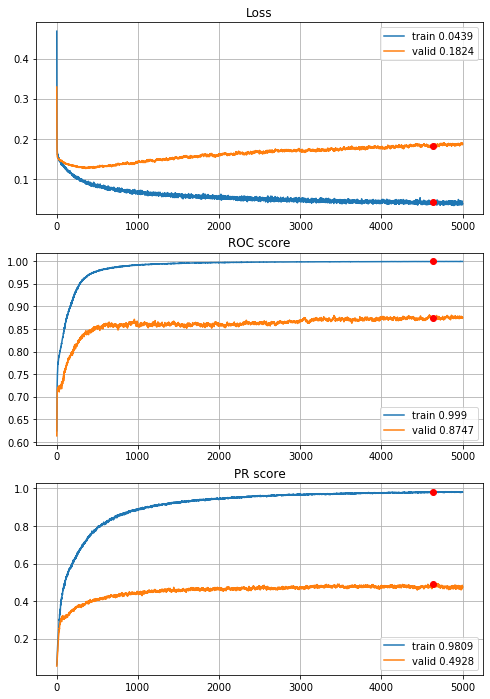


Fold 2------------------------------------------------------------


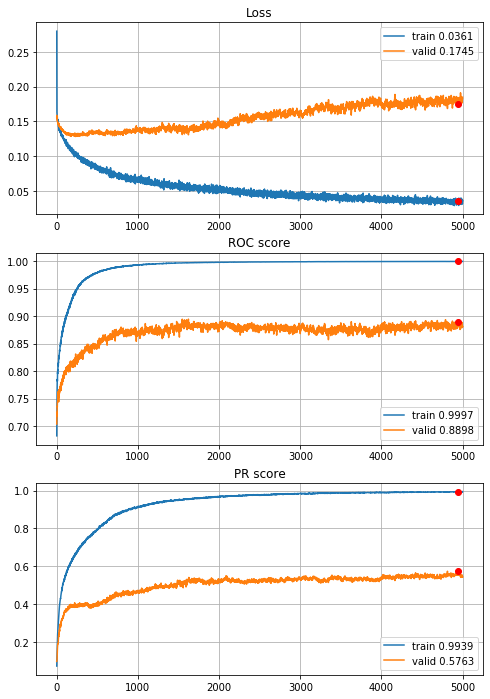


Fold 3------------------------------------------------------------


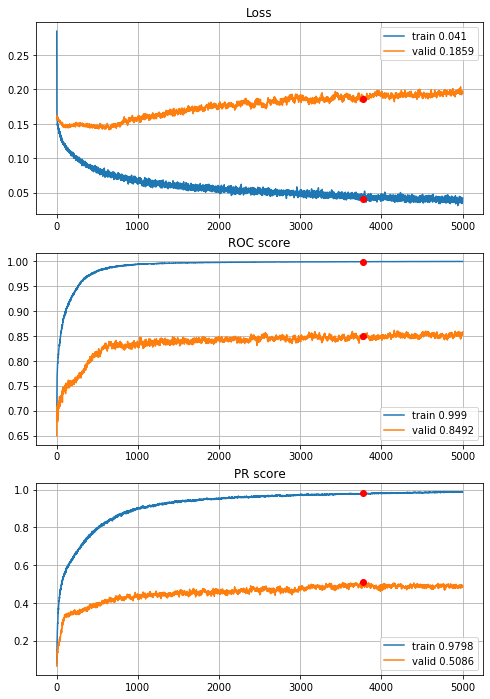


Fold 4------------------------------------------------------------


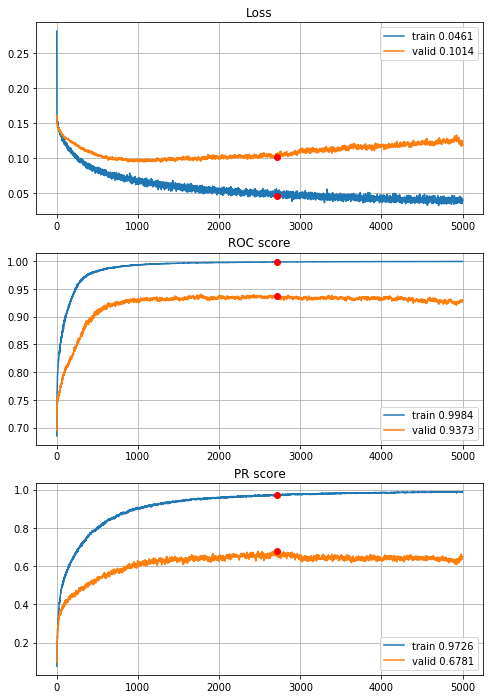


Fold 5------------------------------------------------------------


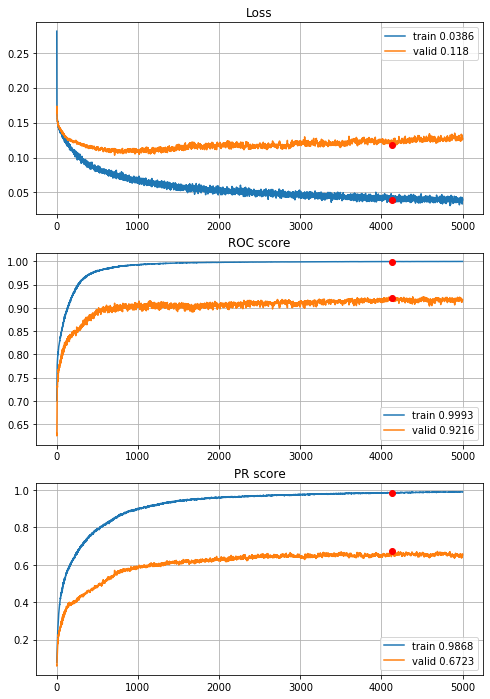


Fold 6------------------------------------------------------------


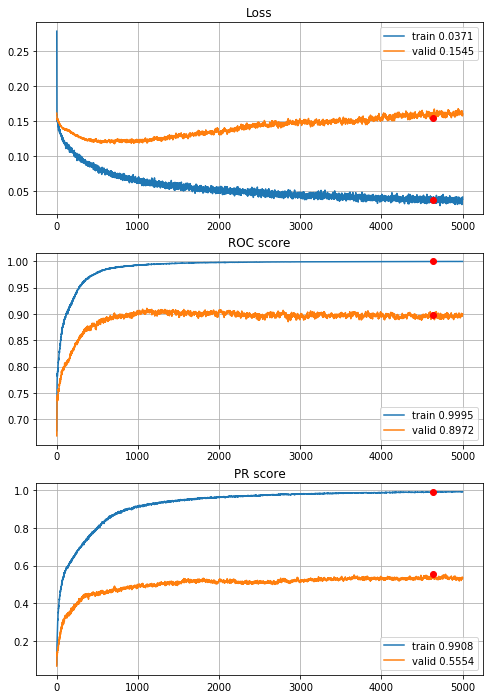

In [68]:
# model above, full preprocessing pipeline, 5000 EPOCHS
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=5000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[None,None], opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\2year\MLP_no_regu_5000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

Pretty good results, lets try some regularization (1- and 2- year horizon forecasts best model)


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/5000,
cumulative time: 8.46s train loss: 0.5076842866979587, validation loss: 0.36854028623663426
Epoch: 2/5000,
cumulative time: 8.62s train loss: 0.34342732198945597, validation loss: 0.27349141661961457
Epoch: 3/5000,
cumulative time: 8.77s train loss: 0.2742459185764258, validation loss: 0.23066142431874107
Epoch: 4/5000,
cumulative time: 8.91s train loss: 0.23897593561498878, validation loss: 0.2107317366418801
Epoch: 5/5000,
cumulative time: 9.05s train loss: 0.22277596784905254, validation loss: 0.20065314020976172
Epoch: 6/5000,
cumulative time: 9.19s train loss: 0.21197553851107873, validation loss: 0.19511230303606855
Epoch: 7/5000,
cumulative time: 9.32s train loss: 0.20646104257593367, validation loss: 0.19211157697447007
Epoch: 8/5000,
cumulative time: 9.47s train loss: 0.20034858426973975, validation loss: 0.19002578697542064
Epoch: 9/5000,
cumulative time: 9.61s train loss: 0.19827597

Epoch: 77/5000,
cumulative time: 19.21s train loss: 0.16312891036088445, validation loss: 0.164200414289497
Epoch: 78/5000,
cumulative time: 19.36s train loss: 0.16170092044245105, validation loss: 0.16411622362711795
Epoch: 79/5000,
cumulative time: 19.51s train loss: 0.16178980298991721, validation loss: 0.16430930508151748
Epoch: 80/5000,
cumulative time: 19.67s train loss: 0.1602868734540188, validation loss: 0.1642646445828059
Epoch: 81/5000,
cumulative time: 19.82s train loss: 0.1609771221188609, validation loss: 0.1642616360617965
Epoch: 82/5000,
cumulative time: 19.96s train loss: 0.1603246219548974, validation loss: 0.16416477530140083
Epoch: 83/5000,
cumulative time: 20.12s train loss: 0.1626710371618612, validation loss: 0.16417429745587891
Epoch: 84/5000,
cumulative time: 20.33s train loss: 0.16269083933235542, validation loss: 0.16386486826217972
Epoch: 85/5000,
cumulative time: 20.48s train loss: 0.16159150023333194, validation loss: 0.16358721254303132
Epoch: 86/5000,
cu

Epoch: 152/5000,
cumulative time: 30.53s train loss: 0.1514412723310748, validation loss: 0.1579689010782448
Epoch: 153/5000,
cumulative time: 30.68s train loss: 0.15073724982310036, validation loss: 0.15738022243445385
Epoch: 154/5000,
cumulative time: 30.82s train loss: 0.15070879675212578, validation loss: 0.15793476714648863
Epoch: 155/5000,
cumulative time: 30.98s train loss: 0.1499775382361135, validation loss: 0.15736487162144439
Epoch: 156/5000,
cumulative time: 31.12s train loss: 0.1510555761330233, validation loss: 0.15692910966054485
Epoch: 157/5000,
cumulative time: 31.26s train loss: 0.14799318168259085, validation loss: 0.15785538869010354
Epoch: 158/5000,
cumulative time: 31.4s train loss: 0.15107894383848441, validation loss: 0.15683879307806883
Epoch: 159/5000,
cumulative time: 31.54s train loss: 0.15210040161128063, validation loss: 0.1568240940980955
Epoch: 160/5000,
cumulative time: 31.69s train loss: 0.14980585127580617, validation loss: 0.15697210742011763
Epoch: 

Epoch: 228/5000,
cumulative time: 41.91s train loss: 0.14012613758270948, validation loss: 0.1509176710544845
Epoch: 229/5000,
cumulative time: 42.06s train loss: 0.14280998168899184, validation loss: 0.1502928542336974
Epoch: 230/5000,
cumulative time: 42.21s train loss: 0.13761309471124433, validation loss: 0.15021504867983052
Epoch: 231/5000,
cumulative time: 42.36s train loss: 0.13767429455960464, validation loss: 0.1513716807762261
Epoch: 232/5000,
cumulative time: 42.51s train loss: 0.1400453377530215, validation loss: 0.15193149598796277
Epoch: 233/5000,
cumulative time: 42.66s train loss: 0.1403123609011663, validation loss: 0.15118103015430634
Epoch: 234/5000,
cumulative time: 42.81s train loss: 0.13829266301714307, validation loss: 0.15135148556251202
Epoch: 235/5000,
cumulative time: 42.94s train loss: 0.14056391615568536, validation loss: 0.1508576069344543
Epoch: 236/5000,
cumulative time: 43.09s train loss: 0.13979908885688921, validation loss: 0.15140107214489895
Epoch: 

Epoch: 304/5000,
cumulative time: 53.51s train loss: 0.1333511622342077, validation loss: 0.14809293235465396
Epoch: 305/5000,
cumulative time: 53.67s train loss: 0.13668478397108777, validation loss: 0.1481215138461924
Epoch: 306/5000,
cumulative time: 53.82s train loss: 0.1325756168713934, validation loss: 0.14792183544462348
Epoch: 307/5000,
cumulative time: 53.96s train loss: 0.1348028841210796, validation loss: 0.147256182684889
Epoch: 308/5000,
cumulative time: 54.14s train loss: 0.13028767499191324, validation loss: 0.14747372302830922
Epoch: 309/5000,
cumulative time: 54.28s train loss: 0.13441288630605167, validation loss: 0.1475250972129727
Epoch: 310/5000,
cumulative time: 54.43s train loss: 0.1339622257690721, validation loss: 0.14758688341313547
Epoch: 311/5000,
cumulative time: 54.59s train loss: 0.13259784247189554, validation loss: 0.14734949544560394
Epoch: 312/5000,
cumulative time: 54.74s train loss: 0.13175502215359622, validation loss: 0.1476192036021115
Epoch: 313

Epoch: 380/5000,
cumulative time: 65.13s train loss: 0.12734850137148418, validation loss: 0.14530996132646914
Epoch: 381/5000,
cumulative time: 65.28s train loss: 0.13019022756892304, validation loss: 0.14413914116658513
Epoch: 382/5000,
cumulative time: 65.43s train loss: 0.1275995504181856, validation loss: 0.14537276889088893
Epoch: 383/5000,
cumulative time: 65.58s train loss: 0.12539404820221595, validation loss: 0.1453649880142387
Epoch: 384/5000,
cumulative time: 65.74s train loss: 0.13159114679743789, validation loss: 0.14565014817689692
Epoch: 385/5000,
cumulative time: 65.91s train loss: 0.12848714459870586, validation loss: 0.14454714957805323
Epoch: 386/5000,
cumulative time: 66.07s train loss: 0.12957185562096973, validation loss: 0.14433330330670582
Epoch: 387/5000,
cumulative time: 66.24s train loss: 0.1285430329809934, validation loss: 0.14415394977653012
Epoch: 388/5000,
cumulative time: 66.41s train loss: 0.13253001072003937, validation loss: 0.1444911420696841
Epoch

Epoch: 456/5000,
cumulative time: 76.71s train loss: 0.12662867376104003, validation loss: 0.14323437092813565
Epoch: 457/5000,
cumulative time: 76.87s train loss: 0.1264106001656589, validation loss: 0.1438875858858716
Epoch: 458/5000,
cumulative time: 77.02s train loss: 0.12313036623742074, validation loss: 0.14417921002773595
Epoch: 459/5000,
cumulative time: 77.17s train loss: 0.1280609973205669, validation loss: 0.14421738945875381
Epoch: 460/5000,
cumulative time: 77.32s train loss: 0.1277092313380522, validation loss: 0.14442298726360575
Epoch: 461/5000,
cumulative time: 77.46s train loss: 0.12997331281667113, validation loss: 0.14434313122793388
Epoch: 462/5000,
cumulative time: 77.6s train loss: 0.1246622403326002, validation loss: 0.1444727996776801
Epoch: 463/5000,
cumulative time: 77.75s train loss: 0.12370958919801098, validation loss: 0.14325015151172604
Epoch: 464/5000,
cumulative time: 77.9s train loss: 0.12722454786589737, validation loss: 0.1444229448060377
Epoch: 465

Epoch: 532/5000,
cumulative time: 87.99s train loss: 0.1265723791956386, validation loss: 0.1433315234329566
Epoch: 533/5000,
cumulative time: 88.13s train loss: 0.1286575721306044, validation loss: 0.14473719418361333
Epoch: 534/5000,
cumulative time: 88.29s train loss: 0.12233519879350313, validation loss: 0.14407839208138254
Epoch: 535/5000,
cumulative time: 88.43s train loss: 0.12377348266906235, validation loss: 0.14372034808364484
Epoch: 536/5000,
cumulative time: 88.59s train loss: 0.12475141013710851, validation loss: 0.1433699472586418
Epoch: 537/5000,
cumulative time: 88.73s train loss: 0.12562077991720078, validation loss: 0.14368813483930665
Epoch: 538/5000,
cumulative time: 88.88s train loss: 0.12243746725974444, validation loss: 0.14413353905257517
Epoch: 539/5000,
cumulative time: 89.02s train loss: 0.12288434058720794, validation loss: 0.14358268510232902
Epoch: 540/5000,
cumulative time: 89.17s train loss: 0.12271977255362829, validation loss: 0.14344047007991945
Epoch

cumulative time: 99.36s train loss: 0.12440008464514592, validation loss: 0.1430146117861899
Epoch: 608/5000,
cumulative time: 99.54s train loss: 0.12098057556939884, validation loss: 0.14424649042078583
Epoch: 609/5000,
cumulative time: 99.68s train loss: 0.11991941552086229, validation loss: 0.1432944331147255
Epoch: 610/5000,
cumulative time: 99.82s train loss: 0.11981563187568212, validation loss: 0.14405059369175963
Epoch: 611/5000,
cumulative time: 99.99s train loss: 0.12093449206718815, validation loss: 0.14465213264308158
Epoch: 612/5000,
cumulative time: 100.18s train loss: 0.12240127005197693, validation loss: 0.14350842232394811
Epoch: 613/5000,
cumulative time: 100.36s train loss: 0.12194675366521304, validation loss: 0.14522880065800478
Epoch: 614/5000,
cumulative time: 100.53s train loss: 0.12109046007303535, validation loss: 0.14343759833516487
Epoch: 615/5000,
cumulative time: 100.71s train loss: 0.12313137464894272, validation loss: 0.1441337113533545
Epoch: 616/5000,


Epoch: 682/5000,
cumulative time: 110.98s train loss: 0.12129003282888859, validation loss: 0.14317369411258835
Epoch: 683/5000,
cumulative time: 111.13s train loss: 0.12034257918865812, validation loss: 0.14324460096588923
Epoch: 684/5000,
cumulative time: 111.29s train loss: 0.1192423342800981, validation loss: 0.14295817701680633
Epoch: 685/5000,
cumulative time: 111.44s train loss: 0.1193143906810834, validation loss: 0.1434144346851509
Epoch: 686/5000,
cumulative time: 111.59s train loss: 0.11676461213845885, validation loss: 0.14401530645309238
Epoch: 687/5000,
cumulative time: 111.75s train loss: 0.11983864967535357, validation loss: 0.14367724236388976
Epoch: 688/5000,
cumulative time: 111.91s train loss: 0.12194366765797318, validation loss: 0.14437079945210549
Epoch: 689/5000,
cumulative time: 112.05s train loss: 0.11764984387942982, validation loss: 0.14381162095741706
Epoch: 690/5000,
cumulative time: 112.2s train loss: 0.124581861471947, validation loss: 0.1444596494322210

Epoch: 756/5000,
cumulative time: 122.4s train loss: 0.11788283635664774, validation loss: 0.14577652722948656
Epoch: 757/5000,
cumulative time: 122.56s train loss: 0.1162098350425991, validation loss: 0.14460302485082283
Epoch: 758/5000,
cumulative time: 122.71s train loss: 0.1145553309497272, validation loss: 0.1448530512977865
Epoch: 759/5000,
cumulative time: 122.87s train loss: 0.11288349514223829, validation loss: 0.14476617022391852
Epoch: 760/5000,
cumulative time: 123.02s train loss: 0.12045889084399145, validation loss: 0.14548851721486758
Epoch: 761/5000,
cumulative time: 123.17s train loss: 0.12088083506298497, validation loss: 0.144567260345344
Epoch: 762/5000,
cumulative time: 123.32s train loss: 0.11647418106402306, validation loss: 0.14556311213485848
Epoch: 763/5000,
cumulative time: 123.49s train loss: 0.11427866679326096, validation loss: 0.1449524778408898
Epoch: 764/5000,
cumulative time: 123.67s train loss: 0.1171858093569094, validation loss: 0.14528753086045718


Epoch: 830/5000,
cumulative time: 133.99s train loss: 0.11814946281240377, validation loss: 0.1444321240971004
Epoch: 831/5000,
cumulative time: 134.14s train loss: 0.1176964697202328, validation loss: 0.14552380093818879
Epoch: 832/5000,
cumulative time: 134.29s train loss: 0.11700137792310672, validation loss: 0.14454127084537072
Epoch: 833/5000,
cumulative time: 134.44s train loss: 0.11896880835818188, validation loss: 0.14507852766179477
Epoch: 834/5000,
cumulative time: 134.59s train loss: 0.11589487656406, validation loss: 0.14435049817259002
Epoch: 835/5000,
cumulative time: 134.75s train loss: 0.1143170557432741, validation loss: 0.14522235212679147
Epoch: 836/5000,
cumulative time: 134.91s train loss: 0.11850479932037777, validation loss: 0.14511080754146977
Epoch: 837/5000,
cumulative time: 135.06s train loss: 0.11455231511994449, validation loss: 0.14456184282605958
Epoch: 838/5000,
cumulative time: 135.22s train loss: 0.11581164077441929, validation loss: 0.144370593101294


Epoch: 905/5000,
cumulative time: 145.57s train loss: 0.11278680147209336, validation loss: 0.1433279325655841
Epoch: 906/5000,
cumulative time: 145.73s train loss: 0.11375477433845309, validation loss: 0.143037108477415
Epoch: 907/5000,
cumulative time: 145.88s train loss: 0.11733215103097537, validation loss: 0.14403223964052464
Epoch: 908/5000,
cumulative time: 146.04s train loss: 0.11678315513739347, validation loss: 0.14343723521945048
Epoch: 909/5000,
cumulative time: 146.2s train loss: 0.11410094272779409, validation loss: 0.1438026079226915
Epoch: 910/5000,
cumulative time: 146.37s train loss: 0.11825605211438882, validation loss: 0.14201812967560395
Epoch: 911/5000,
cumulative time: 146.53s train loss: 0.11442189109811371, validation loss: 0.14274043541982634
Epoch: 912/5000,
cumulative time: 146.69s train loss: 0.11773459709031286, validation loss: 0.14253047055920018
Epoch: 913/5000,
cumulative time: 146.84s train loss: 0.11558681387570977, validation loss: 0.143387988893263

Epoch: 979/5000,
cumulative time: 156.97s train loss: 0.11211175607195811, validation loss: 0.14301730090871864
Epoch: 980/5000,
cumulative time: 157.13s train loss: 0.11612501203513799, validation loss: 0.14136303584353796
Epoch: 981/5000,
cumulative time: 157.28s train loss: 0.11498821918875944, validation loss: 0.1422709175635759
Epoch: 982/5000,
cumulative time: 157.44s train loss: 0.11108813345283837, validation loss: 0.14266551138532896
Epoch: 983/5000,
cumulative time: 157.6s train loss: 0.111345051952475, validation loss: 0.1434608641840996
Epoch: 984/5000,
cumulative time: 157.75s train loss: 0.11312112198117864, validation loss: 0.14342538323033685
Epoch: 985/5000,
cumulative time: 157.9s train loss: 0.11384171822316713, validation loss: 0.14436831884818496
Epoch: 986/5000,
cumulative time: 158.05s train loss: 0.11578198289797774, validation loss: 0.1427055472705811
Epoch: 987/5000,
cumulative time: 158.21s train loss: 0.11124952768459906, validation loss: 0.14355996745207675

Epoch: 1053/5000,
cumulative time: 168.39s train loss: 0.11807932540420811, validation loss: 0.14293587977264374
Epoch: 1054/5000,
cumulative time: 168.55s train loss: 0.11299764131156656, validation loss: 0.14214616550100898
Epoch: 1055/5000,
cumulative time: 168.7s train loss: 0.11233059174776358, validation loss: 0.14362680109347148
Epoch: 1056/5000,
cumulative time: 168.86s train loss: 0.11470270379528116, validation loss: 0.1421833556550671
Epoch: 1057/5000,
cumulative time: 169.01s train loss: 0.11604992493153056, validation loss: 0.14346457069659138
Epoch: 1058/5000,
cumulative time: 169.17s train loss: 0.11231609897487581, validation loss: 0.14305425530023688
Epoch: 1059/5000,
cumulative time: 169.33s train loss: 0.11559512174673264, validation loss: 0.1428250319289036
Epoch: 1060/5000,
cumulative time: 169.49s train loss: 0.11508262670162012, validation loss: 0.1437675497088176
Epoch: 1061/5000,
cumulative time: 169.64s train loss: 0.11269393283666267, validation loss: 0.14384

Epoch: 1127/5000,
cumulative time: 179.86s train loss: 0.10995194145589032, validation loss: 0.14501301032218833
Epoch: 1128/5000,
cumulative time: 180.02s train loss: 0.1106918593571967, validation loss: 0.14276543062370695
Epoch: 1129/5000,
cumulative time: 180.19s train loss: 0.11332503591269462, validation loss: 0.14362913672842798
Epoch: 1130/5000,
cumulative time: 180.35s train loss: 0.11202440478141068, validation loss: 0.14324091933423538
Epoch: 1131/5000,
cumulative time: 180.5s train loss: 0.1142366941950396, validation loss: 0.14315288667206996
Epoch: 1132/5000,
cumulative time: 180.66s train loss: 0.11243019415230938, validation loss: 0.14345507481932485
Epoch: 1133/5000,
cumulative time: 180.82s train loss: 0.11242624147915875, validation loss: 0.14429632956125477
Epoch: 1134/5000,
cumulative time: 180.97s train loss: 0.11093157614991586, validation loss: 0.14411044868776088
Epoch: 1135/5000,
cumulative time: 181.11s train loss: 0.11329740661381113, validation loss: 0.1457

Epoch: 1201/5000,
cumulative time: 191.37s train loss: 0.1125723127906109, validation loss: 0.14401584553140487
Epoch: 1202/5000,
cumulative time: 191.53s train loss: 0.111646757938084, validation loss: 0.14268737167198098
Epoch: 1203/5000,
cumulative time: 191.7s train loss: 0.10972251049487677, validation loss: 0.14353415922678
Epoch: 1204/5000,
cumulative time: 191.85s train loss: 0.11217787980189532, validation loss: 0.14364950399880017
Epoch: 1205/5000,
cumulative time: 192.0s train loss: 0.11369181638745902, validation loss: 0.1430275886957955
Epoch: 1206/5000,
cumulative time: 192.17s train loss: 0.11140401453572779, validation loss: 0.14346107869832575
Epoch: 1207/5000,
cumulative time: 192.32s train loss: 0.11405212132716526, validation loss: 0.14364010622898216
Epoch: 1208/5000,
cumulative time: 192.49s train loss: 0.11224223195682238, validation loss: 0.14444150596974248
Epoch: 1209/5000,
cumulative time: 192.65s train loss: 0.11074172898292979, validation loss: 0.1422678506

Epoch: 1275/5000,
cumulative time: 202.76s train loss: 0.10970602818062927, validation loss: 0.14152392909067488
Epoch: 1276/5000,
cumulative time: 202.92s train loss: 0.1134051566975022, validation loss: 0.14164551409989165
Epoch: 1277/5000,
cumulative time: 203.08s train loss: 0.11504955191215505, validation loss: 0.1413345272270755
Epoch: 1278/5000,
cumulative time: 203.23s train loss: 0.11017208569350476, validation loss: 0.14278094212708906
Epoch: 1279/5000,
cumulative time: 203.38s train loss: 0.10881058090650984, validation loss: 0.14422854162059323
Epoch: 1280/5000,
cumulative time: 203.53s train loss: 0.10885852761542224, validation loss: 0.14239820273566214
Epoch: 1281/5000,
cumulative time: 203.67s train loss: 0.11382760952092168, validation loss: 0.1420279187034342
Epoch: 1282/5000,
cumulative time: 203.81s train loss: 0.1130103841541182, validation loss: 0.14186249480022514
Epoch: 1283/5000,
cumulative time: 203.95s train loss: 0.11239871649328667, validation loss: 0.14329

Epoch: 1349/5000,
cumulative time: 214.37s train loss: 0.1148376024332689, validation loss: 0.1418134040476298
Epoch: 1350/5000,
cumulative time: 214.52s train loss: 0.11172739112145905, validation loss: 0.14197508563064185
Epoch: 1351/5000,
cumulative time: 214.68s train loss: 0.1114094071212298, validation loss: 0.14244312378010307
Epoch: 1352/5000,
cumulative time: 214.82s train loss: 0.11135138082760536, validation loss: 0.144258657062663
Epoch: 1353/5000,
cumulative time: 215.0s train loss: 0.10901535879676535, validation loss: 0.14391697054609245
Epoch: 1354/5000,
cumulative time: 215.15s train loss: 0.11376623273958368, validation loss: 0.14240072716422975
Epoch: 1355/5000,
cumulative time: 215.3s train loss: 0.11015645064084428, validation loss: 0.14435981723771651
Epoch: 1356/5000,
cumulative time: 215.44s train loss: 0.1114424144345493, validation loss: 0.1424177799808401
Epoch: 1357/5000,
cumulative time: 215.6s train loss: 0.11112332006244738, validation loss: 0.14322599790

Epoch: 1423/5000,
cumulative time: 225.68s train loss: 0.10893736875690847, validation loss: 0.14313881440017356
Epoch: 1424/5000,
cumulative time: 225.83s train loss: 0.11229657774469083, validation loss: 0.1430394769613271
Epoch: 1425/5000,
cumulative time: 225.98s train loss: 0.11294214763230712, validation loss: 0.142797688356702
Epoch: 1426/5000,
cumulative time: 226.13s train loss: 0.1092573418365595, validation loss: 0.14291133916159288
Epoch: 1427/5000,
cumulative time: 226.29s train loss: 0.10976831953074583, validation loss: 0.14241377616772333
Epoch: 1428/5000,
cumulative time: 226.43s train loss: 0.1075391949848198, validation loss: 0.1434124045337637
Epoch: 1429/5000,
cumulative time: 226.58s train loss: 0.11280177642421245, validation loss: 0.1435887106983565
Epoch: 1430/5000,
cumulative time: 226.73s train loss: 0.11080134617522903, validation loss: 0.1428594898681497
Epoch: 1431/5000,
cumulative time: 226.87s train loss: 0.1075140818433956, validation loss: 0.1446655071

Epoch: 1497/5000,
cumulative time: 236.84s train loss: 0.11167413295233354, validation loss: 0.1428802365713007
Epoch: 1498/5000,
cumulative time: 236.98s train loss: 0.10942273763853064, validation loss: 0.1426125330115677
Epoch: 1499/5000,
cumulative time: 237.15s train loss: 0.10848221938331, validation loss: 0.1433704374345852
Epoch: 1500/5000,
cumulative time: 237.29s train loss: 0.1108966485576074, validation loss: 0.14541135740077044
Epoch: 1501/5000,
cumulative time: 237.44s train loss: 0.10635879480529385, validation loss: 0.1426268361733438
Epoch: 1502/5000,
cumulative time: 237.59s train loss: 0.10598179989411738, validation loss: 0.14348789660911884
Epoch: 1503/5000,
cumulative time: 237.74s train loss: 0.10973291277987005, validation loss: 0.14392609900134576
Epoch: 1504/5000,
cumulative time: 237.9s train loss: 0.11037756345002987, validation loss: 0.14368087283749412
Epoch: 1505/5000,
cumulative time: 238.04s train loss: 0.10651664735781348, validation loss: 0.1443790431

Epoch: 1571/5000,
cumulative time: 248.02s train loss: 0.10812126851567029, validation loss: 0.14330606676179178
Epoch: 1572/5000,
cumulative time: 248.18s train loss: 0.11163131056309747, validation loss: 0.14330017156557207
Epoch: 1573/5000,
cumulative time: 248.44s train loss: 0.11231654597553017, validation loss: 0.14360772231459462
Epoch: 1574/5000,
cumulative time: 248.59s train loss: 0.11051741781694452, validation loss: 0.14640246683226343
Epoch: 1575/5000,
cumulative time: 248.74s train loss: 0.10511740290340457, validation loss: 0.14493895658971753
Epoch: 1576/5000,
cumulative time: 248.9s train loss: 0.10611735022303193, validation loss: 0.14449223790068771
Epoch: 1577/5000,
cumulative time: 249.07s train loss: 0.10942790032249554, validation loss: 0.145504064906784
Epoch: 1578/5000,
cumulative time: 249.23s train loss: 0.10749702029021012, validation loss: 0.14219238486038435
Epoch: 1579/5000,
cumulative time: 249.37s train loss: 0.10947813305587284, validation loss: 0.1423

Epoch: 1644/5000,
cumulative time: 259.51s train loss: 0.10751398888937001, validation loss: 0.14524384981526617
Epoch: 1645/5000,
cumulative time: 259.67s train loss: 0.10754027538736927, validation loss: 0.14397514858533328
Epoch: 1646/5000,
cumulative time: 259.82s train loss: 0.11032625354864538, validation loss: 0.14332522352276122
Epoch: 1647/5000,
cumulative time: 259.98s train loss: 0.10863253632153858, validation loss: 0.14411612376473054
Epoch: 1648/5000,
cumulative time: 260.12s train loss: 0.1098739566790009, validation loss: 0.14346518796205834
Epoch: 1649/5000,
cumulative time: 260.3s train loss: 0.10595313444008973, validation loss: 0.1444527661503533
Epoch: 1650/5000,
cumulative time: 260.47s train loss: 0.1131501010988874, validation loss: 0.14364574197313576
Epoch: 1651/5000,
cumulative time: 260.62s train loss: 0.11080237786334532, validation loss: 0.14331204878705825
Epoch: 1652/5000,
cumulative time: 260.76s train loss: 0.110024965981158, validation loss: 0.1428492

Epoch: 1717/5000,
cumulative time: 270.94s train loss: 0.10473685093426208, validation loss: 0.14548233547888764
Epoch: 1718/5000,
cumulative time: 271.11s train loss: 0.10681229776855783, validation loss: 0.14545952123473857
Epoch: 1719/5000,
cumulative time: 271.26s train loss: 0.10567456626133456, validation loss: 0.1440090375951202
Epoch: 1720/5000,
cumulative time: 271.42s train loss: 0.1106376546869773, validation loss: 0.14322859707970764
Epoch: 1721/5000,
cumulative time: 271.58s train loss: 0.10676996271018667, validation loss: 0.14535032187345612
Epoch: 1722/5000,
cumulative time: 271.73s train loss: 0.111311731261622, validation loss: 0.1444706396928465
Epoch: 1723/5000,
cumulative time: 271.9s train loss: 0.11101656929410478, validation loss: 0.14584550173613847
Epoch: 1724/5000,
cumulative time: 272.05s train loss: 0.1107617911961682, validation loss: 0.14636672627019695
Epoch: 1725/5000,
cumulative time: 272.19s train loss: 0.10734075962567426, validation loss: 0.14517450

Epoch: 1791/5000,
cumulative time: 282.41s train loss: 0.1078423919742894, validation loss: 0.14401556504585172
Epoch: 1792/5000,
cumulative time: 282.57s train loss: 0.11106501513380869, validation loss: 0.142855808617325
Epoch: 1793/5000,
cumulative time: 282.71s train loss: 0.11356674098108305, validation loss: 0.14301437299654648
Epoch: 1794/5000,
cumulative time: 282.87s train loss: 0.11103960733603394, validation loss: 0.14425375881857516
Epoch: 1795/5000,
cumulative time: 283.01s train loss: 0.1035762611395223, validation loss: 0.1446522713137173
Epoch: 1796/5000,
cumulative time: 283.17s train loss: 0.10855951985918784, validation loss: 0.14526209008646823
Epoch: 1797/5000,
cumulative time: 283.34s train loss: 0.10368978090829407, validation loss: 0.14526242441540466
Epoch: 1798/5000,
cumulative time: 283.48s train loss: 0.10662597157759378, validation loss: 0.14294241066060248
Epoch: 1799/5000,
cumulative time: 283.63s train loss: 0.11051392808863213, validation loss: 0.144044

Epoch: 1864/5000,
cumulative time: 293.6s train loss: 0.1101552088656921, validation loss: 0.14254330928641254
Epoch: 1865/5000,
cumulative time: 293.75s train loss: 0.11030011883486238, validation loss: 0.14372403357241445
Epoch: 1866/5000,
cumulative time: 293.9s train loss: 0.10969277603146695, validation loss: 0.14381064065435453
Epoch: 1867/5000,
cumulative time: 294.07s train loss: 0.10601608284273846, validation loss: 0.14328400667654265
Epoch: 1868/5000,
cumulative time: 294.22s train loss: 0.10579562703237134, validation loss: 0.14503133185647263
Epoch: 1869/5000,
cumulative time: 294.36s train loss: 0.10746953002878998, validation loss: 0.1439105916577898
Epoch: 1870/5000,
cumulative time: 294.51s train loss: 0.11218656644445835, validation loss: 0.1435204851361746
Epoch: 1871/5000,
cumulative time: 294.68s train loss: 0.10986224873469251, validation loss: 0.1451320511778404
Epoch: 1872/5000,
cumulative time: 294.83s train loss: 0.10930082643093796, validation loss: 0.1440891

Epoch: 1938/5000,
cumulative time: 304.8s train loss: 0.10486342621605117, validation loss: 0.14532663674138946
Epoch: 1939/5000,
cumulative time: 304.96s train loss: 0.10954559634140926, validation loss: 0.14456723181245212
Epoch: 1940/5000,
cumulative time: 305.1s train loss: 0.10858361064207978, validation loss: 0.14422343022935824
Epoch: 1941/5000,
cumulative time: 305.27s train loss: 0.1103066651030705, validation loss: 0.1446070014883619
Epoch: 1942/5000,
cumulative time: 305.43s train loss: 0.10513441043817164, validation loss: 0.14590339380198036
Epoch: 1943/5000,
cumulative time: 305.59s train loss: 0.10765921222044797, validation loss: 0.14523872084730105
Epoch: 1944/5000,
cumulative time: 305.73s train loss: 0.10946700490814844, validation loss: 0.1456256404538611
Epoch: 1945/5000,
cumulative time: 305.89s train loss: 0.10741598938216637, validation loss: 0.14593798957208506
Epoch: 1946/5000,
cumulative time: 306.04s train loss: 0.11010396353893596, validation loss: 0.146174

Epoch: 2012/5000,
cumulative time: 315.92s train loss: 0.10691369565950651, validation loss: 0.14487188896298564
Epoch: 2013/5000,
cumulative time: 316.07s train loss: 0.1086842361620329, validation loss: 0.14576542250528873
Epoch: 2014/5000,
cumulative time: 316.23s train loss: 0.10985354459024785, validation loss: 0.1436247603374571
Epoch: 2015/5000,
cumulative time: 316.37s train loss: 0.10901865853185437, validation loss: 0.14358233997346845
Epoch: 2016/5000,
cumulative time: 316.52s train loss: 0.11101128841066817, validation loss: 0.14526873992983041
Epoch: 2017/5000,
cumulative time: 316.69s train loss: 0.11268979952038155, validation loss: 0.14301937107646137
Epoch: 2018/5000,
cumulative time: 316.85s train loss: 0.10863056735839142, validation loss: 0.14458910029181335
Epoch: 2019/5000,
cumulative time: 317.01s train loss: 0.10635779097408685, validation loss: 0.1440899085600129
Epoch: 2020/5000,
cumulative time: 317.15s train loss: 0.11052313936477033, validation loss: 0.1444

Epoch: 2086/5000,
cumulative time: 327.13s train loss: 0.10479427366249526, validation loss: 0.14583581193871453
Epoch: 2087/5000,
cumulative time: 327.29s train loss: 0.10965207440033702, validation loss: 0.1453505280289706
Epoch: 2088/5000,
cumulative time: 327.44s train loss: 0.10625767134552874, validation loss: 0.14395218070103333
Epoch: 2089/5000,
cumulative time: 327.58s train loss: 0.1081986718210844, validation loss: 0.14473830222067952
Epoch: 2090/5000,
cumulative time: 327.73s train loss: 0.10760504864708033, validation loss: 0.14478721542877107
Epoch: 2091/5000,
cumulative time: 327.91s train loss: 0.10393176502138592, validation loss: 0.14567951385424927
Epoch: 2092/5000,
cumulative time: 328.06s train loss: 0.10884985237383939, validation loss: 0.14328478923162657
Epoch: 2093/5000,
cumulative time: 328.22s train loss: 0.10919838590404124, validation loss: 0.14434891962598848
Epoch: 2094/5000,
cumulative time: 328.37s train loss: 0.10792080583000796, validation loss: 0.144

Epoch: 2159/5000,
cumulative time: 338.21s train loss: 0.10729247855376817, validation loss: 0.14426510828897493
Epoch: 2160/5000,
cumulative time: 338.36s train loss: 0.10498970121766374, validation loss: 0.14428090730860224
Epoch: 2161/5000,
cumulative time: 338.51s train loss: 0.1033805524282131, validation loss: 0.14492538126080565
Epoch: 2162/5000,
cumulative time: 338.65s train loss: 0.10888767610224097, validation loss: 0.1461064498163613
Epoch: 2163/5000,
cumulative time: 338.81s train loss: 0.11067485494368479, validation loss: 0.14596206223199126
Epoch: 2164/5000,
cumulative time: 338.96s train loss: 0.10768904451508872, validation loss: 0.1443145603214929
Epoch: 2165/5000,
cumulative time: 339.12s train loss: 0.10644309265669184, validation loss: 0.1447391086996461
Epoch: 2166/5000,
cumulative time: 339.28s train loss: 0.10792808155781289, validation loss: 0.14472021039472807
Epoch: 2167/5000,
cumulative time: 339.43s train loss: 0.10551795126304571, validation loss: 0.14516

Epoch: 2232/5000,
cumulative time: 349.25s train loss: 0.10831639466462746, validation loss: 0.1464208806053214
Epoch: 2233/5000,
cumulative time: 349.4s train loss: 0.10584584866019388, validation loss: 0.14494897686872696
Epoch: 2234/5000,
cumulative time: 349.54s train loss: 0.10712945948017114, validation loss: 0.1460006370613178
Epoch: 2235/5000,
cumulative time: 349.71s train loss: 0.10635525195411717, validation loss: 0.14647473283551468
Epoch: 2236/5000,
cumulative time: 349.87s train loss: 0.10513159131387347, validation loss: 0.14601583511301294
Epoch: 2237/5000,
cumulative time: 350.01s train loss: 0.10610294997055357, validation loss: 0.14567168508100947
Epoch: 2238/5000,
cumulative time: 350.17s train loss: 0.10378499766808066, validation loss: 0.14607149042277004
Epoch: 2239/5000,
cumulative time: 350.32s train loss: 0.10859753326048371, validation loss: 0.14623661958374484
Epoch: 2240/5000,
cumulative time: 350.47s train loss: 0.11099789303827917, validation loss: 0.1467

Epoch: 2306/5000,
cumulative time: 360.59s train loss: 0.1081217082718094, validation loss: 0.14600277025140285
Epoch: 2307/5000,
cumulative time: 360.74s train loss: 0.1094380076156717, validation loss: 0.14540442734527087
Epoch: 2308/5000,
cumulative time: 360.89s train loss: 0.11131699114104276, validation loss: 0.14646874686524877
Epoch: 2309/5000,
cumulative time: 361.05s train loss: 0.10374714493036645, validation loss: 0.1470140047459271
Epoch: 2310/5000,
cumulative time: 361.2s train loss: 0.10865371429657683, validation loss: 0.14659740817812447
Epoch: 2311/5000,
cumulative time: 361.36s train loss: 0.11107079716571928, validation loss: 0.14640322552205381
Epoch: 2312/5000,
cumulative time: 361.52s train loss: 0.10887090544349276, validation loss: 0.14621244392420019
Epoch: 2313/5000,
cumulative time: 361.68s train loss: 0.10464802321873294, validation loss: 0.14641802274618362
Epoch: 2314/5000,
cumulative time: 361.82s train loss: 0.10557665908703065, validation loss: 0.14627

Epoch: 2379/5000,
cumulative time: 371.66s train loss: 0.1086018271954223, validation loss: 0.14815484448232313
Epoch: 2380/5000,
cumulative time: 371.82s train loss: 0.10822617372275492, validation loss: 0.1481871347322689
Epoch: 2381/5000,
cumulative time: 371.96s train loss: 0.10286996976910326, validation loss: 0.14861038883813554
Epoch: 2382/5000,
cumulative time: 372.12s train loss: 0.11059298525886777, validation loss: 0.14788156034983937
Epoch: 2383/5000,
cumulative time: 372.29s train loss: 0.10413600133773711, validation loss: 0.14795514329935902
Epoch: 2384/5000,
cumulative time: 372.42s train loss: 0.10824318834675578, validation loss: 0.14737789848450752
Epoch: 2385/5000,
cumulative time: 372.57s train loss: 0.10589830796232479, validation loss: 0.1470853906432423
Epoch: 2386/5000,
cumulative time: 372.72s train loss: 0.10695828458638285, validation loss: 0.1474030777753415
Epoch: 2387/5000,
cumulative time: 372.87s train loss: 0.10900764511271907, validation loss: 0.14749

Epoch: 2453/5000,
cumulative time: 382.84s train loss: 0.10457445324533717, validation loss: 0.1511078682162971
Epoch: 2454/5000,
cumulative time: 382.97s train loss: 0.10743776560200825, validation loss: 0.14832571578525777
Epoch: 2455/5000,
cumulative time: 383.12s train loss: 0.10696624717685525, validation loss: 0.14728827003101533
Epoch: 2456/5000,
cumulative time: 383.25s train loss: 0.10254968952415405, validation loss: 0.14712829370329922
Epoch: 2457/5000,
cumulative time: 383.4s train loss: 0.11154598175604294, validation loss: 0.14855722643601005
Epoch: 2458/5000,
cumulative time: 383.52s train loss: 0.10543508517318698, validation loss: 0.1472728128397293
Epoch: 2459/5000,
cumulative time: 383.69s train loss: 0.10947276213360045, validation loss: 0.14680454429839573
Epoch: 2460/5000,
cumulative time: 383.84s train loss: 0.11066560051492445, validation loss: 0.1474627801076769
Epoch: 2461/5000,
cumulative time: 383.98s train loss: 0.10772470050346243, validation loss: 0.14870

Epoch: 2527/5000,
cumulative time: 393.97s train loss: 0.10511269277799862, validation loss: 0.14791248275911822
Epoch: 2528/5000,
cumulative time: 394.12s train loss: 0.10878742498446142, validation loss: 0.1469889287672068
Epoch: 2529/5000,
cumulative time: 394.27s train loss: 0.10606038879404407, validation loss: 0.14933904265279382
Epoch: 2530/5000,
cumulative time: 394.42s train loss: 0.10453871222815236, validation loss: 0.14868991973359494
Epoch: 2531/5000,
cumulative time: 394.57s train loss: 0.10948167809563925, validation loss: 0.14898377731149506
Epoch: 2532/5000,
cumulative time: 394.72s train loss: 0.1055009863271612, validation loss: 0.14924758860199355
Epoch: 2533/5000,
cumulative time: 394.87s train loss: 0.11087016451521303, validation loss: 0.14971455791049673
Epoch: 2534/5000,
cumulative time: 395.02s train loss: 0.1083750721452464, validation loss: 0.14861656313329974
Epoch: 2535/5000,
cumulative time: 395.17s train loss: 0.10827930997346641, validation loss: 0.1485

Epoch: 2601/5000,
cumulative time: 405.17s train loss: 0.1062803278032723, validation loss: 0.1480754037750189
Epoch: 2602/5000,
cumulative time: 405.3s train loss: 0.10530145587818325, validation loss: 0.14851512456237098
Epoch: 2603/5000,
cumulative time: 405.44s train loss: 0.10670032025629703, validation loss: 0.14981495261895392
Epoch: 2604/5000,
cumulative time: 405.58s train loss: 0.10874450563025015, validation loss: 0.14879711601165457
Epoch: 2605/5000,
cumulative time: 405.73s train loss: 0.10844632963675442, validation loss: 0.14883429751405552
Epoch: 2606/5000,
cumulative time: 405.87s train loss: 0.10442769092647194, validation loss: 0.14902690304919278
Epoch: 2607/5000,
cumulative time: 406.02s train loss: 0.10742996995180927, validation loss: 0.1511638979299353
Epoch: 2608/5000,
cumulative time: 406.16s train loss: 0.10916321660001463, validation loss: 0.15019451103235448
Epoch: 2609/5000,
cumulative time: 406.32s train loss: 0.10495386146099793, validation loss: 0.15091

Epoch: 2675/5000,
cumulative time: 416.22s train loss: 0.10523512512386853, validation loss: 0.1495172515374805
Epoch: 2676/5000,
cumulative time: 416.36s train loss: 0.1058310065093758, validation loss: 0.14992226394647695
Epoch: 2677/5000,
cumulative time: 416.52s train loss: 0.10358807422012688, validation loss: 0.15001946763864193
Epoch: 2678/5000,
cumulative time: 416.66s train loss: 0.10557865543733623, validation loss: 0.1506746193372094
Epoch: 2679/5000,
cumulative time: 416.82s train loss: 0.10363040070969556, validation loss: 0.15033398625266348
Epoch: 2680/5000,
cumulative time: 416.97s train loss: 0.10740694324738045, validation loss: 0.14962254376742662
Epoch: 2681/5000,
cumulative time: 417.14s train loss: 0.109077647645776, validation loss: 0.14926221341793064
Epoch: 2682/5000,
cumulative time: 417.28s train loss: 0.10524545483479636, validation loss: 0.15115727509614837
Epoch: 2683/5000,
cumulative time: 417.43s train loss: 0.10383187818806924, validation loss: 0.149514

Epoch: 2748/5000,
cumulative time: 427.39s train loss: 0.10614784949259295, validation loss: 0.1512338093348912
Epoch: 2749/5000,
cumulative time: 427.53s train loss: 0.10745547017282045, validation loss: 0.1501230971294493
Epoch: 2750/5000,
cumulative time: 427.68s train loss: 0.10276213985120568, validation loss: 0.15030295408646996
Epoch: 2751/5000,
cumulative time: 427.82s train loss: 0.10521425503389226, validation loss: 0.15020343723803328
Epoch: 2752/5000,
cumulative time: 427.97s train loss: 0.10494276949776189, validation loss: 0.15087370383083273
Epoch: 2753/5000,
cumulative time: 428.12s train loss: 0.10206802847489631, validation loss: 0.15112475080227633
Epoch: 2754/5000,
cumulative time: 428.28s train loss: 0.10583510520326105, validation loss: 0.15104336618674066
Epoch: 2755/5000,
cumulative time: 428.43s train loss: 0.10535445167143609, validation loss: 0.15208228254693207
Epoch: 2756/5000,
cumulative time: 428.58s train loss: 0.1065363727968007, validation loss: 0.1533

Epoch: 2821/5000,
cumulative time: 438.82s train loss: 0.10668073295726581, validation loss: 0.15003879559696268
Epoch: 2822/5000,
cumulative time: 438.97s train loss: 0.10493143348967925, validation loss: 0.15122484967483604
Epoch: 2823/5000,
cumulative time: 439.13s train loss: 0.10360217345996896, validation loss: 0.1497505367349047
Epoch: 2824/5000,
cumulative time: 439.29s train loss: 0.10482645448385645, validation loss: 0.14988106106399396
Epoch: 2825/5000,
cumulative time: 439.46s train loss: 0.10329295859680308, validation loss: 0.15080565565691706
Epoch: 2826/5000,
cumulative time: 439.61s train loss: 0.10093064615662874, validation loss: 0.1501388794316533
Epoch: 2827/5000,
cumulative time: 439.77s train loss: 0.10066238613495243, validation loss: 0.15125976973561128
Epoch: 2828/5000,
cumulative time: 439.92s train loss: 0.10523994255365152, validation loss: 0.1501096770030643
Epoch: 2829/5000,
cumulative time: 440.08s train loss: 0.10468456674128407, validation loss: 0.1497

Epoch: 2895/5000,
cumulative time: 450.3s train loss: 0.10467572009239992, validation loss: 0.15047577134825454
Epoch: 2896/5000,
cumulative time: 450.45s train loss: 0.10606075494188455, validation loss: 0.14979263468307405
Epoch: 2897/5000,
cumulative time: 450.62s train loss: 0.10126777120722685, validation loss: 0.15095267135303267
Epoch: 2898/5000,
cumulative time: 450.77s train loss: 0.10901665317034062, validation loss: 0.15032847561576887
Epoch: 2899/5000,
cumulative time: 450.92s train loss: 0.10625224494480152, validation loss: 0.15157986290723593
Epoch: 2900/5000,
cumulative time: 451.07s train loss: 0.10537094509660971, validation loss: 0.15105113726924632
Epoch: 2901/5000,
cumulative time: 451.23s train loss: 0.10208649024599767, validation loss: 0.15173776006401757
Epoch: 2902/5000,
cumulative time: 451.41s train loss: 0.10202700522752557, validation loss: 0.15137713606595055
Epoch: 2903/5000,
cumulative time: 451.55s train loss: 0.10507773916676655, validation loss: 0.15

Epoch: 2968/5000,
cumulative time: 461.62s train loss: 0.10510805360743378, validation loss: 0.15051386275891396
Epoch: 2969/5000,
cumulative time: 461.78s train loss: 0.10410410902250608, validation loss: 0.15203445392073686
Epoch: 2970/5000,
cumulative time: 461.92s train loss: 0.09956825467339035, validation loss: 0.15182084325569173
Epoch: 2971/5000,
cumulative time: 462.08s train loss: 0.10462677165492831, validation loss: 0.152179224111462
Epoch: 2972/5000,
cumulative time: 462.23s train loss: 0.10248353046035842, validation loss: 0.15245423123220941
Epoch: 2973/5000,
cumulative time: 462.38s train loss: 0.1059491474272727, validation loss: 0.15247693978162144
Epoch: 2974/5000,
cumulative time: 462.52s train loss: 0.10254283629183002, validation loss: 0.1520814444298513
Epoch: 2975/5000,
cumulative time: 462.68s train loss: 0.10190640992489504, validation loss: 0.1512065346048825
Epoch: 2976/5000,
cumulative time: 462.81s train loss: 0.10677504739695412, validation loss: 0.151834

Epoch: 3042/5000,
cumulative time: 472.8s train loss: 0.10298689501183048, validation loss: 0.1539856645609417
Epoch: 3043/5000,
cumulative time: 472.95s train loss: 0.10337572065882139, validation loss: 0.15245059116952228
Epoch: 3044/5000,
cumulative time: 473.08s train loss: 0.10253443696783573, validation loss: 0.15373464504825646
Epoch: 3045/5000,
cumulative time: 473.25s train loss: 0.1047400659305941, validation loss: 0.1536203760502379
Epoch: 3046/5000,
cumulative time: 473.4s train loss: 0.10723923885630099, validation loss: 0.15457003474782366
Epoch: 3047/5000,
cumulative time: 473.55s train loss: 0.10242593813741765, validation loss: 0.15381971841402167
Epoch: 3048/5000,
cumulative time: 473.7s train loss: 0.10165767561215094, validation loss: 0.1533761564276009
Epoch: 3049/5000,
cumulative time: 473.85s train loss: 0.10356447383271146, validation loss: 0.1533588817047729
Epoch: 3050/5000,
cumulative time: 473.98s train loss: 0.10082878550737491, validation loss: 0.155011098

Epoch: 3116/5000,
cumulative time: 483.89s train loss: 0.10590028928743932, validation loss: 0.153949065395139
Epoch: 3117/5000,
cumulative time: 484.04s train loss: 0.10244418934391936, validation loss: 0.15353961367047786
Epoch: 3118/5000,
cumulative time: 484.19s train loss: 0.10035450577829656, validation loss: 0.15386220562817385
Epoch: 3119/5000,
cumulative time: 484.34s train loss: 0.09961760299775184, validation loss: 0.15370569533398704
Epoch: 3120/5000,
cumulative time: 484.5s train loss: 0.10251422389132712, validation loss: 0.15307467558749538
Epoch: 3121/5000,
cumulative time: 484.64s train loss: 0.10926721010175003, validation loss: 0.15216731911874223
Epoch: 3122/5000,
cumulative time: 484.8s train loss: 0.10038254357974985, validation loss: 0.15265520290028534
Epoch: 3123/5000,
cumulative time: 484.96s train loss: 0.10556922477192328, validation loss: 0.15298279760549452
Epoch: 3124/5000,
cumulative time: 485.11s train loss: 0.10594854444345447, validation loss: 0.15264

Epoch: 3190/5000,
cumulative time: 494.99s train loss: 0.09969198144557263, validation loss: 0.15278648677847176
Epoch: 3191/5000,
cumulative time: 495.15s train loss: 0.10409055848096017, validation loss: 0.15151772641260688
Epoch: 3192/5000,
cumulative time: 495.3s train loss: 0.10244120557927135, validation loss: 0.15252005315701897
Epoch: 3193/5000,
cumulative time: 495.45s train loss: 0.1016487885930151, validation loss: 0.1512610743391092
Epoch: 3194/5000,
cumulative time: 495.6s train loss: 0.1000421651577884, validation loss: 0.15182200152314662
Epoch: 3195/5000,
cumulative time: 495.75s train loss: 0.10408749298064014, validation loss: 0.1506646662208387
Epoch: 3196/5000,
cumulative time: 495.92s train loss: 0.09896388738812274, validation loss: 0.15133402560047834
Epoch: 3197/5000,
cumulative time: 496.08s train loss: 0.10356472676766623, validation loss: 0.15130095215096856
Epoch: 3198/5000,
cumulative time: 496.24s train loss: 0.1035500297459351, validation loss: 0.15040878

Epoch: 3264/5000,
cumulative time: 506.32s train loss: 0.10251434005651394, validation loss: 0.15158854969832095
Epoch: 3265/5000,
cumulative time: 506.46s train loss: 0.10161778307168882, validation loss: 0.15203933890415833
Epoch: 3266/5000,
cumulative time: 506.63s train loss: 0.10670574983882941, validation loss: 0.1521154709677865
Epoch: 3267/5000,
cumulative time: 506.79s train loss: 0.1027707832835264, validation loss: 0.15133803010689947
Epoch: 3268/5000,
cumulative time: 506.93s train loss: 0.10441347041668687, validation loss: 0.15113843805589963
Epoch: 3269/5000,
cumulative time: 507.08s train loss: 0.10196302117854807, validation loss: 0.15089836704934095
Epoch: 3270/5000,
cumulative time: 507.24s train loss: 0.10141464773512306, validation loss: 0.15068397621183532
Epoch: 3271/5000,
cumulative time: 507.39s train loss: 0.09805774664110055, validation loss: 0.15235008898912533
Epoch: 3272/5000,
cumulative time: 507.53s train loss: 0.10093776796045834, validation loss: 0.153

Epoch: 3337/5000,
cumulative time: 517.51s train loss: 0.1037202678881571, validation loss: 0.15274220369121508
Epoch: 3338/5000,
cumulative time: 517.65s train loss: 0.10184268428967123, validation loss: 0.1531811704173157
Epoch: 3339/5000,
cumulative time: 517.8s train loss: 0.10768082037202839, validation loss: 0.15310638000502655
Epoch: 3340/5000,
cumulative time: 517.97s train loss: 0.10059038171126436, validation loss: 0.15321700880365008
Epoch: 3341/5000,
cumulative time: 518.13s train loss: 0.09983611621254627, validation loss: 0.15318333048026808
Epoch: 3342/5000,
cumulative time: 518.28s train loss: 0.1034858387350833, validation loss: 0.1522709797398916
Epoch: 3343/5000,
cumulative time: 518.44s train loss: 0.10717562619859917, validation loss: 0.1516912566256242
Epoch: 3344/5000,
cumulative time: 518.59s train loss: 0.10350182568973038, validation loss: 0.151981252205325
Epoch: 3345/5000,
cumulative time: 518.75s train loss: 0.10798851004694873, validation loss: 0.150597223

Epoch: 3411/5000,
cumulative time: 528.77s train loss: 0.10228913304244476, validation loss: 0.15349589551885662
Epoch: 3412/5000,
cumulative time: 528.92s train loss: 0.10286001721146786, validation loss: 0.15257149903521156
Epoch: 3413/5000,
cumulative time: 529.08s train loss: 0.10009354695546892, validation loss: 0.15309032346677343
Epoch: 3414/5000,
cumulative time: 529.22s train loss: 0.1026881725066751, validation loss: 0.1538815687594845
Epoch: 3415/5000,
cumulative time: 529.37s train loss: 0.09879684649033821, validation loss: 0.153448292382579
Epoch: 3416/5000,
cumulative time: 529.52s train loss: 0.10232922693902254, validation loss: 0.15335199295458912
Epoch: 3417/5000,
cumulative time: 529.69s train loss: 0.10150784126723761, validation loss: 0.15375646808200552
Epoch: 3418/5000,
cumulative time: 529.86s train loss: 0.09993060401178529, validation loss: 0.15382136465056384
Epoch: 3419/5000,
cumulative time: 530.07s train loss: 0.10087432178402185, validation loss: 0.15585

Epoch: 3485/5000,
cumulative time: 540.19s train loss: 0.10318248321983789, validation loss: 0.15408192653096675
Epoch: 3486/5000,
cumulative time: 540.33s train loss: 0.09911790580389493, validation loss: 0.1529422549635836
Epoch: 3487/5000,
cumulative time: 540.48s train loss: 0.10088751380116838, validation loss: 0.1530157263203967
Epoch: 3488/5000,
cumulative time: 540.65s train loss: 0.09977893298009632, validation loss: 0.15369370237949792
Epoch: 3489/5000,
cumulative time: 540.79s train loss: 0.09938317290615295, validation loss: 0.15521157916688982
Epoch: 3490/5000,
cumulative time: 540.93s train loss: 0.09775563931833137, validation loss: 0.15420497846478404
Epoch: 3491/5000,
cumulative time: 541.09s train loss: 0.09983927916028831, validation loss: 0.15535696628131215
Epoch: 3492/5000,
cumulative time: 541.25s train loss: 0.1022395137040686, validation loss: 0.15365790391187056
Epoch: 3493/5000,
cumulative time: 541.41s train loss: 0.10316094356301041, validation loss: 0.1536

Epoch: 3559/5000,
cumulative time: 551.53s train loss: 0.1014507258752099, validation loss: 0.15274647333284505
Epoch: 3560/5000,
cumulative time: 551.68s train loss: 0.10100976628031513, validation loss: 0.1540408561965585
Epoch: 3561/5000,
cumulative time: 551.83s train loss: 0.09965841485528494, validation loss: 0.15406338022936375
Epoch: 3562/5000,
cumulative time: 551.98s train loss: 0.10052548626457071, validation loss: 0.1538790942683601
Epoch: 3563/5000,
cumulative time: 552.13s train loss: 0.10172652418612027, validation loss: 0.1558072415826205
Epoch: 3564/5000,
cumulative time: 552.29s train loss: 0.10593181049461242, validation loss: 0.15430731276540893
Epoch: 3565/5000,
cumulative time: 552.43s train loss: 0.10415696079170958, validation loss: 0.15392167438529578
Epoch: 3566/5000,
cumulative time: 552.58s train loss: 0.10110193818733379, validation loss: 0.15466924265593407
Epoch: 3567/5000,
cumulative time: 552.73s train loss: 0.10573634349209154, validation loss: 0.15038

Epoch: 3633/5000,
cumulative time: 562.81s train loss: 0.10302504844527005, validation loss: 0.156452080232444
Epoch: 3634/5000,
cumulative time: 562.95s train loss: 0.09862759996091792, validation loss: 0.15562951017957216
Epoch: 3635/5000,
cumulative time: 563.13s train loss: 0.0988904037932172, validation loss: 0.15530491357627735
Epoch: 3636/5000,
cumulative time: 563.29s train loss: 0.0980326027158579, validation loss: 0.15661545177899683
Epoch: 3637/5000,
cumulative time: 563.45s train loss: 0.10374315285283439, validation loss: 0.1539135168295544
Epoch: 3638/5000,
cumulative time: 563.59s train loss: 0.10440446438846715, validation loss: 0.1538345551467348
Epoch: 3639/5000,
cumulative time: 563.74s train loss: 0.10160038555386433, validation loss: 0.1556613876497761
Epoch: 3640/5000,
cumulative time: 563.88s train loss: 0.09584734253785544, validation loss: 0.15359954215674068
Epoch: 3641/5000,
cumulative time: 564.03s train loss: 0.10070438850619781, validation loss: 0.15307164

Epoch: 3706/5000,
cumulative time: 574.04s train loss: 0.09725575158434781, validation loss: 0.15438808582791494
Epoch: 3707/5000,
cumulative time: 574.18s train loss: 0.10419336797127265, validation loss: 0.1547954275247154
Epoch: 3708/5000,
cumulative time: 574.33s train loss: 0.09932913222292926, validation loss: 0.15479604312039297
Epoch: 3709/5000,
cumulative time: 574.48s train loss: 0.10573592341372783, validation loss: 0.1552287404221601
Epoch: 3710/5000,
cumulative time: 574.63s train loss: 0.09905992216970305, validation loss: 0.1550882825454597
Epoch: 3711/5000,
cumulative time: 574.79s train loss: 0.10235090017014023, validation loss: 0.15433661270579066
Epoch: 3712/5000,
cumulative time: 574.94s train loss: 0.09900217256519143, validation loss: 0.15652239726927147
Epoch: 3713/5000,
cumulative time: 575.1s train loss: 0.0990543744736409, validation loss: 0.15547713840460872
Epoch: 3714/5000,
cumulative time: 575.26s train loss: 0.10127908339962483, validation loss: 0.155094

Epoch: 3780/5000,
cumulative time: 585.96s train loss: 0.10191960653114607, validation loss: 0.15975326041875318
Epoch: 3781/5000,
cumulative time: 586.11s train loss: 0.09938520866132826, validation loss: 0.1571144762779751
Epoch: 3782/5000,
cumulative time: 586.26s train loss: 0.10234451388090805, validation loss: 0.1544875824826417
Epoch: 3783/5000,
cumulative time: 586.42s train loss: 0.10006474247472066, validation loss: 0.1574857717533724
Epoch: 3784/5000,
cumulative time: 586.56s train loss: 0.10136728587969679, validation loss: 0.15636952244829225
Epoch: 3785/5000,
cumulative time: 586.7s train loss: 0.1013915137946801, validation loss: 0.15672011077794618
Epoch: 3786/5000,
cumulative time: 586.85s train loss: 0.09886607176542814, validation loss: 0.1565301966503126
Epoch: 3787/5000,
cumulative time: 587.01s train loss: 0.10246371195405851, validation loss: 0.1569607142227193
Epoch: 3788/5000,
cumulative time: 587.17s train loss: 0.10046393907598312, validation loss: 0.15644250

cumulative time: 597.3s train loss: 0.10288263835683846, validation loss: 0.1574199417823264
Epoch: 3854/5000,
cumulative time: 597.46s train loss: 0.10494260970824885, validation loss: 0.15715911724698653
Epoch: 3855/5000,
cumulative time: 597.68s train loss: 0.09979339382457521, validation loss: 0.15813598712493676
Epoch: 3856/5000,
cumulative time: 597.87s train loss: 0.09991913313149374, validation loss: 0.15891388250053476
Epoch: 3857/5000,
cumulative time: 598.03s train loss: 0.10491746193515096, validation loss: 0.15575058227050975
Epoch: 3858/5000,
cumulative time: 598.21s train loss: 0.10380864135949323, validation loss: 0.15610116163603133
Epoch: 3859/5000,
cumulative time: 598.38s train loss: 0.09680620133134575, validation loss: 0.15663859396587038
Epoch: 3860/5000,
cumulative time: 598.56s train loss: 0.0966692571227337, validation loss: 0.15662238400229309
Epoch: 3861/5000,
cumulative time: 598.75s train loss: 0.10289163776655187, validation loss: 0.15584802328759065
Epoc

Epoch: 3928/5000,
cumulative time: 609.06s train loss: 0.09926937499799803, validation loss: 0.15705583393964356
Epoch: 3929/5000,
cumulative time: 609.2s train loss: 0.09680266950905972, validation loss: 0.15676851926046773
Epoch: 3930/5000,
cumulative time: 609.36s train loss: 0.10092597217957648, validation loss: 0.15667189347165908
Epoch: 3931/5000,
cumulative time: 609.51s train loss: 0.10216283181584324, validation loss: 0.1553471402837596
Epoch: 3932/5000,
cumulative time: 609.66s train loss: 0.09826706971952183, validation loss: 0.1578611303047615
Epoch: 3933/5000,
cumulative time: 609.82s train loss: 0.10003037773769044, validation loss: 0.1577944258328034
Epoch: 3934/5000,
cumulative time: 609.98s train loss: 0.1019290963226634, validation loss: 0.15837173849383313
Epoch: 3935/5000,
cumulative time: 610.13s train loss: 0.10236317493477566, validation loss: 0.15880916752946486
Epoch: 3936/5000,
cumulative time: 610.29s train loss: 0.10362010162046843, validation loss: 0.156583

Epoch: 4002/5000,
cumulative time: 620.31s train loss: 0.09854884624973415, validation loss: 0.15952266155111056
Epoch: 4003/5000,
cumulative time: 620.45s train loss: 0.09926880673228373, validation loss: 0.1610361593696112
Epoch: 4004/5000,
cumulative time: 620.58s train loss: 0.09935776493795923, validation loss: 0.15788183788015833
Epoch: 4005/5000,
cumulative time: 620.72s train loss: 0.10041626565952354, validation loss: 0.1560268005256103
Epoch: 4006/5000,
cumulative time: 620.86s train loss: 0.09721961255732331, validation loss: 0.15762749632642278
Epoch: 4007/5000,
cumulative time: 620.99s train loss: 0.10412557419989615, validation loss: 0.15659630589607035
Epoch: 4008/5000,
cumulative time: 621.13s train loss: 0.09974286313536034, validation loss: 0.16109829193877048
Epoch: 4009/5000,
cumulative time: 621.26s train loss: 0.1056764879495761, validation loss: 0.1585646642965227
Epoch: 4010/5000,
cumulative time: 621.43s train loss: 0.09662114827946046, validation loss: 0.15924

Epoch: 4076/5000,
cumulative time: 631.26s train loss: 0.0967108037643577, validation loss: 0.1609786862939557
Epoch: 4077/5000,
cumulative time: 631.45s train loss: 0.09807251273866936, validation loss: 0.16072860781987092
Epoch: 4078/5000,
cumulative time: 631.59s train loss: 0.09886345058105332, validation loss: 0.16132571389056438
Epoch: 4079/5000,
cumulative time: 631.75s train loss: 0.09992058824775635, validation loss: 0.16204876424366338
Epoch: 4080/5000,
cumulative time: 631.9s train loss: 0.10112771966703005, validation loss: 0.1614367141050249
Epoch: 4081/5000,
cumulative time: 632.04s train loss: 0.09876349334565851, validation loss: 0.16184355394712124
Epoch: 4082/5000,
cumulative time: 632.2s train loss: 0.0952391808049045, validation loss: 0.16150936644480393
Epoch: 4083/5000,
cumulative time: 632.35s train loss: 0.09942020792287024, validation loss: 0.16223421661600684
Epoch: 4084/5000,
cumulative time: 632.49s train loss: 0.0970070199973306, validation loss: 0.16171772

Epoch: 4150/5000,
cumulative time: 642.51s train loss: 0.10556757471393924, validation loss: 0.16311892367127995
Epoch: 4151/5000,
cumulative time: 642.66s train loss: 0.10512924384189505, validation loss: 0.1608042838845309
Epoch: 4152/5000,
cumulative time: 642.81s train loss: 0.10376966784214157, validation loss: 0.16082449644061872
Epoch: 4153/5000,
cumulative time: 642.96s train loss: 0.10090231154978799, validation loss: 0.16006976725389574
Epoch: 4154/5000,
cumulative time: 643.11s train loss: 0.1033948828020779, validation loss: 0.15958539704117206
Epoch: 4155/5000,
cumulative time: 643.25s train loss: 0.10146948444095598, validation loss: 0.15974746048841065
Epoch: 4156/5000,
cumulative time: 643.42s train loss: 0.09974432536283051, validation loss: 0.1613295564567121
Epoch: 4157/5000,
cumulative time: 643.57s train loss: 0.09915296262065929, validation loss: 0.16246514551605185
Epoch: 4158/5000,
cumulative time: 643.73s train loss: 0.10037827902816666, validation loss: 0.1601

Epoch: 4224/5000,
cumulative time: 653.91s train loss: 0.09942593771526301, validation loss: 0.16249545865727597
Epoch: 4225/5000,
cumulative time: 654.06s train loss: 0.09906553241880463, validation loss: 0.1611222674384186
Epoch: 4226/5000,
cumulative time: 654.2s train loss: 0.10137427343634982, validation loss: 0.16310946032072896
Epoch: 4227/5000,
cumulative time: 654.36s train loss: 0.0998590301494249, validation loss: 0.16401619398734515
Epoch: 4228/5000,
cumulative time: 654.51s train loss: 0.10053116230711366, validation loss: 0.16415418442314292
Epoch: 4229/5000,
cumulative time: 654.66s train loss: 0.09920372025911016, validation loss: 0.16585380698250288
Epoch: 4230/5000,
cumulative time: 654.8s train loss: 0.09751958667261211, validation loss: 0.1642690066780363
Epoch: 4231/5000,
cumulative time: 654.95s train loss: 0.09946230494451798, validation loss: 0.16209285277604743
Epoch: 4232/5000,
cumulative time: 655.11s train loss: 0.09785358184504937, validation loss: 0.160836

Epoch: 4298/5000,
cumulative time: 664.96s train loss: 0.09935938767812436, validation loss: 0.16160092634657888
Epoch: 4299/5000,
cumulative time: 665.11s train loss: 0.10087787989380007, validation loss: 0.16191878192234163
Epoch: 4300/5000,
cumulative time: 665.26s train loss: 0.09975521355625186, validation loss: 0.16138146761048044
Epoch: 4301/5000,
cumulative time: 665.4s train loss: 0.10193148130146419, validation loss: 0.16295740869613962
Epoch: 4302/5000,
cumulative time: 665.55s train loss: 0.10372616115091732, validation loss: 0.1621507240427587
Epoch: 4303/5000,
cumulative time: 665.7s train loss: 0.10117722368108319, validation loss: 0.1625804593725567
Epoch: 4304/5000,
cumulative time: 665.85s train loss: 0.10116410259631564, validation loss: 0.16091076684029357
Epoch: 4305/5000,
cumulative time: 666.0s train loss: 0.09954433917788319, validation loss: 0.16229829738993162
Epoch: 4306/5000,
cumulative time: 666.15s train loss: 0.10269698802797303, validation loss: 0.164503

Epoch: 4372/5000,
cumulative time: 676.23s train loss: 0.103920252660922, validation loss: 0.16527079268411135
Epoch: 4373/5000,
cumulative time: 676.38s train loss: 0.09924901182730196, validation loss: 0.16456439339239662
Epoch: 4374/5000,
cumulative time: 676.53s train loss: 0.09851350650037002, validation loss: 0.16724113200157686
Epoch: 4375/5000,
cumulative time: 676.68s train loss: 0.10360316712561121, validation loss: 0.1648038765745113
Epoch: 4376/5000,
cumulative time: 676.85s train loss: 0.09817681790202923, validation loss: 0.16723959345180117
Epoch: 4377/5000,
cumulative time: 677.0s train loss: 0.09942051937842934, validation loss: 0.1665019516590226
Epoch: 4378/5000,
cumulative time: 677.15s train loss: 0.0999503084047623, validation loss: 0.16642959294828488
Epoch: 4379/5000,
cumulative time: 677.3s train loss: 0.10147626023275197, validation loss: 0.16548533679070354
Epoch: 4380/5000,
cumulative time: 677.46s train loss: 0.10450268330838425, validation loss: 0.16546473

Epoch: 4446/5000,
cumulative time: 687.53s train loss: 0.09850770696218306, validation loss: 0.16310259949801634
Epoch: 4447/5000,
cumulative time: 687.68s train loss: 0.10001824728813502, validation loss: 0.16315700996515792
Epoch: 4448/5000,
cumulative time: 687.84s train loss: 0.09926954331431918, validation loss: 0.16311662027985835
Epoch: 4449/5000,
cumulative time: 687.98s train loss: 0.09851958014452844, validation loss: 0.16347842117671416
Epoch: 4450/5000,
cumulative time: 688.14s train loss: 0.10170792874795048, validation loss: 0.16410078860204155
Epoch: 4451/5000,
cumulative time: 688.29s train loss: 0.10031298458720742, validation loss: 0.1642601045720074
Epoch: 4452/5000,
cumulative time: 688.45s train loss: 0.10059628879016873, validation loss: 0.16640996667379476
Epoch: 4453/5000,
cumulative time: 688.61s train loss: 0.1003818790492919, validation loss: 0.16567757514794876
Epoch: 4454/5000,
cumulative time: 688.75s train loss: 0.09973322210360017, validation loss: 0.164

Epoch: 4520/5000,
cumulative time: 698.79s train loss: 0.1024558180292463, validation loss: 0.16364508621189572
Epoch: 4521/5000,
cumulative time: 698.93s train loss: 0.10116025922471565, validation loss: 0.16711545201460312
Epoch: 4522/5000,
cumulative time: 699.09s train loss: 0.0987594067847249, validation loss: 0.16343312258411047
Epoch: 4523/5000,
cumulative time: 699.24s train loss: 0.09764072296464407, validation loss: 0.16560767768719875
Epoch: 4524/5000,
cumulative time: 699.39s train loss: 0.09393793560329154, validation loss: 0.16476096732353945
Epoch: 4525/5000,
cumulative time: 699.53s train loss: 0.10073242501266226, validation loss: 0.16600933079247707
Epoch: 4526/5000,
cumulative time: 699.7s train loss: 0.10303150374637174, validation loss: 0.16340499932769084
Epoch: 4527/5000,
cumulative time: 699.86s train loss: 0.10164096030929264, validation loss: 0.1639916217967692
Epoch: 4528/5000,
cumulative time: 700.01s train loss: 0.09842701639791103, validation loss: 0.16471

Epoch: 4594/5000,
cumulative time: 710.45s train loss: 0.09843888976044152, validation loss: 0.16384151611150014
Epoch: 4595/5000,
cumulative time: 710.6s train loss: 0.10020716726068964, validation loss: 0.1657360310167035
Epoch: 4596/5000,
cumulative time: 710.76s train loss: 0.09856307826792683, validation loss: 0.16832539667698845
Epoch: 4597/5000,
cumulative time: 710.94s train loss: 0.10310340089986421, validation loss: 0.16825264545833768
Epoch: 4598/5000,
cumulative time: 711.09s train loss: 0.09821138899543366, validation loss: 0.16795433891710104
Epoch: 4599/5000,
cumulative time: 711.25s train loss: 0.09811793646945727, validation loss: 0.16822404874339797
Epoch: 4600/5000,
cumulative time: 711.4s train loss: 0.10200990809730502, validation loss: 0.16543000885730957
Epoch: 4601/5000,
cumulative time: 711.55s train loss: 0.09636360697710962, validation loss: 0.1647666096296723
Epoch: 4602/5000,
cumulative time: 711.7s train loss: 0.10046860006603568, validation loss: 0.164045

Epoch: 4667/5000,
cumulative time: 721.81s train loss: 0.10021875429347202, validation loss: 0.16370510219121512
Epoch: 4668/5000,
cumulative time: 721.96s train loss: 0.09936275877725533, validation loss: 0.16361910684783681
Epoch: 4669/5000,
cumulative time: 722.11s train loss: 0.10188295304978373, validation loss: 0.1638827291103678
Epoch: 4670/5000,
cumulative time: 722.28s train loss: 0.10068316280017565, validation loss: 0.1651796161112904
Epoch: 4671/5000,
cumulative time: 722.42s train loss: 0.10130533846338137, validation loss: 0.16768665174278644
Epoch: 4672/5000,
cumulative time: 722.58s train loss: 0.10181554026881214, validation loss: 0.16288969319113586
Epoch: 4673/5000,
cumulative time: 722.73s train loss: 0.09995098337814308, validation loss: 0.16361536724226816
Epoch: 4674/5000,
cumulative time: 722.88s train loss: 0.10193070996470181, validation loss: 0.16447896825767283
Epoch: 4675/5000,
cumulative time: 723.07s train loss: 0.09964318456574307, validation loss: 0.163

Epoch: 4741/5000,
cumulative time: 733.3s train loss: 0.0981623178328657, validation loss: 0.1673626679814815
Epoch: 4742/5000,
cumulative time: 733.44s train loss: 0.09936704057680075, validation loss: 0.1660891068442621
Epoch: 4743/5000,
cumulative time: 733.58s train loss: 0.09717436389320565, validation loss: 0.1661584022824761
Epoch: 4744/5000,
cumulative time: 733.73s train loss: 0.0955565436211556, validation loss: 0.16705113575155425
Epoch: 4745/5000,
cumulative time: 733.88s train loss: 0.10524417326754738, validation loss: 0.16532330605571266
Epoch: 4746/5000,
cumulative time: 734.03s train loss: 0.10145206020690617, validation loss: 0.16512454405602747
Epoch: 4747/5000,
cumulative time: 734.2s train loss: 0.09983741063104574, validation loss: 0.164272283820306
Epoch: 4748/5000,
cumulative time: 734.35s train loss: 0.10042611176438844, validation loss: 0.1645872063671152
Epoch: 4749/5000,
cumulative time: 734.51s train loss: 0.09983476797388084, validation loss: 0.16676543955

Epoch: 4814/5000,
cumulative time: 744.37s train loss: 0.0980614100698016, validation loss: 0.16653649284361544
Epoch: 4815/5000,
cumulative time: 744.51s train loss: 0.09813400118984453, validation loss: 0.1661190698960818
Epoch: 4816/5000,
cumulative time: 744.67s train loss: 0.09661980711342638, validation loss: 0.16739508122947863
Epoch: 4817/5000,
cumulative time: 744.82s train loss: 0.10133664800433535, validation loss: 0.1672993937255827
Epoch: 4818/5000,
cumulative time: 744.97s train loss: 0.10262914258595578, validation loss: 0.16794781283344853
Epoch: 4819/5000,
cumulative time: 745.13s train loss: 0.09979862999183227, validation loss: 0.16723026958236845
Epoch: 4820/5000,
cumulative time: 745.28s train loss: 0.0965731254884887, validation loss: 0.16841019561140752
Epoch: 4821/5000,
cumulative time: 745.42s train loss: 0.10211202017362316, validation loss: 0.17008750888654475
Epoch: 4822/5000,
cumulative time: 745.58s train loss: 0.09867947569722695, validation loss: 0.16850

Epoch: 4888/5000,
cumulative time: 755.64s train loss: 0.09723581551630447, validation loss: 0.16952534863630098
Epoch: 4889/5000,
cumulative time: 755.79s train loss: 0.10124636579855255, validation loss: 0.17184730325270137
Epoch: 4890/5000,
cumulative time: 755.96s train loss: 0.10039223943856397, validation loss: 0.1696372792847347
Epoch: 4891/5000,
cumulative time: 756.11s train loss: 0.0991436447579546, validation loss: 0.17048753956198537
Epoch: 4892/5000,
cumulative time: 756.25s train loss: 0.10044349663214472, validation loss: 0.1720532488619828
Epoch: 4893/5000,
cumulative time: 756.4s train loss: 0.09552937019350238, validation loss: 0.1698351158891093
Epoch: 4894/5000,
cumulative time: 756.56s train loss: 0.09649455571357443, validation loss: 0.17026070572758095
Epoch: 4895/5000,
cumulative time: 756.72s train loss: 0.09676065449067596, validation loss: 0.16896015356830657
Epoch: 4896/5000,
cumulative time: 756.86s train loss: 0.0999251124045611, validation loss: 0.1691209

Epoch: 4962/5000,
cumulative time: 766.87s train loss: 0.09528844212623173, validation loss: 0.17034687482670124
Epoch: 4963/5000,
cumulative time: 767.01s train loss: 0.09852451777925793, validation loss: 0.1713491382948849
Epoch: 4964/5000,
cumulative time: 767.15s train loss: 0.10076522753316494, validation loss: 0.16975068895641818
Epoch: 4965/5000,
cumulative time: 767.31s train loss: 0.10162489177132515, validation loss: 0.1683720665474863
Epoch: 4966/5000,
cumulative time: 767.46s train loss: 0.09865278926350715, validation loss: 0.16952332578902163
Epoch: 4967/5000,
cumulative time: 767.6s train loss: 0.10035769933016025, validation loss: 0.16928654416985467
Epoch: 4968/5000,
cumulative time: 767.75s train loss: 0.09621671903065421, validation loss: 0.16839620779569933
Epoch: 4969/5000,
cumulative time: 767.91s train loss: 0.10042262293456, validation loss: 0.16914409406844472
Epoch: 4970/5000,
cumulative time: 768.06s train loss: 0.10073406847753193, validation loss: 0.1683510

Epoch: 35/5000,
cumulative time: 13.83s train loss: 0.15962584832577487, validation loss: 0.16047948462153794
Epoch: 36/5000,
cumulative time: 13.97s train loss: 0.16136014912907864, validation loss: 0.1604115808306953
Epoch: 37/5000,
cumulative time: 14.11s train loss: 0.16077652994701036, validation loss: 0.1592742873753664
Epoch: 38/5000,
cumulative time: 14.27s train loss: 0.15903014402755014, validation loss: 0.15920782020879448
Epoch: 39/5000,
cumulative time: 14.44s train loss: 0.16192135583574674, validation loss: 0.15920448719205268
Epoch: 40/5000,
cumulative time: 14.6s train loss: 0.1562578022159682, validation loss: 0.15964904433387292
Epoch: 41/5000,
cumulative time: 14.76s train loss: 0.15797926435633558, validation loss: 0.15899131369934483
Epoch: 42/5000,
cumulative time: 14.91s train loss: 0.159908743681422, validation loss: 0.15900076896459997
Epoch: 43/5000,
cumulative time: 15.05s train loss: 0.1592381380890031, validation loss: 0.15888025153667554
Epoch: 44/5000,
c

Epoch: 111/5000,
cumulative time: 25.57s train loss: 0.15073844039638604, validation loss: 0.15202914488893662
Epoch: 112/5000,
cumulative time: 25.74s train loss: 0.15039273170073858, validation loss: 0.15329723407759735
Epoch: 113/5000,
cumulative time: 25.92s train loss: 0.15335333180515057, validation loss: 0.1519059927872874
Epoch: 114/5000,
cumulative time: 26.09s train loss: 0.1493446330952135, validation loss: 0.15323403419079662
Epoch: 115/5000,
cumulative time: 26.25s train loss: 0.15117238257859164, validation loss: 0.15140858128530169
Epoch: 116/5000,
cumulative time: 26.42s train loss: 0.1543960567577933, validation loss: 0.15191403937527267
Epoch: 117/5000,
cumulative time: 26.59s train loss: 0.15180235604738124, validation loss: 0.15085033877102139
Epoch: 118/5000,
cumulative time: 26.76s train loss: 0.14981486414812983, validation loss: 0.15232082666294602
Epoch: 119/5000,
cumulative time: 26.92s train loss: 0.14939580166507072, validation loss: 0.15171709686009943
Epoc

Epoch: 187/5000,
cumulative time: 37.69s train loss: 0.13976203698480813, validation loss: 0.14766064698308667
Epoch: 188/5000,
cumulative time: 37.84s train loss: 0.14249411318878435, validation loss: 0.1477651616575521
Epoch: 189/5000,
cumulative time: 38.0s train loss: 0.14119007347205595, validation loss: 0.14799271887204907
Epoch: 190/5000,
cumulative time: 38.16s train loss: 0.14268642460673692, validation loss: 0.14748725355608905
Epoch: 191/5000,
cumulative time: 38.31s train loss: 0.1433628520163269, validation loss: 0.14778678259796427
Epoch: 192/5000,
cumulative time: 38.45s train loss: 0.1424522126606961, validation loss: 0.14779707739620346
Epoch: 193/5000,
cumulative time: 38.6s train loss: 0.13916118569971928, validation loss: 0.14846640028459843
Epoch: 194/5000,
cumulative time: 38.76s train loss: 0.1463053727434353, validation loss: 0.14811968284892224
Epoch: 195/5000,
cumulative time: 38.92s train loss: 0.14234636586683422, validation loss: 0.1474012587107181
Epoch: 1

Epoch: 263/5000,
cumulative time: 49.34s train loss: 0.13708123272908188, validation loss: 0.14316155274214312
Epoch: 264/5000,
cumulative time: 49.5s train loss: 0.13576628001247357, validation loss: 0.14366936183694462
Epoch: 265/5000,
cumulative time: 49.66s train loss: 0.14032072656424022, validation loss: 0.1430293136858534
Epoch: 266/5000,
cumulative time: 49.8s train loss: 0.1373413817776126, validation loss: 0.14352558703597532
Epoch: 267/5000,
cumulative time: 49.96s train loss: 0.137424812256032, validation loss: 0.1449046231034855
Epoch: 268/5000,
cumulative time: 50.12s train loss: 0.13757737800098055, validation loss: 0.14349717600942438
Epoch: 269/5000,
cumulative time: 50.27s train loss: 0.13787049768808268, validation loss: 0.14416428159331587
Epoch: 270/5000,
cumulative time: 50.41s train loss: 0.13839646569358083, validation loss: 0.14366616876026905
Epoch: 271/5000,
cumulative time: 50.56s train loss: 0.1370042806501266, validation loss: 0.14388108069899821
Epoch: 27

Epoch: 339/5000,
cumulative time: 61.17s train loss: 0.1353810623645595, validation loss: 0.13899401879990242
Epoch: 340/5000,
cumulative time: 61.33s train loss: 0.13260714898635714, validation loss: 0.1393355608845757
Epoch: 341/5000,
cumulative time: 61.48s train loss: 0.13129526971676883, validation loss: 0.13899090892951424
Epoch: 342/5000,
cumulative time: 61.64s train loss: 0.12841563995476865, validation loss: 0.13950933066842441
Epoch: 343/5000,
cumulative time: 61.8s train loss: 0.13266735764283594, validation loss: 0.14074023847186237
Epoch: 344/5000,
cumulative time: 61.96s train loss: 0.13321193090341776, validation loss: 0.13942268091408952
Epoch: 345/5000,
cumulative time: 62.12s train loss: 0.13199930080135866, validation loss: 0.14015632970344036
Epoch: 346/5000,
cumulative time: 62.27s train loss: 0.12973865855527683, validation loss: 0.1386186446247532
Epoch: 347/5000,
cumulative time: 62.42s train loss: 0.1335335239652788, validation loss: 0.14035025465535306
Epoch:

Epoch: 414/5000,
cumulative time: 72.69s train loss: 0.12957947565954844, validation loss: 0.1382025507807263
Epoch: 415/5000,
cumulative time: 72.84s train loss: 0.12606879131523493, validation loss: 0.13820217358409811
Epoch: 416/5000,
cumulative time: 73.0s train loss: 0.12761246969564227, validation loss: 0.13868912484199003
Epoch: 417/5000,
cumulative time: 73.14s train loss: 0.1301793317300868, validation loss: 0.13983692200476033
Epoch: 418/5000,
cumulative time: 73.3s train loss: 0.12683935258046783, validation loss: 0.13708484182585895
Epoch: 419/5000,
cumulative time: 73.45s train loss: 0.1305150104959337, validation loss: 0.13786830896631294
Epoch: 420/5000,
cumulative time: 73.6s train loss: 0.12986083858829445, validation loss: 0.1387344874822453
Epoch: 421/5000,
cumulative time: 73.75s train loss: 0.12791364592631752, validation loss: 0.13936782864607178
Epoch: 422/5000,
cumulative time: 73.89s train loss: 0.12828645808213285, validation loss: 0.13725432046587782
Epoch: 4

Epoch: 490/5000,
cumulative time: 84.17s train loss: 0.1261678017389729, validation loss: 0.13823367559581723
Epoch: 491/5000,
cumulative time: 84.33s train loss: 0.12771104707647893, validation loss: 0.13738225134843923
Epoch: 492/5000,
cumulative time: 84.51s train loss: 0.12485601756707575, validation loss: 0.1372219395785938
Epoch: 493/5000,
cumulative time: 84.66s train loss: 0.12490608071746481, validation loss: 0.13771291037101108
Epoch: 494/5000,
cumulative time: 84.8s train loss: 0.12219022564626111, validation loss: 0.13833541531472188
Epoch: 495/5000,
cumulative time: 84.94s train loss: 0.12402654665003818, validation loss: 0.13902306099706677
Epoch: 496/5000,
cumulative time: 85.1s train loss: 0.12171654503996149, validation loss: 0.13776015231524977
Epoch: 497/5000,
cumulative time: 85.25s train loss: 0.12279846002212873, validation loss: 0.13701477226939146
Epoch: 498/5000,
cumulative time: 85.4s train loss: 0.1314478177205656, validation loss: 0.13771448236539824
Epoch: 

Epoch: 565/5000,
cumulative time: 95.49s train loss: 0.12315634485524109, validation loss: 0.13821790754052946
Epoch: 566/5000,
cumulative time: 95.64s train loss: 0.12100078179692048, validation loss: 0.13858906104477173
Epoch: 567/5000,
cumulative time: 95.8s train loss: 0.12382997798996244, validation loss: 0.13826378646793716
Epoch: 568/5000,
cumulative time: 95.95s train loss: 0.12395236907686283, validation loss: 0.13827755560959307
Epoch: 569/5000,
cumulative time: 96.11s train loss: 0.12452187071638474, validation loss: 0.1385494595293449
Epoch: 570/5000,
cumulative time: 96.24s train loss: 0.12328527486914966, validation loss: 0.13994239663234076
Epoch: 571/5000,
cumulative time: 96.41s train loss: 0.1230461637776744, validation loss: 0.13953476365006298
Epoch: 572/5000,
cumulative time: 96.55s train loss: 0.12282298854933699, validation loss: 0.1380549430124569
Epoch: 573/5000,
cumulative time: 96.71s train loss: 0.12428287309562103, validation loss: 0.13747272918764916
Epoch

Epoch: 640/5000,
cumulative time: 106.97s train loss: 0.12048474134483506, validation loss: 0.14008809835070238
Epoch: 641/5000,
cumulative time: 107.1s train loss: 0.12189668348614019, validation loss: 0.13760083739012285
Epoch: 642/5000,
cumulative time: 107.26s train loss: 0.11980895090031271, validation loss: 0.13796946849688635
Epoch: 643/5000,
cumulative time: 107.42s train loss: 0.1243723507168284, validation loss: 0.13818888790016876
Epoch: 644/5000,
cumulative time: 107.57s train loss: 0.12201051740885281, validation loss: 0.13924445575139782
Epoch: 645/5000,
cumulative time: 107.7s train loss: 0.12363861072874426, validation loss: 0.13954230953559651
Epoch: 646/5000,
cumulative time: 107.86s train loss: 0.11896109072959568, validation loss: 0.1396543507123681
Epoch: 647/5000,
cumulative time: 108.01s train loss: 0.12161908221480762, validation loss: 0.13959410016182053
Epoch: 648/5000,
cumulative time: 108.16s train loss: 0.12195400396689846, validation loss: 0.13986188601970

Epoch: 714/5000,
cumulative time: 118.3s train loss: 0.12087756591639179, validation loss: 0.13775110872630836
Epoch: 715/5000,
cumulative time: 118.46s train loss: 0.1157028093525835, validation loss: 0.1391892676213622
Epoch: 716/5000,
cumulative time: 118.6s train loss: 0.12027681734852873, validation loss: 0.14024948954660332
Epoch: 717/5000,
cumulative time: 118.76s train loss: 0.11887269670641552, validation loss: 0.140581583299065
Epoch: 718/5000,
cumulative time: 118.92s train loss: 0.11694307414735969, validation loss: 0.1402688462819372
Epoch: 719/5000,
cumulative time: 119.08s train loss: 0.1210022258520642, validation loss: 0.13991244466362587
Epoch: 720/5000,
cumulative time: 119.23s train loss: 0.1169386884596295, validation loss: 0.13896150460288534
Epoch: 721/5000,
cumulative time: 119.39s train loss: 0.12227280105116609, validation loss: 0.14097033411772192
Epoch: 722/5000,
cumulative time: 119.55s train loss: 0.12085164593539273, validation loss: 0.1392706023287492
Ep

Epoch: 788/5000,
cumulative time: 129.85s train loss: 0.11565460292418579, validation loss: 0.13858650354265697
Epoch: 789/5000,
cumulative time: 130.02s train loss: 0.11625385872442517, validation loss: 0.139788895728235
Epoch: 790/5000,
cumulative time: 130.18s train loss: 0.11799752559800467, validation loss: 0.1397968023663892
Epoch: 791/5000,
cumulative time: 130.33s train loss: 0.1184222994379329, validation loss: 0.1395011502238745
Epoch: 792/5000,
cumulative time: 130.47s train loss: 0.11579046636597172, validation loss: 0.1382398972309745
Epoch: 793/5000,
cumulative time: 130.64s train loss: 0.12117391376945229, validation loss: 0.1375723656359694
Epoch: 794/5000,
cumulative time: 130.81s train loss: 0.12131280218895492, validation loss: 0.1380156891549868
Epoch: 795/5000,
cumulative time: 130.97s train loss: 0.11775800904903895, validation loss: 0.14033549531884149
Epoch: 796/5000,
cumulative time: 131.12s train loss: 0.1178320797875881, validation loss: 0.13732667115967365
E

Epoch: 862/5000,
cumulative time: 141.1s train loss: 0.11634541745227417, validation loss: 0.1439717703768654
Epoch: 863/5000,
cumulative time: 141.24s train loss: 0.11232422759248852, validation loss: 0.14446555535024616
Epoch: 864/5000,
cumulative time: 141.39s train loss: 0.11348870037806458, validation loss: 0.14488521578622832
Epoch: 865/5000,
cumulative time: 141.54s train loss: 0.11398462294313413, validation loss: 0.14559485191091173
Epoch: 866/5000,
cumulative time: 141.67s train loss: 0.11647940347959243, validation loss: 0.14304707982476073
Epoch: 867/5000,
cumulative time: 141.83s train loss: 0.11586460260400173, validation loss: 0.144593977316882
Epoch: 868/5000,
cumulative time: 141.98s train loss: 0.11485802854423145, validation loss: 0.14073645096970416
Epoch: 869/5000,
cumulative time: 142.13s train loss: 0.11779920387852472, validation loss: 0.142368437109581
Epoch: 870/5000,
cumulative time: 142.28s train loss: 0.11798792656939314, validation loss: 0.1426675171831801

Epoch: 937/5000,
cumulative time: 152.4s train loss: 0.11888416553288991, validation loss: 0.1435200162768989
Epoch: 938/5000,
cumulative time: 152.54s train loss: 0.11460717014020104, validation loss: 0.14260952512527356
Epoch: 939/5000,
cumulative time: 152.69s train loss: 0.1193607165835244, validation loss: 0.14442963743897283
Epoch: 940/5000,
cumulative time: 152.85s train loss: 0.11685325484246754, validation loss: 0.14424307368998446
Epoch: 941/5000,
cumulative time: 152.99s train loss: 0.11465972363616773, validation loss: 0.14443916883099908
Epoch: 942/5000,
cumulative time: 153.14s train loss: 0.11054325884659523, validation loss: 0.14430528004235083
Epoch: 943/5000,
cumulative time: 153.29s train loss: 0.11438014284254823, validation loss: 0.14499678434425695
Epoch: 944/5000,
cumulative time: 153.44s train loss: 0.11413619203302804, validation loss: 0.14478583569451678
Epoch: 945/5000,
cumulative time: 153.59s train loss: 0.11364514017295738, validation loss: 0.1445969092131

Epoch: 1012/5000,
cumulative time: 163.76s train loss: 0.11424218774084058, validation loss: 0.14382163844367937
Epoch: 1013/5000,
cumulative time: 163.91s train loss: 0.11631584002823517, validation loss: 0.14311701658903225
Epoch: 1014/5000,
cumulative time: 164.06s train loss: 0.11105393193030298, validation loss: 0.1442727903746371
Epoch: 1015/5000,
cumulative time: 164.21s train loss: 0.11390813507763739, validation loss: 0.14440859776102544
Epoch: 1016/5000,
cumulative time: 164.34s train loss: 0.11393260529616632, validation loss: 0.14360740425389842
Epoch: 1017/5000,
cumulative time: 164.5s train loss: 0.11532079121289583, validation loss: 0.1448567476450694
Epoch: 1018/5000,
cumulative time: 164.64s train loss: 0.11593327286308598, validation loss: 0.14407163829119146
Epoch: 1019/5000,
cumulative time: 164.81s train loss: 0.11749438638338053, validation loss: 0.14460876281342688
Epoch: 1020/5000,
cumulative time: 164.95s train loss: 0.11330868014991323, validation loss: 0.1437

Epoch: 1086/5000,
cumulative time: 174.9s train loss: 0.11156451604261297, validation loss: 0.14668536592436024
Epoch: 1087/5000,
cumulative time: 175.03s train loss: 0.11101690655275603, validation loss: 0.14747299703123684
Epoch: 1088/5000,
cumulative time: 175.19s train loss: 0.11445316385982202, validation loss: 0.1468722592370382
Epoch: 1089/5000,
cumulative time: 175.33s train loss: 0.11077242924237661, validation loss: 0.14613969811527633
Epoch: 1090/5000,
cumulative time: 175.48s train loss: 0.11702730966545617, validation loss: 0.1449163660485185
Epoch: 1091/5000,
cumulative time: 175.64s train loss: 0.11277440552443348, validation loss: 0.1445843743777994
Epoch: 1092/5000,
cumulative time: 175.79s train loss: 0.11610638906722426, validation loss: 0.14369174976726973
Epoch: 1093/5000,
cumulative time: 175.94s train loss: 0.11435679319466156, validation loss: 0.14359215399931485
Epoch: 1094/5000,
cumulative time: 176.08s train loss: 0.11204986561366624, validation loss: 0.14602

Epoch: 1160/5000,
cumulative time: 186.08s train loss: 0.11567470568541947, validation loss: 0.14371684486556646
Epoch: 1161/5000,
cumulative time: 186.24s train loss: 0.11034950705386502, validation loss: 0.14558756899279035
Epoch: 1162/5000,
cumulative time: 186.39s train loss: 0.1149253330969501, validation loss: 0.14494805108282233
Epoch: 1163/5000,
cumulative time: 186.52s train loss: 0.11672976330608259, validation loss: 0.14530500477646158
Epoch: 1164/5000,
cumulative time: 186.69s train loss: 0.1188428043490985, validation loss: 0.14635151592455561
Epoch: 1165/5000,
cumulative time: 186.84s train loss: 0.11015958867030556, validation loss: 0.14482486832930877
Epoch: 1166/5000,
cumulative time: 186.99s train loss: 0.11059086257195094, validation loss: 0.14495728705883965
Epoch: 1167/5000,
cumulative time: 187.14s train loss: 0.11370061251615256, validation loss: 0.14537975323895483
Epoch: 1168/5000,
cumulative time: 187.29s train loss: 0.11244986159415682, validation loss: 0.143

Epoch: 1234/5000,
cumulative time: 197.34s train loss: 0.11172592202009825, validation loss: 0.1477054258513107
Epoch: 1235/5000,
cumulative time: 197.5s train loss: 0.11080084728712584, validation loss: 0.14553367716613008
Epoch: 1236/5000,
cumulative time: 197.68s train loss: 0.1135401251760156, validation loss: 0.1459615290321185
Epoch: 1237/5000,
cumulative time: 197.81s train loss: 0.11331606730242547, validation loss: 0.1462761421601238
Epoch: 1238/5000,
cumulative time: 197.96s train loss: 0.11582967829213635, validation loss: 0.14879169214521762
Epoch: 1239/5000,
cumulative time: 198.11s train loss: 0.11252341961966912, validation loss: 0.14732650816831178
Epoch: 1240/5000,
cumulative time: 198.26s train loss: 0.1158489709118666, validation loss: 0.14586416779386263
Epoch: 1241/5000,
cumulative time: 198.42s train loss: 0.11051906817377215, validation loss: 0.14518802431393732
Epoch: 1242/5000,
cumulative time: 198.56s train loss: 0.11186848744224605, validation loss: 0.1463919

Epoch: 1308/5000,
cumulative time: 208.45s train loss: 0.11187721210044682, validation loss: 0.1469875740407335
Epoch: 1309/5000,
cumulative time: 208.59s train loss: 0.11245807565857095, validation loss: 0.14657502443692005
Epoch: 1310/5000,
cumulative time: 208.74s train loss: 0.1117278434837188, validation loss: 0.14548269861413174
Epoch: 1311/5000,
cumulative time: 208.89s train loss: 0.10976807763737766, validation loss: 0.1474313892590109
Epoch: 1312/5000,
cumulative time: 209.04s train loss: 0.11150111789405072, validation loss: 0.1471723366143038
Epoch: 1313/5000,
cumulative time: 209.17s train loss: 0.11274007643670769, validation loss: 0.1471867930939907
Epoch: 1314/5000,
cumulative time: 209.32s train loss: 0.10863036340057873, validation loss: 0.1476501674729437
Epoch: 1315/5000,
cumulative time: 209.47s train loss: 0.1095158092991086, validation loss: 0.14773571166071947
Epoch: 1316/5000,
cumulative time: 209.61s train loss: 0.11298922625531342, validation loss: 0.14721660

Epoch: 1382/5000,
cumulative time: 219.83s train loss: 0.11120747977584261, validation loss: 0.1492135694853444
Epoch: 1383/5000,
cumulative time: 219.99s train loss: 0.11079310408983463, validation loss: 0.1484351288307541
Epoch: 1384/5000,
cumulative time: 220.15s train loss: 0.1100255422541223, validation loss: 0.14863777695758315
Epoch: 1385/5000,
cumulative time: 220.31s train loss: 0.11255287363498266, validation loss: 0.14896742437098318
Epoch: 1386/5000,
cumulative time: 220.48s train loss: 0.11410518322051595, validation loss: 0.14841160059053338
Epoch: 1387/5000,
cumulative time: 220.64s train loss: 0.11335240594524124, validation loss: 0.1503919113041689
Epoch: 1388/5000,
cumulative time: 220.81s train loss: 0.11636809025754277, validation loss: 0.149982948398137
Epoch: 1389/5000,
cumulative time: 220.97s train loss: 0.11333108050456943, validation loss: 0.1483689883277113
Epoch: 1390/5000,
cumulative time: 221.13s train loss: 0.1142444852444147, validation loss: 0.148784899

Epoch: 1456/5000,
cumulative time: 231.25s train loss: 0.11007069921818548, validation loss: 0.15033461406416848
Epoch: 1457/5000,
cumulative time: 231.39s train loss: 0.11297355980942798, validation loss: 0.1498124333950514
Epoch: 1458/5000,
cumulative time: 231.55s train loss: 0.1109461885305513, validation loss: 0.15085257017596834
Epoch: 1459/5000,
cumulative time: 231.7s train loss: 0.10825295922702755, validation loss: 0.1492971536724158
Epoch: 1460/5000,
cumulative time: 231.86s train loss: 0.11182570412534298, validation loss: 0.15027914983299737
Epoch: 1461/5000,
cumulative time: 232.02s train loss: 0.11471016958271915, validation loss: 0.14752222169898596
Epoch: 1462/5000,
cumulative time: 232.17s train loss: 0.11593755969707142, validation loss: 0.14877941120577046
Epoch: 1463/5000,
cumulative time: 232.32s train loss: 0.11217096891131621, validation loss: 0.14917599879507937
Epoch: 1464/5000,
cumulative time: 232.47s train loss: 0.1119948897297377, validation loss: 0.148337

Epoch: 1530/5000,
cumulative time: 242.39s train loss: 0.10776234132299137, validation loss: 0.15006408607037947
Epoch: 1531/5000,
cumulative time: 242.55s train loss: 0.11001356958616357, validation loss: 0.14960580005714497
Epoch: 1532/5000,
cumulative time: 242.69s train loss: 0.11216778273288068, validation loss: 0.14970865738266886
Epoch: 1533/5000,
cumulative time: 242.83s train loss: 0.10542769258191692, validation loss: 0.15011821392323055
Epoch: 1534/5000,
cumulative time: 242.98s train loss: 0.10899336350602457, validation loss: 0.14966924348907107
Epoch: 1535/5000,
cumulative time: 243.12s train loss: 0.11427397735740148, validation loss: 0.14957459351025904
Epoch: 1536/5000,
cumulative time: 243.28s train loss: 0.1124063792489181, validation loss: 0.15006322400012148
Epoch: 1537/5000,
cumulative time: 243.42s train loss: 0.10885114933055606, validation loss: 0.149113533566773
Epoch: 1538/5000,
cumulative time: 243.59s train loss: 0.11287309765827454, validation loss: 0.1495

Epoch: 1603/5000,
cumulative time: 253.53s train loss: 0.11052362750720066, validation loss: 0.15018567576672429
Epoch: 1604/5000,
cumulative time: 253.68s train loss: 0.11026848691688607, validation loss: 0.14985389781927844
Epoch: 1605/5000,
cumulative time: 253.83s train loss: 0.10733017950628951, validation loss: 0.14987026233113765
Epoch: 1606/5000,
cumulative time: 253.98s train loss: 0.10849761525368, validation loss: 0.14997701779457095
Epoch: 1607/5000,
cumulative time: 254.12s train loss: 0.10565680122743476, validation loss: 0.1492201279882991
Epoch: 1608/5000,
cumulative time: 254.3s train loss: 0.11137290854924534, validation loss: 0.14882044541023348
Epoch: 1609/5000,
cumulative time: 254.44s train loss: 0.11588230267653445, validation loss: 0.14797394405342493
Epoch: 1610/5000,
cumulative time: 254.59s train loss: 0.10968621619517438, validation loss: 0.15001328378368955
Epoch: 1611/5000,
cumulative time: 254.74s train loss: 0.11051388918915962, validation loss: 0.147358

Epoch: 1676/5000,
cumulative time: 264.86s train loss: 0.1122396770356398, validation loss: 0.1507127016567934
Epoch: 1677/5000,
cumulative time: 264.98s train loss: 0.11291417415449263, validation loss: 0.15009728090674038
Epoch: 1678/5000,
cumulative time: 265.13s train loss: 0.11027806204875404, validation loss: 0.15338809946417653
Epoch: 1679/5000,
cumulative time: 265.31s train loss: 0.10603116963267217, validation loss: 0.15494814009294597
Epoch: 1680/5000,
cumulative time: 265.46s train loss: 0.10998128025137842, validation loss: 0.15130638465929783
Epoch: 1681/5000,
cumulative time: 265.6s train loss: 0.11226707403735449, validation loss: 0.15271900959439857
Epoch: 1682/5000,
cumulative time: 265.73s train loss: 0.11063803168498824, validation loss: 0.15097111680326425
Epoch: 1683/5000,
cumulative time: 265.89s train loss: 0.10714783510521615, validation loss: 0.1502859542637009
Epoch: 1684/5000,
cumulative time: 266.04s train loss: 0.10740966787851096, validation loss: 0.15104

Epoch: 1750/5000,
cumulative time: 276.1s train loss: 0.108772776807053, validation loss: 0.1488008840329369
Epoch: 1751/5000,
cumulative time: 276.24s train loss: 0.1104698809153569, validation loss: 0.14904442574062324
Epoch: 1752/5000,
cumulative time: 276.4s train loss: 0.10791099803669453, validation loss: 0.14806244087797318
Epoch: 1753/5000,
cumulative time: 276.55s train loss: 0.10948271351246397, validation loss: 0.15118401057207725
Epoch: 1754/5000,
cumulative time: 276.72s train loss: 0.10999487229995357, validation loss: 0.15192961460406626
Epoch: 1755/5000,
cumulative time: 276.85s train loss: 0.11075207412238983, validation loss: 0.1504453886227089
Epoch: 1756/5000,
cumulative time: 277.02s train loss: 0.10814299179039147, validation loss: 0.14953511172165876
Epoch: 1757/5000,
cumulative time: 277.17s train loss: 0.111600076500656, validation loss: 0.14720332245604864
Epoch: 1758/5000,
cumulative time: 277.32s train loss: 0.11019324963266094, validation loss: 0.1496625544

Epoch: 1824/5000,
cumulative time: 287.45s train loss: 0.1120698637093312, validation loss: 0.14926549624334312
Epoch: 1825/5000,
cumulative time: 287.6s train loss: 0.11033884624964382, validation loss: 0.14879519986489184
Epoch: 1826/5000,
cumulative time: 287.76s train loss: 0.10691429207023091, validation loss: 0.15055879132228941
Epoch: 1827/5000,
cumulative time: 287.91s train loss: 0.11496849166275024, validation loss: 0.14954789591218354
Epoch: 1828/5000,
cumulative time: 288.06s train loss: 0.1098125216046094, validation loss: 0.1503556924792761
Epoch: 1829/5000,
cumulative time: 288.2s train loss: 0.10776473669295449, validation loss: 0.1488011688736132
Epoch: 1830/5000,
cumulative time: 288.36s train loss: 0.11312247017491987, validation loss: 0.1471804238045356
Epoch: 1831/5000,
cumulative time: 288.52s train loss: 0.11177992779331354, validation loss: 0.1495825448909562
Epoch: 1832/5000,
cumulative time: 288.67s train loss: 0.11099850112636525, validation loss: 0.148633058

Epoch: 1898/5000,
cumulative time: 298.59s train loss: 0.1064424145317809, validation loss: 0.15087011559996974
Epoch: 1899/5000,
cumulative time: 298.72s train loss: 0.10842096439830941, validation loss: 0.15053371121303752
Epoch: 1900/5000,
cumulative time: 298.86s train loss: 0.10857525247548726, validation loss: 0.1530959079649939
Epoch: 1901/5000,
cumulative time: 299.02s train loss: 0.10943554086994728, validation loss: 0.15026653250423047
Epoch: 1902/5000,
cumulative time: 299.17s train loss: 0.11208164791734898, validation loss: 0.15039257957144772
Epoch: 1903/5000,
cumulative time: 299.31s train loss: 0.11259949817689034, validation loss: 0.15021508213420684
Epoch: 1904/5000,
cumulative time: 299.45s train loss: 0.11005072237166622, validation loss: 0.15025269737171784
Epoch: 1905/5000,
cumulative time: 299.61s train loss: 0.11186330272003213, validation loss: 0.1501717149117671
Epoch: 1906/5000,
cumulative time: 299.76s train loss: 0.1085951832639607, validation loss: 0.14943

Epoch: 1971/5000,
cumulative time: 309.69s train loss: 0.11123013319631972, validation loss: 0.15072122800162704
Epoch: 1972/5000,
cumulative time: 309.84s train loss: 0.11091382830635813, validation loss: 0.15147623604317323
Epoch: 1973/5000,
cumulative time: 310.01s train loss: 0.11003969877134036, validation loss: 0.149896366382567
Epoch: 1974/5000,
cumulative time: 310.15s train loss: 0.10927015185348327, validation loss: 0.1500594279439546
Epoch: 1975/5000,
cumulative time: 310.3s train loss: 0.11098449169390166, validation loss: 0.15017495912696244
Epoch: 1976/5000,
cumulative time: 310.45s train loss: 0.10739005340522294, validation loss: 0.14900156426906272
Epoch: 1977/5000,
cumulative time: 310.6s train loss: 0.11034758192892233, validation loss: 0.15030146964372845
Epoch: 1978/5000,
cumulative time: 310.75s train loss: 0.1086449558876073, validation loss: 0.14977630704328868
Epoch: 1979/5000,
cumulative time: 310.91s train loss: 0.11088456416121471, validation loss: 0.1511414

Epoch: 2045/5000,
cumulative time: 321.1s train loss: 0.1099550751218447, validation loss: 0.14884927170656298
Epoch: 2046/5000,
cumulative time: 321.26s train loss: 0.11130551210114958, validation loss: 0.15121400711733265
Epoch: 2047/5000,
cumulative time: 321.41s train loss: 0.11033978366237712, validation loss: 0.14912086891237436
Epoch: 2048/5000,
cumulative time: 321.58s train loss: 0.11394250520068831, validation loss: 0.14963986997054413
Epoch: 2049/5000,
cumulative time: 321.74s train loss: 0.1116768869336146, validation loss: 0.1485966695655689
Epoch: 2050/5000,
cumulative time: 321.89s train loss: 0.11082179763515869, validation loss: 0.15042707959719753
Epoch: 2051/5000,
cumulative time: 322.06s train loss: 0.11124878855360368, validation loss: 0.15020481867137148
Epoch: 2052/5000,
cumulative time: 322.21s train loss: 0.11027571855940346, validation loss: 0.14930263596195067
Epoch: 2053/5000,
cumulative time: 322.37s train loss: 0.10873824103285779, validation loss: 0.14953

Epoch: 2118/5000,
cumulative time: 332.28s train loss: 0.11161458575877126, validation loss: 0.14864951301839685
Epoch: 2119/5000,
cumulative time: 332.42s train loss: 0.11003002774486506, validation loss: 0.14854724256036167
Epoch: 2120/5000,
cumulative time: 332.58s train loss: 0.11111319459743309, validation loss: 0.1500850422881534
Epoch: 2121/5000,
cumulative time: 332.72s train loss: 0.10836395082111705, validation loss: 0.1507288023321688
Epoch: 2122/5000,
cumulative time: 332.88s train loss: 0.10696870024462626, validation loss: 0.14905934070931506
Epoch: 2123/5000,
cumulative time: 333.03s train loss: 0.10791525208382825, validation loss: 0.14893622430795767
Epoch: 2124/5000,
cumulative time: 333.19s train loss: 0.1099985749201344, validation loss: 0.14940785179170993
Epoch: 2125/5000,
cumulative time: 333.34s train loss: 0.10666201005352013, validation loss: 0.1511149147273985
Epoch: 2126/5000,
cumulative time: 333.5s train loss: 0.10724037572466104, validation loss: 0.148931

Epoch: 2192/5000,
cumulative time: 343.41s train loss: 0.10834084648669727, validation loss: 0.15066452773573513
Epoch: 2193/5000,
cumulative time: 343.56s train loss: 0.11256181857117602, validation loss: 0.1497236764934866
Epoch: 2194/5000,
cumulative time: 343.71s train loss: 0.10966418919869247, validation loss: 0.15121643189560538
Epoch: 2195/5000,
cumulative time: 343.87s train loss: 0.11593759772638175, validation loss: 0.15289395143367046
Epoch: 2196/5000,
cumulative time: 344.02s train loss: 0.10599273295753482, validation loss: 0.15434386365379293
Epoch: 2197/5000,
cumulative time: 344.18s train loss: 0.11318440205039258, validation loss: 0.1520625361452565
Epoch: 2198/5000,
cumulative time: 344.31s train loss: 0.10885870875564874, validation loss: 0.15040443906973106
Epoch: 2199/5000,
cumulative time: 344.47s train loss: 0.1098192139643566, validation loss: 0.15062516679691926
Epoch: 2200/5000,
cumulative time: 344.62s train loss: 0.10800183640990973, validation loss: 0.1539

Epoch: 2265/5000,
cumulative time: 354.53s train loss: 0.10665289638789832, validation loss: 0.14852829879030174
Epoch: 2266/5000,
cumulative time: 354.7s train loss: 0.1087819853125401, validation loss: 0.1505951645294617
Epoch: 2267/5000,
cumulative time: 354.86s train loss: 0.10739252847754982, validation loss: 0.1496870935763944
Epoch: 2268/5000,
cumulative time: 355.0s train loss: 0.10543448381445279, validation loss: 0.1515020089490073
Epoch: 2269/5000,
cumulative time: 355.15s train loss: 0.11073307232043271, validation loss: 0.15372498489691733
Epoch: 2270/5000,
cumulative time: 355.31s train loss: 0.10732170752228783, validation loss: 0.15321705998122925
Epoch: 2271/5000,
cumulative time: 355.47s train loss: 0.106419318255395, validation loss: 0.15202007679022156
Epoch: 2272/5000,
cumulative time: 355.62s train loss: 0.10695991800483455, validation loss: 0.15129849657435873
Epoch: 2273/5000,
cumulative time: 355.76s train loss: 0.11045706368809931, validation loss: 0.147776519

Epoch: 2339/5000,
cumulative time: 365.9s train loss: 0.10910080410496156, validation loss: 0.15018373429970536
Epoch: 2340/5000,
cumulative time: 366.04s train loss: 0.11140786271519361, validation loss: 0.14805958813561682
Epoch: 2341/5000,
cumulative time: 366.2s train loss: 0.10626045469453942, validation loss: 0.15095466492529153
Epoch: 2342/5000,
cumulative time: 366.35s train loss: 0.11106870249099321, validation loss: 0.1521098583760924
Epoch: 2343/5000,
cumulative time: 366.5s train loss: 0.10849468320948, validation loss: 0.15034073908589926
Epoch: 2344/5000,
cumulative time: 366.64s train loss: 0.10951109252882779, validation loss: 0.15260013130397035
Epoch: 2345/5000,
cumulative time: 366.8s train loss: 0.10762109677481267, validation loss: 0.15099285061557827
Epoch: 2346/5000,
cumulative time: 366.95s train loss: 0.10910160270973558, validation loss: 0.1503280987511456
Epoch: 2347/5000,
cumulative time: 367.1s train loss: 0.10883608196154852, validation loss: 0.15054803465

Epoch: 2413/5000,
cumulative time: 377.02s train loss: 0.11185770474207293, validation loss: 0.1488536613679651
Epoch: 2414/5000,
cumulative time: 377.17s train loss: 0.10876091741643644, validation loss: 0.14811656910188858
Epoch: 2415/5000,
cumulative time: 377.32s train loss: 0.10559550053499242, validation loss: 0.14862720493525072
Epoch: 2416/5000,
cumulative time: 377.47s train loss: 0.10724436693593736, validation loss: 0.14721420553767978
Epoch: 2417/5000,
cumulative time: 377.62s train loss: 0.11147850967219998, validation loss: 0.14946551751809226
Epoch: 2418/5000,
cumulative time: 377.77s train loss: 0.10594200872120187, validation loss: 0.14951881877638565
Epoch: 2419/5000,
cumulative time: 377.92s train loss: 0.10494537163134686, validation loss: 0.14926427323493233
Epoch: 2420/5000,
cumulative time: 378.06s train loss: 0.11015185112858025, validation loss: 0.1493581342724485
Epoch: 2421/5000,
cumulative time: 378.22s train loss: 0.10952220354187706, validation loss: 0.149

Epoch: 2487/5000,
cumulative time: 388.12s train loss: 0.10931245457326808, validation loss: 0.14805323078857338
Epoch: 2488/5000,
cumulative time: 388.29s train loss: 0.1110152290734321, validation loss: 0.14951775157592243
Epoch: 2489/5000,
cumulative time: 388.44s train loss: 0.10563990008195835, validation loss: 0.1483395070247694
Epoch: 2490/5000,
cumulative time: 388.57s train loss: 0.11319699314486263, validation loss: 0.149735450607921
Epoch: 2491/5000,
cumulative time: 388.72s train loss: 0.10668926881273447, validation loss: 0.14981382234732415
Epoch: 2492/5000,
cumulative time: 388.87s train loss: 0.10702107608248013, validation loss: 0.14851227494476663
Epoch: 2493/5000,
cumulative time: 389.04s train loss: 0.10665638258282488, validation loss: 0.14817768183010746
Epoch: 2494/5000,
cumulative time: 389.17s train loss: 0.10584413903125821, validation loss: 0.14885459377443805
Epoch: 2495/5000,
cumulative time: 389.34s train loss: 0.10910213275374678, validation loss: 0.14719

Epoch: 2561/5000,
cumulative time: 399.37s train loss: 0.10932735199891719, validation loss: 0.14842176445189809
Epoch: 2562/5000,
cumulative time: 399.53s train loss: 0.10828410990722746, validation loss: 0.14861176925592934
Epoch: 2563/5000,
cumulative time: 399.69s train loss: 0.1077918842139946, validation loss: 0.14651504889384478
Epoch: 2564/5000,
cumulative time: 399.83s train loss: 0.10693439086153274, validation loss: 0.1484751676454613
Epoch: 2565/5000,
cumulative time: 400.0s train loss: 0.11150216237872718, validation loss: 0.14838669173722185
Epoch: 2566/5000,
cumulative time: 400.17s train loss: 0.10541658720099484, validation loss: 0.14906165326016602
Epoch: 2567/5000,
cumulative time: 400.31s train loss: 0.10783884885356754, validation loss: 0.14924230798590699
Epoch: 2568/5000,
cumulative time: 400.47s train loss: 0.10734587657973532, validation loss: 0.15044716212454193
Epoch: 2569/5000,
cumulative time: 400.63s train loss: 0.11001851700020736, validation loss: 0.1496

Epoch: 2634/5000,
cumulative time: 410.56s train loss: 0.10698660777954744, validation loss: 0.14905937505229272
Epoch: 2635/5000,
cumulative time: 410.71s train loss: 0.11163062038092239, validation loss: 0.14912144610289665
Epoch: 2636/5000,
cumulative time: 410.86s train loss: 0.10933264623070033, validation loss: 0.15150244733218596
Epoch: 2637/5000,
cumulative time: 411.01s train loss: 0.10611419235758394, validation loss: 0.15175284070315553
Epoch: 2638/5000,
cumulative time: 411.16s train loss: 0.10857093357441387, validation loss: 0.14917652244492877
Epoch: 2639/5000,
cumulative time: 411.38s train loss: 0.1053159259741171, validation loss: 0.14860153038098647
Epoch: 2640/5000,
cumulative time: 411.51s train loss: 0.10801876771807874, validation loss: 0.15013317209161905
Epoch: 2641/5000,
cumulative time: 411.66s train loss: 0.10612452770259218, validation loss: 0.15076015864256012
Epoch: 2642/5000,
cumulative time: 411.81s train loss: 0.11086646755157471, validation loss: 0.15

Epoch: 2707/5000,
cumulative time: 421.88s train loss: 0.10670284851789787, validation loss: 0.14941809603732034
Epoch: 2708/5000,
cumulative time: 422.01s train loss: 0.1114218130752665, validation loss: 0.14955205978095765
Epoch: 2709/5000,
cumulative time: 422.18s train loss: 0.11055223334388756, validation loss: 0.15026038981788592
Epoch: 2710/5000,
cumulative time: 422.33s train loss: 0.10672141562550108, validation loss: 0.15096365425096114
Epoch: 2711/5000,
cumulative time: 422.48s train loss: 0.10674973433601198, validation loss: 0.1491395843509453
Epoch: 2712/5000,
cumulative time: 422.61s train loss: 0.1069644641598472, validation loss: 0.148773226637984
Epoch: 2713/5000,
cumulative time: 422.76s train loss: 0.10815687734828519, validation loss: 0.1482821573182296
Epoch: 2714/5000,
cumulative time: 422.91s train loss: 0.1061384658364469, validation loss: 0.1490798536419556
Epoch: 2715/5000,
cumulative time: 423.06s train loss: 0.10887264591093722, validation loss: 0.148420602

Epoch: 2781/5000,
cumulative time: 432.93s train loss: 0.11203558140234485, validation loss: 0.14985897796299325
Epoch: 2782/5000,
cumulative time: 433.1s train loss: 0.10855767702853981, validation loss: 0.1491115709783834
Epoch: 2783/5000,
cumulative time: 433.27s train loss: 0.10894563149571465, validation loss: 0.14774990796574133
Epoch: 2784/5000,
cumulative time: 433.42s train loss: 0.1063941451098913, validation loss: 0.1484662962987101
Epoch: 2785/5000,
cumulative time: 433.56s train loss: 0.10500222495122856, validation loss: 0.14942557523869282
Epoch: 2786/5000,
cumulative time: 433.71s train loss: 0.10899710271012847, validation loss: 0.15039874630861794
Epoch: 2787/5000,
cumulative time: 433.87s train loss: 0.106209147096985, validation loss: 0.15143416839533363
Epoch: 2788/5000,
cumulative time: 434.02s train loss: 0.10969911083170839, validation loss: 0.15297413200413415
Epoch: 2789/5000,
cumulative time: 434.2s train loss: 0.10656847762302109, validation loss: 0.15068184

Epoch: 2926/5000,
cumulative time: 455.32s train loss: 0.1091182521283275, validation loss: 0.14775836596638942
Epoch: 2927/5000,
cumulative time: 455.54s train loss: 0.10443457506566767, validation loss: 0.14999591771068924
Epoch: 2928/5000,
cumulative time: 455.72s train loss: 0.10979409074623941, validation loss: 0.14936483934580264
Epoch: 2929/5000,
cumulative time: 455.87s train loss: 0.10280325229947822, validation loss: 0.14914004154122518
Epoch: 2930/5000,
cumulative time: 456.01s train loss: 0.10404801803892133, validation loss: 0.1483552123018361
Epoch: 2931/5000,
cumulative time: 456.15s train loss: 0.10306141720438929, validation loss: 0.14675275472677551
Epoch: 2932/5000,
cumulative time: 456.3s train loss: 0.10401980928722161, validation loss: 0.14951852719796282
Epoch: 2933/5000,
cumulative time: 456.45s train loss: 0.10819009349466949, validation loss: 0.14785407960102412
Epoch: 2934/5000,
cumulative time: 456.59s train loss: 0.1114524031258892, validation loss: 0.14846

Epoch: 3000/5000,
cumulative time: 466.47s train loss: 0.10858644101695974, validation loss: 0.1504188262775716
Epoch: 3001/5000,
cumulative time: 466.63s train loss: 0.10328268301074447, validation loss: 0.15009444096610244
Epoch: 3002/5000,
cumulative time: 466.8s train loss: 0.10447686499279876, validation loss: 0.1487824509840649
Epoch: 3003/5000,
cumulative time: 466.95s train loss: 0.1106494254441042, validation loss: 0.1503110038285018
Epoch: 3004/5000,
cumulative time: 467.11s train loss: 0.10761145743845268, validation loss: 0.14723473915227275
Epoch: 3005/5000,
cumulative time: 467.26s train loss: 0.10509798024472317, validation loss: 0.14790813132710412
Epoch: 3006/5000,
cumulative time: 467.42s train loss: 0.10901016113345253, validation loss: 0.147473742060002
Epoch: 3007/5000,
cumulative time: 467.56s train loss: 0.10694759973013662, validation loss: 0.14919012906042026
Epoch: 3008/5000,
cumulative time: 467.7s train loss: 0.10544220988146365, validation loss: 0.148586992

Epoch: 3074/5000,
cumulative time: 477.63s train loss: 0.10805437732612436, validation loss: 0.14621258627618436
Epoch: 3075/5000,
cumulative time: 477.78s train loss: 0.10722880342408579, validation loss: 0.1469881026023025
Epoch: 3076/5000,
cumulative time: 477.93s train loss: 0.10373308393175971, validation loss: 0.14810362178954353
Epoch: 3077/5000,
cumulative time: 478.09s train loss: 0.10934050274537484, validation loss: 0.14788738318852016
Epoch: 3078/5000,
cumulative time: 478.24s train loss: 0.10630419743117318, validation loss: 0.1501936294226315
Epoch: 3079/5000,
cumulative time: 478.39s train loss: 0.10587671175862784, validation loss: 0.1505193151777725
Epoch: 3080/5000,
cumulative time: 478.53s train loss: 0.10538594212799557, validation loss: 0.14932309774630662
Epoch: 3081/5000,
cumulative time: 478.69s train loss: 0.10220587543331634, validation loss: 0.15049004222743634
Epoch: 3082/5000,
cumulative time: 478.83s train loss: 0.10769999996247619, validation loss: 0.1501

Epoch: 3148/5000,
cumulative time: 488.5s train loss: 0.10639497725985703, validation loss: 0.15025818354766304
Epoch: 3149/5000,
cumulative time: 488.65s train loss: 0.1064476535712568, validation loss: 0.1502117190124323
Epoch: 3150/5000,
cumulative time: 488.8s train loss: 0.10798356520628019, validation loss: 0.15036851034876872
Epoch: 3151/5000,
cumulative time: 488.93s train loss: 0.1068091816738246, validation loss: 0.15019005069296762
Epoch: 3152/5000,
cumulative time: 489.07s train loss: 0.1067060380236539, validation loss: 0.148894890957313
Epoch: 3153/5000,
cumulative time: 489.2s train loss: 0.10496813675486599, validation loss: 0.14815081894241497
Epoch: 3154/5000,
cumulative time: 489.35s train loss: 0.10834989340375019, validation loss: 0.15146935710666376
Epoch: 3155/5000,
cumulative time: 489.48s train loss: 0.10729441606704679, validation loss: 0.15230621058654972
Epoch: 3156/5000,
cumulative time: 489.63s train loss: 0.10356442309375953, validation loss: 0.1540010835

Epoch: 3222/5000,
cumulative time: 499.53s train loss: 0.10704990199109427, validation loss: 0.149650665412646
Epoch: 3223/5000,
cumulative time: 499.68s train loss: 0.10935615400004503, validation loss: 0.1482664325016979
Epoch: 3224/5000,
cumulative time: 499.84s train loss: 0.10660673763277272, validation loss: 0.14983172998867372
Epoch: 3225/5000,
cumulative time: 499.99s train loss: 0.10618574683710606, validation loss: 0.14969425030335842
Epoch: 3226/5000,
cumulative time: 500.12s train loss: 0.10737226316494154, validation loss: 0.1473336167936244
Epoch: 3227/5000,
cumulative time: 500.27s train loss: 0.11403027028802463, validation loss: 0.1483763216715184
Epoch: 3228/5000,
cumulative time: 500.44s train loss: 0.1069695415503389, validation loss: 0.15066752485139967
Epoch: 3229/5000,
cumulative time: 500.59s train loss: 0.10881828308507834, validation loss: 0.14998300196810443
Epoch: 3230/5000,
cumulative time: 500.74s train loss: 0.10844977309900243, validation loss: 0.1508388

Epoch: 3295/5000,
cumulative time: 510.8s train loss: 0.10636529787888548, validation loss: 0.14918513027743618
Epoch: 3296/5000,
cumulative time: 510.93s train loss: 0.10397862560382004, validation loss: 0.15079725206601355
Epoch: 3297/5000,
cumulative time: 511.09s train loss: 0.10614127967238567, validation loss: 0.15191514651397264
Epoch: 3298/5000,
cumulative time: 511.23s train loss: 0.10546656055377154, validation loss: 0.14939956616996
Epoch: 3299/5000,
cumulative time: 511.39s train loss: 0.10466402837256333, validation loss: 0.15124523501018083
Epoch: 3300/5000,
cumulative time: 511.53s train loss: 0.1085594159211958, validation loss: 0.15037078301997203
Epoch: 3301/5000,
cumulative time: 511.69s train loss: 0.10836975870153229, validation loss: 0.1504522019687205
Epoch: 3302/5000,
cumulative time: 511.84s train loss: 0.1071629243025009, validation loss: 0.14993124287258125
Epoch: 3303/5000,
cumulative time: 511.99s train loss: 0.11172081861654261, validation loss: 0.15155791

Epoch: 3369/5000,
cumulative time: 521.96s train loss: 0.10536468176197797, validation loss: 0.14938318692294206
Epoch: 3370/5000,
cumulative time: 522.16s train loss: 0.10617266334803267, validation loss: 0.14728362163038117
Epoch: 3371/5000,
cumulative time: 522.31s train loss: 0.10706075892850478, validation loss: 0.14890747714597308
Epoch: 3372/5000,
cumulative time: 522.47s train loss: 0.10832954862902495, validation loss: 0.15065652653477296
Epoch: 3373/5000,
cumulative time: 522.68s train loss: 0.10866151010596373, validation loss: 0.15106949977684145
Epoch: 3374/5000,
cumulative time: 522.85s train loss: 0.10942391120898394, validation loss: 0.14753422036591238
Epoch: 3375/5000,
cumulative time: 522.99s train loss: 0.10247612202305409, validation loss: 0.1500916004591032
Epoch: 3376/5000,
cumulative time: 523.13s train loss: 0.10500382704970126, validation loss: 0.1495196596373893
Epoch: 3377/5000,
cumulative time: 523.28s train loss: 0.1052285207276545, validation loss: 0.1489

Epoch: 3442/5000,
cumulative time: 533.3s train loss: 0.10638139205196767, validation loss: 0.1488187330070673
Epoch: 3443/5000,
cumulative time: 533.5s train loss: 0.11628508220721798, validation loss: 0.15068470042194013
Epoch: 3444/5000,
cumulative time: 533.7s train loss: 0.10692760701072623, validation loss: 0.14782794642104702
Epoch: 3445/5000,
cumulative time: 533.96s train loss: 0.10222621717565822, validation loss: 0.149581315330331
Epoch: 3446/5000,
cumulative time: 534.15s train loss: 0.10494444387145647, validation loss: 0.14993630678711525
Epoch: 3447/5000,
cumulative time: 534.33s train loss: 0.10415708848971936, validation loss: 0.1484795295356298
Epoch: 3448/5000,
cumulative time: 534.49s train loss: 0.10441673200038895, validation loss: 0.14670378526338274
Epoch: 3449/5000,
cumulative time: 534.67s train loss: 0.10659947988636638, validation loss: 0.14630543215988817
Epoch: 3450/5000,
cumulative time: 534.86s train loss: 0.1022028803087059, validation loss: 0.146318680

Epoch: 3515/5000,
cumulative time: 544.93s train loss: 0.10478683554445686, validation loss: 0.14939024809108337
Epoch: 3516/5000,
cumulative time: 545.08s train loss: 0.10127837261286862, validation loss: 0.15086444232949736
Epoch: 3517/5000,
cumulative time: 545.23s train loss: 0.10960024323957528, validation loss: 0.15125052812527548
Epoch: 3518/5000,
cumulative time: 545.38s train loss: 0.1052072128787127, validation loss: 0.1512351781911025
Epoch: 3519/5000,
cumulative time: 545.52s train loss: 0.10691812303591593, validation loss: 0.1529944655662439
Epoch: 3520/5000,
cumulative time: 545.67s train loss: 0.10790447578632999, validation loss: 0.1493665152479593
Epoch: 3521/5000,
cumulative time: 545.83s train loss: 0.1047261032525014, validation loss: 0.15066833874188745
Epoch: 3522/5000,
cumulative time: 545.97s train loss: 0.10494133950682201, validation loss: 0.14984047811278198
Epoch: 3523/5000,
cumulative time: 546.12s train loss: 0.10597278373256112, validation loss: 0.153187

Epoch: 3589/5000,
cumulative time: 556.05s train loss: 0.10328070390840113, validation loss: 0.15264471630086124
Epoch: 3590/5000,
cumulative time: 556.2s train loss: 0.10525674403870085, validation loss: 0.15094081901238443
Epoch: 3591/5000,
cumulative time: 556.35s train loss: 0.10669809011655798, validation loss: 0.151532813164541
Epoch: 3592/5000,
cumulative time: 556.49s train loss: 0.11023508726003552, validation loss: 0.1505784954031048
Epoch: 3593/5000,
cumulative time: 556.65s train loss: 0.10890765348492076, validation loss: 0.1531226935150739
Epoch: 3594/5000,
cumulative time: 556.79s train loss: 0.1009446046860694, validation loss: 0.15302286546086577
Epoch: 3595/5000,
cumulative time: 556.95s train loss: 0.10945865355831469, validation loss: 0.15167713464087615
Epoch: 3596/5000,
cumulative time: 557.09s train loss: 0.10650335480910107, validation loss: 0.15124999565776648
Epoch: 3597/5000,
cumulative time: 557.23s train loss: 0.11090298904271313, validation loss: 0.1513424

Epoch: 3662/5000,
cumulative time: 566.92s train loss: 0.10371212957961357, validation loss: 0.1529132713164602
Epoch: 3663/5000,
cumulative time: 567.06s train loss: 0.11003902991644005, validation loss: 0.15074616026128415
Epoch: 3664/5000,
cumulative time: 567.21s train loss: 0.1047762167883085, validation loss: 0.1480082162066337
Epoch: 3665/5000,
cumulative time: 567.36s train loss: 0.10359108299388066, validation loss: 0.1513548359606869
Epoch: 3666/5000,
cumulative time: 567.54s train loss: 0.10719778063526503, validation loss: 0.15172681671373184
Epoch: 3667/5000,
cumulative time: 567.69s train loss: 0.10962762086821784, validation loss: 0.15007502984055374
Epoch: 3668/5000,
cumulative time: 567.84s train loss: 0.1084804538564642, validation loss: 0.14847462458308996
Epoch: 3669/5000,
cumulative time: 567.98s train loss: 0.10751923327873193, validation loss: 0.14776598466840984
Epoch: 3670/5000,
cumulative time: 568.18s train loss: 0.10790648662468946, validation loss: 0.148842

Epoch: 3736/5000,
cumulative time: 578.31s train loss: 0.1086797953571947, validation loss: 0.14988052530573048
Epoch: 3737/5000,
cumulative time: 578.46s train loss: 0.10457768568202418, validation loss: 0.1493778783598546
Epoch: 3738/5000,
cumulative time: 578.61s train loss: 0.10585231355358848, validation loss: 0.14991949062164614
Epoch: 3739/5000,
cumulative time: 578.77s train loss: 0.1044771779904298, validation loss: 0.15027190394318746
Epoch: 3740/5000,
cumulative time: 578.91s train loss: 0.10718646037262551, validation loss: 0.15090011082697039
Epoch: 3741/5000,
cumulative time: 579.07s train loss: 0.10411337496846355, validation loss: 0.15073626481611793
Epoch: 3742/5000,
cumulative time: 579.23s train loss: 0.10563980500379948, validation loss: 0.15039670597249216
Epoch: 3743/5000,
cumulative time: 579.38s train loss: 0.10644313262067252, validation loss: 0.1511477598844787
Epoch: 3744/5000,
cumulative time: 579.53s train loss: 0.10497179419302287, validation loss: 0.15152

Epoch: 3809/5000,
cumulative time: 589.7s train loss: 0.10861443087648073, validation loss: 0.152406100305786
Epoch: 3810/5000,
cumulative time: 589.87s train loss: 0.1042167656714489, validation loss: 0.15278968189600098
Epoch: 3811/5000,
cumulative time: 590.03s train loss: 0.10561419370868506, validation loss: 0.15102859726114637
Epoch: 3812/5000,
cumulative time: 590.18s train loss: 0.10828544293612198, validation loss: 0.15134288679178545
Epoch: 3813/5000,
cumulative time: 590.34s train loss: 0.1072972171904141, validation loss: 0.15184116759978303
Epoch: 3814/5000,
cumulative time: 590.49s train loss: 0.10766462227169692, validation loss: 0.1513717846058768
Epoch: 3815/5000,
cumulative time: 590.66s train loss: 0.10594742630311367, validation loss: 0.1501441583584208
Epoch: 3816/5000,
cumulative time: 590.8s train loss: 0.09887443700562862, validation loss: 0.15113829865290015
Epoch: 3817/5000,
cumulative time: 590.96s train loss: 0.10861924954167917, validation loss: 0.149399213

Epoch: 3883/5000,
cumulative time: 601.05s train loss: 0.10906002941927258, validation loss: 0.15246415581568823
Epoch: 3884/5000,
cumulative time: 601.21s train loss: 0.1023758613637655, validation loss: 0.153311594187979
Epoch: 3885/5000,
cumulative time: 601.36s train loss: 0.10601311433376218, validation loss: 0.15389762723117795
Epoch: 3886/5000,
cumulative time: 601.52s train loss: 0.10500661061747325, validation loss: 0.15225430096586284
Epoch: 3887/5000,
cumulative time: 601.67s train loss: 0.1060975075455602, validation loss: 0.15244731237699288
Epoch: 3888/5000,
cumulative time: 601.83s train loss: 0.10517574674079358, validation loss: 0.15375515549086025
Epoch: 3889/5000,
cumulative time: 601.99s train loss: 0.10382799627834355, validation loss: 0.15555773486980135
Epoch: 3890/5000,
cumulative time: 602.15s train loss: 0.10462337789544586, validation loss: 0.15431984652658903
Epoch: 3891/5000,
cumulative time: 602.31s train loss: 0.1127114424198526, validation loss: 0.150973

Epoch: 3957/5000,
cumulative time: 612.26s train loss: 0.10521512884568036, validation loss: 0.15112712503768513
Epoch: 3958/5000,
cumulative time: 612.41s train loss: 0.1065538734766982, validation loss: 0.15144589242585207
Epoch: 3959/5000,
cumulative time: 612.57s train loss: 0.10576765519966147, validation loss: 0.15364294257967062
Epoch: 3960/5000,
cumulative time: 612.73s train loss: 0.10524375483087013, validation loss: 0.15339636472621407
Epoch: 3961/5000,
cumulative time: 612.89s train loss: 0.10291961574459907, validation loss: 0.1539713437443167
Epoch: 3962/5000,
cumulative time: 613.04s train loss: 0.10308970285557344, validation loss: 0.15550206635796696
Epoch: 3963/5000,
cumulative time: 613.2s train loss: 0.10340941123403623, validation loss: 0.15202933745177982
Epoch: 3964/5000,
cumulative time: 613.36s train loss: 0.1066210640918843, validation loss: 0.15248795887784908
Epoch: 3965/5000,
cumulative time: 613.54s train loss: 0.11067853732258452, validation loss: 0.15272

Epoch: 4030/5000,
cumulative time: 623.42s train loss: 0.1062162162496544, validation loss: 0.1497557707921862
Epoch: 4031/5000,
cumulative time: 623.57s train loss: 0.10550327206254864, validation loss: 0.15066486604873036
Epoch: 4032/5000,
cumulative time: 623.73s train loss: 0.10820578669975119, validation loss: 0.15161211587498416
Epoch: 4033/5000,
cumulative time: 623.87s train loss: 0.1031549252527681, validation loss: 0.14918799165192
Epoch: 4034/5000,
cumulative time: 624.03s train loss: 0.10600022215829294, validation loss: 0.1510104079624616
Epoch: 4035/5000,
cumulative time: 624.18s train loss: 0.10297085377507947, validation loss: 0.154928613908169
Epoch: 4036/5000,
cumulative time: 624.34s train loss: 0.10666612953998453, validation loss: 0.1507123063170738
Epoch: 4037/5000,
cumulative time: 624.5s train loss: 0.10974508989394798, validation loss: 0.15260877114565627
Epoch: 4038/5000,
cumulative time: 624.65s train loss: 0.1062487433242726, validation loss: 0.1508115438712

Epoch: 4104/5000,
cumulative time: 635.36s train loss: 0.10465248559011608, validation loss: 0.15272645457973644
Epoch: 4105/5000,
cumulative time: 635.51s train loss: 0.10420675660893838, validation loss: 0.15269080911754468
Epoch: 4106/5000,
cumulative time: 635.66s train loss: 0.10725764994704719, validation loss: 0.1525346117770375
Epoch: 4107/5000,
cumulative time: 635.81s train loss: 0.10883252036721511, validation loss: 0.1515561551793062
Epoch: 4108/5000,
cumulative time: 635.96s train loss: 0.1058400565857718, validation loss: 0.15377597682676028
Epoch: 4109/5000,
cumulative time: 636.11s train loss: 0.10554546951907759, validation loss: 0.15315322087757866
Epoch: 4110/5000,
cumulative time: 636.24s train loss: 0.10429627990535928, validation loss: 0.1536238371622828
Epoch: 4111/5000,
cumulative time: 636.39s train loss: 0.1041366497824023, validation loss: 0.15258720202730336
Epoch: 4112/5000,
cumulative time: 636.54s train loss: 0.10432837400641569, validation loss: 0.150859

Epoch: 4178/5000,
cumulative time: 646.43s train loss: 0.10329326218281462, validation loss: 0.15386236216848517
Epoch: 4179/5000,
cumulative time: 646.58s train loss: 0.10517440272402616, validation loss: 0.1547378253577421
Epoch: 4180/5000,
cumulative time: 646.73s train loss: 0.11174621892906701, validation loss: 0.15278481765312105
Epoch: 4181/5000,
cumulative time: 646.88s train loss: 0.10401669045797196, validation loss: 0.15225414500167767
Epoch: 4182/5000,
cumulative time: 647.03s train loss: 0.10439361943702802, validation loss: 0.15344377233113404
Epoch: 4183/5000,
cumulative time: 647.19s train loss: 0.1084129834904835, validation loss: 0.15259310937099657
Epoch: 4184/5000,
cumulative time: 647.33s train loss: 0.10315015077344836, validation loss: 0.15059202887986933
Epoch: 4185/5000,
cumulative time: 647.47s train loss: 0.10782466142068826, validation loss: 0.15144438988884343
Epoch: 4186/5000,
cumulative time: 647.62s train loss: 0.10280988575188231, validation loss: 0.150

Epoch: 4252/5000,
cumulative time: 657.51s train loss: 0.10729097288020364, validation loss: 0.15330373925470586
Epoch: 4253/5000,
cumulative time: 657.66s train loss: 0.10670410627336861, validation loss: 0.15365558749413896
Epoch: 4254/5000,
cumulative time: 657.81s train loss: 0.10718752554440689, validation loss: 0.15231780775213616
Epoch: 4255/5000,
cumulative time: 657.96s train loss: 0.10913482886444993, validation loss: 0.15153613653361095
Epoch: 4256/5000,
cumulative time: 658.11s train loss: 0.10899533041535456, validation loss: 0.15412510889502998
Epoch: 4257/5000,
cumulative time: 658.26s train loss: 0.10523747284488326, validation loss: 0.1561710414224027
Epoch: 4258/5000,
cumulative time: 658.41s train loss: 0.10314719664705176, validation loss: 0.15697538875150804
Epoch: 4259/5000,
cumulative time: 658.56s train loss: 0.10586289335264418, validation loss: 0.15468760471434612
Epoch: 4260/5000,
cumulative time: 658.71s train loss: 0.1034414301183124, validation loss: 0.152

Epoch: 4326/5000,
cumulative time: 668.81s train loss: 0.10580157812527051, validation loss: 0.15374199916189962
Epoch: 4327/5000,
cumulative time: 668.96s train loss: 0.1039323405052469, validation loss: 0.15431995334428386
Epoch: 4328/5000,
cumulative time: 669.11s train loss: 0.10571183339650048, validation loss: 0.15574522675802324
Epoch: 4329/5000,
cumulative time: 669.26s train loss: 0.10639663223264602, validation loss: 0.1520231159045062
Epoch: 4330/5000,
cumulative time: 669.41s train loss: 0.10252695452816944, validation loss: 0.15253557170085794
Epoch: 4331/5000,
cumulative time: 669.56s train loss: 0.10447110558559329, validation loss: 0.1526635422091809
Epoch: 4332/5000,
cumulative time: 669.71s train loss: 0.10573827847691909, validation loss: 0.1520012463217169
Epoch: 4333/5000,
cumulative time: 669.86s train loss: 0.10377362649118717, validation loss: 0.15408448056655974
Epoch: 4334/5000,
cumulative time: 670.01s train loss: 0.10606158632081432, validation loss: 0.15185

Epoch: 4400/5000,
cumulative time: 679.95s train loss: 0.10529589759661277, validation loss: 0.1505515334607733
Epoch: 4401/5000,
cumulative time: 680.1s train loss: 0.1071216734388675, validation loss: 0.1509385572387538
Epoch: 4402/5000,
cumulative time: 680.25s train loss: 0.10628794596333588, validation loss: 0.15078212814906009
Epoch: 4403/5000,
cumulative time: 680.39s train loss: 0.1097152182779379, validation loss: 0.14966595233424151
Epoch: 4404/5000,
cumulative time: 680.55s train loss: 0.10545581430763197, validation loss: 0.1491107933643136
Epoch: 4405/5000,
cumulative time: 680.7s train loss: 0.10465333171785542, validation loss: 0.14797757014261162
Epoch: 4406/5000,
cumulative time: 680.85s train loss: 0.10583699698614753, validation loss: 0.1541621664521891
Epoch: 4407/5000,
cumulative time: 681.0s train loss: 0.10691711724757648, validation loss: 0.1519047783035907
Epoch: 4408/5000,
cumulative time: 681.15s train loss: 0.10267606163918698, validation loss: 0.15329124078

Epoch: 4474/5000,
cumulative time: 691.07s train loss: 0.10703470784209318, validation loss: 0.15333805585751215
Epoch: 4475/5000,
cumulative time: 691.21s train loss: 0.1102639735975558, validation loss: 0.15364460248700287
Epoch: 4476/5000,
cumulative time: 691.36s train loss: 0.10545482655538145, validation loss: 0.15188452972497102
Epoch: 4477/5000,
cumulative time: 691.51s train loss: 0.10906415021635162, validation loss: 0.15303349173670516
Epoch: 4478/5000,
cumulative time: 691.66s train loss: 0.104747407647163, validation loss: 0.15340581199405703
Epoch: 4479/5000,
cumulative time: 691.81s train loss: 0.10868152369168751, validation loss: 0.15245947558164283
Epoch: 4480/5000,
cumulative time: 691.96s train loss: 0.10549877471865388, validation loss: 0.15264549163972096
Epoch: 4481/5000,
cumulative time: 692.11s train loss: 0.10534117905734829, validation loss: 0.15091100481593905
Epoch: 4482/5000,
cumulative time: 692.26s train loss: 0.10587854520988459, validation loss: 0.1519

Epoch: 4548/5000,
cumulative time: 702.65s train loss: 0.10567991391384894, validation loss: 0.15531008097869228
Epoch: 4549/5000,
cumulative time: 702.81s train loss: 0.10659685413632579, validation loss: 0.1536413445717229
Epoch: 4550/5000,
cumulative time: 702.95s train loss: 0.10598980168681232, validation loss: 0.15256593793357184
Epoch: 4551/5000,
cumulative time: 703.14s train loss: 0.10612937345415224, validation loss: 0.1533685297965222
Epoch: 4552/5000,
cumulative time: 703.31s train loss: 0.10737302813614034, validation loss: 0.15315229850937154
Epoch: 4553/5000,
cumulative time: 703.47s train loss: 0.10444690949452128, validation loss: 0.15471846817322515
Epoch: 4554/5000,
cumulative time: 703.62s train loss: 0.105922139039404, validation loss: 0.15329243580604443
Epoch: 4555/5000,
cumulative time: 703.76s train loss: 0.10543076716962094, validation loss: 0.15178022737740532
Epoch: 4556/5000,
cumulative time: 703.92s train loss: 0.1050953228162866, validation loss: 0.153643

Epoch: 4622/5000,
cumulative time: 714.39s train loss: 0.10705741768638652, validation loss: 0.15333212319356274
Epoch: 4623/5000,
cumulative time: 714.57s train loss: 0.10654594243424391, validation loss: 0.15405870647917883
Epoch: 4624/5000,
cumulative time: 714.74s train loss: 0.10378796318373809, validation loss: 0.152637655972497
Epoch: 4625/5000,
cumulative time: 714.88s train loss: 0.10839775597940564, validation loss: 0.15316879473929323
Epoch: 4626/5000,
cumulative time: 715.05s train loss: 0.10428162258001686, validation loss: 0.15258695232055758
Epoch: 4627/5000,
cumulative time: 715.18s train loss: 0.10398822563834297, validation loss: 0.15275344504519497
Epoch: 4628/5000,
cumulative time: 715.33s train loss: 0.10563869169769304, validation loss: 0.15381117524435137
Epoch: 4629/5000,
cumulative time: 715.49s train loss: 0.10418006068547005, validation loss: 0.15273698934916588
Epoch: 4630/5000,
cumulative time: 715.65s train loss: 0.10395558378044532, validation loss: 0.151

Epoch: 4695/5000,
cumulative time: 725.66s train loss: 0.10291887680697306, validation loss: 0.15304029308171604
Epoch: 4696/5000,
cumulative time: 725.81s train loss: 0.10655319747738545, validation loss: 0.15254696332611545
Epoch: 4697/5000,
cumulative time: 725.98s train loss: 0.10781938231957039, validation loss: 0.15200572740164528
Epoch: 4698/5000,
cumulative time: 726.12s train loss: 0.10509050810832404, validation loss: 0.1531559094337461
Epoch: 4699/5000,
cumulative time: 726.27s train loss: 0.09888004786120687, validation loss: 0.1543623779169229
Epoch: 4700/5000,
cumulative time: 726.43s train loss: 0.1052246365570697, validation loss: 0.15365497734724773
Epoch: 4701/5000,
cumulative time: 726.58s train loss: 0.10401978604578538, validation loss: 0.1547257818310945
Epoch: 4702/5000,
cumulative time: 726.73s train loss: 0.10454206263090059, validation loss: 0.15333539873439705
Epoch: 4703/5000,
cumulative time: 726.89s train loss: 0.1033540833895243, validation loss: 0.152435

Epoch: 4769/5000,
cumulative time: 737.37s train loss: 0.10590796658972142, validation loss: 0.15822048832907745
Epoch: 4770/5000,
cumulative time: 737.51s train loss: 0.1033847037317525, validation loss: 0.1561541684548008
Epoch: 4771/5000,
cumulative time: 737.66s train loss: 0.10656646975551837, validation loss: 0.15783757993739053
Epoch: 4772/5000,
cumulative time: 737.8s train loss: 0.10274812881709676, validation loss: 0.15784556919594112
Epoch: 4773/5000,
cumulative time: 737.93s train loss: 0.10666092287229982, validation loss: 0.15478562149628117
Epoch: 4774/5000,
cumulative time: 738.08s train loss: 0.10532102186458892, validation loss: 0.15447103477243046
Epoch: 4775/5000,
cumulative time: 738.22s train loss: 0.10360072760395085, validation loss: 0.15575170952480086
Epoch: 4776/5000,
cumulative time: 738.36s train loss: 0.1048726722840276, validation loss: 0.1581502694875822
Epoch: 4777/5000,
cumulative time: 738.51s train loss: 0.10357445634990395, validation loss: 0.155770

Epoch: 4842/5000,
cumulative time: 748.44s train loss: 0.1083373084717082, validation loss: 0.1540090039782568
Epoch: 4843/5000,
cumulative time: 748.6s train loss: 0.10136907515191113, validation loss: 0.155332337249544
Epoch: 4844/5000,
cumulative time: 748.76s train loss: 0.10758809795607306, validation loss: 0.15934746691940027
Epoch: 4845/5000,
cumulative time: 748.91s train loss: 0.10720643585432808, validation loss: 0.1563451730134759
Epoch: 4846/5000,
cumulative time: 749.08s train loss: 0.10943292164758799, validation loss: 0.1537673263804472
Epoch: 4847/5000,
cumulative time: 749.23s train loss: 0.10569686665183704, validation loss: 0.15604520961154023
Epoch: 4848/5000,
cumulative time: 749.39s train loss: 0.10304783912528653, validation loss: 0.15805739468039254
Epoch: 4849/5000,
cumulative time: 749.56s train loss: 0.10361690143056615, validation loss: 0.15419883734081552
Epoch: 4850/5000,
cumulative time: 749.74s train loss: 0.10561105020628452, validation loss: 0.15318846

Epoch: 4916/5000,
cumulative time: 759.81s train loss: 0.10430411796986096, validation loss: 0.15888581302890928
Epoch: 4917/5000,
cumulative time: 759.96s train loss: 0.10438313904057357, validation loss: 0.1568842170122879
Epoch: 4918/5000,
cumulative time: 760.11s train loss: 0.1058535745602039, validation loss: 0.15645455347366757
Epoch: 4919/5000,
cumulative time: 760.26s train loss: 0.10499888480389348, validation loss: 0.15567961737494013
Epoch: 4920/5000,
cumulative time: 760.42s train loss: 0.10386960561461586, validation loss: 0.1564964891690883
Epoch: 4921/5000,
cumulative time: 760.56s train loss: 0.10300741039694082, validation loss: 0.1575674561205104
Epoch: 4922/5000,
cumulative time: 760.72s train loss: 0.10815049350449198, validation loss: 0.15841771152510087
Epoch: 4923/5000,
cumulative time: 760.87s train loss: 0.10430926749494226, validation loss: 0.15655918659576426
Epoch: 4924/5000,
cumulative time: 761.02s train loss: 0.10171552037783353, validation loss: 0.15691

Epoch: 4990/5000,
cumulative time: 770.99s train loss: 0.10080466041020851, validation loss: 0.1529498934589551
Epoch: 4991/5000,
cumulative time: 771.14s train loss: 0.10537480921830618, validation loss: 0.15284423697080712
Epoch: 4992/5000,
cumulative time: 771.3s train loss: 0.1048132978337732, validation loss: 0.1538629032583568
Epoch: 4993/5000,
cumulative time: 771.45s train loss: 0.10968758390457325, validation loss: 0.153034619918657
Epoch: 4994/5000,
cumulative time: 771.6s train loss: 0.10857426660224016, validation loss: 0.15355665470091417
Epoch: 4995/5000,
cumulative time: 771.75s train loss: 0.10415988908571565, validation loss: 0.156496763366078
Epoch: 4996/5000,
cumulative time: 771.91s train loss: 0.1045933971693013, validation loss: 0.15624101915022023
Epoch: 4997/5000,
cumulative time: 772.06s train loss: 0.10597921678007063, validation loss: 0.15693527791126682
Epoch: 4998/5000,
cumulative time: 772.21s train loss: 0.10426201024258147, validation loss: 0.15940922508

Epoch: 63/5000,
cumulative time: 17.72s train loss: 0.15410710255367477, validation loss: 0.16609651957630017
Epoch: 64/5000,
cumulative time: 17.87s train loss: 0.1574959347657161, validation loss: 0.16635965910370354
Epoch: 65/5000,
cumulative time: 18.03s train loss: 0.1535267363659972, validation loss: 0.16628200645762378
Epoch: 66/5000,
cumulative time: 18.18s train loss: 0.15190459790873112, validation loss: 0.1679929137659573
Epoch: 67/5000,
cumulative time: 18.34s train loss: 0.1548838897267993, validation loss: 0.16651423488344466
Epoch: 68/5000,
cumulative time: 18.5s train loss: 0.15818016464665857, validation loss: 0.16745612620916778
Epoch: 69/5000,
cumulative time: 18.66s train loss: 0.15395065343798747, validation loss: 0.16611944834261078
Epoch: 70/5000,
cumulative time: 18.81s train loss: 0.1539424345950059, validation loss: 0.1657033077151872
Epoch: 71/5000,
cumulative time: 18.96s train loss: 0.15362410540993426, validation loss: 0.16856644545751348
Epoch: 72/5000,
c

Epoch: 139/5000,
cumulative time: 29.4s train loss: 0.14581796378268375, validation loss: 0.16292943509581204
Epoch: 140/5000,
cumulative time: 29.55s train loss: 0.14286851674720677, validation loss: 0.16288370901760235
Epoch: 141/5000,
cumulative time: 29.69s train loss: 0.14455696917569313, validation loss: 0.1630422258712986
Epoch: 142/5000,
cumulative time: 29.84s train loss: 0.14480308340372866, validation loss: 0.16245520546505055
Epoch: 143/5000,
cumulative time: 29.98s train loss: 0.14689108432276812, validation loss: 0.16153270738543565
Epoch: 144/5000,
cumulative time: 30.12s train loss: 0.14560991326811618, validation loss: 0.16028674062082682
Epoch: 145/5000,
cumulative time: 30.25s train loss: 0.14260821149528596, validation loss: 0.16177890716342752
Epoch: 146/5000,
cumulative time: 30.4s train loss: 0.14282152456714717, validation loss: 0.1608591881601401
Epoch: 147/5000,
cumulative time: 30.56s train loss: 0.14230777457432628, validation loss: 0.16274341228045766
Epoch

Epoch: 215/5000,
cumulative time: 40.71s train loss: 0.13674081326007592, validation loss: 0.15809440112832646
Epoch: 216/5000,
cumulative time: 40.86s train loss: 0.13945498310253152, validation loss: 0.1560531467746157
Epoch: 217/5000,
cumulative time: 41.02s train loss: 0.13663728058978825, validation loss: 0.15839920555232861
Epoch: 218/5000,
cumulative time: 41.17s train loss: 0.13742216484178518, validation loss: 0.1578727169633693
Epoch: 219/5000,
cumulative time: 41.32s train loss: 0.13816804042422204, validation loss: 0.15831986831337566
Epoch: 220/5000,
cumulative time: 41.47s train loss: 0.1367492876338496, validation loss: 0.1579773549093019
Epoch: 221/5000,
cumulative time: 41.6s train loss: 0.13890052256601043, validation loss: 0.15820519313665393
Epoch: 222/5000,
cumulative time: 41.74s train loss: 0.1391570505229904, validation loss: 0.15799543630639348
Epoch: 223/5000,
cumulative time: 41.88s train loss: 0.13658169581109128, validation loss: 0.15655168613631323
Epoch: 

Epoch: 291/5000,
cumulative time: 52.23s train loss: 0.13327577527915685, validation loss: 0.15634885975214632
Epoch: 292/5000,
cumulative time: 52.37s train loss: 0.13420307573953077, validation loss: 0.1551844763177719
Epoch: 293/5000,
cumulative time: 52.52s train loss: 0.13408475072617643, validation loss: 0.15595064072980794
Epoch: 294/5000,
cumulative time: 52.67s train loss: 0.1317010461123872, validation loss: 0.15516814351238087
Epoch: 295/5000,
cumulative time: 52.82s train loss: 0.13231027505433424, validation loss: 0.1554719600069726
Epoch: 296/5000,
cumulative time: 52.99s train loss: 0.13515318681894053, validation loss: 0.15356610049426478
Epoch: 297/5000,
cumulative time: 53.14s train loss: 0.13099350905352766, validation loss: 0.15593603919327337
Epoch: 298/5000,
cumulative time: 53.29s train loss: 0.13200060627707055, validation loss: 0.154586174697426
Epoch: 299/5000,
cumulative time: 53.44s train loss: 0.13389823553618105, validation loss: 0.1545770602840271
Epoch: 

Epoch: 367/5000,
cumulative time: 63.66s train loss: 0.1272512730447848, validation loss: 0.15248650490143978
Epoch: 368/5000,
cumulative time: 63.8s train loss: 0.1289110748959894, validation loss: 0.15380258248877243
Epoch: 369/5000,
cumulative time: 63.95s train loss: 0.1319730315708539, validation loss: 0.1532570538288019
Epoch: 370/5000,
cumulative time: 64.1s train loss: 0.1308427844155052, validation loss: 0.15256649831878716
Epoch: 371/5000,
cumulative time: 64.26s train loss: 0.12844677442807578, validation loss: 0.15174095185173292
Epoch: 372/5000,
cumulative time: 64.42s train loss: 0.12747194643964585, validation loss: 0.1518912733304235
Epoch: 373/5000,
cumulative time: 64.57s train loss: 0.12563685108909353, validation loss: 0.1520956264879569
Epoch: 374/5000,
cumulative time: 64.71s train loss: 0.12638113497203293, validation loss: 0.15242850134053987
Epoch: 375/5000,
cumulative time: 64.86s train loss: 0.12869063970680583, validation loss: 0.15153842639095036
Epoch: 376

Epoch: 442/5000,
cumulative time: 74.97s train loss: 0.1240986440775591, validation loss: 0.1502298431112132
Epoch: 443/5000,
cumulative time: 75.12s train loss: 0.1283058302264833, validation loss: 0.14982127664832895
Epoch: 444/5000,
cumulative time: 75.27s train loss: 0.1260230048293601, validation loss: 0.150817641590479
Epoch: 445/5000,
cumulative time: 75.42s train loss: 0.12642042470300224, validation loss: 0.15071043958045238
Epoch: 446/5000,
cumulative time: 75.57s train loss: 0.1266075051839487, validation loss: 0.15041477809297615
Epoch: 447/5000,
cumulative time: 75.72s train loss: 0.1246624396710334, validation loss: 0.15061161980560223
Epoch: 448/5000,
cumulative time: 75.86s train loss: 0.12817361710822853, validation loss: 0.151560044108962
Epoch: 449/5000,
cumulative time: 76.0s train loss: 0.1256136877994766, validation loss: 0.15014150092283052
Epoch: 450/5000,
cumulative time: 76.15s train loss: 0.1259937809802458, validation loss: 0.15139238272706929
Epoch: 451/500

Epoch: 518/5000,
cumulative time: 86.12s train loss: 0.1256839312190137, validation loss: 0.1496567907370871
Epoch: 519/5000,
cumulative time: 86.28s train loss: 0.1226260174963824, validation loss: 0.15046966486020918
Epoch: 520/5000,
cumulative time: 86.44s train loss: 0.12449344783056483, validation loss: 0.15083895830698751
Epoch: 521/5000,
cumulative time: 86.6s train loss: 0.12709448769881976, validation loss: 0.14938108472649111
Epoch: 522/5000,
cumulative time: 86.73s train loss: 0.12284262455303527, validation loss: 0.14981689326572542
Epoch: 523/5000,
cumulative time: 86.87s train loss: 0.12030603347068096, validation loss: 0.15005697686894068
Epoch: 524/5000,
cumulative time: 87.01s train loss: 0.1254679783817387, validation loss: 0.15015582206169556
Epoch: 525/5000,
cumulative time: 87.14s train loss: 0.1225535415746794, validation loss: 0.1512095801834979
Epoch: 526/5000,
cumulative time: 87.28s train loss: 0.12516720451952698, validation loss: 0.1500746436212041
Epoch: 52

Epoch: 594/5000,
cumulative time: 97.56s train loss: 0.12333562392397186, validation loss: 0.1500741487190733
Epoch: 595/5000,
cumulative time: 97.7s train loss: 0.12195224302036763, validation loss: 0.15006828510237866
Epoch: 596/5000,
cumulative time: 97.87s train loss: 0.122704864673337, validation loss: 0.15086967366238566
Epoch: 597/5000,
cumulative time: 98.01s train loss: 0.12018466776297686, validation loss: 0.15144835391019618
Epoch: 598/5000,
cumulative time: 98.16s train loss: 0.12290581823692266, validation loss: 0.1492332492223886
Epoch: 599/5000,
cumulative time: 98.32s train loss: 0.12026051250341944, validation loss: 0.14876277502601767
Epoch: 600/5000,
cumulative time: 98.47s train loss: 0.12264704031007664, validation loss: 0.14942493101247484
Epoch: 601/5000,
cumulative time: 98.63s train loss: 0.12192092903289464, validation loss: 0.15046434905160302
Epoch: 602/5000,
cumulative time: 98.78s train loss: 0.12257033590799173, validation loss: 0.14980132299747567
Epoch:

Epoch: 669/5000,
cumulative time: 109.11s train loss: 0.12666467034515164, validation loss: 0.1490187786548822
Epoch: 670/5000,
cumulative time: 109.27s train loss: 0.12423327747819808, validation loss: 0.1484368125643205
Epoch: 671/5000,
cumulative time: 109.42s train loss: 0.1185688853384955, validation loss: 0.14842802938440056
Epoch: 672/5000,
cumulative time: 109.57s train loss: 0.12145367393465213, validation loss: 0.15044242089924306
Epoch: 673/5000,
cumulative time: 109.72s train loss: 0.12344414448598247, validation loss: 0.15104679947872773
Epoch: 674/5000,
cumulative time: 109.9s train loss: 0.12074990194939836, validation loss: 0.14878381133509183
Epoch: 675/5000,
cumulative time: 110.08s train loss: 0.12192749205685206, validation loss: 0.1490415053571505
Epoch: 676/5000,
cumulative time: 110.25s train loss: 0.11818951085602444, validation loss: 0.14945986569123063
Epoch: 677/5000,
cumulative time: 110.43s train loss: 0.12115439768504122, validation loss: 0.148910692340034

Epoch: 743/5000,
cumulative time: 120.62s train loss: 0.11890948677198933, validation loss: 0.14904506262367392
Epoch: 744/5000,
cumulative time: 120.77s train loss: 0.1198565293792457, validation loss: 0.14843584474073637
Epoch: 745/5000,
cumulative time: 120.92s train loss: 0.12254358363199991, validation loss: 0.14866982901354137
Epoch: 746/5000,
cumulative time: 121.07s train loss: 0.12271836371124299, validation loss: 0.149311564608842
Epoch: 747/5000,
cumulative time: 121.22s train loss: 0.1204446602633731, validation loss: 0.1509198698936565
Epoch: 748/5000,
cumulative time: 121.36s train loss: 0.11957055326467698, validation loss: 0.14894571946262533
Epoch: 749/5000,
cumulative time: 121.51s train loss: 0.12169182157982128, validation loss: 0.15229621906502375
Epoch: 750/5000,
cumulative time: 121.65s train loss: 0.12168878630469708, validation loss: 0.1503052836867491
Epoch: 751/5000,
cumulative time: 121.8s train loss: 0.11913745567009199, validation loss: 0.14875274766749197

Epoch: 817/5000,
cumulative time: 131.85s train loss: 0.11694575502036798, validation loss: 0.14880613834251738
Epoch: 818/5000,
cumulative time: 132.0s train loss: 0.12275562048356832, validation loss: 0.14908432032849497
Epoch: 819/5000,
cumulative time: 132.15s train loss: 0.11600131723042913, validation loss: 0.14822483259994113
Epoch: 820/5000,
cumulative time: 132.3s train loss: 0.12122864174895963, validation loss: 0.14660123377296277
Epoch: 821/5000,
cumulative time: 132.45s train loss: 0.12098464912770694, validation loss: 0.1498013341196399
Epoch: 822/5000,
cumulative time: 132.6s train loss: 0.11955463967905833, validation loss: 0.14794885275365485
Epoch: 823/5000,
cumulative time: 132.75s train loss: 0.11849971175748503, validation loss: 0.1482903970549491
Epoch: 824/5000,
cumulative time: 132.89s train loss: 0.12066904010771455, validation loss: 0.14895055130573276
Epoch: 825/5000,
cumulative time: 133.05s train loss: 0.11962234876050848, validation loss: 0.149438523097869

Epoch: 892/5000,
cumulative time: 143.37s train loss: 0.1220922497242615, validation loss: 0.14934902696786045
Epoch: 893/5000,
cumulative time: 143.52s train loss: 0.11876969201557913, validation loss: 0.14738194903219667
Epoch: 894/5000,
cumulative time: 143.68s train loss: 0.11699863819158597, validation loss: 0.14907180694655697
Epoch: 895/5000,
cumulative time: 143.84s train loss: 0.1183643882664726, validation loss: 0.15017599936667464
Epoch: 896/5000,
cumulative time: 143.99s train loss: 0.12082891092768877, validation loss: 0.14871051190799373
Epoch: 897/5000,
cumulative time: 144.15s train loss: 0.11717794843966346, validation loss: 0.14765058106316808
Epoch: 898/5000,
cumulative time: 144.31s train loss: 0.11805574037305555, validation loss: 0.14875623458803558
Epoch: 899/5000,
cumulative time: 144.47s train loss: 0.11743736461240509, validation loss: 0.1502920303342383
Epoch: 900/5000,
cumulative time: 144.62s train loss: 0.11769502018824335, validation loss: 0.1483897842554

Epoch: 967/5000,
cumulative time: 155.02s train loss: 0.11823184337715503, validation loss: 0.14896669065967924
Epoch: 968/5000,
cumulative time: 155.17s train loss: 0.11676838870777623, validation loss: 0.14879935520895188
Epoch: 969/5000,
cumulative time: 155.32s train loss: 0.11885949109676922, validation loss: 0.14669157908362768
Epoch: 970/5000,
cumulative time: 155.46s train loss: 0.11815897580531622, validation loss: 0.14638911798928386
Epoch: 971/5000,
cumulative time: 155.61s train loss: 0.11355799600640198, validation loss: 0.1467744504366446
Epoch: 972/5000,
cumulative time: 155.76s train loss: 0.11756067777237834, validation loss: 0.1482573168383982
Epoch: 973/5000,
cumulative time: 155.92s train loss: 0.11527475682455304, validation loss: 0.1478978766819284
Epoch: 974/5000,
cumulative time: 156.08s train loss: 0.11828443153018735, validation loss: 0.1489772168262758
Epoch: 975/5000,
cumulative time: 156.26s train loss: 0.11801454239594607, validation loss: 0.15006979846860

Epoch: 1042/5000,
cumulative time: 166.41s train loss: 0.11816257069824657, validation loss: 0.1471748681614471
Epoch: 1043/5000,
cumulative time: 166.57s train loss: 0.11547180913268605, validation loss: 0.1485031326527208
Epoch: 1044/5000,
cumulative time: 166.73s train loss: 0.11303714666794412, validation loss: 0.14856367782832441
Epoch: 1045/5000,
cumulative time: 166.87s train loss: 0.11540467986442234, validation loss: 0.14813405042941416
Epoch: 1046/5000,
cumulative time: 167.01s train loss: 0.11716634586506175, validation loss: 0.1483377391279603
Epoch: 1047/5000,
cumulative time: 167.14s train loss: 0.12121860995578147, validation loss: 0.14801282214969982
Epoch: 1048/5000,
cumulative time: 167.29s train loss: 0.11470461606409028, validation loss: 0.14746962699594848
Epoch: 1049/5000,
cumulative time: 167.44s train loss: 0.1160575768272254, validation loss: 0.14833551836669992
Epoch: 1050/5000,
cumulative time: 167.59s train loss: 0.11709596761042707, validation loss: 0.14688

Epoch: 1116/5000,
cumulative time: 177.84s train loss: 0.11265859726476066, validation loss: 0.14895624172328184
Epoch: 1117/5000,
cumulative time: 178.0s train loss: 0.11358807194254816, validation loss: 0.1494052505821263
Epoch: 1118/5000,
cumulative time: 178.16s train loss: 0.11651814375343728, validation loss: 0.14799594844973415
Epoch: 1119/5000,
cumulative time: 178.31s train loss: 0.11646875487522086, validation loss: 0.14961825222323794
Epoch: 1120/5000,
cumulative time: 178.47s train loss: 0.11702204088713773, validation loss: 0.14986103790693794
Epoch: 1121/5000,
cumulative time: 178.62s train loss: 0.11265929620471284, validation loss: 0.14829049600217475
Epoch: 1122/5000,
cumulative time: 178.77s train loss: 0.11154273727283454, validation loss: 0.14832215327500983
Epoch: 1123/5000,
cumulative time: 178.93s train loss: 0.11615671245958659, validation loss: 0.15021645797228594
Epoch: 1124/5000,
cumulative time: 179.09s train loss: 0.11374962484364678, validation loss: 0.148

Epoch: 1190/5000,
cumulative time: 189.27s train loss: 0.11187923762901908, validation loss: 0.1496270178068981
Epoch: 1191/5000,
cumulative time: 189.42s train loss: 0.11356581224116152, validation loss: 0.14945709648716654
Epoch: 1192/5000,
cumulative time: 189.56s train loss: 0.11364177179662346, validation loss: 0.1504262489990513
Epoch: 1193/5000,
cumulative time: 189.71s train loss: 0.11357499625758928, validation loss: 0.1498852603401144
Epoch: 1194/5000,
cumulative time: 189.87s train loss: 0.11017809943808127, validation loss: 0.1493128403962674
Epoch: 1195/5000,
cumulative time: 190.03s train loss: 0.11073536804071149, validation loss: 0.1495613078165648
Epoch: 1196/5000,
cumulative time: 190.18s train loss: 0.11598704473455732, validation loss: 0.14895095532640404
Epoch: 1197/5000,
cumulative time: 190.34s train loss: 0.11511314008421566, validation loss: 0.1520521173236567
Epoch: 1198/5000,
cumulative time: 190.5s train loss: 0.11530437244392656, validation loss: 0.14968968

Epoch: 1263/5000,
cumulative time: 200.22s train loss: 0.11113812030728983, validation loss: 0.1486993421498945
Epoch: 1264/5000,
cumulative time: 200.35s train loss: 0.11376479668485366, validation loss: 0.14778971570503666
Epoch: 1265/5000,
cumulative time: 200.5s train loss: 0.11766463354462361, validation loss: 0.1477600647378249
Epoch: 1266/5000,
cumulative time: 200.66s train loss: 0.10933113875919126, validation loss: 0.14713109304169059
Epoch: 1267/5000,
cumulative time: 200.82s train loss: 0.1134804114865388, validation loss: 0.14850021514987882
Epoch: 1268/5000,
cumulative time: 200.98s train loss: 0.11085690504633626, validation loss: 0.1492729545186419
Epoch: 1269/5000,
cumulative time: 201.14s train loss: 0.10854704784997748, validation loss: 0.14838254569906395
Epoch: 1270/5000,
cumulative time: 201.29s train loss: 0.10825447243613799, validation loss: 0.14862789100385118
Epoch: 1271/5000,
cumulative time: 201.45s train loss: 0.11744084928869841, validation loss: 0.149553

Epoch: 1337/5000,
cumulative time: 211.33s train loss: 0.11622076726026968, validation loss: 0.14960853864840412
Epoch: 1338/5000,
cumulative time: 211.48s train loss: 0.11355332080760686, validation loss: 0.14937850444298115
Epoch: 1339/5000,
cumulative time: 211.66s train loss: 0.11296537544869832, validation loss: 0.147730507171404
Epoch: 1340/5000,
cumulative time: 211.8s train loss: 0.11520766498595926, validation loss: 0.14846209289205808
Epoch: 1341/5000,
cumulative time: 211.94s train loss: 0.11472811850015138, validation loss: 0.1479027755216721
Epoch: 1342/5000,
cumulative time: 212.09s train loss: 0.11558947048574464, validation loss: 0.14657831676353164
Epoch: 1343/5000,
cumulative time: 212.25s train loss: 0.11085767851504481, validation loss: 0.14861590033433697
Epoch: 1344/5000,
cumulative time: 212.41s train loss: 0.11021472558306904, validation loss: 0.14921290732109688
Epoch: 1345/5000,
cumulative time: 212.56s train loss: 0.11441407494392475, validation loss: 0.14699

Epoch: 1410/5000,
cumulative time: 222.69s train loss: 0.1134752024163861, validation loss: 0.1473464008962655
Epoch: 1411/5000,
cumulative time: 222.84s train loss: 0.10903959949756609, validation loss: 0.14737763323212044
Epoch: 1412/5000,
cumulative time: 223.02s train loss: 0.11260823390109305, validation loss: 0.1476634401110334
Epoch: 1413/5000,
cumulative time: 223.16s train loss: 0.11084565024167155, validation loss: 0.14817671552007508
Epoch: 1414/5000,
cumulative time: 223.37s train loss: 0.11152328092100455, validation loss: 0.1468592872000928
Epoch: 1415/5000,
cumulative time: 223.59s train loss: 0.112131692888087, validation loss: 0.14834543958130544
Epoch: 1416/5000,
cumulative time: 223.88s train loss: 0.11254753687658633, validation loss: 0.14855372316910742
Epoch: 1417/5000,
cumulative time: 224.11s train loss: 0.11326989464130732, validation loss: 0.1495639819695784
Epoch: 1418/5000,
cumulative time: 224.35s train loss: 0.11089131229826031, validation loss: 0.14823486

Epoch: 1483/5000,
cumulative time: 234.3s train loss: 0.11274623521612799, validation loss: 0.15030302496951656
Epoch: 1484/5000,
cumulative time: 234.43s train loss: 0.11695113250645636, validation loss: 0.14888389395894105
Epoch: 1485/5000,
cumulative time: 234.58s train loss: 0.11154883016603523, validation loss: 0.14836803920381503
Epoch: 1486/5000,
cumulative time: 234.76s train loss: 0.11166285028197002, validation loss: 0.14788591836336243
Epoch: 1487/5000,
cumulative time: 234.91s train loss: 0.11016931439687515, validation loss: 0.14800912607583275
Epoch: 1488/5000,
cumulative time: 235.05s train loss: 0.11100099014960886, validation loss: 0.1482983935980778
Epoch: 1489/5000,
cumulative time: 235.2s train loss: 0.11575937383623983, validation loss: 0.14852811690043966
Epoch: 1490/5000,
cumulative time: 235.35s train loss: 0.11329969656328367, validation loss: 0.14872543740319394
Epoch: 1491/5000,
cumulative time: 235.5s train loss: 0.11369227663684538, validation loss: 0.14866

Epoch: 1556/5000,
cumulative time: 245.44s train loss: 0.11271543324341357, validation loss: 0.14779202044400758
Epoch: 1557/5000,
cumulative time: 245.6s train loss: 0.11209265080566627, validation loss: 0.14882323720039578
Epoch: 1558/5000,
cumulative time: 245.76s train loss: 0.11517308222886571, validation loss: 0.1478290550830636
Epoch: 1559/5000,
cumulative time: 245.89s train loss: 0.11301616549361017, validation loss: 0.15011262936642097
Epoch: 1560/5000,
cumulative time: 246.05s train loss: 0.11528579402323834, validation loss: 0.14918550483755486
Epoch: 1561/5000,
cumulative time: 246.21s train loss: 0.11194507566449495, validation loss: 0.15055698834037406
Epoch: 1562/5000,
cumulative time: 246.36s train loss: 0.11255943335994134, validation loss: 0.15091352542645028
Epoch: 1563/5000,
cumulative time: 246.52s train loss: 0.11171005195528484, validation loss: 0.14845964039137605
Epoch: 1564/5000,
cumulative time: 246.67s train loss: 0.10820790184721564, validation loss: 0.148

Epoch: 1630/5000,
cumulative time: 256.62s train loss: 0.11124868859433303, validation loss: 0.14724088034459523
Epoch: 1631/5000,
cumulative time: 256.77s train loss: 0.11136814423451372, validation loss: 0.14836817609724806
Epoch: 1632/5000,
cumulative time: 256.92s train loss: 0.10901673419796822, validation loss: 0.14735483755095133
Epoch: 1633/5000,
cumulative time: 257.06s train loss: 0.11624710785090994, validation loss: 0.14900781003316452
Epoch: 1634/5000,
cumulative time: 257.22s train loss: 0.11415971844591496, validation loss: 0.1465210513276479
Epoch: 1635/5000,
cumulative time: 257.37s train loss: 0.11149714659884336, validation loss: 0.14712143868090755
Epoch: 1636/5000,
cumulative time: 257.52s train loss: 0.11105691806323752, validation loss: 0.14810420778796057
Epoch: 1637/5000,
cumulative time: 257.67s train loss: 0.1124099348038767, validation loss: 0.14672360086855069
Epoch: 1638/5000,
cumulative time: 257.81s train loss: 0.10665245344800083, validation loss: 0.147

Epoch: 1703/5000,
cumulative time: 267.68s train loss: 0.11046569320466137, validation loss: 0.1482682318022648
Epoch: 1704/5000,
cumulative time: 267.83s train loss: 0.11245661782732422, validation loss: 0.1503517665310737
Epoch: 1705/5000,
cumulative time: 267.98s train loss: 0.10967267326046715, validation loss: 0.14825905147612797
Epoch: 1706/5000,
cumulative time: 268.14s train loss: 0.10996922212880535, validation loss: 0.14903162034084413
Epoch: 1707/5000,
cumulative time: 268.31s train loss: 0.1098503178823727, validation loss: 0.1481160482838457
Epoch: 1708/5000,
cumulative time: 268.46s train loss: 0.11540183703284351, validation loss: 0.14937812903332054
Epoch: 1709/5000,
cumulative time: 268.61s train loss: 0.11136088940329719, validation loss: 0.14848954157310576
Epoch: 1710/5000,
cumulative time: 268.76s train loss: 0.10665117424220211, validation loss: 0.14651680150866353
Epoch: 1711/5000,
cumulative time: 268.91s train loss: 0.1128072116369188, validation loss: 0.148913

Epoch: 1777/5000,
cumulative time: 278.95s train loss: 0.11057310338991624, validation loss: 0.14706839031270103
Epoch: 1778/5000,
cumulative time: 279.11s train loss: 0.11049293259959309, validation loss: 0.14617229143687344
Epoch: 1779/5000,
cumulative time: 279.27s train loss: 0.11073654685557661, validation loss: 0.14672255607841836
Epoch: 1780/5000,
cumulative time: 279.42s train loss: 0.11319947873335832, validation loss: 0.14850049439529603
Epoch: 1781/5000,
cumulative time: 279.58s train loss: 0.11009217419686364, validation loss: 0.14686652357893878
Epoch: 1782/5000,
cumulative time: 279.74s train loss: 0.11046044890221801, validation loss: 0.14827420807603459
Epoch: 1783/5000,
cumulative time: 279.88s train loss: 0.11266483836044942, validation loss: 0.14796493900634672
Epoch: 1784/5000,
cumulative time: 280.04s train loss: 0.11247035564027305, validation loss: 0.14960694094316676
Epoch: 1785/5000,
cumulative time: 280.2s train loss: 0.11170134629416019, validation loss: 0.14

Epoch: 1851/5000,
cumulative time: 290.09s train loss: 0.10754368132228603, validation loss: 0.14764160611135776
Epoch: 1852/5000,
cumulative time: 290.24s train loss: 0.11075481307555002, validation loss: 0.15080389654847304
Epoch: 1853/5000,
cumulative time: 290.38s train loss: 0.10655491623618778, validation loss: 0.150458818513944
Epoch: 1854/5000,
cumulative time: 290.53s train loss: 0.11183933188474918, validation loss: 0.14756049580022518
Epoch: 1855/5000,
cumulative time: 290.68s train loss: 0.10834464249940293, validation loss: 0.14855510691671509
Epoch: 1856/5000,
cumulative time: 290.83s train loss: 0.10990004044288357, validation loss: 0.14933721769020097
Epoch: 1857/5000,
cumulative time: 290.97s train loss: 0.11183779736203656, validation loss: 0.14883930642318913
Epoch: 1858/5000,
cumulative time: 291.12s train loss: 0.1150449208533378, validation loss: 0.15159106217471208
Epoch: 1859/5000,
cumulative time: 291.27s train loss: 0.11205191315900202, validation loss: 0.1506

Epoch: 1925/5000,
cumulative time: 301.31s train loss: 0.10644407888347285, validation loss: 0.14952356946382422
Epoch: 1926/5000,
cumulative time: 301.44s train loss: 0.10723892384391731, validation loss: 0.14912387360556253
Epoch: 1927/5000,
cumulative time: 301.58s train loss: 0.11338104627492278, validation loss: 0.14837660152235632
Epoch: 1928/5000,
cumulative time: 301.72s train loss: 0.10827936960057329, validation loss: 0.14786284718647852
Epoch: 1929/5000,
cumulative time: 301.87s train loss: 0.10987855854001922, validation loss: 0.149885914555774
Epoch: 1930/5000,
cumulative time: 302.02s train loss: 0.10359532346121057, validation loss: 0.14963792084788277
Epoch: 1931/5000,
cumulative time: 302.18s train loss: 0.1088048262710355, validation loss: 0.14954870497883538
Epoch: 1932/5000,
cumulative time: 302.34s train loss: 0.10869012173982541, validation loss: 0.15034277371935265
Epoch: 1933/5000,
cumulative time: 302.49s train loss: 0.11120172949313242, validation loss: 0.1507

Epoch: 1998/5000,
cumulative time: 312.43s train loss: 0.10978179859007962, validation loss: 0.15240825884542178
Epoch: 1999/5000,
cumulative time: 312.59s train loss: 0.10732686602244262, validation loss: 0.15184011818111176
Epoch: 2000/5000,
cumulative time: 312.73s train loss: 0.10629353093720463, validation loss: 0.15255942664366717
Epoch: 2001/5000,
cumulative time: 312.88s train loss: 0.11172475567267472, validation loss: 0.1503533823989322
Epoch: 2002/5000,
cumulative time: 313.03s train loss: 0.11238833513027376, validation loss: 0.1499195430491261
Epoch: 2003/5000,
cumulative time: 313.18s train loss: 0.10941015303072416, validation loss: 0.14958130028269706
Epoch: 2004/5000,
cumulative time: 313.34s train loss: 0.10481694524211455, validation loss: 0.15023532609405243
Epoch: 2005/5000,
cumulative time: 313.49s train loss: 0.10792757498864844, validation loss: 0.15290709719706333
Epoch: 2006/5000,
cumulative time: 313.65s train loss: 0.11064675880425379, validation loss: 0.152

Epoch: 2072/5000,
cumulative time: 323.39s train loss: 0.1083089938258606, validation loss: 0.14956282380953684
Epoch: 2073/5000,
cumulative time: 323.55s train loss: 0.11154978444975816, validation loss: 0.1487943591015367
Epoch: 2074/5000,
cumulative time: 323.69s train loss: 0.11151502392858927, validation loss: 0.15124751875472411
Epoch: 2075/5000,
cumulative time: 323.83s train loss: 0.10911592944083387, validation loss: 0.1477572385949201
Epoch: 2076/5000,
cumulative time: 323.98s train loss: 0.10914201436102633, validation loss: 0.14947435657248428
Epoch: 2077/5000,
cumulative time: 324.13s train loss: 0.10803955099301876, validation loss: 0.15113514309277853
Epoch: 2078/5000,
cumulative time: 324.29s train loss: 0.10766544096930684, validation loss: 0.1519146280394938
Epoch: 2079/5000,
cumulative time: 324.43s train loss: 0.11170700315016409, validation loss: 0.14965819960965399
Epoch: 2080/5000,
cumulative time: 324.57s train loss: 0.11043923948512413, validation loss: 0.15145

Epoch: 2146/5000,
cumulative time: 334.35s train loss: 0.10699950709698756, validation loss: 0.14962534669928282
Epoch: 2147/5000,
cumulative time: 334.5s train loss: 0.11191426489640383, validation loss: 0.15017743337396558
Epoch: 2148/5000,
cumulative time: 334.65s train loss: 0.11603372014628308, validation loss: 0.1489342777827464
Epoch: 2149/5000,
cumulative time: 334.79s train loss: 0.10967813314827761, validation loss: 0.14987727597375372
Epoch: 2150/5000,
cumulative time: 334.94s train loss: 0.10915845290152582, validation loss: 0.15103242696698652
Epoch: 2151/5000,
cumulative time: 335.09s train loss: 0.1138224568364973, validation loss: 0.15133394726685115
Epoch: 2152/5000,
cumulative time: 335.24s train loss: 0.11046003783310923, validation loss: 0.15017445252654124
Epoch: 2153/5000,
cumulative time: 335.38s train loss: 0.10537132328218207, validation loss: 0.15042763924028427
Epoch: 2154/5000,
cumulative time: 335.53s train loss: 0.10726214428590375, validation loss: 0.1495

Epoch: 2219/5000,
cumulative time: 345.39s train loss: 0.10922575700304926, validation loss: 0.15240711416087332
Epoch: 2220/5000,
cumulative time: 345.55s train loss: 0.10708012035159768, validation loss: 0.15092390167330383
Epoch: 2221/5000,
cumulative time: 345.68s train loss: 0.1101570984868457, validation loss: 0.15216923017801806
Epoch: 2222/5000,
cumulative time: 345.84s train loss: 0.11398991756751568, validation loss: 0.15522744141392128
Epoch: 2223/5000,
cumulative time: 345.98s train loss: 0.1070761606819915, validation loss: 0.1516520571583689
Epoch: 2224/5000,
cumulative time: 346.11s train loss: 0.11053703794189199, validation loss: 0.1508915830662335
Epoch: 2225/5000,
cumulative time: 346.24s train loss: 0.11099753324525949, validation loss: 0.14975863186395966
Epoch: 2226/5000,
cumulative time: 346.39s train loss: 0.10908515581724168, validation loss: 0.15092037835916405
Epoch: 2227/5000,
cumulative time: 346.54s train loss: 0.11035219294373431, validation loss: 0.14978

Epoch: 2293/5000,
cumulative time: 356.57s train loss: 0.10886535414324033, validation loss: 0.15312049325999863
Epoch: 2294/5000,
cumulative time: 356.74s train loss: 0.10859758649468187, validation loss: 0.1509124590950587
Epoch: 2295/5000,
cumulative time: 356.89s train loss: 0.11272843672737318, validation loss: 0.15470539922990775
Epoch: 2296/5000,
cumulative time: 357.05s train loss: 0.10871838009858259, validation loss: 0.15261626735739753
Epoch: 2297/5000,
cumulative time: 357.2s train loss: 0.11081520833542845, validation loss: 0.15311517139718542
Epoch: 2298/5000,
cumulative time: 357.35s train loss: 0.11186654395893214, validation loss: 0.1510076511206977
Epoch: 2299/5000,
cumulative time: 357.5s train loss: 0.10927865162700794, validation loss: 0.15073950990038493
Epoch: 2300/5000,
cumulative time: 357.64s train loss: 0.11107256200014647, validation loss: 0.1516180341064852
Epoch: 2301/5000,
cumulative time: 357.79s train loss: 0.11232841061055855, validation loss: 0.152656

Epoch: 2367/5000,
cumulative time: 368.02s train loss: 0.10904875938139826, validation loss: 0.1518117777739565
Epoch: 2368/5000,
cumulative time: 368.16s train loss: 0.10929487338774263, validation loss: 0.1513459120790424
Epoch: 2369/5000,
cumulative time: 368.3s train loss: 0.11596012387367576, validation loss: 0.15304511561892137
Epoch: 2370/5000,
cumulative time: 368.45s train loss: 0.11300948622584858, validation loss: 0.15313153181757247
Epoch: 2371/5000,
cumulative time: 368.6s train loss: 0.10820283652082435, validation loss: 0.15211327082988943
Epoch: 2372/5000,
cumulative time: 368.74s train loss: 0.108136798102916, validation loss: 0.15298877883980816
Epoch: 2373/5000,
cumulative time: 368.9s train loss: 0.11125940819456344, validation loss: 0.15055735878949084
Epoch: 2374/5000,
cumulative time: 369.05s train loss: 0.11346391796761032, validation loss: 0.150527412289092
Epoch: 2375/5000,
cumulative time: 369.2s train loss: 0.10911127291292612, validation loss: 0.15240726925

Epoch: 2441/5000,
cumulative time: 379.01s train loss: 0.10918313224219701, validation loss: 0.15340076641791145
Epoch: 2442/5000,
cumulative time: 379.16s train loss: 0.11002836478387001, validation loss: 0.15334859627102493
Epoch: 2443/5000,
cumulative time: 379.3s train loss: 0.11110793291713796, validation loss: 0.15064584717720864
Epoch: 2444/5000,
cumulative time: 379.45s train loss: 0.11223732209550176, validation loss: 0.14914699237632564
Epoch: 2445/5000,
cumulative time: 379.6s train loss: 0.11343969477894562, validation loss: 0.15329789122271195
Epoch: 2446/5000,
cumulative time: 379.75s train loss: 0.10901582200138264, validation loss: 0.15155984497437472
Epoch: 2447/5000,
cumulative time: 379.9s train loss: 0.1090280714404897, validation loss: 0.15085082125226293
Epoch: 2448/5000,
cumulative time: 380.05s train loss: 0.10412773609977825, validation loss: 0.15208231919441437
Epoch: 2449/5000,
cumulative time: 380.2s train loss: 0.11019586213396955, validation loss: 0.153377

Epoch: 2514/5000,
cumulative time: 389.96s train loss: 0.10734936180390854, validation loss: 0.15276330357922796
Epoch: 2515/5000,
cumulative time: 390.11s train loss: 0.10652766422927575, validation loss: 0.15205589040313136
Epoch: 2516/5000,
cumulative time: 390.25s train loss: 0.10643989235936213, validation loss: 0.14982010346018315
Epoch: 2517/5000,
cumulative time: 390.4s train loss: 0.10881530865489741, validation loss: 0.15079726498491017
Epoch: 2518/5000,
cumulative time: 390.55s train loss: 0.10567131046308792, validation loss: 0.1518973717917621
Epoch: 2519/5000,
cumulative time: 390.7s train loss: 0.10734454950915671, validation loss: 0.15214468649103943
Epoch: 2520/5000,
cumulative time: 390.85s train loss: 0.10629525211507737, validation loss: 0.1506605026840695
Epoch: 2521/5000,
cumulative time: 390.99s train loss: 0.111784263824179, validation loss: 0.14897994787907068
Epoch: 2522/5000,
cumulative time: 391.15s train loss: 0.10640347794602655, validation loss: 0.1523491

Epoch: 2588/5000,
cumulative time: 400.95s train loss: 0.10595688760097006, validation loss: 0.15278891211334095
Epoch: 2589/5000,
cumulative time: 401.1s train loss: 0.10906673568891875, validation loss: 0.15197332843962377
Epoch: 2590/5000,
cumulative time: 401.25s train loss: 0.10753891052089086, validation loss: 0.15308759516766623
Epoch: 2591/5000,
cumulative time: 401.39s train loss: 0.1123053323780745, validation loss: 0.1535190183615622
Epoch: 2592/5000,
cumulative time: 401.54s train loss: 0.11001849384275984, validation loss: 0.15301619865595903
Epoch: 2593/5000,
cumulative time: 401.69s train loss: 0.1070039144508772, validation loss: 0.15212129823970919
Epoch: 2594/5000,
cumulative time: 401.84s train loss: 0.10684247587209668, validation loss: 0.14994686172096008
Epoch: 2595/5000,
cumulative time: 401.98s train loss: 0.10844621535545408, validation loss: 0.15093025172600427
Epoch: 2596/5000,
cumulative time: 402.13s train loss: 0.10951726162030478, validation loss: 0.15043

cumulative time: 411.93s train loss: 0.1088339037160946, validation loss: 0.1484817064527134
Epoch: 2662/5000,
cumulative time: 412.07s train loss: 0.10871861591448805, validation loss: 0.1496967522532412
Epoch: 2663/5000,
cumulative time: 412.22s train loss: 0.11090165522959836, validation loss: 0.15083693493240627
Epoch: 2664/5000,
cumulative time: 412.38s train loss: 0.1071961026910733, validation loss: 0.15160774889732875
Epoch: 2665/5000,
cumulative time: 412.53s train loss: 0.11022779803348566, validation loss: 0.14946681577443763
Epoch: 2666/5000,
cumulative time: 412.67s train loss: 0.10596774812840996, validation loss: 0.15181914027560586
Epoch: 2667/5000,
cumulative time: 412.82s train loss: 0.10869991178710396, validation loss: 0.1517010552425372
Epoch: 2668/5000,
cumulative time: 412.98s train loss: 0.10317160111022723, validation loss: 0.15373683303868005
Epoch: 2669/5000,
cumulative time: 413.14s train loss: 0.10981321092248197, validation loss: 0.15374948225944726
Epoch:

Epoch: 2734/5000,
cumulative time: 422.75s train loss: 0.10782971587737683, validation loss: 0.15271498809713835
Epoch: 2735/5000,
cumulative time: 422.9s train loss: 0.10626016328689201, validation loss: 0.15191874354296556
Epoch: 2736/5000,
cumulative time: 423.05s train loss: 0.10832703295987217, validation loss: 0.1502011064269127
Epoch: 2737/5000,
cumulative time: 423.2s train loss: 0.10366171199488036, validation loss: 0.15020208995237574
Epoch: 2738/5000,
cumulative time: 423.34s train loss: 0.11210277151457525, validation loss: 0.1524773325238909
Epoch: 2739/5000,
cumulative time: 423.5s train loss: 0.11239811668883208, validation loss: 0.15422910127696016
Epoch: 2740/5000,
cumulative time: 423.64s train loss: 0.10706933909974164, validation loss: 0.1559424267527629
Epoch: 2741/5000,
cumulative time: 423.79s train loss: 0.1063521075180746, validation loss: 0.15618431476356162
Epoch: 2742/5000,
cumulative time: 423.94s train loss: 0.10500322346184791, validation loss: 0.15348121

Epoch: 2808/5000,
cumulative time: 433.71s train loss: 0.10633661775027085, validation loss: 0.15124266138629863
Epoch: 2809/5000,
cumulative time: 433.85s train loss: 0.11162390298863073, validation loss: 0.14965449918066379
Epoch: 2810/5000,
cumulative time: 433.99s train loss: 0.11020751186140025, validation loss: 0.1522035297216313
Epoch: 2811/5000,
cumulative time: 434.13s train loss: 0.1050381803632892, validation loss: 0.15287109869648244
Epoch: 2812/5000,
cumulative time: 434.28s train loss: 0.10689108322357066, validation loss: 0.15410376952406932
Epoch: 2813/5000,
cumulative time: 434.43s train loss: 0.10878066116203439, validation loss: 0.15516581512294308
Epoch: 2814/5000,
cumulative time: 434.57s train loss: 0.10891443877232498, validation loss: 0.15453917811457482
Epoch: 2815/5000,
cumulative time: 434.71s train loss: 0.10327363840631114, validation loss: 0.15584253733623699
Epoch: 2816/5000,
cumulative time: 434.86s train loss: 0.11379765348355382, validation loss: 0.154

Epoch: 2882/5000,
cumulative time: 444.39s train loss: 0.11138168613694101, validation loss: 0.15462795137226348
Epoch: 2883/5000,
cumulative time: 444.54s train loss: 0.10756345175676411, validation loss: 0.15460376989286817
Epoch: 2884/5000,
cumulative time: 444.68s train loss: 0.10818715744928602, validation loss: 0.1548437622435596
Epoch: 2885/5000,
cumulative time: 444.85s train loss: 0.10695749532779526, validation loss: 0.15496448554381786
Epoch: 2886/5000,
cumulative time: 445.01s train loss: 0.10497285361011213, validation loss: 0.1553505494370373
Epoch: 2887/5000,
cumulative time: 445.14s train loss: 0.10482752839681252, validation loss: 0.15674857393903158
Epoch: 2888/5000,
cumulative time: 445.29s train loss: 0.10778403015452516, validation loss: 0.15298115884882751
Epoch: 2889/5000,
cumulative time: 445.44s train loss: 0.10878900437082215, validation loss: 0.1541295455741851
Epoch: 2890/5000,
cumulative time: 445.58s train loss: 0.1051227299132499, validation loss: 0.15419

Epoch: 2956/5000,
cumulative time: 455.35s train loss: 0.11019815556604406, validation loss: 0.15409789335954235
Epoch: 2957/5000,
cumulative time: 455.5s train loss: 0.1121868638055386, validation loss: 0.15240747875108007
Epoch: 2958/5000,
cumulative time: 455.65s train loss: 0.10872345942276805, validation loss: 0.15272066882795618
Epoch: 2959/5000,
cumulative time: 455.79s train loss: 0.11355717104186641, validation loss: 0.1519926091360702
Epoch: 2960/5000,
cumulative time: 455.94s train loss: 0.10984428671306701, validation loss: 0.15669949956208976
Epoch: 2961/5000,
cumulative time: 456.09s train loss: 0.10571435163121562, validation loss: 0.15575553983606175
Epoch: 2962/5000,
cumulative time: 456.24s train loss: 0.10815229969017862, validation loss: 0.15302556907443202
Epoch: 2963/5000,
cumulative time: 456.38s train loss: 0.11014926017526093, validation loss: 0.15327762710821582
Epoch: 2964/5000,
cumulative time: 456.54s train loss: 0.1073952879874371, validation loss: 0.15142

Epoch: 3030/5000,
cumulative time: 466.26s train loss: 0.10466614687274022, validation loss: 0.1567611068506697
Epoch: 3031/5000,
cumulative time: 466.41s train loss: 0.10630069741814926, validation loss: 0.1542162964142478
Epoch: 3032/5000,
cumulative time: 466.56s train loss: 0.10686657962440929, validation loss: 0.15379410616926567
Epoch: 3033/5000,
cumulative time: 466.71s train loss: 0.1071255046877703, validation loss: 0.1524938687604033
Epoch: 3034/5000,
cumulative time: 466.86s train loss: 0.10869970239736974, validation loss: 0.15451610403753047
Epoch: 3035/5000,
cumulative time: 467.01s train loss: 0.10677286807234282, validation loss: 0.15652451270685908
Epoch: 3036/5000,
cumulative time: 467.16s train loss: 0.11199704810795331, validation loss: 0.15786668974637671
Epoch: 3037/5000,
cumulative time: 467.32s train loss: 0.11047365608714108, validation loss: 0.15365861412894521
Epoch: 3038/5000,
cumulative time: 467.46s train loss: 0.10571430724513126, validation loss: 0.15312

Epoch: 3103/5000,
cumulative time: 477.29s train loss: 0.10445115977485865, validation loss: 0.15573957425738694
Epoch: 3104/5000,
cumulative time: 477.45s train loss: 0.10932807851890887, validation loss: 0.15543518995629382
Epoch: 3105/5000,
cumulative time: 477.6s train loss: 0.10740562472509547, validation loss: 0.1538109587576255
Epoch: 3106/5000,
cumulative time: 477.76s train loss: 0.10878762901356687, validation loss: 0.1545832834815604
Epoch: 3107/5000,
cumulative time: 477.92s train loss: 0.10707104720760258, validation loss: 0.153687409734351
Epoch: 3108/5000,
cumulative time: 478.07s train loss: 0.10644332740515927, validation loss: 0.15372203700586196
Epoch: 3109/5000,
cumulative time: 478.22s train loss: 0.11020134425535164, validation loss: 0.15296501905546275
Epoch: 3110/5000,
cumulative time: 478.37s train loss: 0.11057816275994482, validation loss: 0.1533506392729548
Epoch: 3111/5000,
cumulative time: 478.53s train loss: 0.10486908169014768, validation loss: 0.1512193

Epoch: 3177/5000,
cumulative time: 488.31s train loss: 0.10565098616989056, validation loss: 0.15214825601244972
Epoch: 3178/5000,
cumulative time: 488.46s train loss: 0.1051306646067719, validation loss: 0.15631900804891186
Epoch: 3179/5000,
cumulative time: 488.62s train loss: 0.10682034964392079, validation loss: 0.1557087896789667
Epoch: 3180/5000,
cumulative time: 488.8s train loss: 0.11106152115674144, validation loss: 0.15655550067734125
Epoch: 3181/5000,
cumulative time: 488.94s train loss: 0.11109551839918183, validation loss: 0.15743028200664808
Epoch: 3182/5000,
cumulative time: 489.09s train loss: 0.10737741271541477, validation loss: 0.1585803585588385
Epoch: 3183/5000,
cumulative time: 489.24s train loss: 0.11010894753787945, validation loss: 0.15205803372913076
Epoch: 3184/5000,
cumulative time: 489.39s train loss: 0.10439915260890159, validation loss: 0.15265256669347907
Epoch: 3185/5000,
cumulative time: 489.53s train loss: 0.10975802683247418, validation loss: 0.15533

Epoch: 3250/5000,
cumulative time: 499.59s train loss: 0.10860170337944922, validation loss: 0.15279867540102643
Epoch: 3251/5000,
cumulative time: 499.74s train loss: 0.1078921157614262, validation loss: 0.15441394536749875
Epoch: 3252/5000,
cumulative time: 499.9s train loss: 0.10739651651092744, validation loss: 0.154629153884254
Epoch: 3253/5000,
cumulative time: 500.05s train loss: 0.10588285754811859, validation loss: 0.15387265995476848
Epoch: 3254/5000,
cumulative time: 500.2s train loss: 0.10466007707057735, validation loss: 0.15421114829741175
Epoch: 3255/5000,
cumulative time: 500.35s train loss: 0.10685478631924139, validation loss: 0.15298837124520173
Epoch: 3256/5000,
cumulative time: 500.5s train loss: 0.10858199496380326, validation loss: 0.15511178759416153
Epoch: 3257/5000,
cumulative time: 500.65s train loss: 0.10726941857027467, validation loss: 0.15564151526200506
Epoch: 3258/5000,
cumulative time: 500.8s train loss: 0.10966164473801175, validation loss: 0.15423338

Epoch: 3323/5000,
cumulative time: 510.82s train loss: 0.10421999198867885, validation loss: 0.15463878575658735
Epoch: 3324/5000,
cumulative time: 510.98s train loss: 0.10818156159838994, validation loss: 0.15421929888105018
Epoch: 3325/5000,
cumulative time: 511.13s train loss: 0.10968720477754595, validation loss: 0.1549629349637469
Epoch: 3326/5000,
cumulative time: 511.28s train loss: 0.10353458924142105, validation loss: 0.1557715593264737
Epoch: 3327/5000,
cumulative time: 511.43s train loss: 0.10632684452612788, validation loss: 0.15390771807099388
Epoch: 3328/5000,
cumulative time: 511.59s train loss: 0.11088976359317368, validation loss: 0.15559780855478808
Epoch: 3329/5000,
cumulative time: 511.74s train loss: 0.10667209893949442, validation loss: 0.15297192246268648
Epoch: 3330/5000,
cumulative time: 511.89s train loss: 0.10485512037150027, validation loss: 0.15325507798951074
Epoch: 3331/5000,
cumulative time: 512.04s train loss: 0.11013134249479559, validation loss: 0.151

Epoch: 3397/5000,
cumulative time: 522.06s train loss: 0.10543151275212181, validation loss: 0.1546969291794347
Epoch: 3398/5000,
cumulative time: 522.21s train loss: 0.105553469513828, validation loss: 0.15438914227727826
Epoch: 3399/5000,
cumulative time: 522.37s train loss: 0.10727358033236271, validation loss: 0.15318018471429107
Epoch: 3400/5000,
cumulative time: 522.53s train loss: 0.10608169139955065, validation loss: 0.15203669101859138
Epoch: 3401/5000,
cumulative time: 522.68s train loss: 0.10631759140700558, validation loss: 0.15178457706151127
Epoch: 3402/5000,
cumulative time: 522.83s train loss: 0.10651704166433668, validation loss: 0.15372969302913933
Epoch: 3403/5000,
cumulative time: 522.98s train loss: 0.1045034431074406, validation loss: 0.15523002587678705
Epoch: 3404/5000,
cumulative time: 523.12s train loss: 0.10491690335548444, validation loss: 0.15552857490854527
Epoch: 3405/5000,
cumulative time: 523.27s train loss: 0.1079221722756696, validation loss: 0.156638

Epoch: 3471/5000,
cumulative time: 533.43s train loss: 0.1061139476789155, validation loss: 0.1560740015941866
Epoch: 3472/5000,
cumulative time: 533.59s train loss: 0.10623426024622211, validation loss: 0.15580218322428618
Epoch: 3473/5000,
cumulative time: 533.74s train loss: 0.11009740638149286, validation loss: 0.15326211344680185
Epoch: 3474/5000,
cumulative time: 533.89s train loss: 0.10376154123537505, validation loss: 0.15547184498680372
Epoch: 3475/5000,
cumulative time: 534.05s train loss: 0.10841840212909058, validation loss: 0.15658147602804678
Epoch: 3476/5000,
cumulative time: 534.2s train loss: 0.11455831250332336, validation loss: 0.15627582224762143
Epoch: 3477/5000,
cumulative time: 534.36s train loss: 0.10846035668536336, validation loss: 0.15604367248743264
Epoch: 3478/5000,
cumulative time: 534.5s train loss: 0.10595075332379338, validation loss: 0.15423658932528678
Epoch: 3479/5000,
cumulative time: 534.66s train loss: 0.10346322477465454, validation loss: 0.15318

Epoch: 3545/5000,
cumulative time: 544.72s train loss: 0.10805923856286019, validation loss: 0.15465582491217247
Epoch: 3546/5000,
cumulative time: 544.86s train loss: 0.10532899622227139, validation loss: 0.154554615824985
Epoch: 3547/5000,
cumulative time: 545.01s train loss: 0.10451758998548832, validation loss: 0.15567723742709402
Epoch: 3548/5000,
cumulative time: 545.15s train loss: 0.10797484425139593, validation loss: 0.15671076953684518
Epoch: 3549/5000,
cumulative time: 545.31s train loss: 0.10994133999555823, validation loss: 0.15813946587230088
Epoch: 3550/5000,
cumulative time: 545.44s train loss: 0.10696726234458599, validation loss: 0.15761524720085715
Epoch: 3551/5000,
cumulative time: 545.59s train loss: 0.1056586726679607, validation loss: 0.1584113190636566
Epoch: 3552/5000,
cumulative time: 545.74s train loss: 0.10433033090546241, validation loss: 0.15814965848138418
Epoch: 3553/5000,
cumulative time: 545.89s train loss: 0.10444269490743593, validation loss: 0.15325

Epoch: 3619/5000,
cumulative time: 555.58s train loss: 0.10609060836359438, validation loss: 0.15140949081273097
Epoch: 3620/5000,
cumulative time: 555.72s train loss: 0.10159755407638828, validation loss: 0.1545398154565735
Epoch: 3621/5000,
cumulative time: 555.87s train loss: 0.10758144211286266, validation loss: 0.15539401459115829
Epoch: 3622/5000,
cumulative time: 556.01s train loss: 0.105834532771804, validation loss: 0.15379281511937962
Epoch: 3623/5000,
cumulative time: 556.15s train loss: 0.1095885223404954, validation loss: 0.1539616456662999
Epoch: 3624/5000,
cumulative time: 556.3s train loss: 0.10370122234858666, validation loss: 0.15108902575655658
Epoch: 3625/5000,
cumulative time: 556.42s train loss: 0.1097377254750332, validation loss: 0.15613883634147918
Epoch: 3626/5000,
cumulative time: 556.57s train loss: 0.10696150909199567, validation loss: 0.15435233539358503
Epoch: 3627/5000,
cumulative time: 556.7s train loss: 0.10542948735734553, validation loss: 0.155865665

Epoch: 3693/5000,
cumulative time: 566.41s train loss: 0.10521076491493465, validation loss: 0.1565173036695933
Epoch: 3694/5000,
cumulative time: 566.54s train loss: 0.10578532315383406, validation loss: 0.15861906815286075
Epoch: 3695/5000,
cumulative time: 566.69s train loss: 0.11081037429052844, validation loss: 0.1563734693811574
Epoch: 3696/5000,
cumulative time: 566.85s train loss: 0.10543402002337939, validation loss: 0.155977963952062
Epoch: 3697/5000,
cumulative time: 566.99s train loss: 0.10570739049487414, validation loss: 0.15473002820308682
Epoch: 3698/5000,
cumulative time: 567.15s train loss: 0.10888785537225357, validation loss: 0.1553819654497219
Epoch: 3699/5000,
cumulative time: 567.29s train loss: 0.10580588856008578, validation loss: 0.1561452396809664
Epoch: 3700/5000,
cumulative time: 567.45s train loss: 0.10373306843388798, validation loss: 0.15643359397490403
Epoch: 3701/5000,
cumulative time: 567.59s train loss: 0.10771090447168266, validation loss: 0.1547497

Epoch: 3766/5000,
cumulative time: 577.25s train loss: 0.10492037600088219, validation loss: 0.15525084274038575
Epoch: 3767/5000,
cumulative time: 577.39s train loss: 0.10582609827997551, validation loss: 0.1559699369426011
Epoch: 3768/5000,
cumulative time: 577.55s train loss: 0.10767000424043897, validation loss: 0.15742475667365413
Epoch: 3769/5000,
cumulative time: 577.69s train loss: 0.10524350502596003, validation loss: 0.15818660094025563
Epoch: 3770/5000,
cumulative time: 577.85s train loss: 0.10358589650985688, validation loss: 0.15627911225996355
Epoch: 3771/5000,
cumulative time: 578.0s train loss: 0.10693617411390453, validation loss: 0.15605397229503992
Epoch: 3772/5000,
cumulative time: 578.14s train loss: 0.10483639285814123, validation loss: 0.1577930114138017
Epoch: 3773/5000,
cumulative time: 578.28s train loss: 0.1064590662932674, validation loss: 0.1573050231971872
Epoch: 3774/5000,
cumulative time: 578.43s train loss: 0.1101888282941614, validation loss: 0.1538776

Epoch: 3840/5000,
cumulative time: 588.24s train loss: 0.10728829486964805, validation loss: 0.1564958959251525
Epoch: 3841/5000,
cumulative time: 588.39s train loss: 0.10565773429033375, validation loss: 0.15491233058127318
Epoch: 3842/5000,
cumulative time: 588.54s train loss: 0.10871024249710688, validation loss: 0.15641514188457442
Epoch: 3843/5000,
cumulative time: 588.69s train loss: 0.1050662037372386, validation loss: 0.155244761806953
Epoch: 3844/5000,
cumulative time: 588.83s train loss: 0.10691896412726201, validation loss: 0.15608040868337628
Epoch: 3845/5000,
cumulative time: 588.98s train loss: 0.10564594619441961, validation loss: 0.15483574662967872
Epoch: 3846/5000,
cumulative time: 589.12s train loss: 0.10859124786514085, validation loss: 0.15871694321752688
Epoch: 3847/5000,
cumulative time: 589.26s train loss: 0.10518401624850449, validation loss: 0.15877480283477202
Epoch: 3848/5000,
cumulative time: 589.41s train loss: 0.10242006083056067, validation loss: 0.15674

Epoch: 3914/5000,
cumulative time: 599.28s train loss: 0.10321283147768356, validation loss: 0.15572766185314596
Epoch: 3915/5000,
cumulative time: 599.44s train loss: 0.11155933443481791, validation loss: 0.15535574300925042
Epoch: 3916/5000,
cumulative time: 599.59s train loss: 0.10502124185259931, validation loss: 0.15450995609769658
Epoch: 3917/5000,
cumulative time: 599.74s train loss: 0.1050043637434704, validation loss: 0.15526062103664579
Epoch: 3918/5000,
cumulative time: 599.89s train loss: 0.10848258649799736, validation loss: 0.1538060404370059
Epoch: 3919/5000,
cumulative time: 600.04s train loss: 0.10876628497427702, validation loss: 0.15298470798123087
Epoch: 3920/5000,
cumulative time: 600.18s train loss: 0.10678011903714846, validation loss: 0.15356785386097696
Epoch: 3921/5000,
cumulative time: 600.32s train loss: 0.10678775069742187, validation loss: 0.15289845819515452
Epoch: 3922/5000,
cumulative time: 600.48s train loss: 0.10136600736241022, validation loss: 0.154

Epoch: 3987/5000,
cumulative time: 610.48s train loss: 0.1093302438535389, validation loss: 0.15648284608188182
Epoch: 3988/5000,
cumulative time: 610.62s train loss: 0.1064138430132749, validation loss: 0.1554453768236453
Epoch: 3989/5000,
cumulative time: 610.77s train loss: 0.10811805312039187, validation loss: 0.15589379519224167
Epoch: 3990/5000,
cumulative time: 610.91s train loss: 0.10443248233440147, validation loss: 0.15828937027471562
Epoch: 3991/5000,
cumulative time: 611.07s train loss: 0.10642197036812699, validation loss: 0.15693440170150597
Epoch: 3992/5000,
cumulative time: 611.21s train loss: 0.1046233511596883, validation loss: 0.15514257471144277
Epoch: 3993/5000,
cumulative time: 611.36s train loss: 0.10714343271056732, validation loss: 0.1550858005451656
Epoch: 3994/5000,
cumulative time: 611.51s train loss: 0.10420305807978943, validation loss: 0.15690991235591795
Epoch: 3995/5000,
cumulative time: 611.65s train loss: 0.10434153940792805, validation loss: 0.155010

Epoch: 4061/5000,
cumulative time: 621.46s train loss: 0.10293719792089842, validation loss: 0.15491823740742935
Epoch: 4062/5000,
cumulative time: 621.59s train loss: 0.10473871092888362, validation loss: 0.15360841217547225
Epoch: 4063/5000,
cumulative time: 621.76s train loss: 0.10739670380869892, validation loss: 0.15606408691226578
Epoch: 4064/5000,
cumulative time: 621.89s train loss: 0.10705229977817457, validation loss: 0.15696349809358817
Epoch: 4065/5000,
cumulative time: 622.05s train loss: 0.1067038011579811, validation loss: 0.15453522310617868
Epoch: 4066/5000,
cumulative time: 622.19s train loss: 0.11242888496937453, validation loss: 0.15454485880633326
Epoch: 4067/5000,
cumulative time: 622.34s train loss: 0.10968462967367906, validation loss: 0.15590947871322244
Epoch: 4068/5000,
cumulative time: 622.49s train loss: 0.10441717500571952, validation loss: 0.15748928959919617
Epoch: 4069/5000,
cumulative time: 622.66s train loss: 0.10795740891716274, validation loss: 0.15

Epoch: 4135/5000,
cumulative time: 632.44s train loss: 0.10445512943521586, validation loss: 0.1533921707914666
Epoch: 4136/5000,
cumulative time: 632.59s train loss: 0.10420369288605402, validation loss: 0.15405551838257678
Epoch: 4137/5000,
cumulative time: 632.74s train loss: 0.10405357089442997, validation loss: 0.1543145060129122
Epoch: 4138/5000,
cumulative time: 632.88s train loss: 0.10464209974737933, validation loss: 0.15297006309852687
Epoch: 4139/5000,
cumulative time: 633.02s train loss: 0.107434528911195, validation loss: 0.15361673010911103
Epoch: 4140/5000,
cumulative time: 633.16s train loss: 0.10636081828590864, validation loss: 0.15596138958381012
Epoch: 4141/5000,
cumulative time: 633.32s train loss: 0.10490062904711053, validation loss: 0.16155821300779383
Epoch: 4142/5000,
cumulative time: 633.46s train loss: 0.10758872037009527, validation loss: 0.1567124732492948
Epoch: 4143/5000,
cumulative time: 633.59s train loss: 0.10552729160933495, validation loss: 0.156055

Epoch: 4208/5000,
cumulative time: 643.32s train loss: 0.10321990974898856, validation loss: 0.15447113140538668
Epoch: 4209/5000,
cumulative time: 643.48s train loss: 0.11041919132241698, validation loss: 0.15397620650293942
Epoch: 4210/5000,
cumulative time: 643.64s train loss: 0.10692353670649267, validation loss: 0.15561626402375583
Epoch: 4211/5000,
cumulative time: 643.78s train loss: 0.10615573016183688, validation loss: 0.15475681129242458
Epoch: 4212/5000,
cumulative time: 643.94s train loss: 0.10574110411229616, validation loss: 0.15500405175931176
Epoch: 4213/5000,
cumulative time: 644.08s train loss: 0.10355094761761882, validation loss: 0.15606706385375008
Epoch: 4214/5000,
cumulative time: 644.23s train loss: 0.10331752267956093, validation loss: 0.15580827047557694
Epoch: 4215/5000,
cumulative time: 644.38s train loss: 0.10613840614488357, validation loss: 0.15442007532047883
Epoch: 4216/5000,
cumulative time: 644.54s train loss: 0.10610252516635953, validation loss: 0.1

Epoch: 4282/5000,
cumulative time: 654.46s train loss: 0.10594328496688658, validation loss: 0.15677428908577754
Epoch: 4283/5000,
cumulative time: 654.62s train loss: 0.10818679776662361, validation loss: 0.15987802076191296
Epoch: 4284/5000,
cumulative time: 654.76s train loss: 0.10970972200348018, validation loss: 0.15706742758011913
Epoch: 4285/5000,
cumulative time: 654.92s train loss: 0.1079134847424355, validation loss: 0.15721088241624645
Epoch: 4286/5000,
cumulative time: 655.08s train loss: 0.10882495323957568, validation loss: 0.15673739594916372
Epoch: 4287/5000,
cumulative time: 655.22s train loss: 0.10625117931450033, validation loss: 0.15652882422993097
Epoch: 4288/5000,
cumulative time: 655.38s train loss: 0.10658024718868012, validation loss: 0.15765357431546734
Epoch: 4289/5000,
cumulative time: 655.53s train loss: 0.10717717991078067, validation loss: 0.15450704535213086
Epoch: 4290/5000,
cumulative time: 655.68s train loss: 0.10152889928392414, validation loss: 0.15

Epoch: 4356/5000,
cumulative time: 665.64s train loss: 0.10807642940495801, validation loss: 0.15546563365356325
Epoch: 4357/5000,
cumulative time: 665.78s train loss: 0.10696931115561223, validation loss: 0.15544255046591376
Epoch: 4358/5000,
cumulative time: 665.94s train loss: 0.10982544022382892, validation loss: 0.15743905317580248
Epoch: 4359/5000,
cumulative time: 666.08s train loss: 0.11136809708461456, validation loss: 0.15618077709509223
Epoch: 4360/5000,
cumulative time: 666.24s train loss: 0.10319410101397664, validation loss: 0.15632931938880706
Epoch: 4361/5000,
cumulative time: 666.39s train loss: 0.10943590511436903, validation loss: 0.15789655573558684
Epoch: 4362/5000,
cumulative time: 666.54s train loss: 0.10666832585082578, validation loss: 0.15765493034066566
Epoch: 4363/5000,
cumulative time: 666.69s train loss: 0.10659853248434699, validation loss: 0.15534381610420708
Epoch: 4364/5000,
cumulative time: 666.82s train loss: 0.10838583251320999, validation loss: 0.1

Epoch: 4429/5000,
cumulative time: 676.51s train loss: 0.10462319566434264, validation loss: 0.15498046095569668
Epoch: 4430/5000,
cumulative time: 676.66s train loss: 0.10327606011357372, validation loss: 0.15659979084411424
Epoch: 4431/5000,
cumulative time: 676.8s train loss: 0.10542820007300405, validation loss: 0.1567749295720579
Epoch: 4432/5000,
cumulative time: 676.95s train loss: 0.10673460099777274, validation loss: 0.15570229526272295
Epoch: 4433/5000,
cumulative time: 677.1s train loss: 0.10504530559600704, validation loss: 0.15719580900309751
Epoch: 4434/5000,
cumulative time: 677.24s train loss: 0.10814579611900266, validation loss: 0.15947506193017896
Epoch: 4435/5000,
cumulative time: 677.39s train loss: 0.10714699343278533, validation loss: 0.15617819491720136
Epoch: 4436/5000,
cumulative time: 677.53s train loss: 0.1068550954309293, validation loss: 0.1550203024227841
Epoch: 4437/5000,
cumulative time: 677.69s train loss: 0.1077291739242451, validation loss: 0.1571010

Epoch: 4503/5000,
cumulative time: 687.58s train loss: 0.1032838442954062, validation loss: 0.15730458960854993
Epoch: 4504/5000,
cumulative time: 687.74s train loss: 0.10216741422273054, validation loss: 0.15718929864085363
Epoch: 4505/5000,
cumulative time: 687.89s train loss: 0.10406913021270531, validation loss: 0.1569846839904004
Epoch: 4506/5000,
cumulative time: 688.04s train loss: 0.10731295433038496, validation loss: 0.15636987062378604
Epoch: 4507/5000,
cumulative time: 688.19s train loss: 0.102766416866324, validation loss: 0.15660750344493285
Epoch: 4508/5000,
cumulative time: 688.34s train loss: 0.10566753928174447, validation loss: 0.15629335048548673
Epoch: 4509/5000,
cumulative time: 688.49s train loss: 0.10531358932301076, validation loss: 0.15471918699313272
Epoch: 4510/5000,
cumulative time: 688.63s train loss: 0.11206293440080749, validation loss: 0.1544784125365405
Epoch: 4511/5000,
cumulative time: 688.78s train loss: 0.10517965250917492, validation loss: 0.156272

Epoch: 4577/5000,
cumulative time: 698.69s train loss: 0.10897055760158797, validation loss: 0.15475776042608572
Epoch: 4578/5000,
cumulative time: 698.85s train loss: 0.10537475377793924, validation loss: 0.15483866805799043
Epoch: 4579/5000,
cumulative time: 698.99s train loss: 0.10589957474169967, validation loss: 0.15458102459832537
Epoch: 4580/5000,
cumulative time: 699.13s train loss: 0.1085260871557065, validation loss: 0.1537415147667475
Epoch: 4581/5000,
cumulative time: 699.28s train loss: 0.1053463327213155, validation loss: 0.1556224055285535
Epoch: 4582/5000,
cumulative time: 699.43s train loss: 0.1059749279118003, validation loss: 0.15423679008083918
Epoch: 4583/5000,
cumulative time: 699.57s train loss: 0.10771818037430132, validation loss: 0.15471577120952182
Epoch: 4584/5000,
cumulative time: 699.73s train loss: 0.1039022647634467, validation loss: 0.155230637605584
Epoch: 4585/5000,
cumulative time: 699.88s train loss: 0.10851424190058653, validation loss: 0.154714524

Epoch: 4651/5000,
cumulative time: 709.83s train loss: 0.10322027517804189, validation loss: 0.1546558854835374
Epoch: 4652/5000,
cumulative time: 710.0s train loss: 0.10676666179144269, validation loss: 0.15560643601464413
Epoch: 4653/5000,
cumulative time: 710.15s train loss: 0.10368583444151908, validation loss: 0.15591999192186295
Epoch: 4654/5000,
cumulative time: 710.29s train loss: 0.10447509687890512, validation loss: 0.15585670135866456
Epoch: 4655/5000,
cumulative time: 710.43s train loss: 0.1075870140230676, validation loss: 0.15679264510951224
Epoch: 4656/5000,
cumulative time: 710.59s train loss: 0.1021621803182858, validation loss: 0.1581204648802196
Epoch: 4657/5000,
cumulative time: 710.73s train loss: 0.10365964860009216, validation loss: 0.15540246899834154
Epoch: 4658/5000,
cumulative time: 710.91s train loss: 0.10765269880354802, validation loss: 0.1547529694684055
Epoch: 4659/5000,
cumulative time: 711.06s train loss: 0.10550195441628553, validation loss: 0.1559613

Epoch: 4725/5000,
cumulative time: 721.18s train loss: 0.10298001503300613, validation loss: 0.15945905667691837
Epoch: 4726/5000,
cumulative time: 721.31s train loss: 0.10653270266462801, validation loss: 0.157935446057454
Epoch: 4727/5000,
cumulative time: 721.47s train loss: 0.10631794122392345, validation loss: 0.16055748557005453
Epoch: 4728/5000,
cumulative time: 721.61s train loss: 0.10167390808437704, validation loss: 0.15689316339214696
Epoch: 4729/5000,
cumulative time: 721.77s train loss: 0.10585242041751307, validation loss: 0.15849265171066024
Epoch: 4730/5000,
cumulative time: 721.91s train loss: 0.10693352227462417, validation loss: 0.15764774730719558
Epoch: 4731/5000,
cumulative time: 722.08s train loss: 0.10969326094619129, validation loss: 0.15960474665793023
Epoch: 4732/5000,
cumulative time: 722.21s train loss: 0.10883611831694416, validation loss: 0.16032012256147976
Epoch: 4733/5000,
cumulative time: 722.35s train loss: 0.1084735554040283, validation loss: 0.1585

Epoch: 4799/5000,
cumulative time: 732.19s train loss: 0.10827050466949371, validation loss: 0.15417463416392338
Epoch: 4800/5000,
cumulative time: 732.32s train loss: 0.10095149129511942, validation loss: 0.154875008943509
Epoch: 4801/5000,
cumulative time: 732.48s train loss: 0.10781217491951757, validation loss: 0.15487412631824163
Epoch: 4802/5000,
cumulative time: 732.62s train loss: 0.101653929990723, validation loss: 0.1554631926363449
Epoch: 4803/5000,
cumulative time: 732.77s train loss: 0.10401689451930564, validation loss: 0.15658930404939314
Epoch: 4804/5000,
cumulative time: 732.92s train loss: 0.10509143531154502, validation loss: 0.15691663901935554
Epoch: 4805/5000,
cumulative time: 733.06s train loss: 0.10809465156210596, validation loss: 0.15750814999696625
Epoch: 4806/5000,
cumulative time: 733.2s train loss: 0.1083911194887585, validation loss: 0.157217970662317
Epoch: 4807/5000,
cumulative time: 733.36s train loss: 0.10691569804039738, validation loss: 0.1555079938

Epoch: 4873/5000,
cumulative time: 743.17s train loss: 0.10363800985610942, validation loss: 0.15816499226449515
Epoch: 4874/5000,
cumulative time: 743.34s train loss: 0.10693187658112364, validation loss: 0.15661041267694684
Epoch: 4875/5000,
cumulative time: 743.47s train loss: 0.10520901397966373, validation loss: 0.15849106287190673
Epoch: 4876/5000,
cumulative time: 743.64s train loss: 0.10644812155053505, validation loss: 0.15813904480220137
Epoch: 4877/5000,
cumulative time: 743.79s train loss: 0.10209732020252076, validation loss: 0.15713236319831284
Epoch: 4878/5000,
cumulative time: 743.94s train loss: 0.10664219284513891, validation loss: 0.15684298530396754
Epoch: 4879/5000,
cumulative time: 744.07s train loss: 0.10308381768600518, validation loss: 0.15714980323028752
Epoch: 4880/5000,
cumulative time: 744.22s train loss: 0.10566058287220992, validation loss: 0.15427173086262624
Epoch: 4881/5000,
cumulative time: 744.38s train loss: 0.10246293210709044, validation loss: 0.1

Epoch: 4947/5000,
cumulative time: 754.24s train loss: 0.10644364984175499, validation loss: 0.15623610608309
Epoch: 4948/5000,
cumulative time: 754.39s train loss: 0.10585175934914821, validation loss: 0.15811311733832054
Epoch: 4949/5000,
cumulative time: 754.52s train loss: 0.10458580932379363, validation loss: 0.15605943584582752
Epoch: 4950/5000,
cumulative time: 754.67s train loss: 0.10403583698909301, validation loss: 0.15641509434928433
Epoch: 4951/5000,
cumulative time: 754.8s train loss: 0.10612285787893758, validation loss: 0.1574179628280481
Epoch: 4952/5000,
cumulative time: 754.97s train loss: 0.10499835414363948, validation loss: 0.1554503411660032
Epoch: 4953/5000,
cumulative time: 755.12s train loss: 0.10538757718325067, validation loss: 0.155811943885227
Epoch: 4954/5000,
cumulative time: 755.26s train loss: 0.104032853703962, validation loss: 0.15586251125891898
Epoch: 4955/5000,
cumulative time: 755.4s train loss: 0.10175099806011169, validation loss: 0.157621645853

Epoch: 19/5000,
cumulative time: 11.09s train loss: 0.16681666776727358, validation loss: 0.1637020519254717
Epoch: 20/5000,
cumulative time: 11.23s train loss: 0.16783474877170035, validation loss: 0.16258863325512737
Epoch: 21/5000,
cumulative time: 11.36s train loss: 0.16390280448791944, validation loss: 0.16169393871121138
Epoch: 22/5000,
cumulative time: 11.47s train loss: 0.16608430170180022, validation loss: 0.16273883856139676
Epoch: 23/5000,
cumulative time: 11.61s train loss: 0.16570497885383523, validation loss: 0.16180541968829978
Epoch: 24/5000,
cumulative time: 11.74s train loss: 0.16362704256756275, validation loss: 0.1608579957742991
Epoch: 25/5000,
cumulative time: 11.87s train loss: 0.16220563726307038, validation loss: 0.1609049613635162
Epoch: 26/5000,
cumulative time: 11.99s train loss: 0.1651111793572366, validation loss: 0.1602781782144019
Epoch: 27/5000,
cumulative time: 12.13s train loss: 0.1636320836837177, validation loss: 0.16047020371744547
Epoch: 28/5000,


Epoch: 95/5000,
cumulative time: 22.22s train loss: 0.15420155172884611, validation loss: 0.1523837979741365
Epoch: 96/5000,
cumulative time: 22.38s train loss: 0.15567652780359015, validation loss: 0.15192473766688125
Epoch: 97/5000,
cumulative time: 22.52s train loss: 0.1527706333171776, validation loss: 0.15228501143883597
Epoch: 98/5000,
cumulative time: 22.68s train loss: 0.15365890280019723, validation loss: 0.15263286250525032
Epoch: 99/5000,
cumulative time: 22.84s train loss: 0.15341386659958836, validation loss: 0.15238221390062984
Epoch: 100/5000,
cumulative time: 22.98s train loss: 0.15277938571704733, validation loss: 0.1518627743421032
Epoch: 101/5000,
cumulative time: 23.15s train loss: 0.15290116573719198, validation loss: 0.1518607389762861
Epoch: 102/5000,
cumulative time: 23.28s train loss: 0.15184787434946587, validation loss: 0.15144227835719581
Epoch: 103/5000,
cumulative time: 23.42s train loss: 0.15617071077284236, validation loss: 0.15178175829106827
Epoch: 104

Epoch: 171/5000,
cumulative time: 33.91s train loss: 0.14605456067578543, validation loss: 0.14412048039164488
Epoch: 172/5000,
cumulative time: 34.06s train loss: 0.14505260497202707, validation loss: 0.14461622060048315
Epoch: 173/5000,
cumulative time: 34.21s train loss: 0.1453573248527484, validation loss: 0.1438696118240119
Epoch: 174/5000,
cumulative time: 34.36s train loss: 0.14489889753425023, validation loss: 0.14362135258055295
Epoch: 175/5000,
cumulative time: 34.52s train loss: 0.1448267855786343, validation loss: 0.1438002434814273
Epoch: 176/5000,
cumulative time: 34.67s train loss: 0.14534655056902615, validation loss: 0.14372676515251126
Epoch: 177/5000,
cumulative time: 34.82s train loss: 0.14684322870938676, validation loss: 0.14388019356237014
Epoch: 178/5000,
cumulative time: 34.97s train loss: 0.14796824355021673, validation loss: 0.14423835320522713
Epoch: 179/5000,
cumulative time: 35.12s train loss: 0.14314270839300205, validation loss: 0.1436118959677485
Epoch:

Epoch: 246/5000,
cumulative time: 45.18s train loss: 0.13819547864974818, validation loss: 0.1372212720143842
Epoch: 247/5000,
cumulative time: 45.33s train loss: 0.1404678176549897, validation loss: 0.13711369859828548
Epoch: 248/5000,
cumulative time: 45.48s train loss: 0.1380857808090847, validation loss: 0.1368826733777595
Epoch: 249/5000,
cumulative time: 45.63s train loss: 0.13846202922267392, validation loss: 0.13685983056165912
Epoch: 250/5000,
cumulative time: 45.78s train loss: 0.13932608688724574, validation loss: 0.136587024672472
Epoch: 251/5000,
cumulative time: 45.93s train loss: 0.13738223906620597, validation loss: 0.1364587780727784
Epoch: 252/5000,
cumulative time: 46.08s train loss: 0.13721207797679666, validation loss: 0.13599808607860756
Epoch: 253/5000,
cumulative time: 46.23s train loss: 0.13538688574772953, validation loss: 0.13654813371588956
Epoch: 254/5000,
cumulative time: 46.38s train loss: 0.1354386266977716, validation loss: 0.13649325855906325
Epoch: 25

Epoch: 321/5000,
cumulative time: 56.46s train loss: 0.13521024720128766, validation loss: 0.13085515598911757
Epoch: 322/5000,
cumulative time: 56.62s train loss: 0.13321294535724437, validation loss: 0.13019495993501082
Epoch: 323/5000,
cumulative time: 56.76s train loss: 0.1325093287657685, validation loss: 0.13017913091776412
Epoch: 324/5000,
cumulative time: 56.92s train loss: 0.13459340326399147, validation loss: 0.12975029087824402
Epoch: 325/5000,
cumulative time: 57.06s train loss: 0.1336407358199651, validation loss: 0.1300398696550848
Epoch: 326/5000,
cumulative time: 57.22s train loss: 0.13161233076497353, validation loss: 0.13069433732590544
Epoch: 327/5000,
cumulative time: 57.36s train loss: 0.1344156424036531, validation loss: 0.12947907573195616
Epoch: 328/5000,
cumulative time: 57.52s train loss: 0.1306766561108111, validation loss: 0.12931937392346982
Epoch: 329/5000,
cumulative time: 57.66s train loss: 0.1319426267085186, validation loss: 0.13036962701093166
Epoch: 

Epoch: 397/5000,
cumulative time: 67.88s train loss: 0.13182630134153872, validation loss: 0.12745454393786185
Epoch: 398/5000,
cumulative time: 68.04s train loss: 0.13238192962399314, validation loss: 0.12677731972339112
Epoch: 399/5000,
cumulative time: 68.18s train loss: 0.12850715344004368, validation loss: 0.12580035206999723
Epoch: 400/5000,
cumulative time: 68.33s train loss: 0.13213757672434412, validation loss: 0.12618580827706763
Epoch: 401/5000,
cumulative time: 68.5s train loss: 0.12982332961054427, validation loss: 0.12556039460911508
Epoch: 402/5000,
cumulative time: 68.65s train loss: 0.1312248051041528, validation loss: 0.12543195956734499
Epoch: 403/5000,
cumulative time: 68.82s train loss: 0.1305981532631859, validation loss: 0.12518263695124404
Epoch: 404/5000,
cumulative time: 68.97s train loss: 0.1302440870865283, validation loss: 0.12518589112658646
Epoch: 405/5000,
cumulative time: 69.1s train loss: 0.12878195795932873, validation loss: 0.1251333753723617
Epoch: 

Epoch: 472/5000,
cumulative time: 79.1s train loss: 0.1278011683217897, validation loss: 0.12232510961328547
Epoch: 473/5000,
cumulative time: 79.25s train loss: 0.12833929384171938, validation loss: 0.12236942436795091
Epoch: 474/5000,
cumulative time: 79.4s train loss: 0.12865502253977557, validation loss: 0.12126619662713567
Epoch: 475/5000,
cumulative time: 79.55s train loss: 0.12768129408867365, validation loss: 0.12157196889425168
Epoch: 476/5000,
cumulative time: 79.7s train loss: 0.1303251819754197, validation loss: 0.12171024179786717
Epoch: 477/5000,
cumulative time: 79.85s train loss: 0.12692959733607181, validation loss: 0.12187317693374104
Epoch: 478/5000,
cumulative time: 80.0s train loss: 0.128368779497341, validation loss: 0.12127006977679376
Epoch: 479/5000,
cumulative time: 80.15s train loss: 0.1254795559970419, validation loss: 0.12195086601247637
Epoch: 480/5000,
cumulative time: 80.29s train loss: 0.1293057518240774, validation loss: 0.12242422349565464
Epoch: 481/

Epoch: 548/5000,
cumulative time: 90.52s train loss: 0.12760984236446524, validation loss: 0.1199712524407813
Epoch: 549/5000,
cumulative time: 90.66s train loss: 0.12672546027192347, validation loss: 0.12052030049918676
Epoch: 550/5000,
cumulative time: 90.81s train loss: 0.1271316126615946, validation loss: 0.12057891880622229
Epoch: 551/5000,
cumulative time: 90.96s train loss: 0.1278982745318226, validation loss: 0.12063268019401543
Epoch: 552/5000,
cumulative time: 91.11s train loss: 0.12628754437641668, validation loss: 0.12022300202248137
Epoch: 553/5000,
cumulative time: 91.26s train loss: 0.12398291639871344, validation loss: 0.12055289795131546
Epoch: 554/5000,
cumulative time: 91.41s train loss: 0.1269409246474157, validation loss: 0.1198439427393917
Epoch: 555/5000,
cumulative time: 91.56s train loss: 0.1231517569812742, validation loss: 0.1194579944034079
Epoch: 556/5000,
cumulative time: 91.7s train loss: 0.12595112592290497, validation loss: 0.11944612922198182
Epoch: 55

Epoch: 624/5000,
cumulative time: 101.88s train loss: 0.1246380564843488, validation loss: 0.1185845688844727
Epoch: 625/5000,
cumulative time: 102.03s train loss: 0.12258442899224205, validation loss: 0.11768063672404458
Epoch: 626/5000,
cumulative time: 102.18s train loss: 0.12196746768950166, validation loss: 0.11898346601705877
Epoch: 627/5000,
cumulative time: 102.33s train loss: 0.12418544734074351, validation loss: 0.11891412134447073
Epoch: 628/5000,
cumulative time: 102.47s train loss: 0.1259082896081441, validation loss: 0.11847385797322499
Epoch: 629/5000,
cumulative time: 102.61s train loss: 0.12227187131363437, validation loss: 0.1183266368637235
Epoch: 630/5000,
cumulative time: 102.75s train loss: 0.12533817869492792, validation loss: 0.11851401063631903
Epoch: 631/5000,
cumulative time: 102.89s train loss: 0.1292080101007121, validation loss: 0.11878180260700448
Epoch: 632/5000,
cumulative time: 103.05s train loss: 0.12507704893161997, validation loss: 0.119403756627639

Epoch: 698/5000,
cumulative time: 112.85s train loss: 0.12298996293586958, validation loss: 0.11604297176726056
Epoch: 699/5000,
cumulative time: 112.99s train loss: 0.12132179972845443, validation loss: 0.11642311439211059
Epoch: 700/5000,
cumulative time: 113.13s train loss: 0.12454446664463101, validation loss: 0.11716362045953346
Epoch: 701/5000,
cumulative time: 113.27s train loss: 0.12097135748333818, validation loss: 0.11584358470975806
Epoch: 702/5000,
cumulative time: 113.42s train loss: 0.12339584206140967, validation loss: 0.11596534699006286
Epoch: 703/5000,
cumulative time: 113.55s train loss: 0.12129294761145376, validation loss: 0.11679232137114161
Epoch: 704/5000,
cumulative time: 113.7s train loss: 0.12275989556401629, validation loss: 0.11643419263403507
Epoch: 705/5000,
cumulative time: 113.84s train loss: 0.12226012843783209, validation loss: 0.11632562592762326
Epoch: 706/5000,
cumulative time: 113.99s train loss: 0.12312696937621538, validation loss: 0.11643616348

Epoch: 772/5000,
cumulative time: 123.78s train loss: 0.119638082254783, validation loss: 0.11427263667511596
Epoch: 773/5000,
cumulative time: 123.92s train loss: 0.12027877817746617, validation loss: 0.11451400359445599
Epoch: 774/5000,
cumulative time: 124.07s train loss: 0.12225208204029146, validation loss: 0.11405458616710427
Epoch: 775/5000,
cumulative time: 124.22s train loss: 0.12227027833282064, validation loss: 0.11419559754480071
Epoch: 776/5000,
cumulative time: 124.37s train loss: 0.12022548871375362, validation loss: 0.11401172919713967
Epoch: 777/5000,
cumulative time: 124.52s train loss: 0.12302098541705726, validation loss: 0.11463426580825921
Epoch: 778/5000,
cumulative time: 124.66s train loss: 0.12493992271359587, validation loss: 0.1160928063084851
Epoch: 779/5000,
cumulative time: 124.81s train loss: 0.12028785516541006, validation loss: 0.11460458785100189
Epoch: 780/5000,
cumulative time: 124.96s train loss: 0.12487903612166905, validation loss: 0.1140097673411

Epoch: 846/5000,
cumulative time: 134.78s train loss: 0.11682873105378556, validation loss: 0.11548303870354848
Epoch: 847/5000,
cumulative time: 134.93s train loss: 0.11912907203147914, validation loss: 0.11563029571840366
Epoch: 848/5000,
cumulative time: 135.08s train loss: 0.11902448234852339, validation loss: 0.11365083594309705
Epoch: 849/5000,
cumulative time: 135.23s train loss: 0.1223255555477613, validation loss: 0.11374001057518263
Epoch: 850/5000,
cumulative time: 135.38s train loss: 0.11832733737100451, validation loss: 0.11415054122789191
Epoch: 851/5000,
cumulative time: 135.53s train loss: 0.12146677396657317, validation loss: 0.11431989719209946
Epoch: 852/5000,
cumulative time: 135.68s train loss: 0.1215607887081463, validation loss: 0.1154027755810424
Epoch: 853/5000,
cumulative time: 135.84s train loss: 0.12148949211012382, validation loss: 0.11680539726703226
Epoch: 854/5000,
cumulative time: 135.99s train loss: 0.12184002113316503, validation loss: 0.1155537457777

Epoch: 920/5000,
cumulative time: 145.9s train loss: 0.1212893469193954, validation loss: 0.11224713841475166
Epoch: 921/5000,
cumulative time: 146.07s train loss: 0.12280399111772305, validation loss: 0.11233661323785782
Epoch: 922/5000,
cumulative time: 146.21s train loss: 0.12141744705152192, validation loss: 0.1132534635918481
Epoch: 923/5000,
cumulative time: 146.35s train loss: 0.1190766011813878, validation loss: 0.1143134973581934
Epoch: 924/5000,
cumulative time: 146.5s train loss: 0.1181571016322271, validation loss: 0.11328127784935238
Epoch: 925/5000,
cumulative time: 146.64s train loss: 0.11777348827821178, validation loss: 0.11370524908580755
Epoch: 926/5000,
cumulative time: 146.79s train loss: 0.120435245239394, validation loss: 0.11369308435784099
Epoch: 927/5000,
cumulative time: 146.95s train loss: 0.12157921841508956, validation loss: 0.11424324990568749
Epoch: 928/5000,
cumulative time: 147.1s train loss: 0.11972263320423013, validation loss: 0.11493159199760906
Ep

Epoch: 994/5000,
cumulative time: 157.17s train loss: 0.12031820879365064, validation loss: 0.11224290274503503
Epoch: 995/5000,
cumulative time: 157.33s train loss: 0.11620296086290277, validation loss: 0.11236846359107316
Epoch: 996/5000,
cumulative time: 157.47s train loss: 0.11885844768636707, validation loss: 0.11235262100068488
Epoch: 997/5000,
cumulative time: 157.61s train loss: 0.11603948422755837, validation loss: 0.11218193099195647
Epoch: 998/5000,
cumulative time: 157.76s train loss: 0.12075311793406274, validation loss: 0.11246999640256987
Epoch: 999/5000,
cumulative time: 157.91s train loss: 0.12048805933184448, validation loss: 0.1124882368397744
Epoch: 1000/5000,
cumulative time: 158.07s train loss: 0.11940002379293663, validation loss: 0.11351365765964376
Epoch: 1001/5000,
cumulative time: 158.24s train loss: 0.11980538292674316, validation loss: 0.11322250624393573
Epoch: 1002/5000,
cumulative time: 158.4s train loss: 0.12484183523797601, validation loss: 0.113183883

Epoch: 1068/5000,
cumulative time: 168.48s train loss: 0.11932570547713163, validation loss: 0.11417925691776476
Epoch: 1069/5000,
cumulative time: 168.63s train loss: 0.11459071846523328, validation loss: 0.11322137863811003
Epoch: 1070/5000,
cumulative time: 168.78s train loss: 0.11499373014561703, validation loss: 0.1129441039922353
Epoch: 1071/5000,
cumulative time: 168.95s train loss: 0.11565487218029706, validation loss: 0.11260538866565237
Epoch: 1072/5000,
cumulative time: 169.09s train loss: 0.1205507416299121, validation loss: 0.11291840890249137
Epoch: 1073/5000,
cumulative time: 169.24s train loss: 0.11699218848403527, validation loss: 0.11266340180587019
Epoch: 1074/5000,
cumulative time: 169.38s train loss: 0.11793369059286732, validation loss: 0.11320116487118083
Epoch: 1075/5000,
cumulative time: 169.54s train loss: 0.12165434442695901, validation loss: 0.11391356534679783
Epoch: 1076/5000,
cumulative time: 169.69s train loss: 0.11832808120829795, validation loss: 0.113

Epoch: 1142/5000,
cumulative time: 179.52s train loss: 0.11573284453857553, validation loss: 0.11492892346914911
Epoch: 1143/5000,
cumulative time: 179.66s train loss: 0.1169277826427382, validation loss: 0.11462477165937111
Epoch: 1144/5000,
cumulative time: 179.79s train loss: 0.11608942958962981, validation loss: 0.11457615441412007
Epoch: 1145/5000,
cumulative time: 179.93s train loss: 0.11673754529834872, validation loss: 0.11394589040843406
Epoch: 1146/5000,
cumulative time: 180.08s train loss: 0.12006008422871627, validation loss: 0.11459086444790366
Epoch: 1147/5000,
cumulative time: 180.24s train loss: 0.11786930242240592, validation loss: 0.11330909316146046
Epoch: 1148/5000,
cumulative time: 180.38s train loss: 0.11859824799947555, validation loss: 0.1139777564635283
Epoch: 1149/5000,
cumulative time: 180.53s train loss: 0.12020816647228275, validation loss: 0.1145965322110006
Epoch: 1150/5000,
cumulative time: 180.66s train loss: 0.11925952073036726, validation loss: 0.1147

Epoch: 1216/5000,
cumulative time: 190.23s train loss: 0.11717207542404401, validation loss: 0.11454988414541296
Epoch: 1217/5000,
cumulative time: 190.36s train loss: 0.11753928165324691, validation loss: 0.11498901264578455
Epoch: 1218/5000,
cumulative time: 190.51s train loss: 0.11358442042461932, validation loss: 0.11531614479981118
Epoch: 1219/5000,
cumulative time: 190.66s train loss: 0.11987460649471356, validation loss: 0.11538633674890936
Epoch: 1220/5000,
cumulative time: 190.81s train loss: 0.11433757093892152, validation loss: 0.11434351217348329
Epoch: 1221/5000,
cumulative time: 190.96s train loss: 0.1164828443254942, validation loss: 0.11309564824498028
Epoch: 1222/5000,
cumulative time: 191.14s train loss: 0.11752065020344926, validation loss: 0.11397790450842009
Epoch: 1223/5000,
cumulative time: 191.28s train loss: 0.11726934857435035, validation loss: 0.11469112341518015
Epoch: 1224/5000,
cumulative time: 191.44s train loss: 0.11420436162999158, validation loss: 0.11

Epoch: 1290/5000,
cumulative time: 201.2s train loss: 0.11732699630542982, validation loss: 0.11374715998827395
Epoch: 1291/5000,
cumulative time: 201.35s train loss: 0.11617794902652194, validation loss: 0.11382309282943118
Epoch: 1292/5000,
cumulative time: 201.5s train loss: 0.11795891542073111, validation loss: 0.1136618709169709
Epoch: 1293/5000,
cumulative time: 201.66s train loss: 0.11825509068967162, validation loss: 0.11479018748704915
Epoch: 1294/5000,
cumulative time: 201.82s train loss: 0.11791194542248262, validation loss: 0.11450624741311155
Epoch: 1295/5000,
cumulative time: 201.96s train loss: 0.1202478527296166, validation loss: 0.11335198599771934
Epoch: 1296/5000,
cumulative time: 202.12s train loss: 0.11678543835311937, validation loss: 0.11341182490124771
Epoch: 1297/5000,
cumulative time: 202.26s train loss: 0.1145920931417893, validation loss: 0.11415011211155596
Epoch: 1298/5000,
cumulative time: 202.4s train loss: 0.11693833730377522, validation loss: 0.1139760

Epoch: 1364/5000,
cumulative time: 212.24s train loss: 0.11410088226958955, validation loss: 0.11511410999344968
Epoch: 1365/5000,
cumulative time: 212.38s train loss: 0.11576140415509886, validation loss: 0.11518247179481961
Epoch: 1366/5000,
cumulative time: 212.55s train loss: 0.11454359866822277, validation loss: 0.11645851638729575
Epoch: 1367/5000,
cumulative time: 212.71s train loss: 0.12017995829873791, validation loss: 0.1136324968613772
Epoch: 1368/5000,
cumulative time: 212.85s train loss: 0.11777137718955098, validation loss: 0.11467306377417451
Epoch: 1369/5000,
cumulative time: 213.01s train loss: 0.11855653337162558, validation loss: 0.1150316355327635
Epoch: 1370/5000,
cumulative time: 213.16s train loss: 0.11566161635034064, validation loss: 0.11481933414857946
Epoch: 1371/5000,
cumulative time: 213.31s train loss: 0.11775851506153398, validation loss: 0.11494729241178045
Epoch: 1372/5000,
cumulative time: 213.45s train loss: 0.1168294111602443, validation loss: 0.1153

Epoch: 1438/5000,
cumulative time: 223.25s train loss: 0.11402936197249913, validation loss: 0.11644473380920616
Epoch: 1439/5000,
cumulative time: 223.39s train loss: 0.1183465600515712, validation loss: 0.1160525878010071
Epoch: 1440/5000,
cumulative time: 223.54s train loss: 0.11515506515751849, validation loss: 0.11588560715610671
Epoch: 1441/5000,
cumulative time: 223.68s train loss: 0.1154306703578568, validation loss: 0.11527258263190483
Epoch: 1442/5000,
cumulative time: 223.83s train loss: 0.11501573857277933, validation loss: 0.11575880539292277
Epoch: 1443/5000,
cumulative time: 223.98s train loss: 0.11931439281791265, validation loss: 0.11596352030885641
Epoch: 1444/5000,
cumulative time: 224.13s train loss: 0.11167551800637933, validation loss: 0.11636268974405128
Epoch: 1445/5000,
cumulative time: 224.28s train loss: 0.1138651032918308, validation loss: 0.11628194651316222
Epoch: 1446/5000,
cumulative time: 224.42s train loss: 0.11547140586476196, validation loss: 0.11638

Epoch: 1512/5000,
cumulative time: 234.09s train loss: 0.11557184245990634, validation loss: 0.11650911258682511
Epoch: 1513/5000,
cumulative time: 234.23s train loss: 0.11585088683516158, validation loss: 0.11794663651273884
Epoch: 1514/5000,
cumulative time: 234.37s train loss: 0.11688616628071195, validation loss: 0.11587198314941727
Epoch: 1515/5000,
cumulative time: 234.53s train loss: 0.11425605576267123, validation loss: 0.11554776556877759
Epoch: 1516/5000,
cumulative time: 234.67s train loss: 0.11842113788763245, validation loss: 0.1165407949065006
Epoch: 1517/5000,
cumulative time: 234.83s train loss: 0.11594572595237264, validation loss: 0.11607136249268821
Epoch: 1518/5000,
cumulative time: 234.96s train loss: 0.11717556352336592, validation loss: 0.11670121529077328
Epoch: 1519/5000,
cumulative time: 235.11s train loss: 0.1167326442031064, validation loss: 0.11642857517944563
Epoch: 1520/5000,
cumulative time: 235.26s train loss: 0.11402805558658394, validation loss: 0.117

Epoch: 1586/5000,
cumulative time: 244.95s train loss: 0.11762423526023502, validation loss: 0.11580239308614719
Epoch: 1587/5000,
cumulative time: 245.09s train loss: 0.11688210062124983, validation loss: 0.11602892685647405
Epoch: 1588/5000,
cumulative time: 245.25s train loss: 0.11778780740540123, validation loss: 0.11642638409356458
Epoch: 1589/5000,
cumulative time: 245.38s train loss: 0.11288007700844851, validation loss: 0.11723256475373926
Epoch: 1590/5000,
cumulative time: 245.54s train loss: 0.11207895383369658, validation loss: 0.11784751203550736
Epoch: 1591/5000,
cumulative time: 245.68s train loss: 0.11900902676608119, validation loss: 0.11668877193257506
Epoch: 1592/5000,
cumulative time: 245.84s train loss: 0.11107120243862988, validation loss: 0.11572938013045535
Epoch: 1593/5000,
cumulative time: 245.98s train loss: 0.11347851526787607, validation loss: 0.11711450260947916
Epoch: 1594/5000,
cumulative time: 246.11s train loss: 0.11121131282268994, validation loss: 0.1

Epoch: 1660/5000,
cumulative time: 256.16s train loss: 0.11354303374439224, validation loss: 0.11823985726617736
Epoch: 1661/5000,
cumulative time: 256.32s train loss: 0.11232863452350474, validation loss: 0.11608416803894006
Epoch: 1662/5000,
cumulative time: 256.48s train loss: 0.11431949950099335, validation loss: 0.11499962822911311
Epoch: 1663/5000,
cumulative time: 256.64s train loss: 0.1134091422571191, validation loss: 0.11496045601555435
Epoch: 1664/5000,
cumulative time: 256.8s train loss: 0.11592047855986541, validation loss: 0.1162414881809667
Epoch: 1665/5000,
cumulative time: 256.96s train loss: 0.11310680272507627, validation loss: 0.11611696794570509
Epoch: 1666/5000,
cumulative time: 257.13s train loss: 0.11624981199269964, validation loss: 0.1160439726741567
Epoch: 1667/5000,
cumulative time: 257.3s train loss: 0.11705813770494825, validation loss: 0.11651615150087315
Epoch: 1668/5000,
cumulative time: 257.47s train loss: 0.11188557321445738, validation loss: 0.116087

Epoch: 1733/5000,
cumulative time: 267.56s train loss: 0.11726633703580518, validation loss: 0.11683904691104964
Epoch: 1734/5000,
cumulative time: 267.72s train loss: 0.11740040036106597, validation loss: 0.11726535909453975
Epoch: 1735/5000,
cumulative time: 267.88s train loss: 0.11336508857374157, validation loss: 0.11778187236185936
Epoch: 1736/5000,
cumulative time: 268.03s train loss: 0.11240313622965259, validation loss: 0.1182005581095678
Epoch: 1737/5000,
cumulative time: 268.22s train loss: 0.11619080311213084, validation loss: 0.11663675723233667
Epoch: 1738/5000,
cumulative time: 268.36s train loss: 0.10925858750351448, validation loss: 0.11733669266202347
Epoch: 1739/5000,
cumulative time: 268.52s train loss: 0.119107987995869, validation loss: 0.11617260323751957
Epoch: 1740/5000,
cumulative time: 268.68s train loss: 0.11637045275275901, validation loss: 0.11508915048986088
Epoch: 1741/5000,
cumulative time: 268.83s train loss: 0.11536504160664093, validation loss: 0.1156

Epoch: 1807/5000,
cumulative time: 278.67s train loss: 0.11495209255690718, validation loss: 0.11580792403392992
Epoch: 1808/5000,
cumulative time: 278.82s train loss: 0.11662637289705775, validation loss: 0.11638283173933255
Epoch: 1809/5000,
cumulative time: 278.97s train loss: 0.10979581091722415, validation loss: 0.11710089785907403
Epoch: 1810/5000,
cumulative time: 279.12s train loss: 0.11082548473402906, validation loss: 0.11679076939469708
Epoch: 1811/5000,
cumulative time: 279.28s train loss: 0.11520516368473696, validation loss: 0.11856125443587921
Epoch: 1812/5000,
cumulative time: 279.45s train loss: 0.11188141752006592, validation loss: 0.11833953691419424
Epoch: 1813/5000,
cumulative time: 279.58s train loss: 0.11601564442053552, validation loss: 0.11603608384708902
Epoch: 1814/5000,
cumulative time: 279.73s train loss: 0.11206057808071528, validation loss: 0.11623907169305168
Epoch: 1815/5000,
cumulative time: 279.88s train loss: 0.11278701886712435, validation loss: 0.1

Epoch: 1881/5000,
cumulative time: 289.59s train loss: 0.11793888128609313, validation loss: 0.11700830130128685
Epoch: 1882/5000,
cumulative time: 289.74s train loss: 0.11860160281846777, validation loss: 0.11708959173484368
Epoch: 1883/5000,
cumulative time: 289.89s train loss: 0.11411401351308553, validation loss: 0.11629178990191276
Epoch: 1884/5000,
cumulative time: 290.04s train loss: 0.11770793514125764, validation loss: 0.11656538467380666
Epoch: 1885/5000,
cumulative time: 290.19s train loss: 0.11170406830992106, validation loss: 0.11642525492536288
Epoch: 1886/5000,
cumulative time: 290.33s train loss: 0.11400970528023101, validation loss: 0.11558238068305024
Epoch: 1887/5000,
cumulative time: 290.47s train loss: 0.11152529516872002, validation loss: 0.11643873458803872
Epoch: 1888/5000,
cumulative time: 290.63s train loss: 0.11457586945126731, validation loss: 0.11660197420170235
Epoch: 1889/5000,
cumulative time: 290.77s train loss: 0.11045930016898658, validation loss: 0.1

Epoch: 1955/5000,
cumulative time: 300.74s train loss: 0.11217534431921794, validation loss: 0.11663855768515585
Epoch: 1956/5000,
cumulative time: 300.89s train loss: 0.11094778098594722, validation loss: 0.11630747202651998
Epoch: 1957/5000,
cumulative time: 301.03s train loss: 0.11332973595457131, validation loss: 0.11610648005732077
Epoch: 1958/5000,
cumulative time: 301.18s train loss: 0.11397316538579719, validation loss: 0.11754314616068631
Epoch: 1959/5000,
cumulative time: 301.34s train loss: 0.11249581062554657, validation loss: 0.11683937217820518
Epoch: 1960/5000,
cumulative time: 301.49s train loss: 0.11198327106250694, validation loss: 0.11567756863674673
Epoch: 1961/5000,
cumulative time: 301.63s train loss: 0.11567589619034223, validation loss: 0.11574400537604586
Epoch: 1962/5000,
cumulative time: 301.79s train loss: 0.11553868704517824, validation loss: 0.11579532508261083
Epoch: 1963/5000,
cumulative time: 301.96s train loss: 0.10915545107246712, validation loss: 0.1

Epoch: 2029/5000,
cumulative time: 311.8s train loss: 0.11220576687485101, validation loss: 0.11628188070783765
Epoch: 2030/5000,
cumulative time: 311.95s train loss: 0.11251744580782168, validation loss: 0.11544665608306075
Epoch: 2031/5000,
cumulative time: 312.1s train loss: 0.10941977658111156, validation loss: 0.11678911334448061
Epoch: 2032/5000,
cumulative time: 312.25s train loss: 0.11406092200199232, validation loss: 0.11518006212276993
Epoch: 2033/5000,
cumulative time: 312.4s train loss: 0.1117434068402889, validation loss: 0.11523982613966319
Epoch: 2034/5000,
cumulative time: 312.55s train loss: 0.11307436221743461, validation loss: 0.1170973127627279
Epoch: 2035/5000,
cumulative time: 312.7s train loss: 0.1122521085793787, validation loss: 0.11647294720495668
Epoch: 2036/5000,
cumulative time: 312.85s train loss: 0.11211671903563415, validation loss: 0.11715145043901816
Epoch: 2037/5000,
cumulative time: 313.0s train loss: 0.1159833841995606, validation loss: 0.1169864736

Epoch: 2103/5000,
cumulative time: 323.2s train loss: 0.11732380818548764, validation loss: 0.11507146852396107
Epoch: 2104/5000,
cumulative time: 323.36s train loss: 0.11446575995601556, validation loss: 0.11449227707648496
Epoch: 2105/5000,
cumulative time: 323.52s train loss: 0.11174679455063043, validation loss: 0.11524149199378912
Epoch: 2106/5000,
cumulative time: 323.67s train loss: 0.11289332904530035, validation loss: 0.11523833907017701
Epoch: 2107/5000,
cumulative time: 323.83s train loss: 0.11528735137232667, validation loss: 0.11719391367069859
Epoch: 2108/5000,
cumulative time: 324.0s train loss: 0.11450351027192943, validation loss: 0.11890485352527735
Epoch: 2109/5000,
cumulative time: 324.16s train loss: 0.11256708605938867, validation loss: 0.11706244248315828
Epoch: 2110/5000,
cumulative time: 324.3s train loss: 0.1161540312506234, validation loss: 0.1163191234358485
Epoch: 2111/5000,
cumulative time: 324.45s train loss: 0.11114689919192758, validation loss: 0.115842

Epoch: 2176/5000,
cumulative time: 334.28s train loss: 0.11124297933913509, validation loss: 0.11708404360092484
Epoch: 2177/5000,
cumulative time: 334.42s train loss: 0.11523306719897256, validation loss: 0.11747632756692554
Epoch: 2178/5000,
cumulative time: 334.58s train loss: 0.11233734992146101, validation loss: 0.11625157677486715
Epoch: 2179/5000,
cumulative time: 334.72s train loss: 0.11166224711796671, validation loss: 0.11765753920159522
Epoch: 2180/5000,
cumulative time: 334.87s train loss: 0.11504157660813456, validation loss: 0.11670055571421102
Epoch: 2181/5000,
cumulative time: 335.03s train loss: 0.11132599983248614, validation loss: 0.11922506997813404
Epoch: 2182/5000,
cumulative time: 335.18s train loss: 0.11428986672106445, validation loss: 0.11766064612299867
Epoch: 2183/5000,
cumulative time: 335.33s train loss: 0.11249860085577246, validation loss: 0.11839131074487616
Epoch: 2184/5000,
cumulative time: 335.49s train loss: 0.11417647233572961, validation loss: 0.1

Epoch: 2250/5000,
cumulative time: 345.72s train loss: 0.10984156159655985, validation loss: 0.11630751409349405
Epoch: 2251/5000,
cumulative time: 345.86s train loss: 0.1118944227824378, validation loss: 0.11639216616456818
Epoch: 2252/5000,
cumulative time: 346.03s train loss: 0.11391797088704801, validation loss: 0.11885058335950147
Epoch: 2253/5000,
cumulative time: 346.16s train loss: 0.10951370224092966, validation loss: 0.11746542708433158
Epoch: 2254/5000,
cumulative time: 346.32s train loss: 0.10892228969100701, validation loss: 0.11738732387830514
Epoch: 2255/5000,
cumulative time: 346.46s train loss: 0.11656739725941895, validation loss: 0.11755653230539312
Epoch: 2256/5000,
cumulative time: 346.62s train loss: 0.115010491600276, validation loss: 0.11726365526491192
Epoch: 2257/5000,
cumulative time: 346.76s train loss: 0.1155144100378125, validation loss: 0.11553548550816695
Epoch: 2258/5000,
cumulative time: 346.9s train loss: 0.11113770944229318, validation loss: 0.117681

Epoch: 2323/5000,
cumulative time: 356.66s train loss: 0.11294954058590059, validation loss: 0.11798723092788481
Epoch: 2324/5000,
cumulative time: 356.81s train loss: 0.11026352369929067, validation loss: 0.1187437447093105
Epoch: 2325/5000,
cumulative time: 356.96s train loss: 0.10863699944003066, validation loss: 0.1190024403218048
Epoch: 2326/5000,
cumulative time: 357.11s train loss: 0.11195932841032201, validation loss: 0.1179532659670941
Epoch: 2327/5000,
cumulative time: 357.27s train loss: 0.11305627010802732, validation loss: 0.11819089974519623
Epoch: 2328/5000,
cumulative time: 357.43s train loss: 0.11728486972463632, validation loss: 0.1186715409765081
Epoch: 2329/5000,
cumulative time: 357.57s train loss: 0.11104367594682056, validation loss: 0.12038273310598821
Epoch: 2330/5000,
cumulative time: 357.72s train loss: 0.10651153306502285, validation loss: 0.11881786405180884
Epoch: 2331/5000,
cumulative time: 357.87s train loss: 0.11262030097041785, validation loss: 0.11819

Epoch: 2397/5000,
cumulative time: 367.92s train loss: 0.11601065905335722, validation loss: 0.1185740261273959
Epoch: 2398/5000,
cumulative time: 368.06s train loss: 0.11206617265517815, validation loss: 0.11850148066390076
Epoch: 2399/5000,
cumulative time: 368.21s train loss: 0.11424194051028236, validation loss: 0.1188073928124939
Epoch: 2400/5000,
cumulative time: 368.35s train loss: 0.1142037403522586, validation loss: 0.11936965956795731
Epoch: 2401/5000,
cumulative time: 368.51s train loss: 0.11177587590995443, validation loss: 0.11772267857315032
Epoch: 2402/5000,
cumulative time: 368.67s train loss: 0.11197515007224179, validation loss: 0.11873246166918568
Epoch: 2403/5000,
cumulative time: 368.82s train loss: 0.11520067044945309, validation loss: 0.11890625138309337
Epoch: 2404/5000,
cumulative time: 368.97s train loss: 0.1110705982638321, validation loss: 0.12005748737452071
Epoch: 2405/5000,
cumulative time: 369.13s train loss: 0.11274568844664251, validation loss: 0.11874

Epoch: 2471/5000,
cumulative time: 378.88s train loss: 0.11447054825978067, validation loss: 0.11906502497422743
Epoch: 2472/5000,
cumulative time: 379.05s train loss: 0.11079843338983746, validation loss: 0.1181168484441731
Epoch: 2473/5000,
cumulative time: 379.19s train loss: 0.11047535672586575, validation loss: 0.11986054060187283
Epoch: 2474/5000,
cumulative time: 379.35s train loss: 0.1115326658604201, validation loss: 0.11827679954928152
Epoch: 2475/5000,
cumulative time: 379.5s train loss: 0.10670903655859695, validation loss: 0.11831309933454619
Epoch: 2476/5000,
cumulative time: 379.65s train loss: 0.11198408446589778, validation loss: 0.1192559696255474
Epoch: 2477/5000,
cumulative time: 379.82s train loss: 0.11050644861884598, validation loss: 0.11907618548501366
Epoch: 2478/5000,
cumulative time: 379.97s train loss: 0.11287907506308123, validation loss: 0.11835965050352666
Epoch: 2479/5000,
cumulative time: 380.1s train loss: 0.11510998003994408, validation loss: 0.120485

Epoch: 2545/5000,
cumulative time: 390.09s train loss: 0.11430608608519083, validation loss: 0.12109309348960066
Epoch: 2546/5000,
cumulative time: 390.23s train loss: 0.11400876796808886, validation loss: 0.11965449224683904
Epoch: 2547/5000,
cumulative time: 390.37s train loss: 0.10913833999914273, validation loss: 0.12079300273449049
Epoch: 2548/5000,
cumulative time: 390.53s train loss: 0.11315664429857747, validation loss: 0.12207764674217329
Epoch: 2549/5000,
cumulative time: 390.68s train loss: 0.11138766084629581, validation loss: 0.12220930855911649
Epoch: 2550/5000,
cumulative time: 390.83s train loss: 0.11567767897686963, validation loss: 0.12050723621370284
Epoch: 2551/5000,
cumulative time: 390.98s train loss: 0.11256156880923689, validation loss: 0.12009141651784139
Epoch: 2552/5000,
cumulative time: 391.13s train loss: 0.11125113335845198, validation loss: 0.12049151844739289
Epoch: 2553/5000,
cumulative time: 391.27s train loss: 0.11257646215850332, validation loss: 0.1

Epoch: 2619/5000,
cumulative time: 400.78s train loss: 0.11302725591037951, validation loss: 0.1207369798269528
Epoch: 2620/5000,
cumulative time: 400.93s train loss: 0.1116865737841504, validation loss: 0.12154081367141766
Epoch: 2621/5000,
cumulative time: 401.08s train loss: 0.11261357910426202, validation loss: 0.12081965669345106
Epoch: 2622/5000,
cumulative time: 401.22s train loss: 0.1103149436532412, validation loss: 0.12128837972996588
Epoch: 2623/5000,
cumulative time: 401.36s train loss: 0.11247075098200603, validation loss: 0.12064612817951767
Epoch: 2624/5000,
cumulative time: 401.51s train loss: 0.11206109108966586, validation loss: 0.12096927987794888
Epoch: 2625/5000,
cumulative time: 401.63s train loss: 0.10734613138978705, validation loss: 0.11970132738742416
Epoch: 2626/5000,
cumulative time: 401.78s train loss: 0.11027007953049331, validation loss: 0.12056349983455938
Epoch: 2627/5000,
cumulative time: 401.92s train loss: 0.1124035087196179, validation loss: 0.12249

Epoch: 2693/5000,
cumulative time: 411.62s train loss: 0.11193846379816806, validation loss: 0.12048102617459092
Epoch: 2694/5000,
cumulative time: 411.76s train loss: 0.10860631302211994, validation loss: 0.12247444985148791
Epoch: 2695/5000,
cumulative time: 411.92s train loss: 0.10970397315932096, validation loss: 0.12261035825525012
Epoch: 2696/5000,
cumulative time: 412.07s train loss: 0.11151376139064466, validation loss: 0.12256595576340687
Epoch: 2697/5000,
cumulative time: 412.21s train loss: 0.10891451230102964, validation loss: 0.12225691224222571
Epoch: 2698/5000,
cumulative time: 412.35s train loss: 0.11002765028012472, validation loss: 0.1203734114434116
Epoch: 2699/5000,
cumulative time: 412.5s train loss: 0.11225510823937992, validation loss: 0.1204708239080709
Epoch: 2700/5000,
cumulative time: 412.65s train loss: 0.1105903260344399, validation loss: 0.12099630188387311
Epoch: 2701/5000,
cumulative time: 412.79s train loss: 0.11501453743254096, validation loss: 0.12104

Epoch: 2767/5000,
cumulative time: 422.53s train loss: 0.11092564283332657, validation loss: 0.12065986835862831
Epoch: 2768/5000,
cumulative time: 422.67s train loss: 0.11138536617880584, validation loss: 0.12129079481174249
Epoch: 2769/5000,
cumulative time: 422.82s train loss: 0.1078292264047996, validation loss: 0.12089000132574479
Epoch: 2770/5000,
cumulative time: 422.97s train loss: 0.10985274612512949, validation loss: 0.12160234272401892
Epoch: 2771/5000,
cumulative time: 423.12s train loss: 0.11277394342729533, validation loss: 0.12402780903784039
Epoch: 2772/5000,
cumulative time: 423.26s train loss: 0.11363056344650944, validation loss: 0.12136542582261922
Epoch: 2773/5000,
cumulative time: 423.4s train loss: 0.11181681432578991, validation loss: 0.12126868363679784
Epoch: 2774/5000,
cumulative time: 423.56s train loss: 0.11109316493958911, validation loss: 0.12152474394085211
Epoch: 2775/5000,
cumulative time: 423.7s train loss: 0.10961621936163093, validation loss: 0.1213

Epoch: 2841/5000,
cumulative time: 433.42s train loss: 0.10708696143876242, validation loss: 0.12360966299339485
Epoch: 2842/5000,
cumulative time: 433.58s train loss: 0.11209301046391336, validation loss: 0.12322842992773843
Epoch: 2843/5000,
cumulative time: 433.73s train loss: 0.11006274218366442, validation loss: 0.12243385943993047
Epoch: 2844/5000,
cumulative time: 433.88s train loss: 0.11428873686283253, validation loss: 0.12376663700078137
Epoch: 2845/5000,
cumulative time: 434.02s train loss: 0.10636559546751656, validation loss: 0.1240769158731438
Epoch: 2846/5000,
cumulative time: 434.15s train loss: 0.11429491603588554, validation loss: 0.1224596753696939
Epoch: 2847/5000,
cumulative time: 434.31s train loss: 0.11001044327703494, validation loss: 0.12150550974462167
Epoch: 2848/5000,
cumulative time: 434.46s train loss: 0.10960669513669234, validation loss: 0.12028383816132227
Epoch: 2849/5000,
cumulative time: 434.59s train loss: 0.1081835722404502, validation loss: 0.1217

Epoch: 2915/5000,
cumulative time: 444.33s train loss: 0.10939587299247013, validation loss: 0.12271682720821775
Epoch: 2916/5000,
cumulative time: 444.48s train loss: 0.10787190672321234, validation loss: 0.122788223260977
Epoch: 2917/5000,
cumulative time: 444.63s train loss: 0.10888155367430985, validation loss: 0.12235504942476202
Epoch: 2918/5000,
cumulative time: 444.77s train loss: 0.1098621733177066, validation loss: 0.12335534285397548
Epoch: 2919/5000,
cumulative time: 444.91s train loss: 0.10856327364998355, validation loss: 0.12237959670520547
Epoch: 2920/5000,
cumulative time: 445.06s train loss: 0.11002695986844559, validation loss: 0.1227510670885971
Epoch: 2921/5000,
cumulative time: 445.21s train loss: 0.1145398805882581, validation loss: 0.12131725033918496
Epoch: 2922/5000,
cumulative time: 445.36s train loss: 0.1104516086716345, validation loss: 0.12150888891004485
Epoch: 2923/5000,
cumulative time: 445.51s train loss: 0.1123507173519754, validation loss: 0.12157115

Epoch: 2989/5000,
cumulative time: 455.47s train loss: 0.11098257542781552, validation loss: 0.12347370339252377
Epoch: 2990/5000,
cumulative time: 455.61s train loss: 0.11128821341265449, validation loss: 0.12465195150784708
Epoch: 2991/5000,
cumulative time: 455.75s train loss: 0.11316587078546318, validation loss: 0.12376815437059728
Epoch: 2992/5000,
cumulative time: 455.91s train loss: 0.1074786417206769, validation loss: 0.12193995075566429
Epoch: 2993/5000,
cumulative time: 456.07s train loss: 0.11022656935764369, validation loss: 0.12276211560631799
Epoch: 2994/5000,
cumulative time: 456.22s train loss: 0.10869478150325203, validation loss: 0.1241369640178793
Epoch: 2995/5000,
cumulative time: 456.38s train loss: 0.11220836144456828, validation loss: 0.12516453322194038
Epoch: 2996/5000,
cumulative time: 456.54s train loss: 0.10780033806326943, validation loss: 0.1264089214301828
Epoch: 2997/5000,
cumulative time: 456.69s train loss: 0.10857107190334449, validation loss: 0.1246

Epoch: 3063/5000,
cumulative time: 467.04s train loss: 0.11042671812472891, validation loss: 0.12207960273928911
Epoch: 3064/5000,
cumulative time: 467.2s train loss: 0.1108542026956548, validation loss: 0.1216331424477216
Epoch: 3065/5000,
cumulative time: 467.36s train loss: 0.11104234375878982, validation loss: 0.12058656261367223
Epoch: 3066/5000,
cumulative time: 467.52s train loss: 0.11234162929705296, validation loss: 0.11829282222303462
Epoch: 3067/5000,
cumulative time: 467.65s train loss: 0.11091895071870925, validation loss: 0.11970750552993926
Epoch: 3068/5000,
cumulative time: 467.79s train loss: 0.10921286897134899, validation loss: 0.12175650607555284
Epoch: 3069/5000,
cumulative time: 467.96s train loss: 0.11218615262520737, validation loss: 0.12395906929771366
Epoch: 3070/5000,
cumulative time: 468.12s train loss: 0.10877483806208212, validation loss: 0.12452600459869692
Epoch: 3071/5000,
cumulative time: 468.28s train loss: 0.10843053903112813, validation loss: 0.1222

Epoch: 3137/5000,
cumulative time: 478.42s train loss: 0.11021308293269462, validation loss: 0.1238432540845121
Epoch: 3138/5000,
cumulative time: 478.62s train loss: 0.10990196448183259, validation loss: 0.12219999675903845
Epoch: 3139/5000,
cumulative time: 478.79s train loss: 0.11164204213367344, validation loss: 0.12326681422531058
Epoch: 3140/5000,
cumulative time: 478.94s train loss: 0.11064460318008684, validation loss: 0.12326223785021045
Epoch: 3141/5000,
cumulative time: 479.08s train loss: 0.11381258131409554, validation loss: 0.12085914704582482
Epoch: 3142/5000,
cumulative time: 479.22s train loss: 0.10766887595064753, validation loss: 0.12164348658774815
Epoch: 3143/5000,
cumulative time: 479.4s train loss: 0.11038526905943985, validation loss: 0.12472263433595784
Epoch: 3144/5000,
cumulative time: 479.56s train loss: 0.11033882912375821, validation loss: 0.12426145866923376
Epoch: 3145/5000,
cumulative time: 479.71s train loss: 0.10971930565678491, validation loss: 0.124

Epoch: 3283/5000,
cumulative time: 501.02s train loss: 0.11380030027569817, validation loss: 0.12407757380921125
Epoch: 3284/5000,
cumulative time: 501.18s train loss: 0.11096084204807961, validation loss: 0.12417213118795017
Epoch: 3285/5000,
cumulative time: 501.33s train loss: 0.10937622082582665, validation loss: 0.12467764818926158
Epoch: 3286/5000,
cumulative time: 501.48s train loss: 0.1092895447713689, validation loss: 0.12637005608680207
Epoch: 3287/5000,
cumulative time: 501.64s train loss: 0.11309182830423464, validation loss: 0.12558980436500058
Epoch: 3288/5000,
cumulative time: 501.77s train loss: 0.11475964727705186, validation loss: 0.12438067619055314
Epoch: 3289/5000,
cumulative time: 501.92s train loss: 0.11336923081235908, validation loss: 0.12403561930668933
Epoch: 3290/5000,
cumulative time: 502.07s train loss: 0.10841078946052192, validation loss: 0.12620016127863842
Epoch: 3291/5000,
cumulative time: 502.22s train loss: 0.10977854839954483, validation loss: 0.12

Epoch: 3356/5000,
cumulative time: 511.97s train loss: 0.10789218665962373, validation loss: 0.12036158913944214
Epoch: 3357/5000,
cumulative time: 512.12s train loss: 0.11051565495625222, validation loss: 0.12156288423435091
Epoch: 3358/5000,
cumulative time: 512.27s train loss: 0.11038609578676188, validation loss: 0.12059205524418332
Epoch: 3359/5000,
cumulative time: 512.42s train loss: 0.10964864248849099, validation loss: 0.12198564605506657
Epoch: 3360/5000,
cumulative time: 512.57s train loss: 0.11034790201578716, validation loss: 0.1236536159603655
Epoch: 3361/5000,
cumulative time: 512.71s train loss: 0.1074216856279025, validation loss: 0.12239500624402322
Epoch: 3362/5000,
cumulative time: 512.86s train loss: 0.1119503427913608, validation loss: 0.11855628613875703
Epoch: 3363/5000,
cumulative time: 513.0s train loss: 0.10954294808825185, validation loss: 0.11985896369576611
Epoch: 3364/5000,
cumulative time: 513.15s train loss: 0.10835843156793198, validation loss: 0.12098

Epoch: 3429/5000,
cumulative time: 522.92s train loss: 0.11258305755034548, validation loss: 0.1227614346056747
Epoch: 3430/5000,
cumulative time: 523.07s train loss: 0.11438644638238407, validation loss: 0.12159454182942604
Epoch: 3431/5000,
cumulative time: 523.23s train loss: 0.10875447947218934, validation loss: 0.12325479160520696
Epoch: 3432/5000,
cumulative time: 523.38s train loss: 0.10777615725033123, validation loss: 0.12333016664883413
Epoch: 3433/5000,
cumulative time: 523.53s train loss: 0.10887222142023596, validation loss: 0.12538656628499026
Epoch: 3434/5000,
cumulative time: 523.69s train loss: 0.1082999554658908, validation loss: 0.12352307682776358
Epoch: 3435/5000,
cumulative time: 523.84s train loss: 0.11417561949768235, validation loss: 0.12561752640326088
Epoch: 3436/5000,
cumulative time: 523.99s train loss: 0.11054156155667653, validation loss: 0.12324135222253763
Epoch: 3437/5000,
cumulative time: 524.14s train loss: 0.10801702878538161, validation loss: 0.124

Epoch: 3502/5000,
cumulative time: 534.12s train loss: 0.11037588114135465, validation loss: 0.12350310083493336
Epoch: 3503/5000,
cumulative time: 534.27s train loss: 0.10905087361084648, validation loss: 0.12226346556980988
Epoch: 3504/5000,
cumulative time: 534.41s train loss: 0.10817655955163816, validation loss: 0.12349344973561023
Epoch: 3505/5000,
cumulative time: 534.57s train loss: 0.11094785858468657, validation loss: 0.1253608917893151
Epoch: 3506/5000,
cumulative time: 534.7s train loss: 0.10795652119352239, validation loss: 0.12579651358555685
Epoch: 3507/5000,
cumulative time: 534.84s train loss: 0.11259246911613793, validation loss: 0.12651929263206171
Epoch: 3508/5000,
cumulative time: 534.99s train loss: 0.10876084006380357, validation loss: 0.1253025233354981
Epoch: 3509/5000,
cumulative time: 535.14s train loss: 0.10842600117634939, validation loss: 0.125110559214302
Epoch: 3510/5000,
cumulative time: 535.28s train loss: 0.11035606807674238, validation loss: 0.125284

Epoch: 3576/5000,
cumulative time: 545.17s train loss: 0.11438193867662534, validation loss: 0.12346483660595757
Epoch: 3577/5000,
cumulative time: 545.31s train loss: 0.11092130314602204, validation loss: 0.12238870540616709
Epoch: 3578/5000,
cumulative time: 545.46s train loss: 0.1096936684946102, validation loss: 0.12256236356801474
Epoch: 3579/5000,
cumulative time: 545.61s train loss: 0.11018408286761357, validation loss: 0.122194224892875
Epoch: 3580/5000,
cumulative time: 545.78s train loss: 0.11209696016425401, validation loss: 0.12406224860940349
Epoch: 3581/5000,
cumulative time: 545.93s train loss: 0.11438310506701985, validation loss: 0.12500465040242845
Epoch: 3582/5000,
cumulative time: 546.07s train loss: 0.11098104090900936, validation loss: 0.12590602180904673
Epoch: 3583/5000,
cumulative time: 546.22s train loss: 0.11034713548982045, validation loss: 0.12497958910027775
Epoch: 3584/5000,
cumulative time: 546.37s train loss: 0.11397802961975832, validation loss: 0.1223

Epoch: 3650/5000,
cumulative time: 556.23s train loss: 0.11284518995827562, validation loss: 0.12587957341970965
Epoch: 3651/5000,
cumulative time: 556.37s train loss: 0.11012166773765861, validation loss: 0.12491631023536973
Epoch: 3652/5000,
cumulative time: 556.53s train loss: 0.11116878184891416, validation loss: 0.12391904471039303
Epoch: 3653/5000,
cumulative time: 556.67s train loss: 0.11037298694774479, validation loss: 0.1226681377909599
Epoch: 3654/5000,
cumulative time: 556.81s train loss: 0.11185414762160369, validation loss: 0.12517581992388396
Epoch: 3655/5000,
cumulative time: 556.96s train loss: 0.11261489675052513, validation loss: 0.12528869248975463
Epoch: 3656/5000,
cumulative time: 557.11s train loss: 0.11077927344396021, validation loss: 0.12336423193369436
Epoch: 3657/5000,
cumulative time: 557.26s train loss: 0.1069880538733708, validation loss: 0.12556214696028287
Epoch: 3658/5000,
cumulative time: 557.42s train loss: 0.11087202717598807, validation loss: 0.124

Epoch: 3723/5000,
cumulative time: 567.33s train loss: 0.11147932676328152, validation loss: 0.12265837423962347
Epoch: 3724/5000,
cumulative time: 567.48s train loss: 0.10939049141827972, validation loss: 0.1244302965397916
Epoch: 3725/5000,
cumulative time: 567.65s train loss: 0.10896664348853682, validation loss: 0.12323448138108885
Epoch: 3726/5000,
cumulative time: 567.78s train loss: 0.1077473863894856, validation loss: 0.12315998497867021
Epoch: 3727/5000,
cumulative time: 567.92s train loss: 0.1095219251309955, validation loss: 0.12231831893149085
Epoch: 3728/5000,
cumulative time: 568.07s train loss: 0.10856154589559885, validation loss: 0.1215452561020695
Epoch: 3729/5000,
cumulative time: 568.22s train loss: 0.11288250888029921, validation loss: 0.12167637430004492
Epoch: 3730/5000,
cumulative time: 568.37s train loss: 0.11751919930517822, validation loss: 0.12336570797866481
Epoch: 3731/5000,
cumulative time: 568.52s train loss: 0.10676006351956879, validation loss: 0.12324

Epoch: 3797/5000,
cumulative time: 578.35s train loss: 0.1090422959104405, validation loss: 0.12416182054135934
Epoch: 3798/5000,
cumulative time: 578.5s train loss: 0.11004576576183439, validation loss: 0.12397209524639624
Epoch: 3799/5000,
cumulative time: 578.65s train loss: 0.109388331950164, validation loss: 0.1243996440993224
Epoch: 3800/5000,
cumulative time: 578.8s train loss: 0.11050686966015011, validation loss: 0.12411505565887042
Epoch: 3801/5000,
cumulative time: 578.95s train loss: 0.10566031422257532, validation loss: 0.12346428479428061
Epoch: 3802/5000,
cumulative time: 579.09s train loss: 0.10845515541737194, validation loss: 0.12178488951640236
Epoch: 3803/5000,
cumulative time: 579.24s train loss: 0.10410158597406545, validation loss: 0.12193918280879604
Epoch: 3804/5000,
cumulative time: 579.39s train loss: 0.11319458694816777, validation loss: 0.12436156994315306
Epoch: 3805/5000,
cumulative time: 579.54s train loss: 0.11163991205574941, validation loss: 0.1266178

Epoch: 3871/5000,
cumulative time: 589.49s train loss: 0.10870804291461207, validation loss: 0.12341503750137389
Epoch: 3872/5000,
cumulative time: 589.63s train loss: 0.11043835675588269, validation loss: 0.12423005568285914
Epoch: 3873/5000,
cumulative time: 589.78s train loss: 0.10598382903322791, validation loss: 0.12508079499435926
Epoch: 3874/5000,
cumulative time: 589.92s train loss: 0.10966912860548626, validation loss: 0.12649662177497095
Epoch: 3875/5000,
cumulative time: 590.06s train loss: 0.11426385195684365, validation loss: 0.12590160390769825
Epoch: 3876/5000,
cumulative time: 590.2s train loss: 0.11231231976284364, validation loss: 0.12326598959348774
Epoch: 3877/5000,
cumulative time: 590.36s train loss: 0.10766154184482375, validation loss: 0.12372818674164705
Epoch: 3878/5000,
cumulative time: 590.5s train loss: 0.10857375285887659, validation loss: 0.12532624071109966
Epoch: 3879/5000,
cumulative time: 590.63s train loss: 0.10565335253640074, validation loss: 0.123

Epoch: 3945/5000,
cumulative time: 600.23s train loss: 0.11025267612076256, validation loss: 0.12374894763312522
Epoch: 3946/5000,
cumulative time: 600.38s train loss: 0.10821778119598714, validation loss: 0.1249307789406489
Epoch: 3947/5000,
cumulative time: 600.53s train loss: 0.10697364662394859, validation loss: 0.12611560925821802
Epoch: 3948/5000,
cumulative time: 600.69s train loss: 0.10745988755945547, validation loss: 0.1249641310692146
Epoch: 3949/5000,
cumulative time: 600.83s train loss: 0.11404616679170526, validation loss: 0.12501288460247795
Epoch: 3950/5000,
cumulative time: 600.97s train loss: 0.1040803782260032, validation loss: 0.12637049360090907
Epoch: 3951/5000,
cumulative time: 601.12s train loss: 0.11023405888556716, validation loss: 0.12620360584902732
Epoch: 3952/5000,
cumulative time: 601.27s train loss: 0.10462343671880023, validation loss: 0.12535203443559406
Epoch: 3953/5000,
cumulative time: 601.42s train loss: 0.11080722728990011, validation loss: 0.1264

Epoch: 4019/5000,
cumulative time: 611.31s train loss: 0.10659986196471817, validation loss: 0.12501329935471947
Epoch: 4020/5000,
cumulative time: 611.46s train loss: 0.10813011692929415, validation loss: 0.1248348848418202
Epoch: 4021/5000,
cumulative time: 611.59s train loss: 0.10788194235057315, validation loss: 0.12470858172070465
Epoch: 4022/5000,
cumulative time: 611.75s train loss: 0.10807067111206799, validation loss: 0.12353515462903489
Epoch: 4023/5000,
cumulative time: 611.91s train loss: 0.10706623180331495, validation loss: 0.12497052649917327
Epoch: 4024/5000,
cumulative time: 612.05s train loss: 0.1081252160791817, validation loss: 0.1258549991199261
Epoch: 4025/5000,
cumulative time: 612.21s train loss: 0.10903315583427325, validation loss: 0.12809501372541388
Epoch: 4026/5000,
cumulative time: 612.36s train loss: 0.10932363608605679, validation loss: 0.12780337113774776
Epoch: 4027/5000,
cumulative time: 612.54s train loss: 0.11168358017426672, validation loss: 0.1261

Epoch: 4092/5000,
cumulative time: 622.5s train loss: 0.11120630222862116, validation loss: 0.12643685176245975
Epoch: 4093/5000,
cumulative time: 622.65s train loss: 0.10715479525127203, validation loss: 0.126267429709747
Epoch: 4094/5000,
cumulative time: 622.79s train loss: 0.10836851521828397, validation loss: 0.12870389993545425
Epoch: 4095/5000,
cumulative time: 622.94s train loss: 0.11162749783761348, validation loss: 0.12617286998744404
Epoch: 4096/5000,
cumulative time: 623.09s train loss: 0.10779842614506438, validation loss: 0.12617212046684786
Epoch: 4097/5000,
cumulative time: 623.24s train loss: 0.11007768037314027, validation loss: 0.12456794387781761
Epoch: 4098/5000,
cumulative time: 623.39s train loss: 0.1097929837514945, validation loss: 0.1274981525669248
Epoch: 4099/5000,
cumulative time: 623.56s train loss: 0.10551367992497879, validation loss: 0.12475722133722718
Epoch: 4100/5000,
cumulative time: 623.71s train loss: 0.10442791862965317, validation loss: 0.125676

Epoch: 4165/5000,
cumulative time: 633.56s train loss: 0.10728282790920622, validation loss: 0.12629816687005532
Epoch: 4166/5000,
cumulative time: 633.7s train loss: 0.1071132248349811, validation loss: 0.12726712545201788
Epoch: 4167/5000,
cumulative time: 633.84s train loss: 0.11019484737543966, validation loss: 0.12737040519519058
Epoch: 4168/5000,
cumulative time: 633.98s train loss: 0.11294295232821643, validation loss: 0.12604556875217945
Epoch: 4169/5000,
cumulative time: 634.13s train loss: 0.11049728341247295, validation loss: 0.12512351901589028
Epoch: 4170/5000,
cumulative time: 634.28s train loss: 0.10855242933138964, validation loss: 0.1250119730927841
Epoch: 4171/5000,
cumulative time: 634.43s train loss: 0.10785872771748085, validation loss: 0.12403938372474198
Epoch: 4172/5000,
cumulative time: 634.57s train loss: 0.11288907609587963, validation loss: 0.12498772910858356
Epoch: 4173/5000,
cumulative time: 634.72s train loss: 0.10727435623283764, validation loss: 0.1266

Epoch: 4239/5000,
cumulative time: 644.57s train loss: 0.11124689681905955, validation loss: 0.1265899845512479
Epoch: 4240/5000,
cumulative time: 644.72s train loss: 0.10386014222973748, validation loss: 0.12708945072415928
Epoch: 4241/5000,
cumulative time: 644.87s train loss: 0.10670140100261427, validation loss: 0.126734657903955
Epoch: 4242/5000,
cumulative time: 645.01s train loss: 0.10903303417954474, validation loss: 0.1274366857554778
Epoch: 4243/5000,
cumulative time: 645.18s train loss: 0.10526809844421925, validation loss: 0.12596167042988157
Epoch: 4244/5000,
cumulative time: 645.33s train loss: 0.10777033288078205, validation loss: 0.12648306384702185
Epoch: 4245/5000,
cumulative time: 645.49s train loss: 0.10904373577591445, validation loss: 0.12544241362052383
Epoch: 4246/5000,
cumulative time: 645.63s train loss: 0.10729651213637623, validation loss: 0.1277399575960277
Epoch: 4247/5000,
cumulative time: 645.79s train loss: 0.10888597858477145, validation loss: 0.126608

Epoch: 4312/5000,
cumulative time: 655.76s train loss: 0.10743113990195817, validation loss: 0.12452577231244366
Epoch: 4313/5000,
cumulative time: 655.9s train loss: 0.10943451577103892, validation loss: 0.12498541682138356
Epoch: 4314/5000,
cumulative time: 656.06s train loss: 0.10665180387144117, validation loss: 0.12748363623847186
Epoch: 4315/5000,
cumulative time: 656.22s train loss: 0.10244253671841973, validation loss: 0.1267817053421453
Epoch: 4316/5000,
cumulative time: 656.36s train loss: 0.10887679911594213, validation loss: 0.1263736255593881
Epoch: 4317/5000,
cumulative time: 656.51s train loss: 0.10472929697234254, validation loss: 0.12741125991194463
Epoch: 4318/5000,
cumulative time: 656.68s train loss: 0.10757668320173079, validation loss: 0.1269666911011286
Epoch: 4319/5000,
cumulative time: 656.84s train loss: 0.10797979739815805, validation loss: 0.1273118700260885
Epoch: 4320/5000,
cumulative time: 656.99s train loss: 0.1106496528005878, validation loss: 0.1276571

Epoch: 4386/5000,
cumulative time: 667.07s train loss: 0.10968485550078672, validation loss: 0.12586309930717335
Epoch: 4387/5000,
cumulative time: 667.22s train loss: 0.11139752111204924, validation loss: 0.12650689636973536
Epoch: 4388/5000,
cumulative time: 667.37s train loss: 0.10430852440475777, validation loss: 0.12714536373807436
Epoch: 4389/5000,
cumulative time: 667.53s train loss: 0.11098440503707671, validation loss: 0.12626512032270745
Epoch: 4390/5000,
cumulative time: 667.67s train loss: 0.10787138102317578, validation loss: 0.1258304144205772
Epoch: 4391/5000,
cumulative time: 667.84s train loss: 0.10991365451115208, validation loss: 0.12714616903549408
Epoch: 4392/5000,
cumulative time: 667.97s train loss: 0.10530509716706751, validation loss: 0.12760693560382486
Epoch: 4393/5000,
cumulative time: 668.14s train loss: 0.10633522608553164, validation loss: 0.12527243370192703
Epoch: 4394/5000,
cumulative time: 668.29s train loss: 0.11053129474255591, validation loss: 0.12

Epoch: 4460/5000,
cumulative time: 678.29s train loss: 0.10409487222161044, validation loss: 0.12195913762166646
Epoch: 4461/5000,
cumulative time: 678.44s train loss: 0.11586554566448802, validation loss: 0.12082916728634666
Epoch: 4462/5000,
cumulative time: 678.61s train loss: 0.10701611067922481, validation loss: 0.12088863942210672
Epoch: 4463/5000,
cumulative time: 678.77s train loss: 0.111007144740336, validation loss: 0.1230404123488135
Epoch: 4464/5000,
cumulative time: 678.93s train loss: 0.10621789857590866, validation loss: 0.12456744994240694
Epoch: 4465/5000,
cumulative time: 679.09s train loss: 0.11282725130602267, validation loss: 0.12423524046670718
Epoch: 4466/5000,
cumulative time: 679.23s train loss: 0.1061767478971435, validation loss: 0.12570771221486488
Epoch: 4467/5000,
cumulative time: 679.39s train loss: 0.10492916837840519, validation loss: 0.12314167482043625
Epoch: 4468/5000,
cumulative time: 679.54s train loss: 0.11059156125847205, validation loss: 0.12448

Epoch: 4534/5000,
cumulative time: 689.5s train loss: 0.10681131443743437, validation loss: 0.1274348329044732
Epoch: 4535/5000,
cumulative time: 689.64s train loss: 0.10870124746359634, validation loss: 0.12742889823872952
Epoch: 4536/5000,
cumulative time: 689.79s train loss: 0.10778982352247118, validation loss: 0.1250339470129963
Epoch: 4537/5000,
cumulative time: 689.93s train loss: 0.1066496925444868, validation loss: 0.1259490511383798
Epoch: 4538/5000,
cumulative time: 690.09s train loss: 0.10692701734742106, validation loss: 0.1271895569887105
Epoch: 4539/5000,
cumulative time: 690.23s train loss: 0.11251203907998678, validation loss: 0.12667954092061692
Epoch: 4540/5000,
cumulative time: 690.38s train loss: 0.10826700290930913, validation loss: 0.12547139928897116
Epoch: 4541/5000,
cumulative time: 690.54s train loss: 0.10663241537272938, validation loss: 0.12736067610401
Epoch: 4542/5000,
cumulative time: 690.69s train loss: 0.10959860480035612, validation loss: 0.1264280812

Epoch: 4608/5000,
cumulative time: 700.45s train loss: 0.10971919926602931, validation loss: 0.12282660785149466
Epoch: 4609/5000,
cumulative time: 700.59s train loss: 0.1057327909919784, validation loss: 0.12271740975964272
Epoch: 4610/5000,
cumulative time: 700.74s train loss: 0.10722254459847627, validation loss: 0.12479472166198266
Epoch: 4611/5000,
cumulative time: 700.88s train loss: 0.11093007012184083, validation loss: 0.12405436890270576
Epoch: 4612/5000,
cumulative time: 701.04s train loss: 0.10700160408433322, validation loss: 0.1240906333587429
Epoch: 4613/5000,
cumulative time: 701.18s train loss: 0.11124811630204334, validation loss: 0.12450499647098007
Epoch: 4614/5000,
cumulative time: 701.34s train loss: 0.10826868670243613, validation loss: 0.1246763331764335
Epoch: 4615/5000,
cumulative time: 701.49s train loss: 0.11116330283511465, validation loss: 0.12637006588094668
Epoch: 4616/5000,
cumulative time: 701.62s train loss: 0.10437921377264871, validation loss: 0.1272

Epoch: 4682/5000,
cumulative time: 711.34s train loss: 0.10664198266434817, validation loss: 0.12727355733416185
Epoch: 4683/5000,
cumulative time: 711.49s train loss: 0.10997065973146697, validation loss: 0.12688047976903177
Epoch: 4684/5000,
cumulative time: 711.64s train loss: 0.10507527177647755, validation loss: 0.12672495362525843
Epoch: 4685/5000,
cumulative time: 711.77s train loss: 0.1082345221378666, validation loss: 0.12837917767806883
Epoch: 4686/5000,
cumulative time: 711.91s train loss: 0.10340395759459575, validation loss: 0.1277143826139395
Epoch: 4687/5000,
cumulative time: 712.04s train loss: 0.10935971228756682, validation loss: 0.12578665928946878
Epoch: 4688/5000,
cumulative time: 712.18s train loss: 0.11160462366548649, validation loss: 0.1270391431443032
Epoch: 4689/5000,
cumulative time: 712.32s train loss: 0.10499279539915443, validation loss: 0.12736727475026333
Epoch: 4690/5000,
cumulative time: 712.48s train loss: 0.11133190350398775, validation loss: 0.1256

Epoch: 4756/5000,
cumulative time: 722.18s train loss: 0.10544607399192905, validation loss: 0.1272779461655517
Epoch: 4757/5000,
cumulative time: 722.33s train loss: 0.10748033841290845, validation loss: 0.12078251463127948
Epoch: 4758/5000,
cumulative time: 722.48s train loss: 0.11409998071320264, validation loss: 0.12329955917549945
Epoch: 4759/5000,
cumulative time: 722.61s train loss: 0.11090305435468428, validation loss: 0.12352253136323914
Epoch: 4760/5000,
cumulative time: 722.78s train loss: 0.10867055522604872, validation loss: 0.1243347105317472
Epoch: 4761/5000,
cumulative time: 722.93s train loss: 0.11191548990701719, validation loss: 0.12577319443030563
Epoch: 4762/5000,
cumulative time: 723.07s train loss: 0.10756558591400066, validation loss: 0.1256864945529954
Epoch: 4763/5000,
cumulative time: 723.21s train loss: 0.10700075276784901, validation loss: 0.12487803011898288
Epoch: 4764/5000,
cumulative time: 723.36s train loss: 0.1073730766679469, validation loss: 0.12648

Epoch: 4830/5000,
cumulative time: 733.08s train loss: 0.1086203772894504, validation loss: 0.12165194959776429
Epoch: 4831/5000,
cumulative time: 733.23s train loss: 0.10989317445013404, validation loss: 0.12232233165015087
Epoch: 4832/5000,
cumulative time: 733.38s train loss: 0.10641821602261509, validation loss: 0.12166854651305498
Epoch: 4833/5000,
cumulative time: 733.53s train loss: 0.1078976988011129, validation loss: 0.12249346565684673
Epoch: 4834/5000,
cumulative time: 733.68s train loss: 0.11191271632218333, validation loss: 0.12317002638881516
Epoch: 4835/5000,
cumulative time: 733.82s train loss: 0.10930134725279257, validation loss: 0.12308413385954316
Epoch: 4836/5000,
cumulative time: 733.97s train loss: 0.10526946705796175, validation loss: 0.12554198608954642
Epoch: 4837/5000,
cumulative time: 734.12s train loss: 0.10713441965464043, validation loss: 0.12388539105302228
Epoch: 4838/5000,
cumulative time: 734.26s train loss: 0.1017832478782049, validation loss: 0.1233

Epoch: 4904/5000,
cumulative time: 743.94s train loss: 0.10644015787016253, validation loss: 0.12766587672703858
Epoch: 4905/5000,
cumulative time: 744.08s train loss: 0.10722542335183456, validation loss: 0.1264915913245781
Epoch: 4906/5000,
cumulative time: 744.24s train loss: 0.10725742004551007, validation loss: 0.12660562524359628
Epoch: 4907/5000,
cumulative time: 744.38s train loss: 0.1069662485919675, validation loss: 0.12550074326882668
Epoch: 4908/5000,
cumulative time: 744.53s train loss: 0.10706702286082367, validation loss: 0.12561101488876467
Epoch: 4909/5000,
cumulative time: 744.67s train loss: 0.10724176977917226, validation loss: 0.12611986033686803
Epoch: 4910/5000,
cumulative time: 744.8s train loss: 0.10980802518752038, validation loss: 0.12762392819084004
Epoch: 4911/5000,
cumulative time: 744.95s train loss: 0.11123659529806605, validation loss: 0.12829852195976602
Epoch: 4912/5000,
cumulative time: 745.1s train loss: 0.10516602482887438, validation loss: 0.12517

Epoch: 4978/5000,
cumulative time: 755.16s train loss: 0.10825853559156438, validation loss: 0.12728486405404804
Epoch: 4979/5000,
cumulative time: 755.32s train loss: 0.1067447490313369, validation loss: 0.12550648013776752
Epoch: 4980/5000,
cumulative time: 755.46s train loss: 0.1079161812598075, validation loss: 0.1259595669249407
Epoch: 4981/5000,
cumulative time: 755.61s train loss: 0.1091864980783605, validation loss: 0.12540534322258687
Epoch: 4982/5000,
cumulative time: 755.76s train loss: 0.10856403811822667, validation loss: 0.1250691301778916
Epoch: 4983/5000,
cumulative time: 755.9s train loss: 0.1101315152693551, validation loss: 0.123816942656962
Epoch: 4984/5000,
cumulative time: 756.05s train loss: 0.1066457001114676, validation loss: 0.12618566492906874
Epoch: 4985/5000,
cumulative time: 756.2s train loss: 0.11083406461130543, validation loss: 0.12646164544912966
Epoch: 4986/5000,
cumulative time: 756.36s train loss: 0.11243220645461174, validation loss: 0.126639948955

Epoch: 51/5000,
cumulative time: 17.11s train loss: 0.15916529072035748, validation loss: 0.15890045081256726
Epoch: 52/5000,
cumulative time: 17.26s train loss: 0.1611957686364471, validation loss: 0.15878391994326954
Epoch: 53/5000,
cumulative time: 17.41s train loss: 0.15914283295159948, validation loss: 0.15855689919010527
Epoch: 54/5000,
cumulative time: 17.55s train loss: 0.15979396437486076, validation loss: 0.1579008370755072
Epoch: 55/5000,
cumulative time: 17.77s train loss: 0.16090228805177598, validation loss: 0.15933749093375074
Epoch: 56/5000,
cumulative time: 17.92s train loss: 0.1585168199210105, validation loss: 0.1576266264149902
Epoch: 57/5000,
cumulative time: 18.08s train loss: 0.15803523151906418, validation loss: 0.15882783782513396
Epoch: 58/5000,
cumulative time: 18.22s train loss: 0.15727321089861013, validation loss: 0.1577592725288196
Epoch: 59/5000,
cumulative time: 18.35s train loss: 0.15802941201304777, validation loss: 0.15822095813554363
Epoch: 60/5000,

Epoch: 126/5000,
cumulative time: 28.7s train loss: 0.14927118485565188, validation loss: 0.1499169510087367
Epoch: 127/5000,
cumulative time: 28.85s train loss: 0.15380787517768493, validation loss: 0.14959381352792717
Epoch: 128/5000,
cumulative time: 28.99s train loss: 0.1525108226435668, validation loss: 0.14984777622501003
Epoch: 129/5000,
cumulative time: 29.16s train loss: 0.15103987694521034, validation loss: 0.15020310245991378
Epoch: 130/5000,
cumulative time: 29.32s train loss: 0.15307497208639403, validation loss: 0.15037687243905948
Epoch: 131/5000,
cumulative time: 29.47s train loss: 0.15415751595948093, validation loss: 0.14958595094877644
Epoch: 132/5000,
cumulative time: 29.69s train loss: 0.15050004046082668, validation loss: 0.14894409846822057
Epoch: 133/5000,
cumulative time: 29.83s train loss: 0.14918180065138467, validation loss: 0.14993645631626423
Epoch: 134/5000,
cumulative time: 29.98s train loss: 0.15536546713012997, validation loss: 0.14970156519159888
Epoc

Epoch: 202/5000,
cumulative time: 40.37s train loss: 0.14747727150872675, validation loss: 0.14069393413876174
Epoch: 203/5000,
cumulative time: 40.52s train loss: 0.1461500355475523, validation loss: 0.1394703486839097
Epoch: 204/5000,
cumulative time: 40.66s train loss: 0.14753278582870202, validation loss: 0.14017448922909728
Epoch: 205/5000,
cumulative time: 40.8s train loss: 0.14638723206638837, validation loss: 0.14018595915868742
Epoch: 206/5000,
cumulative time: 40.95s train loss: 0.1450919888094253, validation loss: 0.1401769055217153
Epoch: 207/5000,
cumulative time: 41.09s train loss: 0.14480996995027545, validation loss: 0.13894206394843006
Epoch: 208/5000,
cumulative time: 41.25s train loss: 0.14413532350631791, validation loss: 0.13910810198258916
Epoch: 209/5000,
cumulative time: 41.41s train loss: 0.1440980833950104, validation loss: 0.1391056478804717
Epoch: 210/5000,
cumulative time: 41.57s train loss: 0.14274361857069884, validation loss: 0.13872889279928619
Epoch: 2

Epoch: 278/5000,
cumulative time: 52.21s train loss: 0.13970421051889997, validation loss: 0.1325037180986817
Epoch: 279/5000,
cumulative time: 52.38s train loss: 0.14098755335773425, validation loss: 0.131946242593844
Epoch: 280/5000,
cumulative time: 52.55s train loss: 0.138785289091432, validation loss: 0.13101413570647158
Epoch: 281/5000,
cumulative time: 52.7s train loss: 0.13706453752296596, validation loss: 0.1321851739642817
Epoch: 282/5000,
cumulative time: 52.84s train loss: 0.1378318100331698, validation loss: 0.13268758055813815
Epoch: 283/5000,
cumulative time: 52.99s train loss: 0.1393492505108643, validation loss: 0.13195224782039422
Epoch: 284/5000,
cumulative time: 53.15s train loss: 0.13812550583014185, validation loss: 0.13135847357513084
Epoch: 285/5000,
cumulative time: 53.29s train loss: 0.13616456914688724, validation loss: 0.1315762352584074
Epoch: 286/5000,
cumulative time: 53.44s train loss: 0.13548189686992906, validation loss: 0.13176803900170608
Epoch: 287/

Epoch: 354/5000,
cumulative time: 63.68s train loss: 0.13439670884643598, validation loss: 0.12642914843824868
Epoch: 355/5000,
cumulative time: 63.83s train loss: 0.13054073319622317, validation loss: 0.1265738172503005
Epoch: 356/5000,
cumulative time: 63.96s train loss: 0.137805398181032, validation loss: 0.12588418160869128
Epoch: 357/5000,
cumulative time: 64.1s train loss: 0.13575058303766566, validation loss: 0.12661964572272794
Epoch: 358/5000,
cumulative time: 64.24s train loss: 0.1313934542569784, validation loss: 0.12715515824398552
Epoch: 359/5000,
cumulative time: 64.39s train loss: 0.13610224641477675, validation loss: 0.1263965853583922
Epoch: 360/5000,
cumulative time: 64.55s train loss: 0.1329285263964414, validation loss: 0.1263949957775101
Epoch: 361/5000,
cumulative time: 64.69s train loss: 0.13233315009076374, validation loss: 0.12662385976330168
Epoch: 362/5000,
cumulative time: 64.85s train loss: 0.13500937049128559, validation loss: 0.12602364716179873
Epoch: 36

Epoch: 430/5000,
cumulative time: 74.96s train loss: 0.1278425899227679, validation loss: 0.1240445555311043
Epoch: 431/5000,
cumulative time: 75.12s train loss: 0.12926709895611965, validation loss: 0.12317636673525464
Epoch: 432/5000,
cumulative time: 75.26s train loss: 0.13398797109260177, validation loss: 0.12448771200283171
Epoch: 433/5000,
cumulative time: 75.4s train loss: 0.1318136663561271, validation loss: 0.12338593322905769
Epoch: 434/5000,
cumulative time: 75.55s train loss: 0.13054129522040375, validation loss: 0.12473136774443705
Epoch: 435/5000,
cumulative time: 75.7s train loss: 0.13193387922101227, validation loss: 0.12382179762323436
Epoch: 436/5000,
cumulative time: 75.83s train loss: 0.12926929514390767, validation loss: 0.12452946325976445
Epoch: 437/5000,
cumulative time: 75.98s train loss: 0.1336229353789609, validation loss: 0.1229091329233987
Epoch: 438/5000,
cumulative time: 76.13s train loss: 0.13125075630551633, validation loss: 0.1230425708298602
Epoch: 43

Epoch: 505/5000,
cumulative time: 86.3s train loss: 0.13167120354182443, validation loss: 0.12196084524982097
Epoch: 506/5000,
cumulative time: 86.48s train loss: 0.12615807072502053, validation loss: 0.1210820155796811
Epoch: 507/5000,
cumulative time: 86.66s train loss: 0.127254450003017, validation loss: 0.12136628839088455
Epoch: 508/5000,
cumulative time: 86.82s train loss: 0.12859542284838132, validation loss: 0.12120601382511784
Epoch: 509/5000,
cumulative time: 86.97s train loss: 0.12799571367411114, validation loss: 0.12112502630697478
Epoch: 510/5000,
cumulative time: 87.12s train loss: 0.13151171014175797, validation loss: 0.1203348428831188
Epoch: 511/5000,
cumulative time: 87.29s train loss: 0.12506441061791124, validation loss: 0.12026232006431095
Epoch: 512/5000,
cumulative time: 87.45s train loss: 0.1281134091568643, validation loss: 0.12076872100914446
Epoch: 513/5000,
cumulative time: 87.59s train loss: 0.12994443468855973, validation loss: 0.12085311431169198
Epoch: 

Epoch: 580/5000,
cumulative time: 98.02s train loss: 0.12673889170965402, validation loss: 0.11984720648428716
Epoch: 581/5000,
cumulative time: 98.18s train loss: 0.1241977573425527, validation loss: 0.1201540242836641
Epoch: 582/5000,
cumulative time: 98.35s train loss: 0.12627280012177428, validation loss: 0.12060277064380921
Epoch: 583/5000,
cumulative time: 98.49s train loss: 0.12615393835898386, validation loss: 0.1211581681299647
Epoch: 584/5000,
cumulative time: 98.64s train loss: 0.1275764507617421, validation loss: 0.12031689378021586
Epoch: 585/5000,
cumulative time: 98.79s train loss: 0.12853908762951044, validation loss: 0.12046920063845608
Epoch: 586/5000,
cumulative time: 98.95s train loss: 0.12635016871933888, validation loss: 0.1210996248072128
Epoch: 587/5000,
cumulative time: 99.12s train loss: 0.12854882161334297, validation loss: 0.11974026299866593
Epoch: 588/5000,
cumulative time: 99.3s train loss: 0.12607590917843106, validation loss: 0.11924124588191432
Epoch: 

Epoch: 654/5000,
cumulative time: 109.8s train loss: 0.12377861323613204, validation loss: 0.11878844994080019
Epoch: 655/5000,
cumulative time: 109.95s train loss: 0.12441157885086242, validation loss: 0.11844188529573293
Epoch: 656/5000,
cumulative time: 110.09s train loss: 0.123701925858365, validation loss: 0.11870648330114147
Epoch: 657/5000,
cumulative time: 110.25s train loss: 0.12718459726872208, validation loss: 0.11872690987344807
Epoch: 658/5000,
cumulative time: 110.39s train loss: 0.12657852307292108, validation loss: 0.11789287501753236
Epoch: 659/5000,
cumulative time: 110.53s train loss: 0.12610854845611713, validation loss: 0.11816290567774292
Epoch: 660/5000,
cumulative time: 110.7s train loss: 0.12729979135845135, validation loss: 0.11810234355035959
Epoch: 661/5000,
cumulative time: 110.85s train loss: 0.12634305064910079, validation loss: 0.11920767049958166
Epoch: 662/5000,
cumulative time: 111.01s train loss: 0.12323283672485115, validation loss: 0.11811567511931

cumulative time: 121.25s train loss: 0.12326090286663717, validation loss: 0.11693757612302137
Epoch: 729/5000,
cumulative time: 121.41s train loss: 0.12606895909832538, validation loss: 0.11860584234269543
Epoch: 730/5000,
cumulative time: 121.55s train loss: 0.12537026543769367, validation loss: 0.11780936791418734
Epoch: 731/5000,
cumulative time: 121.68s train loss: 0.12558633318374285, validation loss: 0.11893162861720294
Epoch: 732/5000,
cumulative time: 121.83s train loss: 0.12195339157292565, validation loss: 0.11821562107432716
Epoch: 733/5000,
cumulative time: 121.98s train loss: 0.1271838770791359, validation loss: 0.11753182687343808
Epoch: 734/5000,
cumulative time: 122.14s train loss: 0.12346805761613294, validation loss: 0.11710709072698303
Epoch: 735/5000,
cumulative time: 122.28s train loss: 0.12689155091549031, validation loss: 0.1170473596762236
Epoch: 736/5000,
cumulative time: 122.4s train loss: 0.12448328115248183, validation loss: 0.11770275090656306
Epoch: 737/5

Epoch: 803/5000,
cumulative time: 132.55s train loss: 0.12651633945982116, validation loss: 0.11724967625709849
Epoch: 804/5000,
cumulative time: 132.7s train loss: 0.12576378465112875, validation loss: 0.11729902227263932
Epoch: 805/5000,
cumulative time: 132.85s train loss: 0.12305626353921108, validation loss: 0.11658118535345847
Epoch: 806/5000,
cumulative time: 132.98s train loss: 0.12267859941667053, validation loss: 0.11745383120770536
Epoch: 807/5000,
cumulative time: 133.16s train loss: 0.12295004567635577, validation loss: 0.11707966620417441
Epoch: 808/5000,
cumulative time: 133.3s train loss: 0.12586122479542225, validation loss: 0.11708378379732409
Epoch: 809/5000,
cumulative time: 133.46s train loss: 0.12042693729512516, validation loss: 0.11678371540372057
Epoch: 810/5000,
cumulative time: 133.63s train loss: 0.12449280138112002, validation loss: 0.11692762388548719
Epoch: 811/5000,
cumulative time: 133.77s train loss: 0.12269768886476158, validation loss: 0.116990490068

Epoch: 878/5000,
cumulative time: 143.85s train loss: 0.12362065629247194, validation loss: 0.11645083975041991
Epoch: 879/5000,
cumulative time: 144.0s train loss: 0.12519917458975544, validation loss: 0.1173045693226598
Epoch: 880/5000,
cumulative time: 144.15s train loss: 0.12242462004753783, validation loss: 0.11668222699299709
Epoch: 881/5000,
cumulative time: 144.29s train loss: 0.12485341937510085, validation loss: 0.11711912518208492
Epoch: 882/5000,
cumulative time: 144.45s train loss: 0.1226344994193746, validation loss: 0.11686437717623042
Epoch: 883/5000,
cumulative time: 144.59s train loss: 0.12192197491315108, validation loss: 0.11720500923546708
Epoch: 884/5000,
cumulative time: 144.74s train loss: 0.12175804391739674, validation loss: 0.1167203038930893
Epoch: 885/5000,
cumulative time: 144.88s train loss: 0.12352842062239035, validation loss: 0.11892048290016455
Epoch: 886/5000,
cumulative time: 145.02s train loss: 0.12357419581275918, validation loss: 0.11802066678027

Epoch: 953/5000,
cumulative time: 155.17s train loss: 0.12385407464620497, validation loss: 0.11738689712506291
Epoch: 954/5000,
cumulative time: 155.32s train loss: 0.12216741131707247, validation loss: 0.11654074531082713
Epoch: 955/5000,
cumulative time: 155.47s train loss: 0.12273864706189343, validation loss: 0.11748367827263603
Epoch: 956/5000,
cumulative time: 155.62s train loss: 0.12346335846883376, validation loss: 0.11659755731589828
Epoch: 957/5000,
cumulative time: 155.77s train loss: 0.12461038494792956, validation loss: 0.11690195964290462
Epoch: 958/5000,
cumulative time: 155.92s train loss: 0.12503046423747602, validation loss: 0.11692193224733186
Epoch: 959/5000,
cumulative time: 156.08s train loss: 0.1211780254625449, validation loss: 0.11665828593397516
Epoch: 960/5000,
cumulative time: 156.23s train loss: 0.12236415822269377, validation loss: 0.11617320026045233
Epoch: 961/5000,
cumulative time: 156.38s train loss: 0.12473735750465706, validation loss: 0.11693862356

Epoch: 1028/5000,
cumulative time: 166.6s train loss: 0.12047129794066536, validation loss: 0.11763876586722828
Epoch: 1029/5000,
cumulative time: 166.75s train loss: 0.120026144485343, validation loss: 0.11639234742947988
Epoch: 1030/5000,
cumulative time: 166.9s train loss: 0.1180215242364832, validation loss: 0.1179494711120038
Epoch: 1031/5000,
cumulative time: 167.05s train loss: 0.12643693249415314, validation loss: 0.11704638850329588
Epoch: 1032/5000,
cumulative time: 167.19s train loss: 0.12119981660991654, validation loss: 0.11674723687287551
Epoch: 1033/5000,
cumulative time: 167.34s train loss: 0.12367308803507222, validation loss: 0.11764878729848999
Epoch: 1034/5000,
cumulative time: 167.48s train loss: 0.11970927492164975, validation loss: 0.11601309805405406
Epoch: 1035/5000,
cumulative time: 167.64s train loss: 0.12161702565142736, validation loss: 0.11588074160473687
Epoch: 1036/5000,
cumulative time: 167.79s train loss: 0.12301375860975085, validation loss: 0.1178063

Epoch: 1102/5000,
cumulative time: 177.81s train loss: 0.11973961158221602, validation loss: 0.11551418611450245
Epoch: 1103/5000,
cumulative time: 177.96s train loss: 0.11852326819829194, validation loss: 0.11730389872158183
Epoch: 1104/5000,
cumulative time: 178.13s train loss: 0.1214626686243949, validation loss: 0.11663096292654777
Epoch: 1105/5000,
cumulative time: 178.29s train loss: 0.1195516789322022, validation loss: 0.11667940523450997
Epoch: 1106/5000,
cumulative time: 178.44s train loss: 0.12106982827809663, validation loss: 0.11557007140600822
Epoch: 1107/5000,
cumulative time: 178.58s train loss: 0.11759767520121438, validation loss: 0.1164713997789323
Epoch: 1108/5000,
cumulative time: 178.73s train loss: 0.1213565193295385, validation loss: 0.11544742735974285
Epoch: 1109/5000,
cumulative time: 178.89s train loss: 0.12217453452527156, validation loss: 0.11617318041827701
Epoch: 1110/5000,
cumulative time: 179.03s train loss: 0.1220220535483784, validation loss: 0.115131

Epoch: 1175/5000,
cumulative time: 188.9s train loss: 0.11852328495697106, validation loss: 0.11603506935728643
Epoch: 1176/5000,
cumulative time: 189.06s train loss: 0.12111715851128219, validation loss: 0.11548087914836828
Epoch: 1177/5000,
cumulative time: 189.2s train loss: 0.12102713531694026, validation loss: 0.11509145406681463
Epoch: 1178/5000,
cumulative time: 189.35s train loss: 0.12041930477640891, validation loss: 0.11558373314407831
Epoch: 1179/5000,
cumulative time: 189.5s train loss: 0.11804152355486763, validation loss: 0.11631345460838291
Epoch: 1180/5000,
cumulative time: 189.67s train loss: 0.11792548305125142, validation loss: 0.11590266884896577
Epoch: 1181/5000,
cumulative time: 189.81s train loss: 0.12215052812857934, validation loss: 0.11656210834201948
Epoch: 1182/5000,
cumulative time: 189.97s train loss: 0.12124856121262868, validation loss: 0.1159752751670065
Epoch: 1183/5000,
cumulative time: 190.15s train loss: 0.11894632810290948, validation loss: 0.11604

Epoch: 1248/5000,
cumulative time: 200.11s train loss: 0.11999718137529797, validation loss: 0.11537319041915521
Epoch: 1249/5000,
cumulative time: 200.25s train loss: 0.11577143281920894, validation loss: 0.1163540380868968
Epoch: 1250/5000,
cumulative time: 200.44s train loss: 0.11500387221695883, validation loss: 0.11636838998503954
Epoch: 1251/5000,
cumulative time: 200.62s train loss: 0.122993237058306, validation loss: 0.11588867063369226
Epoch: 1252/5000,
cumulative time: 200.76s train loss: 0.1202127948502973, validation loss: 0.11750356036666805
Epoch: 1253/5000,
cumulative time: 200.89s train loss: 0.12132615860620447, validation loss: 0.11689636020446355
Epoch: 1254/5000,
cumulative time: 201.04s train loss: 0.1197416694542577, validation loss: 0.11638725783339021
Epoch: 1255/5000,
cumulative time: 201.19s train loss: 0.1178854935516738, validation loss: 0.1154313579807119
Epoch: 1256/5000,
cumulative time: 201.34s train loss: 0.11908254094948258, validation loss: 0.11680116

Epoch: 1321/5000,
cumulative time: 211.11s train loss: 0.11827693299105571, validation loss: 0.1163838655928328
Epoch: 1322/5000,
cumulative time: 211.26s train loss: 0.116457487922467, validation loss: 0.1159490693267801
Epoch: 1323/5000,
cumulative time: 211.4s train loss: 0.11844490438031718, validation loss: 0.11599900912332348
Epoch: 1324/5000,
cumulative time: 211.55s train loss: 0.11957046836868528, validation loss: 0.1165593266194176
Epoch: 1325/5000,
cumulative time: 211.69s train loss: 0.11866320366022048, validation loss: 0.1160308491160329
Epoch: 1326/5000,
cumulative time: 211.84s train loss: 0.11786596625672206, validation loss: 0.1152495956182636
Epoch: 1327/5000,
cumulative time: 211.98s train loss: 0.11804952836627337, validation loss: 0.11370017160789682
Epoch: 1328/5000,
cumulative time: 212.14s train loss: 0.12278434259579932, validation loss: 0.11387935638193378
Epoch: 1329/5000,
cumulative time: 212.3s train loss: 0.12113625480347714, validation loss: 0.1145123703

Epoch: 1395/5000,
cumulative time: 222.25s train loss: 0.11882752852009233, validation loss: 0.11643367198199463
Epoch: 1396/5000,
cumulative time: 222.38s train loss: 0.11736577320714534, validation loss: 0.11789767149235286
Epoch: 1397/5000,
cumulative time: 222.54s train loss: 0.1186532552277984, validation loss: 0.11658041943767905
Epoch: 1398/5000,
cumulative time: 222.69s train loss: 0.12118350917580618, validation loss: 0.1165075314525383
Epoch: 1399/5000,
cumulative time: 222.84s train loss: 0.11902701345206806, validation loss: 0.11508878846780969
Epoch: 1400/5000,
cumulative time: 222.97s train loss: 0.11449337169490896, validation loss: 0.11592118073923716
Epoch: 1401/5000,
cumulative time: 223.14s train loss: 0.11686310196691642, validation loss: 0.1150697918601461
Epoch: 1402/5000,
cumulative time: 223.29s train loss: 0.11566925164849749, validation loss: 0.11548745082410572
Epoch: 1403/5000,
cumulative time: 223.43s train loss: 0.11791104121263819, validation loss: 0.1162

Epoch: 1469/5000,
cumulative time: 233.44s train loss: 0.1234582827180753, validation loss: 0.11677812868887913
Epoch: 1470/5000,
cumulative time: 233.59s train loss: 0.1155986145972768, validation loss: 0.11601570083577854
Epoch: 1471/5000,
cumulative time: 233.76s train loss: 0.11650109981737376, validation loss: 0.11550963213996837
Epoch: 1472/5000,
cumulative time: 233.9s train loss: 0.11423720247523002, validation loss: 0.11586111507636067
Epoch: 1473/5000,
cumulative time: 234.05s train loss: 0.11812705855129556, validation loss: 0.11422391752388968
Epoch: 1474/5000,
cumulative time: 234.2s train loss: 0.11690337544406972, validation loss: 0.11507944002024936
Epoch: 1475/5000,
cumulative time: 234.36s train loss: 0.11866352661344448, validation loss: 0.11513648474122719
Epoch: 1476/5000,
cumulative time: 234.51s train loss: 0.12457467502707938, validation loss: 0.1152501014960859
Epoch: 1477/5000,
cumulative time: 234.67s train loss: 0.11403682853536784, validation loss: 0.114128

Epoch: 1543/5000,
cumulative time: 244.78s train loss: 0.11751589190465374, validation loss: 0.11544183287208078
Epoch: 1544/5000,
cumulative time: 244.93s train loss: 0.117076529398207, validation loss: 0.11456528223982644
Epoch: 1545/5000,
cumulative time: 245.08s train loss: 0.11790238935898353, validation loss: 0.11400761577358096
Epoch: 1546/5000,
cumulative time: 245.24s train loss: 0.1190770315190711, validation loss: 0.11431383927441831
Epoch: 1547/5000,
cumulative time: 245.39s train loss: 0.11581731119362457, validation loss: 0.11488886105279934
Epoch: 1548/5000,
cumulative time: 245.55s train loss: 0.11907518262560957, validation loss: 0.11700304019537072
Epoch: 1549/5000,
cumulative time: 245.73s train loss: 0.11562171829006183, validation loss: 0.11737773550837881
Epoch: 1550/5000,
cumulative time: 245.88s train loss: 0.11614417555834866, validation loss: 0.11730882895531848
Epoch: 1551/5000,
cumulative time: 246.05s train loss: 0.113123139615788, validation loss: 0.115530

Epoch: 1617/5000,
cumulative time: 256.08s train loss: 0.11322876900875924, validation loss: 0.11514320789908362
Epoch: 1618/5000,
cumulative time: 256.22s train loss: 0.1153071719383034, validation loss: 0.1159521971059033
Epoch: 1619/5000,
cumulative time: 256.37s train loss: 0.11699265755321364, validation loss: 0.11466433205501436
Epoch: 1620/5000,
cumulative time: 256.53s train loss: 0.11459425890417582, validation loss: 0.1162445819979414
Epoch: 1621/5000,
cumulative time: 256.67s train loss: 0.11965245988011469, validation loss: 0.11562588900757335
Epoch: 1622/5000,
cumulative time: 256.82s train loss: 0.11757711142883621, validation loss: 0.11565686080746382
Epoch: 1623/5000,
cumulative time: 256.96s train loss: 0.11652443662963574, validation loss: 0.11535467213290704
Epoch: 1624/5000,
cumulative time: 257.11s train loss: 0.11432893291410698, validation loss: 0.11513341658627846
Epoch: 1625/5000,
cumulative time: 257.26s train loss: 0.11618652535283341, validation loss: 0.1143

Epoch: 1691/5000,
cumulative time: 267.13s train loss: 0.11538716781919102, validation loss: 0.11529771090139725
Epoch: 1692/5000,
cumulative time: 267.29s train loss: 0.11747407899242442, validation loss: 0.11817065024868063
Epoch: 1693/5000,
cumulative time: 267.44s train loss: 0.11450072302232643, validation loss: 0.11745171435421448
Epoch: 1694/5000,
cumulative time: 267.59s train loss: 0.1151001155728015, validation loss: 0.11584684315233994
Epoch: 1695/5000,
cumulative time: 267.72s train loss: 0.1198736472810482, validation loss: 0.11737149119923967
Epoch: 1696/5000,
cumulative time: 267.87s train loss: 0.11902737783907531, validation loss: 0.11569402704740414
Epoch: 1697/5000,
cumulative time: 268.02s train loss: 0.11743042730151443, validation loss: 0.11381652382926266
Epoch: 1698/5000,
cumulative time: 268.19s train loss: 0.1146316108044673, validation loss: 0.11347661640001937
Epoch: 1699/5000,
cumulative time: 268.33s train loss: 0.11713391384028063, validation loss: 0.1131

Epoch: 1765/5000,
cumulative time: 278.22s train loss: 0.11660351935392721, validation loss: 0.1142607196911603
Epoch: 1766/5000,
cumulative time: 278.37s train loss: 0.11411077444421962, validation loss: 0.11375869227619659
Epoch: 1767/5000,
cumulative time: 278.53s train loss: 0.11387762438268083, validation loss: 0.11650885221686307
Epoch: 1768/5000,
cumulative time: 278.67s train loss: 0.11939314627517705, validation loss: 0.1146078125560268
Epoch: 1769/5000,
cumulative time: 278.82s train loss: 0.12089956365843121, validation loss: 0.11548354511843753
Epoch: 1770/5000,
cumulative time: 278.96s train loss: 0.12035664938305289, validation loss: 0.11581294191696072
Epoch: 1771/5000,
cumulative time: 279.13s train loss: 0.1148609706573115, validation loss: 0.11624457385405644
Epoch: 1772/5000,
cumulative time: 279.28s train loss: 0.11907405907336781, validation loss: 0.11538929240302052
Epoch: 1773/5000,
cumulative time: 279.43s train loss: 0.11494009222540853, validation loss: 0.1143

Epoch: 1838/5000,
cumulative time: 289.12s train loss: 0.12017165606765513, validation loss: 0.11463053242290004
Epoch: 1839/5000,
cumulative time: 289.27s train loss: 0.11970481470076844, validation loss: 0.11554163078219674
Epoch: 1840/5000,
cumulative time: 289.42s train loss: 0.11245179332198002, validation loss: 0.11453987646306014
Epoch: 1841/5000,
cumulative time: 289.58s train loss: 0.11879742225620596, validation loss: 0.115720265746351
Epoch: 1842/5000,
cumulative time: 289.72s train loss: 0.11626909691964929, validation loss: 0.11429205734092318
Epoch: 1843/5000,
cumulative time: 289.87s train loss: 0.11514194977910072, validation loss: 0.11498670899071199
Epoch: 1844/5000,
cumulative time: 290.0s train loss: 0.11690751690237343, validation loss: 0.11419828427494119
Epoch: 1845/5000,
cumulative time: 290.16s train loss: 0.11339275649278625, validation loss: 0.11466668110687486
Epoch: 1846/5000,
cumulative time: 290.3s train loss: 0.11607472241893635, validation loss: 0.11436

Epoch: 1912/5000,
cumulative time: 300.24s train loss: 0.1207983627376292, validation loss: 0.11236534686576023
Epoch: 1913/5000,
cumulative time: 300.39s train loss: 0.1141851042274145, validation loss: 0.11387461337943221
Epoch: 1914/5000,
cumulative time: 300.54s train loss: 0.11609276618795324, validation loss: 0.11225744220641774
Epoch: 1915/5000,
cumulative time: 300.68s train loss: 0.11129497881719459, validation loss: 0.1132963025749589
Epoch: 1916/5000,
cumulative time: 300.83s train loss: 0.11434526051625245, validation loss: 0.1139597505096683
Epoch: 1917/5000,
cumulative time: 300.98s train loss: 0.11925779912962109, validation loss: 0.11201066729828696
Epoch: 1918/5000,
cumulative time: 301.13s train loss: 0.11700462998873848, validation loss: 0.1151416709995676
Epoch: 1919/5000,
cumulative time: 301.27s train loss: 0.11267897028557547, validation loss: 0.1137315992212233
Epoch: 1920/5000,
cumulative time: 301.42s train loss: 0.1169114390387887, validation loss: 0.11353082

Epoch: 1986/5000,
cumulative time: 311.36s train loss: 0.11569759057392094, validation loss: 0.11280186573924743
Epoch: 1987/5000,
cumulative time: 311.5s train loss: 0.11501548871806197, validation loss: 0.11190251212171615
Epoch: 1988/5000,
cumulative time: 311.63s train loss: 0.11682899290033398, validation loss: 0.11277261981801624
Epoch: 1989/5000,
cumulative time: 311.77s train loss: 0.11462140725143054, validation loss: 0.11369388065206895
Epoch: 1990/5000,
cumulative time: 311.9s train loss: 0.11275184954161224, validation loss: 0.11373889132806858
Epoch: 1991/5000,
cumulative time: 312.04s train loss: 0.11952851479390858, validation loss: 0.11430608836609289
Epoch: 1992/5000,
cumulative time: 312.19s train loss: 0.11410900493767584, validation loss: 0.11472930713296718
Epoch: 1993/5000,
cumulative time: 312.32s train loss: 0.11087880078603063, validation loss: 0.11460728382845538
Epoch: 1994/5000,
cumulative time: 312.46s train loss: 0.11317956050705794, validation loss: 0.114

Epoch: 2060/5000,
cumulative time: 322.19s train loss: 0.11457482306512534, validation loss: 0.11357090946379683
Epoch: 2061/5000,
cumulative time: 322.34s train loss: 0.11329196724366324, validation loss: 0.11513018838543723
Epoch: 2062/5000,
cumulative time: 322.5s train loss: 0.11166697963417897, validation loss: 0.11351779677452298
Epoch: 2063/5000,
cumulative time: 322.65s train loss: 0.11348057359160126, validation loss: 0.11392175123036924
Epoch: 2064/5000,
cumulative time: 322.8s train loss: 0.11570072105514033, validation loss: 0.11391741687707789
Epoch: 2065/5000,
cumulative time: 322.95s train loss: 0.11584936245652823, validation loss: 0.11441031684256787
Epoch: 2066/5000,
cumulative time: 323.11s train loss: 0.11218366396819363, validation loss: 0.1161560002191976
Epoch: 2067/5000,
cumulative time: 323.26s train loss: 0.1133592373610074, validation loss: 0.11462402515611361
Epoch: 2068/5000,
cumulative time: 323.42s train loss: 0.1204381277341567, validation loss: 0.113817

Epoch: 2134/5000,
cumulative time: 333.43s train loss: 0.11124631561615284, validation loss: 0.11410431645878959
Epoch: 2135/5000,
cumulative time: 333.58s train loss: 0.11524081956373003, validation loss: 0.11458678611921608
Epoch: 2136/5000,
cumulative time: 333.72s train loss: 0.11554961924136334, validation loss: 0.11355339435965486
Epoch: 2137/5000,
cumulative time: 333.87s train loss: 0.11781089991499077, validation loss: 0.11492906710032867
Epoch: 2138/5000,
cumulative time: 334.03s train loss: 0.11276189357077471, validation loss: 0.1129761690354441
Epoch: 2139/5000,
cumulative time: 334.21s train loss: 0.11423522804793312, validation loss: 0.11437175472707611
Epoch: 2140/5000,
cumulative time: 334.35s train loss: 0.11307389122432862, validation loss: 0.11325147521448947
Epoch: 2141/5000,
cumulative time: 334.49s train loss: 0.11242586368618482, validation loss: 0.11358660887218865
Epoch: 2142/5000,
cumulative time: 334.65s train loss: 0.11600552316081682, validation loss: 0.11

Epoch: 2208/5000,
cumulative time: 344.64s train loss: 0.11511135487861786, validation loss: 0.11270431308063579
Epoch: 2209/5000,
cumulative time: 344.79s train loss: 0.11363776571446094, validation loss: 0.11401766859883562
Epoch: 2210/5000,
cumulative time: 344.94s train loss: 0.11682679550935876, validation loss: 0.1134855701328105
Epoch: 2211/5000,
cumulative time: 345.09s train loss: 0.11333511762251655, validation loss: 0.11088746823223984
Epoch: 2212/5000,
cumulative time: 345.24s train loss: 0.11178765836690509, validation loss: 0.11246560101896563
Epoch: 2213/5000,
cumulative time: 345.39s train loss: 0.11290855124653332, validation loss: 0.11219515551862992
Epoch: 2214/5000,
cumulative time: 345.54s train loss: 0.11382910426423347, validation loss: 0.11337418757564587
Epoch: 2215/5000,
cumulative time: 345.69s train loss: 0.1135684717287866, validation loss: 0.11358730744956205
Epoch: 2216/5000,
cumulative time: 345.84s train loss: 0.11755346100172376, validation loss: 0.112

Epoch: 2282/5000,
cumulative time: 355.9s train loss: 0.1133258149866735, validation loss: 0.11428909003734589
Epoch: 2283/5000,
cumulative time: 356.05s train loss: 0.11486436424881653, validation loss: 0.11467498449088705
Epoch: 2284/5000,
cumulative time: 356.19s train loss: 0.11759612391982265, validation loss: 0.11449255207419239
Epoch: 2285/5000,
cumulative time: 356.36s train loss: 0.11259777034925968, validation loss: 0.11372953871091727
Epoch: 2286/5000,
cumulative time: 356.51s train loss: 0.11370595837462884, validation loss: 0.1132292492049081
Epoch: 2287/5000,
cumulative time: 356.67s train loss: 0.11319518219574608, validation loss: 0.11447755198530257
Epoch: 2288/5000,
cumulative time: 356.82s train loss: 0.11405405822713091, validation loss: 0.11377108001380885
Epoch: 2289/5000,
cumulative time: 356.95s train loss: 0.11719111286651605, validation loss: 0.11283314888161726
Epoch: 2290/5000,
cumulative time: 357.11s train loss: 0.11377348020420831, validation loss: 0.1130

Epoch: 2356/5000,
cumulative time: 367.08s train loss: 0.1100283437964566, validation loss: 0.11407162342830848
Epoch: 2357/5000,
cumulative time: 367.23s train loss: 0.10967897744584418, validation loss: 0.11512912766883446
Epoch: 2358/5000,
cumulative time: 367.38s train loss: 0.11314644085101491, validation loss: 0.1145987461075714
Epoch: 2359/5000,
cumulative time: 367.51s train loss: 0.11464022348031475, validation loss: 0.11448385737357883
Epoch: 2360/5000,
cumulative time: 367.64s train loss: 0.11184666718399404, validation loss: 0.11201663770338185
Epoch: 2361/5000,
cumulative time: 367.79s train loss: 0.11447055148943987, validation loss: 0.11597112020377563
Epoch: 2362/5000,
cumulative time: 367.94s train loss: 0.11773052083264643, validation loss: 0.11566231823569044
Epoch: 2363/5000,
cumulative time: 368.09s train loss: 0.1165186253232621, validation loss: 0.11468682931260075
Epoch: 2364/5000,
cumulative time: 368.23s train loss: 0.11355403988483084, validation loss: 0.1165

Epoch: 2430/5000,
cumulative time: 377.91s train loss: 0.1085459248963995, validation loss: 0.11433722543607064
Epoch: 2431/5000,
cumulative time: 378.06s train loss: 0.113911956593615, validation loss: 0.11480471874595782
Epoch: 2432/5000,
cumulative time: 378.21s train loss: 0.11233313241234956, validation loss: 0.1144262307944804
Epoch: 2433/5000,
cumulative time: 378.36s train loss: 0.11266788646533865, validation loss: 0.11335564974993272
Epoch: 2434/5000,
cumulative time: 378.5s train loss: 0.11166070954919814, validation loss: 0.11394152369442961
Epoch: 2435/5000,
cumulative time: 378.66s train loss: 0.11452733788496233, validation loss: 0.11619990796514763
Epoch: 2436/5000,
cumulative time: 378.81s train loss: 0.10897874878054131, validation loss: 0.11601629054483861
Epoch: 2437/5000,
cumulative time: 378.97s train loss: 0.11164411825861215, validation loss: 0.11442753010542958
Epoch: 2438/5000,
cumulative time: 379.12s train loss: 0.11286791546353507, validation loss: 0.116062

Epoch: 2504/5000,
cumulative time: 389.05s train loss: 0.10978383843286867, validation loss: 0.1150294764658258
Epoch: 2505/5000,
cumulative time: 389.2s train loss: 0.10941267630866884, validation loss: 0.11584508677805391
Epoch: 2506/5000,
cumulative time: 389.35s train loss: 0.11531835387982521, validation loss: 0.11513929083689481
Epoch: 2507/5000,
cumulative time: 389.48s train loss: 0.11150410773420821, validation loss: 0.11502473853128141
Epoch: 2508/5000,
cumulative time: 389.63s train loss: 0.11338610391439312, validation loss: 0.1175762116323136
Epoch: 2509/5000,
cumulative time: 389.79s train loss: 0.11531115005026953, validation loss: 0.11445847920204365
Epoch: 2510/5000,
cumulative time: 389.93s train loss: 0.11327817561933794, validation loss: 0.11440388760669828
Epoch: 2511/5000,
cumulative time: 390.09s train loss: 0.11458716748472997, validation loss: 0.11345833561445438
Epoch: 2512/5000,
cumulative time: 390.23s train loss: 0.11349386668819356, validation loss: 0.1129

Epoch: 2578/5000,
cumulative time: 400.13s train loss: 0.11232179950794303, validation loss: 0.11689624868987585
Epoch: 2579/5000,
cumulative time: 400.28s train loss: 0.11550597114145936, validation loss: 0.11538259466306879
Epoch: 2580/5000,
cumulative time: 400.41s train loss: 0.11211307116047178, validation loss: 0.11687639944479944
Epoch: 2581/5000,
cumulative time: 400.56s train loss: 0.11142430794158571, validation loss: 0.11565904684491739
Epoch: 2582/5000,
cumulative time: 400.71s train loss: 0.1098707637502163, validation loss: 0.11649645085728497
Epoch: 2583/5000,
cumulative time: 400.85s train loss: 0.11571596602122239, validation loss: 0.11487072246298097
Epoch: 2584/5000,
cumulative time: 401.0s train loss: 0.11175375958268116, validation loss: 0.11441470730468767
Epoch: 2585/5000,
cumulative time: 401.16s train loss: 0.1103673572288864, validation loss: 0.11646638701268293
Epoch: 2586/5000,
cumulative time: 401.31s train loss: 0.10776093794768565, validation loss: 0.1147

Epoch: 2652/5000,
cumulative time: 411.35s train loss: 0.11146816828391048, validation loss: 0.11312050595000718
Epoch: 2653/5000,
cumulative time: 411.5s train loss: 0.11247983792651949, validation loss: 0.1137772948135711
Epoch: 2654/5000,
cumulative time: 411.66s train loss: 0.11348538189298252, validation loss: 0.11408588044140316
Epoch: 2655/5000,
cumulative time: 411.81s train loss: 0.10860663147120476, validation loss: 0.11422268583452717
Epoch: 2656/5000,
cumulative time: 411.96s train loss: 0.10934078378236876, validation loss: 0.11454828718230421
Epoch: 2657/5000,
cumulative time: 412.12s train loss: 0.11498757191017019, validation loss: 0.11276757423210582
Epoch: 2658/5000,
cumulative time: 412.26s train loss: 0.11223997424534506, validation loss: 0.11533010719761468
Epoch: 2659/5000,
cumulative time: 412.41s train loss: 0.11704668875938475, validation loss: 0.11700180397511778
Epoch: 2660/5000,
cumulative time: 412.56s train loss: 0.11446628417892496, validation loss: 0.116

Epoch: 2725/5000,
cumulative time: 422.32s train loss: 0.11311134056715903, validation loss: 0.11275691025418036
Epoch: 2726/5000,
cumulative time: 422.47s train loss: 0.10821911097569022, validation loss: 0.11465152901832898
Epoch: 2727/5000,
cumulative time: 422.62s train loss: 0.11379883869718734, validation loss: 0.11462069107500317
Epoch: 2728/5000,
cumulative time: 422.76s train loss: 0.11304833564693922, validation loss: 0.11496589520304107
Epoch: 2729/5000,
cumulative time: 422.96s train loss: 0.1131999554035157, validation loss: 0.11399005967659843
Epoch: 2730/5000,
cumulative time: 423.1s train loss: 0.11436272124925999, validation loss: 0.11436395891997012
Epoch: 2731/5000,
cumulative time: 423.24s train loss: 0.11233143888727398, validation loss: 0.11521526197579397
Epoch: 2732/5000,
cumulative time: 423.38s train loss: 0.11250159299390033, validation loss: 0.1152856296824284
Epoch: 2733/5000,
cumulative time: 423.54s train loss: 0.1122411723805452, validation loss: 0.11582

Epoch: 2799/5000,
cumulative time: 433.37s train loss: 0.11387761200508763, validation loss: 0.11207217328631237
Epoch: 2800/5000,
cumulative time: 433.51s train loss: 0.11062908264018399, validation loss: 0.11396156132299341
Epoch: 2801/5000,
cumulative time: 433.66s train loss: 0.1121549326836133, validation loss: 0.1149028895488729
Epoch: 2802/5000,
cumulative time: 433.8s train loss: 0.11395950207377124, validation loss: 0.11418415800342398
Epoch: 2803/5000,
cumulative time: 433.94s train loss: 0.11652480636945885, validation loss: 0.11618920394157208
Epoch: 2804/5000,
cumulative time: 434.08s train loss: 0.11152852178186369, validation loss: 0.1146366538706957
Epoch: 2805/5000,
cumulative time: 434.21s train loss: 0.112374739835437, validation loss: 0.11535920468336008
Epoch: 2806/5000,
cumulative time: 434.37s train loss: 0.11268128531056348, validation loss: 0.11424898453847765
Epoch: 2807/5000,
cumulative time: 434.5s train loss: 0.11629681589406851, validation loss: 0.11424045

Epoch: 2872/5000,
cumulative time: 444.22s train loss: 0.1155614344763762, validation loss: 0.11601002043696562
Epoch: 2873/5000,
cumulative time: 444.36s train loss: 0.1142637218192546, validation loss: 0.11566452265059182
Epoch: 2874/5000,
cumulative time: 444.52s train loss: 0.11298601689013199, validation loss: 0.11591734194232159
Epoch: 2875/5000,
cumulative time: 444.67s train loss: 0.11325724828519051, validation loss: 0.11406512598496121
Epoch: 2876/5000,
cumulative time: 444.8s train loss: 0.1115734345760738, validation loss: 0.11599165394531165
Epoch: 2877/5000,
cumulative time: 444.95s train loss: 0.11260137563139914, validation loss: 0.11639470917564544
Epoch: 2878/5000,
cumulative time: 445.11s train loss: 0.10862716795701564, validation loss: 0.11585981441786217
Epoch: 2879/5000,
cumulative time: 445.26s train loss: 0.11262069060482444, validation loss: 0.11407896922229939
Epoch: 2880/5000,
cumulative time: 445.42s train loss: 0.11301834364677416, validation loss: 0.11510

Epoch: 2946/5000,
cumulative time: 455.43s train loss: 0.1139871066887611, validation loss: 0.11332255367526534
Epoch: 2947/5000,
cumulative time: 455.58s train loss: 0.11144788776641436, validation loss: 0.11722150099308744
Epoch: 2948/5000,
cumulative time: 455.73s train loss: 0.11202761030166673, validation loss: 0.11407113929680728
Epoch: 2949/5000,
cumulative time: 455.89s train loss: 0.11206081924455352, validation loss: 0.11700243470631295
Epoch: 2950/5000,
cumulative time: 456.03s train loss: 0.11407218529342401, validation loss: 0.11501244409681148
Epoch: 2951/5000,
cumulative time: 456.19s train loss: 0.1107473918636593, validation loss: 0.11547624761163017
Epoch: 2952/5000,
cumulative time: 456.35s train loss: 0.11571307746755263, validation loss: 0.1142586297105368
Epoch: 2953/5000,
cumulative time: 456.5s train loss: 0.11043379410685304, validation loss: 0.11416936336697944
Epoch: 2954/5000,
cumulative time: 456.64s train loss: 0.11493670509517513, validation loss: 0.11365

Epoch: 3020/5000,
cumulative time: 466.51s train loss: 0.11330141753118463, validation loss: 0.11635089920513908
Epoch: 3021/5000,
cumulative time: 466.65s train loss: 0.11130625787897307, validation loss: 0.11508285201509846
Epoch: 3022/5000,
cumulative time: 466.81s train loss: 0.11287536860871775, validation loss: 0.11395049375405006
Epoch: 3023/5000,
cumulative time: 466.95s train loss: 0.11038763393563858, validation loss: 0.11595616778688381
Epoch: 3024/5000,
cumulative time: 467.11s train loss: 0.11462915852238145, validation loss: 0.11619757335550038
Epoch: 3025/5000,
cumulative time: 467.31s train loss: 0.11238708906388405, validation loss: 0.11519345510287178
Epoch: 3026/5000,
cumulative time: 467.45s train loss: 0.11195794072332756, validation loss: 0.11523150685847508
Epoch: 3027/5000,
cumulative time: 467.62s train loss: 0.10935218631439932, validation loss: 0.11628018234652586
Epoch: 3028/5000,
cumulative time: 467.78s train loss: 0.1117695675720189, validation loss: 0.11

Epoch: 3093/5000,
cumulative time: 477.57s train loss: 0.10930228066629563, validation loss: 0.11907839266336762
Epoch: 3094/5000,
cumulative time: 477.71s train loss: 0.11151673733750557, validation loss: 0.11757331677415893
Epoch: 3095/5000,
cumulative time: 477.85s train loss: 0.11007155448897574, validation loss: 0.11849187883801104
Epoch: 3096/5000,
cumulative time: 478.0s train loss: 0.11174316095843323, validation loss: 0.11823246629999005
Epoch: 3097/5000,
cumulative time: 478.15s train loss: 0.11371684831179271, validation loss: 0.11844503674485268
Epoch: 3098/5000,
cumulative time: 478.3s train loss: 0.11309090991201619, validation loss: 0.1184534943451419
Epoch: 3099/5000,
cumulative time: 478.45s train loss: 0.11427551232251978, validation loss: 0.1156401068050302
Epoch: 3100/5000,
cumulative time: 478.61s train loss: 0.11512614856355077, validation loss: 0.11542101527611831
Epoch: 3101/5000,
cumulative time: 478.76s train loss: 0.11172472622290963, validation loss: 0.11651

Epoch: 3166/5000,
cumulative time: 488.5s train loss: 0.11355356623045441, validation loss: 0.115422959233174
Epoch: 3167/5000,
cumulative time: 488.65s train loss: 0.10976088792378631, validation loss: 0.11451703932033766
Epoch: 3168/5000,
cumulative time: 488.79s train loss: 0.11017044700817913, validation loss: 0.11558013060770997
Epoch: 3169/5000,
cumulative time: 488.93s train loss: 0.11237325475571086, validation loss: 0.11510856329496379
Epoch: 3170/5000,
cumulative time: 489.09s train loss: 0.11221390591292445, validation loss: 0.11548270910079951
Epoch: 3171/5000,
cumulative time: 489.24s train loss: 0.11550965747271191, validation loss: 0.11325671511115128
Epoch: 3172/5000,
cumulative time: 489.39s train loss: 0.11146490981169743, validation loss: 0.11459884906815045
Epoch: 3173/5000,
cumulative time: 489.54s train loss: 0.11044279604208768, validation loss: 0.11655212143926758
Epoch: 3174/5000,
cumulative time: 489.7s train loss: 0.11137379105191256, validation loss: 0.11580

Epoch: 3240/5000,
cumulative time: 499.51s train loss: 0.1141464941595216, validation loss: 0.11478920904907298
Epoch: 3241/5000,
cumulative time: 499.67s train loss: 0.11081506846003114, validation loss: 0.11552417588812026
Epoch: 3242/5000,
cumulative time: 499.81s train loss: 0.11607561148053651, validation loss: 0.11581932765042328
Epoch: 3243/5000,
cumulative time: 499.96s train loss: 0.11098485737589775, validation loss: 0.11516536375798217
Epoch: 3244/5000,
cumulative time: 500.1s train loss: 0.1126764667469328, validation loss: 0.11579296863875883
Epoch: 3245/5000,
cumulative time: 500.24s train loss: 0.10652576425211788, validation loss: 0.11527676936019295
Epoch: 3246/5000,
cumulative time: 500.4s train loss: 0.11004844211605433, validation loss: 0.11715295764362516
Epoch: 3247/5000,
cumulative time: 500.54s train loss: 0.1085538601016667, validation loss: 0.11608327795332725
Epoch: 3248/5000,
cumulative time: 500.69s train loss: 0.1103087392523211, validation loss: 0.1183762

Epoch: 3314/5000,
cumulative time: 510.57s train loss: 0.11262304375873729, validation loss: 0.11803979234254844
Epoch: 3315/5000,
cumulative time: 510.72s train loss: 0.11303847273651778, validation loss: 0.11803809942025813
Epoch: 3316/5000,
cumulative time: 510.88s train loss: 0.11399440089408404, validation loss: 0.11503969269608139
Epoch: 3317/5000,
cumulative time: 511.02s train loss: 0.11073055899515113, validation loss: 0.11913708166791759
Epoch: 3318/5000,
cumulative time: 511.17s train loss: 0.11012483883425955, validation loss: 0.1187586798033583
Epoch: 3319/5000,
cumulative time: 511.32s train loss: 0.11082609087914358, validation loss: 0.11874500125998126
Epoch: 3320/5000,
cumulative time: 511.47s train loss: 0.11075650855775804, validation loss: 0.11587676611945014
Epoch: 3321/5000,
cumulative time: 511.63s train loss: 0.11014022603132947, validation loss: 0.11675396823320601
Epoch: 3322/5000,
cumulative time: 511.77s train loss: 0.11035548117481048, validation loss: 0.11

Epoch: 3388/5000,
cumulative time: 521.57s train loss: 0.11335554781474484, validation loss: 0.11684838239088909
Epoch: 3389/5000,
cumulative time: 521.71s train loss: 0.1095732295047504, validation loss: 0.11722035465827932
Epoch: 3390/5000,
cumulative time: 521.86s train loss: 0.10956364012800518, validation loss: 0.11818099076594782
Epoch: 3391/5000,
cumulative time: 522.03s train loss: 0.10639903625735357, validation loss: 0.11896501829161713
Epoch: 3392/5000,
cumulative time: 522.17s train loss: 0.11259193620088451, validation loss: 0.11883095053279696
Epoch: 3393/5000,
cumulative time: 522.3s train loss: 0.10899350196240316, validation loss: 0.11714842303278875
Epoch: 3394/5000,
cumulative time: 522.45s train loss: 0.11023430491098493, validation loss: 0.11748048827188824
Epoch: 3395/5000,
cumulative time: 522.62s train loss: 0.11199152847584241, validation loss: 0.11932902907169037
Epoch: 3396/5000,
cumulative time: 522.75s train loss: 0.10538782395675401, validation loss: 0.116

Epoch: 3461/5000,
cumulative time: 532.5s train loss: 0.1087928757780516, validation loss: 0.11657239715440558
Epoch: 3462/5000,
cumulative time: 532.66s train loss: 0.11202507813263728, validation loss: 0.11638310882671789
Epoch: 3463/5000,
cumulative time: 532.81s train loss: 0.1108429083244909, validation loss: 0.11646569752638493
Epoch: 3464/5000,
cumulative time: 532.96s train loss: 0.11069610026790892, validation loss: 0.1154992353478703
Epoch: 3465/5000,
cumulative time: 533.11s train loss: 0.10879219591476952, validation loss: 0.11786440631977696
Epoch: 3466/5000,
cumulative time: 533.26s train loss: 0.11616631055943916, validation loss: 0.115614090402895
Epoch: 3467/5000,
cumulative time: 533.42s train loss: 0.11395742527887602, validation loss: 0.11657002029225211
Epoch: 3468/5000,
cumulative time: 533.58s train loss: 0.11178531783962174, validation loss: 0.11609512052912543
Epoch: 3469/5000,
cumulative time: 533.74s train loss: 0.11103136244092392, validation loss: 0.1175486

Epoch: 3535/5000,
cumulative time: 543.56s train loss: 0.11337838924689755, validation loss: 0.11789406228659194
Epoch: 3536/5000,
cumulative time: 543.7s train loss: 0.10948225906611207, validation loss: 0.12108382016303186
Epoch: 3537/5000,
cumulative time: 543.86s train loss: 0.11048183635390903, validation loss: 0.1189592422558627
Epoch: 3538/5000,
cumulative time: 544.0s train loss: 0.11355527972140621, validation loss: 0.1165245202410268
Epoch: 3539/5000,
cumulative time: 544.16s train loss: 0.11132447311388805, validation loss: 0.12156219632995863
Epoch: 3540/5000,
cumulative time: 544.3s train loss: 0.10904207772337636, validation loss: 0.1191797585252228
Epoch: 3541/5000,
cumulative time: 544.44s train loss: 0.10888282734857253, validation loss: 0.11852418117684119
Epoch: 3542/5000,
cumulative time: 544.59s train loss: 0.11164941830807892, validation loss: 0.11925150801673004
Epoch: 3543/5000,
cumulative time: 544.74s train loss: 0.10840139824099647, validation loss: 0.1174072

Epoch: 3609/5000,
cumulative time: 554.46s train loss: 0.10818730145380309, validation loss: 0.11702557816261701
Epoch: 3610/5000,
cumulative time: 554.59s train loss: 0.11589208100348035, validation loss: 0.11766058801237596
Epoch: 3611/5000,
cumulative time: 554.72s train loss: 0.11085260481224381, validation loss: 0.11923120417882387
Epoch: 3612/5000,
cumulative time: 554.89s train loss: 0.11355389964222705, validation loss: 0.11749045129958174
Epoch: 3613/5000,
cumulative time: 555.03s train loss: 0.11186947872592919, validation loss: 0.11762067466622723
Epoch: 3614/5000,
cumulative time: 555.19s train loss: 0.11426857685547448, validation loss: 0.11807192683337088
Epoch: 3615/5000,
cumulative time: 555.31s train loss: 0.10963557381463686, validation loss: 0.11657313668556013
Epoch: 3616/5000,
cumulative time: 555.46s train loss: 0.1160861457635666, validation loss: 0.1158229431154531
Epoch: 3617/5000,
cumulative time: 555.61s train loss: 0.11197159908294896, validation loss: 0.118

Epoch: 3682/5000,
cumulative time: 565.57s train loss: 0.11354631271961867, validation loss: 0.119909883795372
Epoch: 3683/5000,
cumulative time: 565.73s train loss: 0.11242774326287368, validation loss: 0.118346438690688
Epoch: 3684/5000,
cumulative time: 565.89s train loss: 0.10910461246986848, validation loss: 0.11777253814168558
Epoch: 3685/5000,
cumulative time: 566.03s train loss: 0.11601844440517207, validation loss: 0.11775354351628654
Epoch: 3686/5000,
cumulative time: 566.17s train loss: 0.10959004180383551, validation loss: 0.11677263398821983
Epoch: 3687/5000,
cumulative time: 566.32s train loss: 0.11171384404102962, validation loss: 0.11920489404999882
Epoch: 3688/5000,
cumulative time: 566.47s train loss: 0.11083737725233528, validation loss: 0.1198820267385299
Epoch: 3689/5000,
cumulative time: 566.62s train loss: 0.11057789884493006, validation loss: 0.11791544163484874
Epoch: 3690/5000,
cumulative time: 566.76s train loss: 0.11195420074086308, validation loss: 0.117835

Epoch: 3756/5000,
cumulative time: 576.67s train loss: 0.11010959013458597, validation loss: 0.11854977748536188
Epoch: 3757/5000,
cumulative time: 576.83s train loss: 0.1065671765703895, validation loss: 0.11698010340235336
Epoch: 3758/5000,
cumulative time: 576.97s train loss: 0.10888782667057403, validation loss: 0.11916638522129384
Epoch: 3759/5000,
cumulative time: 577.13s train loss: 0.11064333986964134, validation loss: 0.12088652068399977
Epoch: 3760/5000,
cumulative time: 577.28s train loss: 0.11227644440570404, validation loss: 0.11702855817026424
Epoch: 3761/5000,
cumulative time: 577.47s train loss: 0.10597239335495205, validation loss: 0.11686297589095204
Epoch: 3762/5000,
cumulative time: 577.62s train loss: 0.11199208062158247, validation loss: 0.11967015527139954
Epoch: 3763/5000,
cumulative time: 577.75s train loss: 0.11488899827952746, validation loss: 0.11741797285225257
Epoch: 3764/5000,
cumulative time: 577.9s train loss: 0.11247511742264717, validation loss: 0.119

Epoch: 3829/5000,
cumulative time: 587.76s train loss: 0.10561731428411876, validation loss: 0.11900982227503551
Epoch: 3830/5000,
cumulative time: 587.89s train loss: 0.10800628198257263, validation loss: 0.11798969214857796
Epoch: 3831/5000,
cumulative time: 588.04s train loss: 0.10738415631706959, validation loss: 0.11798073056484737
Epoch: 3832/5000,
cumulative time: 588.19s train loss: 0.1115913505025422, validation loss: 0.11814655198533756
Epoch: 3833/5000,
cumulative time: 588.36s train loss: 0.11479029956184984, validation loss: 0.12389417798264467
Epoch: 3834/5000,
cumulative time: 588.51s train loss: 0.11075441793792916, validation loss: 0.12037999566698136
Epoch: 3835/5000,
cumulative time: 588.64s train loss: 0.1120609100344047, validation loss: 0.12111772407397998
Epoch: 3836/5000,
cumulative time: 588.79s train loss: 0.11201719232445573, validation loss: 0.11741392008794245
Epoch: 3837/5000,
cumulative time: 588.92s train loss: 0.11111335351873716, validation loss: 0.119

Epoch: 3903/5000,
cumulative time: 598.83s train loss: 0.10709331156987478, validation loss: 0.11801304900591526
Epoch: 3904/5000,
cumulative time: 598.98s train loss: 0.10767134121777987, validation loss: 0.11653079688158448
Epoch: 3905/5000,
cumulative time: 599.14s train loss: 0.10949113671855261, validation loss: 0.11869204826506531
Epoch: 3906/5000,
cumulative time: 599.29s train loss: 0.10704500089878179, validation loss: 0.12048269319073401
Epoch: 3907/5000,
cumulative time: 599.45s train loss: 0.10396066787147884, validation loss: 0.11828153245492813
Epoch: 3908/5000,
cumulative time: 599.6s train loss: 0.10738823070745197, validation loss: 0.11685846226477842
Epoch: 3909/5000,
cumulative time: 599.74s train loss: 0.11282207174227862, validation loss: 0.11872246438639818
Epoch: 3910/5000,
cumulative time: 599.89s train loss: 0.10996455685923462, validation loss: 0.11838511911710312
Epoch: 3911/5000,
cumulative time: 600.04s train loss: 0.11078010710132812, validation loss: 0.11

Epoch: 3976/5000,
cumulative time: 609.97s train loss: 0.10576014597980173, validation loss: 0.11769865220839824
Epoch: 3977/5000,
cumulative time: 610.12s train loss: 0.109115610343278, validation loss: 0.11769063405565634
Epoch: 3978/5000,
cumulative time: 610.26s train loss: 0.10871122356248818, validation loss: 0.11672980880284216
Epoch: 3979/5000,
cumulative time: 610.4s train loss: 0.10969217964808771, validation loss: 0.11944535531855505
Epoch: 3980/5000,
cumulative time: 610.55s train loss: 0.11048396496105388, validation loss: 0.11646745894909842
Epoch: 3981/5000,
cumulative time: 610.7s train loss: 0.10751635264441702, validation loss: 0.11709991232205187
Epoch: 3982/5000,
cumulative time: 610.86s train loss: 0.11024544040479234, validation loss: 0.1190878065256585
Epoch: 3983/5000,
cumulative time: 611.01s train loss: 0.10893305057559886, validation loss: 0.1209822237725964
Epoch: 3984/5000,
cumulative time: 611.16s train loss: 0.10946697873199013, validation loss: 0.1184783

Epoch: 4050/5000,
cumulative time: 621.19s train loss: 0.10905134676519705, validation loss: 0.12236373639161434
Epoch: 4051/5000,
cumulative time: 621.35s train loss: 0.10888173933723116, validation loss: 0.11743148097946635
Epoch: 4052/5000,
cumulative time: 621.5s train loss: 0.11039162887659996, validation loss: 0.1199298352296043
Epoch: 4053/5000,
cumulative time: 621.69s train loss: 0.10887117386606483, validation loss: 0.11588959581417618
Epoch: 4054/5000,
cumulative time: 621.84s train loss: 0.11162505152556293, validation loss: 0.11789851677683359
Epoch: 4055/5000,
cumulative time: 621.98s train loss: 0.10984932614944759, validation loss: 0.11867510160213998
Epoch: 4056/5000,
cumulative time: 622.14s train loss: 0.10696443006238082, validation loss: 0.1183514466428663
Epoch: 4057/5000,
cumulative time: 622.28s train loss: 0.10971006331214556, validation loss: 0.11721275142378139
Epoch: 4058/5000,
cumulative time: 622.43s train loss: 0.1097769718062973, validation loss: 0.11774

Epoch: 4124/5000,
cumulative time: 632.21s train loss: 0.10528182305238369, validation loss: 0.11995664819938327
Epoch: 4125/5000,
cumulative time: 632.35s train loss: 0.110381379776286, validation loss: 0.12027388129524916
Epoch: 4126/5000,
cumulative time: 632.51s train loss: 0.1075101947205097, validation loss: 0.12276747620629139
Epoch: 4127/5000,
cumulative time: 632.65s train loss: 0.10723937777559416, validation loss: 0.12087886130161397
Epoch: 4128/5000,
cumulative time: 632.81s train loss: 0.11077811129206613, validation loss: 0.11973209773845785
Epoch: 4129/5000,
cumulative time: 632.95s train loss: 0.10639522169681376, validation loss: 0.1186564950709418
Epoch: 4130/5000,
cumulative time: 633.09s train loss: 0.10487741145683407, validation loss: 0.12108975910577986
Epoch: 4131/5000,
cumulative time: 633.24s train loss: 0.10841007142973877, validation loss: 0.11996240658028878
Epoch: 4132/5000,
cumulative time: 633.39s train loss: 0.11220785985222367, validation loss: 0.11962

Epoch: 4198/5000,
cumulative time: 643.31s train loss: 0.10887409815888743, validation loss: 0.12213241798146524
Epoch: 4199/5000,
cumulative time: 643.46s train loss: 0.10577948717040306, validation loss: 0.12101876571637775
Epoch: 4200/5000,
cumulative time: 643.61s train loss: 0.10348608734754891, validation loss: 0.12239464728813497
Epoch: 4201/5000,
cumulative time: 643.76s train loss: 0.11175131738217134, validation loss: 0.12854550117785465
Epoch: 4202/5000,
cumulative time: 643.91s train loss: 0.10939647231252467, validation loss: 0.12390933213157392
Epoch: 4203/5000,
cumulative time: 644.06s train loss: 0.109305555656941, validation loss: 0.12048466617868893
Epoch: 4204/5000,
cumulative time: 644.21s train loss: 0.10449670531760975, validation loss: 0.12302986731652664
Epoch: 4205/5000,
cumulative time: 644.37s train loss: 0.1092048695420575, validation loss: 0.1216131125626839
Epoch: 4206/5000,
cumulative time: 644.51s train loss: 0.1127105385733082, validation loss: 0.119834

Epoch: 4272/5000,
cumulative time: 654.34s train loss: 0.1077805596264244, validation loss: 0.11831172031312595
Epoch: 4273/5000,
cumulative time: 654.49s train loss: 0.10563541552095117, validation loss: 0.11864370871262031
Epoch: 4274/5000,
cumulative time: 654.64s train loss: 0.10731505463821482, validation loss: 0.12052267466624161
Epoch: 4275/5000,
cumulative time: 654.78s train loss: 0.10439472763203031, validation loss: 0.1182991369367427
Epoch: 4276/5000,
cumulative time: 654.94s train loss: 0.10831509221934572, validation loss: 0.11959993055146456
Epoch: 4277/5000,
cumulative time: 655.08s train loss: 0.10848416063799304, validation loss: 0.12036643857880938
Epoch: 4278/5000,
cumulative time: 655.27s train loss: 0.1025253452926089, validation loss: 0.12189736704526379
Epoch: 4279/5000,
cumulative time: 655.42s train loss: 0.10951503496023786, validation loss: 0.12277411743705582
Epoch: 4280/5000,
cumulative time: 655.56s train loss: 0.1052871234797997, validation loss: 0.12224

Epoch: 4346/5000,
cumulative time: 665.73s train loss: 0.11010330944944763, validation loss: 0.11931890192616189
Epoch: 4347/5000,
cumulative time: 665.88s train loss: 0.11011486378717991, validation loss: 0.12112106600602988
Epoch: 4348/5000,
cumulative time: 666.03s train loss: 0.11093137009189691, validation loss: 0.11913922892915156
Epoch: 4349/5000,
cumulative time: 666.2s train loss: 0.10925154767853355, validation loss: 0.11850617002808095
Epoch: 4350/5000,
cumulative time: 666.35s train loss: 0.10734600123364235, validation loss: 0.11726285403943468
Epoch: 4351/5000,
cumulative time: 666.5s train loss: 0.10828666309296874, validation loss: 0.11970166188236302
Epoch: 4352/5000,
cumulative time: 666.68s train loss: 0.10713960408094061, validation loss: 0.11987810588757926
Epoch: 4353/5000,
cumulative time: 666.84s train loss: 0.10686939597024347, validation loss: 0.11876611234827716
Epoch: 4354/5000,
cumulative time: 666.98s train loss: 0.10563637951318394, validation loss: 0.117

Epoch: 4420/5000,
cumulative time: 676.78s train loss: 0.10651681512723137, validation loss: 0.1228294806215585
Epoch: 4421/5000,
cumulative time: 676.93s train loss: 0.10801876738212386, validation loss: 0.12054732008342818
Epoch: 4422/5000,
cumulative time: 677.09s train loss: 0.11135062573875351, validation loss: 0.12121046753417149
Epoch: 4423/5000,
cumulative time: 677.24s train loss: 0.1105896568367484, validation loss: 0.12201601559806463
Epoch: 4424/5000,
cumulative time: 677.38s train loss: 0.1058313636001073, validation loss: 0.12399212328587728
Epoch: 4425/5000,
cumulative time: 677.53s train loss: 0.10962417155410471, validation loss: 0.1238433410209722
Epoch: 4426/5000,
cumulative time: 677.7s train loss: 0.1091261916219024, validation loss: 0.124928197807597
Epoch: 4427/5000,
cumulative time: 677.84s train loss: 0.10887614068150255, validation loss: 0.1229646735547567
Epoch: 4428/5000,
cumulative time: 678.0s train loss: 0.11158616134162218, validation loss: 0.12147997521

Epoch: 4494/5000,
cumulative time: 687.83s train loss: 0.10592385832753058, validation loss: 0.12138976915440428
Epoch: 4495/5000,
cumulative time: 687.97s train loss: 0.10647494016296508, validation loss: 0.11990697217096977
Epoch: 4496/5000,
cumulative time: 688.13s train loss: 0.10892731540206844, validation loss: 0.12099166034792853
Epoch: 4497/5000,
cumulative time: 688.27s train loss: 0.10757861896784875, validation loss: 0.12130386965302933
Epoch: 4498/5000,
cumulative time: 688.43s train loss: 0.10756542306964215, validation loss: 0.12260818217794361
Epoch: 4499/5000,
cumulative time: 688.59s train loss: 0.10610098795796116, validation loss: 0.1196842262933951
Epoch: 4500/5000,
cumulative time: 688.73s train loss: 0.10680917553483525, validation loss: 0.11987931428777437
Epoch: 4501/5000,
cumulative time: 688.89s train loss: 0.10807860422054708, validation loss: 0.12172866603884441
Epoch: 4502/5000,
cumulative time: 689.03s train loss: 0.10756258058476095, validation loss: 0.12

Epoch: 4568/5000,
cumulative time: 698.86s train loss: 0.10580432796375923, validation loss: 0.1247422986152444
Epoch: 4569/5000,
cumulative time: 699.0s train loss: 0.10752008701233333, validation loss: 0.12457161729723254
Epoch: 4570/5000,
cumulative time: 699.16s train loss: 0.10919292682681957, validation loss: 0.12160813834806257
Epoch: 4571/5000,
cumulative time: 699.3s train loss: 0.10850075449023495, validation loss: 0.12205188053502637
Epoch: 4572/5000,
cumulative time: 699.45s train loss: 0.10618852313497086, validation loss: 0.1237418240090029
Epoch: 4573/5000,
cumulative time: 699.6s train loss: 0.1149392090312993, validation loss: 0.1244975954274675
Epoch: 4574/5000,
cumulative time: 699.76s train loss: 0.10773904909946094, validation loss: 0.12413578003957418
Epoch: 4575/5000,
cumulative time: 699.89s train loss: 0.10979081330038895, validation loss: 0.12449722914794169
Epoch: 4576/5000,
cumulative time: 700.04s train loss: 0.10981836540778071, validation loss: 0.12715279

Epoch: 4642/5000,
cumulative time: 709.83s train loss: 0.10696943348908677, validation loss: 0.12138276634100693
Epoch: 4643/5000,
cumulative time: 710.0s train loss: 0.11248960128687112, validation loss: 0.12257853037095476
Epoch: 4644/5000,
cumulative time: 710.14s train loss: 0.10632666532936126, validation loss: 0.12215963113432943
Epoch: 4645/5000,
cumulative time: 710.28s train loss: 0.10909255008730949, validation loss: 0.12017095104582501
Epoch: 4646/5000,
cumulative time: 710.42s train loss: 0.10460882105479188, validation loss: 0.11680524742540807
Epoch: 4647/5000,
cumulative time: 710.57s train loss: 0.10872724878669238, validation loss: 0.11897902944531696
Epoch: 4648/5000,
cumulative time: 710.71s train loss: 0.10997792660725166, validation loss: 0.1210008403322956
Epoch: 4649/5000,
cumulative time: 710.87s train loss: 0.1102092754389265, validation loss: 0.11916264585008159
Epoch: 4650/5000,
cumulative time: 711.02s train loss: 0.10850442564199161, validation loss: 0.1196

Epoch: 4716/5000,
cumulative time: 720.99s train loss: 0.10908501822809542, validation loss: 0.12289836159071166
Epoch: 4717/5000,
cumulative time: 721.15s train loss: 0.1049056387173034, validation loss: 0.12235976165822106
Epoch: 4718/5000,
cumulative time: 721.29s train loss: 0.10738579626906229, validation loss: 0.12640271179602625
Epoch: 4719/5000,
cumulative time: 721.43s train loss: 0.11085950493566454, validation loss: 0.12440941564807105
Epoch: 4720/5000,
cumulative time: 721.58s train loss: 0.10691240990649421, validation loss: 0.12248568512196623
Epoch: 4721/5000,
cumulative time: 721.73s train loss: 0.11219706520465539, validation loss: 0.12499422979386106
Epoch: 4722/5000,
cumulative time: 721.88s train loss: 0.11142223502872718, validation loss: 0.12442332361660029
Epoch: 4723/5000,
cumulative time: 722.03s train loss: 0.10846356743440541, validation loss: 0.1239050595409592
Epoch: 4724/5000,
cumulative time: 722.18s train loss: 0.11000637716344776, validation loss: 0.124

Epoch: 4789/5000,
cumulative time: 732.17s train loss: 0.10555770787753352, validation loss: 0.11795916832094892
Epoch: 4790/5000,
cumulative time: 732.32s train loss: 0.10874432222232826, validation loss: 0.12119804065904018
Epoch: 4791/5000,
cumulative time: 732.46s train loss: 0.11003522826037615, validation loss: 0.12071469142974439
Epoch: 4792/5000,
cumulative time: 732.61s train loss: 0.10579305376063045, validation loss: 0.1232739623103823
Epoch: 4793/5000,
cumulative time: 732.75s train loss: 0.11149814886844615, validation loss: 0.12336394703442898
Epoch: 4794/5000,
cumulative time: 732.91s train loss: 0.10468255518218421, validation loss: 0.12319819617474533
Epoch: 4795/5000,
cumulative time: 733.07s train loss: 0.10772285919437748, validation loss: 0.12366627027838446
Epoch: 4796/5000,
cumulative time: 733.22s train loss: 0.10542802343789333, validation loss: 0.12366137654565734
Epoch: 4797/5000,
cumulative time: 733.37s train loss: 0.1088842067592601, validation loss: 0.121

Epoch: 4863/5000,
cumulative time: 743.53s train loss: 0.11037394134963789, validation loss: 0.12284448039797312
Epoch: 4864/5000,
cumulative time: 743.69s train loss: 0.11001568762635572, validation loss: 0.12069461177326592
Epoch: 4865/5000,
cumulative time: 743.85s train loss: 0.10774754242685147, validation loss: 0.12170881300500618
Epoch: 4866/5000,
cumulative time: 743.98s train loss: 0.10696601098104735, validation loss: 0.12236197781047221
Epoch: 4867/5000,
cumulative time: 744.13s train loss: 0.10492616809239502, validation loss: 0.12153538973662675
Epoch: 4868/5000,
cumulative time: 744.28s train loss: 0.1065766779923911, validation loss: 0.12170869512373624
Epoch: 4869/5000,
cumulative time: 744.44s train loss: 0.10696359393418202, validation loss: 0.12321911725858874
Epoch: 4870/5000,
cumulative time: 744.6s train loss: 0.10599202457129338, validation loss: 0.1207318106961594
Epoch: 4871/5000,
cumulative time: 744.75s train loss: 0.1072049104443914, validation loss: 0.11823

Epoch: 4937/5000,
cumulative time: 755.13s train loss: 0.10653323199180526, validation loss: 0.12473584543596246
Epoch: 4938/5000,
cumulative time: 755.28s train loss: 0.10823931294029608, validation loss: 0.12214052845109961
Epoch: 4939/5000,
cumulative time: 755.43s train loss: 0.10885181666486994, validation loss: 0.12228495820985709
Epoch: 4940/5000,
cumulative time: 755.59s train loss: 0.11110527162522034, validation loss: 0.12265990834639239
Epoch: 4941/5000,
cumulative time: 755.73s train loss: 0.10583840934629286, validation loss: 0.12300347703781228
Epoch: 4942/5000,
cumulative time: 755.88s train loss: 0.11181929527439723, validation loss: 0.12208285427812199
Epoch: 4943/5000,
cumulative time: 756.02s train loss: 0.10578629727061384, validation loss: 0.1235595363366807
Epoch: 4944/5000,
cumulative time: 756.16s train loss: 0.10900647358338694, validation loss: 0.12397864950164117
Epoch: 4945/5000,
cumulative time: 756.33s train loss: 0.10656864273312176, validation loss: 0.12

Epoch: 9/5000,
cumulative time: 10.5s train loss: 0.17314740022544312, validation loss: 0.17500724278512547
Epoch: 10/5000,
cumulative time: 10.66s train loss: 0.17563395983347888, validation loss: 0.17415338019855686
Epoch: 11/5000,
cumulative time: 10.81s train loss: 0.17217595072006647, validation loss: 0.1741986127271027
Epoch: 12/5000,
cumulative time: 10.97s train loss: 0.17202633694693115, validation loss: 0.1728116610304254
Epoch: 13/5000,
cumulative time: 11.13s train loss: 0.16907765836812566, validation loss: 0.17271401903668387
Epoch: 14/5000,
cumulative time: 11.29s train loss: 0.16988788472871794, validation loss: 0.1729759283730241
Epoch: 15/5000,
cumulative time: 11.45s train loss: 0.16777384936379885, validation loss: 0.17271992545635975
Epoch: 16/5000,
cumulative time: 11.61s train loss: 0.1678576304317302, validation loss: 0.17054997488123472
Epoch: 17/5000,
cumulative time: 11.77s train loss: 0.16732588920102676, validation loss: 0.1702570697909496
Epoch: 18/5000,
c

Epoch: 85/5000,
cumulative time: 22.28s train loss: 0.15482585964868453, validation loss: 0.1597892049590095
Epoch: 86/5000,
cumulative time: 22.43s train loss: 0.1511030236788846, validation loss: 0.15932752572122166
Epoch: 87/5000,
cumulative time: 22.58s train loss: 0.15418240915236905, validation loss: 0.15940823043956132
Epoch: 88/5000,
cumulative time: 22.73s train loss: 0.15071961328602088, validation loss: 0.15928823684082657
Epoch: 89/5000,
cumulative time: 22.86s train loss: 0.1529320783161242, validation loss: 0.15909715116024017
Epoch: 90/5000,
cumulative time: 23.01s train loss: 0.1545527246332731, validation loss: 0.15903576234325034
Epoch: 91/5000,
cumulative time: 23.16s train loss: 0.1523718063222784, validation loss: 0.15938456635983264
Epoch: 92/5000,
cumulative time: 23.3s train loss: 0.15157774337622315, validation loss: 0.15949258493595436
Epoch: 93/5000,
cumulative time: 23.45s train loss: 0.15419911181707996, validation loss: 0.1591716576990534
Epoch: 94/5000,
c

Epoch: 160/5000,
cumulative time: 33.42s train loss: 0.1483616936312278, validation loss: 0.15408108437647586
Epoch: 161/5000,
cumulative time: 33.58s train loss: 0.14611440663803296, validation loss: 0.15408920982822044
Epoch: 162/5000,
cumulative time: 33.72s train loss: 0.14387349652548762, validation loss: 0.1550532800740883
Epoch: 163/5000,
cumulative time: 33.86s train loss: 0.143041151023786, validation loss: 0.1538319480614584
Epoch: 164/5000,
cumulative time: 34.01s train loss: 0.14436598732032438, validation loss: 0.154005064407333
Epoch: 165/5000,
cumulative time: 34.15s train loss: 0.1411627356768592, validation loss: 0.15505049832531664
Epoch: 166/5000,
cumulative time: 34.28s train loss: 0.14488032558056504, validation loss: 0.15412244254448373
Epoch: 167/5000,
cumulative time: 34.43s train loss: 0.14119527296188775, validation loss: 0.15438323696128659
Epoch: 168/5000,
cumulative time: 34.58s train loss: 0.1440030615107885, validation loss: 0.15383671843614735
Epoch: 169

Epoch: 236/5000,
cumulative time: 44.95s train loss: 0.13395960693239073, validation loss: 0.15038206220650283
Epoch: 237/5000,
cumulative time: 45.1s train loss: 0.13456632167999272, validation loss: 0.15045578275547652
Epoch: 238/5000,
cumulative time: 45.25s train loss: 0.13658522322168512, validation loss: 0.15033034957823208
Epoch: 239/5000,
cumulative time: 45.4s train loss: 0.13327239129794846, validation loss: 0.15155398827107228
Epoch: 240/5000,
cumulative time: 45.55s train loss: 0.13258187196279728, validation loss: 0.1507434484509171
Epoch: 241/5000,
cumulative time: 45.72s train loss: 0.13532650557836104, validation loss: 0.1511418770962074
Epoch: 242/5000,
cumulative time: 45.87s train loss: 0.13491593284695988, validation loss: 0.15092678535180012
Epoch: 243/5000,
cumulative time: 46.03s train loss: 0.13372450105133094, validation loss: 0.15035188144347708
Epoch: 244/5000,
cumulative time: 46.19s train loss: 0.13647868880125674, validation loss: 0.15037673912087424
Epoch

Epoch: 312/5000,
cumulative time: 56.98s train loss: 0.13139219947676828, validation loss: 0.14773166670173896
Epoch: 313/5000,
cumulative time: 57.13s train loss: 0.13036133376673978, validation loss: 0.14785991460573478
Epoch: 314/5000,
cumulative time: 57.28s train loss: 0.13004936701856154, validation loss: 0.148471406121723
Epoch: 315/5000,
cumulative time: 57.41s train loss: 0.13226278543784764, validation loss: 0.14762450621753442
Epoch: 316/5000,
cumulative time: 57.56s train loss: 0.13049890051936416, validation loss: 0.14755652670977545
Epoch: 317/5000,
cumulative time: 57.71s train loss: 0.13003004292907439, validation loss: 0.14833080553617634
Epoch: 318/5000,
cumulative time: 57.87s train loss: 0.1305702622916408, validation loss: 0.14695192265705984
Epoch: 319/5000,
cumulative time: 58.02s train loss: 0.13015467728418573, validation loss: 0.1463274693195937
Epoch: 320/5000,
cumulative time: 58.18s train loss: 0.12826389449491102, validation loss: 0.1474426578009715
Epoch:

Epoch: 388/5000,
cumulative time: 68.73s train loss: 0.12948373967823162, validation loss: 0.14740304221872425
Epoch: 389/5000,
cumulative time: 68.86s train loss: 0.12730678549990898, validation loss: 0.14666703005306056
Epoch: 390/5000,
cumulative time: 69.0s train loss: 0.12509650943085532, validation loss: 0.1460797429866478
Epoch: 391/5000,
cumulative time: 69.13s train loss: 0.12360466361670788, validation loss: 0.1463578414330717
Epoch: 392/5000,
cumulative time: 69.27s train loss: 0.1274207539006892, validation loss: 0.14493983268737792
Epoch: 393/5000,
cumulative time: 69.4s train loss: 0.1253808494808633, validation loss: 0.14690148105386827
Epoch: 394/5000,
cumulative time: 69.54s train loss: 0.12584962998352076, validation loss: 0.14541607295880551
Epoch: 395/5000,
cumulative time: 69.69s train loss: 0.12565067735638563, validation loss: 0.14778552072947143
Epoch: 396/5000,
cumulative time: 69.83s train loss: 0.12451071121667659, validation loss: 0.14594572868503508
Epoch: 

Epoch: 464/5000,
cumulative time: 80.06s train loss: 0.12489801853856128, validation loss: 0.1448961345973562
Epoch: 465/5000,
cumulative time: 80.21s train loss: 0.12419921040808389, validation loss: 0.1465584411093446
Epoch: 466/5000,
cumulative time: 80.36s train loss: 0.12498317328068094, validation loss: 0.14524242011250044
Epoch: 467/5000,
cumulative time: 80.51s train loss: 0.12090858012672177, validation loss: 0.14579701236036957
Epoch: 468/5000,
cumulative time: 80.66s train loss: 0.12455686806538784, validation loss: 0.145335914179927
Epoch: 469/5000,
cumulative time: 80.81s train loss: 0.12600389709049253, validation loss: 0.1456438847057155
Epoch: 470/5000,
cumulative time: 80.96s train loss: 0.12569279080332496, validation loss: 0.14450049248875166
Epoch: 471/5000,
cumulative time: 81.11s train loss: 0.1244300820294714, validation loss: 0.14516232642971102
Epoch: 472/5000,
cumulative time: 81.26s train loss: 0.12511681799494892, validation loss: 0.14649872639140143
Epoch: 

Epoch: 540/5000,
cumulative time: 91.45s train loss: 0.12134394877703755, validation loss: 0.1448161516912648
Epoch: 541/5000,
cumulative time: 91.58s train loss: 0.121646797131664, validation loss: 0.14469468395240973
Epoch: 542/5000,
cumulative time: 91.75s train loss: 0.12266774065646088, validation loss: 0.14483191245892008
Epoch: 543/5000,
cumulative time: 91.88s train loss: 0.12248763316268221, validation loss: 0.14638232009332688
Epoch: 544/5000,
cumulative time: 92.03s train loss: 0.1206547024189879, validation loss: 0.14344588199599845
Epoch: 545/5000,
cumulative time: 92.18s train loss: 0.12034059661595568, validation loss: 0.14444458386937126
Epoch: 546/5000,
cumulative time: 92.33s train loss: 0.12127403519842603, validation loss: 0.14319537780323965
Epoch: 547/5000,
cumulative time: 92.49s train loss: 0.12386871792502985, validation loss: 0.14352726024682405
Epoch: 548/5000,
cumulative time: 92.63s train loss: 0.12107873604697607, validation loss: 0.14361290987397804
Epoch

Epoch: 616/5000,
cumulative time: 102.82s train loss: 0.11670302104981199, validation loss: 0.14264241724717813
Epoch: 617/5000,
cumulative time: 102.97s train loss: 0.11790966047840694, validation loss: 0.14234213474344035
Epoch: 618/5000,
cumulative time: 103.13s train loss: 0.12258674943743965, validation loss: 0.1422930210437931
Epoch: 619/5000,
cumulative time: 103.28s train loss: 0.12505111354714452, validation loss: 0.14216791369875922
Epoch: 620/5000,
cumulative time: 103.44s train loss: 0.1202930909055401, validation loss: 0.1425840392269072
Epoch: 621/5000,
cumulative time: 103.58s train loss: 0.12428145392811314, validation loss: 0.14165027532421173
Epoch: 622/5000,
cumulative time: 103.74s train loss: 0.11720884852453109, validation loss: 0.14114791216420344
Epoch: 623/5000,
cumulative time: 103.88s train loss: 0.12162350846813359, validation loss: 0.14283549072312526
Epoch: 624/5000,
cumulative time: 104.04s train loss: 0.11705571668293342, validation loss: 0.1415694600343

Epoch: 690/5000,
cumulative time: 113.9s train loss: 0.117499956443691, validation loss: 0.14018333121401363
Epoch: 691/5000,
cumulative time: 114.04s train loss: 0.11723173090780391, validation loss: 0.1411174683004129
Epoch: 692/5000,
cumulative time: 114.19s train loss: 0.11970353759678756, validation loss: 0.14013490885007576
Epoch: 693/5000,
cumulative time: 114.34s train loss: 0.11943596484503302, validation loss: 0.14246657041252636
Epoch: 694/5000,
cumulative time: 114.49s train loss: 0.12025972520969173, validation loss: 0.14130799790874857
Epoch: 695/5000,
cumulative time: 114.64s train loss: 0.11848561246616969, validation loss: 0.14088112636667782
Epoch: 696/5000,
cumulative time: 114.79s train loss: 0.11965291656915045, validation loss: 0.14122724774431009
Epoch: 697/5000,
cumulative time: 114.94s train loss: 0.12029835274772593, validation loss: 0.14237014620030514
Epoch: 698/5000,
cumulative time: 115.09s train loss: 0.11917463659966758, validation loss: 0.14171572806405

Epoch: 764/5000,
cumulative time: 124.95s train loss: 0.11930509377978889, validation loss: 0.13900731396479685
Epoch: 765/5000,
cumulative time: 125.09s train loss: 0.11567203037704428, validation loss: 0.1397027230751319
Epoch: 766/5000,
cumulative time: 125.24s train loss: 0.11477123097190695, validation loss: 0.1401754689412039
Epoch: 767/5000,
cumulative time: 125.4s train loss: 0.11510646867408353, validation loss: 0.13990245157577952
Epoch: 768/5000,
cumulative time: 125.54s train loss: 0.11582893239600318, validation loss: 0.13962636400441655
Epoch: 769/5000,
cumulative time: 125.69s train loss: 0.11606433375166096, validation loss: 0.13885819614910688
Epoch: 770/5000,
cumulative time: 125.84s train loss: 0.11441128523251333, validation loss: 0.13880057420886932
Epoch: 771/5000,
cumulative time: 125.99s train loss: 0.11944977545605419, validation loss: 0.14017596498864596
Epoch: 772/5000,
cumulative time: 126.14s train loss: 0.11739492955596856, validation loss: 0.1400524221580

Epoch: 838/5000,
cumulative time: 136.04s train loss: 0.11757403309231192, validation loss: 0.13918917660830452
Epoch: 839/5000,
cumulative time: 136.19s train loss: 0.11614354002444491, validation loss: 0.13995417720958836
Epoch: 840/5000,
cumulative time: 136.34s train loss: 0.1164026711414401, validation loss: 0.138534472066848
Epoch: 841/5000,
cumulative time: 136.49s train loss: 0.11620769173805241, validation loss: 0.13916477292287546
Epoch: 842/5000,
cumulative time: 136.63s train loss: 0.11749086250132378, validation loss: 0.13947577432530825
Epoch: 843/5000,
cumulative time: 136.78s train loss: 0.11660770404385708, validation loss: 0.14039350682594737
Epoch: 844/5000,
cumulative time: 136.93s train loss: 0.11527500023105978, validation loss: 0.13869801768513976
Epoch: 845/5000,
cumulative time: 137.08s train loss: 0.11738424029294035, validation loss: 0.14074339294042743
Epoch: 846/5000,
cumulative time: 137.24s train loss: 0.11712490065343102, validation loss: 0.1409851478162

Epoch: 912/5000,
cumulative time: 147.32s train loss: 0.11853995828805089, validation loss: 0.13820642516261242
Epoch: 913/5000,
cumulative time: 147.46s train loss: 0.11903749057927888, validation loss: 0.1391571106187633
Epoch: 914/5000,
cumulative time: 147.61s train loss: 0.11523693708182943, validation loss: 0.1377124799568145
Epoch: 915/5000,
cumulative time: 147.75s train loss: 0.11311823314990785, validation loss: 0.13941396823671998
Epoch: 916/5000,
cumulative time: 147.9s train loss: 0.11750713213204088, validation loss: 0.13943183947782048
Epoch: 917/5000,
cumulative time: 148.05s train loss: 0.1133103175740567, validation loss: 0.13878154478112206
Epoch: 918/5000,
cumulative time: 148.19s train loss: 0.11606579670977936, validation loss: 0.13936952051569204
Epoch: 919/5000,
cumulative time: 148.33s train loss: 0.11687379568073103, validation loss: 0.13854753826485305
Epoch: 920/5000,
cumulative time: 148.47s train loss: 0.11379224235194382, validation loss: 0.13918628901731

Epoch: 986/5000,
cumulative time: 158.43s train loss: 0.11466449235284, validation loss: 0.13776321877221592
Epoch: 987/5000,
cumulative time: 158.58s train loss: 0.11236157089393699, validation loss: 0.1370819569513446
Epoch: 988/5000,
cumulative time: 158.73s train loss: 0.11678421651434305, validation loss: 0.1391622385333796
Epoch: 989/5000,
cumulative time: 158.88s train loss: 0.11259633985446915, validation loss: 0.1385768875235417
Epoch: 990/5000,
cumulative time: 159.02s train loss: 0.11600167131830168, validation loss: 0.13884398528786956
Epoch: 991/5000,
cumulative time: 159.18s train loss: 0.11241734442282786, validation loss: 0.13803647470278818
Epoch: 992/5000,
cumulative time: 159.32s train loss: 0.114444184152905, validation loss: 0.13903970257180637
Epoch: 993/5000,
cumulative time: 159.46s train loss: 0.11829632188866054, validation loss: 0.1395782078680445
Epoch: 994/5000,
cumulative time: 159.62s train loss: 0.1104854187795094, validation loss: 0.1382997019173669
Epo

Epoch: 1060/5000,
cumulative time: 169.54s train loss: 0.1161578066559169, validation loss: 0.13775905171378713
Epoch: 1061/5000,
cumulative time: 169.68s train loss: 0.11643291953975532, validation loss: 0.13969325618665726
Epoch: 1062/5000,
cumulative time: 169.84s train loss: 0.11132174696514523, validation loss: 0.13784831218055038
Epoch: 1063/5000,
cumulative time: 169.98s train loss: 0.11357950938872866, validation loss: 0.13624850664959579
Epoch: 1064/5000,
cumulative time: 170.13s train loss: 0.108038609141916, validation loss: 0.1371646439247444
Epoch: 1065/5000,
cumulative time: 170.28s train loss: 0.11269377726832036, validation loss: 0.13935866203464445
Epoch: 1066/5000,
cumulative time: 170.42s train loss: 0.11565288755051586, validation loss: 0.13851580943240493
Epoch: 1067/5000,
cumulative time: 170.57s train loss: 0.11123166514333548, validation loss: 0.13832905653070232
Epoch: 1068/5000,
cumulative time: 170.72s train loss: 0.11785744971755605, validation loss: 0.13747

Epoch: 1133/5000,
cumulative time: 180.54s train loss: 0.11126360916880448, validation loss: 0.13609831056633934
Epoch: 1134/5000,
cumulative time: 180.7s train loss: 0.11464476892199772, validation loss: 0.13678787141549784
Epoch: 1135/5000,
cumulative time: 180.85s train loss: 0.11463003206221804, validation loss: 0.13640849749572942
Epoch: 1136/5000,
cumulative time: 181.0s train loss: 0.11199471173639534, validation loss: 0.1367930041277995
Epoch: 1137/5000,
cumulative time: 181.16s train loss: 0.11359112533798067, validation loss: 0.13784503031949527
Epoch: 1138/5000,
cumulative time: 181.33s train loss: 0.10937658873719906, validation loss: 0.1378371693853472
Epoch: 1139/5000,
cumulative time: 181.47s train loss: 0.11175611332976802, validation loss: 0.137760596793206
Epoch: 1140/5000,
cumulative time: 181.62s train loss: 0.1136912285871462, validation loss: 0.1372118470219315
Epoch: 1141/5000,
cumulative time: 181.77s train loss: 0.1134272763195544, validation loss: 0.1373600832

Epoch: 1207/5000,
cumulative time: 192.07s train loss: 0.11233026137084823, validation loss: 0.14032468836815631
Epoch: 1208/5000,
cumulative time: 192.23s train loss: 0.11296958120473871, validation loss: 0.1403944964193907
Epoch: 1209/5000,
cumulative time: 192.38s train loss: 0.11007198752496064, validation loss: 0.13948828165648414
Epoch: 1210/5000,
cumulative time: 192.54s train loss: 0.11595243408904944, validation loss: 0.1383295615383836
Epoch: 1211/5000,
cumulative time: 192.7s train loss: 0.11709383916143977, validation loss: 0.13932460361816845
Epoch: 1212/5000,
cumulative time: 192.85s train loss: 0.1137661913041206, validation loss: 0.13914681402386211
Epoch: 1213/5000,
cumulative time: 193.0s train loss: 0.11180675576000351, validation loss: 0.1381638645637231
Epoch: 1214/5000,
cumulative time: 193.16s train loss: 0.11430697715493361, validation loss: 0.13733632924126796
Epoch: 1215/5000,
cumulative time: 193.3s train loss: 0.11599834607828648, validation loss: 0.13827938

Epoch: 1281/5000,
cumulative time: 203.74s train loss: 0.11507878642368129, validation loss: 0.1379327403033366
Epoch: 1282/5000,
cumulative time: 203.89s train loss: 0.11068350143076396, validation loss: 0.13821763717737354
Epoch: 1283/5000,
cumulative time: 204.05s train loss: 0.1103442825601579, validation loss: 0.13900497749203541
Epoch: 1284/5000,
cumulative time: 204.21s train loss: 0.11336966749685932, validation loss: 0.13880129903066354
Epoch: 1285/5000,
cumulative time: 204.36s train loss: 0.10973932685459895, validation loss: 0.13865267964660144
Epoch: 1286/5000,
cumulative time: 204.52s train loss: 0.11270657997495381, validation loss: 0.13839705478949624
Epoch: 1287/5000,
cumulative time: 204.67s train loss: 0.11423973408509364, validation loss: 0.13865009559959662
Epoch: 1288/5000,
cumulative time: 204.83s train loss: 0.11085589258183345, validation loss: 0.13739112139725293
Epoch: 1289/5000,
cumulative time: 204.98s train loss: 0.10822542139852656, validation loss: 0.137

Epoch: 1355/5000,
cumulative time: 215.3s train loss: 0.1096812398569612, validation loss: 0.13872355343865567
Epoch: 1356/5000,
cumulative time: 215.46s train loss: 0.10978942737080948, validation loss: 0.13826714729676481
Epoch: 1357/5000,
cumulative time: 215.62s train loss: 0.10982046020296579, validation loss: 0.13846073867844755
Epoch: 1358/5000,
cumulative time: 215.77s train loss: 0.11307434846462772, validation loss: 0.13800547306654884
Epoch: 1359/5000,
cumulative time: 215.91s train loss: 0.10966132431831772, validation loss: 0.1378089565038681
Epoch: 1360/5000,
cumulative time: 216.07s train loss: 0.11560956923044524, validation loss: 0.13785447630725922
Epoch: 1361/5000,
cumulative time: 216.22s train loss: 0.11228084342351591, validation loss: 0.13963958121714046
Epoch: 1362/5000,
cumulative time: 216.38s train loss: 0.1142241089793989, validation loss: 0.13922956055305044
Epoch: 1363/5000,
cumulative time: 216.54s train loss: 0.11334343455722104, validation loss: 0.13904

Epoch: 1428/5000,
cumulative time: 226.98s train loss: 0.11352618322225573, validation loss: 0.1406981850158973
Epoch: 1429/5000,
cumulative time: 227.14s train loss: 0.11057374726390151, validation loss: 0.1390782797434291
Epoch: 1430/5000,
cumulative time: 227.29s train loss: 0.11001571152618016, validation loss: 0.13780040010077055
Epoch: 1431/5000,
cumulative time: 227.45s train loss: 0.11328857691072386, validation loss: 0.13954546069512602
Epoch: 1432/5000,
cumulative time: 227.6s train loss: 0.10836024831194396, validation loss: 0.1398948638067871
Epoch: 1433/5000,
cumulative time: 227.75s train loss: 0.10801406549985568, validation loss: 0.1397395446163709
Epoch: 1434/5000,
cumulative time: 227.9s train loss: 0.10898136455531514, validation loss: 0.14000257384581644
Epoch: 1435/5000,
cumulative time: 228.05s train loss: 0.11129109491917596, validation loss: 0.14136946813004916
Epoch: 1436/5000,
cumulative time: 228.2s train loss: 0.1129936372136226, validation loss: 0.138703541

Epoch: 1501/5000,
cumulative time: 238.32s train loss: 0.11205993530048768, validation loss: 0.13905587791419421
Epoch: 1502/5000,
cumulative time: 238.48s train loss: 0.10901011156496808, validation loss: 0.14097171002724132
Epoch: 1503/5000,
cumulative time: 238.63s train loss: 0.11144376588914529, validation loss: 0.13849208745800082
Epoch: 1504/5000,
cumulative time: 238.77s train loss: 0.11508958980851217, validation loss: 0.1395175304373757
Epoch: 1505/5000,
cumulative time: 238.92s train loss: 0.10961897708719712, validation loss: 0.13896656397913323
Epoch: 1506/5000,
cumulative time: 239.07s train loss: 0.1097329439138835, validation loss: 0.13895038831429404
Epoch: 1507/5000,
cumulative time: 239.24s train loss: 0.11098089743097987, validation loss: 0.14004402320893083
Epoch: 1508/5000,
cumulative time: 239.42s train loss: 0.11019757479273007, validation loss: 0.13978958639942232
Epoch: 1509/5000,
cumulative time: 239.57s train loss: 0.10922112255936994, validation loss: 0.139

Epoch: 1574/5000,
cumulative time: 249.57s train loss: 0.11000504419891112, validation loss: 0.13961610781364753
Epoch: 1575/5000,
cumulative time: 249.72s train loss: 0.11289971235109345, validation loss: 0.13932561144477032
Epoch: 1576/5000,
cumulative time: 249.88s train loss: 0.10824575029694393, validation loss: 0.13965366342028634
Epoch: 1577/5000,
cumulative time: 250.02s train loss: 0.11242321634745692, validation loss: 0.13939942862166732
Epoch: 1578/5000,
cumulative time: 250.18s train loss: 0.10801637611336039, validation loss: 0.14037281593338388
Epoch: 1579/5000,
cumulative time: 250.33s train loss: 0.1134504207757791, validation loss: 0.14115894727042463
Epoch: 1580/5000,
cumulative time: 250.49s train loss: 0.11127193140483621, validation loss: 0.13959045785372373
Epoch: 1581/5000,
cumulative time: 250.64s train loss: 0.11315667814774094, validation loss: 0.14039678190575272
Epoch: 1582/5000,
cumulative time: 250.8s train loss: 0.10806620552999165, validation loss: 0.140

Epoch: 1648/5000,
cumulative time: 260.71s train loss: 0.10902919371467118, validation loss: 0.13819659696250666
Epoch: 1649/5000,
cumulative time: 260.87s train loss: 0.11030657099435401, validation loss: 0.13974247636365109
Epoch: 1650/5000,
cumulative time: 261.01s train loss: 0.11135106822805355, validation loss: 0.13905687183630272
Epoch: 1651/5000,
cumulative time: 261.17s train loss: 0.11256433456433085, validation loss: 0.1400021297814416
Epoch: 1652/5000,
cumulative time: 261.33s train loss: 0.11267563151110203, validation loss: 0.1405641666103582
Epoch: 1653/5000,
cumulative time: 261.47s train loss: 0.10950754307708453, validation loss: 0.13937930360192158
Epoch: 1654/5000,
cumulative time: 261.62s train loss: 0.11030660404837148, validation loss: 0.14025689541316425
Epoch: 1655/5000,
cumulative time: 261.75s train loss: 0.11087400390233156, validation loss: 0.140591747926884
Epoch: 1656/5000,
cumulative time: 261.88s train loss: 0.11028606758830119, validation loss: 0.14166

Epoch: 1722/5000,
cumulative time: 271.62s train loss: 0.1108897477583679, validation loss: 0.14127940996748503
Epoch: 1723/5000,
cumulative time: 271.78s train loss: 0.1104625184796897, validation loss: 0.1397182182992091
Epoch: 1724/5000,
cumulative time: 271.92s train loss: 0.11080371255487165, validation loss: 0.14003958089429824
Epoch: 1725/5000,
cumulative time: 272.07s train loss: 0.1112550099703775, validation loss: 0.13867400842611907
Epoch: 1726/5000,
cumulative time: 272.22s train loss: 0.11087896078043809, validation loss: 0.13724410161620282
Epoch: 1727/5000,
cumulative time: 272.37s train loss: 0.10963876725883659, validation loss: 0.13965008763016248
Epoch: 1728/5000,
cumulative time: 272.52s train loss: 0.1099497605881716, validation loss: 0.14032860971865108
Epoch: 1729/5000,
cumulative time: 272.68s train loss: 0.10848134039152965, validation loss: 0.13939907817566982
Epoch: 1730/5000,
cumulative time: 272.82s train loss: 0.10956931739928369, validation loss: 0.140649

Epoch: 1796/5000,
cumulative time: 282.6s train loss: 0.10721803923109412, validation loss: 0.13956909276422907
Epoch: 1797/5000,
cumulative time: 282.76s train loss: 0.10728551870209517, validation loss: 0.13964708203175027
Epoch: 1798/5000,
cumulative time: 282.9s train loss: 0.1137788268892512, validation loss: 0.14110803182984963
Epoch: 1799/5000,
cumulative time: 283.06s train loss: 0.11144876799217839, validation loss: 0.13929063333839667
Epoch: 1800/5000,
cumulative time: 283.21s train loss: 0.10707181860664725, validation loss: 0.13801408457951467
Epoch: 1801/5000,
cumulative time: 283.36s train loss: 0.11236687154163695, validation loss: 0.137821912149914
Epoch: 1802/5000,
cumulative time: 283.51s train loss: 0.1098937272810686, validation loss: 0.13916644887846025
Epoch: 1803/5000,
cumulative time: 283.66s train loss: 0.10814990904548377, validation loss: 0.13932293395527073
Epoch: 1804/5000,
cumulative time: 283.81s train loss: 0.10696689611493682, validation loss: 0.1407150

Epoch: 1870/5000,
cumulative time: 294.03s train loss: 0.10676971447616229, validation loss: 0.14328258961927695
Epoch: 1871/5000,
cumulative time: 294.19s train loss: 0.10771624527939963, validation loss: 0.1439718898691115
Epoch: 1872/5000,
cumulative time: 294.32s train loss: 0.10896813397248169, validation loss: 0.14238404134257895
Epoch: 1873/5000,
cumulative time: 294.49s train loss: 0.10951488143611861, validation loss: 0.14279471708125754
Epoch: 1874/5000,
cumulative time: 294.64s train loss: 0.11005326606538318, validation loss: 0.14383530727175414
Epoch: 1875/5000,
cumulative time: 294.79s train loss: 0.11411764827577658, validation loss: 0.1428415167038558
Epoch: 1876/5000,
cumulative time: 294.95s train loss: 0.11086747490289484, validation loss: 0.14218981731133382
Epoch: 1877/5000,
cumulative time: 295.11s train loss: 0.11100170508046607, validation loss: 0.14299258352303115
Epoch: 1878/5000,
cumulative time: 295.27s train loss: 0.11009545794848065, validation loss: 0.144

Epoch: 1944/5000,
cumulative time: 305.36s train loss: 0.10707059677197142, validation loss: 0.14132294571790538
Epoch: 1945/5000,
cumulative time: 305.51s train loss: 0.10623724822096556, validation loss: 0.14241649975542162
Epoch: 1946/5000,
cumulative time: 305.68s train loss: 0.11213108350963455, validation loss: 0.14255970010991956
Epoch: 1947/5000,
cumulative time: 305.83s train loss: 0.10588798810816999, validation loss: 0.1416624121099222
Epoch: 1948/5000,
cumulative time: 305.98s train loss: 0.10807506456717282, validation loss: 0.14056704872944317
Epoch: 1949/5000,
cumulative time: 306.14s train loss: 0.10923608738348024, validation loss: 0.14159064744339614
Epoch: 1950/5000,
cumulative time: 306.28s train loss: 0.11217397376016114, validation loss: 0.1414562736476054
Epoch: 1951/5000,
cumulative time: 306.45s train loss: 0.10705070693636629, validation loss: 0.141994210725925
Epoch: 1952/5000,
cumulative time: 306.59s train loss: 0.10928370423937218, validation loss: 0.14185

Epoch: 2018/5000,
cumulative time: 316.7s train loss: 0.1082581327009951, validation loss: 0.14227649584168292
Epoch: 2019/5000,
cumulative time: 316.85s train loss: 0.11072056006010363, validation loss: 0.14109315600551542
Epoch: 2020/5000,
cumulative time: 317.0s train loss: 0.10961943453526903, validation loss: 0.14318095572659226
Epoch: 2021/5000,
cumulative time: 317.15s train loss: 0.10582809393266082, validation loss: 0.14233834662398354
Epoch: 2022/5000,
cumulative time: 317.3s train loss: 0.10610086425142863, validation loss: 0.1398479557135066
Epoch: 2023/5000,
cumulative time: 317.45s train loss: 0.11005919627151983, validation loss: 0.14099158524489794
Epoch: 2024/5000,
cumulative time: 317.6s train loss: 0.11120579525691654, validation loss: 0.1405466092903106
Epoch: 2025/5000,
cumulative time: 317.75s train loss: 0.11018550315112617, validation loss: 0.14351525090756964
Epoch: 2026/5000,
cumulative time: 317.9s train loss: 0.10791064224658756, validation loss: 0.141278642

Epoch: 2092/5000,
cumulative time: 328.2s train loss: 0.10665634407479985, validation loss: 0.14380535542964934
Epoch: 2093/5000,
cumulative time: 328.35s train loss: 0.10778480027246913, validation loss: 0.14385610437784038
Epoch: 2094/5000,
cumulative time: 328.51s train loss: 0.10934097015763954, validation loss: 0.1430060533324226
Epoch: 2095/5000,
cumulative time: 328.66s train loss: 0.1072081155674642, validation loss: 0.14387486559445742
Epoch: 2096/5000,
cumulative time: 328.8s train loss: 0.11258900673134767, validation loss: 0.14451676404867017
Epoch: 2097/5000,
cumulative time: 328.95s train loss: 0.1078346423736406, validation loss: 0.14333221573321545
Epoch: 2098/5000,
cumulative time: 329.11s train loss: 0.10695501098196909, validation loss: 0.14381783098470968
Epoch: 2099/5000,
cumulative time: 329.27s train loss: 0.10837564920691643, validation loss: 0.14165979404918483
Epoch: 2100/5000,
cumulative time: 329.42s train loss: 0.10982132430821852, validation loss: 0.140992

Epoch: 2166/5000,
cumulative time: 339.28s train loss: 0.11344841713791282, validation loss: 0.1442823981945632
Epoch: 2167/5000,
cumulative time: 339.42s train loss: 0.10932043637509115, validation loss: 0.14487123031108107
Epoch: 2168/5000,
cumulative time: 339.58s train loss: 0.10492586290969136, validation loss: 0.14546645804506833
Epoch: 2169/5000,
cumulative time: 339.72s train loss: 0.10972895289467328, validation loss: 0.1446626936314536
Epoch: 2170/5000,
cumulative time: 339.88s train loss: 0.11068865444955475, validation loss: 0.1440438788542982
Epoch: 2171/5000,
cumulative time: 340.02s train loss: 0.11271510524565395, validation loss: 0.14342027281151443
Epoch: 2172/5000,
cumulative time: 340.16s train loss: 0.10839617993306676, validation loss: 0.1440821923486522
Epoch: 2173/5000,
cumulative time: 340.32s train loss: 0.10915009223539895, validation loss: 0.14436480350181705
Epoch: 2174/5000,
cumulative time: 340.46s train loss: 0.10871364250486207, validation loss: 0.14424

Epoch: 2240/5000,
cumulative time: 350.43s train loss: 0.10901810420996864, validation loss: 0.14288073728319076
Epoch: 2241/5000,
cumulative time: 350.58s train loss: 0.10826970048805365, validation loss: 0.14333005842615346
Epoch: 2242/5000,
cumulative time: 350.73s train loss: 0.10815044139776755, validation loss: 0.14200930473257284
Epoch: 2243/5000,
cumulative time: 350.88s train loss: 0.10666758795592295, validation loss: 0.1418044707618776
Epoch: 2244/5000,
cumulative time: 351.03s train loss: 0.1051240254637845, validation loss: 0.14143059476477202
Epoch: 2245/5000,
cumulative time: 351.18s train loss: 0.10732795165492855, validation loss: 0.14103550971531478
Epoch: 2246/5000,
cumulative time: 351.34s train loss: 0.10724383374263544, validation loss: 0.1439633069077476
Epoch: 2247/5000,
cumulative time: 351.49s train loss: 0.10968155714818723, validation loss: 0.14040668165097472
Epoch: 2248/5000,
cumulative time: 351.65s train loss: 0.10972950847167644, validation loss: 0.1422

Epoch: 2313/5000,
cumulative time: 361.69s train loss: 0.11062351823204623, validation loss: 0.143384693988034
Epoch: 2314/5000,
cumulative time: 361.84s train loss: 0.10783362446418752, validation loss: 0.14181136991156906
Epoch: 2315/5000,
cumulative time: 361.99s train loss: 0.10832676234048441, validation loss: 0.14174520590266243
Epoch: 2316/5000,
cumulative time: 362.15s train loss: 0.10573836731410745, validation loss: 0.14194236736805713
Epoch: 2317/5000,
cumulative time: 362.29s train loss: 0.11193920011054798, validation loss: 0.14135966048866022
Epoch: 2318/5000,
cumulative time: 362.45s train loss: 0.10892858061729534, validation loss: 0.14129142925387522
Epoch: 2319/5000,
cumulative time: 362.61s train loss: 0.10761784765659435, validation loss: 0.1411052546051682
Epoch: 2320/5000,
cumulative time: 362.76s train loss: 0.1079716368982395, validation loss: 0.14281559063762914
Epoch: 2321/5000,
cumulative time: 362.91s train loss: 0.11323129954219333, validation loss: 0.14322

Epoch: 2387/5000,
cumulative time: 373.1s train loss: 0.10927514920540905, validation loss: 0.1445559241537188
Epoch: 2388/5000,
cumulative time: 373.26s train loss: 0.10488706491057558, validation loss: 0.1436498538197064
Epoch: 2389/5000,
cumulative time: 373.41s train loss: 0.10839732251817245, validation loss: 0.1451376458465076
Epoch: 2390/5000,
cumulative time: 373.56s train loss: 0.1085055470583792, validation loss: 0.14351107003258878
Epoch: 2391/5000,
cumulative time: 373.71s train loss: 0.11216389686650405, validation loss: 0.14336086267330608
Epoch: 2392/5000,
cumulative time: 373.86s train loss: 0.10949601705624266, validation loss: 0.1432263738600934
Epoch: 2393/5000,
cumulative time: 374.01s train loss: 0.108604801896359, validation loss: 0.14440144854490874
Epoch: 2394/5000,
cumulative time: 374.19s train loss: 0.102744501395588, validation loss: 0.14329408657355386
Epoch: 2395/5000,
cumulative time: 374.33s train loss: 0.11152391807123686, validation loss: 0.14476523473

Epoch: 2460/5000,
cumulative time: 384.14s train loss: 0.11057461485715868, validation loss: 0.1432456618449727
Epoch: 2461/5000,
cumulative time: 384.28s train loss: 0.10988587868518317, validation loss: 0.14393146556908967
Epoch: 2462/5000,
cumulative time: 384.45s train loss: 0.11154675658299132, validation loss: 0.14322178215276998
Epoch: 2463/5000,
cumulative time: 384.61s train loss: 0.10479530277484991, validation loss: 0.14321102733494806
Epoch: 2464/5000,
cumulative time: 384.76s train loss: 0.10807261232232986, validation loss: 0.1424746273482432
Epoch: 2465/5000,
cumulative time: 384.92s train loss: 0.1066121163737727, validation loss: 0.14454560356061966
Epoch: 2466/5000,
cumulative time: 385.07s train loss: 0.10885352819064341, validation loss: 0.14306557066127903
Epoch: 2467/5000,
cumulative time: 385.22s train loss: 0.1087204327628622, validation loss: 0.1434945948983802
Epoch: 2468/5000,
cumulative time: 385.39s train loss: 0.1093750067143109, validation loss: 0.1427028

Epoch: 2533/5000,
cumulative time: 395.43s train loss: 0.11007621393955239, validation loss: 0.14227002404752326
Epoch: 2534/5000,
cumulative time: 395.58s train loss: 0.10986099891940701, validation loss: 0.1414377017978762
Epoch: 2535/5000,
cumulative time: 395.72s train loss: 0.1094374613184604, validation loss: 0.14275078746139025
Epoch: 2536/5000,
cumulative time: 395.89s train loss: 0.10676665225433647, validation loss: 0.1442558705415882
Epoch: 2537/5000,
cumulative time: 396.04s train loss: 0.1088795021840348, validation loss: 0.14519898491804717
Epoch: 2538/5000,
cumulative time: 396.2s train loss: 0.10545751287420017, validation loss: 0.14265707739063951
Epoch: 2539/5000,
cumulative time: 396.36s train loss: 0.10833536911448208, validation loss: 0.141341319875639
Epoch: 2540/5000,
cumulative time: 396.52s train loss: 0.1097109413514131, validation loss: 0.14443173315681396
Epoch: 2541/5000,
cumulative time: 396.67s train loss: 0.11011219237336638, validation loss: 0.142858086

Epoch: 2606/5000,
cumulative time: 406.54s train loss: 0.10494199391078511, validation loss: 0.14481073635523437
Epoch: 2607/5000,
cumulative time: 406.69s train loss: 0.1071467826946066, validation loss: 0.14466950127335845
Epoch: 2608/5000,
cumulative time: 406.84s train loss: 0.1072096769357415, validation loss: 0.1450329421191919
Epoch: 2609/5000,
cumulative time: 406.98s train loss: 0.10812714284634996, validation loss: 0.14551468259975558
Epoch: 2610/5000,
cumulative time: 407.13s train loss: 0.10561192102466624, validation loss: 0.14476169744475942
Epoch: 2611/5000,
cumulative time: 407.28s train loss: 0.10901296052246856, validation loss: 0.14450834507824944
Epoch: 2612/5000,
cumulative time: 407.42s train loss: 0.10514008372358069, validation loss: 0.14593922423534705
Epoch: 2613/5000,
cumulative time: 407.57s train loss: 0.11082511887169134, validation loss: 0.1458683399587381
Epoch: 2614/5000,
cumulative time: 407.71s train loss: 0.10732514427225368, validation loss: 0.14522

Epoch: 2679/5000,
cumulative time: 417.55s train loss: 0.1066318328090764, validation loss: 0.14509954024533755
Epoch: 2680/5000,
cumulative time: 417.71s train loss: 0.10354199189971033, validation loss: 0.1450368774816638
Epoch: 2681/5000,
cumulative time: 417.87s train loss: 0.10634639363731031, validation loss: 0.14461490686799658
Epoch: 2682/5000,
cumulative time: 418.0s train loss: 0.10830110014656737, validation loss: 0.14483944205964197
Epoch: 2683/5000,
cumulative time: 418.16s train loss: 0.10626915823350884, validation loss: 0.14489049997486053
Epoch: 2684/5000,
cumulative time: 418.32s train loss: 0.1090292371584891, validation loss: 0.14569757243648904
Epoch: 2685/5000,
cumulative time: 418.46s train loss: 0.10784547008076002, validation loss: 0.1440728640849473
Epoch: 2686/5000,
cumulative time: 418.62s train loss: 0.10823731611276517, validation loss: 0.1445755225029148
Epoch: 2687/5000,
cumulative time: 418.78s train loss: 0.10391852769751693, validation loss: 0.1452955

Epoch: 2753/5000,
cumulative time: 428.62s train loss: 0.11055329069397553, validation loss: 0.14565302031939148
Epoch: 2754/5000,
cumulative time: 428.76s train loss: 0.10537044727786653, validation loss: 0.1452562837327113
Epoch: 2755/5000,
cumulative time: 428.91s train loss: 0.10596481284436673, validation loss: 0.14390985926643746
Epoch: 2756/5000,
cumulative time: 429.05s train loss: 0.10999475452331228, validation loss: 0.14383145247326523
Epoch: 2757/5000,
cumulative time: 429.2s train loss: 0.10873479149151755, validation loss: 0.14444270250250082
Epoch: 2758/5000,
cumulative time: 429.35s train loss: 0.10691448884624329, validation loss: 0.14520973065837484
Epoch: 2759/5000,
cumulative time: 429.5s train loss: 0.10963338192449797, validation loss: 0.14458189485503026
Epoch: 2760/5000,
cumulative time: 429.65s train loss: 0.10668228896893805, validation loss: 0.14627540689022814
Epoch: 2761/5000,
cumulative time: 429.81s train loss: 0.10426869030704973, validation loss: 0.1455

Epoch: 2827/5000,
cumulative time: 439.62s train loss: 0.10351987556892485, validation loss: 0.1451279747583827
Epoch: 2828/5000,
cumulative time: 439.77s train loss: 0.1057044938909742, validation loss: 0.14411123169250176
Epoch: 2829/5000,
cumulative time: 439.92s train loss: 0.10587093441662906, validation loss: 0.14532479104448537
Epoch: 2830/5000,
cumulative time: 440.08s train loss: 0.10717682088499457, validation loss: 0.14473178939741166
Epoch: 2831/5000,
cumulative time: 440.24s train loss: 0.10655857980993441, validation loss: 0.14520287913377167
Epoch: 2832/5000,
cumulative time: 440.4s train loss: 0.10815627900090162, validation loss: 0.1446973171781321
Epoch: 2833/5000,
cumulative time: 440.54s train loss: 0.10373382311739116, validation loss: 0.14480753369995805
Epoch: 2834/5000,
cumulative time: 440.67s train loss: 0.10733163249172359, validation loss: 0.14554289596979736
Epoch: 2835/5000,
cumulative time: 440.83s train loss: 0.10486863556648769, validation loss: 0.14479

Epoch: 2900/5000,
cumulative time: 450.95s train loss: 0.11026553169654518, validation loss: 0.14709614032604656
Epoch: 2901/5000,
cumulative time: 451.1s train loss: 0.10520281943628079, validation loss: 0.14417962565773823
Epoch: 2902/5000,
cumulative time: 451.25s train loss: 0.10585899091329362, validation loss: 0.14546309642127303
Epoch: 2903/5000,
cumulative time: 451.4s train loss: 0.10612770965027465, validation loss: 0.14440096583522735
Epoch: 2904/5000,
cumulative time: 451.55s train loss: 0.10415347031028367, validation loss: 0.14374086065370528
Epoch: 2905/5000,
cumulative time: 451.7s train loss: 0.10590978710476412, validation loss: 0.14329350930745485
Epoch: 2906/5000,
cumulative time: 451.86s train loss: 0.10617787136865943, validation loss: 0.14428157381346968
Epoch: 2907/5000,
cumulative time: 452.0s train loss: 0.1044987979929694, validation loss: 0.14412429417743058
Epoch: 2908/5000,
cumulative time: 452.14s train loss: 0.10504604001110847, validation loss: 0.144025

Epoch: 2974/5000,
cumulative time: 462.43s train loss: 0.10699423773026248, validation loss: 0.14440404119061642
Epoch: 2975/5000,
cumulative time: 462.57s train loss: 0.10561151735357657, validation loss: 0.14600889845949705
Epoch: 2976/5000,
cumulative time: 462.72s train loss: 0.10805998863469257, validation loss: 0.14484495834248964
Epoch: 2977/5000,
cumulative time: 462.95s train loss: 0.10648866711211236, validation loss: 0.14434680198059707
Epoch: 2978/5000,
cumulative time: 463.21s train loss: 0.10268116586330209, validation loss: 0.14451335467276025
Epoch: 2979/5000,
cumulative time: 463.46s train loss: 0.10460132977596898, validation loss: 0.14518297863788293
Epoch: 2980/5000,
cumulative time: 463.67s train loss: 0.1050667658272452, validation loss: 0.14645265221595763
Epoch: 2981/5000,
cumulative time: 463.84s train loss: 0.10270686029294215, validation loss: 0.14611098082339177
Epoch: 2982/5000,
cumulative time: 463.99s train loss: 0.10577937059719628, validation loss: 0.14

Epoch: 3048/5000,
cumulative time: 473.86s train loss: 0.10445280822279569, validation loss: 0.14815874605882362
Epoch: 3049/5000,
cumulative time: 474.01s train loss: 0.10595016055502397, validation loss: 0.1475008346213669
Epoch: 3050/5000,
cumulative time: 474.14s train loss: 0.10972910456232443, validation loss: 0.14431980094948754
Epoch: 3051/5000,
cumulative time: 474.29s train loss: 0.10815700970267875, validation loss: 0.14460116593564143
Epoch: 3052/5000,
cumulative time: 474.45s train loss: 0.10540282968846718, validation loss: 0.14604165876497988
Epoch: 3053/5000,
cumulative time: 474.61s train loss: 0.10884489506912731, validation loss: 0.14337578913227456
Epoch: 3054/5000,
cumulative time: 474.76s train loss: 0.10327921982752074, validation loss: 0.14448320760101568
Epoch: 3055/5000,
cumulative time: 474.89s train loss: 0.10838997563833022, validation loss: 0.14486209151197652
Epoch: 3056/5000,
cumulative time: 475.05s train loss: 0.10497422362256643, validation loss: 0.14

Epoch: 3122/5000,
cumulative time: 485.16s train loss: 0.10728498356487616, validation loss: 0.14629427836566675
Epoch: 3123/5000,
cumulative time: 485.31s train loss: 0.10622612851553476, validation loss: 0.14675891048595555
Epoch: 3124/5000,
cumulative time: 485.46s train loss: 0.1067817657072766, validation loss: 0.14626129031181334
Epoch: 3125/5000,
cumulative time: 485.61s train loss: 0.10496531569082802, validation loss: 0.14634389089756325
Epoch: 3126/5000,
cumulative time: 485.76s train loss: 0.11057139614579875, validation loss: 0.14816679134720662
Epoch: 3127/5000,
cumulative time: 485.92s train loss: 0.10841468634916321, validation loss: 0.14793895362830553
Epoch: 3128/5000,
cumulative time: 486.08s train loss: 0.10371170239242314, validation loss: 0.1475186124492864
Epoch: 3129/5000,
cumulative time: 486.24s train loss: 0.1066737689614921, validation loss: 0.14729568238141108
Epoch: 3130/5000,
cumulative time: 486.38s train loss: 0.10788602362610253, validation loss: 0.1480

Epoch: 3196/5000,
cumulative time: 496.32s train loss: 0.10523096157206152, validation loss: 0.1456718445410494
Epoch: 3197/5000,
cumulative time: 496.47s train loss: 0.10190884969337584, validation loss: 0.14791056714097006
Epoch: 3198/5000,
cumulative time: 496.61s train loss: 0.10477666179521368, validation loss: 0.14672420680522918
Epoch: 3199/5000,
cumulative time: 496.76s train loss: 0.10396502652690108, validation loss: 0.1481665859261497
Epoch: 3200/5000,
cumulative time: 496.91s train loss: 0.10131029045284966, validation loss: 0.14712966328761617
Epoch: 3201/5000,
cumulative time: 497.08s train loss: 0.10660809637053453, validation loss: 0.1461404949231226
Epoch: 3202/5000,
cumulative time: 497.22s train loss: 0.1015887100859832, validation loss: 0.14687101568354935
Epoch: 3203/5000,
cumulative time: 497.37s train loss: 0.1092369545939553, validation loss: 0.14715547416053834
Epoch: 3204/5000,
cumulative time: 497.51s train loss: 0.10383590346746645, validation loss: 0.148305

Epoch: 3269/5000,
cumulative time: 507.35s train loss: 0.1072055760551327, validation loss: 0.14653522699582772
Epoch: 3270/5000,
cumulative time: 507.49s train loss: 0.10362556219530605, validation loss: 0.14591207031343803
Epoch: 3271/5000,
cumulative time: 507.64s train loss: 0.105582799626756, validation loss: 0.14576079233748013
Epoch: 3272/5000,
cumulative time: 507.79s train loss: 0.11154738357229595, validation loss: 0.14670833207544734
Epoch: 3273/5000,
cumulative time: 507.92s train loss: 0.1061948014606342, validation loss: 0.14653985979127102
Epoch: 3274/5000,
cumulative time: 508.08s train loss: 0.10312891449208028, validation loss: 0.14582667936067112
Epoch: 3275/5000,
cumulative time: 508.21s train loss: 0.10364392798096136, validation loss: 0.14480850944753554
Epoch: 3276/5000,
cumulative time: 508.35s train loss: 0.10545984909309472, validation loss: 0.147213717200717
Epoch: 3277/5000,
cumulative time: 508.49s train loss: 0.10760839269404955, validation loss: 0.1450425

Epoch: 3343/5000,
cumulative time: 518.34s train loss: 0.1074464055786439, validation loss: 0.14864724603832746
Epoch: 3344/5000,
cumulative time: 518.47s train loss: 0.10834138030344974, validation loss: 0.14809048491423246
Epoch: 3345/5000,
cumulative time: 518.62s train loss: 0.10536497068319221, validation loss: 0.14922147353164486
Epoch: 3346/5000,
cumulative time: 518.76s train loss: 0.10599702848206967, validation loss: 0.14696608144728865
Epoch: 3347/5000,
cumulative time: 518.91s train loss: 0.10624068542475157, validation loss: 0.14808720057127905
Epoch: 3348/5000,
cumulative time: 519.07s train loss: 0.10436604262804454, validation loss: 0.1486343183478371
Epoch: 3349/5000,
cumulative time: 519.23s train loss: 0.10699595437527953, validation loss: 0.14820260161259136
Epoch: 3350/5000,
cumulative time: 519.37s train loss: 0.10734503522691065, validation loss: 0.1474533830314386
Epoch: 3351/5000,
cumulative time: 519.53s train loss: 0.10599436574221283, validation loss: 0.1470

Epoch: 3416/5000,
cumulative time: 529.42s train loss: 0.10461411087689518, validation loss: 0.14792945787554881
Epoch: 3417/5000,
cumulative time: 529.57s train loss: 0.10197550204447026, validation loss: 0.148144548613517
Epoch: 3418/5000,
cumulative time: 529.73s train loss: 0.10911875756000941, validation loss: 0.14823400688953087
Epoch: 3419/5000,
cumulative time: 529.87s train loss: 0.10328741716526127, validation loss: 0.14778116741141334
Epoch: 3420/5000,
cumulative time: 530.03s train loss: 0.10743251218903581, validation loss: 0.1483357375273939
Epoch: 3421/5000,
cumulative time: 530.17s train loss: 0.10745353972927459, validation loss: 0.147713176158608
Epoch: 3422/5000,
cumulative time: 530.33s train loss: 0.10519025317963267, validation loss: 0.1492484286085504
Epoch: 3423/5000,
cumulative time: 530.49s train loss: 0.105884114690955, validation loss: 0.14940292135613864
Epoch: 3424/5000,
cumulative time: 530.63s train loss: 0.10347394033934466, validation loss: 0.149867884

Epoch: 3490/5000,
cumulative time: 540.7s train loss: 0.10613459431875111, validation loss: 0.14822893597063472
Epoch: 3491/5000,
cumulative time: 540.84s train loss: 0.10302691640110191, validation loss: 0.14766193934151384
Epoch: 3492/5000,
cumulative time: 540.99s train loss: 0.10779794011640986, validation loss: 0.1470308436722052
Epoch: 3493/5000,
cumulative time: 541.16s train loss: 0.10989852147286716, validation loss: 0.14517879379577325
Epoch: 3494/5000,
cumulative time: 541.32s train loss: 0.10374194470723679, validation loss: 0.14563621543469976
Epoch: 3495/5000,
cumulative time: 541.46s train loss: 0.10723108921497865, validation loss: 0.14751920555458695
Epoch: 3496/5000,
cumulative time: 541.61s train loss: 0.10728164814598126, validation loss: 0.14700650518057776
Epoch: 3497/5000,
cumulative time: 541.76s train loss: 0.10349763481637285, validation loss: 0.14844832532718533
Epoch: 3498/5000,
cumulative time: 541.91s train loss: 0.10654773897788003, validation loss: 0.147

Epoch: 3564/5000,
cumulative time: 552.11s train loss: 0.09882212750330509, validation loss: 0.14803043898988943
Epoch: 3565/5000,
cumulative time: 552.26s train loss: 0.10449078314465277, validation loss: 0.14762924116165912
Epoch: 3566/5000,
cumulative time: 552.41s train loss: 0.10614340016484104, validation loss: 0.1480182384858366
Epoch: 3567/5000,
cumulative time: 552.56s train loss: 0.10842622684932474, validation loss: 0.14898875705531386
Epoch: 3568/5000,
cumulative time: 552.71s train loss: 0.11136135722401883, validation loss: 0.14950472436967444
Epoch: 3569/5000,
cumulative time: 552.86s train loss: 0.10281992803472992, validation loss: 0.15066375084587785
Epoch: 3570/5000,
cumulative time: 553.02s train loss: 0.10838572365545508, validation loss: 0.15090032318576438
Epoch: 3571/5000,
cumulative time: 553.16s train loss: 0.10348518991532832, validation loss: 0.15143100788358782
Epoch: 3572/5000,
cumulative time: 553.32s train loss: 0.11029047421710675, validation loss: 0.15

Epoch: 3638/5000,
cumulative time: 563.48s train loss: 0.11022300944415801, validation loss: 0.14940490974754583
Epoch: 3639/5000,
cumulative time: 563.62s train loss: 0.10227080095720478, validation loss: 0.1492998822008977
Epoch: 3640/5000,
cumulative time: 563.78s train loss: 0.10288614002038111, validation loss: 0.14918547163244153
Epoch: 3641/5000,
cumulative time: 563.92s train loss: 0.10297383227010855, validation loss: 0.1495651035621518
Epoch: 3642/5000,
cumulative time: 564.08s train loss: 0.10555091897321091, validation loss: 0.15035538715417268
Epoch: 3643/5000,
cumulative time: 564.22s train loss: 0.10517149705874342, validation loss: 0.15029620740257327
Epoch: 3644/5000,
cumulative time: 564.38s train loss: 0.10935919596319274, validation loss: 0.15150959385223076
Epoch: 3645/5000,
cumulative time: 564.52s train loss: 0.10409894400077285, validation loss: 0.1502179366741024
Epoch: 3646/5000,
cumulative time: 564.68s train loss: 0.10562181471215944, validation loss: 0.1487

Epoch: 3712/5000,
cumulative time: 574.49s train loss: 0.10275673358695067, validation loss: 0.1491397982542632
Epoch: 3713/5000,
cumulative time: 574.63s train loss: 0.10418263573985581, validation loss: 0.14839080712834343
Epoch: 3714/5000,
cumulative time: 574.78s train loss: 0.10302109958342769, validation loss: 0.14854064651200027
Epoch: 3715/5000,
cumulative time: 574.93s train loss: 0.10635568341472203, validation loss: 0.1472382124037039
Epoch: 3716/5000,
cumulative time: 575.08s train loss: 0.10505167778732737, validation loss: 0.14877646840009534
Epoch: 3717/5000,
cumulative time: 575.23s train loss: 0.10645283429955436, validation loss: 0.14761767640465595
Epoch: 3718/5000,
cumulative time: 575.38s train loss: 0.10433672463050207, validation loss: 0.15044792115688324
Epoch: 3719/5000,
cumulative time: 575.53s train loss: 0.1057930937210198, validation loss: 0.14915921771135487
Epoch: 3720/5000,
cumulative time: 575.68s train loss: 0.10142023655955788, validation loss: 0.1487

Epoch: 3786/5000,
cumulative time: 585.77s train loss: 0.10159632633116736, validation loss: 0.14841037895835815
Epoch: 3787/5000,
cumulative time: 585.94s train loss: 0.10809582621445037, validation loss: 0.14810006293117023
Epoch: 3788/5000,
cumulative time: 586.1s train loss: 0.10496049700878551, validation loss: 0.15000757927777336
Epoch: 3789/5000,
cumulative time: 586.24s train loss: 0.10634336755714754, validation loss: 0.14795341538601234
Epoch: 3790/5000,
cumulative time: 586.4s train loss: 0.1019147942782542, validation loss: 0.1502644813549323
Epoch: 3791/5000,
cumulative time: 586.55s train loss: 0.10717332189704926, validation loss: 0.1491394719432612
Epoch: 3792/5000,
cumulative time: 586.71s train loss: 0.10279786953529244, validation loss: 0.1488517932325113
Epoch: 3793/5000,
cumulative time: 586.88s train loss: 0.10600574099767568, validation loss: 0.14847803224305636
Epoch: 3794/5000,
cumulative time: 587.03s train loss: 0.10235012619125108, validation loss: 0.1491262

Epoch: 3859/5000,
cumulative time: 597.23s train loss: 0.10171504974326175, validation loss: 0.14835449931074363
Epoch: 3860/5000,
cumulative time: 597.38s train loss: 0.10401620594967709, validation loss: 0.1481125967424424
Epoch: 3861/5000,
cumulative time: 597.53s train loss: 0.09857133140257739, validation loss: 0.14778214185941416
Epoch: 3862/5000,
cumulative time: 597.68s train loss: 0.10603434770010402, validation loss: 0.15147982852380784
Epoch: 3863/5000,
cumulative time: 597.83s train loss: 0.10173066243978503, validation loss: 0.1502011127256956
Epoch: 3864/5000,
cumulative time: 597.98s train loss: 0.10355833487421626, validation loss: 0.14943226942273438
Epoch: 3865/5000,
cumulative time: 598.14s train loss: 0.10203919862622828, validation loss: 0.1483354790875169
Epoch: 3866/5000,
cumulative time: 598.29s train loss: 0.10337317882991869, validation loss: 0.1493319607171856
Epoch: 3867/5000,
cumulative time: 598.45s train loss: 0.10395668748946833, validation loss: 0.14852

Epoch: 3932/5000,
cumulative time: 608.51s train loss: 0.10277865781384089, validation loss: 0.14994915537169723
Epoch: 3933/5000,
cumulative time: 608.67s train loss: 0.1039807504099131, validation loss: 0.1507493430571478
Epoch: 3934/5000,
cumulative time: 608.81s train loss: 0.10436893825957534, validation loss: 0.14977365533836554
Epoch: 3935/5000,
cumulative time: 608.96s train loss: 0.10433367669465189, validation loss: 0.15038906620174158
Epoch: 3936/5000,
cumulative time: 609.11s train loss: 0.10671259164419587, validation loss: 0.14930215047031153
Epoch: 3937/5000,
cumulative time: 609.26s train loss: 0.10430580060416406, validation loss: 0.14817413771738772
Epoch: 3938/5000,
cumulative time: 609.41s train loss: 0.10306429456563014, validation loss: 0.14789439495469703
Epoch: 3939/5000,
cumulative time: 609.56s train loss: 0.10293567270274868, validation loss: 0.15010751685158152
Epoch: 3940/5000,
cumulative time: 609.71s train loss: 0.10599486739576097, validation loss: 0.149

Epoch: 4006/5000,
cumulative time: 619.72s train loss: 0.10339452881527135, validation loss: 0.15261252509765938
Epoch: 4007/5000,
cumulative time: 619.88s train loss: 0.10234607758286116, validation loss: 0.15232747233304822
Epoch: 4008/5000,
cumulative time: 620.05s train loss: 0.10713507889295155, validation loss: 0.15114880766047806
Epoch: 4009/5000,
cumulative time: 620.2s train loss: 0.10503299715165855, validation loss: 0.15113589098219013
Epoch: 4010/5000,
cumulative time: 620.35s train loss: 0.10722785535247735, validation loss: 0.14979515206618388
Epoch: 4011/5000,
cumulative time: 620.51s train loss: 0.1083097220053054, validation loss: 0.14901594637847337
Epoch: 4012/5000,
cumulative time: 620.65s train loss: 0.10285966958396557, validation loss: 0.15015143862513244
Epoch: 4013/5000,
cumulative time: 620.8s train loss: 0.10120589083565953, validation loss: 0.151386455023875
Epoch: 4014/5000,
cumulative time: 620.94s train loss: 0.1040738202670533, validation loss: 0.1502002

Epoch: 4080/5000,
cumulative time: 630.94s train loss: 0.1037732882217686, validation loss: 0.15009556999949158
Epoch: 4081/5000,
cumulative time: 631.17s train loss: 0.10799486046537347, validation loss: 0.14848152642367315
Epoch: 4082/5000,
cumulative time: 631.39s train loss: 0.10862208066183493, validation loss: 0.14917762130010323
Epoch: 4083/5000,
cumulative time: 631.52s train loss: 0.10598218839220107, validation loss: 0.15059611381077376
Epoch: 4084/5000,
cumulative time: 631.69s train loss: 0.10379297862007608, validation loss: 0.15197704182296504
Epoch: 4085/5000,
cumulative time: 631.84s train loss: 0.10281262984438305, validation loss: 0.1512650702331887
Epoch: 4086/5000,
cumulative time: 631.99s train loss: 0.10377154526438657, validation loss: 0.14913288973393987
Epoch: 4087/5000,
cumulative time: 632.15s train loss: 0.1072789338477161, validation loss: 0.1490302066627096
Epoch: 4088/5000,
cumulative time: 632.3s train loss: 0.10381386797987462, validation loss: 0.148737

Epoch: 4153/5000,
cumulative time: 642.59s train loss: 0.10618133694226432, validation loss: 0.15035066332973418
Epoch: 4154/5000,
cumulative time: 642.75s train loss: 0.10906733112168031, validation loss: 0.151634284844164
Epoch: 4155/5000,
cumulative time: 642.89s train loss: 0.10496121037600081, validation loss: 0.14860788004320175
Epoch: 4156/5000,
cumulative time: 643.03s train loss: 0.10745318855401885, validation loss: 0.1491440850300867
Epoch: 4157/5000,
cumulative time: 643.18s train loss: 0.10994861848154355, validation loss: 0.15188188279261355
Epoch: 4158/5000,
cumulative time: 643.33s train loss: 0.10724127605889447, validation loss: 0.15054744682351096
Epoch: 4159/5000,
cumulative time: 643.49s train loss: 0.10388239604148765, validation loss: 0.15044877710889598
Epoch: 4160/5000,
cumulative time: 643.65s train loss: 0.10659062763966552, validation loss: 0.15159268471061207
Epoch: 4161/5000,
cumulative time: 643.8s train loss: 0.10664275955130513, validation loss: 0.14884

Epoch: 4226/5000,
cumulative time: 653.93s train loss: 0.10461772588883596, validation loss: 0.1517753571955884
Epoch: 4227/5000,
cumulative time: 654.08s train loss: 0.10210614791860118, validation loss: 0.1550209386329182
Epoch: 4228/5000,
cumulative time: 654.22s train loss: 0.10082076968793631, validation loss: 0.15206595934805323
Epoch: 4229/5000,
cumulative time: 654.37s train loss: 0.10606973043509892, validation loss: 0.15335376927110014
Epoch: 4230/5000,
cumulative time: 654.53s train loss: 0.1049000027803106, validation loss: 0.15532828686667272
Epoch: 4231/5000,
cumulative time: 654.69s train loss: 0.10327194164925758, validation loss: 0.15396543117820238
Epoch: 4232/5000,
cumulative time: 654.85s train loss: 0.10578784885795525, validation loss: 0.1513722606467419
Epoch: 4233/5000,
cumulative time: 654.99s train loss: 0.10393119734244453, validation loss: 0.15172292820742872
Epoch: 4234/5000,
cumulative time: 655.16s train loss: 0.10657846121652098, validation loss: 0.14968

Epoch: 4300/5000,
cumulative time: 665.47s train loss: 0.10567432929850812, validation loss: 0.15113513552751698
Epoch: 4301/5000,
cumulative time: 665.63s train loss: 0.10540356512033767, validation loss: 0.1521089746228984
Epoch: 4302/5000,
cumulative time: 665.79s train loss: 0.10412379449152853, validation loss: 0.15261886127659532
Epoch: 4303/5000,
cumulative time: 665.95s train loss: 0.10268504252830621, validation loss: 0.15343131100545165
Epoch: 4304/5000,
cumulative time: 666.12s train loss: 0.10273372637764655, validation loss: 0.1520380207945089
Epoch: 4305/5000,
cumulative time: 666.28s train loss: 0.1044436006527272, validation loss: 0.15284293836257498
Epoch: 4306/5000,
cumulative time: 666.43s train loss: 0.100989637591267, validation loss: 0.1524218597079887
Epoch: 4307/5000,
cumulative time: 666.61s train loss: 0.10037377789753292, validation loss: 0.15203655248782674
Epoch: 4308/5000,
cumulative time: 666.78s train loss: 0.10105075576046035, validation loss: 0.1526045

Epoch: 4374/5000,
cumulative time: 677.06s train loss: 0.10223097102240529, validation loss: 0.15124744299982415
Epoch: 4375/5000,
cumulative time: 677.23s train loss: 0.10539335989116216, validation loss: 0.15089364438760475
Epoch: 4376/5000,
cumulative time: 677.36s train loss: 0.105182933094539, validation loss: 0.15123634635425004
Epoch: 4377/5000,
cumulative time: 677.52s train loss: 0.10583264832805994, validation loss: 0.1501513652234781
Epoch: 4378/5000,
cumulative time: 677.68s train loss: 0.10344595988213938, validation loss: 0.1508360031979983
Epoch: 4379/5000,
cumulative time: 677.82s train loss: 0.1038796346629744, validation loss: 0.1511888451849828
Epoch: 4380/5000,
cumulative time: 677.98s train loss: 0.10383682250000077, validation loss: 0.15176414800471946
Epoch: 4381/5000,
cumulative time: 678.13s train loss: 0.10416161343357666, validation loss: 0.1532226716299526
Epoch: 4382/5000,
cumulative time: 678.28s train loss: 0.10170469282104647, validation loss: 0.15203119

Epoch: 4448/5000,
cumulative time: 688.35s train loss: 0.10447602116186684, validation loss: 0.15454549553941507
Epoch: 4449/5000,
cumulative time: 688.5s train loss: 0.10171577410569822, validation loss: 0.1502540015001766
Epoch: 4450/5000,
cumulative time: 688.66s train loss: 0.10618314492280642, validation loss: 0.1508510513188409
Epoch: 4451/5000,
cumulative time: 688.8s train loss: 0.10291343849459919, validation loss: 0.14990829923113838
Epoch: 4452/5000,
cumulative time: 688.94s train loss: 0.10597425363323167, validation loss: 0.15028398961317344
Epoch: 4453/5000,
cumulative time: 689.1s train loss: 0.10625543233842087, validation loss: 0.14909795815827417
Epoch: 4454/5000,
cumulative time: 689.26s train loss: 0.10667055371079501, validation loss: 0.15170386802954752
Epoch: 4455/5000,
cumulative time: 689.4s train loss: 0.10672368884555322, validation loss: 0.15032922220034678
Epoch: 4456/5000,
cumulative time: 689.56s train loss: 0.10106036564235138, validation loss: 0.1499249

Epoch: 4521/5000,
cumulative time: 700.01s train loss: 0.10611497001676072, validation loss: 0.1529910031009893
Epoch: 4522/5000,
cumulative time: 700.17s train loss: 0.10808233861295143, validation loss: 0.1503450250723323
Epoch: 4523/5000,
cumulative time: 700.33s train loss: 0.1035284930373863, validation loss: 0.14701991804310532
Epoch: 4524/5000,
cumulative time: 700.49s train loss: 0.10237248099529883, validation loss: 0.14860627881816177
Epoch: 4525/5000,
cumulative time: 700.65s train loss: 0.10709128376697025, validation loss: 0.15103781953209736
Epoch: 4526/5000,
cumulative time: 700.78s train loss: 0.09903357554896006, validation loss: 0.1494162548076911
Epoch: 4527/5000,
cumulative time: 700.94s train loss: 0.10272790411509193, validation loss: 0.15361785206638398
Epoch: 4528/5000,
cumulative time: 701.09s train loss: 0.10250249286115092, validation loss: 0.1526967783052413
Epoch: 4529/5000,
cumulative time: 701.25s train loss: 0.10371518397549971, validation loss: 0.153709

Epoch: 4595/5000,
cumulative time: 711.63s train loss: 0.10652691405144463, validation loss: 0.15391844368371807
Epoch: 4596/5000,
cumulative time: 711.78s train loss: 0.10843357808233714, validation loss: 0.153425896509749
Epoch: 4597/5000,
cumulative time: 711.93s train loss: 0.10888452584980982, validation loss: 0.15328358695155284
Epoch: 4598/5000,
cumulative time: 712.08s train loss: 0.10455958060090226, validation loss: 0.15152434556210628
Epoch: 4599/5000,
cumulative time: 712.23s train loss: 0.10112640219075339, validation loss: 0.15271405895225337
Epoch: 4600/5000,
cumulative time: 712.39s train loss: 0.10333674199693638, validation loss: 0.15341607959544074
Epoch: 4601/5000,
cumulative time: 712.55s train loss: 0.10051225417953956, validation loss: 0.15345822161338368
Epoch: 4602/5000,
cumulative time: 712.7s train loss: 0.10705780271406568, validation loss: 0.15355509227416556
Epoch: 4603/5000,
cumulative time: 712.86s train loss: 0.10443193751971969, validation loss: 0.1538

Epoch: 4669/5000,
cumulative time: 723.13s train loss: 0.10920946159415913, validation loss: 0.15648758523776882
Epoch: 4670/5000,
cumulative time: 723.28s train loss: 0.10201075911365674, validation loss: 0.15480582434622966
Epoch: 4671/5000,
cumulative time: 723.43s train loss: 0.10790263277479736, validation loss: 0.15441024630773262
Epoch: 4672/5000,
cumulative time: 723.58s train loss: 0.10856243217874167, validation loss: 0.15439525460610623
Epoch: 4673/5000,
cumulative time: 723.74s train loss: 0.10389504698868035, validation loss: 0.15630574297709543
Epoch: 4674/5000,
cumulative time: 723.88s train loss: 0.10519950337327168, validation loss: 0.15566747069358824
Epoch: 4675/5000,
cumulative time: 724.02s train loss: 0.1041091282042732, validation loss: 0.15542679747597116
Epoch: 4676/5000,
cumulative time: 724.17s train loss: 0.1032663774970787, validation loss: 0.15472468425015934
Epoch: 4677/5000,
cumulative time: 724.33s train loss: 0.10785763412323411, validation loss: 0.156

Epoch: 4743/5000,
cumulative time: 734.69s train loss: 0.10395665336717629, validation loss: 0.1545025862533538
Epoch: 4744/5000,
cumulative time: 734.84s train loss: 0.10541036848667253, validation loss: 0.152174886093765
Epoch: 4745/5000,
cumulative time: 735.0s train loss: 0.10492216292793129, validation loss: 0.152541973327027
Epoch: 4746/5000,
cumulative time: 735.15s train loss: 0.10672856572219616, validation loss: 0.15177195907616226
Epoch: 4747/5000,
cumulative time: 735.31s train loss: 0.10293366408676183, validation loss: 0.15089420644963375
Epoch: 4748/5000,
cumulative time: 735.47s train loss: 0.10453520856241098, validation loss: 0.15208247742691977
Epoch: 4749/5000,
cumulative time: 735.62s train loss: 0.10520517298387826, validation loss: 0.15145645216840212
Epoch: 4750/5000,
cumulative time: 735.77s train loss: 0.10788710825877608, validation loss: 0.1521439852773166
Epoch: 4751/5000,
cumulative time: 735.91s train loss: 0.10557057840717886, validation loss: 0.15249900

Epoch: 4817/5000,
cumulative time: 745.99s train loss: 0.10108835285976236, validation loss: 0.15118718069107806
Epoch: 4818/5000,
cumulative time: 746.15s train loss: 0.1021224163892541, validation loss: 0.14954326648204053
Epoch: 4819/5000,
cumulative time: 746.3s train loss: 0.10506693877250464, validation loss: 0.14986046698249755
Epoch: 4820/5000,
cumulative time: 746.45s train loss: 0.09854940008445305, validation loss: 0.15119934117207762
Epoch: 4821/5000,
cumulative time: 746.6s train loss: 0.10509192431113666, validation loss: 0.1513796268721096
Epoch: 4822/5000,
cumulative time: 746.74s train loss: 0.10092750548105565, validation loss: 0.15228141978138782
Epoch: 4823/5000,
cumulative time: 746.88s train loss: 0.10431666994274522, validation loss: 0.15319283366203307
Epoch: 4824/5000,
cumulative time: 747.04s train loss: 0.10359495660463448, validation loss: 0.15226166745678324
Epoch: 4825/5000,
cumulative time: 747.2s train loss: 0.10755309194209223, validation loss: 0.155146

Epoch: 4891/5000,
cumulative time: 757.02s train loss: 0.10480923848922412, validation loss: 0.1530880185522017
Epoch: 4892/5000,
cumulative time: 757.16s train loss: 0.10386683696180309, validation loss: 0.15193612186635128
Epoch: 4893/5000,
cumulative time: 757.31s train loss: 0.10595930890322981, validation loss: 0.14823637578331056
Epoch: 4894/5000,
cumulative time: 757.46s train loss: 0.10277526094083861, validation loss: 0.15027632581405953
Epoch: 4895/5000,
cumulative time: 757.61s train loss: 0.1075081208430299, validation loss: 0.15162652946886468
Epoch: 4896/5000,
cumulative time: 757.76s train loss: 0.1068513264369371, validation loss: 0.1531265768555344
Epoch: 4897/5000,
cumulative time: 757.91s train loss: 0.10372502101319177, validation loss: 0.14991630285489754
Epoch: 4898/5000,
cumulative time: 758.06s train loss: 0.0988955153960388, validation loss: 0.15217817899633626
Epoch: 4899/5000,
cumulative time: 758.21s train loss: 0.10320510133847027, validation loss: 0.152252

Epoch: 4965/5000,
cumulative time: 768.37s train loss: 0.10240419483200439, validation loss: 0.1522130318450146
Epoch: 4966/5000,
cumulative time: 768.54s train loss: 0.10211425795467621, validation loss: 0.15429444358974206
Epoch: 4967/5000,
cumulative time: 768.71s train loss: 0.10418048788296598, validation loss: 0.15335803335807363
Epoch: 4968/5000,
cumulative time: 768.86s train loss: 0.10699720992407667, validation loss: 0.1542430252813902
Epoch: 4969/5000,
cumulative time: 769.02s train loss: 0.10650355206951401, validation loss: 0.15340624012907997
Epoch: 4970/5000,
cumulative time: 769.18s train loss: 0.10605520094167514, validation loss: 0.1529428279790722
Epoch: 4971/5000,
cumulative time: 769.34s train loss: 0.10483309777153273, validation loss: 0.15362773852270156
Epoch: 4972/5000,
cumulative time: 769.53s train loss: 0.10323178909943583, validation loss: 0.1541975390520252
Epoch: 4973/5000,
cumulative time: 769.71s train loss: 0.10009721690791307, validation loss: 0.15470

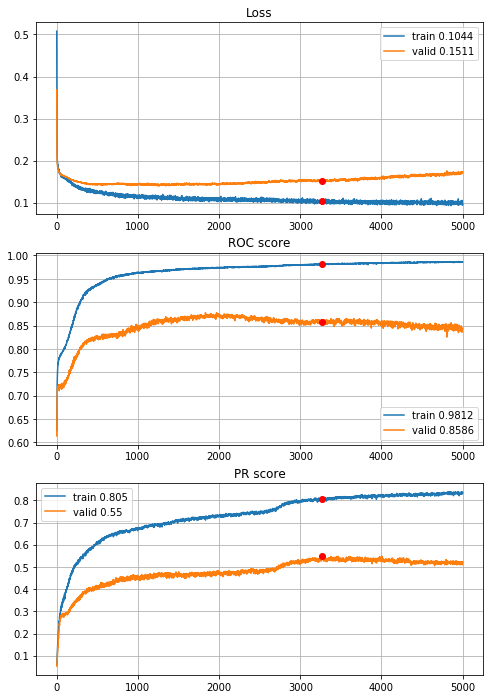


Fold 2------------------------------------------------------------


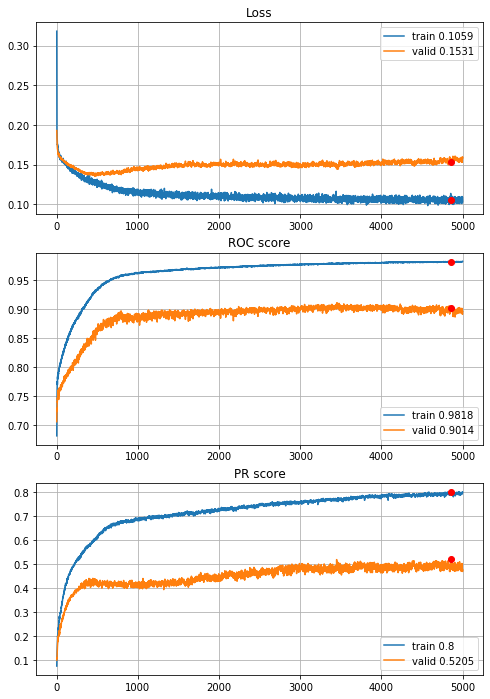


Fold 3------------------------------------------------------------


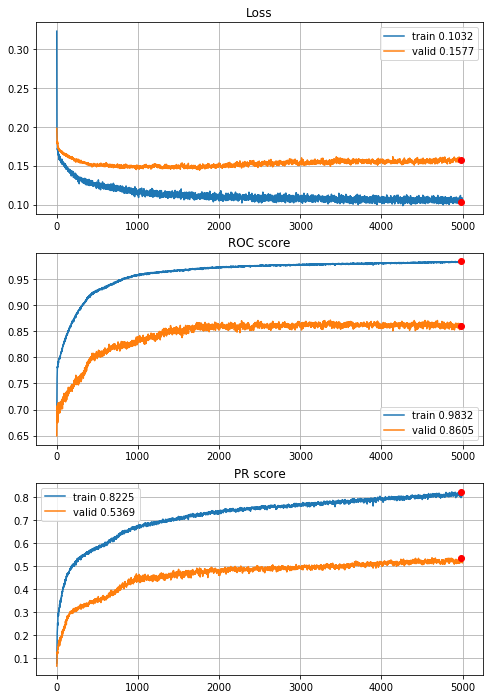


Fold 4------------------------------------------------------------


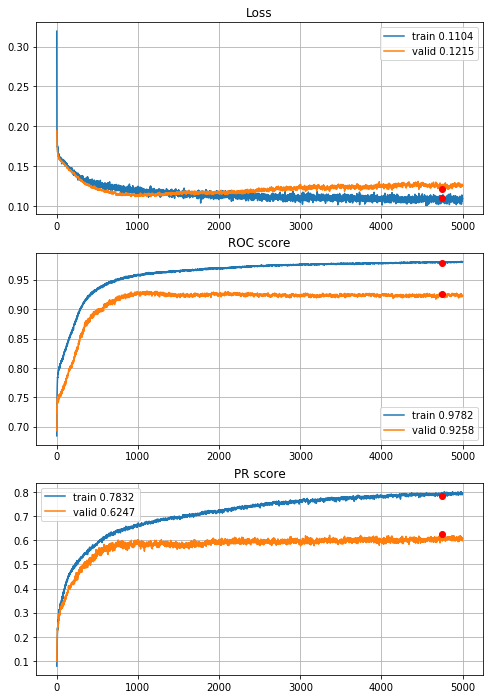


Fold 5------------------------------------------------------------


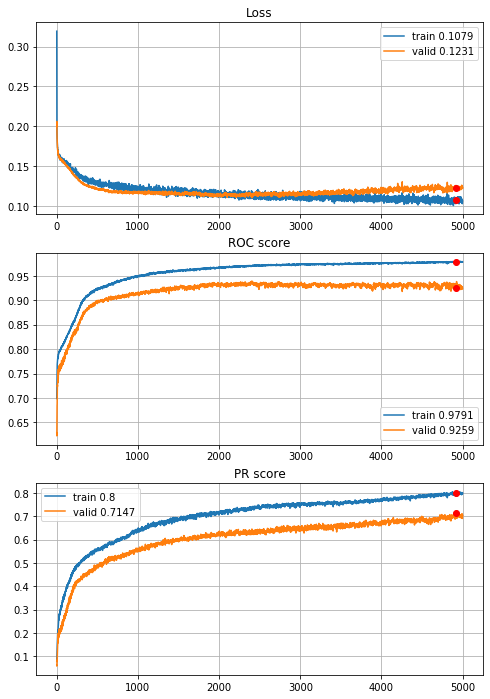


Fold 6------------------------------------------------------------


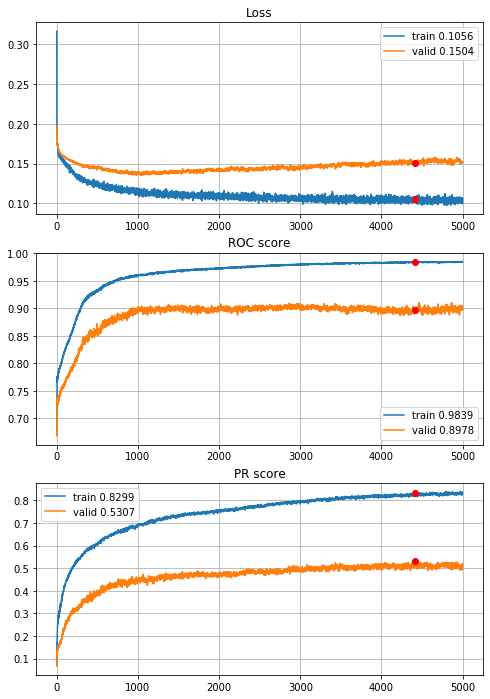

In [69]:
# best model for 1 and 2 year horizons, 5000 epochs
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=5000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l1(l=0.00005),regularizers.l1(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\2year\MLP_L1_5000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

Much better model (comparable metrics, much lower overfitting). The last try will be about L2 regu.


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/5000,
cumulative time: 9.84s train loss: 0.4738932553156751, validation loss: 0.3350186212815901
Epoch: 2/5000,
cumulative time: 10.0s train loss: 0.3102817880379168, validation loss: 0.24065449703020944
Epoch: 3/5000,
cumulative time: 10.16s train loss: 0.24181993635192364, validation loss: 0.1985048701886581
Epoch: 4/5000,
cumulative time: 10.3s train loss: 0.20733300002987878, validation loss: 0.17935397816751136
Epoch: 5/5000,
cumulative time: 10.45s train loss: 0.1918646491461429, validation loss: 0.17000166894099034
Epoch: 6/5000,
cumulative time: 10.61s train loss: 0.18178206040375136, validation loss: 0.16514662204024677
Epoch: 7/5000,
cumulative time: 10.75s train loss: 0.1769285962788364, validation loss: 0.16283480291832164
Epoch: 8/5000,
cumulative time: 10.9s train loss: 0.1714747458001017, validation loss: 0.16142968058117407
Epoch: 9/5000,
cumulative time: 11.04s train loss: 0.1700432

Epoch: 76/5000,
cumulative time: 21.35s train loss: 0.14292726626084756, validation loss: 0.1491478398481328
Epoch: 77/5000,
cumulative time: 21.5s train loss: 0.1439519029861197, validation loss: 0.1495291048057895
Epoch: 78/5000,
cumulative time: 21.66s train loss: 0.1430087558664396, validation loss: 0.14948754677570975
Epoch: 79/5000,
cumulative time: 21.82s train loss: 0.14391770859285927, validation loss: 0.14968663587834233
Epoch: 80/5000,
cumulative time: 21.99s train loss: 0.14047204588926515, validation loss: 0.14966663021013277
Epoch: 81/5000,
cumulative time: 22.14s train loss: 0.14261853423808002, validation loss: 0.1493301151581548
Epoch: 82/5000,
cumulative time: 22.28s train loss: 0.14160910121308412, validation loss: 0.14928939201299046
Epoch: 83/5000,
cumulative time: 22.42s train loss: 0.14362751020428424, validation loss: 0.149188272342535
Epoch: 84/5000,
cumulative time: 22.58s train loss: 0.14462675006740575, validation loss: 0.14868150628019286
Epoch: 85/5000,
cu

Epoch: 152/5000,
cumulative time: 33.18s train loss: 0.13176413072032156, validation loss: 0.14553834925629053
Epoch: 153/5000,
cumulative time: 33.35s train loss: 0.1309996629909007, validation loss: 0.14449431191578135
Epoch: 154/5000,
cumulative time: 33.5s train loss: 0.13065906058079388, validation loss: 0.1451650697977171
Epoch: 155/5000,
cumulative time: 33.65s train loss: 0.12970377311846862, validation loss: 0.14463049757293137
Epoch: 156/5000,
cumulative time: 33.83s train loss: 0.12920089506627552, validation loss: 0.14478438351483988
Epoch: 157/5000,
cumulative time: 33.97s train loss: 0.1278544078629988, validation loss: 0.14602775795587863
Epoch: 158/5000,
cumulative time: 34.14s train loss: 0.13015364179418695, validation loss: 0.14462038599257387
Epoch: 159/5000,
cumulative time: 34.32s train loss: 0.13316787548459894, validation loss: 0.14411302828773134
Epoch: 160/5000,
cumulative time: 34.47s train loss: 0.12952562492560052, validation loss: 0.14454342110441365
Epoch

Epoch: 228/5000,
cumulative time: 44.99s train loss: 0.12375787967079385, validation loss: 0.14300366906085457
Epoch: 229/5000,
cumulative time: 45.15s train loss: 0.12537492068477346, validation loss: 0.14191888039382383
Epoch: 230/5000,
cumulative time: 45.31s train loss: 0.1197460601754513, validation loss: 0.14159635548158836
Epoch: 231/5000,
cumulative time: 45.44s train loss: 0.11914651402914285, validation loss: 0.1428632175898958
Epoch: 232/5000,
cumulative time: 45.6s train loss: 0.12302968640313547, validation loss: 0.14316370184893376
Epoch: 233/5000,
cumulative time: 45.76s train loss: 0.12275510728320158, validation loss: 0.14319032506814633
Epoch: 234/5000,
cumulative time: 45.92s train loss: 0.11892515444157085, validation loss: 0.14369756444253584
Epoch: 235/5000,
cumulative time: 46.08s train loss: 0.12381456760809983, validation loss: 0.14266549246104954
Epoch: 236/5000,
cumulative time: 46.25s train loss: 0.12139559593913533, validation loss: 0.14349434067779568
Epoc

Epoch: 304/5000,
cumulative time: 56.63s train loss: 0.11762309998277756, validation loss: 0.142106674640863
Epoch: 305/5000,
cumulative time: 56.78s train loss: 0.1191132158599623, validation loss: 0.14209100304276415
Epoch: 306/5000,
cumulative time: 56.93s train loss: 0.11520380402262924, validation loss: 0.14177662909499628
Epoch: 307/5000,
cumulative time: 57.08s train loss: 0.11913621986595171, validation loss: 0.1407774134904029
Epoch: 308/5000,
cumulative time: 57.25s train loss: 0.11500327499955208, validation loss: 0.14133473859701995
Epoch: 309/5000,
cumulative time: 57.4s train loss: 0.1171819876905334, validation loss: 0.14156451477604487
Epoch: 310/5000,
cumulative time: 57.55s train loss: 0.11642290454913067, validation loss: 0.14140478894602737
Epoch: 311/5000,
cumulative time: 57.7s train loss: 0.11602752858587073, validation loss: 0.14171429275294586
Epoch: 312/5000,
cumulative time: 57.85s train loss: 0.11398368179876256, validation loss: 0.14177212758700158
Epoch: 3

Epoch: 380/5000,
cumulative time: 68.07s train loss: 0.11086313325903459, validation loss: 0.1405230614687481
Epoch: 381/5000,
cumulative time: 68.21s train loss: 0.11150739038149954, validation loss: 0.1391443154075199
Epoch: 382/5000,
cumulative time: 68.37s train loss: 0.10929599506391081, validation loss: 0.14082708460709684
Epoch: 383/5000,
cumulative time: 68.53s train loss: 0.10946292062760618, validation loss: 0.13961181712494297
Epoch: 384/5000,
cumulative time: 68.67s train loss: 0.11160959409536893, validation loss: 0.13907071844544042
Epoch: 385/5000,
cumulative time: 68.82s train loss: 0.11440578124550976, validation loss: 0.13904888038358712
Epoch: 386/5000,
cumulative time: 68.97s train loss: 0.11280467563077684, validation loss: 0.13921883761843723
Epoch: 387/5000,
cumulative time: 69.12s train loss: 0.10954250646287546, validation loss: 0.1388075932040127
Epoch: 388/5000,
cumulative time: 69.27s train loss: 0.11404014813281212, validation loss: 0.13880646426040255
Epoc

Epoch: 456/5000,
cumulative time: 79.5s train loss: 0.11133360847789754, validation loss: 0.13716199812461008
Epoch: 457/5000,
cumulative time: 79.65s train loss: 0.10600749684991148, validation loss: 0.13738611230179962
Epoch: 458/5000,
cumulative time: 79.8s train loss: 0.10484597502943573, validation loss: 0.13763464946265613
Epoch: 459/5000,
cumulative time: 79.94s train loss: 0.11087944740638271, validation loss: 0.13751209436441
Epoch: 460/5000,
cumulative time: 80.1s train loss: 0.10761371012232629, validation loss: 0.13773397945092203
Epoch: 461/5000,
cumulative time: 80.26s train loss: 0.10951614766230916, validation loss: 0.13756152545132455
Epoch: 462/5000,
cumulative time: 80.4s train loss: 0.10843555193976973, validation loss: 0.13939261684489593
Epoch: 463/5000,
cumulative time: 80.57s train loss: 0.10758787879434915, validation loss: 0.1385172871704339
Epoch: 464/5000,
cumulative time: 80.7s train loss: 0.10327885062311092, validation loss: 0.13915649697008795
Epoch: 465

Epoch: 532/5000,
cumulative time: 90.89s train loss: 0.1061008048078651, validation loss: 0.13945791093073542
Epoch: 533/5000,
cumulative time: 91.04s train loss: 0.10753624936472246, validation loss: 0.14033758197941598
Epoch: 534/5000,
cumulative time: 91.19s train loss: 0.10550389916528989, validation loss: 0.13958048640822365
Epoch: 535/5000,
cumulative time: 91.34s train loss: 0.10511855293943773, validation loss: 0.13871446016536315
Epoch: 536/5000,
cumulative time: 91.49s train loss: 0.10728913317471724, validation loss: 0.13923495507958988
Epoch: 537/5000,
cumulative time: 91.64s train loss: 0.1062314008024561, validation loss: 0.14012641172616855
Epoch: 538/5000,
cumulative time: 91.79s train loss: 0.1041938552064295, validation loss: 0.13972047960500417
Epoch: 539/5000,
cumulative time: 91.95s train loss: 0.1034127319946266, validation loss: 0.14025879223607626
Epoch: 540/5000,
cumulative time: 92.09s train loss: 0.10304245178907942, validation loss: 0.13957108157841905
Epoch

Epoch: 607/5000,
cumulative time: 102.26s train loss: 0.10472308232577542, validation loss: 0.13833417291331884
Epoch: 608/5000,
cumulative time: 102.43s train loss: 0.09862692392009913, validation loss: 0.13874151084088718
Epoch: 609/5000,
cumulative time: 102.58s train loss: 0.09990876377300785, validation loss: 0.13814128925572217
Epoch: 610/5000,
cumulative time: 102.74s train loss: 0.1040198485539006, validation loss: 0.13815912687333196
Epoch: 611/5000,
cumulative time: 102.9s train loss: 0.10270219092397831, validation loss: 0.13876127684061682
Epoch: 612/5000,
cumulative time: 103.06s train loss: 0.10286502516965813, validation loss: 0.136946795330057
Epoch: 613/5000,
cumulative time: 103.21s train loss: 0.10652628277111903, validation loss: 0.13858789780700817
Epoch: 614/5000,
cumulative time: 103.36s train loss: 0.10000017394483487, validation loss: 0.13704645714745764
Epoch: 615/5000,
cumulative time: 103.51s train loss: 0.10297362989031764, validation loss: 0.13782412495322

Epoch: 682/5000,
cumulative time: 113.75s train loss: 0.10016932086314703, validation loss: 0.13897166844472036
Epoch: 683/5000,
cumulative time: 113.89s train loss: 0.10308078785403355, validation loss: 0.13884634555831338
Epoch: 684/5000,
cumulative time: 114.05s train loss: 0.09996762234502264, validation loss: 0.13922421090295087
Epoch: 685/5000,
cumulative time: 114.2s train loss: 0.09930842250550398, validation loss: 0.14022291639177703
Epoch: 686/5000,
cumulative time: 114.35s train loss: 0.09795148808375803, validation loss: 0.13893807901076846
Epoch: 687/5000,
cumulative time: 114.5s train loss: 0.09849694944495282, validation loss: 0.13896708443350747
Epoch: 688/5000,
cumulative time: 114.66s train loss: 0.10364410030973084, validation loss: 0.13866487520394133
Epoch: 689/5000,
cumulative time: 114.81s train loss: 0.09830668574373162, validation loss: 0.13831722342835184
Epoch: 690/5000,
cumulative time: 114.98s train loss: 0.09804800565397619, validation loss: 0.139545774690

Epoch: 756/5000,
cumulative time: 125.01s train loss: 0.09896450613008007, validation loss: 0.1410061691840073
Epoch: 757/5000,
cumulative time: 125.18s train loss: 0.09759608572667572, validation loss: 0.14047409161476132
Epoch: 758/5000,
cumulative time: 125.32s train loss: 0.09481735316567003, validation loss: 0.14112368923261626
Epoch: 759/5000,
cumulative time: 125.45s train loss: 0.0954368064854612, validation loss: 0.14024539035043115
Epoch: 760/5000,
cumulative time: 125.6s train loss: 0.09848405611805686, validation loss: 0.14095195174842173
Epoch: 761/5000,
cumulative time: 125.75s train loss: 0.10137132432876744, validation loss: 0.14132490889858917
Epoch: 762/5000,
cumulative time: 125.92s train loss: 0.09589832945183449, validation loss: 0.14181550815799132
Epoch: 763/5000,
cumulative time: 126.05s train loss: 0.09794993145248027, validation loss: 0.14134014335364534
Epoch: 764/5000,
cumulative time: 126.22s train loss: 0.10002466225707292, validation loss: 0.1410451513833

Epoch: 830/5000,
cumulative time: 136.19s train loss: 0.09638656047999913, validation loss: 0.13934361878025736
Epoch: 831/5000,
cumulative time: 136.36s train loss: 0.09799173655571201, validation loss: 0.1400016063377554
Epoch: 832/5000,
cumulative time: 136.5s train loss: 0.09692951503138598, validation loss: 0.13995457496274347
Epoch: 833/5000,
cumulative time: 136.65s train loss: 0.0974439753177735, validation loss: 0.14094089462786796
Epoch: 834/5000,
cumulative time: 136.82s train loss: 0.10038021441047572, validation loss: 0.14194536503028432
Epoch: 835/5000,
cumulative time: 136.97s train loss: 0.09209823472551569, validation loss: 0.14040619012842329
Epoch: 836/5000,
cumulative time: 137.12s train loss: 0.09571264564467533, validation loss: 0.14087828325881557
Epoch: 837/5000,
cumulative time: 137.27s train loss: 0.09719731915155702, validation loss: 0.14231153928124263
Epoch: 838/5000,
cumulative time: 137.44s train loss: 0.09942356879588644, validation loss: 0.1413740902885

Epoch: 904/5000,
cumulative time: 147.49s train loss: 0.09696162661674498, validation loss: 0.1416637401632369
Epoch: 905/5000,
cumulative time: 147.64s train loss: 0.09554004308037965, validation loss: 0.1412344046161653
Epoch: 906/5000,
cumulative time: 147.77s train loss: 0.09232095681811585, validation loss: 0.14168111655768373
Epoch: 907/5000,
cumulative time: 147.94s train loss: 0.09608620624446762, validation loss: 0.14290088207154567
Epoch: 908/5000,
cumulative time: 148.09s train loss: 0.10068746890371226, validation loss: 0.1427273749523988
Epoch: 909/5000,
cumulative time: 148.25s train loss: 0.09979772124659704, validation loss: 0.1412072733903931
Epoch: 910/5000,
cumulative time: 148.41s train loss: 0.09604688347468043, validation loss: 0.14147324356229715
Epoch: 911/5000,
cumulative time: 148.57s train loss: 0.09699610776799833, validation loss: 0.14176201582111195
Epoch: 912/5000,
cumulative time: 148.74s train loss: 0.09697600634570108, validation loss: 0.14089475557461

Epoch: 978/5000,
cumulative time: 158.89s train loss: 0.09258750114071837, validation loss: 0.1423023903198042
Epoch: 979/5000,
cumulative time: 159.04s train loss: 0.09517711618086788, validation loss: 0.1428561744867271
Epoch: 980/5000,
cumulative time: 159.21s train loss: 0.09561143161333206, validation loss: 0.14316746666734528
Epoch: 981/5000,
cumulative time: 159.37s train loss: 0.09868886024795051, validation loss: 0.14252058068976334
Epoch: 982/5000,
cumulative time: 159.54s train loss: 0.09563424385501042, validation loss: 0.14104287245287653
Epoch: 983/5000,
cumulative time: 159.69s train loss: 0.09442945716929227, validation loss: 0.14197607427288633
Epoch: 984/5000,
cumulative time: 159.83s train loss: 0.09590188542478346, validation loss: 0.143290473507085
Epoch: 985/5000,
cumulative time: 159.99s train loss: 0.09268243337309615, validation loss: 0.14375329972641496
Epoch: 986/5000,
cumulative time: 160.14s train loss: 0.09401968730544494, validation loss: 0.14180930153140

Epoch: 1053/5000,
cumulative time: 170.39s train loss: 0.1006721727201379, validation loss: 0.14219540607569883
Epoch: 1054/5000,
cumulative time: 170.53s train loss: 0.09211188955809924, validation loss: 0.14112467159606212
Epoch: 1055/5000,
cumulative time: 170.69s train loss: 0.09387715725329025, validation loss: 0.14160144608345757
Epoch: 1056/5000,
cumulative time: 170.83s train loss: 0.10060350925828014, validation loss: 0.1420611462520428
Epoch: 1057/5000,
cumulative time: 170.99s train loss: 0.09904979078446073, validation loss: 0.1415151330016231
Epoch: 1058/5000,
cumulative time: 171.13s train loss: 0.09573951284653207, validation loss: 0.14271938102624987
Epoch: 1059/5000,
cumulative time: 171.28s train loss: 0.09810488100527061, validation loss: 0.14114885661033316
Epoch: 1060/5000,
cumulative time: 171.43s train loss: 0.09237428461974845, validation loss: 0.14254734254055224
Epoch: 1061/5000,
cumulative time: 171.6s train loss: 0.09507713069987181, validation loss: 0.14309

Epoch: 1127/5000,
cumulative time: 181.73s train loss: 0.0924592546416479, validation loss: 0.144385235376783
Epoch: 1128/5000,
cumulative time: 181.88s train loss: 0.09276007994792614, validation loss: 0.14294790962850126
Epoch: 1129/5000,
cumulative time: 182.04s train loss: 0.09422426899903129, validation loss: 0.14443530644220576
Epoch: 1130/5000,
cumulative time: 182.18s train loss: 0.09687279571257439, validation loss: 0.14458822536124782
Epoch: 1131/5000,
cumulative time: 182.35s train loss: 0.09349577576566577, validation loss: 0.1440286169006815
Epoch: 1132/5000,
cumulative time: 182.5s train loss: 0.09409191952899894, validation loss: 0.14351034568693505
Epoch: 1133/5000,
cumulative time: 182.65s train loss: 0.09481185431686043, validation loss: 0.1434298077815482
Epoch: 1134/5000,
cumulative time: 182.8s train loss: 0.09243558890515002, validation loss: 0.1438284260300165
Epoch: 1135/5000,
cumulative time: 182.96s train loss: 0.09425249958975097, validation loss: 0.146059543

Epoch: 1200/5000,
cumulative time: 192.92s train loss: 0.093749415380901, validation loss: 0.1424990305445141
Epoch: 1201/5000,
cumulative time: 193.06s train loss: 0.09696088846822228, validation loss: 0.1438714661104495
Epoch: 1202/5000,
cumulative time: 193.2s train loss: 0.0976811263742977, validation loss: 0.142318561956345
Epoch: 1203/5000,
cumulative time: 193.36s train loss: 0.09470686855092245, validation loss: 0.14025138156442155
Epoch: 1204/5000,
cumulative time: 193.51s train loss: 0.09139202016961576, validation loss: 0.14099507147097182
Epoch: 1205/5000,
cumulative time: 193.66s train loss: 0.09719075403667118, validation loss: 0.14087175578855438
Epoch: 1206/5000,
cumulative time: 193.81s train loss: 0.0925698900913439, validation loss: 0.14142332510195116
Epoch: 1207/5000,
cumulative time: 193.96s train loss: 0.09555478918375046, validation loss: 0.14113111633851363
Epoch: 1208/5000,
cumulative time: 194.11s train loss: 0.0921553177828635, validation loss: 0.14090612647

Epoch: 1274/5000,
cumulative time: 204.11s train loss: 0.09621145489417736, validation loss: 0.14268869056145456
Epoch: 1275/5000,
cumulative time: 204.27s train loss: 0.08918266180990127, validation loss: 0.1428372065096039
Epoch: 1276/5000,
cumulative time: 204.43s train loss: 0.09206767988960464, validation loss: 0.14254443342571646
Epoch: 1277/5000,
cumulative time: 204.58s train loss: 0.0927321651333015, validation loss: 0.14193412324665103
Epoch: 1278/5000,
cumulative time: 204.74s train loss: 0.09135300643534065, validation loss: 0.14150656862269848
Epoch: 1279/5000,
cumulative time: 204.89s train loss: 0.09647680953514187, validation loss: 0.14232871062360303
Epoch: 1280/5000,
cumulative time: 205.04s train loss: 0.09381708679487594, validation loss: 0.14454174086666358
Epoch: 1281/5000,
cumulative time: 205.19s train loss: 0.09788519295335582, validation loss: 0.14402356774083597
Epoch: 1282/5000,
cumulative time: 205.35s train loss: 0.0959492326544534, validation loss: 0.1432

Epoch: 1348/5000,
cumulative time: 215.24s train loss: 0.08980229205143907, validation loss: 0.14322429734280975
Epoch: 1349/5000,
cumulative time: 215.4s train loss: 0.09420028779211824, validation loss: 0.14270385050093987
Epoch: 1350/5000,
cumulative time: 215.55s train loss: 0.09406070729971776, validation loss: 0.1436427766615879
Epoch: 1351/5000,
cumulative time: 215.7s train loss: 0.0928274909456024, validation loss: 0.1446832884713363
Epoch: 1352/5000,
cumulative time: 215.85s train loss: 0.091612674082024, validation loss: 0.1445394454238299
Epoch: 1353/5000,
cumulative time: 216.0s train loss: 0.09079206076365559, validation loss: 0.14408090349340502
Epoch: 1354/5000,
cumulative time: 216.16s train loss: 0.09472725307184367, validation loss: 0.14400945713213825
Epoch: 1355/5000,
cumulative time: 216.3s train loss: 0.09416758842343412, validation loss: 0.14610272016117487
Epoch: 1356/5000,
cumulative time: 216.45s train loss: 0.09495466478195333, validation loss: 0.14489566483

Epoch: 1422/5000,
cumulative time: 226.45s train loss: 0.09157505021161373, validation loss: 0.14375031224865745
Epoch: 1423/5000,
cumulative time: 226.6s train loss: 0.0969410582699115, validation loss: 0.14397015452853662
Epoch: 1424/5000,
cumulative time: 226.75s train loss: 0.09301030177118613, validation loss: 0.1442712133318225
Epoch: 1425/5000,
cumulative time: 226.91s train loss: 0.09179567070823148, validation loss: 0.14494864443417146
Epoch: 1426/5000,
cumulative time: 227.06s train loss: 0.09080774199448527, validation loss: 0.14644948081607745
Epoch: 1427/5000,
cumulative time: 227.22s train loss: 0.0943157655146788, validation loss: 0.1455714051485999
Epoch: 1428/5000,
cumulative time: 227.37s train loss: 0.08958331222950763, validation loss: 0.14719334968303477
Epoch: 1429/5000,
cumulative time: 227.52s train loss: 0.09557202120082908, validation loss: 0.14667475994964416
Epoch: 1430/5000,
cumulative time: 227.68s train loss: 0.09074707235323053, validation loss: 0.145194

Epoch: 1495/5000,
cumulative time: 237.57s train loss: 0.08750278753496932, validation loss: 0.14506494406205486
Epoch: 1496/5000,
cumulative time: 237.71s train loss: 0.09063056234681977, validation loss: 0.1456862318953243
Epoch: 1497/5000,
cumulative time: 237.87s train loss: 0.09044130921934172, validation loss: 0.1457969902246839
Epoch: 1498/5000,
cumulative time: 238.02s train loss: 0.08580804743416688, validation loss: 0.14638634570929202
Epoch: 1499/5000,
cumulative time: 238.18s train loss: 0.09058357239636763, validation loss: 0.14613761005832826
Epoch: 1500/5000,
cumulative time: 238.35s train loss: 0.0942930336370195, validation loss: 0.14608912323241466
Epoch: 1501/5000,
cumulative time: 238.5s train loss: 0.08808168839784855, validation loss: 0.1461858166818694
Epoch: 1502/5000,
cumulative time: 238.67s train loss: 0.09102655246586236, validation loss: 0.14567873387708577
Epoch: 1503/5000,
cumulative time: 238.83s train loss: 0.09060541218980954, validation loss: 0.146664

Epoch: 1568/5000,
cumulative time: 248.79s train loss: 0.08928519540704051, validation loss: 0.14601470519291776
Epoch: 1569/5000,
cumulative time: 248.94s train loss: 0.09108538506485435, validation loss: 0.14637595630918543
Epoch: 1570/5000,
cumulative time: 249.08s train loss: 0.08976028168368642, validation loss: 0.14477354014685395
Epoch: 1571/5000,
cumulative time: 249.26s train loss: 0.09169313077678029, validation loss: 0.1451598197163167
Epoch: 1572/5000,
cumulative time: 249.42s train loss: 0.09073815710314262, validation loss: 0.14342706401491853
Epoch: 1573/5000,
cumulative time: 249.57s train loss: 0.09078970251377608, validation loss: 0.14409016625440604
Epoch: 1574/5000,
cumulative time: 249.71s train loss: 0.09227091894637775, validation loss: 0.14661575832341944
Epoch: 1575/5000,
cumulative time: 249.87s train loss: 0.09038514537310238, validation loss: 0.14671339307512557
Epoch: 1576/5000,
cumulative time: 250.02s train loss: 0.09291387653289108, validation loss: 0.14

cumulative time: 260.07s train loss: 0.09180289442748757, validation loss: 0.14589974681601456
Epoch: 1642/5000,
cumulative time: 260.2s train loss: 0.0878410192677962, validation loss: 0.14540330642836746
Epoch: 1643/5000,
cumulative time: 260.35s train loss: 0.08679907738103797, validation loss: 0.14827000969828033
Epoch: 1644/5000,
cumulative time: 260.5s train loss: 0.08951462730950899, validation loss: 0.1465585884854178
Epoch: 1645/5000,
cumulative time: 260.67s train loss: 0.09412246468276868, validation loss: 0.14536454643795405
Epoch: 1646/5000,
cumulative time: 260.83s train loss: 0.09324841387936134, validation loss: 0.1434205194561697
Epoch: 1647/5000,
cumulative time: 260.97s train loss: 0.09213973402680099, validation loss: 0.14786230878194068
Epoch: 1648/5000,
cumulative time: 261.12s train loss: 0.09387728841534634, validation loss: 0.14841274835100962
Epoch: 1649/5000,
cumulative time: 261.29s train loss: 0.09057760313749001, validation loss: 0.15005928367805982
Epoch:

Epoch: 1715/5000,
cumulative time: 271.47s train loss: 0.0885577293498392, validation loss: 0.14849677033536868
Epoch: 1716/5000,
cumulative time: 271.62s train loss: 0.08831151205299723, validation loss: 0.14784689237843335
Epoch: 1717/5000,
cumulative time: 271.77s train loss: 0.08798557877743723, validation loss: 0.1482843041791047
Epoch: 1718/5000,
cumulative time: 271.92s train loss: 0.09085908934507196, validation loss: 0.14758744042947752
Epoch: 1719/5000,
cumulative time: 272.08s train loss: 0.09173569117395261, validation loss: 0.14774512089447145
Epoch: 1720/5000,
cumulative time: 272.24s train loss: 0.09201342951487332, validation loss: 0.14649683825896265
Epoch: 1721/5000,
cumulative time: 272.38s train loss: 0.08995812401216517, validation loss: 0.1447423652771416
Epoch: 1722/5000,
cumulative time: 272.54s train loss: 0.08846667928305971, validation loss: 0.14511389316573525
Epoch: 1723/5000,
cumulative time: 272.7s train loss: 0.08656841315214811, validation loss: 0.14795

Epoch: 1789/5000,
cumulative time: 282.84s train loss: 0.08689712050866137, validation loss: 0.14715228135042077
Epoch: 1790/5000,
cumulative time: 282.98s train loss: 0.0926020723390484, validation loss: 0.14688285357205302
Epoch: 1791/5000,
cumulative time: 283.12s train loss: 0.09121456489636898, validation loss: 0.14684406217788182
Epoch: 1792/5000,
cumulative time: 283.27s train loss: 0.08599234365687597, validation loss: 0.14597119029665057
Epoch: 1793/5000,
cumulative time: 283.41s train loss: 0.09852004952133991, validation loss: 0.14585104266359797
Epoch: 1794/5000,
cumulative time: 283.58s train loss: 0.091864449159434, validation loss: 0.147327847788562
Epoch: 1795/5000,
cumulative time: 283.72s train loss: 0.08658112555953212, validation loss: 0.14955035293399116
Epoch: 1796/5000,
cumulative time: 283.88s train loss: 0.09130684258913147, validation loss: 0.14507415410263041
Epoch: 1797/5000,
cumulative time: 284.02s train loss: 0.08714398784888401, validation loss: 0.147159

Epoch: 1863/5000,
cumulative time: 294.12s train loss: 0.08962466421360456, validation loss: 0.14871153383861208
Epoch: 1864/5000,
cumulative time: 294.27s train loss: 0.09098119844571059, validation loss: 0.14645786945699552
Epoch: 1865/5000,
cumulative time: 294.42s train loss: 0.0926942748946246, validation loss: 0.1459053263341615
Epoch: 1866/5000,
cumulative time: 294.57s train loss: 0.08981310518482656, validation loss: 0.1461117700093852
Epoch: 1867/5000,
cumulative time: 294.73s train loss: 0.08300807109491543, validation loss: 0.14596354639155212
Epoch: 1868/5000,
cumulative time: 294.87s train loss: 0.09155194626881577, validation loss: 0.14658987791635106
Epoch: 1869/5000,
cumulative time: 295.03s train loss: 0.08966972696478799, validation loss: 0.14548410347334523
Epoch: 1870/5000,
cumulative time: 295.17s train loss: 0.08800211495189184, validation loss: 0.14513826461052362
Epoch: 1871/5000,
cumulative time: 295.33s train loss: 0.09539266339951127, validation loss: 0.1448

Epoch: 1937/5000,
cumulative time: 305.3s train loss: 0.0886218189550565, validation loss: 0.14560993004048323
Epoch: 1938/5000,
cumulative time: 305.45s train loss: 0.08855172051371964, validation loss: 0.14737347508554846
Epoch: 1939/5000,
cumulative time: 305.6s train loss: 0.08776320742758406, validation loss: 0.14726870931772854
Epoch: 1940/5000,
cumulative time: 305.77s train loss: 0.08352972239623112, validation loss: 0.1487575546395263
Epoch: 1941/5000,
cumulative time: 305.9s train loss: 0.0911570422957837, validation loss: 0.14823498530984705
Epoch: 1942/5000,
cumulative time: 306.05s train loss: 0.0897774715980019, validation loss: 0.14835050073238687
Epoch: 1943/5000,
cumulative time: 306.2s train loss: 0.08463444618386387, validation loss: 0.1479839731793885
Epoch: 1944/5000,
cumulative time: 306.35s train loss: 0.08889695384787114, validation loss: 0.14922399736872508
Epoch: 1945/5000,
cumulative time: 306.52s train loss: 0.09229958395311663, validation loss: 0.1489288709

Epoch: 2010/5000,
cumulative time: 316.64s train loss: 0.08837472449078412, validation loss: 0.1460621007382479
Epoch: 2011/5000,
cumulative time: 316.78s train loss: 0.08991298513106835, validation loss: 0.1470789279334667
Epoch: 2012/5000,
cumulative time: 316.94s train loss: 0.08613352549038579, validation loss: 0.14814062008382764
Epoch: 2013/5000,
cumulative time: 317.13s train loss: 0.086537152768033, validation loss: 0.1493760006768363
Epoch: 2014/5000,
cumulative time: 317.26s train loss: 0.09092374349901444, validation loss: 0.14776718100901512
Epoch: 2015/5000,
cumulative time: 317.43s train loss: 0.08939483665005066, validation loss: 0.14765393794520343
Epoch: 2016/5000,
cumulative time: 317.57s train loss: 0.08924688304399565, validation loss: 0.1466329785388544
Epoch: 2017/5000,
cumulative time: 317.73s train loss: 0.09076745476076122, validation loss: 0.14547647865852867
Epoch: 2018/5000,
cumulative time: 317.88s train loss: 0.08998554177569568, validation loss: 0.1483514

Epoch: 2083/5000,
cumulative time: 327.96s train loss: 0.08773203074994601, validation loss: 0.14834500595360878
Epoch: 2084/5000,
cumulative time: 328.13s train loss: 0.09018700493301629, validation loss: 0.14759194360726158
Epoch: 2085/5000,
cumulative time: 328.29s train loss: 0.08966858779650431, validation loss: 0.1485926612410914
Epoch: 2086/5000,
cumulative time: 328.42s train loss: 0.08632303608723277, validation loss: 0.14840459411531726
Epoch: 2087/5000,
cumulative time: 328.58s train loss: 0.09074481240921586, validation loss: 0.14808777537133402
Epoch: 2088/5000,
cumulative time: 328.74s train loss: 0.08806726637666637, validation loss: 0.1477137647989068
Epoch: 2089/5000,
cumulative time: 328.88s train loss: 0.08816115293289985, validation loss: 0.14689327450286047
Epoch: 2090/5000,
cumulative time: 329.04s train loss: 0.08323890628723599, validation loss: 0.14864314239115733
Epoch: 2091/5000,
cumulative time: 329.18s train loss: 0.0867825802877059, validation loss: 0.1491

Epoch: 2157/5000,
cumulative time: 339.12s train loss: 0.08423514459182058, validation loss: 0.14938112105173335
Epoch: 2158/5000,
cumulative time: 339.3s train loss: 0.08928492559914289, validation loss: 0.1485040944611573
Epoch: 2159/5000,
cumulative time: 339.46s train loss: 0.08651744651851467, validation loss: 0.15037572547930098
Epoch: 2160/5000,
cumulative time: 339.62s train loss: 0.08734179767861187, validation loss: 0.15072856863001227
Epoch: 2161/5000,
cumulative time: 339.78s train loss: 0.08757121197763097, validation loss: 0.15101564571085638
Epoch: 2162/5000,
cumulative time: 339.93s train loss: 0.08857613123405463, validation loss: 0.15004082733025556
Epoch: 2163/5000,
cumulative time: 340.09s train loss: 0.08731882904652202, validation loss: 0.14817135297689651
Epoch: 2164/5000,
cumulative time: 340.23s train loss: 0.08534329066775483, validation loss: 0.14992123021991974
Epoch: 2165/5000,
cumulative time: 340.43s train loss: 0.08724166622522353, validation loss: 0.148

Epoch: 2230/5000,
cumulative time: 350.34s train loss: 0.08247061172613296, validation loss: 0.14696536949429256
Epoch: 2231/5000,
cumulative time: 350.49s train loss: 0.08586268475029443, validation loss: 0.1481101557631949
Epoch: 2232/5000,
cumulative time: 350.64s train loss: 0.08890793829773494, validation loss: 0.14746729200547207
Epoch: 2233/5000,
cumulative time: 350.79s train loss: 0.08529890925600404, validation loss: 0.14645540317811004
Epoch: 2234/5000,
cumulative time: 350.94s train loss: 0.09020400507384632, validation loss: 0.1472180968694887
Epoch: 2235/5000,
cumulative time: 351.09s train loss: 0.0864105373630753, validation loss: 0.14836648450297735
Epoch: 2236/5000,
cumulative time: 351.24s train loss: 0.0857673007562739, validation loss: 0.14795778359763745
Epoch: 2237/5000,
cumulative time: 351.41s train loss: 0.08373653393071294, validation loss: 0.14874563279267533
Epoch: 2238/5000,
cumulative time: 351.56s train loss: 0.08569997932768256, validation loss: 0.14826

Epoch: 2304/5000,
cumulative time: 361.85s train loss: 0.08542002056432217, validation loss: 0.14483862846777293
Epoch: 2305/5000,
cumulative time: 362.0s train loss: 0.08535103177802406, validation loss: 0.14833852562804367
Epoch: 2306/5000,
cumulative time: 362.16s train loss: 0.0885401431806576, validation loss: 0.14772388671047565
Epoch: 2307/5000,
cumulative time: 362.31s train loss: 0.08424889524039411, validation loss: 0.14685080354718363
Epoch: 2308/5000,
cumulative time: 362.48s train loss: 0.09158309439126622, validation loss: 0.14554777430909957
Epoch: 2309/5000,
cumulative time: 362.62s train loss: 0.08744078758371066, validation loss: 0.14765980840705795
Epoch: 2310/5000,
cumulative time: 362.79s train loss: 0.08897344627903367, validation loss: 0.14442158120331572
Epoch: 2311/5000,
cumulative time: 362.97s train loss: 0.09010521574259617, validation loss: 0.14672052943261235
Epoch: 2312/5000,
cumulative time: 363.12s train loss: 0.08765487115440027, validation loss: 0.146

Epoch: 2377/5000,
cumulative time: 373.1s train loss: 0.08910157451319935, validation loss: 0.14808198106554513
Epoch: 2378/5000,
cumulative time: 373.24s train loss: 0.0869014309708218, validation loss: 0.1481551073130274
Epoch: 2379/5000,
cumulative time: 373.39s train loss: 0.09003506663945982, validation loss: 0.14680616819296097
Epoch: 2380/5000,
cumulative time: 373.54s train loss: 0.08276270867870682, validation loss: 0.14766374602425614
Epoch: 2381/5000,
cumulative time: 373.69s train loss: 0.08594398867196798, validation loss: 0.14780739437041715
Epoch: 2382/5000,
cumulative time: 373.86s train loss: 0.08734873002928509, validation loss: 0.14888283852512216
Epoch: 2383/5000,
cumulative time: 374.01s train loss: 0.08611451888251608, validation loss: 0.14726670552167168
Epoch: 2384/5000,
cumulative time: 374.16s train loss: 0.09075523387684174, validation loss: 0.14829126996419065
Epoch: 2385/5000,
cumulative time: 374.31s train loss: 0.09161659963121341, validation loss: 0.1479

Epoch: 2450/5000,
cumulative time: 384.18s train loss: 0.08557952285645001, validation loss: 0.15053328980116826
Epoch: 2451/5000,
cumulative time: 384.31s train loss: 0.08671704392700993, validation loss: 0.14976581108913822
Epoch: 2452/5000,
cumulative time: 384.48s train loss: 0.08537346560218446, validation loss: 0.15052364708985133
Epoch: 2453/5000,
cumulative time: 384.63s train loss: 0.08574264632509396, validation loss: 0.14986988095515366
Epoch: 2454/5000,
cumulative time: 384.8s train loss: 0.084979872490885, validation loss: 0.15131358467384215
Epoch: 2455/5000,
cumulative time: 384.95s train loss: 0.08964231615571867, validation loss: 0.14844866559827313
Epoch: 2456/5000,
cumulative time: 385.1s train loss: 0.07891582339408279, validation loss: 0.1483472427780475
Epoch: 2457/5000,
cumulative time: 385.25s train loss: 0.09070734406344964, validation loss: 0.14995486456241708
Epoch: 2458/5000,
cumulative time: 385.4s train loss: 0.08471131223200314, validation loss: 0.1498313

Epoch: 2524/5000,
cumulative time: 395.5s train loss: 0.08743346085033843, validation loss: 0.14914613046230527
Epoch: 2525/5000,
cumulative time: 395.65s train loss: 0.0858776642358511, validation loss: 0.15110255559103206
Epoch: 2526/5000,
cumulative time: 395.8s train loss: 0.08617646145873746, validation loss: 0.15031516411357596
Epoch: 2527/5000,
cumulative time: 395.94s train loss: 0.0856705041452588, validation loss: 0.14899931008272058
Epoch: 2528/5000,
cumulative time: 396.1s train loss: 0.08684462888405822, validation loss: 0.14859276539298216
Epoch: 2529/5000,
cumulative time: 396.25s train loss: 0.08538817051592529, validation loss: 0.1503556129738669
Epoch: 2530/5000,
cumulative time: 396.4s train loss: 0.0872666661527854, validation loss: 0.1528842222643711
Epoch: 2531/5000,
cumulative time: 396.55s train loss: 0.09165477701706348, validation loss: 0.15162343431269046
Epoch: 2532/5000,
cumulative time: 396.7s train loss: 0.08375900373915604, validation loss: 0.15207215417

Epoch: 2598/5000,
cumulative time: 406.65s train loss: 0.08319670408241464, validation loss: 0.1486372768996115
Epoch: 2599/5000,
cumulative time: 406.8s train loss: 0.08452703298575788, validation loss: 0.149836342171479
Epoch: 2600/5000,
cumulative time: 406.95s train loss: 0.08133719819317733, validation loss: 0.15074234904030517
Epoch: 2601/5000,
cumulative time: 407.1s train loss: 0.08631335146435123, validation loss: 0.15070150814081396
Epoch: 2602/5000,
cumulative time: 407.25s train loss: 0.08898861277816743, validation loss: 0.1483748782704417
Epoch: 2603/5000,
cumulative time: 407.4s train loss: 0.08275246155017449, validation loss: 0.15096666651190813
Epoch: 2604/5000,
cumulative time: 407.56s train loss: 0.08297702992867949, validation loss: 0.1516719666135108
Epoch: 2605/5000,
cumulative time: 407.7s train loss: 0.09065364057930382, validation loss: 0.1520614840412515
Epoch: 2606/5000,
cumulative time: 407.85s train loss: 0.08485996234575563, validation loss: 0.15191141434

Epoch: 2672/5000,
cumulative time: 417.87s train loss: 0.08405130529996686, validation loss: 0.15301613228427316
Epoch: 2673/5000,
cumulative time: 418.02s train loss: 0.08814511571491135, validation loss: 0.15313859692094836
Epoch: 2674/5000,
cumulative time: 418.17s train loss: 0.08036839260602156, validation loss: 0.15117294893039787
Epoch: 2675/5000,
cumulative time: 418.34s train loss: 0.08499553717398396, validation loss: 0.15366886288591639
Epoch: 2676/5000,
cumulative time: 418.48s train loss: 0.08630506867372688, validation loss: 0.15482484483859485
Epoch: 2677/5000,
cumulative time: 418.64s train loss: 0.08410085991722273, validation loss: 0.1521636673284702
Epoch: 2678/5000,
cumulative time: 418.78s train loss: 0.08163184950342808, validation loss: 0.1540474788936375
Epoch: 2679/5000,
cumulative time: 418.92s train loss: 0.08803664773179157, validation loss: 0.152300821678276
Epoch: 2680/5000,
cumulative time: 419.09s train loss: 0.08671216762992498, validation loss: 0.15271

Epoch: 2746/5000,
cumulative time: 429.13s train loss: 0.08451251408358923, validation loss: 0.14935326777388822
Epoch: 2747/5000,
cumulative time: 429.3s train loss: 0.0845771382154714, validation loss: 0.14846084717060604
Epoch: 2748/5000,
cumulative time: 429.45s train loss: 0.085772106191296, validation loss: 0.14901451756726086
Epoch: 2749/5000,
cumulative time: 429.59s train loss: 0.08499816611071279, validation loss: 0.14773387472642047
Epoch: 2750/5000,
cumulative time: 429.74s train loss: 0.08607070468027261, validation loss: 0.14796287756837992
Epoch: 2751/5000,
cumulative time: 429.9s train loss: 0.08323881731681483, validation loss: 0.14714172949250373
Epoch: 2752/5000,
cumulative time: 430.06s train loss: 0.08193153068413506, validation loss: 0.14792610250833307
Epoch: 2753/5000,
cumulative time: 430.2s train loss: 0.08516396540815888, validation loss: 0.1498027135804784
Epoch: 2754/5000,
cumulative time: 430.36s train loss: 0.08726098414557855, validation loss: 0.14901006

Epoch: 2820/5000,
cumulative time: 440.43s train loss: 0.08499613798337334, validation loss: 0.15275982885498207
Epoch: 2821/5000,
cumulative time: 440.58s train loss: 0.08730433866731273, validation loss: 0.15231047574611353
Epoch: 2822/5000,
cumulative time: 440.73s train loss: 0.08635122526272485, validation loss: 0.15406653444193608
Epoch: 2823/5000,
cumulative time: 440.88s train loss: 0.08602161198827102, validation loss: 0.15129280602010176
Epoch: 2824/5000,
cumulative time: 441.02s train loss: 0.08724444847261473, validation loss: 0.15089483947772656
Epoch: 2825/5000,
cumulative time: 441.18s train loss: 0.07955471620203892, validation loss: 0.15153835079148117
Epoch: 2826/5000,
cumulative time: 441.33s train loss: 0.07868723318260078, validation loss: 0.15162968016467587
Epoch: 2827/5000,
cumulative time: 441.46s train loss: 0.08293362956912571, validation loss: 0.1527121030917174
Epoch: 2828/5000,
cumulative time: 441.63s train loss: 0.08389774660474508, validation loss: 0.15

Epoch: 2894/5000,
cumulative time: 451.7s train loss: 0.08620472585198638, validation loss: 0.15289500190694555
Epoch: 2895/5000,
cumulative time: 451.85s train loss: 0.08359507249241216, validation loss: 0.15053481061797624
Epoch: 2896/5000,
cumulative time: 452.0s train loss: 0.08763942856384083, validation loss: 0.14825512118256734
Epoch: 2897/5000,
cumulative time: 452.14s train loss: 0.08502772436872162, validation loss: 0.15069740493128841
Epoch: 2898/5000,
cumulative time: 452.32s train loss: 0.08779333951507144, validation loss: 0.1499579581548002
Epoch: 2899/5000,
cumulative time: 452.48s train loss: 0.08107122516574265, validation loss: 0.15062742883420085
Epoch: 2900/5000,
cumulative time: 452.6s train loss: 0.08517354555688784, validation loss: 0.14859432410717324
Epoch: 2901/5000,
cumulative time: 452.76s train loss: 0.08785258264896488, validation loss: 0.1491157513204596
Epoch: 2902/5000,
cumulative time: 452.92s train loss: 0.08138730948472776, validation loss: 0.149434

Epoch: 2968/5000,
cumulative time: 462.98s train loss: 0.08384246225613474, validation loss: 0.15376420694050597
Epoch: 2969/5000,
cumulative time: 463.13s train loss: 0.08549233855207683, validation loss: 0.15409798643809314
Epoch: 2970/5000,
cumulative time: 463.26s train loss: 0.08317541119860218, validation loss: 0.15604273863576187
Epoch: 2971/5000,
cumulative time: 463.41s train loss: 0.0888800723948193, validation loss: 0.15185442302244206
Epoch: 2972/5000,
cumulative time: 463.56s train loss: 0.08584913596762854, validation loss: 0.1505260003308325
Epoch: 2973/5000,
cumulative time: 463.71s train loss: 0.08436435401861564, validation loss: 0.15186224053680974
Epoch: 2974/5000,
cumulative time: 463.86s train loss: 0.08029444997077657, validation loss: 0.1522036744171795
Epoch: 2975/5000,
cumulative time: 464.09s train loss: 0.08161127459668507, validation loss: 0.15160740217679763
Epoch: 2976/5000,
cumulative time: 464.23s train loss: 0.086844948019702, validation loss: 0.150241

Epoch: 3041/5000,
cumulative time: 474.12s train loss: 0.08571585340051574, validation loss: 0.15216633655999934
Epoch: 3042/5000,
cumulative time: 474.29s train loss: 0.0813897672270569, validation loss: 0.1540381024209575
Epoch: 3043/5000,
cumulative time: 474.43s train loss: 0.08165639597443534, validation loss: 0.1533027113284696
Epoch: 3044/5000,
cumulative time: 474.58s train loss: 0.08214492359020276, validation loss: 0.15288999463830674
Epoch: 3045/5000,
cumulative time: 474.72s train loss: 0.08421033139071156, validation loss: 0.15164900895300887
Epoch: 3046/5000,
cumulative time: 474.9s train loss: 0.0840885799784916, validation loss: 0.15225986171596798
Epoch: 3047/5000,
cumulative time: 475.1s train loss: 0.08610334159016046, validation loss: 0.15237213980753175
Epoch: 3048/5000,
cumulative time: 475.24s train loss: 0.08524660238167736, validation loss: 0.15260148443877306
Epoch: 3049/5000,
cumulative time: 475.38s train loss: 0.08363432994143868, validation loss: 0.1555717

Epoch: 3115/5000,
cumulative time: 485.62s train loss: 0.07907299380048745, validation loss: 0.15368184923813197
Epoch: 3116/5000,
cumulative time: 485.76s train loss: 0.08906148831233204, validation loss: 0.15237688045670444
Epoch: 3117/5000,
cumulative time: 485.92s train loss: 0.0848543178732046, validation loss: 0.15290865945589496
Epoch: 3118/5000,
cumulative time: 486.07s train loss: 0.07805796706288963, validation loss: 0.1536379444704612
Epoch: 3119/5000,
cumulative time: 486.23s train loss: 0.08319011227962526, validation loss: 0.154480910072711
Epoch: 3120/5000,
cumulative time: 486.36s train loss: 0.08562642148772673, validation loss: 0.1516974202966315
Epoch: 3121/5000,
cumulative time: 486.53s train loss: 0.08188066833421465, validation loss: 0.15260294790661663
Epoch: 3122/5000,
cumulative time: 486.68s train loss: 0.08211874367291032, validation loss: 0.15266169132091115
Epoch: 3123/5000,
cumulative time: 486.83s train loss: 0.08544059000007914, validation loss: 0.152680

Epoch: 3189/5000,
cumulative time: 497.02s train loss: 0.08312718564763359, validation loss: 0.15257086072649276
Epoch: 3190/5000,
cumulative time: 497.16s train loss: 0.07848389474471192, validation loss: 0.1528657206857814
Epoch: 3191/5000,
cumulative time: 497.33s train loss: 0.0850694129727649, validation loss: 0.15193604124248575
Epoch: 3192/5000,
cumulative time: 497.46s train loss: 0.07745520573176286, validation loss: 0.15350137625578034
Epoch: 3193/5000,
cumulative time: 497.62s train loss: 0.08247737267438793, validation loss: 0.15269560450846684
Epoch: 3194/5000,
cumulative time: 497.76s train loss: 0.0842694329440414, validation loss: 0.15471550476582305
Epoch: 3195/5000,
cumulative time: 497.91s train loss: 0.08012979500008405, validation loss: 0.15269841121932
Epoch: 3196/5000,
cumulative time: 498.07s train loss: 0.07937160327489542, validation loss: 0.152698626329202
Epoch: 3197/5000,
cumulative time: 498.23s train loss: 0.08197009164108988, validation loss: 0.152765264

Epoch: 3264/5000,
cumulative time: 508.58s train loss: 0.08497159998155403, validation loss: 0.15428907557013463
Epoch: 3265/5000,
cumulative time: 508.73s train loss: 0.08216454613617385, validation loss: 0.15300209960884378
Epoch: 3266/5000,
cumulative time: 508.89s train loss: 0.08586000114765278, validation loss: 0.14970237036207557
Epoch: 3267/5000,
cumulative time: 509.04s train loss: 0.084242929108143, validation loss: 0.15253543368446718
Epoch: 3268/5000,
cumulative time: 509.2s train loss: 0.0863755663612955, validation loss: 0.15194250580758287
Epoch: 3269/5000,
cumulative time: 509.35s train loss: 0.08716078323986821, validation loss: 0.15306422696357316
Epoch: 3270/5000,
cumulative time: 509.5s train loss: 0.08466766068074881, validation loss: 0.1546591785718073
Epoch: 3271/5000,
cumulative time: 509.66s train loss: 0.08074544640207904, validation loss: 0.15179979993545525
Epoch: 3272/5000,
cumulative time: 509.82s train loss: 0.0865318738143837, validation loss: 0.15156093

Epoch: 3337/5000,
cumulative time: 519.9s train loss: 0.08353201710571545, validation loss: 0.1520599237842141
Epoch: 3338/5000,
cumulative time: 520.05s train loss: 0.08488588433857748, validation loss: 0.15236690691226745
Epoch: 3339/5000,
cumulative time: 520.21s train loss: 0.08491804084715797, validation loss: 0.15385839126291312
Epoch: 3340/5000,
cumulative time: 520.36s train loss: 0.07974836919669134, validation loss: 0.15512443884601756
Epoch: 3341/5000,
cumulative time: 520.51s train loss: 0.08258028503037136, validation loss: 0.15424396724563438
Epoch: 3342/5000,
cumulative time: 520.66s train loss: 0.0823230332395738, validation loss: 0.15096785865362788
Epoch: 3343/5000,
cumulative time: 520.82s train loss: 0.07919442260569272, validation loss: 0.15169029963125877
Epoch: 3344/5000,
cumulative time: 520.97s train loss: 0.08694979574871667, validation loss: 0.15338448798320553
Epoch: 3345/5000,
cumulative time: 521.12s train loss: 0.0842576539843419, validation loss: 0.15267

Epoch: 3411/5000,
cumulative time: 530.92s train loss: 0.08030657376324947, validation loss: 0.15340877284306842
Epoch: 3412/5000,
cumulative time: 531.07s train loss: 0.08494118185827906, validation loss: 0.15162508082264842
Epoch: 3413/5000,
cumulative time: 531.22s train loss: 0.07790932173649408, validation loss: 0.1533651960474167
Epoch: 3414/5000,
cumulative time: 531.37s train loss: 0.08310770050622888, validation loss: 0.15377530780758802
Epoch: 3415/5000,
cumulative time: 531.52s train loss: 0.08403814004201661, validation loss: 0.15538871007071878
Epoch: 3416/5000,
cumulative time: 531.67s train loss: 0.08164619082317141, validation loss: 0.15332799507390468
Epoch: 3417/5000,
cumulative time: 531.82s train loss: 0.08326240829456398, validation loss: 0.153538487441496
Epoch: 3418/5000,
cumulative time: 531.97s train loss: 0.08266698495911058, validation loss: 0.15308349392087556
Epoch: 3419/5000,
cumulative time: 532.12s train loss: 0.07978917251276711, validation loss: 0.1521

Epoch: 3485/5000,
cumulative time: 542.23s train loss: 0.0824548305418923, validation loss: 0.154835732480411
Epoch: 3486/5000,
cumulative time: 542.39s train loss: 0.08066878006055606, validation loss: 0.15300389590183686
Epoch: 3487/5000,
cumulative time: 542.55s train loss: 0.08069923161768885, validation loss: 0.1522581339624575
Epoch: 3488/5000,
cumulative time: 542.7s train loss: 0.08350011611913756, validation loss: 0.15357774424795087
Epoch: 3489/5000,
cumulative time: 542.85s train loss: 0.07970716157748169, validation loss: 0.1549238196597343
Epoch: 3490/5000,
cumulative time: 543.01s train loss: 0.08309897532163371, validation loss: 0.15530275984094777
Epoch: 3491/5000,
cumulative time: 543.17s train loss: 0.08471767890400993, validation loss: 0.15341069963351772
Epoch: 3492/5000,
cumulative time: 543.32s train loss: 0.08055272587459168, validation loss: 0.15322397073162025
Epoch: 3493/5000,
cumulative time: 543.47s train loss: 0.0845793979744179, validation loss: 0.15421181

Epoch: 3558/5000,
cumulative time: 553.48s train loss: 0.08200545163759478, validation loss: 0.14913332283614034
Epoch: 3559/5000,
cumulative time: 553.63s train loss: 0.08686452975496894, validation loss: 0.1531297503866812
Epoch: 3560/5000,
cumulative time: 553.78s train loss: 0.08147826835929152, validation loss: 0.15351062239700658
Epoch: 3561/5000,
cumulative time: 553.93s train loss: 0.08043782394743165, validation loss: 0.15319336327781527
Epoch: 3562/5000,
cumulative time: 554.09s train loss: 0.0795050081701114, validation loss: 0.15350969498037198
Epoch: 3563/5000,
cumulative time: 554.24s train loss: 0.07971766066826223, validation loss: 0.15381788362798965
Epoch: 3564/5000,
cumulative time: 554.39s train loss: 0.0853164849817745, validation loss: 0.1543250443074525
Epoch: 3565/5000,
cumulative time: 554.54s train loss: 0.07985118923344764, validation loss: 0.15635929254724656
Epoch: 3566/5000,
cumulative time: 554.69s train loss: 0.08341875873034366, validation loss: 0.15546

Epoch: 3631/5000,
cumulative time: 564.8s train loss: 0.0841886493661704, validation loss: 0.15004526672403903
Epoch: 3632/5000,
cumulative time: 564.95s train loss: 0.08100491341827018, validation loss: 0.15269215027087638
Epoch: 3633/5000,
cumulative time: 565.1s train loss: 0.08248167469470556, validation loss: 0.1509833253754076
Epoch: 3634/5000,
cumulative time: 565.26s train loss: 0.07912726982254113, validation loss: 0.15189302253730957
Epoch: 3635/5000,
cumulative time: 565.4s train loss: 0.08103665799246279, validation loss: 0.1507516168692634
Epoch: 3636/5000,
cumulative time: 565.56s train loss: 0.08367097385590004, validation loss: 0.15011872873589063
Epoch: 3637/5000,
cumulative time: 565.72s train loss: 0.08401583728518082, validation loss: 0.15109866178871606
Epoch: 3638/5000,
cumulative time: 565.87s train loss: 0.08276870163412234, validation loss: 0.15512853213445543
Epoch: 3639/5000,
cumulative time: 566.02s train loss: 0.08617254692769595, validation loss: 0.1509566

Epoch: 3705/5000,
cumulative time: 575.98s train loss: 0.08528214592966625, validation loss: 0.1504352445449304
Epoch: 3706/5000,
cumulative time: 576.12s train loss: 0.08018146040032084, validation loss: 0.15329383479658304
Epoch: 3707/5000,
cumulative time: 576.28s train loss: 0.08467560985646502, validation loss: 0.15367168274025772
Epoch: 3708/5000,
cumulative time: 576.43s train loss: 0.08432351986256617, validation loss: 0.1527669377341808
Epoch: 3709/5000,
cumulative time: 576.58s train loss: 0.08267577105017568, validation loss: 0.1572352715842377
Epoch: 3710/5000,
cumulative time: 576.73s train loss: 0.08553472870802376, validation loss: 0.15335522622338754
Epoch: 3711/5000,
cumulative time: 576.88s train loss: 0.08137652815278947, validation loss: 0.1540450274768538
Epoch: 3712/5000,
cumulative time: 577.03s train loss: 0.08203499536360212, validation loss: 0.15433838726222748
Epoch: 3713/5000,
cumulative time: 577.16s train loss: 0.08109710801689196, validation loss: 0.15494

Epoch: 3778/5000,
cumulative time: 587.45s train loss: 0.08224979935045214, validation loss: 0.15100016024056456
Epoch: 3779/5000,
cumulative time: 587.61s train loss: 0.08007683090768927, validation loss: 0.15291062990498885
Epoch: 3780/5000,
cumulative time: 587.77s train loss: 0.0829548417275723, validation loss: 0.1540032674120263
Epoch: 3781/5000,
cumulative time: 587.94s train loss: 0.08243294338955606, validation loss: 0.15362745207071618
Epoch: 3782/5000,
cumulative time: 588.1s train loss: 0.08193118562820557, validation loss: 0.15353422266276137
Epoch: 3783/5000,
cumulative time: 588.26s train loss: 0.07958136386422252, validation loss: 0.15503565236672193
Epoch: 3784/5000,
cumulative time: 588.42s train loss: 0.08647370758676516, validation loss: 0.1543126923189563
Epoch: 3785/5000,
cumulative time: 588.58s train loss: 0.08045095756507385, validation loss: 0.1554012372796845
Epoch: 3786/5000,
cumulative time: 588.74s train loss: 0.07805774357574673, validation loss: 0.155467

Epoch: 3852/5000,
cumulative time: 599.16s train loss: 0.07737669146655506, validation loss: 0.15386274756758742
Epoch: 3853/5000,
cumulative time: 599.31s train loss: 0.07984459888092858, validation loss: 0.153989401520236
Epoch: 3854/5000,
cumulative time: 599.47s train loss: 0.08784758453991673, validation loss: 0.15479022367011516
Epoch: 3855/5000,
cumulative time: 599.63s train loss: 0.0811950146589418, validation loss: 0.15686534382256423
Epoch: 3856/5000,
cumulative time: 599.79s train loss: 0.08465457728250043, validation loss: 0.15666230180121343
Epoch: 3857/5000,
cumulative time: 599.95s train loss: 0.08362562855739068, validation loss: 0.15821561728009703
Epoch: 3858/5000,
cumulative time: 600.09s train loss: 0.0846360219948444, validation loss: 0.15575403110813812
Epoch: 3859/5000,
cumulative time: 600.26s train loss: 0.08128641960686586, validation loss: 0.15671090002453655
Epoch: 3860/5000,
cumulative time: 600.4s train loss: 0.07852333142468651, validation loss: 0.158490

Epoch: 3925/5000,
cumulative time: 610.63s train loss: 0.07762788343470974, validation loss: 0.15784955265911035
Epoch: 3926/5000,
cumulative time: 610.79s train loss: 0.08293029195414815, validation loss: 0.15945236296984971
Epoch: 3927/5000,
cumulative time: 610.95s train loss: 0.08467739664319927, validation loss: 0.1563955463888917
Epoch: 3928/5000,
cumulative time: 611.09s train loss: 0.0782195375498586, validation loss: 0.156921950316601
Epoch: 3929/5000,
cumulative time: 611.25s train loss: 0.07591449784578604, validation loss: 0.1573420263446018
Epoch: 3930/5000,
cumulative time: 611.39s train loss: 0.07842967598880317, validation loss: 0.15757582679410437
Epoch: 3931/5000,
cumulative time: 611.53s train loss: 0.07912591112776858, validation loss: 0.15620724086406815
Epoch: 3932/5000,
cumulative time: 611.68s train loss: 0.0807457137577014, validation loss: 0.15669302314246467
Epoch: 3933/5000,
cumulative time: 611.82s train loss: 0.07473795979859585, validation loss: 0.1563576

Epoch: 3998/5000,
cumulative time: 621.89s train loss: 0.08562777739085099, validation loss: 0.1540829742310244
Epoch: 3999/5000,
cumulative time: 622.03s train loss: 0.08182880891955044, validation loss: 0.15363676805991489
Epoch: 4000/5000,
cumulative time: 622.23s train loss: 0.08497578661309219, validation loss: 0.1529284585975257
Epoch: 4001/5000,
cumulative time: 622.38s train loss: 0.08062283519539737, validation loss: 0.15368872744227768
Epoch: 4002/5000,
cumulative time: 622.53s train loss: 0.08003573599694472, validation loss: 0.15502748197996757
Epoch: 4003/5000,
cumulative time: 622.69s train loss: 0.08531314393888531, validation loss: 0.1574774897641467
Epoch: 4004/5000,
cumulative time: 622.85s train loss: 0.07841426655718502, validation loss: 0.15598268072617633
Epoch: 4005/5000,
cumulative time: 622.99s train loss: 0.08363381560575932, validation loss: 0.15610563203321373
Epoch: 4006/5000,
cumulative time: 623.15s train loss: 0.07884581215940402, validation loss: 0.1544

Epoch: 4072/5000,
cumulative time: 633.21s train loss: 0.0819458690310684, validation loss: 0.15065248487309735
Epoch: 4073/5000,
cumulative time: 633.36s train loss: 0.08235978185866838, validation loss: 0.1516209060758313
Epoch: 4074/5000,
cumulative time: 633.51s train loss: 0.08280303145430788, validation loss: 0.15487881830916647
Epoch: 4075/5000,
cumulative time: 633.66s train loss: 0.08237590555476164, validation loss: 0.15341382100689926
Epoch: 4076/5000,
cumulative time: 633.81s train loss: 0.08297439538326218, validation loss: 0.15250999324248316
Epoch: 4077/5000,
cumulative time: 633.97s train loss: 0.07856569983048525, validation loss: 0.15457980060366472
Epoch: 4078/5000,
cumulative time: 634.11s train loss: 0.07802791011503006, validation loss: 0.15327516600470087
Epoch: 4079/5000,
cumulative time: 634.26s train loss: 0.07959584502615831, validation loss: 0.15241303994060343
Epoch: 4080/5000,
cumulative time: 634.41s train loss: 0.0818018751405204, validation loss: 0.1556

Epoch: 4145/5000,
cumulative time: 644.38s train loss: 0.08241771720276543, validation loss: 0.1538709946962984
Epoch: 4146/5000,
cumulative time: 644.52s train loss: 0.07919236344842834, validation loss: 0.15538183640722836
Epoch: 4147/5000,
cumulative time: 644.67s train loss: 0.08128011591126025, validation loss: 0.15525981390343424
Epoch: 4148/5000,
cumulative time: 644.81s train loss: 0.08177817919249927, validation loss: 0.15613857318853488
Epoch: 4149/5000,
cumulative time: 644.94s train loss: 0.08567053688230326, validation loss: 0.15573218040080403
Epoch: 4150/5000,
cumulative time: 645.1s train loss: 0.08162641148686581, validation loss: 0.15763255416722005
Epoch: 4151/5000,
cumulative time: 645.26s train loss: 0.08736496836997873, validation loss: 0.15749782150022948
Epoch: 4152/5000,
cumulative time: 645.42s train loss: 0.07955965156077183, validation loss: 0.1542105058483965
Epoch: 4153/5000,
cumulative time: 645.58s train loss: 0.08147816398768332, validation loss: 0.1527

Epoch: 4219/5000,
cumulative time: 655.73s train loss: 0.08546602271369313, validation loss: 0.15372671561894224
Epoch: 4220/5000,
cumulative time: 655.9s train loss: 0.08180440958505815, validation loss: 0.15553780397104874
Epoch: 4221/5000,
cumulative time: 656.06s train loss: 0.07880208044482459, validation loss: 0.1547746624343517
Epoch: 4222/5000,
cumulative time: 656.2s train loss: 0.08087632121968229, validation loss: 0.15654642638771124
Epoch: 4223/5000,
cumulative time: 656.37s train loss: 0.07934719546926194, validation loss: 0.1528135567688692
Epoch: 4224/5000,
cumulative time: 656.52s train loss: 0.0833863525320934, validation loss: 0.15367536441097096
Epoch: 4225/5000,
cumulative time: 656.67s train loss: 0.0808492386385238, validation loss: 0.1538369267456341
Epoch: 4226/5000,
cumulative time: 656.83s train loss: 0.08157289798617723, validation loss: 0.1545635809240616
Epoch: 4227/5000,
cumulative time: 657.0s train loss: 0.08010036076704348, validation loss: 0.1555540640

Epoch: 4293/5000,
cumulative time: 667.35s train loss: 0.07807825503682603, validation loss: 0.15392817452374166
Epoch: 4294/5000,
cumulative time: 667.48s train loss: 0.08089859072479856, validation loss: 0.15700967952628592
Epoch: 4295/5000,
cumulative time: 667.64s train loss: 0.08358658340987005, validation loss: 0.15593814394811503
Epoch: 4296/5000,
cumulative time: 667.78s train loss: 0.07973622931403092, validation loss: 0.15802532746938702
Epoch: 4297/5000,
cumulative time: 667.93s train loss: 0.07966571202681595, validation loss: 0.15901362311051057
Epoch: 4298/5000,
cumulative time: 668.09s train loss: 0.0826192696098185, validation loss: 0.1586321220973685
Epoch: 4299/5000,
cumulative time: 668.23s train loss: 0.07766119477449324, validation loss: 0.15924655321892717
Epoch: 4300/5000,
cumulative time: 668.39s train loss: 0.08180026124602752, validation loss: 0.1584249440565959
Epoch: 4301/5000,
cumulative time: 668.55s train loss: 0.07927963631890489, validation loss: 0.1594

Epoch: 4367/5000,
cumulative time: 679.24s train loss: 0.07889499009409494, validation loss: 0.15637945001981518
Epoch: 4368/5000,
cumulative time: 679.37s train loss: 0.07828988137839663, validation loss: 0.15759398561669208
Epoch: 4369/5000,
cumulative time: 679.53s train loss: 0.0787729311132356, validation loss: 0.15837069830294517
Epoch: 4370/5000,
cumulative time: 679.69s train loss: 0.08122928900555555, validation loss: 0.15954782938777543
Epoch: 4371/5000,
cumulative time: 679.83s train loss: 0.08170401441002442, validation loss: 0.1592661062765715
Epoch: 4372/5000,
cumulative time: 679.98s train loss: 0.08184326193891764, validation loss: 0.1581876189746988
Epoch: 4373/5000,
cumulative time: 680.25s train loss: 0.07868535978884884, validation loss: 0.15795236369924495
Epoch: 4374/5000,
cumulative time: 680.49s train loss: 0.07875623456623002, validation loss: 0.15839612002571163
Epoch: 4375/5000,
cumulative time: 680.68s train loss: 0.08031405829042607, validation loss: 0.1597

Epoch: 4441/5000,
cumulative time: 690.68s train loss: 0.08264117895861506, validation loss: 0.15650652297241505
Epoch: 4442/5000,
cumulative time: 690.82s train loss: 0.08030612127695988, validation loss: 0.1556156180691594
Epoch: 4443/5000,
cumulative time: 690.98s train loss: 0.08338258121890718, validation loss: 0.15730858325645777
Epoch: 4444/5000,
cumulative time: 691.14s train loss: 0.08005973935099914, validation loss: 0.1567153852740559
Epoch: 4445/5000,
cumulative time: 691.28s train loss: 0.08377126342928148, validation loss: 0.1533361928022392
Epoch: 4446/5000,
cumulative time: 691.42s train loss: 0.0810960896390343, validation loss: 0.1533861288979044
Epoch: 4447/5000,
cumulative time: 691.58s train loss: 0.08284298328689861, validation loss: 0.1530860394219896
Epoch: 4448/5000,
cumulative time: 691.72s train loss: 0.08135099055191561, validation loss: 0.15145657428321802
Epoch: 4449/5000,
cumulative time: 691.89s train loss: 0.0802463495976679, validation loss: 0.15492565

Epoch: 4515/5000,
cumulative time: 702.13s train loss: 0.08507930009928236, validation loss: 0.15832113739234904
Epoch: 4516/5000,
cumulative time: 702.29s train loss: 0.08213571172809676, validation loss: 0.15683364721691312
Epoch: 4517/5000,
cumulative time: 702.43s train loss: 0.08130202792035063, validation loss: 0.1574244040844481
Epoch: 4518/5000,
cumulative time: 702.6s train loss: 0.07891129013524485, validation loss: 0.15541806989892595
Epoch: 4519/5000,
cumulative time: 702.76s train loss: 0.07966751269512742, validation loss: 0.15621084493351794
Epoch: 4520/5000,
cumulative time: 702.91s train loss: 0.08255063011843859, validation loss: 0.15322274805521433
Epoch: 4521/5000,
cumulative time: 703.05s train loss: 0.08067067634904661, validation loss: 0.1545608109192798
Epoch: 4522/5000,
cumulative time: 703.21s train loss: 0.08432701270187928, validation loss: 0.15417004585617647
Epoch: 4523/5000,
cumulative time: 703.37s train loss: 0.0837296836721755, validation loss: 0.15531

Epoch: 4589/5000,
cumulative time: 713.41s train loss: 0.07947062296766741, validation loss: 0.15577828936854946
Epoch: 4590/5000,
cumulative time: 713.57s train loss: 0.083921153270717, validation loss: 0.15263430648245319
Epoch: 4591/5000,
cumulative time: 713.73s train loss: 0.07852066544990956, validation loss: 0.15462505071378785
Epoch: 4592/5000,
cumulative time: 713.88s train loss: 0.0811531849245535, validation loss: 0.15163544626957778
Epoch: 4593/5000,
cumulative time: 714.05s train loss: 0.08500322539479943, validation loss: 0.1529340801826467
Epoch: 4594/5000,
cumulative time: 714.2s train loss: 0.08116423691257782, validation loss: 0.15597639113742745
Epoch: 4595/5000,
cumulative time: 714.35s train loss: 0.0825609082656648, validation loss: 0.15487947539569197
Epoch: 4596/5000,
cumulative time: 714.52s train loss: 0.08217883350781492, validation loss: 0.15542213721286266
Epoch: 4597/5000,
cumulative time: 714.67s train loss: 0.08041619829103977, validation loss: 0.1574862

Epoch: 4663/5000,
cumulative time: 724.81s train loss: 0.0801629282974575, validation loss: 0.15300439436813795
Epoch: 4664/5000,
cumulative time: 724.97s train loss: 0.08136270202326187, validation loss: 0.15630847357242791
Epoch: 4665/5000,
cumulative time: 725.15s train loss: 0.07631709917096514, validation loss: 0.15457001510094534
Epoch: 4666/5000,
cumulative time: 725.29s train loss: 0.07590124514483737, validation loss: 0.15465686627484243
Epoch: 4667/5000,
cumulative time: 725.45s train loss: 0.07735796323050238, validation loss: 0.15559721434413215
Epoch: 4668/5000,
cumulative time: 725.61s train loss: 0.07886240683395407, validation loss: 0.1563914260029949
Epoch: 4669/5000,
cumulative time: 725.77s train loss: 0.07751044033121854, validation loss: 0.15537531135864996
Epoch: 4670/5000,
cumulative time: 725.92s train loss: 0.07923816781804045, validation loss: 0.15466435209678323
Epoch: 4671/5000,
cumulative time: 726.06s train loss: 0.0816829318783983, validation loss: 0.1570

Epoch: 4737/5000,
cumulative time: 736.19s train loss: 0.07924273832685154, validation loss: 0.15276900898582188
Epoch: 4738/5000,
cumulative time: 736.35s train loss: 0.07969270223015054, validation loss: 0.1545075475974289
Epoch: 4739/5000,
cumulative time: 736.49s train loss: 0.08280547576234856, validation loss: 0.1514082082777942
Epoch: 4740/5000,
cumulative time: 736.65s train loss: 0.07648706188195185, validation loss: 0.15204012513082588
Epoch: 4741/5000,
cumulative time: 736.81s train loss: 0.07971548913604608, validation loss: 0.15360068173427258
Epoch: 4742/5000,
cumulative time: 736.98s train loss: 0.07733068363622626, validation loss: 0.1525779295307468
Epoch: 4743/5000,
cumulative time: 737.12s train loss: 0.07835574554657151, validation loss: 0.15343600501786053
Epoch: 4744/5000,
cumulative time: 737.27s train loss: 0.0830221124933875, validation loss: 0.15125532223700228
Epoch: 4745/5000,
cumulative time: 737.43s train loss: 0.08399628909852373, validation loss: 0.15134

Epoch: 4811/5000,
cumulative time: 747.72s train loss: 0.08114645984729413, validation loss: 0.1546454447203195
Epoch: 4812/5000,
cumulative time: 747.87s train loss: 0.07696484644168607, validation loss: 0.15116393693074642
Epoch: 4813/5000,
cumulative time: 748.03s train loss: 0.07917709878210878, validation loss: 0.1544348883050766
Epoch: 4814/5000,
cumulative time: 748.19s train loss: 0.07963106790815086, validation loss: 0.15297169700206342
Epoch: 4815/5000,
cumulative time: 748.34s train loss: 0.08068019040793216, validation loss: 0.15405065281167724
Epoch: 4816/5000,
cumulative time: 748.5s train loss: 0.08045687233627054, validation loss: 0.15475702204718347
Epoch: 4817/5000,
cumulative time: 748.65s train loss: 0.07804749421174724, validation loss: 0.15436492974565977
Epoch: 4818/5000,
cumulative time: 748.8s train loss: 0.08107735676016341, validation loss: 0.1559517786082559
Epoch: 4819/5000,
cumulative time: 748.96s train loss: 0.07835090670601336, validation loss: 0.155498

Epoch: 4885/5000,
cumulative time: 758.94s train loss: 0.07959145500128978, validation loss: 0.15902762467512765
Epoch: 4886/5000,
cumulative time: 759.09s train loss: 0.0802746333591059, validation loss: 0.15588503096589568
Epoch: 4887/5000,
cumulative time: 759.25s train loss: 0.07729708679144434, validation loss: 0.15850776185917512
Epoch: 4888/5000,
cumulative time: 759.4s train loss: 0.07804327564789375, validation loss: 0.15895504091389057
Epoch: 4889/5000,
cumulative time: 759.55s train loss: 0.08459722748479645, validation loss: 0.16027177225793485
Epoch: 4890/5000,
cumulative time: 759.7s train loss: 0.07947675533214751, validation loss: 0.1582548979909048
Epoch: 4891/5000,
cumulative time: 759.86s train loss: 0.07906682042705074, validation loss: 0.15585007491188313
Epoch: 4892/5000,
cumulative time: 760.01s train loss: 0.08198099520102853, validation loss: 0.15743247713517705
Epoch: 4893/5000,
cumulative time: 760.16s train loss: 0.07643917644085617, validation loss: 0.15814

Epoch: 4959/5000,
cumulative time: 770.03s train loss: 0.08103760920571443, validation loss: 0.1550088149262287
Epoch: 4960/5000,
cumulative time: 770.19s train loss: 0.07889086543451147, validation loss: 0.15451488844064085
Epoch: 4961/5000,
cumulative time: 770.34s train loss: 0.0774682419430008, validation loss: 0.15328419356952333
Epoch: 4962/5000,
cumulative time: 770.48s train loss: 0.07465897309684803, validation loss: 0.15308225445869242
Epoch: 4963/5000,
cumulative time: 770.63s train loss: 0.07793201092737564, validation loss: 0.1558028199120399
Epoch: 4964/5000,
cumulative time: 770.77s train loss: 0.08035942561058201, validation loss: 0.1555781981188848
Epoch: 4965/5000,
cumulative time: 770.9s train loss: 0.07768476144727458, validation loss: 0.15464062174369592
Epoch: 4966/5000,
cumulative time: 771.06s train loss: 0.07749020728785708, validation loss: 0.1535798077072416
Epoch: 4967/5000,
cumulative time: 771.21s train loss: 0.07965945908041672, validation loss: 0.1566119

Epoch: 31/5000,
cumulative time: 14.2s train loss: 0.1456001936190093, validation loss: 0.14985689415375497
Epoch: 32/5000,
cumulative time: 14.36s train loss: 0.14368151334943396, validation loss: 0.14939004260934352
Epoch: 33/5000,
cumulative time: 14.52s train loss: 0.1468877761604855, validation loss: 0.1479989667551233
Epoch: 34/5000,
cumulative time: 14.67s train loss: 0.1483359140573346, validation loss: 0.14830084820796746
Epoch: 35/5000,
cumulative time: 14.82s train loss: 0.14419046722900383, validation loss: 0.14902665732650583
Epoch: 36/5000,
cumulative time: 14.97s train loss: 0.14690063563309172, validation loss: 0.14874754051237243
Epoch: 37/5000,
cumulative time: 15.12s train loss: 0.14424484914081065, validation loss: 0.14766194789547127
Epoch: 38/5000,
cumulative time: 15.27s train loss: 0.1431397117585479, validation loss: 0.14720995802320003
Epoch: 39/5000,
cumulative time: 15.42s train loss: 0.14736112510900945, validation loss: 0.14663150568698993
Epoch: 40/5000,


Epoch: 107/5000,
cumulative time: 25.69s train loss: 0.13433056831680193, validation loss: 0.1408588985862457
Epoch: 108/5000,
cumulative time: 25.84s train loss: 0.13281655816688717, validation loss: 0.14148599869262812
Epoch: 109/5000,
cumulative time: 25.99s train loss: 0.13089226913070878, validation loss: 0.14126586056708665
Epoch: 110/5000,
cumulative time: 26.14s train loss: 0.13500247173805288, validation loss: 0.14358253439163318
Epoch: 111/5000,
cumulative time: 26.29s train loss: 0.132047711783303, validation loss: 0.1412803893652531
Epoch: 112/5000,
cumulative time: 26.44s train loss: 0.13175422079770338, validation loss: 0.14239162956590265
Epoch: 113/5000,
cumulative time: 26.59s train loss: 0.13299730518750524, validation loss: 0.1408998421240759
Epoch: 114/5000,
cumulative time: 26.74s train loss: 0.1302727671692421, validation loss: 0.14283428698543796
Epoch: 115/5000,
cumulative time: 26.89s train loss: 0.1355909967704922, validation loss: 0.1404649968580056
Epoch: 11

Epoch: 183/5000,
cumulative time: 37.21s train loss: 0.12523961994005448, validation loss: 0.13957039214094533
Epoch: 184/5000,
cumulative time: 37.36s train loss: 0.12243840981043874, validation loss: 0.140965839591595
Epoch: 185/5000,
cumulative time: 37.51s train loss: 0.12665120789507517, validation loss: 0.13934307063039914
Epoch: 186/5000,
cumulative time: 37.67s train loss: 0.12677317067857713, validation loss: 0.14114364447514008
Epoch: 187/5000,
cumulative time: 37.82s train loss: 0.12207923054613094, validation loss: 0.14077178059758552
Epoch: 188/5000,
cumulative time: 37.97s train loss: 0.12232829607522164, validation loss: 0.1415206597114609
Epoch: 189/5000,
cumulative time: 38.12s train loss: 0.12272060783315039, validation loss: 0.1422927485849723
Epoch: 190/5000,
cumulative time: 38.27s train loss: 0.12287592301422309, validation loss: 0.14132455069459438
Epoch: 191/5000,
cumulative time: 38.43s train loss: 0.12443042778553946, validation loss: 0.14092447102890102
Epoch

Epoch: 259/5000,
cumulative time: 48.76s train loss: 0.12000722820929297, validation loss: 0.14224231190403355
Epoch: 260/5000,
cumulative time: 48.91s train loss: 0.12132191984990053, validation loss: 0.13892790455454143
Epoch: 261/5000,
cumulative time: 49.06s train loss: 0.12129899952597287, validation loss: 0.13946161773617272
Epoch: 262/5000,
cumulative time: 49.22s train loss: 0.11670111852402236, validation loss: 0.1389574389001489
Epoch: 263/5000,
cumulative time: 49.37s train loss: 0.11965067428289508, validation loss: 0.13906563051914012
Epoch: 264/5000,
cumulative time: 49.52s train loss: 0.1166793132753356, validation loss: 0.1425149827160498
Epoch: 265/5000,
cumulative time: 49.67s train loss: 0.12307793910248062, validation loss: 0.13979483744420043
Epoch: 266/5000,
cumulative time: 49.82s train loss: 0.11954590581335017, validation loss: 0.13961733245873045
Epoch: 267/5000,
cumulative time: 49.97s train loss: 0.12067981971397768, validation loss: 0.14099015322847103
Epoc

Epoch: 335/5000,
cumulative time: 60.28s train loss: 0.11199737542273099, validation loss: 0.1419193443120854
Epoch: 336/5000,
cumulative time: 60.43s train loss: 0.11038875425236146, validation loss: 0.13948830227864367
Epoch: 337/5000,
cumulative time: 60.58s train loss: 0.115566726160176, validation loss: 0.13853751236223769
Epoch: 338/5000,
cumulative time: 60.73s train loss: 0.11049300340696562, validation loss: 0.1384660023536782
Epoch: 339/5000,
cumulative time: 60.89s train loss: 0.11568456953729585, validation loss: 0.1398408306691781
Epoch: 340/5000,
cumulative time: 61.04s train loss: 0.11207091861056194, validation loss: 0.1393909046663213
Epoch: 341/5000,
cumulative time: 61.19s train loss: 0.1139576678714991, validation loss: 0.13962015373873993
Epoch: 342/5000,
cumulative time: 61.34s train loss: 0.11086229110513357, validation loss: 0.14039945403214052
Epoch: 343/5000,
cumulative time: 61.49s train loss: 0.11229645461332347, validation loss: 0.14095514379978805
Epoch: 3

Epoch: 411/5000,
cumulative time: 71.91s train loss: 0.1104817543545515, validation loss: 0.14139710458515511
Epoch: 412/5000,
cumulative time: 72.06s train loss: 0.10866066551443665, validation loss: 0.13857473993520125
Epoch: 413/5000,
cumulative time: 72.21s train loss: 0.1113382220211606, validation loss: 0.13927755499964148
Epoch: 414/5000,
cumulative time: 72.36s train loss: 0.11112236678561246, validation loss: 0.14003003710883316
Epoch: 415/5000,
cumulative time: 72.51s train loss: 0.10854031739060384, validation loss: 0.14145532696658006
Epoch: 416/5000,
cumulative time: 72.66s train loss: 0.11057988671823478, validation loss: 0.14122063693923687
Epoch: 417/5000,
cumulative time: 72.82s train loss: 0.11091389350894863, validation loss: 0.13933417124876346
Epoch: 418/5000,
cumulative time: 72.97s train loss: 0.10866419974114389, validation loss: 0.13778235981067544
Epoch: 419/5000,
cumulative time: 73.12s train loss: 0.1098393607190762, validation loss: 0.13828039226924138
Epoc

Epoch: 487/5000,
cumulative time: 83.48s train loss: 0.10537789909098029, validation loss: 0.1399393331547552
Epoch: 488/5000,
cumulative time: 83.63s train loss: 0.10874517142395702, validation loss: 0.13915225115469212
Epoch: 489/5000,
cumulative time: 83.78s train loss: 0.10691400870987465, validation loss: 0.14039348576554778
Epoch: 490/5000,
cumulative time: 83.93s train loss: 0.10563057056142425, validation loss: 0.14090621823916116
Epoch: 491/5000,
cumulative time: 84.07s train loss: 0.10758210339412916, validation loss: 0.1385403319138687
Epoch: 492/5000,
cumulative time: 84.22s train loss: 0.10715404845679442, validation loss: 0.13885766672041283
Epoch: 493/5000,
cumulative time: 84.37s train loss: 0.1087655428275007, validation loss: 0.14006023803240036
Epoch: 494/5000,
cumulative time: 84.53s train loss: 0.1045456635602759, validation loss: 0.14006866375045413
Epoch: 495/5000,
cumulative time: 84.68s train loss: 0.10384653208159357, validation loss: 0.13976465411689304
Epoch

Epoch: 563/5000,
cumulative time: 94.96s train loss: 0.10526584692153851, validation loss: 0.13895152321727372
Epoch: 564/5000,
cumulative time: 95.1s train loss: 0.10608514731263784, validation loss: 0.13944833222801065
Epoch: 565/5000,
cumulative time: 95.26s train loss: 0.10403457276258452, validation loss: 0.13974832735594417
Epoch: 566/5000,
cumulative time: 95.4s train loss: 0.10395203886763861, validation loss: 0.13798959220260343
Epoch: 567/5000,
cumulative time: 95.56s train loss: 0.1059016025960758, validation loss: 0.1366622257162359
Epoch: 568/5000,
cumulative time: 95.72s train loss: 0.102717438280809, validation loss: 0.13848039216873373
Epoch: 569/5000,
cumulative time: 95.87s train loss: 0.1023758884701477, validation loss: 0.13638711241250895
Epoch: 570/5000,
cumulative time: 96.02s train loss: 0.108475261811606, validation loss: 0.1377074024292151
Epoch: 571/5000,
cumulative time: 96.17s train loss: 0.10439939812941045, validation loss: 0.13757515961345806
Epoch: 572/

Epoch: 637/5000,
cumulative time: 106.14s train loss: 0.10048916304052102, validation loss: 0.139083427231793
Epoch: 638/5000,
cumulative time: 106.29s train loss: 0.09983415505644347, validation loss: 0.1406002971362005
Epoch: 639/5000,
cumulative time: 106.44s train loss: 0.10446231255178637, validation loss: 0.14041168070831586
Epoch: 640/5000,
cumulative time: 106.59s train loss: 0.0989092085976825, validation loss: 0.14133066973047206
Epoch: 641/5000,
cumulative time: 106.76s train loss: 0.10184189657510882, validation loss: 0.14142234174249058
Epoch: 642/5000,
cumulative time: 106.89s train loss: 0.09880247875132026, validation loss: 0.14159165206578894
Epoch: 643/5000,
cumulative time: 107.06s train loss: 0.11076563048747907, validation loss: 0.14178683581428791
Epoch: 644/5000,
cumulative time: 107.21s train loss: 0.09869436380696463, validation loss: 0.14285418179330475
Epoch: 645/5000,
cumulative time: 107.36s train loss: 0.10110045049809772, validation loss: 0.14122413701303

Epoch: 711/5000,
cumulative time: 117.31s train loss: 0.0999272451242233, validation loss: 0.14030754867926493
Epoch: 712/5000,
cumulative time: 117.46s train loss: 0.09856318259070439, validation loss: 0.1403321441199489
Epoch: 713/5000,
cumulative time: 117.6s train loss: 0.10176735047994677, validation loss: 0.13551037349441572
Epoch: 714/5000,
cumulative time: 117.73s train loss: 0.09809347841269005, validation loss: 0.13763228740401537
Epoch: 715/5000,
cumulative time: 117.89s train loss: 0.09890079911788961, validation loss: 0.1408238238893049
Epoch: 716/5000,
cumulative time: 118.01s train loss: 0.09982021667452905, validation loss: 0.13982046390657812
Epoch: 717/5000,
cumulative time: 118.16s train loss: 0.10090074612411014, validation loss: 0.14045745153883338
Epoch: 718/5000,
cumulative time: 118.31s train loss: 0.09984145935506179, validation loss: 0.13932474734820668
Epoch: 719/5000,
cumulative time: 118.46s train loss: 0.10185425644180131, validation loss: 0.14021492809018

Epoch: 785/5000,
cumulative time: 128.32s train loss: 0.09937196134298215, validation loss: 0.14183950525748776
Epoch: 786/5000,
cumulative time: 128.48s train loss: 0.09854200668315585, validation loss: 0.13998788396973127
Epoch: 787/5000,
cumulative time: 128.64s train loss: 0.10069858163364719, validation loss: 0.13993250685078756
Epoch: 788/5000,
cumulative time: 128.78s train loss: 0.0994814139873723, validation loss: 0.13924557437356147
Epoch: 789/5000,
cumulative time: 128.94s train loss: 0.09801118803424312, validation loss: 0.1410909687433768
Epoch: 790/5000,
cumulative time: 129.08s train loss: 0.09856656992163175, validation loss: 0.14088073271286441
Epoch: 791/5000,
cumulative time: 129.24s train loss: 0.09710682176277169, validation loss: 0.1418367402913686
Epoch: 792/5000,
cumulative time: 129.38s train loss: 0.10146398587536415, validation loss: 0.14099078199693135
Epoch: 793/5000,
cumulative time: 129.55s train loss: 0.09834373979707786, validation loss: 0.1407907885129

Epoch: 859/5000,
cumulative time: 139.56s train loss: 0.09538042009451049, validation loss: 0.14147398930389635
Epoch: 860/5000,
cumulative time: 139.7s train loss: 0.09689923703889262, validation loss: 0.14255236618484457
Epoch: 861/5000,
cumulative time: 139.87s train loss: 0.09964459296181624, validation loss: 0.14131132365835447
Epoch: 862/5000,
cumulative time: 140.0s train loss: 0.09748726854874057, validation loss: 0.14197043029696413
Epoch: 863/5000,
cumulative time: 140.16s train loss: 0.09854771643642642, validation loss: 0.14268674395812447
Epoch: 864/5000,
cumulative time: 140.32s train loss: 0.09455341837351937, validation loss: 0.14189976090528705
Epoch: 865/5000,
cumulative time: 140.47s train loss: 0.09888981344921277, validation loss: 0.1446831712247816
Epoch: 866/5000,
cumulative time: 140.62s train loss: 0.09674213500174615, validation loss: 0.14396932960376826
Epoch: 867/5000,
cumulative time: 140.77s train loss: 0.09523374040882465, validation loss: 0.1436554099363

Epoch: 933/5000,
cumulative time: 150.76s train loss: 0.09439259563810876, validation loss: 0.14273503412972272
Epoch: 934/5000,
cumulative time: 150.91s train loss: 0.09428070056663458, validation loss: 0.14420787717653916
Epoch: 935/5000,
cumulative time: 151.06s train loss: 0.09948801669502245, validation loss: 0.1414686705560703
Epoch: 936/5000,
cumulative time: 151.21s train loss: 0.09805076051518558, validation loss: 0.14214244475136578
Epoch: 937/5000,
cumulative time: 151.36s train loss: 0.09741505034544284, validation loss: 0.14070611424636717
Epoch: 938/5000,
cumulative time: 151.52s train loss: 0.09499498966215542, validation loss: 0.1427802655010986
Epoch: 939/5000,
cumulative time: 151.67s train loss: 0.09852971628978252, validation loss: 0.14255902564658407
Epoch: 940/5000,
cumulative time: 151.83s train loss: 0.09494485745643753, validation loss: 0.1426081503710928
Epoch: 941/5000,
cumulative time: 151.98s train loss: 0.09144715824699023, validation loss: 0.1439158565427

Epoch: 1007/5000,
cumulative time: 161.95s train loss: 0.09560817876933973, validation loss: 0.14170656317105298
Epoch: 1008/5000,
cumulative time: 162.1s train loss: 0.09383305965943892, validation loss: 0.14168555869539007
Epoch: 1009/5000,
cumulative time: 162.25s train loss: 0.09292374191121358, validation loss: 0.14151336750696714
Epoch: 1010/5000,
cumulative time: 162.41s train loss: 0.09374881524049153, validation loss: 0.14294691919928923
Epoch: 1011/5000,
cumulative time: 162.56s train loss: 0.09566302385500053, validation loss: 0.14221966586919163
Epoch: 1012/5000,
cumulative time: 162.71s train loss: 0.09456477046251172, validation loss: 0.1456829245308436
Epoch: 1013/5000,
cumulative time: 162.86s train loss: 0.09456171408961682, validation loss: 0.14542917983403836
Epoch: 1014/5000,
cumulative time: 163.01s train loss: 0.09487731010698369, validation loss: 0.1445144990246699
Epoch: 1015/5000,
cumulative time: 163.17s train loss: 0.09309829378041329, validation loss: 0.1418

Epoch: 1081/5000,
cumulative time: 173.14s train loss: 0.09295314219767448, validation loss: 0.14684956494430726
Epoch: 1082/5000,
cumulative time: 173.29s train loss: 0.09210140945414037, validation loss: 0.14613268736305587
Epoch: 1083/5000,
cumulative time: 173.44s train loss: 0.09704858482837177, validation loss: 0.14626562102242505
Epoch: 1084/5000,
cumulative time: 173.59s train loss: 0.09437146113699832, validation loss: 0.14625546888864524
Epoch: 1085/5000,
cumulative time: 173.74s train loss: 0.09335909227463751, validation loss: 0.1468342744487766
Epoch: 1086/5000,
cumulative time: 173.89s train loss: 0.09417720986726728, validation loss: 0.14677406496918843
Epoch: 1087/5000,
cumulative time: 174.04s train loss: 0.09294700678713841, validation loss: 0.14592572032116344
Epoch: 1088/5000,
cumulative time: 174.19s train loss: 0.09038010162937014, validation loss: 0.14329833353760982
Epoch: 1089/5000,
cumulative time: 174.34s train loss: 0.08950589714272257, validation loss: 0.14

Epoch: 1155/5000,
cumulative time: 184.29s train loss: 0.09249851028345206, validation loss: 0.14606217364261848
Epoch: 1156/5000,
cumulative time: 184.44s train loss: 0.0913592163072468, validation loss: 0.1461687039383742
Epoch: 1157/5000,
cumulative time: 184.6s train loss: 0.09093036087148545, validation loss: 0.14570445188493278
Epoch: 1158/5000,
cumulative time: 184.76s train loss: 0.0977558786402775, validation loss: 0.1451080601520807
Epoch: 1159/5000,
cumulative time: 184.91s train loss: 0.09337494342343369, validation loss: 0.14522235614014484
Epoch: 1160/5000,
cumulative time: 185.06s train loss: 0.09892965456709385, validation loss: 0.1426809300152221
Epoch: 1161/5000,
cumulative time: 185.21s train loss: 0.0911034734240677, validation loss: 0.14346530367553156
Epoch: 1162/5000,
cumulative time: 185.36s train loss: 0.09382273626133755, validation loss: 0.14083732582560374
Epoch: 1163/5000,
cumulative time: 185.51s train loss: 0.09568951366038822, validation loss: 0.14286059

Epoch: 1229/5000,
cumulative time: 195.56s train loss: 0.09315489605410975, validation loss: 0.1457369649394624
Epoch: 1230/5000,
cumulative time: 195.71s train loss: 0.09593084031370024, validation loss: 0.1469905613622534
Epoch: 1231/5000,
cumulative time: 195.87s train loss: 0.09520425974076566, validation loss: 0.14885916961247142
Epoch: 1232/5000,
cumulative time: 196.01s train loss: 0.09224732222126109, validation loss: 0.15096337062112625
Epoch: 1233/5000,
cumulative time: 196.16s train loss: 0.09316850840744582, validation loss: 0.14756136393445504
Epoch: 1234/5000,
cumulative time: 196.31s train loss: 0.09265241878973202, validation loss: 0.14608865318182723
Epoch: 1235/5000,
cumulative time: 196.45s train loss: 0.09239283441200312, validation loss: 0.14586997086848688
Epoch: 1236/5000,
cumulative time: 196.6s train loss: 0.09214476410332256, validation loss: 0.14589311887521106
Epoch: 1237/5000,
cumulative time: 196.75s train loss: 0.09607495237051511, validation loss: 0.1474

Epoch: 1303/5000,
cumulative time: 206.75s train loss: 0.09248353439329617, validation loss: 0.14585408595723842
Epoch: 1304/5000,
cumulative time: 206.9s train loss: 0.09205165674070306, validation loss: 0.14839125761510816
Epoch: 1305/5000,
cumulative time: 207.05s train loss: 0.09088351601447389, validation loss: 0.1511456991691108
Epoch: 1306/5000,
cumulative time: 207.21s train loss: 0.09161802668303645, validation loss: 0.15108971082914235
Epoch: 1307/5000,
cumulative time: 207.37s train loss: 0.09422021617519385, validation loss: 0.1480943783434159
Epoch: 1308/5000,
cumulative time: 207.52s train loss: 0.09287753515458229, validation loss: 0.14918816734110232
Epoch: 1309/5000,
cumulative time: 207.67s train loss: 0.0916137299256863, validation loss: 0.14968048481375643
Epoch: 1310/5000,
cumulative time: 207.82s train loss: 0.09267560184404287, validation loss: 0.14968765934204212
Epoch: 1311/5000,
cumulative time: 207.97s train loss: 0.09240758785364403, validation loss: 0.15113

Epoch: 1377/5000,
cumulative time: 217.98s train loss: 0.09047388358937443, validation loss: 0.14699483241978667
Epoch: 1378/5000,
cumulative time: 218.13s train loss: 0.08898805837645132, validation loss: 0.147255905314323
Epoch: 1379/5000,
cumulative time: 218.28s train loss: 0.0901182266195162, validation loss: 0.1483486373744036
Epoch: 1380/5000,
cumulative time: 218.43s train loss: 0.09276273984328715, validation loss: 0.15037602838494987
Epoch: 1381/5000,
cumulative time: 218.59s train loss: 0.08835178383572696, validation loss: 0.14986920619424954
Epoch: 1382/5000,
cumulative time: 218.73s train loss: 0.0938865551787289, validation loss: 0.14895800568485634
Epoch: 1383/5000,
cumulative time: 218.88s train loss: 0.09052283983096053, validation loss: 0.14984866896666205
Epoch: 1384/5000,
cumulative time: 219.03s train loss: 0.08938689714768625, validation loss: 0.14908676027157985
Epoch: 1385/5000,
cumulative time: 219.19s train loss: 0.09088083681977503, validation loss: 0.146975

Epoch: 1451/5000,
cumulative time: 229.21s train loss: 0.09420018659352569, validation loss: 0.147270776507192
Epoch: 1452/5000,
cumulative time: 229.36s train loss: 0.09248008549717342, validation loss: 0.1474882883665446
Epoch: 1453/5000,
cumulative time: 229.51s train loss: 0.0896755296979644, validation loss: 0.14825997719367867
Epoch: 1454/5000,
cumulative time: 229.67s train loss: 0.08869469682479111, validation loss: 0.15043898071327186
Epoch: 1455/5000,
cumulative time: 229.82s train loss: 0.09079391272417026, validation loss: 0.14995104869336945
Epoch: 1456/5000,
cumulative time: 229.97s train loss: 0.089043582431305, validation loss: 0.15173358854936586
Epoch: 1457/5000,
cumulative time: 230.12s train loss: 0.0920204699590269, validation loss: 0.15039633626550397
Epoch: 1458/5000,
cumulative time: 230.27s train loss: 0.09178836957286267, validation loss: 0.15464988348915254
Epoch: 1459/5000,
cumulative time: 230.43s train loss: 0.09018028389942304, validation loss: 0.15044502

Epoch: 1525/5000,
cumulative time: 240.46s train loss: 0.0887541510179387, validation loss: 0.15018559589025077
Epoch: 1526/5000,
cumulative time: 240.6s train loss: 0.08984857959545116, validation loss: 0.14880780467512097
Epoch: 1527/5000,
cumulative time: 240.74s train loss: 0.09158288397218191, validation loss: 0.15084797180066103
Epoch: 1528/5000,
cumulative time: 240.88s train loss: 0.09100101933787606, validation loss: 0.1508340665272304
Epoch: 1529/5000,
cumulative time: 241.02s train loss: 0.0908306490814003, validation loss: 0.15354680841200316
Epoch: 1530/5000,
cumulative time: 241.17s train loss: 0.08970965605499173, validation loss: 0.14985236027528231
Epoch: 1531/5000,
cumulative time: 241.31s train loss: 0.08904139728803344, validation loss: 0.14924411643613839
Epoch: 1532/5000,
cumulative time: 241.46s train loss: 0.0898498720060343, validation loss: 0.15101072826907333
Epoch: 1533/5000,
cumulative time: 241.61s train loss: 0.08275247634293165, validation loss: 0.148699

Epoch: 1599/5000,
cumulative time: 251.48s train loss: 0.08947407724676383, validation loss: 0.1514691739180766
Epoch: 1600/5000,
cumulative time: 251.63s train loss: 0.08840971802790897, validation loss: 0.1524872271878691
Epoch: 1601/5000,
cumulative time: 251.78s train loss: 0.08894288774957225, validation loss: 0.15206373982902904
Epoch: 1602/5000,
cumulative time: 251.96s train loss: 0.08561351536720042, validation loss: 0.1514232995313242
Epoch: 1603/5000,
cumulative time: 252.1s train loss: 0.0919861930859153, validation loss: 0.15041278766499902
Epoch: 1604/5000,
cumulative time: 252.23s train loss: 0.08926318756193957, validation loss: 0.15084631376817997
Epoch: 1605/5000,
cumulative time: 252.38s train loss: 0.08854439632637752, validation loss: 0.15024817262337997
Epoch: 1606/5000,
cumulative time: 252.56s train loss: 0.08939133993309561, validation loss: 0.15270987653990092
Epoch: 1607/5000,
cumulative time: 252.71s train loss: 0.09110738822074796, validation loss: 0.153410

Epoch: 1672/5000,
cumulative time: 262.55s train loss: 0.09122089749825456, validation loss: 0.14951096785646592
Epoch: 1673/5000,
cumulative time: 262.7s train loss: 0.09134200936959008, validation loss: 0.14747827182747278
Epoch: 1674/5000,
cumulative time: 262.87s train loss: 0.08832946630371306, validation loss: 0.14783382650127885
Epoch: 1675/5000,
cumulative time: 263.02s train loss: 0.08960948116088041, validation loss: 0.14745699543003019
Epoch: 1676/5000,
cumulative time: 263.16s train loss: 0.08920105600035945, validation loss: 0.14784698167798715
Epoch: 1677/5000,
cumulative time: 263.32s train loss: 0.0938497223169967, validation loss: 0.14891428079548857
Epoch: 1678/5000,
cumulative time: 263.45s train loss: 0.0873606516672612, validation loss: 0.1494497237128949
Epoch: 1679/5000,
cumulative time: 263.6s train loss: 0.09138584405238483, validation loss: 0.1489178606285805
Epoch: 1680/5000,
cumulative time: 263.75s train loss: 0.09189152796793647, validation loss: 0.1490257

Epoch: 1745/5000,
cumulative time: 273.59s train loss: 0.09052374892094013, validation loss: 0.15100286934197651
Epoch: 1746/5000,
cumulative time: 273.74s train loss: 0.086021710139831, validation loss: 0.15008404006300247
Epoch: 1747/5000,
cumulative time: 273.9s train loss: 0.08530143022474729, validation loss: 0.14783395322950296
Epoch: 1748/5000,
cumulative time: 274.04s train loss: 0.08774731212416081, validation loss: 0.14522327891847567
Epoch: 1749/5000,
cumulative time: 274.19s train loss: 0.09020689813946815, validation loss: 0.14717404942759368
Epoch: 1750/5000,
cumulative time: 274.34s train loss: 0.08547322839490706, validation loss: 0.1486773288675717
Epoch: 1751/5000,
cumulative time: 274.5s train loss: 0.08794198696560028, validation loss: 0.15028218089128073
Epoch: 1752/5000,
cumulative time: 274.65s train loss: 0.09243152225051925, validation loss: 0.15023558572188586
Epoch: 1753/5000,
cumulative time: 274.8s train loss: 0.08996633138580362, validation loss: 0.1517460

Epoch: 1819/5000,
cumulative time: 284.83s train loss: 0.08894802376418927, validation loss: 0.14974980102180654
Epoch: 1820/5000,
cumulative time: 284.98s train loss: 0.08737456349897453, validation loss: 0.1516791783849346
Epoch: 1821/5000,
cumulative time: 285.13s train loss: 0.08608743455517354, validation loss: 0.15236719312002275
Epoch: 1822/5000,
cumulative time: 285.29s train loss: 0.09131674626923933, validation loss: 0.15083840003097979
Epoch: 1823/5000,
cumulative time: 285.44s train loss: 0.09251451974854055, validation loss: 0.15105441534894165
Epoch: 1824/5000,
cumulative time: 285.59s train loss: 0.09456366063949555, validation loss: 0.1525339717789996
Epoch: 1825/5000,
cumulative time: 285.74s train loss: 0.09198779343918058, validation loss: 0.1492754316462758
Epoch: 1826/5000,
cumulative time: 285.89s train loss: 0.0883829855166111, validation loss: 0.14982758892082448
Epoch: 1827/5000,
cumulative time: 286.05s train loss: 0.09268017087230865, validation loss: 0.15171

Epoch: 1893/5000,
cumulative time: 295.99s train loss: 0.08589269606298162, validation loss: 0.1527234118817518
Epoch: 1894/5000,
cumulative time: 296.14s train loss: 0.08774126893567889, validation loss: 0.15139889689760472
Epoch: 1895/5000,
cumulative time: 296.29s train loss: 0.09366919842901103, validation loss: 0.1495561556180214
Epoch: 1896/5000,
cumulative time: 296.44s train loss: 0.08936280994115112, validation loss: 0.15089268364295422
Epoch: 1897/5000,
cumulative time: 296.6s train loss: 0.0939302862751123, validation loss: 0.15449179444330235
Epoch: 1898/5000,
cumulative time: 296.75s train loss: 0.08751755569807464, validation loss: 0.15117995811047746
Epoch: 1899/5000,
cumulative time: 296.9s train loss: 0.0902961507920107, validation loss: 0.15268849061990003
Epoch: 1900/5000,
cumulative time: 297.05s train loss: 0.08964348812745648, validation loss: 0.15101362800965304
Epoch: 1901/5000,
cumulative time: 297.2s train loss: 0.08818867702907747, validation loss: 0.15062521

Epoch: 1967/5000,
cumulative time: 307.17s train loss: 0.08954133196780403, validation loss: 0.14949656671418432
Epoch: 1968/5000,
cumulative time: 307.33s train loss: 0.0891686748444198, validation loss: 0.1479601600691969
Epoch: 1969/5000,
cumulative time: 307.48s train loss: 0.09101763023103826, validation loss: 0.1480934252549905
Epoch: 1970/5000,
cumulative time: 307.63s train loss: 0.09027003278416972, validation loss: 0.15102863093034938
Epoch: 1971/5000,
cumulative time: 307.78s train loss: 0.08475171501076476, validation loss: 0.15104789888366646
Epoch: 1972/5000,
cumulative time: 307.93s train loss: 0.09107350241619913, validation loss: 0.15157334708644085
Epoch: 1973/5000,
cumulative time: 308.09s train loss: 0.08937186471603226, validation loss: 0.15258581766451015
Epoch: 1974/5000,
cumulative time: 308.24s train loss: 0.08739483077359834, validation loss: 0.1506829410205506
Epoch: 1975/5000,
cumulative time: 308.39s train loss: 0.09064346699510197, validation loss: 0.15142

Epoch: 2041/5000,
cumulative time: 318.4s train loss: 0.0882984649515477, validation loss: 0.15516394694112387
Epoch: 2042/5000,
cumulative time: 318.55s train loss: 0.09232174818325768, validation loss: 0.14978490191784005
Epoch: 2043/5000,
cumulative time: 318.7s train loss: 0.08883890148746904, validation loss: 0.14897410111650727
Epoch: 2044/5000,
cumulative time: 318.85s train loss: 0.08766239314005687, validation loss: 0.14756438827452154
Epoch: 2045/5000,
cumulative time: 319.01s train loss: 0.09473882789110384, validation loss: 0.1522340944249227
Epoch: 2046/5000,
cumulative time: 319.16s train loss: 0.09093445755550114, validation loss: 0.15267615613978
Epoch: 2047/5000,
cumulative time: 319.31s train loss: 0.08942630713487425, validation loss: 0.14964230128150155
Epoch: 2048/5000,
cumulative time: 319.46s train loss: 0.08937613090441883, validation loss: 0.15190850727523764
Epoch: 2049/5000,
cumulative time: 319.61s train loss: 0.09129185355913594, validation loss: 0.14834422

Epoch: 2115/5000,
cumulative time: 329.61s train loss: 0.08601230497866662, validation loss: 0.1468356835752296
Epoch: 2116/5000,
cumulative time: 329.76s train loss: 0.0910746201263419, validation loss: 0.14915557691966566
Epoch: 2117/5000,
cumulative time: 329.91s train loss: 0.08777095288280454, validation loss: 0.15020952859056105
Epoch: 2118/5000,
cumulative time: 330.06s train loss: 0.0901395631603714, validation loss: 0.14760139668519032
Epoch: 2119/5000,
cumulative time: 330.22s train loss: 0.0879006272115703, validation loss: 0.1499987234645871
Epoch: 2120/5000,
cumulative time: 330.36s train loss: 0.0941824100775868, validation loss: 0.14946921837673588
Epoch: 2121/5000,
cumulative time: 330.52s train loss: 0.084978551384482, validation loss: 0.14955121202596988
Epoch: 2122/5000,
cumulative time: 330.66s train loss: 0.08767445382623908, validation loss: 0.15009025923741753
Epoch: 2123/5000,
cumulative time: 330.82s train loss: 0.08734128868744717, validation loss: 0.147847667

Epoch: 2189/5000,
cumulative time: 340.75s train loss: 0.08772045868278128, validation loss: 0.1553379962438056
Epoch: 2190/5000,
cumulative time: 340.91s train loss: 0.09159066162145002, validation loss: 0.15686547847984658
Epoch: 2191/5000,
cumulative time: 341.05s train loss: 0.08889317164154349, validation loss: 0.15355688501466774
Epoch: 2192/5000,
cumulative time: 341.21s train loss: 0.08733727909045445, validation loss: 0.151561798530278
Epoch: 2193/5000,
cumulative time: 341.35s train loss: 0.09128190525562677, validation loss: 0.1557160874103656
Epoch: 2194/5000,
cumulative time: 341.51s train loss: 0.08847699758421783, validation loss: 0.15533513613875227
Epoch: 2195/5000,
cumulative time: 341.66s train loss: 0.08851441518028937, validation loss: 0.15206432960644306
Epoch: 2196/5000,
cumulative time: 341.81s train loss: 0.08809031012885175, validation loss: 0.1502107254877628
Epoch: 2197/5000,
cumulative time: 341.96s train loss: 0.09121868271184852, validation loss: 0.152050

Epoch: 2263/5000,
cumulative time: 351.91s train loss: 0.08717383860541697, validation loss: 0.15333139512634214
Epoch: 2264/5000,
cumulative time: 352.06s train loss: 0.09094527074895034, validation loss: 0.15102225118273988
Epoch: 2265/5000,
cumulative time: 352.21s train loss: 0.08933053684158053, validation loss: 0.1541756943239297
Epoch: 2266/5000,
cumulative time: 352.36s train loss: 0.09339708995930035, validation loss: 0.1545343713573672
Epoch: 2267/5000,
cumulative time: 352.51s train loss: 0.08842346473487243, validation loss: 0.15331150853071426
Epoch: 2268/5000,
cumulative time: 352.66s train loss: 0.0887369906349355, validation loss: 0.15479197156851132
Epoch: 2269/5000,
cumulative time: 352.81s train loss: 0.08986343979456585, validation loss: 0.1531477174471434
Epoch: 2270/5000,
cumulative time: 352.96s train loss: 0.08372568475053951, validation loss: 0.15382216898126339
Epoch: 2271/5000,
cumulative time: 353.11s train loss: 0.08538057539611567, validation loss: 0.15343

Epoch: 2337/5000,
cumulative time: 362.96s train loss: 0.0887069571038142, validation loss: 0.15325565857820087
Epoch: 2338/5000,
cumulative time: 363.12s train loss: 0.08635771803451422, validation loss: 0.152670757544775
Epoch: 2339/5000,
cumulative time: 363.25s train loss: 0.0905729186872399, validation loss: 0.15289162205798285
Epoch: 2340/5000,
cumulative time: 363.4s train loss: 0.08725145444037609, validation loss: 0.15222580456522783
Epoch: 2341/5000,
cumulative time: 363.53s train loss: 0.08665467925376576, validation loss: 0.15366203476568663
Epoch: 2342/5000,
cumulative time: 363.67s train loss: 0.09335819538548415, validation loss: 0.1566307340720534
Epoch: 2343/5000,
cumulative time: 363.82s train loss: 0.08776072624751946, validation loss: 0.15581372361703438
Epoch: 2344/5000,
cumulative time: 363.95s train loss: 0.08838060398232439, validation loss: 0.15618310742773517
Epoch: 2345/5000,
cumulative time: 364.1s train loss: 0.08588833779268487, validation loss: 0.15465240

Epoch: 2411/5000,
cumulative time: 374.07s train loss: 0.09162710560565071, validation loss: 0.15014623386753653
Epoch: 2412/5000,
cumulative time: 374.23s train loss: 0.08541507294909609, validation loss: 0.14981921433152565
Epoch: 2413/5000,
cumulative time: 374.39s train loss: 0.08475023554558678, validation loss: 0.15026037948667456
Epoch: 2414/5000,
cumulative time: 374.53s train loss: 0.08665900941421045, validation loss: 0.15041692681893765
Epoch: 2415/5000,
cumulative time: 374.69s train loss: 0.08807214119711246, validation loss: 0.15055101553312605
Epoch: 2416/5000,
cumulative time: 374.84s train loss: 0.08887058317657379, validation loss: 0.14948255208419786
Epoch: 2417/5000,
cumulative time: 374.99s train loss: 0.08846481198532613, validation loss: 0.15066983697259723
Epoch: 2418/5000,
cumulative time: 375.14s train loss: 0.08589343211080976, validation loss: 0.15022868346691445
Epoch: 2419/5000,
cumulative time: 375.29s train loss: 0.0858541384118618, validation loss: 0.15

Epoch: 2485/5000,
cumulative time: 385.22s train loss: 0.08512361703748424, validation loss: 0.15435742189421722
Epoch: 2486/5000,
cumulative time: 385.37s train loss: 0.08478709472508618, validation loss: 0.15385835891196487
Epoch: 2487/5000,
cumulative time: 385.51s train loss: 0.08975738593628528, validation loss: 0.1520152253588249
Epoch: 2488/5000,
cumulative time: 385.67s train loss: 0.08817502187274671, validation loss: 0.15439045134331264
Epoch: 2489/5000,
cumulative time: 385.82s train loss: 0.08627037184042173, validation loss: 0.15398762134901037
Epoch: 2490/5000,
cumulative time: 385.97s train loss: 0.08828393070581216, validation loss: 0.154386410140585
Epoch: 2491/5000,
cumulative time: 386.12s train loss: 0.08547914812290304, validation loss: 0.15673829606327755
Epoch: 2492/5000,
cumulative time: 386.27s train loss: 0.08775357997465108, validation loss: 0.15974043003072277
Epoch: 2493/5000,
cumulative time: 386.42s train loss: 0.09046284553126968, validation loss: 0.1559

Epoch: 2559/5000,
cumulative time: 396.43s train loss: 0.0867417304848512, validation loss: 0.153119252723682
Epoch: 2560/5000,
cumulative time: 396.58s train loss: 0.08917185432426675, validation loss: 0.15004576447750606
Epoch: 2561/5000,
cumulative time: 396.73s train loss: 0.08661421247071778, validation loss: 0.14959424491947318
Epoch: 2562/5000,
cumulative time: 396.88s train loss: 0.08287516428307354, validation loss: 0.14936103011685306
Epoch: 2563/5000,
cumulative time: 397.03s train loss: 0.08865177381951213, validation loss: 0.14936827448334639
Epoch: 2564/5000,
cumulative time: 397.18s train loss: 0.08720305154869387, validation loss: 0.15049500918677405
Epoch: 2565/5000,
cumulative time: 397.34s train loss: 0.08905536083726492, validation loss: 0.14998130181982508
Epoch: 2566/5000,
cumulative time: 397.49s train loss: 0.08900708843377583, validation loss: 0.15281434733113017
Epoch: 2567/5000,
cumulative time: 397.65s train loss: 0.08555855255719015, validation loss: 0.1545

Epoch: 2633/5000,
cumulative time: 407.65s train loss: 0.08907730317409548, validation loss: 0.1535439531893749
Epoch: 2634/5000,
cumulative time: 407.79s train loss: 0.08734267119741608, validation loss: 0.15391444930438133
Epoch: 2635/5000,
cumulative time: 407.95s train loss: 0.0886387887574036, validation loss: 0.15518368065825922
Epoch: 2636/5000,
cumulative time: 408.1s train loss: 0.08423676563463231, validation loss: 0.15352405472945416
Epoch: 2637/5000,
cumulative time: 408.25s train loss: 0.08919709830155831, validation loss: 0.15027161583128637
Epoch: 2638/5000,
cumulative time: 408.4s train loss: 0.08894415556318029, validation loss: 0.15030387133789563
Epoch: 2639/5000,
cumulative time: 408.55s train loss: 0.08472403715663601, validation loss: 0.152284372163397
Epoch: 2640/5000,
cumulative time: 408.7s train loss: 0.08317356785474403, validation loss: 0.15101944941290085
Epoch: 2641/5000,
cumulative time: 408.85s train loss: 0.08240408942871004, validation loss: 0.15466742

Epoch: 2707/5000,
cumulative time: 418.83s train loss: 0.08413619133607793, validation loss: 0.1513299645848699
Epoch: 2708/5000,
cumulative time: 418.99s train loss: 0.08958925407778812, validation loss: 0.15092409220505823
Epoch: 2709/5000,
cumulative time: 419.14s train loss: 0.08703014082490797, validation loss: 0.15237585130986192
Epoch: 2710/5000,
cumulative time: 419.29s train loss: 0.08921231795285472, validation loss: 0.15215328736120876
Epoch: 2711/5000,
cumulative time: 419.44s train loss: 0.09072555314081965, validation loss: 0.15118401658722488
Epoch: 2712/5000,
cumulative time: 419.59s train loss: 0.08753253064335745, validation loss: 0.15234937521764522
Epoch: 2713/5000,
cumulative time: 419.74s train loss: 0.08649870519487116, validation loss: 0.1523641218012626
Epoch: 2714/5000,
cumulative time: 419.9s train loss: 0.08743817645454331, validation loss: 0.15406892893940874
Epoch: 2715/5000,
cumulative time: 420.05s train loss: 0.08835560582926832, validation loss: 0.1546

Epoch: 2781/5000,
cumulative time: 430.1s train loss: 0.08747631398628167, validation loss: 0.15576532597349638
Epoch: 2782/5000,
cumulative time: 430.26s train loss: 0.08544444901115976, validation loss: 0.15442203039969873
Epoch: 2783/5000,
cumulative time: 430.42s train loss: 0.08945995183271667, validation loss: 0.15304342140767083
Epoch: 2784/5000,
cumulative time: 430.57s train loss: 0.0866267839963048, validation loss: 0.15635255624590194
Epoch: 2785/5000,
cumulative time: 430.72s train loss: 0.08741630720450004, validation loss: 0.15408581276552394
Epoch: 2786/5000,
cumulative time: 430.88s train loss: 0.08148913554332565, validation loss: 0.1538233228057115
Epoch: 2787/5000,
cumulative time: 431.03s train loss: 0.08418284655144681, validation loss: 0.15204241675560315
Epoch: 2788/5000,
cumulative time: 431.19s train loss: 0.08534906512359004, validation loss: 0.15213827904055033
Epoch: 2789/5000,
cumulative time: 431.34s train loss: 0.08800768402210615, validation loss: 0.1520

Epoch: 2855/5000,
cumulative time: 441.37s train loss: 0.08112880573905237, validation loss: 0.1536927162272902
Epoch: 2856/5000,
cumulative time: 441.52s train loss: 0.08468210779209565, validation loss: 0.15460444530801723
Epoch: 2857/5000,
cumulative time: 441.67s train loss: 0.08683933574412844, validation loss: 0.15352129192136688
Epoch: 2858/5000,
cumulative time: 441.82s train loss: 0.08878270303299471, validation loss: 0.151459198850323
Epoch: 2859/5000,
cumulative time: 441.98s train loss: 0.08233797442090357, validation loss: 0.15543084215680394
Epoch: 2860/5000,
cumulative time: 442.13s train loss: 0.0894339010256164, validation loss: 0.15613159981616045
Epoch: 2861/5000,
cumulative time: 442.28s train loss: 0.08173709907109372, validation loss: 0.15291778630971284
Epoch: 2862/5000,
cumulative time: 442.43s train loss: 0.08786777587604329, validation loss: 0.15414860284109727
Epoch: 2863/5000,
cumulative time: 442.58s train loss: 0.08549399841525543, validation loss: 0.15100

Epoch: 2929/5000,
cumulative time: 452.57s train loss: 0.08417354101652805, validation loss: 0.15476891869095644
Epoch: 2930/5000,
cumulative time: 452.72s train loss: 0.08409575241579892, validation loss: 0.1556489224085489
Epoch: 2931/5000,
cumulative time: 452.87s train loss: 0.08273881504468171, validation loss: 0.1558062579692738
Epoch: 2932/5000,
cumulative time: 453.02s train loss: 0.08564900113876407, validation loss: 0.15561088004673138
Epoch: 2933/5000,
cumulative time: 453.17s train loss: 0.08593283361904366, validation loss: 0.15444341240399476
Epoch: 2934/5000,
cumulative time: 453.32s train loss: 0.08319415610690373, validation loss: 0.15359243934151387
Epoch: 2935/5000,
cumulative time: 453.47s train loss: 0.08358411641706254, validation loss: 0.1553235080478857
Epoch: 2936/5000,
cumulative time: 453.63s train loss: 0.08495431294063391, validation loss: 0.1560477472617148
Epoch: 2937/5000,
cumulative time: 453.77s train loss: 0.08192126966328277, validation loss: 0.15446

Epoch: 3003/5000,
cumulative time: 463.74s train loss: 0.08733574048842932, validation loss: 0.15042793382628092
Epoch: 3004/5000,
cumulative time: 463.88s train loss: 0.09129059353011013, validation loss: 0.15265060539404968
Epoch: 3005/5000,
cumulative time: 464.04s train loss: 0.08438985566352858, validation loss: 0.15120035062298706
Epoch: 3006/5000,
cumulative time: 464.19s train loss: 0.08406863672648303, validation loss: 0.1481460128003929
Epoch: 3007/5000,
cumulative time: 464.34s train loss: 0.08604907243271957, validation loss: 0.1462650135706324
Epoch: 3008/5000,
cumulative time: 464.49s train loss: 0.08770888513018817, validation loss: 0.15030587912777618
Epoch: 3009/5000,
cumulative time: 464.64s train loss: 0.08650994792859916, validation loss: 0.15124557665298993
Epoch: 3010/5000,
cumulative time: 464.79s train loss: 0.0869104823402534, validation loss: 0.1555383283923213
Epoch: 3011/5000,
cumulative time: 464.95s train loss: 0.08670392267084681, validation loss: 0.15164

Epoch: 3077/5000,
cumulative time: 474.88s train loss: 0.08895424874136873, validation loss: 0.15234744515597118
Epoch: 3078/5000,
cumulative time: 475.02s train loss: 0.08229159271186576, validation loss: 0.15178340546503605
Epoch: 3079/5000,
cumulative time: 475.18s train loss: 0.08548231694106584, validation loss: 0.1539823967733983
Epoch: 3080/5000,
cumulative time: 475.33s train loss: 0.08531024708205179, validation loss: 0.1543435220207487
Epoch: 3081/5000,
cumulative time: 475.49s train loss: 0.08041672845224454, validation loss: 0.1534166148574449
Epoch: 3082/5000,
cumulative time: 475.63s train loss: 0.08124723617778035, validation loss: 0.1509662366632084
Epoch: 3083/5000,
cumulative time: 475.78s train loss: 0.09209227697504568, validation loss: 0.1539760289389059
Epoch: 3084/5000,
cumulative time: 475.94s train loss: 0.0861082768614865, validation loss: 0.15370333529667024
Epoch: 3085/5000,
cumulative time: 476.08s train loss: 0.08366983503870874, validation loss: 0.1546271

Epoch: 3151/5000,
cumulative time: 485.88s train loss: 0.08388640662038259, validation loss: 0.15570089001291545
Epoch: 3152/5000,
cumulative time: 486.01s train loss: 0.0847262461116858, validation loss: 0.15532523267664416
Epoch: 3153/5000,
cumulative time: 486.16s train loss: 0.0828059198546494, validation loss: 0.15658794050526026
Epoch: 3154/5000,
cumulative time: 486.3s train loss: 0.08941540898732486, validation loss: 0.15867801311366056
Epoch: 3155/5000,
cumulative time: 486.45s train loss: 0.08599898646865077, validation loss: 0.1572348126362848
Epoch: 3156/5000,
cumulative time: 486.6s train loss: 0.08369419855201271, validation loss: 0.158760479283989
Epoch: 3157/5000,
cumulative time: 486.76s train loss: 0.08560537156716198, validation loss: 0.1582435668100692
Epoch: 3158/5000,
cumulative time: 486.9s train loss: 0.08209085279897682, validation loss: 0.15924524632068948
Epoch: 3159/5000,
cumulative time: 487.06s train loss: 0.08893641298017865, validation loss: 0.1575293592

Epoch: 3225/5000,
cumulative time: 497.07s train loss: 0.08482260823343572, validation loss: 0.15782030151368437
Epoch: 3226/5000,
cumulative time: 497.22s train loss: 0.08367472080942812, validation loss: 0.15547250742446705
Epoch: 3227/5000,
cumulative time: 497.37s train loss: 0.08147937490577106, validation loss: 0.1555832034833778
Epoch: 3228/5000,
cumulative time: 497.52s train loss: 0.08592692948853396, validation loss: 0.15407612841688634
Epoch: 3229/5000,
cumulative time: 497.67s train loss: 0.08350058607605716, validation loss: 0.1537870347382669
Epoch: 3230/5000,
cumulative time: 497.82s train loss: 0.08357840028650905, validation loss: 0.1561374071189648
Epoch: 3231/5000,
cumulative time: 497.97s train loss: 0.08509615393420678, validation loss: 0.15594347664991182
Epoch: 3232/5000,
cumulative time: 498.12s train loss: 0.08571344887675894, validation loss: 0.15382032395190368
Epoch: 3233/5000,
cumulative time: 498.27s train loss: 0.08397705117693452, validation loss: 0.1533

Epoch: 3299/5000,
cumulative time: 508.24s train loss: 0.08166514148185881, validation loss: 0.15716237699805832
Epoch: 3300/5000,
cumulative time: 508.4s train loss: 0.08693610252059292, validation loss: 0.15953834223051996
Epoch: 3301/5000,
cumulative time: 508.55s train loss: 0.08781742004450346, validation loss: 0.1582640649099025
Epoch: 3302/5000,
cumulative time: 508.7s train loss: 0.08304423011711454, validation loss: 0.15741867503715218
Epoch: 3303/5000,
cumulative time: 508.85s train loss: 0.08601571499582573, validation loss: 0.16024199817549353
Epoch: 3304/5000,
cumulative time: 509.0s train loss: 0.08296218224046567, validation loss: 0.16012812610886512
Epoch: 3305/5000,
cumulative time: 509.15s train loss: 0.08575095237864003, validation loss: 0.16193491892295928
Epoch: 3306/5000,
cumulative time: 509.3s train loss: 0.08233600624392988, validation loss: 0.16048260226474678
Epoch: 3307/5000,
cumulative time: 509.45s train loss: 0.08612797270519328, validation loss: 0.159662

Epoch: 3373/5000,
cumulative time: 519.45s train loss: 0.08773224987651186, validation loss: 0.15578701673258646
Epoch: 3374/5000,
cumulative time: 519.61s train loss: 0.08099398759448492, validation loss: 0.15551144555504012
Epoch: 3375/5000,
cumulative time: 519.76s train loss: 0.08132719034117865, validation loss: 0.16073473739202182
Epoch: 3376/5000,
cumulative time: 519.91s train loss: 0.08146593257587567, validation loss: 0.15823065550072635
Epoch: 3377/5000,
cumulative time: 520.06s train loss: 0.08506631088070889, validation loss: 0.15766599205069898
Epoch: 3378/5000,
cumulative time: 520.21s train loss: 0.08200874242495547, validation loss: 0.15884671414937448
Epoch: 3379/5000,
cumulative time: 520.36s train loss: 0.08752594505670984, validation loss: 0.15932067931870178
Epoch: 3380/5000,
cumulative time: 520.51s train loss: 0.08247254721586944, validation loss: 0.1578836828411641
Epoch: 3381/5000,
cumulative time: 520.66s train loss: 0.09172370868663844, validation loss: 0.15

Epoch: 3447/5000,
cumulative time: 530.66s train loss: 0.08478627770432078, validation loss: 0.15864442482219612
Epoch: 3448/5000,
cumulative time: 530.81s train loss: 0.08020873086228879, validation loss: 0.15783160120287854
Epoch: 3449/5000,
cumulative time: 530.97s train loss: 0.08141962769014649, validation loss: 0.15623163108666321
Epoch: 3450/5000,
cumulative time: 531.12s train loss: 0.08396839492656813, validation loss: 0.15728759600599035
Epoch: 3451/5000,
cumulative time: 531.27s train loss: 0.08671014917203086, validation loss: 0.1602184768194921
Epoch: 3452/5000,
cumulative time: 531.42s train loss: 0.09223302366154146, validation loss: 0.15519815332806752
Epoch: 3453/5000,
cumulative time: 531.57s train loss: 0.0888351626574079, validation loss: 0.14982180823700145
Epoch: 3454/5000,
cumulative time: 531.72s train loss: 0.08457794477475832, validation loss: 0.15073783670309174
Epoch: 3455/5000,
cumulative time: 531.87s train loss: 0.08344696466549147, validation loss: 0.150

Epoch: 3521/5000,
cumulative time: 541.89s train loss: 0.0820326767778831, validation loss: 0.15849046323199417
Epoch: 3522/5000,
cumulative time: 542.04s train loss: 0.08251243024851566, validation loss: 0.16182726329658792
Epoch: 3523/5000,
cumulative time: 542.2s train loss: 0.0846760218719118, validation loss: 0.16023500883758926
Epoch: 3524/5000,
cumulative time: 542.35s train loss: 0.08315451839700222, validation loss: 0.15800312985598963
Epoch: 3525/5000,
cumulative time: 542.5s train loss: 0.08392276061653138, validation loss: 0.15942123637755606
Epoch: 3526/5000,
cumulative time: 542.65s train loss: 0.0819541852789893, validation loss: 0.16206896043386246
Epoch: 3527/5000,
cumulative time: 542.8s train loss: 0.0834269652699546, validation loss: 0.16220655389921068
Epoch: 3528/5000,
cumulative time: 542.95s train loss: 0.08041863328268072, validation loss: 0.16133408208388644
Epoch: 3529/5000,
cumulative time: 543.1s train loss: 0.08482848849845348, validation loss: 0.160939842

Epoch: 3595/5000,
cumulative time: 553.08s train loss: 0.08265207974301955, validation loss: 0.15997830714888842
Epoch: 3596/5000,
cumulative time: 553.23s train loss: 0.08404223781349088, validation loss: 0.15722118037829705
Epoch: 3597/5000,
cumulative time: 553.39s train loss: 0.08488603817465765, validation loss: 0.15880445519835734
Epoch: 3598/5000,
cumulative time: 553.54s train loss: 0.082564071586473, validation loss: 0.16072575276324508
Epoch: 3599/5000,
cumulative time: 553.68s train loss: 0.08520132204307018, validation loss: 0.16035687969326193
Epoch: 3600/5000,
cumulative time: 553.83s train loss: 0.08314333941461781, validation loss: 0.15904169829457335
Epoch: 3601/5000,
cumulative time: 553.98s train loss: 0.08029377790867916, validation loss: 0.15918208062062883
Epoch: 3602/5000,
cumulative time: 554.13s train loss: 0.08250370086594949, validation loss: 0.15861805210068217
Epoch: 3603/5000,
cumulative time: 554.28s train loss: 0.08396410615742401, validation loss: 0.156

Epoch: 3669/5000,
cumulative time: 564.37s train loss: 0.08160727981588821, validation loss: 0.15821291020000902
Epoch: 3670/5000,
cumulative time: 564.52s train loss: 0.08375784022586345, validation loss: 0.15787138013586616
Epoch: 3671/5000,
cumulative time: 564.68s train loss: 0.08610999272072482, validation loss: 0.15665509737295685
Epoch: 3672/5000,
cumulative time: 564.83s train loss: 0.0803105373485855, validation loss: 0.15729725940902456
Epoch: 3673/5000,
cumulative time: 564.98s train loss: 0.08393099474301811, validation loss: 0.15478825160005613
Epoch: 3674/5000,
cumulative time: 565.13s train loss: 0.08298983624326338, validation loss: 0.15893067416599507
Epoch: 3675/5000,
cumulative time: 565.28s train loss: 0.08362858703606312, validation loss: 0.1571992067412655
Epoch: 3676/5000,
cumulative time: 565.43s train loss: 0.08851000086412562, validation loss: 0.15580940305171131
Epoch: 3677/5000,
cumulative time: 565.59s train loss: 0.08571619314757692, validation loss: 0.154

Epoch: 3743/5000,
cumulative time: 575.7s train loss: 0.08426435488945286, validation loss: 0.16209610902153804
Epoch: 3744/5000,
cumulative time: 575.85s train loss: 0.08066852911398535, validation loss: 0.15959143549750704
Epoch: 3745/5000,
cumulative time: 576.01s train loss: 0.08323805758709801, validation loss: 0.16372125809658244
Epoch: 3746/5000,
cumulative time: 576.17s train loss: 0.0852135768418294, validation loss: 0.1604354336642969
Epoch: 3747/5000,
cumulative time: 576.31s train loss: 0.08755135367142138, validation loss: 0.15729048337450502
Epoch: 3748/5000,
cumulative time: 576.45s train loss: 0.08412223759594743, validation loss: 0.15937293112902934
Epoch: 3749/5000,
cumulative time: 576.61s train loss: 0.08563717498912429, validation loss: 0.15575193320822123
Epoch: 3750/5000,
cumulative time: 576.76s train loss: 0.08439118048887388, validation loss: 0.15909176137234873
Epoch: 3751/5000,
cumulative time: 576.91s train loss: 0.08294975293121733, validation loss: 0.1600

Epoch: 3817/5000,
cumulative time: 587.14s train loss: 0.08581852714650393, validation loss: 0.15982171530843875
Epoch: 3818/5000,
cumulative time: 587.28s train loss: 0.0904381397683337, validation loss: 0.15587085370233145
Epoch: 3819/5000,
cumulative time: 587.43s train loss: 0.08643471500104463, validation loss: 0.156483702927945
Epoch: 3820/5000,
cumulative time: 587.56s train loss: 0.08113919729985827, validation loss: 0.15761651314531366
Epoch: 3821/5000,
cumulative time: 587.71s train loss: 0.08764778423469881, validation loss: 0.15934384583958167
Epoch: 3822/5000,
cumulative time: 587.85s train loss: 0.08641899700903662, validation loss: 0.1608205158873748
Epoch: 3823/5000,
cumulative time: 587.98s train loss: 0.08448957214037953, validation loss: 0.15905691791682225
Epoch: 3824/5000,
cumulative time: 588.13s train loss: 0.08408245562565625, validation loss: 0.15943479319231227
Epoch: 3825/5000,
cumulative time: 588.28s train loss: 0.08416891572265735, validation loss: 0.15687

Epoch: 3891/5000,
cumulative time: 598.34s train loss: 0.08432500230885533, validation loss: 0.1595662071187718
Epoch: 3892/5000,
cumulative time: 598.49s train loss: 0.08284291804915003, validation loss: 0.15704647227047625
Epoch: 3893/5000,
cumulative time: 598.65s train loss: 0.0858928579746747, validation loss: 0.15752698013346597
Epoch: 3894/5000,
cumulative time: 598.81s train loss: 0.08642472723553386, validation loss: 0.15884851319605525
Epoch: 3895/5000,
cumulative time: 598.95s train loss: 0.08400188552855133, validation loss: 0.15905334495818474
Epoch: 3896/5000,
cumulative time: 599.11s train loss: 0.08402257417262124, validation loss: 0.158609577109195
Epoch: 3897/5000,
cumulative time: 599.25s train loss: 0.08538102067158315, validation loss: 0.15871374485806744
Epoch: 3898/5000,
cumulative time: 599.41s train loss: 0.08226056885658359, validation loss: 0.1564107636871063
Epoch: 3899/5000,
cumulative time: 599.57s train loss: 0.082108236758483, validation loss: 0.15908795

Epoch: 3965/5000,
cumulative time: 609.65s train loss: 0.0861509322782209, validation loss: 0.1585127469518394
Epoch: 3966/5000,
cumulative time: 609.81s train loss: 0.08490689249379886, validation loss: 0.1583897315092668
Epoch: 3967/5000,
cumulative time: 609.96s train loss: 0.08182562273965, validation loss: 0.16044164529048288
Epoch: 3968/5000,
cumulative time: 610.13s train loss: 0.08929081638716577, validation loss: 0.1579041252325278
Epoch: 3969/5000,
cumulative time: 610.29s train loss: 0.08468041147878995, validation loss: 0.15681337111118113
Epoch: 3970/5000,
cumulative time: 610.44s train loss: 0.08087368227706494, validation loss: 0.1593832287883696
Epoch: 3971/5000,
cumulative time: 610.6s train loss: 0.08467976863304712, validation loss: 0.15909279118320108
Epoch: 3972/5000,
cumulative time: 610.76s train loss: 0.08437664283280573, validation loss: 0.16036816646355945
Epoch: 3973/5000,
cumulative time: 610.91s train loss: 0.08705685736223526, validation loss: 0.1596044415

Epoch: 4038/5000,
cumulative time: 621.09s train loss: 0.08388229933669768, validation loss: 0.1620346046056535
Epoch: 4039/5000,
cumulative time: 621.24s train loss: 0.08006162983352538, validation loss: 0.16439922982009023
Epoch: 4040/5000,
cumulative time: 621.38s train loss: 0.09057626834385578, validation loss: 0.16208564042849746
Epoch: 4041/5000,
cumulative time: 621.52s train loss: 0.08866009866406899, validation loss: 0.1627075793233799
Epoch: 4042/5000,
cumulative time: 621.68s train loss: 0.08166714163118897, validation loss: 0.16310440945203464
Epoch: 4043/5000,
cumulative time: 621.83s train loss: 0.08727720502296678, validation loss: 0.16390164149619962
Epoch: 4044/5000,
cumulative time: 622.01s train loss: 0.0868257773369414, validation loss: 0.1644585183278449
Epoch: 4045/5000,
cumulative time: 622.16s train loss: 0.08249471968178794, validation loss: 0.1629373826291583
Epoch: 4046/5000,
cumulative time: 622.32s train loss: 0.08355168125442385, validation loss: 0.160467

Epoch: 4112/5000,
cumulative time: 632.64s train loss: 0.0826176230022082, validation loss: 0.16422170712118223
Epoch: 4113/5000,
cumulative time: 632.79s train loss: 0.08196038389103584, validation loss: 0.16406026091011605
Epoch: 4114/5000,
cumulative time: 632.93s train loss: 0.08630612318821887, validation loss: 0.1633343413120641
Epoch: 4115/5000,
cumulative time: 633.09s train loss: 0.08000363824091415, validation loss: 0.16483044366536573
Epoch: 4116/5000,
cumulative time: 633.24s train loss: 0.08005307230603759, validation loss: 0.1629520714439227
Epoch: 4117/5000,
cumulative time: 633.39s train loss: 0.08012263904019129, validation loss: 0.16105944491424848
Epoch: 4118/5000,
cumulative time: 633.56s train loss: 0.08349990018511962, validation loss: 0.16328311792598013
Epoch: 4119/5000,
cumulative time: 633.71s train loss: 0.08252503342320025, validation loss: 0.16382425389744507
Epoch: 4120/5000,
cumulative time: 633.86s train loss: 0.07934766143915897, validation loss: 0.1622

Epoch: 4186/5000,
cumulative time: 644.22s train loss: 0.08749059259575087, validation loss: 0.15951427088886852
Epoch: 4187/5000,
cumulative time: 644.4s train loss: 0.08049508258807798, validation loss: 0.15979092459769267
Epoch: 4188/5000,
cumulative time: 644.56s train loss: 0.08241740989585834, validation loss: 0.1591859194370741
Epoch: 4189/5000,
cumulative time: 644.73s train loss: 0.08279761916856838, validation loss: 0.16198494260932952
Epoch: 4190/5000,
cumulative time: 644.89s train loss: 0.07998697631190967, validation loss: 0.16321651135640874
Epoch: 4191/5000,
cumulative time: 645.06s train loss: 0.08714767912961127, validation loss: 0.16274942022163622
Epoch: 4192/5000,
cumulative time: 645.25s train loss: 0.08331992939995475, validation loss: 0.1627428538384475
Epoch: 4193/5000,
cumulative time: 645.47s train loss: 0.08438046607055207, validation loss: 0.16240065327087516
Epoch: 4194/5000,
cumulative time: 645.64s train loss: 0.084805643568073, validation loss: 0.161519

Epoch: 4259/5000,
cumulative time: 655.94s train loss: 0.08351547786664926, validation loss: 0.16378994864139457
Epoch: 4260/5000,
cumulative time: 656.11s train loss: 0.08238527406559326, validation loss: 0.16333043374130954
Epoch: 4261/5000,
cumulative time: 656.29s train loss: 0.08464328029010723, validation loss: 0.1615978927591994
Epoch: 4262/5000,
cumulative time: 656.47s train loss: 0.08241822630721723, validation loss: 0.16326234535574133
Epoch: 4263/5000,
cumulative time: 656.63s train loss: 0.08398549534602127, validation loss: 0.16326200310751152
Epoch: 4264/5000,
cumulative time: 656.78s train loss: 0.08163089824036918, validation loss: 0.16115150305773296
Epoch: 4265/5000,
cumulative time: 656.92s train loss: 0.08338599679006445, validation loss: 0.16258084070948128
Epoch: 4266/5000,
cumulative time: 657.08s train loss: 0.07996188222713498, validation loss: 0.16361293556024645
Epoch: 4267/5000,
cumulative time: 657.24s train loss: 0.08364721795751315, validation loss: 0.16

Epoch: 4332/5000,
cumulative time: 667.53s train loss: 0.08411364964110493, validation loss: 0.16103585989142463
Epoch: 4333/5000,
cumulative time: 667.68s train loss: 0.07706509799503503, validation loss: 0.16413474936394673
Epoch: 4334/5000,
cumulative time: 667.84s train loss: 0.08601885099002553, validation loss: 0.16135157590065527
Epoch: 4335/5000,
cumulative time: 667.99s train loss: 0.08410790208998131, validation loss: 0.15944830545005761
Epoch: 4336/5000,
cumulative time: 668.15s train loss: 0.08393921854963526, validation loss: 0.15990940867135908
Epoch: 4337/5000,
cumulative time: 668.3s train loss: 0.08045284987386643, validation loss: 0.1637237081951114
Epoch: 4338/5000,
cumulative time: 668.47s train loss: 0.08608870502419233, validation loss: 0.16083627014492943
Epoch: 4339/5000,
cumulative time: 668.64s train loss: 0.08163525434160845, validation loss: 0.1610068216587894
Epoch: 4340/5000,
cumulative time: 668.79s train loss: 0.08375803201410151, validation loss: 0.1618

Epoch: 4406/5000,
cumulative time: 679.06s train loss: 0.08068133863478973, validation loss: 0.16456052001814697
Epoch: 4407/5000,
cumulative time: 679.21s train loss: 0.08681298331254383, validation loss: 0.16137627856915776
Epoch: 4408/5000,
cumulative time: 679.37s train loss: 0.08264485056937983, validation loss: 0.16051912787193395
Epoch: 4409/5000,
cumulative time: 679.55s train loss: 0.08168087582578665, validation loss: 0.1616305322685373
Epoch: 4410/5000,
cumulative time: 679.71s train loss: 0.0838997673601213, validation loss: 0.16073699719315276
Epoch: 4411/5000,
cumulative time: 679.86s train loss: 0.08459672677921645, validation loss: 0.15754175387313138
Epoch: 4412/5000,
cumulative time: 680.0s train loss: 0.08461306432035244, validation loss: 0.15803199082730168
Epoch: 4413/5000,
cumulative time: 680.15s train loss: 0.08315134978881121, validation loss: 0.15685243184921158
Epoch: 4414/5000,
cumulative time: 680.29s train loss: 0.08531547810158172, validation loss: 0.1587

Epoch: 4479/5000,
cumulative time: 690.43s train loss: 0.08650836868873038, validation loss: 0.16825044966579888
Epoch: 4480/5000,
cumulative time: 690.58s train loss: 0.0833920208427912, validation loss: 0.16789592415836505
Epoch: 4481/5000,
cumulative time: 690.73s train loss: 0.08293644262670392, validation loss: 0.16807930426352302
Epoch: 4482/5000,
cumulative time: 690.88s train loss: 0.08235839219647414, validation loss: 0.1670498390771146
Epoch: 4483/5000,
cumulative time: 691.04s train loss: 0.08244877160259587, validation loss: 0.16549780738306857
Epoch: 4484/5000,
cumulative time: 691.21s train loss: 0.08284440323923344, validation loss: 0.16547074979403073
Epoch: 4485/5000,
cumulative time: 691.37s train loss: 0.08383884450557708, validation loss: 0.16446294058431649
Epoch: 4486/5000,
cumulative time: 691.56s train loss: 0.081985975008349, validation loss: 0.16546265856115097
Epoch: 4487/5000,
cumulative time: 691.75s train loss: 0.08244295208241856, validation loss: 0.16575

Epoch: 4553/5000,
cumulative time: 702.6s train loss: 0.0789385300809863, validation loss: 0.16637761638955081
Epoch: 4554/5000,
cumulative time: 702.73s train loss: 0.08480145860166002, validation loss: 0.1680970207872272
Epoch: 4555/5000,
cumulative time: 702.89s train loss: 0.0799974993096882, validation loss: 0.16952322875570658
Epoch: 4556/5000,
cumulative time: 703.05s train loss: 0.0857145493330798, validation loss: 0.17196613399807467
Epoch: 4557/5000,
cumulative time: 703.19s train loss: 0.08171655323323673, validation loss: 0.17125587939708292
Epoch: 4558/5000,
cumulative time: 703.36s train loss: 0.07990881583159834, validation loss: 0.1730142788837028
Epoch: 4559/5000,
cumulative time: 703.52s train loss: 0.08954762583331147, validation loss: 0.16751027567163207
Epoch: 4560/5000,
cumulative time: 703.68s train loss: 0.08615832578653057, validation loss: 0.16753504869587924
Epoch: 4561/5000,
cumulative time: 703.84s train loss: 0.08695932424975529, validation loss: 0.1674827

Epoch: 4627/5000,
cumulative time: 714.3s train loss: 0.08264729511083102, validation loss: 0.1697867828498193
Epoch: 4628/5000,
cumulative time: 714.46s train loss: 0.08108171819956934, validation loss: 0.16912281344282204
Epoch: 4629/5000,
cumulative time: 714.61s train loss: 0.08148265772299304, validation loss: 0.17086374365174128
Epoch: 4630/5000,
cumulative time: 714.77s train loss: 0.08288426295084947, validation loss: 0.17247631110807546
Epoch: 4631/5000,
cumulative time: 714.92s train loss: 0.08195170265109593, validation loss: 0.17138341904116178
Epoch: 4632/5000,
cumulative time: 715.08s train loss: 0.08347719585380668, validation loss: 0.1731089076923199
Epoch: 4633/5000,
cumulative time: 715.23s train loss: 0.08396490245592643, validation loss: 0.1685822666531153
Epoch: 4634/5000,
cumulative time: 715.38s train loss: 0.08418500945431047, validation loss: 0.16457755631263102
Epoch: 4635/5000,
cumulative time: 715.54s train loss: 0.08257219042623633, validation loss: 0.16652

Epoch: 4701/5000,
cumulative time: 725.89s train loss: 0.07990574547897661, validation loss: 0.16589436334402816
Epoch: 4702/5000,
cumulative time: 726.05s train loss: 0.07942458432226854, validation loss: 0.1682156558157107
Epoch: 4703/5000,
cumulative time: 726.2s train loss: 0.07999206545252072, validation loss: 0.16773165131615156
Epoch: 4704/5000,
cumulative time: 726.35s train loss: 0.0830750203758443, validation loss: 0.16794108352373655
Epoch: 4705/5000,
cumulative time: 726.5s train loss: 0.08334680561301967, validation loss: 0.16881951292290756
Epoch: 4706/5000,
cumulative time: 726.66s train loss: 0.08711758606855609, validation loss: 0.16896080362414
Epoch: 4707/5000,
cumulative time: 726.83s train loss: 0.08224373577517378, validation loss: 0.1717911650906384
Epoch: 4708/5000,
cumulative time: 726.98s train loss: 0.08701437437287445, validation loss: 0.16768896358080335
Epoch: 4709/5000,
cumulative time: 727.14s train loss: 0.08065390953668872, validation loss: 0.163807023

Epoch: 4774/5000,
cumulative time: 737.11s train loss: 0.08637107726001446, validation loss: 0.16671549526884233
Epoch: 4775/5000,
cumulative time: 737.28s train loss: 0.08121584928614672, validation loss: 0.16924526659603356
Epoch: 4776/5000,
cumulative time: 737.44s train loss: 0.08046180060723457, validation loss: 0.1701328924528737
Epoch: 4777/5000,
cumulative time: 737.61s train loss: 0.08073948108285825, validation loss: 0.17169451768245172
Epoch: 4778/5000,
cumulative time: 737.76s train loss: 0.08028823882439046, validation loss: 0.17169997616528215
Epoch: 4779/5000,
cumulative time: 737.93s train loss: 0.08315836312804752, validation loss: 0.17242306313656885
Epoch: 4780/5000,
cumulative time: 738.09s train loss: 0.08078956271857823, validation loss: 0.17192488281864327
Epoch: 4781/5000,
cumulative time: 738.24s train loss: 0.08578986453442011, validation loss: 0.17006467413621054
Epoch: 4782/5000,
cumulative time: 738.4s train loss: 0.0857203814564479, validation loss: 0.1708

Epoch: 4847/5000,
cumulative time: 748.6s train loss: 0.08357246911456191, validation loss: 0.17350253431543922
Epoch: 4848/5000,
cumulative time: 748.77s train loss: 0.07736017638010503, validation loss: 0.17456164840867605
Epoch: 4849/5000,
cumulative time: 748.93s train loss: 0.08058607794206722, validation loss: 0.17549438650572127
Epoch: 4850/5000,
cumulative time: 749.1s train loss: 0.08517752215217397, validation loss: 0.17614008756757252
Epoch: 4851/5000,
cumulative time: 749.26s train loss: 0.08507621770355739, validation loss: 0.17519516801537255
Epoch: 4852/5000,
cumulative time: 749.41s train loss: 0.08279969205115191, validation loss: 0.17174681396190647
Epoch: 4853/5000,
cumulative time: 749.58s train loss: 0.08308523811906798, validation loss: 0.17320550991854536
Epoch: 4854/5000,
cumulative time: 749.73s train loss: 0.08150913376204386, validation loss: 0.1721174474488236
Epoch: 4855/5000,
cumulative time: 749.89s train loss: 0.08208655287544729, validation loss: 0.1716

Epoch: 4920/5000,
cumulative time: 760.05s train loss: 0.08210628548863362, validation loss: 0.17091769620600408
Epoch: 4921/5000,
cumulative time: 760.2s train loss: 0.08202085964335794, validation loss: 0.17418210438866447
Epoch: 4922/5000,
cumulative time: 760.36s train loss: 0.07915401284610137, validation loss: 0.17586790382627734
Epoch: 4923/5000,
cumulative time: 760.51s train loss: 0.0836468820895588, validation loss: 0.17600134565820857
Epoch: 4924/5000,
cumulative time: 760.67s train loss: 0.08343980384890226, validation loss: 0.17588642970957888
Epoch: 4925/5000,
cumulative time: 760.82s train loss: 0.08131508833791844, validation loss: 0.17353296326778506
Epoch: 4926/5000,
cumulative time: 760.97s train loss: 0.08465521234756748, validation loss: 0.17128012121348674
Epoch: 4927/5000,
cumulative time: 761.13s train loss: 0.08364628353565716, validation loss: 0.17325249569170753
Epoch: 4928/5000,
cumulative time: 761.28s train loss: 0.08240958740052115, validation loss: 0.174

Epoch: 4994/5000,
cumulative time: 771.45s train loss: 0.07945930914725556, validation loss: 0.1698998798314741
Epoch: 4995/5000,
cumulative time: 771.6s train loss: 0.08227498598005156, validation loss: 0.17127096506511869
Epoch: 4996/5000,
cumulative time: 771.75s train loss: 0.0797117185680156, validation loss: 0.17017172119759638
Epoch: 4997/5000,
cumulative time: 771.89s train loss: 0.07949793172263118, validation loss: 0.1713800210002834
Epoch: 4998/5000,
cumulative time: 772.05s train loss: 0.0833257329178397, validation loss: 0.17298529196535464
Epoch: 4999/5000,
cumulative time: 772.2s train loss: 0.08577773329283155, validation loss: 0.17264845633334913
Epoch: 5000/5000,
cumulative time: 772.35s train loss: 0.07997596523859879, validation loss: 0.17175347845254377

Early stopping results:
best results in epoch: 3073, 
best valid PR: 0.5935258884039128, 
valid ROC: 0.877580718508413        
overfitting PR: 0.2985163110676651, 
overfitting ROC: 0.11482479383979272

----------
F

Epoch: 68/5000,
cumulative time: 20.38s train loss: 0.13870191919231714, validation loss: 0.15604051552117262
Epoch: 69/5000,
cumulative time: 20.52s train loss: 0.13616657075039415, validation loss: 0.15415773583700584
Epoch: 70/5000,
cumulative time: 20.67s train loss: 0.13626874064317865, validation loss: 0.1535254893421658
Epoch: 71/5000,
cumulative time: 20.84s train loss: 0.13501133252438688, validation loss: 0.15931680587609817
Epoch: 72/5000,
cumulative time: 20.99s train loss: 0.13412527424751, validation loss: 0.15384651822078274
Epoch: 73/5000,
cumulative time: 21.15s train loss: 0.13457315497863087, validation loss: 0.15391947664955183
Epoch: 74/5000,
cumulative time: 21.3s train loss: 0.13485338236232747, validation loss: 0.15487908188199934
Epoch: 75/5000,
cumulative time: 21.46s train loss: 0.13444085971550324, validation loss: 0.15322892185237116
Epoch: 76/5000,
cumulative time: 21.62s train loss: 0.13423412919692965, validation loss: 0.15369518781825411
Epoch: 77/5000,

Epoch: 144/5000,
cumulative time: 31.87s train loss: 0.12518746943856024, validation loss: 0.1512831139767623
Epoch: 145/5000,
cumulative time: 32.01s train loss: 0.12466386431892354, validation loss: 0.15579208458235505
Epoch: 146/5000,
cumulative time: 32.15s train loss: 0.1250560965961797, validation loss: 0.15235144048343324
Epoch: 147/5000,
cumulative time: 32.3s train loss: 0.12385217728539334, validation loss: 0.1570263172684147
Epoch: 148/5000,
cumulative time: 32.44s train loss: 0.1254063306586554, validation loss: 0.15365239458346586
Epoch: 149/5000,
cumulative time: 32.59s train loss: 0.1261033429349761, validation loss: 0.154774995142323
Epoch: 150/5000,
cumulative time: 32.74s train loss: 0.12254798971922248, validation loss: 0.1561683070690885
Epoch: 151/5000,
cumulative time: 32.87s train loss: 0.1257780332414675, validation loss: 0.15554554228271758
Epoch: 152/5000,
cumulative time: 33.03s train loss: 0.12245711933458628, validation loss: 0.15369861001737153
Epoch: 153/

Epoch: 219/5000,
cumulative time: 43.72s train loss: 0.11894219584527686, validation loss: 0.15431908828598176
Epoch: 220/5000,
cumulative time: 43.87s train loss: 0.11909070977229937, validation loss: 0.15377753673226305
Epoch: 221/5000,
cumulative time: 44.03s train loss: 0.118969803967284, validation loss: 0.15358807544955108
Epoch: 222/5000,
cumulative time: 44.18s train loss: 0.12054597654853928, validation loss: 0.15434524932507607
Epoch: 223/5000,
cumulative time: 44.33s train loss: 0.11788957324115833, validation loss: 0.1524988698674217
Epoch: 224/5000,
cumulative time: 44.48s train loss: 0.11998946573607246, validation loss: 0.15308252765966743
Epoch: 225/5000,
cumulative time: 44.63s train loss: 0.11636788274876521, validation loss: 0.15360881113795122
Epoch: 226/5000,
cumulative time: 44.76s train loss: 0.11812137106773128, validation loss: 0.15491738746511513
Epoch: 227/5000,
cumulative time: 44.92s train loss: 0.1198500001773498, validation loss: 0.1529979007135525
Epoch:

Epoch: 294/5000,
cumulative time: 55.49s train loss: 0.11168810135337844, validation loss: 0.154988568759527
Epoch: 295/5000,
cumulative time: 55.64s train loss: 0.11633715661493349, validation loss: 0.1529060012879409
Epoch: 296/5000,
cumulative time: 55.79s train loss: 0.1164655931804733, validation loss: 0.15043827206833804
Epoch: 297/5000,
cumulative time: 55.94s train loss: 0.11515731810703082, validation loss: 0.15275435807820542
Epoch: 298/5000,
cumulative time: 56.08s train loss: 0.11488890381077511, validation loss: 0.1509251529802501
Epoch: 299/5000,
cumulative time: 56.23s train loss: 0.11499717506790148, validation loss: 0.15312236576764643
Epoch: 300/5000,
cumulative time: 56.38s train loss: 0.11638139992042143, validation loss: 0.1516635528671632
Epoch: 301/5000,
cumulative time: 56.53s train loss: 0.11636511187110257, validation loss: 0.1515399387318685
Epoch: 302/5000,
cumulative time: 56.68s train loss: 0.11666416357882856, validation loss: 0.15120531381309266
Epoch: 3

Epoch: 370/5000,
cumulative time: 66.88s train loss: 0.1135890129628899, validation loss: 0.15217469696097105
Epoch: 371/5000,
cumulative time: 67.03s train loss: 0.11149903305479421, validation loss: 0.14922368105593703
Epoch: 372/5000,
cumulative time: 67.18s train loss: 0.10961902981360566, validation loss: 0.1522013147118676
Epoch: 373/5000,
cumulative time: 67.33s train loss: 0.11015006314647167, validation loss: 0.14989932991691216
Epoch: 374/5000,
cumulative time: 67.47s train loss: 0.11090784152313678, validation loss: 0.1517867735668841
Epoch: 375/5000,
cumulative time: 67.63s train loss: 0.11027296326653113, validation loss: 0.14868282107819422
Epoch: 376/5000,
cumulative time: 67.78s train loss: 0.11002382504325157, validation loss: 0.14921958177188122
Epoch: 377/5000,
cumulative time: 67.93s train loss: 0.11231999788548065, validation loss: 0.14973649255648197
Epoch: 378/5000,
cumulative time: 68.08s train loss: 0.10851447496439655, validation loss: 0.14893032445390447
Epoc

Epoch: 445/5000,
cumulative time: 78.45s train loss: 0.10688964830561817, validation loss: 0.14776184901028755
Epoch: 446/5000,
cumulative time: 78.6s train loss: 0.10363117381510407, validation loss: 0.14847885681557937
Epoch: 447/5000,
cumulative time: 78.75s train loss: 0.10740517896669285, validation loss: 0.1474955517842604
Epoch: 448/5000,
cumulative time: 78.9s train loss: 0.10726825945076397, validation loss: 0.1479312778105117
Epoch: 449/5000,
cumulative time: 79.07s train loss: 0.10313933155478523, validation loss: 0.14649649991667285
Epoch: 450/5000,
cumulative time: 79.26s train loss: 0.10774588559507964, validation loss: 0.14890878720802217
Epoch: 451/5000,
cumulative time: 79.47s train loss: 0.10662009589582085, validation loss: 0.14856670374053177
Epoch: 452/5000,
cumulative time: 79.62s train loss: 0.10587791024247883, validation loss: 0.14886960552255885
Epoch: 453/5000,
cumulative time: 79.78s train loss: 0.10692197626544758, validation loss: 0.14759562508267782
Epoch

Epoch: 520/5000,
cumulative time: 89.95s train loss: 0.1039943383343255, validation loss: 0.14814755315666586
Epoch: 521/5000,
cumulative time: 90.12s train loss: 0.10674432945202243, validation loss: 0.14849969921426098
Epoch: 522/5000,
cumulative time: 90.3s train loss: 0.10457893116537592, validation loss: 0.14572011828813142
Epoch: 523/5000,
cumulative time: 90.45s train loss: 0.10419866845923868, validation loss: 0.14818962482762368
Epoch: 524/5000,
cumulative time: 90.59s train loss: 0.1071468242550915, validation loss: 0.14717124144731
Epoch: 525/5000,
cumulative time: 90.74s train loss: 0.10504038841790181, validation loss: 0.1450063071041557
Epoch: 526/5000,
cumulative time: 90.89s train loss: 0.10452494700655961, validation loss: 0.14398131824219368
Epoch: 527/5000,
cumulative time: 91.04s train loss: 0.10314127584771132, validation loss: 0.14559748532497085
Epoch: 528/5000,
cumulative time: 91.19s train loss: 0.10280210410143073, validation loss: 0.14473871755881204
Epoch: 5

Epoch: 595/5000,
cumulative time: 103.03s train loss: 0.09834399271787174, validation loss: 0.14764977432055054
Epoch: 596/5000,
cumulative time: 103.22s train loss: 0.10341850082712414, validation loss: 0.1461898311972618
Epoch: 597/5000,
cumulative time: 103.4s train loss: 0.0977575908245211, validation loss: 0.1457374338963866
Epoch: 598/5000,
cumulative time: 103.61s train loss: 0.10095464218559733, validation loss: 0.14729468043048916
Epoch: 599/5000,
cumulative time: 103.78s train loss: 0.1019626598844742, validation loss: 0.14712557305983448
Epoch: 600/5000,
cumulative time: 103.93s train loss: 0.10023355711754942, validation loss: 0.14697342538817995
Epoch: 601/5000,
cumulative time: 104.12s train loss: 0.10052857662652795, validation loss: 0.14898115834941403
Epoch: 602/5000,
cumulative time: 104.37s train loss: 0.10191422536225006, validation loss: 0.14714839862144477
Epoch: 603/5000,
cumulative time: 104.63s train loss: 0.10053327122281054, validation loss: 0.149245726728267

Epoch: 742/5000,
cumulative time: 126.79s train loss: 0.10057381425882514, validation loss: 0.14897511548913167
Epoch: 743/5000,
cumulative time: 126.94s train loss: 0.0998164173960295, validation loss: 0.14730392202129527
Epoch: 744/5000,
cumulative time: 127.08s train loss: 0.10013953100917755, validation loss: 0.14749278528505977
Epoch: 745/5000,
cumulative time: 127.22s train loss: 0.0990514655321981, validation loss: 0.1467429339534177
Epoch: 746/5000,
cumulative time: 127.36s train loss: 0.0998109313369438, validation loss: 0.1450244829468771
Epoch: 747/5000,
cumulative time: 127.5s train loss: 0.09638337928180161, validation loss: 0.14904516960737121
Epoch: 748/5000,
cumulative time: 127.63s train loss: 0.09656948875452748, validation loss: 0.1482278945639749
Epoch: 749/5000,
cumulative time: 127.78s train loss: 0.10112577630188631, validation loss: 0.1494600785161377
Epoch: 750/5000,
cumulative time: 127.92s train loss: 0.1005412169842877, validation loss: 0.14775199299558586
E

Epoch: 816/5000,
cumulative time: 137.93s train loss: 0.10074855262595027, validation loss: 0.14615138159237245
Epoch: 817/5000,
cumulative time: 138.08s train loss: 0.09539701288810391, validation loss: 0.1467273881754119
Epoch: 818/5000,
cumulative time: 138.23s train loss: 0.10075865212477805, validation loss: 0.14613427641663607
Epoch: 819/5000,
cumulative time: 138.38s train loss: 0.09658591953290682, validation loss: 0.1471848859699494
Epoch: 820/5000,
cumulative time: 138.53s train loss: 0.09703011978757008, validation loss: 0.14576406908730535
Epoch: 821/5000,
cumulative time: 138.69s train loss: 0.0969732035200973, validation loss: 0.14692352677977413
Epoch: 822/5000,
cumulative time: 138.84s train loss: 0.10119437999893476, validation loss: 0.1464817398575624
Epoch: 823/5000,
cumulative time: 138.99s train loss: 0.09781500659633986, validation loss: 0.14739872207608792
Epoch: 824/5000,
cumulative time: 139.14s train loss: 0.09882995595444795, validation loss: 0.14861222493265

Epoch: 891/5000,
cumulative time: 149.18s train loss: 0.09375705116736434, validation loss: 0.14446387573744648
Epoch: 892/5000,
cumulative time: 149.33s train loss: 0.09030772803424773, validation loss: 0.14541991247379296
Epoch: 893/5000,
cumulative time: 149.49s train loss: 0.09807775528320933, validation loss: 0.1452848373437459
Epoch: 894/5000,
cumulative time: 149.64s train loss: 0.09670501103706981, validation loss: 0.14524397972683137
Epoch: 895/5000,
cumulative time: 149.82s train loss: 0.09384131745267686, validation loss: 0.1452164389925422
Epoch: 896/5000,
cumulative time: 149.95s train loss: 0.09750618743723038, validation loss: 0.14563886667961842
Epoch: 897/5000,
cumulative time: 150.1s train loss: 0.09310498116822367, validation loss: 0.14607840090951008
Epoch: 898/5000,
cumulative time: 150.25s train loss: 0.09492335101031182, validation loss: 0.1463539620976148
Epoch: 899/5000,
cumulative time: 150.4s train loss: 0.0961899015911364, validation loss: 0.1468800044524560

Epoch: 965/5000,
cumulative time: 160.42s train loss: 0.09517847919275821, validation loss: 0.14582642834745885
Epoch: 966/5000,
cumulative time: 160.6s train loss: 0.09209985092823339, validation loss: 0.14709823314945164
Epoch: 967/5000,
cumulative time: 160.76s train loss: 0.09416767497673809, validation loss: 0.14573512423593127
Epoch: 968/5000,
cumulative time: 160.91s train loss: 0.09611809996504476, validation loss: 0.145956423665796
Epoch: 969/5000,
cumulative time: 161.06s train loss: 0.09710401555418047, validation loss: 0.1462564676863338
Epoch: 970/5000,
cumulative time: 161.2s train loss: 0.09799823909704956, validation loss: 0.14518882877157993
Epoch: 971/5000,
cumulative time: 161.35s train loss: 0.09130627444256398, validation loss: 0.14672286665923942
Epoch: 972/5000,
cumulative time: 161.5s train loss: 0.09547807080438026, validation loss: 0.14457981239608825
Epoch: 973/5000,
cumulative time: 161.66s train loss: 0.09397965460539114, validation loss: 0.1449622958507950

Epoch: 1040/5000,
cumulative time: 171.38s train loss: 0.09495375855637965, validation loss: 0.1434044977784313
Epoch: 1041/5000,
cumulative time: 171.52s train loss: 0.0982048922053701, validation loss: 0.14308185288548314
Epoch: 1042/5000,
cumulative time: 171.65s train loss: 0.09729722766958881, validation loss: 0.1443356274874932
Epoch: 1043/5000,
cumulative time: 171.8s train loss: 0.08883921236487324, validation loss: 0.14628884860291239
Epoch: 1044/5000,
cumulative time: 171.95s train loss: 0.09038624203577003, validation loss: 0.14261496525018588
Epoch: 1045/5000,
cumulative time: 172.16s train loss: 0.09566071097856112, validation loss: 0.14400864383730633
Epoch: 1046/5000,
cumulative time: 172.3s train loss: 0.09062459010536603, validation loss: 0.14388740482602175
Epoch: 1047/5000,
cumulative time: 172.46s train loss: 0.09582835353148188, validation loss: 0.14225477546570653
Epoch: 1048/5000,
cumulative time: 172.62s train loss: 0.0927243048576903, validation loss: 0.1412498

Epoch: 1114/5000,
cumulative time: 182.19s train loss: 0.09435383674025395, validation loss: 0.14329055216295222
Epoch: 1115/5000,
cumulative time: 182.34s train loss: 0.09157278318520157, validation loss: 0.14253366367493514
Epoch: 1116/5000,
cumulative time: 182.5s train loss: 0.09410024191688579, validation loss: 0.1442536960989432
Epoch: 1117/5000,
cumulative time: 182.65s train loss: 0.0873170095061409, validation loss: 0.14662947874823842
Epoch: 1118/5000,
cumulative time: 182.81s train loss: 0.09318500495094477, validation loss: 0.14433413011609023
Epoch: 1119/5000,
cumulative time: 182.98s train loss: 0.09178795529362696, validation loss: 0.14396297118259133
Epoch: 1120/5000,
cumulative time: 183.12s train loss: 0.09249060280862276, validation loss: 0.14405319147388088
Epoch: 1121/5000,
cumulative time: 183.29s train loss: 0.086861699367393, validation loss: 0.14305998819488372
Epoch: 1122/5000,
cumulative time: 183.43s train loss: 0.08791125839511912, validation loss: 0.143838

Epoch: 1188/5000,
cumulative time: 193.05s train loss: 0.0921298435329219, validation loss: 0.14226481628019563
Epoch: 1189/5000,
cumulative time: 193.2s train loss: 0.08902315645511505, validation loss: 0.1403069772304745
Epoch: 1190/5000,
cumulative time: 193.37s train loss: 0.0963175509919469, validation loss: 0.14182518326908078
Epoch: 1191/5000,
cumulative time: 193.51s train loss: 0.09264282247219818, validation loss: 0.14496366618149872
Epoch: 1192/5000,
cumulative time: 193.66s train loss: 0.09142502316044611, validation loss: 0.1470765368048673
Epoch: 1193/5000,
cumulative time: 193.82s train loss: 0.09181183589377492, validation loss: 0.14356648890719031
Epoch: 1194/5000,
cumulative time: 193.98s train loss: 0.08935237367686164, validation loss: 0.1421938879051652
Epoch: 1195/5000,
cumulative time: 194.12s train loss: 0.08923234822840644, validation loss: 0.1431278737156919
Epoch: 1196/5000,
cumulative time: 194.26s train loss: 0.09092559846896209, validation loss: 0.14181189

Epoch: 1261/5000,
cumulative time: 204.31s train loss: 0.08817304770620549, validation loss: 0.14181714853562347
Epoch: 1262/5000,
cumulative time: 204.46s train loss: 0.08883388959841142, validation loss: 0.1445222713668412
Epoch: 1263/5000,
cumulative time: 204.61s train loss: 0.08600203546128121, validation loss: 0.14231390674961036
Epoch: 1264/5000,
cumulative time: 204.76s train loss: 0.08726238790908793, validation loss: 0.14213254374999987
Epoch: 1265/5000,
cumulative time: 204.92s train loss: 0.0901653875456067, validation loss: 0.14283991961460438
Epoch: 1266/5000,
cumulative time: 205.07s train loss: 0.08606178792620067, validation loss: 0.14188872500375246
Epoch: 1267/5000,
cumulative time: 205.22s train loss: 0.09287227514820184, validation loss: 0.1416146922588036
Epoch: 1268/5000,
cumulative time: 205.37s train loss: 0.08957113237798346, validation loss: 0.14160113702595312
Epoch: 1269/5000,
cumulative time: 205.56s train loss: 0.08853079256528264, validation loss: 0.1411

Epoch: 1334/5000,
cumulative time: 215.34s train loss: 0.08803401223612982, validation loss: 0.13980022713366216
Epoch: 1335/5000,
cumulative time: 215.48s train loss: 0.08899827365763363, validation loss: 0.14034938602311584
Epoch: 1336/5000,
cumulative time: 215.63s train loss: 0.0939474779942086, validation loss: 0.1438958875903296
Epoch: 1337/5000,
cumulative time: 215.77s train loss: 0.0902974869363007, validation loss: 0.14291592613155532
Epoch: 1338/5000,
cumulative time: 215.93s train loss: 0.08832351550575102, validation loss: 0.1413739813420907
Epoch: 1339/5000,
cumulative time: 216.09s train loss: 0.08911069133914085, validation loss: 0.1408198392250591
Epoch: 1340/5000,
cumulative time: 216.24s train loss: 0.08637067627541155, validation loss: 0.14131696378692574
Epoch: 1341/5000,
cumulative time: 216.39s train loss: 0.09118814348904955, validation loss: 0.14148093364537154
Epoch: 1342/5000,
cumulative time: 216.55s train loss: 0.09080017091156319, validation loss: 0.137965

Epoch: 1407/5000,
cumulative time: 226.69s train loss: 0.09182188679048002, validation loss: 0.1372642685435859
Epoch: 1408/5000,
cumulative time: 226.84s train loss: 0.08599174517524369, validation loss: 0.13814964400284568
Epoch: 1409/5000,
cumulative time: 226.99s train loss: 0.08913365780119659, validation loss: 0.13820670905424132
Epoch: 1410/5000,
cumulative time: 227.13s train loss: 0.08868134977081872, validation loss: 0.13639528049475869
Epoch: 1411/5000,
cumulative time: 227.31s train loss: 0.09095942922720732, validation loss: 0.13721838080828344
Epoch: 1412/5000,
cumulative time: 227.47s train loss: 0.09118258181374887, validation loss: 0.13864971465903528
Epoch: 1413/5000,
cumulative time: 227.62s train loss: 0.08735287708065147, validation loss: 0.13893424889480457
Epoch: 1414/5000,
cumulative time: 227.76s train loss: 0.08471362391502145, validation loss: 0.13777430191499376
Epoch: 1415/5000,
cumulative time: 227.91s train loss: 0.09014471906371223, validation loss: 0.13

Epoch: 1480/5000,
cumulative time: 237.75s train loss: 0.08935836012412811, validation loss: 0.13920066436340112
Epoch: 1481/5000,
cumulative time: 237.9s train loss: 0.08686576663045369, validation loss: 0.13897077723614978
Epoch: 1482/5000,
cumulative time: 238.04s train loss: 0.08933728006626272, validation loss: 0.14083903028994682
Epoch: 1483/5000,
cumulative time: 238.18s train loss: 0.08918307693586044, validation loss: 0.14007549827642554
Epoch: 1484/5000,
cumulative time: 238.34s train loss: 0.09541263811896741, validation loss: 0.13868244258909052
Epoch: 1485/5000,
cumulative time: 238.48s train loss: 0.0870430968581716, validation loss: 0.14190013842415528
Epoch: 1486/5000,
cumulative time: 238.63s train loss: 0.09028870175543893, validation loss: 0.14020988307063265
Epoch: 1487/5000,
cumulative time: 238.77s train loss: 0.08706198925749864, validation loss: 0.1399835539227388
Epoch: 1488/5000,
cumulative time: 238.91s train loss: 0.09191030503659249, validation loss: 0.1388

Epoch: 1554/5000,
cumulative time: 249.44s train loss: 0.08932467682077369, validation loss: 0.1387514313524235
Epoch: 1555/5000,
cumulative time: 249.58s train loss: 0.09032568482415737, validation loss: 0.1395351873176126
Epoch: 1556/5000,
cumulative time: 249.72s train loss: 0.08666605637676751, validation loss: 0.13556787966314807
Epoch: 1557/5000,
cumulative time: 249.86s train loss: 0.09191761155798202, validation loss: 0.13917571139249701
Epoch: 1558/5000,
cumulative time: 250.0s train loss: 0.0880311752027024, validation loss: 0.13758962688330428
Epoch: 1559/5000,
cumulative time: 250.14s train loss: 0.09093595798270061, validation loss: 0.13868149355307788
Epoch: 1560/5000,
cumulative time: 250.3s train loss: 0.09062183234361602, validation loss: 0.13750831580685444
Epoch: 1561/5000,
cumulative time: 250.44s train loss: 0.08497114961939771, validation loss: 0.13668740374740423
Epoch: 1562/5000,
cumulative time: 250.59s train loss: 0.09010725386263987, validation loss: 0.138135

Epoch: 1628/5000,
cumulative time: 260.79s train loss: 0.08629541360510803, validation loss: 0.14112871107041133
Epoch: 1629/5000,
cumulative time: 260.93s train loss: 0.08683499185250493, validation loss: 0.13973568474598044
Epoch: 1630/5000,
cumulative time: 261.07s train loss: 0.08916651708049377, validation loss: 0.13877128883903336
Epoch: 1631/5000,
cumulative time: 261.21s train loss: 0.09001117010098764, validation loss: 0.13932233014745762
Epoch: 1632/5000,
cumulative time: 261.35s train loss: 0.08668462003936835, validation loss: 0.1404715720002648
Epoch: 1633/5000,
cumulative time: 261.49s train loss: 0.0863850858857957, validation loss: 0.13994326814520874
Epoch: 1634/5000,
cumulative time: 261.64s train loss: 0.08459155892115587, validation loss: 0.14064808462308243
Epoch: 1635/5000,
cumulative time: 261.8s train loss: 0.0861099457759144, validation loss: 0.14010430541411922
Epoch: 1636/5000,
cumulative time: 261.95s train loss: 0.08808379836535764, validation loss: 0.13920

Epoch: 1702/5000,
cumulative time: 272.02s train loss: 0.08593795523399028, validation loss: 0.1405090493287984
Epoch: 1703/5000,
cumulative time: 272.17s train loss: 0.08182217625380812, validation loss: 0.1381122444611077
Epoch: 1704/5000,
cumulative time: 272.31s train loss: 0.08919803177170492, validation loss: 0.13613546758812034
Epoch: 1705/5000,
cumulative time: 272.45s train loss: 0.085134788400334, validation loss: 0.13826542923795754
Epoch: 1706/5000,
cumulative time: 272.59s train loss: 0.08596681425027351, validation loss: 0.14060176429515742
Epoch: 1707/5000,
cumulative time: 272.74s train loss: 0.08660612185311702, validation loss: 0.13970952382406432
Epoch: 1708/5000,
cumulative time: 272.89s train loss: 0.08448533432015914, validation loss: 0.13979627598238178
Epoch: 1709/5000,
cumulative time: 273.04s train loss: 0.08920933428489142, validation loss: 0.14116343614666052
Epoch: 1710/5000,
cumulative time: 273.19s train loss: 0.08443663549764642, validation loss: 0.13803

Epoch: 1776/5000,
cumulative time: 283.09s train loss: 0.0870005287867743, validation loss: 0.1401267138408646
Epoch: 1777/5000,
cumulative time: 283.22s train loss: 0.08820055588456778, validation loss: 0.13925112633530154
Epoch: 1778/5000,
cumulative time: 283.45s train loss: 0.08388460876959963, validation loss: 0.13840159078569275
Epoch: 1779/5000,
cumulative time: 283.64s train loss: 0.08233235336948556, validation loss: 0.13703399095903998
Epoch: 1780/5000,
cumulative time: 283.93s train loss: 0.08298259689624601, validation loss: 0.1377885961712266
Epoch: 1781/5000,
cumulative time: 284.15s train loss: 0.08814525074289001, validation loss: 0.13670961035422854
Epoch: 1782/5000,
cumulative time: 284.33s train loss: 0.08112599534762767, validation loss: 0.1383225204103271
Epoch: 1783/5000,
cumulative time: 284.54s train loss: 0.08350016445269168, validation loss: 0.13853963565076474
Epoch: 1784/5000,
cumulative time: 284.67s train loss: 0.08861962938577479, validation loss: 0.13721

Epoch: 1849/5000,
cumulative time: 294.58s train loss: 0.08478582899850011, validation loss: 0.1364309451839402
Epoch: 1850/5000,
cumulative time: 294.72s train loss: 0.08445796130650134, validation loss: 0.13668249833591645
Epoch: 1851/5000,
cumulative time: 294.87s train loss: 0.08448897050282234, validation loss: 0.13814354579539317
Epoch: 1852/5000,
cumulative time: 295.02s train loss: 0.0939307788699213, validation loss: 0.13842845866322362
Epoch: 1853/5000,
cumulative time: 295.16s train loss: 0.08866514228425967, validation loss: 0.13857115975057469
Epoch: 1854/5000,
cumulative time: 295.32s train loss: 0.08402296117993885, validation loss: 0.13498220707962427
Epoch: 1855/5000,
cumulative time: 295.46s train loss: 0.08804484095430762, validation loss: 0.13583485811441004
Epoch: 1856/5000,
cumulative time: 295.6s train loss: 0.08698552622287578, validation loss: 0.13477395663372344
Epoch: 1857/5000,
cumulative time: 295.75s train loss: 0.08698872029234438, validation loss: 0.1358

Epoch: 1923/5000,
cumulative time: 305.87s train loss: 0.0880116686549173, validation loss: 0.13820208774130122
Epoch: 1924/5000,
cumulative time: 306.0s train loss: 0.08372689446348681, validation loss: 0.13938391423475383
Epoch: 1925/5000,
cumulative time: 306.13s train loss: 0.08333198661232451, validation loss: 0.13743851923653527
Epoch: 1926/5000,
cumulative time: 306.27s train loss: 0.085042526847078, validation loss: 0.1385772539739684
Epoch: 1927/5000,
cumulative time: 306.42s train loss: 0.09003131120697763, validation loss: 0.13758520749769862
Epoch: 1928/5000,
cumulative time: 306.57s train loss: 0.08640494983389863, validation loss: 0.13754537306130324
Epoch: 1929/5000,
cumulative time: 306.72s train loss: 0.08524508745861109, validation loss: 0.1385593779902627
Epoch: 1930/5000,
cumulative time: 306.88s train loss: 0.08460183503946857, validation loss: 0.1374664160363171
Epoch: 1931/5000,
cumulative time: 307.02s train loss: 0.08685109361142862, validation loss: 0.13674484

Epoch: 1997/5000,
cumulative time: 317.0s train loss: 0.0880898510367518, validation loss: 0.14125496774013516
Epoch: 1998/5000,
cumulative time: 317.16s train loss: 0.08367146053536408, validation loss: 0.14082219968226448
Epoch: 1999/5000,
cumulative time: 317.32s train loss: 0.0846840118387999, validation loss: 0.1402975932095654
Epoch: 2000/5000,
cumulative time: 317.46s train loss: 0.08564886239428464, validation loss: 0.1397061499218953
Epoch: 2001/5000,
cumulative time: 317.62s train loss: 0.08573828428604763, validation loss: 0.139701917747995
Epoch: 2002/5000,
cumulative time: 317.76s train loss: 0.08261749834244148, validation loss: 0.14299982701224392
Epoch: 2003/5000,
cumulative time: 317.91s train loss: 0.08306652190512138, validation loss: 0.14126715948744184
Epoch: 2004/5000,
cumulative time: 318.06s train loss: 0.08397847915214517, validation loss: 0.14043125589311045
Epoch: 2005/5000,
cumulative time: 318.21s train loss: 0.08427322678475975, validation loss: 0.13847345

Epoch: 2071/5000,
cumulative time: 327.96s train loss: 0.08321997269193097, validation loss: 0.14034776165007296
Epoch: 2072/5000,
cumulative time: 328.1s train loss: 0.08536314063759584, validation loss: 0.14051730125205075
Epoch: 2073/5000,
cumulative time: 328.25s train loss: 0.08340399134266906, validation loss: 0.14176804899466303
Epoch: 2074/5000,
cumulative time: 328.38s train loss: 0.08984506318216509, validation loss: 0.14075134707270567
Epoch: 2075/5000,
cumulative time: 328.52s train loss: 0.09012964821405595, validation loss: 0.1363786830131067
Epoch: 2076/5000,
cumulative time: 328.66s train loss: 0.08255637325624804, validation loss: 0.13693948735533035
Epoch: 2077/5000,
cumulative time: 328.82s train loss: 0.07969187474985988, validation loss: 0.13461349450471674
Epoch: 2078/5000,
cumulative time: 328.95s train loss: 0.08366578136912445, validation loss: 0.1352727832284855
Epoch: 2079/5000,
cumulative time: 329.08s train loss: 0.086344682890226, validation loss: 0.135710

Epoch: 2145/5000,
cumulative time: 338.84s train loss: 0.0855046671271121, validation loss: 0.1386857270940572
Epoch: 2146/5000,
cumulative time: 338.99s train loss: 0.08453431909593564, validation loss: 0.13973514398811374
Epoch: 2147/5000,
cumulative time: 339.15s train loss: 0.08588280584255417, validation loss: 0.14255631702364976
Epoch: 2148/5000,
cumulative time: 339.29s train loss: 0.09180074361216305, validation loss: 0.14003011840120994
Epoch: 2149/5000,
cumulative time: 339.44s train loss: 0.08884019889147445, validation loss: 0.1406176477905026
Epoch: 2150/5000,
cumulative time: 339.58s train loss: 0.08165473549257242, validation loss: 0.14005890887030456
Epoch: 2151/5000,
cumulative time: 339.73s train loss: 0.08795751834786068, validation loss: 0.14181085335161553
Epoch: 2152/5000,
cumulative time: 339.88s train loss: 0.08503309466889152, validation loss: 0.14131138223769
Epoch: 2153/5000,
cumulative time: 340.02s train loss: 0.08081506140240055, validation loss: 0.1420391

Epoch: 2219/5000,
cumulative time: 350.03s train loss: 0.0834736672357879, validation loss: 0.1402403150891414
Epoch: 2220/5000,
cumulative time: 350.18s train loss: 0.08347930416107366, validation loss: 0.14080658716150848
Epoch: 2221/5000,
cumulative time: 350.32s train loss: 0.08902528818449165, validation loss: 0.14261471993762262
Epoch: 2222/5000,
cumulative time: 350.47s train loss: 0.08942269288840402, validation loss: 0.14370357039168496
Epoch: 2223/5000,
cumulative time: 350.61s train loss: 0.08766649206393448, validation loss: 0.1393277700673081
Epoch: 2224/5000,
cumulative time: 350.74s train loss: 0.08638457864179167, validation loss: 0.13963686079177445
Epoch: 2225/5000,
cumulative time: 350.91s train loss: 0.08341250705109979, validation loss: 0.1419791714587343
Epoch: 2226/5000,
cumulative time: 351.06s train loss: 0.08265096915824524, validation loss: 0.14267702606722693
Epoch: 2227/5000,
cumulative time: 351.22s train loss: 0.08310609391533637, validation loss: 0.13994

Epoch: 2293/5000,
cumulative time: 361.16s train loss: 0.08181100585389878, validation loss: 0.13890041341592568
Epoch: 2294/5000,
cumulative time: 361.33s train loss: 0.08559034012432866, validation loss: 0.1393981429786076
Epoch: 2295/5000,
cumulative time: 361.47s train loss: 0.08425014592030364, validation loss: 0.14003086885923172
Epoch: 2296/5000,
cumulative time: 361.6s train loss: 0.08106022996874104, validation loss: 0.13926332838452504
Epoch: 2297/5000,
cumulative time: 361.75s train loss: 0.08572899525979506, validation loss: 0.1386693406405799
Epoch: 2298/5000,
cumulative time: 361.91s train loss: 0.08392229007657381, validation loss: 0.13995323817429975
Epoch: 2299/5000,
cumulative time: 362.04s train loss: 0.0869475179136401, validation loss: 0.13898281019722963
Epoch: 2300/5000,
cumulative time: 362.19s train loss: 0.08477846324260215, validation loss: 0.13647837576555238
Epoch: 2301/5000,
cumulative time: 362.36s train loss: 0.0844013341965596, validation loss: 0.136697

Epoch: 2367/5000,
cumulative time: 372.3s train loss: 0.0914953418172723, validation loss: 0.14191391857079722
Epoch: 2368/5000,
cumulative time: 372.46s train loss: 0.08409014591298483, validation loss: 0.1405492154869152
Epoch: 2369/5000,
cumulative time: 372.61s train loss: 0.08547774329830363, validation loss: 0.1404406732609825
Epoch: 2370/5000,
cumulative time: 372.76s train loss: 0.08556395478479233, validation loss: 0.14012847372073178
Epoch: 2371/5000,
cumulative time: 372.9s train loss: 0.08619845858160423, validation loss: 0.13917902395187792
Epoch: 2372/5000,
cumulative time: 373.06s train loss: 0.08437590585035896, validation loss: 0.13940840573837374
Epoch: 2373/5000,
cumulative time: 373.21s train loss: 0.08659722749180462, validation loss: 0.13889700538560573
Epoch: 2374/5000,
cumulative time: 373.36s train loss: 0.08414153392192404, validation loss: 0.1414344148859284
Epoch: 2375/5000,
cumulative time: 373.5s train loss: 0.08663454018206064, validation loss: 0.14022950

Epoch: 2440/5000,
cumulative time: 383.33s train loss: 0.08606041380826729, validation loss: 0.1412312698942337
Epoch: 2441/5000,
cumulative time: 383.48s train loss: 0.08025088846275277, validation loss: 0.1410101403922897
Epoch: 2442/5000,
cumulative time: 383.65s train loss: 0.08633845899122729, validation loss: 0.14154526080599306
Epoch: 2443/5000,
cumulative time: 383.8s train loss: 0.08305211278402035, validation loss: 0.13780418365490701
Epoch: 2444/5000,
cumulative time: 383.97s train loss: 0.08764656609895267, validation loss: 0.13628291927502634
Epoch: 2445/5000,
cumulative time: 384.11s train loss: 0.0844420196696274, validation loss: 0.13982226867546105
Epoch: 2446/5000,
cumulative time: 384.27s train loss: 0.0862179450053018, validation loss: 0.13490252793421126
Epoch: 2447/5000,
cumulative time: 384.42s train loss: 0.0857209424898546, validation loss: 0.13644397086897184
Epoch: 2448/5000,
cumulative time: 384.58s train loss: 0.08032203691883721, validation loss: 0.1380264

Epoch: 2513/5000,
cumulative time: 394.65s train loss: 0.08353464945082364, validation loss: 0.1383179803995286
Epoch: 2514/5000,
cumulative time: 394.8s train loss: 0.08617211715888971, validation loss: 0.13706936476310302
Epoch: 2515/5000,
cumulative time: 394.94s train loss: 0.08708109273903022, validation loss: 0.13679678377794252
Epoch: 2516/5000,
cumulative time: 395.07s train loss: 0.08315152261220138, validation loss: 0.14011347022390927
Epoch: 2517/5000,
cumulative time: 395.22s train loss: 0.08557237462303104, validation loss: 0.1384069233996059
Epoch: 2518/5000,
cumulative time: 395.52s train loss: 0.0883589696575155, validation loss: 0.13740115942797218
Epoch: 2519/5000,
cumulative time: 395.69s train loss: 0.0858620395460312, validation loss: 0.13662315330920963
Epoch: 2520/5000,
cumulative time: 395.83s train loss: 0.08085328011607136, validation loss: 0.13738042592689845
Epoch: 2521/5000,
cumulative time: 395.98s train loss: 0.08716218385233575, validation loss: 0.138630

Epoch: 2586/5000,
cumulative time: 406.41s train loss: 0.0837576768072565, validation loss: 0.1351506827035394
Epoch: 2587/5000,
cumulative time: 406.56s train loss: 0.08162176833025499, validation loss: 0.137793320102976
Epoch: 2588/5000,
cumulative time: 406.72s train loss: 0.08540050612843385, validation loss: 0.13865360367657473
Epoch: 2589/5000,
cumulative time: 406.87s train loss: 0.08436269240339331, validation loss: 0.13898405263769203
Epoch: 2590/5000,
cumulative time: 407.02s train loss: 0.08236026823391747, validation loss: 0.14326878309952948
Epoch: 2591/5000,
cumulative time: 407.19s train loss: 0.08591395644950811, validation loss: 0.13916056496756418
Epoch: 2592/5000,
cumulative time: 407.33s train loss: 0.08010941727248287, validation loss: 0.13863170611749
Epoch: 2593/5000,
cumulative time: 407.49s train loss: 0.08237535835703136, validation loss: 0.13647980041811694
Epoch: 2594/5000,
cumulative time: 407.65s train loss: 0.08220358624583632, validation loss: 0.13630426

Epoch: 2660/5000,
cumulative time: 417.89s train loss: 0.08496698020017543, validation loss: 0.13974331426745473
Epoch: 2661/5000,
cumulative time: 418.04s train loss: 0.08009374276758693, validation loss: 0.13648925878859441
Epoch: 2662/5000,
cumulative time: 418.2s train loss: 0.08440116091513793, validation loss: 0.13831246821002285
Epoch: 2663/5000,
cumulative time: 418.35s train loss: 0.08501841566957673, validation loss: 0.1365032169386881
Epoch: 2664/5000,
cumulative time: 418.49s train loss: 0.08494865776928744, validation loss: 0.13855095228197378
Epoch: 2665/5000,
cumulative time: 418.64s train loss: 0.0826466788553304, validation loss: 0.14057063738062373
Epoch: 2666/5000,
cumulative time: 418.79s train loss: 0.08440564535992817, validation loss: 0.13886221653512076
Epoch: 2667/5000,
cumulative time: 418.94s train loss: 0.08456345992513184, validation loss: 0.13735607457817148
Epoch: 2668/5000,
cumulative time: 419.09s train loss: 0.08237857891224458, validation loss: 0.1373

Epoch: 2733/5000,
cumulative time: 429.14s train loss: 0.08103054773898936, validation loss: 0.14408106674216833
Epoch: 2734/5000,
cumulative time: 429.28s train loss: 0.08075924749662061, validation loss: 0.14408936107416453
Epoch: 2735/5000,
cumulative time: 429.43s train loss: 0.08375018824325006, validation loss: 0.14305717579112295
Epoch: 2736/5000,
cumulative time: 429.58s train loss: 0.0839823489958172, validation loss: 0.14237104460772806
Epoch: 2737/5000,
cumulative time: 429.73s train loss: 0.08290668546778454, validation loss: 0.14167913269168583
Epoch: 2738/5000,
cumulative time: 429.89s train loss: 0.08553658526692076, validation loss: 0.13994163438814497
Epoch: 2739/5000,
cumulative time: 430.04s train loss: 0.07953182716000234, validation loss: 0.13797908110317053
Epoch: 2740/5000,
cumulative time: 430.21s train loss: 0.0793014067728236, validation loss: 0.13753028866269798
Epoch: 2741/5000,
cumulative time: 430.37s train loss: 0.08248427379004748, validation loss: 0.140

Epoch: 2807/5000,
cumulative time: 440.49s train loss: 0.08178875287112128, validation loss: 0.13884439178758337
Epoch: 2808/5000,
cumulative time: 440.64s train loss: 0.08652976720349351, validation loss: 0.13823363550134285
Epoch: 2809/5000,
cumulative time: 440.81s train loss: 0.08450282143587866, validation loss: 0.13932829173489292
Epoch: 2810/5000,
cumulative time: 440.97s train loss: 0.08388719987234074, validation loss: 0.1382717427408242
Epoch: 2811/5000,
cumulative time: 441.13s train loss: 0.08441419309491739, validation loss: 0.13757369492500826
Epoch: 2812/5000,
cumulative time: 441.29s train loss: 0.08217649370224858, validation loss: 0.13933330969604252
Epoch: 2813/5000,
cumulative time: 441.44s train loss: 0.0825867681781279, validation loss: 0.13841757873563904
Epoch: 2814/5000,
cumulative time: 441.58s train loss: 0.08183219339681462, validation loss: 0.1384746239936836
Epoch: 2815/5000,
cumulative time: 441.72s train loss: 0.07671263930580066, validation loss: 0.1403

Epoch: 2881/5000,
cumulative time: 451.51s train loss: 0.08264650322027141, validation loss: 0.13991219311132344
Epoch: 2882/5000,
cumulative time: 451.65s train loss: 0.08491587048687743, validation loss: 0.14041858063925297
Epoch: 2883/5000,
cumulative time: 451.82s train loss: 0.08068471041413165, validation loss: 0.13899333605135097
Epoch: 2884/5000,
cumulative time: 451.98s train loss: 0.08067991620381111, validation loss: 0.1410472754921232
Epoch: 2885/5000,
cumulative time: 452.14s train loss: 0.0819815038826069, validation loss: 0.14040017585962192
Epoch: 2886/5000,
cumulative time: 452.3s train loss: 0.08474638014309122, validation loss: 0.13815736080254984
Epoch: 2887/5000,
cumulative time: 452.44s train loss: 0.08298898703919308, validation loss: 0.14007740245148206
Epoch: 2888/5000,
cumulative time: 452.59s train loss: 0.08583292117014454, validation loss: 0.14211406253112252
Epoch: 2889/5000,
cumulative time: 452.73s train loss: 0.08436920159937186, validation loss: 0.1388

Epoch: 2955/5000,
cumulative time: 462.92s train loss: 0.08163372041365316, validation loss: 0.13574305954016988
Epoch: 2956/5000,
cumulative time: 463.07s train loss: 0.08381935243900958, validation loss: 0.13787471644609658
Epoch: 2957/5000,
cumulative time: 463.23s train loss: 0.08412552432059804, validation loss: 0.13613898281696427
Epoch: 2958/5000,
cumulative time: 463.37s train loss: 0.0817798044542792, validation loss: 0.13745034525114774
Epoch: 2959/5000,
cumulative time: 463.53s train loss: 0.08628484680770125, validation loss: 0.13836127629950348
Epoch: 2960/5000,
cumulative time: 463.69s train loss: 0.08405736403124472, validation loss: 0.13883084302882848
Epoch: 2961/5000,
cumulative time: 463.85s train loss: 0.08035210878641362, validation loss: 0.13905403968117652
Epoch: 2962/5000,
cumulative time: 464.0s train loss: 0.078948443257679, validation loss: 0.1394552493157893
Epoch: 2963/5000,
cumulative time: 464.14s train loss: 0.08448713776742292, validation loss: 0.139828

Epoch: 3029/5000,
cumulative time: 474.35s train loss: 0.07818579514188526, validation loss: 0.14017123419444807
Epoch: 3030/5000,
cumulative time: 474.5s train loss: 0.08297234225560647, validation loss: 0.14167314812755835
Epoch: 3031/5000,
cumulative time: 474.64s train loss: 0.08097916466292242, validation loss: 0.14178697491457704
Epoch: 3032/5000,
cumulative time: 474.8s train loss: 0.08114008704704075, validation loss: 0.14068074426754118
Epoch: 3033/5000,
cumulative time: 474.94s train loss: 0.07973315290103719, validation loss: 0.14090554182799742
Epoch: 3034/5000,
cumulative time: 475.09s train loss: 0.08944438526601962, validation loss: 0.13902023560605542
Epoch: 3035/5000,
cumulative time: 475.24s train loss: 0.08684451597001609, validation loss: 0.14056283089077176
Epoch: 3036/5000,
cumulative time: 475.39s train loss: 0.07950826306840916, validation loss: 0.14059786165565213
Epoch: 3037/5000,
cumulative time: 475.54s train loss: 0.08461739713523128, validation loss: 0.141

Epoch: 3103/5000,
cumulative time: 485.61s train loss: 0.08348686338791389, validation loss: 0.14037776059748147
Epoch: 3104/5000,
cumulative time: 485.76s train loss: 0.08464720940344579, validation loss: 0.14085273663385198
Epoch: 3105/5000,
cumulative time: 485.92s train loss: 0.08119915216391607, validation loss: 0.14235059761712
Epoch: 3106/5000,
cumulative time: 486.08s train loss: 0.0828678128990125, validation loss: 0.14131255834552595
Epoch: 3107/5000,
cumulative time: 486.22s train loss: 0.07855756186668612, validation loss: 0.13945260774808035
Epoch: 3108/5000,
cumulative time: 486.38s train loss: 0.08195044420418318, validation loss: 0.14206972224137418
Epoch: 3109/5000,
cumulative time: 486.54s train loss: 0.08503411015792793, validation loss: 0.1408219042174313
Epoch: 3110/5000,
cumulative time: 486.69s train loss: 0.08353669198125167, validation loss: 0.1418602154303347
Epoch: 3111/5000,
cumulative time: 486.88s train loss: 0.08231235809330234, validation loss: 0.1413946

Epoch: 3176/5000,
cumulative time: 497.41s train loss: 0.08523041180419584, validation loss: 0.1408004599329216
Epoch: 3177/5000,
cumulative time: 497.56s train loss: 0.08468704797529678, validation loss: 0.13952477468692773
Epoch: 3178/5000,
cumulative time: 497.72s train loss: 0.08618926837296173, validation loss: 0.14158255356909563
Epoch: 3179/5000,
cumulative time: 497.88s train loss: 0.08558202769301138, validation loss: 0.1378221052599922
Epoch: 3180/5000,
cumulative time: 498.04s train loss: 0.08279621278529462, validation loss: 0.13794162948548716
Epoch: 3181/5000,
cumulative time: 498.19s train loss: 0.08655166622265432, validation loss: 0.13975483933915317
Epoch: 3182/5000,
cumulative time: 498.34s train loss: 0.08813181920212677, validation loss: 0.14040626869640688
Epoch: 3183/5000,
cumulative time: 498.54s train loss: 0.08376637953951875, validation loss: 0.1384138890284542
Epoch: 3184/5000,
cumulative time: 498.76s train loss: 0.08333785209923432, validation loss: 0.1400

Epoch: 3250/5000,
cumulative time: 509.14s train loss: 0.08145793550412797, validation loss: 0.13550577931799396
Epoch: 3251/5000,
cumulative time: 509.29s train loss: 0.08594958145239279, validation loss: 0.13651938917088477
Epoch: 3252/5000,
cumulative time: 509.45s train loss: 0.08342847553360024, validation loss: 0.13878781835732892
Epoch: 3253/5000,
cumulative time: 509.61s train loss: 0.08466778177392484, validation loss: 0.13664738587830044
Epoch: 3254/5000,
cumulative time: 509.77s train loss: 0.07926753036963985, validation loss: 0.13690101791803053
Epoch: 3255/5000,
cumulative time: 509.94s train loss: 0.0861703722415081, validation loss: 0.13572863852641842
Epoch: 3256/5000,
cumulative time: 510.09s train loss: 0.08313836697486582, validation loss: 0.13699065531612536
Epoch: 3257/5000,
cumulative time: 510.24s train loss: 0.08749629128497274, validation loss: 0.13656851736191528
Epoch: 3258/5000,
cumulative time: 510.39s train loss: 0.08455829909575503, validation loss: 0.13

Epoch: 3324/5000,
cumulative time: 520.45s train loss: 0.08259151861567705, validation loss: 0.141875387419645
Epoch: 3325/5000,
cumulative time: 520.61s train loss: 0.07948213638433826, validation loss: 0.14066613351298815
Epoch: 3326/5000,
cumulative time: 520.77s train loss: 0.08431779495177348, validation loss: 0.140379770018092
Epoch: 3327/5000,
cumulative time: 520.92s train loss: 0.08530127794050517, validation loss: 0.1390755832644465
Epoch: 3328/5000,
cumulative time: 521.07s train loss: 0.07882737214528712, validation loss: 0.14112350818253125
Epoch: 3329/5000,
cumulative time: 521.21s train loss: 0.08190757992996865, validation loss: 0.14074141300755746
Epoch: 3330/5000,
cumulative time: 521.36s train loss: 0.08282437466542988, validation loss: 0.14153687351262428
Epoch: 3331/5000,
cumulative time: 521.53s train loss: 0.08214336804198881, validation loss: 0.139870012982176
Epoch: 3332/5000,
cumulative time: 521.68s train loss: 0.07931346618306091, validation loss: 0.14238439

Epoch: 3397/5000,
cumulative time: 532.15s train loss: 0.08069232676550794, validation loss: 0.14388570160181463
Epoch: 3398/5000,
cumulative time: 532.28s train loss: 0.08577788040688442, validation loss: 0.1421388391878939
Epoch: 3399/5000,
cumulative time: 532.42s train loss: 0.07788721979375372, validation loss: 0.1435286019724912
Epoch: 3400/5000,
cumulative time: 532.56s train loss: 0.08014252435756333, validation loss: 0.14323929266645274
Epoch: 3401/5000,
cumulative time: 532.72s train loss: 0.0816321651808852, validation loss: 0.1439992407554099
Epoch: 3402/5000,
cumulative time: 532.87s train loss: 0.07929451905043476, validation loss: 0.1443586427215511
Epoch: 3403/5000,
cumulative time: 533.01s train loss: 0.07978561894228611, validation loss: 0.143856979320668
Epoch: 3404/5000,
cumulative time: 533.15s train loss: 0.08234207703100696, validation loss: 0.1429762448407563
Epoch: 3405/5000,
cumulative time: 533.3s train loss: 0.08457403934086692, validation loss: 0.1423945465

Epoch: 3471/5000,
cumulative time: 543.52s train loss: 0.07971262873812918, validation loss: 0.1412280707828808
Epoch: 3472/5000,
cumulative time: 543.65s train loss: 0.08228083900635608, validation loss: 0.1411948772354801
Epoch: 3473/5000,
cumulative time: 543.8s train loss: 0.08585317412566851, validation loss: 0.1423138527109301
Epoch: 3474/5000,
cumulative time: 543.95s train loss: 0.08216347406608653, validation loss: 0.14275842160962982
Epoch: 3475/5000,
cumulative time: 544.1s train loss: 0.08125645770444863, validation loss: 0.1453539152308654
Epoch: 3476/5000,
cumulative time: 544.24s train loss: 0.08355772891188687, validation loss: 0.1452199600510016
Epoch: 3477/5000,
cumulative time: 544.39s train loss: 0.08236151478177739, validation loss: 0.14220925940989199
Epoch: 3478/5000,
cumulative time: 544.54s train loss: 0.08383470312247256, validation loss: 0.14177890662909493
Epoch: 3479/5000,
cumulative time: 544.74s train loss: 0.08079795817957978, validation loss: 0.14259941

Epoch: 3545/5000,
cumulative time: 554.69s train loss: 0.0810551343092382, validation loss: 0.14116969241774097
Epoch: 3546/5000,
cumulative time: 554.85s train loss: 0.08437600047243955, validation loss: 0.1399697295413261
Epoch: 3547/5000,
cumulative time: 554.99s train loss: 0.07735660332521803, validation loss: 0.1439486719755795
Epoch: 3548/5000,
cumulative time: 555.14s train loss: 0.08161081060296446, validation loss: 0.14071235255988834
Epoch: 3549/5000,
cumulative time: 555.29s train loss: 0.08033971621881136, validation loss: 0.13895909966678793
Epoch: 3550/5000,
cumulative time: 555.44s train loss: 0.08200250891022515, validation loss: 0.13996385115041332
Epoch: 3551/5000,
cumulative time: 555.59s train loss: 0.07996307377508043, validation loss: 0.1404068175102749
Epoch: 3552/5000,
cumulative time: 555.72s train loss: 0.08231762142407345, validation loss: 0.14239381282037394
Epoch: 3553/5000,
cumulative time: 555.88s train loss: 0.07952590108890492, validation loss: 0.14163

Epoch: 3619/5000,
cumulative time: 565.72s train loss: 0.08174435452050628, validation loss: 0.1414778276125694
Epoch: 3620/5000,
cumulative time: 565.85s train loss: 0.08046172213052012, validation loss: 0.14171238007270492
Epoch: 3621/5000,
cumulative time: 565.99s train loss: 0.08381264870660397, validation loss: 0.14218032846366438
Epoch: 3622/5000,
cumulative time: 566.13s train loss: 0.08013937245824418, validation loss: 0.14425761718425026
Epoch: 3623/5000,
cumulative time: 566.26s train loss: 0.08268054597580757, validation loss: 0.1441772102157379
Epoch: 3624/5000,
cumulative time: 566.39s train loss: 0.07743598906322581, validation loss: 0.14533334057460762
Epoch: 3625/5000,
cumulative time: 566.53s train loss: 0.08522189373773303, validation loss: 0.145939346144115
Epoch: 3626/5000,
cumulative time: 566.67s train loss: 0.0828135718748624, validation loss: 0.14436740826615188
Epoch: 3627/5000,
cumulative time: 566.83s train loss: 0.08182274077616476, validation loss: 0.146403

Epoch: 3693/5000,
cumulative time: 576.49s train loss: 0.08207129279139595, validation loss: 0.14686361515740737
Epoch: 3694/5000,
cumulative time: 576.64s train loss: 0.07794024243898107, validation loss: 0.15017886133681432
Epoch: 3695/5000,
cumulative time: 576.79s train loss: 0.08159438602314784, validation loss: 0.14897121627708876
Epoch: 3696/5000,
cumulative time: 576.94s train loss: 0.07895283204322562, validation loss: 0.14970773182135577
Epoch: 3697/5000,
cumulative time: 577.08s train loss: 0.08080098553388423, validation loss: 0.1481101975860477
Epoch: 3698/5000,
cumulative time: 577.23s train loss: 0.08409232787445123, validation loss: 0.14524791023521874
Epoch: 3699/5000,
cumulative time: 577.38s train loss: 0.08164152517565144, validation loss: 0.1456995954929923
Epoch: 3700/5000,
cumulative time: 577.53s train loss: 0.08736946902849803, validation loss: 0.14632427903334091
Epoch: 3701/5000,
cumulative time: 577.67s train loss: 0.08360171673931978, validation loss: 0.146

Epoch: 3767/5000,
cumulative time: 587.38s train loss: 0.08128209094015076, validation loss: 0.1419658498792161
Epoch: 3768/5000,
cumulative time: 587.54s train loss: 0.08073969361875126, validation loss: 0.14067787891876338
Epoch: 3769/5000,
cumulative time: 587.68s train loss: 0.08298099901039348, validation loss: 0.14041269924076638
Epoch: 3770/5000,
cumulative time: 587.82s train loss: 0.07818996082702773, validation loss: 0.14100918904200763
Epoch: 3771/5000,
cumulative time: 587.97s train loss: 0.0790030439583877, validation loss: 0.1411394502865065
Epoch: 3772/5000,
cumulative time: 588.13s train loss: 0.08199837184765654, validation loss: 0.1437579431665053
Epoch: 3773/5000,
cumulative time: 588.28s train loss: 0.08438072460052273, validation loss: 0.14442216109870146
Epoch: 3774/5000,
cumulative time: 588.42s train loss: 0.08161483600204388, validation loss: 0.14550865468902324
Epoch: 3775/5000,
cumulative time: 588.57s train loss: 0.08032641654766033, validation loss: 0.14465

Epoch: 3841/5000,
cumulative time: 598.66s train loss: 0.07836073700586174, validation loss: 0.14281366056571002
Epoch: 3842/5000,
cumulative time: 598.81s train loss: 0.08088391690348591, validation loss: 0.1454878549822661
Epoch: 3843/5000,
cumulative time: 598.96s train loss: 0.08416000092864771, validation loss: 0.14537289107845777
Epoch: 3844/5000,
cumulative time: 599.13s train loss: 0.08295063455688607, validation loss: 0.14312855942299293
Epoch: 3845/5000,
cumulative time: 599.28s train loss: 0.08017899842437433, validation loss: 0.14238844805080955
Epoch: 3846/5000,
cumulative time: 599.43s train loss: 0.08084624962360429, validation loss: 0.14317687863525524
Epoch: 3847/5000,
cumulative time: 599.63s train loss: 0.0786927847968343, validation loss: 0.14384714839186613
Epoch: 3848/5000,
cumulative time: 599.77s train loss: 0.08219532154110816, validation loss: 0.14294200727464643
Epoch: 3849/5000,
cumulative time: 599.92s train loss: 0.08323524071486942, validation loss: 0.140

Epoch: 3914/5000,
cumulative time: 609.78s train loss: 0.08150608511220457, validation loss: 0.14829772672717256
Epoch: 3915/5000,
cumulative time: 609.93s train loss: 0.0855362293959789, validation loss: 0.14458042479865985
Epoch: 3916/5000,
cumulative time: 610.1s train loss: 0.08045532350275929, validation loss: 0.1451633863570962
Epoch: 3917/5000,
cumulative time: 610.25s train loss: 0.08234083771057156, validation loss: 0.1448762710663938
Epoch: 3918/5000,
cumulative time: 610.4s train loss: 0.08139685766403008, validation loss: 0.14408855387259906
Epoch: 3919/5000,
cumulative time: 610.54s train loss: 0.07976343898281606, validation loss: 0.1453543510263588
Epoch: 3920/5000,
cumulative time: 610.7s train loss: 0.08253819988531434, validation loss: 0.14574354443684473
Epoch: 3921/5000,
cumulative time: 610.84s train loss: 0.08097646324978945, validation loss: 0.14609425658479744
Epoch: 3922/5000,
cumulative time: 610.98s train loss: 0.0821743101586691, validation loss: 0.144930603

Epoch: 3988/5000,
cumulative time: 620.84s train loss: 0.08226300788407777, validation loss: 0.14439242454257892
Epoch: 3989/5000,
cumulative time: 620.99s train loss: 0.08068670381604258, validation loss: 0.145110123835963
Epoch: 3990/5000,
cumulative time: 621.15s train loss: 0.08492874075789364, validation loss: 0.14657409756711706
Epoch: 3991/5000,
cumulative time: 621.29s train loss: 0.07954189740536426, validation loss: 0.1452835105056844
Epoch: 3992/5000,
cumulative time: 621.5s train loss: 0.07974240713447492, validation loss: 0.14525472054436198
Epoch: 3993/5000,
cumulative time: 621.74s train loss: 0.08378534346793531, validation loss: 0.1459416922274611
Epoch: 3994/5000,
cumulative time: 621.87s train loss: 0.08439764986248062, validation loss: 0.14359754120850468
Epoch: 3995/5000,
cumulative time: 622.01s train loss: 0.08045382841958618, validation loss: 0.1446387299078945
Epoch: 3996/5000,
cumulative time: 622.17s train loss: 0.08456777194499, validation loss: 0.1485482943

Epoch: 4061/5000,
cumulative time: 631.88s train loss: 0.07938090957938523, validation loss: 0.1450595611396342
Epoch: 4062/5000,
cumulative time: 632.02s train loss: 0.08256649428402117, validation loss: 0.1485084975589931
Epoch: 4063/5000,
cumulative time: 632.18s train loss: 0.08831940843692096, validation loss: 0.1462088244653467
Epoch: 4064/5000,
cumulative time: 632.33s train loss: 0.08613242122625082, validation loss: 0.14458040669462785
Epoch: 4065/5000,
cumulative time: 632.48s train loss: 0.08321094537354778, validation loss: 0.14685096930551342
Epoch: 4066/5000,
cumulative time: 632.64s train loss: 0.08352289408511768, validation loss: 0.14623368055917332
Epoch: 4067/5000,
cumulative time: 632.79s train loss: 0.0849348308697005, validation loss: 0.14366480600708903
Epoch: 4068/5000,
cumulative time: 632.94s train loss: 0.0806376539236175, validation loss: 0.14257724174978223
Epoch: 4069/5000,
cumulative time: 633.1s train loss: 0.07862309526629148, validation loss: 0.1436639

Epoch: 4135/5000,
cumulative time: 643.03s train loss: 0.07937223514155489, validation loss: 0.14475413669647738
Epoch: 4136/5000,
cumulative time: 643.18s train loss: 0.08476470914072502, validation loss: 0.14433618030494974
Epoch: 4137/5000,
cumulative time: 643.33s train loss: 0.07873055911740745, validation loss: 0.1448969501967824
Epoch: 4138/5000,
cumulative time: 643.49s train loss: 0.08074651535091121, validation loss: 0.14491448250659014
Epoch: 4139/5000,
cumulative time: 643.64s train loss: 0.0801212966924555, validation loss: 0.14360042388989136
Epoch: 4140/5000,
cumulative time: 643.79s train loss: 0.08167730506203374, validation loss: 0.14526523714140546
Epoch: 4141/5000,
cumulative time: 643.93s train loss: 0.08055342281688195, validation loss: 0.14672932141066222
Epoch: 4142/5000,
cumulative time: 644.08s train loss: 0.07901370950284425, validation loss: 0.14568523249221504
Epoch: 4143/5000,
cumulative time: 644.23s train loss: 0.08358166384394601, validation loss: 0.144

Epoch: 4209/5000,
cumulative time: 654.15s train loss: 0.08387592243662292, validation loss: 0.1477762850228487
Epoch: 4210/5000,
cumulative time: 654.3s train loss: 0.07530888927367274, validation loss: 0.15198382872936766
Epoch: 4211/5000,
cumulative time: 654.45s train loss: 0.08251375993104575, validation loss: 0.14755428202577217
Epoch: 4212/5000,
cumulative time: 654.59s train loss: 0.08226649384071075, validation loss: 0.1460489839471652
Epoch: 4213/5000,
cumulative time: 654.73s train loss: 0.08214051890637306, validation loss: 0.14740939954903617
Epoch: 4214/5000,
cumulative time: 654.87s train loss: 0.08070100912171652, validation loss: 0.14624533431206588
Epoch: 4215/5000,
cumulative time: 655.01s train loss: 0.08118664334518504, validation loss: 0.14549527349509542
Epoch: 4216/5000,
cumulative time: 655.16s train loss: 0.0799360803528294, validation loss: 0.14797664486447917
Epoch: 4217/5000,
cumulative time: 655.3s train loss: 0.078544330387538, validation loss: 0.14361346

Epoch: 4283/5000,
cumulative time: 665.13s train loss: 0.08415250369280612, validation loss: 0.14603338731382026
Epoch: 4284/5000,
cumulative time: 665.28s train loss: 0.08411856333758481, validation loss: 0.1443080033223251
Epoch: 4285/5000,
cumulative time: 665.43s train loss: 0.08252870357783504, validation loss: 0.14748087263669754
Epoch: 4286/5000,
cumulative time: 665.58s train loss: 0.0789866236881201, validation loss: 0.15008543683692013
Epoch: 4287/5000,
cumulative time: 665.74s train loss: 0.08499464691310304, validation loss: 0.148794256834262
Epoch: 4288/5000,
cumulative time: 665.88s train loss: 0.08092616647696774, validation loss: 0.15044406259512996
Epoch: 4289/5000,
cumulative time: 666.04s train loss: 0.07981032189111173, validation loss: 0.14778244003243401
Epoch: 4290/5000,
cumulative time: 666.19s train loss: 0.07817392942965273, validation loss: 0.1468930131564134
Epoch: 4291/5000,
cumulative time: 666.35s train loss: 0.0802264484796741, validation loss: 0.1487845

Epoch: 4357/5000,
cumulative time: 676.36s train loss: 0.07702675724673325, validation loss: 0.14743447198311593
Epoch: 4358/5000,
cumulative time: 676.5s train loss: 0.0857972002848602, validation loss: 0.1499079346734918
Epoch: 4359/5000,
cumulative time: 676.64s train loss: 0.08431511678495981, validation loss: 0.14731001622515924
Epoch: 4360/5000,
cumulative time: 676.79s train loss: 0.08049531642829533, validation loss: 0.14664302921584205
Epoch: 4361/5000,
cumulative time: 676.95s train loss: 0.08113487349472269, validation loss: 0.1504486190987602
Epoch: 4362/5000,
cumulative time: 677.1s train loss: 0.08369563525716699, validation loss: 0.14805854706589236
Epoch: 4363/5000,
cumulative time: 677.24s train loss: 0.08343904415287857, validation loss: 0.1494681064434945
Epoch: 4364/5000,
cumulative time: 677.39s train loss: 0.08806872435342845, validation loss: 0.1479163435367113
Epoch: 4365/5000,
cumulative time: 677.55s train loss: 0.08324742781481528, validation loss: 0.14687129

Epoch: 4431/5000,
cumulative time: 687.53s train loss: 0.0812916131933077, validation loss: 0.143978638884515
Epoch: 4432/5000,
cumulative time: 687.68s train loss: 0.0817631479025059, validation loss: 0.14413571536423808
Epoch: 4433/5000,
cumulative time: 687.86s train loss: 0.07938028124806484, validation loss: 0.14704437796050882
Epoch: 4434/5000,
cumulative time: 687.99s train loss: 0.08260424929402543, validation loss: 0.15001182309882824
Epoch: 4435/5000,
cumulative time: 688.15s train loss: 0.07579521338633245, validation loss: 0.15124197539581696
Epoch: 4436/5000,
cumulative time: 688.3s train loss: 0.0849960976922273, validation loss: 0.14929138687420954
Epoch: 4437/5000,
cumulative time: 688.44s train loss: 0.07995432160080831, validation loss: 0.1467902042645458
Epoch: 4438/5000,
cumulative time: 688.59s train loss: 0.07989063354662947, validation loss: 0.14521113407174382
Epoch: 4439/5000,
cumulative time: 688.74s train loss: 0.08243436402063692, validation loss: 0.14708500

Epoch: 4505/5000,
cumulative time: 698.72s train loss: 0.08014980233157817, validation loss: 0.1474953612720357
Epoch: 4506/5000,
cumulative time: 698.87s train loss: 0.08109448776615917, validation loss: 0.14627046915330236
Epoch: 4507/5000,
cumulative time: 699.02s train loss: 0.07751382635153126, validation loss: 0.14581045020142203
Epoch: 4508/5000,
cumulative time: 699.18s train loss: 0.07893657833747961, validation loss: 0.14529335853273873
Epoch: 4509/5000,
cumulative time: 699.33s train loss: 0.08115532297994084, validation loss: 0.14603777119443115
Epoch: 4510/5000,
cumulative time: 699.49s train loss: 0.0846388449357462, validation loss: 0.14709737696739825
Epoch: 4511/5000,
cumulative time: 699.64s train loss: 0.07952463462448774, validation loss: 0.14370913624880666
Epoch: 4512/5000,
cumulative time: 699.79s train loss: 0.07882435256140403, validation loss: 0.1429096337207648
Epoch: 4513/5000,
cumulative time: 699.94s train loss: 0.08337610467989083, validation loss: 0.1452

Epoch: 4579/5000,
cumulative time: 710.11s train loss: 0.0813130177074045, validation loss: 0.15299977377779675
Epoch: 4580/5000,
cumulative time: 710.27s train loss: 0.08359646231037618, validation loss: 0.15057180407865955
Epoch: 4581/5000,
cumulative time: 710.44s train loss: 0.08450754715339949, validation loss: 0.1476123494292618
Epoch: 4582/5000,
cumulative time: 710.58s train loss: 0.08207269078556403, validation loss: 0.14828384367854067
Epoch: 4583/5000,
cumulative time: 710.8s train loss: 0.08328723397483394, validation loss: 0.1478086044208719
Epoch: 4584/5000,
cumulative time: 710.95s train loss: 0.07889839652854926, validation loss: 0.14860382099021935
Epoch: 4585/5000,
cumulative time: 711.09s train loss: 0.07952774505633048, validation loss: 0.1494499410101033
Epoch: 4586/5000,
cumulative time: 711.23s train loss: 0.08234261450118342, validation loss: 0.14847748485414572
Epoch: 4587/5000,
cumulative time: 711.39s train loss: 0.08217944970178892, validation loss: 0.146902

Epoch: 4652/5000,
cumulative time: 721.13s train loss: 0.07918286824061527, validation loss: 0.14406433457393947
Epoch: 4653/5000,
cumulative time: 721.28s train loss: 0.0810495558352173, validation loss: 0.14409209400181064
Epoch: 4654/5000,
cumulative time: 721.42s train loss: 0.08481825418796682, validation loss: 0.14513272994233303
Epoch: 4655/5000,
cumulative time: 721.57s train loss: 0.07962124084235644, validation loss: 0.1440300363095216
Epoch: 4656/5000,
cumulative time: 721.72s train loss: 0.07955906148240613, validation loss: 0.1455905250960846
Epoch: 4657/5000,
cumulative time: 721.87s train loss: 0.08052381353719174, validation loss: 0.14590855494512642
Epoch: 4658/5000,
cumulative time: 722.02s train loss: 0.08251878240072863, validation loss: 0.14493694329246157
Epoch: 4659/5000,
cumulative time: 722.19s train loss: 0.08231119303305474, validation loss: 0.14444986626330084
Epoch: 4660/5000,
cumulative time: 722.33s train loss: 0.07767179883554576, validation loss: 0.1429

Epoch: 4725/5000,
cumulative time: 732.55s train loss: 0.08086942702039601, validation loss: 0.14322162342415257
Epoch: 4726/5000,
cumulative time: 732.7s train loss: 0.08187875969547606, validation loss: 0.1467284387951597
Epoch: 4727/5000,
cumulative time: 732.83s train loss: 0.07926813903295099, validation loss: 0.1469754591818562
Epoch: 4728/5000,
cumulative time: 732.98s train loss: 0.08134508005828388, validation loss: 0.14505776992436317
Epoch: 4729/5000,
cumulative time: 733.15s train loss: 0.08171202511528963, validation loss: 0.14758886405673283
Epoch: 4730/5000,
cumulative time: 733.29s train loss: 0.07904439859227985, validation loss: 0.14860424120101204
Epoch: 4731/5000,
cumulative time: 733.44s train loss: 0.0863554276069896, validation loss: 0.1459156213276977
Epoch: 4732/5000,
cumulative time: 733.58s train loss: 0.08279101874619266, validation loss: 0.1465051236170616
Epoch: 4733/5000,
cumulative time: 733.74s train loss: 0.07622070605054192, validation loss: 0.1470871

Epoch: 4798/5000,
cumulative time: 743.71s train loss: 0.08081854349945894, validation loss: 0.14485569538482676
Epoch: 4799/5000,
cumulative time: 743.86s train loss: 0.08337754139774108, validation loss: 0.14209751473302767
Epoch: 4800/5000,
cumulative time: 744.01s train loss: 0.0835366870937919, validation loss: 0.14128090997823411
Epoch: 4801/5000,
cumulative time: 744.15s train loss: 0.07946300353458878, validation loss: 0.14519948405878885
Epoch: 4802/5000,
cumulative time: 744.3s train loss: 0.07753723248036602, validation loss: 0.1439307412891838
Epoch: 4803/5000,
cumulative time: 744.45s train loss: 0.0825819803182334, validation loss: 0.14729777663008725
Epoch: 4804/5000,
cumulative time: 744.59s train loss: 0.07916721635309987, validation loss: 0.1482518453097281
Epoch: 4805/5000,
cumulative time: 744.74s train loss: 0.08512226768743321, validation loss: 0.14826280636368697
Epoch: 4806/5000,
cumulative time: 744.89s train loss: 0.08078969331126895, validation loss: 0.150032

Epoch: 4872/5000,
cumulative time: 754.83s train loss: 0.08201417183560396, validation loss: 0.14546201699370637
Epoch: 4873/5000,
cumulative time: 754.98s train loss: 0.08118223601229257, validation loss: 0.14755885817628075
Epoch: 4874/5000,
cumulative time: 755.13s train loss: 0.08131420995558147, validation loss: 0.14703500429034078
Epoch: 4875/5000,
cumulative time: 755.35s train loss: 0.07791624153183054, validation loss: 0.1496784405326312
Epoch: 4876/5000,
cumulative time: 755.5s train loss: 0.08200658458485362, validation loss: 0.1502143157301849
Epoch: 4877/5000,
cumulative time: 755.67s train loss: 0.07935759463251175, validation loss: 0.1494682791055733
Epoch: 4878/5000,
cumulative time: 755.82s train loss: 0.08296264452804336, validation loss: 0.14975843194818433
Epoch: 4879/5000,
cumulative time: 755.98s train loss: 0.08147550549766842, validation loss: 0.149208463201126
Epoch: 4880/5000,
cumulative time: 756.14s train loss: 0.07850172219004227, validation loss: 0.1520053

Epoch: 4947/5000,
cumulative time: 766.49s train loss: 0.07996983337951591, validation loss: 0.14473261073876179
Epoch: 4948/5000,
cumulative time: 766.64s train loss: 0.08022043233555944, validation loss: 0.14609249588468284
Epoch: 4949/5000,
cumulative time: 766.82s train loss: 0.08158762203909135, validation loss: 0.14680251928331967
Epoch: 4950/5000,
cumulative time: 766.96s train loss: 0.08264209208493621, validation loss: 0.14833075632274073
Epoch: 4951/5000,
cumulative time: 767.13s train loss: 0.0817490209082989, validation loss: 0.14832041065939758
Epoch: 4952/5000,
cumulative time: 767.29s train loss: 0.08570259977764438, validation loss: 0.14551099765738215
Epoch: 4953/5000,
cumulative time: 767.43s train loss: 0.08117668898276881, validation loss: 0.14855257986140283
Epoch: 4954/5000,
cumulative time: 767.58s train loss: 0.07664106166785441, validation loss: 0.14698929908938052
Epoch: 4955/5000,
cumulative time: 767.75s train loss: 0.0813352279311349, validation loss: 0.146

Epoch: 19/5000,
cumulative time: 16.24s train loss: 0.15054567852984688, validation loss: 0.15005307694406372
Epoch: 20/5000,
cumulative time: 16.41s train loss: 0.15099563380379338, validation loss: 0.14902840923825536
Epoch: 21/5000,
cumulative time: 16.56s train loss: 0.14816720592001348, validation loss: 0.1482189683973555
Epoch: 22/5000,
cumulative time: 16.71s train loss: 0.15106086786760697, validation loss: 0.14961046808512776
Epoch: 23/5000,
cumulative time: 16.87s train loss: 0.15061309319372837, validation loss: 0.14833650918650595
Epoch: 24/5000,
cumulative time: 17.03s train loss: 0.1486114774283614, validation loss: 0.1475769256779907
Epoch: 25/5000,
cumulative time: 17.19s train loss: 0.1465996384175331, validation loss: 0.14761818851665306
Epoch: 26/5000,
cumulative time: 17.35s train loss: 0.15021838215059496, validation loss: 0.1472632574066422
Epoch: 27/5000,
cumulative time: 17.52s train loss: 0.14848631712208726, validation loss: 0.14731463592689908
Epoch: 28/5000,

Epoch: 95/5000,
cumulative time: 28.29s train loss: 0.13650809482730283, validation loss: 0.1387917404288858
Epoch: 96/5000,
cumulative time: 28.46s train loss: 0.13829189690526025, validation loss: 0.1381760351701614
Epoch: 97/5000,
cumulative time: 28.6s train loss: 0.13286428569161357, validation loss: 0.1386850845376286
Epoch: 98/5000,
cumulative time: 28.74s train loss: 0.13288957425519513, validation loss: 0.13955400138116913
Epoch: 99/5000,
cumulative time: 28.89s train loss: 0.13398369050991615, validation loss: 0.1381294321888865
Epoch: 100/5000,
cumulative time: 29.03s train loss: 0.13156918031482745, validation loss: 0.13826479810640352
Epoch: 101/5000,
cumulative time: 29.19s train loss: 0.13318759155884408, validation loss: 0.13843168392484498
Epoch: 102/5000,
cumulative time: 29.4s train loss: 0.1314819754029433, validation loss: 0.13784319027613842
Epoch: 103/5000,
cumulative time: 29.54s train loss: 0.13557199474489068, validation loss: 0.13875724314705884
Epoch: 104/50

Epoch: 171/5000,
cumulative time: 40.19s train loss: 0.12508228958543716, validation loss: 0.13247648420527597
Epoch: 172/5000,
cumulative time: 40.34s train loss: 0.12297844413317802, validation loss: 0.13316373245822336
Epoch: 173/5000,
cumulative time: 40.5s train loss: 0.12593620951385232, validation loss: 0.1328434490673195
Epoch: 174/5000,
cumulative time: 40.66s train loss: 0.12498794777372793, validation loss: 0.13206584741841138
Epoch: 175/5000,
cumulative time: 40.83s train loss: 0.12579389089157642, validation loss: 0.1322019088080795
Epoch: 176/5000,
cumulative time: 40.98s train loss: 0.12528028759774787, validation loss: 0.13235757723548308
Epoch: 177/5000,
cumulative time: 41.14s train loss: 0.12604762600882055, validation loss: 0.13231443685051028
Epoch: 178/5000,
cumulative time: 41.29s train loss: 0.1296654819840606, validation loss: 0.132809846714471
Epoch: 179/5000,
cumulative time: 41.44s train loss: 0.12151863649712116, validation loss: 0.13316090576848696
Epoch: 

Epoch: 246/5000,
cumulative time: 52.13s train loss: 0.11617758744727708, validation loss: 0.12898428391465042
Epoch: 247/5000,
cumulative time: 52.28s train loss: 0.12173998383405965, validation loss: 0.12956439244754975
Epoch: 248/5000,
cumulative time: 52.44s train loss: 0.11880763008290122, validation loss: 0.12793385090006132
Epoch: 249/5000,
cumulative time: 52.6s train loss: 0.1168411268715559, validation loss: 0.12885498210572946
Epoch: 250/5000,
cumulative time: 52.75s train loss: 0.11847413388206755, validation loss: 0.1279972960994253
Epoch: 251/5000,
cumulative time: 52.9s train loss: 0.11889037109207304, validation loss: 0.12837740944925485
Epoch: 252/5000,
cumulative time: 53.05s train loss: 0.12065503352207786, validation loss: 0.1286799569039326
Epoch: 253/5000,
cumulative time: 53.2s train loss: 0.11604088952776832, validation loss: 0.12768996100711635
Epoch: 254/5000,
cumulative time: 53.36s train loss: 0.11549536991356116, validation loss: 0.1289261624627157
Epoch: 2

Epoch: 321/5000,
cumulative time: 63.73s train loss: 0.11565911726212343, validation loss: 0.12349692466491796
Epoch: 322/5000,
cumulative time: 63.9s train loss: 0.11278320513377575, validation loss: 0.12279777612590852
Epoch: 323/5000,
cumulative time: 64.05s train loss: 0.11413876615149242, validation loss: 0.12338398719208894
Epoch: 324/5000,
cumulative time: 64.22s train loss: 0.1156614141455483, validation loss: 0.12277531675594038
Epoch: 325/5000,
cumulative time: 64.36s train loss: 0.11362291607839249, validation loss: 0.12261589985648426
Epoch: 326/5000,
cumulative time: 64.5s train loss: 0.11285568893186261, validation loss: 0.12365873313239174
Epoch: 327/5000,
cumulative time: 64.65s train loss: 0.11353656526926946, validation loss: 0.12305055553799063
Epoch: 328/5000,
cumulative time: 64.81s train loss: 0.11070558201115853, validation loss: 0.12434238224713862
Epoch: 329/5000,
cumulative time: 64.95s train loss: 0.11486091333598793, validation loss: 0.12469120400800306
Epoc

Epoch: 397/5000,
cumulative time: 75.71s train loss: 0.11080797079709837, validation loss: 0.11933202869692136
Epoch: 398/5000,
cumulative time: 75.88s train loss: 0.11136419520119975, validation loss: 0.11915141450507301
Epoch: 399/5000,
cumulative time: 76.02s train loss: 0.10933143385843581, validation loss: 0.11798701840568808
Epoch: 400/5000,
cumulative time: 76.18s train loss: 0.11041856217757795, validation loss: 0.1185480089440727
Epoch: 401/5000,
cumulative time: 76.35s train loss: 0.10843133268007946, validation loss: 0.11874523371223697
Epoch: 402/5000,
cumulative time: 76.49s train loss: 0.11202652204421888, validation loss: 0.1187541231141959
Epoch: 403/5000,
cumulative time: 76.66s train loss: 0.10978023684427957, validation loss: 0.11870203486510686
Epoch: 404/5000,
cumulative time: 76.83s train loss: 0.10975676140766154, validation loss: 0.11907798109446721
Epoch: 405/5000,
cumulative time: 76.98s train loss: 0.11044039399209162, validation loss: 0.11859756110536318
Epo

Epoch: 472/5000,
cumulative time: 87.52s train loss: 0.10904586848581051, validation loss: 0.11520231518098599
Epoch: 473/5000,
cumulative time: 87.67s train loss: 0.10626821691820515, validation loss: 0.1151434567269929
Epoch: 474/5000,
cumulative time: 87.83s train loss: 0.1091362395448209, validation loss: 0.1150821433018107
Epoch: 475/5000,
cumulative time: 88.0s train loss: 0.1085961864193515, validation loss: 0.11560799991943889
Epoch: 476/5000,
cumulative time: 88.15s train loss: 0.10599989268715376, validation loss: 0.11558633212727613
Epoch: 477/5000,
cumulative time: 88.31s train loss: 0.10446771321680774, validation loss: 0.11590912673490544
Epoch: 478/5000,
cumulative time: 88.45s train loss: 0.10355150656644506, validation loss: 0.11583082472629659
Epoch: 479/5000,
cumulative time: 88.6s train loss: 0.1099999677113967, validation loss: 0.11522001094461894
Epoch: 480/5000,
cumulative time: 88.76s train loss: 0.10606471107908151, validation loss: 0.11652585598463155
Epoch: 4

Epoch: 548/5000,
cumulative time: 99.47s train loss: 0.1044676296324073, validation loss: 0.11532734846146984
Epoch: 549/5000,
cumulative time: 99.63s train loss: 0.10556978394244067, validation loss: 0.11621468150951603
Epoch: 550/5000,
cumulative time: 99.79s train loss: 0.10637801287038749, validation loss: 0.1142937203632426
Epoch: 551/5000,
cumulative time: 99.95s train loss: 0.10556634394814543, validation loss: 0.1148500785641714
Epoch: 552/5000,
cumulative time: 100.11s train loss: 0.1087021817794898, validation loss: 0.11439772286155746
Epoch: 553/5000,
cumulative time: 100.26s train loss: 0.10493585389209521, validation loss: 0.11494339724238548
Epoch: 554/5000,
cumulative time: 100.42s train loss: 0.10587112531251497, validation loss: 0.11386816731872595
Epoch: 555/5000,
cumulative time: 100.59s train loss: 0.10186886501657587, validation loss: 0.11449250288864263
Epoch: 556/5000,
cumulative time: 100.75s train loss: 0.10612932127469613, validation loss: 0.11544056215261257


Epoch: 623/5000,
cumulative time: 111.14s train loss: 0.10420791917491637, validation loss: 0.1107760938677844
Epoch: 624/5000,
cumulative time: 111.28s train loss: 0.10454235393991007, validation loss: 0.11222416396847246
Epoch: 625/5000,
cumulative time: 111.43s train loss: 0.10188441758840858, validation loss: 0.11197238865639247
Epoch: 626/5000,
cumulative time: 111.59s train loss: 0.1032282999367682, validation loss: 0.1137071707985348
Epoch: 627/5000,
cumulative time: 111.75s train loss: 0.1056732745236378, validation loss: 0.11352447462347513
Epoch: 628/5000,
cumulative time: 111.91s train loss: 0.10373809436175752, validation loss: 0.1138827179218026
Epoch: 629/5000,
cumulative time: 112.06s train loss: 0.10525763266131347, validation loss: 0.11260948733452263
Epoch: 630/5000,
cumulative time: 112.22s train loss: 0.10327002928022289, validation loss: 0.11324873611545813
Epoch: 631/5000,
cumulative time: 112.37s train loss: 0.1066102853299031, validation loss: 0.1142343344413437

Epoch: 698/5000,
cumulative time: 123.08s train loss: 0.10134445533091939, validation loss: 0.11167247391270466
Epoch: 699/5000,
cumulative time: 123.23s train loss: 0.10438838293088624, validation loss: 0.11090410399210406
Epoch: 700/5000,
cumulative time: 123.39s train loss: 0.10179350810116436, validation loss: 0.11179933192142497
Epoch: 701/5000,
cumulative time: 123.54s train loss: 0.10331925338527012, validation loss: 0.11219853103199917
Epoch: 702/5000,
cumulative time: 123.7s train loss: 0.09870004902771658, validation loss: 0.11066967768406649
Epoch: 703/5000,
cumulative time: 123.85s train loss: 0.10314076520900049, validation loss: 0.11063756322095153
Epoch: 704/5000,
cumulative time: 124.01s train loss: 0.10234539171780667, validation loss: 0.11118212409639734
Epoch: 705/5000,
cumulative time: 124.16s train loss: 0.10068530481817026, validation loss: 0.11176228007670311
Epoch: 706/5000,
cumulative time: 124.32s train loss: 0.1000973254926615, validation loss: 0.111416133464

Epoch: 772/5000,
cumulative time: 134.72s train loss: 0.10072177089335706, validation loss: 0.11218534494954042
Epoch: 773/5000,
cumulative time: 134.88s train loss: 0.10310641438577571, validation loss: 0.1124666752696506
Epoch: 774/5000,
cumulative time: 135.04s train loss: 0.10082792175763056, validation loss: 0.11130588291747542
Epoch: 775/5000,
cumulative time: 135.19s train loss: 0.10406613927678803, validation loss: 0.11156543317894167
Epoch: 776/5000,
cumulative time: 135.35s train loss: 0.09898667455184411, validation loss: 0.11141564514424511
Epoch: 777/5000,
cumulative time: 135.5s train loss: 0.10051947610904699, validation loss: 0.11038117286496518
Epoch: 778/5000,
cumulative time: 135.66s train loss: 0.10312646830561652, validation loss: 0.1120433352526331
Epoch: 779/5000,
cumulative time: 135.81s train loss: 0.1017103734642154, validation loss: 0.1121524882992317
Epoch: 780/5000,
cumulative time: 135.97s train loss: 0.09796971773543416, validation loss: 0.111758531897596

Epoch: 847/5000,
cumulative time: 146.69s train loss: 0.09601423630986775, validation loss: 0.11208556031962054
Epoch: 848/5000,
cumulative time: 146.86s train loss: 0.09793903216815335, validation loss: 0.11164856166975526
Epoch: 849/5000,
cumulative time: 147.0s train loss: 0.09551038209049585, validation loss: 0.1124704627913385
Epoch: 850/5000,
cumulative time: 147.15s train loss: 0.09859890308632015, validation loss: 0.11264314046459148
Epoch: 851/5000,
cumulative time: 147.31s train loss: 0.10102092983612056, validation loss: 0.10978332732170624
Epoch: 852/5000,
cumulative time: 147.47s train loss: 0.09889638035520687, validation loss: 0.1104685204643097
Epoch: 853/5000,
cumulative time: 147.62s train loss: 0.09781022535299845, validation loss: 0.11057577182588853
Epoch: 854/5000,
cumulative time: 147.79s train loss: 0.10452441264884878, validation loss: 0.11063219757255065
Epoch: 855/5000,
cumulative time: 147.95s train loss: 0.09762650065007818, validation loss: 0.1107963537248

Epoch: 921/5000,
cumulative time: 158.12s train loss: 0.10205021371479224, validation loss: 0.10848214384534569
Epoch: 922/5000,
cumulative time: 158.26s train loss: 0.09802548385749311, validation loss: 0.1097086458460844
Epoch: 923/5000,
cumulative time: 158.43s train loss: 0.09873616931549077, validation loss: 0.11067671560209982
Epoch: 924/5000,
cumulative time: 158.58s train loss: 0.10313395947815629, validation loss: 0.10957209113619118
Epoch: 925/5000,
cumulative time: 158.75s train loss: 0.09265807701299413, validation loss: 0.11061280657235792
Epoch: 926/5000,
cumulative time: 158.89s train loss: 0.0947873905654628, validation loss: 0.11146839353625772
Epoch: 927/5000,
cumulative time: 159.05s train loss: 0.09675959643107877, validation loss: 0.11092164896692236
Epoch: 928/5000,
cumulative time: 159.21s train loss: 0.09760306519404326, validation loss: 0.11084338752150066
Epoch: 929/5000,
cumulative time: 159.36s train loss: 0.10348789929476396, validation loss: 0.109753183512

Epoch: 995/5000,
cumulative time: 169.52s train loss: 0.0991621042193662, validation loss: 0.10778038176374698
Epoch: 996/5000,
cumulative time: 169.67s train loss: 0.09462016322932623, validation loss: 0.10918718233685037
Epoch: 997/5000,
cumulative time: 169.82s train loss: 0.0962237612268515, validation loss: 0.10840944691926124
Epoch: 998/5000,
cumulative time: 169.97s train loss: 0.09632056786572891, validation loss: 0.10864469989021046
Epoch: 999/5000,
cumulative time: 170.12s train loss: 0.09949129877392501, validation loss: 0.10996696932014288
Epoch: 1000/5000,
cumulative time: 170.28s train loss: 0.09960522887934581, validation loss: 0.1101656793024718
Epoch: 1001/5000,
cumulative time: 170.42s train loss: 0.1036118214452137, validation loss: 0.1094893234663522
Epoch: 1002/5000,
cumulative time: 170.59s train loss: 0.10010762040686805, validation loss: 0.10952437635838283
Epoch: 1003/5000,
cumulative time: 170.72s train loss: 0.09714716123992001, validation loss: 0.10865067664

Epoch: 1069/5000,
cumulative time: 181.01s train loss: 0.09128673017603149, validation loss: 0.11043718437692285
Epoch: 1070/5000,
cumulative time: 181.17s train loss: 0.09646745396785068, validation loss: 0.11018668442261485
Epoch: 1071/5000,
cumulative time: 181.3s train loss: 0.09738679341449387, validation loss: 0.11164411975664049
Epoch: 1072/5000,
cumulative time: 181.47s train loss: 0.09514718882271746, validation loss: 0.1104574450444269
Epoch: 1073/5000,
cumulative time: 181.62s train loss: 0.09565080607329225, validation loss: 0.11029273281325519
Epoch: 1074/5000,
cumulative time: 181.79s train loss: 0.09434223268706016, validation loss: 0.1099347956722717
Epoch: 1075/5000,
cumulative time: 181.94s train loss: 0.09777216416407512, validation loss: 0.11125384697868815
Epoch: 1076/5000,
cumulative time: 182.11s train loss: 0.09673434948683692, validation loss: 0.10917248368888195
Epoch: 1077/5000,
cumulative time: 182.25s train loss: 0.0968248936338996, validation loss: 0.10863

Epoch: 1143/5000,
cumulative time: 192.65s train loss: 0.09282547672034903, validation loss: 0.10791711247529771
Epoch: 1144/5000,
cumulative time: 192.8s train loss: 0.09382810409946607, validation loss: 0.1087464753972906
Epoch: 1145/5000,
cumulative time: 192.94s train loss: 0.08812278112732796, validation loss: 0.10910805063822634
Epoch: 1146/5000,
cumulative time: 193.09s train loss: 0.09857200856859773, validation loss: 0.10852227305326986
Epoch: 1147/5000,
cumulative time: 193.24s train loss: 0.09469271676930083, validation loss: 0.1077151419411793
Epoch: 1148/5000,
cumulative time: 193.4s train loss: 0.09381021795285796, validation loss: 0.10829408704101805
Epoch: 1149/5000,
cumulative time: 193.55s train loss: 0.09481627657972418, validation loss: 0.1064982801324262
Epoch: 1150/5000,
cumulative time: 193.71s train loss: 0.09831233747349387, validation loss: 0.1074719320333332
Epoch: 1151/5000,
cumulative time: 193.86s train loss: 0.093621953926333, validation loss: 0.108544207

Epoch: 1217/5000,
cumulative time: 204.24s train loss: 0.0953961596721074, validation loss: 0.10820770204106289
Epoch: 1218/5000,
cumulative time: 204.4s train loss: 0.09790400004895522, validation loss: 0.10830992595005785
Epoch: 1219/5000,
cumulative time: 204.54s train loss: 0.08965490512703206, validation loss: 0.10852937212855912
Epoch: 1220/5000,
cumulative time: 204.7s train loss: 0.09223611775123053, validation loss: 0.10782954913135594
Epoch: 1221/5000,
cumulative time: 204.85s train loss: 0.09390542325892726, validation loss: 0.10770378594785968
Epoch: 1222/5000,
cumulative time: 205.0s train loss: 0.0975311809230529, validation loss: 0.10822724956203726
Epoch: 1223/5000,
cumulative time: 205.17s train loss: 0.09589601314260038, validation loss: 0.10848564289383307
Epoch: 1224/5000,
cumulative time: 205.32s train loss: 0.09837927174143936, validation loss: 0.10802820305368066
Epoch: 1225/5000,
cumulative time: 205.47s train loss: 0.09350101440570695, validation loss: 0.107729

Epoch: 1290/5000,
cumulative time: 215.79s train loss: 0.09476119818170538, validation loss: 0.109190585699572
Epoch: 1291/5000,
cumulative time: 215.93s train loss: 0.09436082008184526, validation loss: 0.10950422881666673
Epoch: 1292/5000,
cumulative time: 216.08s train loss: 0.09309525134476254, validation loss: 0.10855260835093877
Epoch: 1293/5000,
cumulative time: 216.23s train loss: 0.09478191276266341, validation loss: 0.10946234162325628
Epoch: 1294/5000,
cumulative time: 216.39s train loss: 0.09551123635732794, validation loss: 0.10881081498856626
Epoch: 1295/5000,
cumulative time: 216.53s train loss: 0.09644263507064633, validation loss: 0.10706727636360404
Epoch: 1296/5000,
cumulative time: 216.69s train loss: 0.0950635050645989, validation loss: 0.10712204976092785
Epoch: 1297/5000,
cumulative time: 216.85s train loss: 0.09437941582276509, validation loss: 0.10840501440969708
Epoch: 1298/5000,
cumulative time: 217.0s train loss: 0.09660021978314355, validation loss: 0.10843

Epoch: 1364/5000,
cumulative time: 227.15s train loss: 0.09378692330488575, validation loss: 0.10796539234497912
Epoch: 1365/5000,
cumulative time: 227.31s train loss: 0.08961457455415278, validation loss: 0.10833230077595417
Epoch: 1366/5000,
cumulative time: 227.47s train loss: 0.09140051985524525, validation loss: 0.1077796217654667
Epoch: 1367/5000,
cumulative time: 227.64s train loss: 0.09479732860867576, validation loss: 0.10861776823844385
Epoch: 1368/5000,
cumulative time: 227.79s train loss: 0.09488088748533645, validation loss: 0.1095582574391115
Epoch: 1369/5000,
cumulative time: 227.96s train loss: 0.0943699976970631, validation loss: 0.10894997940346267
Epoch: 1370/5000,
cumulative time: 228.09s train loss: 0.09074408942456326, validation loss: 0.10982752902870253
Epoch: 1371/5000,
cumulative time: 228.26s train loss: 0.09567086427313955, validation loss: 0.10941761317095312
Epoch: 1372/5000,
cumulative time: 228.41s train loss: 0.0932186859035917, validation loss: 0.10942

Epoch: 1438/5000,
cumulative time: 238.68s train loss: 0.09321149729552627, validation loss: 0.10786892341872187
Epoch: 1439/5000,
cumulative time: 238.82s train loss: 0.09311343530169289, validation loss: 0.10795554786256538
Epoch: 1440/5000,
cumulative time: 238.99s train loss: 0.09503397859827314, validation loss: 0.10826551117403323
Epoch: 1441/5000,
cumulative time: 239.13s train loss: 0.0926225542151017, validation loss: 0.10964610144437376
Epoch: 1442/5000,
cumulative time: 239.28s train loss: 0.09205869895838585, validation loss: 0.10723194766052428
Epoch: 1443/5000,
cumulative time: 239.45s train loss: 0.09169090452884406, validation loss: 0.10784540224825258
Epoch: 1444/5000,
cumulative time: 239.58s train loss: 0.09099077644100788, validation loss: 0.10827613867047886
Epoch: 1445/5000,
cumulative time: 239.74s train loss: 0.09196539950770809, validation loss: 0.10993872279225608
Epoch: 1446/5000,
cumulative time: 239.89s train loss: 0.09511197417845559, validation loss: 0.10

Epoch: 1512/5000,
cumulative time: 250.09s train loss: 0.09241939718014823, validation loss: 0.10805111578610746
Epoch: 1513/5000,
cumulative time: 250.24s train loss: 0.09473310500727145, validation loss: 0.10883129255291987
Epoch: 1514/5000,
cumulative time: 250.39s train loss: 0.09171293093740494, validation loss: 0.1076729933427327
Epoch: 1515/5000,
cumulative time: 250.54s train loss: 0.09560815399217956, validation loss: 0.10633067073859519
Epoch: 1516/5000,
cumulative time: 250.72s train loss: 0.08744367071034197, validation loss: 0.1074621801509926
Epoch: 1517/5000,
cumulative time: 250.88s train loss: 0.0936565582519247, validation loss: 0.10571429270123123
Epoch: 1518/5000,
cumulative time: 251.03s train loss: 0.09488481534861037, validation loss: 0.10679531446017257
Epoch: 1519/5000,
cumulative time: 251.19s train loss: 0.09637363082944746, validation loss: 0.10668345687234698
Epoch: 1520/5000,
cumulative time: 251.35s train loss: 0.09209190202987527, validation loss: 0.1073

Epoch: 1585/5000,
cumulative time: 261.37s train loss: 0.09092323800803075, validation loss: 0.10710103808857041
Epoch: 1586/5000,
cumulative time: 261.52s train loss: 0.09282358111451097, validation loss: 0.10667288346340584
Epoch: 1587/5000,
cumulative time: 261.66s train loss: 0.0969037787571524, validation loss: 0.10816532243555839
Epoch: 1588/5000,
cumulative time: 261.83s train loss: 0.09019885748343537, validation loss: 0.10881674284820944
Epoch: 1589/5000,
cumulative time: 261.97s train loss: 0.09102959119624338, validation loss: 0.10821504086295086
Epoch: 1590/5000,
cumulative time: 262.13s train loss: 0.0932933399716224, validation loss: 0.10893533286073417
Epoch: 1591/5000,
cumulative time: 262.28s train loss: 0.09221578420999635, validation loss: 0.10812986173409465
Epoch: 1592/5000,
cumulative time: 262.43s train loss: 0.08925912126670238, validation loss: 0.10918516572931022
Epoch: 1593/5000,
cumulative time: 262.59s train loss: 0.08844363740401806, validation loss: 0.110

Epoch: 1659/5000,
cumulative time: 272.85s train loss: 0.08948803646178682, validation loss: 0.10656907134060778
Epoch: 1660/5000,
cumulative time: 272.99s train loss: 0.08924202629089012, validation loss: 0.10721317415039006
Epoch: 1661/5000,
cumulative time: 273.15s train loss: 0.09664799476833202, validation loss: 0.10767484331310655
Epoch: 1662/5000,
cumulative time: 273.31s train loss: 0.08999236742163223, validation loss: 0.1082802578162397
Epoch: 1663/5000,
cumulative time: 273.46s train loss: 0.08997842462249721, validation loss: 0.10805049321832694
Epoch: 1664/5000,
cumulative time: 273.62s train loss: 0.08951362819045973, validation loss: 0.10672234257544008
Epoch: 1665/5000,
cumulative time: 273.79s train loss: 0.09128165745082009, validation loss: 0.10679513415221618
Epoch: 1666/5000,
cumulative time: 273.94s train loss: 0.08871893098667949, validation loss: 0.10795010291381714
Epoch: 1667/5000,
cumulative time: 274.1s train loss: 0.09615912796461437, validation loss: 0.107

Epoch: 1733/5000,
cumulative time: 284.47s train loss: 0.0937514073393779, validation loss: 0.10797209864870437
Epoch: 1734/5000,
cumulative time: 284.61s train loss: 0.0961274407088155, validation loss: 0.10775009628634309
Epoch: 1735/5000,
cumulative time: 284.75s train loss: 0.08945594736440714, validation loss: 0.10723817484211641
Epoch: 1736/5000,
cumulative time: 284.91s train loss: 0.08980604331769017, validation loss: 0.10685142012481452
Epoch: 1737/5000,
cumulative time: 285.07s train loss: 0.08872711993456044, validation loss: 0.10759095267574566
Epoch: 1738/5000,
cumulative time: 285.22s train loss: 0.09136667015754406, validation loss: 0.10806793446114304
Epoch: 1739/5000,
cumulative time: 285.38s train loss: 0.09022109373292568, validation loss: 0.10645178807984798
Epoch: 1740/5000,
cumulative time: 285.54s train loss: 0.09182622170312359, validation loss: 0.10589162973128015
Epoch: 1741/5000,
cumulative time: 285.69s train loss: 0.0948457558082556, validation loss: 0.1080

Epoch: 1806/5000,
cumulative time: 295.77s train loss: 0.09198499391452875, validation loss: 0.10862231918587441
Epoch: 1807/5000,
cumulative time: 295.94s train loss: 0.09148289674402518, validation loss: 0.10971830374174318
Epoch: 1808/5000,
cumulative time: 296.09s train loss: 0.09065758122253549, validation loss: 0.10885291145247838
Epoch: 1809/5000,
cumulative time: 296.28s train loss: 0.08893163502021016, validation loss: 0.1073318711563769
Epoch: 1810/5000,
cumulative time: 296.41s train loss: 0.08530510020456834, validation loss: 0.10854059941139009
Epoch: 1811/5000,
cumulative time: 296.55s train loss: 0.09210482019692295, validation loss: 0.10733422360640522
Epoch: 1812/5000,
cumulative time: 296.71s train loss: 0.09215236409691936, validation loss: 0.10935614671104076
Epoch: 1813/5000,
cumulative time: 296.85s train loss: 0.09008865046116765, validation loss: 0.1086293434624122
Epoch: 1814/5000,
cumulative time: 297.01s train loss: 0.09334927474449246, validation loss: 0.106

Epoch: 1879/5000,
cumulative time: 307.22s train loss: 0.09213932418041171, validation loss: 0.10807172154341269
Epoch: 1880/5000,
cumulative time: 307.36s train loss: 0.09295005691068671, validation loss: 0.10752286935813461
Epoch: 1881/5000,
cumulative time: 307.52s train loss: 0.09645007536799664, validation loss: 0.10834592137471095
Epoch: 1882/5000,
cumulative time: 307.66s train loss: 0.09400967078844738, validation loss: 0.10944029347065391
Epoch: 1883/5000,
cumulative time: 307.84s train loss: 0.0884862336067529, validation loss: 0.10812208128709781
Epoch: 1884/5000,
cumulative time: 307.98s train loss: 0.08904523590841117, validation loss: 0.10781087974381791
Epoch: 1885/5000,
cumulative time: 308.15s train loss: 0.09169098209144873, validation loss: 0.10953535965667015
Epoch: 1886/5000,
cumulative time: 308.31s train loss: 0.0906584288357032, validation loss: 0.10819208908088866
Epoch: 1887/5000,
cumulative time: 308.46s train loss: 0.0892534876208831, validation loss: 0.1089

Epoch: 1953/5000,
cumulative time: 318.52s train loss: 0.09047452798207226, validation loss: 0.10803065179489543
Epoch: 1954/5000,
cumulative time: 318.68s train loss: 0.0921787497748521, validation loss: 0.10855019900112915
Epoch: 1955/5000,
cumulative time: 318.82s train loss: 0.0873375049243984, validation loss: 0.10808254905328213
Epoch: 1956/5000,
cumulative time: 318.98s train loss: 0.08720227312562756, validation loss: 0.10815367219801186
Epoch: 1957/5000,
cumulative time: 319.12s train loss: 0.08918893757583993, validation loss: 0.10724582266291972
Epoch: 1958/5000,
cumulative time: 319.28s train loss: 0.08948451137813052, validation loss: 0.10693619222542562
Epoch: 1959/5000,
cumulative time: 319.43s train loss: 0.08657199564404655, validation loss: 0.10754246507840888
Epoch: 1960/5000,
cumulative time: 319.58s train loss: 0.08962785267438468, validation loss: 0.10629798002238355
Epoch: 1961/5000,
cumulative time: 319.74s train loss: 0.08977727883022099, validation loss: 0.105

Epoch: 2027/5000,
cumulative time: 329.68s train loss: 0.09088377764812068, validation loss: 0.10757164841671603
Epoch: 2028/5000,
cumulative time: 329.84s train loss: 0.08831010174764564, validation loss: 0.107822730531855
Epoch: 2029/5000,
cumulative time: 329.98s train loss: 0.09138530359816732, validation loss: 0.10985281225660057
Epoch: 2030/5000,
cumulative time: 330.14s train loss: 0.08942092109853904, validation loss: 0.1097587474461933
Epoch: 2031/5000,
cumulative time: 330.28s train loss: 0.0854998979908421, validation loss: 0.10970854726015819
Epoch: 2032/5000,
cumulative time: 330.44s train loss: 0.08756910338030995, validation loss: 0.10968158123611935
Epoch: 2033/5000,
cumulative time: 330.58s train loss: 0.0907215765220948, validation loss: 0.10741464921601634
Epoch: 2034/5000,
cumulative time: 330.75s train loss: 0.08588122943290988, validation loss: 0.10924504923867367
Epoch: 2035/5000,
cumulative time: 330.88s train loss: 0.08625434046843868, validation loss: 0.110344

Epoch: 2101/5000,
cumulative time: 340.85s train loss: 0.08669114331029348, validation loss: 0.10643254099401546
Epoch: 2102/5000,
cumulative time: 341.0s train loss: 0.09348759768260449, validation loss: 0.10629072633045841
Epoch: 2103/5000,
cumulative time: 341.15s train loss: 0.08946972629911137, validation loss: 0.10857719993450694
Epoch: 2104/5000,
cumulative time: 341.3s train loss: 0.08635197873235233, validation loss: 0.10711173183952372
Epoch: 2105/5000,
cumulative time: 341.45s train loss: 0.0878496633363803, validation loss: 0.10637396415829815
Epoch: 2106/5000,
cumulative time: 341.6s train loss: 0.0879226347910325, validation loss: 0.10661447667278749
Epoch: 2107/5000,
cumulative time: 341.75s train loss: 0.08777571910290813, validation loss: 0.1077101739565323
Epoch: 2108/5000,
cumulative time: 341.9s train loss: 0.08616956619103656, validation loss: 0.10599753163940472
Epoch: 2109/5000,
cumulative time: 342.06s train loss: 0.08773664979349349, validation loss: 0.10550971

Epoch: 2175/5000,
cumulative time: 352.36s train loss: 0.08773329400081813, validation loss: 0.11014080641310306
Epoch: 2176/5000,
cumulative time: 352.52s train loss: 0.0883704297657656, validation loss: 0.11024568359786217
Epoch: 2177/5000,
cumulative time: 352.67s train loss: 0.09062006624252178, validation loss: 0.10993099192140299
Epoch: 2178/5000,
cumulative time: 352.84s train loss: 0.08929311384972215, validation loss: 0.11012074256591685
Epoch: 2179/5000,
cumulative time: 352.99s train loss: 0.08750732255171068, validation loss: 0.10987090496138852
Epoch: 2180/5000,
cumulative time: 353.15s train loss: 0.08853758222498327, validation loss: 0.10874379365698851
Epoch: 2181/5000,
cumulative time: 353.29s train loss: 0.08821584500527692, validation loss: 0.10800340148677676
Epoch: 2182/5000,
cumulative time: 353.46s train loss: 0.09070707846280085, validation loss: 0.10815905540361317
Epoch: 2183/5000,
cumulative time: 353.6s train loss: 0.08671014245586324, validation loss: 0.108

Epoch: 2248/5000,
cumulative time: 363.56s train loss: 0.08916255350052912, validation loss: 0.1090191976017127
Epoch: 2249/5000,
cumulative time: 363.7s train loss: 0.0902958782066257, validation loss: 0.10888307148085354
Epoch: 2250/5000,
cumulative time: 363.86s train loss: 0.08542508387498422, validation loss: 0.10782162899817896
Epoch: 2251/5000,
cumulative time: 364.01s train loss: 0.08839400623397538, validation loss: 0.10792586830387266
Epoch: 2252/5000,
cumulative time: 364.16s train loss: 0.08801009879932287, validation loss: 0.10979686628631652
Epoch: 2253/5000,
cumulative time: 364.31s train loss: 0.09189882488726694, validation loss: 0.10853450103793513
Epoch: 2254/5000,
cumulative time: 364.46s train loss: 0.08446989494802787, validation loss: 0.10863305848985325
Epoch: 2255/5000,
cumulative time: 364.62s train loss: 0.08686876790674943, validation loss: 0.10961747705584897
Epoch: 2256/5000,
cumulative time: 364.76s train loss: 0.08829296870541176, validation loss: 0.1080

Epoch: 2322/5000,
cumulative time: 374.71s train loss: 0.08792537657246394, validation loss: 0.10658410057757504
Epoch: 2323/5000,
cumulative time: 374.85s train loss: 0.09291347913831757, validation loss: 0.10713514793044149
Epoch: 2324/5000,
cumulative time: 374.99s train loss: 0.08972084477762592, validation loss: 0.10793303009879386
Epoch: 2325/5000,
cumulative time: 375.15s train loss: 0.08713643623523044, validation loss: 0.10942202168828069
Epoch: 2326/5000,
cumulative time: 375.29s train loss: 0.08987061124842388, validation loss: 0.10884887881352423
Epoch: 2327/5000,
cumulative time: 375.45s train loss: 0.0888573795963293, validation loss: 0.10885747022155384
Epoch: 2328/5000,
cumulative time: 375.6s train loss: 0.08511754216474668, validation loss: 0.10737512772353573
Epoch: 2329/5000,
cumulative time: 375.75s train loss: 0.08678721312493543, validation loss: 0.10776347642566711
Epoch: 2330/5000,
cumulative time: 375.9s train loss: 0.08738290448010803, validation loss: 0.1071

Epoch: 2396/5000,
cumulative time: 385.78s train loss: 0.08446027266430751, validation loss: 0.10552910688976473
Epoch: 2397/5000,
cumulative time: 385.93s train loss: 0.08550130006432267, validation loss: 0.10641432910923251
Epoch: 2398/5000,
cumulative time: 386.08s train loss: 0.08967642288233633, validation loss: 0.10578288503118143
Epoch: 2399/5000,
cumulative time: 386.23s train loss: 0.08595754213309847, validation loss: 0.10798601866705858
Epoch: 2400/5000,
cumulative time: 386.38s train loss: 0.0863567101528048, validation loss: 0.10729682397678358
Epoch: 2401/5000,
cumulative time: 386.53s train loss: 0.08511334197782004, validation loss: 0.10582605749368668
Epoch: 2402/5000,
cumulative time: 386.68s train loss: 0.0906771675000295, validation loss: 0.10775602967289141
Epoch: 2403/5000,
cumulative time: 386.83s train loss: 0.09212085838468817, validation loss: 0.10859746033836004
Epoch: 2404/5000,
cumulative time: 386.98s train loss: 0.08560281067106104, validation loss: 0.106

Epoch: 2470/5000,
cumulative time: 396.89s train loss: 0.08730533178995814, validation loss: 0.10814234562618548
Epoch: 2471/5000,
cumulative time: 397.05s train loss: 0.08737025807418397, validation loss: 0.10709500099931445
Epoch: 2472/5000,
cumulative time: 397.19s train loss: 0.08880132544863378, validation loss: 0.10733364830049899
Epoch: 2473/5000,
cumulative time: 397.35s train loss: 0.08350588583156343, validation loss: 0.10814661920305005
Epoch: 2474/5000,
cumulative time: 397.49s train loss: 0.08926467775228156, validation loss: 0.10726635966591566
Epoch: 2475/5000,
cumulative time: 397.64s train loss: 0.08341333843149447, validation loss: 0.10707294993678676
Epoch: 2476/5000,
cumulative time: 397.79s train loss: 0.08734891598909675, validation loss: 0.10781098413006507
Epoch: 2477/5000,
cumulative time: 397.94s train loss: 0.08386958644003055, validation loss: 0.10898559885209384
Epoch: 2478/5000,
cumulative time: 398.09s train loss: 0.09262653655970858, validation loss: 0.1

Epoch: 2544/5000,
cumulative time: 407.81s train loss: 0.08578507939927589, validation loss: 0.10796031196690793
Epoch: 2545/5000,
cumulative time: 407.95s train loss: 0.08874048747152563, validation loss: 0.10908038728671493
Epoch: 2546/5000,
cumulative time: 408.1s train loss: 0.09174072897938948, validation loss: 0.10802531928839565
Epoch: 2547/5000,
cumulative time: 408.23s train loss: 0.09033394754977929, validation loss: 0.10920640883837895
Epoch: 2548/5000,
cumulative time: 408.38s train loss: 0.08610686223950544, validation loss: 0.10904040778370704
Epoch: 2549/5000,
cumulative time: 408.53s train loss: 0.08537223250619205, validation loss: 0.10893327890264254
Epoch: 2550/5000,
cumulative time: 408.68s train loss: 0.08460902091301759, validation loss: 0.10747177338381426
Epoch: 2551/5000,
cumulative time: 408.83s train loss: 0.09089846072479475, validation loss: 0.10746194357797015
Epoch: 2552/5000,
cumulative time: 408.97s train loss: 0.08568728949177826, validation loss: 0.10

Epoch: 2618/5000,
cumulative time: 418.92s train loss: 0.08837958553512719, validation loss: 0.1091416891014904
Epoch: 2619/5000,
cumulative time: 419.06s train loss: 0.08776218858290537, validation loss: 0.10800754481030636
Epoch: 2620/5000,
cumulative time: 419.21s train loss: 0.08535321862646192, validation loss: 0.10714006021638373
Epoch: 2621/5000,
cumulative time: 419.36s train loss: 0.08896449920503445, validation loss: 0.10705474652789367
Epoch: 2622/5000,
cumulative time: 419.51s train loss: 0.08460528542004307, validation loss: 0.10899871641459971
Epoch: 2623/5000,
cumulative time: 419.66s train loss: 0.08287839086203576, validation loss: 0.10916218794345231
Epoch: 2624/5000,
cumulative time: 419.82s train loss: 0.08778549838791139, validation loss: 0.10889744455895606
Epoch: 2625/5000,
cumulative time: 419.97s train loss: 0.08446870477027045, validation loss: 0.10808086677467839
Epoch: 2626/5000,
cumulative time: 420.12s train loss: 0.09145483821689075, validation loss: 0.10

Epoch: 2692/5000,
cumulative time: 430.05s train loss: 0.08622519487141782, validation loss: 0.10796297539811615
Epoch: 2693/5000,
cumulative time: 430.2s train loss: 0.08672364987310881, validation loss: 0.10768532181746994
Epoch: 2694/5000,
cumulative time: 430.36s train loss: 0.0858830343035871, validation loss: 0.1087491676348065
Epoch: 2695/5000,
cumulative time: 430.5s train loss: 0.0834440259676271, validation loss: 0.1078811611487075
Epoch: 2696/5000,
cumulative time: 430.65s train loss: 0.08656527090274205, validation loss: 0.10838798359329391
Epoch: 2697/5000,
cumulative time: 430.8s train loss: 0.09010189373633593, validation loss: 0.10810750135041158
Epoch: 2698/5000,
cumulative time: 430.95s train loss: 0.08310779954113534, validation loss: 0.11022744938086713
Epoch: 2699/5000,
cumulative time: 431.11s train loss: 0.08499882496314275, validation loss: 0.10953471574292739
Epoch: 2700/5000,
cumulative time: 431.26s train loss: 0.08606695578474957, validation loss: 0.10783011

Epoch: 2766/5000,
cumulative time: 441.16s train loss: 0.08668897424109533, validation loss: 0.1077196835534132
Epoch: 2767/5000,
cumulative time: 441.31s train loss: 0.08368057480062628, validation loss: 0.10890947922888465
Epoch: 2768/5000,
cumulative time: 441.46s train loss: 0.0817321661656127, validation loss: 0.1087189440274926
Epoch: 2769/5000,
cumulative time: 441.61s train loss: 0.08610178521182547, validation loss: 0.1087031921720911
Epoch: 2770/5000,
cumulative time: 441.77s train loss: 0.08653022054920254, validation loss: 0.10987714889946334
Epoch: 2771/5000,
cumulative time: 441.92s train loss: 0.08701739246400457, validation loss: 0.10959466034119282
Epoch: 2772/5000,
cumulative time: 442.06s train loss: 0.08834560353370931, validation loss: 0.1096926256721329
Epoch: 2773/5000,
cumulative time: 442.21s train loss: 0.08807926311032271, validation loss: 0.10899393151112653
Epoch: 2774/5000,
cumulative time: 442.36s train loss: 0.08977293151166246, validation loss: 0.110612

Epoch: 2840/5000,
cumulative time: 452.36s train loss: 0.08451523926650607, validation loss: 0.10736369534955893
Epoch: 2841/5000,
cumulative time: 452.51s train loss: 0.08156392384827849, validation loss: 0.10612645922997675
Epoch: 2842/5000,
cumulative time: 452.66s train loss: 0.08674983420762186, validation loss: 0.10865586175831086
Epoch: 2843/5000,
cumulative time: 452.81s train loss: 0.08707997020148937, validation loss: 0.10693536446885075
Epoch: 2844/5000,
cumulative time: 452.95s train loss: 0.08744089649168625, validation loss: 0.10579397520575268
Epoch: 2845/5000,
cumulative time: 453.1s train loss: 0.08617788573551466, validation loss: 0.10888041222900113
Epoch: 2846/5000,
cumulative time: 453.25s train loss: 0.08921943798315511, validation loss: 0.10883529221597536
Epoch: 2847/5000,
cumulative time: 453.4s train loss: 0.0834835101637307, validation loss: 0.10831508296267234
Epoch: 2848/5000,
cumulative time: 453.55s train loss: 0.08389291889464531, validation loss: 0.1064

Epoch: 2913/5000,
cumulative time: 463.58s train loss: 0.08958868550737058, validation loss: 0.10955579957752677
Epoch: 2914/5000,
cumulative time: 463.74s train loss: 0.08797800916920079, validation loss: 0.10885951059673904
Epoch: 2915/5000,
cumulative time: 463.9s train loss: 0.08461914868381518, validation loss: 0.11029432940529965
Epoch: 2916/5000,
cumulative time: 464.06s train loss: 0.08286511923335048, validation loss: 0.11094805378549846
Epoch: 2917/5000,
cumulative time: 464.22s train loss: 0.08541308283104639, validation loss: 0.11065034084949706
Epoch: 2918/5000,
cumulative time: 464.38s train loss: 0.08074939973737329, validation loss: 0.1097078831136461
Epoch: 2919/5000,
cumulative time: 464.53s train loss: 0.08282626323965434, validation loss: 0.1099201486608304
Epoch: 2920/5000,
cumulative time: 464.68s train loss: 0.08640349920224294, validation loss: 0.1100611693737235
Epoch: 2921/5000,
cumulative time: 464.84s train loss: 0.08692175367702303, validation loss: 0.10911

Epoch: 2987/5000,
cumulative time: 475.05s train loss: 0.08614084104153913, validation loss: 0.10994022599327455
Epoch: 2988/5000,
cumulative time: 475.2s train loss: 0.0871787745676967, validation loss: 0.10992347355321694
Epoch: 2989/5000,
cumulative time: 475.35s train loss: 0.08451424504517102, validation loss: 0.10960927283388915
Epoch: 2990/5000,
cumulative time: 475.5s train loss: 0.08506729207890955, validation loss: 0.11163399162486215
Epoch: 2991/5000,
cumulative time: 475.66s train loss: 0.08219771674895353, validation loss: 0.10960023807237221
Epoch: 2992/5000,
cumulative time: 475.81s train loss: 0.08650648865401003, validation loss: 0.10625986172909192
Epoch: 2993/5000,
cumulative time: 475.97s train loss: 0.0899133105966293, validation loss: 0.10773627302788813
Epoch: 2994/5000,
cumulative time: 476.13s train loss: 0.08370314699082859, validation loss: 0.11008946346619494
Epoch: 2995/5000,
cumulative time: 476.28s train loss: 0.08940371636900431, validation loss: 0.11015

Epoch: 3061/5000,
cumulative time: 486.5s train loss: 0.08399313092544267, validation loss: 0.10837430629981767
Epoch: 3062/5000,
cumulative time: 486.67s train loss: 0.08659961556549199, validation loss: 0.10862747459705348
Epoch: 3063/5000,
cumulative time: 486.86s train loss: 0.08414065756801228, validation loss: 0.10834540607380835
Epoch: 3064/5000,
cumulative time: 487.0s train loss: 0.09178650226731619, validation loss: 0.10846932931543178
Epoch: 3065/5000,
cumulative time: 487.15s train loss: 0.08620210334137111, validation loss: 0.1076376177907615
Epoch: 3066/5000,
cumulative time: 487.3s train loss: 0.08651261529065488, validation loss: 0.10792712579196903
Epoch: 3067/5000,
cumulative time: 487.46s train loss: 0.08607902133006977, validation loss: 0.1084470387211321
Epoch: 3068/5000,
cumulative time: 487.62s train loss: 0.0845943755863425, validation loss: 0.10861815961363432
Epoch: 3069/5000,
cumulative time: 487.77s train loss: 0.08347627156284568, validation loss: 0.1088324

Epoch: 3135/5000,
cumulative time: 497.75s train loss: 0.0877011722733331, validation loss: 0.10755867778590904
Epoch: 3136/5000,
cumulative time: 497.9s train loss: 0.08546796642260465, validation loss: 0.11087923253816827
Epoch: 3137/5000,
cumulative time: 498.05s train loss: 0.08635240805142828, validation loss: 0.10925673727595478
Epoch: 3138/5000,
cumulative time: 498.2s train loss: 0.0856328236713355, validation loss: 0.10640895182113035
Epoch: 3139/5000,
cumulative time: 498.35s train loss: 0.08741638175718343, validation loss: 0.10708362502711159
Epoch: 3140/5000,
cumulative time: 498.5s train loss: 0.0897613846713882, validation loss: 0.1074130797800199
Epoch: 3141/5000,
cumulative time: 498.65s train loss: 0.08762471098049954, validation loss: 0.10702202481804794
Epoch: 3142/5000,
cumulative time: 498.79s train loss: 0.08433471312352098, validation loss: 0.10780535319998255
Epoch: 3143/5000,
cumulative time: 498.95s train loss: 0.08058553072431637, validation loss: 0.10841622

Epoch: 3209/5000,
cumulative time: 509.05s train loss: 0.08654976096885642, validation loss: 0.10890220051941366
Epoch: 3210/5000,
cumulative time: 509.2s train loss: 0.08790579613413907, validation loss: 0.10910280691374333
Epoch: 3211/5000,
cumulative time: 509.35s train loss: 0.0851408586253703, validation loss: 0.10742954077836257
Epoch: 3212/5000,
cumulative time: 509.5s train loss: 0.08531619049974937, validation loss: 0.1078567920670128
Epoch: 3213/5000,
cumulative time: 509.65s train loss: 0.0875536151379757, validation loss: 0.1077909674959289
Epoch: 3214/5000,
cumulative time: 509.81s train loss: 0.08429844269614682, validation loss: 0.10814202535863317
Epoch: 3215/5000,
cumulative time: 509.95s train loss: 0.08165979714055083, validation loss: 0.10792640062490891
Epoch: 3216/5000,
cumulative time: 510.12s train loss: 0.08383006148107681, validation loss: 0.1068926607679727
Epoch: 3217/5000,
cumulative time: 510.26s train loss: 0.08854185316654532, validation loss: 0.10861161

Epoch: 3283/5000,
cumulative time: 520.7s train loss: 0.08647651775063904, validation loss: 0.11019793082502223
Epoch: 3284/5000,
cumulative time: 520.85s train loss: 0.08859910087107925, validation loss: 0.11024703967188476
Epoch: 3285/5000,
cumulative time: 520.99s train loss: 0.08867299003773896, validation loss: 0.1089919022092813
Epoch: 3286/5000,
cumulative time: 521.14s train loss: 0.08463953361491386, validation loss: 0.1062584436580363
Epoch: 3287/5000,
cumulative time: 521.3s train loss: 0.08689610066002453, validation loss: 0.10500852318375639
Epoch: 3288/5000,
cumulative time: 521.46s train loss: 0.08690872109732053, validation loss: 0.10682952924488726
Epoch: 3289/5000,
cumulative time: 521.61s train loss: 0.08659293961186665, validation loss: 0.10969801663102516
Epoch: 3290/5000,
cumulative time: 521.76s train loss: 0.08263991790902867, validation loss: 0.11056104131521435
Epoch: 3291/5000,
cumulative time: 521.9s train loss: 0.08455622451484149, validation loss: 0.108443

Epoch: 3357/5000,
cumulative time: 531.95s train loss: 0.0847388426029193, validation loss: 0.10744975617602175
Epoch: 3358/5000,
cumulative time: 532.11s train loss: 0.08737613304009959, validation loss: 0.1088011456875626
Epoch: 3359/5000,
cumulative time: 532.25s train loss: 0.08420353255182532, validation loss: 0.10982166127171147
Epoch: 3360/5000,
cumulative time: 532.4s train loss: 0.08608510579314703, validation loss: 0.10869598908161898
Epoch: 3361/5000,
cumulative time: 532.55s train loss: 0.08427581516372719, validation loss: 0.10974741880421869
Epoch: 3362/5000,
cumulative time: 532.72s train loss: 0.08340950641106741, validation loss: 0.10803658814995817
Epoch: 3363/5000,
cumulative time: 532.87s train loss: 0.08604965548923778, validation loss: 0.10674310242207928
Epoch: 3364/5000,
cumulative time: 533.02s train loss: 0.08703431927047593, validation loss: 0.10890614525518755
Epoch: 3365/5000,
cumulative time: 533.19s train loss: 0.0836091537703879, validation loss: 0.10793

Epoch: 3431/5000,
cumulative time: 543.19s train loss: 0.08205531103037682, validation loss: 0.10783908237870368
Epoch: 3432/5000,
cumulative time: 543.37s train loss: 0.08326634464851133, validation loss: 0.10688959319891499
Epoch: 3433/5000,
cumulative time: 543.52s train loss: 0.08060509824302785, validation loss: 0.10775259526771143
Epoch: 3434/5000,
cumulative time: 543.69s train loss: 0.08326009292385497, validation loss: 0.10582930404268118
Epoch: 3435/5000,
cumulative time: 543.82s train loss: 0.08748341191094675, validation loss: 0.10472738450859352
Epoch: 3436/5000,
cumulative time: 543.98s train loss: 0.08024771838524751, validation loss: 0.10642915811794926
Epoch: 3437/5000,
cumulative time: 544.13s train loss: 0.085288300551645, validation loss: 0.10804245033121984
Epoch: 3438/5000,
cumulative time: 544.28s train loss: 0.08598528747704538, validation loss: 0.10727710614705929
Epoch: 3439/5000,
cumulative time: 544.45s train loss: 0.0877349904557327, validation loss: 0.1085

Epoch: 3505/5000,
cumulative time: 554.55s train loss: 0.0861093658367449, validation loss: 0.10780395390673359
Epoch: 3506/5000,
cumulative time: 554.71s train loss: 0.08237570125073965, validation loss: 0.10562801692112402
Epoch: 3507/5000,
cumulative time: 554.86s train loss: 0.08084550923912612, validation loss: 0.10886745769066704
Epoch: 3508/5000,
cumulative time: 555.02s train loss: 0.08573939166753129, validation loss: 0.1085261212830306
Epoch: 3509/5000,
cumulative time: 555.18s train loss: 0.08536211342529695, validation loss: 0.10768224526475016
Epoch: 3510/5000,
cumulative time: 555.33s train loss: 0.08225457352116218, validation loss: 0.10741536979359693
Epoch: 3511/5000,
cumulative time: 555.49s train loss: 0.0841788410786908, validation loss: 0.10689810214278582
Epoch: 3512/5000,
cumulative time: 555.64s train loss: 0.08787661583903483, validation loss: 0.10633927428433342
Epoch: 3513/5000,
cumulative time: 555.79s train loss: 0.08384889512492408, validation loss: 0.1076

Epoch: 3579/5000,
cumulative time: 566.05s train loss: 0.0836169965382578, validation loss: 0.10441706942816706
Epoch: 3580/5000,
cumulative time: 566.2s train loss: 0.08527176802386337, validation loss: 0.10516786301901582
Epoch: 3581/5000,
cumulative time: 566.35s train loss: 0.08527612718092471, validation loss: 0.10467972988226154
Epoch: 3582/5000,
cumulative time: 566.5s train loss: 0.08386772134553591, validation loss: 0.10677055695227214
Epoch: 3583/5000,
cumulative time: 566.64s train loss: 0.08311690443530748, validation loss: 0.10887563953159052
Epoch: 3584/5000,
cumulative time: 566.79s train loss: 0.08871772225522827, validation loss: 0.10918768829279146
Epoch: 3585/5000,
cumulative time: 566.95s train loss: 0.08601951802158937, validation loss: 0.10918823848350333
Epoch: 3586/5000,
cumulative time: 567.11s train loss: 0.08571743177998846, validation loss: 0.10687130286332665
Epoch: 3587/5000,
cumulative time: 567.26s train loss: 0.0827717563506816, validation loss: 0.10634

Epoch: 3653/5000,
cumulative time: 577.42s train loss: 0.08855794386581506, validation loss: 0.10466847122496734
Epoch: 3654/5000,
cumulative time: 577.56s train loss: 0.08429953446549503, validation loss: 0.10591571533937755
Epoch: 3655/5000,
cumulative time: 577.71s train loss: 0.08634039519291466, validation loss: 0.10759772171863254
Epoch: 3656/5000,
cumulative time: 577.85s train loss: 0.0830116154564241, validation loss: 0.1091025640423926
Epoch: 3657/5000,
cumulative time: 578.01s train loss: 0.08417569307849906, validation loss: 0.1079088548493729
Epoch: 3658/5000,
cumulative time: 578.16s train loss: 0.08798751221726303, validation loss: 0.10874664191727869
Epoch: 3659/5000,
cumulative time: 578.31s train loss: 0.08677375522001587, validation loss: 0.1066378639183382
Epoch: 3660/5000,
cumulative time: 578.45s train loss: 0.08320306771617836, validation loss: 0.10736164495563758
Epoch: 3661/5000,
cumulative time: 578.6s train loss: 0.08400142095130446, validation loss: 0.107013

Epoch: 3726/5000,
cumulative time: 588.63s train loss: 0.08293218257730668, validation loss: 0.10634334667599217
Epoch: 3727/5000,
cumulative time: 588.78s train loss: 0.08252856801516076, validation loss: 0.10517192394674059
Epoch: 3728/5000,
cumulative time: 588.93s train loss: 0.0854878807942135, validation loss: 0.10564779407231242
Epoch: 3729/5000,
cumulative time: 589.08s train loss: 0.08631513251739055, validation loss: 0.10870681472640206
Epoch: 3730/5000,
cumulative time: 589.24s train loss: 0.0827734950939158, validation loss: 0.10668712791890335
Epoch: 3731/5000,
cumulative time: 589.4s train loss: 0.08252997200475606, validation loss: 0.10735674128229308
Epoch: 3732/5000,
cumulative time: 589.54s train loss: 0.07985255505358865, validation loss: 0.10892770506763834
Epoch: 3733/5000,
cumulative time: 589.7s train loss: 0.08599078474081208, validation loss: 0.10936599418149863
Epoch: 3734/5000,
cumulative time: 589.84s train loss: 0.08420785338268601, validation loss: 0.10747

Epoch: 3799/5000,
cumulative time: 599.74s train loss: 0.08597033509054633, validation loss: 0.107302551559352
Epoch: 3800/5000,
cumulative time: 599.9s train loss: 0.08610580977883059, validation loss: 0.10668168688586
Epoch: 3801/5000,
cumulative time: 600.06s train loss: 0.08480222088570816, validation loss: 0.10459596803350811
Epoch: 3802/5000,
cumulative time: 600.21s train loss: 0.08356899741501386, validation loss: 0.10619662863203613
Epoch: 3803/5000,
cumulative time: 600.37s train loss: 0.07964675198776067, validation loss: 0.10695217019569514
Epoch: 3804/5000,
cumulative time: 600.52s train loss: 0.08351094697902768, validation loss: 0.1084283446089937
Epoch: 3805/5000,
cumulative time: 600.67s train loss: 0.08506625485242093, validation loss: 0.1087030665375302
Epoch: 3806/5000,
cumulative time: 600.81s train loss: 0.08467703318299777, validation loss: 0.10937251250209533
Epoch: 3807/5000,
cumulative time: 600.98s train loss: 0.08818422322259035, validation loss: 0.108388122

Epoch: 3873/5000,
cumulative time: 611.11s train loss: 0.08443380465399221, validation loss: 0.10803622742663205
Epoch: 3874/5000,
cumulative time: 611.27s train loss: 0.08642531010942545, validation loss: 0.10729828102912066
Epoch: 3875/5000,
cumulative time: 611.42s train loss: 0.08883942856745977, validation loss: 0.10712470074195224
Epoch: 3876/5000,
cumulative time: 611.57s train loss: 0.09096445330439522, validation loss: 0.10706687150315564
Epoch: 3877/5000,
cumulative time: 611.73s train loss: 0.08062964126707951, validation loss: 0.10871944966119364
Epoch: 3878/5000,
cumulative time: 611.89s train loss: 0.0847040514883715, validation loss: 0.10810823232755748
Epoch: 3879/5000,
cumulative time: 612.04s train loss: 0.08026629510076944, validation loss: 0.10973614379080064
Epoch: 3880/5000,
cumulative time: 612.18s train loss: 0.08696448415965095, validation loss: 0.11006257257291249
Epoch: 3881/5000,
cumulative time: 612.34s train loss: 0.0872603680907719, validation loss: 0.109

Epoch: 3947/5000,
cumulative time: 622.34s train loss: 0.08074203451763586, validation loss: 0.1073756537657734
Epoch: 3948/5000,
cumulative time: 622.5s train loss: 0.0840445803369712, validation loss: 0.10671673955329905
Epoch: 3949/5000,
cumulative time: 622.65s train loss: 0.08668287488076333, validation loss: 0.10765194018929221
Epoch: 3950/5000,
cumulative time: 622.8s train loss: 0.08036791360175911, validation loss: 0.10790937153688421
Epoch: 3951/5000,
cumulative time: 622.95s train loss: 0.08392714396136697, validation loss: 0.10667893636195407
Epoch: 3952/5000,
cumulative time: 623.1s train loss: 0.08397851917179279, validation loss: 0.10523469396531192
Epoch: 3953/5000,
cumulative time: 623.26s train loss: 0.08376502913081922, validation loss: 0.10469126079334032
Epoch: 3954/5000,
cumulative time: 623.4s train loss: 0.08610274186139338, validation loss: 0.1065071881559542
Epoch: 3955/5000,
cumulative time: 623.55s train loss: 0.08294902449706416, validation loss: 0.10443337

Epoch: 4021/5000,
cumulative time: 633.55s train loss: 0.08295102083369717, validation loss: 0.10622893153722758
Epoch: 4022/5000,
cumulative time: 633.7s train loss: 0.08056199553167856, validation loss: 0.10705884204271736
Epoch: 4023/5000,
cumulative time: 633.85s train loss: 0.08556228828845822, validation loss: 0.10609795715596386
Epoch: 4024/5000,
cumulative time: 634.02s train loss: 0.08438988804117944, validation loss: 0.1067087607333732
Epoch: 4025/5000,
cumulative time: 634.17s train loss: 0.08399679230423301, validation loss: 0.10633326972179301
Epoch: 4026/5000,
cumulative time: 634.33s train loss: 0.08448916759016255, validation loss: 0.10697144267990268
Epoch: 4027/5000,
cumulative time: 634.47s train loss: 0.08070176038517522, validation loss: 0.10817874333336656
Epoch: 4028/5000,
cumulative time: 634.62s train loss: 0.08268139853552013, validation loss: 0.1093072884302308
Epoch: 4029/5000,
cumulative time: 634.77s train loss: 0.08551248913218956, validation loss: 0.1084

Epoch: 4095/5000,
cumulative time: 645.05s train loss: 0.08020055597177542, validation loss: 0.10861753607913363
Epoch: 4096/5000,
cumulative time: 645.27s train loss: 0.0849043103627131, validation loss: 0.10817503326646935
Epoch: 4097/5000,
cumulative time: 645.41s train loss: 0.08111619049391938, validation loss: 0.10906933762650659
Epoch: 4098/5000,
cumulative time: 645.57s train loss: 0.08521247028363049, validation loss: 0.10857391357421875
Epoch: 4099/5000,
cumulative time: 645.72s train loss: 0.0838722069134311, validation loss: 0.10806527317820183
Epoch: 4100/5000,
cumulative time: 645.9s train loss: 0.08408274614458582, validation loss: 0.10743980343071537
Epoch: 4101/5000,
cumulative time: 646.05s train loss: 0.08047065663062693, validation loss: 0.10696644851569267
Epoch: 4102/5000,
cumulative time: 646.23s train loss: 0.08690118607729849, validation loss: 0.10817515034702159
Epoch: 4103/5000,
cumulative time: 646.39s train loss: 0.08303735397589099, validation loss: 0.1089

Epoch: 4168/5000,
cumulative time: 656.45s train loss: 0.08230547308443274, validation loss: 0.1071110635331855
Epoch: 4169/5000,
cumulative time: 656.62s train loss: 0.08633844005177133, validation loss: 0.10642178758959314
Epoch: 4170/5000,
cumulative time: 656.77s train loss: 0.08247756218614108, validation loss: 0.10724221773416312
Epoch: 4171/5000,
cumulative time: 656.93s train loss: 0.08642632476931741, validation loss: 0.10663002955960416
Epoch: 4172/5000,
cumulative time: 657.09s train loss: 0.08657831281251685, validation loss: 0.106148758905587
Epoch: 4173/5000,
cumulative time: 657.23s train loss: 0.0872432875707853, validation loss: 0.10618824732452045
Epoch: 4174/5000,
cumulative time: 657.4s train loss: 0.07861889027833532, validation loss: 0.10545259336226889
Epoch: 4175/5000,
cumulative time: 657.53s train loss: 0.0855389425431171, validation loss: 0.10525969582882028
Epoch: 4176/5000,
cumulative time: 657.67s train loss: 0.08481469575834784, validation loss: 0.1063730

Epoch: 4241/5000,
cumulative time: 668.01s train loss: 0.08085505156802825, validation loss: 0.10827326573441257
Epoch: 4242/5000,
cumulative time: 668.17s train loss: 0.08170723618551559, validation loss: 0.10956766120454743
Epoch: 4243/5000,
cumulative time: 668.33s train loss: 0.08209308775781272, validation loss: 0.10809445808864983
Epoch: 4244/5000,
cumulative time: 668.47s train loss: 0.08079565694290246, validation loss: 0.1070429773740031
Epoch: 4245/5000,
cumulative time: 668.64s train loss: 0.08608660443802776, validation loss: 0.10835435240484315
Epoch: 4246/5000,
cumulative time: 668.79s train loss: 0.08693836555168129, validation loss: 0.10850420678193104
Epoch: 4247/5000,
cumulative time: 668.95s train loss: 0.08588025145313737, validation loss: 0.10891838505532138
Epoch: 4248/5000,
cumulative time: 669.12s train loss: 0.08486944626685222, validation loss: 0.10841286673575523
Epoch: 4249/5000,
cumulative time: 669.29s train loss: 0.08346739680410947, validation loss: 0.10

Epoch: 4314/5000,
cumulative time: 679.34s train loss: 0.08661128794350807, validation loss: 0.10817643910216786
Epoch: 4315/5000,
cumulative time: 679.49s train loss: 0.08265235135960444, validation loss: 0.10721820687599294
Epoch: 4316/5000,
cumulative time: 679.65s train loss: 0.08739385622906207, validation loss: 0.1076424763895581
Epoch: 4317/5000,
cumulative time: 679.79s train loss: 0.0827296669641943, validation loss: 0.10507520025554522
Epoch: 4318/5000,
cumulative time: 679.96s train loss: 0.09024912532995656, validation loss: 0.10747123655141728
Epoch: 4319/5000,
cumulative time: 680.13s train loss: 0.0838458951758454, validation loss: 0.10803996672949034
Epoch: 4320/5000,
cumulative time: 680.29s train loss: 0.08409610611475347, validation loss: 0.1078252011268042
Epoch: 4321/5000,
cumulative time: 680.45s train loss: 0.0827057549737512, validation loss: 0.1085459057090323
Epoch: 4322/5000,
cumulative time: 680.61s train loss: 0.08202002369583254, validation loss: 0.1060081

Epoch: 4388/5000,
cumulative time: 690.71s train loss: 0.08162344963643697, validation loss: 0.10719552775783901
Epoch: 4389/5000,
cumulative time: 690.87s train loss: 0.0855979104743027, validation loss: 0.10662336524473418
Epoch: 4390/5000,
cumulative time: 691.01s train loss: 0.08137529428331954, validation loss: 0.10753008727164912
Epoch: 4391/5000,
cumulative time: 691.17s train loss: 0.0816397140233994, validation loss: 0.10858035516262367
Epoch: 4392/5000,
cumulative time: 691.32s train loss: 0.08016953603173477, validation loss: 0.10671518801627278
Epoch: 4393/5000,
cumulative time: 691.48s train loss: 0.08315491270450202, validation loss: 0.10740226770837841
Epoch: 4394/5000,
cumulative time: 691.64s train loss: 0.08324622888172231, validation loss: 0.10854635610297654
Epoch: 4395/5000,
cumulative time: 691.79s train loss: 0.0783322492524296, validation loss: 0.10717709820478334
Epoch: 4396/5000,
cumulative time: 691.93s train loss: 0.08319072456372911, validation loss: 0.1096

Epoch: 4461/5000,
cumulative time: 701.88s train loss: 0.08646919558683906, validation loss: 0.10557063667013324
Epoch: 4462/5000,
cumulative time: 702.03s train loss: 0.07993627092323105, validation loss: 0.10733155567360111
Epoch: 4463/5000,
cumulative time: 702.2s train loss: 0.08431827424218355, validation loss: 0.10744182312394814
Epoch: 4464/5000,
cumulative time: 702.35s train loss: 0.0861872964672796, validation loss: 0.10802267213519248
Epoch: 4465/5000,
cumulative time: 702.51s train loss: 0.0857331165822919, validation loss: 0.108234703736099
Epoch: 4466/5000,
cumulative time: 702.67s train loss: 0.07811051545117033, validation loss: 0.10782532082433625
Epoch: 4467/5000,
cumulative time: 702.82s train loss: 0.08133374004608791, validation loss: 0.10888502235142307
Epoch: 4468/5000,
cumulative time: 702.99s train loss: 0.08959274594097653, validation loss: 0.10702165547235921
Epoch: 4469/5000,
cumulative time: 703.13s train loss: 0.0840854745600917, validation loss: 0.1070130

Epoch: 4534/5000,
cumulative time: 713.3s train loss: 0.0803986861520536, validation loss: 0.10687806596918469
Epoch: 4535/5000,
cumulative time: 713.46s train loss: 0.08150912751758031, validation loss: 0.1086766693062426
Epoch: 4536/5000,
cumulative time: 713.63s train loss: 0.0850339911156392, validation loss: 0.10724070021787446
Epoch: 4537/5000,
cumulative time: 713.79s train loss: 0.07947899002143824, validation loss: 0.10662413791778984
Epoch: 4538/5000,
cumulative time: 713.94s train loss: 0.0815817415948651, validation loss: 0.10736959195191707
Epoch: 4539/5000,
cumulative time: 714.1s train loss: 0.08943499224024841, validation loss: 0.10861155609472083
Epoch: 4540/5000,
cumulative time: 714.25s train loss: 0.08072977007677647, validation loss: 0.11006707818214422
Epoch: 4541/5000,
cumulative time: 714.41s train loss: 0.08499416637946462, validation loss: 0.10957443663364626
Epoch: 4542/5000,
cumulative time: 714.56s train loss: 0.07938900995920957, validation loss: 0.1092394

Epoch: 4608/5000,
cumulative time: 724.58s train loss: 0.08726419725851238, validation loss: 0.11075315308094337
Epoch: 4609/5000,
cumulative time: 724.73s train loss: 0.08538043763948028, validation loss: 0.11041109542195168
Epoch: 4610/5000,
cumulative time: 724.89s train loss: 0.08517164342434508, validation loss: 0.10970798689447256
Epoch: 4611/5000,
cumulative time: 725.04s train loss: 0.085210331788279, validation loss: 0.1092356688307591
Epoch: 4612/5000,
cumulative time: 725.19s train loss: 0.08182937885185482, validation loss: 0.10885344406646014
Epoch: 4613/5000,
cumulative time: 725.33s train loss: 0.08170147936389305, validation loss: 0.10939586795329423
Epoch: 4614/5000,
cumulative time: 725.48s train loss: 0.08164507303978266, validation loss: 0.10802242256515461
Epoch: 4615/5000,
cumulative time: 725.64s train loss: 0.08213835495072058, validation loss: 0.1101676236696512
Epoch: 4616/5000,
cumulative time: 725.81s train loss: 0.08149576507072209, validation loss: 0.11124

Epoch: 4682/5000,
cumulative time: 735.92s train loss: 0.0819357896983225, validation loss: 0.10869110952745416
Epoch: 4683/5000,
cumulative time: 736.07s train loss: 0.08708679215973522, validation loss: 0.10722773623693037
Epoch: 4684/5000,
cumulative time: 736.23s train loss: 0.08233221780534637, validation loss: 0.10861742975944616
Epoch: 4685/5000,
cumulative time: 736.38s train loss: 0.0851891826213711, validation loss: 0.10727459345584146
Epoch: 4686/5000,
cumulative time: 736.53s train loss: 0.0797277531887018, validation loss: 0.10606212996014762
Epoch: 4687/5000,
cumulative time: 736.68s train loss: 0.0815511297540531, validation loss: 0.10655980809136424
Epoch: 4688/5000,
cumulative time: 736.84s train loss: 0.08346214086532218, validation loss: 0.10653037145284651
Epoch: 4689/5000,
cumulative time: 736.99s train loss: 0.08063522123531833, validation loss: 0.10731899583050651
Epoch: 4690/5000,
cumulative time: 737.14s train loss: 0.08632196066150316, validation loss: 0.10644

Epoch: 4756/5000,
cumulative time: 747.46s train loss: 0.07980377350121186, validation loss: 0.10752204985285806
Epoch: 4757/5000,
cumulative time: 747.61s train loss: 0.07878020983240616, validation loss: 0.10726386550838325
Epoch: 4758/5000,
cumulative time: 747.78s train loss: 0.08423733141193666, validation loss: 0.10931247012838624
Epoch: 4759/5000,
cumulative time: 747.94s train loss: 0.0814103837580227, validation loss: 0.10702772167063322
Epoch: 4760/5000,
cumulative time: 748.1s train loss: 0.08613700699073364, validation loss: 0.10948403024384422
Epoch: 4761/5000,
cumulative time: 748.27s train loss: 0.08581189066171646, validation loss: 0.10986186957492115
Epoch: 4762/5000,
cumulative time: 748.42s train loss: 0.08668883773794273, validation loss: 0.11101306422197335
Epoch: 4763/5000,
cumulative time: 748.59s train loss: 0.08145009092952402, validation loss: 0.10956995259496831
Epoch: 4764/5000,
cumulative time: 748.74s train loss: 0.08426155261172898, validation loss: 0.109

Epoch: 4902/5000,
cumulative time: 770.37s train loss: 0.08410260104143943, validation loss: 0.10780840365125811
Epoch: 4903/5000,
cumulative time: 770.52s train loss: 0.08478072955413357, validation loss: 0.10622906380212166
Epoch: 4904/5000,
cumulative time: 770.68s train loss: 0.0843908812556265, validation loss: 0.10792973854360544
Epoch: 4905/5000,
cumulative time: 770.84s train loss: 0.08398966155853477, validation loss: 0.11026739923779023
Epoch: 4906/5000,
cumulative time: 770.98s train loss: 0.08121301688284155, validation loss: 0.10759557645919282
Epoch: 4907/5000,
cumulative time: 771.12s train loss: 0.08475176020499638, validation loss: 0.10868875887415824
Epoch: 4908/5000,
cumulative time: 771.28s train loss: 0.08549781397389372, validation loss: 0.10905474223206271
Epoch: 4909/5000,
cumulative time: 771.45s train loss: 0.08378066656348558, validation loss: 0.11056174476524792
Epoch: 4910/5000,
cumulative time: 771.59s train loss: 0.08927415640357438, validation loss: 0.10

Epoch: 4976/5000,
cumulative time: 782.11s train loss: 0.08612509698324176, validation loss: 0.10730274089002985
Epoch: 4977/5000,
cumulative time: 782.28s train loss: 0.08518692396941543, validation loss: 0.11034084299913709
Epoch: 4978/5000,
cumulative time: 782.43s train loss: 0.07765323331005562, validation loss: 0.10862016927836607
Epoch: 4979/5000,
cumulative time: 782.59s train loss: 0.08142947624240357, validation loss: 0.10889343882216382
Epoch: 4980/5000,
cumulative time: 782.75s train loss: 0.08036663336563367, validation loss: 0.10664619578641801
Epoch: 4981/5000,
cumulative time: 782.88s train loss: 0.08912224465680085, validation loss: 0.10813486273369971
Epoch: 4982/5000,
cumulative time: 783.03s train loss: 0.086676092859153, validation loss: 0.10817754409260082
Epoch: 4983/5000,
cumulative time: 783.19s train loss: 0.08564097304490435, validation loss: 0.10719810408658469
Epoch: 4984/5000,
cumulative time: 783.36s train loss: 0.08205853887161135, validation loss: 0.108

Epoch: 49/5000,
cumulative time: 18.41s train loss: 0.14203062881873685, validation loss: 0.14499202726084157
Epoch: 50/5000,
cumulative time: 18.56s train loss: 0.1449738843856031, validation loss: 0.14532300310397367
Epoch: 51/5000,
cumulative time: 18.7s train loss: 0.14406744066002267, validation loss: 0.14577571885613907
Epoch: 52/5000,
cumulative time: 18.87s train loss: 0.14618311056945127, validation loss: 0.14632471817817788
Epoch: 53/5000,
cumulative time: 19.02s train loss: 0.14224303758602214, validation loss: 0.14642564774653233
Epoch: 54/5000,
cumulative time: 19.17s train loss: 0.14377724216743837, validation loss: 0.14478548105469224
Epoch: 55/5000,
cumulative time: 19.33s train loss: 0.14506825329099857, validation loss: 0.14711938778897882
Epoch: 56/5000,
cumulative time: 19.5s train loss: 0.1431711317944736, validation loss: 0.14382822514752105
Epoch: 57/5000,
cumulative time: 19.65s train loss: 0.14256162038088813, validation loss: 0.1455765775506181
Epoch: 58/5000,

Epoch: 125/5000,
cumulative time: 30.05s train loss: 0.13610836481271432, validation loss: 0.13740509670340062
Epoch: 126/5000,
cumulative time: 30.2s train loss: 0.1295624698406904, validation loss: 0.13598333638976787
Epoch: 127/5000,
cumulative time: 30.35s train loss: 0.1348080249718842, validation loss: 0.13625803546855522
Epoch: 128/5000,
cumulative time: 30.51s train loss: 0.13366180973395808, validation loss: 0.13666882351294726
Epoch: 129/5000,
cumulative time: 30.66s train loss: 0.13192270542151308, validation loss: 0.1373831984021873
Epoch: 130/5000,
cumulative time: 30.8s train loss: 0.1351657329472181, validation loss: 0.136880020385176
Epoch: 131/5000,
cumulative time: 30.92s train loss: 0.13478294313774303, validation loss: 0.13707783470616272
Epoch: 132/5000,
cumulative time: 31.1s train loss: 0.1324124537620277, validation loss: 0.13570119176904621
Epoch: 133/5000,
cumulative time: 31.26s train loss: 0.130112663113574, validation loss: 0.13672985984097927
Epoch: 134/50

Epoch: 200/5000,
cumulative time: 41.76s train loss: 0.12532562082092577, validation loss: 0.13237927676340855
Epoch: 201/5000,
cumulative time: 41.91s train loss: 0.12528066452934913, validation loss: 0.13261269624705083
Epoch: 202/5000,
cumulative time: 42.06s train loss: 0.12561106107379963, validation loss: 0.1329186604813542
Epoch: 203/5000,
cumulative time: 42.23s train loss: 0.1276284924939398, validation loss: 0.13034030056874688
Epoch: 204/5000,
cumulative time: 42.39s train loss: 0.1260502286531741, validation loss: 0.13271998380692884
Epoch: 205/5000,
cumulative time: 42.56s train loss: 0.12775079342481083, validation loss: 0.13131503782297338
Epoch: 206/5000,
cumulative time: 42.72s train loss: 0.1275032250483362, validation loss: 0.131670776310317
Epoch: 207/5000,
cumulative time: 42.89s train loss: 0.12476911501750704, validation loss: 0.13161303741591318
Epoch: 208/5000,
cumulative time: 43.03s train loss: 0.12525812055984445, validation loss: 0.1305939283510023
Epoch: 2

Epoch: 276/5000,
cumulative time: 53.72s train loss: 0.118571778349427, validation loss: 0.1303328446760715
Epoch: 277/5000,
cumulative time: 53.86s train loss: 0.12045127439446555, validation loss: 0.128011792448995
Epoch: 278/5000,
cumulative time: 54.02s train loss: 0.12088094943315708, validation loss: 0.13025481346628456
Epoch: 279/5000,
cumulative time: 54.17s train loss: 0.12223499494769936, validation loss: 0.12911378540499027
Epoch: 280/5000,
cumulative time: 54.31s train loss: 0.1205814060457085, validation loss: 0.12911288731220041
Epoch: 281/5000,
cumulative time: 54.44s train loss: 0.11541914904917626, validation loss: 0.13086446069014962
Epoch: 282/5000,
cumulative time: 54.62s train loss: 0.1196860867381674, validation loss: 0.13108621928279396
Epoch: 283/5000,
cumulative time: 54.77s train loss: 0.12083651962193082, validation loss: 0.12955975415353538
Epoch: 284/5000,
cumulative time: 54.91s train loss: 0.122569854615525, validation loss: 0.12953874750031089
Epoch: 285

Epoch: 352/5000,
cumulative time: 65.26s train loss: 0.11721975132793692, validation loss: 0.12724334024976777
Epoch: 353/5000,
cumulative time: 65.4s train loss: 0.11239859448355934, validation loss: 0.12704457578934036
Epoch: 354/5000,
cumulative time: 65.57s train loss: 0.11387486301576392, validation loss: 0.12688605407274878
Epoch: 355/5000,
cumulative time: 65.7s train loss: 0.1152825107655639, validation loss: 0.12775419611449634
Epoch: 356/5000,
cumulative time: 65.86s train loss: 0.11740036475180267, validation loss: 0.12696239164741135
Epoch: 357/5000,
cumulative time: 66.02s train loss: 0.11385551786255534, validation loss: 0.12590681653113384
Epoch: 358/5000,
cumulative time: 66.16s train loss: 0.1163818456143676, validation loss: 0.1282912931584437
Epoch: 359/5000,
cumulative time: 66.33s train loss: 0.11480981172711294, validation loss: 0.1238423634911271
Epoch: 360/5000,
cumulative time: 66.48s train loss: 0.11097811453697769, validation loss: 0.12636953156788103
Epoch: 

Epoch: 428/5000,
cumulative time: 76.79s train loss: 0.11213279857807694, validation loss: 0.1264967093070869
Epoch: 429/5000,
cumulative time: 76.93s train loss: 0.11324449191361896, validation loss: 0.1266728470475458
Epoch: 430/5000,
cumulative time: 77.1s train loss: 0.10615657300717991, validation loss: 0.1247441904377656
Epoch: 431/5000,
cumulative time: 77.25s train loss: 0.10961551788687972, validation loss: 0.12368184189418353
Epoch: 432/5000,
cumulative time: 77.4s train loss: 0.11333329128197908, validation loss: 0.12550906151494068
Epoch: 433/5000,
cumulative time: 77.56s train loss: 0.1119863735198162, validation loss: 0.12651873953142453
Epoch: 434/5000,
cumulative time: 77.73s train loss: 0.10585792438279819, validation loss: 0.12612183667416654
Epoch: 435/5000,
cumulative time: 77.87s train loss: 0.11350918068128264, validation loss: 0.12534724505981956
Epoch: 436/5000,
cumulative time: 78.02s train loss: 0.11001256633115825, validation loss: 0.12466596361850224
Epoch: 

Epoch: 503/5000,
cumulative time: 88.13s train loss: 0.10589097598649397, validation loss: 0.12418750768251531
Epoch: 504/5000,
cumulative time: 88.29s train loss: 0.10520235462455298, validation loss: 0.12296430354505816
Epoch: 505/5000,
cumulative time: 88.45s train loss: 0.11039501592479788, validation loss: 0.12441042296070884
Epoch: 506/5000,
cumulative time: 88.59s train loss: 0.10863613801462527, validation loss: 0.1231896821629173
Epoch: 507/5000,
cumulative time: 88.75s train loss: 0.10441849394697149, validation loss: 0.12483649854188196
Epoch: 508/5000,
cumulative time: 88.9s train loss: 0.11140402103020426, validation loss: 0.12441672396456742
Epoch: 509/5000,
cumulative time: 89.05s train loss: 0.10626273434367463, validation loss: 0.12340363737093199
Epoch: 510/5000,
cumulative time: 89.19s train loss: 0.10973399876571605, validation loss: 0.12263502287989675
Epoch: 511/5000,
cumulative time: 89.36s train loss: 0.10631858884530387, validation loss: 0.12207186208405627
Epo

Epoch: 579/5000,
cumulative time: 99.68s train loss: 0.1048027733969554, validation loss: 0.12137736522667061
Epoch: 580/5000,
cumulative time: 99.82s train loss: 0.10478687296924373, validation loss: 0.12160004955639533
Epoch: 581/5000,
cumulative time: 99.96s train loss: 0.10213796418027869, validation loss: 0.12121005056530901
Epoch: 582/5000,
cumulative time: 100.1s train loss: 0.10612634898134446, validation loss: 0.12141797569523008
Epoch: 583/5000,
cumulative time: 100.25s train loss: 0.10114337334956015, validation loss: 0.1241211206072436
Epoch: 584/5000,
cumulative time: 100.41s train loss: 0.10786695050988539, validation loss: 0.12222121077861886
Epoch: 585/5000,
cumulative time: 100.57s train loss: 0.1050540736207082, validation loss: 0.12184836614881868
Epoch: 586/5000,
cumulative time: 100.72s train loss: 0.1053086403053684, validation loss: 0.12351984164505454
Epoch: 587/5000,
cumulative time: 100.89s train loss: 0.10457414146456591, validation loss: 0.1232747572277664
E

Epoch: 653/5000,
cumulative time: 111.09s train loss: 0.10393846948820448, validation loss: 0.12278432913642098
Epoch: 654/5000,
cumulative time: 111.23s train loss: 0.10609132481763585, validation loss: 0.12266446935161851
Epoch: 655/5000,
cumulative time: 111.37s train loss: 0.10370762390520989, validation loss: 0.12370888459182504
Epoch: 656/5000,
cumulative time: 111.52s train loss: 0.10109346275393499, validation loss: 0.12315714089773586
Epoch: 657/5000,
cumulative time: 111.68s train loss: 0.10646791220578536, validation loss: 0.12418657135057262
Epoch: 658/5000,
cumulative time: 111.83s train loss: 0.10659210776978793, validation loss: 0.12358134204758572
Epoch: 659/5000,
cumulative time: 111.98s train loss: 0.10113707989813663, validation loss: 0.12218049682217844
Epoch: 660/5000,
cumulative time: 112.14s train loss: 0.10621115123968572, validation loss: 0.12262833267840927
Epoch: 661/5000,
cumulative time: 112.3s train loss: 0.10650234435059824, validation loss: 0.12097990943

Epoch: 727/5000,
cumulative time: 122.45s train loss: 0.1106929364646539, validation loss: 0.12119870898490809
Epoch: 728/5000,
cumulative time: 122.59s train loss: 0.10295819394267985, validation loss: 0.120247650300769
Epoch: 729/5000,
cumulative time: 122.74s train loss: 0.10536921250896726, validation loss: 0.12104239957321675
Epoch: 730/5000,
cumulative time: 122.88s train loss: 0.10350297812041863, validation loss: 0.12109356043496576
Epoch: 731/5000,
cumulative time: 123.02s train loss: 0.10060460252184623, validation loss: 0.12221544981979293
Epoch: 732/5000,
cumulative time: 123.18s train loss: 0.10086964962835283, validation loss: 0.12324798777015931
Epoch: 733/5000,
cumulative time: 123.33s train loss: 0.10709962981066615, validation loss: 0.12108965688732942
Epoch: 734/5000,
cumulative time: 123.49s train loss: 0.10290421729108769, validation loss: 0.12223366928209953
Epoch: 735/5000,
cumulative time: 123.63s train loss: 0.10647722089028105, validation loss: 0.1223927015245

Epoch: 801/5000,
cumulative time: 133.69s train loss: 0.10079076370134753, validation loss: 0.1253405995520508
Epoch: 802/5000,
cumulative time: 133.84s train loss: 0.10277391493277493, validation loss: 0.1252555420639318
Epoch: 803/5000,
cumulative time: 134.0s train loss: 0.10374003612037286, validation loss: 0.12347407080477218
Epoch: 804/5000,
cumulative time: 134.16s train loss: 0.10411780729825414, validation loss: 0.12327313198565187
Epoch: 805/5000,
cumulative time: 134.33s train loss: 0.10036846565936962, validation loss: 0.12250202542676213
Epoch: 806/5000,
cumulative time: 134.47s train loss: 0.0998412174968517, validation loss: 0.12322503863437148
Epoch: 807/5000,
cumulative time: 134.62s train loss: 0.10653968567319429, validation loss: 0.12341592551683848
Epoch: 808/5000,
cumulative time: 134.77s train loss: 0.10108374324253055, validation loss: 0.12627601432144095
Epoch: 809/5000,
cumulative time: 134.9s train loss: 0.099725094501665, validation loss: 0.12522843235988917

Epoch: 875/5000,
cumulative time: 144.91s train loss: 0.0963504259488126, validation loss: 0.12458797875269369
Epoch: 876/5000,
cumulative time: 145.08s train loss: 0.09936147015690726, validation loss: 0.12414737500806935
Epoch: 877/5000,
cumulative time: 145.24s train loss: 0.0997989307612919, validation loss: 0.12272980219414788
Epoch: 878/5000,
cumulative time: 145.4s train loss: 0.09608550236724842, validation loss: 0.12711364886238877
Epoch: 879/5000,
cumulative time: 145.56s train loss: 0.09641321739510263, validation loss: 0.12409131862662566
Epoch: 880/5000,
cumulative time: 145.71s train loss: 0.09826019629474736, validation loss: 0.1246626234538902
Epoch: 881/5000,
cumulative time: 145.85s train loss: 0.10267478631542494, validation loss: 0.12179130529630856
Epoch: 882/5000,
cumulative time: 146.01s train loss: 0.10056314346775938, validation loss: 0.12695004020574677
Epoch: 883/5000,
cumulative time: 146.17s train loss: 0.09976530590138939, validation loss: 0.12382201969545

Epoch: 950/5000,
cumulative time: 156.37s train loss: 0.10088172460043003, validation loss: 0.12190350247632473
Epoch: 951/5000,
cumulative time: 156.51s train loss: 0.10234312160969218, validation loss: 0.12002756354810369
Epoch: 952/5000,
cumulative time: 156.65s train loss: 0.10081486382456623, validation loss: 0.12331951541403799
Epoch: 953/5000,
cumulative time: 156.82s train loss: 0.09775085005602059, validation loss: 0.12065660799237098
Epoch: 954/5000,
cumulative time: 156.98s train loss: 0.10200994361769655, validation loss: 0.12207274595922443
Epoch: 955/5000,
cumulative time: 157.14s train loss: 0.09807144905133974, validation loss: 0.12062915335476476
Epoch: 956/5000,
cumulative time: 157.31s train loss: 0.10193842118377688, validation loss: 0.12212468453269174
Epoch: 957/5000,
cumulative time: 157.47s train loss: 0.09816204330597407, validation loss: 0.12108780658495066
Epoch: 958/5000,
cumulative time: 157.63s train loss: 0.09749816412877436, validation loss: 0.1239174375

Epoch: 1024/5000,
cumulative time: 167.77s train loss: 0.09299896547402603, validation loss: 0.12287367574704584
Epoch: 1025/5000,
cumulative time: 167.92s train loss: 0.09571539445088409, validation loss: 0.12329668578048521
Epoch: 1026/5000,
cumulative time: 168.09s train loss: 0.09535600187085781, validation loss: 0.11956977093321311
Epoch: 1027/5000,
cumulative time: 168.26s train loss: 0.0991973040386427, validation loss: 0.12082692842105426
Epoch: 1028/5000,
cumulative time: 168.41s train loss: 0.09628873587099998, validation loss: 0.12283583521491422
Epoch: 1029/5000,
cumulative time: 168.58s train loss: 0.09894100882514367, validation loss: 0.12028540327149012
Epoch: 1030/5000,
cumulative time: 168.73s train loss: 0.09403265205790946, validation loss: 0.12018555059033015
Epoch: 1031/5000,
cumulative time: 168.88s train loss: 0.10021139388355363, validation loss: 0.12155700495483679
Epoch: 1032/5000,
cumulative time: 169.03s train loss: 0.09566607600599743, validation loss: 0.11

Epoch: 1098/5000,
cumulative time: 178.91s train loss: 0.0967066996439223, validation loss: 0.12332706412161318
Epoch: 1099/5000,
cumulative time: 179.06s train loss: 0.096799210190523, validation loss: 0.12220978914597712
Epoch: 1100/5000,
cumulative time: 179.21s train loss: 0.09812844600999694, validation loss: 0.1219470437376871
Epoch: 1101/5000,
cumulative time: 179.34s train loss: 0.09706369459703282, validation loss: 0.12210000754574492
Epoch: 1102/5000,
cumulative time: 179.51s train loss: 0.09701602710568431, validation loss: 0.11959312825926321
Epoch: 1103/5000,
cumulative time: 179.66s train loss: 0.09241011672562799, validation loss: 0.12251142376294143
Epoch: 1104/5000,
cumulative time: 179.82s train loss: 0.09371919889744776, validation loss: 0.12436952206597884
Epoch: 1105/5000,
cumulative time: 179.99s train loss: 0.09409017435086166, validation loss: 0.12048654466242496
Epoch: 1106/5000,
cumulative time: 180.15s train loss: 0.09451801990627508, validation loss: 0.12164

Epoch: 1172/5000,
cumulative time: 190.36s train loss: 0.091703924118617, validation loss: 0.12212953324946008
Epoch: 1173/5000,
cumulative time: 190.52s train loss: 0.09828045089000455, validation loss: 0.12613094977907555
Epoch: 1174/5000,
cumulative time: 190.69s train loss: 0.09295987014959424, validation loss: 0.12106089589831713
Epoch: 1175/5000,
cumulative time: 190.82s train loss: 0.09705319575919504, validation loss: 0.12371306001241679
Epoch: 1176/5000,
cumulative time: 191.0s train loss: 0.09678963633215838, validation loss: 0.12263909360176614
Epoch: 1177/5000,
cumulative time: 191.15s train loss: 0.09587683315174125, validation loss: 0.12243865195022186
Epoch: 1178/5000,
cumulative time: 191.29s train loss: 0.09160141101863144, validation loss: 0.1234507101098488
Epoch: 1179/5000,
cumulative time: 191.44s train loss: 0.09336225480927227, validation loss: 0.12066001993839581
Epoch: 1180/5000,
cumulative time: 191.59s train loss: 0.09366062337229646, validation loss: 0.11971

Epoch: 1246/5000,
cumulative time: 201.63s train loss: 0.09585084816054446, validation loss: 0.12245811064035521
Epoch: 1247/5000,
cumulative time: 201.77s train loss: 0.09844439195268571, validation loss: 0.12306207997497381
Epoch: 1248/5000,
cumulative time: 201.93s train loss: 0.09574802994224156, validation loss: 0.12266536294281248
Epoch: 1249/5000,
cumulative time: 202.07s train loss: 0.09445906264068009, validation loss: 0.12403269946028334
Epoch: 1250/5000,
cumulative time: 202.21s train loss: 0.09299643716261793, validation loss: 0.12453900353780424
Epoch: 1251/5000,
cumulative time: 202.37s train loss: 0.09410203502963077, validation loss: 0.12491447901350798
Epoch: 1252/5000,
cumulative time: 202.53s train loss: 0.09525026196533581, validation loss: 0.12783719534798968
Epoch: 1253/5000,
cumulative time: 202.68s train loss: 0.09898823287168576, validation loss: 0.12824744351335152
Epoch: 1254/5000,
cumulative time: 202.82s train loss: 0.09423664223164933, validation loss: 0.1

Epoch: 1319/5000,
cumulative time: 212.84s train loss: 0.0935541583902168, validation loss: 0.12444116112679672
Epoch: 1320/5000,
cumulative time: 212.99s train loss: 0.09559994089851874, validation loss: 0.12531424837179608
Epoch: 1321/5000,
cumulative time: 213.14s train loss: 0.0903549430368651, validation loss: 0.12651002789856097
Epoch: 1322/5000,
cumulative time: 213.29s train loss: 0.09047490644109625, validation loss: 0.12578582419949152
Epoch: 1323/5000,
cumulative time: 213.44s train loss: 0.09463269001871312, validation loss: 0.12571410178591352
Epoch: 1324/5000,
cumulative time: 213.6s train loss: 0.09819488814409477, validation loss: 0.12152283806671164
Epoch: 1325/5000,
cumulative time: 213.75s train loss: 0.09004159489111126, validation loss: 0.12286655501331914
Epoch: 1326/5000,
cumulative time: 213.91s train loss: 0.09936897599817432, validation loss: 0.12432773414203412
Epoch: 1327/5000,
cumulative time: 214.06s train loss: 0.0964300431890262, validation loss: 0.11979

cumulative time: 224.35s train loss: 0.09241002947111589, validation loss: 0.12431462978160553
Epoch: 1393/5000,
cumulative time: 224.63s train loss: 0.09375290324681239, validation loss: 0.12507474090449933
Epoch: 1394/5000,
cumulative time: 224.79s train loss: 0.09284546345361001, validation loss: 0.12546099205824837
Epoch: 1395/5000,
cumulative time: 224.93s train loss: 0.09612601127454502, validation loss: 0.12462577187647826
Epoch: 1396/5000,
cumulative time: 225.13s train loss: 0.0931516547068057, validation loss: 0.12439483433454096
Epoch: 1397/5000,
cumulative time: 225.28s train loss: 0.09170137822573331, validation loss: 0.12207810422539868
Epoch: 1398/5000,
cumulative time: 225.43s train loss: 0.09556581085721887, validation loss: 0.12281840846313562
Epoch: 1399/5000,
cumulative time: 225.59s train loss: 0.09380558898301593, validation loss: 0.12544642378079313
Epoch: 1400/5000,
cumulative time: 225.77s train loss: 0.08810679817191112, validation loss: 0.12475602608052025
Ep

Epoch: 1466/5000,
cumulative time: 236.38s train loss: 0.09171891180332811, validation loss: 0.12449753633059493
Epoch: 1467/5000,
cumulative time: 236.54s train loss: 0.09169776167738623, validation loss: 0.124872386904719
Epoch: 1468/5000,
cumulative time: 236.7s train loss: 0.09359092536572938, validation loss: 0.12536211326464444
Epoch: 1469/5000,
cumulative time: 236.85s train loss: 0.09478352872025124, validation loss: 0.1251610251409667
Epoch: 1470/5000,
cumulative time: 237.0s train loss: 0.09034099674585028, validation loss: 0.12458206389006593
Epoch: 1471/5000,
cumulative time: 237.16s train loss: 0.09205595870633038, validation loss: 0.12375337465484364
Epoch: 1472/5000,
cumulative time: 237.29s train loss: 0.090822955082454, validation loss: 0.12301849822854308
Epoch: 1473/5000,
cumulative time: 237.42s train loss: 0.09203173657924402, validation loss: 0.12615396492524977
Epoch: 1474/5000,
cumulative time: 237.59s train loss: 0.09384016154768786, validation loss: 0.12614279

Epoch: 1540/5000,
cumulative time: 247.67s train loss: 0.09490699411465935, validation loss: 0.1264342155165941
Epoch: 1541/5000,
cumulative time: 247.83s train loss: 0.09466601230535177, validation loss: 0.12282212411552706
Epoch: 1542/5000,
cumulative time: 247.99s train loss: 0.09263085005522899, validation loss: 0.12375869183052883
Epoch: 1543/5000,
cumulative time: 248.16s train loss: 0.0978874908221832, validation loss: 0.12393622196048772
Epoch: 1544/5000,
cumulative time: 248.31s train loss: 0.09317432865471152, validation loss: 0.12547364698168803
Epoch: 1545/5000,
cumulative time: 248.48s train loss: 0.09712928801341363, validation loss: 0.12195237302178637
Epoch: 1546/5000,
cumulative time: 248.63s train loss: 0.09312584003886978, validation loss: 0.12469537372592236
Epoch: 1547/5000,
cumulative time: 248.81s train loss: 0.0926190963107006, validation loss: 0.1234451438426034
Epoch: 1548/5000,
cumulative time: 248.99s train loss: 0.09145004193175588, validation loss: 0.12500

Epoch: 1614/5000,
cumulative time: 259.31s train loss: 0.09469113241686297, validation loss: 0.12407884113051164
Epoch: 1615/5000,
cumulative time: 259.46s train loss: 0.09045474772872705, validation loss: 0.12602890219397814
Epoch: 1616/5000,
cumulative time: 259.62s train loss: 0.09247684124932874, validation loss: 0.12555713582476344
Epoch: 1617/5000,
cumulative time: 259.79s train loss: 0.09072546992948537, validation loss: 0.12255017068798545
Epoch: 1618/5000,
cumulative time: 259.95s train loss: 0.09665936159832103, validation loss: 0.12161620269831011
Epoch: 1619/5000,
cumulative time: 260.12s train loss: 0.09495528278852106, validation loss: 0.1249583363337723
Epoch: 1620/5000,
cumulative time: 260.25s train loss: 0.0888482035231834, validation loss: 0.1216347923949068
Epoch: 1621/5000,
cumulative time: 260.42s train loss: 0.09256049590535645, validation loss: 0.12204695416817034
Epoch: 1622/5000,
cumulative time: 260.55s train loss: 0.09114756871897203, validation loss: 0.1224

Epoch: 1687/5000,
cumulative time: 270.74s train loss: 0.09312429632036913, validation loss: 0.12324471421158954
Epoch: 1688/5000,
cumulative time: 270.88s train loss: 0.0933588757116808, validation loss: 0.12508244512707659
Epoch: 1689/5000,
cumulative time: 271.04s train loss: 0.08992552111575497, validation loss: 0.12505992459008766
Epoch: 1690/5000,
cumulative time: 271.18s train loss: 0.09311967910308797, validation loss: 0.1228173090191375
Epoch: 1691/5000,
cumulative time: 271.34s train loss: 0.08722102797243132, validation loss: 0.12422114446622516
Epoch: 1692/5000,
cumulative time: 271.48s train loss: 0.08842587139448187, validation loss: 0.12463210230183008
Epoch: 1693/5000,
cumulative time: 271.64s train loss: 0.08964489985768644, validation loss: 0.12593848699628135
Epoch: 1694/5000,
cumulative time: 271.79s train loss: 0.09424123683447981, validation loss: 0.12314964565271475
Epoch: 1695/5000,
cumulative time: 271.94s train loss: 0.09358559981396727, validation loss: 0.123

Epoch: 1761/5000,
cumulative time: 282.14s train loss: 0.08868375196730674, validation loss: 0.12296334099449305
Epoch: 1762/5000,
cumulative time: 282.28s train loss: 0.09672915350720492, validation loss: 0.12394117977016093
Epoch: 1763/5000,
cumulative time: 282.42s train loss: 0.08851851468915817, validation loss: 0.12509483054065454
Epoch: 1764/5000,
cumulative time: 282.59s train loss: 0.09352371567045506, validation loss: 0.12409378998323319
Epoch: 1765/5000,
cumulative time: 282.75s train loss: 0.09321029920036725, validation loss: 0.11958416722236423
Epoch: 1766/5000,
cumulative time: 282.9s train loss: 0.0910267548796499, validation loss: 0.12463247891256725
Epoch: 1767/5000,
cumulative time: 283.07s train loss: 0.09061766019622532, validation loss: 0.12721731502997297
Epoch: 1768/5000,
cumulative time: 283.22s train loss: 0.09021118375171074, validation loss: 0.1225575711260773
Epoch: 1769/5000,
cumulative time: 283.37s train loss: 0.09043153277335246, validation loss: 0.1218

Epoch: 1835/5000,
cumulative time: 293.46s train loss: 0.09022412176646448, validation loss: 0.12429257610209804
Epoch: 1836/5000,
cumulative time: 293.61s train loss: 0.0901993340373758, validation loss: 0.1253365853979578
Epoch: 1837/5000,
cumulative time: 293.76s train loss: 0.08878631601816925, validation loss: 0.12470961503713815
Epoch: 1838/5000,
cumulative time: 293.89s train loss: 0.09204990461201104, validation loss: 0.12286194781058737
Epoch: 1839/5000,
cumulative time: 294.04s train loss: 0.09256497990188131, validation loss: 0.12319729480096585
Epoch: 1840/5000,
cumulative time: 294.21s train loss: 0.09274073809420458, validation loss: 0.12096239070787655
Epoch: 1841/5000,
cumulative time: 294.36s train loss: 0.08522567185791187, validation loss: 0.12228976930265814
Epoch: 1842/5000,
cumulative time: 294.52s train loss: 0.08538546403124099, validation loss: 0.1237061547010473
Epoch: 1843/5000,
cumulative time: 294.67s train loss: 0.08799249916753102, validation loss: 0.1266

Epoch: 1908/5000,
cumulative time: 304.64s train loss: 0.08657634923246058, validation loss: 0.12472541634174036
Epoch: 1909/5000,
cumulative time: 304.81s train loss: 0.08762560884235945, validation loss: 0.12169509356643707
Epoch: 1910/5000,
cumulative time: 304.96s train loss: 0.08804321833524249, validation loss: 0.12144640983518111
Epoch: 1911/5000,
cumulative time: 305.12s train loss: 0.0884273319065313, validation loss: 0.12244156661149246
Epoch: 1912/5000,
cumulative time: 305.26s train loss: 0.09440886660158314, validation loss: 0.11952126598373779
Epoch: 1913/5000,
cumulative time: 305.43s train loss: 0.08928190586827954, validation loss: 0.12200674771051732
Epoch: 1914/5000,
cumulative time: 305.59s train loss: 0.08953793219580361, validation loss: 0.12070294358275664
Epoch: 1915/5000,
cumulative time: 305.75s train loss: 0.09103780398520094, validation loss: 0.1207307773992556
Epoch: 1916/5000,
cumulative time: 305.9s train loss: 0.0867461253898549, validation loss: 0.12259

Epoch: 1981/5000,
cumulative time: 316.09s train loss: 0.09230698249049496, validation loss: 0.12345380131960852
Epoch: 1982/5000,
cumulative time: 316.25s train loss: 0.08605945974037585, validation loss: 0.12267570720978208
Epoch: 1983/5000,
cumulative time: 316.4s train loss: 0.09284285005235253, validation loss: 0.12096104195749151
Epoch: 1984/5000,
cumulative time: 316.54s train loss: 0.08563929519153764, validation loss: 0.12037240351558826
Epoch: 1985/5000,
cumulative time: 316.71s train loss: 0.0893845651008219, validation loss: 0.1208939098827492
Epoch: 1986/5000,
cumulative time: 316.87s train loss: 0.09321982478768098, validation loss: 0.12112741879288835
Epoch: 1987/5000,
cumulative time: 317.04s train loss: 0.08812822254006196, validation loss: 0.12050178069938682
Epoch: 1988/5000,
cumulative time: 317.2s train loss: 0.09118367139548396, validation loss: 0.12462759367525968
Epoch: 1989/5000,
cumulative time: 317.35s train loss: 0.09215317305574443, validation loss: 0.12341

Epoch: 2054/5000,
cumulative time: 327.7s train loss: 0.08858300982462358, validation loss: 0.12158257620675224
Epoch: 2055/5000,
cumulative time: 327.86s train loss: 0.08911123623841243, validation loss: 0.12388829172126276
Epoch: 2056/5000,
cumulative time: 328.03s train loss: 0.08541463740899533, validation loss: 0.12379419540944918
Epoch: 2057/5000,
cumulative time: 328.18s train loss: 0.09016093535346087, validation loss: 0.12093228608526065
Epoch: 2058/5000,
cumulative time: 328.34s train loss: 0.09101033937207977, validation loss: 0.12263142430805754
Epoch: 2059/5000,
cumulative time: 328.49s train loss: 0.08778518424276006, validation loss: 0.12574186426041792
Epoch: 2060/5000,
cumulative time: 328.65s train loss: 0.0895515440466723, validation loss: 0.1189769444057076
Epoch: 2061/5000,
cumulative time: 328.8s train loss: 0.09041761784870575, validation loss: 0.12376163776861418
Epoch: 2062/5000,
cumulative time: 328.96s train loss: 0.08735239306831753, validation loss: 0.12196

Epoch: 2128/5000,
cumulative time: 339.51s train loss: 0.08700240415914419, validation loss: 0.12432238740814779
Epoch: 2129/5000,
cumulative time: 339.66s train loss: 0.09032570743128347, validation loss: 0.11959319492389459
Epoch: 2130/5000,
cumulative time: 339.82s train loss: 0.08683640214027748, validation loss: 0.12081353968866218
Epoch: 2131/5000,
cumulative time: 339.97s train loss: 0.0865231299051874, validation loss: 0.12229956698214554
Epoch: 2132/5000,
cumulative time: 340.13s train loss: 0.08791963853452758, validation loss: 0.12229473882038659
Epoch: 2133/5000,
cumulative time: 340.29s train loss: 0.08964449533774446, validation loss: 0.12258063479379151
Epoch: 2134/5000,
cumulative time: 340.44s train loss: 0.09058410455474598, validation loss: 0.12006171789816135
Epoch: 2135/5000,
cumulative time: 340.6s train loss: 0.08769073665067836, validation loss: 0.12256076526712152
Epoch: 2136/5000,
cumulative time: 340.75s train loss: 0.09037111971958513, validation loss: 0.121

Epoch: 2201/5000,
cumulative time: 350.93s train loss: 0.08940201183847682, validation loss: 0.1229975731313463
Epoch: 2202/5000,
cumulative time: 351.07s train loss: 0.08693375336688693, validation loss: 0.12325316831606244
Epoch: 2203/5000,
cumulative time: 351.23s train loss: 0.09239907995469918, validation loss: 0.1249537962253253
Epoch: 2204/5000,
cumulative time: 351.39s train loss: 0.09097866542995765, validation loss: 0.12605063559616847
Epoch: 2205/5000,
cumulative time: 351.54s train loss: 0.08875227299015806, validation loss: 0.12424772170275879
Epoch: 2206/5000,
cumulative time: 351.69s train loss: 0.09176157963672024, validation loss: 0.12154594308856587
Epoch: 2207/5000,
cumulative time: 351.86s train loss: 0.0853871574469359, validation loss: 0.12377839431967366
Epoch: 2208/5000,
cumulative time: 352.02s train loss: 0.09218981732862276, validation loss: 0.12386362724308886
Epoch: 2209/5000,
cumulative time: 352.18s train loss: 0.09195969959674336, validation loss: 0.1224

Epoch: 2275/5000,
cumulative time: 362.58s train loss: 0.0853609935470733, validation loss: 0.12173159576727866
Epoch: 2276/5000,
cumulative time: 362.72s train loss: 0.08724905408773342, validation loss: 0.12101523658238732
Epoch: 2277/5000,
cumulative time: 362.89s train loss: 0.08673759715050275, validation loss: 0.1224082588837
Epoch: 2278/5000,
cumulative time: 363.06s train loss: 0.08816422100366529, validation loss: 0.11964613926715338
Epoch: 2279/5000,
cumulative time: 363.24s train loss: 0.08531199947638254, validation loss: 0.1210977673374341
Epoch: 2280/5000,
cumulative time: 363.39s train loss: 0.08695061275922764, validation loss: 0.12237570931839599
Epoch: 2281/5000,
cumulative time: 363.54s train loss: 0.09233560893420452, validation loss: 0.12502890462019184
Epoch: 2282/5000,
cumulative time: 363.69s train loss: 0.08660341603057634, validation loss: 0.11979504851416867
Epoch: 2283/5000,
cumulative time: 363.84s train loss: 0.08916550107580569, validation loss: 0.1232459

Epoch: 2348/5000,
cumulative time: 374.13s train loss: 0.08632507950540201, validation loss: 0.12492082262140738
Epoch: 2349/5000,
cumulative time: 374.29s train loss: 0.08849567372187325, validation loss: 0.12211132631545611
Epoch: 2350/5000,
cumulative time: 374.43s train loss: 0.08979426023863703, validation loss: 0.12046446492053266
Epoch: 2351/5000,
cumulative time: 374.6s train loss: 0.08586379375588551, validation loss: 0.1243754849130798
Epoch: 2352/5000,
cumulative time: 374.75s train loss: 0.0885474940900847, validation loss: 0.12251155842022377
Epoch: 2353/5000,
cumulative time: 374.9s train loss: 0.09128396441484438, validation loss: 0.12287783549505324
Epoch: 2354/5000,
cumulative time: 375.05s train loss: 0.08528381495347481, validation loss: 0.12288184240362747
Epoch: 2355/5000,
cumulative time: 375.2s train loss: 0.0876786522249873, validation loss: 0.1223082542321785
Epoch: 2356/5000,
cumulative time: 375.35s train loss: 0.0875615559460717, validation loss: 0.123806911

Epoch: 2422/5000,
cumulative time: 385.52s train loss: 0.0881842586936629, validation loss: 0.12418359072773985
Epoch: 2423/5000,
cumulative time: 385.67s train loss: 0.08433886845265917, validation loss: 0.12921338185648462
Epoch: 2424/5000,
cumulative time: 385.82s train loss: 0.0874926148702486, validation loss: 0.1244325989156688
Epoch: 2425/5000,
cumulative time: 385.97s train loss: 0.08962793598728672, validation loss: 0.12471289546039752
Epoch: 2426/5000,
cumulative time: 386.12s train loss: 0.08907442874127314, validation loss: 0.12645657639828453
Epoch: 2427/5000,
cumulative time: 386.27s train loss: 0.09099358927005864, validation loss: 0.12186708673346558
Epoch: 2428/5000,
cumulative time: 386.43s train loss: 0.08883156095357847, validation loss: 0.1246057174035481
Epoch: 2429/5000,
cumulative time: 386.58s train loss: 0.09035159535740225, validation loss: 0.12102251350489075
Epoch: 2430/5000,
cumulative time: 386.73s train loss: 0.08990939161711556, validation loss: 0.12287

Epoch: 2495/5000,
cumulative time: 396.88s train loss: 0.08957425299052846, validation loss: 0.1285074722915302
Epoch: 2496/5000,
cumulative time: 397.02s train loss: 0.0898596526006756, validation loss: 0.12109487681487284
Epoch: 2497/5000,
cumulative time: 397.18s train loss: 0.09148326760988308, validation loss: 0.11999346316837234
Epoch: 2498/5000,
cumulative time: 397.34s train loss: 0.09218861159830329, validation loss: 0.11778188434333038
Epoch: 2499/5000,
cumulative time: 397.49s train loss: 0.08942156172737036, validation loss: 0.11725280181960072
Epoch: 2500/5000,
cumulative time: 397.65s train loss: 0.09050414892593989, validation loss: 0.12412774495458227
Epoch: 2501/5000,
cumulative time: 397.82s train loss: 0.08717080758832545, validation loss: 0.12096139729062039
Epoch: 2502/5000,
cumulative time: 397.97s train loss: 0.08274221753947918, validation loss: 0.11827206265957609
Epoch: 2503/5000,
cumulative time: 398.13s train loss: 0.08723976234747333, validation loss: 0.122

Epoch: 2569/5000,
cumulative time: 408.48s train loss: 0.08680305362864987, validation loss: 0.1209289427763669
Epoch: 2570/5000,
cumulative time: 408.65s train loss: 0.08770376967913453, validation loss: 0.12259766704562763
Epoch: 2571/5000,
cumulative time: 408.84s train loss: 0.08299896036743383, validation loss: 0.12351217062296749
Epoch: 2572/5000,
cumulative time: 409.01s train loss: 0.08960825586802589, validation loss: 0.12223034949672956
Epoch: 2573/5000,
cumulative time: 409.17s train loss: 0.08673524855493109, validation loss: 0.12221226932024425
Epoch: 2574/5000,
cumulative time: 409.32s train loss: 0.08888878997648227, validation loss: 0.12447085086046321
Epoch: 2575/5000,
cumulative time: 409.47s train loss: 0.09213956508837735, validation loss: 0.12198014052518855
Epoch: 2576/5000,
cumulative time: 409.63s train loss: 0.09195702362047264, validation loss: 0.11862647164305416
Epoch: 2577/5000,
cumulative time: 409.78s train loss: 0.08611858756361884, validation loss: 0.12

Epoch: 2643/5000,
cumulative time: 419.74s train loss: 0.08753953216655302, validation loss: 0.11998874574001307
Epoch: 2644/5000,
cumulative time: 419.89s train loss: 0.08501308449984832, validation loss: 0.12698875707458232
Epoch: 2645/5000,
cumulative time: 420.04s train loss: 0.08681743270132204, validation loss: 0.12027899249118715
Epoch: 2646/5000,
cumulative time: 420.19s train loss: 0.08864297617511521, validation loss: 0.12200310613427844
Epoch: 2647/5000,
cumulative time: 420.36s train loss: 0.08823209145039355, validation loss: 0.12117023761158377
Epoch: 2648/5000,
cumulative time: 420.51s train loss: 0.08725945160294879, validation loss: 0.12052582689654937
Epoch: 2649/5000,
cumulative time: 420.66s train loss: 0.08820229179806581, validation loss: 0.12217024536034383
Epoch: 2650/5000,
cumulative time: 420.8s train loss: 0.08628072267695373, validation loss: 0.12403285799262408
Epoch: 2651/5000,
cumulative time: 420.95s train loss: 0.08910032504477824, validation loss: 0.12

Epoch: 2716/5000,
cumulative time: 431.52s train loss: 0.08397872714153169, validation loss: 0.12065925019479516
Epoch: 2717/5000,
cumulative time: 431.68s train loss: 0.08509379804138276, validation loss: 0.11994484547393819
Epoch: 2718/5000,
cumulative time: 431.84s train loss: 0.08490155108525972, validation loss: 0.11941800833842077
Epoch: 2719/5000,
cumulative time: 431.99s train loss: 0.09025873883783248, validation loss: 0.11811607244130355
Epoch: 2720/5000,
cumulative time: 432.15s train loss: 0.08391167434157777, validation loss: 0.11773217843447568
Epoch: 2721/5000,
cumulative time: 432.3s train loss: 0.09127845908376599, validation loss: 0.12262567971512031
Epoch: 2722/5000,
cumulative time: 432.45s train loss: 0.0895202460483074, validation loss: 0.1207209243042441
Epoch: 2723/5000,
cumulative time: 432.58s train loss: 0.08343721698759142, validation loss: 0.11940591180816702
Epoch: 2724/5000,
cumulative time: 432.73s train loss: 0.08968080739813092, validation loss: 0.1209

Epoch: 2789/5000,
cumulative time: 442.93s train loss: 0.08534782736720037, validation loss: 0.12047135449096384
Epoch: 2790/5000,
cumulative time: 443.08s train loss: 0.08873401988902713, validation loss: 0.12028966365604225
Epoch: 2791/5000,
cumulative time: 443.24s train loss: 0.08577387153746838, validation loss: 0.12367284933634855
Epoch: 2792/5000,
cumulative time: 443.38s train loss: 0.08551530781652358, validation loss: 0.12101334875368978
Epoch: 2793/5000,
cumulative time: 443.54s train loss: 0.08701703832215603, validation loss: 0.11994414310780296
Epoch: 2794/5000,
cumulative time: 443.7s train loss: 0.08912435054255588, validation loss: 0.12381937168294449
Epoch: 2795/5000,
cumulative time: 443.87s train loss: 0.08720925392900168, validation loss: 0.1251528598807586
Epoch: 2796/5000,
cumulative time: 444.0s train loss: 0.08434071108017169, validation loss: 0.12056415603248351
Epoch: 2797/5000,
cumulative time: 444.15s train loss: 0.0842015489521791, validation loss: 0.11885

Epoch: 2863/5000,
cumulative time: 454.11s train loss: 0.08540972673903913, validation loss: 0.12410057201337064
Epoch: 2864/5000,
cumulative time: 454.26s train loss: 0.08695293002358925, validation loss: 0.12264209570726904
Epoch: 2865/5000,
cumulative time: 454.41s train loss: 0.09087444557374358, validation loss: 0.12026048137233891
Epoch: 2866/5000,
cumulative time: 454.57s train loss: 0.08712221720745561, validation loss: 0.12404741752077368
Epoch: 2867/5000,
cumulative time: 454.72s train loss: 0.08699699530619939, validation loss: 0.12254698492518258
Epoch: 2868/5000,
cumulative time: 454.86s train loss: 0.0836730767771463, validation loss: 0.12757270466804818
Epoch: 2869/5000,
cumulative time: 455.02s train loss: 0.08492546350638916, validation loss: 0.1294163945539907
Epoch: 2870/5000,
cumulative time: 455.16s train loss: 0.08967892187679871, validation loss: 0.12656359350111038
Epoch: 2871/5000,
cumulative time: 455.32s train loss: 0.08576713525748125, validation loss: 0.124

Epoch: 2936/5000,
cumulative time: 465.42s train loss: 0.08814134467078202, validation loss: 0.1199262880989952
Epoch: 2937/5000,
cumulative time: 465.63s train loss: 0.08985871693607958, validation loss: 0.1173140232891899
Epoch: 2938/5000,
cumulative time: 465.82s train loss: 0.08654480604075217, validation loss: 0.11779195756735683
Epoch: 2939/5000,
cumulative time: 466.0s train loss: 0.08084102903527784, validation loss: 0.12082263471883371
Epoch: 2940/5000,
cumulative time: 466.16s train loss: 0.0902680013715041, validation loss: 0.12036007202351234
Epoch: 2941/5000,
cumulative time: 466.34s train loss: 0.08316519860164072, validation loss: 0.121829674399774
Epoch: 2942/5000,
cumulative time: 466.53s train loss: 0.09126101063410848, validation loss: 0.12269748245435493
Epoch: 2943/5000,
cumulative time: 466.67s train loss: 0.08232964583201245, validation loss: 0.12223995913449934
Epoch: 2944/5000,
cumulative time: 466.84s train loss: 0.08549523778110332, validation loss: 0.1235165

Epoch: 3010/5000,
cumulative time: 477.54s train loss: 0.08683191742887189, validation loss: 0.1259055542680258
Epoch: 3011/5000,
cumulative time: 477.69s train loss: 0.08539221975656962, validation loss: 0.12380495087425487
Epoch: 3012/5000,
cumulative time: 477.83s train loss: 0.08352712941546321, validation loss: 0.12135460832172108
Epoch: 3013/5000,
cumulative time: 477.98s train loss: 0.08628098817456986, validation loss: 0.12019648641191648
Epoch: 3014/5000,
cumulative time: 478.17s train loss: 0.08600227832637931, validation loss: 0.1183931745813371
Epoch: 3015/5000,
cumulative time: 478.32s train loss: 0.08082077121182638, validation loss: 0.1212666071121377
Epoch: 3016/5000,
cumulative time: 478.47s train loss: 0.08566377283916168, validation loss: 0.12089745356636622
Epoch: 3017/5000,
cumulative time: 478.62s train loss: 0.08672794222300449, validation loss: 0.12137994260025524
Epoch: 3018/5000,
cumulative time: 478.79s train loss: 0.08655082030879324, validation loss: 0.1221

Epoch: 3083/5000,
cumulative time: 488.98s train loss: 0.0844204540612626, validation loss: 0.12385245271974278
Epoch: 3084/5000,
cumulative time: 489.15s train loss: 0.08719783524476868, validation loss: 0.11928265448049355
Epoch: 3085/5000,
cumulative time: 489.33s train loss: 0.085684706654113, validation loss: 0.12024016234032604
Epoch: 3086/5000,
cumulative time: 489.49s train loss: 0.08649558243182434, validation loss: 0.12618344907952792
Epoch: 3087/5000,
cumulative time: 489.66s train loss: 0.08257681180974856, validation loss: 0.12308389489413245
Epoch: 3088/5000,
cumulative time: 489.82s train loss: 0.08968883895310713, validation loss: 0.12347435140750355
Epoch: 3089/5000,
cumulative time: 489.97s train loss: 0.07925464485369467, validation loss: 0.12372938538675696
Epoch: 3090/5000,
cumulative time: 490.14s train loss: 0.0847770816242809, validation loss: 0.11996803546951763
Epoch: 3091/5000,
cumulative time: 490.32s train loss: 0.08699280328864054, validation loss: 0.12619

Epoch: 3157/5000,
cumulative time: 500.6s train loss: 0.08525527180752977, validation loss: 0.12439419089927586
Epoch: 3158/5000,
cumulative time: 500.75s train loss: 0.08166404965391383, validation loss: 0.12045487652131177
Epoch: 3159/5000,
cumulative time: 500.9s train loss: 0.08452512747413413, validation loss: 0.12145360257491215
Epoch: 3160/5000,
cumulative time: 501.05s train loss: 0.08626270708273366, validation loss: 0.1195011588196767
Epoch: 3161/5000,
cumulative time: 501.21s train loss: 0.08157769052893107, validation loss: 0.12031075468733614
Epoch: 3162/5000,
cumulative time: 501.38s train loss: 0.08356038633251053, validation loss: 0.12545593859210397
Epoch: 3163/5000,
cumulative time: 501.53s train loss: 0.08705872476104828, validation loss: 0.12018099847111759
Epoch: 3164/5000,
cumulative time: 501.68s train loss: 0.08027526651782435, validation loss: 0.12165279958890275
Epoch: 3165/5000,
cumulative time: 501.83s train loss: 0.08437855182996129, validation loss: 0.1223

Epoch: 3230/5000,
cumulative time: 512.14s train loss: 0.08372117071339868, validation loss: 0.12392294760378442
Epoch: 3231/5000,
cumulative time: 512.32s train loss: 0.0845130373889707, validation loss: 0.1209636939345306
Epoch: 3232/5000,
cumulative time: 512.48s train loss: 0.08543729131094265, validation loss: 0.11806179744192688
Epoch: 3233/5000,
cumulative time: 512.65s train loss: 0.08510241000723254, validation loss: 0.12072052419927767
Epoch: 3234/5000,
cumulative time: 512.83s train loss: 0.08550222847952038, validation loss: 0.12130953541433202
Epoch: 3235/5000,
cumulative time: 512.98s train loss: 0.08776932920606753, validation loss: 0.11934455159958818
Epoch: 3236/5000,
cumulative time: 513.14s train loss: 0.08586172219368277, validation loss: 0.120019251795615
Epoch: 3237/5000,
cumulative time: 513.3s train loss: 0.08406623056982929, validation loss: 0.1222155648204321
Epoch: 3238/5000,
cumulative time: 513.47s train loss: 0.08315763728973172, validation loss: 0.1208069

Epoch: 3303/5000,
cumulative time: 523.64s train loss: 0.08568590753066585, validation loss: 0.1209768562493443
Epoch: 3304/5000,
cumulative time: 523.79s train loss: 0.08304622949052566, validation loss: 0.12448494185157716
Epoch: 3305/5000,
cumulative time: 523.93s train loss: 0.08563155408712808, validation loss: 0.12875151214327757
Epoch: 3306/5000,
cumulative time: 524.11s train loss: 0.08183632904720081, validation loss: 0.12355587760360025
Epoch: 3307/5000,
cumulative time: 524.29s train loss: 0.08198386379272851, validation loss: 0.1230206439176362
Epoch: 3308/5000,
cumulative time: 524.44s train loss: 0.08668723021829124, validation loss: 0.1250967220018763
Epoch: 3309/5000,
cumulative time: 524.6s train loss: 0.08428850008043179, validation loss: 0.12376728400998159
Epoch: 3310/5000,
cumulative time: 524.76s train loss: 0.08680792370178016, validation loss: 0.12395306287008688
Epoch: 3311/5000,
cumulative time: 524.92s train loss: 0.08553363787182929, validation loss: 0.12901

Epoch: 3376/5000,
cumulative time: 535.11s train loss: 0.08172121703398151, validation loss: 0.12462555312430718
Epoch: 3377/5000,
cumulative time: 535.27s train loss: 0.08494313882373548, validation loss: 0.1255101783599016
Epoch: 3378/5000,
cumulative time: 535.43s train loss: 0.08482441790221262, validation loss: 0.12257023396881037
Epoch: 3379/5000,
cumulative time: 535.59s train loss: 0.08839805402825585, validation loss: 0.12231600257234836
Epoch: 3380/5000,
cumulative time: 535.75s train loss: 0.08261522480885687, validation loss: 0.12382690852622685
Epoch: 3381/5000,
cumulative time: 535.92s train loss: 0.08317835004735327, validation loss: 0.12169239679803073
Epoch: 3382/5000,
cumulative time: 536.09s train loss: 0.08125711140719821, validation loss: 0.12236949842457377
Epoch: 3383/5000,
cumulative time: 536.24s train loss: 0.07917917068856761, validation loss: 0.12335082578080979
Epoch: 3384/5000,
cumulative time: 536.4s train loss: 0.0828272172943615, validation loss: 0.1203

Epoch: 3450/5000,
cumulative time: 547.08s train loss: 0.08244095368708534, validation loss: 0.12839861971913283
Epoch: 3451/5000,
cumulative time: 547.25s train loss: 0.08217729901879546, validation loss: 0.12759501584665178
Epoch: 3452/5000,
cumulative time: 547.41s train loss: 0.08271729020307349, validation loss: 0.12702714211428306
Epoch: 3453/5000,
cumulative time: 547.58s train loss: 0.08071436679586699, validation loss: 0.12633406685306392
Epoch: 3454/5000,
cumulative time: 547.72s train loss: 0.08076819951911791, validation loss: 0.12612423979400184
Epoch: 3455/5000,
cumulative time: 547.87s train loss: 0.08295693399152916, validation loss: 0.1269052267992481
Epoch: 3456/5000,
cumulative time: 548.03s train loss: 0.08939883160370801, validation loss: 0.1254888219688073
Epoch: 3457/5000,
cumulative time: 548.19s train loss: 0.08482770722660704, validation loss: 0.12611857848547076
Epoch: 3458/5000,
cumulative time: 548.38s train loss: 0.09020618902662664, validation loss: 0.123

Epoch: 3524/5000,
cumulative time: 558.65s train loss: 0.08174327050741854, validation loss: 0.12585528411684
Epoch: 3525/5000,
cumulative time: 558.79s train loss: 0.08187730230468178, validation loss: 0.12367591230616189
Epoch: 3526/5000,
cumulative time: 558.95s train loss: 0.08118357769446662, validation loss: 0.12486782843835388
Epoch: 3527/5000,
cumulative time: 559.11s train loss: 0.08447604301888659, validation loss: 0.12675785307490497
Epoch: 3528/5000,
cumulative time: 559.26s train loss: 0.08508944896492081, validation loss: 0.12429419409869383
Epoch: 3529/5000,
cumulative time: 559.41s train loss: 0.08583719051494434, validation loss: 0.12453931156023458
Epoch: 3530/5000,
cumulative time: 559.57s train loss: 0.08321662372480387, validation loss: 0.12455730817889792
Epoch: 3531/5000,
cumulative time: 559.72s train loss: 0.08421535882647158, validation loss: 0.12775856184225096
Epoch: 3532/5000,
cumulative time: 559.87s train loss: 0.08447016113562109, validation loss: 0.1229

Epoch: 3598/5000,
cumulative time: 570.11s train loss: 0.08982358794663771, validation loss: 0.12656868854598635
Epoch: 3599/5000,
cumulative time: 570.29s train loss: 0.08487646941616614, validation loss: 0.12576270352458266
Epoch: 3600/5000,
cumulative time: 570.43s train loss: 0.08129836755967934, validation loss: 0.12286609209107227
Epoch: 3601/5000,
cumulative time: 570.58s train loss: 0.0883005888680203, validation loss: 0.12341281068590647
Epoch: 3602/5000,
cumulative time: 570.74s train loss: 0.08051118584561433, validation loss: 0.12338873043871176
Epoch: 3603/5000,
cumulative time: 570.89s train loss: 0.08581221968947333, validation loss: 0.1244474762115691
Epoch: 3604/5000,
cumulative time: 571.05s train loss: 0.08115257196316855, validation loss: 0.12757924387565917
Epoch: 3605/5000,
cumulative time: 571.21s train loss: 0.08636442461765317, validation loss: 0.12449205374811455
Epoch: 3606/5000,
cumulative time: 571.36s train loss: 0.08193183615500968, validation loss: 0.127

Epoch: 3671/5000,
cumulative time: 581.36s train loss: 0.08528583623378051, validation loss: 0.11983686422887667
Epoch: 3672/5000,
cumulative time: 581.52s train loss: 0.0834277173889263, validation loss: 0.12183668652883832
Epoch: 3673/5000,
cumulative time: 581.67s train loss: 0.08500753009103669, validation loss: 0.12210276249312792
Epoch: 3674/5000,
cumulative time: 581.82s train loss: 0.09170732450100054, validation loss: 0.12140996959231315
Epoch: 3675/5000,
cumulative time: 581.97s train loss: 0.08786002912192752, validation loss: 0.12267286329485017
Epoch: 3676/5000,
cumulative time: 582.12s train loss: 0.08245148865911592, validation loss: 0.12054661114554886
Epoch: 3677/5000,
cumulative time: 582.28s train loss: 0.08389062581415148, validation loss: 0.12488817721410003
Epoch: 3678/5000,
cumulative time: 582.44s train loss: 0.08207112567630878, validation loss: 0.12348096759142757
Epoch: 3679/5000,
cumulative time: 582.59s train loss: 0.08550930377313234, validation loss: 0.11

Epoch: 3745/5000,
cumulative time: 592.79s train loss: 0.08595828351030375, validation loss: 0.11946658420023724
Epoch: 3746/5000,
cumulative time: 592.94s train loss: 0.08695310377085533, validation loss: 0.12399327072411347
Epoch: 3747/5000,
cumulative time: 593.1s train loss: 0.08423359818861077, validation loss: 0.12274141750282573
Epoch: 3748/5000,
cumulative time: 593.24s train loss: 0.08287981289260306, validation loss: 0.12192563521205832
Epoch: 3749/5000,
cumulative time: 593.4s train loss: 0.08731963424734027, validation loss: 0.12358866620266891
Epoch: 3750/5000,
cumulative time: 593.55s train loss: 0.08313033253888125, validation loss: 0.12384895692295048
Epoch: 3751/5000,
cumulative time: 593.7s train loss: 0.08920268651924716, validation loss: 0.12418068857524217
Epoch: 3752/5000,
cumulative time: 593.85s train loss: 0.08639707509464886, validation loss: 0.12588071781131263
Epoch: 3753/5000,
cumulative time: 594.0s train loss: 0.08679073671486215, validation loss: 0.12369

Epoch: 3819/5000,
cumulative time: 604.34s train loss: 0.08369396708984803, validation loss: 0.12010418471354176
Epoch: 3820/5000,
cumulative time: 604.49s train loss: 0.08428227651103996, validation loss: 0.12099978535742466
Epoch: 3821/5000,
cumulative time: 604.64s train loss: 0.08688032977758611, validation loss: 0.12011238877926397
Epoch: 3822/5000,
cumulative time: 604.8s train loss: 0.08744113822488989, validation loss: 0.120062202586259
Epoch: 3823/5000,
cumulative time: 604.94s train loss: 0.0826018763729771, validation loss: 0.1251159269719105
Epoch: 3824/5000,
cumulative time: 605.1s train loss: 0.08276052549256771, validation loss: 0.1265194176416722
Epoch: 3825/5000,
cumulative time: 605.25s train loss: 0.08426975058839711, validation loss: 0.12422917098744356
Epoch: 3826/5000,
cumulative time: 605.41s train loss: 0.08382793211608028, validation loss: 0.1277878268147046
Epoch: 3827/5000,
cumulative time: 605.57s train loss: 0.08410127508419965, validation loss: 0.122528495

Epoch: 3893/5000,
cumulative time: 615.78s train loss: 0.08548623323635875, validation loss: 0.12477756673433521
Epoch: 3894/5000,
cumulative time: 615.93s train loss: 0.082050700764627, validation loss: 0.1264116255417564
Epoch: 3895/5000,
cumulative time: 616.08s train loss: 0.0852732047563628, validation loss: 0.12389102150462715
Epoch: 3896/5000,
cumulative time: 616.23s train loss: 0.08268438660312502, validation loss: 0.12529258729785017
Epoch: 3897/5000,
cumulative time: 616.38s train loss: 0.08142815415987588, validation loss: 0.12466623379237374
Epoch: 3898/5000,
cumulative time: 616.53s train loss: 0.08319102794221038, validation loss: 0.1226059334208581
Epoch: 3899/5000,
cumulative time: 616.69s train loss: 0.08280066203197563, validation loss: 0.12536016551882692
Epoch: 3900/5000,
cumulative time: 616.86s train loss: 0.08900252043193033, validation loss: 0.12251771680844721
Epoch: 3901/5000,
cumulative time: 617.01s train loss: 0.08842500929521349, validation loss: 0.128632

Epoch: 3967/5000,
cumulative time: 627.27s train loss: 0.08446125146492325, validation loss: 0.12367539543311842
Epoch: 3968/5000,
cumulative time: 627.42s train loss: 0.08150638958693394, validation loss: 0.12212783274964611
Epoch: 3969/5000,
cumulative time: 627.59s train loss: 0.08109066505383064, validation loss: 0.12454465959284595
Epoch: 3970/5000,
cumulative time: 627.74s train loss: 0.08538881882386465, validation loss: 0.12249948418312273
Epoch: 3971/5000,
cumulative time: 627.89s train loss: 0.08119769419399028, validation loss: 0.12234738864600268
Epoch: 3972/5000,
cumulative time: 628.05s train loss: 0.07950151698615733, validation loss: 0.12458767986039815
Epoch: 3973/5000,
cumulative time: 628.2s train loss: 0.08454698777156602, validation loss: 0.12512151590337292
Epoch: 3974/5000,
cumulative time: 628.35s train loss: 0.0820130236180242, validation loss: 0.12322074895526916
Epoch: 3975/5000,
cumulative time: 628.5s train loss: 0.08622807682904336, validation loss: 0.1199

Epoch: 4041/5000,
cumulative time: 638.7s train loss: 0.08318183793377354, validation loss: 0.12580986128604896
Epoch: 4042/5000,
cumulative time: 638.85s train loss: 0.08893416049944056, validation loss: 0.1253704720348862
Epoch: 4043/5000,
cumulative time: 639.01s train loss: 0.08297507461565228, validation loss: 0.12526319266771738
Epoch: 4044/5000,
cumulative time: 639.16s train loss: 0.07995972689009226, validation loss: 0.12477107018935414
Epoch: 4045/5000,
cumulative time: 639.31s train loss: 0.08472912770210486, validation loss: 0.12491536750745023
Epoch: 4046/5000,
cumulative time: 639.46s train loss: 0.08196811788667935, validation loss: 0.12289637018624952
Epoch: 4047/5000,
cumulative time: 639.62s train loss: 0.08073513629275078, validation loss: 0.12564643229288325
Epoch: 4048/5000,
cumulative time: 639.77s train loss: 0.08368379715183082, validation loss: 0.12430131646315049
Epoch: 4049/5000,
cumulative time: 639.92s train loss: 0.0847322625439013, validation loss: 0.1223

Epoch: 4114/5000,
cumulative time: 649.88s train loss: 0.08110252700805633, validation loss: 0.12129519560507365
Epoch: 4115/5000,
cumulative time: 650.02s train loss: 0.08394654127547603, validation loss: 0.12182857732863445
Epoch: 4116/5000,
cumulative time: 650.16s train loss: 0.08641784843352819, validation loss: 0.12285151538655142
Epoch: 4117/5000,
cumulative time: 650.3s train loss: 0.08101757022023967, validation loss: 0.12489279614441673
Epoch: 4118/5000,
cumulative time: 650.45s train loss: 0.08156809943432357, validation loss: 0.12520509988538248
Epoch: 4119/5000,
cumulative time: 650.59s train loss: 0.08234557900165164, validation loss: 0.1262202451535321
Epoch: 4120/5000,
cumulative time: 650.74s train loss: 0.08374079497527882, validation loss: 0.1246984134651574
Epoch: 4121/5000,
cumulative time: 650.88s train loss: 0.07800375657986963, validation loss: 0.12444436837226973
Epoch: 4122/5000,
cumulative time: 651.02s train loss: 0.0847724445465977, validation loss: 0.12597

Epoch: 4187/5000,
cumulative time: 660.84s train loss: 0.08418754440180391, validation loss: 0.12123161586560553
Epoch: 4188/5000,
cumulative time: 660.99s train loss: 0.08709267116541053, validation loss: 0.12311191254369866
Epoch: 4189/5000,
cumulative time: 661.15s train loss: 0.0873676819966339, validation loss: 0.12321554644821825
Epoch: 4190/5000,
cumulative time: 661.31s train loss: 0.08330378562079171, validation loss: 0.1252056390515786
Epoch: 4191/5000,
cumulative time: 661.47s train loss: 0.08482259089562508, validation loss: 0.12618108523391958
Epoch: 4192/5000,
cumulative time: 661.62s train loss: 0.08427064548623657, validation loss: 0.12539105683682317
Epoch: 4193/5000,
cumulative time: 661.77s train loss: 0.08511557736392414, validation loss: 0.1260889809612834
Epoch: 4194/5000,
cumulative time: 661.92s train loss: 0.08011503259899545, validation loss: 0.12110230724081925
Epoch: 4195/5000,
cumulative time: 662.06s train loss: 0.08327020546730263, validation loss: 0.1231

Epoch: 4261/5000,
cumulative time: 672.49s train loss: 0.08406520182229477, validation loss: 0.1218947722414218
Epoch: 4262/5000,
cumulative time: 672.64s train loss: 0.08277096739972711, validation loss: 0.12351411451166923
Epoch: 4263/5000,
cumulative time: 672.79s train loss: 0.08139032901782699, validation loss: 0.1252254602227111
Epoch: 4264/5000,
cumulative time: 672.96s train loss: 0.08162874905403514, validation loss: 0.12415315519388506
Epoch: 4265/5000,
cumulative time: 673.12s train loss: 0.07887139993279427, validation loss: 0.1254331671472927
Epoch: 4266/5000,
cumulative time: 673.27s train loss: 0.08590327259770836, validation loss: 0.12407813354994647
Epoch: 4267/5000,
cumulative time: 673.43s train loss: 0.08432669348712986, validation loss: 0.12611831482475425
Epoch: 4268/5000,
cumulative time: 673.58s train loss: 0.08024029824665449, validation loss: 0.12433940021816743
Epoch: 4269/5000,
cumulative time: 673.73s train loss: 0.08146930394455183, validation loss: 0.1246

Epoch: 4335/5000,
cumulative time: 683.89s train loss: 0.0883250504615915, validation loss: 0.12331054022787126
Epoch: 4336/5000,
cumulative time: 684.06s train loss: 0.08068130182038599, validation loss: 0.12456446637058946
Epoch: 4337/5000,
cumulative time: 684.21s train loss: 0.08271807972144012, validation loss: 0.12254764569305655
Epoch: 4338/5000,
cumulative time: 684.37s train loss: 0.07910868517203855, validation loss: 0.12393668692358824
Epoch: 4339/5000,
cumulative time: 684.52s train loss: 0.08398688656542494, validation loss: 0.12131086068025267
Epoch: 4340/5000,
cumulative time: 684.67s train loss: 0.08224228973066937, validation loss: 0.1256288841737832
Epoch: 4341/5000,
cumulative time: 684.82s train loss: 0.08556766607143695, validation loss: 0.12213630419649271
Epoch: 4342/5000,
cumulative time: 684.99s train loss: 0.0834737804994575, validation loss: 0.13026431186288243
Epoch: 4343/5000,
cumulative time: 685.13s train loss: 0.08195620340337008, validation loss: 0.1277

Epoch: 4409/5000,
cumulative time: 695.31s train loss: 0.08411352117645395, validation loss: 0.12383164865786252
Epoch: 4410/5000,
cumulative time: 695.46s train loss: 0.08118841023342936, validation loss: 0.1271984268219099
Epoch: 4411/5000,
cumulative time: 695.62s train loss: 0.08465360192346892, validation loss: 0.12333882934026918
Epoch: 4412/5000,
cumulative time: 695.77s train loss: 0.08041942229857997, validation loss: 0.1222558059140083
Epoch: 4413/5000,
cumulative time: 695.92s train loss: 0.0874660813575226, validation loss: 0.12553521148069502
Epoch: 4414/5000,
cumulative time: 696.07s train loss: 0.08438780909871224, validation loss: 0.12403067007055445
Epoch: 4415/5000,
cumulative time: 696.23s train loss: 0.08680082897649928, validation loss: 0.12449389903136038
Epoch: 4416/5000,
cumulative time: 696.38s train loss: 0.084410644045178, validation loss: 0.12256604222138931
Epoch: 4417/5000,
cumulative time: 696.53s train loss: 0.08243002104019334, validation loss: 0.121942

Epoch: 4483/5000,
cumulative time: 706.76s train loss: 0.08109731414669197, validation loss: 0.12430169348401136
Epoch: 4484/5000,
cumulative time: 706.91s train loss: 0.08399688448771093, validation loss: 0.1253223456588829
Epoch: 4485/5000,
cumulative time: 707.06s train loss: 0.08518612665084074, validation loss: 0.126652497598025
Epoch: 4486/5000,
cumulative time: 707.21s train loss: 0.08658140408565401, validation loss: 0.1253602658136019
Epoch: 4487/5000,
cumulative time: 707.36s train loss: 0.08227297504696063, validation loss: 0.12267056461985114
Epoch: 4488/5000,
cumulative time: 707.51s train loss: 0.08503927187748749, validation loss: 0.12132597057488143
Epoch: 4489/5000,
cumulative time: 707.67s train loss: 0.08618963419461347, validation loss: 0.12354548669970676
Epoch: 4490/5000,
cumulative time: 707.82s train loss: 0.08239721384708575, validation loss: 0.12519339100014648
Epoch: 4491/5000,
cumulative time: 707.97s train loss: 0.07964567755426988, validation loss: 0.12539

Epoch: 4557/5000,
cumulative time: 718.13s train loss: 0.08294646837171775, validation loss: 0.12256637199014074
Epoch: 4558/5000,
cumulative time: 718.28s train loss: 0.08289322000290372, validation loss: 0.12522824942518812
Epoch: 4559/5000,
cumulative time: 718.44s train loss: 0.08661260163448853, validation loss: 0.1246611725827032
Epoch: 4560/5000,
cumulative time: 718.59s train loss: 0.08306810346639927, validation loss: 0.12300571790489895
Epoch: 4561/5000,
cumulative time: 718.75s train loss: 0.08452682430699794, validation loss: 0.1245881088400262
Epoch: 4562/5000,
cumulative time: 718.9s train loss: 0.0840227241027377, validation loss: 0.1234212863511683
Epoch: 4563/5000,
cumulative time: 719.05s train loss: 0.08570466771954274, validation loss: 0.12504374183138264
Epoch: 4564/5000,
cumulative time: 719.2s train loss: 0.08099581843330189, validation loss: 0.12420629580086524
Epoch: 4565/5000,
cumulative time: 719.36s train loss: 0.08847786992034369, validation loss: 0.1236897

Epoch: 4631/5000,
cumulative time: 729.7s train loss: 0.08080367475205065, validation loss: 0.12367854815166868
Epoch: 4632/5000,
cumulative time: 729.86s train loss: 0.08293643225800368, validation loss: 0.12284364559117651
Epoch: 4633/5000,
cumulative time: 730.01s train loss: 0.08389834756990422, validation loss: 0.12341718191127164
Epoch: 4634/5000,
cumulative time: 730.17s train loss: 0.08205907325910887, validation loss: 0.12684939768492473
Epoch: 4635/5000,
cumulative time: 730.33s train loss: 0.08357254776120701, validation loss: 0.12821275743791347
Epoch: 4636/5000,
cumulative time: 730.47s train loss: 0.08031479597310436, validation loss: 0.12519238023075177
Epoch: 4637/5000,
cumulative time: 730.64s train loss: 0.0806626661701758, validation loss: 0.12355893015431858
Epoch: 4638/5000,
cumulative time: 730.81s train loss: 0.08192326226437102, validation loss: 0.1270212970410387
Epoch: 4639/5000,
cumulative time: 730.97s train loss: 0.08287831344494642, validation loss: 0.1260

Epoch: 4704/5000,
cumulative time: 741.04s train loss: 0.08049986680325276, validation loss: 0.12466913688229703
Epoch: 4705/5000,
cumulative time: 741.2s train loss: 0.0781255917766957, validation loss: 0.12561259125780466
Epoch: 4706/5000,
cumulative time: 741.35s train loss: 0.08267694150718671, validation loss: 0.12461663218188254
Epoch: 4707/5000,
cumulative time: 741.51s train loss: 0.08131592599158675, validation loss: 0.12429737432482671
Epoch: 4708/5000,
cumulative time: 741.66s train loss: 0.08237545718343094, validation loss: 0.12528885057291228
Epoch: 4709/5000,
cumulative time: 741.81s train loss: 0.08112210315221383, validation loss: 0.12355037398763284
Epoch: 4710/5000,
cumulative time: 741.96s train loss: 0.08206079596928742, validation loss: 0.12504729965450254
Epoch: 4711/5000,
cumulative time: 742.12s train loss: 0.0839158857800628, validation loss: 0.12489592982150936
Epoch: 4712/5000,
cumulative time: 742.27s train loss: 0.08256542692999803, validation loss: 0.1272

Epoch: 4778/5000,
cumulative time: 752.5s train loss: 0.0874368223210418, validation loss: 0.12335003122472513
Epoch: 4779/5000,
cumulative time: 752.65s train loss: 0.07912073356559289, validation loss: 0.12339315748972474
Epoch: 4780/5000,
cumulative time: 752.8s train loss: 0.08019124587509732, validation loss: 0.12571007991758898
Epoch: 4781/5000,
cumulative time: 752.96s train loss: 0.08287110495987655, validation loss: 0.12524247055245882
Epoch: 4782/5000,
cumulative time: 753.13s train loss: 0.08511340767408843, validation loss: 0.12108907120138758
Epoch: 4783/5000,
cumulative time: 753.33s train loss: 0.07982609115774392, validation loss: 0.12203418537681412
Epoch: 4784/5000,
cumulative time: 753.48s train loss: 0.08273824714324408, validation loss: 0.12290879500099747
Epoch: 4785/5000,
cumulative time: 753.64s train loss: 0.08248726638327702, validation loss: 0.12090676351112276
Epoch: 4786/5000,
cumulative time: 753.8s train loss: 0.08555396414999256, validation loss: 0.12441

Epoch: 4851/5000,
cumulative time: 763.92s train loss: 0.07981943871754152, validation loss: 0.12725653191772077
Epoch: 4852/5000,
cumulative time: 764.07s train loss: 0.0820569961975983, validation loss: 0.12741194928106442
Epoch: 4853/5000,
cumulative time: 764.23s train loss: 0.0839995103705709, validation loss: 0.1284344844119733
Epoch: 4854/5000,
cumulative time: 764.38s train loss: 0.08102482567453528, validation loss: 0.12798525695719537
Epoch: 4855/5000,
cumulative time: 764.53s train loss: 0.08283346181405546, validation loss: 0.12660154142706298
Epoch: 4856/5000,
cumulative time: 764.68s train loss: 0.08217052889965608, validation loss: 0.12993704366496475
Epoch: 4857/5000,
cumulative time: 764.85s train loss: 0.08212879617223734, validation loss: 0.12897920564578683
Epoch: 4858/5000,
cumulative time: 765.01s train loss: 0.0834196749886627, validation loss: 0.12623243162781977
Epoch: 4859/5000,
cumulative time: 765.17s train loss: 0.08384301058136474, validation loss: 0.12562

Epoch: 4925/5000,
cumulative time: 775.14s train loss: 0.0846762503690794, validation loss: 0.1246759696310657
Epoch: 4926/5000,
cumulative time: 775.29s train loss: 0.0805934690322831, validation loss: 0.1276001318078366
Epoch: 4927/5000,
cumulative time: 775.45s train loss: 0.08018357367659477, validation loss: 0.1285927477603971
Epoch: 4928/5000,
cumulative time: 775.61s train loss: 0.08403250131585649, validation loss: 0.12737850876107598
Epoch: 4929/5000,
cumulative time: 775.79s train loss: 0.08185723150408522, validation loss: 0.128679697285864
Epoch: 4930/5000,
cumulative time: 775.94s train loss: 0.08186087876300478, validation loss: 0.1251185569487424
Epoch: 4931/5000,
cumulative time: 776.1s train loss: 0.08008184409368896, validation loss: 0.12562301793034392
Epoch: 4932/5000,
cumulative time: 776.25s train loss: 0.08289172955082948, validation loss: 0.12414869327259251
Epoch: 4933/5000,
cumulative time: 776.41s train loss: 0.07889950683743038, validation loss: 0.1251126061

Epoch: 4998/5000,
cumulative time: 786.43s train loss: 0.0806290250418539, validation loss: 0.12309085134402172
Epoch: 4999/5000,
cumulative time: 786.59s train loss: 0.08343838639083705, validation loss: 0.124252914552373
Epoch: 5000/5000,
cumulative time: 786.75s train loss: 0.08200811377721245, validation loss: 0.12511753322139169

Early stopping results:
best results in epoch: 4752, 
best valid PR: 0.703251474285462, 
valid ROC: 0.9262221464301954        
overfitting PR: 0.19463905938283677, 
overfitting ROC: 0.06585908338742408

----------
Fold: 6
----------
Train on 7630 samples, validate on 1525 samples
Epoch: 1/5000,
cumulative time: 11.65s train loss: 0.28432780139411884, validation loss: 0.16731962066204822
Epoch: 2/5000,
cumulative time: 11.79s train loss: 0.17458175648477411, validation loss: 0.16614234360515096
Epoch: 3/5000,
cumulative time: 11.94s train loss: 0.16988698252102025, validation loss: 0.16379199375871753
Epoch: 4/5000,
cumulative time: 12.08s train loss: 0.16

Epoch: 72/5000,
cumulative time: 22.91s train loss: 0.1362394657274061, validation loss: 0.14842924046711845
Epoch: 73/5000,
cumulative time: 23.06s train loss: 0.13421658639592238, validation loss: 0.14879279637923007
Epoch: 74/5000,
cumulative time: 23.2s train loss: 0.13495483450386503, validation loss: 0.14950423663756887
Epoch: 75/5000,
cumulative time: 23.36s train loss: 0.1346907746373904, validation loss: 0.14811915591114858
Epoch: 76/5000,
cumulative time: 23.5s train loss: 0.13437587637771628, validation loss: 0.14828850092457943
Epoch: 77/5000,
cumulative time: 23.66s train loss: 0.13337082348637, validation loss: 0.14808223863117032
Epoch: 78/5000,
cumulative time: 23.82s train loss: 0.1332287305245862, validation loss: 0.1483745231589333
Epoch: 79/5000,
cumulative time: 23.98s train loss: 0.13086131647483082, validation loss: 0.14808666127627013
Epoch: 80/5000,
cumulative time: 24.14s train loss: 0.13633073888045308, validation loss: 0.14825133536682755
Epoch: 81/5000,
cum

Epoch: 148/5000,
cumulative time: 34.69s train loss: 0.12881716402689408, validation loss: 0.14752583139255399
Epoch: 149/5000,
cumulative time: 34.84s train loss: 0.12620258237751564, validation loss: 0.14603303356248826
Epoch: 150/5000,
cumulative time: 34.98s train loss: 0.12513939919899833, validation loss: 0.14697359508178273
Epoch: 151/5000,
cumulative time: 35.13s train loss: 0.12728692133804761, validation loss: 0.14655562675390088
Epoch: 152/5000,
cumulative time: 35.28s train loss: 0.12588948237259298, validation loss: 0.14786758762891175
Epoch: 153/5000,
cumulative time: 35.43s train loss: 0.12373150930999928, validation loss: 0.146599234919079
Epoch: 154/5000,
cumulative time: 35.58s train loss: 0.12430562356860422, validation loss: 0.14672184592387716
Epoch: 155/5000,
cumulative time: 35.74s train loss: 0.12339767260015558, validation loss: 0.1473040957040474
Epoch: 156/5000,
cumulative time: 35.88s train loss: 0.12588826796994454, validation loss: 0.14614497759303108
Epoc

Epoch: 224/5000,
cumulative time: 46.43s train loss: 0.11902490600572502, validation loss: 0.1435550664975995
Epoch: 225/5000,
cumulative time: 46.59s train loss: 0.11812940065896683, validation loss: 0.1425077266868998
Epoch: 226/5000,
cumulative time: 46.73s train loss: 0.12109417768676191, validation loss: 0.1428409196021127
Epoch: 227/5000,
cumulative time: 46.88s train loss: 0.11908715122024166, validation loss: 0.14219738395487677
Epoch: 228/5000,
cumulative time: 47.02s train loss: 0.12021199924331817, validation loss: 0.14168553560483652
Epoch: 229/5000,
cumulative time: 47.16s train loss: 0.11814262311549205, validation loss: 0.14270134426531245
Epoch: 230/5000,
cumulative time: 47.33s train loss: 0.11660558497179227, validation loss: 0.141328934235651
Epoch: 231/5000,
cumulative time: 47.48s train loss: 0.11783199215583688, validation loss: 0.14197423950570529
Epoch: 232/5000,
cumulative time: 47.65s train loss: 0.11875090809199632, validation loss: 0.14198779832144254
Epoch:

cumulative time: 58.12s train loss: 0.1120953924006747, validation loss: 0.13830076094533578
Epoch: 300/5000,
cumulative time: 58.27s train loss: 0.11522734666323756, validation loss: 0.13673261688380944
Epoch: 301/5000,
cumulative time: 58.41s train loss: 0.1153130516605171, validation loss: 0.1375575605572247
Epoch: 302/5000,
cumulative time: 58.56s train loss: 0.11317359402599997, validation loss: 0.1384804051625924
Epoch: 303/5000,
cumulative time: 58.8s train loss: 0.11078136222703117, validation loss: 0.1383189611649904
Epoch: 304/5000,
cumulative time: 58.97s train loss: 0.11543742174167933, validation loss: 0.13771497027795823
Epoch: 305/5000,
cumulative time: 59.13s train loss: 0.11723798360299627, validation loss: 0.13595285459620055
Epoch: 306/5000,
cumulative time: 59.26s train loss: 0.11440793717594946, validation loss: 0.13774467423313955
Epoch: 307/5000,
cumulative time: 59.44s train loss: 0.1155151741591381, validation loss: 0.1368372846333707
Epoch: 308/5000,
cumulativ

Epoch: 375/5000,
cumulative time: 69.93s train loss: 0.10843681189796715, validation loss: 0.13517046679238803
Epoch: 376/5000,
cumulative time: 70.11s train loss: 0.1113834134443403, validation loss: 0.13640418771837579
Epoch: 377/5000,
cumulative time: 70.27s train loss: 0.10738606383416162, validation loss: 0.13628185067997603
Epoch: 378/5000,
cumulative time: 70.41s train loss: 0.10764909816483527, validation loss: 0.1355782812638361
Epoch: 379/5000,
cumulative time: 70.57s train loss: 0.10516953643308867, validation loss: 0.1362113638295502
Epoch: 380/5000,
cumulative time: 70.71s train loss: 0.10873916816273961, validation loss: 0.13436525954574835
Epoch: 381/5000,
cumulative time: 70.84s train loss: 0.10852498308234258, validation loss: 0.1338641984345483
Epoch: 382/5000,
cumulative time: 71.0s train loss: 0.10828064219784456, validation loss: 0.13527063951140544
Epoch: 383/5000,
cumulative time: 71.15s train loss: 0.11175511190728779, validation loss: 0.1354454621037499
Epoch: 

Epoch: 451/5000,
cumulative time: 81.69s train loss: 0.10859320545727741, validation loss: 0.13284730195999145
Epoch: 452/5000,
cumulative time: 81.86s train loss: 0.10624470942767232, validation loss: 0.1328746613615849
Epoch: 453/5000,
cumulative time: 82.0s train loss: 0.09938997672004125, validation loss: 0.1352660659297568
Epoch: 454/5000,
cumulative time: 82.15s train loss: 0.1045645555967116, validation loss: 0.1348710853154542
Epoch: 455/5000,
cumulative time: 82.3s train loss: 0.10781727289466057, validation loss: 0.1355457233405504
Epoch: 456/5000,
cumulative time: 82.45s train loss: 0.10308242306640546, validation loss: 0.13392230144289674
Epoch: 457/5000,
cumulative time: 82.58s train loss: 0.10439120293015108, validation loss: 0.13315145636191134
Epoch: 458/5000,
cumulative time: 82.74s train loss: 0.10830107954273374, validation loss: 0.13572769196307072
Epoch: 459/5000,
cumulative time: 82.88s train loss: 0.1062917626700895, validation loss: 0.1357514206210121
Epoch: 460

Epoch: 527/5000,
cumulative time: 93.2s train loss: 0.10365432369990242, validation loss: 0.1339386955343309
Epoch: 528/5000,
cumulative time: 93.35s train loss: 0.10316930538040939, validation loss: 0.13377639172507114
Epoch: 529/5000,
cumulative time: 93.51s train loss: 0.10559801418495365, validation loss: 0.13428050954810908
Epoch: 530/5000,
cumulative time: 93.64s train loss: 0.10016266317112886, validation loss: 0.13342116259160589
Epoch: 531/5000,
cumulative time: 93.8s train loss: 0.10408391356663498, validation loss: 0.13470038566433015
Epoch: 532/5000,
cumulative time: 93.94s train loss: 0.10484727749193325, validation loss: 0.1334814537548628
Epoch: 533/5000,
cumulative time: 94.1s train loss: 0.1026851055633428, validation loss: 0.13327127573920078
Epoch: 534/5000,
cumulative time: 94.26s train loss: 0.10231514595068142, validation loss: 0.13316169444654807
Epoch: 535/5000,
cumulative time: 94.41s train loss: 0.1022777501352102, validation loss: 0.13424907401936953
Epoch: 5

Epoch: 601/5000,
cumulative time: 104.36s train loss: 0.1057944511035323, validation loss: 0.1368724906151412
Epoch: 602/5000,
cumulative time: 104.5s train loss: 0.09896459284178707, validation loss: 0.134836822894753
Epoch: 603/5000,
cumulative time: 104.63s train loss: 0.09694695182310645, validation loss: 0.13401543925043014
Epoch: 604/5000,
cumulative time: 104.79s train loss: 0.09959313630823383, validation loss: 0.1338273172495795
Epoch: 605/5000,
cumulative time: 104.92s train loss: 0.09912592413521532, validation loss: 0.13366759390127464
Epoch: 606/5000,
cumulative time: 105.07s train loss: 0.10098798757572787, validation loss: 0.1336901106306764
Epoch: 607/5000,
cumulative time: 105.22s train loss: 0.10384685165721186, validation loss: 0.13409684913080247
Epoch: 608/5000,
cumulative time: 105.37s train loss: 0.09916759213410699, validation loss: 0.13509146740202044
Epoch: 609/5000,
cumulative time: 105.52s train loss: 0.10038930765825518, validation loss: 0.13640404797968317

Epoch: 676/5000,
cumulative time: 115.8s train loss: 0.09777545588942999, validation loss: 0.13490658987741003
Epoch: 677/5000,
cumulative time: 115.95s train loss: 0.10094343485166642, validation loss: 0.13657055519643377
Epoch: 678/5000,
cumulative time: 116.1s train loss: 0.10079281478924958, validation loss: 0.13698972160698938
Epoch: 679/5000,
cumulative time: 116.25s train loss: 0.09671635090289235, validation loss: 0.13816676875606912
Epoch: 680/5000,
cumulative time: 116.4s train loss: 0.1001437117913213, validation loss: 0.13568464904535013
Epoch: 681/5000,
cumulative time: 116.55s train loss: 0.0951007245496638, validation loss: 0.1364277650196044
Epoch: 682/5000,
cumulative time: 116.7s train loss: 0.09431676631537053, validation loss: 0.1382321716722895
Epoch: 683/5000,
cumulative time: 116.87s train loss: 0.09974971023994848, validation loss: 0.1366537166423485
Epoch: 684/5000,
cumulative time: 117.02s train loss: 0.09872755507497925, validation loss: 0.13681414439052833
E

Epoch: 750/5000,
cumulative time: 127.21s train loss: 0.09765402705727211, validation loss: 0.1356616081566107
Epoch: 751/5000,
cumulative time: 127.36s train loss: 0.09755488103682841, validation loss: 0.13845190174266941
Epoch: 752/5000,
cumulative time: 127.51s train loss: 0.09883318957268489, validation loss: 0.13427417451240978
Epoch: 753/5000,
cumulative time: 127.66s train loss: 0.09517592222162499, validation loss: 0.13519094248287014
Epoch: 754/5000,
cumulative time: 127.82s train loss: 0.09614753350322557, validation loss: 0.13617667063337857
Epoch: 755/5000,
cumulative time: 127.98s train loss: 0.09658175630306978, validation loss: 0.13704977961837267
Epoch: 756/5000,
cumulative time: 128.11s train loss: 0.10147812663337037, validation loss: 0.1364077068645446
Epoch: 757/5000,
cumulative time: 128.26s train loss: 0.0953521699338253, validation loss: 0.13520454394035653
Epoch: 758/5000,
cumulative time: 128.42s train loss: 0.09872725704101404, validation loss: 0.1375243776157

Epoch: 824/5000,
cumulative time: 138.48s train loss: 0.09527666224252193, validation loss: 0.1368568740223275
Epoch: 825/5000,
cumulative time: 138.63s train loss: 0.09558610649947882, validation loss: 0.13791846872353164
Epoch: 826/5000,
cumulative time: 138.8s train loss: 0.09943934134640982, validation loss: 0.13860844039526143
Epoch: 827/5000,
cumulative time: 138.93s train loss: 0.09695603749464568, validation loss: 0.13716376822502888
Epoch: 828/5000,
cumulative time: 139.1s train loss: 0.09668749182107876, validation loss: 0.1359268509559944
Epoch: 829/5000,
cumulative time: 139.24s train loss: 0.09808604335839595, validation loss: 0.1374063253207285
Epoch: 830/5000,
cumulative time: 139.38s train loss: 0.09609119424969935, validation loss: 0.13603502440648002
Epoch: 831/5000,
cumulative time: 139.54s train loss: 0.09635300141311254, validation loss: 0.13427157379564691
Epoch: 832/5000,
cumulative time: 139.68s train loss: 0.09581106281491439, validation loss: 0.136081751819516

Epoch: 899/5000,
cumulative time: 150.15s train loss: 0.09447038556262362, validation loss: 0.13900369533749876
Epoch: 900/5000,
cumulative time: 150.3s train loss: 0.09849469563673552, validation loss: 0.13864903487142968
Epoch: 901/5000,
cumulative time: 150.47s train loss: 0.09079096843811975, validation loss: 0.1405008427432326
Epoch: 902/5000,
cumulative time: 150.7s train loss: 0.09299441118423155, validation loss: 0.1382813744466813
Epoch: 903/5000,
cumulative time: 150.86s train loss: 0.09494544005077601, validation loss: 0.13850551480152568
Epoch: 904/5000,
cumulative time: 151.01s train loss: 0.09340112993828123, validation loss: 0.14099474427152853
Epoch: 905/5000,
cumulative time: 151.14s train loss: 0.09422382956094855, validation loss: 0.13805477213664133
Epoch: 906/5000,
cumulative time: 151.3s train loss: 0.09770056280755435, validation loss: 0.1398083460330963
Epoch: 907/5000,
cumulative time: 151.46s train loss: 0.0960434494547419, validation loss: 0.13844650535309902

Epoch: 973/5000,
cumulative time: 161.73s train loss: 0.09351682027858019, validation loss: 0.13778742048584047
Epoch: 974/5000,
cumulative time: 161.89s train loss: 0.09380947139558442, validation loss: 0.1361340320110321
Epoch: 975/5000,
cumulative time: 162.04s train loss: 0.09550913570163135, validation loss: 0.13854149190128826
Epoch: 976/5000,
cumulative time: 162.18s train loss: 0.09841946187779443, validation loss: 0.13891259351714713
Epoch: 977/5000,
cumulative time: 162.32s train loss: 0.09556079826770572, validation loss: 0.13793579473847248
Epoch: 978/5000,
cumulative time: 162.46s train loss: 0.09235025912054556, validation loss: 0.13531198894391294
Epoch: 979/5000,
cumulative time: 162.6s train loss: 0.09318078763656035, validation loss: 0.13688312858831686
Epoch: 980/5000,
cumulative time: 162.76s train loss: 0.09507777293750999, validation loss: 0.13386595680088292
Epoch: 981/5000,
cumulative time: 162.92s train loss: 0.09742392570776365, validation loss: 0.138751389345

cumulative time: 173.15s train loss: 0.08931198273815927, validation loss: 0.13582625062739262
Epoch: 1048/5000,
cumulative time: 173.32s train loss: 0.09473352395535141, validation loss: 0.1372352515967166
Epoch: 1049/5000,
cumulative time: 173.47s train loss: 0.09537201564793193, validation loss: 0.1383145089227645
Epoch: 1050/5000,
cumulative time: 173.64s train loss: 0.09800792356774816, validation loss: 0.13784631269877073
Epoch: 1051/5000,
cumulative time: 173.78s train loss: 0.09310289184473758, validation loss: 0.13776068257503823
Epoch: 1052/5000,
cumulative time: 173.93s train loss: 0.09218865027199566, validation loss: 0.13961001700065176
Epoch: 1053/5000,
cumulative time: 174.11s train loss: 0.09097247642134151, validation loss: 0.13818493167885015
Epoch: 1054/5000,
cumulative time: 174.26s train loss: 0.09669993360225371, validation loss: 0.136304442618714
Epoch: 1055/5000,
cumulative time: 174.44s train loss: 0.09257822722626233, validation loss: 0.13491780203873993
Epoch

Epoch: 1121/5000,
cumulative time: 184.49s train loss: 0.09600334415507661, validation loss: 0.13758587946657275
Epoch: 1122/5000,
cumulative time: 184.63s train loss: 0.09174374342452964, validation loss: 0.1353770017917039
Epoch: 1123/5000,
cumulative time: 184.79s train loss: 0.09080333583066691, validation loss: 0.13802618015007895
Epoch: 1124/5000,
cumulative time: 184.94s train loss: 0.08882820733955928, validation loss: 0.137789024818139
Epoch: 1125/5000,
cumulative time: 185.09s train loss: 0.09391529547980697, validation loss: 0.13889051214593356
Epoch: 1126/5000,
cumulative time: 185.25s train loss: 0.0953736908001481, validation loss: 0.137467958096598
Epoch: 1127/5000,
cumulative time: 185.4s train loss: 0.09261694841506753, validation loss: 0.13797678883935585
Epoch: 1128/5000,
cumulative time: 185.55s train loss: 0.09244874068981386, validation loss: 0.13693180107679523
Epoch: 1129/5000,
cumulative time: 185.74s train loss: 0.0891172636354032, validation loss: 0.136724723

Epoch: 1195/5000,
cumulative time: 196.02s train loss: 0.09375226214664792, validation loss: 0.13763933879430176
Epoch: 1196/5000,
cumulative time: 196.19s train loss: 0.09435214334866947, validation loss: 0.1365192709887614
Epoch: 1197/5000,
cumulative time: 196.34s train loss: 0.09358993112982335, validation loss: 0.138495331973326
Epoch: 1198/5000,
cumulative time: 196.5s train loss: 0.09310769174116154, validation loss: 0.1379954473796438
Epoch: 1199/5000,
cumulative time: 196.64s train loss: 0.08681844877931112, validation loss: 0.1384962700624935
Epoch: 1200/5000,
cumulative time: 196.81s train loss: 0.09028370627354669, validation loss: 0.13785157405939258
Epoch: 1201/5000,
cumulative time: 196.97s train loss: 0.09198621302296263, validation loss: 0.13848624677931676
Epoch: 1202/5000,
cumulative time: 197.1s train loss: 0.09295789472377941, validation loss: 0.13754784520532265
Epoch: 1203/5000,
cumulative time: 197.27s train loss: 0.09046850315591767, validation loss: 0.13741574

Epoch: 1269/5000,
cumulative time: 207.49s train loss: 0.09256938898723528, validation loss: 0.13860109718119512
Epoch: 1270/5000,
cumulative time: 207.65s train loss: 0.09338106496423132, validation loss: 0.13999616850595006
Epoch: 1271/5000,
cumulative time: 207.78s train loss: 0.09509908845391843, validation loss: 0.137914565049234
Epoch: 1272/5000,
cumulative time: 207.92s train loss: 0.09156208170253202, validation loss: 0.13811919617848317
Epoch: 1273/5000,
cumulative time: 208.06s train loss: 0.09025933290020041, validation loss: 0.1379101036513438
Epoch: 1274/5000,
cumulative time: 208.23s train loss: 0.09101603105957198, validation loss: 0.13917524537102122
Epoch: 1275/5000,
cumulative time: 208.38s train loss: 0.09564334822630663, validation loss: 0.13792875802907786
Epoch: 1276/5000,
cumulative time: 208.53s train loss: 0.09345794498119724, validation loss: 0.13831832132378563
Epoch: 1277/5000,
cumulative time: 208.68s train loss: 0.09407317206693196, validation loss: 0.1382

Epoch: 1342/5000,
cumulative time: 218.72s train loss: 0.09250700794951319, validation loss: 0.13929585537949546
Epoch: 1343/5000,
cumulative time: 218.88s train loss: 0.09313139169236467, validation loss: 0.14186828078793698
Epoch: 1344/5000,
cumulative time: 219.06s train loss: 0.09117582016386493, validation loss: 0.13941491583331686
Epoch: 1345/5000,
cumulative time: 219.22s train loss: 0.092940505569603, validation loss: 0.1400040896310181
Epoch: 1346/5000,
cumulative time: 219.4s train loss: 0.0902201178248088, validation loss: 0.14041371559510465
Epoch: 1347/5000,
cumulative time: 219.54s train loss: 0.09242774628659375, validation loss: 0.13974807651316534
Epoch: 1348/5000,
cumulative time: 219.7s train loss: 0.08956531039579511, validation loss: 0.13989320905482183
Epoch: 1349/5000,
cumulative time: 219.85s train loss: 0.09320476177498835, validation loss: 0.14135869533312126
Epoch: 1350/5000,
cumulative time: 220.01s train loss: 0.08807691264004101, validation loss: 0.1415175

Epoch: 1416/5000,
cumulative time: 230.05s train loss: 0.08781951912245463, validation loss: 0.13888281827090215
Epoch: 1417/5000,
cumulative time: 230.2s train loss: 0.08836591942028324, validation loss: 0.14045484940536687
Epoch: 1418/5000,
cumulative time: 230.36s train loss: 0.09020055416058431, validation loss: 0.13974153066267733
Epoch: 1419/5000,
cumulative time: 230.52s train loss: 0.09721842845938465, validation loss: 0.1400342858912515
Epoch: 1420/5000,
cumulative time: 230.67s train loss: 0.08709666441203258, validation loss: 0.14054497493095086
Epoch: 1421/5000,
cumulative time: 230.81s train loss: 0.09414941876892337, validation loss: 0.1390821827141965
Epoch: 1422/5000,
cumulative time: 230.96s train loss: 0.09305139911870032, validation loss: 0.13953431110890185
Epoch: 1423/5000,
cumulative time: 231.1s train loss: 0.08947008068369382, validation loss: 0.14024795088611666
Epoch: 1424/5000,
cumulative time: 231.24s train loss: 0.09094472708641936, validation loss: 0.13924

Epoch: 1490/5000,
cumulative time: 241.38s train loss: 0.09185724559277882, validation loss: 0.13946507317120913
Epoch: 1491/5000,
cumulative time: 241.53s train loss: 0.0933178180421008, validation loss: 0.1391078508779651
Epoch: 1492/5000,
cumulative time: 241.68s train loss: 0.0890838250791261, validation loss: 0.1390030250490689
Epoch: 1493/5000,
cumulative time: 241.84s train loss: 0.08914709150849758, validation loss: 0.14056643033613925
Epoch: 1494/5000,
cumulative time: 242.0s train loss: 0.08769807567036324, validation loss: 0.14023879577879045
Epoch: 1495/5000,
cumulative time: 242.16s train loss: 0.08858380035679118, validation loss: 0.1409794835673004
Epoch: 1496/5000,
cumulative time: 242.31s train loss: 0.0909911009208403, validation loss: 0.13994720728670965
Epoch: 1497/5000,
cumulative time: 242.46s train loss: 0.09346214085231445, validation loss: 0.1394041841342801
Epoch: 1498/5000,
cumulative time: 242.61s train loss: 0.09454468101907526, validation loss: 0.140131918

Epoch: 1564/5000,
cumulative time: 252.72s train loss: 0.08974647253243982, validation loss: 0.14284632546979872
Epoch: 1565/5000,
cumulative time: 252.88s train loss: 0.08917246786670009, validation loss: 0.13955733863056682
Epoch: 1566/5000,
cumulative time: 253.03s train loss: 0.0892100547548984, validation loss: 0.14166578220539405
Epoch: 1567/5000,
cumulative time: 253.17s train loss: 0.08835317436630104, validation loss: 0.14147114684347248
Epoch: 1568/5000,
cumulative time: 253.32s train loss: 0.08966443322862586, validation loss: 0.14271320353765957
Epoch: 1569/5000,
cumulative time: 253.48s train loss: 0.08735045098149136, validation loss: 0.1425439554257471
Epoch: 1570/5000,
cumulative time: 253.63s train loss: 0.09219675724776669, validation loss: 0.14182502220888607
Epoch: 1571/5000,
cumulative time: 253.79s train loss: 0.09162896601763965, validation loss: 0.14100786601910825
Epoch: 1572/5000,
cumulative time: 253.94s train loss: 0.08624369278159554, validation loss: 0.139

Epoch: 1637/5000,
cumulative time: 263.96s train loss: 0.08996441141063857, validation loss: 0.1411517052279144
Epoch: 1638/5000,
cumulative time: 264.12s train loss: 0.08966420008697172, validation loss: 0.14005503966182958
Epoch: 1639/5000,
cumulative time: 264.32s train loss: 0.08917523430535865, validation loss: 0.1392650766157713
Epoch: 1640/5000,
cumulative time: 264.47s train loss: 0.08540360687171178, validation loss: 0.13840596345604445
Epoch: 1641/5000,
cumulative time: 264.61s train loss: 0.0908897914841947, validation loss: 0.13980666005220568
Epoch: 1642/5000,
cumulative time: 264.76s train loss: 0.08746126326652998, validation loss: 0.13682475160379878
Epoch: 1643/5000,
cumulative time: 264.92s train loss: 0.08678008620267146, validation loss: 0.14293714102174415
Epoch: 1644/5000,
cumulative time: 265.07s train loss: 0.08672697716447504, validation loss: 0.1393234379271992
Epoch: 1645/5000,
cumulative time: 265.22s train loss: 0.0905507209787675, validation loss: 0.137838

Epoch: 1711/5000,
cumulative time: 275.51s train loss: 0.08552542015480495, validation loss: 0.13929148451226656
Epoch: 1712/5000,
cumulative time: 275.66s train loss: 0.08699852612509171, validation loss: 0.14134550276349803
Epoch: 1713/5000,
cumulative time: 275.82s train loss: 0.09149335816912695, validation loss: 0.1385338123997704
Epoch: 1714/5000,
cumulative time: 275.98s train loss: 0.08748596120689206, validation loss: 0.14112075202777738
Epoch: 1715/5000,
cumulative time: 276.12s train loss: 0.08646218287288596, validation loss: 0.1422877910195804
Epoch: 1716/5000,
cumulative time: 276.26s train loss: 0.0870495240368818, validation loss: 0.14176723614090778
Epoch: 1717/5000,
cumulative time: 276.42s train loss: 0.09086452977314377, validation loss: 0.1410151341020084
Epoch: 1718/5000,
cumulative time: 276.56s train loss: 0.08974063074018508, validation loss: 0.14071186521991355
Epoch: 1719/5000,
cumulative time: 276.72s train loss: 0.09048467595252266, validation loss: 0.14145

Epoch: 1784/5000,
cumulative time: 286.62s train loss: 0.08922534614488932, validation loss: 0.1392141737898842
Epoch: 1785/5000,
cumulative time: 286.78s train loss: 0.0854082985911738, validation loss: 0.13854232358150795
Epoch: 1786/5000,
cumulative time: 286.93s train loss: 0.09184503994423159, validation loss: 0.1377802753937049
Epoch: 1787/5000,
cumulative time: 287.09s train loss: 0.09165457351960798, validation loss: 0.14089302847619917
Epoch: 1788/5000,
cumulative time: 287.25s train loss: 0.09059149520581547, validation loss: 0.1398235634897576
Epoch: 1789/5000,
cumulative time: 287.4s train loss: 0.09009603464177676, validation loss: 0.13939341496248714
Epoch: 1790/5000,
cumulative time: 287.56s train loss: 0.09055065943091756, validation loss: 0.13886762556482535
Epoch: 1791/5000,
cumulative time: 287.71s train loss: 0.08399991951638718, validation loss: 0.1383339076452568
Epoch: 1792/5000,
cumulative time: 287.87s train loss: 0.08378040665274836, validation loss: 0.1402519

Epoch: 1858/5000,
cumulative time: 297.96s train loss: 0.0895670251181132, validation loss: 0.1414085933321812
Epoch: 1859/5000,
cumulative time: 298.11s train loss: 0.08870042565414196, validation loss: 0.14152412857188554
Epoch: 1860/5000,
cumulative time: 298.26s train loss: 0.08895355806945973, validation loss: 0.14231397141198643
Epoch: 1861/5000,
cumulative time: 298.41s train loss: 0.0892636050012446, validation loss: 0.14137664115819776
Epoch: 1862/5000,
cumulative time: 298.58s train loss: 0.08556565071015496, validation loss: 0.14209136022896063
Epoch: 1863/5000,
cumulative time: 298.74s train loss: 0.08491956644629275, validation loss: 0.14085899194733043
Epoch: 1864/5000,
cumulative time: 298.89s train loss: 0.09078438935086111, validation loss: 0.14241833514854557
Epoch: 1865/5000,
cumulative time: 299.04s train loss: 0.08702229522217461, validation loss: 0.14084306436483976
Epoch: 1866/5000,
cumulative time: 299.2s train loss: 0.09083542829357469, validation loss: 0.14162

Epoch: 2003/5000,
cumulative time: 320.38s train loss: 0.08713992365183086, validation loss: 0.14088459550357255
Epoch: 2004/5000,
cumulative time: 320.54s train loss: 0.08506520279484214, validation loss: 0.14174091601958042
Epoch: 2005/5000,
cumulative time: 320.69s train loss: 0.08789737580702939, validation loss: 0.14202421612426883
Epoch: 2006/5000,
cumulative time: 320.84s train loss: 0.08579822079929111, validation loss: 0.1423232497543585
Epoch: 2007/5000,
cumulative time: 320.99s train loss: 0.08554997309104956, validation loss: 0.14009734829918283
Epoch: 2008/5000,
cumulative time: 321.14s train loss: 0.08899176157180948, validation loss: 0.14317282230150505
Epoch: 2009/5000,
cumulative time: 321.29s train loss: 0.08501106348586895, validation loss: 0.14094234960001023
Epoch: 2010/5000,
cumulative time: 321.44s train loss: 0.09097222803773293, validation loss: 0.1434456069547622
Epoch: 2011/5000,
cumulative time: 321.59s train loss: 0.08638049307258538, validation loss: 0.140

Epoch: 2077/5000,
cumulative time: 331.55s train loss: 0.08487576673473787, validation loss: 0.14555336402087915
Epoch: 2078/5000,
cumulative time: 331.71s train loss: 0.0834971761914412, validation loss: 0.145288948768475
Epoch: 2079/5000,
cumulative time: 331.86s train loss: 0.08567424834379987, validation loss: 0.1454675617276645
Epoch: 2080/5000,
cumulative time: 332.01s train loss: 0.08691336630427353, validation loss: 0.14534334288268794
Epoch: 2081/5000,
cumulative time: 332.17s train loss: 0.08747193705227084, validation loss: 0.14439130939421108
Epoch: 2082/5000,
cumulative time: 332.32s train loss: 0.09000115619183836, validation loss: 0.14255683139699404
Epoch: 2083/5000,
cumulative time: 332.47s train loss: 0.08692611354460567, validation loss: 0.1437973411454529
Epoch: 2084/5000,
cumulative time: 332.62s train loss: 0.087318019349211, validation loss: 0.14236995568040942
Epoch: 2085/5000,
cumulative time: 332.78s train loss: 0.08542810324701539, validation loss: 0.14321549

Epoch: 2151/5000,
cumulative time: 342.85s train loss: 0.08297877882071435, validation loss: 0.14115407484476683
Epoch: 2152/5000,
cumulative time: 343.0s train loss: 0.08766228453125585, validation loss: 0.13943399509445564
Epoch: 2153/5000,
cumulative time: 343.14s train loss: 0.08487654332056896, validation loss: 0.14485443324339195
Epoch: 2154/5000,
cumulative time: 343.29s train loss: 0.08623090887425143, validation loss: 0.14096266558912934
Epoch: 2155/5000,
cumulative time: 343.43s train loss: 0.08490390430447471, validation loss: 0.14170007435024762
Epoch: 2156/5000,
cumulative time: 343.57s train loss: 0.08311853202579843, validation loss: 0.14230567350739337
Epoch: 2157/5000,
cumulative time: 343.72s train loss: 0.09007942856510376, validation loss: 0.14220831296483025
Epoch: 2158/5000,
cumulative time: 343.86s train loss: 0.09260856740635626, validation loss: 0.1402761485244407
Epoch: 2159/5000,
cumulative time: 344.0s train loss: 0.08821345123207272, validation loss: 0.1412

Epoch: 2225/5000,
cumulative time: 353.86s train loss: 0.08509746496986749, validation loss: 0.14216192050058335
Epoch: 2226/5000,
cumulative time: 354.02s train loss: 0.08351115021918111, validation loss: 0.14465171383052575
Epoch: 2227/5000,
cumulative time: 354.17s train loss: 0.08437387685378132, validation loss: 0.1415754138837095
Epoch: 2228/5000,
cumulative time: 354.34s train loss: 0.08515163240942074, validation loss: 0.14155885822460298
Epoch: 2229/5000,
cumulative time: 354.48s train loss: 0.0930176488771976, validation loss: 0.1451045443777178
Epoch: 2230/5000,
cumulative time: 354.64s train loss: 0.08536942488029306, validation loss: 0.1419891694920962
Epoch: 2231/5000,
cumulative time: 354.79s train loss: 0.08730924708248747, validation loss: 0.14222586908301368
Epoch: 2232/5000,
cumulative time: 354.96s train loss: 0.08727337034665741, validation loss: 0.1424891731191854
Epoch: 2233/5000,
cumulative time: 355.11s train loss: 0.0870513018713788, validation loss: 0.1430698

Epoch: 2299/5000,
cumulative time: 365.22s train loss: 0.08614108089460146, validation loss: 0.1471210356911675
Epoch: 2300/5000,
cumulative time: 365.38s train loss: 0.08778997750008091, validation loss: 0.14546225017211475
Epoch: 2301/5000,
cumulative time: 365.52s train loss: 0.08679172251944774, validation loss: 0.1444352784606277
Epoch: 2302/5000,
cumulative time: 365.67s train loss: 0.0864105256130311, validation loss: 0.14490770827551358
Epoch: 2303/5000,
cumulative time: 365.82s train loss: 0.0895367030859931, validation loss: 0.1431975988579578
Epoch: 2304/5000,
cumulative time: 365.97s train loss: 0.08711740736157522, validation loss: 0.1441446629313172
Epoch: 2305/5000,
cumulative time: 366.11s train loss: 0.09011240229889418, validation loss: 0.14501359826228657
Epoch: 2306/5000,
cumulative time: 366.26s train loss: 0.08273774491107948, validation loss: 0.14667969294258806
Epoch: 2307/5000,
cumulative time: 366.41s train loss: 0.08943440733894921, validation loss: 0.1459674

Epoch: 2373/5000,
cumulative time: 376.45s train loss: 0.08262330117009258, validation loss: 0.14704286516689863
Epoch: 2374/5000,
cumulative time: 376.6s train loss: 0.08574793571374363, validation loss: 0.1453698700177865
Epoch: 2375/5000,
cumulative time: 376.76s train loss: 0.08796709912046692, validation loss: 0.1473452610070588
Epoch: 2376/5000,
cumulative time: 376.92s train loss: 0.0862610197112179, validation loss: 0.14566523813810506
Epoch: 2377/5000,
cumulative time: 377.06s train loss: 0.08506423396645492, validation loss: 0.14631669176406548
Epoch: 2378/5000,
cumulative time: 377.23s train loss: 0.08298263170733208, validation loss: 0.1471574571289
Epoch: 2379/5000,
cumulative time: 377.4s train loss: 0.08483488026171493, validation loss: 0.14486553128625526
Epoch: 2380/5000,
cumulative time: 377.54s train loss: 0.09086498832562023, validation loss: 0.14627976107792776
Epoch: 2381/5000,
cumulative time: 377.68s train loss: 0.08394657918697572, validation loss: 0.1461312199

Epoch: 2447/5000,
cumulative time: 387.71s train loss: 0.08400848612560358, validation loss: 0.1425385769468839
Epoch: 2448/5000,
cumulative time: 387.85s train loss: 0.08352926477282106, validation loss: 0.14535555709580905
Epoch: 2449/5000,
cumulative time: 388.0s train loss: 0.0854465863104729, validation loss: 0.14481279209989018
Epoch: 2450/5000,
cumulative time: 388.14s train loss: 0.0843145257845853, validation loss: 0.14415872564081286
Epoch: 2451/5000,
cumulative time: 388.29s train loss: 0.08157563543003321, validation loss: 0.14500437290942084
Epoch: 2452/5000,
cumulative time: 388.44s train loss: 0.08765787148792029, validation loss: 0.14277687081548035
Epoch: 2453/5000,
cumulative time: 388.59s train loss: 0.0828948937297883, validation loss: 0.14418595822131047
Epoch: 2454/5000,
cumulative time: 388.74s train loss: 0.08512041268486964, validation loss: 0.14526155543131908
Epoch: 2455/5000,
cumulative time: 388.9s train loss: 0.08490783630297818, validation loss: 0.1473288

Epoch: 2521/5000,
cumulative time: 398.85s train loss: 0.08591254112233809, validation loss: 0.14499290796576952
Epoch: 2522/5000,
cumulative time: 399.0s train loss: 0.08166023547008028, validation loss: 0.14254569043878648
Epoch: 2523/5000,
cumulative time: 399.15s train loss: 0.08862373040083352, validation loss: 0.14500808999186657
Epoch: 2524/5000,
cumulative time: 399.3s train loss: 0.08114653130111969, validation loss: 0.1470470734795586
Epoch: 2525/5000,
cumulative time: 399.45s train loss: 0.08248258078785743, validation loss: 0.14474810263172525
Epoch: 2526/5000,
cumulative time: 399.6s train loss: 0.08606522581973364, validation loss: 0.14528913193061704
Epoch: 2527/5000,
cumulative time: 399.75s train loss: 0.08065855292063866, validation loss: 0.145985260410387
Epoch: 2528/5000,
cumulative time: 399.9s train loss: 0.0827513415410353, validation loss: 0.14828530678983595
Epoch: 2529/5000,
cumulative time: 400.06s train loss: 0.0885199299450783, validation loss: 0.1470002951

Epoch: 2595/5000,
cumulative time: 410.15s train loss: 0.08722473253370269, validation loss: 0.1486656800840722
Epoch: 2596/5000,
cumulative time: 410.29s train loss: 0.08401010326972795, validation loss: 0.14942124506489174
Epoch: 2597/5000,
cumulative time: 410.45s train loss: 0.0823372770135009, validation loss: 0.15092510346506463
Epoch: 2598/5000,
cumulative time: 410.59s train loss: 0.08904978777446722, validation loss: 0.14773310051589716
Epoch: 2599/5000,
cumulative time: 410.74s train loss: 0.07801165745189587, validation loss: 0.1472396220046966
Epoch: 2600/5000,
cumulative time: 410.88s train loss: 0.0816214829146237, validation loss: 0.15228632442286757
Epoch: 2601/5000,
cumulative time: 411.04s train loss: 0.079703534956958, validation loss: 0.14913444248379254
Epoch: 2602/5000,
cumulative time: 411.18s train loss: 0.08306117813209093, validation loss: 0.15087636011545774
Epoch: 2603/5000,
cumulative time: 411.33s train loss: 0.08366922531984892, validation loss: 0.1499175

Epoch: 2669/5000,
cumulative time: 421.31s train loss: 0.07956596915054759, validation loss: 0.14816396489495137
Epoch: 2670/5000,
cumulative time: 421.47s train loss: 0.0840841151100155, validation loss: 0.14984513540736966
Epoch: 2671/5000,
cumulative time: 421.61s train loss: 0.08044079221872952, validation loss: 0.1479177287269811
Epoch: 2672/5000,
cumulative time: 421.78s train loss: 0.08379825085967896, validation loss: 0.1456694745822031
Epoch: 2673/5000,
cumulative time: 421.93s train loss: 0.08414881722232617, validation loss: 0.1439662177152321
Epoch: 2674/5000,
cumulative time: 422.08s train loss: 0.08357523073726682, validation loss: 0.143188441952721
Epoch: 2675/5000,
cumulative time: 422.23s train loss: 0.08066533925219257, validation loss: 0.14448712761284876
Epoch: 2676/5000,
cumulative time: 422.39s train loss: 0.08847605898917738, validation loss: 0.14760972529161173
Epoch: 2677/5000,
cumulative time: 422.54s train loss: 0.08529126624604821, validation loss: 0.1454050

Epoch: 2743/5000,
cumulative time: 432.65s train loss: 0.08168858435312543, validation loss: 0.15104896898152398
Epoch: 2744/5000,
cumulative time: 432.82s train loss: 0.08219891493532167, validation loss: 0.1521325316390053
Epoch: 2745/5000,
cumulative time: 432.96s train loss: 0.08613868385533831, validation loss: 0.151680627885412
Epoch: 2746/5000,
cumulative time: 433.11s train loss: 0.0838363929547926, validation loss: 0.15145747761257358
Epoch: 2747/5000,
cumulative time: 433.27s train loss: 0.08526077222367101, validation loss: 0.15039711559405092
Epoch: 2748/5000,
cumulative time: 433.42s train loss: 0.08578696696778582, validation loss: 0.14956923613782788
Epoch: 2749/5000,
cumulative time: 433.56s train loss: 0.08667910290127656, validation loss: 0.15041751389620733
Epoch: 2750/5000,
cumulative time: 433.71s train loss: 0.08617469334430494, validation loss: 0.1489000439448435
Epoch: 2751/5000,
cumulative time: 433.87s train loss: 0.0825669588601683, validation loss: 0.1502958

Epoch: 2816/5000,
cumulative time: 443.79s train loss: 0.08355222002531097, validation loss: 0.14593663218568584
Epoch: 2817/5000,
cumulative time: 443.95s train loss: 0.08298487301578997, validation loss: 0.14639715596300656
Epoch: 2818/5000,
cumulative time: 444.1s train loss: 0.08316356147179285, validation loss: 0.14556030613477114
Epoch: 2819/5000,
cumulative time: 444.25s train loss: 0.08177628754046141, validation loss: 0.14773249877280875
Epoch: 2820/5000,
cumulative time: 444.41s train loss: 0.08360603295784165, validation loss: 0.14708241308321718
Epoch: 2821/5000,
cumulative time: 444.56s train loss: 0.08514859977704357, validation loss: 0.1471319305701334
Epoch: 2822/5000,
cumulative time: 444.71s train loss: 0.08428870867620446, validation loss: 0.14615191203648928
Epoch: 2823/5000,
cumulative time: 444.88s train loss: 0.08392911158394689, validation loss: 0.1479698717691859
Epoch: 2824/5000,
cumulative time: 445.03s train loss: 0.08083089512051479, validation loss: 0.1487

Epoch: 2890/5000,
cumulative time: 455.11s train loss: 0.08622734199618606, validation loss: 0.15315872591049945
Epoch: 2891/5000,
cumulative time: 455.25s train loss: 0.08954844251177414, validation loss: 0.15206124128865414
Epoch: 2892/5000,
cumulative time: 455.4s train loss: 0.08735728602890575, validation loss: 0.1484417736725729
Epoch: 2893/5000,
cumulative time: 455.54s train loss: 0.08403684734751325, validation loss: 0.1494161634855583
Epoch: 2894/5000,
cumulative time: 455.69s train loss: 0.08153366213310437, validation loss: 0.14965060931737306
Epoch: 2895/5000,
cumulative time: 455.85s train loss: 0.08586446876841479, validation loss: 0.15062960601243816
Epoch: 2896/5000,
cumulative time: 456.01s train loss: 0.08323599377434657, validation loss: 0.14926813555545493
Epoch: 2897/5000,
cumulative time: 456.16s train loss: 0.08746533633879877, validation loss: 0.14869947055324179
Epoch: 2898/5000,
cumulative time: 456.31s train loss: 0.08222310754274009, validation loss: 0.1478

Epoch: 2964/5000,
cumulative time: 466.08s train loss: 0.0793587889107308, validation loss: 0.15313550173259172
Epoch: 2965/5000,
cumulative time: 466.24s train loss: 0.08238514537677696, validation loss: 0.1526614756955475
Epoch: 2966/5000,
cumulative time: 466.4s train loss: 0.08258495332568219, validation loss: 0.15277064521781733
Epoch: 2967/5000,
cumulative time: 466.56s train loss: 0.07996412975759994, validation loss: 0.15225736368875034
Epoch: 2968/5000,
cumulative time: 466.7s train loss: 0.08577560194393286, validation loss: 0.15309298491868817
Epoch: 2969/5000,
cumulative time: 466.85s train loss: 0.08270969551793869, validation loss: 0.15173060745489403
Epoch: 2970/5000,
cumulative time: 467.0s train loss: 0.08418864291527481, validation loss: 0.15242583401867602
Epoch: 2971/5000,
cumulative time: 467.14s train loss: 0.08387233386814673, validation loss: 0.15021494552737377
Epoch: 2972/5000,
cumulative time: 467.29s train loss: 0.0814715321858073, validation loss: 0.1510234

Epoch: 3038/5000,
cumulative time: 477.23s train loss: 0.08286357638017222, validation loss: 0.14868047696645142
Epoch: 3039/5000,
cumulative time: 477.39s train loss: 0.08649915398280399, validation loss: 0.1493203334437042
Epoch: 3040/5000,
cumulative time: 477.54s train loss: 0.08736291357937365, validation loss: 0.1525912288857288
Epoch: 3041/5000,
cumulative time: 477.69s train loss: 0.08267619574288709, validation loss: 0.15099576856269212
Epoch: 3042/5000,
cumulative time: 477.86s train loss: 0.08365306743905242, validation loss: 0.1499723821683008
Epoch: 3043/5000,
cumulative time: 478.02s train loss: 0.08370698689828537, validation loss: 0.15181666613602246
Epoch: 3044/5000,
cumulative time: 478.17s train loss: 0.08260692951231609, validation loss: 0.15339875341438855
Epoch: 3045/5000,
cumulative time: 478.32s train loss: 0.08543408259768942, validation loss: 0.15205079669835136
Epoch: 3046/5000,
cumulative time: 478.47s train loss: 0.07991868442566491, validation loss: 0.1507

Epoch: 3111/5000,
cumulative time: 488.63s train loss: 0.07910657659622194, validation loss: 0.15299926975711448
Epoch: 3112/5000,
cumulative time: 488.78s train loss: 0.08200855516727286, validation loss: 0.15370616810243637
Epoch: 3113/5000,
cumulative time: 488.94s train loss: 0.08065258305749293, validation loss: 0.15285816581522832
Epoch: 3114/5000,
cumulative time: 489.11s train loss: 0.08485458260341053, validation loss: 0.15223730776153627
Epoch: 3115/5000,
cumulative time: 489.23s train loss: 0.08262099366669261, validation loss: 0.15083773655969587
Epoch: 3116/5000,
cumulative time: 489.38s train loss: 0.08115128777032599, validation loss: 0.15242430678156554
Epoch: 3117/5000,
cumulative time: 489.53s train loss: 0.08291493763031528, validation loss: 0.14749123461910935
Epoch: 3118/5000,
cumulative time: 489.69s train loss: 0.08607481511634424, validation loss: 0.14800636822082958
Epoch: 3119/5000,
cumulative time: 489.85s train loss: 0.08609272767917825, validation loss: 0.1

Epoch: 3185/5000,
cumulative time: 499.87s train loss: 0.08345437674816127, validation loss: 0.15317771638026004
Epoch: 3186/5000,
cumulative time: 500.03s train loss: 0.078042695570742, validation loss: 0.152470535821602
Epoch: 3187/5000,
cumulative time: 500.17s train loss: 0.07777602076335159, validation loss: 0.1506017779033692
Epoch: 3188/5000,
cumulative time: 500.32s train loss: 0.08385333283505308, validation loss: 0.15291540557243785
Epoch: 3189/5000,
cumulative time: 500.47s train loss: 0.08110328171192271, validation loss: 0.1535219440694715
Epoch: 3190/5000,
cumulative time: 500.63s train loss: 0.0818887349135129, validation loss: 0.15314243276588252
Epoch: 3191/5000,
cumulative time: 500.79s train loss: 0.08349437453487442, validation loss: 0.1500567290724301
Epoch: 3192/5000,
cumulative time: 500.93s train loss: 0.08130604873849555, validation loss: 0.15088477573433862
Epoch: 3193/5000,
cumulative time: 501.09s train loss: 0.08570857835081583, validation loss: 0.149625159

Epoch: 3259/5000,
cumulative time: 511.2s train loss: 0.08147867365909904, validation loss: 0.14856428757065632
Epoch: 3260/5000,
cumulative time: 511.37s train loss: 0.08217862741447995, validation loss: 0.15045827305707776
Epoch: 3261/5000,
cumulative time: 511.52s train loss: 0.08616350889791824, validation loss: 0.15011976329029583
Epoch: 3262/5000,
cumulative time: 511.67s train loss: 0.08172510952382381, validation loss: 0.15290608347439374
Epoch: 3263/5000,
cumulative time: 511.82s train loss: 0.08785442986560993, validation loss: 0.14851876903752811
Epoch: 3264/5000,
cumulative time: 511.98s train loss: 0.08351680369532592, validation loss: 0.14941880614054007
Epoch: 3265/5000,
cumulative time: 512.12s train loss: 0.07920238514031683, validation loss: 0.15037015153736363
Epoch: 3266/5000,
cumulative time: 512.25s train loss: 0.08361585497621783, validation loss: 0.14961105602686522
Epoch: 3267/5000,
cumulative time: 512.43s train loss: 0.07851137369968789, validation loss: 0.15

Epoch: 3332/5000,
cumulative time: 522.22s train loss: 0.08261478259905607, validation loss: 0.15137827191196504
Epoch: 3333/5000,
cumulative time: 522.37s train loss: 0.08157357086438495, validation loss: 0.1539050256815113
Epoch: 3334/5000,
cumulative time: 522.54s train loss: 0.08174613820459709, validation loss: 0.15416828858070686
Epoch: 3335/5000,
cumulative time: 522.68s train loss: 0.0872782781417451, validation loss: 0.154258864473124
Epoch: 3336/5000,
cumulative time: 522.82s train loss: 0.08159940696149322, validation loss: 0.15244916662818095
Epoch: 3337/5000,
cumulative time: 522.99s train loss: 0.08361677427630906, validation loss: 0.15324459422807224
Epoch: 3338/5000,
cumulative time: 523.14s train loss: 0.08210248317798968, validation loss: 0.15339975619902377
Epoch: 3339/5000,
cumulative time: 523.29s train loss: 0.08132293277064907, validation loss: 0.1531473842702928
Epoch: 3340/5000,
cumulative time: 523.43s train loss: 0.0842239941820639, validation loss: 0.1521715

Epoch: 3406/5000,
cumulative time: 533.41s train loss: 0.08295815461760736, validation loss: 0.14735812152018313
Epoch: 3407/5000,
cumulative time: 533.58s train loss: 0.07935299640460376, validation loss: 0.15035585255896458
Epoch: 3408/5000,
cumulative time: 533.73s train loss: 0.08029285438485727, validation loss: 0.15168582110131373
Epoch: 3409/5000,
cumulative time: 533.89s train loss: 0.08420236193395536, validation loss: 0.15173219079854058
Epoch: 3410/5000,
cumulative time: 534.03s train loss: 0.07984924702801367, validation loss: 0.15161160901921694
Epoch: 3411/5000,
cumulative time: 534.2s train loss: 0.08280042893452226, validation loss: 0.15083821280080764
Epoch: 3412/5000,
cumulative time: 534.36s train loss: 0.08152638681887174, validation loss: 0.15431917032257456
Epoch: 3413/5000,
cumulative time: 534.49s train loss: 0.07960297985693261, validation loss: 0.14943557431463336
Epoch: 3414/5000,
cumulative time: 534.65s train loss: 0.08361302359544746, validation loss: 0.15

cumulative time: 544.63s train loss: 0.0821341785269046, validation loss: 0.15140422838633177
Epoch: 3480/5000,
cumulative time: 544.79s train loss: 0.07960904803258875, validation loss: 0.1516689401767293
Epoch: 3481/5000,
cumulative time: 544.94s train loss: 0.08696252036239185, validation loss: 0.1533722007176915
Epoch: 3482/5000,
cumulative time: 545.07s train loss: 0.08264782916105122, validation loss: 0.15228787618582365
Epoch: 3483/5000,
cumulative time: 545.22s train loss: 0.08145095145093036, validation loss: 0.15039680067633018
Epoch: 3484/5000,
cumulative time: 545.39s train loss: 0.07839002208796429, validation loss: 0.15331897844056613
Epoch: 3485/5000,
cumulative time: 545.52s train loss: 0.08436581058571722, validation loss: 0.1533386300919486
Epoch: 3486/5000,
cumulative time: 545.68s train loss: 0.08310068208104192, validation loss: 0.1533391030206055
Epoch: 3487/5000,
cumulative time: 545.83s train loss: 0.0763415894982543, validation loss: 0.15355660844044608
Epoch: 

Epoch: 3553/5000,
cumulative time: 555.79s train loss: 0.08010483239319659, validation loss: 0.1527645170884054
Epoch: 3554/5000,
cumulative time: 555.96s train loss: 0.07882702336457423, validation loss: 0.15320954343334572
Epoch: 3555/5000,
cumulative time: 556.18s train loss: 0.08182679153246461, validation loss: 0.15373337182842317
Epoch: 3556/5000,
cumulative time: 556.32s train loss: 0.08484717223934858, validation loss: 0.15208022441043229
Epoch: 3557/5000,
cumulative time: 556.48s train loss: 0.0824847854771511, validation loss: 0.15324981408041033
Epoch: 3558/5000,
cumulative time: 556.65s train loss: 0.0822042540428601, validation loss: 0.15229336635988266
Epoch: 3559/5000,
cumulative time: 556.78s train loss: 0.07754645784767553, validation loss: 0.15126434376005266
Epoch: 3560/5000,
cumulative time: 556.92s train loss: 0.07817194726547595, validation loss: 0.1526057907694676
Epoch: 3561/5000,
cumulative time: 557.08s train loss: 0.08014972508637183, validation loss: 0.15362

Epoch: 3627/5000,
cumulative time: 567.38s train loss: 0.08002980775828443, validation loss: 0.15310483857256468
Epoch: 3628/5000,
cumulative time: 567.54s train loss: 0.08440206127331579, validation loss: 0.15395458674821696
Epoch: 3629/5000,
cumulative time: 567.69s train loss: 0.07809200146641987, validation loss: 0.15527344075382732
Epoch: 3630/5000,
cumulative time: 567.84s train loss: 0.082123083849761, validation loss: 0.1540780163299842
Epoch: 3631/5000,
cumulative time: 567.99s train loss: 0.08304278209004771, validation loss: 0.15269351669022294
Epoch: 3632/5000,
cumulative time: 568.15s train loss: 0.08356326233649317, validation loss: 0.15227654338860122
Epoch: 3633/5000,
cumulative time: 568.3s train loss: 0.08272147979562905, validation loss: 0.15155350534642328
Epoch: 3634/5000,
cumulative time: 568.48s train loss: 0.07986297800277664, validation loss: 0.1499591489698066
Epoch: 3635/5000,
cumulative time: 568.62s train loss: 0.07750921884397848, validation loss: 0.151928

Epoch: 3701/5000,
cumulative time: 578.96s train loss: 0.07994509977367883, validation loss: 0.15515296110364257
Epoch: 3702/5000,
cumulative time: 579.11s train loss: 0.0808649913628792, validation loss: 0.15251954628795875
Epoch: 3703/5000,
cumulative time: 579.26s train loss: 0.08411290103943132, validation loss: 0.15152424425375266
Epoch: 3704/5000,
cumulative time: 579.41s train loss: 0.08045140262766404, validation loss: 0.14771153084567334
Epoch: 3705/5000,
cumulative time: 579.54s train loss: 0.08205340548588126, validation loss: 0.1498424804601513
Epoch: 3706/5000,
cumulative time: 579.69s train loss: 0.08281245299787071, validation loss: 0.14903583955569347
Epoch: 3707/5000,
cumulative time: 579.86s train loss: 0.0820480431575294, validation loss: 0.15050158960897414
Epoch: 3708/5000,
cumulative time: 580.01s train loss: 0.08332092361536907, validation loss: 0.14907434104895984
Epoch: 3709/5000,
cumulative time: 580.16s train loss: 0.08402207837504766, validation loss: 0.1492

Epoch: 3775/5000,
cumulative time: 589.97s train loss: 0.08552509313876476, validation loss: 0.15496756684584695
Epoch: 3776/5000,
cumulative time: 590.13s train loss: 0.08206641209039588, validation loss: 0.1520369786805794
Epoch: 3777/5000,
cumulative time: 590.31s train loss: 0.08199589141250281, validation loss: 0.1565034192995947
Epoch: 3778/5000,
cumulative time: 590.45s train loss: 0.0863388697049174, validation loss: 0.1530330374885778
Epoch: 3779/5000,
cumulative time: 590.6s train loss: 0.07608167115662388, validation loss: 0.15405565544230038
Epoch: 3780/5000,
cumulative time: 590.74s train loss: 0.08264484703931396, validation loss: 0.15152752809837217
Epoch: 3781/5000,
cumulative time: 590.89s train loss: 0.07855741053741537, validation loss: 0.15036349563325038
Epoch: 3782/5000,
cumulative time: 591.03s train loss: 0.07958477436226755, validation loss: 0.15177179432306134
Epoch: 3783/5000,
cumulative time: 591.18s train loss: 0.08178734259965535, validation loss: 0.151737

Epoch: 3849/5000,
cumulative time: 600.82s train loss: 0.08065009964520153, validation loss: 0.15352808110049512
Epoch: 3850/5000,
cumulative time: 600.96s train loss: 0.08574913564586077, validation loss: 0.15380453484957335
Epoch: 3851/5000,
cumulative time: 601.11s train loss: 0.07818060977626128, validation loss: 0.1519048732030587
Epoch: 3852/5000,
cumulative time: 601.23s train loss: 0.07799015165078374, validation loss: 0.15384718634066036
Epoch: 3853/5000,
cumulative time: 601.39s train loss: 0.08071865361882069, validation loss: 0.15331571808603944
Epoch: 3854/5000,
cumulative time: 601.54s train loss: 0.07889089022481113, validation loss: 0.15503679227633554
Epoch: 3855/5000,
cumulative time: 601.69s train loss: 0.08159357771023541, validation loss: 0.15546112396677986
Epoch: 3856/5000,
cumulative time: 601.8s train loss: 0.07873764620656892, validation loss: 0.1563757125276034
Epoch: 3857/5000,
cumulative time: 601.97s train loss: 0.08915225436342185, validation loss: 0.1516

Epoch: 3923/5000,
cumulative time: 611.67s train loss: 0.0796098427263578, validation loss: 0.15043837279569908
Epoch: 3924/5000,
cumulative time: 611.8s train loss: 0.07765361585631127, validation loss: 0.15179387650528892
Epoch: 3925/5000,
cumulative time: 611.97s train loss: 0.08230964372015093, validation loss: 0.1536542450599983
Epoch: 3926/5000,
cumulative time: 612.1s train loss: 0.08086790063492905, validation loss: 0.154177536983959
Epoch: 3927/5000,
cumulative time: 612.25s train loss: 0.0795538809204164, validation loss: 0.15693979003390326
Epoch: 3928/5000,
cumulative time: 612.4s train loss: 0.08315484179855175, validation loss: 0.15341621924619206
Epoch: 3929/5000,
cumulative time: 612.53s train loss: 0.08148917587447135, validation loss: 0.1524494984501698
Epoch: 3930/5000,
cumulative time: 612.68s train loss: 0.08070418325546998, validation loss: 0.15181973724091638
Epoch: 3931/5000,
cumulative time: 612.83s train loss: 0.08558756327781421, validation loss: 0.1506533040

Epoch: 3997/5000,
cumulative time: 622.7s train loss: 0.08048167990552332, validation loss: 0.15382897919318714
Epoch: 3998/5000,
cumulative time: 622.85s train loss: 0.08001395087801456, validation loss: 0.15625923360957475
Epoch: 3999/5000,
cumulative time: 623.0s train loss: 0.08038921328664295, validation loss: 0.15481614452893616
Epoch: 4000/5000,
cumulative time: 623.17s train loss: 0.07443139441555481, validation loss: 0.15314217991516238
Epoch: 4001/5000,
cumulative time: 623.32s train loss: 0.07864322546444745, validation loss: 0.15512407509029888
Epoch: 4002/5000,
cumulative time: 623.52s train loss: 0.08245968598760127, validation loss: 0.15210942569326183
Epoch: 4003/5000,
cumulative time: 623.67s train loss: 0.07993950507411951, validation loss: 0.15264757542336574
Epoch: 4004/5000,
cumulative time: 623.82s train loss: 0.08240496846474951, validation loss: 0.15207909593816663
Epoch: 4005/5000,
cumulative time: 623.97s train loss: 0.0850098743585584, validation loss: 0.1489

Epoch: 4071/5000,
cumulative time: 634.13s train loss: 0.08597127784673383, validation loss: 0.15485872448467816
Epoch: 4072/5000,
cumulative time: 634.3s train loss: 0.08099782472356744, validation loss: 0.15604898296418737
Epoch: 4073/5000,
cumulative time: 634.46s train loss: 0.08226173587660958, validation loss: 0.15352616065838298
Epoch: 4074/5000,
cumulative time: 634.6s train loss: 0.0825932081647188, validation loss: 0.1569967484669607
Epoch: 4075/5000,
cumulative time: 634.76s train loss: 0.08240736954373114, validation loss: 0.15485993620802144
Epoch: 4076/5000,
cumulative time: 634.91s train loss: 0.08104565330484435, validation loss: 0.1523122219863485
Epoch: 4077/5000,
cumulative time: 635.07s train loss: 0.08409891537589607, validation loss: 0.15482942507892358
Epoch: 4078/5000,
cumulative time: 635.24s train loss: 0.08379039427321673, validation loss: 0.15902028450223266
Epoch: 4079/5000,
cumulative time: 635.38s train loss: 0.07979918740992464, validation loss: 0.156214

Epoch: 4144/5000,
cumulative time: 645.52s train loss: 0.08002980053620132, validation loss: 0.15800552911445742
Epoch: 4145/5000,
cumulative time: 645.66s train loss: 0.07870704912694067, validation loss: 0.15767585682087257
Epoch: 4146/5000,
cumulative time: 645.83s train loss: 0.0808818953963751, validation loss: 0.15988391840067065
Epoch: 4147/5000,
cumulative time: 645.97s train loss: 0.0806740753547939, validation loss: 0.1577596393374146
Epoch: 4148/5000,
cumulative time: 646.11s train loss: 0.0813804479455026, validation loss: 0.1585223860134844
Epoch: 4149/5000,
cumulative time: 646.29s train loss: 0.08090411188132172, validation loss: 0.16025939875938852
Epoch: 4150/5000,
cumulative time: 646.44s train loss: 0.0797265497027734, validation loss: 0.16076215075664832
Epoch: 4151/5000,
cumulative time: 646.6s train loss: 0.07907958672153684, validation loss: 0.15810224395306385
Epoch: 4152/5000,
cumulative time: 646.76s train loss: 0.08117735268618927, validation loss: 0.15909753

Epoch: 4218/5000,
cumulative time: 656.84s train loss: 0.07522879389272136, validation loss: 0.15610675869417973
Epoch: 4219/5000,
cumulative time: 656.99s train loss: 0.07396397744921838, validation loss: 0.15799528526478127
Epoch: 4220/5000,
cumulative time: 657.14s train loss: 0.08702657469310267, validation loss: 0.15947099397416975
Epoch: 4221/5000,
cumulative time: 657.29s train loss: 0.080849737307816, validation loss: 0.1575895713880414
Epoch: 4222/5000,
cumulative time: 657.44s train loss: 0.0788603409656066, validation loss: 0.15851235196238658
Epoch: 4223/5000,
cumulative time: 657.59s train loss: 0.07555609928495294, validation loss: 0.15705338046198986
Epoch: 4224/5000,
cumulative time: 657.74s train loss: 0.08152070692685454, validation loss: 0.15842510565382537
Epoch: 4225/5000,
cumulative time: 657.91s train loss: 0.07792364609565679, validation loss: 0.1617475378513336
Epoch: 4226/5000,
cumulative time: 658.06s train loss: 0.07724688952571443, validation loss: 0.160884

Epoch: 4292/5000,
cumulative time: 668.32s train loss: 0.0816114393659766, validation loss: 0.15752266474434587
Epoch: 4293/5000,
cumulative time: 668.46s train loss: 0.08321521347229946, validation loss: 0.16032102583861743
Epoch: 4294/5000,
cumulative time: 668.62s train loss: 0.08009120580663374, validation loss: 0.1595785923961733
Epoch: 4295/5000,
cumulative time: 668.76s train loss: 0.07841591554966072, validation loss: 0.15460188682939185
Epoch: 4296/5000,
cumulative time: 668.91s train loss: 0.08073575124339852, validation loss: 0.1574312514555259
Epoch: 4297/5000,
cumulative time: 669.06s train loss: 0.08274309584971024, validation loss: 0.1566576459857284
Epoch: 4298/5000,
cumulative time: 669.21s train loss: 0.0807053189348737, validation loss: 0.15978174452898933
Epoch: 4299/5000,
cumulative time: 669.38s train loss: 0.07902022110271423, validation loss: 0.15873056777188035
Epoch: 4300/5000,
cumulative time: 669.53s train loss: 0.08432047566982429, validation loss: 0.159761

Epoch: 4366/5000,
cumulative time: 679.38s train loss: 0.07980651013641026, validation loss: 0.1582010514521208
Epoch: 4367/5000,
cumulative time: 679.54s train loss: 0.08040581919828999, validation loss: 0.15670554560716035
Epoch: 4368/5000,
cumulative time: 679.68s train loss: 0.08194335143852047, validation loss: 0.15856573098995647
Epoch: 4369/5000,
cumulative time: 679.83s train loss: 0.07749507861458459, validation loss: 0.15749597670602017
Epoch: 4370/5000,
cumulative time: 680.01s train loss: 0.07911990261679396, validation loss: 0.15851270609214657
Epoch: 4371/5000,
cumulative time: 680.14s train loss: 0.08295246063784097, validation loss: 0.15901303102735614
Epoch: 4372/5000,
cumulative time: 680.3s train loss: 0.08036729936752844, validation loss: 0.1582754318635972
Epoch: 4373/5000,
cumulative time: 680.44s train loss: 0.07874668915981858, validation loss: 0.15806159911585635
Epoch: 4374/5000,
cumulative time: 680.6s train loss: 0.08139573874667307, validation loss: 0.15902

Epoch: 4440/5000,
cumulative time: 691.06s train loss: 0.07721820907718545, validation loss: 0.15819174618017479
Epoch: 4441/5000,
cumulative time: 691.22s train loss: 0.08354460362779516, validation loss: 0.15565152989059197
Epoch: 4442/5000,
cumulative time: 691.37s train loss: 0.08019205035732115, validation loss: 0.1541019541806862
Epoch: 4443/5000,
cumulative time: 691.53s train loss: 0.08068351196820896, validation loss: 0.15486331348536445
Epoch: 4444/5000,
cumulative time: 691.69s train loss: 0.07871647555171116, validation loss: 0.1546857941443803
Epoch: 4445/5000,
cumulative time: 691.84s train loss: 0.08173939991219953, validation loss: 0.1562876276794027
Epoch: 4446/5000,
cumulative time: 691.99s train loss: 0.07755387734187227, validation loss: 0.15576726890978265
Epoch: 4447/5000,
cumulative time: 692.14s train loss: 0.08316995353287826, validation loss: 0.15534224996801282
Epoch: 4448/5000,
cumulative time: 692.3s train loss: 0.08203006620234463, validation loss: 0.15776

Epoch: 4513/5000,
cumulative time: 702.24s train loss: 0.07932585919004906, validation loss: 0.15979046355505458
Epoch: 4514/5000,
cumulative time: 702.39s train loss: 0.08032774206148376, validation loss: 0.15905105335790604
Epoch: 4515/5000,
cumulative time: 702.55s train loss: 0.07841722541738931, validation loss: 0.16110321630219945
Epoch: 4516/5000,
cumulative time: 702.71s train loss: 0.08625660322674918, validation loss: 0.1616577922907032
Epoch: 4517/5000,
cumulative time: 702.88s train loss: 0.07770375362054237, validation loss: 0.1559523879211457
Epoch: 4518/5000,
cumulative time: 703.06s train loss: 0.0792078038284538, validation loss: 0.16035965343967812
Epoch: 4519/5000,
cumulative time: 703.2s train loss: 0.08309707594730283, validation loss: 0.15865251344735506
Epoch: 4520/5000,
cumulative time: 703.36s train loss: 0.08111935225297083, validation loss: 0.15830258208220122
Epoch: 4521/5000,
cumulative time: 703.51s train loss: 0.07584227108119512, validation loss: 0.16038

Epoch: 4587/5000,
cumulative time: 713.51s train loss: 0.08108120218778657, validation loss: 0.16453613811829051
Epoch: 4588/5000,
cumulative time: 713.67s train loss: 0.07983120031664599, validation loss: 0.16561071805289534
Epoch: 4589/5000,
cumulative time: 713.81s train loss: 0.08002199578839861, validation loss: 0.16476003632193706
Epoch: 4590/5000,
cumulative time: 713.96s train loss: 0.08196195944128155, validation loss: 0.16393229409319454
Epoch: 4591/5000,
cumulative time: 714.12s train loss: 0.0769550054201058, validation loss: 0.15934181987262164
Epoch: 4592/5000,
cumulative time: 714.29s train loss: 0.08029788876657873, validation loss: 0.15939988004379585
Epoch: 4593/5000,
cumulative time: 714.45s train loss: 0.07952568902881867, validation loss: 0.16030923459373536
Epoch: 4594/5000,
cumulative time: 714.6s train loss: 0.07951196182426432, validation loss: 0.15914688519767073
Epoch: 4595/5000,
cumulative time: 714.75s train loss: 0.07710752340319273, validation loss: 0.158

Epoch: 4661/5000,
cumulative time: 724.74s train loss: 0.08001988186338625, validation loss: 0.16032159919621514
Epoch: 4662/5000,
cumulative time: 724.9s train loss: 0.0821839394606894, validation loss: 0.16114169818456056
Epoch: 4663/5000,
cumulative time: 725.03s train loss: 0.07617416157537332, validation loss: 0.16139016905768974
Epoch: 4664/5000,
cumulative time: 725.19s train loss: 0.07969208499648624, validation loss: 0.16318254761031417
Epoch: 4665/5000,
cumulative time: 725.32s train loss: 0.07821291366770258, validation loss: 0.16159231896283197
Epoch: 4666/5000,
cumulative time: 725.47s train loss: 0.07761135528237605, validation loss: 0.16130956378139433
Epoch: 4667/5000,
cumulative time: 725.62s train loss: 0.08028900865294518, validation loss: 0.15879093981180034
Epoch: 4668/5000,
cumulative time: 725.77s train loss: 0.0777723604122355, validation loss: 0.1599389391160402
Epoch: 4669/5000,
cumulative time: 725.93s train loss: 0.07890386690201329, validation loss: 0.16390

Epoch: 4735/5000,
cumulative time: 736.11s train loss: 0.07765019878569311, validation loss: 0.1603919150985655
Epoch: 4736/5000,
cumulative time: 736.27s train loss: 0.07959170875824295, validation loss: 0.1623380210946818
Epoch: 4737/5000,
cumulative time: 736.42s train loss: 0.08091429802705076, validation loss: 0.16097661275355543
Epoch: 4738/5000,
cumulative time: 736.58s train loss: 0.07982310100921172, validation loss: 0.15957903688071204
Epoch: 4739/5000,
cumulative time: 736.74s train loss: 0.08023526552444517, validation loss: 0.15790086592807145
Epoch: 4740/5000,
cumulative time: 736.89s train loss: 0.07756810255280329, validation loss: 0.1602480580767647
Epoch: 4741/5000,
cumulative time: 737.04s train loss: 0.07967097704563667, validation loss: 0.1597831369325763
Epoch: 4742/5000,
cumulative time: 737.19s train loss: 0.07695354691866498, validation loss: 0.16186806512660668
Epoch: 4743/5000,
cumulative time: 737.35s train loss: 0.08009468247994371, validation loss: 0.16055

Epoch: 4808/5000,
cumulative time: 747.28s train loss: 0.08037055544896957, validation loss: 0.15974258672995645
Epoch: 4809/5000,
cumulative time: 747.43s train loss: 0.07890909087611057, validation loss: 0.16007613661836406
Epoch: 4810/5000,
cumulative time: 747.59s train loss: 0.07853450416874136, validation loss: 0.16265987216449174
Epoch: 4811/5000,
cumulative time: 747.73s train loss: 0.07704524670875244, validation loss: 0.1624198630110162
Epoch: 4812/5000,
cumulative time: 747.89s train loss: 0.08453263995063101, validation loss: 0.1607796341669364
Epoch: 4813/5000,
cumulative time: 748.04s train loss: 0.07981451046341838, validation loss: 0.16185891108434708
Epoch: 4814/5000,
cumulative time: 748.19s train loss: 0.078381731865017, validation loss: 0.16090648262227167
Epoch: 4815/5000,
cumulative time: 748.34s train loss: 0.08200649099124212, validation loss: 0.159847776772546
Epoch: 4816/5000,
cumulative time: 748.49s train loss: 0.08002253733721817, validation loss: 0.1625187

Epoch: 4882/5000,
cumulative time: 758.51s train loss: 0.08173375735413356, validation loss: 0.1629850744321698
Epoch: 4883/5000,
cumulative time: 758.66s train loss: 0.08526354293542796, validation loss: 0.16275083214533134
Epoch: 4884/5000,
cumulative time: 758.82s train loss: 0.08056533594529094, validation loss: 0.1643826938554889
Epoch: 4885/5000,
cumulative time: 758.97s train loss: 0.08268541032216496, validation loss: 0.16419824358869772
Epoch: 4886/5000,
cumulative time: 759.11s train loss: 0.07715850669114337, validation loss: 0.163294352195302
Epoch: 4887/5000,
cumulative time: 759.26s train loss: 0.08209520871036956, validation loss: 0.1628245353601018
Epoch: 4888/5000,
cumulative time: 759.41s train loss: 0.0818669561223465, validation loss: 0.1598527557146354
Epoch: 4889/5000,
cumulative time: 759.56s train loss: 0.0779780126131612, validation loss: 0.16278502449637552
Epoch: 4890/5000,
cumulative time: 759.71s train loss: 0.07991183097736708, validation loss: 0.159105921

Epoch: 4956/5000,
cumulative time: 769.74s train loss: 0.07809046296351546, validation loss: 0.16237899789067564
Epoch: 4957/5000,
cumulative time: 769.9s train loss: 0.08110921993402478, validation loss: 0.16208099074051027
Epoch: 4958/5000,
cumulative time: 770.05s train loss: 0.07715270365362555, validation loss: 0.1657640909855483
Epoch: 4959/5000,
cumulative time: 770.2s train loss: 0.08450550244117783, validation loss: 0.1606446242821021
Epoch: 4960/5000,
cumulative time: 770.35s train loss: 0.08327014683934995, validation loss: 0.164454372828124
Epoch: 4961/5000,
cumulative time: 770.5s train loss: 0.07837142099090516, validation loss: 0.16006026127299325
Epoch: 4962/5000,
cumulative time: 770.65s train loss: 0.07564191008731234, validation loss: 0.16130991123738836
Epoch: 4963/5000,
cumulative time: 770.8s train loss: 0.07932600782864371, validation loss: 0.15776819130436318
Epoch: 4964/5000,
cumulative time: 770.95s train loss: 0.07715794206114772, validation loss: 0.155573381

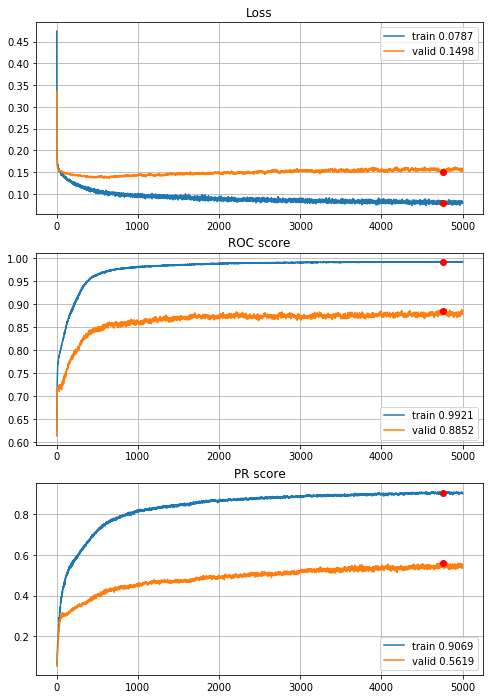


Fold 2------------------------------------------------------------


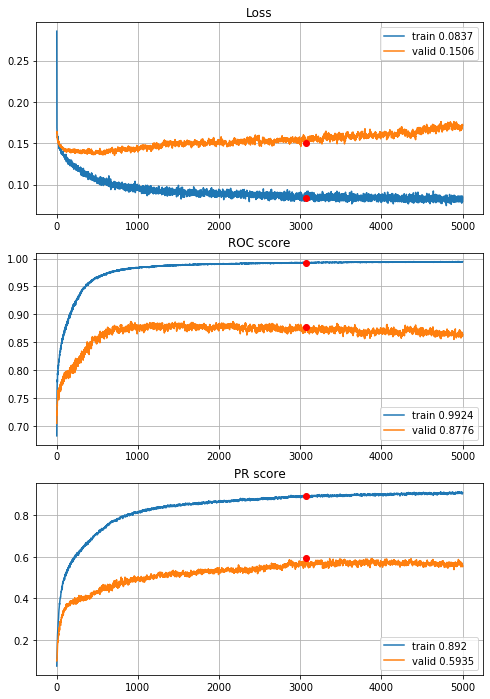


Fold 3------------------------------------------------------------


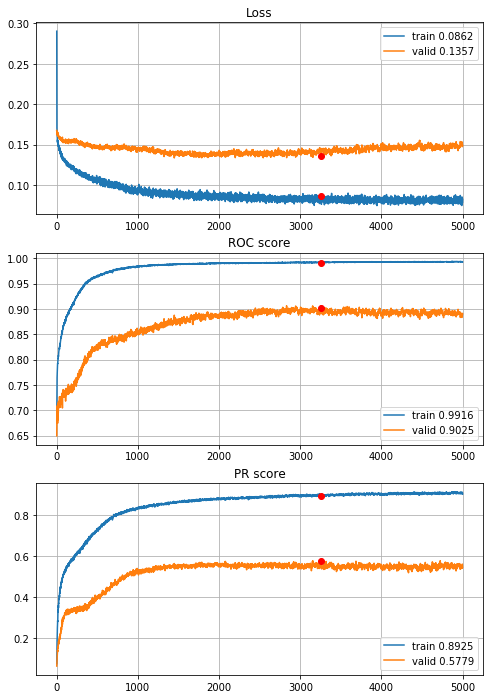


Fold 4------------------------------------------------------------


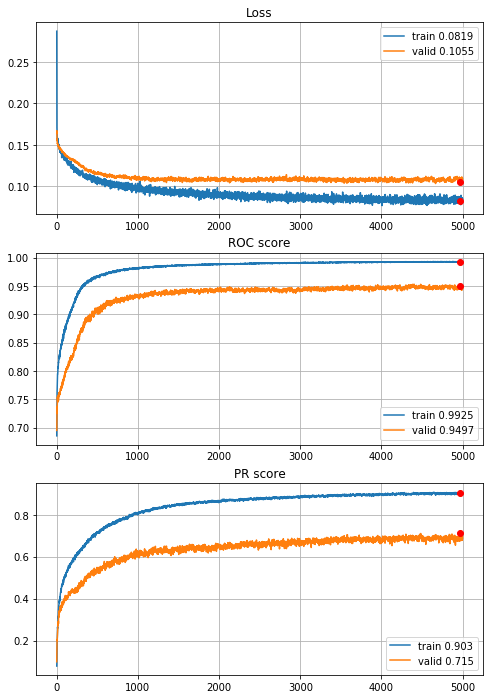


Fold 5------------------------------------------------------------


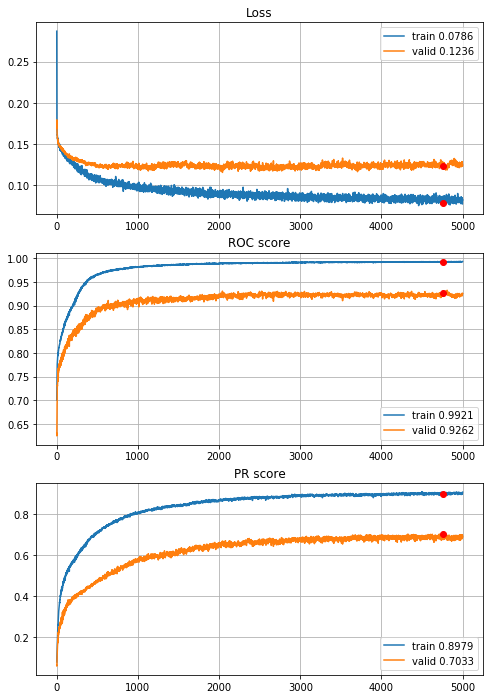


Fold 6------------------------------------------------------------


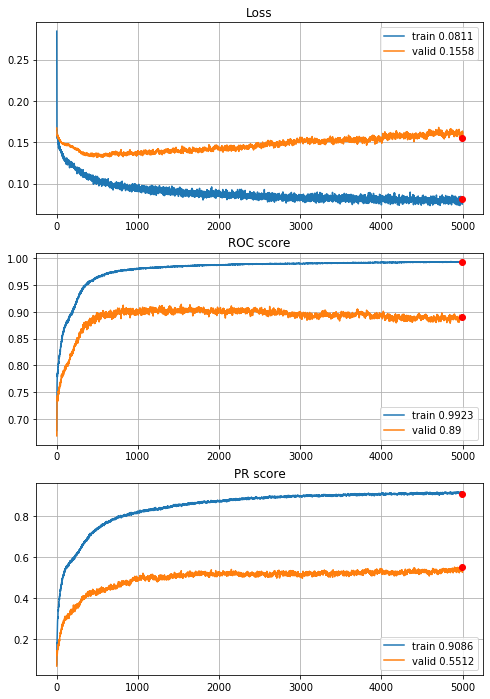

In [70]:
# L2 regu, 5000 epochs
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=5000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l2(l=0.00005),regularizers.l2(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\2year\MLP_L2_5000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

Very good model, but by looking at learning curves it can be expected that more epochs can give better results, lets try it. 8000!


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/8000,
cumulative time: 11.07s train loss: 0.4765020489169223, validation loss: 0.3370295117754455
Epoch: 2/8000,
cumulative time: 11.22s train loss: 0.3119269273476889, validation loss: 0.2417953290328442
Epoch: 3/8000,
cumulative time: 11.38s train loss: 0.24283429096247924, validation loss: 0.1991516317522854
Epoch: 4/8000,
cumulative time: 11.52s train loss: 0.207922068663671, validation loss: 0.17968728962607028
Epoch: 5/8000,
cumulative time: 11.68s train loss: 0.19220722307812294, validation loss: 0.17018928223559304
Epoch: 6/8000,
cumulative time: 11.82s train loss: 0.18199282785178575, validation loss: 0.16525466354419802
Epoch: 7/8000,
cumulative time: 11.98s train loss: 0.17707095532605432, validation loss: 0.16289794346412856
Epoch: 8/8000,
cumulative time: 12.15s train loss: 0.17156824681882013, validation loss: 0.16147088110056335
Epoch: 9/8000,
cumulative time: 12.3s train loss: 0.1701

Epoch: 77/8000,
cumulative time: 22.57s train loss: 0.14396648888296373, validation loss: 0.1495380018145666
Epoch: 78/8000,
cumulative time: 22.73s train loss: 0.14300335938034528, validation loss: 0.149495598900365
Epoch: 79/8000,
cumulative time: 22.87s train loss: 0.14392515093279565, validation loss: 0.1496919331923225
Epoch: 80/8000,
cumulative time: 23.03s train loss: 0.14047073660280934, validation loss: 0.14967347625862723
Epoch: 81/8000,
cumulative time: 23.18s train loss: 0.14261325934811742, validation loss: 0.14934015807208664
Epoch: 82/8000,
cumulative time: 23.33s train loss: 0.1416245233562971, validation loss: 0.1492982261947223
Epoch: 83/8000,
cumulative time: 23.48s train loss: 0.14364423348509417, validation loss: 0.14919837511499776
Epoch: 84/8000,
cumulative time: 23.62s train loss: 0.1446270983158831, validation loss: 0.1486874021404224
Epoch: 85/8000,
cumulative time: 23.78s train loss: 0.14374711825761996, validation loss: 0.14829653020103511
Epoch: 86/8000,
cu

Epoch: 153/8000,
cumulative time: 34.05s train loss: 0.1309428226638784, validation loss: 0.1445242562093241
Epoch: 154/8000,
cumulative time: 34.2s train loss: 0.13068916728220287, validation loss: 0.145190442256815
Epoch: 155/8000,
cumulative time: 34.35s train loss: 0.12968035845647774, validation loss: 0.14463767188639035
Epoch: 156/8000,
cumulative time: 34.5s train loss: 0.1291968343802151, validation loss: 0.1447940796691812
Epoch: 157/8000,
cumulative time: 34.63s train loss: 0.1278354850778231, validation loss: 0.1460308549464296
Epoch: 158/8000,
cumulative time: 34.8s train loss: 0.13017079833958936, validation loss: 0.14462614145378921
Epoch: 159/8000,
cumulative time: 34.93s train loss: 0.1331161955699397, validation loss: 0.14413469297467177
Epoch: 160/8000,
cumulative time: 35.09s train loss: 0.12954140025113978, validation loss: 0.1445613172915941
Epoch: 161/8000,
cumulative time: 35.25s train loss: 0.12860097262169934, validation loss: 0.144268312077691
Epoch: 162/8000,

Epoch: 229/8000,
cumulative time: 45.54s train loss: 0.125310428601712, validation loss: 0.1419545096170699
Epoch: 230/8000,
cumulative time: 45.7s train loss: 0.11974851674193839, validation loss: 0.14157519233687677
Epoch: 231/8000,
cumulative time: 45.84s train loss: 0.11903144379152135, validation loss: 0.14285581288456448
Epoch: 232/8000,
cumulative time: 46.0s train loss: 0.12294100455354778, validation loss: 0.14314888290777744
Epoch: 233/8000,
cumulative time: 46.16s train loss: 0.12270034074994274, validation loss: 0.14320827283326482
Epoch: 234/8000,
cumulative time: 46.3s train loss: 0.11884684029803987, validation loss: 0.14369329010401297
Epoch: 235/8000,
cumulative time: 46.46s train loss: 0.12370741008239487, validation loss: 0.14265388975879312
Epoch: 236/8000,
cumulative time: 46.6s train loss: 0.12142434494924165, validation loss: 0.14348090869688268
Epoch: 237/8000,
cumulative time: 46.76s train loss: 0.12114712170819997, validation loss: 0.14318084697267175
Epoch: 2

Epoch: 305/8000,
cumulative time: 57.09s train loss: 0.11907517944575763, validation loss: 0.14177753545861413
Epoch: 306/8000,
cumulative time: 57.24s train loss: 0.11511594259632667, validation loss: 0.14144910713792003
Epoch: 307/8000,
cumulative time: 57.39s train loss: 0.11886052768455294, validation loss: 0.1404662238895346
Epoch: 308/8000,
cumulative time: 57.54s train loss: 0.11495610943064338, validation loss: 0.1409822068278474
Epoch: 309/8000,
cumulative time: 57.69s train loss: 0.11728895127847508, validation loss: 0.14143400113946644
Epoch: 310/8000,
cumulative time: 57.84s train loss: 0.11641500682822373, validation loss: 0.14120598574843976
Epoch: 311/8000,
cumulative time: 58.0s train loss: 0.11611450177678775, validation loss: 0.14149083421708403
Epoch: 312/8000,
cumulative time: 58.15s train loss: 0.11372730565920369, validation loss: 0.1414462424433872
Epoch: 313/8000,
cumulative time: 58.3s train loss: 0.11727480802366158, validation loss: 0.14185272018531359
Epoch:

Epoch: 381/8000,
cumulative time: 68.39s train loss: 0.11121551288558672, validation loss: 0.13898136218714371
Epoch: 382/8000,
cumulative time: 68.53s train loss: 0.10951631827855395, validation loss: 0.1408407057722149
Epoch: 383/8000,
cumulative time: 68.69s train loss: 0.10928497812115578, validation loss: 0.13985352733735176
Epoch: 384/8000,
cumulative time: 68.83s train loss: 0.11139073170919783, validation loss: 0.139353321164573
Epoch: 385/8000,
cumulative time: 68.99s train loss: 0.11411943021506903, validation loss: 0.13923828931693794
Epoch: 386/8000,
cumulative time: 69.14s train loss: 0.11271354409787052, validation loss: 0.1395689502534204
Epoch: 387/8000,
cumulative time: 69.3s train loss: 0.10993657790945748, validation loss: 0.1389975083667204
Epoch: 388/8000,
cumulative time: 69.45s train loss: 0.11398463228150767, validation loss: 0.1390726473060379
Epoch: 389/8000,
cumulative time: 69.61s train loss: 0.1094115411982122, validation loss: 0.13910026454792734
Epoch: 39

Epoch: 457/8000,
cumulative time: 79.92s train loss: 0.10596674400812553, validation loss: 0.1376770920416787
Epoch: 458/8000,
cumulative time: 80.08s train loss: 0.10461460294167545, validation loss: 0.1380472365439641
Epoch: 459/8000,
cumulative time: 80.22s train loss: 0.11110010098674254, validation loss: 0.13779268520218985
Epoch: 460/8000,
cumulative time: 80.38s train loss: 0.1077275198523816, validation loss: 0.13816646296106191
Epoch: 461/8000,
cumulative time: 80.52s train loss: 0.10969272480518513, validation loss: 0.1376617870062863
Epoch: 462/8000,
cumulative time: 80.68s train loss: 0.10798720058274935, validation loss: 0.13935036509057327
Epoch: 463/8000,
cumulative time: 80.82s train loss: 0.10742460000224344, validation loss: 0.13881143938315493
Epoch: 464/8000,
cumulative time: 80.98s train loss: 0.10342641671303295, validation loss: 0.13937413922924827
Epoch: 465/8000,
cumulative time: 81.13s train loss: 0.10631210330093903, validation loss: 0.13908616114568897
Epoch

Epoch: 533/8000,
cumulative time: 91.4s train loss: 0.1080986304719649, validation loss: 0.14025503028853067
Epoch: 534/8000,
cumulative time: 91.55s train loss: 0.10547080367993036, validation loss: 0.13955555819121446
Epoch: 535/8000,
cumulative time: 91.7s train loss: 0.10549781919560905, validation loss: 0.13859456033491058
Epoch: 536/8000,
cumulative time: 91.85s train loss: 0.10759288519288847, validation loss: 0.13915796902123473
Epoch: 537/8000,
cumulative time: 92.0s train loss: 0.10651566854059533, validation loss: 0.1400329554416874
Epoch: 538/8000,
cumulative time: 92.15s train loss: 0.10399050693014125, validation loss: 0.13968256419600228
Epoch: 539/8000,
cumulative time: 92.3s train loss: 0.10310854391874968, validation loss: 0.14027731519968764
Epoch: 540/8000,
cumulative time: 92.45s train loss: 0.10297064805448032, validation loss: 0.1396731621003557
Epoch: 541/8000,
cumulative time: 92.6s train loss: 0.10556779929195886, validation loss: 0.13821421831182226
Epoch: 54

Epoch: 609/8000,
cumulative time: 102.87s train loss: 0.09993029909367361, validation loss: 0.13837137449225154
Epoch: 610/8000,
cumulative time: 103.02s train loss: 0.10411661705506366, validation loss: 0.13795328753491373
Epoch: 611/8000,
cumulative time: 103.17s train loss: 0.10267994997111979, validation loss: 0.13866696587786917
Epoch: 612/8000,
cumulative time: 103.34s train loss: 0.10280424274034435, validation loss: 0.13670545921881888
Epoch: 613/8000,
cumulative time: 103.49s train loss: 0.1063937480620154, validation loss: 0.1384848328710071
Epoch: 614/8000,
cumulative time: 103.64s train loss: 0.10016343535371745, validation loss: 0.13736457242917263
Epoch: 615/8000,
cumulative time: 103.79s train loss: 0.10308312890233992, validation loss: 0.13850486487501726
Epoch: 616/8000,
cumulative time: 103.94s train loss: 0.10387454586325005, validation loss: 0.13824487765604046
Epoch: 617/8000,
cumulative time: 104.09s train loss: 0.10167923871452678, validation loss: 0.136973254587

Epoch: 683/8000,
cumulative time: 114.03s train loss: 0.1031147434981314, validation loss: 0.13838065285748297
Epoch: 684/8000,
cumulative time: 114.18s train loss: 0.10022352999062818, validation loss: 0.13859304291627042
Epoch: 685/8000,
cumulative time: 114.33s train loss: 0.09920441770240292, validation loss: 0.13962246039162143
Epoch: 686/8000,
cumulative time: 114.48s train loss: 0.09798870857784016, validation loss: 0.13854008345702373
Epoch: 687/8000,
cumulative time: 114.63s train loss: 0.09863602135734269, validation loss: 0.13833185423014205
Epoch: 688/8000,
cumulative time: 114.78s train loss: 0.10370500497192804, validation loss: 0.13774284230225364
Epoch: 689/8000,
cumulative time: 114.93s train loss: 0.09836892256270793, validation loss: 0.1375735176832148
Epoch: 690/8000,
cumulative time: 115.09s train loss: 0.09844474997217618, validation loss: 0.1389588327836709
Epoch: 691/8000,
cumulative time: 115.23s train loss: 0.10366336791937872, validation loss: 0.1383551128237

Epoch: 757/8000,
cumulative time: 125.17s train loss: 0.09761873928290205, validation loss: 0.14020340339931248
Epoch: 758/8000,
cumulative time: 125.32s train loss: 0.09431445194479834, validation loss: 0.14024040187912876
Epoch: 759/8000,
cumulative time: 125.47s train loss: 0.09530303926389141, validation loss: 0.1393069893141249
Epoch: 760/8000,
cumulative time: 125.63s train loss: 0.09788196041412443, validation loss: 0.14071585363946454
Epoch: 761/8000,
cumulative time: 125.77s train loss: 0.10062265288593072, validation loss: 0.14108737121637652
Epoch: 762/8000,
cumulative time: 125.92s train loss: 0.09633909213127292, validation loss: 0.14138962735628238
Epoch: 763/8000,
cumulative time: 126.08s train loss: 0.09763831093463973, validation loss: 0.1407104796128223
Epoch: 764/8000,
cumulative time: 126.22s train loss: 0.10004534312779163, validation loss: 0.14066807856370706
Epoch: 765/8000,
cumulative time: 126.38s train loss: 0.09814637099113278, validation loss: 0.140243739788

Epoch: 831/8000,
cumulative time: 136.44s train loss: 0.098163145780954, validation loss: 0.13983099220191197
Epoch: 832/8000,
cumulative time: 136.59s train loss: 0.0971863307044162, validation loss: 0.13961276148359242
Epoch: 833/8000,
cumulative time: 136.74s train loss: 0.09754063274092686, validation loss: 0.14015586862675017
Epoch: 834/8000,
cumulative time: 136.89s train loss: 0.10009650418261179, validation loss: 0.14113257196518258
Epoch: 835/8000,
cumulative time: 137.04s train loss: 0.09207315677243458, validation loss: 0.13957524760522505
Epoch: 836/8000,
cumulative time: 137.2s train loss: 0.0953676324596035, validation loss: 0.1402282089698049
Epoch: 837/8000,
cumulative time: 137.36s train loss: 0.09699280928395057, validation loss: 0.14137008192498593
Epoch: 838/8000,
cumulative time: 137.5s train loss: 0.09999531918255494, validation loss: 0.14071691352605506
Epoch: 839/8000,
cumulative time: 137.66s train loss: 0.09626377398837424, validation loss: 0.13916043161877173

Epoch: 905/8000,
cumulative time: 147.62s train loss: 0.09584823640829802, validation loss: 0.14126144392540382
Epoch: 906/8000,
cumulative time: 147.78s train loss: 0.09239073573316374, validation loss: 0.14192779637570463
Epoch: 907/8000,
cumulative time: 147.92s train loss: 0.09580636846392601, validation loss: 0.14322605340462055
Epoch: 908/8000,
cumulative time: 148.08s train loss: 0.10025913182678753, validation loss: 0.14269755700625097
Epoch: 909/8000,
cumulative time: 148.22s train loss: 0.09888991148064936, validation loss: 0.14128285983325925
Epoch: 910/8000,
cumulative time: 148.38s train loss: 0.09621999828812179, validation loss: 0.141091762283917
Epoch: 911/8000,
cumulative time: 148.52s train loss: 0.0965970523361454, validation loss: 0.14168978553768222
Epoch: 912/8000,
cumulative time: 148.68s train loss: 0.09744326340009944, validation loss: 0.14100195854160139
Epoch: 913/8000,
cumulative time: 148.83s train loss: 0.09632528065924158, validation loss: 0.1412787672381

Epoch: 979/8000,
cumulative time: 158.81s train loss: 0.09525874051998977, validation loss: 0.14270469267043343
Epoch: 980/8000,
cumulative time: 158.96s train loss: 0.09646760143641407, validation loss: 0.1429983279905813
Epoch: 981/8000,
cumulative time: 159.11s train loss: 0.09891766187661534, validation loss: 0.14266143324217354
Epoch: 982/8000,
cumulative time: 159.26s train loss: 0.09614322331012162, validation loss: 0.14113535390261117
Epoch: 983/8000,
cumulative time: 159.41s train loss: 0.0943489472393612, validation loss: 0.14205619159641616
Epoch: 984/8000,
cumulative time: 159.57s train loss: 0.09663794152580249, validation loss: 0.14304736283941005
Epoch: 985/8000,
cumulative time: 159.7s train loss: 0.09294310956412084, validation loss: 0.14380889130099572
Epoch: 986/8000,
cumulative time: 159.86s train loss: 0.09433377402601306, validation loss: 0.14196877901199448
Epoch: 987/8000,
cumulative time: 160.01s train loss: 0.09117086939264647, validation loss: 0.1424794116424

Epoch: 1053/8000,
cumulative time: 170.02s train loss: 0.10029859218816252, validation loss: 0.14232351746151362
Epoch: 1054/8000,
cumulative time: 170.18s train loss: 0.09175767996289233, validation loss: 0.1413711396144852
Epoch: 1055/8000,
cumulative time: 170.37s train loss: 0.09520671742547464, validation loss: 0.14167995380816267
Epoch: 1056/8000,
cumulative time: 170.52s train loss: 0.10041137689109055, validation loss: 0.14191373901473428
Epoch: 1057/8000,
cumulative time: 170.67s train loss: 0.09841154737727391, validation loss: 0.1412072881743761
Epoch: 1058/8000,
cumulative time: 170.83s train loss: 0.0956471169181632, validation loss: 0.14256409221715727
Epoch: 1059/8000,
cumulative time: 170.99s train loss: 0.09831784364641268, validation loss: 0.141176426414581
Epoch: 1060/8000,
cumulative time: 171.14s train loss: 0.09199663375082295, validation loss: 0.1422149534599653
Epoch: 1061/8000,
cumulative time: 171.3s train loss: 0.09575544835613602, validation loss: 0.14358810

Epoch: 1127/8000,
cumulative time: 181.48s train loss: 0.0923839323803722, validation loss: 0.14353116026555882
Epoch: 1128/8000,
cumulative time: 181.63s train loss: 0.09212498835411652, validation loss: 0.14256988940357693
Epoch: 1129/8000,
cumulative time: 181.79s train loss: 0.09578850353423539, validation loss: 0.14389877204891896
Epoch: 1130/8000,
cumulative time: 181.94s train loss: 0.09735594203297442, validation loss: 0.1437991306009955
Epoch: 1131/8000,
cumulative time: 182.09s train loss: 0.0932605470731993, validation loss: 0.14330486580241242
Epoch: 1132/8000,
cumulative time: 182.24s train loss: 0.09390173252217343, validation loss: 0.14238382240227604
Epoch: 1133/8000,
cumulative time: 182.4s train loss: 0.09624548271925394, validation loss: 0.1420255841035518
Epoch: 1134/8000,
cumulative time: 182.55s train loss: 0.09244123034141123, validation loss: 0.14223805074805826
Epoch: 1135/8000,
cumulative time: 182.7s train loss: 0.09568107841363786, validation loss: 0.1445208

Epoch: 1201/8000,
cumulative time: 192.78s train loss: 0.0974285337653537, validation loss: 0.14407568200348558
Epoch: 1202/8000,
cumulative time: 192.93s train loss: 0.09756174720682156, validation loss: 0.1423127454648168
Epoch: 1203/8000,
cumulative time: 193.08s train loss: 0.09467117047150492, validation loss: 0.14041135693518236
Epoch: 1204/8000,
cumulative time: 193.23s train loss: 0.09117406120906887, validation loss: 0.1418141405321511
Epoch: 1205/8000,
cumulative time: 193.39s train loss: 0.09761670512400068, validation loss: 0.1413558637759945
Epoch: 1206/8000,
cumulative time: 193.55s train loss: 0.09304605205838154, validation loss: 0.14141624425763696
Epoch: 1207/8000,
cumulative time: 193.7s train loss: 0.09601172746626324, validation loss: 0.14106825707897758
Epoch: 1208/8000,
cumulative time: 193.83s train loss: 0.09253517156355752, validation loss: 0.1407353599820662
Epoch: 1209/8000,
cumulative time: 193.98s train loss: 0.09307014089879022, validation loss: 0.1412349

Epoch: 1275/8000,
cumulative time: 204.16s train loss: 0.08803918115674535, validation loss: 0.1433718286425383
Epoch: 1276/8000,
cumulative time: 204.31s train loss: 0.09179697959036952, validation loss: 0.14248775160562632
Epoch: 1277/8000,
cumulative time: 204.46s train loss: 0.09189501532210265, validation loss: 0.14200679611214492
Epoch: 1278/8000,
cumulative time: 204.62s train loss: 0.09109909377571233, validation loss: 0.14171174046526105
Epoch: 1279/8000,
cumulative time: 204.77s train loss: 0.09563029922329125, validation loss: 0.1435904270660518
Epoch: 1280/8000,
cumulative time: 204.92s train loss: 0.0936302789173818, validation loss: 0.14526240844987479
Epoch: 1281/8000,
cumulative time: 205.07s train loss: 0.09801739740124035, validation loss: 0.1446044235581808
Epoch: 1282/8000,
cumulative time: 205.22s train loss: 0.09513500621616801, validation loss: 0.14370600364584754
Epoch: 1283/8000,
cumulative time: 205.37s train loss: 0.08934737966568165, validation loss: 0.14443

Epoch: 1348/8000,
cumulative time: 215.64s train loss: 0.09039715243395291, validation loss: 0.14294077325148477
Epoch: 1349/8000,
cumulative time: 215.79s train loss: 0.0935302682495364, validation loss: 0.1434747710687305
Epoch: 1350/8000,
cumulative time: 215.96s train loss: 0.09386609497322981, validation loss: 0.14384139310641808
Epoch: 1351/8000,
cumulative time: 216.12s train loss: 0.09321250725400325, validation loss: 0.14495589591924046
Epoch: 1352/8000,
cumulative time: 216.27s train loss: 0.0912415661510563, validation loss: 0.14457187237191169
Epoch: 1353/8000,
cumulative time: 216.42s train loss: 0.09042203374795918, validation loss: 0.1442502495365249
Epoch: 1354/8000,
cumulative time: 216.58s train loss: 0.09429274204772209, validation loss: 0.1440212882928267
Epoch: 1355/8000,
cumulative time: 216.74s train loss: 0.09396707333760113, validation loss: 0.14584162192685263
Epoch: 1356/8000,
cumulative time: 216.89s train loss: 0.09510020709241697, validation loss: 0.145290

Epoch: 1422/8000,
cumulative time: 227.07s train loss: 0.09311275522062609, validation loss: 0.14449656088769358
Epoch: 1423/8000,
cumulative time: 227.22s train loss: 0.09582598955816188, validation loss: 0.1451074086217549
Epoch: 1424/8000,
cumulative time: 227.38s train loss: 0.0936201949115427, validation loss: 0.14506091076885577
Epoch: 1425/8000,
cumulative time: 227.53s train loss: 0.09241899658521391, validation loss: 0.1454324032403382
Epoch: 1426/8000,
cumulative time: 227.69s train loss: 0.09129416145484903, validation loss: 0.14700046617191084
Epoch: 1427/8000,
cumulative time: 227.84s train loss: 0.09373224515608027, validation loss: 0.14561961936919435
Epoch: 1428/8000,
cumulative time: 227.99s train loss: 0.09021531798991451, validation loss: 0.14718409916715572
Epoch: 1429/8000,
cumulative time: 228.14s train loss: 0.09499423617201905, validation loss: 0.1462999027061275
Epoch: 1430/8000,
cumulative time: 228.29s train loss: 0.08998189772299661, validation loss: 0.14482

Epoch: 1495/8000,
cumulative time: 238.64s train loss: 0.08668092733278611, validation loss: 0.14560175176373003
Epoch: 1496/8000,
cumulative time: 238.81s train loss: 0.09084275870663668, validation loss: 0.14600422730373994
Epoch: 1497/8000,
cumulative time: 238.98s train loss: 0.09050063888114719, validation loss: 0.14658932729598578
Epoch: 1498/8000,
cumulative time: 239.13s train loss: 0.08680419290924403, validation loss: 0.14686161691755018
Epoch: 1499/8000,
cumulative time: 239.3s train loss: 0.09166170297482798, validation loss: 0.14689415518492266
Epoch: 1500/8000,
cumulative time: 239.46s train loss: 0.09512144461057338, validation loss: 0.14639865260371063
Epoch: 1501/8000,
cumulative time: 239.6s train loss: 0.08730096020940278, validation loss: 0.1467191631445566
Epoch: 1502/8000,
cumulative time: 239.76s train loss: 0.09153972503722206, validation loss: 0.14633558754995954
Epoch: 1503/8000,
cumulative time: 239.93s train loss: 0.09128758566460644, validation loss: 0.1471

Epoch: 1569/8000,
cumulative time: 250.27s train loss: 0.0923719441969627, validation loss: 0.14649426274069952
Epoch: 1570/8000,
cumulative time: 250.42s train loss: 0.08947292424866343, validation loss: 0.1448555953634676
Epoch: 1571/8000,
cumulative time: 250.56s train loss: 0.09147753630374016, validation loss: 0.1462550257695143
Epoch: 1572/8000,
cumulative time: 250.72s train loss: 0.091683218575724, validation loss: 0.1438054430199638
Epoch: 1573/8000,
cumulative time: 250.86s train loss: 0.09234415746513333, validation loss: 0.14473818175172432
Epoch: 1574/8000,
cumulative time: 251.02s train loss: 0.09196314612360297, validation loss: 0.14688759691632436
Epoch: 1575/8000,
cumulative time: 251.15s train loss: 0.09089076752227636, validation loss: 0.14665667605275096
Epoch: 1576/8000,
cumulative time: 251.31s train loss: 0.09330149843501676, validation loss: 0.1446706105028505
Epoch: 1577/8000,
cumulative time: 251.45s train loss: 0.09131184103511111, validation loss: 0.14489166

Epoch: 1643/8000,
cumulative time: 261.71s train loss: 0.08709760249903294, validation loss: 0.14790534080637235
Epoch: 1644/8000,
cumulative time: 261.88s train loss: 0.08892020365758717, validation loss: 0.14716781875995008
Epoch: 1645/8000,
cumulative time: 262.03s train loss: 0.09512396782406161, validation loss: 0.14557333498568242
Epoch: 1646/8000,
cumulative time: 262.2s train loss: 0.09471803765877279, validation loss: 0.14384206298489716
Epoch: 1647/8000,
cumulative time: 262.36s train loss: 0.09185067065004472, validation loss: 0.14784357815902793
Epoch: 1648/8000,
cumulative time: 262.52s train loss: 0.09332058172946926, validation loss: 0.1483164113088173
Epoch: 1649/8000,
cumulative time: 262.67s train loss: 0.09157928429970752, validation loss: 0.14930208019550945
Epoch: 1650/8000,
cumulative time: 262.84s train loss: 0.09389296807187587, validation loss: 0.14880592275415774
Epoch: 1651/8000,
cumulative time: 262.99s train loss: 0.09428455918414015, validation loss: 0.149

Epoch: 1716/8000,
cumulative time: 273.07s train loss: 0.08899941395781177, validation loss: 0.1483628435614537
Epoch: 1717/8000,
cumulative time: 273.23s train loss: 0.08818468226488303, validation loss: 0.1493134419696203
Epoch: 1718/8000,
cumulative time: 273.38s train loss: 0.09139411664228637, validation loss: 0.14909839693598478
Epoch: 1719/8000,
cumulative time: 273.53s train loss: 0.09206380474097077, validation loss: 0.1486400029039789
Epoch: 1720/8000,
cumulative time: 273.68s train loss: 0.09326438223539041, validation loss: 0.1471028540815626
Epoch: 1721/8000,
cumulative time: 273.85s train loss: 0.08985497222290172, validation loss: 0.14557475485347046
Epoch: 1722/8000,
cumulative time: 273.99s train loss: 0.0890867220371403, validation loss: 0.14627564391841427
Epoch: 1723/8000,
cumulative time: 274.15s train loss: 0.08739830234472179, validation loss: 0.14853701499311514
Epoch: 1724/8000,
cumulative time: 274.3s train loss: 0.09306463915725291, validation loss: 0.1495105

Epoch: 1790/8000,
cumulative time: 284.75s train loss: 0.09306655312243882, validation loss: 0.14865678087911943
Epoch: 1791/8000,
cumulative time: 284.9s train loss: 0.09380300679186847, validation loss: 0.14878024485054991
Epoch: 1792/8000,
cumulative time: 285.06s train loss: 0.08751112151183436, validation loss: 0.1476209677199236
Epoch: 1793/8000,
cumulative time: 285.21s train loss: 0.09932706702921991, validation loss: 0.14721426965368528
Epoch: 1794/8000,
cumulative time: 285.37s train loss: 0.09248775821523407, validation loss: 0.14920242632669672
Epoch: 1795/8000,
cumulative time: 285.53s train loss: 0.08751666093696099, validation loss: 0.15182253173497526
Epoch: 1796/8000,
cumulative time: 285.68s train loss: 0.09315240920871312, validation loss: 0.14765756359497184
Epoch: 1797/8000,
cumulative time: 285.83s train loss: 0.0882083877407406, validation loss: 0.1491076635150422
Epoch: 1798/8000,
cumulative time: 285.98s train loss: 0.0906720744632209, validation loss: 0.149258

Epoch: 1863/8000,
cumulative time: 296.23s train loss: 0.09016403956867355, validation loss: 0.14901993383664447
Epoch: 1864/8000,
cumulative time: 296.4s train loss: 0.09161016775612782, validation loss: 0.14661386568065082
Epoch: 1865/8000,
cumulative time: 296.55s train loss: 0.09261961757300768, validation loss: 0.14647486805915833
Epoch: 1866/8000,
cumulative time: 296.7s train loss: 0.09096891744833097, validation loss: 0.14764746862462433
Epoch: 1867/8000,
cumulative time: 296.87s train loss: 0.08413746151455437, validation loss: 0.14784263834103376
Epoch: 1868/8000,
cumulative time: 297.04s train loss: 0.09230961629661621, validation loss: 0.14724104752859313
Epoch: 1869/8000,
cumulative time: 297.19s train loss: 0.089475120493095, validation loss: 0.14603332738693545
Epoch: 1870/8000,
cumulative time: 297.34s train loss: 0.08873419440195779, validation loss: 0.14633358399802393
Epoch: 1871/8000,
cumulative time: 297.49s train loss: 0.09784219927254706, validation loss: 0.14632

Epoch: 1937/8000,
cumulative time: 307.47s train loss: 0.08961467284829827, validation loss: 0.14770993466341323
Epoch: 1938/8000,
cumulative time: 307.62s train loss: 0.0890068425997742, validation loss: 0.14903624803023133
Epoch: 1939/8000,
cumulative time: 307.79s train loss: 0.08879731931959384, validation loss: 0.14979580665790862
Epoch: 1940/8000,
cumulative time: 307.94s train loss: 0.08554324124685699, validation loss: 0.1510722041130066
Epoch: 1941/8000,
cumulative time: 308.09s train loss: 0.09131371296882661, validation loss: 0.15009147526396055
Epoch: 1942/8000,
cumulative time: 308.25s train loss: 0.08994655057188254, validation loss: 0.1496528054283612
Epoch: 1943/8000,
cumulative time: 308.42s train loss: 0.0842772255608804, validation loss: 0.1492042010296063
Epoch: 1944/8000,
cumulative time: 308.57s train loss: 0.08843234205233472, validation loss: 0.1507024534759484
Epoch: 1945/8000,
cumulative time: 308.71s train loss: 0.09204683809210705, validation loss: 0.1503603

Epoch: 2011/8000,
cumulative time: 318.6s train loss: 0.09046787967831424, validation loss: 0.14759129922480602
Epoch: 2012/8000,
cumulative time: 318.76s train loss: 0.08632918546382308, validation loss: 0.1488612063356027
Epoch: 2013/8000,
cumulative time: 318.91s train loss: 0.08761166455486621, validation loss: 0.15025576984273029
Epoch: 2014/8000,
cumulative time: 319.06s train loss: 0.09074426279485671, validation loss: 0.14793497805396977
Epoch: 2015/8000,
cumulative time: 319.21s train loss: 0.09111287903838051, validation loss: 0.14737651360417725
Epoch: 2016/8000,
cumulative time: 319.36s train loss: 0.08960907811171763, validation loss: 0.14645125837032322
Epoch: 2017/8000,
cumulative time: 319.52s train loss: 0.09126942886044742, validation loss: 0.14611727956238144
Epoch: 2018/8000,
cumulative time: 319.68s train loss: 0.0893097463113825, validation loss: 0.14895785889963023
Epoch: 2019/8000,
cumulative time: 319.84s train loss: 0.08968579646862573, validation loss: 0.1482

Epoch: 2085/8000,
cumulative time: 330.29s train loss: 0.08964201279139829, validation loss: 0.14771328978777556
Epoch: 2086/8000,
cumulative time: 330.45s train loss: 0.08578379422344189, validation loss: 0.1476657338450183
Epoch: 2087/8000,
cumulative time: 330.61s train loss: 0.09082177811289915, validation loss: 0.14736100448341857
Epoch: 2088/8000,
cumulative time: 330.74s train loss: 0.08885049032014919, validation loss: 0.1467630341746704
Epoch: 2089/8000,
cumulative time: 330.88s train loss: 0.08801671843851264, validation loss: 0.1453089133920551
Epoch: 2090/8000,
cumulative time: 331.03s train loss: 0.08416341985544726, validation loss: 0.14758630094959413
Epoch: 2091/8000,
cumulative time: 331.18s train loss: 0.08678556902624392, validation loss: 0.14854896681805582
Epoch: 2092/8000,
cumulative time: 331.33s train loss: 0.0891821385054964, validation loss: 0.14824370552601382
Epoch: 2093/8000,
cumulative time: 331.5s train loss: 0.0877022177976141, validation loss: 0.1481936

Epoch: 2158/8000,
cumulative time: 341.74s train loss: 0.08983259500225432, validation loss: 0.14789143511305317
Epoch: 2159/8000,
cumulative time: 341.9s train loss: 0.08518344784532217, validation loss: 0.15001689483500713
Epoch: 2160/8000,
cumulative time: 342.05s train loss: 0.0897792912331145, validation loss: 0.14946008013710282
Epoch: 2161/8000,
cumulative time: 342.2s train loss: 0.08840955628126348, validation loss: 0.14891788406422066
Epoch: 2162/8000,
cumulative time: 342.35s train loss: 0.08894214549048542, validation loss: 0.1478717999916089
Epoch: 2163/8000,
cumulative time: 342.52s train loss: 0.08825014237847205, validation loss: 0.1460165503980448
Epoch: 2164/8000,
cumulative time: 342.67s train loss: 0.08612957153787211, validation loss: 0.1481146248909468
Epoch: 2165/8000,
cumulative time: 342.82s train loss: 0.08790397649609663, validation loss: 0.1473211807785934
Epoch: 2166/8000,
cumulative time: 342.97s train loss: 0.08952071229019114, validation loss: 0.14776213

Epoch: 2231/8000,
cumulative time: 353.18s train loss: 0.08641174805654206, validation loss: 0.14779503483369186
Epoch: 2232/8000,
cumulative time: 353.34s train loss: 0.09062847284911922, validation loss: 0.14639769158622698
Epoch: 2233/8000,
cumulative time: 353.5s train loss: 0.08438306657319332, validation loss: 0.14562707535951822
Epoch: 2234/8000,
cumulative time: 353.66s train loss: 0.09238426909309679, validation loss: 0.1462921978976592
Epoch: 2235/8000,
cumulative time: 353.8s train loss: 0.08812410526904417, validation loss: 0.14689082411138601
Epoch: 2236/8000,
cumulative time: 353.96s train loss: 0.08720739676851107, validation loss: 0.1474605549717637
Epoch: 2237/8000,
cumulative time: 354.12s train loss: 0.08460514967083571, validation loss: 0.14908510930885024
Epoch: 2238/8000,
cumulative time: 354.27s train loss: 0.08619999260624421, validation loss: 0.14859082887674221
Epoch: 2239/8000,
cumulative time: 354.42s train loss: 0.08772979506792818, validation loss: 0.14845

Epoch: 2304/8000,
cumulative time: 364.44s train loss: 0.08543749416029958, validation loss: 0.14626883416586747
Epoch: 2305/8000,
cumulative time: 364.62s train loss: 0.0857527374162604, validation loss: 0.1489080007665279
Epoch: 2306/8000,
cumulative time: 364.77s train loss: 0.08965185015753004, validation loss: 0.14828134815392927
Epoch: 2307/8000,
cumulative time: 364.93s train loss: 0.08332579766923501, validation loss: 0.14737541479489438
Epoch: 2308/8000,
cumulative time: 365.08s train loss: 0.09298016119693175, validation loss: 0.14577383092979304
Epoch: 2309/8000,
cumulative time: 365.22s train loss: 0.08768046748292041, validation loss: 0.14712396902697428
Epoch: 2310/8000,
cumulative time: 365.39s train loss: 0.08962467067194635, validation loss: 0.14463533016793226
Epoch: 2311/8000,
cumulative time: 365.53s train loss: 0.09022095434681149, validation loss: 0.14609730378437794
Epoch: 2312/8000,
cumulative time: 365.69s train loss: 0.08675635131660725, validation loss: 0.145

Epoch: 2377/8000,
cumulative time: 375.68s train loss: 0.0901196892918336, validation loss: 0.14727557174187655
Epoch: 2378/8000,
cumulative time: 375.85s train loss: 0.0886983461370395, validation loss: 0.14716960783671895
Epoch: 2379/8000,
cumulative time: 376.0s train loss: 0.09010560759196104, validation loss: 0.14666819853676413
Epoch: 2380/8000,
cumulative time: 376.15s train loss: 0.08614674803157171, validation loss: 0.14749909058545238
Epoch: 2381/8000,
cumulative time: 376.3s train loss: 0.08495798839388255, validation loss: 0.14765897629535996
Epoch: 2382/8000,
cumulative time: 376.47s train loss: 0.08636791194886895, validation loss: 0.14878861928361115
Epoch: 2383/8000,
cumulative time: 376.62s train loss: 0.08617778305540018, validation loss: 0.1467137560443672
Epoch: 2384/8000,
cumulative time: 376.77s train loss: 0.08961116954799497, validation loss: 0.14743733124839212
Epoch: 2385/8000,
cumulative time: 376.92s train loss: 0.09341664059676776, validation loss: 0.147832

Epoch: 2451/8000,
cumulative time: 387.18s train loss: 0.08797999450917138, validation loss: 0.14985626280737424
Epoch: 2452/8000,
cumulative time: 387.34s train loss: 0.08429373317233449, validation loss: 0.14959130922471556
Epoch: 2453/8000,
cumulative time: 387.5s train loss: 0.08558444638351638, validation loss: 0.15002527786113645
Epoch: 2454/8000,
cumulative time: 387.65s train loss: 0.08515012194228556, validation loss: 0.1507404996558223
Epoch: 2455/8000,
cumulative time: 387.84s train loss: 0.08763955748847653, validation loss: 0.1489279534018368
Epoch: 2456/8000,
cumulative time: 387.98s train loss: 0.08062365786489238, validation loss: 0.14923496600997244
Epoch: 2457/8000,
cumulative time: 388.12s train loss: 0.09046544650268518, validation loss: 0.14902252283040068
Epoch: 2458/8000,
cumulative time: 388.26s train loss: 0.08683855484534816, validation loss: 0.1479554615944116
Epoch: 2459/8000,
cumulative time: 388.41s train loss: 0.09021150318619808, validation loss: 0.14729

Epoch: 2524/8000,
cumulative time: 398.54s train loss: 0.08865877041667172, validation loss: 0.14845499089707867
Epoch: 2525/8000,
cumulative time: 398.69s train loss: 0.08813035953094113, validation loss: 0.15067410890896699
Epoch: 2526/8000,
cumulative time: 398.84s train loss: 0.08822851282881243, validation loss: 0.1498995794381258
Epoch: 2527/8000,
cumulative time: 398.99s train loss: 0.08601274419083228, validation loss: 0.14911241571603254
Epoch: 2528/8000,
cumulative time: 399.15s train loss: 0.08546291832464334, validation loss: 0.1484488708944808
Epoch: 2529/8000,
cumulative time: 399.29s train loss: 0.0868530929965591, validation loss: 0.14996480125430997
Epoch: 2530/8000,
cumulative time: 399.45s train loss: 0.08899065082496514, validation loss: 0.1501079014408479
Epoch: 2531/8000,
cumulative time: 399.59s train loss: 0.09160842212288887, validation loss: 0.15025786559438017
Epoch: 2532/8000,
cumulative time: 399.75s train loss: 0.08385934705115627, validation loss: 0.14919

Epoch: 2597/8000,
cumulative time: 409.78s train loss: 0.08526292618675146, validation loss: 0.14792744430614485
Epoch: 2598/8000,
cumulative time: 409.93s train loss: 0.08302146569431523, validation loss: 0.1477753571375013
Epoch: 2599/8000,
cumulative time: 410.08s train loss: 0.08538967681159228, validation loss: 0.1482905796478804
Epoch: 2600/8000,
cumulative time: 410.24s train loss: 0.08241749609562841, validation loss: 0.14891946585275243
Epoch: 2601/8000,
cumulative time: 410.38s train loss: 0.08855421587322843, validation loss: 0.14795248159652924
Epoch: 2602/8000,
cumulative time: 410.54s train loss: 0.08895706052837342, validation loss: 0.14737706679269807
Epoch: 2603/8000,
cumulative time: 410.68s train loss: 0.08391374823251423, validation loss: 0.14930301785547173
Epoch: 2604/8000,
cumulative time: 410.84s train loss: 0.08371869505803384, validation loss: 0.15077015157998935
Epoch: 2605/8000,
cumulative time: 411.0s train loss: 0.09113291466137671, validation loss: 0.1513

Epoch: 2671/8000,
cumulative time: 421.22s train loss: 0.08577170331206387, validation loss: 0.14986210334972816
Epoch: 2672/8000,
cumulative time: 421.38s train loss: 0.08575463474972686, validation loss: 0.1486116017887508
Epoch: 2673/8000,
cumulative time: 421.53s train loss: 0.08645507604223604, validation loss: 0.1486722101819937
Epoch: 2674/8000,
cumulative time: 421.69s train loss: 0.08258249400007035, validation loss: 0.14916391463689066
Epoch: 2675/8000,
cumulative time: 421.87s train loss: 0.085513229693923, validation loss: 0.15063687506696968
Epoch: 2676/8000,
cumulative time: 422.03s train loss: 0.08831976512821775, validation loss: 0.15146739180364585
Epoch: 2677/8000,
cumulative time: 422.2s train loss: 0.08392648275236984, validation loss: 0.1487493597234686
Epoch: 2678/8000,
cumulative time: 422.35s train loss: 0.08221922739549176, validation loss: 0.15001241447767769
Epoch: 2679/8000,
cumulative time: 422.51s train loss: 0.0896178138408034, validation loss: 0.14948024

Epoch: 2744/8000,
cumulative time: 432.36s train loss: 0.08820754462194592, validation loss: 0.146741217156069
Epoch: 2745/8000,
cumulative time: 432.5s train loss: 0.08325505389276877, validation loss: 0.14867326203211262
Epoch: 2746/8000,
cumulative time: 432.64s train loss: 0.08670653615120995, validation loss: 0.1477807208719916
Epoch: 2747/8000,
cumulative time: 432.8s train loss: 0.08412087494686885, validation loss: 0.1474677885871571
Epoch: 2748/8000,
cumulative time: 432.95s train loss: 0.0864198951165147, validation loss: 0.14957217370229497
Epoch: 2749/8000,
cumulative time: 433.1s train loss: 0.08551090340809876, validation loss: 0.14779398000529365
Epoch: 2750/8000,
cumulative time: 433.25s train loss: 0.08599219901218907, validation loss: 0.14830620946218584
Epoch: 2751/8000,
cumulative time: 433.39s train loss: 0.08404939817107197, validation loss: 0.14750185444814348
Epoch: 2752/8000,
cumulative time: 433.53s train loss: 0.0827220213119864, validation loss: 0.1481260566

Epoch: 2818/8000,
cumulative time: 443.84s train loss: 0.0882311369542573, validation loss: 0.15147867378916685
Epoch: 2819/8000,
cumulative time: 444.0s train loss: 0.08657551586124028, validation loss: 0.1499805286975863
Epoch: 2820/8000,
cumulative time: 444.16s train loss: 0.08602700154431948, validation loss: 0.15231582426696744
Epoch: 2821/8000,
cumulative time: 444.31s train loss: 0.0868525781242309, validation loss: 0.15001730351351192
Epoch: 2822/8000,
cumulative time: 444.47s train loss: 0.08615055423523404, validation loss: 0.15145351973070542
Epoch: 2823/8000,
cumulative time: 444.63s train loss: 0.08727692573313352, validation loss: 0.14952036427873458
Epoch: 2824/8000,
cumulative time: 444.78s train loss: 0.08795216206990027, validation loss: 0.14864872271978682
Epoch: 2825/8000,
cumulative time: 444.93s train loss: 0.08044144953237885, validation loss: 0.14907076203924643
Epoch: 2826/8000,
cumulative time: 445.1s train loss: 0.0795096733395793, validation loss: 0.1488194

Epoch: 2892/8000,
cumulative time: 455.36s train loss: 0.08330765232172312, validation loss: 0.14989538446830422
Epoch: 2893/8000,
cumulative time: 455.52s train loss: 0.08607321567633218, validation loss: 0.14866656416521784
Epoch: 2894/8000,
cumulative time: 455.68s train loss: 0.08662864162801118, validation loss: 0.14922444305601157
Epoch: 2895/8000,
cumulative time: 455.82s train loss: 0.0865088768917684, validation loss: 0.14723493703695925
Epoch: 2896/8000,
cumulative time: 455.98s train loss: 0.08735329005220237, validation loss: 0.1458508709780042
Epoch: 2897/8000,
cumulative time: 456.13s train loss: 0.08692297738971771, validation loss: 0.1479305865665407
Epoch: 2898/8000,
cumulative time: 456.29s train loss: 0.08948564042772686, validation loss: 0.14716270441973037
Epoch: 2899/8000,
cumulative time: 456.44s train loss: 0.08090537770467311, validation loss: 0.1479602042063192
Epoch: 2900/8000,
cumulative time: 456.71s train loss: 0.08552491518980491, validation loss: 0.14476

Epoch: 2966/8000,
cumulative time: 467.2s train loss: 0.08362093232186317, validation loss: 0.15211653193827537
Epoch: 2967/8000,
cumulative time: 467.36s train loss: 0.08256636361613126, validation loss: 0.15163740687570285
Epoch: 2968/8000,
cumulative time: 467.51s train loss: 0.08501902162766985, validation loss: 0.15008191811225985
Epoch: 2969/8000,
cumulative time: 467.66s train loss: 0.08482813702959473, validation loss: 0.15035950067315157
Epoch: 2970/8000,
cumulative time: 467.82s train loss: 0.08469280058674065, validation loss: 0.1506801221915185
Epoch: 2971/8000,
cumulative time: 467.98s train loss: 0.08768841679633906, validation loss: 0.14986736189725358
Epoch: 2972/8000,
cumulative time: 468.14s train loss: 0.08739552938296702, validation loss: 0.14865000405364706
Epoch: 2973/8000,
cumulative time: 468.29s train loss: 0.08480071895110652, validation loss: 0.14948552947486524
Epoch: 2974/8000,
cumulative time: 468.45s train loss: 0.0830170468339712, validation loss: 0.1491

Epoch: 3040/8000,
cumulative time: 478.69s train loss: 0.08780779586615389, validation loss: 0.14934966063827548
Epoch: 3041/8000,
cumulative time: 478.84s train loss: 0.08672428184133602, validation loss: 0.14813306162116724
Epoch: 3042/8000,
cumulative time: 479.0s train loss: 0.08283945702740024, validation loss: 0.14843431754748132
Epoch: 3043/8000,
cumulative time: 479.14s train loss: 0.08282689743114105, validation loss: 0.1484770620263732
Epoch: 3044/8000,
cumulative time: 479.3s train loss: 0.08409585096728193, validation loss: 0.14818509732559812
Epoch: 3045/8000,
cumulative time: 479.46s train loss: 0.0842170428842607, validation loss: 0.14609186937190288
Epoch: 3046/8000,
cumulative time: 479.6s train loss: 0.08522678708941084, validation loss: 0.14717562382413393
Epoch: 3047/8000,
cumulative time: 479.76s train loss: 0.08662705804123792, validation loss: 0.1485425368400576
Epoch: 3048/8000,
cumulative time: 479.91s train loss: 0.08655481159429217, validation loss: 0.1483683

Epoch: 3114/8000,
cumulative time: 490.15s train loss: 0.08382875789901753, validation loss: 0.14982184278504096
Epoch: 3115/8000,
cumulative time: 490.29s train loss: 0.08243859929092075, validation loss: 0.15068702471990572
Epoch: 3116/8000,
cumulative time: 490.45s train loss: 0.08842188184442425, validation loss: 0.15007194542712965
Epoch: 3117/8000,
cumulative time: 490.59s train loss: 0.0839826264252027, validation loss: 0.1498044622112383
Epoch: 3118/8000,
cumulative time: 490.76s train loss: 0.07887819640046413, validation loss: 0.15024395005809213
Epoch: 3119/8000,
cumulative time: 490.92s train loss: 0.08269942049676866, validation loss: 0.15122136302770825
Epoch: 3120/8000,
cumulative time: 491.06s train loss: 0.08671544096032825, validation loss: 0.15046982371479
Epoch: 3121/8000,
cumulative time: 491.22s train loss: 0.0845042871015149, validation loss: 0.15028474314887746
Epoch: 3122/8000,
cumulative time: 491.38s train loss: 0.08253041859425635, validation loss: 0.1505753

Epoch: 3188/8000,
cumulative time: 501.68s train loss: 0.08035957821759472, validation loss: 0.14996143449024635
Epoch: 3189/8000,
cumulative time: 501.83s train loss: 0.083545897437753, validation loss: 0.1508629390308304
Epoch: 3190/8000,
cumulative time: 502.0s train loss: 0.0808924645002844, validation loss: 0.15047202188995218
Epoch: 3191/8000,
cumulative time: 502.15s train loss: 0.08639058932663964, validation loss: 0.1493109503704786
Epoch: 3192/8000,
cumulative time: 502.29s train loss: 0.07997219026799689, validation loss: 0.1504722789984543
Epoch: 3193/8000,
cumulative time: 502.45s train loss: 0.08387193189627971, validation loss: 0.15014810821097613
Epoch: 3194/8000,
cumulative time: 502.59s train loss: 0.08695129704656662, validation loss: 0.15083058989883874
Epoch: 3195/8000,
cumulative time: 502.75s train loss: 0.08074108255043898, validation loss: 0.15030870969415805
Epoch: 3196/8000,
cumulative time: 502.91s train loss: 0.08112963485809965, validation loss: 0.14917720

Epoch: 3261/8000,
cumulative time: 513.16s train loss: 0.08267226678742026, validation loss: 0.1498026930059393
Epoch: 3262/8000,
cumulative time: 513.31s train loss: 0.08410360272800427, validation loss: 0.1518586762688888
Epoch: 3263/8000,
cumulative time: 513.45s train loss: 0.08548286344979565, validation loss: 0.1491351068937763
Epoch: 3264/8000,
cumulative time: 513.61s train loss: 0.08602370415456659, validation loss: 0.14893362573488356
Epoch: 3265/8000,
cumulative time: 513.77s train loss: 0.08125993941379166, validation loss: 0.15059938800288059
Epoch: 3266/8000,
cumulative time: 513.91s train loss: 0.08841192645656436, validation loss: 0.1477855626361867
Epoch: 3267/8000,
cumulative time: 514.07s train loss: 0.08714469480536402, validation loss: 0.15062026664868564
Epoch: 3268/8000,
cumulative time: 514.21s train loss: 0.08987872213269768, validation loss: 0.1494004877960385
Epoch: 3269/8000,
cumulative time: 514.38s train loss: 0.08814728894057444, validation loss: 0.148529

Epoch: 3335/8000,
cumulative time: 524.78s train loss: 0.08860710703607061, validation loss: 0.149007045230578
Epoch: 3336/8000,
cumulative time: 524.93s train loss: 0.08160669138897511, validation loss: 0.15132614943842118
Epoch: 3337/8000,
cumulative time: 525.1s train loss: 0.08520460704595206, validation loss: 0.14975115636346537
Epoch: 3338/8000,
cumulative time: 525.24s train loss: 0.08477099023701745, validation loss: 0.14978421149411644
Epoch: 3339/8000,
cumulative time: 525.4s train loss: 0.08637739922951426, validation loss: 0.15057110825497388
Epoch: 3340/8000,
cumulative time: 525.54s train loss: 0.08193751519575455, validation loss: 0.15235601116562578
Epoch: 3341/8000,
cumulative time: 525.7s train loss: 0.08474845274636342, validation loss: 0.1506581354109988
Epoch: 3342/8000,
cumulative time: 525.86s train loss: 0.08697118802634084, validation loss: 0.14892318208127003
Epoch: 3343/8000,
cumulative time: 526.01s train loss: 0.08303229501603987, validation loss: 0.1484484

Epoch: 3409/8000,
cumulative time: 536.29s train loss: 0.0831194159089308, validation loss: 0.1484190440134952
Epoch: 3410/8000,
cumulative time: 536.45s train loss: 0.08381079639988, validation loss: 0.15003904930729697
Epoch: 3411/8000,
cumulative time: 536.61s train loss: 0.08091078118136333, validation loss: 0.15067437585067311
Epoch: 3412/8000,
cumulative time: 536.77s train loss: 0.0866800174322177, validation loss: 0.1488141416526872
Epoch: 3413/8000,
cumulative time: 536.94s train loss: 0.07829768666337117, validation loss: 0.14927665756461192
Epoch: 3414/8000,
cumulative time: 537.1s train loss: 0.08622512115666837, validation loss: 0.1493235205740791
Epoch: 3415/8000,
cumulative time: 537.26s train loss: 0.08632459018322318, validation loss: 0.14858928518089054
Epoch: 3416/8000,
cumulative time: 537.41s train loss: 0.08271523480772237, validation loss: 0.1492899199203145
Epoch: 3417/8000,
cumulative time: 537.57s train loss: 0.08491981340268756, validation loss: 0.14876522449

Epoch: 3482/8000,
cumulative time: 547.72s train loss: 0.08419547411215807, validation loss: 0.15052979980469688
Epoch: 3483/8000,
cumulative time: 547.88s train loss: 0.08641105886025781, validation loss: 0.15066294624991372
Epoch: 3484/8000,
cumulative time: 548.02s train loss: 0.0832526566105974, validation loss: 0.15161956299882418
Epoch: 3485/8000,
cumulative time: 548.17s train loss: 0.08409221504635105, validation loss: 0.15118360419807708
Epoch: 3486/8000,
cumulative time: 548.34s train loss: 0.07910341255318948, validation loss: 0.15099860091118794
Epoch: 3487/8000,
cumulative time: 548.49s train loss: 0.08280546494342972, validation loss: 0.1500209926055112
Epoch: 3488/8000,
cumulative time: 548.65s train loss: 0.08344744395736646, validation loss: 0.14924425978413727
Epoch: 3489/8000,
cumulative time: 548.81s train loss: 0.08092425204593742, validation loss: 0.1508797860727554
Epoch: 3490/8000,
cumulative time: 548.96s train loss: 0.08498765313249534, validation loss: 0.1511

Epoch: 3555/8000,
cumulative time: 559.24s train loss: 0.08863599110491889, validation loss: 0.14913071485951562
Epoch: 3556/8000,
cumulative time: 559.39s train loss: 0.08314292780446543, validation loss: 0.1481770870921496
Epoch: 3557/8000,
cumulative time: 559.55s train loss: 0.08623639577485769, validation loss: 0.1481631379940719
Epoch: 3558/8000,
cumulative time: 559.69s train loss: 0.08206442089111438, validation loss: 0.14625346928170904
Epoch: 3559/8000,
cumulative time: 559.86s train loss: 0.08869577261430905, validation loss: 0.15010388524590126
Epoch: 3560/8000,
cumulative time: 560.02s train loss: 0.08371567491064504, validation loss: 0.15022120388471283
Epoch: 3561/8000,
cumulative time: 560.16s train loss: 0.08335871510388326, validation loss: 0.14920716031624168
Epoch: 3562/8000,
cumulative time: 560.31s train loss: 0.08124111649950314, validation loss: 0.15126588843948408
Epoch: 3563/8000,
cumulative time: 560.46s train loss: 0.08182714454490808, validation loss: 0.151

Epoch: 3629/8000,
cumulative time: 570.76s train loss: 0.08299281669524007, validation loss: 0.14903983699345807
Epoch: 3630/8000,
cumulative time: 570.91s train loss: 0.08307245146175062, validation loss: 0.14667339954979297
Epoch: 3631/8000,
cumulative time: 571.08s train loss: 0.08394250428790674, validation loss: 0.14662736302747015
Epoch: 3632/8000,
cumulative time: 571.23s train loss: 0.08195308797273368, validation loss: 0.14866896432630355
Epoch: 3633/8000,
cumulative time: 571.38s train loss: 0.08202129999816082, validation loss: 0.1504270307045933
Epoch: 3634/8000,
cumulative time: 571.57s train loss: 0.08169581828892099, validation loss: 0.1495730473243706
Epoch: 3635/8000,
cumulative time: 571.7s train loss: 0.08248266869434946, validation loss: 0.14981426887438776
Epoch: 3636/8000,
cumulative time: 571.85s train loss: 0.0836189961797492, validation loss: 0.14884206262047295
Epoch: 3637/8000,
cumulative time: 572.02s train loss: 0.08631163389506355, validation loss: 0.14858

Epoch: 3702/8000,
cumulative time: 582.07s train loss: 0.08640919112744315, validation loss: 0.14780883710748402
Epoch: 3703/8000,
cumulative time: 582.22s train loss: 0.08093447989710569, validation loss: 0.1485731001567403
Epoch: 3704/8000,
cumulative time: 582.37s train loss: 0.08354165358743562, validation loss: 0.149556170948836
Epoch: 3705/8000,
cumulative time: 582.54s train loss: 0.08360769193112139, validation loss: 0.1463479680908773
Epoch: 3706/8000,
cumulative time: 582.68s train loss: 0.08132713924625126, validation loss: 0.14892901540739978
Epoch: 3707/8000,
cumulative time: 582.83s train loss: 0.08499215049299254, validation loss: 0.14988676022108385
Epoch: 3708/8000,
cumulative time: 582.97s train loss: 0.08585093029235025, validation loss: 0.14911808462161694
Epoch: 3709/8000,
cumulative time: 583.12s train loss: 0.08468959897635477, validation loss: 0.15395934564375158
Epoch: 3710/8000,
cumulative time: 583.26s train loss: 0.0855547884514079, validation loss: 0.151601

Epoch: 3775/8000,
cumulative time: 593.41s train loss: 0.08285848569793429, validation loss: 0.14966351774229447
Epoch: 3776/8000,
cumulative time: 593.56s train loss: 0.0821725125813378, validation loss: 0.1481786105064077
Epoch: 3777/8000,
cumulative time: 593.73s train loss: 0.083228706578148, validation loss: 0.1506589243425298
Epoch: 3778/8000,
cumulative time: 593.86s train loss: 0.08609537418352103, validation loss: 0.14780837637256358
Epoch: 3779/8000,
cumulative time: 594.01s train loss: 0.08273384756905361, validation loss: 0.14862964511269197
Epoch: 3780/8000,
cumulative time: 594.16s train loss: 0.08521591271164533, validation loss: 0.14860115079197003
Epoch: 3781/8000,
cumulative time: 594.32s train loss: 0.0832046825994919, validation loss: 0.1472751939593574
Epoch: 3782/8000,
cumulative time: 594.48s train loss: 0.08243089331967567, validation loss: 0.1474681637624613
Epoch: 3783/8000,
cumulative time: 594.63s train loss: 0.08146849305935762, validation loss: 0.148350165

Epoch: 3849/8000,
cumulative time: 604.99s train loss: 0.08309593603848973, validation loss: 0.14958011716369876
Epoch: 3850/8000,
cumulative time: 605.15s train loss: 0.08077306108008926, validation loss: 0.14967546987971034
Epoch: 3851/8000,
cumulative time: 605.3s train loss: 0.08495994757576217, validation loss: 0.15134606171560475
Epoch: 3852/8000,
cumulative time: 605.46s train loss: 0.0786952136421613, validation loss: 0.14900026070063893
Epoch: 3853/8000,
cumulative time: 605.61s train loss: 0.0822716169913813, validation loss: 0.1501469509297711
Epoch: 3854/8000,
cumulative time: 605.77s train loss: 0.08793139064322919, validation loss: 0.15054232035403484
Epoch: 3855/8000,
cumulative time: 605.91s train loss: 0.08140715077736226, validation loss: 0.15069864564337238
Epoch: 3856/8000,
cumulative time: 606.12s train loss: 0.08391277665395164, validation loss: 0.1489544539940623
Epoch: 3857/8000,
cumulative time: 606.25s train loss: 0.08288937094253299, validation loss: 0.149215

Epoch: 3923/8000,
cumulative time: 616.58s train loss: 0.08078808180605979, validation loss: 0.1495098708341506
Epoch: 3924/8000,
cumulative time: 616.77s train loss: 0.08365165610791722, validation loss: 0.14878412049024478
Epoch: 3925/8000,
cumulative time: 616.93s train loss: 0.07785740843476592, validation loss: 0.15092281214062853
Epoch: 3926/8000,
cumulative time: 617.07s train loss: 0.08630904878188998, validation loss: 0.14924458239525362
Epoch: 3927/8000,
cumulative time: 617.21s train loss: 0.08643002653496186, validation loss: 0.14790094628207492
Epoch: 3928/8000,
cumulative time: 617.36s train loss: 0.07994431524644564, validation loss: 0.1496755506838446
Epoch: 3929/8000,
cumulative time: 617.52s train loss: 0.07596864887260643, validation loss: 0.14926728186335508
Epoch: 3930/8000,
cumulative time: 617.68s train loss: 0.07834909971071455, validation loss: 0.15022591887185957
Epoch: 3931/8000,
cumulative time: 617.83s train loss: 0.0804663028752121, validation loss: 0.1488

Epoch: 3997/8000,
cumulative time: 627.99s train loss: 0.08100643105046092, validation loss: 0.1486238188953731
Epoch: 3998/8000,
cumulative time: 628.14s train loss: 0.08715428267910184, validation loss: 0.14538657275635167
Epoch: 3999/8000,
cumulative time: 628.3s train loss: 0.08251466760298327, validation loss: 0.14583786144403454
Epoch: 4000/8000,
cumulative time: 628.45s train loss: 0.08382693428664849, validation loss: 0.1455256442684646
Epoch: 4001/8000,
cumulative time: 628.61s train loss: 0.07980546425075327, validation loss: 0.1488802117023368
Epoch: 4002/8000,
cumulative time: 628.76s train loss: 0.07977927431438803, validation loss: 0.14823397090792811
Epoch: 4003/8000,
cumulative time: 628.91s train loss: 0.08699470036232795, validation loss: 0.15163567925890026
Epoch: 4004/8000,
cumulative time: 629.08s train loss: 0.08095295117065156, validation loss: 0.14915711223727599
Epoch: 4005/8000,
cumulative time: 629.23s train loss: 0.08484776066497764, validation loss: 0.14774

Epoch: 4071/8000,
cumulative time: 639.55s train loss: 0.08452452589517372, validation loss: 0.14508727251467823
Epoch: 4072/8000,
cumulative time: 639.7s train loss: 0.08401594123782204, validation loss: 0.14419265400964967
Epoch: 4073/8000,
cumulative time: 639.86s train loss: 0.08262832909392755, validation loss: 0.14547082129499703
Epoch: 4074/8000,
cumulative time: 640.02s train loss: 0.08375263575751123, validation loss: 0.14646310308462357
Epoch: 4075/8000,
cumulative time: 640.16s train loss: 0.0839418199741992, validation loss: 0.14383289352703846
Epoch: 4076/8000,
cumulative time: 640.32s train loss: 0.0858078874830244, validation loss: 0.14545195878801934
Epoch: 4077/8000,
cumulative time: 640.48s train loss: 0.07940991661064684, validation loss: 0.14670545276776836
Epoch: 4078/8000,
cumulative time: 640.63s train loss: 0.08076100053551594, validation loss: 0.14632094198371604
Epoch: 4079/8000,
cumulative time: 640.79s train loss: 0.08147864224093038, validation loss: 0.1431

Epoch: 4145/8000,
cumulative time: 651.05s train loss: 0.08501444829547057, validation loss: 0.14672047864562718
Epoch: 4146/8000,
cumulative time: 651.2s train loss: 0.08137233689308229, validation loss: 0.14691936216887141
Epoch: 4147/8000,
cumulative time: 651.36s train loss: 0.08295263103610458, validation loss: 0.14759019888244168
Epoch: 4148/8000,
cumulative time: 651.51s train loss: 0.08222713043698635, validation loss: 0.1488987746041849
Epoch: 4149/8000,
cumulative time: 651.67s train loss: 0.08705642409617786, validation loss: 0.1481890708872094
Epoch: 4150/8000,
cumulative time: 651.82s train loss: 0.08164350049557263, validation loss: 0.1489118571206439
Epoch: 4151/8000,
cumulative time: 651.98s train loss: 0.08685072050473218, validation loss: 0.1484107930764927
Epoch: 4152/8000,
cumulative time: 652.2s train loss: 0.08243641155034691, validation loss: 0.14735664179253236
Epoch: 4153/8000,
cumulative time: 652.35s train loss: 0.08354274231756416, validation loss: 0.1468173

Epoch: 4219/8000,
cumulative time: 662.95s train loss: 0.08687776360728666, validation loss: 0.14735266575064915
Epoch: 4220/8000,
cumulative time: 663.11s train loss: 0.08154764830009437, validation loss: 0.14968919635873634
Epoch: 4221/8000,
cumulative time: 663.27s train loss: 0.07995984044674574, validation loss: 0.1494162503927751
Epoch: 4222/8000,
cumulative time: 663.43s train loss: 0.08147575311301217, validation loss: 0.1501300909396549
Epoch: 4223/8000,
cumulative time: 663.59s train loss: 0.07970181662139582, validation loss: 0.14798206110456824
Epoch: 4224/8000,
cumulative time: 663.73s train loss: 0.08640545536687669, validation loss: 0.14802537064603866
Epoch: 4225/8000,
cumulative time: 663.89s train loss: 0.08030771310292872, validation loss: 0.1485755418770279
Epoch: 4226/8000,
cumulative time: 664.04s train loss: 0.08172067336621892, validation loss: 0.1483096404496683
Epoch: 4227/8000,
cumulative time: 664.2s train loss: 0.08102422414928859, validation loss: 0.149564

Epoch: 4293/8000,
cumulative time: 674.06s train loss: 0.07899552623198454, validation loss: 0.14897454412822486
Epoch: 4294/8000,
cumulative time: 674.2s train loss: 0.0802706367735282, validation loss: 0.14960903948756377
Epoch: 4295/8000,
cumulative time: 674.36s train loss: 0.08224785485341393, validation loss: 0.15040718529710295
Epoch: 4296/8000,
cumulative time: 674.5s train loss: 0.08048935839851401, validation loss: 0.15063182298743397
Epoch: 4297/8000,
cumulative time: 674.66s train loss: 0.08000555510371084, validation loss: 0.15246366002495604
Epoch: 4298/8000,
cumulative time: 674.82s train loss: 0.08423168484455075, validation loss: 0.1527157507221633
Epoch: 4299/8000,
cumulative time: 674.97s train loss: 0.07786740772723995, validation loss: 0.15421668520175302
Epoch: 4300/8000,
cumulative time: 675.13s train loss: 0.08503380321822733, validation loss: 0.1519978239468322
Epoch: 4301/8000,
cumulative time: 675.27s train loss: 0.08200720248497052, validation loss: 0.153361

Epoch: 4366/8000,
cumulative time: 685.21s train loss: 0.07959722268284891, validation loss: 0.14859121364112918
Epoch: 4367/8000,
cumulative time: 685.38s train loss: 0.08009760201305467, validation loss: 0.14916659272513882
Epoch: 4368/8000,
cumulative time: 685.52s train loss: 0.07970099956058928, validation loss: 0.1506136370185631
Epoch: 4369/8000,
cumulative time: 685.68s train loss: 0.08010708101299835, validation loss: 0.1519527292638275
Epoch: 4370/8000,
cumulative time: 685.84s train loss: 0.08202023882414476, validation loss: 0.15226006909208872
Epoch: 4371/8000,
cumulative time: 685.99s train loss: 0.0839960631678951, validation loss: 0.15088730809299536
Epoch: 4372/8000,
cumulative time: 686.15s train loss: 0.08205221987882796, validation loss: 0.15137282370310154
Epoch: 4373/8000,
cumulative time: 686.31s train loss: 0.07871430822186536, validation loss: 0.15031014055716727
Epoch: 4374/8000,
cumulative time: 686.46s train loss: 0.08006152420013318, validation loss: 0.1503

Epoch: 4439/8000,
cumulative time: 696.6s train loss: 0.0794561498032155, validation loss: 0.15185220734866856
Epoch: 4440/8000,
cumulative time: 696.76s train loss: 0.07997082905209787, validation loss: 0.15109461017665826
Epoch: 4441/8000,
cumulative time: 696.91s train loss: 0.08285965190570216, validation loss: 0.1514667193570112
Epoch: 4442/8000,
cumulative time: 697.07s train loss: 0.08225175220241458, validation loss: 0.15178082249619232
Epoch: 4443/8000,
cumulative time: 697.23s train loss: 0.08304147569049794, validation loss: 0.15179196624073102
Epoch: 4444/8000,
cumulative time: 697.4s train loss: 0.08238012061696921, validation loss: 0.15205253947765454
Epoch: 4445/8000,
cumulative time: 697.55s train loss: 0.08612810042615346, validation loss: 0.14913995597184407
Epoch: 4446/8000,
cumulative time: 697.71s train loss: 0.08101117293239186, validation loss: 0.1483569016501913
Epoch: 4447/8000,
cumulative time: 697.87s train loss: 0.08187001157219467, validation loss: 0.149289

Epoch: 4512/8000,
cumulative time: 708.07s train loss: 0.07845749786795787, validation loss: 0.1518400689760323
Epoch: 4513/8000,
cumulative time: 708.23s train loss: 0.07877772547444285, validation loss: 0.1520523487213086
Epoch: 4514/8000,
cumulative time: 708.38s train loss: 0.08079953647262227, validation loss: 0.1505629413152116
Epoch: 4515/8000,
cumulative time: 708.54s train loss: 0.08421671647187344, validation loss: 0.15113914245312368
Epoch: 4516/8000,
cumulative time: 708.69s train loss: 0.08221928613876386, validation loss: 0.15140855291841226
Epoch: 4517/8000,
cumulative time: 708.84s train loss: 0.08286876123809209, validation loss: 0.15148150016642803
Epoch: 4518/8000,
cumulative time: 709.0s train loss: 0.07894523138357874, validation loss: 0.1509633226073585
Epoch: 4519/8000,
cumulative time: 709.15s train loss: 0.0790368411072289, validation loss: 0.1511830457853615
Epoch: 4520/8000,
cumulative time: 709.31s train loss: 0.08379757313697705, validation loss: 0.14712570

Epoch: 4586/8000,
cumulative time: 719.52s train loss: 0.08097623122509567, validation loss: 0.15087667953218106
Epoch: 4587/8000,
cumulative time: 719.68s train loss: 0.07627196879421434, validation loss: 0.15115543981210902
Epoch: 4588/8000,
cumulative time: 719.85s train loss: 0.07508215051730818, validation loss: 0.15068681091851363
Epoch: 4589/8000,
cumulative time: 720.01s train loss: 0.07970859934128445, validation loss: 0.14974195906601914
Epoch: 4590/8000,
cumulative time: 720.18s train loss: 0.0828110841002185, validation loss: 0.1476506340667742
Epoch: 4591/8000,
cumulative time: 720.34s train loss: 0.07811158353862982, validation loss: 0.14952159964944556
Epoch: 4592/8000,
cumulative time: 720.5s train loss: 0.08244827147517077, validation loss: 0.14990027829867983
Epoch: 4593/8000,
cumulative time: 720.66s train loss: 0.08398065885275247, validation loss: 0.14895939675610156
Epoch: 4594/8000,
cumulative time: 720.83s train loss: 0.08088263603842169, validation loss: 0.1505

Epoch: 4659/8000,
cumulative time: 731.02s train loss: 0.08079017957860231, validation loss: 0.1499266280239719
Epoch: 4660/8000,
cumulative time: 731.17s train loss: 0.0798492493157478, validation loss: 0.1510216965783158
Epoch: 4661/8000,
cumulative time: 731.33s train loss: 0.08159563235224646, validation loss: 0.1500241766594653
Epoch: 4662/8000,
cumulative time: 731.48s train loss: 0.08052983704643335, validation loss: 0.15108385121603624
Epoch: 4663/8000,
cumulative time: 731.64s train loss: 0.0822682786449206, validation loss: 0.14927340082111396
Epoch: 4664/8000,
cumulative time: 731.78s train loss: 0.08236430192541788, validation loss: 0.14874729746525442
Epoch: 4665/8000,
cumulative time: 731.93s train loss: 0.07714102496824565, validation loss: 0.1495978513129573
Epoch: 4666/8000,
cumulative time: 732.08s train loss: 0.07764316910309191, validation loss: 0.15061549410751263
Epoch: 4667/8000,
cumulative time: 732.23s train loss: 0.07738764115583226, validation loss: 0.1518087

Epoch: 4733/8000,
cumulative time: 742.28s train loss: 0.07969154281179626, validation loss: 0.14770580425878027
Epoch: 4734/8000,
cumulative time: 742.43s train loss: 0.08315142298009609, validation loss: 0.1477074835883993
Epoch: 4735/8000,
cumulative time: 742.59s train loss: 0.0801957005429571, validation loss: 0.14960453661249007
Epoch: 4736/8000,
cumulative time: 742.74s train loss: 0.0856496894770938, validation loss: 0.14785790922874548
Epoch: 4737/8000,
cumulative time: 742.9s train loss: 0.08039234348617104, validation loss: 0.14856460735416663
Epoch: 4738/8000,
cumulative time: 743.06s train loss: 0.0794804909740555, validation loss: 0.15118546121867268
Epoch: 4739/8000,
cumulative time: 743.2s train loss: 0.08404501792014638, validation loss: 0.1476008915787912
Epoch: 4740/8000,
cumulative time: 743.36s train loss: 0.07817693808914278, validation loss: 0.1447642428573431
Epoch: 4741/8000,
cumulative time: 743.52s train loss: 0.08162623994088544, validation loss: 0.146191322

cumulative time: 753.54s train loss: 0.0852558857201358, validation loss: 0.14869254991548872
Epoch: 4807/8000,
cumulative time: 753.68s train loss: 0.08155599241957374, validation loss: 0.1520734167759103
Epoch: 4808/8000,
cumulative time: 753.84s train loss: 0.07806160527544294, validation loss: 0.15199004156639503
Epoch: 4809/8000,
cumulative time: 753.98s train loss: 0.07977143816697768, validation loss: 0.1493110466519002
Epoch: 4810/8000,
cumulative time: 754.12s train loss: 0.08259579450915534, validation loss: 0.1482049586204995
Epoch: 4811/8000,
cumulative time: 754.26s train loss: 0.08345866435839662, validation loss: 0.14922218796153838
Epoch: 4812/8000,
cumulative time: 754.43s train loss: 0.07919635069563248, validation loss: 0.14800428411634065
Epoch: 4813/8000,
cumulative time: 754.58s train loss: 0.0792356784168476, validation loss: 0.15144906877533948
Epoch: 4814/8000,
cumulative time: 754.72s train loss: 0.07992060667472486, validation loss: 0.14996474581925615
Epoch:

Epoch: 4880/8000,
cumulative time: 764.87s train loss: 0.08015396932049901, validation loss: 0.15144820787686353
Epoch: 4881/8000,
cumulative time: 765.08s train loss: 0.07828712938012826, validation loss: 0.15369023703927293
Epoch: 4882/8000,
cumulative time: 765.2s train loss: 0.07963608868585172, validation loss: 0.15385069061427098
Epoch: 4883/8000,
cumulative time: 765.36s train loss: 0.08138259833436648, validation loss: 0.1539559337660807
Epoch: 4884/8000,
cumulative time: 765.53s train loss: 0.0807104728972401, validation loss: 0.15310128447190807
Epoch: 4885/8000,
cumulative time: 765.7s train loss: 0.07937808708186574, validation loss: 0.15608787340347607
Epoch: 4886/8000,
cumulative time: 765.85s train loss: 0.08195815979164821, validation loss: 0.15346547104857697
Epoch: 4887/8000,
cumulative time: 766.0s train loss: 0.07902303485714729, validation loss: 0.1561916448654385
Epoch: 4888/8000,
cumulative time: 766.13s train loss: 0.07903398953984678, validation loss: 0.1559138

Epoch: 4954/8000,
cumulative time: 776.74s train loss: 0.07755449882246186, validation loss: 0.1550246284564232
Epoch: 4955/8000,
cumulative time: 776.89s train loss: 0.08089027678803233, validation loss: 0.15580079327599874
Epoch: 4956/8000,
cumulative time: 777.04s train loss: 0.08127455448011284, validation loss: 0.1513996264490825
Epoch: 4957/8000,
cumulative time: 777.2s train loss: 0.08033588591331672, validation loss: 0.15395266503134686
Epoch: 4958/8000,
cumulative time: 777.36s train loss: 0.08363873325508034, validation loss: 0.15269248573253538
Epoch: 4959/8000,
cumulative time: 777.52s train loss: 0.08126601931120313, validation loss: 0.15132192453933418
Epoch: 4960/8000,
cumulative time: 777.67s train loss: 0.08158963856963972, validation loss: 0.15097948733038546
Epoch: 4961/8000,
cumulative time: 777.82s train loss: 0.07847613242240827, validation loss: 0.14959907869602093
Epoch: 4962/8000,
cumulative time: 777.99s train loss: 0.07700720173547865, validation loss: 0.1495

Epoch: 5028/8000,
cumulative time: 788.03s train loss: 0.0831177384930867, validation loss: 0.1523496995180806
Epoch: 5029/8000,
cumulative time: 788.18s train loss: 0.0829847433754088, validation loss: 0.15057345826378968
Epoch: 5030/8000,
cumulative time: 788.34s train loss: 0.08395225704321778, validation loss: 0.15135083866072513
Epoch: 5031/8000,
cumulative time: 788.5s train loss: 0.08180901520115345, validation loss: 0.15166523613201682
Epoch: 5032/8000,
cumulative time: 788.64s train loss: 0.07958940878707751, validation loss: 0.15123901676342652
Epoch: 5033/8000,
cumulative time: 788.86s train loss: 0.07768708962528652, validation loss: 0.15043635235740505
Epoch: 5034/8000,
cumulative time: 788.99s train loss: 0.07940439041667316, validation loss: 0.15336730181780273
Epoch: 5035/8000,
cumulative time: 789.14s train loss: 0.08382293949657381, validation loss: 0.15204013532532934
Epoch: 5036/8000,
cumulative time: 789.29s train loss: 0.08280819686985935, validation loss: 0.15276

Epoch: 5102/8000,
cumulative time: 799.54s train loss: 0.08061082646502692, validation loss: 0.15415048469370657
Epoch: 5103/8000,
cumulative time: 799.74s train loss: 0.0811210634470814, validation loss: 0.1526479496966027
Epoch: 5104/8000,
cumulative time: 799.88s train loss: 0.08135189701382962, validation loss: 0.1543115979136208
Epoch: 5105/8000,
cumulative time: 800.04s train loss: 0.08282777416739681, validation loss: 0.1549871824535286
Epoch: 5106/8000,
cumulative time: 800.2s train loss: 0.07665174397221085, validation loss: 0.15430690860802973
Epoch: 5107/8000,
cumulative time: 800.36s train loss: 0.07980783076375539, validation loss: 0.14987114979977065
Epoch: 5108/8000,
cumulative time: 800.51s train loss: 0.084382800963755, validation loss: 0.15337795844279611
Epoch: 5109/8000,
cumulative time: 800.66s train loss: 0.07839364655826644, validation loss: 0.1525877010111415
Epoch: 5110/8000,
cumulative time: 800.8s train loss: 0.08339634614849266, validation loss: 0.1524339068

Epoch: 5176/8000,
cumulative time: 811.36s train loss: 0.07777532235985268, validation loss: 0.15293216969949702
Epoch: 5177/8000,
cumulative time: 811.51s train loss: 0.08198151983167384, validation loss: 0.15175315697688418
Epoch: 5178/8000,
cumulative time: 811.68s train loss: 0.08294649955399432, validation loss: 0.15274622877217525
Epoch: 5179/8000,
cumulative time: 811.85s train loss: 0.08078179017015984, validation loss: 0.15050064172805683
Epoch: 5180/8000,
cumulative time: 812.01s train loss: 0.07939432913564201, validation loss: 0.1526602948789984
Epoch: 5181/8000,
cumulative time: 812.17s train loss: 0.07956535801992674, validation loss: 0.15310613622554475
Epoch: 5182/8000,
cumulative time: 812.33s train loss: 0.0823389332351342, validation loss: 0.15368987757561248
Epoch: 5183/8000,
cumulative time: 812.49s train loss: 0.08183733221821742, validation loss: 0.15336770928546611
Epoch: 5184/8000,
cumulative time: 812.65s train loss: 0.08157731949607235, validation loss: 0.154

Epoch: 5250/8000,
cumulative time: 823.09s train loss: 0.08112484652747769, validation loss: 0.15396368161800805
Epoch: 5251/8000,
cumulative time: 823.24s train loss: 0.07890669049309128, validation loss: 0.153936047092334
Epoch: 5252/8000,
cumulative time: 823.41s train loss: 0.08192030797341514, validation loss: 0.15052286885083113
Epoch: 5253/8000,
cumulative time: 823.56s train loss: 0.08213267517360952, validation loss: 0.1516507573591772
Epoch: 5254/8000,
cumulative time: 823.73s train loss: 0.08304975723349918, validation loss: 0.15130703790823724
Epoch: 5255/8000,
cumulative time: 823.87s train loss: 0.07720723389497136, validation loss: 0.15131107268569355
Epoch: 5256/8000,
cumulative time: 824.03s train loss: 0.08324033140097054, validation loss: 0.15198018769996038
Epoch: 5257/8000,
cumulative time: 824.19s train loss: 0.08014056493983167, validation loss: 0.15187510683019384
Epoch: 5258/8000,
cumulative time: 824.34s train loss: 0.08053946159394264, validation loss: 0.1533

Epoch: 5324/8000,
cumulative time: 834.53s train loss: 0.08016715163792519, validation loss: 0.1484652853144887
Epoch: 5325/8000,
cumulative time: 834.68s train loss: 0.07878842050699657, validation loss: 0.14752286774146603
Epoch: 5326/8000,
cumulative time: 834.84s train loss: 0.08185304464499625, validation loss: 0.14829255540905273
Epoch: 5327/8000,
cumulative time: 834.99s train loss: 0.08316980490185343, validation loss: 0.14750637974331293
Epoch: 5328/8000,
cumulative time: 835.14s train loss: 0.08074052596989927, validation loss: 0.14579951104025696
Epoch: 5329/8000,
cumulative time: 835.28s train loss: 0.07520524990939113, validation loss: 0.14689665324839507
Epoch: 5330/8000,
cumulative time: 835.42s train loss: 0.08043331952504584, validation loss: 0.14714044601037649
Epoch: 5331/8000,
cumulative time: 835.57s train loss: 0.08314200095868482, validation loss: 0.1454917907050834
Epoch: 5332/8000,
cumulative time: 835.72s train loss: 0.08459360786109503, validation loss: 0.144

Epoch: 5398/8000,
cumulative time: 846.04s train loss: 0.08440971294722437, validation loss: 0.14903828102318986
Epoch: 5399/8000,
cumulative time: 846.19s train loss: 0.08738853519120525, validation loss: 0.14837838340243067
Epoch: 5400/8000,
cumulative time: 846.34s train loss: 0.07811672237761165, validation loss: 0.1500328387161851
Epoch: 5401/8000,
cumulative time: 846.49s train loss: 0.07786834474688652, validation loss: 0.14844421478937994
Epoch: 5402/8000,
cumulative time: 846.66s train loss: 0.08045635790000004, validation loss: 0.14645017576092662
Epoch: 5403/8000,
cumulative time: 846.82s train loss: 0.08006462828545634, validation loss: 0.14927161905821779
Epoch: 5404/8000,
cumulative time: 846.98s train loss: 0.08084854600309685, validation loss: 0.1455407833502302
Epoch: 5405/8000,
cumulative time: 847.12s train loss: 0.07587065016720207, validation loss: 0.14606918555685608
Epoch: 5406/8000,
cumulative time: 847.3s train loss: 0.08055207853252257, validation loss: 0.1492

Epoch: 5471/8000,
cumulative time: 857.38s train loss: 0.07765149457170448, validation loss: 0.1526511062234445
Epoch: 5472/8000,
cumulative time: 857.55s train loss: 0.08199513958627157, validation loss: 0.152398082485049
Epoch: 5473/8000,
cumulative time: 857.69s train loss: 0.07971394999493057, validation loss: 0.15408038007166253
Epoch: 5474/8000,
cumulative time: 857.85s train loss: 0.07991048185671668, validation loss: 0.1524299200170162
Epoch: 5475/8000,
cumulative time: 858.0s train loss: 0.0826436910269957, validation loss: 0.15120499487355996
Epoch: 5476/8000,
cumulative time: 858.15s train loss: 0.08174779766633167, validation loss: 0.15122661751305605
Epoch: 5477/8000,
cumulative time: 858.31s train loss: 0.07805269575904997, validation loss: 0.15022229175736362
Epoch: 5478/8000,
cumulative time: 858.47s train loss: 0.08094764250843471, validation loss: 0.14995824468479557
Epoch: 5479/8000,
cumulative time: 858.62s train loss: 0.07930683518244376, validation loss: 0.1512293

Epoch: 5545/8000,
cumulative time: 869.03s train loss: 0.07513781096105072, validation loss: 0.15122945739510488
Epoch: 5546/8000,
cumulative time: 869.17s train loss: 0.07820261487494853, validation loss: 0.15032190026844783
Epoch: 5547/8000,
cumulative time: 869.32s train loss: 0.07953094510169403, validation loss: 0.1501955244382587
Epoch: 5548/8000,
cumulative time: 869.47s train loss: 0.08018981435380486, validation loss: 0.1502855775748449
Epoch: 5549/8000,
cumulative time: 869.64s train loss: 0.07984458688226123, validation loss: 0.15091216091559723
Epoch: 5550/8000,
cumulative time: 869.8s train loss: 0.08333757189236145, validation loss: 0.15015966996921623
Epoch: 5551/8000,
cumulative time: 869.95s train loss: 0.08283223636591945, validation loss: 0.15097306912879643
Epoch: 5552/8000,
cumulative time: 870.1s train loss: 0.07976888637876961, validation loss: 0.15128899205519988
Epoch: 5553/8000,
cumulative time: 870.26s train loss: 0.0828984486531705, validation loss: 0.149069

Epoch: 5619/8000,
cumulative time: 880.76s train loss: 0.07542829655490739, validation loss: 0.1529157449092184
Epoch: 5620/8000,
cumulative time: 880.93s train loss: 0.07831918918155939, validation loss: 0.15685485997682785
Epoch: 5621/8000,
cumulative time: 881.08s train loss: 0.08248121355318323, validation loss: 0.1575561617531595
Epoch: 5622/8000,
cumulative time: 881.23s train loss: 0.07644312182261413, validation loss: 0.1549413535709775
Epoch: 5623/8000,
cumulative time: 881.4s train loss: 0.07960040535475546, validation loss: 0.15362696317396815
Epoch: 5624/8000,
cumulative time: 881.57s train loss: 0.07720335231143442, validation loss: 0.1535289491066614
Epoch: 5625/8000,
cumulative time: 881.73s train loss: 0.07884523119088441, validation loss: 0.15279781453184502
Epoch: 5626/8000,
cumulative time: 881.9s train loss: 0.08113706280129548, validation loss: 0.1520379201105038
Epoch: 5627/8000,
cumulative time: 882.09s train loss: 0.08244014093851353, validation loss: 0.15381218

Epoch: 5692/8000,
cumulative time: 892.44s train loss: 0.07662370598520109, validation loss: 0.15045474134727355
Epoch: 5693/8000,
cumulative time: 892.61s train loss: 0.08115157321767376, validation loss: 0.15215211268880577
Epoch: 5694/8000,
cumulative time: 892.76s train loss: 0.08325907746411695, validation loss: 0.15165215550017389
Epoch: 5695/8000,
cumulative time: 892.93s train loss: 0.0759148653965311, validation loss: 0.15178581932620638
Epoch: 5696/8000,
cumulative time: 893.08s train loss: 0.08283000607871184, validation loss: 0.14767228422361775
Epoch: 5697/8000,
cumulative time: 893.24s train loss: 0.07895174198295017, validation loss: 0.1499217474054384
Epoch: 5698/8000,
cumulative time: 893.39s train loss: 0.07954742751262622, validation loss: 0.1452532025788902
Epoch: 5699/8000,
cumulative time: 893.53s train loss: 0.08240582779692485, validation loss: 0.1461067726130098
Epoch: 5700/8000,
cumulative time: 893.69s train loss: 0.08077083025037313, validation loss: 0.14790

Epoch: 5765/8000,
cumulative time: 904.25s train loss: 0.07818199398047584, validation loss: 0.15483786679345377
Epoch: 5766/8000,
cumulative time: 904.45s train loss: 0.07897968472089378, validation loss: 0.1541712229307326
Epoch: 5767/8000,
cumulative time: 904.61s train loss: 0.07917777602123173, validation loss: 0.15276956458626068
Epoch: 5768/8000,
cumulative time: 904.79s train loss: 0.07620378122708325, validation loss: 0.1538171019810368
Epoch: 5769/8000,
cumulative time: 904.96s train loss: 0.0787492424746745, validation loss: 0.15258862988273875
Epoch: 5770/8000,
cumulative time: 905.16s train loss: 0.07989036246815832, validation loss: 0.1558428698098519
Epoch: 5771/8000,
cumulative time: 905.31s train loss: 0.0794576050249523, validation loss: 0.1532992434298539
Epoch: 5772/8000,
cumulative time: 905.46s train loss: 0.08070122026349445, validation loss: 0.15254207341144468
Epoch: 5773/8000,
cumulative time: 905.63s train loss: 0.08119682972692369, validation loss: 0.1536531

Epoch: 5838/8000,
cumulative time: 915.84s train loss: 0.07761480947249619, validation loss: 0.15017117003313368
Epoch: 5839/8000,
cumulative time: 916.0s train loss: 0.07770332401338317, validation loss: 0.15133252218463317
Epoch: 5840/8000,
cumulative time: 916.16s train loss: 0.07613916320000896, validation loss: 0.15367426476191098
Epoch: 5841/8000,
cumulative time: 916.34s train loss: 0.08238995410106428, validation loss: 0.15255527539107933
Epoch: 5842/8000,
cumulative time: 916.49s train loss: 0.07961018614423104, validation loss: 0.15126021436829398
Epoch: 5843/8000,
cumulative time: 916.65s train loss: 0.07443540701040795, validation loss: 0.15245519510102928
Epoch: 5844/8000,
cumulative time: 916.8s train loss: 0.0808001045244583, validation loss: 0.15188726501571084
Epoch: 5845/8000,
cumulative time: 916.96s train loss: 0.0781422305502059, validation loss: 0.15249087520890905
Epoch: 5846/8000,
cumulative time: 917.12s train loss: 0.07927897696889061, validation loss: 0.15105

Epoch: 5911/8000,
cumulative time: 927.41s train loss: 0.08351313824566277, validation loss: 0.15140964240226334
Epoch: 5912/8000,
cumulative time: 927.54s train loss: 0.08225851919492742, validation loss: 0.15169098453784208
Epoch: 5913/8000,
cumulative time: 927.7s train loss: 0.0828907293272309, validation loss: 0.15436885156333055
Epoch: 5914/8000,
cumulative time: 927.85s train loss: 0.08924220913579461, validation loss: 0.15209071495390813
Epoch: 5915/8000,
cumulative time: 928.01s train loss: 0.08214285350073242, validation loss: 0.15335161390263943
Epoch: 5916/8000,
cumulative time: 928.16s train loss: 0.07549862859865632, validation loss: 0.15246095036694762
Epoch: 5917/8000,
cumulative time: 928.31s train loss: 0.07868326822365856, validation loss: 0.150943082289802
Epoch: 5918/8000,
cumulative time: 928.47s train loss: 0.08035432190183481, validation loss: 0.15158877534447615
Epoch: 5919/8000,
cumulative time: 928.63s train loss: 0.08390419095215533, validation loss: 0.15728

Epoch: 5984/8000,
cumulative time: 938.9s train loss: 0.07803193582125426, validation loss: 0.1499221750277523
Epoch: 5985/8000,
cumulative time: 939.05s train loss: 0.07905577554046787, validation loss: 0.1525882658003042
Epoch: 5986/8000,
cumulative time: 939.21s train loss: 0.08035843178282201, validation loss: 0.15460849396132548
Epoch: 5987/8000,
cumulative time: 939.37s train loss: 0.07753463061046656, validation loss: 0.15465570657195457
Epoch: 5988/8000,
cumulative time: 939.56s train loss: 0.08171432109144103, validation loss: 0.15170714751296088
Epoch: 5989/8000,
cumulative time: 939.7s train loss: 0.07567947431138965, validation loss: 0.15350712613150144
Epoch: 5990/8000,
cumulative time: 939.85s train loss: 0.08084470206310809, validation loss: 0.1519673441293824
Epoch: 5991/8000,
cumulative time: 940.0s train loss: 0.07928628646650826, validation loss: 0.15241189365461957
Epoch: 5992/8000,
cumulative time: 940.16s train loss: 0.08005306297450035, validation loss: 0.1524520

Epoch: 6058/8000,
cumulative time: 950.5s train loss: 0.07424624349107935, validation loss: 0.15666360420762007
Epoch: 6059/8000,
cumulative time: 950.64s train loss: 0.07990390703576251, validation loss: 0.15570766674073933
Epoch: 6060/8000,
cumulative time: 950.79s train loss: 0.08187121871176671, validation loss: 0.15465213940387315
Epoch: 6061/8000,
cumulative time: 950.96s train loss: 0.07500190538866817, validation loss: 0.1534053611704594
Epoch: 6062/8000,
cumulative time: 951.12s train loss: 0.07516091419580427, validation loss: 0.15464992177712963
Epoch: 6063/8000,
cumulative time: 951.28s train loss: 0.07912206074750537, validation loss: 0.15456840404715794
Epoch: 6064/8000,
cumulative time: 951.45s train loss: 0.07768285293158923, validation loss: 0.1538046986977832
Epoch: 6065/8000,
cumulative time: 951.6s train loss: 0.08113993548646888, validation loss: 0.154190879730144
Epoch: 6066/8000,
cumulative time: 951.76s train loss: 0.08165704161573291, validation loss: 0.1561910

Epoch: 6132/8000,
cumulative time: 962.2s train loss: 0.077594210225139, validation loss: 0.1489748604214832
Epoch: 6133/8000,
cumulative time: 962.35s train loss: 0.07988783667641178, validation loss: 0.15040171914886521
Epoch: 6134/8000,
cumulative time: 962.51s train loss: 0.08383087316953522, validation loss: 0.1509281630441058
Epoch: 6135/8000,
cumulative time: 962.67s train loss: 0.07569456564745689, validation loss: 0.1513074753344606
Epoch: 6136/8000,
cumulative time: 962.85s train loss: 0.07790676266568285, validation loss: 0.15065988318245188
Epoch: 6137/8000,
cumulative time: 963.0s train loss: 0.08185519145425424, validation loss: 0.15322818293640217
Epoch: 6138/8000,
cumulative time: 963.15s train loss: 0.07977734664927492, validation loss: 0.1522133934505645
Epoch: 6139/8000,
cumulative time: 963.3s train loss: 0.07898892539259506, validation loss: 0.1525585644367013
Epoch: 6140/8000,
cumulative time: 963.46s train loss: 0.08059494911565711, validation loss: 0.15071219275

Epoch: 6206/8000,
cumulative time: 973.77s train loss: 0.08125609512710527, validation loss: 0.14751603064733906
Epoch: 6207/8000,
cumulative time: 973.92s train loss: 0.0794078326112775, validation loss: 0.15028482583762778
Epoch: 6208/8000,
cumulative time: 974.07s train loss: 0.07906264184378034, validation loss: 0.15239304535549872
Epoch: 6209/8000,
cumulative time: 974.22s train loss: 0.0757372108497959, validation loss: 0.1533854439913211
Epoch: 6210/8000,
cumulative time: 974.38s train loss: 0.07775765591015242, validation loss: 0.15086306034932756
Epoch: 6211/8000,
cumulative time: 974.54s train loss: 0.08095018353729733, validation loss: 0.15232260163927142
Epoch: 6212/8000,
cumulative time: 974.69s train loss: 0.07921145180466603, validation loss: 0.15303690034315126
Epoch: 6213/8000,
cumulative time: 974.84s train loss: 0.08135597383109532, validation loss: 0.1549278903034849
Epoch: 6214/8000,
cumulative time: 974.99s train loss: 0.07842791639195153, validation loss: 0.15470

Epoch: 6279/8000,
cumulative time: 985.24s train loss: 0.0787251624193881, validation loss: 0.15107584907764846
Epoch: 6280/8000,
cumulative time: 985.39s train loss: 0.0759788311471991, validation loss: 0.14979502348763915
Epoch: 6281/8000,
cumulative time: 985.55s train loss: 0.07848137530192649, validation loss: 0.14959294196623493
Epoch: 6282/8000,
cumulative time: 985.7s train loss: 0.0773674529365661, validation loss: 0.14937550707343053
Epoch: 6283/8000,
cumulative time: 985.86s train loss: 0.07715090961611931, validation loss: 0.15402090107121286
Epoch: 6284/8000,
cumulative time: 986.02s train loss: 0.07463557124362499, validation loss: 0.15472879879869922
Epoch: 6285/8000,
cumulative time: 986.18s train loss: 0.08281068456295605, validation loss: 0.15257702703400958
Epoch: 6286/8000,
cumulative time: 986.33s train loss: 0.08013746794130078, validation loss: 0.15176419577857928
Epoch: 6287/8000,
cumulative time: 986.49s train loss: 0.08174654635553014, validation loss: 0.14998

cumulative time: 996.84s train loss: 0.08378802807795328, validation loss: 0.1518898757264936
Epoch: 6353/8000,
cumulative time: 996.98s train loss: 0.07793603675469984, validation loss: 0.15546807529573203
Epoch: 6354/8000,
cumulative time: 997.15s train loss: 0.07867536579254711, validation loss: 0.15602113655127517
Epoch: 6355/8000,
cumulative time: 997.3s train loss: 0.08125720840000687, validation loss: 0.15550470600200042
Epoch: 6356/8000,
cumulative time: 997.44s train loss: 0.0764417065340947, validation loss: 0.15391552689464502
Epoch: 6357/8000,
cumulative time: 997.59s train loss: 0.07909432752234921, validation loss: 0.1531172579405817
Epoch: 6358/8000,
cumulative time: 997.72s train loss: 0.07881609098867377, validation loss: 0.1558143863085838
Epoch: 6359/8000,
cumulative time: 997.87s train loss: 0.07804409522445538, validation loss: 0.1516547455485339
Epoch: 6360/8000,
cumulative time: 998.03s train loss: 0.08450670268443734, validation loss: 0.1555422445756736
Epoch: 6

Epoch: 6425/8000,
cumulative time: 1008.77s train loss: 0.07866693500598834, validation loss: 0.15332417810142898
Epoch: 6426/8000,
cumulative time: 1008.91s train loss: 0.08324169596958197, validation loss: 0.1521792931196574
Epoch: 6427/8000,
cumulative time: 1009.08s train loss: 0.0790246335228253, validation loss: 0.15079356180223225
Epoch: 6428/8000,
cumulative time: 1009.25s train loss: 0.07280692721838282, validation loss: 0.15179695556157538
Epoch: 6429/8000,
cumulative time: 1009.4s train loss: 0.07756996315926301, validation loss: 0.1551227764779431
Epoch: 6430/8000,
cumulative time: 1009.56s train loss: 0.08025278563263658, validation loss: 0.15381805779385535
Epoch: 6431/8000,
cumulative time: 1009.72s train loss: 0.07764696904373507, validation loss: 0.15268972149878
Epoch: 6432/8000,
cumulative time: 1009.87s train loss: 0.08000070456772367, validation loss: 0.15122616363306032
Epoch: 6433/8000,
cumulative time: 1010.03s train loss: 0.0763688025731671, validation loss: 0.

Epoch: 6499/8000,
cumulative time: 1020.61s train loss: 0.08229829193915557, validation loss: 0.1553430240186295
Epoch: 6500/8000,
cumulative time: 1020.77s train loss: 0.07766157119825574, validation loss: 0.15252218009759996
Epoch: 6501/8000,
cumulative time: 1020.93s train loss: 0.07963315987668229, validation loss: 0.15231678542115898
Epoch: 6502/8000,
cumulative time: 1021.09s train loss: 0.08048761291957993, validation loss: 0.15344340226284642
Epoch: 6503/8000,
cumulative time: 1021.25s train loss: 0.07889956043199875, validation loss: 0.15134700111371036
Epoch: 6504/8000,
cumulative time: 1021.4s train loss: 0.07913387071173787, validation loss: 0.15194553941449207
Epoch: 6505/8000,
cumulative time: 1021.57s train loss: 0.07559897325789418, validation loss: 0.1497966481633924
Epoch: 6506/8000,
cumulative time: 1021.71s train loss: 0.08364951934703041, validation loss: 0.1501577985064074
Epoch: 6507/8000,
cumulative time: 1021.86s train loss: 0.07819865954931698, validation loss

Epoch: 6572/8000,
cumulative time: 1032.19s train loss: 0.07493312112222353, validation loss: 0.15311917816905177
Epoch: 6573/8000,
cumulative time: 1032.34s train loss: 0.08149263431409784, validation loss: 0.15095839707051473
Epoch: 6574/8000,
cumulative time: 1032.5s train loss: 0.07829100311853296, validation loss: 0.1515884474994002
Epoch: 6575/8000,
cumulative time: 1032.66s train loss: 0.07897935053271381, validation loss: 0.15207709918875212
Epoch: 6576/8000,
cumulative time: 1032.82s train loss: 0.07621706646731226, validation loss: 0.1515765685397707
Epoch: 6577/8000,
cumulative time: 1032.98s train loss: 0.07735474025524214, validation loss: 0.1517746967030384
Epoch: 6578/8000,
cumulative time: 1033.13s train loss: 0.07947016501722806, validation loss: 0.15148869754446287
Epoch: 6579/8000,
cumulative time: 1033.28s train loss: 0.07413935473220254, validation loss: 0.15151662511328726
Epoch: 6580/8000,
cumulative time: 1033.45s train loss: 0.07558412938872551, validation loss

Epoch: 6646/8000,
cumulative time: 1044.03s train loss: 0.07852264134798563, validation loss: 0.1524912026243316
Epoch: 6647/8000,
cumulative time: 1044.2s train loss: 0.08015549847281671, validation loss: 0.15291589348141207
Epoch: 6648/8000,
cumulative time: 1044.37s train loss: 0.08027153866684661, validation loss: 0.15073226400081013
Epoch: 6649/8000,
cumulative time: 1044.52s train loss: 0.07769898772493604, validation loss: 0.15062700481511662
Epoch: 6650/8000,
cumulative time: 1044.68s train loss: 0.07582970446095053, validation loss: 0.14790952717336103
Epoch: 6651/8000,
cumulative time: 1044.85s train loss: 0.08391073872532409, validation loss: 0.15046172238505529
Epoch: 6652/8000,
cumulative time: 1045.0s train loss: 0.07849680144436973, validation loss: 0.14745096237365726
Epoch: 6653/8000,
cumulative time: 1045.15s train loss: 0.07769774877512528, validation loss: 0.15010401023598205
Epoch: 6654/8000,
cumulative time: 1045.33s train loss: 0.07786205914791984, validation los

Epoch: 6719/8000,
cumulative time: 1055.71s train loss: 0.08093577461054229, validation loss: 0.15132600103222996
Epoch: 6720/8000,
cumulative time: 1055.89s train loss: 0.07880264165450993, validation loss: 0.149215637250934
Epoch: 6721/8000,
cumulative time: 1056.04s train loss: 0.0756695130379715, validation loss: 0.15067711546724152
Epoch: 6722/8000,
cumulative time: 1056.18s train loss: 0.0795654051102525, validation loss: 0.14898414268288981
Epoch: 6723/8000,
cumulative time: 1056.34s train loss: 0.08393424870523232, validation loss: 0.1490876719375113
Epoch: 6724/8000,
cumulative time: 1056.49s train loss: 0.07513267847737802, validation loss: 0.1485985057577393
Epoch: 6725/8000,
cumulative time: 1056.65s train loss: 0.07913062629982222, validation loss: 0.14877587686711496
Epoch: 6726/8000,
cumulative time: 1056.81s train loss: 0.07481931277505223, validation loss: 0.15047289556085205
Epoch: 6727/8000,
cumulative time: 1056.97s train loss: 0.07606636150462363, validation loss: 

Epoch: 6792/8000,
cumulative time: 1067.24s train loss: 0.07814174745491158, validation loss: 0.14818484396679843
Epoch: 6793/8000,
cumulative time: 1067.4s train loss: 0.08218788484892474, validation loss: 0.1517268441139011
Epoch: 6794/8000,
cumulative time: 1067.54s train loss: 0.07744792076129248, validation loss: 0.15056910626541428
Epoch: 6795/8000,
cumulative time: 1067.7s train loss: 0.07582283609698462, validation loss: 0.15176536548067357
Epoch: 6796/8000,
cumulative time: 1067.86s train loss: 0.07829364369355893, validation loss: 0.15069651119362168
Epoch: 6797/8000,
cumulative time: 1068.02s train loss: 0.0765157937554298, validation loss: 0.14900426422081017
Epoch: 6798/8000,
cumulative time: 1068.18s train loss: 0.08116448290918551, validation loss: 0.1475130963880144
Epoch: 6799/8000,
cumulative time: 1068.36s train loss: 0.0796188498046486, validation loss: 0.15088550718122823
Epoch: 6800/8000,
cumulative time: 1068.5s train loss: 0.0738395782702012, validation loss: 0.

Epoch: 6865/8000,
cumulative time: 1078.77s train loss: 0.077859007135602, validation loss: 0.14747969995632396
Epoch: 6866/8000,
cumulative time: 1078.93s train loss: 0.07544032471694677, validation loss: 0.1510018990869447
Epoch: 6867/8000,
cumulative time: 1079.11s train loss: 0.07573808330506857, validation loss: 0.15088594859151042
Epoch: 6868/8000,
cumulative time: 1079.26s train loss: 0.07985337347384049, validation loss: 0.1505952982395536
Epoch: 6869/8000,
cumulative time: 1079.41s train loss: 0.07938547015311224, validation loss: 0.1531854146898652
Epoch: 6870/8000,
cumulative time: 1079.59s train loss: 0.0804473639866646, validation loss: 0.1522854697325439
Epoch: 6871/8000,
cumulative time: 1079.75s train loss: 0.07603087329934037, validation loss: 0.1512570513868863
Epoch: 6872/8000,
cumulative time: 1079.91s train loss: 0.0757529284120942, validation loss: 0.1515965556742948
Epoch: 6873/8000,
cumulative time: 1080.08s train loss: 0.07974769620485833, validation loss: 0.15

cumulative time: 1090.37s train loss: 0.08053953224017402, validation loss: 0.1504280671848382
Epoch: 6939/8000,
cumulative time: 1090.54s train loss: 0.07711288743409593, validation loss: 0.14923942399603043
Epoch: 6940/8000,
cumulative time: 1090.69s train loss: 0.08621889123099084, validation loss: 0.15073468926732536
Epoch: 6941/8000,
cumulative time: 1090.86s train loss: 0.07852597068030832, validation loss: 0.15237345405870154
Epoch: 6942/8000,
cumulative time: 1091.01s train loss: 0.0772210760033526, validation loss: 0.1481426643747177
Epoch: 6943/8000,
cumulative time: 1091.16s train loss: 0.07944014198713806, validation loss: 0.15170926748143893
Epoch: 6944/8000,
cumulative time: 1091.33s train loss: 0.0808151819027725, validation loss: 0.14975014153189303
Epoch: 6945/8000,
cumulative time: 1091.49s train loss: 0.08102040210691656, validation loss: 0.14718444955927049
Epoch: 6946/8000,
cumulative time: 1091.63s train loss: 0.07744667543029235, validation loss: 0.14774365430187

Epoch: 7011/8000,
cumulative time: 1101.84s train loss: 0.07732832652019445, validation loss: 0.15188241899404115
Epoch: 7012/8000,
cumulative time: 1101.99s train loss: 0.0799186758356195, validation loss: 0.1528157315767452
Epoch: 7013/8000,
cumulative time: 1102.14s train loss: 0.07730362038809876, validation loss: 0.15244087725291872
Epoch: 7014/8000,
cumulative time: 1102.3s train loss: 0.07304770954276525, validation loss: 0.15123033872164718
Epoch: 7015/8000,
cumulative time: 1102.46s train loss: 0.07990468058748317, validation loss: 0.15468323799057682
Epoch: 7016/8000,
cumulative time: 1102.62s train loss: 0.07693720420805167, validation loss: 0.15553769931138578
Epoch: 7017/8000,
cumulative time: 1102.76s train loss: 0.08083324034588804, validation loss: 0.15369856968854076
Epoch: 7018/8000,
cumulative time: 1102.91s train loss: 0.07826728880921077, validation loss: 0.15315479329185436
Epoch: 7019/8000,
cumulative time: 1103.07s train loss: 0.07321987158916368, validation los

Epoch: 7084/8000,
cumulative time: 1113.35s train loss: 0.07560491417546247, validation loss: 0.15106912043194626
Epoch: 7085/8000,
cumulative time: 1113.5s train loss: 0.07705979727072865, validation loss: 0.15139290796858923
Epoch: 7086/8000,
cumulative time: 1113.65s train loss: 0.07708733630517876, validation loss: 0.150603009746709
Epoch: 7087/8000,
cumulative time: 1113.81s train loss: 0.08323115272905743, validation loss: 0.14893766198683223
Epoch: 7088/8000,
cumulative time: 1113.96s train loss: 0.08277450949012226, validation loss: 0.14680897267742832
Epoch: 7089/8000,
cumulative time: 1114.12s train loss: 0.07863109824117646, validation loss: 0.1513703541920507
Epoch: 7090/8000,
cumulative time: 1114.29s train loss: 0.0798594382176363, validation loss: 0.15171620423562562
Epoch: 7091/8000,
cumulative time: 1114.45s train loss: 0.07901362607958495, validation loss: 0.15063034310487744
Epoch: 7092/8000,
cumulative time: 1114.62s train loss: 0.07956829001334285, validation loss:

Epoch: 7157/8000,
cumulative time: 1125.74s train loss: 0.07766806740283981, validation loss: 0.1489944634849247
Epoch: 7158/8000,
cumulative time: 1125.89s train loss: 0.07735669772463086, validation loss: 0.14911273719442625
Epoch: 7159/8000,
cumulative time: 1126.05s train loss: 0.08220926414443228, validation loss: 0.14699673336267785
Epoch: 7160/8000,
cumulative time: 1126.2s train loss: 0.07598295836941507, validation loss: 0.14733901643346833
Epoch: 7161/8000,
cumulative time: 1126.36s train loss: 0.08035980973249651, validation loss: 0.14724912467079426
Epoch: 7162/8000,
cumulative time: 1126.51s train loss: 0.07694575668791516, validation loss: 0.14713989258749927
Epoch: 7163/8000,
cumulative time: 1126.67s train loss: 0.08128977427301814, validation loss: 0.15040064054305713
Epoch: 7164/8000,
cumulative time: 1126.82s train loss: 0.07973794143235313, validation loss: 0.14814843618229206
Epoch: 7165/8000,
cumulative time: 1126.98s train loss: 0.0776541339103384, validation los

Epoch: 7230/8000,
cumulative time: 1137.61s train loss: 0.0820360653281118, validation loss: 0.1506274512347669
Epoch: 7231/8000,
cumulative time: 1137.77s train loss: 0.07944977056805905, validation loss: 0.15066551574326437
Epoch: 7232/8000,
cumulative time: 1137.93s train loss: 0.07627669305902335, validation loss: 0.15145849832974442
Epoch: 7233/8000,
cumulative time: 1138.08s train loss: 0.08032179366602374, validation loss: 0.1501576349256392
Epoch: 7234/8000,
cumulative time: 1138.24s train loss: 0.07819979174556044, validation loss: 0.1506527547051991
Epoch: 7235/8000,
cumulative time: 1138.39s train loss: 0.08023468635196, validation loss: 0.1514437352337656
Epoch: 7236/8000,
cumulative time: 1138.55s train loss: 0.07722698216814719, validation loss: 0.14871826029698784
Epoch: 7237/8000,
cumulative time: 1138.7s train loss: 0.08715182660873415, validation loss: 0.15226483870380672
Epoch: 7238/8000,
cumulative time: 1138.86s train loss: 0.08170003520522834, validation loss: 0.1

Epoch: 7304/8000,
cumulative time: 1150.07s train loss: 0.07887732235087075, validation loss: 0.1456321498200903
Epoch: 7305/8000,
cumulative time: 1150.23s train loss: 0.07386228532626442, validation loss: 0.14742986032761252
Epoch: 7306/8000,
cumulative time: 1150.38s train loss: 0.07567594966427935, validation loss: 0.1480997505245015
Epoch: 7307/8000,
cumulative time: 1150.54s train loss: 0.07718717507009176, validation loss: 0.1492145795321402
Epoch: 7308/8000,
cumulative time: 1150.7s train loss: 0.0733719813525247, validation loss: 0.14713570339846893
Epoch: 7309/8000,
cumulative time: 1150.85s train loss: 0.08139481633092961, validation loss: 0.14881233652250483
Epoch: 7310/8000,
cumulative time: 1151.01s train loss: 0.0788471039732766, validation loss: 0.14888794506322667
Epoch: 7311/8000,
cumulative time: 1151.16s train loss: 0.07492547721912952, validation loss: 0.1489523047017395
Epoch: 7312/8000,
cumulative time: 1151.32s train loss: 0.07769934339909039, validation loss: 0

Epoch: 7378/8000,
cumulative time: 1161.75s train loss: 0.07699187263174488, validation loss: 0.1498780332574057
Epoch: 7379/8000,
cumulative time: 1161.91s train loss: 0.0794738431293056, validation loss: 0.14818700830675516
Epoch: 7380/8000,
cumulative time: 1162.08s train loss: 0.07744082559116437, validation loss: 0.15059016302208444
Epoch: 7381/8000,
cumulative time: 1162.25s train loss: 0.07581189449894614, validation loss: 0.14960887270392473
Epoch: 7382/8000,
cumulative time: 1162.41s train loss: 0.07182869536057261, validation loss: 0.15002480727348227
Epoch: 7383/8000,
cumulative time: 1162.56s train loss: 0.0755801541616742, validation loss: 0.14887458829118883
Epoch: 7384/8000,
cumulative time: 1162.72s train loss: 0.08009404869942291, validation loss: 0.14813412429074005
Epoch: 7385/8000,
cumulative time: 1162.89s train loss: 0.08116897796585264, validation loss: 0.14898518402603006
Epoch: 7386/8000,
cumulative time: 1163.06s train loss: 0.0792502869496278, validation loss

Epoch: 7451/8000,
cumulative time: 1173.22s train loss: 0.07737915367200562, validation loss: 0.15058085845776029
Epoch: 7452/8000,
cumulative time: 1173.39s train loss: 0.07511248361372529, validation loss: 0.15098161323589235
Epoch: 7453/8000,
cumulative time: 1173.55s train loss: 0.07717440380761345, validation loss: 0.14824319075241313
Epoch: 7454/8000,
cumulative time: 1173.7s train loss: 0.07925791038193668, validation loss: 0.14841185166435816
Epoch: 7455/8000,
cumulative time: 1173.87s train loss: 0.07770205933885346, validation loss: 0.14868572291821672
Epoch: 7456/8000,
cumulative time: 1174.02s train loss: 0.08161874972542643, validation loss: 0.14703085236397828
Epoch: 7457/8000,
cumulative time: 1174.17s train loss: 0.07767832050189573, validation loss: 0.14775949677508593
Epoch: 7458/8000,
cumulative time: 1174.33s train loss: 0.07976016436719006, validation loss: 0.14590504281173997
Epoch: 7459/8000,
cumulative time: 1174.51s train loss: 0.07673158154413075, validation l

Epoch: 7524/8000,
cumulative time: 1184.71s train loss: 0.07748179839696183, validation loss: 0.14874638365105594
Epoch: 7525/8000,
cumulative time: 1184.87s train loss: 0.07738417568023886, validation loss: 0.14952160985371388
Epoch: 7526/8000,
cumulative time: 1185.04s train loss: 0.07856752301021475, validation loss: 0.14910536256483312
Epoch: 7527/8000,
cumulative time: 1185.2s train loss: 0.07883253870445242, validation loss: 0.1496565309432512
Epoch: 7528/8000,
cumulative time: 1185.35s train loss: 0.08055818778399106, validation loss: 0.14826777139934924
Epoch: 7529/8000,
cumulative time: 1185.5s train loss: 0.07934068368574726, validation loss: 0.15168814106232842
Epoch: 7530/8000,
cumulative time: 1185.64s train loss: 0.07676395475141717, validation loss: 0.1523301756280434
Epoch: 7531/8000,
cumulative time: 1185.79s train loss: 0.07891057808768126, validation loss: 0.1496102191400403
Epoch: 7532/8000,
cumulative time: 1185.93s train loss: 0.07826735001745411, validation loss:

Epoch: 7597/8000,
cumulative time: 1196.51s train loss: 0.08099853539264894, validation loss: 0.14637717850711368
Epoch: 7598/8000,
cumulative time: 1196.67s train loss: 0.08001924922885362, validation loss: 0.14664610731140815
Epoch: 7599/8000,
cumulative time: 1196.84s train loss: 0.08129068173596049, validation loss: 0.14656099865547484
Epoch: 7600/8000,
cumulative time: 1196.99s train loss: 0.07729662533203448, validation loss: 0.1493926661804338
Epoch: 7601/8000,
cumulative time: 1197.14s train loss: 0.08065992531847994, validation loss: 0.14957800784867212
Epoch: 7602/8000,
cumulative time: 1197.28s train loss: 0.07478006333132249, validation loss: 0.14786431760689533
Epoch: 7603/8000,
cumulative time: 1197.42s train loss: 0.0786552211775866, validation loss: 0.14773162945538643
Epoch: 7604/8000,
cumulative time: 1197.57s train loss: 0.07462850760540092, validation loss: 0.14969663205770178
Epoch: 7605/8000,
cumulative time: 1197.73s train loss: 0.07544020011480021, validation lo

Epoch: 7670/8000,
cumulative time: 1208.31s train loss: 0.07811677232257722, validation loss: 0.14768583325578843
Epoch: 7671/8000,
cumulative time: 1208.47s train loss: 0.0744654271975775, validation loss: 0.1458512790999125
Epoch: 7672/8000,
cumulative time: 1208.64s train loss: 0.07715603710392822, validation loss: 0.1480540594532793
Epoch: 7673/8000,
cumulative time: 1208.8s train loss: 0.07483915751122416, validation loss: 0.14859318638496286
Epoch: 7674/8000,
cumulative time: 1208.96s train loss: 0.07837378819687821, validation loss: 0.15245192978399297
Epoch: 7675/8000,
cumulative time: 1209.11s train loss: 0.07784186737134081, validation loss: 0.15188827544333583
Epoch: 7676/8000,
cumulative time: 1209.27s train loss: 0.0755473771551862, validation loss: 0.1522593827598373
Epoch: 7677/8000,
cumulative time: 1209.42s train loss: 0.07431243629197115, validation loss: 0.1520154745089742
Epoch: 7678/8000,
cumulative time: 1209.62s train loss: 0.07725400769655069, validation loss: 0

Epoch: 7744/8000,
cumulative time: 1220.08s train loss: 0.0779909251458227, validation loss: 0.1508038634749259
Epoch: 7745/8000,
cumulative time: 1220.24s train loss: 0.07975522823107323, validation loss: 0.1496368231127334
Epoch: 7746/8000,
cumulative time: 1220.4s train loss: 0.07967776879189696, validation loss: 0.1500016183813309
Epoch: 7747/8000,
cumulative time: 1220.55s train loss: 0.0770514450790545, validation loss: 0.1502723770111135
Epoch: 7748/8000,
cumulative time: 1220.69s train loss: 0.07926105817703967, validation loss: 0.14869273384620446
Epoch: 7749/8000,
cumulative time: 1220.83s train loss: 0.0743759638983998, validation loss: 0.1514860179328981
Epoch: 7750/8000,
cumulative time: 1220.98s train loss: 0.08006129722550526, validation loss: 0.15174473788916362
Epoch: 7751/8000,
cumulative time: 1221.13s train loss: 0.07309844106756105, validation loss: 0.151891600228309
Epoch: 7752/8000,
cumulative time: 1221.29s train loss: 0.07534622848092502, validation loss: 0.152

Epoch: 7818/8000,
cumulative time: 1231.75s train loss: 0.0813967031130692, validation loss: 0.148382988290893
Epoch: 7819/8000,
cumulative time: 1231.9s train loss: 0.0776743835346354, validation loss: 0.1489915813796642
Epoch: 7820/8000,
cumulative time: 1232.06s train loss: 0.07522360549189579, validation loss: 0.1481016554319218
Epoch: 7821/8000,
cumulative time: 1232.2s train loss: 0.0779967108283127, validation loss: 0.14858986435367738
Epoch: 7822/8000,
cumulative time: 1232.36s train loss: 0.0736265576197117, validation loss: 0.14494519504971148
Epoch: 7823/8000,
cumulative time: 1232.53s train loss: 0.07762085592286555, validation loss: 0.14557659907234763
Epoch: 7824/8000,
cumulative time: 1232.7s train loss: 0.0760352954332912, validation loss: 0.14807178403298477
Epoch: 7825/8000,
cumulative time: 1232.84s train loss: 0.07509754435339329, validation loss: 0.1468492201474516
Epoch: 7826/8000,
cumulative time: 1233.0s train loss: 0.07567946070717052, validation loss: 0.150375

Epoch: 7892/8000,
cumulative time: 1243.28s train loss: 0.08329030050157422, validation loss: 0.14935656534422428
Epoch: 7893/8000,
cumulative time: 1243.46s train loss: 0.08361607824272403, validation loss: 0.14794879684012338
Epoch: 7894/8000,
cumulative time: 1243.6s train loss: 0.07524492191501145, validation loss: 0.1509742254823407
Epoch: 7895/8000,
cumulative time: 1243.74s train loss: 0.07885166175193721, validation loss: 0.14637149886995907
Epoch: 7896/8000,
cumulative time: 1243.9s train loss: 0.07941155049591955, validation loss: 0.14847030394941296
Epoch: 7897/8000,
cumulative time: 1244.05s train loss: 0.08225694271985005, validation loss: 0.14776849871694184
Epoch: 7898/8000,
cumulative time: 1244.21s train loss: 0.0761760860829979, validation loss: 0.14581291371685492
Epoch: 7899/8000,
cumulative time: 1244.37s train loss: 0.07939836031041071, validation loss: 0.14540273693254704
Epoch: 7900/8000,
cumulative time: 1244.52s train loss: 0.07654061867833638, validation loss

Epoch: 7965/8000,
cumulative time: 1254.64s train loss: 0.08288126387583943, validation loss: 0.1470767489657646
Epoch: 7966/8000,
cumulative time: 1254.79s train loss: 0.07222141030536659, validation loss: 0.1477210036970841
Epoch: 7967/8000,
cumulative time: 1254.97s train loss: 0.07887846812496477, validation loss: 0.1518722932253565
Epoch: 7968/8000,
cumulative time: 1255.12s train loss: 0.07999081415002039, validation loss: 0.14872834251444117
Epoch: 7969/8000,
cumulative time: 1255.27s train loss: 0.08207148494977035, validation loss: 0.14805331929717433
Epoch: 7970/8000,
cumulative time: 1255.43s train loss: 0.08229451963275394, validation loss: 0.14834674562023634
Epoch: 7971/8000,
cumulative time: 1255.58s train loss: 0.07299426112063732, validation loss: 0.15280891972475563
Epoch: 7972/8000,
cumulative time: 1255.73s train loss: 0.07994695015906944, validation loss: 0.14736858059116303
Epoch: 7973/8000,
cumulative time: 1255.89s train loss: 0.08312264954489858, validation los

Epoch: 37/8000,
cumulative time: 18.74s train loss: 0.14424484914081065, validation loss: 0.14766194789547127
Epoch: 38/8000,
cumulative time: 18.89s train loss: 0.1431397117585479, validation loss: 0.14720995802320003
Epoch: 39/8000,
cumulative time: 19.04s train loss: 0.14736112510900945, validation loss: 0.14663150568698993
Epoch: 40/8000,
cumulative time: 19.19s train loss: 0.14191242188570743, validation loss: 0.14742579300391095
Epoch: 41/8000,
cumulative time: 19.34s train loss: 0.14222323637065545, validation loss: 0.14729369807680812
Epoch: 42/8000,
cumulative time: 19.49s train loss: 0.14419964994800125, validation loss: 0.14779422249581523
Epoch: 43/8000,
cumulative time: 19.64s train loss: 0.14420633972460703, validation loss: 0.14751446739249274
Epoch: 44/8000,
cumulative time: 19.79s train loss: 0.1429860072974875, validation loss: 0.14690875530555395
Epoch: 45/8000,
cumulative time: 19.94s train loss: 0.14414905701338002, validation loss: 0.146430326203375
Epoch: 46/8000

Epoch: 113/8000,
cumulative time: 30.18s train loss: 0.13299730518750524, validation loss: 0.1408998421240759
Epoch: 114/8000,
cumulative time: 30.33s train loss: 0.1302727671692421, validation loss: 0.14283428698543796
Epoch: 115/8000,
cumulative time: 30.48s train loss: 0.1355909967704922, validation loss: 0.1404649968580056
Epoch: 116/8000,
cumulative time: 30.63s train loss: 0.13682113838650511, validation loss: 0.1414206234315901
Epoch: 117/8000,
cumulative time: 30.78s train loss: 0.13367795086357007, validation loss: 0.13975637990048798
Epoch: 118/8000,
cumulative time: 30.93s train loss: 0.13099836378113786, validation loss: 0.14254184150250523
Epoch: 119/8000,
cumulative time: 31.08s train loss: 0.13093620708446888, validation loss: 0.14028470711306537
Epoch: 120/8000,
cumulative time: 31.23s train loss: 0.12782851977622717, validation loss: 0.14094357032372787
Epoch: 121/8000,
cumulative time: 31.38s train loss: 0.13189278525221096, validation loss: 0.13973330794241606
Epoch:

Epoch: 188/8000,
cumulative time: 41.75s train loss: 0.12232829607522164, validation loss: 0.1415206597114609
Epoch: 189/8000,
cumulative time: 41.9s train loss: 0.12272060783315039, validation loss: 0.1422927485849723
Epoch: 190/8000,
cumulative time: 42.05s train loss: 0.12287592301422309, validation loss: 0.14132455069459438
Epoch: 191/8000,
cumulative time: 42.22s train loss: 0.12443042778553946, validation loss: 0.14092447102890102
Epoch: 192/8000,
cumulative time: 42.37s train loss: 0.12725741289158546, validation loss: 0.14101561909812463
Epoch: 193/8000,
cumulative time: 42.53s train loss: 0.12341710947759656, validation loss: 0.14149684380852223
Epoch: 194/8000,
cumulative time: 42.68s train loss: 0.12694190778516976, validation loss: 0.14094614151616242
Epoch: 195/8000,
cumulative time: 42.83s train loss: 0.12265806451101949, validation loss: 0.140029608265913
Epoch: 196/8000,
cumulative time: 42.98s train loss: 0.12502168018557888, validation loss: 0.13956494528805133
Epoch:

Epoch: 264/8000,
cumulative time: 53.39s train loss: 0.1166793132753356, validation loss: 0.1425149827160498
Epoch: 265/8000,
cumulative time: 53.54s train loss: 0.12307793910248062, validation loss: 0.13979483744420043
Epoch: 266/8000,
cumulative time: 53.7s train loss: 0.11954590581335017, validation loss: 0.13961733245873045
Epoch: 267/8000,
cumulative time: 53.86s train loss: 0.12067981971397768, validation loss: 0.14099015322847103
Epoch: 268/8000,
cumulative time: 54.02s train loss: 0.11662800969459045, validation loss: 0.13928406505917504
Epoch: 269/8000,
cumulative time: 54.16s train loss: 0.11790065563358694, validation loss: 0.1411753164636042
Epoch: 270/8000,
cumulative time: 54.32s train loss: 0.12128011147208538, validation loss: 0.14023806135198236
Epoch: 271/8000,
cumulative time: 54.47s train loss: 0.11828260585472333, validation loss: 0.14087463504247866
Epoch: 272/8000,
cumulative time: 54.64s train loss: 0.11816090881933874, validation loss: 0.1398160994970783
Epoch:

Epoch: 339/8000,
cumulative time: 64.93s train loss: 0.11568456953729585, validation loss: 0.1398408306691781
Epoch: 340/8000,
cumulative time: 65.07s train loss: 0.11207091861056194, validation loss: 0.1393909046663213
Epoch: 341/8000,
cumulative time: 65.22s train loss: 0.1139576678714991, validation loss: 0.13962015373873993
Epoch: 342/8000,
cumulative time: 65.37s train loss: 0.11086229110513357, validation loss: 0.14039945403214052
Epoch: 343/8000,
cumulative time: 65.54s train loss: 0.11229645461332347, validation loss: 0.14095514379978805
Epoch: 344/8000,
cumulative time: 65.69s train loss: 0.1144951416633907, validation loss: 0.13852237964715433
Epoch: 345/8000,
cumulative time: 65.86s train loss: 0.11581610959437809, validation loss: 0.14108483594882534
Epoch: 346/8000,
cumulative time: 66.0s train loss: 0.1136096114606966, validation loss: 0.13923540650860822
Epoch: 347/8000,
cumulative time: 66.15s train loss: 0.11668973058844975, validation loss: 0.141968961526807
Epoch: 34

Epoch: 415/8000,
cumulative time: 76.68s train loss: 0.10854031739060384, validation loss: 0.14145532696658006
Epoch: 416/8000,
cumulative time: 76.84s train loss: 0.11057988671823478, validation loss: 0.14122063693923687
Epoch: 417/8000,
cumulative time: 77.01s train loss: 0.11091389350894863, validation loss: 0.13933417124876346
Epoch: 418/8000,
cumulative time: 77.18s train loss: 0.10866419974114389, validation loss: 0.13778235981067544
Epoch: 419/8000,
cumulative time: 77.34s train loss: 0.1098393607190762, validation loss: 0.13828039226924138
Epoch: 420/8000,
cumulative time: 77.5s train loss: 0.10852225253162917, validation loss: 0.14098634716333286
Epoch: 421/8000,
cumulative time: 77.65s train loss: 0.10672316763113986, validation loss: 0.1412903340154988
Epoch: 422/8000,
cumulative time: 77.79s train loss: 0.10620919272727432, validation loss: 0.1402693083937015
Epoch: 423/8000,
cumulative time: 77.93s train loss: 0.10691979452274249, validation loss: 0.14068351807084964
Epoch

Epoch: 490/8000,
cumulative time: 87.91s train loss: 0.10563057056142425, validation loss: 0.14090621823916116
Epoch: 491/8000,
cumulative time: 88.05s train loss: 0.10758210339412916, validation loss: 0.1385403319138687
Epoch: 492/8000,
cumulative time: 88.21s train loss: 0.10715404845679442, validation loss: 0.13885766672041283
Epoch: 493/8000,
cumulative time: 88.35s train loss: 0.1087655428275007, validation loss: 0.14006023803240036
Epoch: 494/8000,
cumulative time: 88.52s train loss: 0.1045456635602759, validation loss: 0.14006866375045413
Epoch: 495/8000,
cumulative time: 88.65s train loss: 0.10384653208159357, validation loss: 0.13976465411689304
Epoch: 496/8000,
cumulative time: 88.81s train loss: 0.10258345758189129, validation loss: 0.14116393791348095
Epoch: 497/8000,
cumulative time: 88.96s train loss: 0.10357551600528679, validation loss: 0.1405163681425086
Epoch: 498/8000,
cumulative time: 89.11s train loss: 0.10669687802165156, validation loss: 0.13963621299162135
Epoch

Epoch: 566/8000,
cumulative time: 99.25s train loss: 0.10395203886763861, validation loss: 0.13798959220260343
Epoch: 567/8000,
cumulative time: 99.4s train loss: 0.1059016025960758, validation loss: 0.1366622257162359
Epoch: 568/8000,
cumulative time: 99.54s train loss: 0.102717438280809, validation loss: 0.13848039216873373
Epoch: 569/8000,
cumulative time: 99.67s train loss: 0.1023758884701477, validation loss: 0.13638711241250895
Epoch: 570/8000,
cumulative time: 99.84s train loss: 0.108475261811606, validation loss: 0.1377074024292151
Epoch: 571/8000,
cumulative time: 99.97s train loss: 0.10439939812941045, validation loss: 0.13757515961345806
Epoch: 572/8000,
cumulative time: 100.13s train loss: 0.1025050030600073, validation loss: 0.13630562397708743
Epoch: 573/8000,
cumulative time: 100.28s train loss: 0.10292492928597449, validation loss: 0.13638358401088227
Epoch: 574/8000,
cumulative time: 100.42s train loss: 0.10336960374582391, validation loss: 0.1376813073419181
Epoch: 57

Epoch: 640/8000,
cumulative time: 110.43s train loss: 0.0989092085976825, validation loss: 0.14133066973047206
Epoch: 641/8000,
cumulative time: 110.58s train loss: 0.10184189657510882, validation loss: 0.14142234174249058
Epoch: 642/8000,
cumulative time: 110.73s train loss: 0.09880247875132026, validation loss: 0.14159165206578894
Epoch: 643/8000,
cumulative time: 110.88s train loss: 0.11076563048747907, validation loss: 0.14178683581428791
Epoch: 644/8000,
cumulative time: 111.04s train loss: 0.09869436380696463, validation loss: 0.14285418179330475
Epoch: 645/8000,
cumulative time: 111.18s train loss: 0.10110045049809772, validation loss: 0.14122413701303352
Epoch: 646/8000,
cumulative time: 111.34s train loss: 0.10005235607442951, validation loss: 0.1431721009577711
Epoch: 647/8000,
cumulative time: 111.49s train loss: 0.09961558595399335, validation loss: 0.14007980215361984
Epoch: 648/8000,
cumulative time: 111.65s train loss: 0.10104803206575606, validation loss: 0.141116118397

Epoch: 714/8000,
cumulative time: 121.69s train loss: 0.09809347841269005, validation loss: 0.13763228740401537
Epoch: 715/8000,
cumulative time: 121.83s train loss: 0.09890079911788961, validation loss: 0.1408238238893049
Epoch: 716/8000,
cumulative time: 121.99s train loss: 0.09982021667452905, validation loss: 0.13982046390657812
Epoch: 717/8000,
cumulative time: 122.14s train loss: 0.10090074612411014, validation loss: 0.14045745153883338
Epoch: 718/8000,
cumulative time: 122.29s train loss: 0.09984145935506179, validation loss: 0.13932474734820668
Epoch: 719/8000,
cumulative time: 122.43s train loss: 0.10185425644180131, validation loss: 0.14021492809018177
Epoch: 720/8000,
cumulative time: 122.59s train loss: 0.0941071405133721, validation loss: 0.1401422843141762
Epoch: 721/8000,
cumulative time: 122.77s train loss: 0.09964951739420286, validation loss: 0.14371289015011582
Epoch: 722/8000,
cumulative time: 122.91s train loss: 0.10250033532546535, validation loss: 0.1415670522699

Epoch: 788/8000,
cumulative time: 132.57s train loss: 0.0994814139873723, validation loss: 0.13924557437356147
Epoch: 789/8000,
cumulative time: 132.71s train loss: 0.09801118803424312, validation loss: 0.1410909687433768
Epoch: 790/8000,
cumulative time: 132.88s train loss: 0.09856656992163175, validation loss: 0.14088073271286441
Epoch: 791/8000,
cumulative time: 133.02s train loss: 0.09710682176277169, validation loss: 0.1418367402913686
Epoch: 792/8000,
cumulative time: 133.17s train loss: 0.10146398587536415, validation loss: 0.14099078199693135
Epoch: 793/8000,
cumulative time: 133.31s train loss: 0.09834373979707786, validation loss: 0.1407907885129455
Epoch: 794/8000,
cumulative time: 133.46s train loss: 0.09816818927809146, validation loss: 0.141143701726456
Epoch: 795/8000,
cumulative time: 133.62s train loss: 0.1014134066221145, validation loss: 0.13936028841438644
Epoch: 796/8000,
cumulative time: 133.77s train loss: 0.09834152673292886, validation loss: 0.13877143269480446

Epoch: 862/8000,
cumulative time: 143.65s train loss: 0.09748726854874057, validation loss: 0.14197043029696413
Epoch: 863/8000,
cumulative time: 143.79s train loss: 0.09854771643642642, validation loss: 0.14268674395812447
Epoch: 864/8000,
cumulative time: 144.0s train loss: 0.09455341837351937, validation loss: 0.14189976090528705
Epoch: 865/8000,
cumulative time: 144.16s train loss: 0.09888981344921277, validation loss: 0.1446831712247816
Epoch: 866/8000,
cumulative time: 144.3s train loss: 0.09674213500174615, validation loss: 0.14396932960376826
Epoch: 867/8000,
cumulative time: 144.45s train loss: 0.09523374040882465, validation loss: 0.14365540993635495
Epoch: 868/8000,
cumulative time: 144.59s train loss: 0.09369087440245803, validation loss: 0.14039761820126956
Epoch: 869/8000,
cumulative time: 144.73s train loss: 0.09904695589372224, validation loss: 0.14217267184473115
Epoch: 870/8000,
cumulative time: 144.88s train loss: 0.09881972448785833, validation loss: 0.1427835393233

Epoch: 936/8000,
cumulative time: 154.66s train loss: 0.09805076051518558, validation loss: 0.14214244475136578
Epoch: 937/8000,
cumulative time: 154.8s train loss: 0.09741505034544284, validation loss: 0.14070611424636717
Epoch: 938/8000,
cumulative time: 154.95s train loss: 0.09499498966215542, validation loss: 0.1427802655010986
Epoch: 939/8000,
cumulative time: 155.1s train loss: 0.09852971628978252, validation loss: 0.14255902564658407
Epoch: 940/8000,
cumulative time: 155.26s train loss: 0.09494485745643753, validation loss: 0.1426081503710928
Epoch: 941/8000,
cumulative time: 155.4s train loss: 0.09144715824699023, validation loss: 0.1439158565427029
Epoch: 942/8000,
cumulative time: 155.54s train loss: 0.09379989771116981, validation loss: 0.1450006622884564
Epoch: 943/8000,
cumulative time: 155.68s train loss: 0.09387732056446978, validation loss: 0.14550074775792354
Epoch: 944/8000,
cumulative time: 155.86s train loss: 0.09328250125536898, validation loss: 0.14492411093193144

Epoch: 1010/8000,
cumulative time: 165.64s train loss: 0.09374881524049153, validation loss: 0.14294691919928923
Epoch: 1011/8000,
cumulative time: 165.77s train loss: 0.09566302385500053, validation loss: 0.14221966586919163
Epoch: 1012/8000,
cumulative time: 165.92s train loss: 0.09456477046251172, validation loss: 0.1456829245308436
Epoch: 1013/8000,
cumulative time: 166.07s train loss: 0.09456171408961682, validation loss: 0.14542917983403836
Epoch: 1014/8000,
cumulative time: 166.22s train loss: 0.09487731010698369, validation loss: 0.1445144990246699
Epoch: 1015/8000,
cumulative time: 166.35s train loss: 0.09309829378041329, validation loss: 0.14184337530192354
Epoch: 1016/8000,
cumulative time: 166.51s train loss: 0.09748945137743932, validation loss: 0.1433847920180617
Epoch: 1017/8000,
cumulative time: 166.66s train loss: 0.0997385615203371, validation loss: 0.14419028531091085
Epoch: 1018/8000,
cumulative time: 166.81s train loss: 0.09238017473488495, validation loss: 0.14457

Epoch: 1084/8000,
cumulative time: 176.63s train loss: 0.09437146113699832, validation loss: 0.14625546888864524
Epoch: 1085/8000,
cumulative time: 176.78s train loss: 0.09335909227463751, validation loss: 0.1468342744487766
Epoch: 1086/8000,
cumulative time: 176.93s train loss: 0.09417720986726728, validation loss: 0.14677406496918843
Epoch: 1087/8000,
cumulative time: 177.07s train loss: 0.09294700678713841, validation loss: 0.14592572032116344
Epoch: 1088/8000,
cumulative time: 177.23s train loss: 0.09038010162937014, validation loss: 0.14329833353760982
Epoch: 1089/8000,
cumulative time: 177.37s train loss: 0.08950589714272257, validation loss: 0.14539294153803453
Epoch: 1090/8000,
cumulative time: 177.51s train loss: 0.09621896467412466, validation loss: 0.14638569937386645
Epoch: 1091/8000,
cumulative time: 177.65s train loss: 0.09466573021068597, validation loss: 0.1480406751248346
Epoch: 1092/8000,
cumulative time: 177.81s train loss: 0.09675741055339422, validation loss: 0.146

Epoch: 1158/8000,
cumulative time: 187.58s train loss: 0.0977558786402775, validation loss: 0.1451080601520807
Epoch: 1159/8000,
cumulative time: 187.71s train loss: 0.09337494342343369, validation loss: 0.14522235614014484
Epoch: 1160/8000,
cumulative time: 187.91s train loss: 0.09892965456709385, validation loss: 0.1426809300152221
Epoch: 1161/8000,
cumulative time: 188.06s train loss: 0.0911034734240677, validation loss: 0.14346530367553156
Epoch: 1162/8000,
cumulative time: 188.21s train loss: 0.09382273626133755, validation loss: 0.14083732582560374
Epoch: 1163/8000,
cumulative time: 188.37s train loss: 0.09568951366038822, validation loss: 0.14286059493670145
Epoch: 1164/8000,
cumulative time: 188.52s train loss: 0.09402869558475764, validation loss: 0.14239582861743155
Epoch: 1165/8000,
cumulative time: 188.66s train loss: 0.09284463144818302, validation loss: 0.14052131984915053
Epoch: 1166/8000,
cumulative time: 188.81s train loss: 0.09125205605581495, validation loss: 0.14545

Epoch: 1232/8000,
cumulative time: 198.65s train loss: 0.09224732222126109, validation loss: 0.15096337062112625
Epoch: 1233/8000,
cumulative time: 198.85s train loss: 0.09316850840744582, validation loss: 0.14756136393445504
Epoch: 1234/8000,
cumulative time: 198.99s train loss: 0.09265241878973202, validation loss: 0.14608865318182723
Epoch: 1235/8000,
cumulative time: 199.14s train loss: 0.09239283441200312, validation loss: 0.14586997086848688
Epoch: 1236/8000,
cumulative time: 199.32s train loss: 0.09214476410332256, validation loss: 0.14589311887521106
Epoch: 1237/8000,
cumulative time: 199.45s train loss: 0.09607495237051511, validation loss: 0.14743404450727476
Epoch: 1238/8000,
cumulative time: 199.6s train loss: 0.09069966374148015, validation loss: 0.14642914640442573
Epoch: 1239/8000,
cumulative time: 199.76s train loss: 0.09143099772526218, validation loss: 0.14633692310803215
Epoch: 1240/8000,
cumulative time: 199.92s train loss: 0.09379976900138898, validation loss: 0.14

Epoch: 1305/8000,
cumulative time: 209.8s train loss: 0.09088351601447389, validation loss: 0.1511456991691108
Epoch: 1306/8000,
cumulative time: 209.95s train loss: 0.09161802668303645, validation loss: 0.15108971082914235
Epoch: 1307/8000,
cumulative time: 210.1s train loss: 0.09422021617519385, validation loss: 0.1480943783434159
Epoch: 1308/8000,
cumulative time: 210.25s train loss: 0.09287753515458229, validation loss: 0.14918816734110232
Epoch: 1309/8000,
cumulative time: 210.41s train loss: 0.0916137299256863, validation loss: 0.14968048481375643
Epoch: 1310/8000,
cumulative time: 210.57s train loss: 0.09267560184404287, validation loss: 0.14968765934204212
Epoch: 1311/8000,
cumulative time: 210.71s train loss: 0.09240758785364403, validation loss: 0.15113276425812536
Epoch: 1312/8000,
cumulative time: 210.86s train loss: 0.09085081614332237, validation loss: 0.14899831630416496
Epoch: 1313/8000,
cumulative time: 211.01s train loss: 0.09330609534363053, validation loss: 0.149977

Epoch: 1378/8000,
cumulative time: 221.35s train loss: 0.08898805837645132, validation loss: 0.147255905314323
Epoch: 1379/8000,
cumulative time: 221.5s train loss: 0.0901182266195162, validation loss: 0.1483486373744036
Epoch: 1380/8000,
cumulative time: 221.65s train loss: 0.09276273984328715, validation loss: 0.15037602838494987
Epoch: 1381/8000,
cumulative time: 221.81s train loss: 0.08835178383572696, validation loss: 0.14986920619424954
Epoch: 1382/8000,
cumulative time: 221.95s train loss: 0.0938865551787289, validation loss: 0.14895800568485634
Epoch: 1383/8000,
cumulative time: 222.09s train loss: 0.09052283983096053, validation loss: 0.14984866896666205
Epoch: 1384/8000,
cumulative time: 222.3s train loss: 0.08938689714768625, validation loss: 0.14908676027157985
Epoch: 1385/8000,
cumulative time: 222.49s train loss: 0.09088083681977503, validation loss: 0.14697515796552635
Epoch: 1386/8000,
cumulative time: 222.68s train loss: 0.08714251111187446, validation loss: 0.14917947

Epoch: 1451/8000,
cumulative time: 232.53s train loss: 0.09420018659352569, validation loss: 0.147270776507192
Epoch: 1452/8000,
cumulative time: 232.68s train loss: 0.09248008549717342, validation loss: 0.1474882883665446
Epoch: 1453/8000,
cumulative time: 232.84s train loss: 0.0896755296979644, validation loss: 0.14825997719367867
Epoch: 1454/8000,
cumulative time: 232.99s train loss: 0.08869469682479111, validation loss: 0.15043898071327186
Epoch: 1455/8000,
cumulative time: 233.15s train loss: 0.09079391272417026, validation loss: 0.14995104869336945
Epoch: 1456/8000,
cumulative time: 233.3s train loss: 0.089043582431305, validation loss: 0.15173358854936586
Epoch: 1457/8000,
cumulative time: 233.45s train loss: 0.0920204699590269, validation loss: 0.15039633626550397
Epoch: 1458/8000,
cumulative time: 233.6s train loss: 0.09178836957286267, validation loss: 0.15464988348915254
Epoch: 1459/8000,
cumulative time: 233.75s train loss: 0.09018028389942304, validation loss: 0.1504450268

cumulative time: 243.82s train loss: 0.09197047635910942, validation loss: 0.15218601628727868
Epoch: 1525/8000,
cumulative time: 243.99s train loss: 0.0887541510179387, validation loss: 0.15018559589025077
Epoch: 1526/8000,
cumulative time: 244.14s train loss: 0.08984857959545116, validation loss: 0.14880780467512097
Epoch: 1527/8000,
cumulative time: 244.31s train loss: 0.09158288397218191, validation loss: 0.15084797180066103
Epoch: 1528/8000,
cumulative time: 244.45s train loss: 0.09100101933787606, validation loss: 0.1508340665272304
Epoch: 1529/8000,
cumulative time: 244.59s train loss: 0.0908306490814003, validation loss: 0.15354680841200316
Epoch: 1530/8000,
cumulative time: 244.74s train loss: 0.08970965605499173, validation loss: 0.14985236027528231
Epoch: 1531/8000,
cumulative time: 244.89s train loss: 0.08904139728803344, validation loss: 0.14924411643613839
Epoch: 1532/8000,
cumulative time: 245.06s train loss: 0.0898498720060343, validation loss: 0.15101072826907333
Epoch

Epoch: 1597/8000,
cumulative time: 254.85s train loss: 0.08915355037089678, validation loss: 0.15110663565786295
Epoch: 1598/8000,
cumulative time: 255.01s train loss: 0.0908214498820585, validation loss: 0.15165966749191284
Epoch: 1599/8000,
cumulative time: 255.16s train loss: 0.08947407724676383, validation loss: 0.1514691739180766
Epoch: 1600/8000,
cumulative time: 255.31s train loss: 0.08840971802790897, validation loss: 0.1524872271878691
Epoch: 1601/8000,
cumulative time: 255.46s train loss: 0.08894288774957225, validation loss: 0.15206373982902904
Epoch: 1602/8000,
cumulative time: 255.61s train loss: 0.08561351536720042, validation loss: 0.1514232995313242
Epoch: 1603/8000,
cumulative time: 255.75s train loss: 0.0919861930859153, validation loss: 0.15041278766499902
Epoch: 1604/8000,
cumulative time: 255.91s train loss: 0.08926318756193957, validation loss: 0.15084631376817997
Epoch: 1605/8000,
cumulative time: 256.06s train loss: 0.08854439632637752, validation loss: 0.150248

Epoch: 1670/8000,
cumulative time: 265.92s train loss: 0.09178018498848863, validation loss: 0.14915199169637647
Epoch: 1671/8000,
cumulative time: 266.07s train loss: 0.09023604648370138, validation loss: 0.14776242653281474
Epoch: 1672/8000,
cumulative time: 266.26s train loss: 0.09122089749825456, validation loss: 0.14951096785646592
Epoch: 1673/8000,
cumulative time: 266.4s train loss: 0.09134200936959008, validation loss: 0.14747827182747278
Epoch: 1674/8000,
cumulative time: 266.54s train loss: 0.08832946630371306, validation loss: 0.14783382650127885
Epoch: 1675/8000,
cumulative time: 266.68s train loss: 0.08960948116088041, validation loss: 0.14745699543003019
Epoch: 1676/8000,
cumulative time: 266.84s train loss: 0.08920105600035945, validation loss: 0.14784698167798715
Epoch: 1677/8000,
cumulative time: 266.99s train loss: 0.0938497223169967, validation loss: 0.14891428079548857
Epoch: 1678/8000,
cumulative time: 267.2s train loss: 0.0873606516672612, validation loss: 0.14944

Epoch: 1744/8000,
cumulative time: 277.38s train loss: 0.0893021546629438, validation loss: 0.1505451358044288
Epoch: 1745/8000,
cumulative time: 277.54s train loss: 0.09052374892094013, validation loss: 0.15100286934197651
Epoch: 1746/8000,
cumulative time: 277.67s train loss: 0.086021710139831, validation loss: 0.15008404006300247
Epoch: 1747/8000,
cumulative time: 277.83s train loss: 0.08530143022474729, validation loss: 0.14783395322950296
Epoch: 1748/8000,
cumulative time: 277.98s train loss: 0.08774731212416081, validation loss: 0.14522327891847567
Epoch: 1749/8000,
cumulative time: 278.14s train loss: 0.09020689813946815, validation loss: 0.14717404942759368
Epoch: 1750/8000,
cumulative time: 278.28s train loss: 0.08547322839490706, validation loss: 0.1486773288675717
Epoch: 1751/8000,
cumulative time: 278.43s train loss: 0.08794198696560028, validation loss: 0.15028218089128073
Epoch: 1752/8000,
cumulative time: 278.56s train loss: 0.09243152225051925, validation loss: 0.150235

Epoch: 1817/8000,
cumulative time: 288.4s train loss: 0.08896536014408658, validation loss: 0.14995558652660637
Epoch: 1818/8000,
cumulative time: 288.54s train loss: 0.09213248803197892, validation loss: 0.14799353074121288
Epoch: 1819/8000,
cumulative time: 288.71s train loss: 0.08894802376418927, validation loss: 0.14974980102180654
Epoch: 1820/8000,
cumulative time: 288.86s train loss: 0.08737456349897453, validation loss: 0.1516791783849346
Epoch: 1821/8000,
cumulative time: 289.01s train loss: 0.08608743455517354, validation loss: 0.15236719312002275
Epoch: 1822/8000,
cumulative time: 289.16s train loss: 0.09131674626923933, validation loss: 0.15083840003097979
Epoch: 1823/8000,
cumulative time: 289.32s train loss: 0.09251451974854055, validation loss: 0.15105441534894165
Epoch: 1824/8000,
cumulative time: 289.46s train loss: 0.09456366063949555, validation loss: 0.1525339717789996
Epoch: 1825/8000,
cumulative time: 289.62s train loss: 0.09198779343918058, validation loss: 0.1492

Epoch: 1891/8000,
cumulative time: 299.56s train loss: 0.08803732007515354, validation loss: 0.15039689024497765
Epoch: 1892/8000,
cumulative time: 299.71s train loss: 0.08676748402755591, validation loss: 0.15069512167498764
Epoch: 1893/8000,
cumulative time: 299.87s train loss: 0.08589269606298162, validation loss: 0.1527234118817518
Epoch: 1894/8000,
cumulative time: 300.01s train loss: 0.08774126893567889, validation loss: 0.15139889689760472
Epoch: 1895/8000,
cumulative time: 300.27s train loss: 0.09366919842901103, validation loss: 0.1495561556180214
Epoch: 1896/8000,
cumulative time: 300.41s train loss: 0.08936280994115112, validation loss: 0.15089268364295422
Epoch: 1897/8000,
cumulative time: 300.57s train loss: 0.0939302862751123, validation loss: 0.15449179444330235
Epoch: 1898/8000,
cumulative time: 300.73s train loss: 0.08751755569807464, validation loss: 0.15117995811047746
Epoch: 1899/8000,
cumulative time: 300.89s train loss: 0.0902961507920107, validation loss: 0.15268

Epoch: 1965/8000,
cumulative time: 310.85s train loss: 0.09348784017854288, validation loss: 0.14863874301372942
Epoch: 1966/8000,
cumulative time: 311.0s train loss: 0.09041166070764227, validation loss: 0.14620593028096665
Epoch: 1967/8000,
cumulative time: 311.15s train loss: 0.08954133196780403, validation loss: 0.14949656671418432
Epoch: 1968/8000,
cumulative time: 311.3s train loss: 0.0891686748444198, validation loss: 0.1479601600691969
Epoch: 1969/8000,
cumulative time: 311.45s train loss: 0.09101763023103826, validation loss: 0.1480934252549905
Epoch: 1970/8000,
cumulative time: 311.6s train loss: 0.09027003278416972, validation loss: 0.15102863093034938
Epoch: 1971/8000,
cumulative time: 311.76s train loss: 0.08475171501076476, validation loss: 0.15104789888366646
Epoch: 1972/8000,
cumulative time: 311.9s train loss: 0.09107350241619913, validation loss: 0.15157334708644085
Epoch: 1973/8000,
cumulative time: 312.07s train loss: 0.08937186471603226, validation loss: 0.15258581

Epoch: 2038/8000,
cumulative time: 322.0s train loss: 0.0887077512913676, validation loss: 0.15048147478234877
Epoch: 2039/8000,
cumulative time: 322.15s train loss: 0.08623069551328888, validation loss: 0.14951318225104407
Epoch: 2040/8000,
cumulative time: 322.3s train loss: 0.0879770869452412, validation loss: 0.15208164826133147
Epoch: 2041/8000,
cumulative time: 322.45s train loss: 0.0882984649515477, validation loss: 0.15516394694112387
Epoch: 2042/8000,
cumulative time: 322.6s train loss: 0.09232174818325768, validation loss: 0.14978490191784005
Epoch: 2043/8000,
cumulative time: 322.77s train loss: 0.08883890148746904, validation loss: 0.14897410111650727
Epoch: 2044/8000,
cumulative time: 322.92s train loss: 0.08766239314005687, validation loss: 0.14756438827452154
Epoch: 2045/8000,
cumulative time: 323.07s train loss: 0.09473882789110384, validation loss: 0.1522340944249227
Epoch: 2046/8000,
cumulative time: 323.22s train loss: 0.09093445755550114, validation loss: 0.15267615

Epoch: 2112/8000,
cumulative time: 333.35s train loss: 0.08678279450972125, validation loss: 0.14808731641361628
Epoch: 2113/8000,
cumulative time: 333.48s train loss: 0.0903601215834667, validation loss: 0.1492832742465433
Epoch: 2114/8000,
cumulative time: 333.63s train loss: 0.0875365978595407, validation loss: 0.1481961047235354
Epoch: 2115/8000,
cumulative time: 333.78s train loss: 0.08601230497866662, validation loss: 0.1468356835752296
Epoch: 2116/8000,
cumulative time: 333.92s train loss: 0.0910746201263419, validation loss: 0.14915557691966566
Epoch: 2117/8000,
cumulative time: 334.08s train loss: 0.08777095288280454, validation loss: 0.15020952859056105
Epoch: 2118/8000,
cumulative time: 334.22s train loss: 0.0901395631603714, validation loss: 0.14760139668519032
Epoch: 2119/8000,
cumulative time: 334.36s train loss: 0.0879006272115703, validation loss: 0.1499987234645871
Epoch: 2120/8000,
cumulative time: 334.53s train loss: 0.0941824100775868, validation loss: 0.14946921837

Epoch: 2185/8000,
cumulative time: 344.14s train loss: 0.085364963514087, validation loss: 0.15579325630577331
Epoch: 2186/8000,
cumulative time: 344.3s train loss: 0.0872391824512748, validation loss: 0.15511691081062995
Epoch: 2187/8000,
cumulative time: 344.43s train loss: 0.08721999149598149, validation loss: 0.15521723364979068
Epoch: 2188/8000,
cumulative time: 344.59s train loss: 0.08810100878268648, validation loss: 0.15462843587482897
Epoch: 2189/8000,
cumulative time: 344.74s train loss: 0.08772045868278128, validation loss: 0.1553379962438056
Epoch: 2190/8000,
cumulative time: 344.88s train loss: 0.09159066162145002, validation loss: 0.15686547847984658
Epoch: 2191/8000,
cumulative time: 345.04s train loss: 0.08889317164154349, validation loss: 0.15355688501466774
Epoch: 2192/8000,
cumulative time: 345.18s train loss: 0.08733727909045445, validation loss: 0.151561798530278
Epoch: 2193/8000,
cumulative time: 345.34s train loss: 0.09128190525562677, validation loss: 0.15571608

Epoch: 2259/8000,
cumulative time: 355.16s train loss: 0.08911037654454187, validation loss: 0.15265268256318992
Epoch: 2260/8000,
cumulative time: 355.28s train loss: 0.08883550015825918, validation loss: 0.149979733077133
Epoch: 2261/8000,
cumulative time: 355.45s train loss: 0.08505713106713518, validation loss: 0.15391516586860854
Epoch: 2262/8000,
cumulative time: 355.58s train loss: 0.09013507606993654, validation loss: 0.15426229563484342
Epoch: 2263/8000,
cumulative time: 355.75s train loss: 0.08717383860541697, validation loss: 0.15333139512634214
Epoch: 2264/8000,
cumulative time: 355.88s train loss: 0.09094527074895034, validation loss: 0.15102225118273988
Epoch: 2265/8000,
cumulative time: 356.04s train loss: 0.08933053684158053, validation loss: 0.1541756943239297
Epoch: 2266/8000,
cumulative time: 356.19s train loss: 0.09339708995930035, validation loss: 0.1545343713573672
Epoch: 2267/8000,
cumulative time: 356.35s train loss: 0.08842346473487243, validation loss: 0.15331

Epoch: 2333/8000,
cumulative time: 366.37s train loss: 0.09005599100763355, validation loss: 0.15202065525993919
Epoch: 2334/8000,
cumulative time: 366.5s train loss: 0.09139712346867382, validation loss: 0.15134463767822573
Epoch: 2335/8000,
cumulative time: 366.65s train loss: 0.09006379506158742, validation loss: 0.15190051692302386
Epoch: 2336/8000,
cumulative time: 366.81s train loss: 0.08933958468543919, validation loss: 0.1535721846793926
Epoch: 2337/8000,
cumulative time: 366.96s train loss: 0.0887069571038142, validation loss: 0.15325565857820087
Epoch: 2338/8000,
cumulative time: 367.09s train loss: 0.08635771803451422, validation loss: 0.152670757544775
Epoch: 2339/8000,
cumulative time: 367.23s train loss: 0.0905729186872399, validation loss: 0.15289162205798285
Epoch: 2340/8000,
cumulative time: 367.4s train loss: 0.08725145444037609, validation loss: 0.15222580456522783
Epoch: 2341/8000,
cumulative time: 367.55s train loss: 0.08665467925376576, validation loss: 0.15366203

Epoch: 2407/8000,
cumulative time: 377.26s train loss: 0.08907891171821403, validation loss: 0.15372681903846924
Epoch: 2408/8000,
cumulative time: 377.41s train loss: 0.08961562845142536, validation loss: 0.15435839363350626
Epoch: 2409/8000,
cumulative time: 377.58s train loss: 0.09012026521321721, validation loss: 0.15252192026470468
Epoch: 2410/8000,
cumulative time: 377.72s train loss: 0.0877201941427342, validation loss: 0.1532586320922228
Epoch: 2411/8000,
cumulative time: 377.87s train loss: 0.09162710560565071, validation loss: 0.15014623386753653
Epoch: 2412/8000,
cumulative time: 378.02s train loss: 0.08541507294909609, validation loss: 0.14981921433152565
Epoch: 2413/8000,
cumulative time: 378.15s train loss: 0.08475023554558678, validation loss: 0.15026037948667456
Epoch: 2414/8000,
cumulative time: 378.3s train loss: 0.08665900941421045, validation loss: 0.15041692681893765
Epoch: 2415/8000,
cumulative time: 378.45s train loss: 0.08807214119711246, validation loss: 0.1505

Epoch: 2480/8000,
cumulative time: 388.18s train loss: 0.0845541652149916, validation loss: 0.1547104197201535
Epoch: 2481/8000,
cumulative time: 388.33s train loss: 0.0890424399259347, validation loss: 0.1555604627880794
Epoch: 2482/8000,
cumulative time: 388.46s train loss: 0.08980697188328628, validation loss: 0.15729483507017009
Epoch: 2483/8000,
cumulative time: 388.62s train loss: 0.08890066149760893, validation loss: 0.15610284305532826
Epoch: 2484/8000,
cumulative time: 388.78s train loss: 0.08495374158686932, validation loss: 0.1538376914505721
Epoch: 2485/8000,
cumulative time: 388.93s train loss: 0.08512361703748424, validation loss: 0.15435742189421722
Epoch: 2486/8000,
cumulative time: 389.08s train loss: 0.08478709472508618, validation loss: 0.15385835891196487
Epoch: 2487/8000,
cumulative time: 389.24s train loss: 0.08975738593628528, validation loss: 0.1520152253588249
Epoch: 2488/8000,
cumulative time: 389.4s train loss: 0.08817502187274671, validation loss: 0.15439045

Epoch: 2554/8000,
cumulative time: 399.48s train loss: 0.08739990718064075, validation loss: 0.15330498426332387
Epoch: 2555/8000,
cumulative time: 399.62s train loss: 0.08945494552207252, validation loss: 0.15248538510749413
Epoch: 2556/8000,
cumulative time: 399.78s train loss: 0.08428995907677785, validation loss: 0.15176427755919852
Epoch: 2557/8000,
cumulative time: 399.92s train loss: 0.0881064361444009, validation loss: 0.15154165800948913
Epoch: 2558/8000,
cumulative time: 400.06s train loss: 0.08539800827465546, validation loss: 0.15159621866978948
Epoch: 2559/8000,
cumulative time: 400.21s train loss: 0.0867417304848512, validation loss: 0.153119252723682
Epoch: 2560/8000,
cumulative time: 400.36s train loss: 0.08917185432426675, validation loss: 0.15004576447750606
Epoch: 2561/8000,
cumulative time: 400.51s train loss: 0.08661421247071778, validation loss: 0.14959424491947318
Epoch: 2562/8000,
cumulative time: 400.66s train loss: 0.08287516428307354, validation loss: 0.14936

Epoch: 2628/8000,
cumulative time: 410.52s train loss: 0.08649957161369885, validation loss: 0.15250883156709558
Epoch: 2629/8000,
cumulative time: 410.67s train loss: 0.08301143467852104, validation loss: 0.15361906685726046
Epoch: 2630/8000,
cumulative time: 410.81s train loss: 0.08712351405527992, validation loss: 0.15061998631937007
Epoch: 2631/8000,
cumulative time: 410.98s train loss: 0.08654295268709904, validation loss: 0.15291250609398513
Epoch: 2632/8000,
cumulative time: 411.13s train loss: 0.0897141803709844, validation loss: 0.15600026146964038
Epoch: 2633/8000,
cumulative time: 411.27s train loss: 0.08907730317409548, validation loss: 0.1535439531893749
Epoch: 2634/8000,
cumulative time: 411.42s train loss: 0.08734267119741608, validation loss: 0.15391444930438133
Epoch: 2635/8000,
cumulative time: 411.57s train loss: 0.0886387887574036, validation loss: 0.15518368065825922
Epoch: 2636/8000,
cumulative time: 411.72s train loss: 0.08423676563463231, validation loss: 0.1535

Epoch: 2701/8000,
cumulative time: 421.49s train loss: 0.08755528762876041, validation loss: 0.15241852538418488
Epoch: 2702/8000,
cumulative time: 421.63s train loss: 0.08425056849782003, validation loss: 0.15274407954820643
Epoch: 2703/8000,
cumulative time: 421.79s train loss: 0.08931132414590517, validation loss: 0.15158837736824707
Epoch: 2704/8000,
cumulative time: 421.93s train loss: 0.08867665727669562, validation loss: 0.15274398244653742
Epoch: 2705/8000,
cumulative time: 422.09s train loss: 0.08325246442097138, validation loss: 0.1533401609443587
Epoch: 2706/8000,
cumulative time: 422.24s train loss: 0.08462208588550843, validation loss: 0.15263966980681976
Epoch: 2707/8000,
cumulative time: 422.4s train loss: 0.08413619133607793, validation loss: 0.1513299645848699
Epoch: 2708/8000,
cumulative time: 422.54s train loss: 0.08958925407778812, validation loss: 0.15092409220505823
Epoch: 2709/8000,
cumulative time: 422.72s train loss: 0.08703014082490797, validation loss: 0.1523

Epoch: 2775/8000,
cumulative time: 432.69s train loss: 0.08836901856095344, validation loss: 0.15687817978632404
Epoch: 2776/8000,
cumulative time: 432.83s train loss: 0.08613734282792467, validation loss: 0.15653088018005204
Epoch: 2777/8000,
cumulative time: 432.96s train loss: 0.08567237359740065, validation loss: 0.15929357756324708
Epoch: 2778/8000,
cumulative time: 433.13s train loss: 0.08551364388624015, validation loss: 0.1588922106559592
Epoch: 2779/8000,
cumulative time: 433.29s train loss: 0.08499515288506865, validation loss: 0.1547676155424212
Epoch: 2780/8000,
cumulative time: 433.43s train loss: 0.08685206942312027, validation loss: 0.1566224378456763
Epoch: 2781/8000,
cumulative time: 433.56s train loss: 0.08747631398628167, validation loss: 0.15576532597349638
Epoch: 2782/8000,
cumulative time: 433.71s train loss: 0.08544444901115976, validation loss: 0.15442203039969873
Epoch: 2783/8000,
cumulative time: 433.85s train loss: 0.08945995183271667, validation loss: 0.1530

Epoch: 2849/8000,
cumulative time: 443.89s train loss: 0.08651930958067766, validation loss: 0.15394123862369344
Epoch: 2850/8000,
cumulative time: 444.04s train loss: 0.09046132021411123, validation loss: 0.1539615474709677
Epoch: 2851/8000,
cumulative time: 444.21s train loss: 0.08478504441056421, validation loss: 0.15522195454467172
Epoch: 2852/8000,
cumulative time: 444.36s train loss: 0.08933501094403906, validation loss: 0.155336883089958
Epoch: 2853/8000,
cumulative time: 444.51s train loss: 0.09058846118921596, validation loss: 0.15318164710800114
Epoch: 2854/8000,
cumulative time: 444.66s train loss: 0.08251389365671097, validation loss: 0.15218581759210964
Epoch: 2855/8000,
cumulative time: 444.81s train loss: 0.08112880573905237, validation loss: 0.1536927162272902
Epoch: 2856/8000,
cumulative time: 444.96s train loss: 0.08468210779209565, validation loss: 0.15460444530801723
Epoch: 2857/8000,
cumulative time: 445.13s train loss: 0.08683933574412844, validation loss: 0.15352

Epoch: 2922/8000,
cumulative time: 455.15s train loss: 0.08316228187268583, validation loss: 0.15205010598913557
Epoch: 2923/8000,
cumulative time: 455.29s train loss: 0.08327331898377754, validation loss: 0.1535652087583923
Epoch: 2924/8000,
cumulative time: 455.45s train loss: 0.08563507471547588, validation loss: 0.15445709246092354
Epoch: 2925/8000,
cumulative time: 455.59s train loss: 0.0810565725476749, validation loss: 0.1519976943282125
Epoch: 2926/8000,
cumulative time: 455.73s train loss: 0.08390418217435766, validation loss: 0.15205001663099266
Epoch: 2927/8000,
cumulative time: 455.9s train loss: 0.07992644370117855, validation loss: 0.15265647360022383
Epoch: 2928/8000,
cumulative time: 456.06s train loss: 0.08263921454257805, validation loss: 0.15428592328123777
Epoch: 2929/8000,
cumulative time: 456.21s train loss: 0.08417354101652805, validation loss: 0.15476891869095644
Epoch: 2930/8000,
cumulative time: 456.37s train loss: 0.08409575241579892, validation loss: 0.15564

Epoch: 2995/8000,
cumulative time: 466.33s train loss: 0.09045611252488932, validation loss: 0.1513371857696092
Epoch: 2996/8000,
cumulative time: 466.47s train loss: 0.08109721761142649, validation loss: 0.15155776038394844
Epoch: 2997/8000,
cumulative time: 466.63s train loss: 0.0865337083672599, validation loss: 0.15191134769435322
Epoch: 2998/8000,
cumulative time: 466.8s train loss: 0.0865170487357375, validation loss: 0.1535374094508735
Epoch: 2999/8000,
cumulative time: 466.94s train loss: 0.08359503968309834, validation loss: 0.15265188442340527
Epoch: 3000/8000,
cumulative time: 467.09s train loss: 0.0862305153428391, validation loss: 0.14834730077149202
Epoch: 3001/8000,
cumulative time: 467.25s train loss: 0.08122311479955627, validation loss: 0.15068783058368676
Epoch: 3002/8000,
cumulative time: 467.41s train loss: 0.08972255855912008, validation loss: 0.1531423146825474
Epoch: 3003/8000,
cumulative time: 467.56s train loss: 0.08733574048842932, validation loss: 0.15042793

Epoch: 3069/8000,
cumulative time: 477.49s train loss: 0.0853936588363584, validation loss: 0.1508371140978752
Epoch: 3070/8000,
cumulative time: 477.66s train loss: 0.08294659809229304, validation loss: 0.15030566267034487
Epoch: 3071/8000,
cumulative time: 477.81s train loss: 0.08768164227413996, validation loss: 0.15247538828365456
Epoch: 3072/8000,
cumulative time: 477.96s train loss: 0.08434699649992988, validation loss: 0.15418446581532413
Epoch: 3073/8000,
cumulative time: 478.11s train loss: 0.0832893806097665, validation loss: 0.15105544520861824
Epoch: 3074/8000,
cumulative time: 478.26s train loss: 0.08370109606006383, validation loss: 0.1505555339440762
Epoch: 3075/8000,
cumulative time: 478.41s train loss: 0.08764429689029876, validation loss: 0.1512061382496185
Epoch: 3076/8000,
cumulative time: 478.56s train loss: 0.08484005268825774, validation loss: 0.1525753418259508
Epoch: 3077/8000,
cumulative time: 478.72s train loss: 0.08895424874136873, validation loss: 0.1523474

Epoch: 3143/8000,
cumulative time: 488.35s train loss: 0.08806083797588153, validation loss: 0.1566426135101606
Epoch: 3144/8000,
cumulative time: 488.5s train loss: 0.08271709267625742, validation loss: 0.15721500705961788
Epoch: 3145/8000,
cumulative time: 488.65s train loss: 0.0851754379477159, validation loss: 0.15699891005868524
Epoch: 3146/8000,
cumulative time: 488.81s train loss: 0.09091973061571898, validation loss: 0.15729568597920443
Epoch: 3147/8000,
cumulative time: 488.95s train loss: 0.08712532935081264, validation loss: 0.15751569769876186
Epoch: 3148/8000,
cumulative time: 489.1s train loss: 0.08544498428346867, validation loss: 0.15770117876023484
Epoch: 3149/8000,
cumulative time: 489.26s train loss: 0.08682180292292041, validation loss: 0.15737850053985342
Epoch: 3150/8000,
cumulative time: 489.4s train loss: 0.08712857386234282, validation loss: 0.15696017897222803
Epoch: 3151/8000,
cumulative time: 489.56s train loss: 0.08388640662038259, validation loss: 0.155700

Epoch: 3217/8000,
cumulative time: 499.51s train loss: 0.08541378635814983, validation loss: 0.15672772256645276
Epoch: 3218/8000,
cumulative time: 499.64s train loss: 0.08444276658032196, validation loss: 0.15473925927714938
Epoch: 3219/8000,
cumulative time: 499.79s train loss: 0.08609127234738344, validation loss: 0.15767482155506765
Epoch: 3220/8000,
cumulative time: 499.95s train loss: 0.087200084257554, validation loss: 0.15636422165802547
Epoch: 3221/8000,
cumulative time: 500.12s train loss: 0.08014298174059052, validation loss: 0.15526124215922849
Epoch: 3222/8000,
cumulative time: 500.26s train loss: 0.08494355561774966, validation loss: 0.1568178444475834
Epoch: 3223/8000,
cumulative time: 500.41s train loss: 0.08381877086303668, validation loss: 0.1586996400203961
Epoch: 3224/8000,
cumulative time: 500.59s train loss: 0.08023035645275929, validation loss: 0.15861931596522563
Epoch: 3225/8000,
cumulative time: 500.75s train loss: 0.08482260823343572, validation loss: 0.15782

Epoch: 3291/8000,
cumulative time: 510.76s train loss: 0.08443369438950114, validation loss: 0.16032627768824328
Epoch: 3292/8000,
cumulative time: 510.91s train loss: 0.08149073321676485, validation loss: 0.16039057312286698
Epoch: 3293/8000,
cumulative time: 511.07s train loss: 0.08420817978433051, validation loss: 0.16159529065124953
Epoch: 3294/8000,
cumulative time: 511.22s train loss: 0.0829963700288924, validation loss: 0.1613899646412342
Epoch: 3295/8000,
cumulative time: 511.39s train loss: 0.08344764099831756, validation loss: 0.15805007173615077
Epoch: 3296/8000,
cumulative time: 511.56s train loss: 0.08355750843661847, validation loss: 0.15843604996234062
Epoch: 3297/8000,
cumulative time: 511.7s train loss: 0.08386051904877433, validation loss: 0.15875621824519193
Epoch: 3298/8000,
cumulative time: 511.86s train loss: 0.08612460308172457, validation loss: 0.15579960823332498
Epoch: 3299/8000,
cumulative time: 512.01s train loss: 0.08166514148185881, validation loss: 0.1571

Epoch: 3365/8000,
cumulative time: 522.12s train loss: 0.08670701697587904, validation loss: 0.15366500415894183
Epoch: 3366/8000,
cumulative time: 522.29s train loss: 0.08441430376274962, validation loss: 0.1531472261970665
Epoch: 3367/8000,
cumulative time: 522.43s train loss: 0.08450089106847737, validation loss: 0.15158404635453443
Epoch: 3368/8000,
cumulative time: 522.59s train loss: 0.08657237531797712, validation loss: 0.1541279709335236
Epoch: 3369/8000,
cumulative time: 522.74s train loss: 0.08082587842075459, validation loss: 0.15631501722304567
Epoch: 3370/8000,
cumulative time: 522.89s train loss: 0.0850567819250569, validation loss: 0.1530044109781479
Epoch: 3371/8000,
cumulative time: 523.03s train loss: 0.08420356341035468, validation loss: 0.15373060704839964
Epoch: 3372/8000,
cumulative time: 523.19s train loss: 0.08188597683626697, validation loss: 0.1564454032720932
Epoch: 3373/8000,
cumulative time: 523.34s train loss: 0.08773224987651186, validation loss: 0.155787

Epoch: 3439/8000,
cumulative time: 533.57s train loss: 0.0811404611005635, validation loss: 0.1583251143423633
Epoch: 3440/8000,
cumulative time: 533.73s train loss: 0.0794386466070746, validation loss: 0.15687382600098107
Epoch: 3441/8000,
cumulative time: 533.89s train loss: 0.086393990094297, validation loss: 0.15682126285793896
Epoch: 3442/8000,
cumulative time: 534.07s train loss: 0.09022356366240848, validation loss: 0.15456652790698594
Epoch: 3443/8000,
cumulative time: 534.23s train loss: 0.08768534313446417, validation loss: 0.15927928098297994
Epoch: 3444/8000,
cumulative time: 534.36s train loss: 0.08398955660095876, validation loss: 0.15781068021668362
Epoch: 3445/8000,
cumulative time: 534.51s train loss: 0.0833215506078141, validation loss: 0.15873946537548092
Epoch: 3446/8000,
cumulative time: 534.67s train loss: 0.08136738447682669, validation loss: 0.1580197660943315
Epoch: 3447/8000,
cumulative time: 534.82s train loss: 0.08478627770432078, validation loss: 0.15864442

Epoch: 3513/8000,
cumulative time: 544.76s train loss: 0.08326295265474518, validation loss: 0.15901493205936676
Epoch: 3514/8000,
cumulative time: 544.9s train loss: 0.08486099830069413, validation loss: 0.15429011554619587
Epoch: 3515/8000,
cumulative time: 545.11s train loss: 0.08911442751574444, validation loss: 0.15470841426407214
Epoch: 3516/8000,
cumulative time: 545.24s train loss: 0.08184082863144582, validation loss: 0.15602095368492808
Epoch: 3517/8000,
cumulative time: 545.38s train loss: 0.08925745877155175, validation loss: 0.15715519612262008
Epoch: 3518/8000,
cumulative time: 545.53s train loss: 0.08198465152975302, validation loss: 0.1559271334156609
Epoch: 3519/8000,
cumulative time: 545.68s train loss: 0.0838138125148337, validation loss: 0.15631306845191892
Epoch: 3520/8000,
cumulative time: 545.83s train loss: 0.08306233112395459, validation loss: 0.15513177899592515
Epoch: 3521/8000,
cumulative time: 545.96s train loss: 0.0820326767778831, validation loss: 0.15849

Epoch: 3586/8000,
cumulative time: 555.96s train loss: 0.08666030175350084, validation loss: 0.16166090621548274
Epoch: 3587/8000,
cumulative time: 556.12s train loss: 0.0807045046852916, validation loss: 0.16409510301809324
Epoch: 3588/8000,
cumulative time: 556.27s train loss: 0.08171842185086278, validation loss: 0.16125330153174045
Epoch: 3589/8000,
cumulative time: 556.41s train loss: 0.08492855780800325, validation loss: 0.16001467881321438
Epoch: 3590/8000,
cumulative time: 556.56s train loss: 0.08413104520179697, validation loss: 0.15915962774428596
Epoch: 3591/8000,
cumulative time: 556.7s train loss: 0.08642590160729814, validation loss: 0.1606344498625589
Epoch: 3592/8000,
cumulative time: 556.84s train loss: 0.08267511704174621, validation loss: 0.16019403112278385
Epoch: 3593/8000,
cumulative time: 557.0s train loss: 0.08292881013435623, validation loss: 0.16179777853688906
Epoch: 3594/8000,
cumulative time: 557.17s train loss: 0.07985227742253258, validation loss: 0.16120

Epoch: 3659/8000,
cumulative time: 567.17s train loss: 0.0892276445325322, validation loss: 0.15612859108032437
Epoch: 3660/8000,
cumulative time: 567.34s train loss: 0.08344097702138577, validation loss: 0.1573663709751119
Epoch: 3661/8000,
cumulative time: 567.49s train loss: 0.08481154582055592, validation loss: 0.15716395944083503
Epoch: 3662/8000,
cumulative time: 567.64s train loss: 0.08162424302414432, validation loss: 0.15523474790439068
Epoch: 3663/8000,
cumulative time: 567.79s train loss: 0.08328374940401481, validation loss: 0.15625337715386406
Epoch: 3664/8000,
cumulative time: 567.94s train loss: 0.08285281257448761, validation loss: 0.1562577484085238
Epoch: 3665/8000,
cumulative time: 568.09s train loss: 0.08110191553014652, validation loss: 0.15718862745388462
Epoch: 3666/8000,
cumulative time: 568.24s train loss: 0.08286843749625308, validation loss: 0.16052445185371964
Epoch: 3667/8000,
cumulative time: 568.39s train loss: 0.08391444778626768, validation loss: 0.1603

Epoch: 3733/8000,
cumulative time: 578.61s train loss: 0.08421522245906818, validation loss: 0.1552295152239531
Epoch: 3734/8000,
cumulative time: 578.76s train loss: 0.08350788554532419, validation loss: 0.15487050769916524
Epoch: 3735/8000,
cumulative time: 578.91s train loss: 0.08588418504375823, validation loss: 0.15410943279533523
Epoch: 3736/8000,
cumulative time: 579.06s train loss: 0.08591982605381833, validation loss: 0.1607507750841143
Epoch: 3737/8000,
cumulative time: 579.21s train loss: 0.08550475927250212, validation loss: 0.16050794295878743
Epoch: 3738/8000,
cumulative time: 579.36s train loss: 0.08576485581734121, validation loss: 0.16118537748859876
Epoch: 3739/8000,
cumulative time: 579.5s train loss: 0.08198282002976906, validation loss: 0.1593465260858617
Epoch: 3740/8000,
cumulative time: 579.66s train loss: 0.08402603116730732, validation loss: 0.1625438672862703
Epoch: 3741/8000,
cumulative time: 579.81s train loss: 0.08275396380071044, validation loss: 0.162201

Epoch: 3807/8000,
cumulative time: 589.92s train loss: 0.08558584108259219, validation loss: 0.15904961979482934
Epoch: 3808/8000,
cumulative time: 590.06s train loss: 0.0840718757172199, validation loss: 0.15721502456799402
Epoch: 3809/8000,
cumulative time: 590.21s train loss: 0.08503912007715712, validation loss: 0.1562340688717162
Epoch: 3810/8000,
cumulative time: 590.36s train loss: 0.08082776908590747, validation loss: 0.15993299775636055
Epoch: 3811/8000,
cumulative time: 590.51s train loss: 0.08567422522440199, validation loss: 0.16161818400044897
Epoch: 3812/8000,
cumulative time: 590.67s train loss: 0.08421708296250509, validation loss: 0.16192583056218032
Epoch: 3813/8000,
cumulative time: 590.83s train loss: 0.08382875944987898, validation loss: 0.16023907271429877
Epoch: 3814/8000,
cumulative time: 590.97s train loss: 0.08208955557369157, validation loss: 0.15750522572708317
Epoch: 3815/8000,
cumulative time: 591.12s train loss: 0.08863012039605936, validation loss: 0.156

Epoch: 3881/8000,
cumulative time: 601.22s train loss: 0.08700119288849915, validation loss: 0.15974582716100025
Epoch: 3882/8000,
cumulative time: 601.37s train loss: 0.08583615296910328, validation loss: 0.15804524381851306
Epoch: 3883/8000,
cumulative time: 601.53s train loss: 0.08548349187682412, validation loss: 0.15839550443003406
Epoch: 3884/8000,
cumulative time: 601.67s train loss: 0.08039153942896664, validation loss: 0.15980879524002536
Epoch: 3885/8000,
cumulative time: 601.81s train loss: 0.0843197278681347, validation loss: 0.15962748066430635
Epoch: 3886/8000,
cumulative time: 601.97s train loss: 0.08147065521853047, validation loss: 0.15680837635131525
Epoch: 3887/8000,
cumulative time: 602.11s train loss: 0.0818388843297302, validation loss: 0.1583983791140085
Epoch: 3888/8000,
cumulative time: 602.25s train loss: 0.08102314388737139, validation loss: 0.15801218871715653
Epoch: 3889/8000,
cumulative time: 602.4s train loss: 0.0816417378575481, validation loss: 0.159295

Epoch: 3954/8000,
cumulative time: 612.2s train loss: 0.08592297946884085, validation loss: 0.15793771022347292
Epoch: 3955/8000,
cumulative time: 612.34s train loss: 0.08237671099924482, validation loss: 0.1601471022103436
Epoch: 3956/8000,
cumulative time: 612.49s train loss: 0.08463526959656138, validation loss: 0.15921222625561499
Epoch: 3957/8000,
cumulative time: 612.63s train loss: 0.08794844673275322, validation loss: 0.15711122922120838
Epoch: 3958/8000,
cumulative time: 612.78s train loss: 0.0806717453813792, validation loss: 0.15905976854020615
Epoch: 3959/8000,
cumulative time: 612.92s train loss: 0.08620651160448746, validation loss: 0.1573689595001553
Epoch: 3960/8000,
cumulative time: 613.07s train loss: 0.08552652365286458, validation loss: 0.15818196484333252
Epoch: 3961/8000,
cumulative time: 613.22s train loss: 0.08265986458406581, validation loss: 0.15936343383585955
Epoch: 3962/8000,
cumulative time: 613.37s train loss: 0.07912190117577704, validation loss: 0.16124

Epoch: 4028/8000,
cumulative time: 623.23s train loss: 0.08366309537622248, validation loss: 0.16059690286182013
Epoch: 4029/8000,
cumulative time: 623.38s train loss: 0.08371186165974327, validation loss: 0.15808577364894072
Epoch: 4030/8000,
cumulative time: 623.54s train loss: 0.084957503846853, validation loss: 0.1587167221022621
Epoch: 4031/8000,
cumulative time: 623.68s train loss: 0.08338631132488436, validation loss: 0.15965506586772274
Epoch: 4032/8000,
cumulative time: 623.84s train loss: 0.08426255111600034, validation loss: 0.16031314199241087
Epoch: 4033/8000,
cumulative time: 623.98s train loss: 0.08422728857326545, validation loss: 0.1634357386948553
Epoch: 4034/8000,
cumulative time: 624.14s train loss: 0.08324425494663837, validation loss: 0.16217055228364263
Epoch: 4035/8000,
cumulative time: 624.3s train loss: 0.0837173482901476, validation loss: 0.16354547528889357
Epoch: 4036/8000,
cumulative time: 624.44s train loss: 0.08072702182967864, validation loss: 0.1629341

Epoch: 4101/8000,
cumulative time: 634.35s train loss: 0.084935706318292, validation loss: 0.16398975647605107
Epoch: 4102/8000,
cumulative time: 634.5s train loss: 0.08589187347063904, validation loss: 0.162236352012948
Epoch: 4103/8000,
cumulative time: 634.65s train loss: 0.08282754649058412, validation loss: 0.16336868898662327
Epoch: 4104/8000,
cumulative time: 634.78s train loss: 0.08211014625175797, validation loss: 0.16575843894544154
Epoch: 4105/8000,
cumulative time: 634.93s train loss: 0.08104085383736802, validation loss: 0.16656686657573416
Epoch: 4106/8000,
cumulative time: 635.08s train loss: 0.08081340975595545, validation loss: 0.16122213040196567
Epoch: 4107/8000,
cumulative time: 635.26s train loss: 0.08740979489019618, validation loss: 0.1626200123859733
Epoch: 4108/8000,
cumulative time: 635.4s train loss: 0.08820434829161823, validation loss: 0.16480146673645918
Epoch: 4109/8000,
cumulative time: 635.55s train loss: 0.08413382190202633, validation loss: 0.16496797

Epoch: 4175/8000,
cumulative time: 645.5s train loss: 0.08867437896942668, validation loss: 0.16253558258241627
Epoch: 4176/8000,
cumulative time: 645.64s train loss: 0.08925646015350495, validation loss: 0.15915892137456222
Epoch: 4177/8000,
cumulative time: 645.79s train loss: 0.08063581033023473, validation loss: 0.15982864448510178
Epoch: 4178/8000,
cumulative time: 645.94s train loss: 0.0820569865525683, validation loss: 0.16082077099408265
Epoch: 4179/8000,
cumulative time: 646.1s train loss: 0.08138226450997484, validation loss: 0.1621967041828373
Epoch: 4180/8000,
cumulative time: 646.28s train loss: 0.08662931552711767, validation loss: 0.16157244616535982
Epoch: 4181/8000,
cumulative time: 646.41s train loss: 0.08484921518257646, validation loss: 0.15927935228591508
Epoch: 4182/8000,
cumulative time: 646.56s train loss: 0.08101861052598908, validation loss: 0.16218850094712733
Epoch: 4183/8000,
cumulative time: 646.7s train loss: 0.08609318443649577, validation loss: 0.160921

Epoch: 4248/8000,
cumulative time: 656.58s train loss: 0.08317246855863941, validation loss: 0.1679359442636195
Epoch: 4249/8000,
cumulative time: 656.74s train loss: 0.08073555172634306, validation loss: 0.16749362422941866
Epoch: 4250/8000,
cumulative time: 656.89s train loss: 0.08640631408022778, validation loss: 0.16531341404777367
Epoch: 4251/8000,
cumulative time: 657.04s train loss: 0.07903081350451388, validation loss: 0.16792283357556806
Epoch: 4252/8000,
cumulative time: 657.2s train loss: 0.08388319043014118, validation loss: 0.1700086941647186
Epoch: 4253/8000,
cumulative time: 657.35s train loss: 0.08704421223030286, validation loss: 0.16616645317676026
Epoch: 4254/8000,
cumulative time: 657.52s train loss: 0.08560031724036295, validation loss: 0.16424416905930594
Epoch: 4255/8000,
cumulative time: 657.65s train loss: 0.085546121212192, validation loss: 0.1624125174660514
Epoch: 4256/8000,
cumulative time: 657.81s train loss: 0.08712760491477567, validation loss: 0.1634806

Epoch: 4322/8000,
cumulative time: 668.03s train loss: 0.08246835009648425, validation loss: 0.15819715556162525
Epoch: 4323/8000,
cumulative time: 668.18s train loss: 0.0816939713301298, validation loss: 0.1595744974178849
Epoch: 4324/8000,
cumulative time: 668.34s train loss: 0.08167089239253116, validation loss: 0.1604877425111137
Epoch: 4325/8000,
cumulative time: 668.5s train loss: 0.08154645199750851, validation loss: 0.16176069539582277
Epoch: 4326/8000,
cumulative time: 668.65s train loss: 0.08476027288202034, validation loss: 0.16031215269592142
Epoch: 4327/8000,
cumulative time: 668.81s train loss: 0.08035818150816106, validation loss: 0.16089617202197584
Epoch: 4328/8000,
cumulative time: 668.96s train loss: 0.07721766394604891, validation loss: 0.1643326340699727
Epoch: 4329/8000,
cumulative time: 669.13s train loss: 0.08384881561299985, validation loss: 0.1607999929945872
Epoch: 4330/8000,
cumulative time: 669.3s train loss: 0.0800733928109531, validation loss: 0.160995465

Epoch: 4396/8000,
cumulative time: 679.33s train loss: 0.08584275034542305, validation loss: 0.16100372675791635
Epoch: 4397/8000,
cumulative time: 679.48s train loss: 0.08330141884703392, validation loss: 0.16232412069215688
Epoch: 4398/8000,
cumulative time: 679.63s train loss: 0.08373464857052187, validation loss: 0.16318575982224112
Epoch: 4399/8000,
cumulative time: 679.78s train loss: 0.07917253234772714, validation loss: 0.16164754435595804
Epoch: 4400/8000,
cumulative time: 679.93s train loss: 0.08246194590886559, validation loss: 0.16151204892723464
Epoch: 4401/8000,
cumulative time: 680.08s train loss: 0.08289206312569648, validation loss: 0.1623677052899238
Epoch: 4402/8000,
cumulative time: 680.23s train loss: 0.0841382186982411, validation loss: 0.16154480943282967
Epoch: 4403/8000,
cumulative time: 680.39s train loss: 0.07820703312393285, validation loss: 0.16297729457893348
Epoch: 4404/8000,
cumulative time: 680.54s train loss: 0.08335615011479723, validation loss: 0.163

Epoch: 4470/8000,
cumulative time: 690.66s train loss: 0.08316693551665537, validation loss: 0.16165751168018555
Epoch: 4471/8000,
cumulative time: 690.81s train loss: 0.08346229617218152, validation loss: 0.16179653293261523
Epoch: 4472/8000,
cumulative time: 690.96s train loss: 0.0863785451461938, validation loss: 0.1620683394382228
Epoch: 4473/8000,
cumulative time: 691.11s train loss: 0.08216975646566901, validation loss: 0.16331251473367447
Epoch: 4474/8000,
cumulative time: 691.27s train loss: 0.08247748426121299, validation loss: 0.1628794973694169
Epoch: 4475/8000,
cumulative time: 691.41s train loss: 0.08453727838861504, validation loss: 0.16398175665193274
Epoch: 4476/8000,
cumulative time: 691.56s train loss: 0.0843855422393009, validation loss: 0.16608824454941257
Epoch: 4477/8000,
cumulative time: 691.72s train loss: 0.08432913978160139, validation loss: 0.16683229790368212
Epoch: 4478/8000,
cumulative time: 691.88s train loss: 0.07945742448827264, validation loss: 0.16914

Epoch: 4544/8000,
cumulative time: 702.33s train loss: 0.07956878345682855, validation loss: 0.1630697100964005
Epoch: 4545/8000,
cumulative time: 702.48s train loss: 0.08621255081913108, validation loss: 0.16854149726162107
Epoch: 4546/8000,
cumulative time: 702.64s train loss: 0.08257326425325044, validation loss: 0.16780420185736872
Epoch: 4547/8000,
cumulative time: 702.79s train loss: 0.0846170755434058, validation loss: 0.1647649594481307
Epoch: 4548/8000,
cumulative time: 702.95s train loss: 0.08081340994590669, validation loss: 0.16914943791193543
Epoch: 4549/8000,
cumulative time: 703.12s train loss: 0.08204839501160284, validation loss: 0.16750433573286935
Epoch: 4550/8000,
cumulative time: 703.29s train loss: 0.08133529802850978, validation loss: 0.16505125091749281
Epoch: 4551/8000,
cumulative time: 703.44s train loss: 0.08184616391222667, validation loss: 0.1668382963924858
Epoch: 4552/8000,
cumulative time: 703.6s train loss: 0.08275413956468236, validation loss: 0.165631

Epoch: 4617/8000,
cumulative time: 713.42s train loss: 0.08637866282317753, validation loss: 0.1679129353669493
Epoch: 4618/8000,
cumulative time: 713.59s train loss: 0.08122642494631652, validation loss: 0.16930049208638553
Epoch: 4619/8000,
cumulative time: 713.75s train loss: 0.07975649952044696, validation loss: 0.16763893018817214
Epoch: 4620/8000,
cumulative time: 713.9s train loss: 0.08552448741377752, validation loss: 0.17032864818722987
Epoch: 4621/8000,
cumulative time: 714.04s train loss: 0.08717620295912773, validation loss: 0.16687542226453597
Epoch: 4622/8000,
cumulative time: 714.2s train loss: 0.08111618561183098, validation loss: 0.1684983116068034
Epoch: 4623/8000,
cumulative time: 714.35s train loss: 0.08526261763563943, validation loss: 0.16696530493613465
Epoch: 4624/8000,
cumulative time: 714.48s train loss: 0.08603768241012498, validation loss: 0.16826481092843285
Epoch: 4625/8000,
cumulative time: 714.65s train loss: 0.08047311877064443, validation loss: 0.16738

Epoch: 4690/8000,
cumulative time: 724.62s train loss: 0.0832987248747154, validation loss: 0.1676576607134364
Epoch: 4691/8000,
cumulative time: 724.79s train loss: 0.08366105802672642, validation loss: 0.1680140495886184
Epoch: 4692/8000,
cumulative time: 724.93s train loss: 0.08297224568567124, validation loss: 0.16647178501984394
Epoch: 4693/8000,
cumulative time: 725.07s train loss: 0.08042593410504506, validation loss: 0.1668991619332902
Epoch: 4694/8000,
cumulative time: 725.21s train loss: 0.08737795275431783, validation loss: 0.16859675296441912
Epoch: 4695/8000,
cumulative time: 725.35s train loss: 0.08300828594440464, validation loss: 0.16660047288334698
Epoch: 4696/8000,
cumulative time: 725.51s train loss: 0.08518736262002861, validation loss: 0.16651975825370374
Epoch: 4697/8000,
cumulative time: 725.65s train loss: 0.08008159404853206, validation loss: 0.16763172688287334
Epoch: 4698/8000,
cumulative time: 725.78s train loss: 0.08417579105866348, validation loss: 0.16557

Epoch: 4764/8000,
cumulative time: 735.87s train loss: 0.08265899379587155, validation loss: 0.16803940385580063
Epoch: 4765/8000,
cumulative time: 736.02s train loss: 0.08113417438679307, validation loss: 0.16874368852041027
Epoch: 4766/8000,
cumulative time: 736.17s train loss: 0.08275142184260054, validation loss: 0.17166321738324034
Epoch: 4767/8000,
cumulative time: 736.33s train loss: 0.08053371237281079, validation loss: 0.17058737949025116
Epoch: 4768/8000,
cumulative time: 736.49s train loss: 0.08401459090529834, validation loss: 0.1681256913146685
Epoch: 4769/8000,
cumulative time: 736.68s train loss: 0.08276623549878105, validation loss: 0.1678731561312513
Epoch: 4770/8000,
cumulative time: 736.83s train loss: 0.08393464918639122, validation loss: 0.17007421533214623
Epoch: 4771/8000,
cumulative time: 736.99s train loss: 0.08449892467772888, validation loss: 0.16808971159189431
Epoch: 4772/8000,
cumulative time: 737.15s train loss: 0.08087786217436814, validation loss: 0.168

Epoch: 4837/8000,
cumulative time: 747.18s train loss: 0.08131421672741604, validation loss: 0.17483479496418727
Epoch: 4838/8000,
cumulative time: 747.32s train loss: 0.080106946707225, validation loss: 0.17226797794412974
Epoch: 4839/8000,
cumulative time: 747.47s train loss: 0.08118012265642469, validation loss: 0.17245474093511876
Epoch: 4840/8000,
cumulative time: 747.6s train loss: 0.0883069520877001, validation loss: 0.17183521960228487
Epoch: 4841/8000,
cumulative time: 747.76s train loss: 0.08536919783168484, validation loss: 0.17383187291545604
Epoch: 4842/8000,
cumulative time: 747.9s train loss: 0.08205796555827276, validation loss: 0.17061321249873734
Epoch: 4843/8000,
cumulative time: 748.05s train loss: 0.08028160527432507, validation loss: 0.17096576441279557
Epoch: 4844/8000,
cumulative time: 748.19s train loss: 0.08105066025756355, validation loss: 0.17235142114629595
Epoch: 4845/8000,
cumulative time: 748.33s train loss: 0.0787627026214092, validation loss: 0.1727688

Epoch: 4911/8000,
cumulative time: 758.07s train loss: 0.07935329359564341, validation loss: 0.16756835811299078
Epoch: 4912/8000,
cumulative time: 758.22s train loss: 0.08629637190661685, validation loss: 0.17103896197297783
Epoch: 4913/8000,
cumulative time: 758.36s train loss: 0.08531096809394614, validation loss: 0.17226133734808055
Epoch: 4914/8000,
cumulative time: 758.49s train loss: 0.08408062863957759, validation loss: 0.1699195582502635
Epoch: 4915/8000,
cumulative time: 758.64s train loss: 0.08587337101676983, validation loss: 0.17113275316252152
Epoch: 4916/8000,
cumulative time: 758.79s train loss: 0.08053296092086576, validation loss: 0.17328706567284322
Epoch: 4917/8000,
cumulative time: 758.96s train loss: 0.0802320080240052, validation loss: 0.17324476994740073
Epoch: 4918/8000,
cumulative time: 759.09s train loss: 0.08464938703265693, validation loss: 0.17353218288049785
Epoch: 4919/8000,
cumulative time: 759.24s train loss: 0.08279855254496014, validation loss: 0.169

Epoch: 4984/8000,
cumulative time: 769.27s train loss: 0.08191292095323396, validation loss: 0.16579363224625118
Epoch: 4985/8000,
cumulative time: 769.41s train loss: 0.08385463111490296, validation loss: 0.16891058101800915
Epoch: 4986/8000,
cumulative time: 769.55s train loss: 0.08263090499812879, validation loss: 0.1693941133577733
Epoch: 4987/8000,
cumulative time: 769.7s train loss: 0.08204836262223261, validation loss: 0.1685820417783832
Epoch: 4988/8000,
cumulative time: 769.85s train loss: 0.08248696791471762, validation loss: 0.1721534356572525
Epoch: 4989/8000,
cumulative time: 770.0s train loss: 0.08179580626613989, validation loss: 0.1715747142798935
Epoch: 4990/8000,
cumulative time: 770.19s train loss: 0.07777594311167957, validation loss: 0.17024596469039843
Epoch: 4991/8000,
cumulative time: 770.33s train loss: 0.08162084708681487, validation loss: 0.16832668154572442
Epoch: 4992/8000,
cumulative time: 770.48s train loss: 0.0865034910292703, validation loss: 0.17081798

Epoch: 5057/8000,
cumulative time: 780.6s train loss: 0.08137609267616853, validation loss: 0.17682739638212
Epoch: 5058/8000,
cumulative time: 780.74s train loss: 0.08198963279906318, validation loss: 0.176851013697303
Epoch: 5059/8000,
cumulative time: 780.89s train loss: 0.08064028179193171, validation loss: 0.17536714313695814
Epoch: 5060/8000,
cumulative time: 781.03s train loss: 0.0826203964171114, validation loss: 0.17857239965647265
Epoch: 5061/8000,
cumulative time: 781.18s train loss: 0.07922718107215948, validation loss: 0.17697457526840982
Epoch: 5062/8000,
cumulative time: 781.34s train loss: 0.08009863486334043, validation loss: 0.17457139497893823
Epoch: 5063/8000,
cumulative time: 781.49s train loss: 0.08437990279240039, validation loss: 0.17423399290751035
Epoch: 5064/8000,
cumulative time: 781.63s train loss: 0.08863156684488156, validation loss: 0.1738868093857759
Epoch: 5065/8000,
cumulative time: 781.77s train loss: 0.08647270938084907, validation loss: 0.173624029

Epoch: 5131/8000,
cumulative time: 792.04s train loss: 0.0818398157255508, validation loss: 0.17588727537488874
Epoch: 5132/8000,
cumulative time: 792.19s train loss: 0.08072818187648338, validation loss: 0.17599111525915553
Epoch: 5133/8000,
cumulative time: 792.35s train loss: 0.08086747930053491, validation loss: 0.17510252270168902
Epoch: 5134/8000,
cumulative time: 792.5s train loss: 0.08309258223761658, validation loss: 0.17781804954122904
Epoch: 5135/8000,
cumulative time: 792.65s train loss: 0.07862912324207266, validation loss: 0.17942911592528205
Epoch: 5136/8000,
cumulative time: 792.81s train loss: 0.08191520838499819, validation loss: 0.1753100221427365
Epoch: 5137/8000,
cumulative time: 792.96s train loss: 0.08070418996589183, validation loss: 0.1777655435420895
Epoch: 5138/8000,
cumulative time: 793.18s train loss: 0.07988613122298499, validation loss: 0.1781114124220602
Epoch: 5139/8000,
cumulative time: 793.35s train loss: 0.0833759568636532, validation loss: 0.1762131

Epoch: 5204/8000,
cumulative time: 803.39s train loss: 0.08200630833619324, validation loss: 0.17807981941170337
Epoch: 5205/8000,
cumulative time: 803.54s train loss: 0.0795446807299596, validation loss: 0.17471157548507263
Epoch: 5206/8000,
cumulative time: 803.69s train loss: 0.07996524860629531, validation loss: 0.17669314665531893
Epoch: 5207/8000,
cumulative time: 803.83s train loss: 0.0826177992915979, validation loss: 0.17723670461230948
Epoch: 5208/8000,
cumulative time: 803.98s train loss: 0.08285820448124358, validation loss: 0.17507333921690912
Epoch: 5209/8000,
cumulative time: 804.14s train loss: 0.0822364168341967, validation loss: 0.17621836845481068
Epoch: 5210/8000,
cumulative time: 804.29s train loss: 0.08137809065644121, validation loss: 0.17700629721384686
Epoch: 5211/8000,
cumulative time: 804.44s train loss: 0.08261407549063428, validation loss: 0.17569545817562668
Epoch: 5212/8000,
cumulative time: 804.58s train loss: 0.08113017508525464, validation loss: 0.1755

Epoch: 5277/8000,
cumulative time: 814.46s train loss: 0.09201115244594966, validation loss: 0.171594998949399
Epoch: 5278/8000,
cumulative time: 814.6s train loss: 0.07894439354435397, validation loss: 0.17136335308476794
Epoch: 5279/8000,
cumulative time: 814.76s train loss: 0.08283419363852065, validation loss: 0.16861613706086284
Epoch: 5280/8000,
cumulative time: 814.9s train loss: 0.08101648899147561, validation loss: 0.16891009958160658
Epoch: 5281/8000,
cumulative time: 815.04s train loss: 0.07936098132082778, validation loss: 0.1684349234048692
Epoch: 5282/8000,
cumulative time: 815.19s train loss: 0.0762107713239067, validation loss: 0.16980533323312963
Epoch: 5283/8000,
cumulative time: 815.34s train loss: 0.07865358083690192, validation loss: 0.16883282250142503
Epoch: 5284/8000,
cumulative time: 815.5s train loss: 0.08282378359580199, validation loss: 0.172795498257852
Epoch: 5285/8000,
cumulative time: 815.65s train loss: 0.08204916970547241, validation loss: 0.1712869172

Epoch: 5351/8000,
cumulative time: 825.72s train loss: 0.08242544919537567, validation loss: 0.16658628677282858
Epoch: 5352/8000,
cumulative time: 825.88s train loss: 0.08128189151821716, validation loss: 0.1710167459626029
Epoch: 5353/8000,
cumulative time: 826.04s train loss: 0.08176958378414634, validation loss: 0.1713762403432851
Epoch: 5354/8000,
cumulative time: 826.19s train loss: 0.07763634267293512, validation loss: 0.17039994341791223
Epoch: 5355/8000,
cumulative time: 826.35s train loss: 0.0838722845766269, validation loss: 0.16864431738306623
Epoch: 5356/8000,
cumulative time: 826.49s train loss: 0.08190648397485711, validation loss: 0.17020804080550667
Epoch: 5357/8000,
cumulative time: 826.66s train loss: 0.08385681776020533, validation loss: 0.1695574740751074
Epoch: 5358/8000,
cumulative time: 826.82s train loss: 0.08420666625000793, validation loss: 0.1698698900825543
Epoch: 5359/8000,
cumulative time: 826.98s train loss: 0.08302984736114642, validation loss: 0.169427

Epoch: 5425/8000,
cumulative time: 836.95s train loss: 0.08512567836673596, validation loss: 0.17127873778811914
Epoch: 5426/8000,
cumulative time: 837.09s train loss: 0.08007368978236477, validation loss: 0.1725370909037315
Epoch: 5427/8000,
cumulative time: 837.24s train loss: 0.08280916993482693, validation loss: 0.17054504978313045
Epoch: 5428/8000,
cumulative time: 837.39s train loss: 0.08302853470244591, validation loss: 0.1702252006448737
Epoch: 5429/8000,
cumulative time: 837.54s train loss: 0.08097749004507458, validation loss: 0.16946575299471733
Epoch: 5430/8000,
cumulative time: 837.69s train loss: 0.08417657191544939, validation loss: 0.1661296145084801
Epoch: 5431/8000,
cumulative time: 837.84s train loss: 0.0809146436135193, validation loss: 0.1696875774219808
Epoch: 5432/8000,
cumulative time: 837.99s train loss: 0.07982290395728288, validation loss: 0.16859666733644893
Epoch: 5433/8000,
cumulative time: 838.14s train loss: 0.08041097201296599, validation loss: 0.168896

Epoch: 5499/8000,
cumulative time: 847.83s train loss: 0.08011693586636252, validation loss: 0.17879003212148833
Epoch: 5500/8000,
cumulative time: 847.99s train loss: 0.07879803285758608, validation loss: 0.1787345287527982
Epoch: 5501/8000,
cumulative time: 848.15s train loss: 0.08197021496875646, validation loss: 0.17568581032799863
Epoch: 5502/8000,
cumulative time: 848.31s train loss: 0.0817658683351771, validation loss: 0.17757464700218578
Epoch: 5503/8000,
cumulative time: 848.45s train loss: 0.08707395320869801, validation loss: 0.17860902881989474
Epoch: 5504/8000,
cumulative time: 848.61s train loss: 0.08026794200331687, validation loss: 0.17697418886352803
Epoch: 5505/8000,
cumulative time: 848.76s train loss: 0.08522002845182224, validation loss: 0.17526815162768994
Epoch: 5506/8000,
cumulative time: 848.92s train loss: 0.0812449737189872, validation loss: 0.17255790355867984
Epoch: 5507/8000,
cumulative time: 849.08s train loss: 0.08144718217559091, validation loss: 0.1746

Epoch: 5573/8000,
cumulative time: 859.13s train loss: 0.07861945990544814, validation loss: 0.17841681569502207
Epoch: 5574/8000,
cumulative time: 859.28s train loss: 0.08173748073145515, validation loss: 0.17708250907582973
Epoch: 5575/8000,
cumulative time: 859.43s train loss: 0.08189511826748476, validation loss: 0.17555040765558597
Epoch: 5576/8000,
cumulative time: 859.57s train loss: 0.08099323620699636, validation loss: 0.17800663666479866
Epoch: 5577/8000,
cumulative time: 859.72s train loss: 0.08273015995843802, validation loss: 0.1787784314014965
Epoch: 5578/8000,
cumulative time: 859.87s train loss: 0.07787832403393151, validation loss: 0.18293520596322663
Epoch: 5579/8000,
cumulative time: 860.02s train loss: 0.08217837336780923, validation loss: 0.18287870340625392
Epoch: 5580/8000,
cumulative time: 860.16s train loss: 0.08449886606043984, validation loss: 0.18399427228681695
Epoch: 5581/8000,
cumulative time: 860.32s train loss: 0.08405246693718588, validation loss: 0.17

Epoch: 5647/8000,
cumulative time: 870.27s train loss: 0.08447291940228001, validation loss: 0.1781527691692856
Epoch: 5648/8000,
cumulative time: 870.42s train loss: 0.0769146018658995, validation loss: 0.17527484626241938
Epoch: 5649/8000,
cumulative time: 870.59s train loss: 0.08315054815946674, validation loss: 0.1719753022157974
Epoch: 5650/8000,
cumulative time: 870.74s train loss: 0.08125966395765273, validation loss: 0.17183014322780218
Epoch: 5651/8000,
cumulative time: 870.9s train loss: 0.08172482898150472, validation loss: 0.17512766741518893
Epoch: 5652/8000,
cumulative time: 871.06s train loss: 0.08095224240060121, validation loss: 0.1746378275193518
Epoch: 5653/8000,
cumulative time: 871.21s train loss: 0.08068227838162811, validation loss: 0.1758067273433524
Epoch: 5654/8000,
cumulative time: 871.35s train loss: 0.08391087838098346, validation loss: 0.17630065558661326
Epoch: 5655/8000,
cumulative time: 871.5s train loss: 0.08264530503233415, validation loss: 0.17933897

Epoch: 5721/8000,
cumulative time: 881.39s train loss: 0.07859395663447455, validation loss: 0.18032727534071022
Epoch: 5722/8000,
cumulative time: 881.53s train loss: 0.08208831280630059, validation loss: 0.17908263298271523
Epoch: 5723/8000,
cumulative time: 881.67s train loss: 0.07849287560170812, validation loss: 0.1763098610377093
Epoch: 5724/8000,
cumulative time: 881.83s train loss: 0.07865388897100022, validation loss: 0.178967162654253
Epoch: 5725/8000,
cumulative time: 881.97s train loss: 0.08130356879983727, validation loss: 0.18034932612982207
Epoch: 5726/8000,
cumulative time: 882.13s train loss: 0.07868410688128505, validation loss: 0.17929360356430862
Epoch: 5727/8000,
cumulative time: 882.31s train loss: 0.08160854967257067, validation loss: 0.17816543645502542
Epoch: 5728/8000,
cumulative time: 882.46s train loss: 0.08446671439097678, validation loss: 0.1766587190359323
Epoch: 5729/8000,
cumulative time: 882.61s train loss: 0.0792121023734645, validation loss: 0.176296

Epoch: 5794/8000,
cumulative time: 892.48s train loss: 0.07785106777386985, validation loss: 0.18312559299278383
Epoch: 5795/8000,
cumulative time: 892.63s train loss: 0.08269809633747342, validation loss: 0.1794577994692685
Epoch: 5796/8000,
cumulative time: 892.8s train loss: 0.08213349675027458, validation loss: 0.17861643449194622
Epoch: 5797/8000,
cumulative time: 892.95s train loss: 0.08550633672321588, validation loss: 0.1795828148507822
Epoch: 5798/8000,
cumulative time: 893.09s train loss: 0.08243220945121202, validation loss: 0.1786487105047406
Epoch: 5799/8000,
cumulative time: 893.25s train loss: 0.07994039486500394, validation loss: 0.17924396581410737
Epoch: 5800/8000,
cumulative time: 893.39s train loss: 0.08305545569517023, validation loss: 0.17661744012432673
Epoch: 5801/8000,
cumulative time: 893.55s train loss: 0.08848699565690223, validation loss: 0.17777394924220064
Epoch: 5802/8000,
cumulative time: 893.71s train loss: 0.08153391788791885, validation loss: 0.17764

Epoch: 5868/8000,
cumulative time: 903.97s train loss: 0.0800811961236577, validation loss: 0.18344919849309196
Epoch: 5869/8000,
cumulative time: 904.14s train loss: 0.0872138526746245, validation loss: 0.17724063321655106
Epoch: 5870/8000,
cumulative time: 904.3s train loss: 0.08451171228724393, validation loss: 0.1764570304813891
Epoch: 5871/8000,
cumulative time: 904.46s train loss: 0.08247476109402538, validation loss: 0.17643327694654778
Epoch: 5872/8000,
cumulative time: 904.59s train loss: 0.07734763760962982, validation loss: 0.17834879267536016
Epoch: 5873/8000,
cumulative time: 904.74s train loss: 0.08124641560702668, validation loss: 0.17779457912845037
Epoch: 5874/8000,
cumulative time: 904.88s train loss: 0.07755298089924045, validation loss: 0.17938630996689414
Epoch: 5875/8000,
cumulative time: 905.03s train loss: 0.08096430985861797, validation loss: 0.1808067730299611
Epoch: 5876/8000,
cumulative time: 905.16s train loss: 0.07579154621573869, validation loss: 0.182840

Epoch: 5942/8000,
cumulative time: 914.96s train loss: 0.07742546212334889, validation loss: 0.1751789885083626
Epoch: 5943/8000,
cumulative time: 915.11s train loss: 0.07734792173565067, validation loss: 0.17428134460866374
Epoch: 5944/8000,
cumulative time: 915.27s train loss: 0.08442219877062564, validation loss: 0.17358329495705596
Epoch: 5945/8000,
cumulative time: 915.41s train loss: 0.08568390029796158, validation loss: 0.16900748145299063
Epoch: 5946/8000,
cumulative time: 915.57s train loss: 0.08002065175645925, validation loss: 0.1687816592765823
Epoch: 5947/8000,
cumulative time: 915.71s train loss: 0.07957084163650333, validation loss: 0.17151957645836538
Epoch: 5948/8000,
cumulative time: 915.86s train loss: 0.08122596766192723, validation loss: 0.17636796008907796
Epoch: 5949/8000,
cumulative time: 916.0s train loss: 0.08098314317139343, validation loss: 0.17982132219237082
Epoch: 5950/8000,
cumulative time: 916.15s train loss: 0.07928406860865433, validation loss: 0.1801

Epoch: 6016/8000,
cumulative time: 925.92s train loss: 0.08256195200176739, validation loss: 0.17881089712579784
Epoch: 6017/8000,
cumulative time: 926.06s train loss: 0.07948041452674288, validation loss: 0.17659503813261754
Epoch: 6018/8000,
cumulative time: 926.2s train loss: 0.08055953565203186, validation loss: 0.17720232023167892
Epoch: 6019/8000,
cumulative time: 926.35s train loss: 0.08203667571612151, validation loss: 0.17596234422211254
Epoch: 6020/8000,
cumulative time: 926.5s train loss: 0.080690409222012, validation loss: 0.17780225212303713
Epoch: 6021/8000,
cumulative time: 926.65s train loss: 0.08376714813981148, validation loss: 0.18074374504358084
Epoch: 6022/8000,
cumulative time: 926.81s train loss: 0.07925014124873395, validation loss: 0.18307167670517419
Epoch: 6023/8000,
cumulative time: 926.95s train loss: 0.08320611116750663, validation loss: 0.17956392724813983
Epoch: 6024/8000,
cumulative time: 927.1s train loss: 0.07888362758464185, validation loss: 0.177100

Epoch: 6090/8000,
cumulative time: 936.91s train loss: 0.08205098203600805, validation loss: 0.18276152635776824
Epoch: 6091/8000,
cumulative time: 937.05s train loss: 0.08097436930654651, validation loss: 0.18213445647359675
Epoch: 6092/8000,
cumulative time: 937.21s train loss: 0.08399414664593635, validation loss: 0.18335711761703655
Epoch: 6093/8000,
cumulative time: 937.35s train loss: 0.08280497904183794, validation loss: 0.18439058330627756
Epoch: 6094/8000,
cumulative time: 937.51s train loss: 0.08537404941753098, validation loss: 0.1821025833389862
Epoch: 6095/8000,
cumulative time: 937.65s train loss: 0.0799638782951994, validation loss: 0.1790230029298
Epoch: 6096/8000,
cumulative time: 937.81s train loss: 0.08279327472906498, validation loss: 0.18183817475213918
Epoch: 6097/8000,
cumulative time: 937.94s train loss: 0.07920149810634664, validation loss: 0.18124883438351894
Epoch: 6098/8000,
cumulative time: 938.1s train loss: 0.0847184219561065, validation loss: 0.178101662

Epoch: 6164/8000,
cumulative time: 947.9s train loss: 0.0800014807084454, validation loss: 0.1792139085412494
Epoch: 6165/8000,
cumulative time: 948.05s train loss: 0.07604858151389568, validation loss: 0.17971292685907758
Epoch: 6166/8000,
cumulative time: 948.2s train loss: 0.07783185039533515, validation loss: 0.1774486864320104
Epoch: 6167/8000,
cumulative time: 948.34s train loss: 0.08083638194633477, validation loss: 0.17827133369555168
Epoch: 6168/8000,
cumulative time: 948.49s train loss: 0.07984503420422127, validation loss: 0.1786082202414854
Epoch: 6169/8000,
cumulative time: 948.64s train loss: 0.0771542325784837, validation loss: 0.17573653380258367
Epoch: 6170/8000,
cumulative time: 948.79s train loss: 0.08002866571482238, validation loss: 0.174151818686669
Epoch: 6171/8000,
cumulative time: 948.94s train loss: 0.07722490279694687, validation loss: 0.17462273946869264
Epoch: 6172/8000,
cumulative time: 949.09s train loss: 0.08424778795754836, validation loss: 0.1761534839

Epoch: 6238/8000,
cumulative time: 958.99s train loss: 0.07938183585775369, validation loss: 0.18129533273442544
Epoch: 6239/8000,
cumulative time: 959.14s train loss: 0.08184763966041556, validation loss: 0.17924963307919695
Epoch: 6240/8000,
cumulative time: 959.29s train loss: 0.08272417447118213, validation loss: 0.1769087010528282
Epoch: 6241/8000,
cumulative time: 959.44s train loss: 0.084218839327256, validation loss: 0.17476210407278017
Epoch: 6242/8000,
cumulative time: 959.6s train loss: 0.08301785689832218, validation loss: 0.17478748370904285
Epoch: 6243/8000,
cumulative time: 959.75s train loss: 0.08311371593057977, validation loss: 0.17532356674166524
Epoch: 6244/8000,
cumulative time: 959.9s train loss: 0.08021843037265892, validation loss: 0.17420279182894047
Epoch: 6245/8000,
cumulative time: 960.04s train loss: 0.0771244300007117, validation loss: 0.1733241239428364
Epoch: 6246/8000,
cumulative time: 960.19s train loss: 0.08070177600219375, validation loss: 0.17443647

Epoch: 6312/8000,
cumulative time: 969.84s train loss: 0.07778165410915511, validation loss: 0.17548089698054686
Epoch: 6313/8000,
cumulative time: 969.98s train loss: 0.08082522338590485, validation loss: 0.17598351620401342
Epoch: 6314/8000,
cumulative time: 970.13s train loss: 0.07906403007035347, validation loss: 0.176640794833397
Epoch: 6315/8000,
cumulative time: 970.28s train loss: 0.08387860276175133, validation loss: 0.17418885663600925
Epoch: 6316/8000,
cumulative time: 970.43s train loss: 0.08542112242598915, validation loss: 0.1739770151372037
Epoch: 6317/8000,
cumulative time: 970.58s train loss: 0.08024767195706536, validation loss: 0.17143336484308794
Epoch: 6318/8000,
cumulative time: 970.73s train loss: 0.07740579109440189, validation loss: 0.17024502461851815
Epoch: 6319/8000,
cumulative time: 970.88s train loss: 0.0807267943965309, validation loss: 0.16739093919490924
Epoch: 6320/8000,
cumulative time: 971.03s train loss: 0.08268303228504364, validation loss: 0.16744

Epoch: 6386/8000,
cumulative time: 980.84s train loss: 0.08193464790978615, validation loss: 0.175075024092963
Epoch: 6387/8000,
cumulative time: 980.99s train loss: 0.08088327968401059, validation loss: 0.17521936879011157
Epoch: 6388/8000,
cumulative time: 981.13s train loss: 0.08263717863846926, validation loss: 0.1772447266905211
Epoch: 6389/8000,
cumulative time: 981.28s train loss: 0.07631801085141074, validation loss: 0.17632730559080956
Epoch: 6390/8000,
cumulative time: 981.43s train loss: 0.08459920847493271, validation loss: 0.17538605968261609
Epoch: 6391/8000,
cumulative time: 981.57s train loss: 0.07949919034875241, validation loss: 0.17335700418502287
Epoch: 6392/8000,
cumulative time: 981.72s train loss: 0.07984990288958448, validation loss: 0.17619678686674425
Epoch: 6393/8000,
cumulative time: 981.86s train loss: 0.07859497271045536, validation loss: 0.17498393123420164
Epoch: 6394/8000,
cumulative time: 982.01s train loss: 0.07937034966172873, validation loss: 0.1769

Epoch: 6460/8000,
cumulative time: 991.87s train loss: 0.0782225942762874, validation loss: 0.18103931005433846
Epoch: 6461/8000,
cumulative time: 992.02s train loss: 0.0827520447708095, validation loss: 0.18444928157767024
Epoch: 6462/8000,
cumulative time: 992.17s train loss: 0.07792208541508411, validation loss: 0.18860148028183735
Epoch: 6463/8000,
cumulative time: 992.32s train loss: 0.07868417408104914, validation loss: 0.1858464049304766
Epoch: 6464/8000,
cumulative time: 992.47s train loss: 0.08448814649732073, validation loss: 0.18250146144964435
Epoch: 6465/8000,
cumulative time: 992.61s train loss: 0.08084551436487947, validation loss: 0.17892241296340097
Epoch: 6466/8000,
cumulative time: 992.76s train loss: 0.07936372659120917, validation loss: 0.18127382796643446
Epoch: 6467/8000,
cumulative time: 992.91s train loss: 0.07993903084817884, validation loss: 0.18323988538738314
Epoch: 6468/8000,
cumulative time: 993.06s train loss: 0.08026298670019325, validation loss: 0.1817

Epoch: 6534/8000,
cumulative time: 1002.92s train loss: 0.07929715892181106, validation loss: 0.18000123399855425
Epoch: 6535/8000,
cumulative time: 1003.07s train loss: 0.07964331922723794, validation loss: 0.1798898056442428
Epoch: 6536/8000,
cumulative time: 1003.22s train loss: 0.07990182314089077, validation loss: 0.18208849370518643
Epoch: 6537/8000,
cumulative time: 1003.37s train loss: 0.08369320499086805, validation loss: 0.18270889760469858
Epoch: 6538/8000,
cumulative time: 1003.52s train loss: 0.08286521926293727, validation loss: 0.1811291071858506
Epoch: 6539/8000,
cumulative time: 1003.67s train loss: 0.08285893226399586, validation loss: 0.18198023760889023
Epoch: 6540/8000,
cumulative time: 1003.82s train loss: 0.079524753159426, validation loss: 0.18477192191043343
Epoch: 6541/8000,
cumulative time: 1003.97s train loss: 0.08021606228828648, validation loss: 0.18147662996777075
Epoch: 6542/8000,
cumulative time: 1004.12s train loss: 0.08042825183915754, validation loss

Epoch: 6608/8000,
cumulative time: 1013.96s train loss: 0.08069107007259216, validation loss: 0.1783092763191907
Epoch: 6609/8000,
cumulative time: 1014.11s train loss: 0.07849496888378404, validation loss: 0.17753724936459356
Epoch: 6610/8000,
cumulative time: 1014.25s train loss: 0.0781924194570981, validation loss: 0.1828149647340862
Epoch: 6611/8000,
cumulative time: 1014.41s train loss: 0.08368649390017179, validation loss: 0.18167385963788976
Epoch: 6612/8000,
cumulative time: 1014.55s train loss: 0.07950381360199024, validation loss: 0.18129829483333765
Epoch: 6613/8000,
cumulative time: 1014.71s train loss: 0.08050979765566418, validation loss: 0.1804952462292905
Epoch: 6614/8000,
cumulative time: 1014.84s train loss: 0.08246212674048238, validation loss: 0.18253672525267145
Epoch: 6615/8000,
cumulative time: 1014.99s train loss: 0.07936309151149293, validation loss: 0.18392970825046262
Epoch: 6616/8000,
cumulative time: 1015.14s train loss: 0.08144276530363094, validation loss

Epoch: 6682/8000,
cumulative time: 1025.03s train loss: 0.08306246517776177, validation loss: 0.18141614615448493
Epoch: 6683/8000,
cumulative time: 1025.16s train loss: 0.08190020969337022, validation loss: 0.18185992193253295
Epoch: 6684/8000,
cumulative time: 1025.32s train loss: 0.08194078387015534, validation loss: 0.18515864656176198
Epoch: 6685/8000,
cumulative time: 1025.47s train loss: 0.08097802188996016, validation loss: 0.18629490014844297
Epoch: 6686/8000,
cumulative time: 1025.63s train loss: 0.07881006244743366, validation loss: 0.18391734549133681
Epoch: 6687/8000,
cumulative time: 1025.78s train loss: 0.08414403177765566, validation loss: 0.18498889334392424
Epoch: 6688/8000,
cumulative time: 1025.93s train loss: 0.07959220089826004, validation loss: 0.18417244954315426
Epoch: 6689/8000,
cumulative time: 1026.07s train loss: 0.08027473103603196, validation loss: 0.18688767973631426
Epoch: 6690/8000,
cumulative time: 1026.22s train loss: 0.07967300650852038, validation 

Epoch: 6756/8000,
cumulative time: 1035.99s train loss: 0.07755345395592972, validation loss: 0.18629572886197313
Epoch: 6757/8000,
cumulative time: 1036.14s train loss: 0.0793444038224589, validation loss: 0.1839316496295979
Epoch: 6758/8000,
cumulative time: 1036.27s train loss: 0.07978057102158008, validation loss: 0.1837641481471249
Epoch: 6759/8000,
cumulative time: 1036.42s train loss: 0.0818455139738319, validation loss: 0.18196808389567454
Epoch: 6760/8000,
cumulative time: 1036.57s train loss: 0.07504260973624718, validation loss: 0.18454558014635333
Epoch: 6761/8000,
cumulative time: 1036.73s train loss: 0.07838929578982248, validation loss: 0.18500173211996082
Epoch: 6762/8000,
cumulative time: 1036.88s train loss: 0.08232263782215331, validation loss: 0.18489052248852594
Epoch: 6763/8000,
cumulative time: 1037.02s train loss: 0.08183876382642843, validation loss: 0.18183794750454854
Epoch: 6764/8000,
cumulative time: 1037.17s train loss: 0.0796238802747452, validation loss:

Epoch: 6830/8000,
cumulative time: 1047.0s train loss: 0.08115377704013392, validation loss: 0.18269714293208067
Epoch: 6831/8000,
cumulative time: 1047.14s train loss: 0.08127280420014923, validation loss: 0.18155043472585952
Epoch: 6832/8000,
cumulative time: 1047.28s train loss: 0.07919927479703893, validation loss: 0.18084527028731875
Epoch: 6833/8000,
cumulative time: 1047.43s train loss: 0.0770425870931583, validation loss: 0.1838069608920836
Epoch: 6834/8000,
cumulative time: 1047.58s train loss: 0.07750078487097788, validation loss: 0.18072695024360366
Epoch: 6835/8000,
cumulative time: 1047.73s train loss: 0.08230842003418869, validation loss: 0.18236787762702839
Epoch: 6836/8000,
cumulative time: 1047.88s train loss: 0.0775230531104037, validation loss: 0.1814060476492617
Epoch: 6837/8000,
cumulative time: 1048.03s train loss: 0.08086030067736082, validation loss: 0.1805544714315222
Epoch: 6838/8000,
cumulative time: 1048.18s train loss: 0.08263315353139714, validation loss: 

Epoch: 6904/8000,
cumulative time: 1057.91s train loss: 0.0774863293900576, validation loss: 0.18701147717737432
Epoch: 6905/8000,
cumulative time: 1058.06s train loss: 0.07907075812335267, validation loss: 0.18823388112442835
Epoch: 6906/8000,
cumulative time: 1058.21s train loss: 0.08028607347559955, validation loss: 0.18696863667094693
Epoch: 6907/8000,
cumulative time: 1058.36s train loss: 0.08262770049501518, validation loss: 0.18741948059900404
Epoch: 6908/8000,
cumulative time: 1058.5s train loss: 0.08229776483328459, validation loss: 0.1856488013544839
Epoch: 6909/8000,
cumulative time: 1058.65s train loss: 0.07923839446257319, validation loss: 0.18393959233910823
Epoch: 6910/8000,
cumulative time: 1058.81s train loss: 0.07969175862080774, validation loss: 0.18322447460842944
Epoch: 6911/8000,
cumulative time: 1058.94s train loss: 0.0797429850286168, validation loss: 0.18162995539752091
Epoch: 6912/8000,
cumulative time: 1059.1s train loss: 0.08133691747358264, validation loss:

Epoch: 6978/8000,
cumulative time: 1068.9s train loss: 0.07859298992823423, validation loss: 0.1854230288323381
Epoch: 6979/8000,
cumulative time: 1069.04s train loss: 0.0808289750828423, validation loss: 0.18907552773955608
Epoch: 6980/8000,
cumulative time: 1069.19s train loss: 0.08192485477836374, validation loss: 0.18757879638343777
Epoch: 6981/8000,
cumulative time: 1069.34s train loss: 0.0776264602663883, validation loss: 0.1873588519534621
Epoch: 6982/8000,
cumulative time: 1069.49s train loss: 0.08022611550981884, validation loss: 0.18625035564638528
Epoch: 6983/8000,
cumulative time: 1069.64s train loss: 0.07768958761579073, validation loss: 0.18990278294795776
Epoch: 6984/8000,
cumulative time: 1069.79s train loss: 0.07973690493881257, validation loss: 0.19000726989024902
Epoch: 6985/8000,
cumulative time: 1069.94s train loss: 0.07995422307618215, validation loss: 0.18397886408578365
Epoch: 6986/8000,
cumulative time: 1070.09s train loss: 0.08521383759750109, validation loss:

Epoch: 7052/8000,
cumulative time: 1079.91s train loss: 0.08051892748911425, validation loss: 0.19065381810166732
Epoch: 7053/8000,
cumulative time: 1080.06s train loss: 0.07711694319558528, validation loss: 0.19090794603954292
Epoch: 7054/8000,
cumulative time: 1080.21s train loss: 0.08189087799205928, validation loss: 0.18956435140744732
Epoch: 7055/8000,
cumulative time: 1080.36s train loss: 0.0794293911221073, validation loss: 0.1868602074926834
Epoch: 7056/8000,
cumulative time: 1080.51s train loss: 0.08036886450249459, validation loss: 0.1846008792929693
Epoch: 7057/8000,
cumulative time: 1080.65s train loss: 0.0832507547456466, validation loss: 0.18377837036805883
Epoch: 7058/8000,
cumulative time: 1080.8s train loss: 0.07563873150918536, validation loss: 0.18353546057311454
Epoch: 7059/8000,
cumulative time: 1080.95s train loss: 0.08386215635854055, validation loss: 0.18347418592415193
Epoch: 7060/8000,
cumulative time: 1081.1s train loss: 0.07381186388195662, validation loss: 

Epoch: 7126/8000,
cumulative time: 1090.81s train loss: 0.07843447213232915, validation loss: 0.18571464155909276
Epoch: 7127/8000,
cumulative time: 1090.96s train loss: 0.0840619057348553, validation loss: 0.18465283460338963
Epoch: 7128/8000,
cumulative time: 1091.11s train loss: 0.08173800242347194, validation loss: 0.18563593927951502
Epoch: 7129/8000,
cumulative time: 1091.26s train loss: 0.0768781944734348, validation loss: 0.1872264287321002
Epoch: 7130/8000,
cumulative time: 1091.4s train loss: 0.08026775377873965, validation loss: 0.18877314549637653
Epoch: 7131/8000,
cumulative time: 1091.53s train loss: 0.08521857075925454, validation loss: 0.18218940391960806
Epoch: 7132/8000,
cumulative time: 1091.68s train loss: 0.0794446958700894, validation loss: 0.17321551217164155
Epoch: 7133/8000,
cumulative time: 1091.83s train loss: 0.080835386634123, validation loss: 0.1743159401834714
Epoch: 7134/8000,
cumulative time: 1091.98s train loss: 0.0839052845526529, validation loss: 0.1

Epoch: 7200/8000,
cumulative time: 1101.66s train loss: 0.0806345887548576, validation loss: 0.18591027791815692
Epoch: 7201/8000,
cumulative time: 1101.81s train loss: 0.07970768203603626, validation loss: 0.18414686396620378
Epoch: 7202/8000,
cumulative time: 1101.95s train loss: 0.07923908367204173, validation loss: 0.19135284094752678
Epoch: 7203/8000,
cumulative time: 1102.09s train loss: 0.08251695473688055, validation loss: 0.18687350615409848
Epoch: 7204/8000,
cumulative time: 1102.25s train loss: 0.08595707688101202, validation loss: 0.18522914726565426
Epoch: 7205/8000,
cumulative time: 1102.39s train loss: 0.07999010747480492, validation loss: 0.18619623724590903
Epoch: 7206/8000,
cumulative time: 1102.55s train loss: 0.07700243592359929, validation loss: 0.18549348574087784
Epoch: 7207/8000,
cumulative time: 1102.7s train loss: 0.08483724831862881, validation loss: 0.18410190414554325
Epoch: 7208/8000,
cumulative time: 1102.85s train loss: 0.07855677789743457, validation lo

Epoch: 7274/8000,
cumulative time: 1112.63s train loss: 0.08245980713127293, validation loss: 0.1888328525841939
Epoch: 7275/8000,
cumulative time: 1112.79s train loss: 0.07962499410626944, validation loss: 0.1898158013840178
Epoch: 7276/8000,
cumulative time: 1112.93s train loss: 0.08276622461442913, validation loss: 0.18820694274468003
Epoch: 7277/8000,
cumulative time: 1113.08s train loss: 0.07392163630069544, validation loss: 0.1891882644177733
Epoch: 7278/8000,
cumulative time: 1113.23s train loss: 0.08080813142147879, validation loss: 0.18921556617688695
Epoch: 7279/8000,
cumulative time: 1113.38s train loss: 0.07887867717727919, validation loss: 0.18746157108682793
Epoch: 7280/8000,
cumulative time: 1113.53s train loss: 0.08387650696880337, validation loss: 0.18708180163548782
Epoch: 7281/8000,
cumulative time: 1113.67s train loss: 0.0843454021030273, validation loss: 0.1904053690490529
Epoch: 7282/8000,
cumulative time: 1113.83s train loss: 0.08224489133981315, validation loss:

Epoch: 7348/8000,
cumulative time: 1123.62s train loss: 0.08295356321809863, validation loss: 0.18491185795354656
Epoch: 7349/8000,
cumulative time: 1123.77s train loss: 0.07950437777862587, validation loss: 0.18467469588605637
Epoch: 7350/8000,
cumulative time: 1123.92s train loss: 0.07605014811150915, validation loss: 0.186345882498968
Epoch: 7351/8000,
cumulative time: 1124.06s train loss: 0.0776504445789307, validation loss: 0.18683709236420934
Epoch: 7352/8000,
cumulative time: 1124.2s train loss: 0.07876356512108891, validation loss: 0.18694415865258496
Epoch: 7353/8000,
cumulative time: 1124.35s train loss: 0.07876386744043339, validation loss: 0.18621886152466502
Epoch: 7354/8000,
cumulative time: 1124.5s train loss: 0.08018878121200013, validation loss: 0.1850666126253408
Epoch: 7355/8000,
cumulative time: 1124.65s train loss: 0.07995872235865374, validation loss: 0.18592136578822355
Epoch: 7356/8000,
cumulative time: 1124.8s train loss: 0.07843755061476583, validation loss: 0

Epoch: 7422/8000,
cumulative time: 1134.61s train loss: 0.0799354414164684, validation loss: 0.1867528647516377
Epoch: 7423/8000,
cumulative time: 1134.75s train loss: 0.07957621688321809, validation loss: 0.19108818140403316
Epoch: 7424/8000,
cumulative time: 1134.9s train loss: 0.07977953533960491, validation loss: 0.18819271011441593
Epoch: 7425/8000,
cumulative time: 1135.05s train loss: 0.08309692177891746, validation loss: 0.18199759863346307
Epoch: 7426/8000,
cumulative time: 1135.2s train loss: 0.07575295556730705, validation loss: 0.18466093355050092
Epoch: 7427/8000,
cumulative time: 1135.35s train loss: 0.07647878776560418, validation loss: 0.18427174143874003
Epoch: 7428/8000,
cumulative time: 1135.5s train loss: 0.08188061100312494, validation loss: 0.18384943816561844
Epoch: 7429/8000,
cumulative time: 1135.65s train loss: 0.07682412947352396, validation loss: 0.18432198133842037
Epoch: 7430/8000,
cumulative time: 1135.8s train loss: 0.07798712618765223, validation loss: 

Epoch: 7496/8000,
cumulative time: 1145.61s train loss: 0.08278887906620959, validation loss: 0.19049771106649352
Epoch: 7497/8000,
cumulative time: 1145.76s train loss: 0.07781685404757838, validation loss: 0.18947375069712905
Epoch: 7498/8000,
cumulative time: 1145.91s train loss: 0.08149238465274986, validation loss: 0.18851526835408466
Epoch: 7499/8000,
cumulative time: 1146.06s train loss: 0.07947335804074412, validation loss: 0.18649580058193768
Epoch: 7500/8000,
cumulative time: 1146.21s train loss: 0.07918894218752372, validation loss: 0.19087153182976524
Epoch: 7501/8000,
cumulative time: 1146.36s train loss: 0.08063633074093528, validation loss: 0.19297873586181888
Epoch: 7502/8000,
cumulative time: 1146.5s train loss: 0.07547382262497183, validation loss: 0.19150159585132198
Epoch: 7503/8000,
cumulative time: 1146.67s train loss: 0.08290364173030866, validation loss: 0.18766333377611277
Epoch: 7504/8000,
cumulative time: 1146.82s train loss: 0.07978710040268445, validation l

Epoch: 7570/8000,
cumulative time: 1156.73s train loss: 0.08117290420843727, validation loss: 0.19663206126594607
Epoch: 7571/8000,
cumulative time: 1156.88s train loss: 0.07710570617748488, validation loss: 0.19604802772226995
Epoch: 7572/8000,
cumulative time: 1157.03s train loss: 0.0796484362262232, validation loss: 0.19725065472319742
Epoch: 7573/8000,
cumulative time: 1157.18s train loss: 0.0765274025847495, validation loss: 0.1995692720849111
Epoch: 7574/8000,
cumulative time: 1157.33s train loss: 0.0775717361581749, validation loss: 0.194166722237517
Epoch: 7575/8000,
cumulative time: 1157.47s train loss: 0.0803421035766414, validation loss: 0.19392422439230222
Epoch: 7576/8000,
cumulative time: 1157.62s train loss: 0.0819613736824543, validation loss: 0.196983083135413
Epoch: 7577/8000,
cumulative time: 1157.78s train loss: 0.07651927296855, validation loss: 0.1969608143264938
Epoch: 7578/8000,
cumulative time: 1157.93s train loss: 0.07959622991715554, validation loss: 0.201564

Epoch: 7644/8000,
cumulative time: 1167.61s train loss: 0.07618870661551369, validation loss: 0.19502131373354212
Epoch: 7645/8000,
cumulative time: 1167.76s train loss: 0.07950126151884504, validation loss: 0.19603249405267822
Epoch: 7646/8000,
cumulative time: 1167.91s train loss: 0.08296930939808775, validation loss: 0.197774665198273
Epoch: 7647/8000,
cumulative time: 1168.06s train loss: 0.08049091282459961, validation loss: 0.19796433976484
Epoch: 7648/8000,
cumulative time: 1168.21s train loss: 0.0813550322335753, validation loss: 0.19269167408249482
Epoch: 7649/8000,
cumulative time: 1168.35s train loss: 0.07986901801185474, validation loss: 0.1886329140958436
Epoch: 7650/8000,
cumulative time: 1168.5s train loss: 0.07530492827880271, validation loss: 0.18998368761134804
Epoch: 7651/8000,
cumulative time: 1168.65s train loss: 0.07491745349170653, validation loss: 0.1940550483362859
Epoch: 7652/8000,
cumulative time: 1168.8s train loss: 0.08142269924400221, validation loss: 0.19

Epoch: 7718/8000,
cumulative time: 1178.62s train loss: 0.08655537732471909, validation loss: 0.18736619681002742
Epoch: 7719/8000,
cumulative time: 1178.77s train loss: 0.07866851665418478, validation loss: 0.18816594986506247
Epoch: 7720/8000,
cumulative time: 1178.92s train loss: 0.07926461693577723, validation loss: 0.1870555044841485
Epoch: 7721/8000,
cumulative time: 1179.07s train loss: 0.08001518105803115, validation loss: 0.19157023073648874
Epoch: 7722/8000,
cumulative time: 1179.21s train loss: 0.07837069375512015, validation loss: 0.1888942028912148
Epoch: 7723/8000,
cumulative time: 1179.36s train loss: 0.08544047757532013, validation loss: 0.18926381402762502
Epoch: 7724/8000,
cumulative time: 1179.51s train loss: 0.08313790769134972, validation loss: 0.18929930081100327
Epoch: 7725/8000,
cumulative time: 1179.66s train loss: 0.07638595318662213, validation loss: 0.18937522690464909
Epoch: 7726/8000,
cumulative time: 1179.81s train loss: 0.08441568924797005, validation lo

Epoch: 7792/8000,
cumulative time: 1189.68s train loss: 0.08013271298691647, validation loss: 0.18918010196984206
Epoch: 7793/8000,
cumulative time: 1189.83s train loss: 0.08048993673408496, validation loss: 0.18955317503854457
Epoch: 7794/8000,
cumulative time: 1189.96s train loss: 0.07839044102043136, validation loss: 0.1917058321919541
Epoch: 7795/8000,
cumulative time: 1190.11s train loss: 0.07928933484484912, validation loss: 0.1941042695472781
Epoch: 7796/8000,
cumulative time: 1190.26s train loss: 0.07852861867563989, validation loss: 0.19646882120309933
Epoch: 7797/8000,
cumulative time: 1190.41s train loss: 0.08109636916423128, validation loss: 0.19541873625659067
Epoch: 7798/8000,
cumulative time: 1190.55s train loss: 0.08169785050778061, validation loss: 0.19273873731044766
Epoch: 7799/8000,
cumulative time: 1190.7s train loss: 0.08186574765345672, validation loss: 0.19460136790028718
Epoch: 7800/8000,
cumulative time: 1190.85s train loss: 0.0809901407500491, validation loss

Epoch: 7866/8000,
cumulative time: 1200.65s train loss: 0.0774124053202258, validation loss: 0.1934627946539444
Epoch: 7867/8000,
cumulative time: 1200.8s train loss: 0.08160764931058147, validation loss: 0.19254022116039246
Epoch: 7868/8000,
cumulative time: 1200.95s train loss: 0.08052422363505887, validation loss: 0.19238520626510894
Epoch: 7869/8000,
cumulative time: 1201.08s train loss: 0.08227348623452797, validation loss: 0.19070591167259968
Epoch: 7870/8000,
cumulative time: 1201.23s train loss: 0.07782076219303577, validation loss: 0.19244432059723302
Epoch: 7871/8000,
cumulative time: 1201.38s train loss: 0.07583896703759313, validation loss: 0.19220004484623787
Epoch: 7872/8000,
cumulative time: 1201.53s train loss: 0.07891818221332768, validation loss: 0.19495304033335978
Epoch: 7873/8000,
cumulative time: 1201.69s train loss: 0.07719342804432447, validation loss: 0.1951198757456452
Epoch: 7874/8000,
cumulative time: 1201.83s train loss: 0.07602908445488252, validation loss

Epoch: 7940/8000,
cumulative time: 1211.62s train loss: 0.07947496874806047, validation loss: 0.193280596085879
Epoch: 7941/8000,
cumulative time: 1211.77s train loss: 0.07825936627354405, validation loss: 0.19493298981519389
Epoch: 7942/8000,
cumulative time: 1211.92s train loss: 0.07917794314608503, validation loss: 0.19202691752116927
Epoch: 7943/8000,
cumulative time: 1212.07s train loss: 0.0786505001424368, validation loss: 0.19449839205877809
Epoch: 7944/8000,
cumulative time: 1212.22s train loss: 0.08434854349301392, validation loss: 0.19035836482032412
Epoch: 7945/8000,
cumulative time: 1212.37s train loss: 0.08109426511011393, validation loss: 0.18622209305532014
Epoch: 7946/8000,
cumulative time: 1212.52s train loss: 0.080118888796454, validation loss: 0.19166068627278116
Epoch: 7947/8000,
cumulative time: 1212.67s train loss: 0.08622150390613656, validation loss: 0.18776104913665614
Epoch: 7948/8000,
cumulative time: 1212.82s train loss: 0.07960756338995083, validation loss:

Epoch: 11/8000,
cumulative time: 12.96s train loss: 0.15605777647575275, validation loss: 0.16274688714141144
Epoch: 12/8000,
cumulative time: 13.11s train loss: 0.15344050895778671, validation loss: 0.16543628042991007
Epoch: 13/8000,
cumulative time: 13.28s train loss: 0.1541743920597169, validation loss: 0.16165176125763284
Epoch: 14/8000,
cumulative time: 13.41s train loss: 0.1505357528564142, validation loss: 0.16122002448510686
Epoch: 15/8000,
cumulative time: 13.58s train loss: 0.15005009369708588, validation loss: 0.1620018491191914
Epoch: 16/8000,
cumulative time: 13.75s train loss: 0.15459677422323237, validation loss: 0.16137204241119862
Epoch: 17/8000,
cumulative time: 13.9s train loss: 0.1514606692071729, validation loss: 0.16155903642877525
Epoch: 18/8000,
cumulative time: 14.06s train loss: 0.14869221591991652, validation loss: 0.16303109944960392
Epoch: 19/8000,
cumulative time: 14.23s train loss: 0.14878460121101658, validation loss: 0.16030451828225725
Epoch: 20/8000,

Epoch: 87/8000,
cumulative time: 24.49s train loss: 0.13170684420225706, validation loss: 0.15363865574213967
Epoch: 88/8000,
cumulative time: 24.64s train loss: 0.13051716176635988, validation loss: 0.15406444066278588
Epoch: 89/8000,
cumulative time: 24.79s train loss: 0.13244813029638577, validation loss: 0.15457738491646741
Epoch: 90/8000,
cumulative time: 24.93s train loss: 0.13145654146856306, validation loss: 0.15489868774795282
Epoch: 91/8000,
cumulative time: 25.09s train loss: 0.13154767546644058, validation loss: 0.15305320194008154
Epoch: 92/8000,
cumulative time: 25.24s train loss: 0.1302207010978952, validation loss: 0.15584451624169107
Epoch: 93/8000,
cumulative time: 25.38s train loss: 0.1300447122823178, validation loss: 0.1535527154432212
Epoch: 94/8000,
cumulative time: 25.53s train loss: 0.13039376952026568, validation loss: 0.15352329265126083
Epoch: 95/8000,
cumulative time: 25.68s train loss: 0.1324152318646733, validation loss: 0.1549432935732689
Epoch: 96/8000,

Epoch: 163/8000,
cumulative time: 35.76s train loss: 0.12273579655022995, validation loss: 0.15447711358689076
Epoch: 164/8000,
cumulative time: 35.91s train loss: 0.12147331935289975, validation loss: 0.15536688282831937
Epoch: 165/8000,
cumulative time: 36.06s train loss: 0.12203005089553097, validation loss: 0.15473026790086125
Epoch: 166/8000,
cumulative time: 36.21s train loss: 0.12445864827319762, validation loss: 0.15201446692292062
Epoch: 167/8000,
cumulative time: 36.36s train loss: 0.12570370933357644, validation loss: 0.15483304336764708
Epoch: 168/8000,
cumulative time: 36.51s train loss: 0.12423748848697339, validation loss: 0.15439710458484265
Epoch: 169/8000,
cumulative time: 36.67s train loss: 0.12361905164308606, validation loss: 0.15325688981838026
Epoch: 170/8000,
cumulative time: 36.82s train loss: 0.1235904645104914, validation loss: 0.1541345776357782
Epoch: 171/8000,
cumulative time: 36.97s train loss: 0.121974636747728, validation loss: 0.15284945920285517
Epoch

Epoch: 239/8000,
cumulative time: 47.26s train loss: 0.11413762516768518, validation loss: 0.1547696301969913
Epoch: 240/8000,
cumulative time: 47.41s train loss: 0.12004404518104331, validation loss: 0.1574582871376765
Epoch: 241/8000,
cumulative time: 47.56s train loss: 0.11911479792126604, validation loss: 0.1529840808630302
Epoch: 242/8000,
cumulative time: 47.71s train loss: 0.11924138489018295, validation loss: 0.15238721336715344
Epoch: 243/8000,
cumulative time: 47.86s train loss: 0.11968956614075052, validation loss: 0.15585982010530144
Epoch: 244/8000,
cumulative time: 48.02s train loss: 0.11955064854102798, validation loss: 0.1551748807316214
Epoch: 245/8000,
cumulative time: 48.17s train loss: 0.11763703271205592, validation loss: 0.1548865144269182
Epoch: 246/8000,
cumulative time: 48.32s train loss: 0.11699523676959789, validation loss: 0.15390233768743425
Epoch: 247/8000,
cumulative time: 48.47s train loss: 0.11953058155996488, validation loss: 0.15572524954458677
Epoch:

Epoch: 315/8000,
cumulative time: 58.77s train loss: 0.11486551425359809, validation loss: 0.15386626662425257
Epoch: 316/8000,
cumulative time: 58.92s train loss: 0.11502511612900057, validation loss: 0.15009552262830858
Epoch: 317/8000,
cumulative time: 59.07s train loss: 0.11239499339646102, validation loss: 0.149580226949908
Epoch: 318/8000,
cumulative time: 59.23s train loss: 0.11296617355149326, validation loss: 0.1504871584230919
Epoch: 319/8000,
cumulative time: 59.38s train loss: 0.11373119364639209, validation loss: 0.14853147866490002
Epoch: 320/8000,
cumulative time: 59.55s train loss: 0.11549254273513554, validation loss: 0.15245757015668548
Epoch: 321/8000,
cumulative time: 59.7s train loss: 0.11426127604434118, validation loss: 0.14981461250922626
Epoch: 322/8000,
cumulative time: 59.85s train loss: 0.11424504699709688, validation loss: 0.15200275837945437
Epoch: 323/8000,
cumulative time: 60.01s train loss: 0.11155305998144714, validation loss: 0.1494472481671667
Epoch:

Epoch: 391/8000,
cumulative time: 70.31s train loss: 0.10972320850265184, validation loss: 0.1500299171902249
Epoch: 392/8000,
cumulative time: 70.47s train loss: 0.10925891625488987, validation loss: 0.14802196044792199
Epoch: 393/8000,
cumulative time: 70.62s train loss: 0.10703227979856544, validation loss: 0.15097631553131818
Epoch: 394/8000,
cumulative time: 70.77s train loss: 0.11049214797210437, validation loss: 0.14971683731944657
Epoch: 395/8000,
cumulative time: 70.92s train loss: 0.10935486352510886, validation loss: 0.1492872675331517
Epoch: 396/8000,
cumulative time: 71.07s train loss: 0.10774680931960509, validation loss: 0.14971223030224695
Epoch: 397/8000,
cumulative time: 71.22s train loss: 0.11050638765084946, validation loss: 0.1494018122124172
Epoch: 398/8000,
cumulative time: 71.37s train loss: 0.11312613357139269, validation loss: 0.15106309353719377
Epoch: 399/8000,
cumulative time: 71.52s train loss: 0.10648235493799948, validation loss: 0.1490570939930832
Epoch

Epoch: 467/8000,
cumulative time: 81.8s train loss: 0.10848827519646821, validation loss: 0.14728899138978394
Epoch: 468/8000,
cumulative time: 81.96s train loss: 0.10703365930251954, validation loss: 0.14884535970256652
Epoch: 469/8000,
cumulative time: 82.11s train loss: 0.10840444808816328, validation loss: 0.14801027851367216
Epoch: 470/8000,
cumulative time: 82.26s train loss: 0.10784308059534858, validation loss: 0.14714511889148976
Epoch: 471/8000,
cumulative time: 82.41s train loss: 0.10937683562031422, validation loss: 0.1467655016448676
Epoch: 472/8000,
cumulative time: 82.56s train loss: 0.10814099390289703, validation loss: 0.14581409663079137
Epoch: 473/8000,
cumulative time: 82.71s train loss: 0.10555856821401542, validation loss: 0.1463730405151922
Epoch: 474/8000,
cumulative time: 82.86s train loss: 0.10814836910752579, validation loss: 0.1454714817699255
Epoch: 475/8000,
cumulative time: 83.01s train loss: 0.10834860759702418, validation loss: 0.14743494218994094
Epoch

Epoch: 543/8000,
cumulative time: 93.22s train loss: 0.10677314771278015, validation loss: 0.14714555587829486
Epoch: 544/8000,
cumulative time: 93.38s train loss: 0.10178849636836483, validation loss: 0.1466645989884399
Epoch: 545/8000,
cumulative time: 93.54s train loss: 0.10585474962096865, validation loss: 0.14650020833331043
Epoch: 546/8000,
cumulative time: 93.68s train loss: 0.10226633377360522, validation loss: 0.1451248430389408
Epoch: 547/8000,
cumulative time: 93.83s train loss: 0.10084168709934672, validation loss: 0.1457792307454043
Epoch: 548/8000,
cumulative time: 93.98s train loss: 0.1024621760357659, validation loss: 0.1470680671742828
Epoch: 549/8000,
cumulative time: 94.14s train loss: 0.09965265905959435, validation loss: 0.14666496684987143
Epoch: 550/8000,
cumulative time: 94.28s train loss: 0.10368044149369365, validation loss: 0.147855024711567
Epoch: 551/8000,
cumulative time: 94.44s train loss: 0.10081958849076315, validation loss: 0.14796043754717625
Epoch: 5

Epoch: 617/8000,
cumulative time: 104.37s train loss: 0.1025308632117406, validation loss: 0.1471754355090005
Epoch: 618/8000,
cumulative time: 104.52s train loss: 0.10173961254019133, validation loss: 0.14790694153871323
Epoch: 619/8000,
cumulative time: 104.67s train loss: 0.10313719142995495, validation loss: 0.14666058630883927
Epoch: 620/8000,
cumulative time: 104.82s train loss: 0.10515055450592382, validation loss: 0.15015673305385235
Epoch: 621/8000,
cumulative time: 104.96s train loss: 0.10210748760818045, validation loss: 0.14992308819747066
Epoch: 622/8000,
cumulative time: 105.12s train loss: 0.09986092652532232, validation loss: 0.14907514626162705
Epoch: 623/8000,
cumulative time: 105.26s train loss: 0.10429164229151555, validation loss: 0.15053827298968678
Epoch: 624/8000,
cumulative time: 105.42s train loss: 0.09924500703963997, validation loss: 0.15033589719476112
Epoch: 625/8000,
cumulative time: 105.56s train loss: 0.10160070126159645, validation loss: 0.148287451282

Epoch: 691/8000,
cumulative time: 115.52s train loss: 0.10071135411640345, validation loss: 0.14479140074115593
Epoch: 692/8000,
cumulative time: 115.66s train loss: 0.10234009219912905, validation loss: 0.144073208176371
Epoch: 693/8000,
cumulative time: 115.82s train loss: 0.10045616517642063, validation loss: 0.14497287752079932
Epoch: 694/8000,
cumulative time: 115.97s train loss: 0.09914143686643637, validation loss: 0.14603874897816235
Epoch: 695/8000,
cumulative time: 116.12s train loss: 0.09897354741988887, validation loss: 0.147934833915018
Epoch: 696/8000,
cumulative time: 116.27s train loss: 0.09944959391904136, validation loss: 0.14730430875818196
Epoch: 697/8000,
cumulative time: 116.42s train loss: 0.10077918000662837, validation loss: 0.14612610054203598
Epoch: 698/8000,
cumulative time: 116.57s train loss: 0.09620054767584642, validation loss: 0.1474444574601997
Epoch: 699/8000,
cumulative time: 116.72s train loss: 0.10116654305064142, validation loss: 0.146518785726196

Epoch: 765/8000,
cumulative time: 126.6s train loss: 0.10284179478770457, validation loss: 0.14800341465409117
Epoch: 766/8000,
cumulative time: 126.75s train loss: 0.09749432533797765, validation loss: 0.1470668697986034
Epoch: 767/8000,
cumulative time: 126.88s train loss: 0.09433668704774499, validation loss: 0.14678087070838183
Epoch: 768/8000,
cumulative time: 127.03s train loss: 0.09744546654039543, validation loss: 0.14543520748068434
Epoch: 769/8000,
cumulative time: 127.18s train loss: 0.09624446233250332, validation loss: 0.14688719605946446
Epoch: 770/8000,
cumulative time: 127.33s train loss: 0.09874841867549217, validation loss: 0.1447230304541313
Epoch: 771/8000,
cumulative time: 127.48s train loss: 0.09794701901671614, validation loss: 0.14412714326131704
Epoch: 772/8000,
cumulative time: 127.64s train loss: 0.09477200607165767, validation loss: 0.14612143880261663
Epoch: 773/8000,
cumulative time: 127.78s train loss: 0.10328547093518706, validation loss: 0.1434340442422

Epoch: 839/8000,
cumulative time: 137.7s train loss: 0.0958426749390627, validation loss: 0.147455199664339
Epoch: 840/8000,
cumulative time: 137.85s train loss: 0.09526101943568863, validation loss: 0.14930736551825372
Epoch: 841/8000,
cumulative time: 138.0s train loss: 0.09682739458158798, validation loss: 0.14818836154897122
Epoch: 842/8000,
cumulative time: 138.15s train loss: 0.0968806890748575, validation loss: 0.1454307693953908
Epoch: 843/8000,
cumulative time: 138.3s train loss: 0.09739774142106687, validation loss: 0.14720085543503456
Epoch: 844/8000,
cumulative time: 138.46s train loss: 0.09680913241065209, validation loss: 0.14484683884158828
Epoch: 845/8000,
cumulative time: 138.6s train loss: 0.09757911227374921, validation loss: 0.1488354435852127
Epoch: 846/8000,
cumulative time: 138.76s train loss: 0.09820203651765771, validation loss: 0.14585580455131955
Epoch: 847/8000,
cumulative time: 138.9s train loss: 0.09301455988395978, validation loss: 0.145615843145438
Epoch

Epoch: 913/8000,
cumulative time: 148.88s train loss: 0.0929903606931181, validation loss: 0.14181555956016206
Epoch: 914/8000,
cumulative time: 149.03s train loss: 0.09310857456205307, validation loss: 0.14416671047282562
Epoch: 915/8000,
cumulative time: 149.18s train loss: 0.09516153744264298, validation loss: 0.1441341931803511
Epoch: 916/8000,
cumulative time: 149.33s train loss: 0.09433938260608302, validation loss: 0.14653953456784918
Epoch: 917/8000,
cumulative time: 149.49s train loss: 0.09468190737829435, validation loss: 0.14160135375680025
Epoch: 918/8000,
cumulative time: 149.64s train loss: 0.09431481612476363, validation loss: 0.14193479122098432
Epoch: 919/8000,
cumulative time: 149.79s train loss: 0.09460327411181556, validation loss: 0.14558840120213684
Epoch: 920/8000,
cumulative time: 149.94s train loss: 0.08923615956172856, validation loss: 0.1444977027599652
Epoch: 921/8000,
cumulative time: 150.09s train loss: 0.09710705798006508, validation loss: 0.1454578068297

Epoch: 987/8000,
cumulative time: 160.09s train loss: 0.0939969062279758, validation loss: 0.1464419574971124
Epoch: 988/8000,
cumulative time: 160.24s train loss: 0.09288318291148284, validation loss: 0.14328357538264513
Epoch: 989/8000,
cumulative time: 160.39s train loss: 0.09105307582083653, validation loss: 0.1434118722224923
Epoch: 990/8000,
cumulative time: 160.54s train loss: 0.09368039632936592, validation loss: 0.14118112944955125
Epoch: 991/8000,
cumulative time: 160.7s train loss: 0.09202901940113564, validation loss: 0.14061182330156216
Epoch: 992/8000,
cumulative time: 160.85s train loss: 0.0908817764460017, validation loss: 0.1428030998803685
Epoch: 993/8000,
cumulative time: 161.0s train loss: 0.09165179319577192, validation loss: 0.14549919702161498
Epoch: 994/8000,
cumulative time: 161.15s train loss: 0.09596770714789235, validation loss: 0.1457048054506238
Epoch: 995/8000,
cumulative time: 161.3s train loss: 0.08785681665209334, validation loss: 0.14434899210070565
E

Epoch: 1061/8000,
cumulative time: 171.26s train loss: 0.09187737502023892, validation loss: 0.1444462010170654
Epoch: 1062/8000,
cumulative time: 171.42s train loss: 0.08800662225919245, validation loss: 0.145568611053933
Epoch: 1063/8000,
cumulative time: 171.57s train loss: 0.09233392237237965, validation loss: 0.1471173820692465
Epoch: 1064/8000,
cumulative time: 171.72s train loss: 0.09376821723794825, validation loss: 0.14773602370626804
Epoch: 1065/8000,
cumulative time: 171.87s train loss: 0.09286493690153892, validation loss: 0.14507984215708578
Epoch: 1066/8000,
cumulative time: 172.02s train loss: 0.0895040248657276, validation loss: 0.14458754997539333
Epoch: 1067/8000,
cumulative time: 172.17s train loss: 0.08695061509333271, validation loss: 0.146033544674379
Epoch: 1068/8000,
cumulative time: 172.33s train loss: 0.09184698129812814, validation loss: 0.14598616459657138
Epoch: 1069/8000,
cumulative time: 172.48s train loss: 0.08976015462633478, validation loss: 0.14626716

Epoch: 1135/8000,
cumulative time: 182.43s train loss: 0.0915460690449709, validation loss: 0.14226837489426838
Epoch: 1136/8000,
cumulative time: 182.59s train loss: 0.09026088516366702, validation loss: 0.14312404519139862
Epoch: 1137/8000,
cumulative time: 182.73s train loss: 0.08891886139091025, validation loss: 0.14428721568492262
Epoch: 1138/8000,
cumulative time: 182.88s train loss: 0.09239633097660653, validation loss: 0.14223927051453883
Epoch: 1139/8000,
cumulative time: 183.03s train loss: 0.08826637718675645, validation loss: 0.14353164350845868
Epoch: 1140/8000,
cumulative time: 183.2s train loss: 0.09039597563970009, validation loss: 0.1456646264810237
Epoch: 1141/8000,
cumulative time: 183.35s train loss: 0.0977238704347762, validation loss: 0.14528025930862126
Epoch: 1142/8000,
cumulative time: 183.5s train loss: 0.09110815897105422, validation loss: 0.14238704383607617
Epoch: 1143/8000,
cumulative time: 183.64s train loss: 0.0923372221914574, validation loss: 0.1424262

Epoch: 1208/8000,
cumulative time: 193.57s train loss: 0.0924151128033211, validation loss: 0.1413162253299047
Epoch: 1209/8000,
cumulative time: 193.72s train loss: 0.0905528245768442, validation loss: 0.14110514535269605
Epoch: 1210/8000,
cumulative time: 193.87s train loss: 0.088184767240957, validation loss: 0.14050923918677813
Epoch: 1211/8000,
cumulative time: 194.02s train loss: 0.09048974072578492, validation loss: 0.14224884317282144
Epoch: 1212/8000,
cumulative time: 194.17s train loss: 0.0925431942909288, validation loss: 0.14263391433232422
Epoch: 1213/8000,
cumulative time: 194.32s train loss: 0.09294829248448377, validation loss: 0.14337180283403958
Epoch: 1214/8000,
cumulative time: 194.47s train loss: 0.08905935788478056, validation loss: 0.1428267020990933
Epoch: 1215/8000,
cumulative time: 194.62s train loss: 0.0911869613449107, validation loss: 0.14073291852542957
Epoch: 1216/8000,
cumulative time: 194.78s train loss: 0.0937048548715098, validation loss: 0.1387268704

Epoch: 1282/8000,
cumulative time: 204.75s train loss: 0.09012932265474015, validation loss: 0.14262727796445512
Epoch: 1283/8000,
cumulative time: 204.9s train loss: 0.08724714137065893, validation loss: 0.1434344593850532
Epoch: 1284/8000,
cumulative time: 205.05s train loss: 0.08687650377944313, validation loss: 0.1408102243338
Epoch: 1285/8000,
cumulative time: 205.2s train loss: 0.09329130956926295, validation loss: 0.13960228291087506
Epoch: 1286/8000,
cumulative time: 205.35s train loss: 0.09071836717253916, validation loss: 0.13816428417889193
Epoch: 1287/8000,
cumulative time: 205.5s train loss: 0.09398472423962238, validation loss: 0.14171169716791587
Epoch: 1288/8000,
cumulative time: 205.65s train loss: 0.09189918192526135, validation loss: 0.14056199107460707
Epoch: 1289/8000,
cumulative time: 205.8s train loss: 0.09004369089500762, validation loss: 0.1398898868249097
Epoch: 1290/8000,
cumulative time: 205.94s train loss: 0.09039021797867867, validation loss: 0.14170810407

Epoch: 1356/8000,
cumulative time: 215.85s train loss: 0.08843414623059331, validation loss: 0.1404645578791711
Epoch: 1357/8000,
cumulative time: 215.99s train loss: 0.08642788892637497, validation loss: 0.14117941148042054
Epoch: 1358/8000,
cumulative time: 216.15s train loss: 0.08979724921595693, validation loss: 0.141445021739481
Epoch: 1359/8000,
cumulative time: 216.29s train loss: 0.08750512843336561, validation loss: 0.14103779075655057
Epoch: 1360/8000,
cumulative time: 216.45s train loss: 0.09254876451940613, validation loss: 0.1397771578706889
Epoch: 1361/8000,
cumulative time: 216.59s train loss: 0.09058516042575343, validation loss: 0.1393001907520963
Epoch: 1362/8000,
cumulative time: 216.75s train loss: 0.09221887176663274, validation loss: 0.13751517577026023
Epoch: 1363/8000,
cumulative time: 216.89s train loss: 0.08850246192251406, validation loss: 0.139157199804936
Epoch: 1364/8000,
cumulative time: 217.05s train loss: 0.08793162634926568, validation loss: 0.13908518

Epoch: 1430/8000,
cumulative time: 227.0s train loss: 0.08552023284806229, validation loss: 0.14015475449641754
Epoch: 1431/8000,
cumulative time: 227.15s train loss: 0.08679636135875109, validation loss: 0.1406194604396195
Epoch: 1432/8000,
cumulative time: 227.3s train loss: 0.08514596749112247, validation loss: 0.14090774221978056
Epoch: 1433/8000,
cumulative time: 227.45s train loss: 0.09005613774569042, validation loss: 0.13952120445268337
Epoch: 1434/8000,
cumulative time: 227.6s train loss: 0.08258728608772255, validation loss: 0.14187149164482932
Epoch: 1435/8000,
cumulative time: 227.75s train loss: 0.08697579017545999, validation loss: 0.13787804052800057
Epoch: 1436/8000,
cumulative time: 227.9s train loss: 0.08881967141101207, validation loss: 0.13778257437372582
Epoch: 1437/8000,
cumulative time: 228.05s train loss: 0.08872735584324412, validation loss: 0.13774746909327462
Epoch: 1438/8000,
cumulative time: 228.2s train loss: 0.08745717594388085, validation loss: 0.1388227

Epoch: 1504/8000,
cumulative time: 238.13s train loss: 0.08668444516606749, validation loss: 0.1382960500696071
Epoch: 1505/8000,
cumulative time: 238.29s train loss: 0.08740532834965212, validation loss: 0.13765245267869916
Epoch: 1506/8000,
cumulative time: 238.43s train loss: 0.08849365713712287, validation loss: 0.13602252700030412
Epoch: 1507/8000,
cumulative time: 238.59s train loss: 0.0841046534527495, validation loss: 0.13797439665070993
Epoch: 1508/8000,
cumulative time: 238.73s train loss: 0.0858557168723934, validation loss: 0.13651651613716997
Epoch: 1509/8000,
cumulative time: 238.89s train loss: 0.08595970117736416, validation loss: 0.13640452404829964
Epoch: 1510/8000,
cumulative time: 239.03s train loss: 0.09053917799322239, validation loss: 0.1395963245263106
Epoch: 1511/8000,
cumulative time: 239.19s train loss: 0.08434061710949196, validation loss: 0.1361478026834259
Epoch: 1512/8000,
cumulative time: 239.33s train loss: 0.0912580980752911, validation loss: 0.1389842

Epoch: 1578/8000,
cumulative time: 249.19s train loss: 0.08717264543238748, validation loss: 0.13971791143967316
Epoch: 1579/8000,
cumulative time: 249.34s train loss: 0.08561184065462112, validation loss: 0.13786958415808245
Epoch: 1580/8000,
cumulative time: 249.49s train loss: 0.0868034547807419, validation loss: 0.13777251447871972
Epoch: 1581/8000,
cumulative time: 249.64s train loss: 0.08643402861594092, validation loss: 0.13972917764519646
Epoch: 1582/8000,
cumulative time: 249.79s train loss: 0.09059212266957405, validation loss: 0.1388588456600553
Epoch: 1583/8000,
cumulative time: 249.95s train loss: 0.08999133134657035, validation loss: 0.13918190636961364
Epoch: 1584/8000,
cumulative time: 250.11s train loss: 0.08903575249124689, validation loss: 0.14105824890838226
Epoch: 1585/8000,
cumulative time: 250.26s train loss: 0.09105958180668813, validation loss: 0.13990059400253183
Epoch: 1586/8000,
cumulative time: 250.41s train loss: 0.08512551168428835, validation loss: 0.140

Epoch: 1652/8000,
cumulative time: 260.38s train loss: 0.09175238227975886, validation loss: 0.13821861762089624
Epoch: 1653/8000,
cumulative time: 260.53s train loss: 0.08661223744964018, validation loss: 0.13856444874019172
Epoch: 1654/8000,
cumulative time: 260.69s train loss: 0.08637864457125713, validation loss: 0.1365246159631178
Epoch: 1655/8000,
cumulative time: 260.83s train loss: 0.08904765204507319, validation loss: 0.1364449096909513
Epoch: 1656/8000,
cumulative time: 261.0s train loss: 0.08839960894850764, validation loss: 0.13716965449942206
Epoch: 1657/8000,
cumulative time: 261.15s train loss: 0.08994480955216344, validation loss: 0.13818062138823037
Epoch: 1658/8000,
cumulative time: 261.3s train loss: 0.08790847934125244, validation loss: 0.13625108209459372
Epoch: 1659/8000,
cumulative time: 261.45s train loss: 0.08525418392265979, validation loss: 0.1356616709210457
Epoch: 1660/8000,
cumulative time: 261.6s train loss: 0.0878839007929028, validation loss: 0.13618137

Epoch: 1726/8000,
cumulative time: 271.59s train loss: 0.08130041801581019, validation loss: 0.1372583933653088
Epoch: 1727/8000,
cumulative time: 271.74s train loss: 0.08553053740534562, validation loss: 0.14023053181280784
Epoch: 1728/8000,
cumulative time: 271.89s train loss: 0.08804320634731788, validation loss: 0.1391859847568903
Epoch: 1729/8000,
cumulative time: 272.04s train loss: 0.08796232770007753, validation loss: 0.13921249658845825
Epoch: 1730/8000,
cumulative time: 272.19s train loss: 0.086820819663578, validation loss: 0.13867961071421872
Epoch: 1731/8000,
cumulative time: 272.34s train loss: 0.08875572649296434, validation loss: 0.13803380583248162
Epoch: 1732/8000,
cumulative time: 272.5s train loss: 0.08428188111412836, validation loss: 0.13936004727141416
Epoch: 1733/8000,
cumulative time: 272.65s train loss: 0.08766467484398585, validation loss: 0.13534727959184473
Epoch: 1734/8000,
cumulative time: 272.8s train loss: 0.0901278264186754, validation loss: 0.13851798

Epoch: 1800/8000,
cumulative time: 282.78s train loss: 0.08318769580212532, validation loss: 0.13685295440813192
Epoch: 1801/8000,
cumulative time: 282.93s train loss: 0.08597528784471002, validation loss: 0.1380384591448354
Epoch: 1802/8000,
cumulative time: 283.07s train loss: 0.08793457463746975, validation loss: 0.1377572306818762
Epoch: 1803/8000,
cumulative time: 283.23s train loss: 0.08749659163009403, validation loss: 0.13677400969662173
Epoch: 1804/8000,
cumulative time: 283.38s train loss: 0.08700964553361015, validation loss: 0.13606880597408916
Epoch: 1805/8000,
cumulative time: 283.53s train loss: 0.08435157956749588, validation loss: 0.13681375868081422
Epoch: 1806/8000,
cumulative time: 283.68s train loss: 0.0852836122633058, validation loss: 0.1384716447867541
Epoch: 1807/8000,
cumulative time: 283.83s train loss: 0.08672688260082649, validation loss: 0.13758363069900523
Epoch: 1808/8000,
cumulative time: 283.99s train loss: 0.08328366714585482, validation loss: 0.13743

Epoch: 1874/8000,
cumulative time: 293.93s train loss: 0.08843589628935407, validation loss: 0.135103186228719
Epoch: 1875/8000,
cumulative time: 294.08s train loss: 0.08625774470404882, validation loss: 0.1376265764705163
Epoch: 1876/8000,
cumulative time: 294.23s train loss: 0.08522047999958673, validation loss: 0.13815482211730115
Epoch: 1877/8000,
cumulative time: 294.38s train loss: 0.08942473740526288, validation loss: 0.13593417652156375
Epoch: 1878/8000,
cumulative time: 294.53s train loss: 0.08609183687657637, validation loss: 0.13678631228474145
Epoch: 1879/8000,
cumulative time: 294.68s train loss: 0.08688075769180426, validation loss: 0.13789041952607203
Epoch: 1880/8000,
cumulative time: 294.83s train loss: 0.08904614109193877, validation loss: 0.13770941806027023
Epoch: 1881/8000,
cumulative time: 294.98s train loss: 0.08740085436731698, validation loss: 0.13712475019193415
Epoch: 1882/8000,
cumulative time: 295.13s train loss: 0.08262684731905981, validation loss: 0.1389

Epoch: 1948/8000,
cumulative time: 305.07s train loss: 0.08166957015911676, validation loss: 0.1372125179727768
Epoch: 1949/8000,
cumulative time: 305.22s train loss: 0.08923889053693713, validation loss: 0.13555390181735177
Epoch: 1950/8000,
cumulative time: 305.38s train loss: 0.08166757297087722, validation loss: 0.13786119533163224
Epoch: 1951/8000,
cumulative time: 305.53s train loss: 0.0854664250626244, validation loss: 0.13642243842739576
Epoch: 1952/8000,
cumulative time: 305.68s train loss: 0.0910675072809834, validation loss: 0.13561773430043406
Epoch: 1953/8000,
cumulative time: 305.83s train loss: 0.08430305597572436, validation loss: 0.13737280083866607
Epoch: 1954/8000,
cumulative time: 305.98s train loss: 0.08613458292299743, validation loss: 0.137283260688713
Epoch: 1955/8000,
cumulative time: 306.14s train loss: 0.08728941410061165, validation loss: 0.13895543766248272
Epoch: 1956/8000,
cumulative time: 306.29s train loss: 0.08402018496948092, validation loss: 0.138029

Epoch: 2022/8000,
cumulative time: 316.28s train loss: 0.08508534130719311, validation loss: 0.1365504187591579
Epoch: 2023/8000,
cumulative time: 316.43s train loss: 0.08524268550236988, validation loss: 0.13670056426548552
Epoch: 2024/8000,
cumulative time: 316.58s train loss: 0.08312123803489485, validation loss: 0.13875715758744261
Epoch: 2025/8000,
cumulative time: 316.73s train loss: 0.08214706313053016, validation loss: 0.13820719330292072
Epoch: 2026/8000,
cumulative time: 316.88s train loss: 0.08215628450289358, validation loss: 0.13733091449479756
Epoch: 2027/8000,
cumulative time: 317.03s train loss: 0.08248948900309595, validation loss: 0.1354710998924188
Epoch: 2028/8000,
cumulative time: 317.18s train loss: 0.08455305731639134, validation loss: 0.13696564656839771
Epoch: 2029/8000,
cumulative time: 317.33s train loss: 0.08686555864899542, validation loss: 0.13479077665630831
Epoch: 2030/8000,
cumulative time: 317.48s train loss: 0.0838458661992493, validation loss: 0.1363

Epoch: 2096/8000,
cumulative time: 327.46s train loss: 0.08562798551196492, validation loss: 0.13617554926075442
Epoch: 2097/8000,
cumulative time: 327.61s train loss: 0.08670659961054625, validation loss: 0.13779598158121423
Epoch: 2098/8000,
cumulative time: 327.76s train loss: 0.08697617564851857, validation loss: 0.13690003199041437
Epoch: 2099/8000,
cumulative time: 327.91s train loss: 0.08638361632445019, validation loss: 0.1379386836450503
Epoch: 2100/8000,
cumulative time: 328.06s train loss: 0.08939598988644464, validation loss: 0.1407562313628228
Epoch: 2101/8000,
cumulative time: 328.21s train loss: 0.0869560722124453, validation loss: 0.14043199268034215
Epoch: 2102/8000,
cumulative time: 328.37s train loss: 0.08502421215291822, validation loss: 0.13933198450824066
Epoch: 2103/8000,
cumulative time: 328.51s train loss: 0.08471968149682581, validation loss: 0.14063901997135944
Epoch: 2104/8000,
cumulative time: 328.67s train loss: 0.08360855411242527, validation loss: 0.1412

Epoch: 2170/8000,
cumulative time: 338.6s train loss: 0.08399819479472735, validation loss: 0.1379965213304422
Epoch: 2171/8000,
cumulative time: 338.73s train loss: 0.08165985118094302, validation loss: 0.1381760371817205
Epoch: 2172/8000,
cumulative time: 338.9s train loss: 0.08598976034311186, validation loss: 0.1411339543750058
Epoch: 2173/8000,
cumulative time: 339.03s train loss: 0.0832931465452332, validation loss: 0.1388403920171145
Epoch: 2174/8000,
cumulative time: 339.19s train loss: 0.08247287404527044, validation loss: 0.13870381949613478
Epoch: 2175/8000,
cumulative time: 339.33s train loss: 0.08642680432927266, validation loss: 0.13964052099934723
Epoch: 2176/8000,
cumulative time: 339.5s train loss: 0.08294635342387904, validation loss: 0.14135181598199303
Epoch: 2177/8000,
cumulative time: 339.64s train loss: 0.08568975125286991, validation loss: 0.139574532593609
Epoch: 2178/8000,
cumulative time: 339.8s train loss: 0.08434764343279813, validation loss: 0.140625408522

Epoch: 2244/8000,
cumulative time: 349.44s train loss: 0.08277390628803102, validation loss: 0.13971592856968995
Epoch: 2245/8000,
cumulative time: 349.59s train loss: 0.08604122249455701, validation loss: 0.14018666261848584
Epoch: 2246/8000,
cumulative time: 349.74s train loss: 0.08643204461490675, validation loss: 0.1401889663516772
Epoch: 2247/8000,
cumulative time: 349.88s train loss: 0.08837424153416884, validation loss: 0.1373861059448822
Epoch: 2248/8000,
cumulative time: 350.02s train loss: 0.0874458648648217, validation loss: 0.1357850180951046
Epoch: 2249/8000,
cumulative time: 350.16s train loss: 0.08717603887154088, validation loss: 0.1369751084932806
Epoch: 2250/8000,
cumulative time: 350.31s train loss: 0.08652622339132963, validation loss: 0.13802020752687755
Epoch: 2251/8000,
cumulative time: 350.46s train loss: 0.0850028134281833, validation loss: 0.13909223476524904
Epoch: 2252/8000,
cumulative time: 350.61s train loss: 0.08352643946767525, validation loss: 0.1393047

Epoch: 2318/8000,
cumulative time: 360.51s train loss: 0.08391731089623888, validation loss: 0.14162206474012973
Epoch: 2319/8000,
cumulative time: 360.65s train loss: 0.08525390967166131, validation loss: 0.13901227667712915
Epoch: 2320/8000,
cumulative time: 360.79s train loss: 0.0838515423809596, validation loss: 0.14080971546793358
Epoch: 2321/8000,
cumulative time: 360.94s train loss: 0.08433010351600834, validation loss: 0.1405545641249473
Epoch: 2322/8000,
cumulative time: 361.1s train loss: 0.08305184283793199, validation loss: 0.14050222433332066
Epoch: 2323/8000,
cumulative time: 361.26s train loss: 0.08351698183309424, validation loss: 0.1395975744368833
Epoch: 2324/8000,
cumulative time: 361.4s train loss: 0.08055588157733015, validation loss: 0.13733690391205555
Epoch: 2325/8000,
cumulative time: 361.56s train loss: 0.0883650398610663, validation loss: 0.14195430522899327
Epoch: 2326/8000,
cumulative time: 361.7s train loss: 0.08348799996621988, validation loss: 0.13987099

Epoch: 2392/8000,
cumulative time: 371.62s train loss: 0.08672334679786586, validation loss: 0.1373281642931317
Epoch: 2393/8000,
cumulative time: 371.76s train loss: 0.0850092054428092, validation loss: 0.13918538099621103
Epoch: 2394/8000,
cumulative time: 371.92s train loss: 0.08552022101541915, validation loss: 0.1405912057190235
Epoch: 2395/8000,
cumulative time: 372.06s train loss: 0.08346071128114162, validation loss: 0.14090524857002035
Epoch: 2396/8000,
cumulative time: 372.22s train loss: 0.0852032130715231, validation loss: 0.14202996072887905
Epoch: 2397/8000,
cumulative time: 372.36s train loss: 0.08635627710795024, validation loss: 0.14051830692419376
Epoch: 2398/8000,
cumulative time: 372.52s train loss: 0.08129450728632641, validation loss: 0.1401716277862595
Epoch: 2399/8000,
cumulative time: 372.67s train loss: 0.08574096872467, validation loss: 0.13950083439932895
Epoch: 2400/8000,
cumulative time: 372.82s train loss: 0.08292439797992537, validation loss: 0.138911702

Epoch: 2466/8000,
cumulative time: 382.8s train loss: 0.08357155001625226, validation loss: 0.14138367690077616
Epoch: 2467/8000,
cumulative time: 382.94s train loss: 0.08560090520240826, validation loss: 0.13819420945050676
Epoch: 2468/8000,
cumulative time: 383.1s train loss: 0.08652615372561771, validation loss: 0.13640623444967157
Epoch: 2469/8000,
cumulative time: 383.24s train loss: 0.08453889525347635, validation loss: 0.13823296202939897
Epoch: 2470/8000,
cumulative time: 383.4s train loss: 0.08363464384243675, validation loss: 0.13908280340434684
Epoch: 2471/8000,
cumulative time: 383.54s train loss: 0.08133298728401656, validation loss: 0.13864637914249187
Epoch: 2472/8000,
cumulative time: 383.69s train loss: 0.08299309632395804, validation loss: 0.13940994160281564
Epoch: 2473/8000,
cumulative time: 383.84s train loss: 0.08194219633528657, validation loss: 0.1401067861449828
Epoch: 2474/8000,
cumulative time: 383.98s train loss: 0.08351825877070927, validation loss: 0.13975

Epoch: 2540/8000,
cumulative time: 393.94s train loss: 0.08884182126247987, validation loss: 0.13725818618448501
Epoch: 2541/8000,
cumulative time: 394.08s train loss: 0.08670571729636532, validation loss: 0.13634871013784783
Epoch: 2542/8000,
cumulative time: 394.24s train loss: 0.07952495645411847, validation loss: 0.13709118455492184
Epoch: 2543/8000,
cumulative time: 394.38s train loss: 0.08286328135120055, validation loss: 0.13689370672090337
Epoch: 2544/8000,
cumulative time: 394.54s train loss: 0.08254100747581296, validation loss: 0.1347264774915119
Epoch: 2545/8000,
cumulative time: 394.68s train loss: 0.0880748503215817, validation loss: 0.13382394661636215
Epoch: 2546/8000,
cumulative time: 394.85s train loss: 0.08304888267753195, validation loss: 0.13548856392639494
Epoch: 2547/8000,
cumulative time: 395.0s train loss: 0.08394219801523282, validation loss: 0.1373824053987138
Epoch: 2548/8000,
cumulative time: 395.15s train loss: 0.08330505196850364, validation loss: 0.13868

Epoch: 2614/8000,
cumulative time: 405.03s train loss: 0.08319049889922751, validation loss: 0.1376965761399519
Epoch: 2615/8000,
cumulative time: 405.19s train loss: 0.08232724545300124, validation loss: 0.14022478982708558
Epoch: 2616/8000,
cumulative time: 405.33s train loss: 0.08502150323500263, validation loss: 0.13898205250345394
Epoch: 2617/8000,
cumulative time: 405.49s train loss: 0.08148186809524575, validation loss: 0.1389401660326424
Epoch: 2618/8000,
cumulative time: 405.63s train loss: 0.08652904561246764, validation loss: 0.13993276991584822
Epoch: 2619/8000,
cumulative time: 405.79s train loss: 0.085158224492144, validation loss: 0.13905715333056168
Epoch: 2620/8000,
cumulative time: 405.93s train loss: 0.08585601158489921, validation loss: 0.13858905445349795
Epoch: 2621/8000,
cumulative time: 406.09s train loss: 0.08283628580530453, validation loss: 0.13809560249079883
Epoch: 2622/8000,
cumulative time: 406.23s train loss: 0.08668666347902308, validation loss: 0.13871

Epoch: 2688/8000,
cumulative time: 416.17s train loss: 0.0868399831653032, validation loss: 0.13831174981976868
Epoch: 2689/8000,
cumulative time: 416.32s train loss: 0.08141642888410483, validation loss: 0.1384943819862362
Epoch: 2690/8000,
cumulative time: 416.47s train loss: 0.08616795408716363, validation loss: 0.1396539319467732
Epoch: 2691/8000,
cumulative time: 416.62s train loss: 0.08298388411124798, validation loss: 0.14203946633193626
Epoch: 2692/8000,
cumulative time: 416.77s train loss: 0.08351128013150956, validation loss: 0.1417958292900188
Epoch: 2693/8000,
cumulative time: 416.92s train loss: 0.08174585419766696, validation loss: 0.143717949299403
Epoch: 2694/8000,
cumulative time: 417.07s train loss: 0.08695686506399213, validation loss: 0.14113895791347186
Epoch: 2695/8000,
cumulative time: 417.22s train loss: 0.08258936383774527, validation loss: 0.13968832015522498
Epoch: 2696/8000,
cumulative time: 417.37s train loss: 0.08610442835485534, validation loss: 0.1392071

Epoch: 2762/8000,
cumulative time: 427.29s train loss: 0.07936542743990564, validation loss: 0.14154100000155237
Epoch: 2763/8000,
cumulative time: 427.44s train loss: 0.08586016981848446, validation loss: 0.13968676762218402
Epoch: 2764/8000,
cumulative time: 427.59s train loss: 0.08275370428045419, validation loss: 0.13933611785209352
Epoch: 2765/8000,
cumulative time: 427.74s train loss: 0.08591153610217914, validation loss: 0.13885940197332813
Epoch: 2766/8000,
cumulative time: 427.89s train loss: 0.0838690958775532, validation loss: 0.14151436627536113
Epoch: 2767/8000,
cumulative time: 428.04s train loss: 0.08617931605557312, validation loss: 0.14180628185894043
Epoch: 2768/8000,
cumulative time: 428.19s train loss: 0.08242070281223539, validation loss: 0.14005456375614844
Epoch: 2769/8000,
cumulative time: 428.34s train loss: 0.0837486983537049, validation loss: 0.14043263143824405
Epoch: 2770/8000,
cumulative time: 428.49s train loss: 0.08370951005864509, validation loss: 0.139

Epoch: 2836/8000,
cumulative time: 438.39s train loss: 0.08342117931157143, validation loss: 0.13865549179821776
Epoch: 2837/8000,
cumulative time: 438.53s train loss: 0.08563799082232829, validation loss: 0.13890610113837615
Epoch: 2838/8000,
cumulative time: 438.69s train loss: 0.08316289847195422, validation loss: 0.1389178459387307
Epoch: 2839/8000,
cumulative time: 438.83s train loss: 0.07910376569010324, validation loss: 0.1387506773985854
Epoch: 2840/8000,
cumulative time: 439.0s train loss: 0.08216971326470453, validation loss: 0.13874813432891903
Epoch: 2841/8000,
cumulative time: 439.13s train loss: 0.08021977401831341, validation loss: 0.14355224682455137
Epoch: 2842/8000,
cumulative time: 439.3s train loss: 0.08604605180972025, validation loss: 0.1413187762309808
Epoch: 2843/8000,
cumulative time: 439.44s train loss: 0.08021603273011735, validation loss: 0.14220509226012823
Epoch: 2844/8000,
cumulative time: 439.6s train loss: 0.08602806200345482, validation loss: 0.1418569

Epoch: 2910/8000,
cumulative time: 449.56s train loss: 0.08058291463200176, validation loss: 0.1394079952143123
Epoch: 2911/8000,
cumulative time: 449.71s train loss: 0.08253031510648291, validation loss: 0.1377920748014125
Epoch: 2912/8000,
cumulative time: 449.86s train loss: 0.0814803812937509, validation loss: 0.1365246022142089
Epoch: 2913/8000,
cumulative time: 450.01s train loss: 0.08329508102808168, validation loss: 0.13778659753101055
Epoch: 2914/8000,
cumulative time: 450.16s train loss: 0.08020972740600955, validation loss: 0.1392218768010758
Epoch: 2915/8000,
cumulative time: 450.32s train loss: 0.08629523507097334, validation loss: 0.1392271527593289
Epoch: 2916/8000,
cumulative time: 450.47s train loss: 0.08638022701441656, validation loss: 0.13811277499517638
Epoch: 2917/8000,
cumulative time: 450.62s train loss: 0.08235914508794673, validation loss: 0.1371836168288716
Epoch: 2918/8000,
cumulative time: 450.77s train loss: 0.08667128269439413, validation loss: 0.13916747

Epoch: 2984/8000,
cumulative time: 460.79s train loss: 0.08281695971558176, validation loss: 0.13911443318912897
Epoch: 2985/8000,
cumulative time: 460.94s train loss: 0.08260676064166568, validation loss: 0.14233270229901118
Epoch: 2986/8000,
cumulative time: 461.09s train loss: 0.08637206326998738, validation loss: 0.1402320508328834
Epoch: 2987/8000,
cumulative time: 461.24s train loss: 0.0832256026383402, validation loss: 0.140669482417141
Epoch: 2988/8000,
cumulative time: 461.39s train loss: 0.08245162183299479, validation loss: 0.1395115135908908
Epoch: 2989/8000,
cumulative time: 461.54s train loss: 0.08672771162758384, validation loss: 0.1380581563023721
Epoch: 2990/8000,
cumulative time: 461.69s train loss: 0.07906063723328198, validation loss: 0.14150300874896005
Epoch: 2991/8000,
cumulative time: 461.84s train loss: 0.0828257080390688, validation loss: 0.14104116494190022
Epoch: 2992/8000,
cumulative time: 461.98s train loss: 0.08214613330656821, validation loss: 0.14084806

Epoch: 3058/8000,
cumulative time: 471.67s train loss: 0.08300877673931586, validation loss: 0.14294211850605348
Epoch: 3059/8000,
cumulative time: 471.83s train loss: 0.08196494601855414, validation loss: 0.1424754277203686
Epoch: 3060/8000,
cumulative time: 471.98s train loss: 0.07969683988454661, validation loss: 0.14160971992879834
Epoch: 3061/8000,
cumulative time: 472.13s train loss: 0.08021245428627981, validation loss: 0.140856786996009
Epoch: 3062/8000,
cumulative time: 472.28s train loss: 0.08006246768739936, validation loss: 0.1413818345762799
Epoch: 3063/8000,
cumulative time: 472.43s train loss: 0.08706964905789912, validation loss: 0.13871352926267708
Epoch: 3064/8000,
cumulative time: 472.59s train loss: 0.0834444586941058, validation loss: 0.14015386925417037
Epoch: 3065/8000,
cumulative time: 472.76s train loss: 0.08695545246555321, validation loss: 0.13816850743748413
Epoch: 3066/8000,
cumulative time: 472.9s train loss: 0.08059094577191744, validation loss: 0.1415101

Epoch: 3132/8000,
cumulative time: 482.82s train loss: 0.08235025877392546, validation loss: 0.13850593364762134
Epoch: 3133/8000,
cumulative time: 482.98s train loss: 0.08626481441436425, validation loss: 0.13571478707684134
Epoch: 3134/8000,
cumulative time: 483.12s train loss: 0.08705622225370893, validation loss: 0.14139285775421487
Epoch: 3135/8000,
cumulative time: 483.27s train loss: 0.08440518186379188, validation loss: 0.14054977858675885
Epoch: 3136/8000,
cumulative time: 483.42s train loss: 0.08471761442411303, validation loss: 0.1412067677176327
Epoch: 3137/8000,
cumulative time: 483.57s train loss: 0.082435938535652, validation loss: 0.14041493960008083
Epoch: 3138/8000,
cumulative time: 483.72s train loss: 0.08087296678059254, validation loss: 0.1436350231851069
Epoch: 3139/8000,
cumulative time: 483.88s train loss: 0.0836406145364472, validation loss: 0.14079343623250995
Epoch: 3140/8000,
cumulative time: 484.02s train loss: 0.08454784142215531, validation loss: 0.141274

Epoch: 3206/8000,
cumulative time: 494.03s train loss: 0.08232716293848034, validation loss: 0.14035966582254533
Epoch: 3207/8000,
cumulative time: 494.17s train loss: 0.08741221030904762, validation loss: 0.13899963271961613
Epoch: 3208/8000,
cumulative time: 494.33s train loss: 0.08096281313571162, validation loss: 0.14027736375052213
Epoch: 3209/8000,
cumulative time: 494.47s train loss: 0.08173448735791182, validation loss: 0.1406832418037117
Epoch: 3210/8000,
cumulative time: 494.63s train loss: 0.08477417909674398, validation loss: 0.14117349690097344
Epoch: 3211/8000,
cumulative time: 494.77s train loss: 0.08428259067718848, validation loss: 0.1433885310279745
Epoch: 3212/8000,
cumulative time: 494.94s train loss: 0.08516400782636803, validation loss: 0.1419250376786192
Epoch: 3213/8000,
cumulative time: 495.07s train loss: 0.08151554802440225, validation loss: 0.14277529072011594
Epoch: 3214/8000,
cumulative time: 495.24s train loss: 0.08469733702445392, validation loss: 0.1442

Epoch: 3280/8000,
cumulative time: 505.2s train loss: 0.0847487684951133, validation loss: 0.14279757006530835
Epoch: 3281/8000,
cumulative time: 505.35s train loss: 0.08531305893155972, validation loss: 0.14219394640638194
Epoch: 3282/8000,
cumulative time: 505.5s train loss: 0.08071747104623775, validation loss: 0.14221813373492243
Epoch: 3283/8000,
cumulative time: 505.65s train loss: 0.08178125012376421, validation loss: 0.1433686900537261
Epoch: 3284/8000,
cumulative time: 505.79s train loss: 0.0835686875254537, validation loss: 0.1442827857630437
Epoch: 3285/8000,
cumulative time: 505.94s train loss: 0.0830335037240524, validation loss: 0.1425789320257982
Epoch: 3286/8000,
cumulative time: 506.09s train loss: 0.08050169890483033, validation loss: 0.14416188329731652
Epoch: 3287/8000,
cumulative time: 506.25s train loss: 0.08133512653233668, validation loss: 0.1439113782066974
Epoch: 3288/8000,
cumulative time: 506.4s train loss: 0.08195708963083931, validation loss: 0.14188916280

Epoch: 3354/8000,
cumulative time: 516.39s train loss: 0.08309054925406896, validation loss: 0.14256023493538053
Epoch: 3355/8000,
cumulative time: 516.54s train loss: 0.08124403782879358, validation loss: 0.1422709573943993
Epoch: 3356/8000,
cumulative time: 516.7s train loss: 0.08262607918558809, validation loss: 0.14138240286125894
Epoch: 3357/8000,
cumulative time: 516.85s train loss: 0.08099490193131789, validation loss: 0.14382134782221184
Epoch: 3358/8000,
cumulative time: 517.0s train loss: 0.0818965978356954, validation loss: 0.14264333178807992
Epoch: 3359/8000,
cumulative time: 517.15s train loss: 0.0840619657545606, validation loss: 0.1398880673111032
Epoch: 3360/8000,
cumulative time: 517.3s train loss: 0.08279054216295383, validation loss: 0.1396131479080039
Epoch: 3361/8000,
cumulative time: 517.45s train loss: 0.0829361171772571, validation loss: 0.14194107046875698
Epoch: 3362/8000,
cumulative time: 517.6s train loss: 0.07902104617227716, validation loss: 0.13934177772

Epoch: 3428/8000,
cumulative time: 527.59s train loss: 0.08317089991306849, validation loss: 0.14556297105230478
Epoch: 3429/8000,
cumulative time: 527.74s train loss: 0.07907951579253786, validation loss: 0.14571107485542759
Epoch: 3430/8000,
cumulative time: 527.9s train loss: 0.08244651198672318, validation loss: 0.14278959705546831
Epoch: 3431/8000,
cumulative time: 528.05s train loss: 0.08261208304092102, validation loss: 0.14260069293557112
Epoch: 3432/8000,
cumulative time: 528.2s train loss: 0.08561991856453349, validation loss: 0.14193336847256552
Epoch: 3433/8000,
cumulative time: 528.35s train loss: 0.08087712373188492, validation loss: 0.14096371704519653
Epoch: 3434/8000,
cumulative time: 528.5s train loss: 0.08691658776046908, validation loss: 0.14121409542712127
Epoch: 3435/8000,
cumulative time: 528.65s train loss: 0.08276627219110817, validation loss: 0.14212044055035356
Epoch: 3436/8000,
cumulative time: 528.8s train loss: 0.08452278727596936, validation loss: 0.14057

Epoch: 3502/8000,
cumulative time: 538.81s train loss: 0.08339451955794226, validation loss: 0.14512352749881083
Epoch: 3503/8000,
cumulative time: 538.96s train loss: 0.08365576226654395, validation loss: 0.14102747834252186
Epoch: 3504/8000,
cumulative time: 539.11s train loss: 0.08203190340976568, validation loss: 0.14168866655421913
Epoch: 3505/8000,
cumulative time: 539.26s train loss: 0.08178083351042342, validation loss: 0.1434490083769296
Epoch: 3506/8000,
cumulative time: 539.41s train loss: 0.08259083185506563, validation loss: 0.1438754338522101
Epoch: 3507/8000,
cumulative time: 539.57s train loss: 0.08472718054281961, validation loss: 0.1415109137563843
Epoch: 3508/8000,
cumulative time: 539.72s train loss: 0.07855535478282684, validation loss: 0.14253594121879862
Epoch: 3509/8000,
cumulative time: 539.87s train loss: 0.07779687665610908, validation loss: 0.1429260346848093
Epoch: 3510/8000,
cumulative time: 540.02s train loss: 0.08672701253137359, validation loss: 0.14430

Epoch: 3576/8000,
cumulative time: 550.01s train loss: 0.08007567085551316, validation loss: 0.1409119212826614
Epoch: 3577/8000,
cumulative time: 550.16s train loss: 0.08400889835360088, validation loss: 0.13901194482846466
Epoch: 3578/8000,
cumulative time: 550.31s train loss: 0.08377505092933991, validation loss: 0.13880139117667434
Epoch: 3579/8000,
cumulative time: 550.46s train loss: 0.08065376185327046, validation loss: 0.1385096695034876
Epoch: 3580/8000,
cumulative time: 550.62s train loss: 0.08295769418269563, validation loss: 0.13860438414513673
Epoch: 3581/8000,
cumulative time: 550.78s train loss: 0.07752378258660293, validation loss: 0.13919914020701443
Epoch: 3582/8000,
cumulative time: 550.93s train loss: 0.08547736362534968, validation loss: 0.13896955218688534
Epoch: 3583/8000,
cumulative time: 551.09s train loss: 0.08154705534658, validation loss: 0.13983313320387705
Epoch: 3584/8000,
cumulative time: 551.24s train loss: 0.08228637510123236, validation loss: 0.139825

Epoch: 3650/8000,
cumulative time: 561.31s train loss: 0.07904030911029675, validation loss: 0.1431301099249451
Epoch: 3651/8000,
cumulative time: 561.46s train loss: 0.07973824106747678, validation loss: 0.1450464272210045
Epoch: 3652/8000,
cumulative time: 561.61s train loss: 0.08268731067425646, validation loss: 0.1421030991824239
Epoch: 3653/8000,
cumulative time: 561.77s train loss: 0.0812971362865351, validation loss: 0.141390927028531
Epoch: 3654/8000,
cumulative time: 561.92s train loss: 0.08270341070555175, validation loss: 0.14316673357122692
Epoch: 3655/8000,
cumulative time: 562.06s train loss: 0.082834967511547, validation loss: 0.14342825675229415
Epoch: 3656/8000,
cumulative time: 562.22s train loss: 0.07830764576529031, validation loss: 0.14179088044447793
Epoch: 3657/8000,
cumulative time: 562.37s train loss: 0.08219636277659316, validation loss: 0.14057453154423916
Epoch: 3658/8000,
cumulative time: 562.52s train loss: 0.07986290242070294, validation loss: 0.142883800

Epoch: 3724/8000,
cumulative time: 572.46s train loss: 0.08478180956799107, validation loss: 0.14477963332540866
Epoch: 3725/8000,
cumulative time: 572.61s train loss: 0.08330941124666501, validation loss: 0.14271197113578316
Epoch: 3726/8000,
cumulative time: 572.76s train loss: 0.08730911856878787, validation loss: 0.14115180092745339
Epoch: 3727/8000,
cumulative time: 572.92s train loss: 0.08244582443652014, validation loss: 0.13884216708132355
Epoch: 3728/8000,
cumulative time: 573.06s train loss: 0.07954401784655947, validation loss: 0.1389773153598624
Epoch: 3729/8000,
cumulative time: 573.21s train loss: 0.08150464191696859, validation loss: 0.14315835873780683
Epoch: 3730/8000,
cumulative time: 573.36s train loss: 0.0769617439462889, validation loss: 0.14275432463984344
Epoch: 3731/8000,
cumulative time: 573.51s train loss: 0.08213477291294718, validation loss: 0.1433049335802367
Epoch: 3732/8000,
cumulative time: 573.66s train loss: 0.08006350603845785, validation loss: 0.1442

Epoch: 3798/8000,
cumulative time: 583.51s train loss: 0.07974214780270499, validation loss: 0.1453221022770258
Epoch: 3799/8000,
cumulative time: 583.65s train loss: 0.08525493364355827, validation loss: 0.1462202883602595
Epoch: 3800/8000,
cumulative time: 583.79s train loss: 0.08200107829815939, validation loss: 0.14365933559161181
Epoch: 3801/8000,
cumulative time: 583.94s train loss: 0.08014728883538932, validation loss: 0.14353537984280254
Epoch: 3802/8000,
cumulative time: 584.08s train loss: 0.0823971912282403, validation loss: 0.14427229388083573
Epoch: 3803/8000,
cumulative time: 584.21s train loss: 0.08511922002006661, validation loss: 0.14241048454418095
Epoch: 3804/8000,
cumulative time: 584.36s train loss: 0.08629103016847083, validation loss: 0.1451909105301997
Epoch: 3805/8000,
cumulative time: 584.49s train loss: 0.08552974552748197, validation loss: 0.14428834937424992
Epoch: 3806/8000,
cumulative time: 584.62s train loss: 0.07987384550075166, validation loss: 0.14372

Epoch: 3872/8000,
cumulative time: 594.48s train loss: 0.0796484369704023, validation loss: 0.14432968346702318
Epoch: 3873/8000,
cumulative time: 594.62s train loss: 0.0798503483476786, validation loss: 0.14471542078459715
Epoch: 3874/8000,
cumulative time: 594.78s train loss: 0.07913289039053568, validation loss: 0.14611817425700346
Epoch: 3875/8000,
cumulative time: 594.92s train loss: 0.07988431718874796, validation loss: 0.14554888246334396
Epoch: 3876/8000,
cumulative time: 595.08s train loss: 0.08190421381498214, validation loss: 0.14753001216471898
Epoch: 3877/8000,
cumulative time: 595.23s train loss: 0.07945121353427928, validation loss: 0.14833223429138664
Epoch: 3878/8000,
cumulative time: 595.38s train loss: 0.0835722171611032, validation loss: 0.14553558942648248
Epoch: 3879/8000,
cumulative time: 595.53s train loss: 0.0799490744114969, validation loss: 0.14637369741618556
Epoch: 3880/8000,
cumulative time: 595.67s train loss: 0.08121913487060164, validation loss: 0.14344

Epoch: 3946/8000,
cumulative time: 605.63s train loss: 0.08166187320835766, validation loss: 0.14810189638936191
Epoch: 3947/8000,
cumulative time: 605.78s train loss: 0.08519861357097842, validation loss: 0.14625795272473113
Epoch: 3948/8000,
cumulative time: 605.94s train loss: 0.08159434185338327, validation loss: 0.14573806933423952
Epoch: 3949/8000,
cumulative time: 606.08s train loss: 0.07959948187535987, validation loss: 0.15015091754857396
Epoch: 3950/8000,
cumulative time: 606.24s train loss: 0.07968050873045966, validation loss: 0.14986687611549274
Epoch: 3951/8000,
cumulative time: 606.38s train loss: 0.08387266041832805, validation loss: 0.14509293814903787
Epoch: 3952/8000,
cumulative time: 606.54s train loss: 0.08069318502864045, validation loss: 0.14621073616910263
Epoch: 3953/8000,
cumulative time: 606.68s train loss: 0.08325901407216695, validation loss: 0.14601824966748764
Epoch: 3954/8000,
cumulative time: 606.84s train loss: 0.08316540744691317, validation loss: 0.1

Epoch: 4020/8000,
cumulative time: 616.83s train loss: 0.0837674292666538, validation loss: 0.14827676151597172
Epoch: 4021/8000,
cumulative time: 616.99s train loss: 0.08057775852357221, validation loss: 0.1444428658325269
Epoch: 4022/8000,
cumulative time: 617.15s train loss: 0.08268166334169426, validation loss: 0.14280714661000127
Epoch: 4023/8000,
cumulative time: 617.3s train loss: 0.07847124084425966, validation loss: 0.14404554517639417
Epoch: 4024/8000,
cumulative time: 617.46s train loss: 0.08013490766681401, validation loss: 0.14455637904091556
Epoch: 4025/8000,
cumulative time: 617.61s train loss: 0.08157303221382153, validation loss: 0.14592268511281883
Epoch: 4026/8000,
cumulative time: 617.76s train loss: 0.07680471606922737, validation loss: 0.14614285934877583
Epoch: 4027/8000,
cumulative time: 617.92s train loss: 0.07889923678830936, validation loss: 0.14622973284512017
Epoch: 4028/8000,
cumulative time: 618.08s train loss: 0.08370913350596967, validation loss: 0.1434

Epoch: 4094/8000,
cumulative time: 628.09s train loss: 0.08193242646287943, validation loss: 0.1487492589404511
Epoch: 4095/8000,
cumulative time: 628.24s train loss: 0.08087942841356462, validation loss: 0.14928298501168447
Epoch: 4096/8000,
cumulative time: 628.39s train loss: 0.0824882652933311, validation loss: 0.1510271050455842
Epoch: 4097/8000,
cumulative time: 628.54s train loss: 0.08164001404575008, validation loss: 0.14852579895939147
Epoch: 4098/8000,
cumulative time: 628.69s train loss: 0.08484275759375881, validation loss: 0.14861102120982553
Epoch: 4099/8000,
cumulative time: 628.84s train loss: 0.08207997868977988, validation loss: 0.14737707250513538
Epoch: 4100/8000,
cumulative time: 629.0s train loss: 0.08219809410635805, validation loss: 0.14700816309038028
Epoch: 4101/8000,
cumulative time: 629.15s train loss: 0.08046916605940589, validation loss: 0.147832151458429
Epoch: 4102/8000,
cumulative time: 629.3s train loss: 0.0817467534580367, validation loss: 0.148194234

cumulative time: 640.63s train loss: 0.0789837848694441, validation loss: 0.14588746680422818
Epoch: 4168/8000,
cumulative time: 640.77s train loss: 0.08131607331561143, validation loss: 0.14764955610544622
Epoch: 4169/8000,
cumulative time: 640.91s train loss: 0.08161600380901553, validation loss: 0.14627377827545607
Epoch: 4170/8000,
cumulative time: 641.06s train loss: 0.08230058740063191, validation loss: 0.14580680100860008
Epoch: 4171/8000,
cumulative time: 641.2s train loss: 0.08320778761064417, validation loss: 0.14779834388749158
Epoch: 4172/8000,
cumulative time: 641.34s train loss: 0.07975605263210309, validation loss: 0.14508445205491619
Epoch: 4173/8000,
cumulative time: 641.49s train loss: 0.08341585084071305, validation loss: 0.1483494942009371
Epoch: 4174/8000,
cumulative time: 641.65s train loss: 0.07982767967592452, validation loss: 0.14869808694677303
Epoch: 4175/8000,
cumulative time: 641.8s train loss: 0.08511795606896298, validation loss: 0.1467482047265354
Epoch:

Epoch: 4241/8000,
cumulative time: 652.37s train loss: 0.08030607738308848, validation loss: 0.1469332440261916
Epoch: 4242/8000,
cumulative time: 652.52s train loss: 0.08238383751523215, validation loss: 0.14797401327644702
Epoch: 4243/8000,
cumulative time: 652.68s train loss: 0.08458769080218238, validation loss: 0.14526479061434183
Epoch: 4244/8000,
cumulative time: 652.85s train loss: 0.08044904704489032, validation loss: 0.1452496830828068
Epoch: 4245/8000,
cumulative time: 653.0s train loss: 0.08125142298608545, validation loss: 0.14699025212898167
Epoch: 4246/8000,
cumulative time: 653.16s train loss: 0.07752756488082574, validation loss: 0.1466212189349872
Epoch: 4247/8000,
cumulative time: 653.31s train loss: 0.08112591670684224, validation loss: 0.14310282177803244
Epoch: 4248/8000,
cumulative time: 653.45s train loss: 0.08288054085505213, validation loss: 0.14400687393870298
Epoch: 4249/8000,
cumulative time: 653.61s train loss: 0.08140776149742036, validation loss: 0.14392

Epoch: 4314/8000,
cumulative time: 664.32s train loss: 0.07949931367495407, validation loss: 0.14581232350002266
Epoch: 4315/8000,
cumulative time: 664.47s train loss: 0.0822814788167857, validation loss: 0.14385574259264286
Epoch: 4316/8000,
cumulative time: 664.62s train loss: 0.08104112143909686, validation loss: 0.14634766667925045
Epoch: 4317/8000,
cumulative time: 664.78s train loss: 0.08266681662423377, validation loss: 0.14759712515894427
Epoch: 4318/8000,
cumulative time: 664.95s train loss: 0.08245701457377827, validation loss: 0.14798571811903508
Epoch: 4319/8000,
cumulative time: 665.1s train loss: 0.08265629909109329, validation loss: 0.14652159884279084
Epoch: 4320/8000,
cumulative time: 665.25s train loss: 0.07979653172535796, validation loss: 0.14509886288392904
Epoch: 4321/8000,
cumulative time: 665.41s train loss: 0.08033703645963018, validation loss: 0.14669572768994116
Epoch: 4322/8000,
cumulative time: 665.56s train loss: 0.08241370975041486, validation loss: 0.146

Epoch: 4387/8000,
cumulative time: 675.89s train loss: 0.07844545064047946, validation loss: 0.1450625292829886
Epoch: 4388/8000,
cumulative time: 676.05s train loss: 0.08228164853161668, validation loss: 0.1428633911894002
Epoch: 4389/8000,
cumulative time: 676.2s train loss: 0.08082077052380252, validation loss: 0.14496273689977776
Epoch: 4390/8000,
cumulative time: 676.35s train loss: 0.08082180633029583, validation loss: 0.1454175181520876
Epoch: 4391/8000,
cumulative time: 676.5s train loss: 0.0846122951399516, validation loss: 0.1446010587666169
Epoch: 4392/8000,
cumulative time: 676.66s train loss: 0.0787438468094234, validation loss: 0.14783998466491075
Epoch: 4393/8000,
cumulative time: 676.82s train loss: 0.076655493709086, validation loss: 0.1475850226135429
Epoch: 4394/8000,
cumulative time: 676.96s train loss: 0.08052552461444448, validation loss: 0.14852788710422316
Epoch: 4395/8000,
cumulative time: 677.11s train loss: 0.0863908192027848, validation loss: 0.1481898020498

Epoch: 4460/8000,
cumulative time: 687.39s train loss: 0.08030025250716546, validation loss: 0.1504496464293406
Epoch: 4461/8000,
cumulative time: 687.55s train loss: 0.07866572867895832, validation loss: 0.14981872760257434
Epoch: 4462/8000,
cumulative time: 687.71s train loss: 0.08602788085199728, validation loss: 0.15000306886192386
Epoch: 4463/8000,
cumulative time: 687.87s train loss: 0.08019320725777433, validation loss: 0.14821303545022543
Epoch: 4464/8000,
cumulative time: 688.03s train loss: 0.08040436325226843, validation loss: 0.1513697360379824
Epoch: 4465/8000,
cumulative time: 688.19s train loss: 0.08254929754659895, validation loss: 0.15067953457213634
Epoch: 4466/8000,
cumulative time: 688.35s train loss: 0.08030465633450556, validation loss: 0.1517607368929202
Epoch: 4467/8000,
cumulative time: 688.5s train loss: 0.08592983495714093, validation loss: 0.1505811361603312
Epoch: 4468/8000,
cumulative time: 688.67s train loss: 0.07561317132413582, validation loss: 0.150693

Epoch: 4534/8000,
cumulative time: 699.17s train loss: 0.07861897877998224, validation loss: 0.15019785525914414
Epoch: 4535/8000,
cumulative time: 699.33s train loss: 0.08173003651544516, validation loss: 0.14761113857808933
Epoch: 4536/8000,
cumulative time: 699.49s train loss: 0.08276812617418837, validation loss: 0.14657676245328796
Epoch: 4537/8000,
cumulative time: 699.65s train loss: 0.08084257653913049, validation loss: 0.14557112769015026
Epoch: 4538/8000,
cumulative time: 699.82s train loss: 0.0832322909138918, validation loss: 0.14473692703684535
Epoch: 4539/8000,
cumulative time: 699.98s train loss: 0.07784555702698404, validation loss: 0.1438641094188859
Epoch: 4540/8000,
cumulative time: 700.14s train loss: 0.08334564415647405, validation loss: 0.14757936721274612
Epoch: 4541/8000,
cumulative time: 700.31s train loss: 0.08187175030761597, validation loss: 0.1437351794359256
Epoch: 4542/8000,
cumulative time: 700.48s train loss: 0.08137396476534876, validation loss: 0.1443

Epoch: 4608/8000,
cumulative time: 710.7s train loss: 0.0795795229946134, validation loss: 0.1474918132430604
Epoch: 4609/8000,
cumulative time: 710.85s train loss: 0.0841845659987613, validation loss: 0.14807732298794454
Epoch: 4610/8000,
cumulative time: 711.0s train loss: 0.08205276000685673, validation loss: 0.149288516818774
Epoch: 4611/8000,
cumulative time: 711.14s train loss: 0.07996028329972468, validation loss: 0.14908382302421105
Epoch: 4612/8000,
cumulative time: 711.3s train loss: 0.08510063889611359, validation loss: 0.14622077738395056
Epoch: 4613/8000,
cumulative time: 711.45s train loss: 0.0798451190943533, validation loss: 0.1498359084168393
Epoch: 4614/8000,
cumulative time: 711.6s train loss: 0.08094778797542976, validation loss: 0.1504691559552834
Epoch: 4615/8000,
cumulative time: 711.75s train loss: 0.07656103724545178, validation loss: 0.15175569437317268
Epoch: 4616/8000,
cumulative time: 711.91s train loss: 0.08151851090711103, validation loss: 0.1512156686846

Epoch: 4682/8000,
cumulative time: 722.41s train loss: 0.08468728695054528, validation loss: 0.15002243492268955
Epoch: 4683/8000,
cumulative time: 722.56s train loss: 0.0792340003544857, validation loss: 0.14771012466786573
Epoch: 4684/8000,
cumulative time: 722.72s train loss: 0.07934937103342488, validation loss: 0.14488882133993533
Epoch: 4685/8000,
cumulative time: 722.87s train loss: 0.08087881145392603, validation loss: 0.14457993836265404
Epoch: 4686/8000,
cumulative time: 723.03s train loss: 0.08014888269808458, validation loss: 0.14875737532758462
Epoch: 4687/8000,
cumulative time: 723.2s train loss: 0.08632934153634703, validation loss: 0.1466571598229527
Epoch: 4688/8000,
cumulative time: 723.36s train loss: 0.07971615314010962, validation loss: 0.14689958918727397
Epoch: 4689/8000,
cumulative time: 723.52s train loss: 0.07690500759534652, validation loss: 0.14613494356095713
Epoch: 4690/8000,
cumulative time: 723.67s train loss: 0.08195285978808224, validation loss: 0.1442

Epoch: 4756/8000,
cumulative time: 734.27s train loss: 0.07924189049492253, validation loss: 0.1483780920485994
Epoch: 4757/8000,
cumulative time: 734.43s train loss: 0.08547010613676917, validation loss: 0.1490766855632962
Epoch: 4758/8000,
cumulative time: 734.58s train loss: 0.08228535714820134, validation loss: 0.14934027627559665
Epoch: 4759/8000,
cumulative time: 734.74s train loss: 0.08395532397232264, validation loss: 0.14670745761842902
Epoch: 4760/8000,
cumulative time: 734.9s train loss: 0.08359723850432332, validation loss: 0.1504728638739136
Epoch: 4761/8000,
cumulative time: 735.06s train loss: 0.08107011104660589, validation loss: 0.1479542189391225
Epoch: 4762/8000,
cumulative time: 735.22s train loss: 0.0835584765560178, validation loss: 0.1474687517822023
Epoch: 4763/8000,
cumulative time: 735.38s train loss: 0.08466674279636911, validation loss: 0.14781162514794388
Epoch: 4764/8000,
cumulative time: 735.54s train loss: 0.08434203710870422, validation loss: 0.14861638

Epoch: 4830/8000,
cumulative time: 746.09s train loss: 0.08228808747396227, validation loss: 0.14455778564803723
Epoch: 4831/8000,
cumulative time: 746.25s train loss: 0.08170268774474022, validation loss: 0.14451439454077425
Epoch: 4832/8000,
cumulative time: 746.41s train loss: 0.08356825456263463, validation loss: 0.14173476966305454
Epoch: 4833/8000,
cumulative time: 746.58s train loss: 0.08036464825516713, validation loss: 0.14327132534894843
Epoch: 4834/8000,
cumulative time: 746.74s train loss: 0.08003122961693813, validation loss: 0.14665463309964533
Epoch: 4835/8000,
cumulative time: 746.9s train loss: 0.08013535439596996, validation loss: 0.1451383786151481
Epoch: 4836/8000,
cumulative time: 747.06s train loss: 0.08130154250657703, validation loss: 0.14779212668557623
Epoch: 4837/8000,
cumulative time: 747.22s train loss: 0.08086364738460543, validation loss: 0.1493027594384797
Epoch: 4838/8000,
cumulative time: 747.38s train loss: 0.07892953402105549, validation loss: 0.1500

Epoch: 4904/8000,
cumulative time: 757.91s train loss: 0.07918123018422842, validation loss: 0.147976790497453
Epoch: 4905/8000,
cumulative time: 758.06s train loss: 0.08195601067660692, validation loss: 0.14587445522940487
Epoch: 4906/8000,
cumulative time: 758.23s train loss: 0.07843695567189077, validation loss: 0.1474223051557066
Epoch: 4907/8000,
cumulative time: 758.38s train loss: 0.08207497556973041, validation loss: 0.14675191043830949
Epoch: 4908/8000,
cumulative time: 758.55s train loss: 0.08259985557658314, validation loss: 0.145796174517934
Epoch: 4909/8000,
cumulative time: 758.71s train loss: 0.07757747059143266, validation loss: 0.14620606090536592
Epoch: 4910/8000,
cumulative time: 758.87s train loss: 0.08022669411054022, validation loss: 0.14781637546431814
Epoch: 4911/8000,
cumulative time: 759.02s train loss: 0.08648062926354658, validation loss: 0.1493376188107118
Epoch: 4912/8000,
cumulative time: 759.18s train loss: 0.08795938841136228, validation loss: 0.1499059

Epoch: 4978/8000,
cumulative time: 769.78s train loss: 0.0807787885793947, validation loss: 0.1488094129263964
Epoch: 4979/8000,
cumulative time: 769.93s train loss: 0.07874493967453139, validation loss: 0.14938285984928923
Epoch: 4980/8000,
cumulative time: 770.09s train loss: 0.08356139025551915, validation loss: 0.14915044327433738
Epoch: 4981/8000,
cumulative time: 770.25s train loss: 0.08022819478579939, validation loss: 0.14989033491786466
Epoch: 4982/8000,
cumulative time: 770.41s train loss: 0.07837124430995764, validation loss: 0.15011912085320972
Epoch: 4983/8000,
cumulative time: 770.57s train loss: 0.07555949647184171, validation loss: 0.15085204221005521
Epoch: 4984/8000,
cumulative time: 770.73s train loss: 0.07712617440830132, validation loss: 0.15140779222682763
Epoch: 4985/8000,
cumulative time: 770.89s train loss: 0.07904256497353397, validation loss: 0.15116889881236212
Epoch: 4986/8000,
cumulative time: 771.05s train loss: 0.07969340329374769, validation loss: 0.151

Epoch: 5052/8000,
cumulative time: 781.47s train loss: 0.07872837551327798, validation loss: 0.15289195095766261
Epoch: 5053/8000,
cumulative time: 781.62s train loss: 0.08569313901008886, validation loss: 0.15040544160735717
Epoch: 5054/8000,
cumulative time: 781.77s train loss: 0.0792647629609066, validation loss: 0.15045123196757482
Epoch: 5055/8000,
cumulative time: 781.92s train loss: 0.08283053816482083, validation loss: 0.15254844184159294
Epoch: 5056/8000,
cumulative time: 782.08s train loss: 0.08071141369930881, validation loss: 0.15437137693908862
Epoch: 5057/8000,
cumulative time: 782.24s train loss: 0.07916261269413702, validation loss: 0.15059702361044064
Epoch: 5058/8000,
cumulative time: 782.38s train loss: 0.08290864139998438, validation loss: 0.15125538021091708
Epoch: 5059/8000,
cumulative time: 782.53s train loss: 0.07817358869328257, validation loss: 0.15333657939265316
Epoch: 5060/8000,
cumulative time: 782.68s train loss: 0.08118807844674077, validation loss: 0.15

Epoch: 5126/8000,
cumulative time: 793.2s train loss: 0.0792623340706554, validation loss: 0.15111792935143917
Epoch: 5127/8000,
cumulative time: 793.36s train loss: 0.08463125416235275, validation loss: 0.15083609321209582
Epoch: 5128/8000,
cumulative time: 793.51s train loss: 0.0765695136339781, validation loss: 0.1520006633308737
Epoch: 5129/8000,
cumulative time: 793.68s train loss: 0.07400892893000627, validation loss: 0.1533128569295647
Epoch: 5130/8000,
cumulative time: 793.84s train loss: 0.08129604800955498, validation loss: 0.1519656182116637
Epoch: 5131/8000,
cumulative time: 794.0s train loss: 0.08197208699818004, validation loss: 0.14627945283488863
Epoch: 5132/8000,
cumulative time: 794.16s train loss: 0.08318609786988367, validation loss: 0.14578118015124633
Epoch: 5133/8000,
cumulative time: 794.32s train loss: 0.08291897399680363, validation loss: 0.14816705364035748
Epoch: 5134/8000,
cumulative time: 794.47s train loss: 0.07873898614107633, validation loss: 0.14839435

Epoch: 5200/8000,
cumulative time: 805.02s train loss: 0.07971350946922043, validation loss: 0.15026354778016066
Epoch: 5201/8000,
cumulative time: 805.18s train loss: 0.08452291390995927, validation loss: 0.1501364342546088
Epoch: 5202/8000,
cumulative time: 805.34s train loss: 0.08038768016201342, validation loss: 0.15071296752436603
Epoch: 5203/8000,
cumulative time: 805.5s train loss: 0.0787504827482842, validation loss: 0.15076085223986
Epoch: 5204/8000,
cumulative time: 805.66s train loss: 0.07887081875430287, validation loss: 0.15068449899261308
Epoch: 5205/8000,
cumulative time: 805.83s train loss: 0.0808185896659088, validation loss: 0.15094867193409844
Epoch: 5206/8000,
cumulative time: 805.99s train loss: 0.08055522754399706, validation loss: 0.1502356632059711
Epoch: 5207/8000,
cumulative time: 806.15s train loss: 0.08084381022597378, validation loss: 0.15153222709777003
Epoch: 5208/8000,
cumulative time: 806.31s train loss: 0.08259682926969614, validation loss: 0.150140759

Epoch: 5274/8000,
cumulative time: 816.84s train loss: 0.08370428078334599, validation loss: 0.14810664410828606
Epoch: 5275/8000,
cumulative time: 817.0s train loss: 0.0802748101592642, validation loss: 0.14991039353109126
Epoch: 5276/8000,
cumulative time: 817.17s train loss: 0.07810080139219629, validation loss: 0.15007980826993134
Epoch: 5277/8000,
cumulative time: 817.32s train loss: 0.0820379681379357, validation loss: 0.14874250647827963
Epoch: 5278/8000,
cumulative time: 817.47s train loss: 0.08251163670406193, validation loss: 0.14940057748618632
Epoch: 5279/8000,
cumulative time: 817.63s train loss: 0.07691142929412463, validation loss: 0.15194507292807494
Epoch: 5280/8000,
cumulative time: 817.78s train loss: 0.07924816170642644, validation loss: 0.150960576614343
Epoch: 5281/8000,
cumulative time: 817.94s train loss: 0.08416163057053694, validation loss: 0.14769818388697048
Epoch: 5282/8000,
cumulative time: 818.09s train loss: 0.07857786023959777, validation loss: 0.151352

Epoch: 5348/8000,
cumulative time: 828.28s train loss: 0.0789533109449437, validation loss: 0.14960926639338465
Epoch: 5349/8000,
cumulative time: 828.44s train loss: 0.07646404622887577, validation loss: 0.15078836128721074
Epoch: 5350/8000,
cumulative time: 828.6s train loss: 0.07974085492725407, validation loss: 0.15031414687008565
Epoch: 5351/8000,
cumulative time: 828.76s train loss: 0.07768049375929875, validation loss: 0.15496601821515382
Epoch: 5352/8000,
cumulative time: 828.92s train loss: 0.08152099317805235, validation loss: 0.1537448288299153
Epoch: 5353/8000,
cumulative time: 829.08s train loss: 0.08160745210800091, validation loss: 0.15394819572782767
Epoch: 5354/8000,
cumulative time: 829.24s train loss: 0.07837662928569113, validation loss: 0.15083326451080029
Epoch: 5355/8000,
cumulative time: 829.4s train loss: 0.08520966018030662, validation loss: 0.1529016825486448
Epoch: 5356/8000,
cumulative time: 829.56s train loss: 0.07726800428460007, validation loss: 0.151164

Epoch: 5422/8000,
cumulative time: 840.05s train loss: 0.07819946309965925, validation loss: 0.1506733911827226
Epoch: 5423/8000,
cumulative time: 840.21s train loss: 0.08443780402584679, validation loss: 0.15075985534631722
Epoch: 5424/8000,
cumulative time: 840.36s train loss: 0.07920809536547285, validation loss: 0.15094169460695975
Epoch: 5425/8000,
cumulative time: 840.53s train loss: 0.0786849760463485, validation loss: 0.15273716561447434
Epoch: 5426/8000,
cumulative time: 840.69s train loss: 0.08270012246177962, validation loss: 0.1508261346274091
Epoch: 5427/8000,
cumulative time: 840.85s train loss: 0.07725157091624303, validation loss: 0.15128711384487964
Epoch: 5428/8000,
cumulative time: 841.0s train loss: 0.07900036325115944, validation loss: 0.1485827484535515
Epoch: 5429/8000,
cumulative time: 841.17s train loss: 0.07947532166865444, validation loss: 0.15242921961361583
Epoch: 5430/8000,
cumulative time: 841.33s train loss: 0.08448652087224079, validation loss: 0.152866

Epoch: 5496/8000,
cumulative time: 851.85s train loss: 0.08602025925718577, validation loss: 0.1525406678882214
Epoch: 5497/8000,
cumulative time: 852.01s train loss: 0.08055521453453526, validation loss: 0.15096893424209729
Epoch: 5498/8000,
cumulative time: 852.18s train loss: 0.0807959485048547, validation loss: 0.15100937880585422
Epoch: 5499/8000,
cumulative time: 852.34s train loss: 0.08075865714382666, validation loss: 0.14899370027400877
Epoch: 5500/8000,
cumulative time: 852.5s train loss: 0.08247275946219669, validation loss: 0.1491292261788292
Epoch: 5501/8000,
cumulative time: 852.66s train loss: 0.07832537860807233, validation loss: 0.1520162744943155
Epoch: 5502/8000,
cumulative time: 852.82s train loss: 0.07891504348949456, validation loss: 0.15174585739016377
Epoch: 5503/8000,
cumulative time: 852.98s train loss: 0.08030856985328769, validation loss: 0.15172054767022752
Epoch: 5504/8000,
cumulative time: 853.14s train loss: 0.08026921397241325, validation loss: 0.146055

Epoch: 5570/8000,
cumulative time: 863.36s train loss: 0.08090983612272683, validation loss: 0.1485101194224695
Epoch: 5571/8000,
cumulative time: 863.51s train loss: 0.08101374638382956, validation loss: 0.1490771610138457
Epoch: 5572/8000,
cumulative time: 863.66s train loss: 0.08148259120881128, validation loss: 0.14813153746478055
Epoch: 5573/8000,
cumulative time: 863.82s train loss: 0.07871842242338849, validation loss: 0.14757596144787138
Epoch: 5574/8000,
cumulative time: 863.97s train loss: 0.07629642244743354, validation loss: 0.15340478760269646
Epoch: 5575/8000,
cumulative time: 864.12s train loss: 0.08388196356054496, validation loss: 0.15187038156065996
Epoch: 5576/8000,
cumulative time: 864.27s train loss: 0.0816286078084498, validation loss: 0.15292157407552198
Epoch: 5577/8000,
cumulative time: 864.42s train loss: 0.08177787014038476, validation loss: 0.14966280523048003
Epoch: 5578/8000,
cumulative time: 864.58s train loss: 0.08300408746069109, validation loss: 0.1508

Epoch: 5644/8000,
cumulative time: 874.61s train loss: 0.07773718001731868, validation loss: 0.15765368565428772
Epoch: 5645/8000,
cumulative time: 874.76s train loss: 0.07683308933041076, validation loss: 0.15991129447873267
Epoch: 5646/8000,
cumulative time: 874.91s train loss: 0.08473499624971982, validation loss: 0.15774363736337635
Epoch: 5647/8000,
cumulative time: 875.05s train loss: 0.08214086470452842, validation loss: 0.15745481312626466
Epoch: 5648/8000,
cumulative time: 875.2s train loss: 0.07781081768659796, validation loss: 0.1575867319735912
Epoch: 5649/8000,
cumulative time: 875.35s train loss: 0.0796135481613494, validation loss: 0.15825309832903847
Epoch: 5650/8000,
cumulative time: 875.51s train loss: 0.08204480879685563, validation loss: 0.15356894996539638
Epoch: 5651/8000,
cumulative time: 875.66s train loss: 0.07881359938717182, validation loss: 0.1545231660063895
Epoch: 5652/8000,
cumulative time: 875.81s train loss: 0.08198729852210306, validation loss: 0.15356

Epoch: 5718/8000,
cumulative time: 885.84s train loss: 0.08119072885723629, validation loss: 0.15546354822335987
Epoch: 5719/8000,
cumulative time: 885.99s train loss: 0.07860409735271902, validation loss: 0.15287078836954748
Epoch: 5720/8000,
cumulative time: 886.15s train loss: 0.0789893150089343, validation loss: 0.14995429023299586
Epoch: 5721/8000,
cumulative time: 886.3s train loss: 0.08129392429035821, validation loss: 0.1507424986573378
Epoch: 5722/8000,
cumulative time: 886.45s train loss: 0.08114351307479344, validation loss: 0.1550682377397311
Epoch: 5723/8000,
cumulative time: 886.61s train loss: 0.07719918129496156, validation loss: 0.15273637212275834
Epoch: 5724/8000,
cumulative time: 886.76s train loss: 0.08188968281111346, validation loss: 0.15404280140351498
Epoch: 5725/8000,
cumulative time: 886.91s train loss: 0.08078739320306794, validation loss: 0.15472762916495886
Epoch: 5726/8000,
cumulative time: 887.06s train loss: 0.07860445308058708, validation loss: 0.15155

Epoch: 5792/8000,
cumulative time: 897.15s train loss: 0.07877706836136067, validation loss: 0.14927969870022054
Epoch: 5793/8000,
cumulative time: 897.3s train loss: 0.08077840536621861, validation loss: 0.15220162143557286
Epoch: 5794/8000,
cumulative time: 897.46s train loss: 0.0819005991920276, validation loss: 0.15510706179732575
Epoch: 5795/8000,
cumulative time: 897.61s train loss: 0.07664618911366895, validation loss: 0.15466641566348732
Epoch: 5796/8000,
cumulative time: 897.76s train loss: 0.07899073049521786, validation loss: 0.15449438230433596
Epoch: 5797/8000,
cumulative time: 897.91s train loss: 0.07970609367264882, validation loss: 0.15311058067752056
Epoch: 5798/8000,
cumulative time: 898.06s train loss: 0.07883200630973372, validation loss: 0.15291903357401118
Epoch: 5799/8000,
cumulative time: 898.22s train loss: 0.07624507753789105, validation loss: 0.15299027292045667
Epoch: 5800/8000,
cumulative time: 898.37s train loss: 0.08100284035501325, validation loss: 0.154

Epoch: 5866/8000,
cumulative time: 908.41s train loss: 0.07626192825449014, validation loss: 0.15849362602786968
Epoch: 5867/8000,
cumulative time: 908.56s train loss: 0.08136215111293726, validation loss: 0.15560885999219914
Epoch: 5868/8000,
cumulative time: 908.71s train loss: 0.07634167551558754, validation loss: 0.1575226663937731
Epoch: 5869/8000,
cumulative time: 908.86s train loss: 0.08224130662026044, validation loss: 0.1576498541224206
Epoch: 5870/8000,
cumulative time: 909.01s train loss: 0.07958971624340638, validation loss: 0.15587476151720725
Epoch: 5871/8000,
cumulative time: 909.17s train loss: 0.08082962062208379, validation loss: 0.15489545188170428
Epoch: 5872/8000,
cumulative time: 909.32s train loss: 0.07710996759121048, validation loss: 0.1546416338508751
Epoch: 5873/8000,
cumulative time: 909.47s train loss: 0.07899945887431419, validation loss: 0.15775290032943923
Epoch: 5874/8000,
cumulative time: 909.62s train loss: 0.07990576899630603, validation loss: 0.1536

Epoch: 5940/8000,
cumulative time: 919.62s train loss: 0.07832200090996731, validation loss: 0.1519723005133875
Epoch: 5941/8000,
cumulative time: 919.78s train loss: 0.07965487815016828, validation loss: 0.1545252012354987
Epoch: 5942/8000,
cumulative time: 919.93s train loss: 0.07847693535846094, validation loss: 0.15352986981484398
Epoch: 5943/8000,
cumulative time: 920.08s train loss: 0.07775663765388308, validation loss: 0.15200340078941021
Epoch: 5944/8000,
cumulative time: 920.23s train loss: 0.07868162990212128, validation loss: 0.1528654487640017
Epoch: 5945/8000,
cumulative time: 920.39s train loss: 0.08257854263704606, validation loss: 0.15318344904507752
Epoch: 5946/8000,
cumulative time: 920.54s train loss: 0.07747534775381586, validation loss: 0.1519700286233722
Epoch: 5947/8000,
cumulative time: 920.69s train loss: 0.07920392050798106, validation loss: 0.15256003888023634
Epoch: 5948/8000,
cumulative time: 920.84s train loss: 0.0765154098283496, validation loss: 0.152234

Epoch: 6014/8000,
cumulative time: 930.9s train loss: 0.07904604306843228, validation loss: 0.1555820747643592
Epoch: 6015/8000,
cumulative time: 931.05s train loss: 0.07577399376656253, validation loss: 0.15425883797955545
Epoch: 6016/8000,
cumulative time: 931.2s train loss: 0.08240966648273565, validation loss: 0.1528343595906135
Epoch: 6017/8000,
cumulative time: 931.35s train loss: 0.0771019249599779, validation loss: 0.1548997319033699
Epoch: 6018/8000,
cumulative time: 931.51s train loss: 0.07924083708497984, validation loss: 0.1546455468899457
Epoch: 6019/8000,
cumulative time: 931.66s train loss: 0.07743155532515929, validation loss: 0.15888074083378242
Epoch: 6020/8000,
cumulative time: 931.81s train loss: 0.08217952267528908, validation loss: 0.15597823034693653
Epoch: 6021/8000,
cumulative time: 931.96s train loss: 0.08088984480377949, validation loss: 0.1562080495010666
Epoch: 6022/8000,
cumulative time: 932.11s train loss: 0.08330325049985782, validation loss: 0.155367641

Epoch: 6088/8000,
cumulative time: 942.11s train loss: 0.07747707773390158, validation loss: 0.1530800072444532
Epoch: 6089/8000,
cumulative time: 942.26s train loss: 0.0796642910129028, validation loss: 0.1544168195827604
Epoch: 6090/8000,
cumulative time: 942.4s train loss: 0.07876498114548625, validation loss: 0.15595921337956056
Epoch: 6091/8000,
cumulative time: 942.54s train loss: 0.07788989528367116, validation loss: 0.1549822444274416
Epoch: 6092/8000,
cumulative time: 942.68s train loss: 0.08110104295279724, validation loss: 0.159704396679392
Epoch: 6093/8000,
cumulative time: 942.82s train loss: 0.07901212341691832, validation loss: 0.15710833669685287
Epoch: 6094/8000,
cumulative time: 942.96s train loss: 0.07469247294003177, validation loss: 0.15743209953819
Epoch: 6095/8000,
cumulative time: 943.1s train loss: 0.07383216470714353, validation loss: 0.15936835819115644
Epoch: 6096/8000,
cumulative time: 943.25s train loss: 0.0843328015339462, validation loss: 0.1582849280198

Epoch: 6162/8000,
cumulative time: 953.11s train loss: 0.0789654701201057, validation loss: 0.15573989966125037
Epoch: 6163/8000,
cumulative time: 953.26s train loss: 0.08305058006022889, validation loss: 0.15808807766531274
Epoch: 6164/8000,
cumulative time: 953.42s train loss: 0.08129568593712055, validation loss: 0.1571606744769204
Epoch: 6165/8000,
cumulative time: 953.58s train loss: 0.0796587839097601, validation loss: 0.15750061521406725
Epoch: 6166/8000,
cumulative time: 953.73s train loss: 0.0763128239342591, validation loss: 0.1560976398940324
Epoch: 6167/8000,
cumulative time: 953.89s train loss: 0.07972184255150797, validation loss: 0.1559016431631767
Epoch: 6168/8000,
cumulative time: 954.04s train loss: 0.08142731526444415, validation loss: 0.15653522926850214
Epoch: 6169/8000,
cumulative time: 954.2s train loss: 0.07778214268715483, validation loss: 0.1579794471749003
Epoch: 6170/8000,
cumulative time: 954.35s train loss: 0.08039650634206565, validation loss: 0.156798482

Epoch: 6236/8000,
cumulative time: 964.38s train loss: 0.07722565863193105, validation loss: 0.15481278016128203
Epoch: 6237/8000,
cumulative time: 964.53s train loss: 0.08247891769959677, validation loss: 0.15632038138718937
Epoch: 6238/8000,
cumulative time: 964.69s train loss: 0.07837302485320496, validation loss: 0.15685767340589787
Epoch: 6239/8000,
cumulative time: 964.84s train loss: 0.07907804366562997, validation loss: 0.1573073182006026
Epoch: 6240/8000,
cumulative time: 964.99s train loss: 0.07851094596487368, validation loss: 0.15391536418294843
Epoch: 6241/8000,
cumulative time: 965.14s train loss: 0.08021547855106902, validation loss: 0.15521131686348746
Epoch: 6242/8000,
cumulative time: 965.3s train loss: 0.0772786629432025, validation loss: 0.15428740675725913
Epoch: 6243/8000,
cumulative time: 965.45s train loss: 0.08092075158074168, validation loss: 0.1529367533396456
Epoch: 6244/8000,
cumulative time: 965.6s train loss: 0.07710147876600588, validation loss: 0.152160

Epoch: 6310/8000,
cumulative time: 975.64s train loss: 0.07634014069354304, validation loss: 0.15742567355401552
Epoch: 6311/8000,
cumulative time: 975.79s train loss: 0.08074899138813173, validation loss: 0.15408996959384116
Epoch: 6312/8000,
cumulative time: 975.94s train loss: 0.08081741686453825, validation loss: 0.15440405484381697
Epoch: 6313/8000,
cumulative time: 976.1s train loss: 0.08021494936061759, validation loss: 0.15390078981222674
Epoch: 6314/8000,
cumulative time: 976.25s train loss: 0.08128929300594336, validation loss: 0.1552939610372677
Epoch: 6315/8000,
cumulative time: 976.4s train loss: 0.08274179062531276, validation loss: 0.15436477409394977
Epoch: 6316/8000,
cumulative time: 976.55s train loss: 0.08054717863070135, validation loss: 0.15663183232473984
Epoch: 6317/8000,
cumulative time: 976.71s train loss: 0.08254783400753751, validation loss: 0.15713327140748734
Epoch: 6318/8000,
cumulative time: 976.86s train loss: 0.07931409633820609, validation loss: 0.1588

Epoch: 6384/8000,
cumulative time: 986.91s train loss: 0.07829846838934267, validation loss: 0.15507590015898526
Epoch: 6385/8000,
cumulative time: 987.06s train loss: 0.08173644844565171, validation loss: 0.1543467372441042
Epoch: 6386/8000,
cumulative time: 987.21s train loss: 0.07691002924369787, validation loss: 0.15800732416180138
Epoch: 6387/8000,
cumulative time: 987.36s train loss: 0.07721302823074087, validation loss: 0.15447636813823704
Epoch: 6388/8000,
cumulative time: 987.52s train loss: 0.07886419483657152, validation loss: 0.1545129384879672
Epoch: 6389/8000,
cumulative time: 987.67s train loss: 0.0773331164192569, validation loss: 0.15726174905329826
Epoch: 6390/8000,
cumulative time: 987.82s train loss: 0.08027262746631467, validation loss: 0.15490282609140887
Epoch: 6391/8000,
cumulative time: 987.97s train loss: 0.07815583965532713, validation loss: 0.15937103071344008
Epoch: 6392/8000,
cumulative time: 988.13s train loss: 0.08106332063442492, validation loss: 0.1558

Epoch: 6458/8000,
cumulative time: 998.16s train loss: 0.0764748009959638, validation loss: 0.1552446560633917
Epoch: 6459/8000,
cumulative time: 998.31s train loss: 0.07930214449847287, validation loss: 0.1559496860008877
Epoch: 6460/8000,
cumulative time: 998.46s train loss: 0.07988305495941306, validation loss: 0.15595398058194476
Epoch: 6461/8000,
cumulative time: 998.62s train loss: 0.08125556625893614, validation loss: 0.15831707711886922
Epoch: 6462/8000,
cumulative time: 998.76s train loss: 0.07967440024660899, validation loss: 0.15824265964573364
Epoch: 6463/8000,
cumulative time: 998.92s train loss: 0.08383687111056012, validation loss: 0.15904907211368394
Epoch: 6464/8000,
cumulative time: 999.07s train loss: 0.08414053744558958, validation loss: 0.15891964905461978
Epoch: 6465/8000,
cumulative time: 999.22s train loss: 0.08000578677926547, validation loss: 0.15880031844657183
Epoch: 6466/8000,
cumulative time: 999.37s train loss: 0.08600210110188265, validation loss: 0.1548

Epoch: 6532/8000,
cumulative time: 1009.4s train loss: 0.0796417861440529, validation loss: 0.15833107834171656
Epoch: 6533/8000,
cumulative time: 1009.56s train loss: 0.08096261202765567, validation loss: 0.15798287177617085
Epoch: 6534/8000,
cumulative time: 1009.71s train loss: 0.07950310825399184, validation loss: 0.1565147925895757
Epoch: 6535/8000,
cumulative time: 1009.86s train loss: 0.08182280484881403, validation loss: 0.15499651443755175
Epoch: 6536/8000,
cumulative time: 1010.01s train loss: 0.08046794296100078, validation loss: 0.1551675940833273
Epoch: 6537/8000,
cumulative time: 1010.16s train loss: 0.07488714438969428, validation loss: 0.15510280286773628
Epoch: 6538/8000,
cumulative time: 1010.31s train loss: 0.08272843093250319, validation loss: 0.15334499259216913
Epoch: 6539/8000,
cumulative time: 1010.47s train loss: 0.07976912034399342, validation loss: 0.1532856337872589
Epoch: 6540/8000,
cumulative time: 1010.62s train loss: 0.07700346159187303, validation loss:

Epoch: 6606/8000,
cumulative time: 1020.74s train loss: 0.08456731860221081, validation loss: 0.15530755117945716
Epoch: 6607/8000,
cumulative time: 1020.89s train loss: 0.07906181097366595, validation loss: 0.15514049468120147
Epoch: 6608/8000,
cumulative time: 1021.05s train loss: 0.08029228126585507, validation loss: 0.15528336724908448
Epoch: 6609/8000,
cumulative time: 1021.2s train loss: 0.08450544343670194, validation loss: 0.15608037816821982
Epoch: 6610/8000,
cumulative time: 1021.35s train loss: 0.07917718158521882, validation loss: 0.15389859515241058
Epoch: 6611/8000,
cumulative time: 1021.5s train loss: 0.08075597997950623, validation loss: 0.1545309088196542
Epoch: 6612/8000,
cumulative time: 1021.65s train loss: 0.07960037147214394, validation loss: 0.15533446186609068
Epoch: 6613/8000,
cumulative time: 1021.8s train loss: 0.07868798819527681, validation loss: 0.15709030980715433
Epoch: 6614/8000,
cumulative time: 1021.96s train loss: 0.08209884464096188, validation loss

Epoch: 6680/8000,
cumulative time: 1031.98s train loss: 0.07829281971247266, validation loss: 0.15631983935989216
Epoch: 6681/8000,
cumulative time: 1032.14s train loss: 0.08513643563590648, validation loss: 0.1578952568054668
Epoch: 6682/8000,
cumulative time: 1032.29s train loss: 0.0800082908403961, validation loss: 0.15519568080944285
Epoch: 6683/8000,
cumulative time: 1032.44s train loss: 0.08006811753327513, validation loss: 0.15538194138913136
Epoch: 6684/8000,
cumulative time: 1032.59s train loss: 0.0825549356286828, validation loss: 0.1542509454711393
Epoch: 6685/8000,
cumulative time: 1032.75s train loss: 0.07855124271422652, validation loss: 0.15579589971903893
Epoch: 6686/8000,
cumulative time: 1032.9s train loss: 0.07715054741770182, validation loss: 0.15632082219205085
Epoch: 6687/8000,
cumulative time: 1033.05s train loss: 0.07879842183375549, validation loss: 0.15754243574284632
Epoch: 6688/8000,
cumulative time: 1033.2s train loss: 0.08274936844491133, validation loss: 

Epoch: 6754/8000,
cumulative time: 1043.25s train loss: 0.08077169918495591, validation loss: 0.15080511542635228
Epoch: 6755/8000,
cumulative time: 1043.4s train loss: 0.08078048914780325, validation loss: 0.1521500215461651
Epoch: 6756/8000,
cumulative time: 1043.55s train loss: 0.07528791080504511, validation loss: 0.15583338802326396
Epoch: 6757/8000,
cumulative time: 1043.7s train loss: 0.08159035219150347, validation loss: 0.15574646656197613
Epoch: 6758/8000,
cumulative time: 1043.85s train loss: 0.0778506772487922, validation loss: 0.1593196999823594
Epoch: 6759/8000,
cumulative time: 1044.0s train loss: 0.08119645218054454, validation loss: 0.1567692109047976
Epoch: 6760/8000,
cumulative time: 1044.16s train loss: 0.08311246462466129, validation loss: 0.15196135202679065
Epoch: 6761/8000,
cumulative time: 1044.31s train loss: 0.0780848724967039, validation loss: 0.15431752158414333
Epoch: 6762/8000,
cumulative time: 1044.46s train loss: 0.08115005158967092, validation loss: 0.

Epoch: 6828/8000,
cumulative time: 1054.51s train loss: 0.07784531131359412, validation loss: 0.1609818851904819
Epoch: 6829/8000,
cumulative time: 1054.67s train loss: 0.08410427496393881, validation loss: 0.15678558166616086
Epoch: 6830/8000,
cumulative time: 1054.82s train loss: 0.0805891675940268, validation loss: 0.15574278772306943
Epoch: 6831/8000,
cumulative time: 1054.97s train loss: 0.08509494622380444, validation loss: 0.15654199849692116
Epoch: 6832/8000,
cumulative time: 1055.13s train loss: 0.08249858518441518, validation loss: 0.15638201421085224
Epoch: 6833/8000,
cumulative time: 1055.28s train loss: 0.0762818335221126, validation loss: 0.154454347903341
Epoch: 6834/8000,
cumulative time: 1055.43s train loss: 0.07677243092997169, validation loss: 0.15244595254350302
Epoch: 6835/8000,
cumulative time: 1055.58s train loss: 0.07895497339321693, validation loss: 0.15368356915046785
Epoch: 6836/8000,
cumulative time: 1055.74s train loss: 0.07638861705679806, validation loss:

Epoch: 6902/8000,
cumulative time: 1065.54s train loss: 0.08066811887695087, validation loss: 0.15032673015858525
Epoch: 6903/8000,
cumulative time: 1065.69s train loss: 0.07794224186659422, validation loss: 0.15400060977137417
Epoch: 6904/8000,
cumulative time: 1065.85s train loss: 0.082439029120277, validation loss: 0.15413285680554642
Epoch: 6905/8000,
cumulative time: 1066.0s train loss: 0.07644390355981667, validation loss: 0.15384659394719497
Epoch: 6906/8000,
cumulative time: 1066.15s train loss: 0.07685522128935175, validation loss: 0.15085518439233225
Epoch: 6907/8000,
cumulative time: 1066.3s train loss: 0.0817735777025939, validation loss: 0.15329336009792702
Epoch: 6908/8000,
cumulative time: 1066.45s train loss: 0.08366797401229556, validation loss: 0.15680940267611612
Epoch: 6909/8000,
cumulative time: 1066.61s train loss: 0.07914044540719727, validation loss: 0.1514096546864447
Epoch: 6910/8000,
cumulative time: 1066.76s train loss: 0.07993758830385543, validation loss: 

Epoch: 6976/8000,
cumulative time: 1076.8s train loss: 0.07802101881921424, validation loss: 0.15072853940381603
Epoch: 6977/8000,
cumulative time: 1076.94s train loss: 0.07488853851305671, validation loss: 0.15288927326000845
Epoch: 6978/8000,
cumulative time: 1077.09s train loss: 0.0750518108214287, validation loss: 0.15236124780082766
Epoch: 6979/8000,
cumulative time: 1077.25s train loss: 0.07748598011613658, validation loss: 0.15081290988590895
Epoch: 6980/8000,
cumulative time: 1077.41s train loss: 0.07796982955981058, validation loss: 0.15027365613811763
Epoch: 6981/8000,
cumulative time: 1077.56s train loss: 0.07439951495709246, validation loss: 0.15204673059294452
Epoch: 6982/8000,
cumulative time: 1077.72s train loss: 0.07884945603728935, validation loss: 0.15225244977488275
Epoch: 6983/8000,
cumulative time: 1077.88s train loss: 0.08338890546586851, validation loss: 0.1569212933863131
Epoch: 6984/8000,
cumulative time: 1078.03s train loss: 0.07688837214622699, validation los

Epoch: 7050/8000,
cumulative time: 1088.09s train loss: 0.08128026658995059, validation loss: 0.15966223277942537
Epoch: 7051/8000,
cumulative time: 1088.24s train loss: 0.07997885508237433, validation loss: 0.15594836003189788
Epoch: 7052/8000,
cumulative time: 1088.39s train loss: 0.08096434543369982, validation loss: 0.15421472622635793
Epoch: 7053/8000,
cumulative time: 1088.54s train loss: 0.07753311200263945, validation loss: 0.1540340720767431
Epoch: 7054/8000,
cumulative time: 1088.7s train loss: 0.08055921242877437, validation loss: 0.15171146586166298
Epoch: 7055/8000,
cumulative time: 1088.85s train loss: 0.07631670113182705, validation loss: 0.1533167933359215
Epoch: 7056/8000,
cumulative time: 1089.0s train loss: 0.08029258284688011, validation loss: 0.1566490979760221
Epoch: 7057/8000,
cumulative time: 1089.16s train loss: 0.08246629413665083, validation loss: 0.1556564319297808
Epoch: 7058/8000,
cumulative time: 1089.31s train loss: 0.07994590738639558, validation loss: 

Epoch: 7124/8000,
cumulative time: 1099.36s train loss: 0.07883982910879757, validation loss: 0.16108792123835178
Epoch: 7125/8000,
cumulative time: 1099.52s train loss: 0.0792387935398509, validation loss: 0.1603764633441815
Epoch: 7126/8000,
cumulative time: 1099.67s train loss: 0.07905052853182988, validation loss: 0.1624339411955517
Epoch: 7127/8000,
cumulative time: 1099.82s train loss: 0.08566642875970777, validation loss: 0.16099539694045506
Epoch: 7128/8000,
cumulative time: 1099.97s train loss: 0.08112800985023913, validation loss: 0.15911182629366846
Epoch: 7129/8000,
cumulative time: 1100.12s train loss: 0.08364597865123864, validation loss: 0.16070500838412838
Epoch: 7130/8000,
cumulative time: 1100.28s train loss: 0.07505979541108561, validation loss: 0.16213874440752507
Epoch: 7131/8000,
cumulative time: 1100.43s train loss: 0.07900684829745165, validation loss: 0.16164187279433442
Epoch: 7132/8000,
cumulative time: 1100.58s train loss: 0.08010439388136562, validation los

Epoch: 7198/8000,
cumulative time: 1110.67s train loss: 0.07941665241892988, validation loss: 0.1626450461903062
Epoch: 7199/8000,
cumulative time: 1110.82s train loss: 0.07874271815633192, validation loss: 0.16221783256468267
Epoch: 7200/8000,
cumulative time: 1110.97s train loss: 0.07790309748103162, validation loss: 0.163561936824303
Epoch: 7201/8000,
cumulative time: 1111.12s train loss: 0.08013282477883027, validation loss: 0.1622413074204681
Epoch: 7202/8000,
cumulative time: 1111.28s train loss: 0.08113156919006143, validation loss: 0.16293043784826486
Epoch: 7203/8000,
cumulative time: 1111.43s train loss: 0.07880414803221242, validation loss: 0.1632649464579116
Epoch: 7204/8000,
cumulative time: 1111.58s train loss: 0.07957245490889371, validation loss: 0.16379294829592012
Epoch: 7205/8000,
cumulative time: 1111.73s train loss: 0.07981032483706485, validation loss: 0.16433489738644966
Epoch: 7206/8000,
cumulative time: 1111.88s train loss: 0.07901614138787923, validation loss:

Epoch: 7272/8000,
cumulative time: 1121.9s train loss: 0.07591560544017134, validation loss: 0.1588391262163966
Epoch: 7273/8000,
cumulative time: 1122.05s train loss: 0.08167932798109606, validation loss: 0.1568549555649451
Epoch: 7274/8000,
cumulative time: 1122.21s train loss: 0.07978533666011062, validation loss: 0.16300091121057694
Epoch: 7275/8000,
cumulative time: 1122.36s train loss: 0.07911400373613464, validation loss: 0.16345876119396166
Epoch: 7276/8000,
cumulative time: 1122.51s train loss: 0.07644673776106638, validation loss: 0.1617780722394527
Epoch: 7277/8000,
cumulative time: 1122.66s train loss: 0.07609288345766983, validation loss: 0.16368266585652824
Epoch: 7278/8000,
cumulative time: 1122.81s train loss: 0.08112939664167945, validation loss: 0.16172327616814705
Epoch: 7279/8000,
cumulative time: 1122.96s train loss: 0.07493587690828543, validation loss: 0.15952750769972332
Epoch: 7280/8000,
cumulative time: 1123.11s train loss: 0.07976874921445, validation loss: 0

Epoch: 7346/8000,
cumulative time: 1133.15s train loss: 0.08071852413585136, validation loss: 0.15380404282209914
Epoch: 7347/8000,
cumulative time: 1133.3s train loss: 0.08215767532432747, validation loss: 0.15992572237670344
Epoch: 7348/8000,
cumulative time: 1133.45s train loss: 0.07996859896607254, validation loss: 0.1645978376425578
Epoch: 7349/8000,
cumulative time: 1133.6s train loss: 0.08206661298005762, validation loss: 0.161309258409362
Epoch: 7350/8000,
cumulative time: 1133.76s train loss: 0.08085676162667364, validation loss: 0.1581873916587542
Epoch: 7351/8000,
cumulative time: 1133.91s train loss: 0.08343250335223835, validation loss: 0.15991392643782915
Epoch: 7352/8000,
cumulative time: 1134.06s train loss: 0.07893734312214534, validation loss: 0.15964529325460544
Epoch: 7353/8000,
cumulative time: 1134.22s train loss: 0.07648756219249188, validation loss: 0.15981023710802061
Epoch: 7354/8000,
cumulative time: 1134.37s train loss: 0.07988946588663806, validation loss: 

Epoch: 7420/8000,
cumulative time: 1144.38s train loss: 0.07618196448659129, validation loss: 0.16386129736392557
Epoch: 7421/8000,
cumulative time: 1144.53s train loss: 0.07572757309359575, validation loss: 0.1640778686436257
Epoch: 7422/8000,
cumulative time: 1144.69s train loss: 0.07653591223329653, validation loss: 0.1608323350958868
Epoch: 7423/8000,
cumulative time: 1144.84s train loss: 0.07763910132047311, validation loss: 0.16156710572003694
Epoch: 7424/8000,
cumulative time: 1145.0s train loss: 0.08022481051411225, validation loss: 0.1616768715500363
Epoch: 7425/8000,
cumulative time: 1145.15s train loss: 0.08439210071712479, validation loss: 0.16114502834695663
Epoch: 7426/8000,
cumulative time: 1145.32s train loss: 0.079807721075466, validation loss: 0.1612575927439242
Epoch: 7427/8000,
cumulative time: 1145.47s train loss: 0.08053563327390223, validation loss: 0.15929024527886904
Epoch: 7428/8000,
cumulative time: 1145.62s train loss: 0.07587114545843957, validation loss: 0

Epoch: 7494/8000,
cumulative time: 1155.51s train loss: 0.08151803403284154, validation loss: 0.16134744515425256
Epoch: 7495/8000,
cumulative time: 1155.66s train loss: 0.07725728912405237, validation loss: 0.15976055506445946
Epoch: 7496/8000,
cumulative time: 1155.81s train loss: 0.07633661210384605, validation loss: 0.1593675338913385
Epoch: 7497/8000,
cumulative time: 1155.96s train loss: 0.07835579104990115, validation loss: 0.1597040801127179
Epoch: 7498/8000,
cumulative time: 1156.11s train loss: 0.0795144031779187, validation loss: 0.1610038681431804
Epoch: 7499/8000,
cumulative time: 1156.26s train loss: 0.07771829167533037, validation loss: 0.1607999549995556
Epoch: 7500/8000,
cumulative time: 1156.42s train loss: 0.0822211439399126, validation loss: 0.16226460510281404
Epoch: 7501/8000,
cumulative time: 1156.57s train loss: 0.07809061836854145, validation loss: 0.1565556785831445
Epoch: 7502/8000,
cumulative time: 1156.72s train loss: 0.08148135122086089, validation loss: 0

Epoch: 7568/8000,
cumulative time: 1166.77s train loss: 0.0825600021367758, validation loss: 0.16548882975568935
Epoch: 7569/8000,
cumulative time: 1166.93s train loss: 0.0771431984595475, validation loss: 0.16555863685251687
Epoch: 7570/8000,
cumulative time: 1167.08s train loss: 0.07916059660013466, validation loss: 0.16228460406257159
Epoch: 7571/8000,
cumulative time: 1167.23s train loss: 0.0765621041922273, validation loss: 0.16148403078942591
Epoch: 7572/8000,
cumulative time: 1167.38s train loss: 0.07631943160505654, validation loss: 0.16472498904596306
Epoch: 7573/8000,
cumulative time: 1167.54s train loss: 0.07891492504000992, validation loss: 0.16305129738771118
Epoch: 7574/8000,
cumulative time: 1167.69s train loss: 0.08422431534041207, validation loss: 0.16161422384597685
Epoch: 7575/8000,
cumulative time: 1167.84s train loss: 0.07965458370427783, validation loss: 0.16548406045644656
Epoch: 7576/8000,
cumulative time: 1167.99s train loss: 0.08103843617425988, validation los

Epoch: 7642/8000,
cumulative time: 1178.03s train loss: 0.07863267642288506, validation loss: 0.16175696749830934
Epoch: 7643/8000,
cumulative time: 1178.18s train loss: 0.08002337175746752, validation loss: 0.15935955667284807
Epoch: 7644/8000,
cumulative time: 1178.34s train loss: 0.08269467944398216, validation loss: 0.16124134257845923
Epoch: 7645/8000,
cumulative time: 1178.49s train loss: 0.08403317009360438, validation loss: 0.1602721342897509
Epoch: 7646/8000,
cumulative time: 1178.64s train loss: 0.07589162700097954, validation loss: 0.15810690897359447
Epoch: 7647/8000,
cumulative time: 1178.79s train loss: 0.07969071776424859, validation loss: 0.1602868201164712
Epoch: 7648/8000,
cumulative time: 1178.95s train loss: 0.077409641136757, validation loss: 0.1610127519401154
Epoch: 7649/8000,
cumulative time: 1179.1s train loss: 0.08501340551400718, validation loss: 0.1632572627122249
Epoch: 7650/8000,
cumulative time: 1179.25s train loss: 0.0790337170086638, validation loss: 0.

Epoch: 7716/8000,
cumulative time: 1188.96s train loss: 0.07933199168255545, validation loss: 0.16070375934262732
Epoch: 7717/8000,
cumulative time: 1189.12s train loss: 0.0798877055153323, validation loss: 0.16093151410004103
Epoch: 7718/8000,
cumulative time: 1189.27s train loss: 0.07859248869918968, validation loss: 0.1625239334482978
Epoch: 7719/8000,
cumulative time: 1189.42s train loss: 0.07722182219916644, validation loss: 0.16284957802506606
Epoch: 7720/8000,
cumulative time: 1189.57s train loss: 0.07852066128856156, validation loss: 0.16066077629868356
Epoch: 7721/8000,
cumulative time: 1189.72s train loss: 0.07910995867930042, validation loss: 0.15961505890595648
Epoch: 7722/8000,
cumulative time: 1189.87s train loss: 0.07990108173145724, validation loss: 0.16451358264934657
Epoch: 7723/8000,
cumulative time: 1190.03s train loss: 0.07923402568099071, validation loss: 0.16469245958648535
Epoch: 7724/8000,
cumulative time: 1190.17s train loss: 0.07817008129608774, validation lo

Epoch: 7790/8000,
cumulative time: 1200.15s train loss: 0.07972857426875915, validation loss: 0.16362503517619278
Epoch: 7791/8000,
cumulative time: 1200.3s train loss: 0.07957649727662404, validation loss: 0.16616722962881292
Epoch: 7792/8000,
cumulative time: 1200.45s train loss: 0.07999715429331157, validation loss: 0.1589516697263499
Epoch: 7793/8000,
cumulative time: 1200.6s train loss: 0.08133477900459969, validation loss: 0.16473023514330465
Epoch: 7794/8000,
cumulative time: 1200.76s train loss: 0.07910473723155453, validation loss: 0.16526923287625706
Epoch: 7795/8000,
cumulative time: 1200.91s train loss: 0.08108677236815708, validation loss: 0.16173860681674115
Epoch: 7796/8000,
cumulative time: 1201.06s train loss: 0.0793718500659778, validation loss: 0.1611739997196635
Epoch: 7797/8000,
cumulative time: 1201.21s train loss: 0.0823088245424113, validation loss: 0.16208714157889742
Epoch: 7798/8000,
cumulative time: 1201.36s train loss: 0.08200572761915148, validation loss: 

Epoch: 7864/8000,
cumulative time: 1211.48s train loss: 0.07718208982909643, validation loss: 0.16355937509400817
Epoch: 7865/8000,
cumulative time: 1211.63s train loss: 0.0829780506240398, validation loss: 0.16667910902559524
Epoch: 7866/8000,
cumulative time: 1211.79s train loss: 0.07794163759413514, validation loss: 0.16346205836393887
Epoch: 7867/8000,
cumulative time: 1211.94s train loss: 0.08214636099607686, validation loss: 0.1633851797384641
Epoch: 7868/8000,
cumulative time: 1212.09s train loss: 0.07541696067769088, validation loss: 0.16135690030232952
Epoch: 7869/8000,
cumulative time: 1212.24s train loss: 0.07733011924375914, validation loss: 0.16303584967809454
Epoch: 7870/8000,
cumulative time: 1212.39s train loss: 0.07736939532460853, validation loss: 0.16340882165130438
Epoch: 7871/8000,
cumulative time: 1212.55s train loss: 0.07950817346123634, validation loss: 0.16276244898259562
Epoch: 7872/8000,
cumulative time: 1212.7s train loss: 0.08208821236995448, validation los

Epoch: 7938/8000,
cumulative time: 1222.74s train loss: 0.08476148152069334, validation loss: 0.16733342892493988
Epoch: 7939/8000,
cumulative time: 1222.89s train loss: 0.08313210875963943, validation loss: 0.1671198239430375
Epoch: 7940/8000,
cumulative time: 1223.04s train loss: 0.07707115842757273, validation loss: 0.16300517040381737
Epoch: 7941/8000,
cumulative time: 1223.19s train loss: 0.07707772662269599, validation loss: 0.1637097745254968
Epoch: 7942/8000,
cumulative time: 1223.35s train loss: 0.08240787119653845, validation loss: 0.16482162533198552
Epoch: 7943/8000,
cumulative time: 1223.5s train loss: 0.07471632981190192, validation loss: 0.16361925903302502
Epoch: 7944/8000,
cumulative time: 1223.65s train loss: 0.08326301740125741, validation loss: 0.1627101399990709
Epoch: 7945/8000,
cumulative time: 1223.8s train loss: 0.08011636288360743, validation loss: 0.16102929278563702
Epoch: 7946/8000,
cumulative time: 1223.96s train loss: 0.08135280585965599, validation loss:

Epoch: 9/8000,
cumulative time: 12.73s train loss: 0.15669314426841546, validation loss: 0.1510880662916841
Epoch: 10/8000,
cumulative time: 12.88s train loss: 0.15777372381531374, validation loss: 0.15194085201304675
Epoch: 11/8000,
cumulative time: 13.03s train loss: 0.1581201603991877, validation loss: 0.15187280546009618
Epoch: 12/8000,
cumulative time: 13.18s train loss: 0.15364888119797576, validation loss: 0.1515406369381776
Epoch: 13/8000,
cumulative time: 13.34s train loss: 0.15706976792211222, validation loss: 0.15106414311210262
Epoch: 14/8000,
cumulative time: 13.49s train loss: 0.1544881018457539, validation loss: 0.1496597911435061
Epoch: 15/8000,
cumulative time: 13.64s train loss: 0.15172696836866015, validation loss: 0.14957905647639053
Epoch: 16/8000,
cumulative time: 13.8s train loss: 0.1536786065144282, validation loss: 0.14982440704443195
Epoch: 17/8000,
cumulative time: 13.95s train loss: 0.1515700691134843, validation loss: 0.14862977206550762
Epoch: 18/8000,
cum

Epoch: 85/8000,
cumulative time: 24.33s train loss: 0.13687286163543652, validation loss: 0.14027747136893465
Epoch: 86/8000,
cumulative time: 24.48s train loss: 0.13292047394292353, validation loss: 0.1401703658649212
Epoch: 87/8000,
cumulative time: 24.63s train loss: 0.13562366850102833, validation loss: 0.1398066767975981
Epoch: 88/8000,
cumulative time: 24.77s train loss: 0.1366335464162179, validation loss: 0.139842245400655
Epoch: 89/8000,
cumulative time: 24.92s train loss: 0.13169550111666, validation loss: 0.13976774266084868
Epoch: 90/8000,
cumulative time: 25.07s train loss: 0.13553982377560145, validation loss: 0.13948932044002987
Epoch: 91/8000,
cumulative time: 25.22s train loss: 0.13547448642324347, validation loss: 0.14014586937146292
Epoch: 92/8000,
cumulative time: 25.37s train loss: 0.13384437973361166, validation loss: 0.13933764884387526
Epoch: 93/8000,
cumulative time: 25.52s train loss: 0.13818725254662556, validation loss: 0.13959122416935618
Epoch: 94/8000,
cu

Epoch: 161/8000,
cumulative time: 35.76s train loss: 0.1260773510322891, validation loss: 0.13321781351791298
Epoch: 162/8000,
cumulative time: 35.92s train loss: 0.12624152909355404, validation loss: 0.13280277915035288
Epoch: 163/8000,
cumulative time: 36.08s train loss: 0.12548084304308982, validation loss: 0.1337244419837529
Epoch: 164/8000,
cumulative time: 36.23s train loss: 0.12778825683477493, validation loss: 0.1338914290441598
Epoch: 165/8000,
cumulative time: 36.39s train loss: 0.12558785828409322, validation loss: 0.1337184395108904
Epoch: 166/8000,
cumulative time: 36.53s train loss: 0.1255351421762019, validation loss: 0.1333408253377262
Epoch: 167/8000,
cumulative time: 36.69s train loss: 0.12660081411723714, validation loss: 0.133517802816231
Epoch: 168/8000,
cumulative time: 36.84s train loss: 0.12693873531252112, validation loss: 0.1329475101644996
Epoch: 169/8000,
cumulative time: 37.0s train loss: 0.1257983534231241, validation loss: 0.13260159749894124
Epoch: 170/8

Epoch: 237/8000,
cumulative time: 47.15s train loss: 0.12070710688384087, validation loss: 0.129089228799115
Epoch: 238/8000,
cumulative time: 47.3s train loss: 0.11671225092098994, validation loss: 0.1304553506668867
Epoch: 239/8000,
cumulative time: 47.44s train loss: 0.11883117302105677, validation loss: 0.12956071706539993
Epoch: 240/8000,
cumulative time: 47.59s train loss: 0.11802933107183089, validation loss: 0.12931727480294664
Epoch: 241/8000,
cumulative time: 47.74s train loss: 0.12200724431869633, validation loss: 0.1284786039379915
Epoch: 242/8000,
cumulative time: 47.89s train loss: 0.1171880055427442, validation loss: 0.12969305668988046
Epoch: 243/8000,
cumulative time: 48.05s train loss: 0.11986161465002772, validation loss: 0.12947194853389873
Epoch: 244/8000,
cumulative time: 48.2s train loss: 0.11806209406489891, validation loss: 0.12952094598335176
Epoch: 245/8000,
cumulative time: 48.35s train loss: 0.11820852779645973, validation loss: 0.12931007922164423
Epoch: 2

Epoch: 313/8000,
cumulative time: 58.5s train loss: 0.11831746818779774, validation loss: 0.12477946631991223
Epoch: 314/8000,
cumulative time: 58.64s train loss: 0.1180361818010958, validation loss: 0.12490679664466516
Epoch: 315/8000,
cumulative time: 58.79s train loss: 0.11684444742803415, validation loss: 0.1232304257068534
Epoch: 316/8000,
cumulative time: 58.94s train loss: 0.11693573683043235, validation loss: 0.12434512390456068
Epoch: 317/8000,
cumulative time: 59.09s train loss: 0.11392419232400533, validation loss: 0.12408305664557773
Epoch: 318/8000,
cumulative time: 59.24s train loss: 0.11933334984899989, validation loss: 0.12333857239776952
Epoch: 319/8000,
cumulative time: 59.39s train loss: 0.11540466294069561, validation loss: 0.1241309303951451
Epoch: 320/8000,
cumulative time: 59.54s train loss: 0.11570177147567061, validation loss: 0.12389914430726715
Epoch: 321/8000,
cumulative time: 59.69s train loss: 0.11565911726212343, validation loss: 0.12349692466491796
Epoch

Epoch: 389/8000,
cumulative time: 69.74s train loss: 0.10995071026429325, validation loss: 0.1192813688891587
Epoch: 390/8000,
cumulative time: 69.87s train loss: 0.11359086386426777, validation loss: 0.11722551784227904
Epoch: 391/8000,
cumulative time: 70.01s train loss: 0.11258878551256549, validation loss: 0.11752412036588589
Epoch: 392/8000,
cumulative time: 70.15s train loss: 0.11151853128183652, validation loss: 0.1195578761154671
Epoch: 393/8000,
cumulative time: 70.3s train loss: 0.11283989705175634, validation loss: 0.11878606879187756
Epoch: 394/8000,
cumulative time: 70.44s train loss: 0.11301251853597571, validation loss: 0.11873726391503257
Epoch: 395/8000,
cumulative time: 70.57s train loss: 0.1114943092323909, validation loss: 0.11886192015512587
Epoch: 396/8000,
cumulative time: 70.71s train loss: 0.10998340374986065, validation loss: 0.11739583760695252
Epoch: 397/8000,
cumulative time: 70.84s train loss: 0.11080797079709837, validation loss: 0.11933202869692136
Epoch

Epoch: 465/8000,
cumulative time: 80.45s train loss: 0.10984188040601486, validation loss: 0.11685931160167191
Epoch: 466/8000,
cumulative time: 80.6s train loss: 0.10726405080832196, validation loss: 0.11766150126997796
Epoch: 467/8000,
cumulative time: 80.75s train loss: 0.10894488171377786, validation loss: 0.11610810386400235
Epoch: 468/8000,
cumulative time: 80.9s train loss: 0.10788921081335395, validation loss: 0.1156989409347818
Epoch: 469/8000,
cumulative time: 81.05s train loss: 0.11193351020900023, validation loss: 0.11712887480874518
Epoch: 470/8000,
cumulative time: 81.2s train loss: 0.10724828411311181, validation loss: 0.11693939514858538
Epoch: 471/8000,
cumulative time: 81.35s train loss: 0.1081221465854911, validation loss: 0.1164605475639922
Epoch: 472/8000,
cumulative time: 81.5s train loss: 0.10904586848581051, validation loss: 0.11520231518098599
Epoch: 473/8000,
cumulative time: 81.65s train loss: 0.10626821691820515, validation loss: 0.1151434567269929
Epoch: 47

Epoch: 541/8000,
cumulative time: 91.81s train loss: 0.10849801499017149, validation loss: 0.11435318676703567
Epoch: 542/8000,
cumulative time: 91.96s train loss: 0.10733455306741603, validation loss: 0.11441166497776736
Epoch: 543/8000,
cumulative time: 92.11s train loss: 0.10532819391906394, validation loss: 0.11498109040339996
Epoch: 544/8000,
cumulative time: 92.26s train loss: 0.1039236998548083, validation loss: 0.11422116860141916
Epoch: 545/8000,
cumulative time: 92.41s train loss: 0.10323248231808657, validation loss: 0.11454993386802949
Epoch: 546/8000,
cumulative time: 92.56s train loss: 0.10527633155551677, validation loss: 0.11536743684255593
Epoch: 547/8000,
cumulative time: 92.71s train loss: 0.10683233693568261, validation loss: 0.11544920889804748
Epoch: 548/8000,
cumulative time: 92.86s train loss: 0.1044676296324073, validation loss: 0.11532734846146984
Epoch: 549/8000,
cumulative time: 93.01s train loss: 0.10556978394244067, validation loss: 0.11621468150951603
Epo

Epoch: 617/8000,
cumulative time: 103.25s train loss: 0.10488479475660802, validation loss: 0.11312277427585221
Epoch: 618/8000,
cumulative time: 103.39s train loss: 0.10116232124833921, validation loss: 0.1133660379587276
Epoch: 619/8000,
cumulative time: 103.54s train loss: 0.10242282803322857, validation loss: 0.11279927043739808
Epoch: 620/8000,
cumulative time: 103.69s train loss: 0.10411589543766925, validation loss: 0.1117521159614523
Epoch: 621/8000,
cumulative time: 103.84s train loss: 0.10345186466962267, validation loss: 0.11076449176118383
Epoch: 622/8000,
cumulative time: 103.99s train loss: 0.10329216124209371, validation loss: 0.1121580226744768
Epoch: 623/8000,
cumulative time: 104.14s train loss: 0.10420791917491637, validation loss: 0.1107760938677844
Epoch: 624/8000,
cumulative time: 104.29s train loss: 0.10454235393991007, validation loss: 0.11222416396847246
Epoch: 625/8000,
cumulative time: 104.44s train loss: 0.10188441758840858, validation loss: 0.11197238865639

Epoch: 691/8000,
cumulative time: 114.31s train loss: 0.10127682029431387, validation loss: 0.1125001141784388
Epoch: 692/8000,
cumulative time: 114.46s train loss: 0.10341648906195894, validation loss: 0.1116001464201926
Epoch: 693/8000,
cumulative time: 114.61s train loss: 0.10203445663629032, validation loss: 0.11100899745486824
Epoch: 694/8000,
cumulative time: 114.76s train loss: 0.10086993639415863, validation loss: 0.11134989900443688
Epoch: 695/8000,
cumulative time: 114.92s train loss: 0.10024075319084463, validation loss: 0.11269872081935953
Epoch: 696/8000,
cumulative time: 115.12s train loss: 0.1014557124504585, validation loss: 0.11103162092314166
Epoch: 697/8000,
cumulative time: 115.28s train loss: 0.1025531341690804, validation loss: 0.11150230272022488
Epoch: 698/8000,
cumulative time: 115.44s train loss: 0.10134445533091939, validation loss: 0.11167247391270466
Epoch: 699/8000,
cumulative time: 115.6s train loss: 0.10438838293088624, validation loss: 0.110904103992104

Epoch: 765/8000,
cumulative time: 125.69s train loss: 0.10092981599065232, validation loss: 0.1114535768800763
Epoch: 766/8000,
cumulative time: 125.84s train loss: 0.10509197894414954, validation loss: 0.11161008133488276
Epoch: 767/8000,
cumulative time: 125.99s train loss: 0.1004192170045263, validation loss: 0.11070644710979487
Epoch: 768/8000,
cumulative time: 126.14s train loss: 0.10482135230009046, validation loss: 0.11162828696039682
Epoch: 769/8000,
cumulative time: 126.29s train loss: 0.10344780853409054, validation loss: 0.11333335358966849
Epoch: 770/8000,
cumulative time: 126.44s train loss: 0.09953630956636686, validation loss: 0.11108202203073164
Epoch: 771/8000,
cumulative time: 126.59s train loss: 0.10188366450551985, validation loss: 0.11150860588211532
Epoch: 772/8000,
cumulative time: 126.74s train loss: 0.10072177089335706, validation loss: 0.11218534494954042
Epoch: 773/8000,
cumulative time: 126.89s train loss: 0.10310641438577571, validation loss: 0.112466675269

Epoch: 840/8000,
cumulative time: 137.44s train loss: 0.10120070213445878, validation loss: 0.11256491614512973
Epoch: 841/8000,
cumulative time: 137.6s train loss: 0.09614751421365346, validation loss: 0.11187487379751543
Epoch: 842/8000,
cumulative time: 137.77s train loss: 0.09594148837995804, validation loss: 0.11197555862943279
Epoch: 843/8000,
cumulative time: 137.93s train loss: 0.10409316600837876, validation loss: 0.1115190345857434
Epoch: 844/8000,
cumulative time: 138.1s train loss: 0.09969960420401854, validation loss: 0.11305578927928155
Epoch: 845/8000,
cumulative time: 138.26s train loss: 0.10005705360152772, validation loss: 0.11367512684740214
Epoch: 846/8000,
cumulative time: 138.42s train loss: 0.09461664516165773, validation loss: 0.11244956115907642
Epoch: 847/8000,
cumulative time: 138.59s train loss: 0.09601423630986775, validation loss: 0.11208556031962054
Epoch: 848/8000,
cumulative time: 138.76s train loss: 0.09793903216815335, validation loss: 0.1116485616697

Epoch: 914/8000,
cumulative time: 149.08s train loss: 0.10024150315833788, validation loss: 0.11075689955120162
Epoch: 915/8000,
cumulative time: 149.23s train loss: 0.1030828011627356, validation loss: 0.11012628914722453
Epoch: 916/8000,
cumulative time: 149.39s train loss: 0.09995407946598235, validation loss: 0.11054637365111518
Epoch: 917/8000,
cumulative time: 149.54s train loss: 0.09438864498752365, validation loss: 0.11023698855547887
Epoch: 918/8000,
cumulative time: 149.7s train loss: 0.10134039403301093, validation loss: 0.10915302844574067
Epoch: 919/8000,
cumulative time: 149.85s train loss: 0.09672462175137438, validation loss: 0.10861346561115034
Epoch: 920/8000,
cumulative time: 150.01s train loss: 0.09951266995524341, validation loss: 0.10733835613001065
Epoch: 921/8000,
cumulative time: 150.16s train loss: 0.10205021371479224, validation loss: 0.10848214384534569
Epoch: 922/8000,
cumulative time: 150.32s train loss: 0.09802548385749311, validation loss: 0.109708645846

Epoch: 988/8000,
cumulative time: 160.71s train loss: 0.09769227472814512, validation loss: 0.11052401734913943
Epoch: 989/8000,
cumulative time: 160.87s train loss: 0.09344588110250514, validation loss: 0.11165406257109436
Epoch: 990/8000,
cumulative time: 161.03s train loss: 0.0988592520470442, validation loss: 0.11009522299935277
Epoch: 991/8000,
cumulative time: 161.19s train loss: 0.09844040981707403, validation loss: 0.10892127420103878
Epoch: 992/8000,
cumulative time: 161.34s train loss: 0.09730031320707781, validation loss: 0.10960432852900356
Epoch: 993/8000,
cumulative time: 161.51s train loss: 0.09480959874904864, validation loss: 0.1106299909996174
Epoch: 994/8000,
cumulative time: 161.67s train loss: 0.10102834266281203, validation loss: 0.10847513319077373
Epoch: 995/8000,
cumulative time: 161.82s train loss: 0.0991621042193662, validation loss: 0.10778038176374698
Epoch: 996/8000,
cumulative time: 161.96s train loss: 0.09462016322932623, validation loss: 0.1091871823368

Epoch: 1062/8000,
cumulative time: 172.41s train loss: 0.0957477061129957, validation loss: 0.11030280210204706
Epoch: 1063/8000,
cumulative time: 172.56s train loss: 0.0977797087241413, validation loss: 0.11000067808056253
Epoch: 1064/8000,
cumulative time: 172.72s train loss: 0.0975423950635054, validation loss: 0.11032284017979396
Epoch: 1065/8000,
cumulative time: 172.88s train loss: 0.0969466997061727, validation loss: 0.10908641264838598
Epoch: 1066/8000,
cumulative time: 173.05s train loss: 0.09634925007843569, validation loss: 0.1098530808583312
Epoch: 1067/8000,
cumulative time: 173.2s train loss: 0.0961877531509347, validation loss: 0.10951553843671341
Epoch: 1068/8000,
cumulative time: 173.37s train loss: 0.09711566138004223, validation loss: 0.11168949805971523
Epoch: 1069/8000,
cumulative time: 173.52s train loss: 0.09128673017603149, validation loss: 0.11043718437692285
Epoch: 1070/8000,
cumulative time: 173.68s train loss: 0.09646745396785068, validation loss: 0.11018668

Epoch: 1135/8000,
cumulative time: 183.98s train loss: 0.09735627654246007, validation loss: 0.11016539461803311
Epoch: 1136/8000,
cumulative time: 184.13s train loss: 0.09796757852324872, validation loss: 0.10688161587301119
Epoch: 1137/8000,
cumulative time: 184.27s train loss: 0.09331147633868943, validation loss: 0.10751926129486114
Epoch: 1138/8000,
cumulative time: 184.42s train loss: 0.09535575939738151, validation loss: 0.10943302450650329
Epoch: 1139/8000,
cumulative time: 184.58s train loss: 0.09931068932389757, validation loss: 0.10885971715261239
Epoch: 1140/8000,
cumulative time: 184.74s train loss: 0.10160815684831163, validation loss: 0.1087207925429038
Epoch: 1141/8000,
cumulative time: 184.89s train loss: 0.09490496100464035, validation loss: 0.10835143614213713
Epoch: 1142/8000,
cumulative time: 185.04s train loss: 0.09677489860129085, validation loss: 0.10970895076329243
Epoch: 1143/8000,
cumulative time: 185.19s train loss: 0.09282547672034903, validation loss: 0.10

Epoch: 1209/8000,
cumulative time: 195.16s train loss: 0.09312726117192972, validation loss: 0.1078559017275139
Epoch: 1210/8000,
cumulative time: 195.32s train loss: 0.09336038475065372, validation loss: 0.10811436538575986
Epoch: 1211/8000,
cumulative time: 195.47s train loss: 0.0965099758488711, validation loss: 0.10756229500861186
Epoch: 1212/8000,
cumulative time: 195.63s train loss: 0.09953909034102565, validation loss: 0.10742101914995152
Epoch: 1213/8000,
cumulative time: 195.79s train loss: 0.09781480315613206, validation loss: 0.1064206054763744
Epoch: 1214/8000,
cumulative time: 195.94s train loss: 0.09486838639845056, validation loss: 0.10601731480574077
Epoch: 1215/8000,
cumulative time: 196.1s train loss: 0.09483209079887626, validation loss: 0.10590574743902387
Epoch: 1216/8000,
cumulative time: 196.25s train loss: 0.09815306234252705, validation loss: 0.10604557969154568
Epoch: 1217/8000,
cumulative time: 196.41s train loss: 0.0953961596721074, validation loss: 0.108207

Epoch: 1283/8000,
cumulative time: 206.52s train loss: 0.09189503444320862, validation loss: 0.10721778286667358
Epoch: 1284/8000,
cumulative time: 206.67s train loss: 0.09413444870141204, validation loss: 0.10800353543122505
Epoch: 1285/8000,
cumulative time: 206.83s train loss: 0.09285588930671658, validation loss: 0.10881498375929512
Epoch: 1286/8000,
cumulative time: 206.98s train loss: 0.09118617524175973, validation loss: 0.10816762324905958
Epoch: 1287/8000,
cumulative time: 207.14s train loss: 0.0930699088555408, validation loss: 0.10936906612520918
Epoch: 1288/8000,
cumulative time: 207.29s train loss: 0.09052218805946315, validation loss: 0.10898964706598384
Epoch: 1289/8000,
cumulative time: 207.44s train loss: 0.09014674640292498, validation loss: 0.10928193242490526
Epoch: 1290/8000,
cumulative time: 207.59s train loss: 0.09476119818170538, validation loss: 0.109190585699572
Epoch: 1291/8000,
cumulative time: 207.75s train loss: 0.09436082008184526, validation loss: 0.1095

Epoch: 1357/8000,
cumulative time: 217.78s train loss: 0.08994635251818377, validation loss: 0.10675282391620651
Epoch: 1358/8000,
cumulative time: 217.94s train loss: 0.0929930257108143, validation loss: 0.10906137982053807
Epoch: 1359/8000,
cumulative time: 218.1s train loss: 0.09299582302539092, validation loss: 0.10815488668170857
Epoch: 1360/8000,
cumulative time: 218.26s train loss: 0.09277331142609765, validation loss: 0.10761262387584108
Epoch: 1361/8000,
cumulative time: 218.41s train loss: 0.09356408106740079, validation loss: 0.10791165201996757
Epoch: 1362/8000,
cumulative time: 218.57s train loss: 0.09020572014349303, validation loss: 0.10824110992692244
Epoch: 1363/8000,
cumulative time: 218.74s train loss: 0.09280151477810408, validation loss: 0.1084698344218309
Epoch: 1364/8000,
cumulative time: 218.93s train loss: 0.09378692330488575, validation loss: 0.10796539234497912
Epoch: 1365/8000,
cumulative time: 219.09s train loss: 0.08961457455415278, validation loss: 0.1083

Epoch: 1430/8000,
cumulative time: 229.28s train loss: 0.09409409224096359, validation loss: 0.10630792860786381
Epoch: 1431/8000,
cumulative time: 229.44s train loss: 0.09627303498876347, validation loss: 0.10813526434245303
Epoch: 1432/8000,
cumulative time: 229.59s train loss: 0.0937351135788262, validation loss: 0.10812091546164897
Epoch: 1433/8000,
cumulative time: 229.75s train loss: 0.09328357624259935, validation loss: 0.11059634110171392
Epoch: 1434/8000,
cumulative time: 229.92s train loss: 0.09424795945555749, validation loss: 0.10914110273200907
Epoch: 1435/8000,
cumulative time: 230.08s train loss: 0.09123187590776695, validation loss: 0.10783563805243604
Epoch: 1436/8000,
cumulative time: 230.24s train loss: 0.09119350753987283, validation loss: 0.10998817327216287
Epoch: 1437/8000,
cumulative time: 230.4s train loss: 0.09420487579988111, validation loss: 0.10875389531625833
Epoch: 1438/8000,
cumulative time: 230.57s train loss: 0.09321149729552627, validation loss: 0.107

Epoch: 1503/8000,
cumulative time: 240.79s train loss: 0.09259320325199219, validation loss: 0.10975486755878866
Epoch: 1504/8000,
cumulative time: 240.93s train loss: 0.09613410280674388, validation loss: 0.11137963117614173
Epoch: 1505/8000,
cumulative time: 241.08s train loss: 0.09248006997146821, validation loss: 0.1093360751105636
Epoch: 1506/8000,
cumulative time: 241.23s train loss: 0.09037857349858963, validation loss: 0.10771717133090818
Epoch: 1507/8000,
cumulative time: 241.38s train loss: 0.09507224717633896, validation loss: 0.10794090746192757
Epoch: 1508/8000,
cumulative time: 241.54s train loss: 0.09570684322303846, validation loss: 0.1085427214402515
Epoch: 1509/8000,
cumulative time: 241.7s train loss: 0.09216351234822243, validation loss: 0.1073388962141027
Epoch: 1510/8000,
cumulative time: 241.86s train loss: 0.08727890539409949, validation loss: 0.1076087753043106
Epoch: 1511/8000,
cumulative time: 242.02s train loss: 0.09641842360475582, validation loss: 0.107658

Epoch: 1577/8000,
cumulative time: 252.28s train loss: 0.09397369447393863, validation loss: 0.10697794277928917
Epoch: 1578/8000,
cumulative time: 252.43s train loss: 0.09182318642799937, validation loss: 0.10698516413979574
Epoch: 1579/8000,
cumulative time: 252.59s train loss: 0.09339631039115528, validation loss: 0.10706244514544701
Epoch: 1580/8000,
cumulative time: 252.74s train loss: 0.09483496130766758, validation loss: 0.10684208609993773
Epoch: 1581/8000,
cumulative time: 252.9s train loss: 0.08814711001530624, validation loss: 0.10714874303317476
Epoch: 1582/8000,
cumulative time: 253.05s train loss: 0.08889929107713236, validation loss: 0.10826349662687644
Epoch: 1583/8000,
cumulative time: 253.2s train loss: 0.08818192760778576, validation loss: 0.10957685064128936
Epoch: 1584/8000,
cumulative time: 253.37s train loss: 0.09225486206233321, validation loss: 0.10755813143278324
Epoch: 1585/8000,
cumulative time: 253.53s train loss: 0.09092323800803075, validation loss: 0.107

Epoch: 1650/8000,
cumulative time: 263.71s train loss: 0.09009044051955546, validation loss: 0.10757948707198409
Epoch: 1651/8000,
cumulative time: 263.86s train loss: 0.0905398451800677, validation loss: 0.1067581807469478
Epoch: 1652/8000,
cumulative time: 264.01s train loss: 0.08938428671093752, validation loss: 0.10677066383832091
Epoch: 1653/8000,
cumulative time: 264.17s train loss: 0.0944969082959968, validation loss: 0.10720075538984913
Epoch: 1654/8000,
cumulative time: 264.33s train loss: 0.0905510640287715, validation loss: 0.10622815828804576
Epoch: 1655/8000,
cumulative time: 264.48s train loss: 0.09824669571672265, validation loss: 0.1067969232582796
Epoch: 1656/8000,
cumulative time: 264.64s train loss: 0.09237906041163607, validation loss: 0.10555597294126863
Epoch: 1657/8000,
cumulative time: 264.79s train loss: 0.0940243932782924, validation loss: 0.1052846687004888
Epoch: 1658/8000,
cumulative time: 264.95s train loss: 0.09224774988204815, validation loss: 0.10562608

Epoch: 1724/8000,
cumulative time: 275.2s train loss: 0.09014088751791907, validation loss: 0.10637521102223765
Epoch: 1725/8000,
cumulative time: 275.36s train loss: 0.09327878616969978, validation loss: 0.109027111202205
Epoch: 1726/8000,
cumulative time: 275.51s train loss: 0.09063429984966383, validation loss: 0.10676591167638999
Epoch: 1727/8000,
cumulative time: 275.66s train loss: 0.087776482981277, validation loss: 0.10677279274163677
Epoch: 1728/8000,
cumulative time: 275.82s train loss: 0.09026655094005409, validation loss: 0.10760510463858339
Epoch: 1729/8000,
cumulative time: 275.97s train loss: 0.08964128220283683, validation loss: 0.10750337512394705
Epoch: 1730/8000,
cumulative time: 276.13s train loss: 0.09219335851955733, validation loss: 0.10710175485785949
Epoch: 1731/8000,
cumulative time: 276.29s train loss: 0.0893119987247343, validation loss: 0.10800531092508749
Epoch: 1732/8000,
cumulative time: 276.44s train loss: 0.09041809214618185, validation loss: 0.1086919

Epoch: 1797/8000,
cumulative time: 286.87s train loss: 0.09178894569249871, validation loss: 0.10958347395355392
Epoch: 1798/8000,
cumulative time: 287.01s train loss: 0.0924374555944537, validation loss: 0.10793022848519242
Epoch: 1799/8000,
cumulative time: 287.15s train loss: 0.09455176606981372, validation loss: 0.10706765325752186
Epoch: 1800/8000,
cumulative time: 287.31s train loss: 0.09174086829421092, validation loss: 0.10791043382562784
Epoch: 1801/8000,
cumulative time: 287.47s train loss: 0.09292108781400397, validation loss: 0.10869125995496935
Epoch: 1802/8000,
cumulative time: 287.64s train loss: 0.08903325214124566, validation loss: 0.10843123300281765
Epoch: 1803/8000,
cumulative time: 287.8s train loss: 0.08957809037109599, validation loss: 0.10973155577599925
Epoch: 1804/8000,
cumulative time: 287.98s train loss: 0.08675697809267144, validation loss: 0.1092321450869659
Epoch: 1805/8000,
cumulative time: 288.14s train loss: 0.08828023567196112, validation loss: 0.1084

Epoch: 1871/8000,
cumulative time: 298.44s train loss: 0.08926924104587577, validation loss: 0.10845472053337847
Epoch: 1872/8000,
cumulative time: 298.59s train loss: 0.08826284400600173, validation loss: 0.107845492680529
Epoch: 1873/8000,
cumulative time: 298.76s train loss: 0.08939173029214906, validation loss: 0.10736443461706253
Epoch: 1874/8000,
cumulative time: 298.91s train loss: 0.09212822518067898, validation loss: 0.10717619963351584
Epoch: 1875/8000,
cumulative time: 299.07s train loss: 0.09168878156456914, validation loss: 0.10883223106242414
Epoch: 1876/8000,
cumulative time: 299.23s train loss: 0.08784849878055331, validation loss: 0.10790095539814835
Epoch: 1877/8000,
cumulative time: 299.41s train loss: 0.09247275076631732, validation loss: 0.10874379442841166
Epoch: 1878/8000,
cumulative time: 299.56s train loss: 0.09004518109609234, validation loss: 0.10842808813520684
Epoch: 1879/8000,
cumulative time: 299.73s train loss: 0.09213932418041171, validation loss: 0.108

cumulative time: 310.0s train loss: 0.08752594292574026, validation loss: 0.10748436170121164
Epoch: 1945/8000,
cumulative time: 310.15s train loss: 0.09216882871200942, validation loss: 0.10804077481965718
Epoch: 1946/8000,
cumulative time: 310.3s train loss: 0.09216565753239638, validation loss: 0.10845004487904777
Epoch: 1947/8000,
cumulative time: 310.45s train loss: 0.08971133166410176, validation loss: 0.1095253728418019
Epoch: 1948/8000,
cumulative time: 310.61s train loss: 0.08873662062703211, validation loss: 0.110935920832354
Epoch: 1949/8000,
cumulative time: 310.8s train loss: 0.0887963636520103, validation loss: 0.10945821798566441
Epoch: 1950/8000,
cumulative time: 310.94s train loss: 0.08698964398854805, validation loss: 0.10803198521446589
Epoch: 1951/8000,
cumulative time: 311.08s train loss: 0.09619334852622023, validation loss: 0.10798840912188334
Epoch: 1952/8000,
cumulative time: 311.22s train loss: 0.08792932731631559, validation loss: 0.1085806540939786
Epoch: 19

Epoch: 2018/8000,
cumulative time: 321.52s train loss: 0.08673622092845665, validation loss: 0.10789251698578951
Epoch: 2019/8000,
cumulative time: 321.67s train loss: 0.09306698502367955, validation loss: 0.10791908094212706
Epoch: 2020/8000,
cumulative time: 321.82s train loss: 0.08935202751638287, validation loss: 0.10815123198151119
Epoch: 2021/8000,
cumulative time: 321.97s train loss: 0.09213001999126566, validation loss: 0.10741200301000363
Epoch: 2022/8000,
cumulative time: 322.14s train loss: 0.09088766978396112, validation loss: 0.1063656210313462
Epoch: 2023/8000,
cumulative time: 322.3s train loss: 0.09121133518540886, validation loss: 0.10854138493498844
Epoch: 2024/8000,
cumulative time: 322.44s train loss: 0.08679026840646531, validation loss: 0.10896977770531631
Epoch: 2025/8000,
cumulative time: 322.6s train loss: 0.09060032202228992, validation loss: 0.10940351446560763
Epoch: 2026/8000,
cumulative time: 322.76s train loss: 0.08906910072649302, validation loss: 0.1098

Epoch: 2092/8000,
cumulative time: 332.84s train loss: 0.08759526580158045, validation loss: 0.10866941659080248
Epoch: 2093/8000,
cumulative time: 333.0s train loss: 0.09342095620909686, validation loss: 0.10710358108011798
Epoch: 2094/8000,
cumulative time: 333.16s train loss: 0.09136760461699964, validation loss: 0.10740219190384738
Epoch: 2095/8000,
cumulative time: 333.32s train loss: 0.09102706970843033, validation loss: 0.10703281325875229
Epoch: 2096/8000,
cumulative time: 333.47s train loss: 0.08942335652819092, validation loss: 0.10791811794237885
Epoch: 2097/8000,
cumulative time: 333.63s train loss: 0.08729309542672258, validation loss: 0.10738866247949563
Epoch: 2098/8000,
cumulative time: 333.78s train loss: 0.09045682595240709, validation loss: 0.10772092776131349
Epoch: 2099/8000,
cumulative time: 333.93s train loss: 0.08830148366917506, validation loss: 0.10786602574829036
Epoch: 2100/8000,
cumulative time: 334.08s train loss: 0.09107992943117012, validation loss: 0.10

Epoch: 2166/8000,
cumulative time: 344.28s train loss: 0.08685330442253142, validation loss: 0.10780796982826443
Epoch: 2167/8000,
cumulative time: 344.47s train loss: 0.08933884355727022, validation loss: 0.10732731133269764
Epoch: 2168/8000,
cumulative time: 344.63s train loss: 0.09015524598015044, validation loss: 0.10879133754015594
Epoch: 2169/8000,
cumulative time: 344.77s train loss: 0.08613635943771612, validation loss: 0.11022730336706417
Epoch: 2170/8000,
cumulative time: 344.91s train loss: 0.08918585739702646, validation loss: 0.10960171139294948
Epoch: 2171/8000,
cumulative time: 345.06s train loss: 0.08528735654823885, validation loss: 0.1097412730224167
Epoch: 2172/8000,
cumulative time: 345.24s train loss: 0.08911277293897203, validation loss: 0.10887634053064674
Epoch: 2173/8000,
cumulative time: 345.41s train loss: 0.0880670245047837, validation loss: 0.11182815739750705
Epoch: 2174/8000,
cumulative time: 345.58s train loss: 0.08562793778879393, validation loss: 0.109

Epoch: 2240/8000,
cumulative time: 355.93s train loss: 0.08819664911515811, validation loss: 0.10671018468286857
Epoch: 2241/8000,
cumulative time: 356.09s train loss: 0.08665483652068741, validation loss: 0.10722688251561918
Epoch: 2242/8000,
cumulative time: 356.25s train loss: 0.09045503597605477, validation loss: 0.10687732759028244
Epoch: 2243/8000,
cumulative time: 356.41s train loss: 0.08859019018275066, validation loss: 0.10686689313515767
Epoch: 2244/8000,
cumulative time: 356.57s train loss: 0.09361580425187573, validation loss: 0.10760536453006776
Epoch: 2245/8000,
cumulative time: 356.73s train loss: 0.09073602743930251, validation loss: 0.10737080737303938
Epoch: 2246/8000,
cumulative time: 356.89s train loss: 0.09059944025501228, validation loss: 0.1075200170356668
Epoch: 2247/8000,
cumulative time: 357.05s train loss: 0.08825304655502002, validation loss: 0.1090099226151194
Epoch: 2248/8000,
cumulative time: 357.21s train loss: 0.08916255350052912, validation loss: 0.109

Epoch: 2314/8000,
cumulative time: 367.29s train loss: 0.08773947295120338, validation loss: 0.1099628444326502
Epoch: 2315/8000,
cumulative time: 367.44s train loss: 0.0869278854828805, validation loss: 0.11029070590379822
Epoch: 2316/8000,
cumulative time: 367.6s train loss: 0.08845346591715295, validation loss: 0.10807281297046892
Epoch: 2317/8000,
cumulative time: 367.75s train loss: 0.09021468337213623, validation loss: 0.10617727929845862
Epoch: 2318/8000,
cumulative time: 367.9s train loss: 0.08776031084127235, validation loss: 0.10759505244804397
Epoch: 2319/8000,
cumulative time: 368.05s train loss: 0.08193786425384411, validation loss: 0.10875708200672195
Epoch: 2320/8000,
cumulative time: 368.2s train loss: 0.08718217722705346, validation loss: 0.10843034804375112
Epoch: 2321/8000,
cumulative time: 368.35s train loss: 0.09071372507604175, validation loss: 0.10586675377574849
Epoch: 2322/8000,
cumulative time: 368.5s train loss: 0.08792537657246394, validation loss: 0.1065841

Epoch: 2388/8000,
cumulative time: 378.5s train loss: 0.08766613953203248, validation loss: 0.10825270335257131
Epoch: 2389/8000,
cumulative time: 378.65s train loss: 0.08569343756752006, validation loss: 0.10795321450281893
Epoch: 2390/8000,
cumulative time: 378.8s train loss: 0.0919004324039886, validation loss: 0.10719739648648983
Epoch: 2391/8000,
cumulative time: 378.95s train loss: 0.0914227701679628, validation loss: 0.10746074622182046
Epoch: 2392/8000,
cumulative time: 379.1s train loss: 0.09011315073203191, validation loss: 0.10821555956202128
Epoch: 2393/8000,
cumulative time: 379.26s train loss: 0.08753824630123024, validation loss: 0.10793931709985745
Epoch: 2394/8000,
cumulative time: 379.41s train loss: 0.08716130420333171, validation loss: 0.10803674874268228
Epoch: 2395/8000,
cumulative time: 379.56s train loss: 0.08797152634177331, validation loss: 0.10679403163229029
Epoch: 2396/8000,
cumulative time: 379.71s train loss: 0.08446027266430751, validation loss: 0.105529

Epoch: 2462/8000,
cumulative time: 389.7s train loss: 0.08430724476020589, validation loss: 0.10652662977712964
Epoch: 2463/8000,
cumulative time: 389.86s train loss: 0.08703747506550434, validation loss: 0.1080406096276887
Epoch: 2464/8000,
cumulative time: 390.01s train loss: 0.08590780583554912, validation loss: 0.10772417890955237
Epoch: 2465/8000,
cumulative time: 390.16s train loss: 0.08681301975925279, validation loss: 0.10739840145270446
Epoch: 2466/8000,
cumulative time: 390.32s train loss: 0.08606653591928749, validation loss: 0.10696422725642493
Epoch: 2467/8000,
cumulative time: 390.46s train loss: 0.09188723615029487, validation loss: 0.1087225227376268
Epoch: 2468/8000,
cumulative time: 390.61s train loss: 0.08909754915269616, validation loss: 0.10944817667316797
Epoch: 2469/8000,
cumulative time: 390.75s train loss: 0.08723097705137121, validation loss: 0.10780845724075525
Epoch: 2470/8000,
cumulative time: 390.9s train loss: 0.08730533178995814, validation loss: 0.10814

Epoch: 2536/8000,
cumulative time: 400.95s train loss: 0.08343566730393856, validation loss: 0.10848919300272143
Epoch: 2537/8000,
cumulative time: 401.1s train loss: 0.0905380319515364, validation loss: 0.10829575614683906
Epoch: 2538/8000,
cumulative time: 401.26s train loss: 0.08539001029465768, validation loss: 0.10718096819063001
Epoch: 2539/8000,
cumulative time: 401.41s train loss: 0.08815415336293027, validation loss: 0.1069403500009333
Epoch: 2540/8000,
cumulative time: 401.56s train loss: 0.0889300289977064, validation loss: 0.10869849827702048
Epoch: 2541/8000,
cumulative time: 401.71s train loss: 0.09043120681606687, validation loss: 0.10728160515525238
Epoch: 2542/8000,
cumulative time: 401.86s train loss: 0.09027867273877155, validation loss: 0.10680930395543498
Epoch: 2543/8000,
cumulative time: 402.01s train loss: 0.08554689290053505, validation loss: 0.10761015135721641
Epoch: 2544/8000,
cumulative time: 402.17s train loss: 0.08578507939927589, validation loss: 0.10796

Epoch: 2610/8000,
cumulative time: 412.27s train loss: 0.08417838858165846, validation loss: 0.10878401201799376
Epoch: 2611/8000,
cumulative time: 412.43s train loss: 0.08949589140997409, validation loss: 0.1078780028251333
Epoch: 2612/8000,
cumulative time: 412.59s train loss: 0.09198116865714673, validation loss: 0.10571889069570939
Epoch: 2613/8000,
cumulative time: 412.74s train loss: 0.08892860025292472, validation loss: 0.10610741198180075
Epoch: 2614/8000,
cumulative time: 412.9s train loss: 0.08544121887830282, validation loss: 0.10747114568948746
Epoch: 2615/8000,
cumulative time: 413.05s train loss: 0.08350619077213721, validation loss: 0.10776139797733152
Epoch: 2616/8000,
cumulative time: 413.21s train loss: 0.0849978586524307, validation loss: 0.1066346018627618
Epoch: 2617/8000,
cumulative time: 413.36s train loss: 0.08249919433798604, validation loss: 0.10857803248562319
Epoch: 2618/8000,
cumulative time: 413.51s train loss: 0.08837958553512719, validation loss: 0.10914

Epoch: 2684/8000,
cumulative time: 423.41s train loss: 0.08865129381129151, validation loss: 0.11105456676817503
Epoch: 2685/8000,
cumulative time: 423.54s train loss: 0.08942101041761102, validation loss: 0.10853570633290792
Epoch: 2686/8000,
cumulative time: 423.68s train loss: 0.09118774961809575, validation loss: 0.1080773768563258
Epoch: 2687/8000,
cumulative time: 423.83s train loss: 0.08594824115114953, validation loss: 0.10720958018756006
Epoch: 2688/8000,
cumulative time: 423.97s train loss: 0.08617163837729502, validation loss: 0.10690473375517294
Epoch: 2689/8000,
cumulative time: 424.12s train loss: 0.08473341932442385, validation loss: 0.10759694889910412
Epoch: 2690/8000,
cumulative time: 424.26s train loss: 0.08780160247459216, validation loss: 0.1085018515586853
Epoch: 2691/8000,
cumulative time: 424.4s train loss: 0.08483669921015519, validation loss: 0.10830252910543081
Epoch: 2692/8000,
cumulative time: 424.53s train loss: 0.08622519487141782, validation loss: 0.1079

Epoch: 2758/8000,
cumulative time: 433.74s train loss: 0.08491231583528584, validation loss: 0.11008739489012277
Epoch: 2759/8000,
cumulative time: 433.87s train loss: 0.08498659037050656, validation loss: 0.10877598854340857
Epoch: 2760/8000,
cumulative time: 434.0s train loss: 0.0848825438074335, validation loss: 0.10722316337717626
Epoch: 2761/8000,
cumulative time: 434.14s train loss: 0.08658307638111613, validation loss: 0.10837729568172094
Epoch: 2762/8000,
cumulative time: 434.27s train loss: 0.08656913494679777, validation loss: 0.10891647610525317
Epoch: 2763/8000,
cumulative time: 434.41s train loss: 0.08411917863014501, validation loss: 0.11034499460325954
Epoch: 2764/8000,
cumulative time: 434.54s train loss: 0.0861483420622444, validation loss: 0.10931873396722548
Epoch: 2765/8000,
cumulative time: 434.68s train loss: 0.09052615543405762, validation loss: 0.1074621268837355
Epoch: 2766/8000,
cumulative time: 434.81s train loss: 0.08668897424109533, validation loss: 0.10771

Epoch: 2832/8000,
cumulative time: 443.85s train loss: 0.08413581533225903, validation loss: 0.10930687060206153
Epoch: 2833/8000,
cumulative time: 443.99s train loss: 0.0941279826565907, validation loss: 0.10876519820832331
Epoch: 2834/8000,
cumulative time: 444.13s train loss: 0.08656947177427439, validation loss: 0.10788518343692056
Epoch: 2835/8000,
cumulative time: 444.28s train loss: 0.08635913152899556, validation loss: 0.10860257393645115
Epoch: 2836/8000,
cumulative time: 444.42s train loss: 0.08521116900051823, validation loss: 0.10770829317805651
Epoch: 2837/8000,
cumulative time: 444.56s train loss: 0.08398782454850023, validation loss: 0.10762656853091201
Epoch: 2838/8000,
cumulative time: 444.7s train loss: 0.08411504292116204, validation loss: 0.10851246460315285
Epoch: 2839/8000,
cumulative time: 444.84s train loss: 0.08492860756643572, validation loss: 0.10765033260202658
Epoch: 2840/8000,
cumulative time: 444.99s train loss: 0.08451523926650607, validation loss: 0.107

Epoch: 2906/8000,
cumulative time: 453.93s train loss: 0.08538203913635938, validation loss: 0.10816643514998775
Epoch: 2907/8000,
cumulative time: 454.06s train loss: 0.08443366212025431, validation loss: 0.10737958517252696
Epoch: 2908/8000,
cumulative time: 454.2s train loss: 0.08411776895080236, validation loss: 0.10867777623988073
Epoch: 2909/8000,
cumulative time: 454.33s train loss: 0.08726991866765914, validation loss: 0.10846413576274837
Epoch: 2910/8000,
cumulative time: 454.47s train loss: 0.08697279541512619, validation loss: 0.11000878226163346
Epoch: 2911/8000,
cumulative time: 454.6s train loss: 0.09068468811159162, validation loss: 0.11016535800961023
Epoch: 2912/8000,
cumulative time: 454.75s train loss: 0.08324696120279522, validation loss: 0.11033971677992009
Epoch: 2913/8000,
cumulative time: 454.89s train loss: 0.08958868550737058, validation loss: 0.10955579957752677
Epoch: 2914/8000,
cumulative time: 455.02s train loss: 0.08797800916920079, validation loss: 0.108

Epoch: 2980/8000,
cumulative time: 464.15s train loss: 0.08534658588991516, validation loss: 0.10743339707388946
Epoch: 2981/8000,
cumulative time: 464.29s train loss: 0.08528912920924264, validation loss: 0.10794273828343046
Epoch: 2982/8000,
cumulative time: 464.43s train loss: 0.0867653868409812, validation loss: 0.10854458509118028
Epoch: 2983/8000,
cumulative time: 464.56s train loss: 0.08419418071177766, validation loss: 0.10614087803687212
Epoch: 2984/8000,
cumulative time: 464.7s train loss: 0.0902913133084563, validation loss: 0.10823214496455374
Epoch: 2985/8000,
cumulative time: 464.83s train loss: 0.08622563712182653, validation loss: 0.10803548770018048
Epoch: 2986/8000,
cumulative time: 464.98s train loss: 0.08613160216241102, validation loss: 0.11014874771647497
Epoch: 2987/8000,
cumulative time: 465.12s train loss: 0.08614084104153913, validation loss: 0.10994022599327455
Epoch: 2988/8000,
cumulative time: 465.27s train loss: 0.0871787745676967, validation loss: 0.10992

Epoch: 3054/8000,
cumulative time: 474.62s train loss: 0.08736482526785207, validation loss: 0.10895628315124412
Epoch: 3055/8000,
cumulative time: 474.76s train loss: 0.08321073190938412, validation loss: 0.10867616140709636
Epoch: 3056/8000,
cumulative time: 474.89s train loss: 0.08443855393571988, validation loss: 0.1083917912012784
Epoch: 3057/8000,
cumulative time: 475.03s train loss: 0.08175901253924393, validation loss: 0.10656653914898438
Epoch: 3058/8000,
cumulative time: 475.16s train loss: 0.08447918705647106, validation loss: 0.1066715418120668
Epoch: 3059/8000,
cumulative time: 475.3s train loss: 0.08268351730817204, validation loss: 0.10727137350629853
Epoch: 3060/8000,
cumulative time: 475.44s train loss: 0.08209541336830907, validation loss: 0.10765439528742436
Epoch: 3061/8000,
cumulative time: 475.57s train loss: 0.08399313092544267, validation loss: 0.10837430629981767
Epoch: 3062/8000,
cumulative time: 475.71s train loss: 0.08659961556549199, validation loss: 0.1086

Epoch: 3128/8000,
cumulative time: 484.68s train loss: 0.08713028810675154, validation loss: 0.10779573040895975
Epoch: 3129/8000,
cumulative time: 484.82s train loss: 0.08250906629575035, validation loss: 0.10830834727651326
Epoch: 3130/8000,
cumulative time: 484.95s train loss: 0.08900661368852268, validation loss: 0.1075761044302743
Epoch: 3131/8000,
cumulative time: 485.09s train loss: 0.08657627387309484, validation loss: 0.10785040158783311
Epoch: 3132/8000,
cumulative time: 485.22s train loss: 0.08841258522891204, validation loss: 0.10897638513016981
Epoch: 3133/8000,
cumulative time: 485.36s train loss: 0.08759116316657342, validation loss: 0.10928841130527256
Epoch: 3134/8000,
cumulative time: 485.49s train loss: 0.08852138456217441, validation loss: 0.10709508459619582
Epoch: 3135/8000,
cumulative time: 485.63s train loss: 0.0877011722733331, validation loss: 0.10755867778590904
Epoch: 3136/8000,
cumulative time: 485.76s train loss: 0.08546796642260465, validation loss: 0.110

Epoch: 3202/8000,
cumulative time: 494.91s train loss: 0.08180074502641586, validation loss: 0.10779004979532011
Epoch: 3203/8000,
cumulative time: 495.06s train loss: 0.08459014811968488, validation loss: 0.10774682464168393
Epoch: 3204/8000,
cumulative time: 495.2s train loss: 0.0862425504691058, validation loss: 0.10834823695266543
Epoch: 3205/8000,
cumulative time: 495.35s train loss: 0.08862209343507071, validation loss: 0.10921439948353824
Epoch: 3206/8000,
cumulative time: 495.49s train loss: 0.08408310889088322, validation loss: 0.10841061438520488
Epoch: 3207/8000,
cumulative time: 495.63s train loss: 0.08500182918295009, validation loss: 0.10991734620745185
Epoch: 3208/8000,
cumulative time: 495.78s train loss: 0.0887847366073932, validation loss: 0.10846584628129849
Epoch: 3209/8000,
cumulative time: 495.92s train loss: 0.08654976096885642, validation loss: 0.10890220051941366
Epoch: 3210/8000,
cumulative time: 496.06s train loss: 0.08790579613413907, validation loss: 0.1091

Epoch: 3276/8000,
cumulative time: 505.18s train loss: 0.08586904076061706, validation loss: 0.10891528112196204
Epoch: 3277/8000,
cumulative time: 505.32s train loss: 0.08594428083307232, validation loss: 0.10965034603916333
Epoch: 3278/8000,
cumulative time: 505.45s train loss: 0.08327586047848456, validation loss: 0.11022802306580824
Epoch: 3279/8000,
cumulative time: 505.59s train loss: 0.08448273017328647, validation loss: 0.10895448288395708
Epoch: 3280/8000,
cumulative time: 505.72s train loss: 0.08722579357433888, validation loss: 0.1072293287667972
Epoch: 3281/8000,
cumulative time: 505.85s train loss: 0.08549041685699901, validation loss: 0.10795135120342475
Epoch: 3282/8000,
cumulative time: 505.99s train loss: 0.08213117689398204, validation loss: 0.10908566502217072
Epoch: 3283/8000,
cumulative time: 506.12s train loss: 0.08647651775063904, validation loss: 0.11019793082502223
Epoch: 3284/8000,
cumulative time: 506.26s train loss: 0.08859910087107925, validation loss: 0.11

Epoch: 3350/8000,
cumulative time: 515.5s train loss: 0.08360962822949344, validation loss: 0.10727573787673898
Epoch: 3351/8000,
cumulative time: 515.65s train loss: 0.08665284205524493, validation loss: 0.10852504305805166
Epoch: 3352/8000,
cumulative time: 515.79s train loss: 0.08453107383631991, validation loss: 0.10898101167706956
Epoch: 3353/8000,
cumulative time: 515.93s train loss: 0.08457347943837809, validation loss: 0.11039663342512451
Epoch: 3354/8000,
cumulative time: 516.07s train loss: 0.08516223221696959, validation loss: 0.10882806896108788
Epoch: 3355/8000,
cumulative time: 516.22s train loss: 0.08150953876150281, validation loss: 0.10806621651154202
Epoch: 3356/8000,
cumulative time: 516.36s train loss: 0.08582836504293653, validation loss: 0.10734501970275201
Epoch: 3357/8000,
cumulative time: 516.5s train loss: 0.0847388426029193, validation loss: 0.10744975617602175
Epoch: 3358/8000,
cumulative time: 516.64s train loss: 0.08737613304009959, validation loss: 0.1088

Epoch: 3423/8000,
cumulative time: 526.47s train loss: 0.0836841762183081, validation loss: 0.10857569598159503
Epoch: 3424/8000,
cumulative time: 526.62s train loss: 0.0821568356603013, validation loss: 0.10765031244737605
Epoch: 3425/8000,
cumulative time: 526.77s train loss: 0.08785226900481603, validation loss: 0.10861016650773282
Epoch: 3426/8000,
cumulative time: 526.92s train loss: 0.08526088734987382, validation loss: 0.10789920108424571
Epoch: 3427/8000,
cumulative time: 527.09s train loss: 0.08579295396371193, validation loss: 0.10705148490197068
Epoch: 3428/8000,
cumulative time: 527.25s train loss: 0.08591123742315962, validation loss: 0.10790198060975631
Epoch: 3429/8000,
cumulative time: 527.41s train loss: 0.08787228254854547, validation loss: 0.10999594792860364
Epoch: 3430/8000,
cumulative time: 527.56s train loss: 0.08445226079638452, validation loss: 0.10804729060139287
Epoch: 3431/8000,
cumulative time: 527.72s train loss: 0.08205531103037682, validation loss: 0.107

Epoch: 3497/8000,
cumulative time: 538.16s train loss: 0.08851733723569156, validation loss: 0.10839640554211555
Epoch: 3498/8000,
cumulative time: 538.32s train loss: 0.08378660591359001, validation loss: 0.10851432197528305
Epoch: 3499/8000,
cumulative time: 538.47s train loss: 0.08671191272807162, validation loss: 0.10765872500241193
Epoch: 3500/8000,
cumulative time: 538.63s train loss: 0.08567692116654893, validation loss: 0.10783452709567969
Epoch: 3501/8000,
cumulative time: 538.78s train loss: 0.08072769046581765, validation loss: 0.10826122489309874
Epoch: 3502/8000,
cumulative time: 538.94s train loss: 0.08350391090912375, validation loss: 0.10681035100124767
Epoch: 3503/8000,
cumulative time: 539.09s train loss: 0.08427032008757362, validation loss: 0.1073744533629905
Epoch: 3504/8000,
cumulative time: 539.25s train loss: 0.08208747817427291, validation loss: 0.10908715957153203
Epoch: 3505/8000,
cumulative time: 539.41s train loss: 0.0861093658367449, validation loss: 0.107

Epoch: 3571/8000,
cumulative time: 549.64s train loss: 0.08586552052291446, validation loss: 0.10579400356287726
Epoch: 3572/8000,
cumulative time: 549.78s train loss: 0.08777263914773904, validation loss: 0.10547286107999469
Epoch: 3573/8000,
cumulative time: 549.92s train loss: 0.0812973580616754, validation loss: 0.10478106650815566
Epoch: 3574/8000,
cumulative time: 550.07s train loss: 0.08586039302338622, validation loss: 0.10381925215414904
Epoch: 3575/8000,
cumulative time: 550.22s train loss: 0.08367087819177337, validation loss: 0.10561517089956866
Epoch: 3576/8000,
cumulative time: 550.36s train loss: 0.08222903629921417, validation loss: 0.10656107235626655
Epoch: 3577/8000,
cumulative time: 550.52s train loss: 0.08491414220707494, validation loss: 0.10474934601768128
Epoch: 3578/8000,
cumulative time: 550.66s train loss: 0.08564403713304197, validation loss: 0.10470128346473799
Epoch: 3579/8000,
cumulative time: 550.81s train loss: 0.0836169965382578, validation loss: 0.104

Epoch: 3645/8000,
cumulative time: 561.05s train loss: 0.08498860862917162, validation loss: 0.1104159783840492
Epoch: 3646/8000,
cumulative time: 561.2s train loss: 0.08514032213473667, validation loss: 0.10823090091289106
Epoch: 3647/8000,
cumulative time: 561.35s train loss: 0.08966276564337836, validation loss: 0.10712590061743325
Epoch: 3648/8000,
cumulative time: 561.53s train loss: 0.08426609417080082, validation loss: 0.10832328597379075
Epoch: 3649/8000,
cumulative time: 561.7s train loss: 0.08044240652913269, validation loss: 0.10505197163021893
Epoch: 3650/8000,
cumulative time: 561.85s train loss: 0.08170208599780236, validation loss: 0.10472223437043349
Epoch: 3651/8000,
cumulative time: 562.02s train loss: 0.08674198712605233, validation loss: 0.10486712594800976
Epoch: 3652/8000,
cumulative time: 562.18s train loss: 0.08612997005066751, validation loss: 0.10461580629312821
Epoch: 3653/8000,
cumulative time: 562.35s train loss: 0.08855794386581506, validation loss: 0.1046

Epoch: 3718/8000,
cumulative time: 572.81s train loss: 0.08772292973488073, validation loss: 0.10737033300638824
Epoch: 3719/8000,
cumulative time: 572.97s train loss: 0.08340487485124769, validation loss: 0.10698724134799538
Epoch: 3720/8000,
cumulative time: 573.13s train loss: 0.08849040046285436, validation loss: 0.10598418242536085
Epoch: 3721/8000,
cumulative time: 573.29s train loss: 0.08308436691874303, validation loss: 0.10536599842780227
Epoch: 3722/8000,
cumulative time: 573.46s train loss: 0.08510303268201043, validation loss: 0.10446853875176466
Epoch: 3723/8000,
cumulative time: 573.64s train loss: 0.08761055327864989, validation loss: 0.10579219943847444
Epoch: 3724/8000,
cumulative time: 573.8s train loss: 0.08347070578284056, validation loss: 0.10667510922426947
Epoch: 3725/8000,
cumulative time: 573.95s train loss: 0.08727886495939134, validation loss: 0.10590926091995964
Epoch: 3726/8000,
cumulative time: 574.09s train loss: 0.08293218257730668, validation loss: 0.10

Epoch: 3792/8000,
cumulative time: 584.46s train loss: 0.08560577893881392, validation loss: 0.10772383000169482
Epoch: 3793/8000,
cumulative time: 584.62s train loss: 0.08594375912249987, validation loss: 0.10777747280514881
Epoch: 3794/8000,
cumulative time: 584.77s train loss: 0.08310223633108733, validation loss: 0.1077010678530208
Epoch: 3795/8000,
cumulative time: 584.92s train loss: 0.07853487591669481, validation loss: 0.10830904755297058
Epoch: 3796/8000,
cumulative time: 585.08s train loss: 0.0847773224472812, validation loss: 0.10816902699508017
Epoch: 3797/8000,
cumulative time: 585.23s train loss: 0.08146694194154856, validation loss: 0.10783939925785302
Epoch: 3798/8000,
cumulative time: 585.39s train loss: 0.08876130909219859, validation loss: 0.10785036276278927
Epoch: 3799/8000,
cumulative time: 585.55s train loss: 0.08597033509054633, validation loss: 0.107302551559352
Epoch: 3800/8000,
cumulative time: 585.73s train loss: 0.08610580977883059, validation loss: 0.10668

Epoch: 3865/8000,
cumulative time: 596.04s train loss: 0.0792983740071065, validation loss: 0.10822041848305794
Epoch: 3866/8000,
cumulative time: 596.2s train loss: 0.08338426731684086, validation loss: 0.10806624058189743
Epoch: 3867/8000,
cumulative time: 596.35s train loss: 0.08728346913449417, validation loss: 0.10641482785871426
Epoch: 3868/8000,
cumulative time: 596.5s train loss: 0.07987020738537134, validation loss: 0.10697662084318238
Epoch: 3869/8000,
cumulative time: 596.66s train loss: 0.08417881009271345, validation loss: 0.10664097237282312
Epoch: 3870/8000,
cumulative time: 596.81s train loss: 0.08212276474315258, validation loss: 0.10832510714762177
Epoch: 3871/8000,
cumulative time: 596.97s train loss: 0.0839055245699475, validation loss: 0.10700238308580018
Epoch: 3872/8000,
cumulative time: 597.14s train loss: 0.08320580821824677, validation loss: 0.1084006529394171
Epoch: 3873/8000,
cumulative time: 597.3s train loss: 0.08443380465399221, validation loss: 0.1080362

Epoch: 3938/8000,
cumulative time: 607.97s train loss: 0.08844912161632859, validation loss: 0.10728405967725839
Epoch: 3939/8000,
cumulative time: 608.11s train loss: 0.08418541349375884, validation loss: 0.10687104318666896
Epoch: 3940/8000,
cumulative time: 608.26s train loss: 0.08412447168071471, validation loss: 0.10629699515913604
Epoch: 3941/8000,
cumulative time: 608.41s train loss: 0.08286717887696815, validation loss: 0.10690570337548949
Epoch: 3942/8000,
cumulative time: 608.57s train loss: 0.08483863749495808, validation loss: 0.10688371745427658
Epoch: 3943/8000,
cumulative time: 608.73s train loss: 0.08177972860172389, validation loss: 0.1075098536234852
Epoch: 3944/8000,
cumulative time: 608.89s train loss: 0.08334940565274636, validation loss: 0.10812157824108204
Epoch: 3945/8000,
cumulative time: 609.06s train loss: 0.08509919278080473, validation loss: 0.10755545154780266
Epoch: 3946/8000,
cumulative time: 609.21s train loss: 0.08489185353104542, validation loss: 0.10

Epoch: 4012/8000,
cumulative time: 619.47s train loss: 0.08674726208535445, validation loss: 0.10791737814757334
Epoch: 4013/8000,
cumulative time: 619.64s train loss: 0.08713601278608694, validation loss: 0.10916685721157106
Epoch: 4014/8000,
cumulative time: 619.79s train loss: 0.08083209539703201, validation loss: 0.10900967721467249
Epoch: 4015/8000,
cumulative time: 619.94s train loss: 0.08100041827273129, validation loss: 0.10771558374205548
Epoch: 4016/8000,
cumulative time: 620.09s train loss: 0.08391342464839822, validation loss: 0.10787109508231614
Epoch: 4017/8000,
cumulative time: 620.25s train loss: 0.08498096362494645, validation loss: 0.10550123132853177
Epoch: 4018/8000,
cumulative time: 620.4s train loss: 0.0867930771820838, validation loss: 0.10607298321016181
Epoch: 4019/8000,
cumulative time: 620.56s train loss: 0.08438169140442435, validation loss: 0.10549536274152846
Epoch: 4020/8000,
cumulative time: 620.72s train loss: 0.08375841000630449, validation loss: 0.107

Epoch: 4086/8000,
cumulative time: 631.05s train loss: 0.08183181417896232, validation loss: 0.10754661749301388
Epoch: 4087/8000,
cumulative time: 631.2s train loss: 0.08426192833037688, validation loss: 0.10701248995949994
Epoch: 4088/8000,
cumulative time: 631.36s train loss: 0.08511926605174389, validation loss: 0.10656413869495317
Epoch: 4089/8000,
cumulative time: 631.5s train loss: 0.08420293596531057, validation loss: 0.10619002949754032
Epoch: 4090/8000,
cumulative time: 631.65s train loss: 0.08555084223171598, validation loss: 0.10520871340994128
Epoch: 4091/8000,
cumulative time: 631.8s train loss: 0.08499245880678763, validation loss: 0.10582193513529016
Epoch: 4092/8000,
cumulative time: 631.96s train loss: 0.08308256106363991, validation loss: 0.10465839253262486
Epoch: 4093/8000,
cumulative time: 632.11s train loss: 0.08154149455462578, validation loss: 0.10591433752879871
Epoch: 4094/8000,
cumulative time: 632.27s train loss: 0.08545212815972875, validation loss: 0.1086

Epoch: 4159/8000,
cumulative time: 642.45s train loss: 0.08609499541393409, validation loss: 0.1077813367465533
Epoch: 4160/8000,
cumulative time: 642.63s train loss: 0.08444657842001795, validation loss: 0.10885383313714599
Epoch: 4161/8000,
cumulative time: 642.78s train loss: 0.08406669533116772, validation loss: 0.1081522324099297
Epoch: 4162/8000,
cumulative time: 642.93s train loss: 0.08270178005921605, validation loss: 0.10848940071084709
Epoch: 4163/8000,
cumulative time: 643.09s train loss: 0.08423261560459627, validation loss: 0.10913111242132449
Epoch: 4164/8000,
cumulative time: 643.24s train loss: 0.083970975271917, validation loss: 0.11028949614628895
Epoch: 4165/8000,
cumulative time: 643.4s train loss: 0.08778446431588277, validation loss: 0.10706905793120321
Epoch: 4166/8000,
cumulative time: 643.56s train loss: 0.08137316316920912, validation loss: 0.10734676588253456
Epoch: 4167/8000,
cumulative time: 643.72s train loss: 0.08976155421970665, validation loss: 0.107999

Epoch: 4233/8000,
cumulative time: 654.07s train loss: 0.08536360535205684, validation loss: 0.1077032019707666
Epoch: 4234/8000,
cumulative time: 654.22s train loss: 0.08671707104950624, validation loss: 0.10684521377164759
Epoch: 4235/8000,
cumulative time: 654.43s train loss: 0.08343813777446497, validation loss: 0.10904361254890813
Epoch: 4236/8000,
cumulative time: 654.58s train loss: 0.08740433684134799, validation loss: 0.10861984703831404
Epoch: 4237/8000,
cumulative time: 654.73s train loss: 0.08056734341369698, validation loss: 0.10838460070746285
Epoch: 4238/8000,
cumulative time: 654.88s train loss: 0.07914488878541075, validation loss: 0.1078413003374521
Epoch: 4239/8000,
cumulative time: 655.03s train loss: 0.07746941689047843, validation loss: 0.1086950616845141
Epoch: 4240/8000,
cumulative time: 655.18s train loss: 0.08135373978246273, validation loss: 0.10779287483479687
Epoch: 4241/8000,
cumulative time: 655.34s train loss: 0.08085505156802825, validation loss: 0.1082

Epoch: 4306/8000,
cumulative time: 665.55s train loss: 0.0848430934128825, validation loss: 0.10655478158597084
Epoch: 4307/8000,
cumulative time: 665.71s train loss: 0.08372979230425792, validation loss: 0.10729039899838862
Epoch: 4308/8000,
cumulative time: 665.86s train loss: 0.08729817874720844, validation loss: 0.10778111392243973
Epoch: 4309/8000,
cumulative time: 666.02s train loss: 0.08453182755010065, validation loss: 0.10733602385416256
Epoch: 4310/8000,
cumulative time: 666.18s train loss: 0.08024158561010163, validation loss: 0.1090562345940976
Epoch: 4311/8000,
cumulative time: 666.33s train loss: 0.08132625858645277, validation loss: 0.10923739662332897
Epoch: 4312/8000,
cumulative time: 666.49s train loss: 0.08055365265689245, validation loss: 0.10888621805731309
Epoch: 4313/8000,
cumulative time: 666.65s train loss: 0.08255425396794447, validation loss: 0.10906309443056036
Epoch: 4314/8000,
cumulative time: 666.8s train loss: 0.08661128794350807, validation loss: 0.1081

Epoch: 4451/8000,
cumulative time: 688.28s train loss: 0.0820779361027083, validation loss: 0.11114410127404477
Epoch: 4452/8000,
cumulative time: 688.43s train loss: 0.08666785178748289, validation loss: 0.1095359634857034
Epoch: 4453/8000,
cumulative time: 688.58s train loss: 0.08889930487813902, validation loss: 0.10925856920088572
Epoch: 4454/8000,
cumulative time: 688.72s train loss: 0.08150429798658561, validation loss: 0.10827483850998772
Epoch: 4455/8000,
cumulative time: 688.88s train loss: 0.07982166503774712, validation loss: 0.10798875012021233
Epoch: 4456/8000,
cumulative time: 689.03s train loss: 0.08588528375584827, validation loss: 0.1076892203166788
Epoch: 4457/8000,
cumulative time: 689.19s train loss: 0.0866377302230006, validation loss: 0.1088416397493445
Epoch: 4458/8000,
cumulative time: 689.34s train loss: 0.08580824923659468, validation loss: 0.10846217222716831
Epoch: 4459/8000,
cumulative time: 689.49s train loss: 0.08499679772452112, validation loss: 0.108336

Epoch: 4524/8000,
cumulative time: 699.61s train loss: 0.08559619872855834, validation loss: 0.10894767677369936
Epoch: 4525/8000,
cumulative time: 699.76s train loss: 0.08491864542236709, validation loss: 0.10907360623306248
Epoch: 4526/8000,
cumulative time: 699.92s train loss: 0.08878589964898172, validation loss: 0.1085965953484119
Epoch: 4527/8000,
cumulative time: 700.08s train loss: 0.0857960574713685, validation loss: 0.1088239379510342
Epoch: 4528/8000,
cumulative time: 700.23s train loss: 0.08534742374232422, validation loss: 0.10991967501677817
Epoch: 4529/8000,
cumulative time: 700.39s train loss: 0.08249128019923792, validation loss: 0.10841432731320318
Epoch: 4530/8000,
cumulative time: 700.55s train loss: 0.08291346689952062, validation loss: 0.10930320185024492
Epoch: 4531/8000,
cumulative time: 700.7s train loss: 0.09076030503361265, validation loss: 0.10818528548996227
Epoch: 4532/8000,
cumulative time: 700.86s train loss: 0.07986450763603606, validation loss: 0.10848

Epoch: 4598/8000,
cumulative time: 711.01s train loss: 0.08454248646750552, validation loss: 0.10863763281433486
Epoch: 4599/8000,
cumulative time: 711.16s train loss: 0.08560257968157706, validation loss: 0.10956795444299477
Epoch: 4600/8000,
cumulative time: 711.32s train loss: 0.0847243898750711, validation loss: 0.10948744462131672
Epoch: 4601/8000,
cumulative time: 711.47s train loss: 0.08611328582607648, validation loss: 0.10914130011868821
Epoch: 4602/8000,
cumulative time: 711.62s train loss: 0.08294916253740564, validation loss: 0.10896065011913467
Epoch: 4603/8000,
cumulative time: 711.78s train loss: 0.08897528442486911, validation loss: 0.10890210371069015
Epoch: 4604/8000,
cumulative time: 711.93s train loss: 0.08539649830741187, validation loss: 0.10939831393105644
Epoch: 4605/8000,
cumulative time: 712.08s train loss: 0.0839437056381169, validation loss: 0.10972451757478527
Epoch: 4606/8000,
cumulative time: 712.22s train loss: 0.0800259608386197, validation loss: 0.1101

Epoch: 4672/8000,
cumulative time: 722.47s train loss: 0.0857627736149398, validation loss: 0.10804127283677517
Epoch: 4673/8000,
cumulative time: 722.62s train loss: 0.08266532872893236, validation loss: 0.10605628812883347
Epoch: 4674/8000,
cumulative time: 722.78s train loss: 0.08659571563530319, validation loss: 0.10597554611855066
Epoch: 4675/8000,
cumulative time: 722.92s train loss: 0.08602447961605397, validation loss: 0.1066955591345677
Epoch: 4676/8000,
cumulative time: 723.07s train loss: 0.0792598587492922, validation loss: 0.10723202225421391
Epoch: 4677/8000,
cumulative time: 723.21s train loss: 0.08603607311987412, validation loss: 0.10509605775068503
Epoch: 4678/8000,
cumulative time: 723.36s train loss: 0.08426042118505657, validation loss: 0.10514993627761951
Epoch: 4679/8000,
cumulative time: 723.51s train loss: 0.08251699492255238, validation loss: 0.10623312625316304
Epoch: 4680/8000,
cumulative time: 723.68s train loss: 0.08302337614271772, validation loss: 0.1082

Epoch: 4746/8000,
cumulative time: 733.98s train loss: 0.08383598508134334, validation loss: 0.10815277122459124
Epoch: 4747/8000,
cumulative time: 734.16s train loss: 0.08555702916688915, validation loss: 0.10713458042665047
Epoch: 4748/8000,
cumulative time: 734.3s train loss: 0.08352686590769606, validation loss: 0.10982370493765115
Epoch: 4749/8000,
cumulative time: 734.46s train loss: 0.08486340660784969, validation loss: 0.10769943646881558
Epoch: 4750/8000,
cumulative time: 734.61s train loss: 0.0804484448120875, validation loss: 0.10769359767436981
Epoch: 4751/8000,
cumulative time: 734.76s train loss: 0.08106266637549424, validation loss: 0.10861144303728681
Epoch: 4752/8000,
cumulative time: 734.91s train loss: 0.08362578275530597, validation loss: 0.11007192334450713
Epoch: 4753/8000,
cumulative time: 735.1s train loss: 0.08326266676691448, validation loss: 0.10871173638660037
Epoch: 4754/8000,
cumulative time: 735.3s train loss: 0.08472186385284387, validation loss: 0.10977

Epoch: 4819/8000,
cumulative time: 745.87s train loss: 0.08247287544280364, validation loss: 0.10980181223169692
Epoch: 4820/8000,
cumulative time: 746.02s train loss: 0.08450753786043846, validation loss: 0.10776643880775996
Epoch: 4821/8000,
cumulative time: 746.17s train loss: 0.08089374574280954, validation loss: 0.10827868956179013
Epoch: 4822/8000,
cumulative time: 746.36s train loss: 0.08145255756391456, validation loss: 0.10942946010187445
Epoch: 4823/8000,
cumulative time: 746.52s train loss: 0.0841587620198547, validation loss: 0.10865488002958022
Epoch: 4824/8000,
cumulative time: 746.67s train loss: 0.0818967443510845, validation loss: 0.10810829123889791
Epoch: 4825/8000,
cumulative time: 746.81s train loss: 0.08474702247220577, validation loss: 0.10789204352726943
Epoch: 4826/8000,
cumulative time: 746.96s train loss: 0.08364472137919134, validation loss: 0.10768932731014091
Epoch: 4827/8000,
cumulative time: 747.11s train loss: 0.0823910879555966, validation loss: 0.1071

Epoch: 4893/8000,
cumulative time: 757.66s train loss: 0.0826972299831022, validation loss: 0.10801525155221495
Epoch: 4894/8000,
cumulative time: 757.81s train loss: 0.07830167259214778, validation loss: 0.10799932015051536
Epoch: 4895/8000,
cumulative time: 757.95s train loss: 0.0889278405017224, validation loss: 0.1109287933315862
Epoch: 4896/8000,
cumulative time: 758.1s train loss: 0.08238030632481473, validation loss: 0.10983738819745077
Epoch: 4897/8000,
cumulative time: 758.26s train loss: 0.0843481660691997, validation loss: 0.10944890755266537
Epoch: 4898/8000,
cumulative time: 758.41s train loss: 0.08481900005856853, validation loss: 0.10878331222977894
Epoch: 4899/8000,
cumulative time: 758.56s train loss: 0.08710758695870868, validation loss: 0.10962219198440662
Epoch: 4900/8000,
cumulative time: 758.71s train loss: 0.08072829072000252, validation loss: 0.10966538012926107
Epoch: 4901/8000,
cumulative time: 758.88s train loss: 0.08235088720827853, validation loss: 0.110479

Epoch: 4967/8000,
cumulative time: 769.4s train loss: 0.08111137266323676, validation loss: 0.10738617919024133
Epoch: 4968/8000,
cumulative time: 769.56s train loss: 0.0850970109663186, validation loss: 0.10676239962112231
Epoch: 4969/8000,
cumulative time: 769.72s train loss: 0.08187353852997134, validation loss: 0.10548881867102214
Epoch: 4970/8000,
cumulative time: 769.89s train loss: 0.08104882879273766, validation loss: 0.10515571953936298
Epoch: 4971/8000,
cumulative time: 770.04s train loss: 0.08122306354592927, validation loss: 0.10620177707111227
Epoch: 4972/8000,
cumulative time: 770.21s train loss: 0.08058022983593903, validation loss: 0.10825912129050938
Epoch: 4973/8000,
cumulative time: 770.37s train loss: 0.07907420552086276, validation loss: 0.10804633716143287
Epoch: 4974/8000,
cumulative time: 770.54s train loss: 0.08286830923424932, validation loss: 0.10850036034890272
Epoch: 4975/8000,
cumulative time: 770.69s train loss: 0.08429183702545283, validation loss: 0.108

Epoch: 5040/8000,
cumulative time: 780.88s train loss: 0.08191445223749785, validation loss: 0.10954485457698139
Epoch: 5041/8000,
cumulative time: 781.03s train loss: 0.08147497653476782, validation loss: 0.10837192348110566
Epoch: 5042/8000,
cumulative time: 781.19s train loss: 0.08152812511521845, validation loss: 0.10892819877845744
Epoch: 5043/8000,
cumulative time: 781.34s train loss: 0.08078145482957652, validation loss: 0.10868587826291981
Epoch: 5044/8000,
cumulative time: 781.49s train loss: 0.0821822439722628, validation loss: 0.10832673138395675
Epoch: 5045/8000,
cumulative time: 781.65s train loss: 0.08478671262817875, validation loss: 0.11090416675079541
Epoch: 5046/8000,
cumulative time: 781.81s train loss: 0.08490003800701541, validation loss: 0.10730119837572502
Epoch: 5047/8000,
cumulative time: 781.96s train loss: 0.08496350354285145, validation loss: 0.1062531564799705
Epoch: 5048/8000,
cumulative time: 782.11s train loss: 0.08303541511195658, validation loss: 0.104

Epoch: 5113/8000,
cumulative time: 792.43s train loss: 0.0835773200275217, validation loss: 0.10776253570930673
Epoch: 5114/8000,
cumulative time: 792.61s train loss: 0.08391641774165363, validation loss: 0.10790136239709891
Epoch: 5115/8000,
cumulative time: 792.77s train loss: 0.0816822018201377, validation loss: 0.10727191726197421
Epoch: 5116/8000,
cumulative time: 792.94s train loss: 0.08265596898222582, validation loss: 0.10670469528452285
Epoch: 5117/8000,
cumulative time: 793.1s train loss: 0.08287282922579961, validation loss: 0.107151965502049
Epoch: 5118/8000,
cumulative time: 793.24s train loss: 0.08374999983116314, validation loss: 0.10737118576097926
Epoch: 5119/8000,
cumulative time: 793.4s train loss: 0.07913319732047015, validation loss: 0.10600533933033325
Epoch: 5120/8000,
cumulative time: 793.54s train loss: 0.08345299953909029, validation loss: 0.10506692847058782
Epoch: 5121/8000,
cumulative time: 793.68s train loss: 0.08044416556150201, validation loss: 0.1038816

Epoch: 5187/8000,
cumulative time: 803.88s train loss: 0.08336424229742034, validation loss: 0.10743788325106957
Epoch: 5188/8000,
cumulative time: 804.03s train loss: 0.07977913827707983, validation loss: 0.10865949437041739
Epoch: 5189/8000,
cumulative time: 804.19s train loss: 0.0826674582970644, validation loss: 0.10874863459117134
Epoch: 5190/8000,
cumulative time: 804.34s train loss: 0.08028615812694968, validation loss: 0.10802561938176773
Epoch: 5191/8000,
cumulative time: 804.49s train loss: 0.08171670551064256, validation loss: 0.10735881390101319
Epoch: 5192/8000,
cumulative time: 804.65s train loss: 0.07946259170958155, validation loss: 0.10672822213813486
Epoch: 5193/8000,
cumulative time: 804.81s train loss: 0.08359148514870032, validation loss: 0.10525199163553756
Epoch: 5194/8000,
cumulative time: 804.97s train loss: 0.0811641563117301, validation loss: 0.10755333289757937
Epoch: 5195/8000,
cumulative time: 805.13s train loss: 0.08176196773112532, validation loss: 0.107

Epoch: 5261/8000,
cumulative time: 815.48s train loss: 0.08300902727961555, validation loss: 0.10678636041490622
Epoch: 5262/8000,
cumulative time: 815.62s train loss: 0.0872264841276269, validation loss: 0.10826752587742762
Epoch: 5263/8000,
cumulative time: 815.77s train loss: 0.0833936927993686, validation loss: 0.10714990267747351
Epoch: 5264/8000,
cumulative time: 815.92s train loss: 0.08331513331990861, validation loss: 0.10665934537763208
Epoch: 5265/8000,
cumulative time: 816.09s train loss: 0.08300575450392847, validation loss: 0.10688485401446979
Epoch: 5266/8000,
cumulative time: 816.24s train loss: 0.08140969272912416, validation loss: 0.10709482573002069
Epoch: 5267/8000,
cumulative time: 816.38s train loss: 0.08062250527599284, validation loss: 0.1083619033290393
Epoch: 5268/8000,
cumulative time: 816.53s train loss: 0.08122963385932613, validation loss: 0.10621635356080641
Epoch: 5269/8000,
cumulative time: 816.69s train loss: 0.08189391741681215, validation loss: 0.1068

cumulative time: 826.88s train loss: 0.08664956663977288, validation loss: 0.10943136451128739
Epoch: 5335/8000,
cumulative time: 827.02s train loss: 0.07937140968578299, validation loss: 0.10859908019027735
Epoch: 5336/8000,
cumulative time: 827.17s train loss: 0.08109289202934356, validation loss: 0.11098785506046302
Epoch: 5337/8000,
cumulative time: 827.32s train loss: 0.08077635617040685, validation loss: 0.10838415859411148
Epoch: 5338/8000,
cumulative time: 827.48s train loss: 0.08261455883203507, validation loss: 0.10863451331580451
Epoch: 5339/8000,
cumulative time: 827.64s train loss: 0.08128305394893424, validation loss: 0.10690767518189756
Epoch: 5340/8000,
cumulative time: 827.8s train loss: 0.0804847809489143, validation loss: 0.1053699822034467
Epoch: 5341/8000,
cumulative time: 827.95s train loss: 0.0837721294677184, validation loss: 0.10592965670369399
Epoch: 5342/8000,
cumulative time: 828.11s train loss: 0.08291961936709108, validation loss: 0.1069657065433256
Epoch:

Epoch: 5407/8000,
cumulative time: 838.42s train loss: 0.0793495872057364, validation loss: 0.10819337974994554
Epoch: 5408/8000,
cumulative time: 838.58s train loss: 0.08812251884911661, validation loss: 0.10565443186584962
Epoch: 5409/8000,
cumulative time: 838.73s train loss: 0.08583116845060167, validation loss: 0.10575431950517282
Epoch: 5410/8000,
cumulative time: 838.87s train loss: 0.08150923256305148, validation loss: 0.10568548799498521
Epoch: 5411/8000,
cumulative time: 839.03s train loss: 0.08297204303066029, validation loss: 0.10596888770165012
Epoch: 5412/8000,
cumulative time: 839.21s train loss: 0.08205636078583364, validation loss: 0.10635977835049011
Epoch: 5413/8000,
cumulative time: 839.4s train loss: 0.0806227789483481, validation loss: 0.10572365685067045
Epoch: 5414/8000,
cumulative time: 839.58s train loss: 0.08215889094431851, validation loss: 0.10745742182744128
Epoch: 5415/8000,
cumulative time: 839.74s train loss: 0.08338581099139393, validation loss: 0.1064

Epoch: 5480/8000,
cumulative time: 849.85s train loss: 0.08404887149735224, validation loss: 0.10776345865364
Epoch: 5481/8000,
cumulative time: 850.0s train loss: 0.08277380351220848, validation loss: 0.10589771409217527
Epoch: 5482/8000,
cumulative time: 850.15s train loss: 0.08244792624149774, validation loss: 0.1066210264947905
Epoch: 5483/8000,
cumulative time: 850.3s train loss: 0.079068459865345, validation loss: 0.10887780772866303
Epoch: 5484/8000,
cumulative time: 850.48s train loss: 0.08797971122792077, validation loss: 0.1046937899969196
Epoch: 5485/8000,
cumulative time: 850.65s train loss: 0.08218640794051961, validation loss: 0.10428743989134835
Epoch: 5486/8000,
cumulative time: 850.84s train loss: 0.08536349438831087, validation loss: 0.10720453717957006
Epoch: 5487/8000,
cumulative time: 851.0s train loss: 0.08471573213292834, validation loss: 0.1052531902708826
Epoch: 5488/8000,
cumulative time: 851.17s train loss: 0.0816413253674674, validation loss: 0.1065060440963

Epoch: 5554/8000,
cumulative time: 862.21s train loss: 0.08269930559922552, validation loss: 0.10785337219192973
Epoch: 5555/8000,
cumulative time: 862.37s train loss: 0.08451365644930386, validation loss: 0.10722476179524768
Epoch: 5556/8000,
cumulative time: 862.54s train loss: 0.08578158482745131, validation loss: 0.10831834424682557
Epoch: 5557/8000,
cumulative time: 862.71s train loss: 0.08003689933298205, validation loss: 0.10863828194250755
Epoch: 5558/8000,
cumulative time: 862.87s train loss: 0.08233720505592285, validation loss: 0.10855906583651959
Epoch: 5559/8000,
cumulative time: 863.02s train loss: 0.08491879355600393, validation loss: 0.1072361977236299
Epoch: 5560/8000,
cumulative time: 863.2s train loss: 0.0834063440444101, validation loss: 0.10823918353683201
Epoch: 5561/8000,
cumulative time: 863.36s train loss: 0.08091486765244854, validation loss: 0.10884529985926879
Epoch: 5562/8000,
cumulative time: 863.51s train loss: 0.08059711207711755, validation loss: 0.1077

Epoch: 5627/8000,
cumulative time: 873.72s train loss: 0.08108952917380295, validation loss: 0.107354870161254
Epoch: 5628/8000,
cumulative time: 873.89s train loss: 0.0823273164722988, validation loss: 0.10850331443087302
Epoch: 5629/8000,
cumulative time: 874.05s train loss: 0.0841646542371507, validation loss: 0.10910472963225014
Epoch: 5630/8000,
cumulative time: 874.24s train loss: 0.08630466026491193, validation loss: 0.10758788998911296
Epoch: 5631/8000,
cumulative time: 874.42s train loss: 0.07981931904094265, validation loss: 0.10765735086341673
Epoch: 5632/8000,
cumulative time: 874.6s train loss: 0.08289919121940212, validation loss: 0.10714374007083485
Epoch: 5633/8000,
cumulative time: 874.76s train loss: 0.08381535050745231, validation loss: 0.10719261865276809
Epoch: 5634/8000,
cumulative time: 874.97s train loss: 0.07951072474746533, validation loss: 0.1058614867328035
Epoch: 5635/8000,
cumulative time: 875.14s train loss: 0.08046798130819863, validation loss: 0.1046170

Epoch: 5701/8000,
cumulative time: 885.57s train loss: 0.08432309000781799, validation loss: 0.10618159889706152
Epoch: 5702/8000,
cumulative time: 885.72s train loss: 0.07971611992647801, validation loss: 0.10537698144290894
Epoch: 5703/8000,
cumulative time: 885.87s train loss: 0.08190630867965944, validation loss: 0.10697481477557441
Epoch: 5704/8000,
cumulative time: 886.03s train loss: 0.08320161814707762, validation loss: 0.10682599258219742
Epoch: 5705/8000,
cumulative time: 886.2s train loss: 0.08375953039041367, validation loss: 0.10677833740903385
Epoch: 5706/8000,
cumulative time: 886.34s train loss: 0.08780629571338268, validation loss: 0.10609852247242846
Epoch: 5707/8000,
cumulative time: 886.49s train loss: 0.08672085590245511, validation loss: 0.10503174911398407
Epoch: 5708/8000,
cumulative time: 886.63s train loss: 0.08067938795774444, validation loss: 0.10486076366971704
Epoch: 5709/8000,
cumulative time: 886.79s train loss: 0.08095733454332062, validation loss: 0.10

Epoch: 5775/8000,
cumulative time: 897.04s train loss: 0.08211652145350272, validation loss: 0.10700507873124876
Epoch: 5776/8000,
cumulative time: 897.2s train loss: 0.08316802066114927, validation loss: 0.10628619223715906
Epoch: 5777/8000,
cumulative time: 897.35s train loss: 0.08263721993064362, validation loss: 0.10792621610830215
Epoch: 5778/8000,
cumulative time: 897.5s train loss: 0.07903273633636924, validation loss: 0.10892152790160822
Epoch: 5779/8000,
cumulative time: 897.66s train loss: 0.08187410144189314, validation loss: 0.10585625093737873
Epoch: 5780/8000,
cumulative time: 897.81s train loss: 0.08630547780230562, validation loss: 0.10820138789371612
Epoch: 5781/8000,
cumulative time: 897.96s train loss: 0.0800716058328027, validation loss: 0.10833574766061253
Epoch: 5782/8000,
cumulative time: 898.13s train loss: 0.08212629350863992, validation loss: 0.10575140493178586
Epoch: 5783/8000,
cumulative time: 898.27s train loss: 0.08195000655508664, validation loss: 0.1069

Epoch: 5848/8000,
cumulative time: 908.36s train loss: 0.08385717326296409, validation loss: 0.10639640250454412
Epoch: 5849/8000,
cumulative time: 908.51s train loss: 0.08344861607510791, validation loss: 0.10667045775747237
Epoch: 5850/8000,
cumulative time: 908.67s train loss: 0.0818412963411789, validation loss: 0.10539637692516785
Epoch: 5851/8000,
cumulative time: 908.81s train loss: 0.08465350442819286, validation loss: 0.10727005261503073
Epoch: 5852/8000,
cumulative time: 908.97s train loss: 0.08569496739272413, validation loss: 0.1090641717767028
Epoch: 5853/8000,
cumulative time: 909.14s train loss: 0.08297342891824529, validation loss: 0.10685407925948871
Epoch: 5854/8000,
cumulative time: 909.28s train loss: 0.08159300884060285, validation loss: 0.10728451366466744
Epoch: 5855/8000,
cumulative time: 909.43s train loss: 0.08092267447900672, validation loss: 0.10790094626801354
Epoch: 5856/8000,
cumulative time: 909.58s train loss: 0.08205775934790217, validation loss: 0.107

Epoch: 5922/8000,
cumulative time: 919.54s train loss: 0.08270801501738038, validation loss: 0.10894516655298861
Epoch: 5923/8000,
cumulative time: 919.69s train loss: 0.08544795385548822, validation loss: 0.1057647788509004
Epoch: 5924/8000,
cumulative time: 919.85s train loss: 0.082261052641855, validation loss: 0.10591223549835023
Epoch: 5925/8000,
cumulative time: 920.0s train loss: 0.08011579391375519, validation loss: 0.10949535040016412
Epoch: 5926/8000,
cumulative time: 920.16s train loss: 0.08035131749744762, validation loss: 0.10954787735467188
Epoch: 5927/8000,
cumulative time: 920.32s train loss: 0.0819026298082653, validation loss: 0.11161885063895079
Epoch: 5928/8000,
cumulative time: 920.48s train loss: 0.07881625411527343, validation loss: 0.10866996382276478
Epoch: 5929/8000,
cumulative time: 920.64s train loss: 0.08257036185462645, validation loss: 0.10791625102999014
Epoch: 5930/8000,
cumulative time: 920.94s train loss: 0.0828054568980918, validation loss: 0.1074671

Epoch: 5996/8000,
cumulative time: 931.69s train loss: 0.07880975720508647, validation loss: 0.1089591211486769
Epoch: 5997/8000,
cumulative time: 931.84s train loss: 0.08313368430498122, validation loss: 0.10914358872612683
Epoch: 5998/8000,
cumulative time: 931.99s train loss: 0.08231027191217956, validation loss: 0.10832142607256438
Epoch: 5999/8000,
cumulative time: 932.15s train loss: 0.07719720821441399, validation loss: 0.1102486882031667
Epoch: 6000/8000,
cumulative time: 932.33s train loss: 0.08229543143478786, validation loss: 0.10879476593995313
Epoch: 6001/8000,
cumulative time: 932.49s train loss: 0.08178122675243844, validation loss: 0.10912511680338673
Epoch: 6002/8000,
cumulative time: 932.63s train loss: 0.08148213435803817, validation loss: 0.1097675056671565
Epoch: 6003/8000,
cumulative time: 932.78s train loss: 0.08172869782317183, validation loss: 0.10726406288529755
Epoch: 6004/8000,
cumulative time: 932.94s train loss: 0.07768248944453088, validation loss: 0.1097

Epoch: 6069/8000,
cumulative time: 943.13s train loss: 0.0786440235843765, validation loss: 0.10639128817408926
Epoch: 6070/8000,
cumulative time: 943.29s train loss: 0.08312259327831704, validation loss: 0.1061734576779143
Epoch: 6071/8000,
cumulative time: 943.45s train loss: 0.08107946003592019, validation loss: 0.10725804805989972
Epoch: 6072/8000,
cumulative time: 943.6s train loss: 0.08404575371307851, validation loss: 0.1062785228165074
Epoch: 6073/8000,
cumulative time: 943.75s train loss: 0.08622486922176532, validation loss: 0.1061765521003097
Epoch: 6074/8000,
cumulative time: 943.9s train loss: 0.08037122454348235, validation loss: 0.10663594753721907
Epoch: 6075/8000,
cumulative time: 944.04s train loss: 0.08321899019776485, validation loss: 0.10722622728441521
Epoch: 6076/8000,
cumulative time: 944.19s train loss: 0.08621885767847452, validation loss: 0.10671697563807898
Epoch: 6077/8000,
cumulative time: 944.35s train loss: 0.08458516412269461, validation loss: 0.1071170

Epoch: 6142/8000,
cumulative time: 954.5s train loss: 0.08170055590402972, validation loss: 0.10708851783217796
Epoch: 6143/8000,
cumulative time: 954.65s train loss: 0.08033755860040066, validation loss: 0.10951763681510798
Epoch: 6144/8000,
cumulative time: 954.81s train loss: 0.08256468462452209, validation loss: 0.10765325379598188
Epoch: 6145/8000,
cumulative time: 954.97s train loss: 0.08152505956509117, validation loss: 0.10955057153539295
Epoch: 6146/8000,
cumulative time: 955.12s train loss: 0.07689293696040767, validation loss: 0.10991658152204353
Epoch: 6147/8000,
cumulative time: 955.28s train loss: 0.08395105867363051, validation loss: 0.10793309705637073
Epoch: 6148/8000,
cumulative time: 955.43s train loss: 0.08295685732887338, validation loss: 0.10597992709900105
Epoch: 6149/8000,
cumulative time: 955.59s train loss: 0.0809078417432263, validation loss: 0.10770713719557654
Epoch: 6150/8000,
cumulative time: 955.74s train loss: 0.0826277435782978, validation loss: 0.1086

Epoch: 6216/8000,
cumulative time: 965.88s train loss: 0.08099093197748848, validation loss: 0.10621788670085518
Epoch: 6217/8000,
cumulative time: 966.03s train loss: 0.08525020214692998, validation loss: 0.10876673536172544
Epoch: 6218/8000,
cumulative time: 966.19s train loss: 0.07974091985932276, validation loss: 0.10890724098854265
Epoch: 6219/8000,
cumulative time: 966.34s train loss: 0.08379670875536409, validation loss: 0.10751504295775337
Epoch: 6220/8000,
cumulative time: 966.5s train loss: 0.08296928111781672, validation loss: 0.10499860508413802
Epoch: 6221/8000,
cumulative time: 966.66s train loss: 0.08323235908099108, validation loss: 0.10644965638378501
Epoch: 6222/8000,
cumulative time: 966.82s train loss: 0.08303426622246708, validation loss: 0.10696594039195487
Epoch: 6223/8000,
cumulative time: 966.98s train loss: 0.08232358032011051, validation loss: 0.1081008746790386
Epoch: 6224/8000,
cumulative time: 967.14s train loss: 0.08120566197809065, validation loss: 0.108

Epoch: 6289/8000,
cumulative time: 977.44s train loss: 0.07897613654473472, validation loss: 0.10812752440005424
Epoch: 6290/8000,
cumulative time: 977.6s train loss: 0.0836959685996001, validation loss: 0.1076785663965489
Epoch: 6291/8000,
cumulative time: 977.78s train loss: 0.08420084077590946, validation loss: 0.10810154000709754
Epoch: 6292/8000,
cumulative time: 977.92s train loss: 0.08346118275327628, validation loss: 0.10924899968688485
Epoch: 6293/8000,
cumulative time: 978.08s train loss: 0.08045848373942363, validation loss: 0.10643839125239521
Epoch: 6294/8000,
cumulative time: 978.23s train loss: 0.08206824637116415, validation loss: 0.10790286537352584
Epoch: 6295/8000,
cumulative time: 978.38s train loss: 0.0865397700986929, validation loss: 0.10899376662186838
Epoch: 6296/8000,
cumulative time: 978.53s train loss: 0.07871771468317654, validation loss: 0.10767414226522608
Epoch: 6297/8000,
cumulative time: 978.67s train loss: 0.08110736764900055, validation loss: 0.10804

Epoch: 6363/8000,
cumulative time: 988.95s train loss: 0.07936023325138189, validation loss: 0.10750503595894005
Epoch: 6364/8000,
cumulative time: 989.11s train loss: 0.08101314297469639, validation loss: 0.10793244643417599
Epoch: 6365/8000,
cumulative time: 989.27s train loss: 0.08219260390643321, validation loss: 0.10879469474443133
Epoch: 6366/8000,
cumulative time: 989.42s train loss: 0.0803847773419809, validation loss: 0.10800940760192834
Epoch: 6367/8000,
cumulative time: 989.57s train loss: 0.08035747658645424, validation loss: 0.10775115184710504
Epoch: 6368/8000,
cumulative time: 989.72s train loss: 0.08357378084938653, validation loss: 0.10781263669423007
Epoch: 6369/8000,
cumulative time: 989.89s train loss: 0.08054261949943174, validation loss: 0.10939785047174282
Epoch: 6370/8000,
cumulative time: 990.04s train loss: 0.0832164939612576, validation loss: 0.10902890090392427
Epoch: 6371/8000,
cumulative time: 990.21s train loss: 0.08463966068593808, validation loss: 0.109

Epoch: 6437/8000,
cumulative time: 1000.47s train loss: 0.08060537530618346, validation loss: 0.1099027628335384
Epoch: 6438/8000,
cumulative time: 1000.62s train loss: 0.08544751747061718, validation loss: 0.1082704452941802
Epoch: 6439/8000,
cumulative time: 1000.77s train loss: 0.08019651177143079, validation loss: 0.10798171622529723
Epoch: 6440/8000,
cumulative time: 1000.93s train loss: 0.08495803455300781, validation loss: 0.11046727974246089
Epoch: 6441/8000,
cumulative time: 1001.09s train loss: 0.08250872778019816, validation loss: 0.11034130301145864
Epoch: 6442/8000,
cumulative time: 1001.24s train loss: 0.08350594665111478, validation loss: 0.11184590416295188
Epoch: 6443/8000,
cumulative time: 1001.39s train loss: 0.08196502333895878, validation loss: 0.11146703588032941
Epoch: 6444/8000,
cumulative time: 1001.54s train loss: 0.07931941123609697, validation loss: 0.11282126895526759
Epoch: 6445/8000,
cumulative time: 1001.7s train loss: 0.0851499661012189, validation loss

Epoch: 6511/8000,
cumulative time: 1011.9s train loss: 0.08345326960774357, validation loss: 0.10757443494362412
Epoch: 6512/8000,
cumulative time: 1012.05s train loss: 0.08064664366730373, validation loss: 0.10684606345031084
Epoch: 6513/8000,
cumulative time: 1012.21s train loss: 0.07848997575302068, validation loss: 0.10679669421395656
Epoch: 6514/8000,
cumulative time: 1012.47s train loss: 0.0867859793516619, validation loss: 0.10870413715569095
Epoch: 6515/8000,
cumulative time: 1012.62s train loss: 0.08302226356565288, validation loss: 0.10795793664760077
Epoch: 6516/8000,
cumulative time: 1012.76s train loss: 0.08164506913333065, validation loss: 0.10853600745158927
Epoch: 6517/8000,
cumulative time: 1012.93s train loss: 0.08043914917123507, validation loss: 0.11088771232419682
Epoch: 6518/8000,
cumulative time: 1013.09s train loss: 0.08281565069915943, validation loss: 0.10642074747682399
Epoch: 6519/8000,
cumulative time: 1013.26s train loss: 0.08166968947095067, validation lo

Epoch: 6584/8000,
cumulative time: 1023.5s train loss: 0.07897506790500057, validation loss: 0.1076692249015618
Epoch: 6585/8000,
cumulative time: 1023.65s train loss: 0.08477906375998422, validation loss: 0.10772823760112647
Epoch: 6586/8000,
cumulative time: 1023.81s train loss: 0.0832434734101298, validation loss: 0.10793252486545168
Epoch: 6587/8000,
cumulative time: 1023.97s train loss: 0.07998127920870732, validation loss: 0.10954380430876819
Epoch: 6588/8000,
cumulative time: 1024.13s train loss: 0.08400909541213102, validation loss: 0.10843402948010795
Epoch: 6589/8000,
cumulative time: 1024.28s train loss: 0.08197164865812978, validation loss: 0.10524156055905091
Epoch: 6590/8000,
cumulative time: 1024.43s train loss: 0.07835490995550987, validation loss: 0.10736530478238122
Epoch: 6591/8000,
cumulative time: 1024.58s train loss: 0.08636631643472109, validation loss: 0.10773217665375763
Epoch: 6592/8000,
cumulative time: 1024.73s train loss: 0.08124508517885258, validation los

Epoch: 6657/8000,
cumulative time: 1034.76s train loss: 0.07863836076859175, validation loss: 0.10774337195670464
Epoch: 6658/8000,
cumulative time: 1034.91s train loss: 0.08158991789365443, validation loss: 0.10687619103985407
Epoch: 6659/8000,
cumulative time: 1035.07s train loss: 0.08390226179477756, validation loss: 0.10809986247421093
Epoch: 6660/8000,
cumulative time: 1035.22s train loss: 0.08322833371218667, validation loss: 0.10702951469240152
Epoch: 6661/8000,
cumulative time: 1035.38s train loss: 0.08312255048801834, validation loss: 0.10857284376654056
Epoch: 6662/8000,
cumulative time: 1035.53s train loss: 0.08393747078640337, validation loss: 0.10851201461933231
Epoch: 6663/8000,
cumulative time: 1035.7s train loss: 0.08066302714489722, validation loss: 0.10643653355802496
Epoch: 6664/8000,
cumulative time: 1035.87s train loss: 0.08206285377394279, validation loss: 0.10603530869024609
Epoch: 6665/8000,
cumulative time: 1036.04s train loss: 0.08180354471513869, validation l

Epoch: 6730/8000,
cumulative time: 1046.43s train loss: 0.08282929535152903, validation loss: 0.10538563425231573
Epoch: 6731/8000,
cumulative time: 1046.59s train loss: 0.08367712366024685, validation loss: 0.1067537108575376
Epoch: 6732/8000,
cumulative time: 1046.77s train loss: 0.08734685062448012, validation loss: 0.10601993164884935
Epoch: 6733/8000,
cumulative time: 1046.94s train loss: 0.07979434947090765, validation loss: 0.10933876778749776
Epoch: 6734/8000,
cumulative time: 1047.09s train loss: 0.08447014503713235, validation loss: 0.10887601549784759
Epoch: 6735/8000,
cumulative time: 1047.25s train loss: 0.08140059641400894, validation loss: 0.10805066521639593
Epoch: 6736/8000,
cumulative time: 1047.4s train loss: 0.07958922104104066, validation loss: 0.10672990465109501
Epoch: 6737/8000,
cumulative time: 1047.56s train loss: 0.08364076218714891, validation loss: 0.10603564420072936
Epoch: 6738/8000,
cumulative time: 1047.72s train loss: 0.08415585400717085, validation lo

Epoch: 6803/8000,
cumulative time: 1058.15s train loss: 0.07962589171079183, validation loss: 0.1080246369304382
Epoch: 6804/8000,
cumulative time: 1058.29s train loss: 0.0774218641560408, validation loss: 0.10757954206761963
Epoch: 6805/8000,
cumulative time: 1058.46s train loss: 0.0794307161129885, validation loss: 0.10834690573018625
Epoch: 6806/8000,
cumulative time: 1058.61s train loss: 0.08191084801986655, validation loss: 0.10861101531732442
Epoch: 6807/8000,
cumulative time: 1058.77s train loss: 0.08701925949072803, validation loss: 0.10786674766365541
Epoch: 6808/8000,
cumulative time: 1058.92s train loss: 0.08306201023822031, validation loss: 0.10753797568859311
Epoch: 6809/8000,
cumulative time: 1059.07s train loss: 0.0840060054349593, validation loss: 0.10747509449720383
Epoch: 6810/8000,
cumulative time: 1059.22s train loss: 0.08261763715626044, validation loss: 0.10723161804801046
Epoch: 6811/8000,
cumulative time: 1059.37s train loss: 0.08226181173237862, validation loss

Epoch: 6876/8000,
cumulative time: 1069.29s train loss: 0.0855401771391871, validation loss: 0.10795023563765917
Epoch: 6877/8000,
cumulative time: 1069.53s train loss: 0.08076645461345566, validation loss: 0.10805995117868071
Epoch: 6878/8000,
cumulative time: 1069.7s train loss: 0.0802102828107072, validation loss: 0.10806409544940077
Epoch: 6879/8000,
cumulative time: 1069.87s train loss: 0.0828712876499879, validation loss: 0.10800709580297083
Epoch: 6880/8000,
cumulative time: 1070.01s train loss: 0.08266875646478118, validation loss: 0.11026237414830009
Epoch: 6881/8000,
cumulative time: 1070.23s train loss: 0.08067575669379265, validation loss: 0.11264998934489247
Epoch: 6882/8000,
cumulative time: 1070.39s train loss: 0.08101772355238752, validation loss: 0.11058653865697968
Epoch: 6883/8000,
cumulative time: 1070.55s train loss: 0.0798873247358758, validation loss: 0.10853309760438974
Epoch: 6884/8000,
cumulative time: 1070.72s train loss: 0.08216469173549996, validation loss:

Epoch: 6949/8000,
cumulative time: 1081.17s train loss: 0.08428768232134695, validation loss: 0.10839059049578513
Epoch: 6950/8000,
cumulative time: 1081.32s train loss: 0.08542528515297083, validation loss: 0.10879400309033663
Epoch: 6951/8000,
cumulative time: 1081.49s train loss: 0.08709030364503209, validation loss: 0.10551741244674198
Epoch: 6952/8000,
cumulative time: 1081.63s train loss: 0.08085628147293769, validation loss: 0.1065734716945207
Epoch: 6953/8000,
cumulative time: 1081.78s train loss: 0.0842932039096137, validation loss: 0.10613615241580365
Epoch: 6954/8000,
cumulative time: 1081.93s train loss: 0.07868023378158526, validation loss: 0.10627449923933412
Epoch: 6955/8000,
cumulative time: 1082.08s train loss: 0.0812649383407532, validation loss: 0.10742169774844168
Epoch: 6956/8000,
cumulative time: 1082.23s train loss: 0.08270575742504983, validation loss: 0.10579910805036324
Epoch: 6957/8000,
cumulative time: 1082.38s train loss: 0.0825071235087615, validation loss

Epoch: 7023/8000,
cumulative time: 1093.19s train loss: 0.07901647421807882, validation loss: 0.10656019896854736
Epoch: 7024/8000,
cumulative time: 1093.34s train loss: 0.07761677117940873, validation loss: 0.1075197555818064
Epoch: 7025/8000,
cumulative time: 1093.5s train loss: 0.08104954967962553, validation loss: 0.10842451487385898
Epoch: 7026/8000,
cumulative time: 1093.66s train loss: 0.08140335332512902, validation loss: 0.1068023463728231
Epoch: 7027/8000,
cumulative time: 1093.82s train loss: 0.07857811839161921, validation loss: 0.1070307588026533
Epoch: 7028/8000,
cumulative time: 1093.98s train loss: 0.08131130596654321, validation loss: 0.10719839597748272
Epoch: 7029/8000,
cumulative time: 1094.14s train loss: 0.08018608776265788, validation loss: 0.10559905581127457
Epoch: 7030/8000,
cumulative time: 1094.3s train loss: 0.07743353056743973, validation loss: 0.10667553800860051
Epoch: 7031/8000,
cumulative time: 1094.46s train loss: 0.0793149530543836, validation loss: 

Epoch: 7096/8000,
cumulative time: 1104.61s train loss: 0.07806940261176426, validation loss: 0.10589934222468543
Epoch: 7097/8000,
cumulative time: 1104.77s train loss: 0.0864058876128618, validation loss: 0.1062208925170011
Epoch: 7098/8000,
cumulative time: 1104.92s train loss: 0.08041449710345859, validation loss: 0.10731452459354701
Epoch: 7099/8000,
cumulative time: 1105.08s train loss: 0.07869784831258507, validation loss: 0.10777477474778227
Epoch: 7100/8000,
cumulative time: 1105.23s train loss: 0.08272752528703764, validation loss: 0.10764341150089454
Epoch: 7101/8000,
cumulative time: 1105.38s train loss: 0.07895118989580689, validation loss: 0.10935722290493088
Epoch: 7102/8000,
cumulative time: 1105.54s train loss: 0.08166888295854118, validation loss: 0.10907464749808393
Epoch: 7103/8000,
cumulative time: 1105.69s train loss: 0.08374972741082574, validation loss: 0.10793740757366307
Epoch: 7104/8000,
cumulative time: 1105.85s train loss: 0.08002221916514982, validation lo

Epoch: 7241/8000,
cumulative time: 1127.27s train loss: 0.0810771474456284, validation loss: 0.1070726614733511
Epoch: 7242/8000,
cumulative time: 1127.42s train loss: 0.08193006637403764, validation loss: 0.10741252022481683
Epoch: 7243/8000,
cumulative time: 1127.56s train loss: 0.07961832532342507, validation loss: 0.1087735880600828
Epoch: 7244/8000,
cumulative time: 1127.73s train loss: 0.08133321002698035, validation loss: 0.11034083939590741
Epoch: 7245/8000,
cumulative time: 1127.89s train loss: 0.08149734089635181, validation loss: 0.11180758480163264
Epoch: 7246/8000,
cumulative time: 1128.04s train loss: 0.08027187913074173, validation loss: 0.1110571743444409
Epoch: 7247/8000,
cumulative time: 1128.21s train loss: 0.08322133427113002, validation loss: 0.10956321549290599
Epoch: 7248/8000,
cumulative time: 1128.36s train loss: 0.07557355418170415, validation loss: 0.10781118525668178
Epoch: 7249/8000,
cumulative time: 1128.51s train loss: 0.08087991505689399, validation loss

Epoch: 7314/8000,
cumulative time: 1138.92s train loss: 0.0800145138531185, validation loss: 0.10710694978738675
Epoch: 7315/8000,
cumulative time: 1139.08s train loss: 0.08100500784405157, validation loss: 0.10727884921185467
Epoch: 7316/8000,
cumulative time: 1139.24s train loss: 0.0762556308731759, validation loss: 0.10723226449084938
Epoch: 7317/8000,
cumulative time: 1139.4s train loss: 0.08657414692814533, validation loss: 0.10670974906314247
Epoch: 7318/8000,
cumulative time: 1139.54s train loss: 0.08016833635739253, validation loss: 0.10627606331442786
Epoch: 7319/8000,
cumulative time: 1139.71s train loss: 0.08281863607375396, validation loss: 0.10601602009403596
Epoch: 7320/8000,
cumulative time: 1139.86s train loss: 0.07995135227782509, validation loss: 0.10579730977510562
Epoch: 7321/8000,
cumulative time: 1140.02s train loss: 0.07893915695910654, validation loss: 0.10613914008885818
Epoch: 7322/8000,
cumulative time: 1140.17s train loss: 0.07462581167692656, validation los

Epoch: 7388/8000,
cumulative time: 1150.35s train loss: 0.0804651891525802, validation loss: 0.11169280952543294
Epoch: 7389/8000,
cumulative time: 1150.52s train loss: 0.0814005485961065, validation loss: 0.1137174446707003
Epoch: 7390/8000,
cumulative time: 1150.67s train loss: 0.08088948192026797, validation loss: 0.11255474497965716
Epoch: 7391/8000,
cumulative time: 1150.81s train loss: 0.08093803694432897, validation loss: 0.11164986538465183
Epoch: 7392/8000,
cumulative time: 1150.95s train loss: 0.0811314623979179, validation loss: 0.11007478015880597
Epoch: 7393/8000,
cumulative time: 1151.09s train loss: 0.07835112807683589, validation loss: 0.11145311146779266
Epoch: 7394/8000,
cumulative time: 1151.24s train loss: 0.07760376902461942, validation loss: 0.11113045912426389
Epoch: 7395/8000,
cumulative time: 1151.38s train loss: 0.07729875722352886, validation loss: 0.10897786755158735
Epoch: 7396/8000,
cumulative time: 1151.52s train loss: 0.08011962555330318, validation loss

Epoch: 7462/8000,
cumulative time: 1161.59s train loss: 0.07866701913729207, validation loss: 0.10897752858434717
Epoch: 7463/8000,
cumulative time: 1161.75s train loss: 0.0774325096235314, validation loss: 0.11140118551051163
Epoch: 7464/8000,
cumulative time: 1161.94s train loss: 0.0803647015049911, validation loss: 0.11102502591917743
Epoch: 7465/8000,
cumulative time: 1162.08s train loss: 0.08187402117993013, validation loss: 0.10958155391061603
Epoch: 7466/8000,
cumulative time: 1162.22s train loss: 0.0830843330937517, validation loss: 0.11201646762898834
Epoch: 7467/8000,
cumulative time: 1162.37s train loss: 0.0765291037894214, validation loss: 0.10926272261150542
Epoch: 7468/8000,
cumulative time: 1162.53s train loss: 0.08019346819314283, validation loss: 0.10901281864505608
Epoch: 7469/8000,
cumulative time: 1162.68s train loss: 0.08033777168563846, validation loss: 0.11237715916075838
Epoch: 7470/8000,
cumulative time: 1162.87s train loss: 0.08052073524275306, validation loss

Epoch: 7535/8000,
cumulative time: 1172.88s train loss: 0.07748285679251389, validation loss: 0.10862883939108717
Epoch: 7536/8000,
cumulative time: 1173.05s train loss: 0.08106779526034803, validation loss: 0.10929128434875221
Epoch: 7537/8000,
cumulative time: 1173.19s train loss: 0.0830104183310418, validation loss: 0.11012104060867042
Epoch: 7538/8000,
cumulative time: 1173.34s train loss: 0.08570936559822163, validation loss: 0.11025642207182876
Epoch: 7539/8000,
cumulative time: 1173.51s train loss: 0.08104149691652136, validation loss: 0.11096060760368057
Epoch: 7540/8000,
cumulative time: 1173.66s train loss: 0.08524859647210045, validation loss: 0.11076890637177783
Epoch: 7541/8000,
cumulative time: 1173.82s train loss: 0.08504002434950479, validation loss: 0.10951556632512519
Epoch: 7542/8000,
cumulative time: 1173.97s train loss: 0.07940619136185442, validation loss: 0.11032919155074916
Epoch: 7543/8000,
cumulative time: 1174.15s train loss: 0.07835122149328774, validation l

Epoch: 7609/8000,
cumulative time: 1184.34s train loss: 0.08050154124238042, validation loss: 0.11252610657857255
Epoch: 7610/8000,
cumulative time: 1184.49s train loss: 0.083670059356461, validation loss: 0.11415280112667134
Epoch: 7611/8000,
cumulative time: 1184.64s train loss: 0.08254883803992678, validation loss: 0.10969844253472544
Epoch: 7612/8000,
cumulative time: 1184.79s train loss: 0.07914164632672109, validation loss: 0.10856201857094058
Epoch: 7613/8000,
cumulative time: 1184.94s train loss: 0.08058303591268749, validation loss: 0.10988797011100448
Epoch: 7614/8000,
cumulative time: 1185.1s train loss: 0.08007225982755958, validation loss: 0.11032442993644337
Epoch: 7615/8000,
cumulative time: 1185.25s train loss: 0.08079018135017829, validation loss: 0.10979689132339207
Epoch: 7616/8000,
cumulative time: 1185.4s train loss: 0.078981804852991, validation loss: 0.10928356594761265
Epoch: 7617/8000,
cumulative time: 1185.55s train loss: 0.08179209461619523, validation loss: 

Epoch: 7682/8000,
cumulative time: 1195.74s train loss: 0.07943747169084858, validation loss: 0.10979447185719779
Epoch: 7683/8000,
cumulative time: 1195.89s train loss: 0.07705582501160425, validation loss: 0.10921449276715088
Epoch: 7684/8000,
cumulative time: 1196.04s train loss: 0.0753498813084919, validation loss: 0.11085240618077986
Epoch: 7685/8000,
cumulative time: 1196.19s train loss: 0.08283405315908822, validation loss: 0.1101528178426885
Epoch: 7686/8000,
cumulative time: 1196.34s train loss: 0.08098294021851551, validation loss: 0.11134347781480375
Epoch: 7687/8000,
cumulative time: 1196.48s train loss: 0.08402615054701584, validation loss: 0.10869565884415475
Epoch: 7688/8000,
cumulative time: 1196.65s train loss: 0.08221871925984005, validation loss: 0.10828870981150499
Epoch: 7689/8000,
cumulative time: 1196.82s train loss: 0.08079306569659923, validation loss: 0.10679909347667607
Epoch: 7690/8000,
cumulative time: 1197.01s train loss: 0.07911607841373287, validation lo

Epoch: 7755/8000,
cumulative time: 1207.15s train loss: 0.07920868504342722, validation loss: 0.10759355977353387
Epoch: 7756/8000,
cumulative time: 1207.29s train loss: 0.08150378208979037, validation loss: 0.10836457374211532
Epoch: 7757/8000,
cumulative time: 1207.45s train loss: 0.07688410452612575, validation loss: 0.10739730327813685
Epoch: 7758/8000,
cumulative time: 1207.65s train loss: 0.07898521714761164, validation loss: 0.10718940257010579
Epoch: 7759/8000,
cumulative time: 1207.8s train loss: 0.08458160112448, validation loss: 0.10755336921305675
Epoch: 7760/8000,
cumulative time: 1207.95s train loss: 0.07907020286465866, validation loss: 0.10567045144414526
Epoch: 7761/8000,
cumulative time: 1208.11s train loss: 0.08847582839582707, validation loss: 0.1073680318120579
Epoch: 7762/8000,
cumulative time: 1208.28s train loss: 0.08384043656837457, validation loss: 0.1070164064065032
Epoch: 7763/8000,
cumulative time: 1208.49s train loss: 0.0797690828254517, validation loss: 0

Epoch: 7829/8000,
cumulative time: 1220.16s train loss: 0.08205402830584144, validation loss: 0.10911978964802478
Epoch: 7830/8000,
cumulative time: 1220.3s train loss: 0.07981630437088788, validation loss: 0.11011916408766925
Epoch: 7831/8000,
cumulative time: 1220.44s train loss: 0.08033021728814953, validation loss: 0.11025525969337198
Epoch: 7832/8000,
cumulative time: 1220.63s train loss: 0.08133117657172866, validation loss: 0.10785816710437422
Epoch: 7833/8000,
cumulative time: 1220.77s train loss: 0.07820208513466398, validation loss: 0.11059705303740221
Epoch: 7834/8000,
cumulative time: 1220.93s train loss: 0.08198296431555069, validation loss: 0.10963021805644192
Epoch: 7835/8000,
cumulative time: 1221.09s train loss: 0.07728436635630145, validation loss: 0.10890341557923651
Epoch: 7836/8000,
cumulative time: 1221.32s train loss: 0.08324865538415473, validation loss: 0.10829634322915446
Epoch: 7837/8000,
cumulative time: 1221.54s train loss: 0.07790696318972422, validation l

Epoch: 7902/8000,
cumulative time: 1231.61s train loss: 0.0783616885360243, validation loss: 0.10871529919955865
Epoch: 7903/8000,
cumulative time: 1231.76s train loss: 0.0840030902519828, validation loss: 0.10993008433717888
Epoch: 7904/8000,
cumulative time: 1231.92s train loss: 0.08147526156806215, validation loss: 0.10878666897510639
Epoch: 7905/8000,
cumulative time: 1232.08s train loss: 0.07943568741498636, validation loss: 0.11056528571470693
Epoch: 7906/8000,
cumulative time: 1232.23s train loss: 0.07775882743460148, validation loss: 0.11154666845717248
Epoch: 7907/8000,
cumulative time: 1232.38s train loss: 0.08036113353923445, validation loss: 0.11151641721533291
Epoch: 7908/8000,
cumulative time: 1232.54s train loss: 0.07984536712182773, validation loss: 0.1085681254984042
Epoch: 7909/8000,
cumulative time: 1232.69s train loss: 0.08257426683048634, validation loss: 0.1115529972224998
Epoch: 7910/8000,
cumulative time: 1232.87s train loss: 0.08204698355189469, validation loss

Epoch: 7975/8000,
cumulative time: 1242.88s train loss: 0.07820865951418908, validation loss: 0.10978355197184676
Epoch: 7976/8000,
cumulative time: 1243.03s train loss: 0.08333876048995902, validation loss: 0.11026507298685463
Epoch: 7977/8000,
cumulative time: 1243.19s train loss: 0.0795114533925669, validation loss: 0.10990052667310947
Epoch: 7978/8000,
cumulative time: 1243.34s train loss: 0.08080957846652323, validation loss: 0.11124142116792549
Epoch: 7979/8000,
cumulative time: 1243.5s train loss: 0.08106697865073671, validation loss: 0.11309970631160399
Epoch: 7980/8000,
cumulative time: 1243.65s train loss: 0.07858719959755466, validation loss: 0.11309391464232461
Epoch: 7981/8000,
cumulative time: 1243.81s train loss: 0.07740862372818773, validation loss: 0.11169593111364119
Epoch: 7982/8000,
cumulative time: 1243.97s train loss: 0.08305603573981393, validation loss: 0.11152573810648637
Epoch: 7983/8000,
cumulative time: 1244.12s train loss: 0.08103235668409603, validation lo

Epoch: 47/8000,
cumulative time: 34.41s train loss: 0.1435633270405179, validation loss: 0.14749494038746835
Epoch: 48/8000,
cumulative time: 34.56s train loss: 0.14408532085124467, validation loss: 0.14664411751814627
Epoch: 49/8000,
cumulative time: 34.72s train loss: 0.14203062881873685, validation loss: 0.14499202726084157
Epoch: 50/8000,
cumulative time: 34.87s train loss: 0.1449738843856031, validation loss: 0.14532300310397367
Epoch: 51/8000,
cumulative time: 35.02s train loss: 0.14406744066002267, validation loss: 0.14577571885613907
Epoch: 52/8000,
cumulative time: 35.16s train loss: 0.14618311056945127, validation loss: 0.14632471817817788
Epoch: 53/8000,
cumulative time: 35.3s train loss: 0.14224303758602214, validation loss: 0.14642564774653233
Epoch: 54/8000,
cumulative time: 35.46s train loss: 0.14377724216743837, validation loss: 0.14478548105469224
Epoch: 55/8000,
cumulative time: 35.62s train loss: 0.14506825329099857, validation loss: 0.14711938778897882
Epoch: 56/800

Epoch: 122/8000,
cumulative time: 46.07s train loss: 0.13511189496295295, validation loss: 0.1381894869932497
Epoch: 123/8000,
cumulative time: 46.22s train loss: 0.1312096705226852, validation loss: 0.1375599195924374
Epoch: 124/8000,
cumulative time: 46.38s train loss: 0.13576701614526704, validation loss: 0.13783520274596633
Epoch: 125/8000,
cumulative time: 46.52s train loss: 0.13610836481271432, validation loss: 0.13740509670340062
Epoch: 126/8000,
cumulative time: 46.67s train loss: 0.1295624698406904, validation loss: 0.13598333638976787
Epoch: 127/8000,
cumulative time: 46.83s train loss: 0.1348080249718842, validation loss: 0.13625803546855522
Epoch: 128/8000,
cumulative time: 46.98s train loss: 0.13366180973395808, validation loss: 0.13666882351294726
Epoch: 129/8000,
cumulative time: 47.14s train loss: 0.13192270542151308, validation loss: 0.1373831984021873
Epoch: 130/8000,
cumulative time: 47.29s train loss: 0.1351657329472181, validation loss: 0.136880020385176
Epoch: 131

Epoch: 197/8000,
cumulative time: 57.66s train loss: 0.1259871151404247, validation loss: 0.13348064207390126
Epoch: 198/8000,
cumulative time: 57.81s train loss: 0.12548052263003626, validation loss: 0.1311195224015772
Epoch: 199/8000,
cumulative time: 57.96s train loss: 0.12678953930432837, validation loss: 0.132113119780158
Epoch: 200/8000,
cumulative time: 58.1s train loss: 0.12532562082092577, validation loss: 0.13237927676340855
Epoch: 201/8000,
cumulative time: 58.24s train loss: 0.12528066452934913, validation loss: 0.13261269624705083
Epoch: 202/8000,
cumulative time: 58.39s train loss: 0.12561106107379963, validation loss: 0.1329186604813542
Epoch: 203/8000,
cumulative time: 58.54s train loss: 0.1276284924939398, validation loss: 0.13034030056874688
Epoch: 204/8000,
cumulative time: 58.68s train loss: 0.1260502286531741, validation loss: 0.13271998380692884
Epoch: 205/8000,
cumulative time: 58.83s train loss: 0.12775079342481083, validation loss: 0.13131503782297338
Epoch: 20

Epoch: 272/8000,
cumulative time: 69.21s train loss: 0.1223839247409537, validation loss: 0.1312498920945009
Epoch: 273/8000,
cumulative time: 69.37s train loss: 0.12259515305266404, validation loss: 0.13056085343676502
Epoch: 274/8000,
cumulative time: 69.52s train loss: 0.11823714778671056, validation loss: 0.12888944318925724
Epoch: 275/8000,
cumulative time: 69.68s train loss: 0.12173883716538812, validation loss: 0.12994889983343422
Epoch: 276/8000,
cumulative time: 69.83s train loss: 0.118571778349427, validation loss: 0.1303328446760715
Epoch: 277/8000,
cumulative time: 69.97s train loss: 0.12045127439446555, validation loss: 0.128011792448995
Epoch: 278/8000,
cumulative time: 70.13s train loss: 0.12088094943315708, validation loss: 0.13025481346628456
Epoch: 279/8000,
cumulative time: 70.29s train loss: 0.12223499494769936, validation loss: 0.12911378540499027
Epoch: 280/8000,
cumulative time: 70.43s train loss: 0.1205814060457085, validation loss: 0.12911288731220041
Epoch: 28

Epoch: 348/8000,
cumulative time: 80.92s train loss: 0.11944641208336947, validation loss: 0.12752181029882217
Epoch: 349/8000,
cumulative time: 81.08s train loss: 0.11307959340591858, validation loss: 0.12946543839624639
Epoch: 350/8000,
cumulative time: 81.23s train loss: 0.11240472295526002, validation loss: 0.12720692944792275
Epoch: 351/8000,
cumulative time: 81.38s train loss: 0.11299018540940539, validation loss: 0.12647129198826781
Epoch: 352/8000,
cumulative time: 81.54s train loss: 0.11721975132793692, validation loss: 0.12724334024976777
Epoch: 353/8000,
cumulative time: 81.68s train loss: 0.11239859448355934, validation loss: 0.12704457578934036
Epoch: 354/8000,
cumulative time: 81.83s train loss: 0.11387486301576392, validation loss: 0.12688605407274878
Epoch: 355/8000,
cumulative time: 81.98s train loss: 0.1152825107655639, validation loss: 0.12775419611449634
Epoch: 356/8000,
cumulative time: 82.14s train loss: 0.11740036475180267, validation loss: 0.12696239164741135
Ep

Epoch: 424/8000,
cumulative time: 92.94s train loss: 0.1087383849651055, validation loss: 0.1269567907051834
Epoch: 425/8000,
cumulative time: 93.09s train loss: 0.11203951304999415, validation loss: 0.12652843866404512
Epoch: 426/8000,
cumulative time: 93.25s train loss: 0.11046913339037276, validation loss: 0.12528276941488797
Epoch: 427/8000,
cumulative time: 93.4s train loss: 0.11041030199749784, validation loss: 0.12546846899417563
Epoch: 428/8000,
cumulative time: 93.55s train loss: 0.11213279857807694, validation loss: 0.1264967093070869
Epoch: 429/8000,
cumulative time: 93.71s train loss: 0.11324449191361896, validation loss: 0.1266728470475458
Epoch: 430/8000,
cumulative time: 93.86s train loss: 0.10615657300717991, validation loss: 0.1247441904377656
Epoch: 431/8000,
cumulative time: 94.02s train loss: 0.10961551788687972, validation loss: 0.12368184189418353
Epoch: 432/8000,
cumulative time: 94.17s train loss: 0.11333329128197908, validation loss: 0.12550906151494068
Epoch: 

Epoch: 499/8000,
cumulative time: 104.47s train loss: 0.10413191879947246, validation loss: 0.12351761488817622
Epoch: 500/8000,
cumulative time: 104.62s train loss: 0.10620474239069319, validation loss: 0.12327034748006774
Epoch: 501/8000,
cumulative time: 104.75s train loss: 0.10749391726011732, validation loss: 0.12428464432921979
Epoch: 502/8000,
cumulative time: 104.91s train loss: 0.10669935617421586, validation loss: 0.12434002747307599
Epoch: 503/8000,
cumulative time: 105.06s train loss: 0.10589097598649397, validation loss: 0.12418750768251531
Epoch: 504/8000,
cumulative time: 105.22s train loss: 0.10520235462455298, validation loss: 0.12296430354505816
Epoch: 505/8000,
cumulative time: 105.37s train loss: 0.11039501592479788, validation loss: 0.12441042296070884
Epoch: 506/8000,
cumulative time: 105.53s train loss: 0.10863613801462527, validation loss: 0.1231896821629173
Epoch: 507/8000,
cumulative time: 105.69s train loss: 0.10441849394697149, validation loss: 0.12483649854

Epoch: 573/8000,
cumulative time: 115.89s train loss: 0.10642601438877482, validation loss: 0.12100096429706714
Epoch: 574/8000,
cumulative time: 116.04s train loss: 0.10591378581349667, validation loss: 0.12058157949350765
Epoch: 575/8000,
cumulative time: 116.19s train loss: 0.10559204256906471, validation loss: 0.12206434783663693
Epoch: 576/8000,
cumulative time: 116.34s train loss: 0.10506872864808023, validation loss: 0.12208171581378302
Epoch: 577/8000,
cumulative time: 116.49s train loss: 0.10278848134032989, validation loss: 0.1232635156784895
Epoch: 578/8000,
cumulative time: 116.65s train loss: 0.10512825503099604, validation loss: 0.12224200697979483
Epoch: 579/8000,
cumulative time: 116.78s train loss: 0.1048027733969554, validation loss: 0.12137736522667061
Epoch: 580/8000,
cumulative time: 116.93s train loss: 0.10478687296924373, validation loss: 0.12160004955639533
Epoch: 581/8000,
cumulative time: 117.09s train loss: 0.10213796418027869, validation loss: 0.121210050565

Epoch: 647/8000,
cumulative time: 127.16s train loss: 0.1059373901737738, validation loss: 0.12427123719008534
Epoch: 648/8000,
cumulative time: 127.32s train loss: 0.10472443058592633, validation loss: 0.12267939818639743
Epoch: 649/8000,
cumulative time: 127.48s train loss: 0.10293803840332628, validation loss: 0.12355578510117562
Epoch: 650/8000,
cumulative time: 127.62s train loss: 0.1049023451046013, validation loss: 0.12463419102278793
Epoch: 651/8000,
cumulative time: 127.78s train loss: 0.10626219524450767, validation loss: 0.12314918553297985
Epoch: 652/8000,
cumulative time: 127.94s train loss: 0.10564204607769771, validation loss: 0.121518479115763
Epoch: 653/8000,
cumulative time: 128.09s train loss: 0.10393846948820448, validation loss: 0.12278432913642098
Epoch: 654/8000,
cumulative time: 128.26s train loss: 0.10609132481763585, validation loss: 0.12266446935161851
Epoch: 655/8000,
cumulative time: 128.42s train loss: 0.10370762390520989, validation loss: 0.12370888459182

Epoch: 721/8000,
cumulative time: 138.62s train loss: 0.10080928441202021, validation loss: 0.12358716192751694
Epoch: 722/8000,
cumulative time: 138.79s train loss: 0.10276020867028576, validation loss: 0.12198859425859714
Epoch: 723/8000,
cumulative time: 138.94s train loss: 0.10425517317417925, validation loss: 0.12309750246657926
Epoch: 724/8000,
cumulative time: 139.11s train loss: 0.10181254348884264, validation loss: 0.12178516741427026
Epoch: 725/8000,
cumulative time: 139.26s train loss: 0.10534287298869487, validation loss: 0.1224553379014154
Epoch: 726/8000,
cumulative time: 139.42s train loss: 0.10255973669312732, validation loss: 0.12188884424507071
Epoch: 727/8000,
cumulative time: 139.56s train loss: 0.1106929364646539, validation loss: 0.12119870898490809
Epoch: 728/8000,
cumulative time: 139.7s train loss: 0.10295819394267985, validation loss: 0.120247650300769
Epoch: 729/8000,
cumulative time: 139.85s train loss: 0.10536921250896726, validation loss: 0.121042399573216

Epoch: 795/8000,
cumulative time: 149.98s train loss: 0.0996035496372354, validation loss: 0.12340045043634712
Epoch: 796/8000,
cumulative time: 150.12s train loss: 0.10139965826662828, validation loss: 0.12322766118015249
Epoch: 797/8000,
cumulative time: 150.27s train loss: 0.09919890235664648, validation loss: 0.1248122259173762
Epoch: 798/8000,
cumulative time: 150.43s train loss: 0.10554430279370482, validation loss: 0.12290773877622573
Epoch: 799/8000,
cumulative time: 150.56s train loss: 0.10137132565403129, validation loss: 0.12412237496082311
Epoch: 800/8000,
cumulative time: 150.72s train loss: 0.10191976621909135, validation loss: 0.12579660435960302
Epoch: 801/8000,
cumulative time: 150.87s train loss: 0.10079076370134753, validation loss: 0.1253405995520508
Epoch: 802/8000,
cumulative time: 151.02s train loss: 0.10277391493277493, validation loss: 0.1252555420639318
Epoch: 803/8000,
cumulative time: 151.18s train loss: 0.10374003612037286, validation loss: 0.12347407080477

Epoch: 869/8000,
cumulative time: 161.31s train loss: 0.10101729290195367, validation loss: 0.12397566289295532
Epoch: 870/8000,
cumulative time: 161.47s train loss: 0.09887758716852985, validation loss: 0.1214663761705746
Epoch: 871/8000,
cumulative time: 161.63s train loss: 0.10137842856625895, validation loss: 0.12073608053308639
Epoch: 872/8000,
cumulative time: 161.78s train loss: 0.10072443451352006, validation loss: 0.12265555455128456
Epoch: 873/8000,
cumulative time: 161.92s train loss: 0.10370609025363607, validation loss: 0.12790393161429958
Epoch: 874/8000,
cumulative time: 162.09s train loss: 0.10084923382749375, validation loss: 0.12454666337913799
Epoch: 875/8000,
cumulative time: 162.25s train loss: 0.0963504259488126, validation loss: 0.12458797875269369
Epoch: 876/8000,
cumulative time: 162.43s train loss: 0.09936147015690726, validation loss: 0.12414737500806935
Epoch: 877/8000,
cumulative time: 162.58s train loss: 0.0997989307612919, validation loss: 0.1227298021941

Epoch: 943/8000,
cumulative time: 172.72s train loss: 0.09899769643821416, validation loss: 0.12514251753746447
Epoch: 944/8000,
cumulative time: 172.88s train loss: 0.09843939951971234, validation loss: 0.12322731173522819
Epoch: 945/8000,
cumulative time: 173.03s train loss: 0.09959462363561494, validation loss: 0.12107982146669653
Epoch: 946/8000,
cumulative time: 173.17s train loss: 0.09756118930101801, validation loss: 0.1223851502390864
Epoch: 947/8000,
cumulative time: 173.32s train loss: 0.09744345385623737, validation loss: 0.12355997793249503
Epoch: 948/8000,
cumulative time: 173.48s train loss: 0.09962505598374659, validation loss: 0.12342591107204107
Epoch: 949/8000,
cumulative time: 173.64s train loss: 0.09767294298432136, validation loss: 0.12099598187020691
Epoch: 950/8000,
cumulative time: 173.81s train loss: 0.10088172460043003, validation loss: 0.12190350247632473
Epoch: 951/8000,
cumulative time: 173.97s train loss: 0.10234312160969218, validation loss: 0.12002756354

Epoch: 1017/8000,
cumulative time: 184.2s train loss: 0.09670893268517858, validation loss: 0.119104612311092
Epoch: 1018/8000,
cumulative time: 184.37s train loss: 0.0965104307464182, validation loss: 0.12077582766195737
Epoch: 1019/8000,
cumulative time: 184.52s train loss: 0.10184198691718294, validation loss: 0.11932993741757279
Epoch: 1020/8000,
cumulative time: 184.67s train loss: 0.09251462061606129, validation loss: 0.12185318760212564
Epoch: 1021/8000,
cumulative time: 184.83s train loss: 0.09845016695688914, validation loss: 0.12121756372882998
Epoch: 1022/8000,
cumulative time: 184.98s train loss: 0.09735172767734634, validation loss: 0.12068407121328038
Epoch: 1023/8000,
cumulative time: 185.13s train loss: 0.09651780624793732, validation loss: 0.12071492469248266
Epoch: 1024/8000,
cumulative time: 185.27s train loss: 0.09299896547402603, validation loss: 0.12287367574704584
Epoch: 1025/8000,
cumulative time: 185.46s train loss: 0.09571539445088409, validation loss: 0.12329

Epoch: 1091/8000,
cumulative time: 195.25s train loss: 0.09258927460840449, validation loss: 0.12197012878065809
Epoch: 1092/8000,
cumulative time: 195.4s train loss: 0.09658313851702462, validation loss: 0.12291609160943863
Epoch: 1093/8000,
cumulative time: 195.55s train loss: 0.09306240237947529, validation loss: 0.12229725385516843
Epoch: 1094/8000,
cumulative time: 195.69s train loss: 0.09212534188216379, validation loss: 0.12426346406672605
Epoch: 1095/8000,
cumulative time: 195.84s train loss: 0.0949663788452305, validation loss: 0.12385494967002231
Epoch: 1096/8000,
cumulative time: 195.98s train loss: 0.10050863594301157, validation loss: 0.12189908084480353
Epoch: 1097/8000,
cumulative time: 196.13s train loss: 0.09844573576436441, validation loss: 0.12237453415775049
Epoch: 1098/8000,
cumulative time: 196.28s train loss: 0.0967066996439223, validation loss: 0.12332706412161318
Epoch: 1099/8000,
cumulative time: 196.43s train loss: 0.096799210190523, validation loss: 0.122209

Epoch: 1165/8000,
cumulative time: 206.87s train loss: 0.09587359159934847, validation loss: 0.12203509583190415
Epoch: 1166/8000,
cumulative time: 207.02s train loss: 0.09810514827397442, validation loss: 0.12252518966266712
Epoch: 1167/8000,
cumulative time: 207.23s train loss: 0.10077875985013562, validation loss: 0.12272543350764371
Epoch: 1168/8000,
cumulative time: 207.52s train loss: 0.09223072407241026, validation loss: 0.12076258024647539
Epoch: 1169/8000,
cumulative time: 207.79s train loss: 0.09617639064441144, validation loss: 0.12165816329409848
Epoch: 1170/8000,
cumulative time: 207.93s train loss: 0.09432915092170871, validation loss: 0.12582979270233866
Epoch: 1171/8000,
cumulative time: 208.08s train loss: 0.09376389418040992, validation loss: 0.12350358975121109
Epoch: 1172/8000,
cumulative time: 208.22s train loss: 0.091703924118617, validation loss: 0.12212953324946008
Epoch: 1173/8000,
cumulative time: 208.36s train loss: 0.09828045089000455, validation loss: 0.126

Epoch: 1239/8000,
cumulative time: 218.89s train loss: 0.09305208442989785, validation loss: 0.12535371936047218
Epoch: 1240/8000,
cumulative time: 219.03s train loss: 0.09669474572205015, validation loss: 0.1244509452233777
Epoch: 1241/8000,
cumulative time: 219.18s train loss: 0.09703948552823892, validation loss: 0.12230104344700454
Epoch: 1242/8000,
cumulative time: 219.32s train loss: 0.09839967930407946, validation loss: 0.12375983768685929
Epoch: 1243/8000,
cumulative time: 219.52s train loss: 0.09032652918715701, validation loss: 0.12255150197881859
Epoch: 1244/8000,
cumulative time: 219.67s train loss: 0.09276440925285785, validation loss: 0.12474250911611717
Epoch: 1245/8000,
cumulative time: 219.83s train loss: 0.09822645855303094, validation loss: 0.12282989714123788
Epoch: 1246/8000,
cumulative time: 219.97s train loss: 0.09585084816054446, validation loss: 0.12245811064035521
Epoch: 1247/8000,
cumulative time: 220.12s train loss: 0.09844439195268571, validation loss: 0.12

Epoch: 1313/8000,
cumulative time: 230.6s train loss: 0.09572666763931197, validation loss: 0.12566794429662811
Epoch: 1314/8000,
cumulative time: 230.76s train loss: 0.09589187714942303, validation loss: 0.12255241830258351
Epoch: 1315/8000,
cumulative time: 230.92s train loss: 0.09469058477623869, validation loss: 0.12128160692761172
Epoch: 1316/8000,
cumulative time: 231.07s train loss: 0.09743698635577437, validation loss: 0.12227899872186455
Epoch: 1317/8000,
cumulative time: 231.23s train loss: 0.09418696329351146, validation loss: 0.12644052452762974
Epoch: 1318/8000,
cumulative time: 231.41s train loss: 0.09215521589234063, validation loss: 0.12670746834296856
Epoch: 1319/8000,
cumulative time: 231.58s train loss: 0.0935541583902168, validation loss: 0.12444116112679672
Epoch: 1320/8000,
cumulative time: 231.74s train loss: 0.09559994089851874, validation loss: 0.12531424837179608
Epoch: 1321/8000,
cumulative time: 231.92s train loss: 0.0903549430368651, validation loss: 0.1265

Epoch: 1386/8000,
cumulative time: 242.27s train loss: 0.09682763316326146, validation loss: 0.12331233524166897
Epoch: 1387/8000,
cumulative time: 242.48s train loss: 0.0946091207784162, validation loss: 0.12513020341705683
Epoch: 1388/8000,
cumulative time: 242.66s train loss: 0.09783045542647976, validation loss: 0.12447158515765813
Epoch: 1389/8000,
cumulative time: 242.82s train loss: 0.09463650834311944, validation loss: 0.1286085671006774
Epoch: 1390/8000,
cumulative time: 242.97s train loss: 0.09001196367229823, validation loss: 0.12500389832344155
Epoch: 1391/8000,
cumulative time: 243.12s train loss: 0.09039376917306023, validation loss: 0.128345992411261
Epoch: 1392/8000,
cumulative time: 243.26s train loss: 0.09241002947111589, validation loss: 0.12431462978160553
Epoch: 1393/8000,
cumulative time: 243.41s train loss: 0.09375290324681239, validation loss: 0.12507474090449933
Epoch: 1394/8000,
cumulative time: 243.55s train loss: 0.09284546345361001, validation loss: 0.12546

Epoch: 1459/8000,
cumulative time: 253.51s train loss: 0.09322722649856326, validation loss: 0.12667729647959514
Epoch: 1460/8000,
cumulative time: 253.65s train loss: 0.09326754076005216, validation loss: 0.1273716731121468
Epoch: 1461/8000,
cumulative time: 253.85s train loss: 0.09043984008184625, validation loss: 0.12482544596198346
Epoch: 1462/8000,
cumulative time: 253.99s train loss: 0.09324511978714224, validation loss: 0.1259954806959176
Epoch: 1463/8000,
cumulative time: 254.18s train loss: 0.09348873557933803, validation loss: 0.12456932230358199
Epoch: 1464/8000,
cumulative time: 254.32s train loss: 0.09784317916452782, validation loss: 0.12537861585148352
Epoch: 1465/8000,
cumulative time: 254.5s train loss: 0.09523854214150684, validation loss: 0.12255768291408081
Epoch: 1466/8000,
cumulative time: 254.63s train loss: 0.09171891180332811, validation loss: 0.12449753633059493
Epoch: 1467/8000,
cumulative time: 254.8s train loss: 0.09169776167738623, validation loss: 0.12487

Epoch: 1533/8000,
cumulative time: 264.99s train loss: 0.09242609313187804, validation loss: 0.12633332209771458
Epoch: 1534/8000,
cumulative time: 265.13s train loss: 0.09086942139791776, validation loss: 0.12648873760573673
Epoch: 1535/8000,
cumulative time: 265.29s train loss: 0.0931072156997914, validation loss: 0.12768466924933589
Epoch: 1536/8000,
cumulative time: 265.43s train loss: 0.09537468871219175, validation loss: 0.12448994974516635
Epoch: 1537/8000,
cumulative time: 265.57s train loss: 0.09372076063836475, validation loss: 0.12331582184973738
Epoch: 1538/8000,
cumulative time: 265.72s train loss: 0.09438522688205565, validation loss: 0.12369932215734047
Epoch: 1539/8000,
cumulative time: 265.86s train loss: 0.09554096876106094, validation loss: 0.12341246229558597
Epoch: 1540/8000,
cumulative time: 266.0s train loss: 0.09490699411465935, validation loss: 0.1264342155165941
Epoch: 1541/8000,
cumulative time: 266.15s train loss: 0.09466601230535177, validation loss: 0.1228

Epoch: 1606/8000,
cumulative time: 276.35s train loss: 0.09066385712422335, validation loss: 0.12179975306339376
Epoch: 1607/8000,
cumulative time: 276.5s train loss: 0.08921789524908037, validation loss: 0.12447465470898042
Epoch: 1608/8000,
cumulative time: 276.63s train loss: 0.09238875235325544, validation loss: 0.12318294599828057
Epoch: 1609/8000,
cumulative time: 276.77s train loss: 0.08925177808326074, validation loss: 0.12276292514168263
Epoch: 1610/8000,
cumulative time: 276.91s train loss: 0.09440942455524072, validation loss: 0.1241305971012828
Epoch: 1611/8000,
cumulative time: 277.05s train loss: 0.08998656817642917, validation loss: 0.12312747236355885
Epoch: 1612/8000,
cumulative time: 277.2s train loss: 0.09225092683442065, validation loss: 0.12395739447945536
Epoch: 1613/8000,
cumulative time: 277.35s train loss: 0.09311827110547291, validation loss: 0.12354659401417403
Epoch: 1614/8000,
cumulative time: 277.5s train loss: 0.09469113241686297, validation loss: 0.12407

Epoch: 1680/8000,
cumulative time: 287.84s train loss: 0.09224241624002391, validation loss: 0.12241806034218437
Epoch: 1681/8000,
cumulative time: 287.99s train loss: 0.09194856746932098, validation loss: 0.12312018650621762
Epoch: 1682/8000,
cumulative time: 288.16s train loss: 0.08858012467689166, validation loss: 0.12306935672170995
Epoch: 1683/8000,
cumulative time: 288.31s train loss: 0.090314889996404, validation loss: 0.12407231353330737
Epoch: 1684/8000,
cumulative time: 288.47s train loss: 0.0899091780709164, validation loss: 0.1261408526650575
Epoch: 1685/8000,
cumulative time: 288.62s train loss: 0.08665942286723156, validation loss: 0.12573730160493213
Epoch: 1686/8000,
cumulative time: 288.78s train loss: 0.09234615006036193, validation loss: 0.12365855613471953
Epoch: 1687/8000,
cumulative time: 288.94s train loss: 0.09312429632036913, validation loss: 0.12324471421158954
Epoch: 1688/8000,
cumulative time: 289.09s train loss: 0.0933588757116808, validation loss: 0.125082

Epoch: 1826/8000,
cumulative time: 310.41s train loss: 0.09017019906492779, validation loss: 0.12425626836824542
Epoch: 1827/8000,
cumulative time: 310.57s train loss: 0.08938184167434354, validation loss: 0.12644676104441852
Epoch: 1828/8000,
cumulative time: 310.73s train loss: 0.09058423015792086, validation loss: 0.12682874961652418
Epoch: 1829/8000,
cumulative time: 310.88s train loss: 0.09103615148568438, validation loss: 0.12443874319368389
Epoch: 1830/8000,
cumulative time: 311.03s train loss: 0.08874005637550232, validation loss: 0.12291786357819018
Epoch: 1831/8000,
cumulative time: 311.18s train loss: 0.08736193695833555, validation loss: 0.12390429991374322
Epoch: 1832/8000,
cumulative time: 311.33s train loss: 0.08831368311350929, validation loss: 0.12211453134430814
Epoch: 1833/8000,
cumulative time: 311.47s train loss: 0.0878198866105311, validation loss: 0.1235392381526227
Epoch: 1834/8000,
cumulative time: 311.65s train loss: 0.08688570024622176, validation loss: 0.123

Epoch: 1900/8000,
cumulative time: 321.79s train loss: 0.08942773921283612, validation loss: 0.12488006810177982
Epoch: 1901/8000,
cumulative time: 321.94s train loss: 0.09742790474845098, validation loss: 0.12279079807617092
Epoch: 1902/8000,
cumulative time: 322.11s train loss: 0.08764405305395903, validation loss: 0.12288953262340975
Epoch: 1903/8000,
cumulative time: 322.27s train loss: 0.09368175265927008, validation loss: 0.1227497567336025
Epoch: 1904/8000,
cumulative time: 322.42s train loss: 0.08941973145108248, validation loss: 0.12125413913675248
Epoch: 1905/8000,
cumulative time: 322.58s train loss: 0.09128857904703093, validation loss: 0.12143688157767174
Epoch: 1906/8000,
cumulative time: 322.74s train loss: 0.08968994116537816, validation loss: 0.12416920310977558
Epoch: 1907/8000,
cumulative time: 322.88s train loss: 0.09120626231761197, validation loss: 0.12351160147868165
Epoch: 1908/8000,
cumulative time: 323.04s train loss: 0.08657634923246058, validation loss: 0.12

Epoch: 1973/8000,
cumulative time: 332.99s train loss: 0.08933111700927747, validation loss: 0.12438582045027344
Epoch: 1974/8000,
cumulative time: 333.14s train loss: 0.0873948040466303, validation loss: 0.12446958409575928
Epoch: 1975/8000,
cumulative time: 333.3s train loss: 0.08945971298345123, validation loss: 0.12210870015668057
Epoch: 1976/8000,
cumulative time: 333.45s train loss: 0.08670861439539887, validation loss: 0.12277444146407542
Epoch: 1977/8000,
cumulative time: 333.6s train loss: 0.08611628559643499, validation loss: 0.12167341934900296
Epoch: 1978/8000,
cumulative time: 333.76s train loss: 0.08624256733618896, validation loss: 0.12089967826286119
Epoch: 1979/8000,
cumulative time: 333.91s train loss: 0.08739643068738777, validation loss: 0.12225010637608924
Epoch: 1980/8000,
cumulative time: 334.06s train loss: 0.09122903582242389, validation loss: 0.11962716593889235
Epoch: 1981/8000,
cumulative time: 334.23s train loss: 0.09230698249049496, validation loss: 0.1234

Epoch: 2047/8000,
cumulative time: 344.69s train loss: 0.09103819308198206, validation loss: 0.12055265644704374
Epoch: 2048/8000,
cumulative time: 344.86s train loss: 0.0948616175493964, validation loss: 0.11856032799572963
Epoch: 2049/8000,
cumulative time: 345.01s train loss: 0.08894733437307073, validation loss: 0.12138959428546937
Epoch: 2050/8000,
cumulative time: 345.16s train loss: 0.08991592607709586, validation loss: 0.12055006801964883
Epoch: 2051/8000,
cumulative time: 345.32s train loss: 0.09146387760425742, validation loss: 0.12132256931160255
Epoch: 2052/8000,
cumulative time: 345.49s train loss: 0.09052143239978101, validation loss: 0.12010591910715028
Epoch: 2053/8000,
cumulative time: 345.68s train loss: 0.08847430102973454, validation loss: 0.12172673913121693
Epoch: 2054/8000,
cumulative time: 345.89s train loss: 0.08858300982462358, validation loss: 0.12158257620675224
Epoch: 2055/8000,
cumulative time: 346.03s train loss: 0.08911123623841243, validation loss: 0.12

Epoch: 2120/8000,
cumulative time: 355.87s train loss: 0.09031964663153927, validation loss: 0.12622206923728846
Epoch: 2121/8000,
cumulative time: 356.03s train loss: 0.0875049345239241, validation loss: 0.12781429269288813
Epoch: 2122/8000,
cumulative time: 356.19s train loss: 0.08895952583359365, validation loss: 0.12321870185210226
Epoch: 2123/8000,
cumulative time: 356.34s train loss: 0.08987491113093565, validation loss: 0.1211254195472516
Epoch: 2124/8000,
cumulative time: 356.54s train loss: 0.09487737385149099, validation loss: 0.1219957897520159
Epoch: 2125/8000,
cumulative time: 356.68s train loss: 0.08756179775252132, validation loss: 0.11972730500357491
Epoch: 2126/8000,
cumulative time: 356.82s train loss: 0.0909070318438057, validation loss: 0.11905915707076362
Epoch: 2127/8000,
cumulative time: 356.97s train loss: 0.09162337767361407, validation loss: 0.12012178132488718
Epoch: 2128/8000,
cumulative time: 357.13s train loss: 0.08700240415914419, validation loss: 0.12432

Epoch: 2193/8000,
cumulative time: 367.16s train loss: 0.09044042927491226, validation loss: 0.12390119570696807
Epoch: 2194/8000,
cumulative time: 367.32s train loss: 0.09199595072136152, validation loss: 0.12034690815608748
Epoch: 2195/8000,
cumulative time: 367.46s train loss: 0.0888845499271427, validation loss: 0.12072862125200806
Epoch: 2196/8000,
cumulative time: 367.61s train loss: 0.08645580321265198, validation loss: 0.12248100422391105
Epoch: 2197/8000,
cumulative time: 367.77s train loss: 0.09113074560096808, validation loss: 0.1223941040988206
Epoch: 2198/8000,
cumulative time: 367.93s train loss: 0.08531441425066942, validation loss: 0.12315472404852139
Epoch: 2199/8000,
cumulative time: 368.07s train loss: 0.0876691432703696, validation loss: 0.12540943025175585
Epoch: 2200/8000,
cumulative time: 368.23s train loss: 0.09085393680713955, validation loss: 0.12263578601269391
Epoch: 2201/8000,
cumulative time: 368.38s train loss: 0.08940201183847682, validation loss: 0.1229

Epoch: 2267/8000,
cumulative time: 378.67s train loss: 0.09010583920696566, validation loss: 0.12594964141380116
Epoch: 2268/8000,
cumulative time: 378.82s train loss: 0.08665337821578335, validation loss: 0.12677537975039427
Epoch: 2269/8000,
cumulative time: 378.98s train loss: 0.0924644564790047, validation loss: 0.12146942163201178
Epoch: 2270/8000,
cumulative time: 379.13s train loss: 0.08713786465724153, validation loss: 0.12237802723014964
Epoch: 2271/8000,
cumulative time: 379.29s train loss: 0.08539759184882438, validation loss: 0.1258718870082189
Epoch: 2272/8000,
cumulative time: 379.44s train loss: 0.08863869872833395, validation loss: 0.12075945956639819
Epoch: 2273/8000,
cumulative time: 379.59s train loss: 0.09115972924625472, validation loss: 0.12592236182089714
Epoch: 2274/8000,
cumulative time: 379.74s train loss: 0.0867655940821668, validation loss: 0.12691401234226177
Epoch: 2275/8000,
cumulative time: 379.89s train loss: 0.0853609935470733, validation loss: 0.12173

Epoch: 2341/8000,
cumulative time: 389.93s train loss: 0.08718428919173613, validation loss: 0.1224230767702525
Epoch: 2342/8000,
cumulative time: 390.08s train loss: 0.0870280672860405, validation loss: 0.12086578281803806
Epoch: 2343/8000,
cumulative time: 390.23s train loss: 0.08901450441395069, validation loss: 0.12241795122974979
Epoch: 2344/8000,
cumulative time: 390.39s train loss: 0.08885198967014452, validation loss: 0.12253316775999407
Epoch: 2345/8000,
cumulative time: 390.55s train loss: 0.09103775452365881, validation loss: 0.12113778783328255
Epoch: 2346/8000,
cumulative time: 390.7s train loss: 0.08074227477664216, validation loss: 0.12168070588011885
Epoch: 2347/8000,
cumulative time: 390.85s train loss: 0.0901185163376231, validation loss: 0.12606142419311042
Epoch: 2348/8000,
cumulative time: 391.05s train loss: 0.08632507950540201, validation loss: 0.12492082262140738
Epoch: 2349/8000,
cumulative time: 391.21s train loss: 0.08849567372187325, validation loss: 0.12211

Epoch: 2415/8000,
cumulative time: 401.46s train loss: 0.08957220393241913, validation loss: 0.12246591869258318
Epoch: 2416/8000,
cumulative time: 401.6s train loss: 0.09170479280660498, validation loss: 0.12259605254484816
Epoch: 2417/8000,
cumulative time: 401.76s train loss: 0.08917708033670181, validation loss: 0.12489975610965201
Epoch: 2418/8000,
cumulative time: 401.91s train loss: 0.08608339382082845, validation loss: 0.12200692167132117
Epoch: 2419/8000,
cumulative time: 402.06s train loss: 0.08540469711468938, validation loss: 0.12130249959574145
Epoch: 2420/8000,
cumulative time: 402.21s train loss: 0.08751750401473793, validation loss: 0.12337815099509328
Epoch: 2421/8000,
cumulative time: 402.36s train loss: 0.08430853196300019, validation loss: 0.12606963795532874
Epoch: 2422/8000,
cumulative time: 402.51s train loss: 0.0881842586936629, validation loss: 0.12418359072773985
Epoch: 2423/8000,
cumulative time: 402.67s train loss: 0.08433886845265917, validation loss: 0.129

Epoch: 2489/8000,
cumulative time: 412.7s train loss: 0.08617381420172532, validation loss: 0.12124580691713806
Epoch: 2490/8000,
cumulative time: 412.84s train loss: 0.0838150717547562, validation loss: 0.12121503235745398
Epoch: 2491/8000,
cumulative time: 412.99s train loss: 0.08365999186124132, validation loss: 0.12241194007593557
Epoch: 2492/8000,
cumulative time: 413.14s train loss: 0.08662177806409818, validation loss: 0.12215506348900526
Epoch: 2493/8000,
cumulative time: 413.28s train loss: 0.08738916815655434, validation loss: 0.12391869205283307
Epoch: 2494/8000,
cumulative time: 413.44s train loss: 0.08885609675850682, validation loss: 0.12107636786382132
Epoch: 2495/8000,
cumulative time: 413.59s train loss: 0.08957425299052846, validation loss: 0.1285074722915302
Epoch: 2496/8000,
cumulative time: 413.73s train loss: 0.0898596526006756, validation loss: 0.12109487681487284
Epoch: 2497/8000,
cumulative time: 413.89s train loss: 0.09148326760988308, validation loss: 0.11999

Epoch: 2562/8000,
cumulative time: 423.75s train loss: 0.08620864284165113, validation loss: 0.12109700020104842
Epoch: 2563/8000,
cumulative time: 423.9s train loss: 0.09102363961113126, validation loss: 0.12146311211320394
Epoch: 2564/8000,
cumulative time: 424.07s train loss: 0.08951837497987102, validation loss: 0.12315334228317829
Epoch: 2565/8000,
cumulative time: 424.22s train loss: 0.08674584820071622, validation loss: 0.12012542535210344
Epoch: 2566/8000,
cumulative time: 424.38s train loss: 0.0846849447005166, validation loss: 0.12100679091474488
Epoch: 2567/8000,
cumulative time: 424.53s train loss: 0.088225683523812, validation loss: 0.11950272983757884
Epoch: 2568/8000,
cumulative time: 424.69s train loss: 0.09309586112238911, validation loss: 0.12273971256976984
Epoch: 2569/8000,
cumulative time: 424.85s train loss: 0.08680305362864987, validation loss: 0.1209289427763669
Epoch: 2570/8000,
cumulative time: 424.99s train loss: 0.08770376967913453, validation loss: 0.122597

Epoch: 2635/8000,
cumulative time: 435.21s train loss: 0.08578004074711555, validation loss: 0.11970134819631964
Epoch: 2636/8000,
cumulative time: 435.36s train loss: 0.09041377001984402, validation loss: 0.11936985389823838
Epoch: 2637/8000,
cumulative time: 435.51s train loss: 0.08601427948311595, validation loss: 0.11870692245574328
Epoch: 2638/8000,
cumulative time: 435.67s train loss: 0.08300087259913166, validation loss: 0.12016284045901242
Epoch: 2639/8000,
cumulative time: 435.83s train loss: 0.08295544961935915, validation loss: 0.11996083609945339
Epoch: 2640/8000,
cumulative time: 435.98s train loss: 0.08419440204451227, validation loss: 0.12370736643105629
Epoch: 2641/8000,
cumulative time: 436.14s train loss: 0.08812507948348525, validation loss: 0.12360480272480888
Epoch: 2642/8000,
cumulative time: 436.29s train loss: 0.0883561007806445, validation loss: 0.12004847887068558
Epoch: 2643/8000,
cumulative time: 436.45s train loss: 0.08753953216655302, validation loss: 0.11

Epoch: 2709/8000,
cumulative time: 446.53s train loss: 0.08678380327184729, validation loss: 0.12046077553558787
Epoch: 2710/8000,
cumulative time: 446.68s train loss: 0.08652604921337724, validation loss: 0.12568766657912403
Epoch: 2711/8000,
cumulative time: 446.84s train loss: 0.09223815462902249, validation loss: 0.1210466090926649
Epoch: 2712/8000,
cumulative time: 447.01s train loss: 0.08649043997058488, validation loss: 0.12010410970972843
Epoch: 2713/8000,
cumulative time: 447.15s train loss: 0.09005214245803142, validation loss: 0.11946555775825818
Epoch: 2714/8000,
cumulative time: 447.3s train loss: 0.08608253721598483, validation loss: 0.11732191982072428
Epoch: 2715/8000,
cumulative time: 447.46s train loss: 0.0885902878274485, validation loss: 0.11995974281707567
Epoch: 2716/8000,
cumulative time: 447.62s train loss: 0.08397872714153169, validation loss: 0.12065925019479516
Epoch: 2717/8000,
cumulative time: 447.77s train loss: 0.08509379804138276, validation loss: 0.1199

Epoch: 2782/8000,
cumulative time: 457.92s train loss: 0.09178363253395559, validation loss: 0.1183785659750511
Epoch: 2783/8000,
cumulative time: 458.08s train loss: 0.08971944532586294, validation loss: 0.12246189352373933
Epoch: 2784/8000,
cumulative time: 458.23s train loss: 0.09092813903393354, validation loss: 0.1239133325953471
Epoch: 2785/8000,
cumulative time: 458.4s train loss: 0.08586568254496482, validation loss: 0.12067877498319858
Epoch: 2786/8000,
cumulative time: 458.55s train loss: 0.08687057259382341, validation loss: 0.12252992187500937
Epoch: 2787/8000,
cumulative time: 458.71s train loss: 0.08857694991115568, validation loss: 0.11922482487063264
Epoch: 2788/8000,
cumulative time: 458.89s train loss: 0.08725827326174097, validation loss: 0.11929172859435626
Epoch: 2789/8000,
cumulative time: 459.05s train loss: 0.08534782736720037, validation loss: 0.12047135449096384
Epoch: 2790/8000,
cumulative time: 459.19s train loss: 0.08873401988902713, validation loss: 0.1202

Epoch: 2856/8000,
cumulative time: 469.31s train loss: 0.0898107301284139, validation loss: 0.12072822274847705
Epoch: 2857/8000,
cumulative time: 469.45s train loss: 0.08929654445583658, validation loss: 0.1219254734475522
Epoch: 2858/8000,
cumulative time: 469.6s train loss: 0.08614307553355402, validation loss: 0.12480111615451572
Epoch: 2859/8000,
cumulative time: 469.74s train loss: 0.08484591234722946, validation loss: 0.12240622319564282
Epoch: 2860/8000,
cumulative time: 469.89s train loss: 0.08577102746754428, validation loss: 0.12222509354665426
Epoch: 2861/8000,
cumulative time: 470.04s train loss: 0.08840671536579937, validation loss: 0.1258109847808728
Epoch: 2862/8000,
cumulative time: 470.19s train loss: 0.0867888293862499, validation loss: 0.12260430874510486
Epoch: 2863/8000,
cumulative time: 470.33s train loss: 0.08540972673903913, validation loss: 0.12410057201337064
Epoch: 2864/8000,
cumulative time: 470.47s train loss: 0.08695293002358925, validation loss: 0.122642

Epoch: 2929/8000,
cumulative time: 480.47s train loss: 0.08951077721197524, validation loss: 0.11984311966018002
Epoch: 2930/8000,
cumulative time: 480.61s train loss: 0.08616773726442785, validation loss: 0.1218996628103375
Epoch: 2931/8000,
cumulative time: 480.75s train loss: 0.0860141405589397, validation loss: 0.12018497492312448
Epoch: 2932/8000,
cumulative time: 480.89s train loss: 0.08712701082839021, validation loss: 0.11981197129227074
Epoch: 2933/8000,
cumulative time: 481.03s train loss: 0.08326117204313495, validation loss: 0.12034741261800651
Epoch: 2934/8000,
cumulative time: 481.16s train loss: 0.08415982938950364, validation loss: 0.1231913168183473
Epoch: 2935/8000,
cumulative time: 481.29s train loss: 0.08912853759501424, validation loss: 0.12010733265708033
Epoch: 2936/8000,
cumulative time: 481.43s train loss: 0.08814134467078202, validation loss: 0.1199262880989952
Epoch: 2937/8000,
cumulative time: 481.57s train loss: 0.08985871693607958, validation loss: 0.11731

Epoch: 3003/8000,
cumulative time: 491.7s train loss: 0.08204349530705744, validation loss: 0.12173192359282492
Epoch: 3004/8000,
cumulative time: 491.86s train loss: 0.08980018132851983, validation loss: 0.12580020258967248
Epoch: 3005/8000,
cumulative time: 492.02s train loss: 0.08507286523234284, validation loss: 0.12298914106613999
Epoch: 3006/8000,
cumulative time: 492.19s train loss: 0.08618528260630288, validation loss: 0.12485824940362421
Epoch: 3007/8000,
cumulative time: 492.35s train loss: 0.08845881800837341, validation loss: 0.12305912905681493
Epoch: 3008/8000,
cumulative time: 492.49s train loss: 0.08763930310032161, validation loss: 0.12354503935239575
Epoch: 3009/8000,
cumulative time: 492.64s train loss: 0.08753586360575065, validation loss: 0.12723375970148634
Epoch: 3010/8000,
cumulative time: 492.78s train loss: 0.08683191742887189, validation loss: 0.1259055542680258
Epoch: 3011/8000,
cumulative time: 492.93s train loss: 0.08539221975656962, validation loss: 0.123

Epoch: 3149/8000,
cumulative time: 514.14s train loss: 0.08820627824591222, validation loss: 0.11952558512339273
Epoch: 3150/8000,
cumulative time: 514.3s train loss: 0.08475829384608669, validation loss: 0.12213094759034299
Epoch: 3151/8000,
cumulative time: 514.45s train loss: 0.08249565372422976, validation loss: 0.12041575628604989
Epoch: 3152/8000,
cumulative time: 514.61s train loss: 0.08414719586608169, validation loss: 0.11944951511538669
Epoch: 3153/8000,
cumulative time: 514.76s train loss: 0.08678117325498448, validation loss: 0.12250742078960176
Epoch: 3154/8000,
cumulative time: 514.91s train loss: 0.08612966405291016, validation loss: 0.123030797613792
Epoch: 3155/8000,
cumulative time: 515.05s train loss: 0.08452251680006845, validation loss: 0.12274559178093002
Epoch: 3156/8000,
cumulative time: 515.2s train loss: 0.08760155434845347, validation loss: 0.12129556967694981
Epoch: 3157/8000,
cumulative time: 515.35s train loss: 0.08525527180752977, validation loss: 0.12439

Epoch: 3223/8000,
cumulative time: 525.51s train loss: 0.08619173404929491, validation loss: 0.12487747360064817
Epoch: 3224/8000,
cumulative time: 525.66s train loss: 0.07875743361163348, validation loss: 0.11835941758255815
Epoch: 3225/8000,
cumulative time: 525.82s train loss: 0.08426784716086551, validation loss: 0.12049444324457786
Epoch: 3226/8000,
cumulative time: 525.97s train loss: 0.08462873703414013, validation loss: 0.12322590610459154
Epoch: 3227/8000,
cumulative time: 526.13s train loss: 0.08517379955635078, validation loss: 0.1219153193998618
Epoch: 3228/8000,
cumulative time: 526.28s train loss: 0.08734609264290057, validation loss: 0.12220075429657652
Epoch: 3229/8000,
cumulative time: 526.43s train loss: 0.0884403639398188, validation loss: 0.12238800492464794
Epoch: 3230/8000,
cumulative time: 526.59s train loss: 0.08372117071339868, validation loss: 0.12392294760378442
Epoch: 3231/8000,
cumulative time: 526.79s train loss: 0.0845130373889707, validation loss: 0.1209

Epoch: 3297/8000,
cumulative time: 537.2s train loss: 0.08682004587649361, validation loss: 0.12641876501423036
Epoch: 3298/8000,
cumulative time: 537.35s train loss: 0.08143938151341401, validation loss: 0.12536758202009712
Epoch: 3299/8000,
cumulative time: 537.51s train loss: 0.080536751299491, validation loss: 0.12302112080361866
Epoch: 3300/8000,
cumulative time: 537.66s train loss: 0.08262383386635315, validation loss: 0.12525928379823778
Epoch: 3301/8000,
cumulative time: 537.81s train loss: 0.07999319785336458, validation loss: 0.12441953944425595
Epoch: 3302/8000,
cumulative time: 537.97s train loss: 0.08924491531821718, validation loss: 0.12170937980572799
Epoch: 3303/8000,
cumulative time: 538.12s train loss: 0.08568590753066585, validation loss: 0.1209768562493443
Epoch: 3304/8000,
cumulative time: 538.27s train loss: 0.08304622949052566, validation loss: 0.12448494185157716
Epoch: 3305/8000,
cumulative time: 538.42s train loss: 0.08563155408712808, validation loss: 0.12875

Epoch: 3371/8000,
cumulative time: 548.78s train loss: 0.08543454403606307, validation loss: 0.12524250257140218
Epoch: 3372/8000,
cumulative time: 549.04s train loss: 0.08566340157289246, validation loss: 0.1243606169230816
Epoch: 3373/8000,
cumulative time: 549.22s train loss: 0.08463408086809766, validation loss: 0.12281598788374842
Epoch: 3374/8000,
cumulative time: 549.36s train loss: 0.08580657200288891, validation loss: 0.12250400930252488
Epoch: 3375/8000,
cumulative time: 549.5s train loss: 0.08504605982860367, validation loss: 0.12523798554706073
Epoch: 3376/8000,
cumulative time: 549.65s train loss: 0.08172121703398151, validation loss: 0.12462555312430718
Epoch: 3377/8000,
cumulative time: 549.78s train loss: 0.08494313882373548, validation loss: 0.1255101783599016
Epoch: 3378/8000,
cumulative time: 549.92s train loss: 0.08482441790221262, validation loss: 0.12257023396881037
Epoch: 3379/8000,
cumulative time: 550.08s train loss: 0.08839805402825585, validation loss: 0.1223

Epoch: 3445/8000,
cumulative time: 560.41s train loss: 0.08476149533976732, validation loss: 0.12589965300783418
Epoch: 3446/8000,
cumulative time: 560.56s train loss: 0.08300084990264547, validation loss: 0.1251396421504208
Epoch: 3447/8000,
cumulative time: 560.72s train loss: 0.08553630626811817, validation loss: 0.12340450230229104
Epoch: 3448/8000,
cumulative time: 560.88s train loss: 0.08262839734062077, validation loss: 0.12211950325442486
Epoch: 3449/8000,
cumulative time: 561.03s train loss: 0.08428706803762799, validation loss: 0.12371173194398417
Epoch: 3450/8000,
cumulative time: 561.2s train loss: 0.08244095368708534, validation loss: 0.12839861971913283
Epoch: 3451/8000,
cumulative time: 561.34s train loss: 0.08217729901879546, validation loss: 0.12759501584665178
Epoch: 3452/8000,
cumulative time: 561.49s train loss: 0.08271729020307349, validation loss: 0.12702714211428306
Epoch: 3453/8000,
cumulative time: 561.64s train loss: 0.08071436679586699, validation loss: 0.126

Epoch: 3518/8000,
cumulative time: 571.64s train loss: 0.08212496460251718, validation loss: 0.12470977276876119
Epoch: 3519/8000,
cumulative time: 571.78s train loss: 0.08601775262756294, validation loss: 0.12971225644548473
Epoch: 3520/8000,
cumulative time: 571.99s train loss: 0.08225209896741681, validation loss: 0.1294601518626607
Epoch: 3521/8000,
cumulative time: 572.13s train loss: 0.08743743704130678, validation loss: 0.12699445102700713
Epoch: 3522/8000,
cumulative time: 572.28s train loss: 0.08170977499209534, validation loss: 0.13298922551607867
Epoch: 3523/8000,
cumulative time: 572.43s train loss: 0.0900439583707534, validation loss: 0.12646531162302585
Epoch: 3524/8000,
cumulative time: 572.58s train loss: 0.08174327050741854, validation loss: 0.12585528411684
Epoch: 3525/8000,
cumulative time: 572.73s train loss: 0.08187730230468178, validation loss: 0.12367591230616189
Epoch: 3526/8000,
cumulative time: 572.88s train loss: 0.08118357769446662, validation loss: 0.124867

Epoch: 3592/8000,
cumulative time: 583.0s train loss: 0.08738711130995631, validation loss: 0.1265229104894798
Epoch: 3593/8000,
cumulative time: 583.15s train loss: 0.08631311211945471, validation loss: 0.12218431062107786
Epoch: 3594/8000,
cumulative time: 583.3s train loss: 0.0868100263891276, validation loss: 0.12077519891302677
Epoch: 3595/8000,
cumulative time: 583.46s train loss: 0.08280753588743643, validation loss: 0.12353068414396884
Epoch: 3596/8000,
cumulative time: 583.62s train loss: 0.0813011533800092, validation loss: 0.1269271985418987
Epoch: 3597/8000,
cumulative time: 583.77s train loss: 0.08750426194519839, validation loss: 0.1282046095981979
Epoch: 3598/8000,
cumulative time: 583.93s train loss: 0.08982358794663771, validation loss: 0.12656868854598635
Epoch: 3599/8000,
cumulative time: 584.08s train loss: 0.08487646941616614, validation loss: 0.12576270352458266
Epoch: 3600/8000,
cumulative time: 584.23s train loss: 0.08129836755967934, validation loss: 0.12286609

Epoch: 3665/8000,
cumulative time: 594.23s train loss: 0.08177828618533678, validation loss: 0.12531761901250515
Epoch: 3666/8000,
cumulative time: 594.37s train loss: 0.08495726052567662, validation loss: 0.12307806441933893
Epoch: 3667/8000,
cumulative time: 594.53s train loss: 0.0836751020083399, validation loss: 0.12319312282736616
Epoch: 3668/8000,
cumulative time: 594.68s train loss: 0.09095659784348611, validation loss: 0.1229575131073848
Epoch: 3669/8000,
cumulative time: 594.83s train loss: 0.08552947507599638, validation loss: 0.12307734260162238
Epoch: 3670/8000,
cumulative time: 594.99s train loss: 0.08696295747572261, validation loss: 0.12184090006163986
Epoch: 3671/8000,
cumulative time: 595.14s train loss: 0.08528583623378051, validation loss: 0.11983686422887667
Epoch: 3672/8000,
cumulative time: 595.29s train loss: 0.0834277173889263, validation loss: 0.12183668652883832
Epoch: 3673/8000,
cumulative time: 595.44s train loss: 0.08500753009103669, validation loss: 0.1221

Epoch: 3739/8000,
cumulative time: 605.5s train loss: 0.08222496430641671, validation loss: 0.12095222731522463
Epoch: 3740/8000,
cumulative time: 605.65s train loss: 0.0820547676673175, validation loss: 0.12250638900624972
Epoch: 3741/8000,
cumulative time: 605.81s train loss: 0.08646425801119464, validation loss: 0.1246031034606
Epoch: 3742/8000,
cumulative time: 605.96s train loss: 0.0859760482541495, validation loss: 0.1235848704687421
Epoch: 3743/8000,
cumulative time: 606.11s train loss: 0.08204520716120585, validation loss: 0.12163752170955838
Epoch: 3744/8000,
cumulative time: 606.26s train loss: 0.08273117065669934, validation loss: 0.12080989599345084
Epoch: 3745/8000,
cumulative time: 606.42s train loss: 0.08595828351030375, validation loss: 0.11946658420023724
Epoch: 3746/8000,
cumulative time: 606.57s train loss: 0.08695310377085533, validation loss: 0.12399327072411347
Epoch: 3747/8000,
cumulative time: 606.72s train loss: 0.08423359818861077, validation loss: 0.122741417

Epoch: 3813/8000,
cumulative time: 616.86s train loss: 0.08364704193669201, validation loss: 0.12376320683354632
Epoch: 3814/8000,
cumulative time: 617.02s train loss: 0.08327687537813502, validation loss: 0.1229201603392786
Epoch: 3815/8000,
cumulative time: 617.18s train loss: 0.08300155195262177, validation loss: 0.1269116821756213
Epoch: 3816/8000,
cumulative time: 617.34s train loss: 0.0846223986887935, validation loss: 0.12326958348796377
Epoch: 3817/8000,
cumulative time: 617.5s train loss: 0.08677776863263559, validation loss: 0.12409410137453679
Epoch: 3818/8000,
cumulative time: 617.65s train loss: 0.08352948220705264, validation loss: 0.12576304853626505
Epoch: 3819/8000,
cumulative time: 617.82s train loss: 0.08369396708984803, validation loss: 0.12010418471354176
Epoch: 3820/8000,
cumulative time: 617.97s train loss: 0.08428227651103996, validation loss: 0.12099978535742466
Epoch: 3821/8000,
cumulative time: 618.13s train loss: 0.08688032977758611, validation loss: 0.12011

Epoch: 3886/8000,
cumulative time: 628.06s train loss: 0.08357987955343459, validation loss: 0.12208704720708989
Epoch: 3887/8000,
cumulative time: 628.21s train loss: 0.08816502641836177, validation loss: 0.12451254276663729
Epoch: 3888/8000,
cumulative time: 628.37s train loss: 0.07796909785498046, validation loss: 0.12471638006667166
Epoch: 3889/8000,
cumulative time: 628.51s train loss: 0.08504987640877916, validation loss: 0.12644638005902853
Epoch: 3890/8000,
cumulative time: 628.71s train loss: 0.08109700478889759, validation loss: 0.12537353007345026
Epoch: 3891/8000,
cumulative time: 628.86s train loss: 0.0892838023813911, validation loss: 0.1241229067643223
Epoch: 3892/8000,
cumulative time: 629.02s train loss: 0.08248081168328064, validation loss: 0.12412577015036524
Epoch: 3893/8000,
cumulative time: 629.15s train loss: 0.08548623323635875, validation loss: 0.12477756673433521
Epoch: 3894/8000,
cumulative time: 629.3s train loss: 0.082050700764627, validation loss: 0.126411

Epoch: 3960/8000,
cumulative time: 639.37s train loss: 0.08145520426767544, validation loss: 0.12773582315851165
Epoch: 3961/8000,
cumulative time: 639.52s train loss: 0.07948666941367216, validation loss: 0.1283381484243848
Epoch: 3962/8000,
cumulative time: 639.67s train loss: 0.08488391698488856, validation loss: 0.12403778458407166
Epoch: 3963/8000,
cumulative time: 639.82s train loss: 0.08242694961671546, validation loss: 0.12314647499613493
Epoch: 3964/8000,
cumulative time: 639.96s train loss: 0.08345349282143484, validation loss: 0.12279596039109898
Epoch: 3965/8000,
cumulative time: 640.12s train loss: 0.08415104539620327, validation loss: 0.12598438359806766
Epoch: 3966/8000,
cumulative time: 640.28s train loss: 0.0860412625044385, validation loss: 0.1227639450314473
Epoch: 3967/8000,
cumulative time: 640.43s train loss: 0.08446125146492325, validation loss: 0.12367539543311842
Epoch: 3968/8000,
cumulative time: 640.58s train loss: 0.08150638958693394, validation loss: 0.1221

Epoch: 4034/8000,
cumulative time: 650.79s train loss: 0.08017135269599061, validation loss: 0.12902667373418808
Epoch: 4035/8000,
cumulative time: 650.94s train loss: 0.08788709967805011, validation loss: 0.12373479650029974
Epoch: 4036/8000,
cumulative time: 651.1s train loss: 0.0846831033050014, validation loss: 0.12446589264066629
Epoch: 4037/8000,
cumulative time: 651.25s train loss: 0.08460287167119986, validation loss: 0.12778712467316095
Epoch: 4038/8000,
cumulative time: 651.42s train loss: 0.080408982391524, validation loss: 0.12396936751365037
Epoch: 4039/8000,
cumulative time: 651.57s train loss: 0.0858261006094319, validation loss: 0.13055944241593112
Epoch: 4040/8000,
cumulative time: 651.73s train loss: 0.08801255436478163, validation loss: 0.12706633964809802
Epoch: 4041/8000,
cumulative time: 651.89s train loss: 0.08318183793377354, validation loss: 0.12580986128604896
Epoch: 4042/8000,
cumulative time: 652.04s train loss: 0.08893416049944056, validation loss: 0.125370

Epoch: 4107/8000,
cumulative time: 662.12s train loss: 0.07838327061740892, validation loss: 0.12566795351464657
Epoch: 4108/8000,
cumulative time: 662.28s train loss: 0.08492797871946367, validation loss: 0.1260831215434743
Epoch: 4109/8000,
cumulative time: 662.44s train loss: 0.08337459850727708, validation loss: 0.1269944018316925
Epoch: 4110/8000,
cumulative time: 662.6s train loss: 0.08396258687719885, validation loss: 0.12578116103440407
Epoch: 4111/8000,
cumulative time: 662.76s train loss: 0.08332457892164082, validation loss: 0.12361672441542226
Epoch: 4112/8000,
cumulative time: 662.92s train loss: 0.08467087105672472, validation loss: 0.12374902405284179
Epoch: 4113/8000,
cumulative time: 663.13s train loss: 0.08594401585647922, validation loss: 0.12139714131349036
Epoch: 4114/8000,
cumulative time: 663.27s train loss: 0.08110252700805633, validation loss: 0.12129519560507365
Epoch: 4115/8000,
cumulative time: 663.42s train loss: 0.08394654127547603, validation loss: 0.1218

Epoch: 4180/8000,
cumulative time: 673.57s train loss: 0.08672210922898589, validation loss: 0.12714764865439968
Epoch: 4181/8000,
cumulative time: 673.73s train loss: 0.08335506129970337, validation loss: 0.12259506783783826
Epoch: 4182/8000,
cumulative time: 673.88s train loss: 0.08219091018212858, validation loss: 0.12076489669350153
Epoch: 4183/8000,
cumulative time: 674.03s train loss: 0.08081832276392317, validation loss: 0.12152459589596032
Epoch: 4184/8000,
cumulative time: 674.18s train loss: 0.08460804612921112, validation loss: 0.12230998252275574
Epoch: 4185/8000,
cumulative time: 674.33s train loss: 0.0815355353558387, validation loss: 0.12353986892287729
Epoch: 4186/8000,
cumulative time: 674.48s train loss: 0.08117160579803215, validation loss: 0.12015813440670349
Epoch: 4187/8000,
cumulative time: 674.63s train loss: 0.08418754440180391, validation loss: 0.12123161586560553
Epoch: 4188/8000,
cumulative time: 674.78s train loss: 0.08709267116541053, validation loss: 0.12

Epoch: 4254/8000,
cumulative time: 684.84s train loss: 0.08289738241834586, validation loss: 0.12402187057357003
Epoch: 4255/8000,
cumulative time: 685.0s train loss: 0.08481124411891916, validation loss: 0.12230353462625769
Epoch: 4256/8000,
cumulative time: 685.16s train loss: 0.0853653244966213, validation loss: 0.12266829247594974
Epoch: 4257/8000,
cumulative time: 685.31s train loss: 0.08429669988434285, validation loss: 0.1254138688252919
Epoch: 4258/8000,
cumulative time: 685.47s train loss: 0.08075389925423199, validation loss: 0.12534540112412304
Epoch: 4259/8000,
cumulative time: 685.62s train loss: 0.08414748806966868, validation loss: 0.12397438943932909
Epoch: 4260/8000,
cumulative time: 685.78s train loss: 0.08775424009765455, validation loss: 0.1224627789612835
Epoch: 4261/8000,
cumulative time: 685.93s train loss: 0.08406520182229477, validation loss: 0.1218947722414218
Epoch: 4262/8000,
cumulative time: 686.08s train loss: 0.08277096739972711, validation loss: 0.123514

Epoch: 4328/8000,
cumulative time: 696.1s train loss: 0.08712013143211553, validation loss: 0.12452675024264762
Epoch: 4329/8000,
cumulative time: 696.25s train loss: 0.0833359119798639, validation loss: 0.12495648252581237
Epoch: 4330/8000,
cumulative time: 696.41s train loss: 0.08546490066055233, validation loss: 0.12370197206423136
Epoch: 4331/8000,
cumulative time: 696.54s train loss: 0.08437266664672045, validation loss: 0.1210291351961902
Epoch: 4332/8000,
cumulative time: 696.69s train loss: 0.08268045315460135, validation loss: 0.12241262564652869
Epoch: 4333/8000,
cumulative time: 696.84s train loss: 0.08149581413575933, validation loss: 0.12446475917593054
Epoch: 4334/8000,
cumulative time: 697.0s train loss: 0.08448185875713005, validation loss: 0.1245570351341605
Epoch: 4335/8000,
cumulative time: 697.16s train loss: 0.0883250504615915, validation loss: 0.12331054022787126
Epoch: 4336/8000,
cumulative time: 697.3s train loss: 0.08068130182038599, validation loss: 0.12456446

Epoch: 4401/8000,
cumulative time: 707.35s train loss: 0.08325963249867827, validation loss: 0.12420195769787147
Epoch: 4402/8000,
cumulative time: 707.51s train loss: 0.08379009327459248, validation loss: 0.1271553897783453
Epoch: 4403/8000,
cumulative time: 707.68s train loss: 0.08116046548561619, validation loss: 0.12193493095872286
Epoch: 4404/8000,
cumulative time: 707.84s train loss: 0.08068467899404982, validation loss: 0.12082878341056104
Epoch: 4405/8000,
cumulative time: 707.99s train loss: 0.08395912889857517, validation loss: 0.1245760967561958
Epoch: 4406/8000,
cumulative time: 708.14s train loss: 0.08215986492193093, validation loss: 0.12429462153547557
Epoch: 4407/8000,
cumulative time: 708.29s train loss: 0.08138085798411557, validation loss: 0.1285205484510718
Epoch: 4408/8000,
cumulative time: 708.45s train loss: 0.08233760196072494, validation loss: 0.12523186241971088
Epoch: 4409/8000,
cumulative time: 708.65s train loss: 0.08411352117645395, validation loss: 0.1238

Epoch: 4475/8000,
cumulative time: 718.71s train loss: 0.0842354154974312, validation loss: 0.12633866613650227
Epoch: 4476/8000,
cumulative time: 718.87s train loss: 0.08061694856383944, validation loss: 0.12442215529134983
Epoch: 4477/8000,
cumulative time: 719.02s train loss: 0.08588458236410915, validation loss: 0.12406842582425784
Epoch: 4478/8000,
cumulative time: 719.17s train loss: 0.08072771962992344, validation loss: 0.12410776453827499
Epoch: 4479/8000,
cumulative time: 719.32s train loss: 0.08847424544287566, validation loss: 0.1254091765316567
Epoch: 4480/8000,
cumulative time: 719.47s train loss: 0.08306586474711498, validation loss: 0.12586655858342644
Epoch: 4481/8000,
cumulative time: 719.62s train loss: 0.08276965980671824, validation loss: 0.12557447868671517
Epoch: 4482/8000,
cumulative time: 719.77s train loss: 0.08657597949752052, validation loss: 0.12827580366503363
Epoch: 4483/8000,
cumulative time: 719.93s train loss: 0.08109731414669197, validation loss: 0.124

Epoch: 4548/8000,
cumulative time: 730.17s train loss: 0.08423701476177299, validation loss: 0.12256943683480528
Epoch: 4549/8000,
cumulative time: 730.33s train loss: 0.08497229403062828, validation loss: 0.1230718910127761
Epoch: 4550/8000,
cumulative time: 730.47s train loss: 0.07735683282829703, validation loss: 0.12464957820986389
Epoch: 4551/8000,
cumulative time: 730.6s train loss: 0.0849900028155256, validation loss: 0.12355536396272217
Epoch: 4552/8000,
cumulative time: 730.74s train loss: 0.08347936807551161, validation loss: 0.12369723383674147
Epoch: 4553/8000,
cumulative time: 730.89s train loss: 0.08268278281120536, validation loss: 0.12480123533451074
Epoch: 4554/8000,
cumulative time: 731.03s train loss: 0.07758294159505233, validation loss: 0.12371894704522186
Epoch: 4555/8000,
cumulative time: 731.18s train loss: 0.08158488387210464, validation loss: 0.1245844963044514
Epoch: 4556/8000,
cumulative time: 731.34s train loss: 0.08215853299709741, validation loss: 0.12249

Epoch: 4621/8000,
cumulative time: 741.35s train loss: 0.07895212621033887, validation loss: 0.12576682111773235
Epoch: 4622/8000,
cumulative time: 741.49s train loss: 0.07779318421125912, validation loss: 0.12415057197115524
Epoch: 4623/8000,
cumulative time: 741.62s train loss: 0.07907648204483637, validation loss: 0.12520265704213715
Epoch: 4624/8000,
cumulative time: 741.76s train loss: 0.08014434183436119, validation loss: 0.12580453024427668
Epoch: 4625/8000,
cumulative time: 741.9s train loss: 0.08456981106606204, validation loss: 0.12440815570899731
Epoch: 4626/8000,
cumulative time: 742.06s train loss: 0.08472751034112413, validation loss: 0.1255975096324168
Epoch: 4627/8000,
cumulative time: 742.2s train loss: 0.08726321015570951, validation loss: 0.12149184568251727
Epoch: 4628/8000,
cumulative time: 742.34s train loss: 0.08068900056420655, validation loss: 0.12124903173934116
Epoch: 4629/8000,
cumulative time: 742.49s train loss: 0.08114904997830528, validation loss: 0.1243

Epoch: 4694/8000,
cumulative time: 752.48s train loss: 0.08332887467698605, validation loss: 0.12474200239851778
Epoch: 4695/8000,
cumulative time: 752.63s train loss: 0.08412882552158318, validation loss: 0.12282095347600715
Epoch: 4696/8000,
cumulative time: 752.79s train loss: 0.0826534368991383, validation loss: 0.1255613220355145
Epoch: 4697/8000,
cumulative time: 752.94s train loss: 0.08209040435000538, validation loss: 0.12376400813714236
Epoch: 4698/8000,
cumulative time: 753.1s train loss: 0.08321052882856991, validation loss: 0.12394686367455504
Epoch: 4699/8000,
cumulative time: 753.26s train loss: 0.08182799040603206, validation loss: 0.12563956020153366
Epoch: 4700/8000,
cumulative time: 753.4s train loss: 0.0838387710437704, validation loss: 0.1256677856178146
Epoch: 4701/8000,
cumulative time: 753.54s train loss: 0.08223987668205766, validation loss: 0.1233341569864578
Epoch: 4702/8000,
cumulative time: 753.72s train loss: 0.08473449305035853, validation loss: 0.12410098

Epoch: 4767/8000,
cumulative time: 763.76s train loss: 0.08563208504134259, validation loss: 0.12132408064674112
Epoch: 4768/8000,
cumulative time: 763.9s train loss: 0.08292137571572789, validation loss: 0.12454407577199049
Epoch: 4769/8000,
cumulative time: 764.06s train loss: 0.08317748212258834, validation loss: 0.12145317754028352
Epoch: 4770/8000,
cumulative time: 764.23s train loss: 0.07955200653750269, validation loss: 0.12309268433332131
Epoch: 4771/8000,
cumulative time: 764.39s train loss: 0.08053284110607616, validation loss: 0.1264002924177156
Epoch: 4772/8000,
cumulative time: 764.56s train loss: 0.08230388368046414, validation loss: 0.12434602094274673
Epoch: 4773/8000,
cumulative time: 764.71s train loss: 0.0797580051822921, validation loss: 0.12478942370352239
Epoch: 4774/8000,
cumulative time: 764.87s train loss: 0.0808149525500919, validation loss: 0.12726274680536664
Epoch: 4775/8000,
cumulative time: 765.02s train loss: 0.08067786748653971, validation loss: 0.12410

Epoch: 4841/8000,
cumulative time: 774.96s train loss: 0.08414102183977919, validation loss: 0.12812930515443668
Epoch: 4842/8000,
cumulative time: 775.12s train loss: 0.08091361604475665, validation loss: 0.1279778110051374
Epoch: 4843/8000,
cumulative time: 775.29s train loss: 0.08595041570988937, validation loss: 0.1293784055668436
Epoch: 4844/8000,
cumulative time: 775.45s train loss: 0.08557093715172387, validation loss: 0.12661623080818868
Epoch: 4845/8000,
cumulative time: 775.61s train loss: 0.08401703768465822, validation loss: 0.12824844089513682
Epoch: 4846/8000,
cumulative time: 775.76s train loss: 0.07615626088103924, validation loss: 0.126004159059937
Epoch: 4847/8000,
cumulative time: 775.92s train loss: 0.07955599126699853, validation loss: 0.12665267713455822
Epoch: 4848/8000,
cumulative time: 776.07s train loss: 0.08399779102970722, validation loss: 0.1257617096972028
Epoch: 4849/8000,
cumulative time: 776.23s train loss: 0.08140943257309284, validation loss: 0.127644

Epoch: 4915/8000,
cumulative time: 786.37s train loss: 0.07955737791292351, validation loss: 0.1274810999944357
Epoch: 4916/8000,
cumulative time: 786.53s train loss: 0.08242754964481443, validation loss: 0.130406248342944
Epoch: 4917/8000,
cumulative time: 786.68s train loss: 0.08145343509952806, validation loss: 0.12832574766046254
Epoch: 4918/8000,
cumulative time: 786.84s train loss: 0.07973665845048022, validation loss: 0.12791075920722744
Epoch: 4919/8000,
cumulative time: 786.99s train loss: 0.07897939241476243, validation loss: 0.12400782127836585
Epoch: 4920/8000,
cumulative time: 787.15s train loss: 0.08015160309169127, validation loss: 0.12517756674814662
Epoch: 4921/8000,
cumulative time: 787.3s train loss: 0.0771455035396853, validation loss: 0.1256146800568813
Epoch: 4922/8000,
cumulative time: 787.46s train loss: 0.08011743657584897, validation loss: 0.1271514129162147
Epoch: 4923/8000,
cumulative time: 787.62s train loss: 0.07857678822224755, validation loss: 0.12721234

Epoch: 4989/8000,
cumulative time: 797.76s train loss: 0.08142952663856434, validation loss: 0.12367799316641544
Epoch: 4990/8000,
cumulative time: 797.92s train loss: 0.08355633989083906, validation loss: 0.12360899888594216
Epoch: 4991/8000,
cumulative time: 798.07s train loss: 0.08169745256581552, validation loss: 0.1241743488732828
Epoch: 4992/8000,
cumulative time: 798.22s train loss: 0.08491897333092545, validation loss: 0.125307924215478
Epoch: 4993/8000,
cumulative time: 798.37s train loss: 0.08315911854992439, validation loss: 0.12872698914801622
Epoch: 4994/8000,
cumulative time: 798.53s train loss: 0.08498886410234359, validation loss: 0.12585662682278284
Epoch: 4995/8000,
cumulative time: 798.68s train loss: 0.07885725234865533, validation loss: 0.12787592873895154
Epoch: 4996/8000,
cumulative time: 798.83s train loss: 0.08072920020160396, validation loss: 0.12307023810684134
Epoch: 4997/8000,
cumulative time: 798.99s train loss: 0.07722286696071268, validation loss: 0.1246

Epoch: 5062/8000,
cumulative time: 809.11s train loss: 0.08516771298281282, validation loss: 0.12504760657350483
Epoch: 5063/8000,
cumulative time: 809.26s train loss: 0.08330965117313459, validation loss: 0.12527877762230163
Epoch: 5064/8000,
cumulative time: 809.42s train loss: 0.08123620886046541, validation loss: 0.12754122461747686
Epoch: 5065/8000,
cumulative time: 809.57s train loss: 0.08353427978473482, validation loss: 0.1279268828690599
Epoch: 5066/8000,
cumulative time: 809.72s train loss: 0.08697312158482512, validation loss: 0.1297219899601424
Epoch: 5067/8000,
cumulative time: 809.87s train loss: 0.0790638827390042, validation loss: 0.12708840978137786
Epoch: 5068/8000,
cumulative time: 810.03s train loss: 0.08489892940183566, validation loss: 0.12422378580934254
Epoch: 5069/8000,
cumulative time: 810.18s train loss: 0.08161659734703279, validation loss: 0.12408107962473973
Epoch: 5070/8000,
cumulative time: 810.39s train loss: 0.08015951753904911, validation loss: 0.1251

Epoch: 5136/8000,
cumulative time: 820.66s train loss: 0.07998435074840216, validation loss: 0.1278680511805208
Epoch: 5137/8000,
cumulative time: 820.8s train loss: 0.0802727682006431, validation loss: 0.1292464835654705
Epoch: 5138/8000,
cumulative time: 820.96s train loss: 0.08312550424525522, validation loss: 0.12856284441087068
Epoch: 5139/8000,
cumulative time: 821.12s train loss: 0.08274573210354853, validation loss: 0.12683816552943358
Epoch: 5140/8000,
cumulative time: 821.28s train loss: 0.08127276599114212, validation loss: 0.12455954763008133
Epoch: 5141/8000,
cumulative time: 821.42s train loss: 0.07767482822755324, validation loss: 0.12681431763684609
Epoch: 5142/8000,
cumulative time: 821.58s train loss: 0.08232011636949832, validation loss: 0.12710938264822116
Epoch: 5143/8000,
cumulative time: 821.73s train loss: 0.08023394204003265, validation loss: 0.12806136033169407
Epoch: 5144/8000,
cumulative time: 821.89s train loss: 0.08079061573519004, validation loss: 0.13011

cumulative time: 831.96s train loss: 0.08313884811302769, validation loss: 0.12715951528102354
Epoch: 5210/8000,
cumulative time: 832.1s train loss: 0.0818483474382271, validation loss: 0.12678985985125346
Epoch: 5211/8000,
cumulative time: 832.24s train loss: 0.0821522796248949, validation loss: 0.12637630869606375
Epoch: 5212/8000,
cumulative time: 832.39s train loss: 0.08050297721898139, validation loss: 0.12328530168392711
Epoch: 5213/8000,
cumulative time: 832.64s train loss: 0.07922444479101247, validation loss: 0.1256001235460704
Epoch: 5214/8000,
cumulative time: 832.8s train loss: 0.0812113144364062, validation loss: 0.12518133826524527
Epoch: 5215/8000,
cumulative time: 832.94s train loss: 0.08200086077616871, validation loss: 0.12455677168827069
Epoch: 5216/8000,
cumulative time: 833.09s train loss: 0.07878885676051314, validation loss: 0.12440399296318094
Epoch: 5217/8000,
cumulative time: 833.25s train loss: 0.08024623906460826, validation loss: 0.12467202671155392
Epoch: 

Epoch: 5283/8000,
cumulative time: 843.54s train loss: 0.08100899014080441, validation loss: 0.12940569252244455
Epoch: 5284/8000,
cumulative time: 843.7s train loss: 0.08141297814706656, validation loss: 0.12732544784503713
Epoch: 5285/8000,
cumulative time: 843.87s train loss: 0.08074059684661132, validation loss: 0.12691106731230747
Epoch: 5286/8000,
cumulative time: 844.03s train loss: 0.07814885180959666, validation loss: 0.12920977406662695
Epoch: 5287/8000,
cumulative time: 844.18s train loss: 0.08168247923682723, validation loss: 0.12753741026198098
Epoch: 5288/8000,
cumulative time: 844.34s train loss: 0.07812338684138503, validation loss: 0.12880768590798383
Epoch: 5289/8000,
cumulative time: 844.48s train loss: 0.08191266549959425, validation loss: 0.1282026391686337
Epoch: 5290/8000,
cumulative time: 844.64s train loss: 0.07824818678039104, validation loss: 0.12796385721016681
Epoch: 5291/8000,
cumulative time: 844.79s train loss: 0.08154369526999168, validation loss: 0.131

Epoch: 5356/8000,
cumulative time: 854.93s train loss: 0.08684895754930841, validation loss: 0.1265791244365441
Epoch: 5357/8000,
cumulative time: 855.08s train loss: 0.08261198931244132, validation loss: 0.12756946617505496
Epoch: 5358/8000,
cumulative time: 855.24s train loss: 0.07908053748306683, validation loss: 0.12769049016434117
Epoch: 5359/8000,
cumulative time: 855.38s train loss: 0.08156717822359999, validation loss: 0.12718667343825218
Epoch: 5360/8000,
cumulative time: 855.53s train loss: 0.08287440181884029, validation loss: 0.1264120801052916
Epoch: 5361/8000,
cumulative time: 855.68s train loss: 0.07956958690267323, validation loss: 0.1263119251239034
Epoch: 5362/8000,
cumulative time: 855.85s train loss: 0.08080134401921911, validation loss: 0.12825273110154103
Epoch: 5363/8000,
cumulative time: 856.02s train loss: 0.08283556743466006, validation loss: 0.12548098230775967
Epoch: 5364/8000,
cumulative time: 856.18s train loss: 0.0836324392235487, validation loss: 0.12426

cumulative time: 866.39s train loss: 0.0813332518816838, validation loss: 0.12462517125031583
Epoch: 5430/8000,
cumulative time: 866.53s train loss: 0.07854740089788273, validation loss: 0.12907444615390634
Epoch: 5431/8000,
cumulative time: 866.68s train loss: 0.08341436158010665, validation loss: 0.12964889424734627
Epoch: 5432/8000,
cumulative time: 866.82s train loss: 0.080580603351348, validation loss: 0.12770710416811948
Epoch: 5433/8000,
cumulative time: 866.97s train loss: 0.08255152830599895, validation loss: 0.13025277543466338
Epoch: 5434/8000,
cumulative time: 867.14s train loss: 0.08341703407182217, validation loss: 0.12771527945682856
Epoch: 5435/8000,
cumulative time: 867.3s train loss: 0.08302900008491021, validation loss: 0.12777033348617828
Epoch: 5436/8000,
cumulative time: 867.44s train loss: 0.08308068473711913, validation loss: 0.1308292551832774
Epoch: 5437/8000,
cumulative time: 867.59s train loss: 0.07910343685083268, validation loss: 0.1275942321295507
Epoch: 

Epoch: 5503/8000,
cumulative time: 877.91s train loss: 0.08045022027206415, validation loss: 0.12604527029930218
Epoch: 5504/8000,
cumulative time: 878.08s train loss: 0.08095250678634344, validation loss: 0.12663872772400533
Epoch: 5505/8000,
cumulative time: 878.22s train loss: 0.08168550886468676, validation loss: 0.12809633429444164
Epoch: 5506/8000,
cumulative time: 878.36s train loss: 0.07996524631418458, validation loss: 0.13069336129984724
Epoch: 5507/8000,
cumulative time: 878.51s train loss: 0.08456249369254883, validation loss: 0.12916993070515861
Epoch: 5508/8000,
cumulative time: 878.66s train loss: 0.07996888766850192, validation loss: 0.12755116694368823
Epoch: 5509/8000,
cumulative time: 878.81s train loss: 0.08352327018171482, validation loss: 0.12761145136850063
Epoch: 5510/8000,
cumulative time: 878.96s train loss: 0.08053458942597747, validation loss: 0.12792505325839842
Epoch: 5511/8000,
cumulative time: 879.11s train loss: 0.08402420939390055, validation loss: 0.1

Epoch: 5577/8000,
cumulative time: 889.42s train loss: 0.08238834230677768, validation loss: 0.12832069188004866
Epoch: 5578/8000,
cumulative time: 889.56s train loss: 0.08335468199786235, validation loss: 0.12701665272211185
Epoch: 5579/8000,
cumulative time: 889.72s train loss: 0.0819647949042944, validation loss: 0.12441019800785798
Epoch: 5580/8000,
cumulative time: 889.86s train loss: 0.08159314559083854, validation loss: 0.12712838242946103
Epoch: 5581/8000,
cumulative time: 890.01s train loss: 0.07661678768408253, validation loss: 0.12954032465053886
Epoch: 5582/8000,
cumulative time: 890.14s train loss: 0.08262402550712265, validation loss: 0.12955886805198139
Epoch: 5583/8000,
cumulative time: 890.3s train loss: 0.07999046363091779, validation loss: 0.12707836836146807
Epoch: 5584/8000,
cumulative time: 890.46s train loss: 0.08172062226396695, validation loss: 0.12920004401849106
Epoch: 5585/8000,
cumulative time: 890.64s train loss: 0.08285513839886219, validation loss: 0.127

Epoch: 5651/8000,
cumulative time: 900.79s train loss: 0.08061890102027362, validation loss: 0.1293923031162778
Epoch: 5652/8000,
cumulative time: 900.94s train loss: 0.08326507333228075, validation loss: 0.12839051813551203
Epoch: 5653/8000,
cumulative time: 901.09s train loss: 0.08059496078422926, validation loss: 0.13026305246087547
Epoch: 5654/8000,
cumulative time: 901.26s train loss: 0.08095668353553462, validation loss: 0.13203353152596936
Epoch: 5655/8000,
cumulative time: 901.41s train loss: 0.08071363762241779, validation loss: 0.13130758149087976
Epoch: 5656/8000,
cumulative time: 901.55s train loss: 0.07708667377677747, validation loss: 0.13074568993025026
Epoch: 5657/8000,
cumulative time: 901.69s train loss: 0.07945126668644195, validation loss: 0.13044206566649683
Epoch: 5658/8000,
cumulative time: 901.85s train loss: 0.08140754131611247, validation loss: 0.12971475520226153
Epoch: 5659/8000,
cumulative time: 902.01s train loss: 0.08232169098119808, validation loss: 0.12

Epoch: 5724/8000,
cumulative time: 912.2s train loss: 0.08085009260260585, validation loss: 0.12506039093003204
Epoch: 5725/8000,
cumulative time: 912.42s train loss: 0.08447005143951879, validation loss: 0.12770997390131494
Epoch: 5726/8000,
cumulative time: 912.58s train loss: 0.07930865388000788, validation loss: 0.1269695649550908
Epoch: 5727/8000,
cumulative time: 912.72s train loss: 0.0811242997868023, validation loss: 0.12757191401790355
Epoch: 5728/8000,
cumulative time: 912.87s train loss: 0.07955923898474919, validation loss: 0.12868060148168517
Epoch: 5729/8000,
cumulative time: 913.02s train loss: 0.08033349796805396, validation loss: 0.12927458074974046
Epoch: 5730/8000,
cumulative time: 913.15s train loss: 0.08140416631345934, validation loss: 0.12988098812329815
Epoch: 5731/8000,
cumulative time: 913.31s train loss: 0.08101896737256734, validation loss: 0.12772375243675663
Epoch: 5732/8000,
cumulative time: 913.45s train loss: 0.08214209361475751, validation loss: 0.1303

Epoch: 5798/8000,
cumulative time: 923.58s train loss: 0.08334195143475431, validation loss: 0.12846260796133843
Epoch: 5799/8000,
cumulative time: 923.74s train loss: 0.08335540994859207, validation loss: 0.13147005477864027
Epoch: 5800/8000,
cumulative time: 923.89s train loss: 0.08089105195995396, validation loss: 0.13463252111976456
Epoch: 5801/8000,
cumulative time: 924.04s train loss: 0.0835035597713368, validation loss: 0.13238558470031067
Epoch: 5802/8000,
cumulative time: 924.19s train loss: 0.0801800823647044, validation loss: 0.1337989657277517
Epoch: 5803/8000,
cumulative time: 924.35s train loss: 0.08052840494503277, validation loss: 0.13381532718321287
Epoch: 5804/8000,
cumulative time: 924.5s train loss: 0.0806760636671864, validation loss: 0.13409512152170291
Epoch: 5805/8000,
cumulative time: 924.65s train loss: 0.08470821849487137, validation loss: 0.13115717388621165
Epoch: 5806/8000,
cumulative time: 924.81s train loss: 0.08350981857008946, validation loss: 0.131134

Epoch: 5872/8000,
cumulative time: 934.98s train loss: 0.08089152438282138, validation loss: 0.1290406386317932
Epoch: 5873/8000,
cumulative time: 935.14s train loss: 0.0801296848044442, validation loss: 0.13110825152845557
Epoch: 5874/8000,
cumulative time: 935.29s train loss: 0.08149091591322417, validation loss: 0.13064595299185808
Epoch: 5875/8000,
cumulative time: 935.44s train loss: 0.07878665429456844, validation loss: 0.12995968389948573
Epoch: 5876/8000,
cumulative time: 935.59s train loss: 0.08433758953300806, validation loss: 0.12877558767404967
Epoch: 5877/8000,
cumulative time: 935.74s train loss: 0.08263168522158118, validation loss: 0.12818943039266342
Epoch: 5878/8000,
cumulative time: 935.9s train loss: 0.08407618760132886, validation loss: 0.12964118527905188
Epoch: 5879/8000,
cumulative time: 936.05s train loss: 0.0874080394068385, validation loss: 0.1316149373725545
Epoch: 5880/8000,
cumulative time: 936.21s train loss: 0.08505115214467189, validation loss: 0.130719

Epoch: 6017/8000,
cumulative time: 957.26s train loss: 0.07860802307672216, validation loss: 0.13061758247967004
Epoch: 6018/8000,
cumulative time: 957.41s train loss: 0.08236325127489524, validation loss: 0.12756976278237558
Epoch: 6019/8000,
cumulative time: 957.56s train loss: 0.08380084337151711, validation loss: 0.13110685852377005
Epoch: 6020/8000,
cumulative time: 957.72s train loss: 0.08329016845373015, validation loss: 0.1318017450474974
Epoch: 6021/8000,
cumulative time: 957.87s train loss: 0.07969483144523698, validation loss: 0.13069788844057337
Epoch: 6022/8000,
cumulative time: 958.01s train loss: 0.08264616692211903, validation loss: 0.1320076450842236
Epoch: 6023/8000,
cumulative time: 958.17s train loss: 0.07895124519554156, validation loss: 0.13193135313094054
Epoch: 6024/8000,
cumulative time: 958.33s train loss: 0.07873834396919646, validation loss: 0.131200644420765
Epoch: 6025/8000,
cumulative time: 958.48s train loss: 0.08045989770707399, validation loss: 0.13373

Epoch: 6091/8000,
cumulative time: 968.57s train loss: 0.08019982801127956, validation loss: 0.129936946221526
Epoch: 6092/8000,
cumulative time: 968.73s train loss: 0.08106079695265077, validation loss: 0.12906508138928158
Epoch: 6093/8000,
cumulative time: 968.88s train loss: 0.07944752445386112, validation loss: 0.13138709021036465
Epoch: 6094/8000,
cumulative time: 969.03s train loss: 0.08069688707847929, validation loss: 0.13121049664670487
Epoch: 6095/8000,
cumulative time: 969.19s train loss: 0.07964731845943686, validation loss: 0.133279616113259
Epoch: 6096/8000,
cumulative time: 969.34s train loss: 0.08313898849821696, validation loss: 0.13174836665665338
Epoch: 6097/8000,
cumulative time: 969.5s train loss: 0.08557224195357278, validation loss: 0.1329380810495129
Epoch: 6098/8000,
cumulative time: 969.65s train loss: 0.07622914050037606, validation loss: 0.1306339525574938
Epoch: 6099/8000,
cumulative time: 969.8s train loss: 0.08184632634347787, validation loss: 0.130765639

Epoch: 6165/8000,
cumulative time: 979.86s train loss: 0.07916801302808658, validation loss: 0.12887535031352723
Epoch: 6166/8000,
cumulative time: 980.02s train loss: 0.08338874762860488, validation loss: 0.13235872886283995
Epoch: 6167/8000,
cumulative time: 980.17s train loss: 0.08093575739187843, validation loss: 0.12683122176408454
Epoch: 6168/8000,
cumulative time: 980.32s train loss: 0.08371967427468671, validation loss: 0.1261316101172961
Epoch: 6169/8000,
cumulative time: 980.47s train loss: 0.07978423041638111, validation loss: 0.1285271881194602
Epoch: 6170/8000,
cumulative time: 980.62s train loss: 0.08299194317350601, validation loss: 0.12872302631797516
Epoch: 6171/8000,
cumulative time: 980.77s train loss: 0.07978032391651663, validation loss: 0.12884316864871417
Epoch: 6172/8000,
cumulative time: 980.92s train loss: 0.08329735895056511, validation loss: 0.12670001326077576
Epoch: 6173/8000,
cumulative time: 981.06s train loss: 0.07756194710801823, validation loss: 0.129

Epoch: 6239/8000,
cumulative time: 990.93s train loss: 0.07934937125804586, validation loss: 0.13316067384353314
Epoch: 6240/8000,
cumulative time: 991.08s train loss: 0.08365616998684673, validation loss: 0.1328383419823834
Epoch: 6241/8000,
cumulative time: 991.26s train loss: 0.08023634487620218, validation loss: 0.130603693513539
Epoch: 6242/8000,
cumulative time: 991.39s train loss: 0.08193077482473556, validation loss: 0.1314535219598254
Epoch: 6243/8000,
cumulative time: 991.55s train loss: 0.08147326182011994, validation loss: 0.13207842272902848
Epoch: 6244/8000,
cumulative time: 991.69s train loss: 0.08123208869379006, validation loss: 0.13063958894612748
Epoch: 6245/8000,
cumulative time: 991.84s train loss: 0.07927430631964714, validation loss: 0.13211706889058472
Epoch: 6246/8000,
cumulative time: 991.98s train loss: 0.07961071413686663, validation loss: 0.13371885713399784
Epoch: 6247/8000,
cumulative time: 992.13s train loss: 0.0825909896337325, validation loss: 0.128305

Epoch: 6313/8000,
cumulative time: 1002.38s train loss: 0.08224305059130406, validation loss: 0.12799408443047522
Epoch: 6314/8000,
cumulative time: 1002.53s train loss: 0.08054683411825701, validation loss: 0.12894958749823615
Epoch: 6315/8000,
cumulative time: 1002.68s train loss: 0.08350386341838666, validation loss: 0.12944552680260232
Epoch: 6316/8000,
cumulative time: 1002.83s train loss: 0.08166027481320146, validation loss: 0.1314449736831385
Epoch: 6317/8000,
cumulative time: 1002.98s train loss: 0.08322963719072497, validation loss: 0.13114651349198614
Epoch: 6318/8000,
cumulative time: 1003.13s train loss: 0.0835282724989884, validation loss: 0.13000878905523494
Epoch: 6319/8000,
cumulative time: 1003.29s train loss: 0.08483415824770224, validation loss: 0.1310320660803921
Epoch: 6320/8000,
cumulative time: 1003.44s train loss: 0.08245108632483385, validation loss: 0.1324038939699433
Epoch: 6321/8000,
cumulative time: 1003.59s train loss: 0.07872466095204997, validation loss

Epoch: 6386/8000,
cumulative time: 1013.68s train loss: 0.08146169615660664, validation loss: 0.1295653619311584
Epoch: 6387/8000,
cumulative time: 1013.83s train loss: 0.08229246014344113, validation loss: 0.12819766241515135
Epoch: 6388/8000,
cumulative time: 1013.98s train loss: 0.0829533611490555, validation loss: 0.13016311226712923
Epoch: 6389/8000,
cumulative time: 1014.13s train loss: 0.08001933019007154, validation loss: 0.12911777878924716
Epoch: 6390/8000,
cumulative time: 1014.29s train loss: 0.0820467622826399, validation loss: 0.13126198008051082
Epoch: 6391/8000,
cumulative time: 1014.44s train loss: 0.07980459438350507, validation loss: 0.13264790799366225
Epoch: 6392/8000,
cumulative time: 1014.59s train loss: 0.08056026418482293, validation loss: 0.13179106472321295
Epoch: 6393/8000,
cumulative time: 1014.74s train loss: 0.08122779287642991, validation loss: 0.1284857354032884
Epoch: 6394/8000,
cumulative time: 1014.89s train loss: 0.08377757784272649, validation loss

Epoch: 6460/8000,
cumulative time: 1025.0s train loss: 0.08528925324837179, validation loss: 0.132447250773288
Epoch: 6461/8000,
cumulative time: 1025.14s train loss: 0.07794364850964704, validation loss: 0.13255373267444684
Epoch: 6462/8000,
cumulative time: 1025.29s train loss: 0.08086150046596678, validation loss: 0.13396562515790936
Epoch: 6463/8000,
cumulative time: 1025.44s train loss: 0.0792096237911905, validation loss: 0.1350712612915789
Epoch: 6464/8000,
cumulative time: 1025.58s train loss: 0.07824257198466762, validation loss: 0.13245557595244553
Epoch: 6465/8000,
cumulative time: 1025.74s train loss: 0.07975076784319109, validation loss: 0.13324573336274095
Epoch: 6466/8000,
cumulative time: 1025.91s train loss: 0.08452244601662294, validation loss: 0.13828102478740412
Epoch: 6467/8000,
cumulative time: 1026.06s train loss: 0.08038338237726637, validation loss: 0.1344847328677715
Epoch: 6468/8000,
cumulative time: 1026.21s train loss: 0.08370392901710859, validation loss: 

Epoch: 6534/8000,
cumulative time: 1036.36s train loss: 0.08282334442074762, validation loss: 0.1353540024274611
Epoch: 6535/8000,
cumulative time: 1036.51s train loss: 0.08083238487928687, validation loss: 0.13662552109005255
Epoch: 6536/8000,
cumulative time: 1036.67s train loss: 0.07935257876473277, validation loss: 0.13320573675171576
Epoch: 6537/8000,
cumulative time: 1036.82s train loss: 0.07887568151260176, validation loss: 0.13252402692642623
Epoch: 6538/8000,
cumulative time: 1036.97s train loss: 0.08163624666929088, validation loss: 0.1331706316958561
Epoch: 6539/8000,
cumulative time: 1037.13s train loss: 0.0783262518680741, validation loss: 0.13274625353856917
Epoch: 6540/8000,
cumulative time: 1037.28s train loss: 0.08058411986034215, validation loss: 0.13472208013540796
Epoch: 6541/8000,
cumulative time: 1037.44s train loss: 0.08062492123442297, validation loss: 0.13736443659034345
Epoch: 6542/8000,
cumulative time: 1037.6s train loss: 0.08131912963088617, validation loss

Epoch: 6608/8000,
cumulative time: 1047.71s train loss: 0.07815992337724674, validation loss: 0.13147335176308533
Epoch: 6609/8000,
cumulative time: 1047.86s train loss: 0.07981278400134252, validation loss: 0.13237806809956248
Epoch: 6610/8000,
cumulative time: 1048.02s train loss: 0.08157369254484356, validation loss: 0.12968485544619993
Epoch: 6611/8000,
cumulative time: 1048.18s train loss: 0.08245436337076129, validation loss: 0.12816491285595324
Epoch: 6612/8000,
cumulative time: 1048.33s train loss: 0.08267013268536236, validation loss: 0.12907540196672493
Epoch: 6613/8000,
cumulative time: 1048.49s train loss: 0.07976327725277298, validation loss: 0.12897126680315713
Epoch: 6614/8000,
cumulative time: 1048.65s train loss: 0.0803342207754513, validation loss: 0.12929352559393387
Epoch: 6615/8000,
cumulative time: 1048.81s train loss: 0.08030366014236547, validation loss: 0.1271550765707796
Epoch: 6616/8000,
cumulative time: 1048.97s train loss: 0.08241172416043134, validation lo

Epoch: 6681/8000,
cumulative time: 1058.97s train loss: 0.07702466060510858, validation loss: 0.1373430000005356
Epoch: 6682/8000,
cumulative time: 1059.13s train loss: 0.07688974094650257, validation loss: 0.13508388290711498
Epoch: 6683/8000,
cumulative time: 1059.3s train loss: 0.07866783746623059, validation loss: 0.1325134366828836
Epoch: 6684/8000,
cumulative time: 1059.45s train loss: 0.0771400805961681, validation loss: 0.13338537737824813
Epoch: 6685/8000,
cumulative time: 1059.61s train loss: 0.07898890341831419, validation loss: 0.13309125779965603
Epoch: 6686/8000,
cumulative time: 1059.76s train loss: 0.08183387679246013, validation loss: 0.1317100787869756
Epoch: 6687/8000,
cumulative time: 1059.92s train loss: 0.08251838231363308, validation loss: 0.13374666113840955
Epoch: 6688/8000,
cumulative time: 1060.06s train loss: 0.07989535495093897, validation loss: 0.13273164746137933
Epoch: 6689/8000,
cumulative time: 1060.21s train loss: 0.07803242609660738, validation loss:

Epoch: 6755/8000,
cumulative time: 1070.29s train loss: 0.08143465474163944, validation loss: 0.13156686648042923
Epoch: 6756/8000,
cumulative time: 1070.44s train loss: 0.07854661442752528, validation loss: 0.12926567079277212
Epoch: 6757/8000,
cumulative time: 1070.6s train loss: 0.08091835455053646, validation loss: 0.1316702947860308
Epoch: 6758/8000,
cumulative time: 1070.76s train loss: 0.07979463934429602, validation loss: 0.13199715453003524
Epoch: 6759/8000,
cumulative time: 1070.91s train loss: 0.0818947232582885, validation loss: 0.12868981039930297
Epoch: 6760/8000,
cumulative time: 1071.06s train loss: 0.08249360625702301, validation loss: 0.13027899435978885
Epoch: 6761/8000,
cumulative time: 1071.21s train loss: 0.0872295744114551, validation loss: 0.1328811358518869
Epoch: 6762/8000,
cumulative time: 1071.36s train loss: 0.07759215179007993, validation loss: 0.1336130589774052
Epoch: 6763/8000,
cumulative time: 1071.52s train loss: 0.08097635906764417, validation loss: 

Epoch: 6829/8000,
cumulative time: 1081.63s train loss: 0.08345013886772175, validation loss: 0.1355847175456437
Epoch: 6830/8000,
cumulative time: 1081.79s train loss: 0.08398293303383149, validation loss: 0.13200532041519372
Epoch: 6831/8000,
cumulative time: 1081.95s train loss: 0.08126531575724281, validation loss: 0.1321328163908631
Epoch: 6832/8000,
cumulative time: 1082.09s train loss: 0.08035152471714774, validation loss: 0.13344785575004267
Epoch: 6833/8000,
cumulative time: 1082.24s train loss: 0.07765551837499823, validation loss: 0.1310958381971713
Epoch: 6834/8000,
cumulative time: 1082.39s train loss: 0.07945035247705698, validation loss: 0.13208281743885805
Epoch: 6835/8000,
cumulative time: 1082.54s train loss: 0.08009573720519594, validation loss: 0.13061217920730187
Epoch: 6836/8000,
cumulative time: 1082.69s train loss: 0.07876365158552111, validation loss: 0.13199429350708602
Epoch: 6837/8000,
cumulative time: 1082.84s train loss: 0.07806362675302446, validation los

Epoch: 6902/8000,
cumulative time: 1092.92s train loss: 0.07982407485865284, validation loss: 0.13806434356525715
Epoch: 6903/8000,
cumulative time: 1093.07s train loss: 0.07972094084228112, validation loss: 0.13493726747220341
Epoch: 6904/8000,
cumulative time: 1093.21s train loss: 0.08068338802299425, validation loss: 0.13611226066029086
Epoch: 6905/8000,
cumulative time: 1093.37s train loss: 0.08118520047467288, validation loss: 0.13537426250907417
Epoch: 6906/8000,
cumulative time: 1093.52s train loss: 0.08088728871359115, validation loss: 0.1358050663185307
Epoch: 6907/8000,
cumulative time: 1093.68s train loss: 0.08025782078461591, validation loss: 0.13490042929216575
Epoch: 6908/8000,
cumulative time: 1093.81s train loss: 0.08260380075911204, validation loss: 0.1340188486977611
Epoch: 6909/8000,
cumulative time: 1093.96s train loss: 0.08723715043506236, validation loss: 0.13224220539529857
Epoch: 6910/8000,
cumulative time: 1094.11s train loss: 0.08217578701433714, validation lo

Epoch: 6976/8000,
cumulative time: 1104.17s train loss: 0.08126449993575818, validation loss: 0.13096690547028814
Epoch: 6977/8000,
cumulative time: 1104.33s train loss: 0.0796285307222604, validation loss: 0.12988310579703644
Epoch: 6978/8000,
cumulative time: 1104.48s train loss: 0.07815956672794433, validation loss: 0.1309241706000087
Epoch: 6979/8000,
cumulative time: 1104.63s train loss: 0.07796021670821861, validation loss: 0.13200570254307117
Epoch: 6980/8000,
cumulative time: 1104.78s train loss: 0.07996029565485578, validation loss: 0.1322440377889423
Epoch: 6981/8000,
cumulative time: 1104.93s train loss: 0.0826514091360755, validation loss: 0.13532752241953955
Epoch: 6982/8000,
cumulative time: 1105.09s train loss: 0.07730192646358847, validation loss: 0.13351886491944248
Epoch: 6983/8000,
cumulative time: 1105.24s train loss: 0.07712139257996872, validation loss: 0.1357835975730716
Epoch: 6984/8000,
cumulative time: 1105.39s train loss: 0.08172826403218494, validation loss:

Epoch: 7050/8000,
cumulative time: 1115.42s train loss: 0.08291745376486909, validation loss: 0.13260057766776567
Epoch: 7051/8000,
cumulative time: 1115.58s train loss: 0.08053035743467178, validation loss: 0.1296850638183354
Epoch: 7052/8000,
cumulative time: 1115.72s train loss: 0.08345090546205138, validation loss: 0.12891492864720006
Epoch: 7053/8000,
cumulative time: 1115.87s train loss: 0.07611269251816878, validation loss: 0.13224195863753752
Epoch: 7054/8000,
cumulative time: 1116.02s train loss: 0.08052271954214249, validation loss: 0.13225729627776428
Epoch: 7055/8000,
cumulative time: 1116.16s train loss: 0.08054340517677944, validation loss: 0.13280553209594162
Epoch: 7056/8000,
cumulative time: 1116.32s train loss: 0.08063404422279251, validation loss: 0.13034171284924642
Epoch: 7057/8000,
cumulative time: 1116.46s train loss: 0.08013756219568657, validation loss: 0.1317133980157491
Epoch: 7058/8000,
cumulative time: 1116.61s train loss: 0.07726721404256319, validation lo

Epoch: 7124/8000,
cumulative time: 1126.76s train loss: 0.0833297508795228, validation loss: 0.13387850663218243
Epoch: 7125/8000,
cumulative time: 1126.92s train loss: 0.07759234165683192, validation loss: 0.13208536006910618
Epoch: 7126/8000,
cumulative time: 1127.08s train loss: 0.07769804491446268, validation loss: 0.13497469035193305
Epoch: 7127/8000,
cumulative time: 1127.24s train loss: 0.08230505323508477, validation loss: 0.13574113768096988
Epoch: 7128/8000,
cumulative time: 1127.4s train loss: 0.08234206863164684, validation loss: 0.13179442882147246
Epoch: 7129/8000,
cumulative time: 1127.55s train loss: 0.08401749724895055, validation loss: 0.1301962280765586
Epoch: 7130/8000,
cumulative time: 1127.71s train loss: 0.08140870073837321, validation loss: 0.13171029295943198
Epoch: 7131/8000,
cumulative time: 1127.87s train loss: 0.07856590016897017, validation loss: 0.13313397056231493
Epoch: 7132/8000,
cumulative time: 1128.02s train loss: 0.0819757483105607, validation loss

Epoch: 7197/8000,
cumulative time: 1137.93s train loss: 0.0823320601394783, validation loss: 0.1283417628933999
Epoch: 7198/8000,
cumulative time: 1138.07s train loss: 0.08188015807687118, validation loss: 0.12749431654322663
Epoch: 7199/8000,
cumulative time: 1138.23s train loss: 0.08232946206567358, validation loss: 0.12808140914101118
Epoch: 7200/8000,
cumulative time: 1138.38s train loss: 0.07848340592060572, validation loss: 0.12480832646121204
Epoch: 7201/8000,
cumulative time: 1138.54s train loss: 0.08139436025656384, validation loss: 0.12657348535281177
Epoch: 7202/8000,
cumulative time: 1138.72s train loss: 0.0790271891891636, validation loss: 0.12636154845142114
Epoch: 7203/8000,
cumulative time: 1138.9s train loss: 0.08254934278966121, validation loss: 0.12758430694065118
Epoch: 7204/8000,
cumulative time: 1139.08s train loss: 0.08394159675367163, validation loss: 0.12689319311556935
Epoch: 7205/8000,
cumulative time: 1139.28s train loss: 0.08222179630079593, validation loss

Epoch: 7270/8000,
cumulative time: 1149.47s train loss: 0.0843457047387944, validation loss: 0.1253552525102858
Epoch: 7271/8000,
cumulative time: 1149.62s train loss: 0.0798254150256118, validation loss: 0.12696473423494112
Epoch: 7272/8000,
cumulative time: 1149.78s train loss: 0.08112408560140993, validation loss: 0.1277723030759654
Epoch: 7273/8000,
cumulative time: 1149.95s train loss: 0.08026316393299111, validation loss: 0.12471045344716443
Epoch: 7274/8000,
cumulative time: 1150.1s train loss: 0.08326034843364992, validation loss: 0.12609870596099182
Epoch: 7275/8000,
cumulative time: 1150.26s train loss: 0.0869094974729177, validation loss: 0.12859094190761583
Epoch: 7276/8000,
cumulative time: 1150.42s train loss: 0.08393288906802823, validation loss: 0.12469070737749377
Epoch: 7277/8000,
cumulative time: 1150.58s train loss: 0.08086531438975492, validation loss: 0.12617648023804393
Epoch: 7278/8000,
cumulative time: 1150.74s train loss: 0.07596922677651444, validation loss: 

Epoch: 7343/8000,
cumulative time: 1160.87s train loss: 0.07952565363177248, validation loss: 0.13067241099957244
Epoch: 7344/8000,
cumulative time: 1161.03s train loss: 0.08000634426659034, validation loss: 0.1317252624843411
Epoch: 7345/8000,
cumulative time: 1161.19s train loss: 0.07635319545652157, validation loss: 0.13210597422418244
Epoch: 7346/8000,
cumulative time: 1161.34s train loss: 0.08064339936428043, validation loss: 0.1299435618586184
Epoch: 7347/8000,
cumulative time: 1161.5s train loss: 0.07807681826330884, validation loss: 0.12993863076557494
Epoch: 7348/8000,
cumulative time: 1161.65s train loss: 0.086177078279697, validation loss: 0.12933818923692716
Epoch: 7349/8000,
cumulative time: 1161.81s train loss: 0.07932423238921703, validation loss: 0.12814297550510453
Epoch: 7350/8000,
cumulative time: 1161.96s train loss: 0.0792670994137605, validation loss: 0.13150104393066928
Epoch: 7351/8000,
cumulative time: 1162.11s train loss: 0.08288028793181672, validation loss: 

Epoch: 7417/8000,
cumulative time: 1172.27s train loss: 0.07977181195388507, validation loss: 0.1273846748147067
Epoch: 7418/8000,
cumulative time: 1172.42s train loss: 0.0811569401480405, validation loss: 0.12637399561791088
Epoch: 7419/8000,
cumulative time: 1172.57s train loss: 0.08134352462384535, validation loss: 0.1279611561549913
Epoch: 7420/8000,
cumulative time: 1172.73s train loss: 0.08124888250510273, validation loss: 0.1280851214928833
Epoch: 7421/8000,
cumulative time: 1172.88s train loss: 0.08123610624383076, validation loss: 0.12948438302561308
Epoch: 7422/8000,
cumulative time: 1173.03s train loss: 0.07743479857051071, validation loss: 0.13022915007324393
Epoch: 7423/8000,
cumulative time: 1173.18s train loss: 0.07777551278669223, validation loss: 0.12626669127225562
Epoch: 7424/8000,
cumulative time: 1173.34s train loss: 0.08018694270530617, validation loss: 0.1271395486429197
Epoch: 7425/8000,
cumulative time: 1173.49s train loss: 0.08063699548624809, validation loss:

Epoch: 7491/8000,
cumulative time: 1183.65s train loss: 0.0850963165319705, validation loss: 0.12825840832677768
Epoch: 7492/8000,
cumulative time: 1183.8s train loss: 0.07741937441205679, validation loss: 0.13267489889853903
Epoch: 7493/8000,
cumulative time: 1183.96s train loss: 0.08081778895970776, validation loss: 0.13310123558203796
Epoch: 7494/8000,
cumulative time: 1184.12s train loss: 0.08063583241633779, validation loss: 0.1301839150400493
Epoch: 7495/8000,
cumulative time: 1184.28s train loss: 0.07676783989177867, validation loss: 0.13006096616445956
Epoch: 7496/8000,
cumulative time: 1184.44s train loss: 0.08208821096314345, validation loss: 0.128736241636395
Epoch: 7497/8000,
cumulative time: 1184.59s train loss: 0.07666204610456409, validation loss: 0.1321687714964503
Epoch: 7498/8000,
cumulative time: 1184.75s train loss: 0.07757889519976997, validation loss: 0.13002266813933772
Epoch: 7499/8000,
cumulative time: 1184.9s train loss: 0.08267665072945471, validation loss: 0

Epoch: 7565/8000,
cumulative time: 1195.08s train loss: 0.07762169240655148, validation loss: 0.13083938750417642
Epoch: 7566/8000,
cumulative time: 1195.24s train loss: 0.08175293740086763, validation loss: 0.13125146931308282
Epoch: 7567/8000,
cumulative time: 1195.39s train loss: 0.07891803946912969, validation loss: 0.13137705806706243
Epoch: 7568/8000,
cumulative time: 1195.54s train loss: 0.08159735807869424, validation loss: 0.12995660597968695
Epoch: 7569/8000,
cumulative time: 1195.68s train loss: 0.07987072912182404, validation loss: 0.13145746103198624
Epoch: 7570/8000,
cumulative time: 1195.84s train loss: 0.08354319097943724, validation loss: 0.13453412134088039
Epoch: 7571/8000,
cumulative time: 1195.98s train loss: 0.07718205564764134, validation loss: 0.1305285959478912
Epoch: 7572/8000,
cumulative time: 1196.14s train loss: 0.07714314171149575, validation loss: 0.13033343180721116
Epoch: 7573/8000,
cumulative time: 1196.29s train loss: 0.08034069375080681, validation l

Epoch: 7639/8000,
cumulative time: 1206.41s train loss: 0.07866710272755219, validation loss: 0.1295960321631844
Epoch: 7640/8000,
cumulative time: 1206.56s train loss: 0.0773440797703734, validation loss: 0.1294460331296077
Epoch: 7641/8000,
cumulative time: 1206.71s train loss: 0.07843568294836084, validation loss: 0.12847854305415135
Epoch: 7642/8000,
cumulative time: 1206.87s train loss: 0.07790712223798799, validation loss: 0.13168338937184446
Epoch: 7643/8000,
cumulative time: 1207.02s train loss: 0.08405289253145984, validation loss: 0.1319701395059788
Epoch: 7644/8000,
cumulative time: 1207.17s train loss: 0.08028692005892883, validation loss: 0.13171291886432143
Epoch: 7645/8000,
cumulative time: 1207.33s train loss: 0.08538600731324143, validation loss: 0.13203745004312084
Epoch: 7646/8000,
cumulative time: 1207.48s train loss: 0.07718990560240632, validation loss: 0.1324838334755535
Epoch: 7647/8000,
cumulative time: 1207.71s train loss: 0.08029044965453723, validation loss:

Epoch: 7712/8000,
cumulative time: 1217.79s train loss: 0.08086808101329129, validation loss: 0.12781135842379862
Epoch: 7713/8000,
cumulative time: 1217.95s train loss: 0.07681135859387796, validation loss: 0.132224315662684
Epoch: 7714/8000,
cumulative time: 1218.1s train loss: 0.08243672993204543, validation loss: 0.13089327315945143
Epoch: 7715/8000,
cumulative time: 1218.26s train loss: 0.08011260152406095, validation loss: 0.1280096343390126
Epoch: 7716/8000,
cumulative time: 1218.42s train loss: 0.08269920384933492, validation loss: 0.1339706220074531
Epoch: 7717/8000,
cumulative time: 1218.57s train loss: 0.08043701011188956, validation loss: 0.127118289119138
Epoch: 7718/8000,
cumulative time: 1218.72s train loss: 0.07626008045385856, validation loss: 0.1300561687033892
Epoch: 7719/8000,
cumulative time: 1218.87s train loss: 0.07981418879664355, validation loss: 0.1298792457029829
Epoch: 7720/8000,
cumulative time: 1219.03s train loss: 0.07781584606869597, validation loss: 0.1

Epoch: 7786/8000,
cumulative time: 1228.8s train loss: 0.0766601860010502, validation loss: 0.12687264606454268
Epoch: 7787/8000,
cumulative time: 1228.95s train loss: 0.07667831240764122, validation loss: 0.12625327260083327
Epoch: 7788/8000,
cumulative time: 1229.09s train loss: 0.07905073678185671, validation loss: 0.12828914533084843
Epoch: 7789/8000,
cumulative time: 1229.24s train loss: 0.08262910851118589, validation loss: 0.12755267899166084
Epoch: 7790/8000,
cumulative time: 1229.4s train loss: 0.08009870066459471, validation loss: 0.1260503556965063
Epoch: 7791/8000,
cumulative time: 1229.54s train loss: 0.08353879619260371, validation loss: 0.12576274700745999
Epoch: 7792/8000,
cumulative time: 1229.69s train loss: 0.08218500787593197, validation loss: 0.12570847351187023
Epoch: 7793/8000,
cumulative time: 1229.83s train loss: 0.08113659204599476, validation loss: 0.12483154238246841
Epoch: 7794/8000,
cumulative time: 1229.98s train loss: 0.08265103495461645, validation loss

Epoch: 7860/8000,
cumulative time: 1240.11s train loss: 0.08315469111198835, validation loss: 0.12837079838211227
Epoch: 7861/8000,
cumulative time: 1240.26s train loss: 0.08054155358786601, validation loss: 0.13048034982553158
Epoch: 7862/8000,
cumulative time: 1240.41s train loss: 0.07795262004584874, validation loss: 0.13272320417636033
Epoch: 7863/8000,
cumulative time: 1240.56s train loss: 0.07637317023164464, validation loss: 0.13099008476359192
Epoch: 7864/8000,
cumulative time: 1240.72s train loss: 0.07871556987158045, validation loss: 0.13316957747287864
Epoch: 7865/8000,
cumulative time: 1240.87s train loss: 0.08124732017821792, validation loss: 0.13278418661218483
Epoch: 7866/8000,
cumulative time: 1241.03s train loss: 0.0808119681701777, validation loss: 0.13177784851619176
Epoch: 7867/8000,
cumulative time: 1241.19s train loss: 0.08230876693982318, validation loss: 0.13070676932758304
Epoch: 7868/8000,
cumulative time: 1241.33s train loss: 0.0784740000660461, validation lo

Epoch: 7933/8000,
cumulative time: 1251.31s train loss: 0.08309463696740592, validation loss: 0.13342187835848346
Epoch: 7934/8000,
cumulative time: 1251.47s train loss: 0.07975770637875444, validation loss: 0.1316296078489305
Epoch: 7935/8000,
cumulative time: 1251.64s train loss: 0.07972593059591672, validation loss: 0.13398390854092443
Epoch: 7936/8000,
cumulative time: 1251.8s train loss: 0.08032819886639009, validation loss: 0.1314419302234956
Epoch: 7937/8000,
cumulative time: 1251.96s train loss: 0.07899472712669636, validation loss: 0.1315406551523571
Epoch: 7938/8000,
cumulative time: 1252.12s train loss: 0.0806798185620431, validation loss: 0.13144439786946008
Epoch: 7939/8000,
cumulative time: 1252.27s train loss: 0.08035245556508844, validation loss: 0.1312865403189103
Epoch: 7940/8000,
cumulative time: 1252.42s train loss: 0.07727461322304117, validation loss: 0.13035683275284649
Epoch: 7941/8000,
cumulative time: 1252.58s train loss: 0.07980927752655867, validation loss: 

Epoch: 3/8000,
cumulative time: 15.05s train loss: 0.16988698252102025, validation loss: 0.16379199375871753
Epoch: 4/8000,
cumulative time: 15.21s train loss: 0.16452289809561962, validation loss: 0.16002526630143651
Epoch: 5/8000,
cumulative time: 15.36s train loss: 0.16461006185213203, validation loss: 0.15826929558496006
Epoch: 6/8000,
cumulative time: 15.5s train loss: 0.16328152670265025, validation loss: 0.15846396065149151
Epoch: 7/8000,
cumulative time: 15.7s train loss: 0.1623597320808808, validation loss: 0.15794821394271538
Epoch: 8/8000,
cumulative time: 15.85s train loss: 0.16075452771794593, validation loss: 0.1573714911449151
Epoch: 9/8000,
cumulative time: 16.02s train loss: 0.15452519390600225, validation loss: 0.1581131063719265
Epoch: 10/8000,
cumulative time: 16.16s train loss: 0.1583773390064077, validation loss: 0.15797404144631058
Epoch: 11/8000,
cumulative time: 16.31s train loss: 0.15548924828536545, validation loss: 0.1587493422969443
Epoch: 12/8000,
cumulati

Epoch: 78/8000,
cumulative time: 26.95s train loss: 0.1332287305245862, validation loss: 0.1483745231589333
Epoch: 79/8000,
cumulative time: 27.11s train loss: 0.13086131647483082, validation loss: 0.14808666127627013
Epoch: 80/8000,
cumulative time: 27.25s train loss: 0.13633073888045308, validation loss: 0.14825133536682755
Epoch: 81/8000,
cumulative time: 27.4s train loss: 0.13473696023382023, validation loss: 0.14763997147317792
Epoch: 82/8000,
cumulative time: 27.55s train loss: 0.13288615412941768, validation loss: 0.1473496368087706
Epoch: 83/8000,
cumulative time: 27.7s train loss: 0.13283039978650418, validation loss: 0.14805314227205807
Epoch: 84/8000,
cumulative time: 27.85s train loss: 0.1312621724363392, validation loss: 0.1486702523563729
Epoch: 85/8000,
cumulative time: 28.0s train loss: 0.13254932647724765, validation loss: 0.1481635315789551
Epoch: 86/8000,
cumulative time: 28.14s train loss: 0.12906382695758328, validation loss: 0.14800383025505504
Epoch: 87/8000,
cum

Epoch: 154/8000,
cumulative time: 38.72s train loss: 0.12430562356860422, validation loss: 0.14672184592387716
Epoch: 155/8000,
cumulative time: 38.86s train loss: 0.12339767260015558, validation loss: 0.1473040957040474
Epoch: 156/8000,
cumulative time: 39.03s train loss: 0.12588826796994454, validation loss: 0.14614497759303108
Epoch: 157/8000,
cumulative time: 39.19s train loss: 0.12508000826968435, validation loss: 0.14623289065282852
Epoch: 158/8000,
cumulative time: 39.41s train loss: 0.12381722108213179, validation loss: 0.14638695902511722
Epoch: 159/8000,
cumulative time: 39.59s train loss: 0.11930243521928788, validation loss: 0.14607103873471744
Epoch: 160/8000,
cumulative time: 39.73s train loss: 0.12716546822656655, validation loss: 0.14607288737766078
Epoch: 161/8000,
cumulative time: 39.87s train loss: 0.12568323572958437, validation loss: 0.14592521688977225
Epoch: 162/8000,
cumulative time: 40.01s train loss: 0.12349939126213756, validation loss: 0.14690923434789063
Ep

Epoch: 230/8000,
cumulative time: 50.36s train loss: 0.11660558497179227, validation loss: 0.141328934235651
Epoch: 231/8000,
cumulative time: 50.52s train loss: 0.11783199215583688, validation loss: 0.14197423950570529
Epoch: 232/8000,
cumulative time: 50.67s train loss: 0.11875090809199632, validation loss: 0.14198779832144254
Epoch: 233/8000,
cumulative time: 50.81s train loss: 0.11750811276906127, validation loss: 0.14253557676174602
Epoch: 234/8000,
cumulative time: 50.96s train loss: 0.11617289212279676, validation loss: 0.1418502700719677
Epoch: 235/8000,
cumulative time: 51.11s train loss: 0.11739379264521724, validation loss: 0.14239846425955413
Epoch: 236/8000,
cumulative time: 51.26s train loss: 0.11851478114157799, validation loss: 0.1416503531327013
Epoch: 237/8000,
cumulative time: 51.42s train loss: 0.11954362922852192, validation loss: 0.1412320583374774
Epoch: 238/8000,
cumulative time: 51.57s train loss: 0.11921117484452372, validation loss: 0.14150558378852782
Epoch:

Epoch: 305/8000,
cumulative time: 61.97s train loss: 0.11723798360299627, validation loss: 0.13595285459620055
Epoch: 306/8000,
cumulative time: 62.14s train loss: 0.11440793717594946, validation loss: 0.13774467423313955
Epoch: 307/8000,
cumulative time: 62.3s train loss: 0.1155151741591381, validation loss: 0.1368372846333707
Epoch: 308/8000,
cumulative time: 62.46s train loss: 0.11409690047896237, validation loss: 0.13731361267996617
Epoch: 309/8000,
cumulative time: 62.62s train loss: 0.11512873319428057, validation loss: 0.13742820244343554
Epoch: 310/8000,
cumulative time: 62.77s train loss: 0.11133591468063907, validation loss: 0.13683994437827438
Epoch: 311/8000,
cumulative time: 62.93s train loss: 0.115748236323481, validation loss: 0.13731456493745084
Epoch: 312/8000,
cumulative time: 63.09s train loss: 0.11536373313843501, validation loss: 0.1369113831148773
Epoch: 313/8000,
cumulative time: 63.24s train loss: 0.11401773898387486, validation loss: 0.1370124084050538
Epoch: 3

Epoch: 381/8000,
cumulative time: 73.67s train loss: 0.10852498308234258, validation loss: 0.1338641984345483
Epoch: 382/8000,
cumulative time: 73.82s train loss: 0.10828064219784456, validation loss: 0.13527063951140544
Epoch: 383/8000,
cumulative time: 73.97s train loss: 0.11175511190728779, validation loss: 0.1354454621037499
Epoch: 384/8000,
cumulative time: 74.12s train loss: 0.11025686877856561, validation loss: 0.13553499988845139
Epoch: 385/8000,
cumulative time: 74.27s train loss: 0.10554582603558957, validation loss: 0.13647829464224517
Epoch: 386/8000,
cumulative time: 74.42s train loss: 0.1092236728452605, validation loss: 0.13481939143821842
Epoch: 387/8000,
cumulative time: 74.56s train loss: 0.10684800521222823, validation loss: 0.13544497081490814
Epoch: 388/8000,
cumulative time: 74.71s train loss: 0.10853905510230583, validation loss: 0.13550653929593134
Epoch: 389/8000,
cumulative time: 74.86s train loss: 0.1069426283777385, validation loss: 0.1349949991800746
Epoch:

Epoch: 457/8000,
cumulative time: 85.56s train loss: 0.10439120293015108, validation loss: 0.13315145636191134
Epoch: 458/8000,
cumulative time: 85.72s train loss: 0.10830107954273374, validation loss: 0.13572769196307072
Epoch: 459/8000,
cumulative time: 85.88s train loss: 0.1062917626700895, validation loss: 0.1357514206210121
Epoch: 460/8000,
cumulative time: 86.03s train loss: 0.10618546978713332, validation loss: 0.13557772874832152
Epoch: 461/8000,
cumulative time: 86.17s train loss: 0.10457592735245218, validation loss: 0.135764334289754
Epoch: 462/8000,
cumulative time: 86.31s train loss: 0.10713856392497316, validation loss: 0.13537688122421015
Epoch: 463/8000,
cumulative time: 86.47s train loss: 0.10840675360565885, validation loss: 0.13486162001969385
Epoch: 464/8000,
cumulative time: 86.61s train loss: 0.10445357716372566, validation loss: 0.13291970729827882
Epoch: 465/8000,
cumulative time: 86.76s train loss: 0.10295790779949954, validation loss: 0.13590813779440084
Epoch

Epoch: 532/8000,
cumulative time: 97.07s train loss: 0.10484727749193325, validation loss: 0.1334814537548628
Epoch: 533/8000,
cumulative time: 97.21s train loss: 0.1026851055633428, validation loss: 0.13327127573920078
Epoch: 534/8000,
cumulative time: 97.38s train loss: 0.10231514595068142, validation loss: 0.13316169444654807
Epoch: 535/8000,
cumulative time: 97.52s train loss: 0.1022777501352102, validation loss: 0.13424907401936953
Epoch: 536/8000,
cumulative time: 97.67s train loss: 0.10134777204081084, validation loss: 0.1340648549306588
Epoch: 537/8000,
cumulative time: 97.82s train loss: 0.10263107900225787, validation loss: 0.13328565437285628
Epoch: 538/8000,
cumulative time: 97.97s train loss: 0.1001597908385303, validation loss: 0.13446353872291378
Epoch: 539/8000,
cumulative time: 98.11s train loss: 0.10481249128772266, validation loss: 0.13375742301589152
Epoch: 540/8000,
cumulative time: 98.26s train loss: 0.10494648611873662, validation loss: 0.13538935654476042
Epoch:

Epoch: 606/8000,
cumulative time: 108.34s train loss: 0.10098798757572787, validation loss: 0.1336901106306764
Epoch: 607/8000,
cumulative time: 108.49s train loss: 0.10384685165721186, validation loss: 0.13409684913080247
Epoch: 608/8000,
cumulative time: 108.64s train loss: 0.09916759213410699, validation loss: 0.13509146740202044
Epoch: 609/8000,
cumulative time: 108.8s train loss: 0.10038930765825518, validation loss: 0.13640404797968317
Epoch: 610/8000,
cumulative time: 108.95s train loss: 0.09850132199270385, validation loss: 0.1344376285642874
Epoch: 611/8000,
cumulative time: 109.11s train loss: 0.10491015820484487, validation loss: 0.1342056057003678
Epoch: 612/8000,
cumulative time: 109.26s train loss: 0.09897817691902815, validation loss: 0.13419149968467775
Epoch: 613/8000,
cumulative time: 109.41s train loss: 0.10244257712192335, validation loss: 0.13577969710357854
Epoch: 614/8000,
cumulative time: 109.56s train loss: 0.09915503654458108, validation loss: 0.13640651573900

cumulative time: 119.76s train loss: 0.1001437117913213, validation loss: 0.13568464904535013
Epoch: 681/8000,
cumulative time: 119.91s train loss: 0.0951007245496638, validation loss: 0.1364277650196044
Epoch: 682/8000,
cumulative time: 120.06s train loss: 0.09431676631537053, validation loss: 0.1382321716722895
Epoch: 683/8000,
cumulative time: 120.21s train loss: 0.09974971023994848, validation loss: 0.1366537166423485
Epoch: 684/8000,
cumulative time: 120.37s train loss: 0.09872755507497925, validation loss: 0.13681414439052833
Epoch: 685/8000,
cumulative time: 120.51s train loss: 0.0998129253403856, validation loss: 0.13626264610251443
Epoch: 686/8000,
cumulative time: 120.67s train loss: 0.10095677758184986, validation loss: 0.13804874293139724
Epoch: 687/8000,
cumulative time: 120.82s train loss: 0.0960880734094786, validation loss: 0.13504907064750546
Epoch: 688/8000,
cumulative time: 120.98s train loss: 0.09782042376413883, validation loss: 0.1374033643574011
Epoch: 689/8000,


Epoch: 754/8000,
cumulative time: 131.11s train loss: 0.09614753350322557, validation loss: 0.13617667063337857
Epoch: 755/8000,
cumulative time: 131.26s train loss: 0.09658175630306978, validation loss: 0.13704977961837267
Epoch: 756/8000,
cumulative time: 131.41s train loss: 0.10147812663337037, validation loss: 0.1364077068645446
Epoch: 757/8000,
cumulative time: 131.56s train loss: 0.0953521699338253, validation loss: 0.13520454394035653
Epoch: 758/8000,
cumulative time: 131.72s train loss: 0.09872725704101404, validation loss: 0.13752437761572542
Epoch: 759/8000,
cumulative time: 131.87s train loss: 0.10002218921953229, validation loss: 0.13547358406371757
Epoch: 760/8000,
cumulative time: 132.02s train loss: 0.10004758873898267, validation loss: 0.13589787519368968
Epoch: 761/8000,
cumulative time: 132.17s train loss: 0.09509007004852532, validation loss: 0.13499408394586845
Epoch: 762/8000,
cumulative time: 132.32s train loss: 0.10004999785052995, validation loss: 0.133698995504

Epoch: 828/8000,
cumulative time: 142.29s train loss: 0.09668749182107876, validation loss: 0.1359268509559944
Epoch: 829/8000,
cumulative time: 142.44s train loss: 0.09808604335839595, validation loss: 0.1374063253207285
Epoch: 830/8000,
cumulative time: 142.58s train loss: 0.09609119424969935, validation loss: 0.13603502440648002
Epoch: 831/8000,
cumulative time: 142.73s train loss: 0.09635300141311254, validation loss: 0.13427157379564691
Epoch: 832/8000,
cumulative time: 142.88s train loss: 0.09581106281491439, validation loss: 0.1360817518195168
Epoch: 833/8000,
cumulative time: 143.03s train loss: 0.09544997500795212, validation loss: 0.13691813797247215
Epoch: 834/8000,
cumulative time: 143.18s train loss: 0.09687163099783276, validation loss: 0.1353369289636612
Epoch: 835/8000,
cumulative time: 143.32s train loss: 0.09711082683556357, validation loss: 0.13589967520510565
Epoch: 836/8000,
cumulative time: 143.47s train loss: 0.09699603435369807, validation loss: 0.13495335401081

Epoch: 902/8000,
cumulative time: 153.45s train loss: 0.09299441118423155, validation loss: 0.1382813744466813
Epoch: 903/8000,
cumulative time: 153.61s train loss: 0.09494544005077601, validation loss: 0.13850551480152568
Epoch: 904/8000,
cumulative time: 153.8s train loss: 0.09340112993828123, validation loss: 0.14099474427152853
Epoch: 905/8000,
cumulative time: 153.94s train loss: 0.09422382956094855, validation loss: 0.13805477213664133
Epoch: 906/8000,
cumulative time: 154.09s train loss: 0.09770056280755435, validation loss: 0.1398083460330963
Epoch: 907/8000,
cumulative time: 154.24s train loss: 0.0960434494547419, validation loss: 0.13844650535309902
Epoch: 908/8000,
cumulative time: 154.39s train loss: 0.09340755872203825, validation loss: 0.1384244763167178
Epoch: 909/8000,
cumulative time: 154.54s train loss: 0.09497461146327177, validation loss: 0.13661715758628531
Epoch: 910/8000,
cumulative time: 154.7s train loss: 0.09700433096676322, validation loss: 0.1377900769573743

Epoch: 976/8000,
cumulative time: 165.14s train loss: 0.09841946187779443, validation loss: 0.13891259351714713
Epoch: 977/8000,
cumulative time: 165.3s train loss: 0.09556079826770572, validation loss: 0.13793579473847248
Epoch: 978/8000,
cumulative time: 165.46s train loss: 0.09235025912054556, validation loss: 0.13531198894391294
Epoch: 979/8000,
cumulative time: 165.61s train loss: 0.09318078763656035, validation loss: 0.13688312858831686
Epoch: 980/8000,
cumulative time: 165.77s train loss: 0.09507777293750999, validation loss: 0.13386595680088292
Epoch: 981/8000,
cumulative time: 165.92s train loss: 0.09742392570776365, validation loss: 0.1387513893451847
Epoch: 982/8000,
cumulative time: 166.08s train loss: 0.09543300436060206, validation loss: 0.1374167840695772
Epoch: 983/8000,
cumulative time: 166.24s train loss: 0.09697746920788741, validation loss: 0.13566071351043513
Epoch: 984/8000,
cumulative time: 166.43s train loss: 0.09588188191346073, validation loss: 0.1340606042205

Epoch: 1050/8000,
cumulative time: 176.66s train loss: 0.09800792356774816, validation loss: 0.13784631269877073
Epoch: 1051/8000,
cumulative time: 176.82s train loss: 0.09310289184473758, validation loss: 0.13776068257503823
Epoch: 1052/8000,
cumulative time: 176.97s train loss: 0.09218865027199566, validation loss: 0.13961001700065176
Epoch: 1053/8000,
cumulative time: 177.14s train loss: 0.09097247642134151, validation loss: 0.13818493167885015
Epoch: 1054/8000,
cumulative time: 177.3s train loss: 0.09669993360225371, validation loss: 0.136304442618714
Epoch: 1055/8000,
cumulative time: 177.45s train loss: 0.09257822722626233, validation loss: 0.13491780203873993
Epoch: 1056/8000,
cumulative time: 177.6s train loss: 0.0933853240227168, validation loss: 0.13679893111596342
Epoch: 1057/8000,
cumulative time: 177.76s train loss: 0.09302674809453684, validation loss: 0.13785437313259624
Epoch: 1058/8000,
cumulative time: 177.91s train loss: 0.09226835699334526, validation loss: 0.138423

Epoch: 1124/8000,
cumulative time: 188.1s train loss: 0.08882820733955928, validation loss: 0.137789024818139
Epoch: 1125/8000,
cumulative time: 188.26s train loss: 0.09391529547980697, validation loss: 0.13889051214593356
Epoch: 1126/8000,
cumulative time: 188.42s train loss: 0.0953736908001481, validation loss: 0.137467958096598
Epoch: 1127/8000,
cumulative time: 188.58s train loss: 0.09261694841506753, validation loss: 0.13797678883935585
Epoch: 1128/8000,
cumulative time: 188.73s train loss: 0.09244874068981386, validation loss: 0.13693180107679523
Epoch: 1129/8000,
cumulative time: 188.89s train loss: 0.0891172636354032, validation loss: 0.13672472388040824
Epoch: 1130/8000,
cumulative time: 189.07s train loss: 0.09416170813934206, validation loss: 0.13869053315920907
Epoch: 1131/8000,
cumulative time: 189.23s train loss: 0.0950712622481436, validation loss: 0.13888422005489223
Epoch: 1132/8000,
cumulative time: 189.4s train loss: 0.09544538875668264, validation loss: 0.1391578136

Epoch: 1198/8000,
cumulative time: 199.58s train loss: 0.09310769174116154, validation loss: 0.1379954473796438
Epoch: 1199/8000,
cumulative time: 199.71s train loss: 0.08681844877931112, validation loss: 0.1384962700624935
Epoch: 1200/8000,
cumulative time: 199.85s train loss: 0.09028370627354669, validation loss: 0.13785157405939258
Epoch: 1201/8000,
cumulative time: 200.0s train loss: 0.09198621302296263, validation loss: 0.13848624677931676
Epoch: 1202/8000,
cumulative time: 200.16s train loss: 0.09295789472377941, validation loss: 0.13754784520532265
Epoch: 1203/8000,
cumulative time: 200.3s train loss: 0.09046850315591767, validation loss: 0.13741574266894918
Epoch: 1204/8000,
cumulative time: 200.44s train loss: 0.0903041694200992, validation loss: 0.136865932179279
Epoch: 1205/8000,
cumulative time: 200.57s train loss: 0.095331832140606, validation loss: 0.13675416945434007
Epoch: 1206/8000,
cumulative time: 200.72s train loss: 0.09227511334973894, validation loss: 0.1369039520

Epoch: 1272/8000,
cumulative time: 210.66s train loss: 0.09156208170253202, validation loss: 0.13811919617848317
Epoch: 1273/8000,
cumulative time: 210.79s train loss: 0.09025933290020041, validation loss: 0.1379101036513438
Epoch: 1274/8000,
cumulative time: 210.93s train loss: 0.09101603105957198, validation loss: 0.13917524537102122
Epoch: 1275/8000,
cumulative time: 211.08s train loss: 0.09564334822630663, validation loss: 0.13792875802907786
Epoch: 1276/8000,
cumulative time: 211.22s train loss: 0.09345794498119724, validation loss: 0.13831832132378563
Epoch: 1277/8000,
cumulative time: 211.36s train loss: 0.09407317206693196, validation loss: 0.13825935735077155
Epoch: 1278/8000,
cumulative time: 211.5s train loss: 0.08977106441676538, validation loss: 0.13977022232579403
Epoch: 1279/8000,
cumulative time: 211.64s train loss: 0.08952059324923536, validation loss: 0.13855045674277133
Epoch: 1280/8000,
cumulative time: 211.82s train loss: 0.0904375057682141, validation loss: 0.1384

Epoch: 1346/8000,
cumulative time: 221.49s train loss: 0.0902201178248088, validation loss: 0.14041371559510465
Epoch: 1347/8000,
cumulative time: 221.63s train loss: 0.09242774628659375, validation loss: 0.13974807651316534
Epoch: 1348/8000,
cumulative time: 221.78s train loss: 0.08956531039579511, validation loss: 0.13989320905482183
Epoch: 1349/8000,
cumulative time: 221.93s train loss: 0.09320476177498835, validation loss: 0.14135869533312126
Epoch: 1350/8000,
cumulative time: 222.07s train loss: 0.08807691264004101, validation loss: 0.1415175207618807
Epoch: 1351/8000,
cumulative time: 222.21s train loss: 0.09593846607723835, validation loss: 0.1406645257160312
Epoch: 1352/8000,
cumulative time: 222.35s train loss: 0.09349440268849951, validation loss: 0.1405087590706153
Epoch: 1353/8000,
cumulative time: 222.5s train loss: 0.09151342921886657, validation loss: 0.14076377686907032
Epoch: 1354/8000,
cumulative time: 222.68s train loss: 0.09190138843823542, validation loss: 0.139425

Epoch: 1420/8000,
cumulative time: 232.62s train loss: 0.08709666441203258, validation loss: 0.14054497493095086
Epoch: 1421/8000,
cumulative time: 232.78s train loss: 0.09414941876892337, validation loss: 0.1390821827141965
Epoch: 1422/8000,
cumulative time: 232.95s train loss: 0.09305139911870032, validation loss: 0.13953431110890185
Epoch: 1423/8000,
cumulative time: 233.1s train loss: 0.08947008068369382, validation loss: 0.14024795088611666
Epoch: 1424/8000,
cumulative time: 233.26s train loss: 0.09094472708641936, validation loss: 0.1392434128483788
Epoch: 1425/8000,
cumulative time: 233.41s train loss: 0.09097992463591527, validation loss: 0.14099892143343315
Epoch: 1426/8000,
cumulative time: 233.57s train loss: 0.08945454854523058, validation loss: 0.13971503240163208
Epoch: 1427/8000,
cumulative time: 233.73s train loss: 0.08814124223894561, validation loss: 0.14100449129206236
Epoch: 1428/8000,
cumulative time: 233.89s train loss: 0.09112378124484541, validation loss: 0.1407

Epoch: 1494/8000,
cumulative time: 244.19s train loss: 0.08769807567036324, validation loss: 0.14023879577879045
Epoch: 1495/8000,
cumulative time: 244.36s train loss: 0.08858380035679118, validation loss: 0.1409794835673004
Epoch: 1496/8000,
cumulative time: 244.53s train loss: 0.0909911009208403, validation loss: 0.13994720728670965
Epoch: 1497/8000,
cumulative time: 244.69s train loss: 0.09346214085231445, validation loss: 0.1394041841342801
Epoch: 1498/8000,
cumulative time: 244.84s train loss: 0.09454468101907526, validation loss: 0.14013191803556974
Epoch: 1499/8000,
cumulative time: 245.0s train loss: 0.09213819514720811, validation loss: 0.13771798627298387
Epoch: 1500/8000,
cumulative time: 245.16s train loss: 0.08476558717682978, validation loss: 0.1390537576988095
Epoch: 1501/8000,
cumulative time: 245.32s train loss: 0.09048701941303, validation loss: 0.1392760139606038
Epoch: 1502/8000,
cumulative time: 245.47s train loss: 0.08903520023779819, validation loss: 0.1402569293

Epoch: 1568/8000,
cumulative time: 255.45s train loss: 0.08966443322862586, validation loss: 0.14271320353765957
Epoch: 1569/8000,
cumulative time: 255.62s train loss: 0.08735045098149136, validation loss: 0.1425439554257471
Epoch: 1570/8000,
cumulative time: 255.77s train loss: 0.09219675724776669, validation loss: 0.14182502220888607
Epoch: 1571/8000,
cumulative time: 255.91s train loss: 0.09162896601763965, validation loss: 0.14100786601910825
Epoch: 1572/8000,
cumulative time: 256.08s train loss: 0.08624369278159554, validation loss: 0.13998497783160602
Epoch: 1573/8000,
cumulative time: 256.24s train loss: 0.08980755095088154, validation loss: 0.14064612569379026
Epoch: 1574/8000,
cumulative time: 256.4s train loss: 0.09145970838547221, validation loss: 0.14390283410666418
Epoch: 1575/8000,
cumulative time: 256.57s train loss: 0.09130813633708154, validation loss: 0.14147674506804983
Epoch: 1576/8000,
cumulative time: 256.72s train loss: 0.08645131097884354, validation loss: 0.141

Epoch: 1642/8000,
cumulative time: 266.79s train loss: 0.08746126326652998, validation loss: 0.13682475160379878
Epoch: 1643/8000,
cumulative time: 266.93s train loss: 0.08678008620267146, validation loss: 0.14293714102174415
Epoch: 1644/8000,
cumulative time: 267.08s train loss: 0.08672697716447504, validation loss: 0.1393234379271992
Epoch: 1645/8000,
cumulative time: 267.24s train loss: 0.0905507209787675, validation loss: 0.13783897453644237
Epoch: 1646/8000,
cumulative time: 267.4s train loss: 0.08840619110420522, validation loss: 0.13957772855875922
Epoch: 1647/8000,
cumulative time: 267.55s train loss: 0.08937567207732801, validation loss: 0.1393780331826601
Epoch: 1648/8000,
cumulative time: 267.69s train loss: 0.08906936266338684, validation loss: 0.13845288019688404
Epoch: 1649/8000,
cumulative time: 267.83s train loss: 0.08701727199777082, validation loss: 0.1387107534095889
Epoch: 1650/8000,
cumulative time: 267.99s train loss: 0.0883615999154229, validation loss: 0.1397108

cumulative time: 278.05s train loss: 0.08646218287288596, validation loss: 0.1422877910195804
Epoch: 1716/8000,
cumulative time: 278.2s train loss: 0.0870495240368818, validation loss: 0.14176723614090778
Epoch: 1717/8000,
cumulative time: 278.35s train loss: 0.09086452977314377, validation loss: 0.1410151341020084
Epoch: 1718/8000,
cumulative time: 278.5s train loss: 0.08974063074018508, validation loss: 0.14071186521991355
Epoch: 1719/8000,
cumulative time: 278.65s train loss: 0.09048467595252266, validation loss: 0.14145930815915592
Epoch: 1720/8000,
cumulative time: 278.8s train loss: 0.08805303529275979, validation loss: 0.14285275148563698
Epoch: 1721/8000,
cumulative time: 278.96s train loss: 0.08665964814930725, validation loss: 0.13999708753140247
Epoch: 1722/8000,
cumulative time: 279.15s train loss: 0.08962992011309451, validation loss: 0.14152202443998368
Epoch: 1723/8000,
cumulative time: 279.36s train loss: 0.0873364022253069, validation loss: 0.14212225951132226
Epoch: 1

Epoch: 1789/8000,
cumulative time: 289.38s train loss: 0.09009603464177676, validation loss: 0.13939341496248714
Epoch: 1790/8000,
cumulative time: 289.54s train loss: 0.09055065943091756, validation loss: 0.13886762556482535
Epoch: 1791/8000,
cumulative time: 289.68s train loss: 0.08399991951638718, validation loss: 0.1383339076452568
Epoch: 1792/8000,
cumulative time: 289.82s train loss: 0.08378040665274836, validation loss: 0.14025199456293075
Epoch: 1793/8000,
cumulative time: 289.99s train loss: 0.08859312049898063, validation loss: 0.1408455474747986
Epoch: 1794/8000,
cumulative time: 290.14s train loss: 0.08748824668079029, validation loss: 0.1402374735914293
Epoch: 1795/8000,
cumulative time: 290.29s train loss: 0.0867611101080284, validation loss: 0.13994078462241125
Epoch: 1796/8000,
cumulative time: 290.44s train loss: 0.0883117241138009, validation loss: 0.14062095849240414
Epoch: 1797/8000,
cumulative time: 290.59s train loss: 0.09027718544143055, validation loss: 0.139082

Epoch: 1863/8000,
cumulative time: 300.51s train loss: 0.08491956644629275, validation loss: 0.14085899194733043
Epoch: 1864/8000,
cumulative time: 300.67s train loss: 0.09078438935086111, validation loss: 0.14241833514854557
Epoch: 1865/8000,
cumulative time: 300.82s train loss: 0.08702229522217461, validation loss: 0.14084306436483976
Epoch: 1866/8000,
cumulative time: 300.98s train loss: 0.09083542829357469, validation loss: 0.1416262948513031
Epoch: 1867/8000,
cumulative time: 301.14s train loss: 0.08677699828757215, validation loss: 0.13906591906899313
Epoch: 1868/8000,
cumulative time: 301.29s train loss: 0.09159040423805873, validation loss: 0.13997153714054922
Epoch: 1869/8000,
cumulative time: 301.43s train loss: 0.0897713363092505, validation loss: 0.14099488953097922
Epoch: 1870/8000,
cumulative time: 301.57s train loss: 0.09003072542530212, validation loss: 0.13953809849551466
Epoch: 1871/8000,
cumulative time: 301.72s train loss: 0.08449337314301675, validation loss: 0.143

Epoch: 1937/8000,
cumulative time: 311.7s train loss: 0.08817286570586977, validation loss: 0.1425308004656776
Epoch: 1938/8000,
cumulative time: 311.85s train loss: 0.08582256785343703, validation loss: 0.1432532036695324
Epoch: 1939/8000,
cumulative time: 312.0s train loss: 0.08770269249049582, validation loss: 0.14134139887622146
Epoch: 1940/8000,
cumulative time: 312.15s train loss: 0.08700416815878523, validation loss: 0.14288759068387455
Epoch: 1941/8000,
cumulative time: 312.3s train loss: 0.08484287698061094, validation loss: 0.14458274698648296
Epoch: 1942/8000,
cumulative time: 312.45s train loss: 0.08981697376168102, validation loss: 0.1427072486818814
Epoch: 1943/8000,
cumulative time: 312.6s train loss: 0.08470574934743491, validation loss: 0.1434827800950066
Epoch: 1944/8000,
cumulative time: 312.76s train loss: 0.08800979499774711, validation loss: 0.1437826690517488
Epoch: 1945/8000,
cumulative time: 312.91s train loss: 0.08334185888753962, validation loss: 0.1454030253

Epoch: 2011/8000,
cumulative time: 322.67s train loss: 0.08638049307258538, validation loss: 0.14072186165168638
Epoch: 2012/8000,
cumulative time: 322.82s train loss: 0.08576023207872442, validation loss: 0.14286492502103088
Epoch: 2013/8000,
cumulative time: 322.97s train loss: 0.08723551036294447, validation loss: 0.1417073359645781
Epoch: 2014/8000,
cumulative time: 323.11s train loss: 0.08651603908909102, validation loss: 0.1400772545376762
Epoch: 2015/8000,
cumulative time: 323.27s train loss: 0.08901381513413877, validation loss: 0.14173006932266424
Epoch: 2016/8000,
cumulative time: 323.42s train loss: 0.08787406643615794, validation loss: 0.14028071028287292
Epoch: 2017/8000,
cumulative time: 323.57s train loss: 0.08612718698452684, validation loss: 0.1403670999358912
Epoch: 2018/8000,
cumulative time: 323.72s train loss: 0.08363930095636517, validation loss: 0.1403711469544739
Epoch: 2019/8000,
cumulative time: 323.87s train loss: 0.08492001491558505, validation loss: 0.14069

Epoch: 2085/8000,
cumulative time: 334.13s train loss: 0.08542810324701539, validation loss: 0.14321549611013443
Epoch: 2086/8000,
cumulative time: 334.33s train loss: 0.0930830517346784, validation loss: 0.14195888658038905
Epoch: 2087/8000,
cumulative time: 334.51s train loss: 0.08716208156330088, validation loss: 0.14191070837075592
Epoch: 2088/8000,
cumulative time: 334.68s train loss: 0.08765362088384197, validation loss: 0.14236816744335362
Epoch: 2089/8000,
cumulative time: 334.88s train loss: 0.08500391817499113, validation loss: 0.13984295805946725
Epoch: 2090/8000,
cumulative time: 335.03s train loss: 0.08460771639686113, validation loss: 0.14145603622569414
Epoch: 2091/8000,
cumulative time: 335.19s train loss: 0.09110780596576856, validation loss: 0.14149727686506802
Epoch: 2092/8000,
cumulative time: 335.33s train loss: 0.0868851076650432, validation loss: 0.1442195303518264
Epoch: 2093/8000,
cumulative time: 335.48s train loss: 0.08759815557560789, validation loss: 0.1418

Epoch: 2159/8000,
cumulative time: 345.87s train loss: 0.08821345123207272, validation loss: 0.1412578844144696
Epoch: 2160/8000,
cumulative time: 346.03s train loss: 0.08621406130795398, validation loss: 0.14090973616623487
Epoch: 2161/8000,
cumulative time: 346.18s train loss: 0.08819685997648914, validation loss: 0.14328643194964674
Epoch: 2162/8000,
cumulative time: 346.32s train loss: 0.0870266885375836, validation loss: 0.14253835797309874
Epoch: 2163/8000,
cumulative time: 346.48s train loss: 0.09036711752805297, validation loss: 0.14359810744152696
Epoch: 2164/8000,
cumulative time: 346.62s train loss: 0.0882069765203199, validation loss: 0.1446726204528183
Epoch: 2165/8000,
cumulative time: 346.76s train loss: 0.08500057947901254, validation loss: 0.1455404064889814
Epoch: 2166/8000,
cumulative time: 346.92s train loss: 0.08802132841936883, validation loss: 0.14594721538121583
Epoch: 2167/8000,
cumulative time: 347.07s train loss: 0.08443551280024324, validation loss: 0.144795

Epoch: 2232/8000,
cumulative time: 357.26s train loss: 0.08727337034665741, validation loss: 0.1424891731191854
Epoch: 2233/8000,
cumulative time: 357.42s train loss: 0.0870513018713788, validation loss: 0.14306981074028327
Epoch: 2234/8000,
cumulative time: 357.57s train loss: 0.08510736321363974, validation loss: 0.14415742178432278
Epoch: 2235/8000,
cumulative time: 357.73s train loss: 0.08718384378937563, validation loss: 0.14435272828477327
Epoch: 2236/8000,
cumulative time: 357.88s train loss: 0.08716460127153997, validation loss: 0.14414614878717016
Epoch: 2237/8000,
cumulative time: 358.03s train loss: 0.08299266630356465, validation loss: 0.1438581365444621
Epoch: 2238/8000,
cumulative time: 358.19s train loss: 0.08545845717308874, validation loss: 0.14355554420439923
Epoch: 2239/8000,
cumulative time: 358.34s train loss: 0.0827520679404195, validation loss: 0.14183694221934334
Epoch: 2240/8000,
cumulative time: 358.49s train loss: 0.0829434894201093, validation loss: 0.143872

Epoch: 2306/8000,
cumulative time: 369.29s train loss: 0.08273774491107948, validation loss: 0.14667969294258806
Epoch: 2307/8000,
cumulative time: 369.44s train loss: 0.08943440733894921, validation loss: 0.14596741815082362
Epoch: 2308/8000,
cumulative time: 369.58s train loss: 0.0834318592734293, validation loss: 0.14597820595639652
Epoch: 2309/8000,
cumulative time: 369.73s train loss: 0.08686255187596906, validation loss: 0.14263455741718167
Epoch: 2310/8000,
cumulative time: 369.88s train loss: 0.09048547414796693, validation loss: 0.1432299259451569
Epoch: 2311/8000,
cumulative time: 370.03s train loss: 0.08505018469175693, validation loss: 0.1444385499934681
Epoch: 2312/8000,
cumulative time: 370.17s train loss: 0.08545670127728039, validation loss: 0.14521808931084929
Epoch: 2313/8000,
cumulative time: 370.32s train loss: 0.08857674697611778, validation loss: 0.14582006065571895
Epoch: 2314/8000,
cumulative time: 370.47s train loss: 0.08408912208668526, validation loss: 0.1448

Epoch: 2379/8000,
cumulative time: 380.42s train loss: 0.08483488026171493, validation loss: 0.14486553128625526
Epoch: 2380/8000,
cumulative time: 380.57s train loss: 0.09086498832562023, validation loss: 0.14627976107792776
Epoch: 2381/8000,
cumulative time: 380.72s train loss: 0.08394657918697572, validation loss: 0.14613121992251912
Epoch: 2382/8000,
cumulative time: 380.87s train loss: 0.08680507746057617, validation loss: 0.14749246937329652
Epoch: 2383/8000,
cumulative time: 381.01s train loss: 0.08279080615131133, validation loss: 0.14673015760593727
Epoch: 2384/8000,
cumulative time: 381.16s train loss: 0.08564441471139694, validation loss: 0.14647071837401782
Epoch: 2385/8000,
cumulative time: 381.32s train loss: 0.0866140506273016, validation loss: 0.14609916920544672
Epoch: 2386/8000,
cumulative time: 381.47s train loss: 0.0882009922569498, validation loss: 0.1455206236585242
Epoch: 2387/8000,
cumulative time: 381.62s train loss: 0.08839846156723065, validation loss: 0.1481

Epoch: 2453/8000,
cumulative time: 391.76s train loss: 0.0828948937297883, validation loss: 0.14418595822131047
Epoch: 2454/8000,
cumulative time: 391.91s train loss: 0.08512041268486964, validation loss: 0.14526155543131908
Epoch: 2455/8000,
cumulative time: 392.06s train loss: 0.08490783630297818, validation loss: 0.14732888710303385
Epoch: 2456/8000,
cumulative time: 392.21s train loss: 0.08616441396671698, validation loss: 0.14810041607403365
Epoch: 2457/8000,
cumulative time: 392.36s train loss: 0.0845252165534237, validation loss: 0.1467962459853438
Epoch: 2458/8000,
cumulative time: 392.51s train loss: 0.08059866651306771, validation loss: 0.14663232304033685
Epoch: 2459/8000,
cumulative time: 392.66s train loss: 0.08640618836836765, validation loss: 0.1494621485960288
Epoch: 2460/8000,
cumulative time: 392.81s train loss: 0.08124604415182674, validation loss: 0.14503672949603347
Epoch: 2461/8000,
cumulative time: 392.96s train loss: 0.08620284906494508, validation loss: 0.14596

Epoch: 2527/8000,
cumulative time: 402.84s train loss: 0.08065855292063866, validation loss: 0.145985260410387
Epoch: 2528/8000,
cumulative time: 402.99s train loss: 0.0827513415410353, validation loss: 0.14828530678983595
Epoch: 2529/8000,
cumulative time: 403.14s train loss: 0.0885199299450783, validation loss: 0.14700029513874993
Epoch: 2530/8000,
cumulative time: 403.28s train loss: 0.0858877228897646, validation loss: 0.14689630143955107
Epoch: 2531/8000,
cumulative time: 403.44s train loss: 0.08533673788937172, validation loss: 0.1460831350772107
Epoch: 2532/8000,
cumulative time: 403.58s train loss: 0.08488971105389795, validation loss: 0.1457698995168092
Epoch: 2533/8000,
cumulative time: 403.72s train loss: 0.08610364060219118, validation loss: 0.14714185267198282
Epoch: 2534/8000,
cumulative time: 403.87s train loss: 0.08732787430344996, validation loss: 0.14862732953712587
Epoch: 2535/8000,
cumulative time: 404.01s train loss: 0.08215089334006546, validation loss: 0.14765827

Epoch: 2600/8000,
cumulative time: 414.03s train loss: 0.0816214829146237, validation loss: 0.15228632442286757
Epoch: 2601/8000,
cumulative time: 414.19s train loss: 0.079703534956958, validation loss: 0.14913444248379254
Epoch: 2602/8000,
cumulative time: 414.35s train loss: 0.08306117813209093, validation loss: 0.15087636011545774
Epoch: 2603/8000,
cumulative time: 414.5s train loss: 0.08366922531984892, validation loss: 0.1499175357525466
Epoch: 2604/8000,
cumulative time: 414.64s train loss: 0.08416304235220892, validation loss: 0.14742023605792248
Epoch: 2605/8000,
cumulative time: 414.78s train loss: 0.08222049141441853, validation loss: 0.1503651555737511
Epoch: 2606/8000,
cumulative time: 414.93s train loss: 0.08412152015229353, validation loss: 0.14951441954393857
Epoch: 2607/8000,
cumulative time: 415.08s train loss: 0.0807995904134501, validation loss: 0.15230285584926606
Epoch: 2608/8000,
cumulative time: 415.23s train loss: 0.08179076759737879, validation loss: 0.15053831

Epoch: 2674/8000,
cumulative time: 425.12s train loss: 0.08357523073726682, validation loss: 0.143188441952721
Epoch: 2675/8000,
cumulative time: 425.27s train loss: 0.08066533925219257, validation loss: 0.14448712761284876
Epoch: 2676/8000,
cumulative time: 425.42s train loss: 0.08847605898917738, validation loss: 0.14760972529161173
Epoch: 2677/8000,
cumulative time: 425.58s train loss: 0.08529126624604821, validation loss: 0.14540502265828556
Epoch: 2678/8000,
cumulative time: 425.73s train loss: 0.08151617064720525, validation loss: 0.1438996998208468
Epoch: 2679/8000,
cumulative time: 425.89s train loss: 0.08543677051523565, validation loss: 0.14618195097954548
Epoch: 2680/8000,
cumulative time: 426.05s train loss: 0.08467072813453087, validation loss: 0.14686936402907136
Epoch: 2681/8000,
cumulative time: 426.21s train loss: 0.08066678187305774, validation loss: 0.1439965250648436
Epoch: 2682/8000,
cumulative time: 426.36s train loss: 0.08275557584269644, validation loss: 0.14651

Epoch: 2748/8000,
cumulative time: 436.21s train loss: 0.08578696696778582, validation loss: 0.14956923613782788
Epoch: 2749/8000,
cumulative time: 436.36s train loss: 0.08667910290127656, validation loss: 0.15041751389620733
Epoch: 2750/8000,
cumulative time: 436.51s train loss: 0.08617469334430494, validation loss: 0.1489000439448435
Epoch: 2751/8000,
cumulative time: 436.65s train loss: 0.0825669588601683, validation loss: 0.15029582157486776
Epoch: 2752/8000,
cumulative time: 436.79s train loss: 0.08437131594178092, validation loss: 0.14967263008727402
Epoch: 2753/8000,
cumulative time: 436.94s train loss: 0.08137409446045737, validation loss: 0.15158523212690822
Epoch: 2754/8000,
cumulative time: 437.09s train loss: 0.08173558321509261, validation loss: 0.1489573217806269
Epoch: 2755/8000,
cumulative time: 437.24s train loss: 0.08437892061757073, validation loss: 0.14943037659418387
Epoch: 2756/8000,
cumulative time: 437.39s train loss: 0.08296413882824728, validation loss: 0.1506

Epoch: 2822/8000,
cumulative time: 447.1s train loss: 0.08428870867620446, validation loss: 0.14615191203648928
Epoch: 2823/8000,
cumulative time: 447.24s train loss: 0.08392911158394689, validation loss: 0.1479698717691859
Epoch: 2824/8000,
cumulative time: 447.4s train loss: 0.08083089512051479, validation loss: 0.14874532173891536
Epoch: 2825/8000,
cumulative time: 447.55s train loss: 0.08013416306453795, validation loss: 0.14838145716268508
Epoch: 2826/8000,
cumulative time: 447.7s train loss: 0.08487761847352607, validation loss: 0.1479408953619785
Epoch: 2827/8000,
cumulative time: 447.84s train loss: 0.07671836000204399, validation loss: 0.1463768712712116
Epoch: 2828/8000,
cumulative time: 447.98s train loss: 0.08706694341326916, validation loss: 0.14730742338250896
Epoch: 2829/8000,
cumulative time: 448.13s train loss: 0.08134798147419021, validation loss: 0.1500620002433902
Epoch: 2830/8000,
cumulative time: 448.28s train loss: 0.08504924293153408, validation loss: 0.14826079

Epoch: 2895/8000,
cumulative time: 458.09s train loss: 0.08586446876841479, validation loss: 0.15062960601243816
Epoch: 2896/8000,
cumulative time: 458.26s train loss: 0.08323599377434657, validation loss: 0.14926813555545493
Epoch: 2897/8000,
cumulative time: 458.4s train loss: 0.08746533633879877, validation loss: 0.14869947055324179
Epoch: 2898/8000,
cumulative time: 458.54s train loss: 0.08222310754274009, validation loss: 0.14781890603362538
Epoch: 2899/8000,
cumulative time: 458.7s train loss: 0.0836585073110551, validation loss: 0.1469736362187589
Epoch: 2900/8000,
cumulative time: 458.86s train loss: 0.08034199956477392, validation loss: 0.14690652093926415
Epoch: 2901/8000,
cumulative time: 459.0s train loss: 0.08480376559132674, validation loss: 0.14746153812916551
Epoch: 2902/8000,
cumulative time: 459.16s train loss: 0.08359280181352932, validation loss: 0.14794331440182984
Epoch: 2903/8000,
cumulative time: 459.29s train loss: 0.08581276683827684, validation loss: 0.147981

Epoch: 2969/8000,
cumulative time: 469.3s train loss: 0.08270969551793869, validation loss: 0.15173060745489403
Epoch: 2970/8000,
cumulative time: 469.45s train loss: 0.08418864291527481, validation loss: 0.15242583401867602
Epoch: 2971/8000,
cumulative time: 469.6s train loss: 0.08387233386814673, validation loss: 0.15021494552737377
Epoch: 2972/8000,
cumulative time: 469.76s train loss: 0.0814715321858073, validation loss: 0.15102348729235227
Epoch: 2973/8000,
cumulative time: 469.91s train loss: 0.08519439518275923, validation loss: 0.15118967341595008
Epoch: 2974/8000,
cumulative time: 470.05s train loss: 0.08294608467899331, validation loss: 0.15180603053726133
Epoch: 2975/8000,
cumulative time: 470.21s train loss: 0.08162330011025482, validation loss: 0.1498527369049729
Epoch: 2976/8000,
cumulative time: 470.36s train loss: 0.08409758351284273, validation loss: 0.1527408730202034
Epoch: 2977/8000,
cumulative time: 470.53s train loss: 0.08335853747896567, validation loss: 0.153696

Epoch: 3043/8000,
cumulative time: 480.52s train loss: 0.08370698689828537, validation loss: 0.15181666613602246
Epoch: 3044/8000,
cumulative time: 480.66s train loss: 0.08260692951231609, validation loss: 0.15339875341438855
Epoch: 3045/8000,
cumulative time: 480.82s train loss: 0.08543408259768942, validation loss: 0.15205079669835136
Epoch: 3046/8000,
cumulative time: 480.97s train loss: 0.07991868442566491, validation loss: 0.15073970277778437
Epoch: 3047/8000,
cumulative time: 481.11s train loss: 0.0836585708675347, validation loss: 0.1531755440352393
Epoch: 3048/8000,
cumulative time: 481.27s train loss: 0.08256076051906083, validation loss: 0.1534802145156704
Epoch: 3049/8000,
cumulative time: 481.42s train loss: 0.0840229413397659, validation loss: 0.1530157635739592
Epoch: 3050/8000,
cumulative time: 481.57s train loss: 0.0833127607182547, validation loss: 0.15102688515772586
Epoch: 3051/8000,
cumulative time: 481.72s train loss: 0.08174432860308987, validation loss: 0.1544802

Epoch: 3116/8000,
cumulative time: 491.56s train loss: 0.08115128777032599, validation loss: 0.15242430678156554
Epoch: 3117/8000,
cumulative time: 491.71s train loss: 0.08291493763031528, validation loss: 0.14749123461910935
Epoch: 3118/8000,
cumulative time: 491.85s train loss: 0.08607481511634424, validation loss: 0.14800636822082958
Epoch: 3119/8000,
cumulative time: 491.99s train loss: 0.08609272767917825, validation loss: 0.1541297686979419
Epoch: 3120/8000,
cumulative time: 492.14s train loss: 0.0853703437165539, validation loss: 0.1512675290029557
Epoch: 3121/8000,
cumulative time: 492.28s train loss: 0.08523818264919215, validation loss: 0.15502018873808815
Epoch: 3122/8000,
cumulative time: 492.43s train loss: 0.08366942061977961, validation loss: 0.15245905665100598
Epoch: 3123/8000,
cumulative time: 492.58s train loss: 0.0783331297396598, validation loss: 0.15416730619844843
Epoch: 3124/8000,
cumulative time: 492.73s train loss: 0.08544621288405334, validation loss: 0.15074

Epoch: 3189/8000,
cumulative time: 502.7s train loss: 0.08110328171192271, validation loss: 0.1535219440694715
Epoch: 3190/8000,
cumulative time: 502.84s train loss: 0.0818887349135129, validation loss: 0.15314243276588252
Epoch: 3191/8000,
cumulative time: 502.99s train loss: 0.08349437453487442, validation loss: 0.1500567290724301
Epoch: 3192/8000,
cumulative time: 503.13s train loss: 0.08130604873849555, validation loss: 0.15088477573433862
Epoch: 3193/8000,
cumulative time: 503.28s train loss: 0.08570857835081583, validation loss: 0.1496251590916368
Epoch: 3194/8000,
cumulative time: 503.43s train loss: 0.08134112797706812, validation loss: 0.15065309120983375
Epoch: 3195/8000,
cumulative time: 503.58s train loss: 0.08371022053619512, validation loss: 0.1538086098432541
Epoch: 3196/8000,
cumulative time: 503.74s train loss: 0.08451526356594903, validation loss: 0.1502171231977275
Epoch: 3197/8000,
cumulative time: 503.89s train loss: 0.0766365114975413, validation loss: 0.151638833

Epoch: 3263/8000,
cumulative time: 513.91s train loss: 0.08785442986560993, validation loss: 0.14851876903752811
Epoch: 3264/8000,
cumulative time: 514.06s train loss: 0.08351680369532592, validation loss: 0.14941880614054007
Epoch: 3265/8000,
cumulative time: 514.21s train loss: 0.07920238514031683, validation loss: 0.15037015153736363
Epoch: 3266/8000,
cumulative time: 514.36s train loss: 0.08361585497621783, validation loss: 0.14961105602686522
Epoch: 3267/8000,
cumulative time: 514.51s train loss: 0.07851137369968789, validation loss: 0.1508073122188693
Epoch: 3268/8000,
cumulative time: 514.66s train loss: 0.08340674327151804, validation loss: 0.15278471630127705
Epoch: 3269/8000,
cumulative time: 514.82s train loss: 0.08432912486428358, validation loss: 0.15011005881379863
Epoch: 3270/8000,
cumulative time: 514.97s train loss: 0.08487561801900088, validation loss: 0.15120748431956182
Epoch: 3271/8000,
cumulative time: 515.11s train loss: 0.08816612561673981, validation loss: 0.14

Epoch: 3336/8000,
cumulative time: 525.44s train loss: 0.08159940696149322, validation loss: 0.15244916662818095
Epoch: 3337/8000,
cumulative time: 525.59s train loss: 0.08361677427630906, validation loss: 0.15324459422807224
Epoch: 3338/8000,
cumulative time: 525.75s train loss: 0.08210248317798968, validation loss: 0.15339975619902377
Epoch: 3339/8000,
cumulative time: 525.89s train loss: 0.08132293277064907, validation loss: 0.1531473842702928
Epoch: 3340/8000,
cumulative time: 526.04s train loss: 0.0842239941820639, validation loss: 0.1521715039112529
Epoch: 3341/8000,
cumulative time: 526.2s train loss: 0.08030268425807884, validation loss: 0.1535146130206155
Epoch: 3342/8000,
cumulative time: 526.35s train loss: 0.08258701246890922, validation loss: 0.15445247980414845
Epoch: 3343/8000,
cumulative time: 526.5s train loss: 0.08551223895184178, validation loss: 0.15280484865923397
Epoch: 3344/8000,
cumulative time: 526.66s train loss: 0.0800686511248936, validation loss: 0.15225441

Epoch: 3410/8000,
cumulative time: 536.58s train loss: 0.07984924702801367, validation loss: 0.15161160901921694
Epoch: 3411/8000,
cumulative time: 536.74s train loss: 0.08280042893452226, validation loss: 0.15083821280080764
Epoch: 3412/8000,
cumulative time: 536.89s train loss: 0.08152638681887174, validation loss: 0.15431917032257456
Epoch: 3413/8000,
cumulative time: 537.04s train loss: 0.07960297985693261, validation loss: 0.14943557431463336
Epoch: 3414/8000,
cumulative time: 537.21s train loss: 0.08361302359544746, validation loss: 0.15324404532792138
Epoch: 3415/8000,
cumulative time: 537.36s train loss: 0.08443362643920266, validation loss: 0.1482860105643507
Epoch: 3416/8000,
cumulative time: 537.5s train loss: 0.0856012165302296, validation loss: 0.1504058094982241
Epoch: 3417/8000,
cumulative time: 537.65s train loss: 0.08363702096543024, validation loss: 0.15174420376292994
Epoch: 3418/8000,
cumulative time: 537.81s train loss: 0.08239654051445103, validation loss: 0.14914

Epoch: 3484/8000,
cumulative time: 548.08s train loss: 0.07839002208796429, validation loss: 0.15331897844056613
Epoch: 3485/8000,
cumulative time: 548.23s train loss: 0.08436581058571722, validation loss: 0.1533386300919486
Epoch: 3486/8000,
cumulative time: 548.39s train loss: 0.08310068208104192, validation loss: 0.1533391030206055
Epoch: 3487/8000,
cumulative time: 548.54s train loss: 0.0763415894982543, validation loss: 0.15355660844044608
Epoch: 3488/8000,
cumulative time: 548.71s train loss: 0.08567006729963098, validation loss: 0.15569889758453995
Epoch: 3489/8000,
cumulative time: 548.88s train loss: 0.08355693906584699, validation loss: 0.1547884221252848
Epoch: 3490/8000,
cumulative time: 549.03s train loss: 0.07839171610098836, validation loss: 0.1553293297329887
Epoch: 3491/8000,
cumulative time: 549.18s train loss: 0.08176020587236665, validation loss: 0.1519020945517743
Epoch: 3492/8000,
cumulative time: 549.34s train loss: 0.07559132341339422, validation loss: 0.1544088

Epoch: 3558/8000,
cumulative time: 559.15s train loss: 0.0822042540428601, validation loss: 0.15229336635988266
Epoch: 3559/8000,
cumulative time: 559.29s train loss: 0.07754645784767553, validation loss: 0.15126434376005266
Epoch: 3560/8000,
cumulative time: 559.43s train loss: 0.07817194726547595, validation loss: 0.1526057907694676
Epoch: 3561/8000,
cumulative time: 559.56s train loss: 0.08014972508637183, validation loss: 0.15362508613555156
Epoch: 3562/8000,
cumulative time: 559.7s train loss: 0.08339256570231399, validation loss: 0.15264381150730322
Epoch: 3563/8000,
cumulative time: 559.84s train loss: 0.08348640140785615, validation loss: 0.15352734370309798
Epoch: 3564/8000,
cumulative time: 559.99s train loss: 0.08341505183773616, validation loss: 0.15222468269653008
Epoch: 3565/8000,
cumulative time: 560.13s train loss: 0.08183479490610594, validation loss: 0.1515248363526141
Epoch: 3566/8000,
cumulative time: 560.26s train loss: 0.080969233169351, validation loss: 0.1521018

Epoch: 3632/8000,
cumulative time: 570.11s train loss: 0.08356326233649317, validation loss: 0.15227654338860122
Epoch: 3633/8000,
cumulative time: 570.25s train loss: 0.08272147979562905, validation loss: 0.15155350534642328
Epoch: 3634/8000,
cumulative time: 570.4s train loss: 0.07986297800277664, validation loss: 0.1499591489698066
Epoch: 3635/8000,
cumulative time: 570.56s train loss: 0.07750921884397848, validation loss: 0.15192829178982092
Epoch: 3636/8000,
cumulative time: 570.71s train loss: 0.0813495666931138, validation loss: 0.15419083693965538
Epoch: 3637/8000,
cumulative time: 570.86s train loss: 0.08234280546636444, validation loss: 0.15326689252110778
Epoch: 3638/8000,
cumulative time: 571.01s train loss: 0.08525396881339434, validation loss: 0.15095602107829734
Epoch: 3639/8000,
cumulative time: 571.17s train loss: 0.08472560160692054, validation loss: 0.15465441958826096
Epoch: 3640/8000,
cumulative time: 571.32s train loss: 0.07964011874552791, validation loss: 0.1526

Epoch: 3706/8000,
cumulative time: 581.29s train loss: 0.08281245299787071, validation loss: 0.14903583955569347
Epoch: 3707/8000,
cumulative time: 581.44s train loss: 0.0820480431575294, validation loss: 0.15050158960897414
Epoch: 3708/8000,
cumulative time: 581.58s train loss: 0.08332092361536907, validation loss: 0.14907434104895984
Epoch: 3709/8000,
cumulative time: 581.73s train loss: 0.08402207837504766, validation loss: 0.149257196842647
Epoch: 3710/8000,
cumulative time: 581.88s train loss: 0.08374512656488081, validation loss: 0.14975134469446588
Epoch: 3711/8000,
cumulative time: 582.02s train loss: 0.08103477378445403, validation loss: 0.15137774717612346
Epoch: 3712/8000,
cumulative time: 582.18s train loss: 0.08449976838646679, validation loss: 0.14975318416220243
Epoch: 3713/8000,
cumulative time: 582.34s train loss: 0.08160956057757725, validation loss: 0.15110492477651502
Epoch: 3714/8000,
cumulative time: 582.49s train loss: 0.07984474733139865, validation loss: 0.1521

Epoch: 3779/8000,
cumulative time: 592.46s train loss: 0.07608167115662388, validation loss: 0.15405565544230038
Epoch: 3780/8000,
cumulative time: 592.61s train loss: 0.08264484703931396, validation loss: 0.15152752809837217
Epoch: 3781/8000,
cumulative time: 592.76s train loss: 0.07855741053741537, validation loss: 0.15036349563325038
Epoch: 3782/8000,
cumulative time: 592.91s train loss: 0.07958477436226755, validation loss: 0.15177179432306134
Epoch: 3783/8000,
cumulative time: 593.06s train loss: 0.08178734259965535, validation loss: 0.15173732935405168
Epoch: 3784/8000,
cumulative time: 593.21s train loss: 0.0837524477494966, validation loss: 0.15237104998260248
Epoch: 3785/8000,
cumulative time: 593.36s train loss: 0.07944242955816526, validation loss: 0.15248386891161808
Epoch: 3786/8000,
cumulative time: 593.51s train loss: 0.08080961771631616, validation loss: 0.15133981447727954
Epoch: 3787/8000,
cumulative time: 593.68s train loss: 0.08484220054796451, validation loss: 0.15

Epoch: 3853/8000,
cumulative time: 603.61s train loss: 0.08071865361882069, validation loss: 0.15331571808603944
Epoch: 3854/8000,
cumulative time: 603.76s train loss: 0.07889089022481113, validation loss: 0.15503679227633554
Epoch: 3855/8000,
cumulative time: 603.91s train loss: 0.08159357771023541, validation loss: 0.15546112396677986
Epoch: 3856/8000,
cumulative time: 604.07s train loss: 0.07873764620656892, validation loss: 0.1563757125276034
Epoch: 3857/8000,
cumulative time: 604.21s train loss: 0.08915225436342185, validation loss: 0.15167763447175261
Epoch: 3858/8000,
cumulative time: 604.37s train loss: 0.08942974529877247, validation loss: 0.1549699264276223
Epoch: 3859/8000,
cumulative time: 604.52s train loss: 0.07989373447405246, validation loss: 0.15085769360182716
Epoch: 3860/8000,
cumulative time: 604.67s train loss: 0.08178208255713139, validation loss: 0.1532497053556755
Epoch: 3861/8000,
cumulative time: 604.82s train loss: 0.08085343739113052, validation loss: 0.1533

Epoch: 3927/8000,
cumulative time: 614.8s train loss: 0.0795538809204164, validation loss: 0.15693979003390326
Epoch: 3928/8000,
cumulative time: 614.95s train loss: 0.08315484179855175, validation loss: 0.15341621924619206
Epoch: 3929/8000,
cumulative time: 615.1s train loss: 0.08148917587447135, validation loss: 0.1524494984501698
Epoch: 3930/8000,
cumulative time: 615.25s train loss: 0.08070418325546998, validation loss: 0.15181973724091638
Epoch: 3931/8000,
cumulative time: 615.4s train loss: 0.08558756327781421, validation loss: 0.15065330408635685
Epoch: 3932/8000,
cumulative time: 615.55s train loss: 0.08307094693301077, validation loss: 0.15146361298248415
Epoch: 3933/8000,
cumulative time: 615.7s train loss: 0.08183265843796074, validation loss: 0.14940298902206733
Epoch: 3934/8000,
cumulative time: 615.85s train loss: 0.07848378958505228, validation loss: 0.14908412849316832
Epoch: 3935/8000,
cumulative time: 616.0s train loss: 0.0762790347438496, validation loss: 0.150654146

Epoch: 4001/8000,
cumulative time: 625.96s train loss: 0.07864322546444745, validation loss: 0.15512407509029888
Epoch: 4002/8000,
cumulative time: 626.12s train loss: 0.08245968598760127, validation loss: 0.15210942569326183
Epoch: 4003/8000,
cumulative time: 626.27s train loss: 0.07993950507411951, validation loss: 0.15264757542336574
Epoch: 4004/8000,
cumulative time: 626.43s train loss: 0.08240496846474951, validation loss: 0.15207909593816663
Epoch: 4005/8000,
cumulative time: 626.58s train loss: 0.0850098743585584, validation loss: 0.14897791061245028
Epoch: 4006/8000,
cumulative time: 626.74s train loss: 0.07992627637980806, validation loss: 0.1537458372116089
Epoch: 4007/8000,
cumulative time: 626.89s train loss: 0.08175992568073548, validation loss: 0.15176936271737834
Epoch: 4008/8000,
cumulative time: 627.05s train loss: 0.08395573454829687, validation loss: 0.1551948091827455
Epoch: 4009/8000,
cumulative time: 627.2s train loss: 0.08057292380991488, validation loss: 0.15347

Epoch: 4075/8000,
cumulative time: 637.11s train loss: 0.08240736954373114, validation loss: 0.15485993620802144
Epoch: 4076/8000,
cumulative time: 637.26s train loss: 0.08104565330484435, validation loss: 0.1523122219863485
Epoch: 4077/8000,
cumulative time: 637.42s train loss: 0.08409891537589607, validation loss: 0.15482942507892358
Epoch: 4078/8000,
cumulative time: 637.57s train loss: 0.08379039427321673, validation loss: 0.15902028450223266
Epoch: 4079/8000,
cumulative time: 637.72s train loss: 0.07979918740992464, validation loss: 0.1562148726963606
Epoch: 4080/8000,
cumulative time: 637.87s train loss: 0.08094516379824629, validation loss: 0.15293175916202734
Epoch: 4081/8000,
cumulative time: 638.02s train loss: 0.08222710513271791, validation loss: 0.15385035198242938
Epoch: 4082/8000,
cumulative time: 638.17s train loss: 0.0828122739876629, validation loss: 0.15514074624561872
Epoch: 4083/8000,
cumulative time: 638.32s train loss: 0.08068961338146173, validation loss: 0.1554

Epoch: 4149/8000,
cumulative time: 648.25s train loss: 0.08090411188132172, validation loss: 0.16025939875938852
Epoch: 4150/8000,
cumulative time: 648.4s train loss: 0.0797265497027734, validation loss: 0.16076215075664832
Epoch: 4151/8000,
cumulative time: 648.55s train loss: 0.07907958672153684, validation loss: 0.15810224395306385
Epoch: 4152/8000,
cumulative time: 648.7s train loss: 0.08117735268618927, validation loss: 0.15909753087114115
Epoch: 4153/8000,
cumulative time: 648.86s train loss: 0.08119679288853199, validation loss: 0.15676276142479945
Epoch: 4154/8000,
cumulative time: 649.01s train loss: 0.07966480219094657, validation loss: 0.1572623046499784
Epoch: 4155/8000,
cumulative time: 649.16s train loss: 0.08024625494529349, validation loss: 0.15853229370273528
Epoch: 4156/8000,
cumulative time: 649.31s train loss: 0.08091876868007224, validation loss: 0.16068285363619444
Epoch: 4157/8000,
cumulative time: 649.46s train loss: 0.08391325803446738, validation loss: 0.15831

Epoch: 4223/8000,
cumulative time: 659.39s train loss: 0.07555609928495294, validation loss: 0.15705338046198986
Epoch: 4224/8000,
cumulative time: 659.54s train loss: 0.08152070692685454, validation loss: 0.15842510565382537
Epoch: 4225/8000,
cumulative time: 659.69s train loss: 0.07792364609565679, validation loss: 0.1617475378513336
Epoch: 4226/8000,
cumulative time: 659.84s train loss: 0.07724688952571443, validation loss: 0.16088426796139263
Epoch: 4227/8000,
cumulative time: 659.99s train loss: 0.08233685509385943, validation loss: 0.15905822320062607
Epoch: 4228/8000,
cumulative time: 660.14s train loss: 0.07852475777034053, validation loss: 0.15450338939174277
Epoch: 4229/8000,
cumulative time: 660.29s train loss: 0.08260412662830766, validation loss: 0.16028100733874273
Epoch: 4230/8000,
cumulative time: 660.44s train loss: 0.0827203287531867, validation loss: 0.15887004968572835
Epoch: 4231/8000,
cumulative time: 660.6s train loss: 0.079703543423083, validation loss: 0.159521

Epoch: 4297/8000,
cumulative time: 670.7s train loss: 0.08274309584971024, validation loss: 0.1566576459857284
Epoch: 4298/8000,
cumulative time: 670.85s train loss: 0.0807053189348737, validation loss: 0.15978174452898933
Epoch: 4299/8000,
cumulative time: 670.99s train loss: 0.07902022110271423, validation loss: 0.15873056777188035
Epoch: 4300/8000,
cumulative time: 671.14s train loss: 0.08432047566982429, validation loss: 0.15976146381409442
Epoch: 4301/8000,
cumulative time: 671.28s train loss: 0.07851398660560892, validation loss: 0.1624045678631204
Epoch: 4302/8000,
cumulative time: 671.42s train loss: 0.08428640857358435, validation loss: 0.15963409205929177
Epoch: 4303/8000,
cumulative time: 671.58s train loss: 0.08011673555500698, validation loss: 0.1585638705433392
Epoch: 4304/8000,
cumulative time: 671.74s train loss: 0.0791821088344054, validation loss: 0.15663367008576629
Epoch: 4305/8000,
cumulative time: 671.88s train loss: 0.08111129085951989, validation loss: 0.1581789

Epoch: 4370/8000,
cumulative time: 682.19s train loss: 0.07911990261679396, validation loss: 0.15851270609214657
Epoch: 4371/8000,
cumulative time: 682.34s train loss: 0.08295246063784097, validation loss: 0.15901303102735614
Epoch: 4372/8000,
cumulative time: 682.49s train loss: 0.08036729936752844, validation loss: 0.1582754318635972
Epoch: 4373/8000,
cumulative time: 682.64s train loss: 0.07874668915981858, validation loss: 0.15806159911585635
Epoch: 4374/8000,
cumulative time: 682.79s train loss: 0.08139573874667307, validation loss: 0.15902841419470115
Epoch: 4375/8000,
cumulative time: 682.93s train loss: 0.08292376131190385, validation loss: 0.15768789310924342
Epoch: 4376/8000,
cumulative time: 683.09s train loss: 0.08169732531081021, validation loss: 0.1577713939987245
Epoch: 4377/8000,
cumulative time: 683.25s train loss: 0.08168219381828608, validation loss: 0.15981444127246983
Epoch: 4378/8000,
cumulative time: 683.42s train loss: 0.08069580235417205, validation loss: 0.156

Epoch: 4444/8000,
cumulative time: 693.64s train loss: 0.07871647555171116, validation loss: 0.1546857941443803
Epoch: 4445/8000,
cumulative time: 693.79s train loss: 0.08173939991219953, validation loss: 0.1562876276794027
Epoch: 4446/8000,
cumulative time: 693.95s train loss: 0.07755387734187227, validation loss: 0.15576726890978265
Epoch: 4447/8000,
cumulative time: 694.1s train loss: 0.08316995353287826, validation loss: 0.15534224996801282
Epoch: 4448/8000,
cumulative time: 694.26s train loss: 0.08203006620234463, validation loss: 0.1577688176612385
Epoch: 4449/8000,
cumulative time: 694.42s train loss: 0.07915909869564626, validation loss: 0.15487340243136297
Epoch: 4450/8000,
cumulative time: 694.57s train loss: 0.08244568658492199, validation loss: 0.15642993728645513
Epoch: 4451/8000,
cumulative time: 694.72s train loss: 0.0778151450412614, validation loss: 0.15520355699492283
Epoch: 4452/8000,
cumulative time: 694.87s train loss: 0.07568575642895574, validation loss: 0.159130

Epoch: 4518/8000,
cumulative time: 705.03s train loss: 0.0792078038284538, validation loss: 0.16035965343967812
Epoch: 4519/8000,
cumulative time: 705.18s train loss: 0.08309707594730283, validation loss: 0.15865251344735506
Epoch: 4520/8000,
cumulative time: 705.33s train loss: 0.08111935225297083, validation loss: 0.15830258208220122
Epoch: 4521/8000,
cumulative time: 705.49s train loss: 0.07584227108119512, validation loss: 0.16038747374151574
Epoch: 4522/8000,
cumulative time: 705.64s train loss: 0.08451445779884002, validation loss: 0.15867590188002978
Epoch: 4523/8000,
cumulative time: 705.8s train loss: 0.07953988514147299, validation loss: 0.16102674257559854
Epoch: 4524/8000,
cumulative time: 705.96s train loss: 0.07976642844717594, validation loss: 0.15825109478880148
Epoch: 4525/8000,
cumulative time: 706.12s train loss: 0.08096544069981357, validation loss: 0.15755796906400898
Epoch: 4526/8000,
cumulative time: 706.28s train loss: 0.07978384627974049, validation loss: 0.154

Epoch: 4592/8000,
cumulative time: 716.32s train loss: 0.08029788876657873, validation loss: 0.15939988004379585
Epoch: 4593/8000,
cumulative time: 716.46s train loss: 0.07952568902881867, validation loss: 0.16030923459373536
Epoch: 4594/8000,
cumulative time: 716.62s train loss: 0.07951196182426432, validation loss: 0.15914688519767073
Epoch: 4595/8000,
cumulative time: 716.78s train loss: 0.07710752340319273, validation loss: 0.15876019497386745
Epoch: 4596/8000,
cumulative time: 716.93s train loss: 0.07850654098946176, validation loss: 0.15875490019555952
Epoch: 4597/8000,
cumulative time: 717.07s train loss: 0.08219744833393772, validation loss: 0.16212458382864467
Epoch: 4598/8000,
cumulative time: 717.24s train loss: 0.08300601051312287, validation loss: 0.16141653008148318
Epoch: 4599/8000,
cumulative time: 717.39s train loss: 0.07900533420503686, validation loss: 0.16036085231382338
Epoch: 4600/8000,
cumulative time: 717.55s train loss: 0.07359141950467467, validation loss: 0.1

Epoch: 4666/8000,
cumulative time: 727.58s train loss: 0.07761135528237605, validation loss: 0.16130956378139433
Epoch: 4667/8000,
cumulative time: 727.72s train loss: 0.08028900865294518, validation loss: 0.15879093981180034
Epoch: 4668/8000,
cumulative time: 727.86s train loss: 0.0777723604122355, validation loss: 0.1599389391160402
Epoch: 4669/8000,
cumulative time: 728.0s train loss: 0.07890386690201329, validation loss: 0.16390151155776664
Epoch: 4670/8000,
cumulative time: 728.16s train loss: 0.07845137660754149, validation loss: 0.16542091564076847
Epoch: 4671/8000,
cumulative time: 728.31s train loss: 0.08124436997902502, validation loss: 0.16434379751565026
Epoch: 4672/8000,
cumulative time: 728.46s train loss: 0.07876017719097093, validation loss: 0.1611089612030592
Epoch: 4673/8000,
cumulative time: 728.62s train loss: 0.08152464618942996, validation loss: 0.16343438280410455
Epoch: 4674/8000,
cumulative time: 728.77s train loss: 0.08325339027559617, validation loss: 0.15951

Epoch: 4740/8000,
cumulative time: 738.93s train loss: 0.07756810255280329, validation loss: 0.1602480580767647
Epoch: 4741/8000,
cumulative time: 739.08s train loss: 0.07967097704563667, validation loss: 0.1597831369325763
Epoch: 4742/8000,
cumulative time: 739.24s train loss: 0.07695354691866498, validation loss: 0.16186806512660668
Epoch: 4743/8000,
cumulative time: 739.38s train loss: 0.08009468247994371, validation loss: 0.16055888315693276
Epoch: 4744/8000,
cumulative time: 739.53s train loss: 0.08115191982270537, validation loss: 0.15798380921121505
Epoch: 4745/8000,
cumulative time: 739.67s train loss: 0.07814764261909737, validation loss: 0.16177347628796687
Epoch: 4746/8000,
cumulative time: 739.82s train loss: 0.08005430460523028, validation loss: 0.1590655433545347
Epoch: 4747/8000,
cumulative time: 739.96s train loss: 0.08262525830383695, validation loss: 0.15985426606702022
Epoch: 4748/8000,
cumulative time: 740.11s train loss: 0.0820304860694146, validation loss: 0.16436

Epoch: 4814/8000,
cumulative time: 750.12s train loss: 0.078381731865017, validation loss: 0.16090648262227167
Epoch: 4815/8000,
cumulative time: 750.27s train loss: 0.08200649099124212, validation loss: 0.159847776772546
Epoch: 4816/8000,
cumulative time: 750.42s train loss: 0.08002253733721817, validation loss: 0.1625187728639509
Epoch: 4817/8000,
cumulative time: 750.57s train loss: 0.07940065389496627, validation loss: 0.16289254640946624
Epoch: 4818/8000,
cumulative time: 750.72s train loss: 0.08485107048174188, validation loss: 0.1632491393851452
Epoch: 4819/8000,
cumulative time: 750.87s train loss: 0.07915620417437891, validation loss: 0.16071328110382205
Epoch: 4820/8000,
cumulative time: 751.02s train loss: 0.07744098767677265, validation loss: 0.1607038413403464
Epoch: 4821/8000,
cumulative time: 751.17s train loss: 0.08286529794374425, validation loss: 0.1616782613758181
Epoch: 4822/8000,
cumulative time: 751.33s train loss: 0.0777439076507154, validation loss: 0.1596546438

Epoch: 4888/8000,
cumulative time: 761.32s train loss: 0.0818669561223465, validation loss: 0.1598527557146354
Epoch: 4889/8000,
cumulative time: 761.47s train loss: 0.0779780126131612, validation loss: 0.16278502449637552
Epoch: 4890/8000,
cumulative time: 761.62s train loss: 0.07991183097736708, validation loss: 0.15910592163195375
Epoch: 4891/8000,
cumulative time: 761.77s train loss: 0.07795635459170741, validation loss: 0.16060303625513295
Epoch: 4892/8000,
cumulative time: 761.92s train loss: 0.07748452371101079, validation loss: 0.16304721716974602
Epoch: 4893/8000,
cumulative time: 762.06s train loss: 0.07733372636871756, validation loss: 0.16073402933409955
Epoch: 4894/8000,
cumulative time: 762.21s train loss: 0.08019098061604393, validation loss: 0.16025859053017663
Epoch: 4895/8000,
cumulative time: 762.36s train loss: 0.08223288126123843, validation loss: 0.15982487125474898
Epoch: 4896/8000,
cumulative time: 762.51s train loss: 0.08167312817250136, validation loss: 0.1601

Epoch: 4961/8000,
cumulative time: 772.32s train loss: 0.07837142099090516, validation loss: 0.16006026127299325
Epoch: 4962/8000,
cumulative time: 772.47s train loss: 0.07564191008731234, validation loss: 0.16130991123738836
Epoch: 4963/8000,
cumulative time: 772.63s train loss: 0.07932600782864371, validation loss: 0.15776819130436318
Epoch: 4964/8000,
cumulative time: 772.78s train loss: 0.07715794206114772, validation loss: 0.15557338163500928
Epoch: 4965/8000,
cumulative time: 772.93s train loss: 0.0773758473131088, validation loss: 0.15716058755507234
Epoch: 4966/8000,
cumulative time: 773.07s train loss: 0.07363172615066581, validation loss: 0.15637563762117604
Epoch: 4967/8000,
cumulative time: 773.22s train loss: 0.07899825577557008, validation loss: 0.15678280220657098
Epoch: 4968/8000,
cumulative time: 773.37s train loss: 0.08095697938888133, validation loss: 0.1594261272227178
Epoch: 4969/8000,
cumulative time: 773.52s train loss: 0.08225299462890875, validation loss: 0.159

Epoch: 5035/8000,
cumulative time: 783.45s train loss: 0.08222106165041461, validation loss: 0.15642978748337166
Epoch: 5036/8000,
cumulative time: 783.6s train loss: 0.08144453257751964, validation loss: 0.15534980374281523
Epoch: 5037/8000,
cumulative time: 783.76s train loss: 0.08324412446796191, validation loss: 0.15883500302424197
Epoch: 5038/8000,
cumulative time: 783.92s train loss: 0.08301040559889918, validation loss: 0.1567418756934463
Epoch: 5039/8000,
cumulative time: 784.08s train loss: 0.08051713184010467, validation loss: 0.15772587531902751
Epoch: 5040/8000,
cumulative time: 784.24s train loss: 0.08130957678468168, validation loss: 0.1573374136060965
Epoch: 5041/8000,
cumulative time: 784.4s train loss: 0.07805746704105625, validation loss: 0.15744121994151444
Epoch: 5042/8000,
cumulative time: 784.56s train loss: 0.07852038617488753, validation loss: 0.15948934345948892
Epoch: 5043/8000,
cumulative time: 784.72s train loss: 0.07758157199949299, validation loss: 0.15810

Epoch: 5109/8000,
cumulative time: 795.04s train loss: 0.07532562238224055, validation loss: 0.16528518698254568
Epoch: 5110/8000,
cumulative time: 795.2s train loss: 0.0847246587256929, validation loss: 0.16294871916536424
Epoch: 5111/8000,
cumulative time: 795.36s train loss: 0.0770990421241186, validation loss: 0.16297023379411854
Epoch: 5112/8000,
cumulative time: 795.52s train loss: 0.07566451529043373, validation loss: 0.16119120159110084
Epoch: 5113/8000,
cumulative time: 795.68s train loss: 0.08007231689257203, validation loss: 0.1629879306378912
Epoch: 5114/8000,
cumulative time: 795.84s train loss: 0.0798848588991212, validation loss: 0.1634096052021277
Epoch: 5115/8000,
cumulative time: 796.0s train loss: 0.084002080399587, validation loss: 0.16405061464817797
Epoch: 5116/8000,
cumulative time: 796.16s train loss: 0.08096335860821241, validation loss: 0.16227347624106486
Epoch: 5117/8000,
cumulative time: 796.31s train loss: 0.07565242532801815, validation loss: 0.1648454206

Epoch: 5183/8000,
cumulative time: 806.29s train loss: 0.07569685545731654, validation loss: 0.1595784491691433
Epoch: 5184/8000,
cumulative time: 806.44s train loss: 0.08004494226814722, validation loss: 0.16065330828799576
Epoch: 5185/8000,
cumulative time: 806.59s train loss: 0.08356286014184883, validation loss: 0.1610124334350961
Epoch: 5186/8000,
cumulative time: 806.74s train loss: 0.07899997954892768, validation loss: 0.15529337028988072
Epoch: 5187/8000,
cumulative time: 806.89s train loss: 0.07864474817465986, validation loss: 0.15514623970281882
Epoch: 5188/8000,
cumulative time: 807.05s train loss: 0.0795502998735536, validation loss: 0.15572323214812356
Epoch: 5189/8000,
cumulative time: 807.2s train loss: 0.08121965262028212, validation loss: 0.15944436152450375
Epoch: 5190/8000,
cumulative time: 807.34s train loss: 0.0804199621745362, validation loss: 0.16137656132705877
Epoch: 5191/8000,
cumulative time: 807.49s train loss: 0.07906161306394194, validation loss: 0.164421

Epoch: 5257/8000,
cumulative time: 817.54s train loss: 0.08068053853816473, validation loss: 0.16137234362422442
Epoch: 5258/8000,
cumulative time: 817.69s train loss: 0.07974610572893216, validation loss: 0.16104252566079624
Epoch: 5259/8000,
cumulative time: 817.84s train loss: 0.07621026986021046, validation loss: 0.16199948570767386
Epoch: 5260/8000,
cumulative time: 817.99s train loss: 0.07827826709844182, validation loss: 0.15979846182416696
Epoch: 5261/8000,
cumulative time: 818.14s train loss: 0.07677328665185412, validation loss: 0.16151005536806387
Epoch: 5262/8000,
cumulative time: 818.29s train loss: 0.08024573116459509, validation loss: 0.16306576405392317
Epoch: 5263/8000,
cumulative time: 818.45s train loss: 0.07835197621080073, validation loss: 0.16175596136538709
Epoch: 5264/8000,
cumulative time: 818.6s train loss: 0.07922562582913889, validation loss: 0.1599703787780199
Epoch: 5265/8000,
cumulative time: 818.76s train loss: 0.07645116034275114, validation loss: 0.161

Epoch: 5331/8000,
cumulative time: 828.66s train loss: 0.07551799714174683, validation loss: 0.1601607141924686
Epoch: 5332/8000,
cumulative time: 828.86s train loss: 0.07773137331243267, validation loss: 0.1606364710018283
Epoch: 5333/8000,
cumulative time: 829.01s train loss: 0.08630670524284068, validation loss: 0.1636896355914288
Epoch: 5334/8000,
cumulative time: 829.15s train loss: 0.07515569882733482, validation loss: 0.16274842174326787
Epoch: 5335/8000,
cumulative time: 829.29s train loss: 0.07871018657033596, validation loss: 0.16174116187408322
Epoch: 5336/8000,
cumulative time: 829.44s train loss: 0.08062884124047165, validation loss: 0.1627627084587441
Epoch: 5337/8000,
cumulative time: 829.58s train loss: 0.07937321714168295, validation loss: 0.16023006662970685
Epoch: 5338/8000,
cumulative time: 829.73s train loss: 0.07683496244378671, validation loss: 0.16051088033152408
Epoch: 5339/8000,
cumulative time: 829.89s train loss: 0.08000162774757977, validation loss: 0.16161

Epoch: 5404/8000,
cumulative time: 839.78s train loss: 0.07637807477563424, validation loss: 0.15696492015338334
Epoch: 5405/8000,
cumulative time: 839.95s train loss: 0.08307038559181662, validation loss: 0.15411621891084265
Epoch: 5406/8000,
cumulative time: 840.09s train loss: 0.07908589172996043, validation loss: 0.15572754784685666
Epoch: 5407/8000,
cumulative time: 840.24s train loss: 0.07935226257026273, validation loss: 0.154376809196394
Epoch: 5408/8000,
cumulative time: 840.4s train loss: 0.07592444472688678, validation loss: 0.1569222011331652
Epoch: 5409/8000,
cumulative time: 840.55s train loss: 0.07924432179171637, validation loss: 0.1570796294779074
Epoch: 5410/8000,
cumulative time: 840.7s train loss: 0.07838400674307643, validation loss: 0.15892622624264388
Epoch: 5411/8000,
cumulative time: 840.85s train loss: 0.07927057028871376, validation loss: 0.15771876274562274
Epoch: 5412/8000,
cumulative time: 841.01s train loss: 0.0764802106339997, validation loss: 0.15760634

Epoch: 5478/8000,
cumulative time: 851.3s train loss: 0.07968378284968054, validation loss: 0.1559069838191642
Epoch: 5479/8000,
cumulative time: 851.44s train loss: 0.07706079343687816, validation loss: 0.1560201796156461
Epoch: 5480/8000,
cumulative time: 851.6s train loss: 0.07704646184376464, validation loss: 0.15532846650139231
Epoch: 5481/8000,
cumulative time: 851.75s train loss: 0.08209000816410053, validation loss: 0.1543883105184211
Epoch: 5482/8000,
cumulative time: 851.9s train loss: 0.08172118432946786, validation loss: 0.1561083059037318
Epoch: 5483/8000,
cumulative time: 852.05s train loss: 0.08067846023727838, validation loss: 0.1605929052048042
Epoch: 5484/8000,
cumulative time: 852.2s train loss: 0.08489740767649241, validation loss: 0.15727460101002552
Epoch: 5485/8000,
cumulative time: 852.35s train loss: 0.08249540040037578, validation loss: 0.1593069844070028
Epoch: 5486/8000,
cumulative time: 852.5s train loss: 0.0773621044545233, validation loss: 0.1588456768286

Epoch: 5551/8000,
cumulative time: 862.51s train loss: 0.0835899993581978, validation loss: 0.15786915956950578
Epoch: 5552/8000,
cumulative time: 862.66s train loss: 0.075635179824551, validation loss: 0.15888428647010053
Epoch: 5553/8000,
cumulative time: 862.81s train loss: 0.0800615336155204, validation loss: 0.15819093678818374
Epoch: 5554/8000,
cumulative time: 862.96s train loss: 0.07705536426422167, validation loss: 0.15658082040606952
Epoch: 5555/8000,
cumulative time: 863.12s train loss: 0.07684644495148021, validation loss: 0.15658050365135318
Epoch: 5556/8000,
cumulative time: 863.27s train loss: 0.07653321279102977, validation loss: 0.15232346689114806
Epoch: 5557/8000,
cumulative time: 863.43s train loss: 0.07927143521909633, validation loss: 0.1554451620578766
Epoch: 5558/8000,
cumulative time: 863.59s train loss: 0.08019073203616187, validation loss: 0.1553883023535619
Epoch: 5559/8000,
cumulative time: 863.74s train loss: 0.07622289026881109, validation loss: 0.1570937

Epoch: 5625/8000,
cumulative time: 873.69s train loss: 0.0772462679353954, validation loss: 0.15679583699976812
Epoch: 5626/8000,
cumulative time: 873.85s train loss: 0.07990352094153902, validation loss: 0.1574710677002297
Epoch: 5627/8000,
cumulative time: 874.0s train loss: 0.07956046672003297, validation loss: 0.16011523397242436
Epoch: 5628/8000,
cumulative time: 874.15s train loss: 0.0786013464119925, validation loss: 0.15959892948142818
Epoch: 5629/8000,
cumulative time: 874.3s train loss: 0.08181209260815094, validation loss: 0.15805257557845506
Epoch: 5630/8000,
cumulative time: 874.45s train loss: 0.07770211104972491, validation loss: 0.15768020700235835
Epoch: 5631/8000,
cumulative time: 874.6s train loss: 0.08028776156539061, validation loss: 0.1593596339225769
Epoch: 5632/8000,
cumulative time: 874.75s train loss: 0.07850830953465689, validation loss: 0.15986496015650328
Epoch: 5633/8000,
cumulative time: 874.9s train loss: 0.07981597389610848, validation loss: 0.160261187

Epoch: 5699/8000,
cumulative time: 884.96s train loss: 0.08239971280469026, validation loss: 0.15246136559814702
Epoch: 5700/8000,
cumulative time: 885.1s train loss: 0.07747091641881519, validation loss: 0.15458924157697645
Epoch: 5701/8000,
cumulative time: 885.27s train loss: 0.07923698405372674, validation loss: 0.15306168415507332
Epoch: 5702/8000,
cumulative time: 885.42s train loss: 0.07886033885249304, validation loss: 0.1525826042988261
Epoch: 5703/8000,
cumulative time: 885.57s train loss: 0.08027741390122968, validation loss: 0.1516679999574286
Epoch: 5704/8000,
cumulative time: 885.72s train loss: 0.07725540279931978, validation loss: 0.15206017629044954
Epoch: 5705/8000,
cumulative time: 885.87s train loss: 0.07714208758205449, validation loss: 0.15103440192879222
Epoch: 5706/8000,
cumulative time: 886.02s train loss: 0.08167506523166697, validation loss: 0.1553089320171075
Epoch: 5707/8000,
cumulative time: 886.17s train loss: 0.07529659247902243, validation loss: 0.15375

Epoch: 5773/8000,
cumulative time: 896.65s train loss: 0.08069928067285924, validation loss: 0.15534403523460763
Epoch: 5774/8000,
cumulative time: 896.81s train loss: 0.07887293096744061, validation loss: 0.15605957122122655
Epoch: 5775/8000,
cumulative time: 896.96s train loss: 0.07876731089144202, validation loss: 0.15626580502166124
Epoch: 5776/8000,
cumulative time: 897.1s train loss: 0.07878346394352019, validation loss: 0.15578951388108925
Epoch: 5777/8000,
cumulative time: 897.26s train loss: 0.07963857025122892, validation loss: 0.1562127670499145
Epoch: 5778/8000,
cumulative time: 897.41s train loss: 0.08211579968173882, validation loss: 0.15715899879815148
Epoch: 5779/8000,
cumulative time: 897.56s train loss: 0.07774602449932386, validation loss: 0.15564231784617313
Epoch: 5780/8000,
cumulative time: 897.71s train loss: 0.07863993401081347, validation loss: 0.15673039301497038
Epoch: 5781/8000,
cumulative time: 897.86s train loss: 0.08253899160015786, validation loss: 0.155

Epoch: 5846/8000,
cumulative time: 907.68s train loss: 0.07837616310675835, validation loss: 0.15274435625701654
Epoch: 5847/8000,
cumulative time: 907.83s train loss: 0.08053939968620966, validation loss: 0.15314678495047523
Epoch: 5848/8000,
cumulative time: 907.98s train loss: 0.07838886368087204, validation loss: 0.15797435123412334
Epoch: 5849/8000,
cumulative time: 908.12s train loss: 0.07908922602882704, validation loss: 0.15421160438998802
Epoch: 5850/8000,
cumulative time: 908.27s train loss: 0.08006659771558654, validation loss: 0.15567752475621272
Epoch: 5851/8000,
cumulative time: 908.4s train loss: 0.07596904673024055, validation loss: 0.15899791954970752
Epoch: 5852/8000,
cumulative time: 908.56s train loss: 0.07829925592202659, validation loss: 0.15908717825764515
Epoch: 5853/8000,
cumulative time: 908.71s train loss: 0.07730516749159537, validation loss: 0.15885629937297008
Epoch: 5854/8000,
cumulative time: 908.85s train loss: 0.07918864980164236, validation loss: 0.15

Epoch: 5920/8000,
cumulative time: 918.57s train loss: 0.07694220272421368, validation loss: 0.1576607339010864
Epoch: 5921/8000,
cumulative time: 918.73s train loss: 0.07583115764772752, validation loss: 0.1589331027914266
Epoch: 5922/8000,
cumulative time: 918.89s train loss: 0.07457981961992903, validation loss: 0.16134613214946184
Epoch: 5923/8000,
cumulative time: 919.05s train loss: 0.0790737674167553, validation loss: 0.1591298749798634
Epoch: 5924/8000,
cumulative time: 919.17s train loss: 0.07897741999355087, validation loss: 0.15897713368056252
Epoch: 5925/8000,
cumulative time: 919.32s train loss: 0.08119879534387495, validation loss: 0.15847861812740074
Epoch: 5926/8000,
cumulative time: 919.45s train loss: 0.0783245626812603, validation loss: 0.16137435735249128
Epoch: 5927/8000,
cumulative time: 919.59s train loss: 0.078676868714441, validation loss: 0.16050102557315202
Epoch: 5928/8000,
cumulative time: 919.72s train loss: 0.08064115420472107, validation loss: 0.16072078

Epoch: 5994/8000,
cumulative time: 929.49s train loss: 0.07545341092648856, validation loss: 0.15594746731343817
Epoch: 5995/8000,
cumulative time: 929.66s train loss: 0.07680717471835653, validation loss: 0.1569501653167068
Epoch: 5996/8000,
cumulative time: 929.81s train loss: 0.0805988405490609, validation loss: 0.15532846656979107
Epoch: 5997/8000,
cumulative time: 929.93s train loss: 0.0835629914175636, validation loss: 0.15636088450424007
Epoch: 5998/8000,
cumulative time: 930.09s train loss: 0.07784998396394449, validation loss: 0.15420135017301215
Epoch: 5999/8000,
cumulative time: 930.24s train loss: 0.07777403888450068, validation loss: 0.15791335478180746
Epoch: 6000/8000,
cumulative time: 930.4s train loss: 0.07794731083578707, validation loss: 0.15497798097915336
Epoch: 6001/8000,
cumulative time: 930.54s train loss: 0.08109362263764654, validation loss: 0.15683139386724254
Epoch: 6002/8000,
cumulative time: 930.69s train loss: 0.0777649142326565, validation loss: 0.154671

Epoch: 6140/8000,
cumulative time: 951.38s train loss: 0.08136349442765253, validation loss: 0.15738740338653814
Epoch: 6141/8000,
cumulative time: 951.53s train loss: 0.0809911112817368, validation loss: 0.1577706863938785
Epoch: 6142/8000,
cumulative time: 951.68s train loss: 0.07921888244339555, validation loss: 0.15642797603958944
Epoch: 6143/8000,
cumulative time: 951.84s train loss: 0.07786869677772372, validation loss: 0.15355479956650342
Epoch: 6144/8000,
cumulative time: 951.99s train loss: 0.07812752079701986, validation loss: 0.1544592364791964
Epoch: 6145/8000,
cumulative time: 952.13s train loss: 0.07804475418178469, validation loss: 0.15443342678859587
Epoch: 6146/8000,
cumulative time: 952.28s train loss: 0.0773844094988481, validation loss: 0.1591916753815823
Epoch: 6147/8000,
cumulative time: 952.43s train loss: 0.08184009984448103, validation loss: 0.1561572536679565
Epoch: 6148/8000,
cumulative time: 952.59s train loss: 0.08078085412594782, validation loss: 0.1564187

Epoch: 6214/8000,
cumulative time: 962.55s train loss: 0.0780228909500539, validation loss: 0.15038523350582747
Epoch: 6215/8000,
cumulative time: 962.7s train loss: 0.08173499673429198, validation loss: 0.15195546925067902
Epoch: 6216/8000,
cumulative time: 962.85s train loss: 0.07924745706438549, validation loss: 0.14977813356235378
Epoch: 6217/8000,
cumulative time: 963.0s train loss: 0.07845601525992585, validation loss: 0.15088270140475915
Epoch: 6218/8000,
cumulative time: 963.12s train loss: 0.07587267210899924, validation loss: 0.15148937623031805
Epoch: 6219/8000,
cumulative time: 963.27s train loss: 0.08057406360422643, validation loss: 0.14981136734368372
Epoch: 6220/8000,
cumulative time: 963.43s train loss: 0.07822899207043148, validation loss: 0.15248908530493252
Epoch: 6221/8000,
cumulative time: 963.58s train loss: 0.07602088650295494, validation loss: 0.1498057396001503
Epoch: 6222/8000,
cumulative time: 963.73s train loss: 0.07868811694287535, validation loss: 0.15142

Epoch: 6288/8000,
cumulative time: 973.62s train loss: 0.07333639434601033, validation loss: 0.15079648824988817
Epoch: 6289/8000,
cumulative time: 973.78s train loss: 0.07580983021624904, validation loss: 0.15032124254547183
Epoch: 6290/8000,
cumulative time: 973.92s train loss: 0.07908928259660344, validation loss: 0.15088173219415008
Epoch: 6291/8000,
cumulative time: 974.08s train loss: 0.07801041251553777, validation loss: 0.15540084630739492
Epoch: 6292/8000,
cumulative time: 974.22s train loss: 0.07637600550430475, validation loss: 0.1535517262923913
Epoch: 6293/8000,
cumulative time: 974.38s train loss: 0.07678535494411445, validation loss: 0.15002575632978657
Epoch: 6294/8000,
cumulative time: 974.52s train loss: 0.07944584398250905, validation loss: 0.1509305003822827
Epoch: 6295/8000,
cumulative time: 974.68s train loss: 0.08141953268846397, validation loss: 0.15442650102201055
Epoch: 6296/8000,
cumulative time: 974.83s train loss: 0.0822706265294458, validation loss: 0.1503

Epoch: 6362/8000,
cumulative time: 984.67s train loss: 0.07562411641445729, validation loss: 0.15210841734878353
Epoch: 6363/8000,
cumulative time: 984.83s train loss: 0.07844303339563535, validation loss: 0.15463361497785225
Epoch: 6364/8000,
cumulative time: 984.98s train loss: 0.07510478172065546, validation loss: 0.15294340617344027
Epoch: 6365/8000,
cumulative time: 985.13s train loss: 0.08322300618980691, validation loss: 0.15408640981697647
Epoch: 6366/8000,
cumulative time: 985.28s train loss: 0.07668027965203025, validation loss: 0.1514582693967663
Epoch: 6367/8000,
cumulative time: 985.43s train loss: 0.07560197215034171, validation loss: 0.1516530727265311
Epoch: 6368/8000,
cumulative time: 985.57s train loss: 0.07567801217244619, validation loss: 0.15158987274912536
Epoch: 6369/8000,
cumulative time: 985.73s train loss: 0.07866439293694058, validation loss: 0.15233534002890353
Epoch: 6370/8000,
cumulative time: 985.87s train loss: 0.07470115514503863, validation loss: 0.153

Epoch: 6436/8000,
cumulative time: 995.71s train loss: 0.0773845353218706, validation loss: 0.15277094438427785
Epoch: 6437/8000,
cumulative time: 995.86s train loss: 0.07622987700242984, validation loss: 0.15417044772476446
Epoch: 6438/8000,
cumulative time: 996.0s train loss: 0.07833250634382, validation loss: 0.15426627708263085
Epoch: 6439/8000,
cumulative time: 996.16s train loss: 0.08377330462066249, validation loss: 0.15230947066525943
Epoch: 6440/8000,
cumulative time: 996.31s train loss: 0.07938810699420394, validation loss: 0.1537126468244146
Epoch: 6441/8000,
cumulative time: 996.46s train loss: 0.07717232234570959, validation loss: 0.15331273873321347
Epoch: 6442/8000,
cumulative time: 996.61s train loss: 0.07379162517104049, validation loss: 0.15102444861755995
Epoch: 6443/8000,
cumulative time: 996.75s train loss: 0.07644426765342684, validation loss: 0.1514393991720481
Epoch: 6444/8000,
cumulative time: 996.91s train loss: 0.072527177535183, validation loss: 0.1530875619

Epoch: 6510/8000,
cumulative time: 1006.79s train loss: 0.07927469692802054, validation loss: 0.15476156900163557
Epoch: 6511/8000,
cumulative time: 1006.95s train loss: 0.07769917245675977, validation loss: 0.1507914716689313
Epoch: 6512/8000,
cumulative time: 1007.1s train loss: 0.08033765913579285, validation loss: 0.15220959131834938
Epoch: 6513/8000,
cumulative time: 1007.26s train loss: 0.07569953948357003, validation loss: 0.1478644872786569
Epoch: 6514/8000,
cumulative time: 1007.4s train loss: 0.08015357442249008, validation loss: 0.14916267889444945
Epoch: 6515/8000,
cumulative time: 1007.55s train loss: 0.0766633618735314, validation loss: 0.14910411158546072
Epoch: 6516/8000,
cumulative time: 1007.68s train loss: 0.08131830134913619, validation loss: 0.14877117515587415
Epoch: 6517/8000,
cumulative time: 1007.83s train loss: 0.07226236090454642, validation loss: 0.1541736745736638
Epoch: 6518/8000,
cumulative time: 1007.98s train loss: 0.07600480011746112, validation loss: 

Epoch: 6584/8000,
cumulative time: 1017.94s train loss: 0.07777556671051804, validation loss: 0.1522256583268525
Epoch: 6585/8000,
cumulative time: 1018.07s train loss: 0.07450501824366625, validation loss: 0.1543975247027444
Epoch: 6586/8000,
cumulative time: 1018.22s train loss: 0.07518121263166086, validation loss: 0.15517053736037895
Epoch: 6587/8000,
cumulative time: 1018.37s train loss: 0.0773660997927267, validation loss: 0.1557201580043699
Epoch: 6588/8000,
cumulative time: 1018.51s train loss: 0.07595793892913846, validation loss: 0.15510428843928165
Epoch: 6589/8000,
cumulative time: 1018.65s train loss: 0.08400842877078026, validation loss: 0.1535908614709729
Epoch: 6590/8000,
cumulative time: 1018.8s train loss: 0.08251333059755253, validation loss: 0.15440676730187214
Epoch: 6591/8000,
cumulative time: 1018.94s train loss: 0.0795795806748292, validation loss: 0.15547976083442813
Epoch: 6592/8000,
cumulative time: 1019.08s train loss: 0.07900590486385094, validation loss: 0

Epoch: 6658/8000,
cumulative time: 1028.85s train loss: 0.07753805822520705, validation loss: 0.14819648014717415
Epoch: 6659/8000,
cumulative time: 1029.0s train loss: 0.0864645610523177, validation loss: 0.14832520659829748
Epoch: 6660/8000,
cumulative time: 1029.16s train loss: 0.07588909549899839, validation loss: 0.15264080943631345
Epoch: 6661/8000,
cumulative time: 1029.3s train loss: 0.08041699973873667, validation loss: 0.15432607442629143
Epoch: 6662/8000,
cumulative time: 1029.45s train loss: 0.07923392467835472, validation loss: 0.15449457101157454
Epoch: 6663/8000,
cumulative time: 1029.59s train loss: 0.07983873198553432, validation loss: 0.15097064444276154
Epoch: 6664/8000,
cumulative time: 1029.74s train loss: 0.07449538336864149, validation loss: 0.15047609489472186
Epoch: 6665/8000,
cumulative time: 1029.89s train loss: 0.07729661916706071, validation loss: 0.1497897410881324
Epoch: 6666/8000,
cumulative time: 1030.04s train loss: 0.07670574471120128, validation loss

Epoch: 6731/8000,
cumulative time: 1039.77s train loss: 0.0760716005017295, validation loss: 0.15436997667687838
Epoch: 6732/8000,
cumulative time: 1039.91s train loss: 0.07695256393515111, validation loss: 0.1530554465192263
Epoch: 6733/8000,
cumulative time: 1040.06s train loss: 0.07545200782006566, validation loss: 0.15517697887342485
Epoch: 6734/8000,
cumulative time: 1040.21s train loss: 0.07799370760491135, validation loss: 0.15544194361225502
Epoch: 6735/8000,
cumulative time: 1040.34s train loss: 0.07908848672031106, validation loss: 0.151223952301213
Epoch: 6736/8000,
cumulative time: 1040.49s train loss: 0.07692849109557165, validation loss: 0.15069637366982758
Epoch: 6737/8000,
cumulative time: 1040.62s train loss: 0.08003398907391615, validation loss: 0.15252812750026828
Epoch: 6738/8000,
cumulative time: 1040.75s train loss: 0.0775481101335423, validation loss: 0.15230731686607735
Epoch: 6739/8000,
cumulative time: 1040.9s train loss: 0.08427674898860651, validation loss: 

Epoch: 6804/8000,
cumulative time: 1050.79s train loss: 0.07830804218568621, validation loss: 0.14773715823400216
Epoch: 6805/8000,
cumulative time: 1050.93s train loss: 0.07565232041349261, validation loss: 0.14842075871639565
Epoch: 6806/8000,
cumulative time: 1051.07s train loss: 0.08131150354388345, validation loss: 0.14713360605669804
Epoch: 6807/8000,
cumulative time: 1051.23s train loss: 0.07750070910720182, validation loss: 0.15058232820424877
Epoch: 6808/8000,
cumulative time: 1051.37s train loss: 0.07700126195426538, validation loss: 0.1524133603201538
Epoch: 6809/8000,
cumulative time: 1051.53s train loss: 0.08056903761246413, validation loss: 0.15103342035754783
Epoch: 6810/8000,
cumulative time: 1051.68s train loss: 0.07451026379905866, validation loss: 0.15233813964929738
Epoch: 6811/8000,
cumulative time: 1051.87s train loss: 0.07633953351688573, validation loss: 0.15124184106217056
Epoch: 6812/8000,
cumulative time: 1052.01s train loss: 0.07748334379976574, validation l

Epoch: 6878/8000,
cumulative time: 1062.07s train loss: 0.07613232403427245, validation loss: 0.1478222034309731
Epoch: 6879/8000,
cumulative time: 1062.21s train loss: 0.07597915698062546, validation loss: 0.1490269062851296
Epoch: 6880/8000,
cumulative time: 1062.36s train loss: 0.07893412731988246, validation loss: 0.1534191709366001
Epoch: 6881/8000,
cumulative time: 1062.49s train loss: 0.07645727447374463, validation loss: 0.1513597989961749
Epoch: 6882/8000,
cumulative time: 1062.63s train loss: 0.07770344570259592, validation loss: 0.15324239232501047
Epoch: 6883/8000,
cumulative time: 1062.78s train loss: 0.07859990163602491, validation loss: 0.15318491305484147
Epoch: 6884/8000,
cumulative time: 1062.93s train loss: 0.07561420735123117, validation loss: 0.15116293609142303
Epoch: 6885/8000,
cumulative time: 1063.08s train loss: 0.07010399553519557, validation loss: 0.1522108408955277
Epoch: 6886/8000,
cumulative time: 1063.21s train loss: 0.07916068863196891, validation loss:

Epoch: 6951/8000,
cumulative time: 1073.03s train loss: 0.07680913633221412, validation loss: 0.15374912688966658
Epoch: 6952/8000,
cumulative time: 1073.17s train loss: 0.07794901715056925, validation loss: 0.15242589228465908
Epoch: 6953/8000,
cumulative time: 1073.31s train loss: 0.07813483586883951, validation loss: 0.1531089857855781
Epoch: 6954/8000,
cumulative time: 1073.47s train loss: 0.0748043922978413, validation loss: 0.15291402038003576
Epoch: 6955/8000,
cumulative time: 1073.62s train loss: 0.07929633986473396, validation loss: 0.15365656244950215
Epoch: 6956/8000,
cumulative time: 1073.76s train loss: 0.07946550186288935, validation loss: 0.15241227756758205
Epoch: 6957/8000,
cumulative time: 1073.92s train loss: 0.07872019817132313, validation loss: 0.15272711971744163
Epoch: 6958/8000,
cumulative time: 1074.06s train loss: 0.07509670414196554, validation loss: 0.15297261986576144
Epoch: 6959/8000,
cumulative time: 1074.2s train loss: 0.08044673721470808, validation los

Epoch: 7024/8000,
cumulative time: 1083.89s train loss: 0.07840873008571946, validation loss: 0.15439189474113652
Epoch: 7025/8000,
cumulative time: 1084.04s train loss: 0.07623879985290617, validation loss: 0.15366815988157617
Epoch: 7026/8000,
cumulative time: 1084.19s train loss: 0.07627356890613411, validation loss: 0.15527026485224238
Epoch: 7027/8000,
cumulative time: 1084.34s train loss: 0.08046434260953614, validation loss: 0.15591332440493536
Epoch: 7028/8000,
cumulative time: 1084.49s train loss: 0.0760749240680494, validation loss: 0.1548476397404905
Epoch: 7029/8000,
cumulative time: 1084.64s train loss: 0.07584785149087288, validation loss: 0.15393259093409678
Epoch: 7030/8000,
cumulative time: 1084.79s train loss: 0.07590370360337109, validation loss: 0.15406996554038563
Epoch: 7031/8000,
cumulative time: 1084.94s train loss: 0.07993955870853495, validation loss: 0.1535282232136023
Epoch: 7032/8000,
cumulative time: 1085.09s train loss: 0.07624175239886556, validation los

Epoch: 7098/8000,
cumulative time: 1095.02s train loss: 0.07919295213891982, validation loss: 0.1493454093718138
Epoch: 7099/8000,
cumulative time: 1095.17s train loss: 0.07835288351086771, validation loss: 0.1489245727902553
Epoch: 7100/8000,
cumulative time: 1095.32s train loss: 0.07851757601704229, validation loss: 0.15181514160554918
Epoch: 7101/8000,
cumulative time: 1095.47s train loss: 0.07975167001781895, validation loss: 0.15103966373889172
Epoch: 7102/8000,
cumulative time: 1095.62s train loss: 0.07674827689053502, validation loss: 0.14987300346132185
Epoch: 7103/8000,
cumulative time: 1095.77s train loss: 0.07429820196324688, validation loss: 0.1540301142950527
Epoch: 7104/8000,
cumulative time: 1095.92s train loss: 0.07852884060550643, validation loss: 0.1509147518580077
Epoch: 7105/8000,
cumulative time: 1096.07s train loss: 0.07720038962122029, validation loss: 0.15426579706981533
Epoch: 7106/8000,
cumulative time: 1096.21s train loss: 0.07856360492961748, validation loss

Epoch: 7172/8000,
cumulative time: 1106.23s train loss: 0.07627470136997272, validation loss: 0.15476810187589926
Epoch: 7173/8000,
cumulative time: 1106.39s train loss: 0.07521146379245218, validation loss: 0.15553683471484261
Epoch: 7174/8000,
cumulative time: 1106.57s train loss: 0.08082527112738176, validation loss: 0.15468415451831505
Epoch: 7175/8000,
cumulative time: 1106.72s train loss: 0.07599424410362388, validation loss: 0.15253338871432132
Epoch: 7176/8000,
cumulative time: 1106.87s train loss: 0.07593807266588136, validation loss: 0.15583471839545204
Epoch: 7177/8000,
cumulative time: 1107.0s train loss: 0.0781615803704193, validation loss: 0.15620035999133938
Epoch: 7178/8000,
cumulative time: 1107.14s train loss: 0.07649400365169051, validation loss: 0.15603593336754157
Epoch: 7179/8000,
cumulative time: 1107.29s train loss: 0.07958836071730285, validation loss: 0.15378877815653066
Epoch: 7180/8000,
cumulative time: 1107.44s train loss: 0.07436415746241691, validation lo

Epoch: 7246/8000,
cumulative time: 1117.44s train loss: 0.07691666113205381, validation loss: 0.15431716395206138
Epoch: 7247/8000,
cumulative time: 1117.59s train loss: 0.07417639901136508, validation loss: 0.1525105222815373
Epoch: 7248/8000,
cumulative time: 1117.74s train loss: 0.08036396753526297, validation loss: 0.15304880753892366
Epoch: 7249/8000,
cumulative time: 1117.9s train loss: 0.07704345821592161, validation loss: 0.15138851473565962
Epoch: 7250/8000,
cumulative time: 1118.06s train loss: 0.07703851908738303, validation loss: 0.15120438984183016
Epoch: 7251/8000,
cumulative time: 1118.21s train loss: 0.07470616334329114, validation loss: 0.15113220681909656
Epoch: 7252/8000,
cumulative time: 1118.35s train loss: 0.07884737855094445, validation loss: 0.15189824628048257
Epoch: 7253/8000,
cumulative time: 1118.49s train loss: 0.07768755287986595, validation loss: 0.1525606489083806
Epoch: 7254/8000,
cumulative time: 1118.65s train loss: 0.07743098765787416, validation los

Epoch: 7320/8000,
cumulative time: 1128.51s train loss: 0.07472631809146657, validation loss: 0.1503368004619098
Epoch: 7321/8000,
cumulative time: 1128.69s train loss: 0.08205224386615334, validation loss: 0.15440201027471512
Epoch: 7322/8000,
cumulative time: 1128.85s train loss: 0.07843626345535874, validation loss: 0.15580220271329412
Epoch: 7323/8000,
cumulative time: 1129.01s train loss: 0.07625113449316975, validation loss: 0.1556209332727995
Epoch: 7324/8000,
cumulative time: 1129.16s train loss: 0.08207988547427314, validation loss: 0.15289137829522617
Epoch: 7325/8000,
cumulative time: 1129.31s train loss: 0.08001978603700667, validation loss: 0.15304657199343696
Epoch: 7326/8000,
cumulative time: 1129.46s train loss: 0.07860688467169495, validation loss: 0.15369514046145266
Epoch: 7327/8000,
cumulative time: 1129.61s train loss: 0.07175050110777115, validation loss: 0.1505613090073476
Epoch: 7328/8000,
cumulative time: 1129.77s train loss: 0.08263353680994064, validation los

Epoch: 7393/8000,
cumulative time: 1139.55s train loss: 0.07760213200847568, validation loss: 0.1546624897151697
Epoch: 7394/8000,
cumulative time: 1139.69s train loss: 0.07905958433236394, validation loss: 0.15656605759605033
Epoch: 7395/8000,
cumulative time: 1139.85s train loss: 0.07954237976478874, validation loss: 0.15643174852504105
Epoch: 7396/8000,
cumulative time: 1140.0s train loss: 0.07776865054747067, validation loss: 0.15427359342575073
Epoch: 7397/8000,
cumulative time: 1140.15s train loss: 0.07389782652024517, validation loss: 0.1534116026124016
Epoch: 7398/8000,
cumulative time: 1140.3s train loss: 0.07518139870185526, validation loss: 0.15396882758765923
Epoch: 7399/8000,
cumulative time: 1140.45s train loss: 0.07819570002010579, validation loss: 0.15493919225989794
Epoch: 7400/8000,
cumulative time: 1140.6s train loss: 0.07667104070456907, validation loss: 0.15822525283352273
Epoch: 7401/8000,
cumulative time: 1140.75s train loss: 0.07569563916321663, validation loss:

Epoch: 7466/8000,
cumulative time: 1150.45s train loss: 0.07568379317362686, validation loss: 0.1522817976748357
Epoch: 7467/8000,
cumulative time: 1150.6s train loss: 0.07615115290231818, validation loss: 0.15193482852372966
Epoch: 7468/8000,
cumulative time: 1150.75s train loss: 0.07993474226166661, validation loss: 0.1544660709822764
Epoch: 7469/8000,
cumulative time: 1150.9s train loss: 0.0783695223788837, validation loss: 0.1531741199532493
Epoch: 7470/8000,
cumulative time: 1151.05s train loss: 0.08311773083742761, validation loss: 0.15599332340428088
Epoch: 7471/8000,
cumulative time: 1151.2s train loss: 0.0768624255289647, validation loss: 0.15436064837408847
Epoch: 7472/8000,
cumulative time: 1151.35s train loss: 0.07881119947387381, validation loss: 0.15866213485842845
Epoch: 7473/8000,
cumulative time: 1151.5s train loss: 0.07874572844309231, validation loss: 0.15653505107418436
Epoch: 7474/8000,
cumulative time: 1151.65s train loss: 0.07613564298474773, validation loss: 0.1

Epoch: 7540/8000,
cumulative time: 1161.39s train loss: 0.07809477179148876, validation loss: 0.1538878044730327
Epoch: 7541/8000,
cumulative time: 1161.54s train loss: 0.07361530492065149, validation loss: 0.15695646732557014
Epoch: 7542/8000,
cumulative time: 1161.69s train loss: 0.0808791523787094, validation loss: 0.1536390065462863
Epoch: 7543/8000,
cumulative time: 1161.83s train loss: 0.07271147155707036, validation loss: 0.15271819679463497
Epoch: 7544/8000,
cumulative time: 1161.98s train loss: 0.07495000658368846, validation loss: 0.1520141919616793
Epoch: 7545/8000,
cumulative time: 1162.12s train loss: 0.08025437267021146, validation loss: 0.1509775063932919
Epoch: 7546/8000,
cumulative time: 1162.26s train loss: 0.08058075246597649, validation loss: 0.15433922405125666
Epoch: 7547/8000,
cumulative time: 1162.42s train loss: 0.07700319033931467, validation loss: 0.15423116574521925
Epoch: 7548/8000,
cumulative time: 1162.55s train loss: 0.07814401300968224, validation loss:

Epoch: 7613/8000,
cumulative time: 1172.2s train loss: 0.08099187487348192, validation loss: 0.15443828176279537
Epoch: 7614/8000,
cumulative time: 1172.36s train loss: 0.08061768928662352, validation loss: 0.1570306196466821
Epoch: 7615/8000,
cumulative time: 1172.5s train loss: 0.07253006963574402, validation loss: 0.15424205920735343
Epoch: 7616/8000,
cumulative time: 1172.66s train loss: 0.07951192470806923, validation loss: 0.15134014657286346
Epoch: 7617/8000,
cumulative time: 1172.8s train loss: 0.08004062303963214, validation loss: 0.15022677193899622
Epoch: 7618/8000,
cumulative time: 1172.96s train loss: 0.07773250318077414, validation loss: 0.14905269751783276
Epoch: 7619/8000,
cumulative time: 1173.11s train loss: 0.07790440551907332, validation loss: 0.14941502147033567
Epoch: 7620/8000,
cumulative time: 1173.25s train loss: 0.07860802944315058, validation loss: 0.15166210357282983
Epoch: 7621/8000,
cumulative time: 1173.39s train loss: 0.07435004272611707, validation loss

Epoch: 7686/8000,
cumulative time: 1183.22s train loss: 0.07783919727896019, validation loss: 0.15727612824713597
Epoch: 7687/8000,
cumulative time: 1183.38s train loss: 0.08219136625997048, validation loss: 0.15444092946951507
Epoch: 7688/8000,
cumulative time: 1183.52s train loss: 0.07813680640679356, validation loss: 0.15358820869297277
Epoch: 7689/8000,
cumulative time: 1183.67s train loss: 0.07960507615932005, validation loss: 0.15175133292792273
Epoch: 7690/8000,
cumulative time: 1183.82s train loss: 0.07872496338690561, validation loss: 0.1549390047984045
Epoch: 7691/8000,
cumulative time: 1183.97s train loss: 0.0758744605032051, validation loss: 0.1534219110305192
Epoch: 7692/8000,
cumulative time: 1184.12s train loss: 0.07846459945954314, validation loss: 0.1535532413349777
Epoch: 7693/8000,
cumulative time: 1184.29s train loss: 0.0765454243795353, validation loss: 0.149718978375685
Epoch: 7694/8000,
cumulative time: 1184.44s train loss: 0.07713524977997589, validation loss: 0

Epoch: 7760/8000,
cumulative time: 1194.4s train loss: 0.07567312560907198, validation loss: 0.15452741723568714
Epoch: 7761/8000,
cumulative time: 1194.61s train loss: 0.0818260030296105, validation loss: 0.15241429074865873
Epoch: 7762/8000,
cumulative time: 1194.75s train loss: 0.07590325330609887, validation loss: 0.15188326481912956
Epoch: 7763/8000,
cumulative time: 1194.91s train loss: 0.07496092625030684, validation loss: 0.15133976586529466
Epoch: 7764/8000,
cumulative time: 1195.05s train loss: 0.07675184251967608, validation loss: 0.15352049427931427
Epoch: 7765/8000,
cumulative time: 1195.22s train loss: 0.07173460339773373, validation loss: 0.1539428035743901
Epoch: 7766/8000,
cumulative time: 1195.38s train loss: 0.07864628331650288, validation loss: 0.15197570537934538
Epoch: 7767/8000,
cumulative time: 1195.51s train loss: 0.07676909960620838, validation loss: 0.15586108697242423
Epoch: 7768/8000,
cumulative time: 1195.66s train loss: 0.07875039624062466, validation los

Epoch: 7833/8000,
cumulative time: 1205.4s train loss: 0.07692166668598492, validation loss: 0.14921125280075387
Epoch: 7834/8000,
cumulative time: 1205.54s train loss: 0.07507916203215426, validation loss: 0.14933688814522791
Epoch: 7835/8000,
cumulative time: 1205.69s train loss: 0.07724700155295676, validation loss: 0.14986532468287672
Epoch: 7836/8000,
cumulative time: 1205.82s train loss: 0.08038544835007674, validation loss: 0.14902903761042924
Epoch: 7837/8000,
cumulative time: 1205.97s train loss: 0.08204803191428103, validation loss: 0.14885455976744166
Epoch: 7838/8000,
cumulative time: 1206.14s train loss: 0.07492295209694347, validation loss: 0.15124562876146347
Epoch: 7839/8000,
cumulative time: 1206.29s train loss: 0.08086920519253217, validation loss: 0.15039164779616185
Epoch: 7840/8000,
cumulative time: 1206.45s train loss: 0.07583271026962862, validation loss: 0.1514789386362326
Epoch: 7841/8000,
cumulative time: 1206.6s train loss: 0.07703568383094368, validation los

Epoch: 7906/8000,
cumulative time: 1216.26s train loss: 0.07761033641010874, validation loss: 0.15239656224602557
Epoch: 7907/8000,
cumulative time: 1216.41s train loss: 0.07733651971149101, validation loss: 0.1546796366914374
Epoch: 7908/8000,
cumulative time: 1216.54s train loss: 0.07795196955884424, validation loss: 0.15221735386574856
Epoch: 7909/8000,
cumulative time: 1216.69s train loss: 0.07656720701805261, validation loss: 0.1531829884306329
Epoch: 7910/8000,
cumulative time: 1216.84s train loss: 0.07862304960661916, validation loss: 0.15504558188993423
Epoch: 7911/8000,
cumulative time: 1216.99s train loss: 0.07863899847861198, validation loss: 0.15037111361495784
Epoch: 7912/8000,
cumulative time: 1217.19s train loss: 0.07533968022852394, validation loss: 0.15492645575374853
Epoch: 7913/8000,
cumulative time: 1217.35s train loss: 0.07696493875386674, validation loss: 0.1540023132132702
Epoch: 7914/8000,
cumulative time: 1217.49s train loss: 0.0800641156742801, validation loss

Epoch: 7979/8000,
cumulative time: 1227.09s train loss: 0.07875859176600901, validation loss: 0.1529375281783401
Epoch: 7980/8000,
cumulative time: 1227.25s train loss: 0.07747343086087063, validation loss: 0.15748701772728904
Epoch: 7981/8000,
cumulative time: 1227.39s train loss: 0.0785488288043992, validation loss: 0.1545367158534097
Epoch: 7982/8000,
cumulative time: 1227.55s train loss: 0.07523076574111828, validation loss: 0.15236695068781494
Epoch: 7983/8000,
cumulative time: 1227.7s train loss: 0.07916425563111842, validation loss: 0.15330225579074172
Epoch: 7984/8000,
cumulative time: 1227.84s train loss: 0.08090189237484458, validation loss: 0.15415098036898942
Epoch: 7985/8000,
cumulative time: 1227.98s train loss: 0.08008801223292732, validation loss: 0.15242583552344902
Epoch: 7986/8000,
cumulative time: 1228.14s train loss: 0.07693194820207507, validation loss: 0.15312176297922603
Epoch: 7987/8000,
cumulative time: 1228.3s train loss: 0.07522245247507783, validation loss:

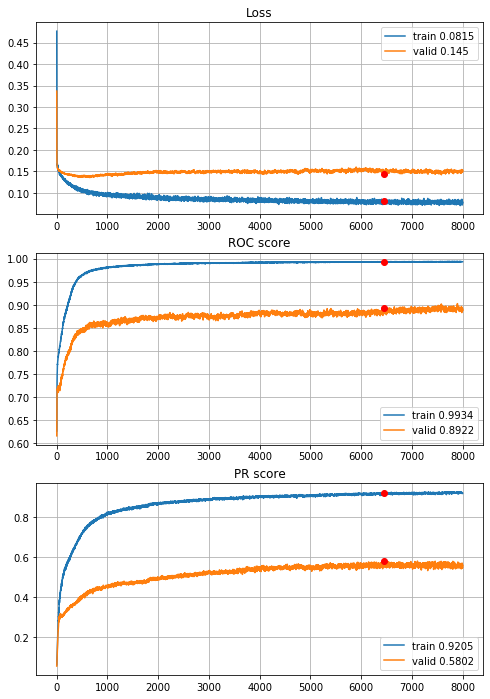


Fold 2------------------------------------------------------------


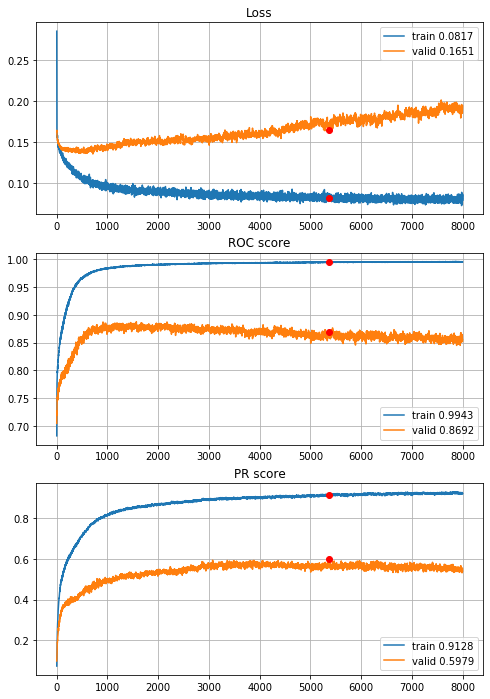


Fold 3------------------------------------------------------------


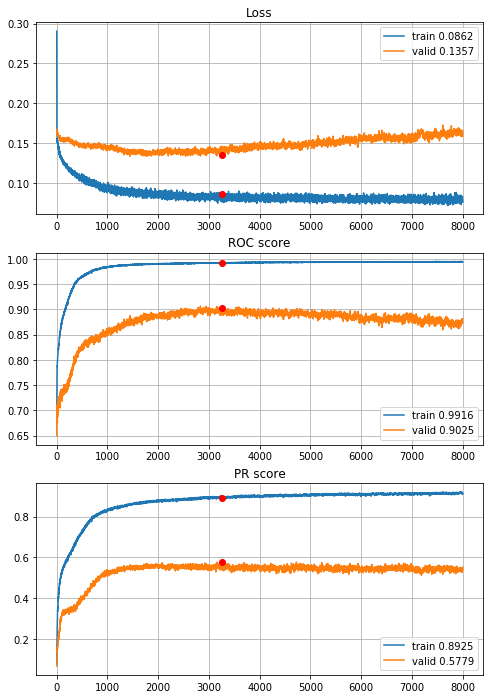


Fold 4------------------------------------------------------------


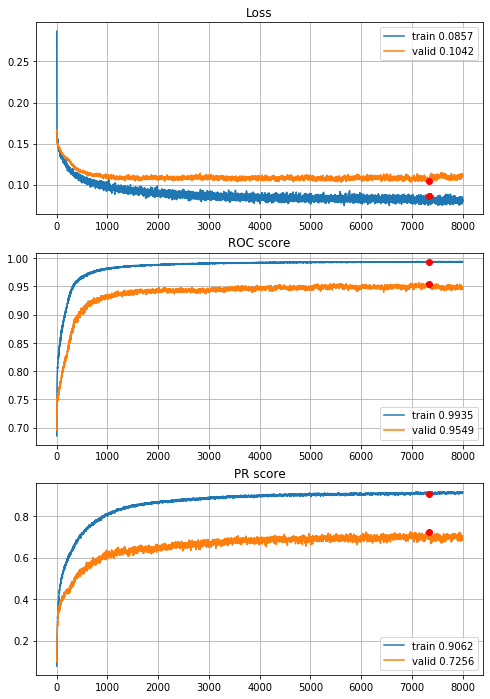


Fold 5------------------------------------------------------------


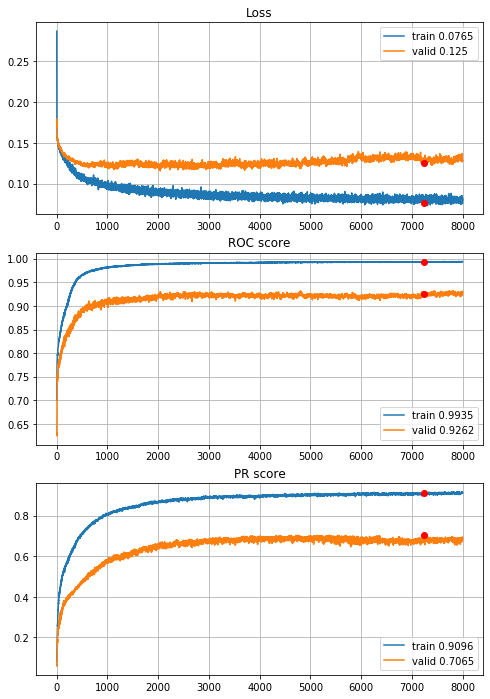


Fold 6------------------------------------------------------------


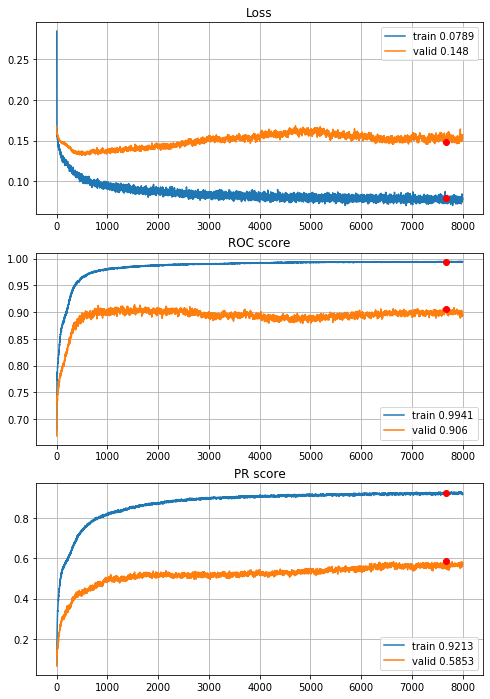

In [71]:
# L2 regu, 8000 epochs
MLPhistories = MLP_6FoldCrossValidation(datasets=sets, features=features, target=target, n_epochs=8000,
                                        batch_size=394, normalize="power", q=0.005, random_state=random_state, info=2,
                                        n_layers=2, n_units=[60,60], acti=[activations.tanh, activations.sigmoid],
                                        drop=[0.4,0.4], regu=[regularizers.l2(l=0.00005),regularizers.l2(l=0.00005)],
                                        opti=optimizers.Adam())

roc, pr, oroc, opr, stops = network_CV_results(MLPhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(MLPhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(MLPhistories[i])
    
with open(r"results\2year\MLP_L2_8000ep.p", "wb") as fp:
    pickle.dump(MLPhistories, fp)

A bit better results, it is time to stop MLPs

To sum up, the best Multilayer Percepton specification:
 - 2 layers $l^{[1]},l^{[2]}$,
 - units: $u^{[1]}=60, u^{[2]}=60$,
 - activations: $a^{[1]}:tanh,a^{[2]}:\sigma$,
 - dropout: $d^{[1]}=0.4,d^{[2]}=0.4$,
 - regularization: $r^{[1]}=L_2(0.00005), r^{[2]}=L_2(0.00005)$
 - optimizer: Adam with default setings,
 - 6843 epochs (rounded folds median, 6842.5),
 - 394 batch size.
 
 ##### Convolutional Neural Network
 - functions for Monte Carlo Energy objective quasi-minimization (Tadaaki Hosaka 2019):
 
 $$E=\sum_{(i,j)\in \xi}|\phi[R(i),R(j)]|*d(i,j) $$
 where:<br>
 $d(i,j)=(x(i)-x(j))^2+(y(i)-y(j))^2$ - distance measure, <br>
 $i,j$ - pixels indices, <br>
 $x(i), y(i)$ - $xy-$coordinates of pixel $i$, <br>
 $\xi$ - set of all pixels combinations (sample space), <br>
 $R(i)$ - financial ratio for pixel $i$,<br>
 $\phi(\cdot)$ - correlation coefficient, <br>

when randomly swapped ratio for pair of pixels can reduce energy, they're swapped. Simulation ends when there is no reduction after $\alpha N$ steps, where $N$ is number of features.<br>
The idea of image with correlated features close to each other is based on correlation matrix (below) and the fact that pixels are dependent from their neighbours on the real pictures - when we have image of black cat sitting on the white pillow, then: $$P(pixel_{i}=black|pixel_{j}=black) > P(pixel_{i}=black|pixel_{j}=white)$$ where $d(i,j)=\varepsilon$

In [36]:
# raw imputed data
X_train = train_test_imp_sets["train_set_imp"][features]
Y_train = train_test_imp_sets["train_set_imp"][target]

# normalization
sclr=scaler(images=False)
sclr.fit(X=X_train ,q=None, power_transform=False)
X_train_norm=pd.DataFrame(sclr.transform(X=X_train),columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995)
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=False)
X_train_clip_norm=pd.DataFrame(sclr.transform(X=X_train), columns=features)

# normalization with quantile clipping (Q_0.005, Q_0.995) and power transform
sclr=scaler(images=False)
sclr.fit(X=X_train, q=0.005, power_transform=True)
X_train_clip_norm_pt=pd.DataFrame(sclr.transform(X=X_train), columns=features)

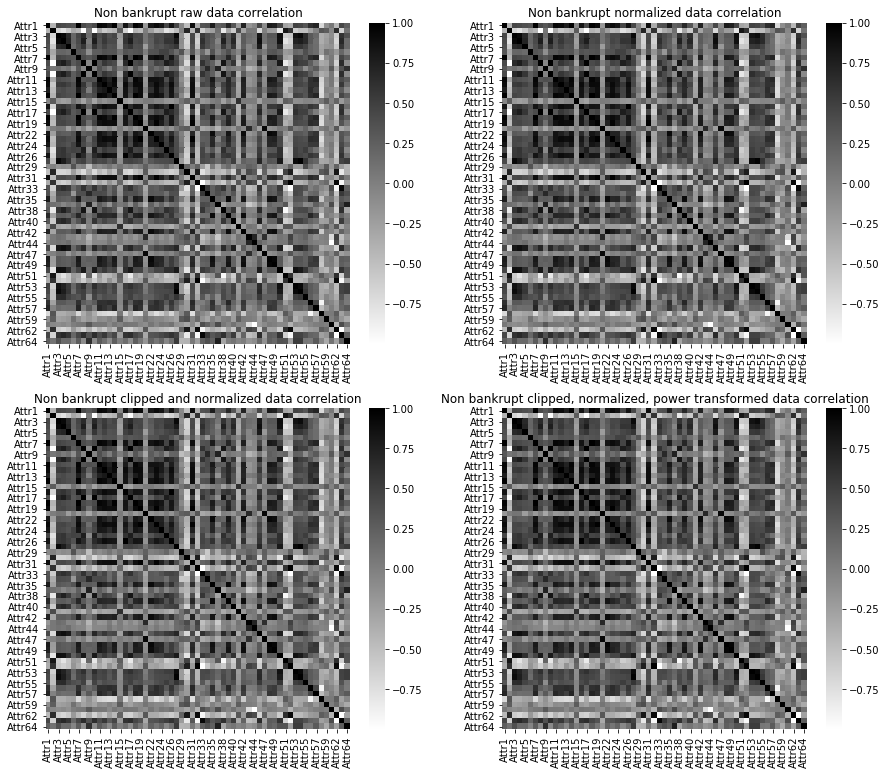

In [37]:
fig,ax=plt.subplots(nrows=2,ncols=2,figsize=(15,13))

sns.heatmap(X_train[Y_train==0].corr(method="spearman"),cmap="binary",annot=False, cbar=True, ax=ax[0,0])
ax[0,0].set_title("Non bankrupt raw data correlation")
sns.heatmap(X_train_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[0,1])
ax[0,1].set_title("Non bankrupt normalized data correlation")
sns.heatmap(X_train_clip_norm[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,0])
ax[1,0].set_title("Non bankrupt clipped and normalized data correlation")
sns.heatmap(X_train_clip_norm_pt[Y_train==0].corr(method="spearman"),cmap="binary", annot=False, cbar=True, ax=ax[1,1])
ax[1,1].set_title("Non bankrupt clipped, normalized, power transformed data correlation")

plt.show()

Analytical differences between correlation matrix variants presented above

In [38]:
corrs=[X_train[Y_train==0].corr(method="spearman"),
       X_train_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm[Y_train==0].corr(method="spearman"),
       X_train_clip_norm_pt[Y_train==0].corr(method="spearman")]

print(np.sum(np.sum(np.abs(corrs[0]-corrs[1])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[0]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[2])))/2)
print(np.sum(np.sum(np.abs(corrs[1]-corrs[3])))/2)
print(np.sum(np.sum(np.abs(corrs[2]-corrs[3])))/2)

0.0
0.0
0.0
0.0
0.0
0.0


Correlation matrix is robust to applied transformations.

In [36]:
def distance(x1, x2, y1, y2):
    '''
    function computes distance between two points (Tadaaki Hosaka 2019)
    arguments:
    x1, y2 - xy-coordinates of the first point
    x2, y2 - xy-coordinates of the second point
    
    return distance (scalar)
    '''
    d = (x1-x2)**2+(y1-y2)**2
    return d

def image_energy_v3(image, cor_matrix):
    '''
    function computes Energy for given image (Tadaaki Hosaka 2019).
    
    Energy = sum |c[R(i), R(j)]|d(i,j)
    d(i,j) = (x(i)-x(j))^2+(y(i)-y(j))^2
    where:
    i, j - indices of pixels,
    x(i), x(j) - xy coordinates of pixel,
    R(i) - feature for i,
    c[R(i), R(j)] - correlation coefficient between R(i) and R(j)
    
    arguments:
    image - dictionary (attributes names, xy coordinates) 
    corr_matrix - correlation matrix computed for analyzed data 
    
    return calculated Energy (scalar)
    ----
    188 times faster than first version
    '''
    # absolute value of correlation matrix - could be performed outside for loop
    cor_matrix = abs(cor_matrix)
    # energy inicjation
    E = 0
    # extracting features names
    for feature1 in image.keys():
        for feature2 in image.keys():
            # looking for correlation between features in previously computed (given) correlation matrix
            cor = cor_matrix.loc[feature1, feature2]
            # computing distance 
            d = distance(image[feature1][0], image[feature2][0], image[feature1][1], image[feature2][1])
            # computing energy
            E += cor*d
    
    # because of double counting returned energy is a half of computed
    # note: when feature1 = feature2 <=> distance = 0
    return E/2

def image_dict_to_matrix(image_dict):
    '''
    function converts dictionary to matrix draft of image, arguments:
    image_dict - dictionary to convert, keys: attribute, value: tuple of xy-coordinates,
    
    return matrix image draft 
    '''
    from math import ceil
    shape = ceil(len(image_dict)**(1/2))
    
#     matrix = np.zeros((shape,shape))+128
#     matrix = matrix.astype(object)
    matrix = np.zeros((shape,shape), dtype=object)+128
    for cords in list(image_dict.values()):
        matrix[cords[0], cords[1]] = list(image_dict.keys())[list(image_dict.values()).index(cords)]
    
    return matrix

def map_image(draft, example):
    '''
    function converts draft to image for concrete example, arguments:
    draft - matrix with order of features in image xy-coordinate system, matrix element must match example indices
    example - pandas.Series contains single observation - example indices must match draft values
    
    return numpy.array() - matrix with values for given example with draft order
    '''
    draft_tmp = draft.copy()
    
    for i in range(draft_tmp.shape[0]):
        for j in range(draft_tmp.shape[1]):
            attr = draft_tmp[i,j]
            draft_tmp[i,j] = example[attr] if attr != 128 else 128
    
    #draft_tmp=draft_tmp.astype(np.float)
    draft_tmp=draft_tmp.astype(np.uint8)
    
    return draft_tmp

def image_draft_inicialization(features, random_state):
    '''
    function inicializes draft in dictionary form, keys=feature names, values=position in the image space
    (xy-coordinates in the integers space), arguments:
    
    features - list of the features in dataset for which draft is inicialized,
    random_state - random seed
    
    return draft_dict (python dictionary inicialized draft)
    ----------
    Note: generated draft is for square-shaped image => range(x)=range(y)=ceil(len(features)**(1/2)), but image space
          is created like grid iterating all columns for all rows, thus if len(features) is not a perfect square then
          some potential coordinates are excluded from image space, and as conversion process progress this coordinates
          becomes placeholders, and are not consider while Monte Carlo quasi optimization. When len(features)**(1/2) - its
          ceil = 1 then there is only one placeholder - just right bottom one coordinate, when difference is in range
          [1, range(x)] then the last row of image contains placeholders, if difference is equal to range(x)+1 then 
          placeholders are the last row and new right bottom corner, if difference is in range [range(x)+1, 2*range(x)]
          then two last rows are placeholders etc. It is the best currently found solution for computing non-biased energy
          which is as low as possible.
    '''
    # seeds
    random.seed(random_state)
    np.random.seed(random_state)
    
    from math import ceil
    shape = ceil(len(features)**(1/2))

    # keys
    ks = features.copy()
    # values
    vs = []
    for i in range(shape):
        for j in range(shape):
            vs.append((i,j))
            
    # dictionary
    draft_dict = dict(zip(ks,vs))
    
    return draft_dict

def MC_Energy_optimization(corr_matrix, draft, alpha, n_eval, random_state):
    '''
    function performes Monte Carlo quasi optimization for Energy objective (Tadaaki Hosaka 2019), arguments:
    corr_matrix - correlation matrix (pandas DataFrame),
    draft - initial draft for image to optimize,
    alpha - parameter that impact on simulation duration (3 in Hosakas' article),
    n_eval - number of iteration per which current state is printed,
    random_state - random seed
    
    return ordered draft
    '''
    random.seed(random_state)
    np.random.seed(random_state)
    
    start = time.time()
    initial_energy = image_energy_v3(draft, corr_matrix)
    print("initial image energy:", round(initial_energy, 4))

    energy = initial_energy
    stop_criterion = 0
    i = 0
    while stop_criterion < alpha*len(features):
        draft_tmp = draft.copy()
        # coordinates pair sampling
        xy1, xy2 = random.sample(list(draft_tmp.values()), 2)
        # feature name under coordinates
        ft1 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy1)]
        ft2 = list(draft_tmp.keys())[list(draft_tmp.values()).index(xy2)]
        # coordinates swap
        draft_tmp[ft1] = xy2
        draft_tmp[ft2] = xy1
        # new energy
        energy_new = image_energy_v3(draft_tmp, corr_matrix)
        # saving changes
        if energy_new < energy:
            energy = energy_new
            draft = draft_tmp.copy()
            stop_criterion = 0
        else:
            stop_criterion += 1
        i += 1
        # evaluation
        if i%n_eval == 0:
            print("iteration: {}\ncurrent energy: {}".format(i, round(energy, 4)))
    
    stop = time.time()
    print("MC simulation time: {}s\nenergy after MC quasi optimization: {}".format(round(stop-start), round(energy, 4)))
    
    return draft

 - CNN definitions

In [37]:
def define_CNN(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model

def define_CNN_Adam(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid)(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model

 - 6-fold Cross Validation CNN

In [38]:
def CNN_6FoldCrossValidation(datasets, model_definition, features, target, n_epochs, batch_size, alpha, random_state,
                             normalize="power", q=None, drafts=None, instruction=None, info=None):
    '''
    function performes 6 fold Cross Validation for Multilayer Percepton keras model, argumets:
    datasets - dictionary, keys = ["training_sets", "validation_sets"], values - lists containing n-th fold sets,
    features - list of features in given datasets,
    target - target value in given datasets (string),
    n_epochs - number of epochs for training MLP model,
    batch_size - number of weight matrices updates per loop through entire, current trainin dataset,
    alpha - Monte Carlo duration parameter,
    random_state - random seed,
    info - same arguent as for network_training(),
    *args and **kwargs - arguments for create_MLP() function
    
    returns CNNhistories - list of every CNN model history 
    '''
    # seeds
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    random.seed(random_state)
    
    # datasets extraction
    training_sets = datasets["training_sets"]
    validation_sets = datasets["validation_sets"]
    
    CVstart=time.time()
    # history of CV
    CNNhistories=[]
    for fold in range(len(training_sets)):
        if info==1 or info==2:
            print("\n----------\nFold: {}\n----------".format(fold+1))

        
        if drafts is None and instruction is None:
            # ----- current fold train and validation sets ------
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- Monte Carlo energy optimization -----
            # correlation matrix for non bankrupt observations
            corr_matrix = X_train[Y_train==0].corr(method="spearman")
            # draft inicialization
            draft = image_draft_inicialization(features, random_state)
            # quasi optimization
            draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=alpha, n_eval=99999,
                                           random_state=random_state)
            # transform draft dictionary to matrix
            draft = image_dict_to_matrix(draft)
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
        
        elif drafts is not None and instruction is None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = training_sets[fold][features].copy()
            Y_train = training_sets[fold][target].copy()
            X_valid = validation_sets[fold][features].copy()
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()    
            
        elif drafts is not None and instruction is not None:
            # ----- current fold train and validation sets with feature generation -----
            X_train = generate_features(data=training_sets[fold][features], instruction=instruction)
            Y_train = training_sets[fold][target].copy()
            X_valid = generate_features(data=validation_sets[fold][features].copy(), instruction=instruction)
            Y_valid = validation_sets[fold][target].copy()
            
            # ----- loading draft from passed object -----
            draft = drafts[fold]
            
            # temporary features list
            features_tmp = X_train.columns.tolist()
            
        else:
            raise "valid options are: drafts=None and instruction=None, drafts!=None and instruction=None, drafts!=None and instruction!=None"
            
        # ----- standarization for CNN (images) -----
        if normalize==True:
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=False)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        elif normalize=="power":
            normalizer = scaler(images=True)
            normalizer.fit(X=X_train, q=q, power_transform=True)
            X_train = pd.DataFrame(normalizer.transform(X=X_train), columns=features_tmp)
            X_valid = pd.DataFrame(normalizer.transform(X=X_valid), columns=features_tmp)
        else:
            pass
            
        # ----- vector to image conversion -----
        # training set
        X_train_CNN = np.array([map_image(draft, X_train.iloc[i,:])/255 for i in range(X_train.shape[0])])
        X_train_CNN = X_train_CNN.reshape(X_train_CNN.shape+(1,))
        Y_train_CNN = Y_train.values
        # validation set
        X_valid_CNN = np.array([map_image(draft, X_valid.iloc[i,:])/255 for i in range(X_valid.shape[0])])
        X_valid_CNN = X_valid_CNN.reshape(X_valid_CNN.shape+(1,))
        Y_valid_CNN = Y_valid.values
        
        # ----- CNN training -----
        modelCNN = model_definition(input_shape=X_train_CNN.shape[1:], random_state=random_state)
        modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN, Y_train=Y_train_CNN,
                                                X_val=X_valid_CNN, Y_val=Y_valid_CNN, n_epochs=n_epochs,
                                                batch_size=batch_size, random_state=random_state, info=info)
        # ----- MLP history saving -----
        CNNhistories.append(historyCNN.copy())

    CVstop=time.time()
    print("\nCross validation time: {}s".format(round(CVstop-CVstart),2))
    
    return CNNhistories


----------
Fold: 1
----------
initial image energy: 12863.7424
MC simulation time: 98s
energy after MC quasi optimization: 8645.0904
Train on 7629 samples, validate on 1526 samples
Epoch: 1/100,
cumulative time: 2.93s train loss: 0.17932195072171572, validation loss: 0.1690389059610948
Epoch: 2/100,
cumulative time: 4.48s train loss: 0.17178212509373722, validation loss: 0.20270359631369028
Epoch: 3/100,
cumulative time: 6.04s train loss: 0.17331920676289825, validation loss: 0.1875613108472618
Epoch: 4/100,
cumulative time: 7.6s train loss: 0.1699482125748593, validation loss: 0.19693054094773912
Epoch: 5/100,
cumulative time: 9.15s train loss: 0.17215112122018678, validation loss: 0.16909165708726542
Epoch: 6/100,
cumulative time: 10.71s train loss: 0.1687340420239999, validation loss: 0.17903490382128273
Epoch: 7/100,
cumulative time: 12.25s train loss: 0.1691831873146543, validation loss: 0.16600682588384474
Epoch: 8/100,
cumulative time: 13.85s train loss: 0.16762961555838288, va

Epoch: 76/100,
cumulative time: 119.33s train loss: 0.1665555522488429, validation loss: 0.1659607533194603
Epoch: 77/100,
cumulative time: 120.88s train loss: 0.1664103887401944, validation loss: 0.16675272152355114
Epoch: 78/100,
cumulative time: 122.4s train loss: 0.16625660895590294, validation loss: 0.16583393984822115
Epoch: 79/100,
cumulative time: 123.94s train loss: 0.16619373472798837, validation loss: 0.17190441004883103
Epoch: 80/100,
cumulative time: 125.47s train loss: 0.16645137494170412, validation loss: 0.1659177905473453
Epoch: 81/100,
cumulative time: 126.99s train loss: 0.16651314075878493, validation loss: 0.1660223896194098
Epoch: 82/100,
cumulative time: 128.54s train loss: 0.16649995432688816, validation loss: 0.1663446764938953
Epoch: 83/100,
cumulative time: 130.06s train loss: 0.1667198192649032, validation loss: 0.16576605311657155
Epoch: 84/100,
cumulative time: 131.61s train loss: 0.16626327655069761, validation loss: 0.1669727213299915
Epoch: 85/100,
cumu

Epoch: 48/100,
cumulative time: 74.47s train loss: 0.16645276057585803, validation loss: 0.1683493961200489
Epoch: 49/100,
cumulative time: 76.04s train loss: 0.1665163130385525, validation loss: 0.17012228089266335
Epoch: 50/100,
cumulative time: 77.57s train loss: 0.16724752141281168, validation loss: 0.16801959424625063
Epoch: 51/100,
cumulative time: 79.12s train loss: 0.1668988087981537, validation loss: 0.16620440433487824
Epoch: 52/100,
cumulative time: 80.65s train loss: 0.16656694696113314, validation loss: 0.1664001753609896
Epoch: 53/100,
cumulative time: 82.19s train loss: 0.16643172234730416, validation loss: 0.16579424782239907
Epoch: 54/100,
cumulative time: 83.72s train loss: 0.1662120116535935, validation loss: 0.16604710672036066
Epoch: 55/100,
cumulative time: 85.26s train loss: 0.16666553149273017, validation loss: 0.16617569876139004
Epoch: 56/100,
cumulative time: 86.8s train loss: 0.16660981266217925, validation loss: 0.16625923781532448
Epoch: 57/100,
cumulative

Epoch: 20/100,
cumulative time: 31.92s train loss: 0.16407843440603126, validation loss: 0.1663912835080533
Epoch: 21/100,
cumulative time: 33.48s train loss: 0.16249024510571117, validation loss: 0.1638560681597746
Epoch: 22/100,
cumulative time: 35.02s train loss: 0.1633155382031897, validation loss: 0.16289872304093322
Epoch: 23/100,
cumulative time: 36.58s train loss: 0.16185233390906298, validation loss: 0.16279225174440157
Epoch: 24/100,
cumulative time: 38.13s train loss: 0.16141534423723433, validation loss: 0.1627860999865113
Epoch: 25/100,
cumulative time: 39.69s train loss: 0.1624778645563085, validation loss: 0.1661437131747662
Epoch: 26/100,
cumulative time: 41.25s train loss: 0.1624794753808184, validation loss: 0.16636934815899884
Epoch: 27/100,
cumulative time: 42.79s train loss: 0.16154864791383716, validation loss: 0.16285503273866436
Epoch: 28/100,
cumulative time: 44.34s train loss: 0.16126268267483085, validation loss: 0.16760392281987252
Epoch: 29/100,
cumulative 

Epoch: 96/100,
cumulative time: 150.77s train loss: 0.1334408892491711, validation loss: 0.14081798278058966
Epoch: 97/100,
cumulative time: 152.32s train loss: 0.13073367416479748, validation loss: 0.15746783333321543
Epoch: 98/100,
cumulative time: 153.88s train loss: 0.12879648763353882, validation loss: 0.14348248831761773
Epoch: 99/100,
cumulative time: 155.5s train loss: 0.1308478204298338, validation loss: 0.14561893809513526
Epoch: 100/100,
cumulative time: 157.04s train loss: 0.1318177909356283, validation loss: 0.1560186777229703

Early stopping results:
best results in epoch: 99, 
best valid PR: 0.16131858044786654, 
valid ROC: 0.8085720782173715        
overfitting PR: 0.15949877625750095, 
overfitting ROC: 0.07282783991607089

----------
Fold: 4
----------
initial image energy: 12843.5396
MC simulation time: 90s
energy after MC quasi optimization: 8424.0387
Train on 7629 samples, validate on 1526 samples
Epoch: 1/100,
cumulative time: 2.39s train loss: 0.17822142015678227,

Epoch: 69/100,
cumulative time: 107.09s train loss: 0.16154175287759356, validation loss: 0.162482443869817
Epoch: 70/100,
cumulative time: 108.62s train loss: 0.16132520220666902, validation loss: 0.16317418258671368
Epoch: 71/100,
cumulative time: 110.22s train loss: 0.16086316681780125, validation loss: 0.16593363549106244
Epoch: 72/100,
cumulative time: 111.79s train loss: 0.16045317659685568, validation loss: 0.1609335620039256
Epoch: 73/100,
cumulative time: 113.32s train loss: 0.1602823387195186, validation loss: 0.1606752068429287
Epoch: 74/100,
cumulative time: 114.85s train loss: 0.16087733339803967, validation loss: 0.1638402381660429
Epoch: 75/100,
cumulative time: 116.37s train loss: 0.1608998838962023, validation loss: 0.16045103605890337
Epoch: 76/100,
cumulative time: 117.91s train loss: 0.1606094407889177, validation loss: 0.16085571974398738
Epoch: 77/100,
cumulative time: 119.45s train loss: 0.16022079077698578, validation loss: 0.16116989889276137
Epoch: 78/100,
cum

Epoch: 41/100,
cumulative time: 63.26s train loss: 0.15710917250277065, validation loss: 0.16831211866823123
Epoch: 42/100,
cumulative time: 64.8s train loss: 0.15777879713528245, validation loss: 0.16625217144251808
Epoch: 43/100,
cumulative time: 66.32s train loss: 0.15621223209577426, validation loss: 0.16479538840047653
Epoch: 44/100,
cumulative time: 67.85s train loss: 0.1571984831924941, validation loss: 0.16536326388075342
Epoch: 45/100,
cumulative time: 69.38s train loss: 0.1567869366059095, validation loss: 0.17044171622586907
Epoch: 46/100,
cumulative time: 70.91s train loss: 0.1567856722729502, validation loss: 0.1685232912064536
Epoch: 47/100,
cumulative time: 72.44s train loss: 0.15646592290994615, validation loss: 0.16782738180491746
Epoch: 48/100,
cumulative time: 73.96s train loss: 0.15629553796911727, validation loss: 0.17207753474715495
Epoch: 49/100,
cumulative time: 75.5s train loss: 0.1564272667957268, validation loss: 0.16704405264179484
Epoch: 50/100,
cumulative 

Epoch: 13/100,
cumulative time: 20.6s train loss: 0.1668428711075614, validation loss: 0.16677613438152877
Epoch: 14/100,
cumulative time: 22.12s train loss: 0.16676541928343505, validation loss: 0.16607672067939258
Epoch: 15/100,
cumulative time: 23.64s train loss: 0.16638633192054253, validation loss: 0.1670966567758654
Epoch: 16/100,
cumulative time: 25.14s train loss: 0.16690147595863356, validation loss: 0.1663982207853286
Epoch: 17/100,
cumulative time: 26.65s train loss: 0.16611661692082805, validation loss: 0.1658758810504538
Epoch: 18/100,
cumulative time: 28.15s train loss: 0.16663473814647756, validation loss: 0.16747435220929444
Epoch: 19/100,
cumulative time: 29.66s train loss: 0.16614360398421282, validation loss: 0.16749360960037982
Epoch: 20/100,
cumulative time: 31.17s train loss: 0.1664101966633553, validation loss: 0.16592785780547095
Epoch: 21/100,
cumulative time: 32.69s train loss: 0.16645567482178678, validation loss: 0.16589018270617625
Epoch: 22/100,
cumulative

Epoch: 89/100,
cumulative time: 136.66s train loss: 0.1594296460851617, validation loss: 0.16044968871796716
Epoch: 90/100,
cumulative time: 138.18s train loss: 0.15895626001050245, validation loss: 0.16108941171012942
Epoch: 91/100,
cumulative time: 139.7s train loss: 0.15871729679884167, validation loss: 0.1665111592949414
Epoch: 92/100,
cumulative time: 141.23s train loss: 0.15913888837453735, validation loss: 0.1603955135384544
Epoch: 93/100,
cumulative time: 142.77s train loss: 0.15762368373445884, validation loss: 0.16354300639668448
Epoch: 94/100,
cumulative time: 144.3s train loss: 0.15885473464958633, validation loss: 0.16291027554723084
Epoch: 95/100,
cumulative time: 145.8s train loss: 0.15879787338475257, validation loss: 0.1645642920107138
Epoch: 96/100,
cumulative time: 147.32s train loss: 0.15838823114591377, validation loss: 0.1609470439054927
Epoch: 97/100,
cumulative time: 148.83s train loss: 0.15813131315797216, validation loss: 0.15975430973240587
Epoch: 98/100,
cum

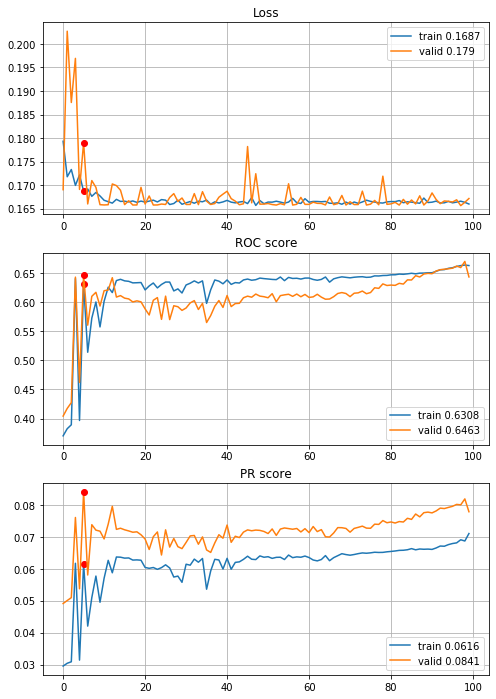


Fold 2------------------------------------------------------------


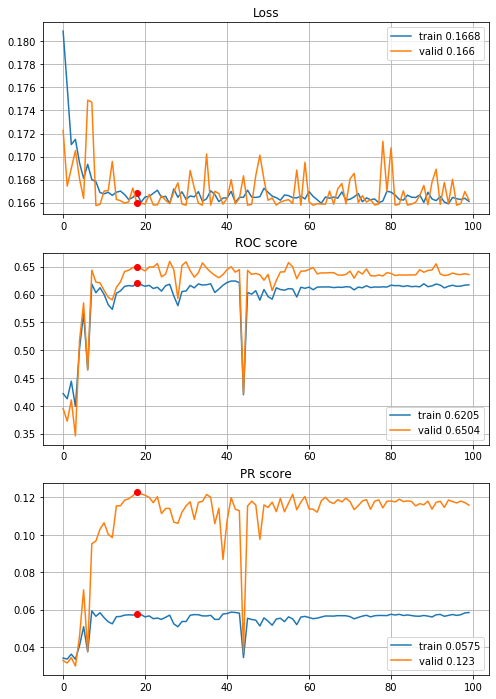


Fold 3------------------------------------------------------------


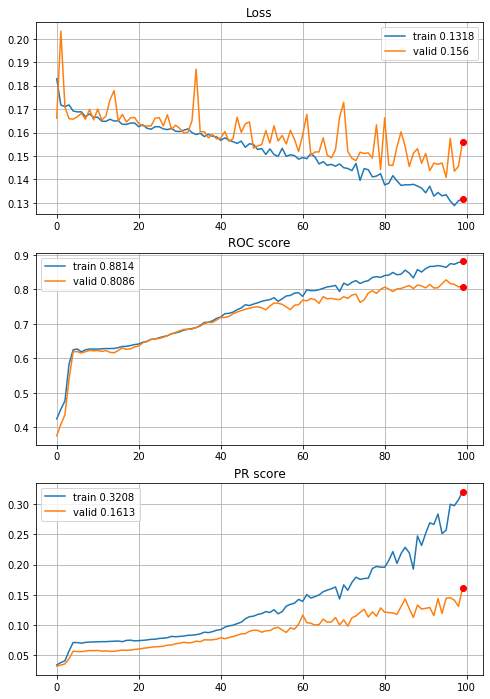


Fold 4------------------------------------------------------------


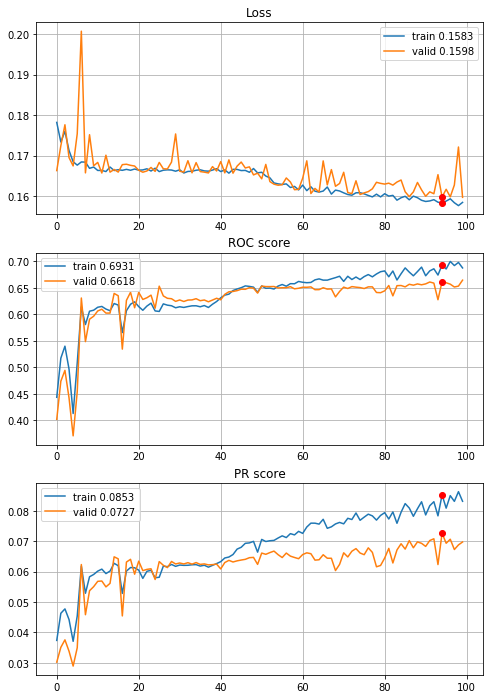


Fold 5------------------------------------------------------------


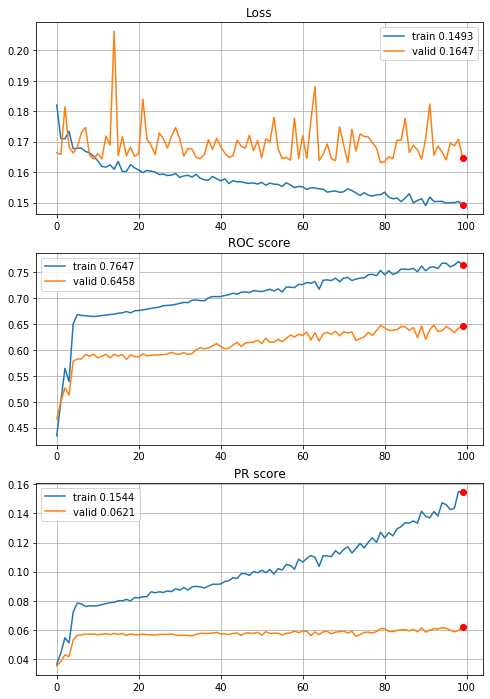


Fold 6------------------------------------------------------------


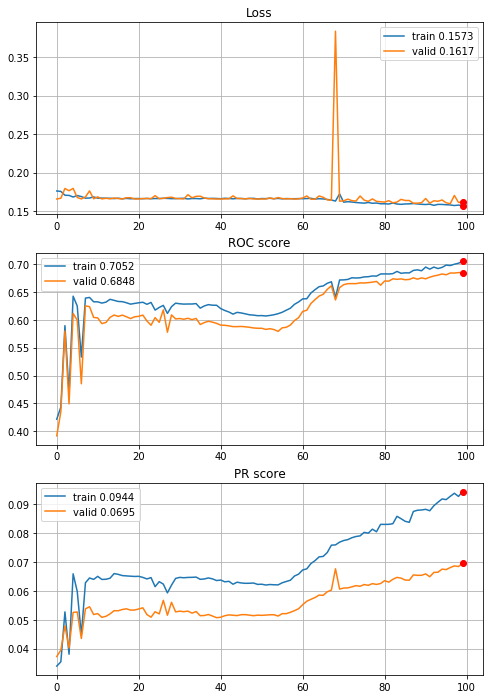

In [79]:
# first CNN only normalization applied
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=None, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Terrible results and learning curves


----------
Fold: 1
----------
initial image energy: 12863.7424
MC simulation time: 98s
energy after MC quasi optimization: 8645.0904
Train on 7629 samples, validate on 1526 samples
Epoch: 1/100,
cumulative time: 6.18s train loss: 0.17923007008366543, validation loss: 0.16871990138471984
Epoch: 2/100,
cumulative time: 7.78s train loss: 0.1724366856708894, validation loss: 0.2052332764274171
Epoch: 3/100,
cumulative time: 9.38s train loss: 0.17077354177967377, validation loss: 0.18389485594798197
Epoch: 4/100,
cumulative time: 10.96s train loss: 0.16633443296080663, validation loss: 0.20770853617244436
Epoch: 5/100,
cumulative time: 12.55s train loss: 0.16812807274475716, validation loss: 0.16481403215528315
Epoch: 6/100,
cumulative time: 14.12s train loss: 0.16419202681332495, validation loss: 0.17527476226517913
Epoch: 7/100,
cumulative time: 15.72s train loss: 0.16436076222061094, validation loss: 0.1604568456662123
Epoch: 8/100,
cumulative time: 17.31s train loss: 0.1625540497206050

Epoch: 75/100,
cumulative time: 124.86s train loss: 0.08946883321093582, validation loss: 0.23418907840708136
Epoch: 76/100,
cumulative time: 126.43s train loss: 0.08655047987224328, validation loss: 0.1754600104838024
Epoch: 77/100,
cumulative time: 127.99s train loss: 0.08571625280202896, validation loss: 0.1911636786254643
Epoch: 78/100,
cumulative time: 129.57s train loss: 0.07976324493127736, validation loss: 0.17975954011297476
Epoch: 79/100,
cumulative time: 131.13s train loss: 0.07801102773614911, validation loss: 0.2921282514285291
Epoch: 80/100,
cumulative time: 132.7s train loss: 0.08415029301061623, validation loss: 0.1742332917424517
Epoch: 81/100,
cumulative time: 134.27s train loss: 0.0790074621963851, validation loss: 0.18066220023567992
Epoch: 82/100,
cumulative time: 135.87s train loss: 0.078843357866472, validation loss: 0.18371760252457928
Epoch: 83/100,
cumulative time: 137.44s train loss: 0.08373996805165758, validation loss: 0.16531793240013473
Epoch: 84/100,
cum

Epoch: 48/100,
cumulative time: 76.7s train loss: 0.11288128732787249, validation loss: 0.16289403892047752
Epoch: 49/100,
cumulative time: 78.31s train loss: 0.11291918022391337, validation loss: 0.19920601149920866
Epoch: 50/100,
cumulative time: 79.94s train loss: 0.1190421404042349, validation loss: 0.166346046238708
Epoch: 51/100,
cumulative time: 81.58s train loss: 0.11066474961154754, validation loss: 0.1614859425615358
Epoch: 52/100,
cumulative time: 83.16s train loss: 0.10694007500898699, validation loss: 0.1586161734900031
Epoch: 53/100,
cumulative time: 84.72s train loss: 0.1080547829408495, validation loss: 0.15521375424818162
Epoch: 54/100,
cumulative time: 86.27s train loss: 0.11083857758393809, validation loss: 0.16326016816524191
Epoch: 55/100,
cumulative time: 87.83s train loss: 0.10691124501520066, validation loss: 0.17468848541320386
Epoch: 56/100,
cumulative time: 89.4s train loss: 0.10586531272384846, validation loss: 0.15803873380780376
Epoch: 57/100,
cumulative t

Epoch: 20/100,
cumulative time: 32.35s train loss: 0.1487728212463823, validation loss: 0.15393119706707575
Epoch: 21/100,
cumulative time: 33.92s train loss: 0.1433590737105916, validation loss: 0.15135856319419053
Epoch: 22/100,
cumulative time: 35.49s train loss: 0.14572010752702858, validation loss: 0.1487944328945086
Epoch: 23/100,
cumulative time: 37.06s train loss: 0.1419635491194427, validation loss: 0.15345723489555743
Epoch: 24/100,
cumulative time: 38.64s train loss: 0.14183690712521937, validation loss: 0.15216176653205177
Epoch: 25/100,
cumulative time: 40.23s train loss: 0.14237785121961413, validation loss: 0.15901934262731285
Epoch: 26/100,
cumulative time: 41.81s train loss: 0.14162418561129259, validation loss: 0.15786336299866868
Epoch: 27/100,
cumulative time: 43.38s train loss: 0.13965422148855475, validation loss: 0.15285923281198716
Epoch: 28/100,
cumulative time: 44.96s train loss: 0.13760707659925447, validation loss: 0.1680963920382966
Epoch: 29/100,
cumulativ

Epoch: 96/100,
cumulative time: 152.6s train loss: 0.06732093294363907, validation loss: 0.19683035442588526
Epoch: 97/100,
cumulative time: 154.17s train loss: 0.06685782795795639, validation loss: 0.20891545986363647
Epoch: 98/100,
cumulative time: 155.74s train loss: 0.06838758744964485, validation loss: 0.20905078594056525
Epoch: 99/100,
cumulative time: 157.31s train loss: 0.06713422211364393, validation loss: 0.20907568187498016
Epoch: 100/100,
cumulative time: 158.87s train loss: 0.06690457577137542, validation loss: 0.20954508335374755

Early stopping results:
best results in epoch: 90, 
best valid PR: 0.20080648323367062, 
valid ROC: 0.7690427467030468        
overfitting PR: 0.5865362743888674, 
overfitting ROC: 0.2089772196407017

----------
Fold: 4
----------
initial image energy: 12843.5396
MC simulation time: 89s
energy after MC quasi optimization: 8424.0387
Train on 7629 samples, validate on 1526 samples
Epoch: 1/100,
cumulative time: 2.38s train loss: 0.1782245174478087

Epoch: 69/100,
cumulative time: 118.17s train loss: 0.08848983700451758, validation loss: 0.16243785424438717
Epoch: 70/100,
cumulative time: 119.95s train loss: 0.08648017443680392, validation loss: 0.16818755673705985
Epoch: 71/100,
cumulative time: 121.64s train loss: 0.08451525709359982, validation loss: 0.1875946825055276
Epoch: 72/100,
cumulative time: 123.31s train loss: 0.08633906177581646, validation loss: 0.17020698688523953
Epoch: 73/100,
cumulative time: 125.04s train loss: 0.08282098858212562, validation loss: 0.2309317996586291
Epoch: 74/100,
cumulative time: 126.7s train loss: 0.08368278653316345, validation loss: 0.17935456351168347
Epoch: 75/100,
cumulative time: 128.38s train loss: 0.08052689619660221, validation loss: 0.1692116852473775
Epoch: 76/100,
cumulative time: 130.08s train loss: 0.08215505073987449, validation loss: 0.16962829257604492
Epoch: 77/100,
cumulative time: 131.88s train loss: 0.07796281599497668, validation loss: 0.2273325996661405
Epoch: 78/100,


Epoch: 41/100,
cumulative time: 71.06s train loss: 0.12017052359893667, validation loss: 0.15594298782151775
Epoch: 42/100,
cumulative time: 72.75s train loss: 0.11691202976562542, validation loss: 0.1794335299597499
Epoch: 43/100,
cumulative time: 74.42s train loss: 0.11625797657310954, validation loss: 0.16292391613926518
Epoch: 44/100,
cumulative time: 76.02s train loss: 0.11815045770174211, validation loss: 0.15132119105262182
Epoch: 45/100,
cumulative time: 77.58s train loss: 0.11555459000720064, validation loss: 0.1608073469617576
Epoch: 46/100,
cumulative time: 79.14s train loss: 0.11520295926605456, validation loss: 0.19512255485920263
Epoch: 47/100,
cumulative time: 80.75s train loss: 0.11503285904991031, validation loss: 0.15751259446847174
Epoch: 48/100,
cumulative time: 82.3s train loss: 0.11376114316486816, validation loss: 0.15110162162218307
Epoch: 49/100,
cumulative time: 83.85s train loss: 0.10915158674861175, validation loss: 0.16315170894053474
Epoch: 50/100,
cumulat

Epoch: 13/100,
cumulative time: 22.46s train loss: 0.1579444667165745, validation loss: 0.15950433019731866
Epoch: 14/100,
cumulative time: 24.17s train loss: 0.15588242971139374, validation loss: 0.15563816736956113
Epoch: 15/100,
cumulative time: 25.83s train loss: 0.15551422029382123, validation loss: 0.1623305428614382
Epoch: 16/100,
cumulative time: 27.43s train loss: 0.1547890942441214, validation loss: 0.15408884898560946
Epoch: 17/100,
cumulative time: 29.06s train loss: 0.1507800076884336, validation loss: 0.15315974516946762
Epoch: 18/100,
cumulative time: 30.65s train loss: 0.1504007550749835, validation loss: 0.1725087917828169
Epoch: 19/100,
cumulative time: 32.2s train loss: 0.14758297888315522, validation loss: 0.16683746714083875
Epoch: 20/100,
cumulative time: 33.99s train loss: 0.14646578691069764, validation loss: 0.1489732357029055
Epoch: 21/100,
cumulative time: 35.71s train loss: 0.1438526828139825, validation loss: 0.15016369979889665
Epoch: 22/100,
cumulative ti

Epoch: 89/100,
cumulative time: 148.95s train loss: 0.07425681223816984, validation loss: 0.1864872117218424
Epoch: 90/100,
cumulative time: 150.57s train loss: 0.07100601317763797, validation loss: 0.16766704924771042
Epoch: 91/100,
cumulative time: 152.21s train loss: 0.07343283096721413, validation loss: 0.22935632819035015
Epoch: 92/100,
cumulative time: 153.94s train loss: 0.07542055064414385, validation loss: 0.2315701592457099
Epoch: 93/100,
cumulative time: 155.58s train loss: 0.069318832234427, validation loss: 0.18299581480807944
Epoch: 94/100,
cumulative time: 157.29s train loss: 0.06775588590949579, validation loss: 0.18201622997151046
Epoch: 95/100,
cumulative time: 158.92s train loss: 0.07143007878697481, validation loss: 0.17880929284408445
Epoch: 96/100,
cumulative time: 160.67s train loss: 0.06416712389138392, validation loss: 0.21720248832077277
Epoch: 97/100,
cumulative time: 162.33s train loss: 0.07736611071178204, validation loss: 0.18064820439111992
Epoch: 98/100,

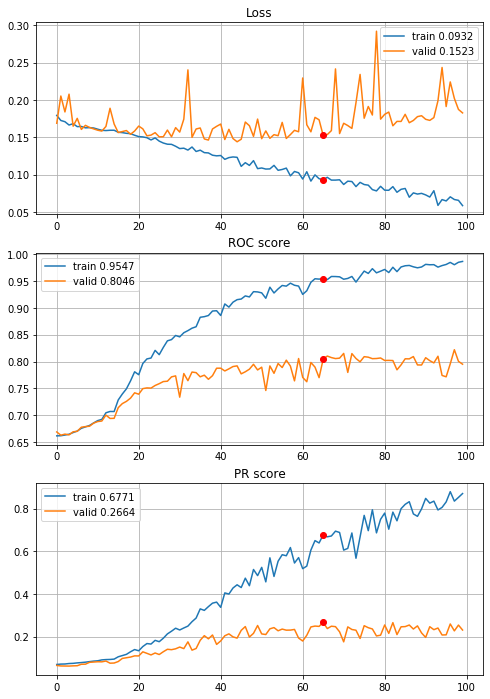


Fold 2------------------------------------------------------------


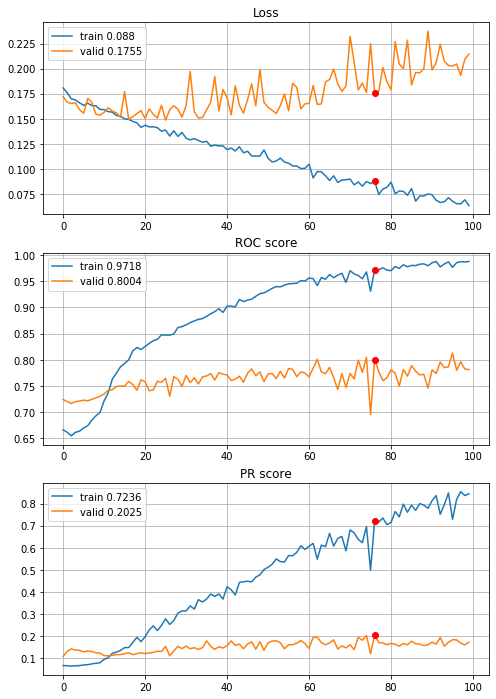


Fold 3------------------------------------------------------------


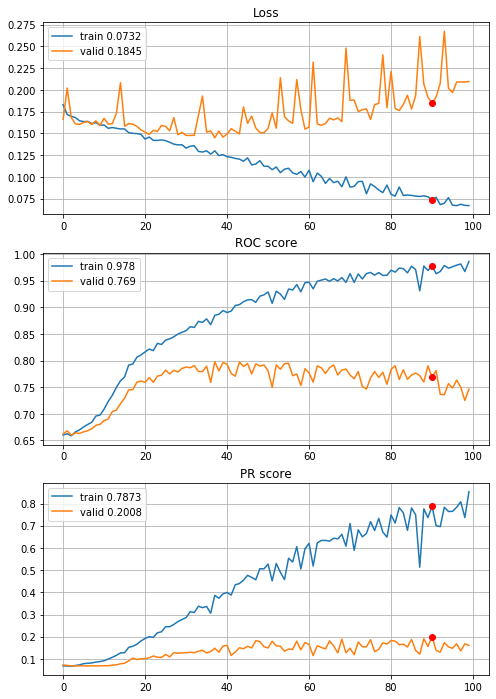


Fold 4------------------------------------------------------------


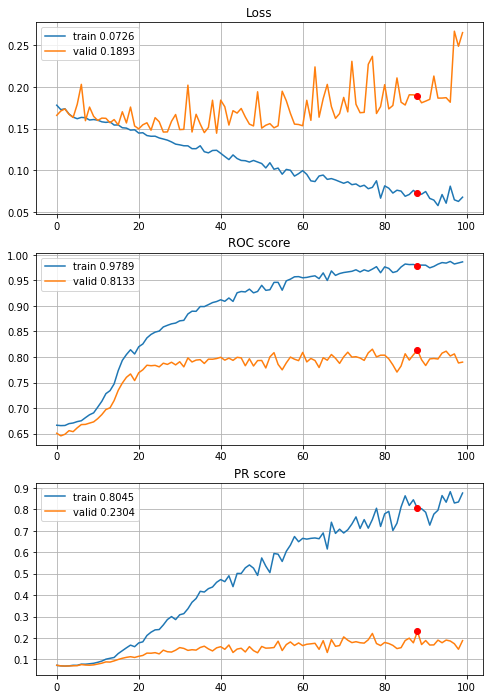


Fold 5------------------------------------------------------------


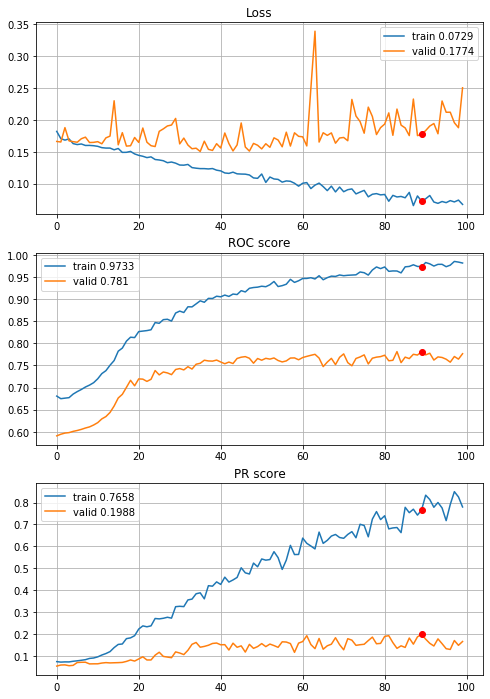


Fold 6------------------------------------------------------------


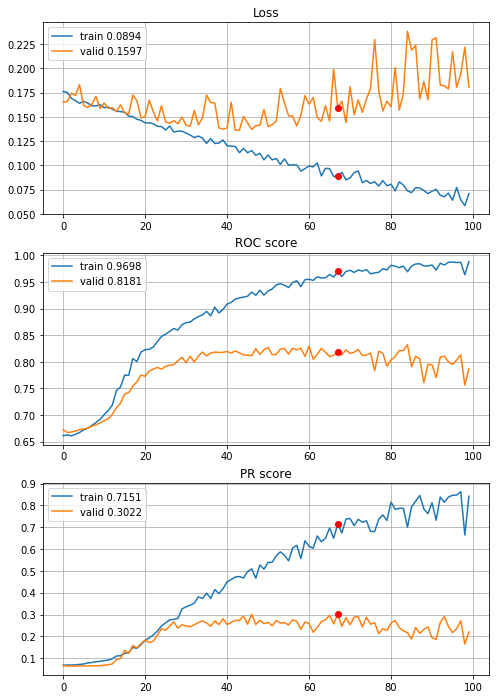

In [80]:
# first CNN with quantile clipping (Q_0.005, Q_0.995) and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize=True, q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Huge improvement, +0.13 on PR, bigger overfitting, but seems like architecture is not appropriate. Lets try with power transform added.


----------
Fold: 1
----------
initial image energy: 12863.7424
MC simulation time: 104s
energy after MC quasi optimization: 8645.0904
Train on 7629 samples, validate on 1526 samples
Epoch: 1/100,
cumulative time: 2.46s train loss: 0.1791450042198957, validation loss: 0.16847733806618545
Epoch: 2/100,
cumulative time: 4.08s train loss: 0.17205179785741456, validation loss: 0.20387699207972104
Epoch: 3/100,
cumulative time: 5.69s train loss: 0.17063801204069115, validation loss: 0.1846992216935945
Epoch: 4/100,
cumulative time: 7.41s train loss: 0.16549606361876998, validation loss: 0.2092253085357646
Epoch: 5/100,
cumulative time: 9.01s train loss: 0.16777192606598135, validation loss: 0.1642758679108726
Epoch: 6/100,
cumulative time: 10.68s train loss: 0.16392348701253226, validation loss: 0.17427398881546635
Epoch: 7/100,
cumulative time: 12.27s train loss: 0.16400705457225917, validation loss: 0.15981014816976624
Epoch: 8/100,
cumulative time: 13.86s train loss: 0.16220835137510226,

Epoch: 75/100,
cumulative time: 124.06s train loss: 0.06966342251986629, validation loss: 0.23170970905655178
Epoch: 76/100,
cumulative time: 125.65s train loss: 0.06347205850146423, validation loss: 0.20678662878813936
Epoch: 77/100,
cumulative time: 127.21s train loss: 0.06109197426043858, validation loss: 0.23902225586174355
Epoch: 78/100,
cumulative time: 128.78s train loss: 0.06893940816679427, validation loss: 0.17404016690282334
Epoch: 79/100,
cumulative time: 130.48s train loss: 0.057690544709463644, validation loss: 0.3684142910012411
Epoch: 80/100,
cumulative time: 132.1s train loss: 0.06217840412402859, validation loss: 0.17476570361133953
Epoch: 81/100,
cumulative time: 133.69s train loss: 0.05407625234819268, validation loss: 0.19356085179400476
Epoch: 82/100,
cumulative time: 135.27s train loss: 0.06121890382715002, validation loss: 0.2009266102064015
Epoch: 83/100,
cumulative time: 136.82s train loss: 0.06854161890759539, validation loss: 0.17722637927938414
Epoch: 84/10

Epoch: 47/100,
cumulative time: 77.33s train loss: 0.08778929855415214, validation loss: 0.22144252600863595
Epoch: 48/100,
cumulative time: 79.02s train loss: 0.09299303443880472, validation loss: 0.16775681793221014
Epoch: 49/100,
cumulative time: 80.65s train loss: 0.09473477343827591, validation loss: 0.17078714312919627
Epoch: 50/100,
cumulative time: 82.36s train loss: 0.09592148699017743, validation loss: 0.18318060634176822
Epoch: 51/100,
cumulative time: 83.91s train loss: 0.08496476379356842, validation loss: 0.16689045013442422
Epoch: 52/100,
cumulative time: 85.46s train loss: 0.08443049055097268, validation loss: 0.15411826382302052
Epoch: 53/100,
cumulative time: 86.98s train loss: 0.08876096531563216, validation loss: 0.15086541972263456
Epoch: 54/100,
cumulative time: 88.53s train loss: 0.09021103147674644, validation loss: 0.15422853422235225
Epoch: 55/100,
cumulative time: 90.11s train loss: 0.0808832642281332, validation loss: 0.16744915109865005
Epoch: 56/100,
cumul

Epoch: 19/100,
cumulative time: 30.82s train loss: 0.14167193773592388, validation loss: 0.1666650365095776
Epoch: 20/100,
cumulative time: 32.37s train loss: 0.14059437736956754, validation loss: 0.15411772214725789
Epoch: 21/100,
cumulative time: 33.91s train loss: 0.13195682831107594, validation loss: 0.1555547236829879
Epoch: 22/100,
cumulative time: 35.45s train loss: 0.13407948379756301, validation loss: 0.14704773010659186
Epoch: 23/100,
cumulative time: 36.98s train loss: 0.13280797655612273, validation loss: 0.14868455334306543
Epoch: 24/100,
cumulative time: 38.54s train loss: 0.12598866149578045, validation loss: 0.1503115937426237
Epoch: 25/100,
cumulative time: 40.08s train loss: 0.12635776458479253, validation loss: 0.1646201839648568
Epoch: 26/100,
cumulative time: 41.62s train loss: 0.13002746347823826, validation loss: 0.15701642177442424
Epoch: 27/100,
cumulative time: 43.18s train loss: 0.12348830847486879, validation loss: 0.14533618734087575
Epoch: 28/100,
cumulati

Epoch: 95/100,
cumulative time: 154.45s train loss: 0.04708888060413911, validation loss: 0.21607719680116186
Epoch: 96/100,
cumulative time: 156.14s train loss: 0.05163924238608039, validation loss: 0.19084411410329227
Epoch: 97/100,
cumulative time: 157.81s train loss: 0.04311254751515867, validation loss: 0.18220185462097352
Epoch: 98/100,
cumulative time: 159.36s train loss: 0.04023394933750962, validation loss: 0.20855737107453154
Epoch: 99/100,
cumulative time: 161.03s train loss: 0.04361308449853653, validation loss: 0.19028885656696784
Epoch: 100/100,
cumulative time: 162.6s train loss: 0.04531993841741911, validation loss: 0.2078855808917067

Early stopping results:
best results in epoch: 90, 
best valid PR: 0.33657676002240844, 
valid ROC: 0.816587085038654        
overfitting PR: 0.6134018319033203, 
overfitting ROC: 0.1785752836337433

----------
Fold: 4
----------
initial image energy: 12843.5396
MC simulation time: 96s
energy after MC quasi optimization: 8424.0387
Train o

Epoch: 68/100,
cumulative time: 112.82s train loss: 0.07444695868577111, validation loss: 0.13806330751466564
Epoch: 69/100,
cumulative time: 114.48s train loss: 0.0685953555965833, validation loss: 0.12658176585778028
Epoch: 70/100,
cumulative time: 116.08s train loss: 0.05954065710757363, validation loss: 0.13900667826399735
Epoch: 71/100,
cumulative time: 117.7s train loss: 0.06678982614603654, validation loss: 0.1986345339610411
Epoch: 72/100,
cumulative time: 119.32s train loss: 0.06569544576730559, validation loss: 0.1431616202660813
Epoch: 73/100,
cumulative time: 120.92s train loss: 0.05651909310792092, validation loss: 0.18870777586965698
Epoch: 74/100,
cumulative time: 122.52s train loss: 0.07001553483669685, validation loss: 0.16016125600897313
Epoch: 75/100,
cumulative time: 124.13s train loss: 0.06327585838388405, validation loss: 0.14146491939868402
Epoch: 76/100,
cumulative time: 125.74s train loss: 0.06317729818264675, validation loss: 0.17374613314749843
Epoch: 77/100,

Epoch: 40/100,
cumulative time: 67.94s train loss: 0.11240020382801223, validation loss: 0.15331967298043978
Epoch: 41/100,
cumulative time: 69.63s train loss: 0.10944258832422898, validation loss: 0.14201425832267825
Epoch: 42/100,
cumulative time: 71.28s train loss: 0.1061740460455113, validation loss: 0.156982244408615
Epoch: 43/100,
cumulative time: 72.95s train loss: 0.10534784314707889, validation loss: 0.1394594390809458
Epoch: 44/100,
cumulative time: 74.64s train loss: 0.09869797695767506, validation loss: 0.13420329753646376
Epoch: 45/100,
cumulative time: 76.28s train loss: 0.10373424211274532, validation loss: 0.14367281449262936
Epoch: 46/100,
cumulative time: 77.92s train loss: 0.1032969682914571, validation loss: 0.1818915281547319
Epoch: 47/100,
cumulative time: 79.57s train loss: 0.10015226354162571, validation loss: 0.15164067755364186
Epoch: 48/100,
cumulative time: 81.26s train loss: 0.10336050382895993, validation loss: 0.13494926142270725
Epoch: 49/100,
cumulative

Epoch: 12/100,
cumulative time: 22.11s train loss: 0.15868586467415446, validation loss: 0.15925951962588264
Epoch: 13/100,
cumulative time: 23.93s train loss: 0.15605234040306248, validation loss: 0.15780372039216464
Epoch: 14/100,
cumulative time: 25.52s train loss: 0.15362641351251113, validation loss: 0.15529599667572586
Epoch: 15/100,
cumulative time: 27.1s train loss: 0.15299213961215977, validation loss: 0.16122103674489943
Epoch: 16/100,
cumulative time: 28.66s train loss: 0.15148259356207805, validation loss: 0.1529621413301249
Epoch: 17/100,
cumulative time: 30.24s train loss: 0.14601354707779454, validation loss: 0.15384522665719516
Epoch: 18/100,
cumulative time: 31.88s train loss: 0.14558428585490268, validation loss: 0.1936446633299843
Epoch: 19/100,
cumulative time: 33.7s train loss: 0.14142721343790407, validation loss: 0.18114659052403248
Epoch: 20/100,
cumulative time: 35.52s train loss: 0.14036834037046134, validation loss: 0.1491287203108678
Epoch: 21/100,
cumulativ

Epoch: 88/100,
cumulative time: 148.42s train loss: 0.057903650035620285, validation loss: 0.16406695626798223
Epoch: 89/100,
cumulative time: 150.05s train loss: 0.05268981423019035, validation loss: 0.24134761999865048
Epoch: 90/100,
cumulative time: 151.64s train loss: 0.05358742933725233, validation loss: 0.17463156574085112
Epoch: 91/100,
cumulative time: 153.24s train loss: 0.05312323226870513, validation loss: 0.17582855336978787
Epoch: 92/100,
cumulative time: 154.8s train loss: 0.04383877257268441, validation loss: 0.1835194221090098
Epoch: 93/100,
cumulative time: 156.37s train loss: 0.05770955425180583, validation loss: 0.1722563550999907
Epoch: 94/100,
cumulative time: 157.97s train loss: 0.053753789179612974, validation loss: 0.17299669315580463
Epoch: 95/100,
cumulative time: 159.59s train loss: 0.040852559908130845, validation loss: 0.4350124175235873
Epoch: 96/100,
cumulative time: 161.2s train loss: 0.05490339484925078, validation loss: 0.21603191833027074
Epoch: 97/10

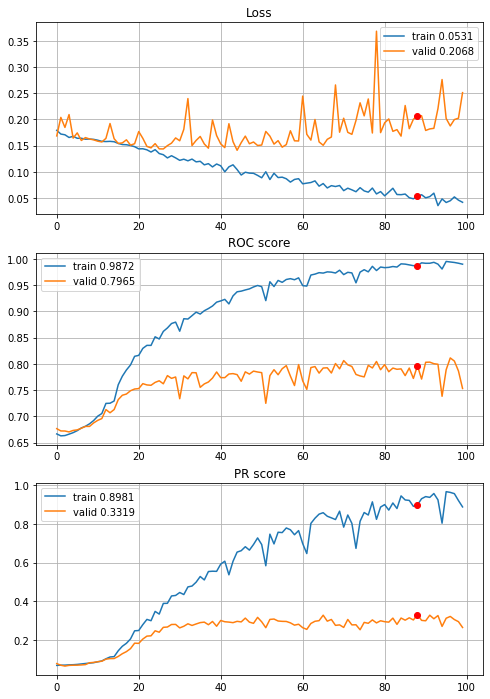


Fold 2------------------------------------------------------------


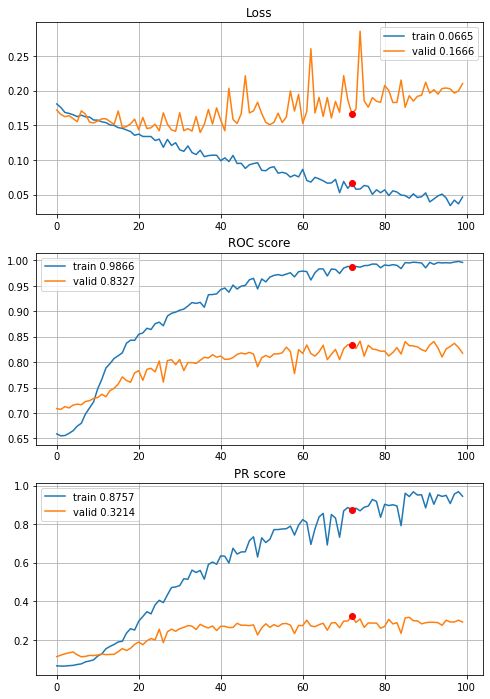


Fold 3------------------------------------------------------------


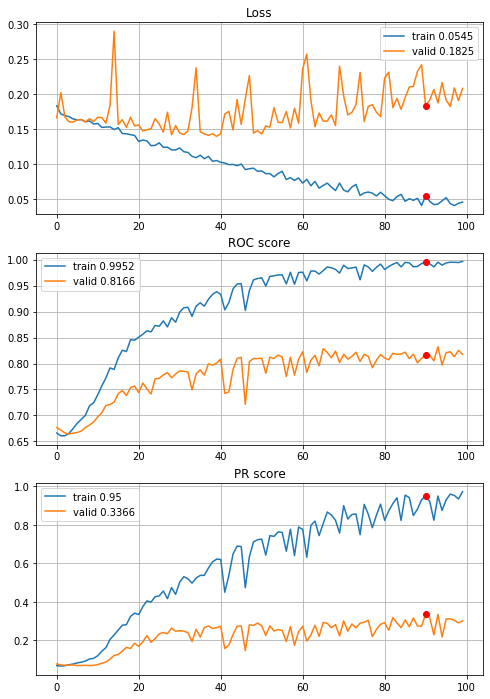


Fold 4------------------------------------------------------------


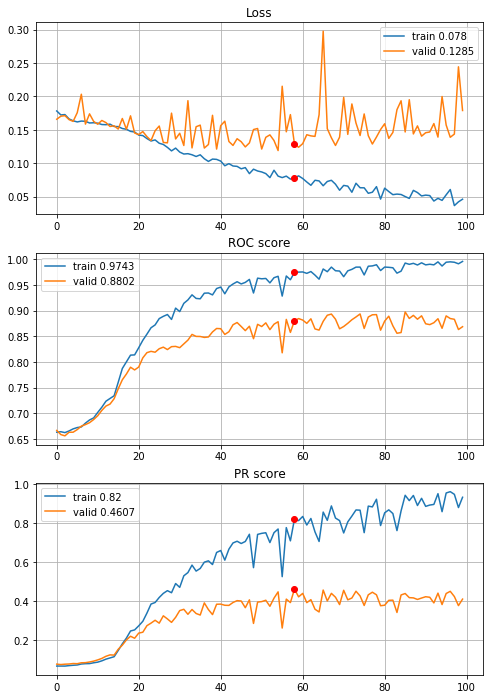


Fold 5------------------------------------------------------------


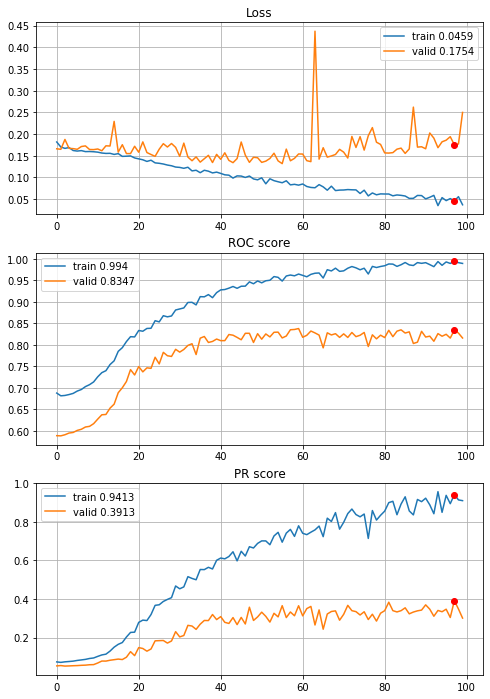


Fold 6------------------------------------------------------------


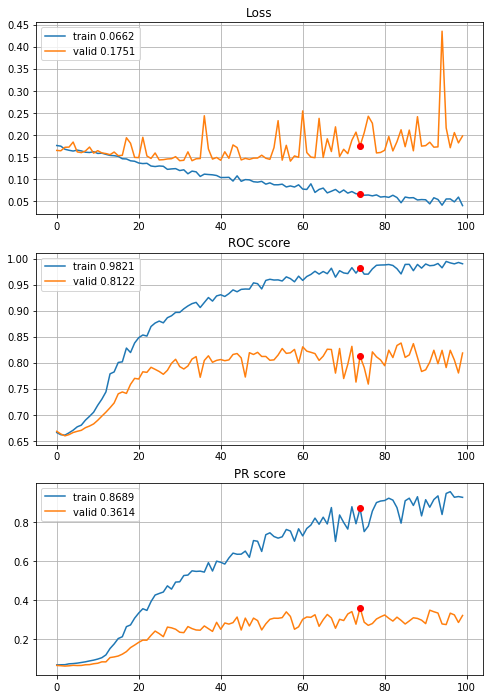

In [81]:
# first CNN with quantile clipping (Q_0.005, Q_0.995), power transform and normalization
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=100, batch_size=394, alpha=3, drafts=None,
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])

Another improvement PR +0.13 and bigger overfitting, learning curves are not so pretty. The most complex preprocessing pipeline tends to be the best one. Lets find the best architecture :)

But first, lets create and save images drafts for folds and see some results.

In [47]:
# drafts computation

# CV sets
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
# drafts lists initialization
drafts_ini=[]
drafts_opti=[]

# CV loop
for fold in range(len(train_folds)):
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    # ----- Monte Carlo energy optimization -----
    # correlation matrix for non bankrupt observations
    corr_matrix_fold=X_train_fold[Y_train_fold==0].corr(method="spearman")
    # draft inicialization
    draft_fold_ini=image_draft_inicialization(features, random_state)
    # quasi optimization
    draft_fold_opti=MC_Energy_optimization(corr_matrix=corr_matrix_fold, draft=draft_fold_ini, alpha=3, n_eval=100,
                                           random_state=random_state)
    # transform draft dictionary to matrix
    draft_fold_ini=image_dict_to_matrix(draft_fold_ini)
    draft_fold_opti=image_dict_to_matrix(draft_fold_opti)
    
    drafts_ini.append(draft_fold_ini)
    drafts_opti.append(draft_fold_opti)
    
drafts=dict(zip(["initial_drafts", "optimized_drafts"], [drafts_ini, drafts_opti]))

# saving drafts
with open(r"data\3year_data\drafts_8x8.p", "wb") as fp:
    pickle.dump(drafts, fp)

initial image energy: 12328.4177
iteration: 100
current energy: 10900.3115
iteration: 200
current energy: 9950.8215
iteration: 300
current energy: 9386.3959
iteration: 400
current energy: 9143.7604
iteration: 500
current energy: 8914.5153
iteration: 600
current energy: 8891.0764
iteration: 700
current energy: 8797.0886
iteration: 800
current energy: 8793.8945
iteration: 900
current energy: 8702.7769
iteration: 1000
current energy: 8663.8132
iteration: 1100
current energy: 8640.6085
iteration: 1200
current energy: 8614.7806
iteration: 1300
current energy: 8523.3884
iteration: 1400
current energy: 8484.8565
iteration: 1500
current energy: 8476.9028
iteration: 1600
current energy: 8419.8383
iteration: 1700
current energy: 8346.6664
iteration: 1800
current energy: 8328.398
iteration: 1900
current energy: 8243.8745
iteration: 2000
current energy: 8163.6458
iteration: 2100
current energy: 8160.7116
iteration: 2200
current energy: 8159.7088
iteration: 2300
current energy: 8159.7088
iteration:

In [39]:
# loading 8x8 drafts
with open(r"data\3year_data\drafts_8x8.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

			 Normalization only

			----- FOLD 1 -----


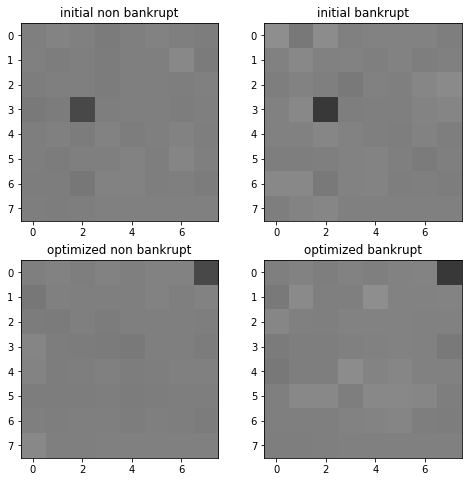


			----- FOLD 2 -----


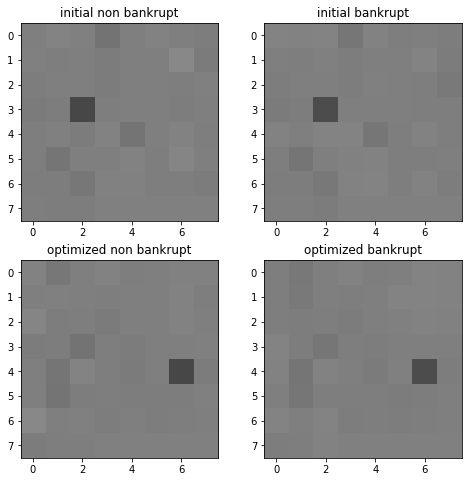


			----- FOLD 3 -----


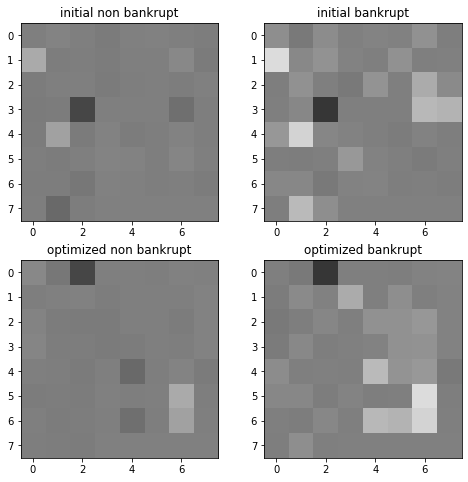


			----- FOLD 4 -----


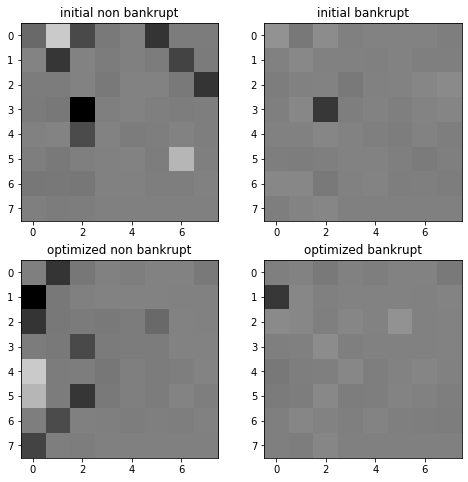


			----- FOLD 5 -----


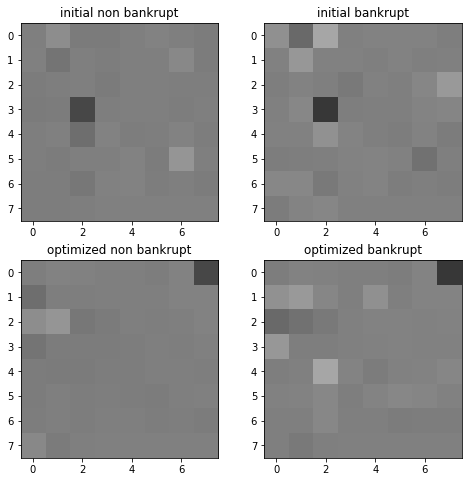


			----- FOLD 6 -----


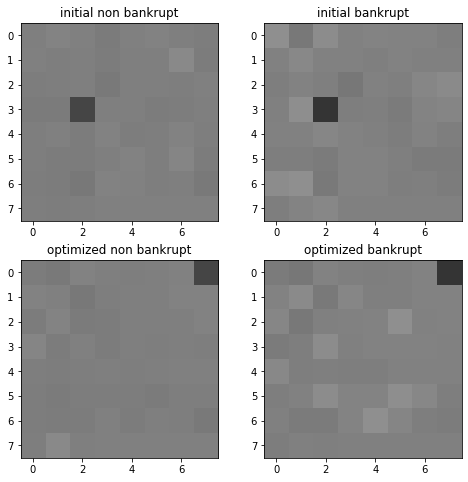

In [40]:
# printing images with normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t----- FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization and quantile clipping

			-----FOLD 1 -----


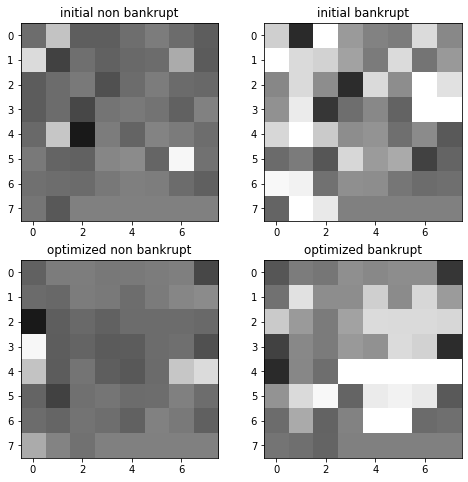


			-----FOLD 2 -----


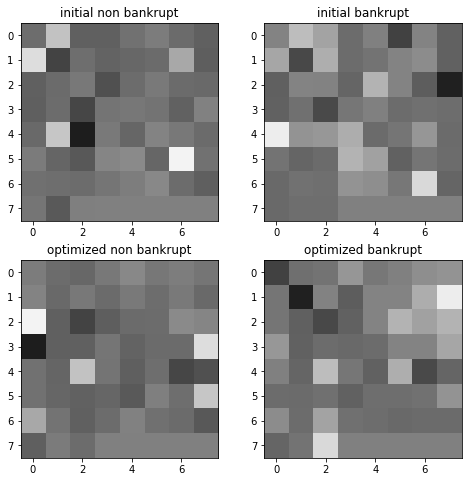


			-----FOLD 3 -----


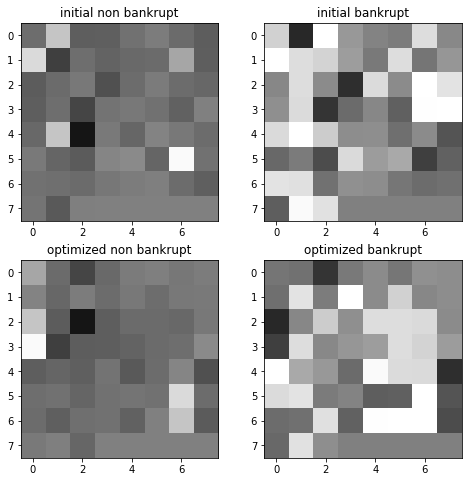


			-----FOLD 4 -----


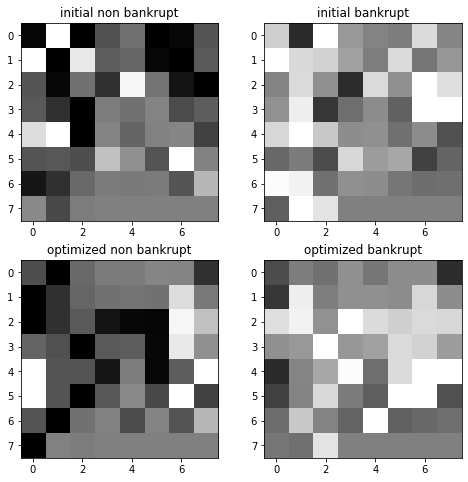


			-----FOLD 5 -----


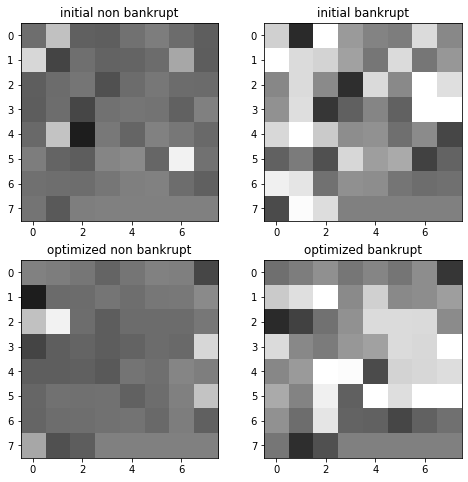


			-----FOLD 6 -----


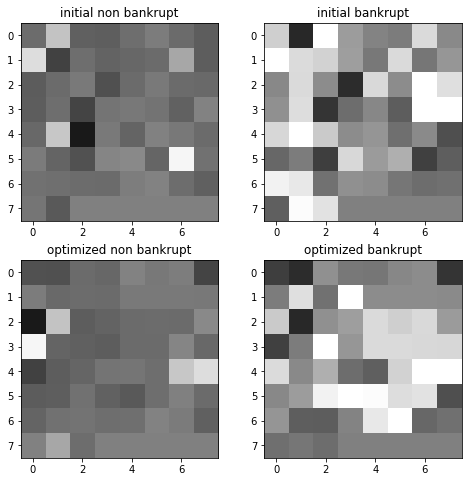

In [41]:
# printing images for normalization with quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t\t Normalization and quantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


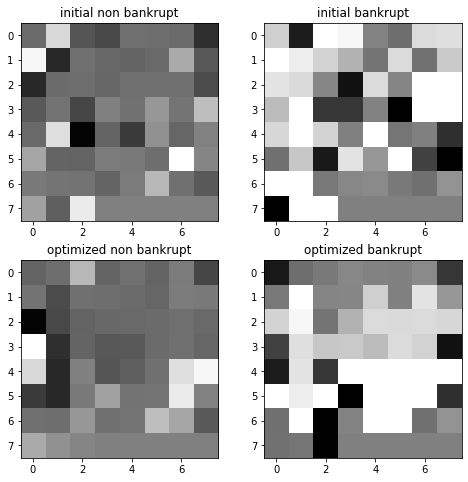


			-----FOLD 2 -----


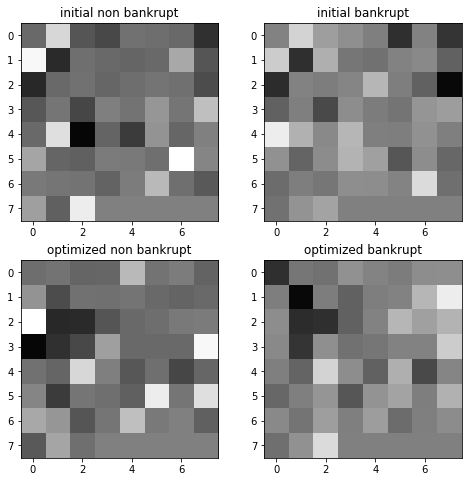


			-----FOLD 3 -----


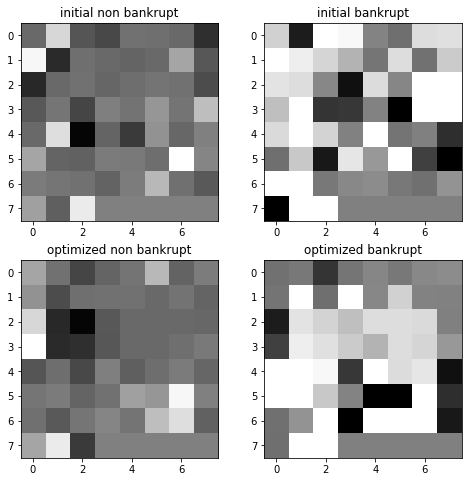


			-----FOLD 4 -----


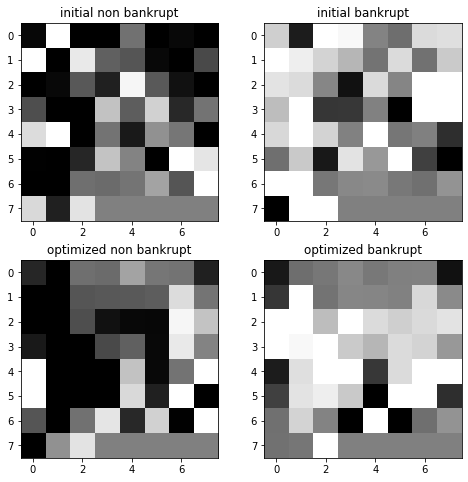


			-----FOLD 5 -----


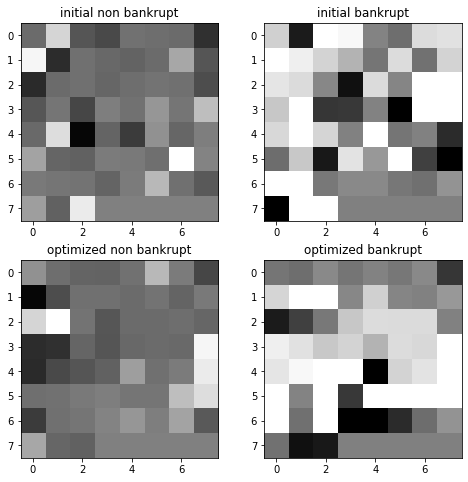


			-----FOLD 6 -----


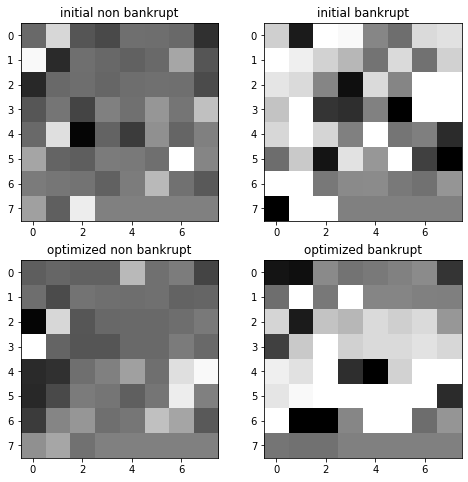

In [42]:
# printing images for normalization with quantile clipping and power transform
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]
print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=train_folds[fold][features].copy()
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=features)
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_8x8["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_8x8["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

Same conclusions as for 1 and 2 year horizons

Lets start experiments with model architecture, first define inception module.

In [43]:
def inception_module(prev_layer, f1, f2_in, f2_out, f3_in, f3_out, f4_out, random_state=random_state):
    
    np.random.seed(random_state)
    tf.random.set_seed(random_state)
    
    conv1x1 = layers.Conv2D(filters=f1, kernel_size=(1,1), strides=(1,1), padding="same",
                             activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv3x3 = layers.Conv2D(filters=f2_out, kernel_size=(3,3), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv3x3)
    conv5x5 = layers.Conv2D(filters=f3_in, kernel_size=(1,1), strides=(1,1), padding="valid",
                            activation=activations.relu, use_bias=True)(prev_layer)
    conv5x5 = layers.Conv2D(filters=f3_out, kernel_size=(5,5), strides=(1,1), padding="same",
                            activation=activations.relu, use_bias=True)(conv5x5)
    max_pool = layers.MaxPooling2D(pool_size=(3,3), strides=(1,1), padding="same")(prev_layer)
    max_pool = layers.Conv2D(filters=f4_out, kernel_size=(1,1), strides=(1,1), padding="valid",
                             activation=activations.relu, use_bias=True)(max_pool)
    inception = layers.concatenate([conv1x1, conv3x3, conv5x5, max_pool], axis=-1)
    
    return inception

def define_deep_CNN_2inc_std(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu)(flat)                   # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model

Lets try inceptions with 500 epochs


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/500,
cumulative time: 20.58s train loss: 0.23850939501853832, validation loss: 0.17702647201902433
Epoch: 2/500,
cumulative time: 21.96s train loss: 0.16588824100060925, validation loss: 0.16503781075363547
Epoch: 3/500,
cumulative time: 23.32s train loss: 0.16381324666334582, validation loss: 0.16324690916864776
Epoch: 4/500,
cumulative time: 24.67s train loss: 0.16294441191385076, validation loss: 0.1626905573929903
Epoch: 5/500,
cumulative time: 26.04s train loss: 0.1626943413239973, validation loss: 0.16223670552981478
Epoch: 6/500,
cumulative time: 27.38s train loss: 0.16220155313780962, validation loss: 0.16177931253164812
Epoch: 7/500,
cumulative time: 28.72s train loss: 0.16236701298508485, validation loss: 0.16186908820978468
Epoch: 8/500,
cumulative time: 30.05s train loss: 0.1614450756467753, validation loss: 0.16126088083259088
Epoch: 9/500,
cumulative time: 31.47s train loss: 0.16170807

Epoch: 76/500,
cumulative time: 129.02s train loss: 0.13829570052382797, validation loss: 0.1464563322059449
Epoch: 77/500,
cumulative time: 130.47s train loss: 0.13939267014875872, validation loss: 0.14499851561311344
Epoch: 78/500,
cumulative time: 131.93s train loss: 0.13707767260748088, validation loss: 0.14518141857840286
Epoch: 79/500,
cumulative time: 133.36s train loss: 0.13825969768158025, validation loss: 0.14927254960936925
Epoch: 80/500,
cumulative time: 134.79s train loss: 0.1365630892649252, validation loss: 0.1453784059337676
Epoch: 81/500,
cumulative time: 136.28s train loss: 0.13641594210096356, validation loss: 0.1465750180116487
Epoch: 82/500,
cumulative time: 137.72s train loss: 0.1360323006995994, validation loss: 0.1461238620478079
Epoch: 83/500,
cumulative time: 139.16s train loss: 0.1363714541490354, validation loss: 0.14862584715237936
Epoch: 84/500,
cumulative time: 140.58s train loss: 0.1355858089113973, validation loss: 0.14565704034477825
Epoch: 85/500,
cum

Epoch: 151/500,
cumulative time: 236.61s train loss: 0.11184878070735106, validation loss: 0.14364638678524472
Epoch: 152/500,
cumulative time: 238.04s train loss: 0.1091282557520802, validation loss: 0.14520669908190773
Epoch: 153/500,
cumulative time: 239.46s train loss: 0.10721540575079656, validation loss: 0.1498018179777253
Epoch: 154/500,
cumulative time: 240.9s train loss: 0.11050864175374174, validation loss: 0.1478669876977313
Epoch: 155/500,
cumulative time: 242.34s train loss: 0.10755853274946273, validation loss: 0.14633697401219553
Epoch: 156/500,
cumulative time: 243.77s train loss: 0.10593537384636094, validation loss: 0.14453917798411642
Epoch: 157/500,
cumulative time: 245.17s train loss: 0.10809636731001039, validation loss: 0.1487411325052869
Epoch: 158/500,
cumulative time: 246.66s train loss: 0.10845408174075623, validation loss: 0.1496825110787333
Epoch: 159/500,
cumulative time: 248.17s train loss: 0.10668490488980166, validation loss: 0.16165200631631
Epoch: 160

Epoch: 226/500,
cumulative time: 342.54s train loss: 0.08240696170419427, validation loss: 0.1623341473769079
Epoch: 227/500,
cumulative time: 343.86s train loss: 0.08055066274837204, validation loss: 0.1551564485225265
Epoch: 228/500,
cumulative time: 345.16s train loss: 0.07948636296374299, validation loss: 0.16332824842645488
Epoch: 229/500,
cumulative time: 346.48s train loss: 0.0786997154120662, validation loss: 0.15996667238862924
Epoch: 230/500,
cumulative time: 347.78s train loss: 0.07659180635611529, validation loss: 0.16282362474292164
Epoch: 231/500,
cumulative time: 349.08s train loss: 0.07586249865289753, validation loss: 0.1591755277715223
Epoch: 232/500,
cumulative time: 350.39s train loss: 0.08034879850488079, validation loss: 0.1606432757246385
Epoch: 233/500,
cumulative time: 351.69s train loss: 0.07634191223046526, validation loss: 0.16694342160443648
Epoch: 234/500,
cumulative time: 352.99s train loss: 0.0792653300634748, validation loss: 0.1641777261290919
Epoch: 2

Epoch: 301/500,
cumulative time: 446.5s train loss: 0.05995035860704585, validation loss: 0.19420273289533618
Epoch: 302/500,
cumulative time: 447.9s train loss: 0.05877436370366537, validation loss: 0.19306448932009632
Epoch: 303/500,
cumulative time: 449.31s train loss: 0.05534181175373816, validation loss: 0.18860644125532197
Epoch: 304/500,
cumulative time: 450.72s train loss: 0.055268459616802455, validation loss: 0.19973204104256662
Epoch: 305/500,
cumulative time: 452.14s train loss: 0.06157986705333897, validation loss: 0.19108423723462056
Epoch: 306/500,
cumulative time: 453.56s train loss: 0.05331930277903531, validation loss: 0.19167307058293104
Epoch: 307/500,
cumulative time: 454.97s train loss: 0.0519743414764433, validation loss: 0.1881943943459897
Epoch: 308/500,
cumulative time: 456.37s train loss: 0.053581898187104404, validation loss: 0.19065360517911173
Epoch: 309/500,
cumulative time: 457.77s train loss: 0.05138440552533946, validation loss: 0.19172302554428655
Epo

Epoch: 375/500,
cumulative time: 553.38s train loss: 0.035669098640790244, validation loss: 0.2276074833787128
Epoch: 376/500,
cumulative time: 554.76s train loss: 0.03229471080606763, validation loss: 0.23546252435812945
Epoch: 377/500,
cumulative time: 556.14s train loss: 0.03412912184071503, validation loss: 0.22781330054115656
Epoch: 378/500,
cumulative time: 557.58s train loss: 0.034138310265085584, validation loss: 0.23559073338268
Epoch: 379/500,
cumulative time: 558.96s train loss: 0.03448571028745273, validation loss: 0.24082825587742607
Epoch: 380/500,
cumulative time: 560.36s train loss: 0.03851987619179075, validation loss: 0.25914284838839563
Epoch: 381/500,
cumulative time: 561.75s train loss: 0.038270542272356205, validation loss: 0.2369997511919329
Epoch: 382/500,
cumulative time: 563.14s train loss: 0.03284183383351276, validation loss: 0.2409071416873607
Epoch: 383/500,
cumulative time: 564.55s train loss: 0.030395320442947463, validation loss: 0.23533443368356163
Epo

Epoch: 449/500,
cumulative time: 657.54s train loss: 0.022784572850455265, validation loss: 0.29874203976141206
Epoch: 450/500,
cumulative time: 658.92s train loss: 0.020054735206453324, validation loss: 0.295370906161762
Epoch: 451/500,
cumulative time: 660.3s train loss: 0.018862861761014416, validation loss: 0.33744365015942335
Epoch: 452/500,
cumulative time: 661.69s train loss: 0.03018149732249384, validation loss: 0.3022151246647379
Epoch: 453/500,
cumulative time: 663.06s train loss: 0.023305705222104033, validation loss: 0.30234760831099194
Epoch: 454/500,
cumulative time: 664.44s train loss: 0.02318614362478393, validation loss: 0.29396670921992507
Epoch: 455/500,
cumulative time: 665.82s train loss: 0.019878380208121542, validation loss: 0.30948868116576267
Epoch: 456/500,
cumulative time: 667.21s train loss: 0.021691871687099934, validation loss: 0.30521462449552506
Epoch: 457/500,
cumulative time: 668.64s train loss: 0.01930109540024729, validation loss: 0.2946849945605504


Epoch: 21/500,
cumulative time: 31.3s train loss: 0.16037127786561473, validation loss: 0.15549134378117627
Epoch: 22/500,
cumulative time: 32.69s train loss: 0.15940614470078915, validation loss: 0.15599766014287855
Epoch: 23/500,
cumulative time: 34.09s train loss: 0.1602421524285145, validation loss: 0.15534446266422422
Epoch: 24/500,
cumulative time: 35.47s train loss: 0.15944721706691084, validation loss: 0.15471031066630803
Epoch: 25/500,
cumulative time: 36.84s train loss: 0.15882003481472629, validation loss: 0.15501066343187506
Epoch: 26/500,
cumulative time: 38.24s train loss: 0.1585074756956144, validation loss: 0.1547842162660034
Epoch: 27/500,
cumulative time: 39.6s train loss: 0.1587709098730101, validation loss: 0.1573660192061533
Epoch: 28/500,
cumulative time: 40.97s train loss: 0.1587050646154811, validation loss: 0.15472285859628554
Epoch: 29/500,
cumulative time: 42.35s train loss: 0.15893446637381262, validation loss: 0.15399593497635028
Epoch: 30/500,
cumulative t

Epoch: 97/500,
cumulative time: 137.18s train loss: 0.13458220747507388, validation loss: 0.14689472592087904
Epoch: 98/500,
cumulative time: 138.6s train loss: 0.13250340665679003, validation loss: 0.14489699165833575
Epoch: 99/500,
cumulative time: 140.02s train loss: 0.13191594951453442, validation loss: 0.1460864540204152
Epoch: 100/500,
cumulative time: 141.43s train loss: 0.1319834663633876, validation loss: 0.1449551317513692
Epoch: 101/500,
cumulative time: 142.8s train loss: 0.13428446441509884, validation loss: 0.14552789554488144
Epoch: 102/500,
cumulative time: 144.22s train loss: 0.1303751329080917, validation loss: 0.1456091778736127
Epoch: 103/500,
cumulative time: 145.55s train loss: 0.12960512974203173, validation loss: 0.14542183534853736
Epoch: 104/500,
cumulative time: 146.99s train loss: 0.12910902479985528, validation loss: 0.14703976510392885
Epoch: 105/500,
cumulative time: 148.36s train loss: 0.1320517390442951, validation loss: 0.14608830961534267
Epoch: 106/5

Epoch: 172/500,
cumulative time: 236.13s train loss: 0.1005842644613354, validation loss: 0.15892990441262955
Epoch: 173/500,
cumulative time: 237.43s train loss: 0.09724466203920556, validation loss: 0.16232057441108974
Epoch: 174/500,
cumulative time: 238.74s train loss: 0.09709587196899688, validation loss: 0.16652244378276765
Epoch: 175/500,
cumulative time: 240.08s train loss: 0.0974869875312789, validation loss: 0.16081293689899956
Epoch: 176/500,
cumulative time: 241.47s train loss: 0.09774443260892719, validation loss: 0.15803123614109985
Epoch: 177/500,
cumulative time: 242.89s train loss: 0.10114881175090795, validation loss: 0.1657832624832581
Epoch: 178/500,
cumulative time: 244.26s train loss: 0.0976897689335264, validation loss: 0.15979536090578353
Epoch: 179/500,
cumulative time: 245.6s train loss: 0.09652072689799342, validation loss: 0.1614742840922207
Epoch: 180/500,
cumulative time: 246.98s train loss: 0.09569493319943248, validation loss: 0.15703403842324198
Epoch: 

Epoch: 247/500,
cumulative time: 334.0s train loss: 0.07493506236811706, validation loss: 0.1829099781899121
Epoch: 248/500,
cumulative time: 335.29s train loss: 0.07510093448524675, validation loss: 0.17780829733664835
Epoch: 249/500,
cumulative time: 336.59s train loss: 0.07176714162867791, validation loss: 0.1932225830433097
Epoch: 250/500,
cumulative time: 337.88s train loss: 0.07286263649326381, validation loss: 0.18270807944697134
Epoch: 251/500,
cumulative time: 339.18s train loss: 0.07058052056886403, validation loss: 0.1786433917471497
Epoch: 252/500,
cumulative time: 340.48s train loss: 0.07171400905296114, validation loss: 0.17922784276746048
Epoch: 253/500,
cumulative time: 341.76s train loss: 0.06949898311867089, validation loss: 0.1843229830069748
Epoch: 254/500,
cumulative time: 343.08s train loss: 0.06798024997964788, validation loss: 0.18118721229142631
Epoch: 255/500,
cumulative time: 344.36s train loss: 0.06807574122530836, validation loss: 0.1855615133890787
Epoch: 

Epoch: 321/500,
cumulative time: 430.71s train loss: 0.04495084194862244, validation loss: 0.21705530175687757
Epoch: 322/500,
cumulative time: 432.01s train loss: 0.04348404354187917, validation loss: 0.22395202945209894
Epoch: 323/500,
cumulative time: 433.3s train loss: 0.04298787624149761, validation loss: 0.22631985669757873
Epoch: 324/500,
cumulative time: 434.59s train loss: 0.0426451150278602, validation loss: 0.22840840514959232
Epoch: 325/500,
cumulative time: 435.89s train loss: 0.04206132577107906, validation loss: 0.23306561914683951
Epoch: 326/500,
cumulative time: 437.18s train loss: 0.042496857742527115, validation loss: 0.237366960565822
Epoch: 327/500,
cumulative time: 438.47s train loss: 0.043962092673888696, validation loss: 0.2267951455411561
Epoch: 328/500,
cumulative time: 439.76s train loss: 0.040053322743285075, validation loss: 0.22878990795946683
Epoch: 329/500,
cumulative time: 441.07s train loss: 0.0423711450712633, validation loss: 0.22126626064158672
Epoc

Epoch: 395/500,
cumulative time: 527.39s train loss: 0.023506254521986576, validation loss: 0.2929357392603573
Epoch: 396/500,
cumulative time: 528.73s train loss: 0.02348556708769602, validation loss: 0.30742381085418313
Epoch: 397/500,
cumulative time: 530.06s train loss: 0.02317020401670144, validation loss: 0.3039174016423494
Epoch: 398/500,
cumulative time: 531.4s train loss: 0.02439792470967204, validation loss: 0.30811012916139974
Epoch: 399/500,
cumulative time: 532.72s train loss: 0.022168446249814542, validation loss: 0.3017696461507252
Epoch: 400/500,
cumulative time: 534.06s train loss: 0.02059971302360011, validation loss: 0.3094459779531271
Epoch: 401/500,
cumulative time: 535.4s train loss: 0.021509179430635936, validation loss: 0.3105192454739292
Epoch: 402/500,
cumulative time: 536.74s train loss: 0.020952754043485067, validation loss: 0.3070299204141097
Epoch: 403/500,
cumulative time: 538.08s train loss: 0.021273253977529216, validation loss: 0.30010220326414894
Epoc

Epoch: 469/500,
cumulative time: 626.7s train loss: 0.01477564560888641, validation loss: 0.38956365012716343
Epoch: 470/500,
cumulative time: 628.08s train loss: 0.011927796275533031, validation loss: 0.40704385887435973
Epoch: 471/500,
cumulative time: 629.44s train loss: 0.014568496345819363, validation loss: 0.42035578833807496
Epoch: 472/500,
cumulative time: 630.74s train loss: 0.01963703892001952, validation loss: 0.4044469762324974
Epoch: 473/500,
cumulative time: 632.07s train loss: 0.014848475497441095, validation loss: 0.42454020868435133
Epoch: 474/500,
cumulative time: 633.42s train loss: 0.017408095385529163, validation loss: 0.39054044139807065
Epoch: 475/500,
cumulative time: 634.72s train loss: 0.015089123978964747, validation loss: 0.39846678951152187
Epoch: 476/500,
cumulative time: 636.07s train loss: 0.01407199122047308, validation loss: 0.4067613911347496
Epoch: 477/500,
cumulative time: 637.4s train loss: 0.011974000604609597, validation loss: 0.39938267042096287

Epoch: 42/500,
cumulative time: 58.72s train loss: 0.15190916878377209, validation loss: 0.15706637939181897
Epoch: 43/500,
cumulative time: 60.04s train loss: 0.1515546336678256, validation loss: 0.1576860229122217
Epoch: 44/500,
cumulative time: 61.34s train loss: 0.15227919458553854, validation loss: 0.1565909794633073
Epoch: 45/500,
cumulative time: 62.6s train loss: 0.15082072996522078, validation loss: 0.15734946221933452
Epoch: 46/500,
cumulative time: 63.87s train loss: 0.15036384001821534, validation loss: 0.15996381478337754
Epoch: 47/500,
cumulative time: 65.16s train loss: 0.1543038055830037, validation loss: 0.15838585698276486
Epoch: 48/500,
cumulative time: 66.44s train loss: 0.15121638958279748, validation loss: 0.16004836319080343
Epoch: 49/500,
cumulative time: 67.7s train loss: 0.15208401215046757, validation loss: 0.15797903588918058
Epoch: 50/500,
cumulative time: 69.0s train loss: 0.1492138386626265, validation loss: 0.15651007170445955
Epoch: 51/500,
cumulative t

Epoch: 118/500,
cumulative time: 156.92s train loss: 0.11361188786942988, validation loss: 0.15671061354336546
Epoch: 119/500,
cumulative time: 158.24s train loss: 0.11639875045632422, validation loss: 0.15349327767973334
Epoch: 120/500,
cumulative time: 159.59s train loss: 0.11191379496194633, validation loss: 0.15694343007681097
Epoch: 121/500,
cumulative time: 160.88s train loss: 0.11532309946897912, validation loss: 0.15603833970751707
Epoch: 122/500,
cumulative time: 162.18s train loss: 0.11191015523954931, validation loss: 0.15666090328915247
Epoch: 123/500,
cumulative time: 163.47s train loss: 0.11671825726869957, validation loss: 0.15198815394275936
Epoch: 124/500,
cumulative time: 164.77s train loss: 0.11514241614599093, validation loss: 0.15707342384253697
Epoch: 125/500,
cumulative time: 166.07s train loss: 0.11092760103712827, validation loss: 0.1587170508945285
Epoch: 126/500,
cumulative time: 167.4s train loss: 0.10995356432887482, validation loss: 0.15335637222619075
Epo

Epoch: 193/500,
cumulative time: 263.79s train loss: 0.07669054069038081, validation loss: 0.18371570585869243
Epoch: 194/500,
cumulative time: 265.11s train loss: 0.07623084155806771, validation loss: 0.178369084356028
Epoch: 195/500,
cumulative time: 266.46s train loss: 0.07538813760613751, validation loss: 0.1810223693772662
Epoch: 196/500,
cumulative time: 267.83s train loss: 0.0790590374957712, validation loss: 0.1869229753629877
Epoch: 197/500,
cumulative time: 269.17s train loss: 0.07638991457409058, validation loss: 0.18518291409878088
Epoch: 198/500,
cumulative time: 270.49s train loss: 0.07575682048591972, validation loss: 0.18591079276011155
Epoch: 199/500,
cumulative time: 271.79s train loss: 0.07434587912097611, validation loss: 0.18172380689477857
Epoch: 200/500,
cumulative time: 273.12s train loss: 0.07363551990348181, validation loss: 0.18778475285123247
Epoch: 201/500,
cumulative time: 274.43s train loss: 0.07632171410004204, validation loss: 0.18704048047137603
Epoch:

Epoch: 268/500,
cumulative time: 365.04s train loss: 0.042657848495171145, validation loss: 0.24380448077796796
Epoch: 269/500,
cumulative time: 366.34s train loss: 0.044170773187831684, validation loss: 0.2420901203061775
Epoch: 270/500,
cumulative time: 367.65s train loss: 0.04462855299140026, validation loss: 0.24257502157050692
Epoch: 271/500,
cumulative time: 368.99s train loss: 0.04611352401366708, validation loss: 0.2449944664383622
Epoch: 272/500,
cumulative time: 370.28s train loss: 0.045351037183801644, validation loss: 0.2495213910683423
Epoch: 273/500,
cumulative time: 371.56s train loss: 0.040795329749693576, validation loss: 0.24339409918569488
Epoch: 274/500,
cumulative time: 372.83s train loss: 0.040877420340465334, validation loss: 0.24668257563407894
Epoch: 275/500,
cumulative time: 374.18s train loss: 0.04432427504271179, validation loss: 0.2476163607281126
Epoch: 276/500,
cumulative time: 375.56s train loss: 0.04401043398670294, validation loss: 0.2459278558802011
E

Epoch: 343/500,
cumulative time: 468.88s train loss: 0.02180597630130079, validation loss: 0.34555200611388853
Epoch: 344/500,
cumulative time: 470.26s train loss: 0.025844356473127564, validation loss: 0.3391727393646853
Epoch: 345/500,
cumulative time: 471.58s train loss: 0.022337784508953934, validation loss: 0.3320570515851987
Epoch: 346/500,
cumulative time: 472.94s train loss: 0.020034660547014645, validation loss: 0.34514952719524056
Epoch: 347/500,
cumulative time: 474.33s train loss: 0.0226099205196396, validation loss: 0.34361107577112054
Epoch: 348/500,
cumulative time: 475.98s train loss: 0.023157446206090632, validation loss: 0.3423318662345019
Epoch: 349/500,
cumulative time: 477.37s train loss: 0.02011597267089458, validation loss: 0.3531910969264229
Epoch: 350/500,
cumulative time: 478.79s train loss: 0.020611107390657652, validation loss: 0.34786327546499035
Epoch: 351/500,
cumulative time: 480.35s train loss: 0.022453522445898426, validation loss: 0.33494828469553284


Epoch: 417/500,
cumulative time: 569.99s train loss: 0.008265324231327021, validation loss: 0.44417546007923814
Epoch: 418/500,
cumulative time: 571.3s train loss: 0.009197640210340773, validation loss: 0.45494382940769823
Epoch: 419/500,
cumulative time: 572.59s train loss: 0.00884911640055125, validation loss: 0.4629060506898798
Epoch: 420/500,
cumulative time: 573.88s train loss: 0.009948629275528816, validation loss: 0.463458109066027
Epoch: 421/500,
cumulative time: 575.17s train loss: 0.011230450406155895, validation loss: 0.46350895749163346
Epoch: 422/500,
cumulative time: 576.51s train loss: 0.009197037814626696, validation loss: 0.4675216233824059
Epoch: 423/500,
cumulative time: 577.86s train loss: 0.010070458936668237, validation loss: 0.46360985858568515
Epoch: 424/500,
cumulative time: 579.25s train loss: 0.010176561649281789, validation loss: 0.47953462190584306
Epoch: 425/500,
cumulative time: 580.55s train loss: 0.012406954649779181, validation loss: 0.4551715252440066

Epoch: 491/500,
cumulative time: 670.97s train loss: 0.005074473751335555, validation loss: 0.5759389041916884
Epoch: 492/500,
cumulative time: 672.31s train loss: 0.005175701556912542, validation loss: 0.567391386428948
Epoch: 493/500,
cumulative time: 673.66s train loss: 0.005796595849572874, validation loss: 0.5768134090487954
Epoch: 494/500,
cumulative time: 675.03s train loss: 0.011767513390121668, validation loss: 0.5566094140394018
Epoch: 495/500,
cumulative time: 676.35s train loss: 0.009740739229067708, validation loss: 0.563654915611522
Epoch: 496/500,
cumulative time: 677.66s train loss: 0.009508157555838644, validation loss: 0.5762905613232409
Epoch: 497/500,
cumulative time: 678.99s train loss: 0.006810348443187669, validation loss: 0.5793606332292094
Epoch: 498/500,
cumulative time: 680.28s train loss: 0.009340145425059938, validation loss: 0.5447668914791797
Epoch: 499/500,
cumulative time: 681.63s train loss: 0.00492002699120823, validation loss: 0.5611386881118364
Epoc

Epoch: 64/500,
cumulative time: 90.17s train loss: 0.1472383796981222, validation loss: 0.16499336095109368
Epoch: 65/500,
cumulative time: 91.46s train loss: 0.1466292494976094, validation loss: 0.148960651178035
Epoch: 66/500,
cumulative time: 92.73s train loss: 0.14152804908128658, validation loss: 0.1477723534500927
Epoch: 67/500,
cumulative time: 94.0s train loss: 0.14030911112178557, validation loss: 0.14359327969122995
Epoch: 68/500,
cumulative time: 95.28s train loss: 0.14019472063220584, validation loss: 0.14447616075860095
Epoch: 69/500,
cumulative time: 96.58s train loss: 0.14008418038469855, validation loss: 0.14386089116842687
Epoch: 70/500,
cumulative time: 97.91s train loss: 0.13949888819717052, validation loss: 0.14607433000210854
Epoch: 71/500,
cumulative time: 99.26s train loss: 0.13999799034951446, validation loss: 0.14793701483569013
Epoch: 72/500,
cumulative time: 100.78s train loss: 0.14050509477602355, validation loss: 0.14381222233547294
Epoch: 73/500,
cumulativ

Epoch: 139/500,
cumulative time: 190.74s train loss: 0.11957293158834845, validation loss: 0.1375405021685604
Epoch: 140/500,
cumulative time: 192.08s train loss: 0.11884737476122491, validation loss: 0.13620997289608222
Epoch: 141/500,
cumulative time: 193.42s train loss: 0.12315297002740168, validation loss: 0.15299034632283456
Epoch: 142/500,
cumulative time: 194.75s train loss: 0.12312824348702407, validation loss: 0.13754465678025668
Epoch: 143/500,
cumulative time: 196.04s train loss: 0.11758924302298208, validation loss: 0.13644744545650983
Epoch: 144/500,
cumulative time: 197.47s train loss: 0.11632860824123938, validation loss: 0.14018550130439772
Epoch: 145/500,
cumulative time: 199.05s train loss: 0.11830480039893199, validation loss: 0.13562933686598255
Epoch: 146/500,
cumulative time: 200.44s train loss: 0.11921716608113926, validation loss: 0.1415693648989516
Epoch: 147/500,
cumulative time: 201.73s train loss: 0.1219007352640251, validation loss: 0.13956811867878915
Epoc

Epoch: 214/500,
cumulative time: 291.93s train loss: 0.09342129297748838, validation loss: 0.13983248303086543
Epoch: 215/500,
cumulative time: 293.22s train loss: 0.09419353533063027, validation loss: 0.1454177059008597
Epoch: 216/500,
cumulative time: 294.51s train loss: 0.09867933737659754, validation loss: 0.1438635477935346
Epoch: 217/500,
cumulative time: 295.82s train loss: 0.09406308640516793, validation loss: 0.14172651018180824
Epoch: 218/500,
cumulative time: 297.13s train loss: 0.09508144653535698, validation loss: 0.14300896576941405
Epoch: 219/500,
cumulative time: 298.43s train loss: 0.09748423721717966, validation loss: 0.14229654205345388
Epoch: 220/500,
cumulative time: 299.75s train loss: 0.09314634301318209, validation loss: 0.14465205166318001
Epoch: 221/500,
cumulative time: 301.03s train loss: 0.09259716944781476, validation loss: 0.15122876805527963
Epoch: 222/500,
cumulative time: 302.4s train loss: 0.09478730248961915, validation loss: 0.14713791977531163
Epoc

Epoch: 289/500,
cumulative time: 392.25s train loss: 0.06902469453342168, validation loss: 0.1572278339420671
Epoch: 290/500,
cumulative time: 393.56s train loss: 0.0681389595989491, validation loss: 0.16187853578033798
Epoch: 291/500,
cumulative time: 394.84s train loss: 0.0704414810604936, validation loss: 0.16686087051897186
Epoch: 292/500,
cumulative time: 396.13s train loss: 0.0720913724626856, validation loss: 0.15819163681014026
Epoch: 293/500,
cumulative time: 397.43s train loss: 0.07109588082024756, validation loss: 0.17782468140750224
Epoch: 294/500,
cumulative time: 398.71s train loss: 0.07185872257056626, validation loss: 0.15560789072341719
Epoch: 295/500,
cumulative time: 399.99s train loss: 0.0659940788430317, validation loss: 0.16014548024921868
Epoch: 296/500,
cumulative time: 401.29s train loss: 0.07345876055684779, validation loss: 0.170832227520049
Epoch: 297/500,
cumulative time: 402.58s train loss: 0.07278506264094445, validation loss: 0.15986744944264974
Epoch: 2

Epoch: 364/500,
cumulative time: 493.22s train loss: 0.046199679431338375, validation loss: 0.1756315822682562
Epoch: 365/500,
cumulative time: 494.51s train loss: 0.04633390649114044, validation loss: 0.18193473976452104
Epoch: 366/500,
cumulative time: 495.86s train loss: 0.04548403799879565, validation loss: 0.1771955530343487
Epoch: 367/500,
cumulative time: 497.18s train loss: 0.04981476794193411, validation loss: 0.1794943741350624
Epoch: 368/500,
cumulative time: 498.52s train loss: 0.047781163096322445, validation loss: 0.17829005703388628
Epoch: 369/500,
cumulative time: 499.81s train loss: 0.046064252293364596, validation loss: 0.17911443344731162
Epoch: 370/500,
cumulative time: 501.08s train loss: 0.04572416082032387, validation loss: 0.1776995530564382
Epoch: 371/500,
cumulative time: 502.37s train loss: 0.04339062357227383, validation loss: 0.1868814845346061
Epoch: 372/500,
cumulative time: 503.7s train loss: 0.04502146265085316, validation loss: 0.18579243291486763
Epoc

Epoch: 438/500,
cumulative time: 591.99s train loss: 0.03730714833272333, validation loss: 0.2259494619319511
Epoch: 439/500,
cumulative time: 593.43s train loss: 0.032224357678220586, validation loss: 0.22135393950370474
Epoch: 440/500,
cumulative time: 594.77s train loss: 0.030062785185360787, validation loss: 0.21672585926862095
Epoch: 441/500,
cumulative time: 596.1s train loss: 0.02676950489960807, validation loss: 0.2227662672846533
Epoch: 442/500,
cumulative time: 597.48s train loss: 0.0276957512104991, validation loss: 0.22762482348697682
Epoch: 443/500,
cumulative time: 598.9s train loss: 0.03803995775120148, validation loss: 0.2607458694538939
Epoch: 444/500,
cumulative time: 600.25s train loss: 0.032927157751886746, validation loss: 0.2237166944759389
Epoch: 445/500,
cumulative time: 601.57s train loss: 0.029242719506640032, validation loss: 0.21410967058076147
Epoch: 446/500,
cumulative time: 603.06s train loss: 0.02809410395147346, validation loss: 0.22184424531959768
Epoc

Epoch: 10/500,
cumulative time: 16.25s train loss: 0.15935618301756121, validation loss: 0.16540661813547228
Epoch: 11/500,
cumulative time: 17.7s train loss: 0.15875923217342977, validation loss: 0.16553277591655952
Epoch: 12/500,
cumulative time: 19.07s train loss: 0.15994891257894853, validation loss: 0.16536533647017898
Epoch: 13/500,
cumulative time: 20.42s train loss: 0.158941443320542, validation loss: 0.1656333134652434
Epoch: 14/500,
cumulative time: 21.75s train loss: 0.15891757210369176, validation loss: 0.16520756199897352
Epoch: 15/500,
cumulative time: 23.11s train loss: 0.15824419048490648, validation loss: 0.16447598714659756
Epoch: 16/500,
cumulative time: 24.51s train loss: 0.15853956039384084, validation loss: 0.1647526867306873
Epoch: 17/500,
cumulative time: 25.84s train loss: 0.1572885150005627, validation loss: 0.16483388823575462
Epoch: 18/500,
cumulative time: 27.16s train loss: 0.15737717798003395, validation loss: 0.16457045662215622
Epoch: 19/500,
cumulative

Epoch: 86/500,
cumulative time: 118.45s train loss: 0.13430102569143743, validation loss: 0.14824267489491408
Epoch: 87/500,
cumulative time: 119.81s train loss: 0.13300266817577358, validation loss: 0.14786434583707686
Epoch: 88/500,
cumulative time: 121.2s train loss: 0.13353882608516515, validation loss: 0.14948774882022237
Epoch: 89/500,
cumulative time: 122.55s train loss: 0.13447553268624626, validation loss: 0.1584459160446027
Epoch: 90/500,
cumulative time: 123.92s train loss: 0.13299516218410812, validation loss: 0.14889678538704917
Epoch: 91/500,
cumulative time: 125.23s train loss: 0.13019054524062393, validation loss: 0.1522295043399731
Epoch: 92/500,
cumulative time: 126.54s train loss: 0.1323127149656632, validation loss: 0.1489262731836164
Epoch: 93/500,
cumulative time: 127.91s train loss: 0.1293864429059543, validation loss: 0.14665486100148092
Epoch: 94/500,
cumulative time: 129.23s train loss: 0.13009548684351877, validation loss: 0.15058954974067634
Epoch: 95/500,
c

Epoch: 161/500,
cumulative time: 220.55s train loss: 0.1015078267181454, validation loss: 0.15028577140711863
Epoch: 162/500,
cumulative time: 221.95s train loss: 0.10240316735247294, validation loss: 0.16126824864631867
Epoch: 163/500,
cumulative time: 223.34s train loss: 0.10965648567435125, validation loss: 0.1639038787405269
Epoch: 164/500,
cumulative time: 224.7s train loss: 0.1028652407149841, validation loss: 0.15490791451571653
Epoch: 165/500,
cumulative time: 226.04s train loss: 0.11044515644637547, validation loss: 0.1621259988760417
Epoch: 166/500,
cumulative time: 227.37s train loss: 0.10330408514776522, validation loss: 0.15689451141016825
Epoch: 167/500,
cumulative time: 228.69s train loss: 0.09961824735138516, validation loss: 0.15186597693950757
Epoch: 168/500,
cumulative time: 230.02s train loss: 0.09822245227163937, validation loss: 0.1613502960998765
Epoch: 169/500,
cumulative time: 231.32s train loss: 0.10001258565063385, validation loss: 0.15240387755249618
Epoch: 

Epoch: 236/500,
cumulative time: 322.06s train loss: 0.07530505883877689, validation loss: 0.16556205654206782
Epoch: 237/500,
cumulative time: 323.42s train loss: 0.07402959018740606, validation loss: 0.16479880646906236
Epoch: 238/500,
cumulative time: 324.75s train loss: 0.07411101784594704, validation loss: 0.16511898572760517
Epoch: 239/500,
cumulative time: 326.14s train loss: 0.07396988757516222, validation loss: 0.1687455544270194
Epoch: 240/500,
cumulative time: 327.5s train loss: 0.07706831895847248, validation loss: 0.16399645828794526
Epoch: 241/500,
cumulative time: 328.88s train loss: 0.07437735844414736, validation loss: 0.16293969650802886
Epoch: 242/500,
cumulative time: 330.25s train loss: 0.07326724089712378, validation loss: 0.17107099730174788
Epoch: 243/500,
cumulative time: 331.59s train loss: 0.07531793728746207, validation loss: 0.1703292747976583
Epoch: 244/500,
cumulative time: 332.93s train loss: 0.07533465163616947, validation loss: 0.16587390228227114
Epoc

Epoch: 311/500,
cumulative time: 422.9s train loss: 0.056439751802874916, validation loss: 0.18581852090311862
Epoch: 312/500,
cumulative time: 424.22s train loss: 0.05239427490932614, validation loss: 0.1858328668739974
Epoch: 313/500,
cumulative time: 425.53s train loss: 0.05193065381956211, validation loss: 0.19386103116512923
Epoch: 314/500,
cumulative time: 426.83s train loss: 0.05623639116266605, validation loss: 0.19128056749369496
Epoch: 315/500,
cumulative time: 428.14s train loss: 0.05125986770047384, validation loss: 0.19042191278497014
Epoch: 316/500,
cumulative time: 429.5s train loss: 0.05352246566731881, validation loss: 0.1912545226270218
Epoch: 317/500,
cumulative time: 430.9s train loss: 0.05132950593759269, validation loss: 0.19700401417940347
Epoch: 318/500,
cumulative time: 432.26s train loss: 0.05197075490865049, validation loss: 0.19725169048084343
Epoch: 319/500,
cumulative time: 433.57s train loss: 0.0565842973069089, validation loss: 0.20396341873652657
Epoch:

Epoch: 385/500,
cumulative time: 522.57s train loss: 0.03648837925034904, validation loss: 0.2336043138960242
Epoch: 386/500,
cumulative time: 523.86s train loss: 0.0352345153910099, validation loss: 0.235641241815737
Epoch: 387/500,
cumulative time: 525.16s train loss: 0.03494416393616992, validation loss: 0.23212057957486742
Epoch: 388/500,
cumulative time: 526.46s train loss: 0.03812119413544699, validation loss: 0.22899859655418997
Epoch: 389/500,
cumulative time: 527.8s train loss: 0.03739233390483183, validation loss: 0.22410287328191383
Epoch: 390/500,
cumulative time: 529.16s train loss: 0.034769036493505, validation loss: 0.22571595198673783
Epoch: 391/500,
cumulative time: 530.55s train loss: 0.044837463362444464, validation loss: 0.2384340443586147
Epoch: 392/500,
cumulative time: 531.89s train loss: 0.03556796940777737, validation loss: 0.23633469447864616
Epoch: 393/500,
cumulative time: 533.24s train loss: 0.03188625522673732, validation loss: 0.22721955457489892
Epoch: 3

Epoch: 459/500,
cumulative time: 622.22s train loss: 0.019102297430553555, validation loss: 0.2705325284682283
Epoch: 460/500,
cumulative time: 623.5s train loss: 0.018277290151077902, validation loss: 0.2784094389816099
Epoch: 461/500,
cumulative time: 624.81s train loss: 0.02118330929957663, validation loss: 0.2956999573920064
Epoch: 462/500,
cumulative time: 626.13s train loss: 0.022827400435882904, validation loss: 0.28894015334224327
Epoch: 463/500,
cumulative time: 627.43s train loss: 0.021419027097780062, validation loss: 0.27824997608971
Epoch: 464/500,
cumulative time: 628.72s train loss: 0.021403038926517327, validation loss: 0.2968446846714495
Epoch: 465/500,
cumulative time: 630.04s train loss: 0.022479256079126302, validation loss: 0.2873565040987722
Epoch: 466/500,
cumulative time: 631.35s train loss: 0.023565437612736002, validation loss: 0.29699723615871343
Epoch: 467/500,
cumulative time: 632.66s train loss: 0.027059008612489503, validation loss: 0.27697365913603594
Ep

Epoch: 32/500,
cumulative time: 48.64s train loss: 0.15659643201692075, validation loss: 0.1584347081868375
Epoch: 33/500,
cumulative time: 50.27s train loss: 0.1544422295935657, validation loss: 0.15837603028680458
Epoch: 34/500,
cumulative time: 51.88s train loss: 0.15398761941752304, validation loss: 0.1599989950461466
Epoch: 35/500,
cumulative time: 53.6s train loss: 0.15405989535357975, validation loss: 0.15997196218029397
Epoch: 36/500,
cumulative time: 55.3s train loss: 0.15683945108639616, validation loss: 0.15830108227299863
Epoch: 37/500,
cumulative time: 57.05s train loss: 0.15336941889588518, validation loss: 0.15730445700590728
Epoch: 38/500,
cumulative time: 58.79s train loss: 0.1540508091352089, validation loss: 0.15719080923033543
Epoch: 39/500,
cumulative time: 60.85s train loss: 0.15344274817998882, validation loss: 0.15737851484877163
Epoch: 40/500,
cumulative time: 62.53s train loss: 0.1523975312924635, validation loss: 0.15784282947172884
Epoch: 41/500,
cumulative 

Epoch: 108/500,
cumulative time: 160.61s train loss: 0.1293326470771436, validation loss: 0.15148624479770662
Epoch: 109/500,
cumulative time: 162.11s train loss: 0.12849529973215387, validation loss: 0.1480112509649308
Epoch: 110/500,
cumulative time: 163.53s train loss: 0.12621958280179948, validation loss: 0.14802547115771497
Epoch: 111/500,
cumulative time: 164.95s train loss: 0.1281137453482473, validation loss: 0.15189031643945664
Epoch: 112/500,
cumulative time: 166.37s train loss: 0.12994803989093706, validation loss: 0.14995384126413064
Epoch: 113/500,
cumulative time: 167.78s train loss: 0.12669607039594713, validation loss: 0.14760272500944918
Epoch: 114/500,
cumulative time: 169.24s train loss: 0.12695536760718296, validation loss: 0.14989132938814945
Epoch: 115/500,
cumulative time: 170.59s train loss: 0.12647220681410473, validation loss: 0.14743252401469184
Epoch: 116/500,
cumulative time: 171.92s train loss: 0.12690832873276614, validation loss: 0.14755716802643948
Epoc

Epoch: 183/500,
cumulative time: 266.25s train loss: 0.1016066943267226, validation loss: 0.15328528364173702
Epoch: 184/500,
cumulative time: 267.62s train loss: 0.10720476949023544, validation loss: 0.15260765463602347
Epoch: 185/500,
cumulative time: 269.02s train loss: 0.10380279502659294, validation loss: 0.16228307145540832
Epoch: 186/500,
cumulative time: 270.42s train loss: 0.10088099700888206, validation loss: 0.15205382125299485
Epoch: 187/500,
cumulative time: 271.8s train loss: 0.10138526047881434, validation loss: 0.15490625981424674
Epoch: 188/500,
cumulative time: 273.17s train loss: 0.10104739079898807, validation loss: 0.15263430466417408
Epoch: 189/500,
cumulative time: 274.55s train loss: 0.09991805475512776, validation loss: 0.1559045155615103
Epoch: 190/500,
cumulative time: 275.93s train loss: 0.10173535764139258, validation loss: 0.15567084737488482
Epoch: 191/500,
cumulative time: 277.31s train loss: 0.10353202485866346, validation loss: 0.15775571596427043
Epoc

Epoch: 258/500,
cumulative time: 370.16s train loss: 0.07606324418246511, validation loss: 0.16670704409724377
Epoch: 259/500,
cumulative time: 371.61s train loss: 0.0756887688070809, validation loss: 0.1766941643738356
Epoch: 260/500,
cumulative time: 373.05s train loss: 0.07728749593404924, validation loss: 0.16831441634014005
Epoch: 261/500,
cumulative time: 374.45s train loss: 0.07797017505350931, validation loss: 0.16450494713470584
Epoch: 262/500,
cumulative time: 375.84s train loss: 0.07614172237631066, validation loss: 0.16758334899534943
Epoch: 263/500,
cumulative time: 377.14s train loss: 0.07632967984281862, validation loss: 0.17173755574421803
Epoch: 264/500,
cumulative time: 378.45s train loss: 0.07645715585718149, validation loss: 0.173493245390595
Epoch: 265/500,
cumulative time: 379.79s train loss: 0.07410507746636477, validation loss: 0.16666236050793382
Epoch: 266/500,
cumulative time: 381.11s train loss: 0.07667489091854733, validation loss: 0.16639984593039653
Epoch

Epoch: 333/500,
cumulative time: 473.83s train loss: 0.054605966456830114, validation loss: 0.20139134858475358
Epoch: 334/500,
cumulative time: 475.28s train loss: 0.05276670074517574, validation loss: 0.18484174109873225
Epoch: 335/500,
cumulative time: 476.64s train loss: 0.05469161511434249, validation loss: 0.19101273226933402
Epoch: 336/500,
cumulative time: 478.03s train loss: 0.05098073602328138, validation loss: 0.19994336067653093
Epoch: 337/500,
cumulative time: 479.36s train loss: 0.051668215083107254, validation loss: 0.1893179398286538
Epoch: 338/500,
cumulative time: 480.67s train loss: 0.05063539296486275, validation loss: 0.18821789330146352
Epoch: 339/500,
cumulative time: 482.05s train loss: 0.05158882566860744, validation loss: 0.19150171583793202
Epoch: 340/500,
cumulative time: 483.39s train loss: 0.052818559013492625, validation loss: 0.1928292456415833
Epoch: 341/500,
cumulative time: 484.74s train loss: 0.05104635366400994, validation loss: 0.19361179789558786


Epoch: 407/500,
cumulative time: 574.67s train loss: 0.034278002636187355, validation loss: 0.22216423208596275
Epoch: 408/500,
cumulative time: 576.09s train loss: 0.03497079665605394, validation loss: 0.2238006323478261
Epoch: 409/500,
cumulative time: 577.46s train loss: 0.03390975838251226, validation loss: 0.24089047228703733
Epoch: 410/500,
cumulative time: 578.78s train loss: 0.03322742392612941, validation loss: 0.23573076185632924
Epoch: 411/500,
cumulative time: 580.08s train loss: 0.03496973284057599, validation loss: 0.23654520050424044
Epoch: 412/500,
cumulative time: 581.4s train loss: 0.03209458453773593, validation loss: 0.25151743744240435
Epoch: 413/500,
cumulative time: 582.82s train loss: 0.03228761902662436, validation loss: 0.23391761887268941
Epoch: 414/500,
cumulative time: 584.28s train loss: 0.032999904393700596, validation loss: 0.22404300607618738
Epoch: 415/500,
cumulative time: 585.7s train loss: 0.032172583168077126, validation loss: 0.2641520097998322
Ep

Epoch: 481/500,
cumulative time: 679.14s train loss: 0.02409141364569628, validation loss: 0.26370598933735834
Epoch: 482/500,
cumulative time: 680.59s train loss: 0.02299911241885641, validation loss: 0.34226327868758655
Epoch: 483/500,
cumulative time: 682.08s train loss: 0.025750328489087357, validation loss: 0.2953860598900279
Epoch: 484/500,
cumulative time: 683.47s train loss: 0.02115657473712925, validation loss: 0.2717338345089897
Epoch: 485/500,
cumulative time: 684.84s train loss: 0.021018884388600546, validation loss: 0.2960836729651592
Epoch: 486/500,
cumulative time: 686.43s train loss: 0.02083309601533421, validation loss: 0.27340125908617113
Epoch: 487/500,
cumulative time: 687.9s train loss: 0.01943960306289585, validation loss: 0.2766078909303321
Epoch: 488/500,
cumulative time: 689.33s train loss: 0.01870151429582353, validation loss: 0.27758526420984114
Epoch: 489/500,
cumulative time: 690.74s train loss: 0.017412148080131487, validation loss: 0.2774154405515702
Epoc

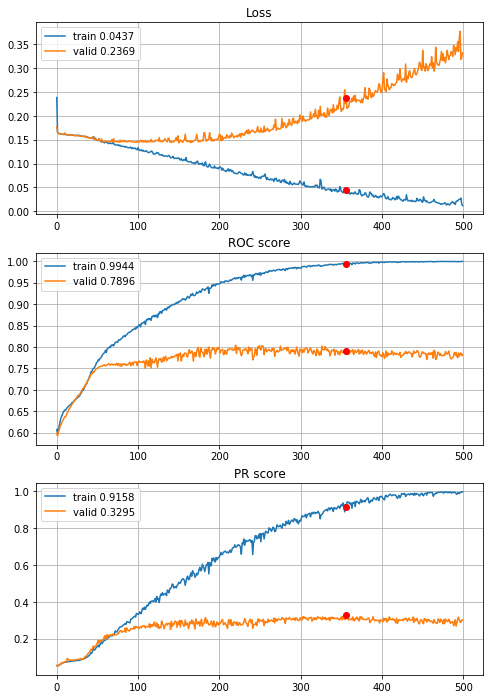


Fold 2------------------------------------------------------------


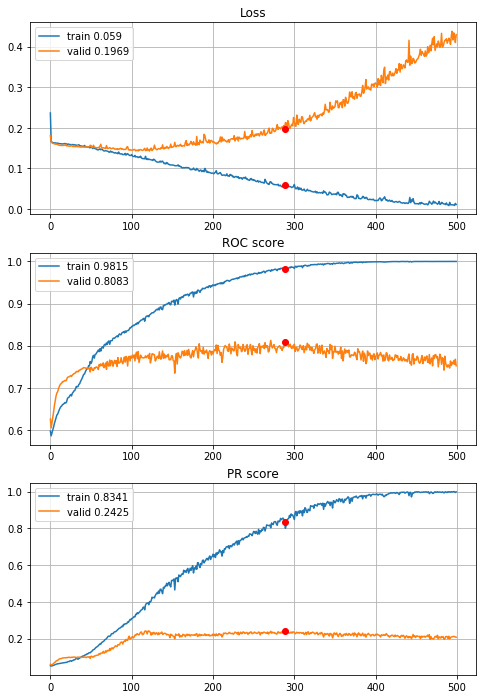


Fold 3------------------------------------------------------------


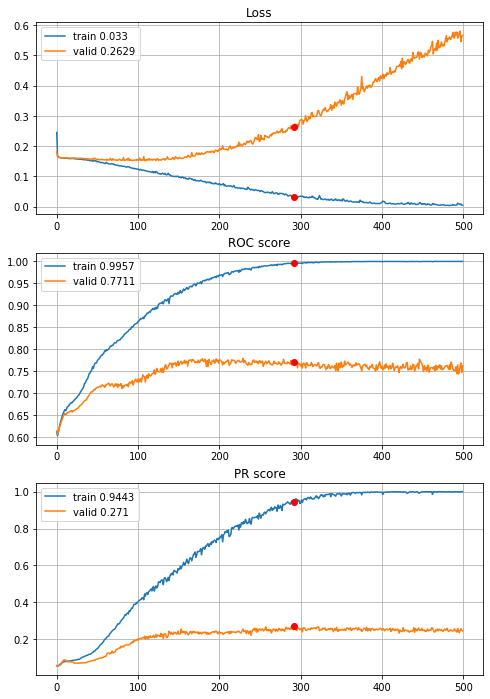


Fold 4------------------------------------------------------------


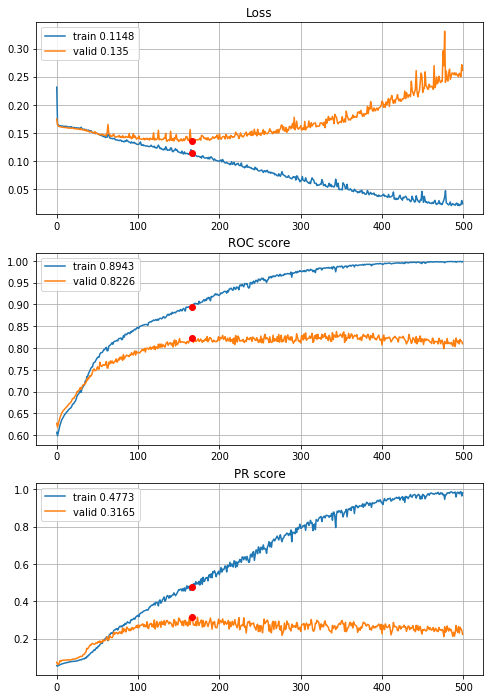


Fold 5------------------------------------------------------------


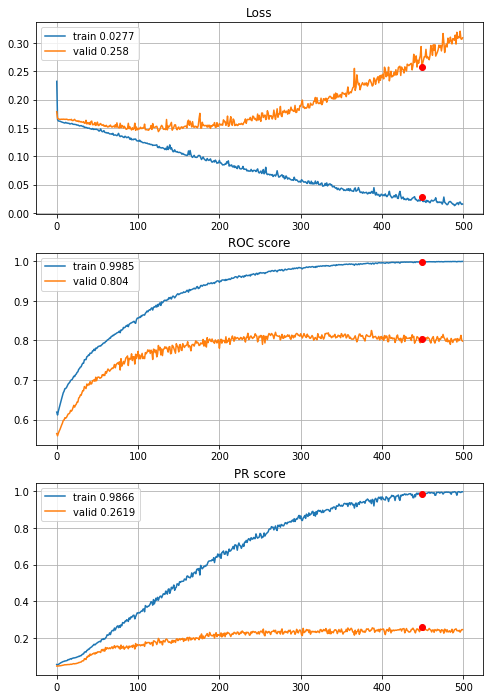


Fold 6------------------------------------------------------------


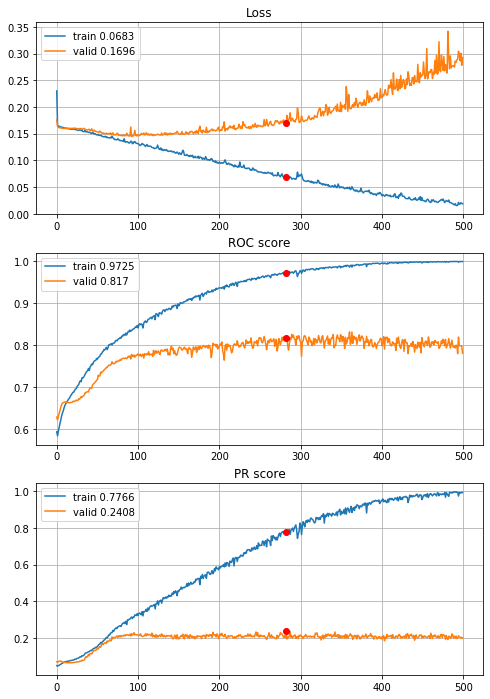

In [84]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std, features=features,
                                        target=target, n_epochs=500, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_500ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Results are not so good, things to try:
 - best model found for 1 year horizon,
 - best model found for 2 year horizon,
 - experiment based on results
 
##### best 1 year horizon model

In [47]:
def define_deep_CNN_2inc_std_L1_000025(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l1(l=0.000025))(flat)                          # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/450,
cumulative time: 3.77s train loss: 0.37110843978307556, validation loss: 0.2899194719516434
Epoch: 2/450,
cumulative time: 5.12s train loss: 0.26260579157772534, validation loss: 0.24579966204975723
Epoch: 3/450,
cumulative time: 6.43s train loss: 0.23411612042727267, validation loss: 0.22271871113683417
Epoch: 4/450,
cumulative time: 7.73s train loss: 0.21601329611238107, validation loss: 0.20977056366275523
Epoch: 5/450,
cumulative time: 9.0s train loss: 0.2074935388609597, validation loss: 0.20474922889416372
Epoch: 6/450,
cumulative time: 10.28s train loss: 0.20361868801787603, validation loss: 0.20146346295333004
Epoch: 7/450,
cumulative time: 11.57s train loss: 0.20112021200418442, validation loss: 0.19956945691399305
Epoch: 8/450,
cumulative time: 12.86s train loss: 0.1980044516202647, validation loss: 0.1966544947492967
Epoch: 9/450,
cumulative time: 14.14s train loss: 0.196310742671906

Epoch: 77/450,
cumulative time: 102.23s train loss: 0.16023389149937223, validation loss: 0.16132694777701817
Epoch: 78/450,
cumulative time: 103.51s train loss: 0.16039203829269358, validation loss: 0.15982155836776857
Epoch: 79/450,
cumulative time: 104.79s train loss: 0.16064194237198332, validation loss: 0.1619416953676025
Epoch: 80/450,
cumulative time: 106.06s train loss: 0.16205138368670008, validation loss: 0.16018022785297698
Epoch: 81/450,
cumulative time: 107.35s train loss: 0.15979120123001989, validation loss: 0.15963207464543114
Epoch: 82/450,
cumulative time: 108.63s train loss: 0.15941907053229568, validation loss: 0.15959556538460296
Epoch: 83/450,
cumulative time: 109.97s train loss: 0.15941385013440879, validation loss: 0.15982509232559491
Epoch: 84/450,
cumulative time: 111.35s train loss: 0.15914680683678453, validation loss: 0.15915718292854092
Epoch: 85/450,
cumulative time: 112.66s train loss: 0.1585363320940865, validation loss: 0.15883116761947522
Epoch: 86/45

Epoch: 152/450,
cumulative time: 198.38s train loss: 0.13681150892956226, validation loss: 0.14711228305984136
Epoch: 153/450,
cumulative time: 199.67s train loss: 0.1352925392272807, validation loss: 0.14723317870970323
Epoch: 154/450,
cumulative time: 200.93s train loss: 0.13569228421236995, validation loss: 0.14910982859712754
Epoch: 155/450,
cumulative time: 202.21s train loss: 0.13601650922478753, validation loss: 0.1475297136141932
Epoch: 156/450,
cumulative time: 203.49s train loss: 0.1347583599026276, validation loss: 0.14752014833813726
Epoch: 157/450,
cumulative time: 204.77s train loss: 0.1347939829684004, validation loss: 0.14822939836064922
Epoch: 158/450,
cumulative time: 206.05s train loss: 0.13576050913006532, validation loss: 0.14808863227598631
Epoch: 159/450,
cumulative time: 207.33s train loss: 0.1340817504069614, validation loss: 0.1523403767423111
Epoch: 160/450,
cumulative time: 208.59s train loss: 0.13766523378050677, validation loss: 0.14923590756610994
Epoch: 

Epoch: 227/450,
cumulative time: 298.5s train loss: 0.12367720427429837, validation loss: 0.14962742892661537
Epoch: 228/450,
cumulative time: 299.8s train loss: 0.1231035689317566, validation loss: 0.1471368071292362
Epoch: 229/450,
cumulative time: 301.07s train loss: 0.12235607214439023, validation loss: 0.14785147534480725
Epoch: 230/450,
cumulative time: 302.35s train loss: 0.12353678545924966, validation loss: 0.15079512643392246
Epoch: 231/450,
cumulative time: 303.62s train loss: 0.12432871542520395, validation loss: 0.14934403235446736
Epoch: 232/450,
cumulative time: 304.92s train loss: 0.12628218830745144, validation loss: 0.15300794287559089
Epoch: 233/450,
cumulative time: 306.18s train loss: 0.12598781684370336, validation loss: 0.14845748146114623
Epoch: 234/450,
cumulative time: 307.47s train loss: 0.12293863142203934, validation loss: 0.14781449688293363
Epoch: 235/450,
cumulative time: 308.74s train loss: 0.12134793293434697, validation loss: 0.14941891535706475
Epoch

Epoch: 302/450,
cumulative time: 395.04s train loss: 0.108709591820881, validation loss: 0.15333421899403687
Epoch: 303/450,
cumulative time: 396.32s train loss: 0.11542963424763684, validation loss: 0.15092067697804376
Epoch: 304/450,
cumulative time: 397.6s train loss: 0.11070529333216786, validation loss: 0.15292853322050987
Epoch: 305/450,
cumulative time: 398.87s train loss: 0.11385588606714281, validation loss: 0.1519404296442222
Epoch: 306/450,
cumulative time: 400.14s train loss: 0.1117277109915158, validation loss: 0.15182291934093362
Epoch: 307/450,
cumulative time: 401.41s train loss: 0.10797026610254132, validation loss: 0.15176381534002087
Epoch: 308/450,
cumulative time: 402.69s train loss: 0.10747674969021905, validation loss: 0.15224717137541716
Epoch: 309/450,
cumulative time: 403.97s train loss: 0.10712905384103066, validation loss: 0.15345477708279695
Epoch: 310/450,
cumulative time: 405.26s train loss: 0.1068613860491985, validation loss: 0.1527373802654084
Epoch: 3

Epoch: 377/450,
cumulative time: 491.21s train loss: 0.09084204922756528, validation loss: 0.17218756630801904
Epoch: 378/450,
cumulative time: 492.49s train loss: 0.0899914143391433, validation loss: 0.17065027395207166
Epoch: 379/450,
cumulative time: 493.75s train loss: 0.08957326854606618, validation loss: 0.16688349366500524
Epoch: 380/450,
cumulative time: 495.03s train loss: 0.09057285378251637, validation loss: 0.17055501545709834
Epoch: 381/450,
cumulative time: 496.3s train loss: 0.08945805969873782, validation loss: 0.17206163940704666
Epoch: 382/450,
cumulative time: 497.58s train loss: 0.08995565288828467, validation loss: 0.1717471986774692
Epoch: 383/450,
cumulative time: 498.87s train loss: 0.08925051837358738, validation loss: 0.17412679961749486
Epoch: 384/450,
cumulative time: 500.13s train loss: 0.08711435919465674, validation loss: 0.17354186424109133
Epoch: 385/450,
cumulative time: 501.4s train loss: 0.08749646943529853, validation loss: 0.18451189196047277
Epoch

Train on 7629 samples, validate on 1526 samples
Epoch: 1/450,
cumulative time: 3.48s train loss: 0.3570788358701355, validation loss: 0.28547673636307724
Epoch: 2/450,
cumulative time: 4.79s train loss: 0.25937265505373813, validation loss: 0.24393240753976264
Epoch: 3/450,
cumulative time: 6.05s train loss: 0.23317014402261269, validation loss: 0.22046288525683227
Epoch: 4/450,
cumulative time: 7.33s train loss: 0.21523158435061182, validation loss: 0.20742032886879472
Epoch: 5/450,
cumulative time: 8.6s train loss: 0.20651943522053412, validation loss: 0.20203885959454007
Epoch: 6/450,
cumulative time: 9.87s train loss: 0.2024109597884432, validation loss: 0.19863426927501535
Epoch: 7/450,
cumulative time: 11.14s train loss: 0.20008853615806932, validation loss: 0.19571012649123665
Epoch: 8/450,
cumulative time: 12.43s train loss: 0.19705393429328455, validation loss: 0.19453307072269493
Epoch: 9/450,
cumulative time: 13.73s train loss: 0.19546925400645382, validation loss: 0.1913230

Epoch: 77/450,
cumulative time: 100.36s train loss: 0.160372641533789, validation loss: 0.15817454006146947
Epoch: 78/450,
cumulative time: 101.64s train loss: 0.16000543557999097, validation loss: 0.15842093738237809
Epoch: 79/450,
cumulative time: 102.9s train loss: 0.15997224628460455, validation loss: 0.15730801863329752
Epoch: 80/450,
cumulative time: 104.18s train loss: 0.159475141850801, validation loss: 0.15920957286267262
Epoch: 81/450,
cumulative time: 105.45s train loss: 0.15980423113038458, validation loss: 0.15769383254635538
Epoch: 82/450,
cumulative time: 106.73s train loss: 0.15916485701824237, validation loss: 0.15704612982694943
Epoch: 83/450,
cumulative time: 108.0s train loss: 0.15904027149364447, validation loss: 0.15699763646835113
Epoch: 84/450,
cumulative time: 109.26s train loss: 0.1582366873703429, validation loss: 0.15700107465252808
Epoch: 85/450,
cumulative time: 110.52s train loss: 0.15906979428985857, validation loss: 0.15802229698722983
Epoch: 86/450,
cu

Epoch: 152/450,
cumulative time: 196.02s train loss: 0.1408264433799307, validation loss: 0.15003318047617242
Epoch: 153/450,
cumulative time: 197.29s train loss: 0.14234147364509764, validation loss: 0.15179318763794156
Epoch: 154/450,
cumulative time: 198.57s train loss: 0.14303139456642894, validation loss: 0.15121798984813814
Epoch: 155/450,
cumulative time: 199.83s train loss: 0.1426978457749851, validation loss: 0.14933088595635927
Epoch: 156/450,
cumulative time: 201.11s train loss: 0.1406255146623564, validation loss: 0.1496963888445813
Epoch: 157/450,
cumulative time: 202.4s train loss: 0.14083610443616384, validation loss: 0.15093922831830942
Epoch: 158/450,
cumulative time: 203.66s train loss: 0.1401979714682818, validation loss: 0.15091151629878527
Epoch: 159/450,
cumulative time: 204.93s train loss: 0.14064851697978192, validation loss: 0.1523583108756989
Epoch: 160/450,
cumulative time: 206.2s train loss: 0.13994312335988893, validation loss: 0.15154141384917819
Epoch: 16

Epoch: 227/450,
cumulative time: 291.93s train loss: 0.12628517154082197, validation loss: 0.1551416013414238
Epoch: 228/450,
cumulative time: 293.21s train loss: 0.126289024484206, validation loss: 0.153514771462268
Epoch: 229/450,
cumulative time: 294.47s train loss: 0.12881252788977035, validation loss: 0.1504272058860034
Epoch: 230/450,
cumulative time: 295.73s train loss: 0.12546526405778183, validation loss: 0.15469782353228698
Epoch: 231/450,
cumulative time: 297.0s train loss: 0.12344328907651317, validation loss: 0.15961368797959694
Epoch: 232/450,
cumulative time: 298.29s train loss: 0.12357476189183696, validation loss: 0.1553865043473275
Epoch: 233/450,
cumulative time: 299.54s train loss: 0.12100225883130869, validation loss: 0.15177036583579853
Epoch: 234/450,
cumulative time: 300.82s train loss: 0.12243368996089714, validation loss: 0.15147896464499078
Epoch: 235/450,
cumulative time: 302.1s train loss: 0.12212386318718188, validation loss: 0.156226089358486
Epoch: 236/4

Epoch: 302/450,
cumulative time: 387.87s train loss: 0.10622229311272925, validation loss: 0.15955002988697192
Epoch: 303/450,
cumulative time: 389.15s train loss: 0.10618380226193883, validation loss: 0.16727131659831476
Epoch: 304/450,
cumulative time: 390.43s train loss: 0.10900681173661571, validation loss: 0.16182681529503193
Epoch: 305/450,
cumulative time: 391.7s train loss: 0.10975272392446114, validation loss: 0.1635044509859885
Epoch: 306/450,
cumulative time: 392.96s train loss: 0.10506975765832365, validation loss: 0.1653103058569397
Epoch: 307/450,
cumulative time: 394.23s train loss: 0.10695296555839558, validation loss: 0.166934567795356
Epoch: 308/450,
cumulative time: 395.49s train loss: 0.10468974444360372, validation loss: 0.16871099320495425
Epoch: 309/450,
cumulative time: 396.75s train loss: 0.10727482530396924, validation loss: 0.16226361596256222
Epoch: 310/450,
cumulative time: 398.02s train loss: 0.10355761958568652, validation loss: 0.17184208003440346
Epoch:

Epoch: 377/450,
cumulative time: 483.6s train loss: 0.09037761688076164, validation loss: 0.18228955643048916
Epoch: 378/450,
cumulative time: 484.92s train loss: 0.09082021376344883, validation loss: 0.18520323672425856
Epoch: 379/450,
cumulative time: 486.25s train loss: 0.08991246520574447, validation loss: 0.1823305746010684
Epoch: 380/450,
cumulative time: 487.51s train loss: 0.08896209746560133, validation loss: 0.18372751401339416
Epoch: 381/450,
cumulative time: 488.81s train loss: 0.09588535074942983, validation loss: 0.18854571816415025
Epoch: 382/450,
cumulative time: 490.1s train loss: 0.08913148257298853, validation loss: 0.18742426056146308
Epoch: 383/450,
cumulative time: 491.36s train loss: 0.08784057875673523, validation loss: 0.18899318132534876
Epoch: 384/450,
cumulative time: 492.64s train loss: 0.087249566915034, validation loss: 0.19334131381614805
Epoch: 385/450,
cumulative time: 493.92s train loss: 0.08742083626292545, validation loss: 0.1908445826207982
Epoch: 

Train on 7629 samples, validate on 1526 samples
Epoch: 1/450,
cumulative time: 3.75s train loss: 0.36442071602172316, validation loss: 0.2866141418798254
Epoch: 2/450,
cumulative time: 5.1s train loss: 0.2637906879467895, validation loss: 0.24330717829076834
Epoch: 3/450,
cumulative time: 6.44s train loss: 0.2334339432325568, validation loss: 0.22215690708879093
Epoch: 4/450,
cumulative time: 7.77s train loss: 0.2155213355471163, validation loss: 0.2094356929724682
Epoch: 5/450,
cumulative time: 9.1s train loss: 0.20699969671597282, validation loss: 0.20536959659537668
Epoch: 6/450,
cumulative time: 10.43s train loss: 0.20314865039097776, validation loss: 0.20119198150981613
Epoch: 7/450,
cumulative time: 11.74s train loss: 0.19939284649311223, validation loss: 0.19822276074092635
Epoch: 8/450,
cumulative time: 13.13s train loss: 0.19780994151097667, validation loss: 0.1970046216311961
Epoch: 9/450,
cumulative time: 14.58s train loss: 0.1951646987436202, validation loss: 0.194465868360

Epoch: 77/450,
cumulative time: 102.49s train loss: 0.1573448923915363, validation loss: 0.16118915619262705
Epoch: 78/450,
cumulative time: 103.77s train loss: 0.1570588978531633, validation loss: 0.16448830726262315
Epoch: 79/450,
cumulative time: 105.06s train loss: 0.15673969060608375, validation loss: 0.1619384956508289
Epoch: 80/450,
cumulative time: 106.33s train loss: 0.15689543556817034, validation loss: 0.1610162664561253
Epoch: 81/450,
cumulative time: 107.62s train loss: 0.155863844635626, validation loss: 0.16045714701925004
Epoch: 82/450,
cumulative time: 108.9s train loss: 0.1553681587615071, validation loss: 0.1603427843177303
Epoch: 83/450,
cumulative time: 110.19s train loss: 0.15568475838546, validation loss: 0.16737537931645993
Epoch: 84/450,
cumulative time: 111.46s train loss: 0.155870194050881, validation loss: 0.16011372243748737
Epoch: 85/450,
cumulative time: 112.74s train loss: 0.15495530820319467, validation loss: 0.16049073146336357
Epoch: 86/450,
cumulativ

Epoch: 152/450,
cumulative time: 199.35s train loss: 0.138871548416332, validation loss: 0.15141138567212056
Epoch: 153/450,
cumulative time: 200.67s train loss: 0.13881532049109543, validation loss: 0.15221065729075303
Epoch: 154/450,
cumulative time: 201.94s train loss: 0.13757875212868007, validation loss: 0.15079213790156112
Epoch: 155/450,
cumulative time: 203.22s train loss: 0.13822022243125173, validation loss: 0.1511240683466704
Epoch: 156/450,
cumulative time: 204.51s train loss: 0.13695455135196263, validation loss: 0.15152894887160193
Epoch: 157/450,
cumulative time: 205.79s train loss: 0.13742756782626242, validation loss: 0.1536107149321786
Epoch: 158/450,
cumulative time: 207.07s train loss: 0.13948725198313391, validation loss: 0.15253649201844655
Epoch: 159/450,
cumulative time: 208.35s train loss: 0.13838693712955066, validation loss: 0.1499776078746953
Epoch: 160/450,
cumulative time: 209.64s train loss: 0.13604071559861786, validation loss: 0.15412287202176697
Epoch:

Epoch: 227/450,
cumulative time: 296.03s train loss: 0.12199522177901802, validation loss: 0.15635698302349912
Epoch: 228/450,
cumulative time: 297.31s train loss: 0.12223396177122486, validation loss: 0.14733241788486354
Epoch: 229/450,
cumulative time: 298.6s train loss: 0.12101364754328864, validation loss: 0.14949405145481093
Epoch: 230/450,
cumulative time: 299.88s train loss: 0.1205976182229398, validation loss: 0.14757485295185724
Epoch: 231/450,
cumulative time: 301.16s train loss: 0.12031634341007855, validation loss: 0.15273013668010307
Epoch: 232/450,
cumulative time: 302.45s train loss: 0.11936703568910659, validation loss: 0.15746835885791605
Epoch: 233/450,
cumulative time: 303.73s train loss: 0.12100267333907183, validation loss: 0.14893733871170609
Epoch: 234/450,
cumulative time: 305.01s train loss: 0.12103399801752736, validation loss: 0.14848555163584093
Epoch: 235/450,
cumulative time: 306.3s train loss: 0.12011765911813832, validation loss: 0.1516555230063661
Epoch

Epoch: 302/450,
cumulative time: 392.93s train loss: 0.10646734077242681, validation loss: 0.15327931216003698
Epoch: 303/450,
cumulative time: 394.22s train loss: 0.10491478569519475, validation loss: 0.15015635115056644
Epoch: 304/450,
cumulative time: 395.49s train loss: 0.10465856072067949, validation loss: 0.15271786840566645
Epoch: 305/450,
cumulative time: 396.77s train loss: 0.10565491692296236, validation loss: 0.15031953740908935
Epoch: 306/450,
cumulative time: 398.04s train loss: 0.10406271703682887, validation loss: 0.15210472825587498
Epoch: 307/450,
cumulative time: 399.32s train loss: 0.10378947591186663, validation loss: 0.16102160084724113
Epoch: 308/450,
cumulative time: 400.61s train loss: 0.10362677632305253, validation loss: 0.1523777955598631
Epoch: 309/450,
cumulative time: 401.88s train loss: 0.10197344304365542, validation loss: 0.15326543369111978
Epoch: 310/450,
cumulative time: 403.16s train loss: 0.10327873445890072, validation loss: 0.15774384449537585
Ep

Epoch: 377/450,
cumulative time: 489.0s train loss: 0.09365365569069464, validation loss: 0.1562458807468258
Epoch: 378/450,
cumulative time: 490.28s train loss: 0.08555060371840542, validation loss: 0.1657679850921562
Epoch: 379/450,
cumulative time: 491.57s train loss: 0.0848281057901863, validation loss: 0.16517069994387745
Epoch: 380/450,
cumulative time: 492.85s train loss: 0.08473358592141783, validation loss: 0.16842797929775044
Epoch: 381/450,
cumulative time: 494.27s train loss: 0.08598798199236073, validation loss: 0.16991579728896777
Epoch: 382/450,
cumulative time: 495.59s train loss: 0.08343898330451714, validation loss: 0.16074120059003993
Epoch: 383/450,
cumulative time: 496.88s train loss: 0.08315888773720735, validation loss: 0.16064762238164093
Epoch: 384/450,
cumulative time: 498.17s train loss: 0.08330602018165782, validation loss: 0.16318391128730023
Epoch: 385/450,
cumulative time: 499.48s train loss: 0.08294382001113292, validation loss: 0.1613660469397336
Epoch:

Train on 7629 samples, validate on 1526 samples
Epoch: 1/450,
cumulative time: 3.48s train loss: 0.3594070968551051, validation loss: 0.2840956178827023
Epoch: 2/450,
cumulative time: 4.76s train loss: 0.26020180294625894, validation loss: 0.24471921564554636
Epoch: 3/450,
cumulative time: 6.05s train loss: 0.2336347894507477, validation loss: 0.2206131932112055
Epoch: 4/450,
cumulative time: 7.34s train loss: 0.21539273994014904, validation loss: 0.20781334539384705
Epoch: 5/450,
cumulative time: 8.63s train loss: 0.20677369625169306, validation loss: 0.202763755289474
Epoch: 6/450,
cumulative time: 9.91s train loss: 0.20264494216939008, validation loss: 0.19979704637202492
Epoch: 7/450,
cumulative time: 11.19s train loss: 0.19967881620891254, validation loss: 0.19660091091577223
Epoch: 8/450,
cumulative time: 12.48s train loss: 0.19826007477068966, validation loss: 0.1950097514089407
Epoch: 9/450,
cumulative time: 13.77s train loss: 0.19513724117920336, validation loss: 0.19243695128

Epoch: 77/450,
cumulative time: 101.79s train loss: 0.16120005806334006, validation loss: 0.16040963522337992
Epoch: 78/450,
cumulative time: 103.08s train loss: 0.16147094410167231, validation loss: 0.1598111719361764
Epoch: 79/450,
cumulative time: 104.37s train loss: 0.1615719499235182, validation loss: 0.1618372076929475
Epoch: 80/450,
cumulative time: 105.66s train loss: 0.16183150339632862, validation loss: 0.15955441823011926
Epoch: 81/450,
cumulative time: 106.95s train loss: 0.16119738903469427, validation loss: 0.15950659122488914
Epoch: 82/450,
cumulative time: 108.24s train loss: 0.1613225664356024, validation loss: 0.16108034295304574
Epoch: 83/450,
cumulative time: 109.51s train loss: 0.1621398636156898, validation loss: 0.16019418960630036
Epoch: 84/450,
cumulative time: 110.8s train loss: 0.16133934011647955, validation loss: 0.15979958898821164
Epoch: 85/450,
cumulative time: 112.08s train loss: 0.16074375294149898, validation loss: 0.16069380544506862
Epoch: 86/450,
c

Epoch: 152/450,
cumulative time: 198.58s train loss: 0.14763999032558597, validation loss: 0.146838913719276
Epoch: 153/450,
cumulative time: 199.87s train loss: 0.14753608430981996, validation loss: 0.1463545563766247
Epoch: 154/450,
cumulative time: 201.14s train loss: 0.14688207122972993, validation loss: 0.14754611695109626
Epoch: 155/450,
cumulative time: 202.43s train loss: 0.1484300940799157, validation loss: 0.14801552206238788
Epoch: 156/450,
cumulative time: 203.72s train loss: 0.14697487597513798, validation loss: 0.1460381371517169
Epoch: 157/450,
cumulative time: 205.0s train loss: 0.14642383541820528, validation loss: 0.14702018868876315
Epoch: 158/450,
cumulative time: 206.27s train loss: 0.14817097313142508, validation loss: 0.14739193871793085
Epoch: 159/450,
cumulative time: 207.55s train loss: 0.14857369658206016, validation loss: 0.14596465042502976
Epoch: 160/450,
cumulative time: 208.85s train loss: 0.14746636690771867, validation loss: 0.14514609071795936
Epoch: 

Epoch: 227/450,
cumulative time: 295.26s train loss: 0.13444731913351704, validation loss: 0.14961199226104416
Epoch: 228/450,
cumulative time: 296.57s train loss: 0.13314575466978892, validation loss: 0.14735115425927298
Epoch: 229/450,
cumulative time: 297.88s train loss: 0.133031566721933, validation loss: 0.1476915972026585
Epoch: 230/450,
cumulative time: 299.15s train loss: 0.13272390505920342, validation loss: 0.14774059790380661
Epoch: 231/450,
cumulative time: 300.45s train loss: 0.13387715168222092, validation loss: 0.1523075805461891
Epoch: 232/450,
cumulative time: 301.73s train loss: 0.1342714345264535, validation loss: 0.1518930504745456
Epoch: 233/450,
cumulative time: 303.01s train loss: 0.13335551281074723, validation loss: 0.14810508751306747
Epoch: 234/450,
cumulative time: 304.29s train loss: 0.13354171060249337, validation loss: 0.14867304054578354
Epoch: 235/450,
cumulative time: 305.56s train loss: 0.13320456151061297, validation loss: 0.14769011722245348
Epoch: 

Epoch: 302/450,
cumulative time: 392.02s train loss: 0.1250177326767578, validation loss: 0.15056111744628195
Epoch: 303/450,
cumulative time: 393.3s train loss: 0.12442227717362533, validation loss: 0.15050062154411176
Epoch: 304/450,
cumulative time: 394.61s train loss: 0.12489138692832272, validation loss: 0.15042626289443295
Epoch: 305/450,
cumulative time: 395.88s train loss: 0.1243079651597834, validation loss: 0.15167443717916546
Epoch: 306/450,
cumulative time: 397.17s train loss: 0.12481011958324764, validation loss: 0.15074015110926423
Epoch: 307/450,
cumulative time: 398.45s train loss: 0.12438256848837385, validation loss: 0.1505070753092847
Epoch: 308/450,
cumulative time: 399.73s train loss: 0.12548956060717376, validation loss: 0.15135433369585916
Epoch: 309/450,
cumulative time: 401.01s train loss: 0.12449559119726199, validation loss: 0.15053204076943205
Epoch: 310/450,
cumulative time: 402.29s train loss: 0.12396592481496653, validation loss: 0.15058143923198256
Epoch

Epoch: 377/450,
cumulative time: 488.07s train loss: 0.11809394901491646, validation loss: 0.1554247887309538
Epoch: 378/450,
cumulative time: 489.35s train loss: 0.1194332768230642, validation loss: 0.15793117665994527
Epoch: 379/450,
cumulative time: 490.66s train loss: 0.12002383867079222, validation loss: 0.15555752099029047
Epoch: 380/450,
cumulative time: 491.92s train loss: 0.11937816343007167, validation loss: 0.15580967707293375
Epoch: 381/450,
cumulative time: 493.2s train loss: 0.11958866213959969, validation loss: 0.1575538566040649
Epoch: 382/450,
cumulative time: 494.49s train loss: 0.11877680923714053, validation loss: 0.15440540994135454
Epoch: 383/450,
cumulative time: 495.77s train loss: 0.11889691709464242, validation loss: 0.1556867279239282
Epoch: 384/450,
cumulative time: 497.06s train loss: 0.11869289759809716, validation loss: 0.15519133651553413
Epoch: 385/450,
cumulative time: 498.34s train loss: 0.1206553731827088, validation loss: 0.15560624575630552
Epoch: 

Train on 7629 samples, validate on 1526 samples
Epoch: 1/450,
cumulative time: 3.55s train loss: 0.3697860977068096, validation loss: 0.2925784032044842
Epoch: 2/450,
cumulative time: 4.84s train loss: 0.26144767625567206, validation loss: 0.24708107689964348
Epoch: 3/450,
cumulative time: 6.14s train loss: 0.23231718285959754, validation loss: 0.22492103333320093
Epoch: 4/450,
cumulative time: 7.44s train loss: 0.2146345914632906, validation loss: 0.21266735662482825
Epoch: 5/450,
cumulative time: 8.72s train loss: 0.20637717060398064, validation loss: 0.20832171672918537
Epoch: 6/450,
cumulative time: 10.01s train loss: 0.20236239150930224, validation loss: 0.20441861909620102
Epoch: 7/450,
cumulative time: 11.3s train loss: 0.19845860798255163, validation loss: 0.20196503260188772
Epoch: 8/450,
cumulative time: 12.59s train loss: 0.1958881915064873, validation loss: 0.2003687836161447
Epoch: 9/450,
cumulative time: 13.88s train loss: 0.1938709112845956, validation loss: 0.1982314651

Epoch: 77/450,
cumulative time: 102.35s train loss: 0.1606448139443062, validation loss: 0.16443163810754355
Epoch: 78/450,
cumulative time: 103.64s train loss: 0.15767380302223313, validation loss: 0.1637613271432654
Epoch: 79/450,
cumulative time: 104.93s train loss: 0.15693775384442368, validation loss: 0.16412074584635963
Epoch: 80/450,
cumulative time: 106.22s train loss: 0.15695496382227667, validation loss: 0.16299375631940474
Epoch: 81/450,
cumulative time: 107.5s train loss: 0.15630489901081265, validation loss: 0.16308364541627476
Epoch: 82/450,
cumulative time: 108.79s train loss: 0.15719013604795593, validation loss: 0.16237357350586282
Epoch: 83/450,
cumulative time: 110.1s train loss: 0.1569082185045922, validation loss: 0.16681688482998863
Epoch: 84/450,
cumulative time: 111.4s train loss: 0.1566024795125768, validation loss: 0.1619967516135732
Epoch: 85/450,
cumulative time: 112.71s train loss: 0.15626516960671633, validation loss: 0.1619445790742984
Epoch: 86/450,
cumu

Epoch: 152/450,
cumulative time: 199.76s train loss: 0.13687228521695688, validation loss: 0.15304016637302165
Epoch: 153/450,
cumulative time: 201.05s train loss: 0.1363590237708841, validation loss: 0.15264198471099957
Epoch: 154/450,
cumulative time: 202.34s train loss: 0.134997115693503, validation loss: 0.15250251126789327
Epoch: 155/450,
cumulative time: 203.63s train loss: 0.13368778846408894, validation loss: 0.15045851508099317
Epoch: 156/450,
cumulative time: 204.93s train loss: 0.13630847969669974, validation loss: 0.1541700893585835
Epoch: 157/450,
cumulative time: 206.21s train loss: 0.13487930433268722, validation loss: 0.152958978694982
Epoch: 158/450,
cumulative time: 207.5s train loss: 0.13461630566316407, validation loss: 0.1531560847909235
Epoch: 159/450,
cumulative time: 208.8s train loss: 0.13298432827816203, validation loss: 0.1509572495443949
Epoch: 160/450,
cumulative time: 210.08s train loss: 0.13212860866683795, validation loss: 0.1527586899024006
Epoch: 161/4

Epoch: 227/450,
cumulative time: 297.11s train loss: 0.11269940954956194, validation loss: 0.14508741553067223
Epoch: 228/450,
cumulative time: 298.4s train loss: 0.11519241600697437, validation loss: 0.14347980541529848
Epoch: 229/450,
cumulative time: 299.69s train loss: 0.11577089659812051, validation loss: 0.14777361344775553
Epoch: 230/450,
cumulative time: 300.99s train loss: 0.11532652653584803, validation loss: 0.14382432270331277
Epoch: 231/450,
cumulative time: 302.28s train loss: 0.11235301380080748, validation loss: 0.14842122238554148
Epoch: 232/450,
cumulative time: 303.58s train loss: 0.11375592622321466, validation loss: 0.14271249400444455
Epoch: 233/450,
cumulative time: 304.88s train loss: 0.11224437870357715, validation loss: 0.14822027637949153
Epoch: 234/450,
cumulative time: 306.17s train loss: 0.11192892001167101, validation loss: 0.14244481315775281
Epoch: 235/450,
cumulative time: 307.49s train loss: 0.11091581936439784, validation loss: 0.14687717226510905
Ep

Epoch: 302/450,
cumulative time: 394.21s train loss: 0.09134158362491772, validation loss: 0.16588749739476924
Epoch: 303/450,
cumulative time: 395.52s train loss: 0.09148792160640992, validation loss: 0.15744892077161632
Epoch: 304/450,
cumulative time: 396.86s train loss: 0.09026634670683653, validation loss: 0.15656181962899424
Epoch: 305/450,
cumulative time: 398.17s train loss: 0.08823682750145657, validation loss: 0.15941276857299855
Epoch: 306/450,
cumulative time: 399.5s train loss: 0.08992882041087984, validation loss: 0.15790849920181585
Epoch: 307/450,
cumulative time: 400.84s train loss: 0.08889317637665163, validation loss: 0.1664150852324297
Epoch: 308/450,
cumulative time: 402.19s train loss: 0.0898558369736744, validation loss: 0.1554809152142561
Epoch: 309/450,
cumulative time: 403.55s train loss: 0.08844150174865717, validation loss: 0.1608440686764286
Epoch: 310/450,
cumulative time: 404.87s train loss: 0.09009264720593325, validation loss: 0.15914301228554503
Epoch:

Epoch: 377/450,
cumulative time: 491.41s train loss: 0.0696996178652328, validation loss: 0.20380577751646503
Epoch: 378/450,
cumulative time: 492.71s train loss: 0.06936891998879359, validation loss: 0.19411057110773314
Epoch: 379/450,
cumulative time: 494.0s train loss: 0.06497617284179531, validation loss: 0.18985824079922892
Epoch: 380/450,
cumulative time: 495.3s train loss: 0.0663329388280733, validation loss: 0.19202486215693923
Epoch: 381/450,
cumulative time: 496.59s train loss: 0.06629767390386761, validation loss: 0.19626136434656297
Epoch: 382/450,
cumulative time: 497.88s train loss: 0.06797646308020645, validation loss: 0.20071155037901817
Epoch: 383/450,
cumulative time: 499.16s train loss: 0.06441846971425352, validation loss: 0.19438177901826711
Epoch: 384/450,
cumulative time: 500.46s train loss: 0.06470602522836723, validation loss: 0.20212334847544
Epoch: 385/450,
cumulative time: 501.74s train loss: 0.06737341567325099, validation loss: 0.19900642145976796
Epoch: 3

Train on 7630 samples, validate on 1525 samples
Epoch: 1/450,
cumulative time: 3.5s train loss: 0.35837120741879175, validation loss: 0.28513114745499657
Epoch: 2/450,
cumulative time: 4.79s train loss: 0.2610795718423661, validation loss: 0.2434028836351926
Epoch: 3/450,
cumulative time: 6.09s train loss: 0.23346687175265146, validation loss: 0.22009335662497848
Epoch: 4/450,
cumulative time: 7.37s train loss: 0.21547419772548101, validation loss: 0.20756536097800146
Epoch: 5/450,
cumulative time: 8.66s train loss: 0.20713924281640883, validation loss: 0.20336970718180547
Epoch: 6/450,
cumulative time: 9.96s train loss: 0.20314345252388896, validation loss: 0.19937537776642159
Epoch: 7/450,
cumulative time: 11.25s train loss: 0.19948320918048817, validation loss: 0.1965093020337527
Epoch: 8/450,
cumulative time: 12.54s train loss: 0.1971696290127728, validation loss: 0.1942765771267844
Epoch: 9/450,
cumulative time: 13.84s train loss: 0.19499178115537252, validation loss: 0.1921498319

Epoch: 77/450,
cumulative time: 102.23s train loss: 0.1567787336490726, validation loss: 0.1616069891902267
Epoch: 78/450,
cumulative time: 103.52s train loss: 0.15640649444192922, validation loss: 0.16262984436066424
Epoch: 79/450,
cumulative time: 104.81s train loss: 0.15671344062369585, validation loss: 0.1618998626705076
Epoch: 80/450,
cumulative time: 106.11s train loss: 0.1554033394839473, validation loss: 0.16103938180892194
Epoch: 81/450,
cumulative time: 107.42s train loss: 0.15627394598050637, validation loss: 0.16093646245901702
Epoch: 82/450,
cumulative time: 108.7s train loss: 0.15521149395490225, validation loss: 0.16094400893469327
Epoch: 83/450,
cumulative time: 109.99s train loss: 0.15542604059840248, validation loss: 0.16225273472363833
Epoch: 84/450,
cumulative time: 111.28s train loss: 0.15938275429868135, validation loss: 0.16148794900198452
Epoch: 85/450,
cumulative time: 112.56s train loss: 0.15419781149644526, validation loss: 0.16042036466911191
Epoch: 86/450,


Epoch: 152/450,
cumulative time: 199.66s train loss: 0.14573928576309433, validation loss: 0.15568896080626815
Epoch: 153/450,
cumulative time: 200.96s train loss: 0.1442506257097968, validation loss: 0.1549987750756936
Epoch: 154/450,
cumulative time: 202.26s train loss: 0.14609184079799864, validation loss: 0.15598382972302985
Epoch: 155/450,
cumulative time: 203.54s train loss: 0.1465561599086184, validation loss: 0.15179887119863855
Epoch: 156/450,
cumulative time: 204.83s train loss: 0.14419815163585806, validation loss: 0.15208150996536504
Epoch: 157/450,
cumulative time: 206.12s train loss: 0.14428455099404874, validation loss: 0.15605883603213264
Epoch: 158/450,
cumulative time: 207.41s train loss: 0.14330871207920315, validation loss: 0.15332315749809391
Epoch: 159/450,
cumulative time: 208.7s train loss: 0.14290639258930912, validation loss: 0.1520549209293772
Epoch: 160/450,
cumulative time: 209.99s train loss: 0.14379131400257075, validation loss: 0.15246678979670414
Epoch:

Epoch: 227/450,
cumulative time: 297.65s train loss: 0.1289941644098312, validation loss: 0.15102171584230956
Epoch: 228/450,
cumulative time: 298.95s train loss: 0.12930209260741504, validation loss: 0.15023386478424072
Epoch: 229/450,
cumulative time: 300.24s train loss: 0.12763013066345555, validation loss: 0.15148929689751298
Epoch: 230/450,
cumulative time: 301.54s train loss: 0.12699952111487933, validation loss: 0.15093806727010695
Epoch: 231/450,
cumulative time: 302.83s train loss: 0.12581373340160942, validation loss: 0.15144211550227932
Epoch: 232/450,
cumulative time: 304.12s train loss: 0.12440498215811593, validation loss: 0.15340921175284464
Epoch: 233/450,
cumulative time: 305.41s train loss: 0.12583754316343393, validation loss: 0.15080517612519811
Epoch: 234/450,
cumulative time: 306.7s train loss: 0.12517179553427515, validation loss: 0.14972556108334026
Epoch: 235/450,
cumulative time: 307.99s train loss: 0.12431452580548208, validation loss: 0.15295761952634718
Epo

Epoch: 302/450,
cumulative time: 394.81s train loss: 0.11247066930815246, validation loss: 0.1581274622190194
Epoch: 303/450,
cumulative time: 396.1s train loss: 0.10935941797291779, validation loss: 0.15805643720705
Epoch: 304/450,
cumulative time: 397.39s train loss: 0.10735853381972482, validation loss: 0.16373647892084278
Epoch: 305/450,
cumulative time: 398.69s train loss: 0.11077228997239591, validation loss: 0.15923912995174283
Epoch: 306/450,
cumulative time: 400.04s train loss: 0.10729427846981064, validation loss: 0.15672890135499298
Epoch: 307/450,
cumulative time: 401.43s train loss: 0.10809921371710253, validation loss: 0.15906364364702194
Epoch: 308/450,
cumulative time: 402.74s train loss: 0.10627407844069744, validation loss: 0.15702742916638734
Epoch: 309/450,
cumulative time: 404.05s train loss: 0.10624761830815169, validation loss: 0.16276062967347318
Epoch: 310/450,
cumulative time: 405.36s train loss: 0.10635101033635877, validation loss: 0.16429613386998412
Epoch:

Epoch: 377/450,
cumulative time: 492.15s train loss: 0.09213857446573821, validation loss: 0.16868680226021127
Epoch: 378/450,
cumulative time: 493.44s train loss: 0.090837794257179, validation loss: 0.16540965888343873
Epoch: 379/450,
cumulative time: 494.73s train loss: 0.09245481395588634, validation loss: 0.1672789464915385
Epoch: 380/450,
cumulative time: 496.03s train loss: 0.09240646132440117, validation loss: 0.16773207986941102
Epoch: 381/450,
cumulative time: 497.31s train loss: 0.08948148100064435, validation loss: 0.17023506945273914
Epoch: 382/450,
cumulative time: 498.59s train loss: 0.09405567370267245, validation loss: 0.17612275043471914
Epoch: 383/450,
cumulative time: 499.88s train loss: 0.09275689560573348, validation loss: 0.17205948408509864
Epoch: 384/450,
cumulative time: 501.17s train loss: 0.09183487776046811, validation loss: 0.17097259921128632
Epoch: 385/450,
cumulative time: 502.46s train loss: 0.09178649030557466, validation loss: 0.16849622914048493
Epoc

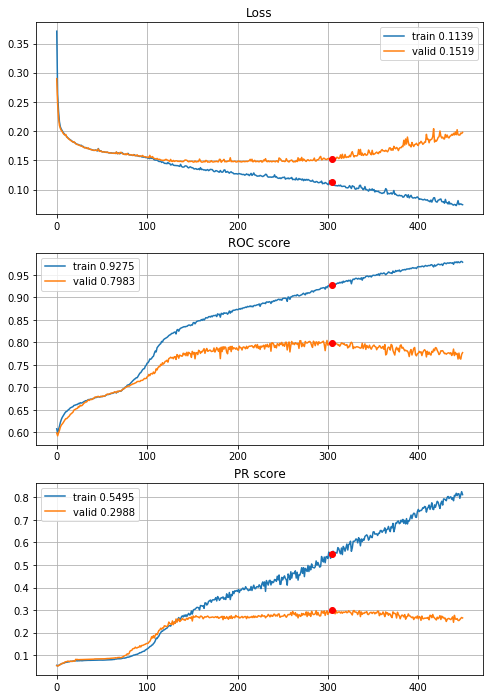


Fold 2------------------------------------------------------------


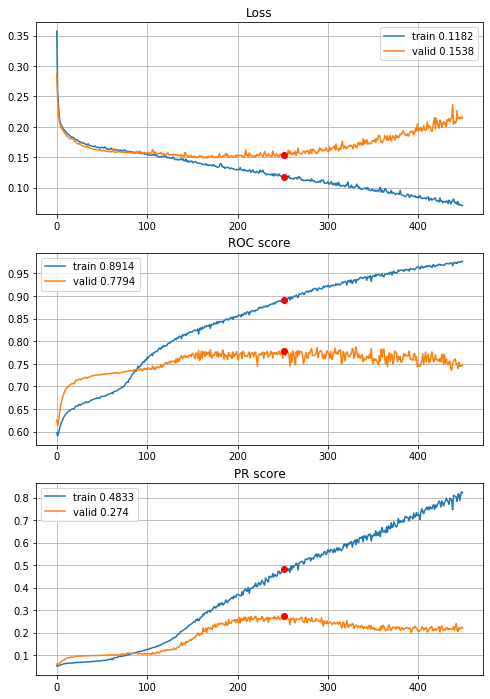


Fold 3------------------------------------------------------------


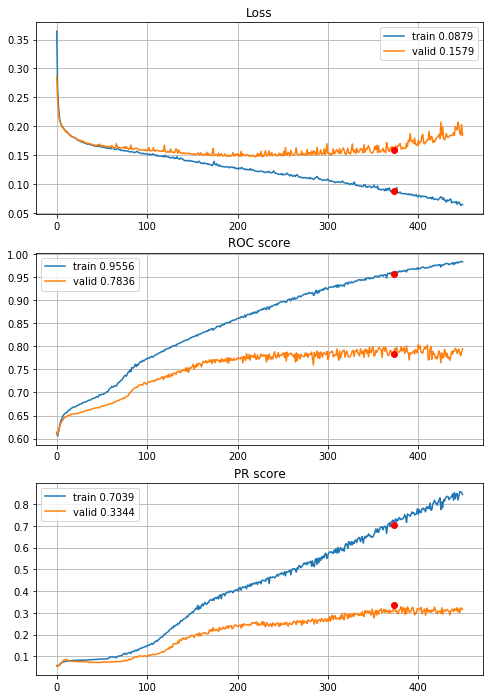


Fold 4------------------------------------------------------------


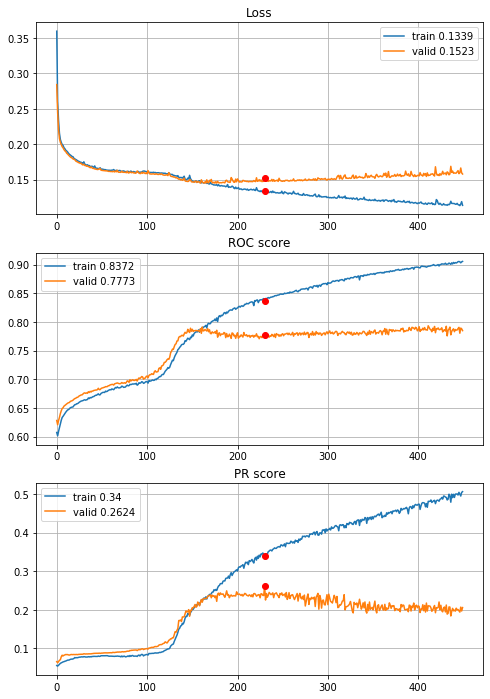


Fold 5------------------------------------------------------------


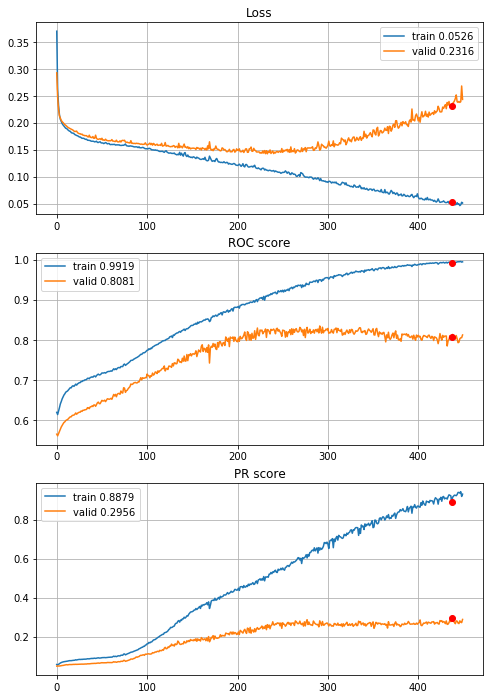


Fold 6------------------------------------------------------------


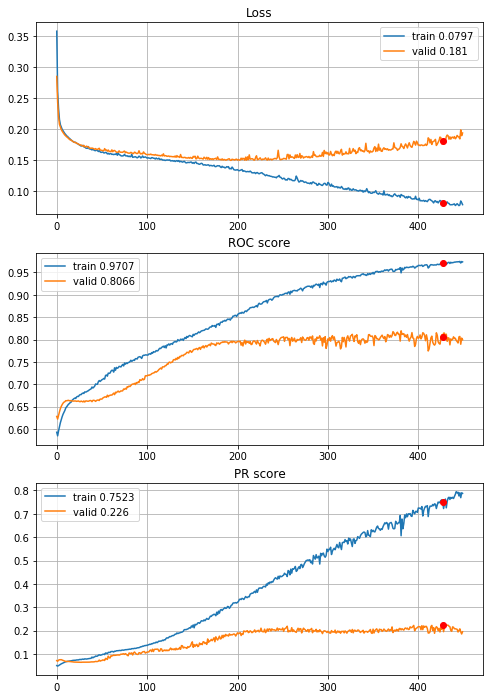

In [48]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L1_000025,
                                        features=features, target=target, n_epochs=450, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_L1_000025_450ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

very little improvement, lets try the model created for 2 year horizon.

##### best 2 years horizon model

In [48]:
def define_deep_CNN_2inc_std_L2_drop_04(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 3.8s train loss: 0.2631373732250786, validation loss: 0.19609465304552182
Epoch: 2/400,
cumulative time: 5.18s train loss: 0.1810804256247199, validation loss: 0.17464235803871606
Epoch: 3/400,
cumulative time: 6.57s train loss: 0.17354181192074056, validation loss: 0.171147317973455
Epoch: 4/400,
cumulative time: 7.92s train loss: 0.17169778171850072, validation loss: 0.16926828284563586
Epoch: 5/400,
cumulative time: 9.29s train loss: 0.1711084039925529, validation loss: 0.1684582621972339
Epoch: 6/400,
cumulative time: 10.66s train loss: 0.17019506655306285, validation loss: 0.16776783337638387
Epoch: 7/400,
cumulative time: 12.03s train loss: 0.1712184375712812, validation loss: 0.16812241020786967
Epoch: 8/400,
cumulative time: 13.4s train loss: 0.1694587611354402, validation loss: 0.1669483331873095
Epoch: 9/400,
cumulative time: 14.77s train loss: 0.16797200276976973, va

Epoch: 77/400,
cumulative time: 107.78s train loss: 0.14964744691057152, validation loss: 0.15069608270223614
Epoch: 78/400,
cumulative time: 109.13s train loss: 0.1490571630635476, validation loss: 0.15035684773915717
Epoch: 79/400,
cumulative time: 110.47s train loss: 0.1506855085361268, validation loss: 0.15487871951817841
Epoch: 80/400,
cumulative time: 111.81s train loss: 0.1522583433822811, validation loss: 0.15146312725926758
Epoch: 81/400,
cumulative time: 113.16s train loss: 0.1500513400642724, validation loss: 0.1496623235499562
Epoch: 82/400,
cumulative time: 114.54s train loss: 0.1487774631475571, validation loss: 0.1493764067871855
Epoch: 83/400,
cumulative time: 115.9s train loss: 0.1485238853636443, validation loss: 0.1494227480216545
Epoch: 84/400,
cumulative time: 117.24s train loss: 0.14693323104522818, validation loss: 0.14937406896490257
Epoch: 85/400,
cumulative time: 118.58s train loss: 0.1479533776095942, validation loss: 0.14900068721952475
Epoch: 86/400,
cumula

Epoch: 152/400,
cumulative time: 217.74s train loss: 0.1317483307509298, validation loss: 0.14632252622322517
Epoch: 153/400,
cumulative time: 219.15s train loss: 0.12836824876481762, validation loss: 0.14567739080984346
Epoch: 154/400,
cumulative time: 220.55s train loss: 0.12980712870733346, validation loss: 0.14750738852067824
Epoch: 155/400,
cumulative time: 221.98s train loss: 0.1301470074647844, validation loss: 0.14912257985081304
Epoch: 156/400,
cumulative time: 223.36s train loss: 0.12773520025322238, validation loss: 0.14534035133659293
Epoch: 157/400,
cumulative time: 224.74s train loss: 0.1290367794550173, validation loss: 0.14606498314621877
Epoch: 158/400,
cumulative time: 226.13s train loss: 0.12808222864016056, validation loss: 0.14509173173110732
Epoch: 159/400,
cumulative time: 227.52s train loss: 0.1281115383931312, validation loss: 0.14897685454057366
Epoch: 160/400,
cumulative time: 228.93s train loss: 0.13130734860897064, validation loss: 0.14533443291955975
Epoch

Epoch: 227/400,
cumulative time: 325.19s train loss: 0.1091952388799742, validation loss: 0.1480100138667058
Epoch: 228/400,
cumulative time: 326.6s train loss: 0.10845188707843773, validation loss: 0.15036655024065101
Epoch: 229/400,
cumulative time: 328.14s train loss: 0.11024138874410098, validation loss: 0.14592614195762424
Epoch: 230/400,
cumulative time: 329.58s train loss: 0.10605946269146595, validation loss: 0.1516806756196297
Epoch: 231/400,
cumulative time: 331.18s train loss: 0.11028865565125791, validation loss: 0.14616039528134298
Epoch: 232/400,
cumulative time: 332.7s train loss: 0.11083035256192605, validation loss: 0.15253524991975387
Epoch: 233/400,
cumulative time: 334.14s train loss: 0.11364438262890045, validation loss: 0.159381045748725
Epoch: 234/400,
cumulative time: 335.6s train loss: 0.11059802073703585, validation loss: 0.145184017542071
Epoch: 235/400,
cumulative time: 337.03s train loss: 0.10782823130646607, validation loss: 0.15273476106897094
Epoch: 236/

Epoch: 302/400,
cumulative time: 433.39s train loss: 0.09171834341651382, validation loss: 0.1551500024715851
Epoch: 303/400,
cumulative time: 434.76s train loss: 0.09846376925843589, validation loss: 0.1508591470075466
Epoch: 304/400,
cumulative time: 436.14s train loss: 0.09452581256803827, validation loss: 0.1568845898049687
Epoch: 305/400,
cumulative time: 437.49s train loss: 0.0945692260767095, validation loss: 0.15562882429650382
Epoch: 306/400,
cumulative time: 438.9s train loss: 0.09011927792388125, validation loss: 0.15196292371846745
Epoch: 307/400,
cumulative time: 440.3s train loss: 0.08996667570146044, validation loss: 0.15307286615101412
Epoch: 308/400,
cumulative time: 441.79s train loss: 0.08903726720336474, validation loss: 0.15265742785066638
Epoch: 309/400,
cumulative time: 443.42s train loss: 0.08694443527669171, validation loss: 0.15701219632850563
Epoch: 310/400,
cumulative time: 444.94s train loss: 0.08711510840820476, validation loss: 0.1599869116613468
Epoch: 3

Epoch: 377/400,
cumulative time: 540.46s train loss: 0.07763488006507417, validation loss: 0.16734677774838977
Epoch: 378/400,
cumulative time: 541.84s train loss: 0.07717416397196888, validation loss: 0.16503041227827847
Epoch: 379/400,
cumulative time: 543.2s train loss: 0.07647478094121578, validation loss: 0.1730732054182305
Epoch: 380/400,
cumulative time: 544.56s train loss: 0.0750455737869851, validation loss: 0.17218388618991698
Epoch: 381/400,
cumulative time: 545.95s train loss: 0.07562008432908207, validation loss: 0.17351600166463915
Epoch: 382/400,
cumulative time: 547.38s train loss: 0.07872662403891667, validation loss: 0.18366947409795747
Epoch: 383/400,
cumulative time: 548.73s train loss: 0.07610758969520957, validation loss: 0.1751476537197008
Epoch: 384/400,
cumulative time: 550.09s train loss: 0.07489945608543871, validation loss: 0.1690859785242443
Epoch: 385/400,
cumulative time: 551.44s train loss: 0.07467828752239342, validation loss: 0.1872432364314443
Epoch: 

Epoch: 50/400,
cumulative time: 69.56s train loss: 0.16246283944046253, validation loss: 0.1573426648486176
Epoch: 51/400,
cumulative time: 70.89s train loss: 0.1617925629959239, validation loss: 0.15784444616006524
Epoch: 52/400,
cumulative time: 72.24s train loss: 0.16237427443871416, validation loss: 0.1574931401920506
Epoch: 53/400,
cumulative time: 73.57s train loss: 0.16255303006143115, validation loss: 0.1580164029432624
Epoch: 54/400,
cumulative time: 74.9s train loss: 0.16364797759742064, validation loss: 0.15778040909360933
Epoch: 55/400,
cumulative time: 76.26s train loss: 0.1631171671266652, validation loss: 0.15791386492833553
Epoch: 56/400,
cumulative time: 77.65s train loss: 0.1605417873372974, validation loss: 0.15841798119120018
Epoch: 57/400,
cumulative time: 79.04s train loss: 0.16118479771950966, validation loss: 0.15677210989348386
Epoch: 58/400,
cumulative time: 80.44s train loss: 0.1598047323848211, validation loss: 0.15698334908657274
Epoch: 59/400,
cumulative t

Epoch: 125/400,
cumulative time: 171.17s train loss: 0.14003470601377987, validation loss: 0.15341141507478717
Epoch: 126/400,
cumulative time: 172.52s train loss: 0.13792277114320073, validation loss: 0.15349417239388508
Epoch: 127/400,
cumulative time: 173.93s train loss: 0.13711173662485873, validation loss: 0.15380875477237752
Epoch: 128/400,
cumulative time: 175.27s train loss: 0.13668176118489064, validation loss: 0.15653340325130546
Epoch: 129/400,
cumulative time: 176.64s train loss: 0.1374740935925544, validation loss: 0.15403881858482585
Epoch: 130/400,
cumulative time: 177.99s train loss: 0.1382540549874415, validation loss: 0.15692942363953372
Epoch: 131/400,
cumulative time: 179.33s train loss: 0.1364457808099985, validation loss: 0.15360643627759202
Epoch: 132/400,
cumulative time: 180.68s train loss: 0.1354335608645182, validation loss: 0.15485740401251133
Epoch: 133/400,
cumulative time: 182.04s train loss: 0.1350399253242668, validation loss: 0.15453417399998262
Epoch:

Epoch: 200/400,
cumulative time: 272.98s train loss: 0.12072225789682224, validation loss: 0.15769230229670222
Epoch: 201/400,
cumulative time: 274.33s train loss: 0.12029982929047539, validation loss: 0.1573208121687838
Epoch: 202/400,
cumulative time: 275.68s train loss: 0.1200172932209858, validation loss: 0.16497317333443293
Epoch: 203/400,
cumulative time: 277.03s train loss: 0.12119170393062803, validation loss: 0.1603884152081816
Epoch: 204/400,
cumulative time: 278.38s train loss: 0.12436614783844796, validation loss: 0.1713117302089031
Epoch: 205/400,
cumulative time: 279.72s train loss: 0.11937668055065463, validation loss: 0.16228195731949213
Epoch: 206/400,
cumulative time: 281.07s train loss: 0.1186904803314939, validation loss: 0.1579284040479485
Epoch: 207/400,
cumulative time: 282.4s train loss: 0.11983089605369517, validation loss: 0.1621430172324962
Epoch: 208/400,
cumulative time: 283.75s train loss: 0.1208492594428418, validation loss: 0.15867745768898905
Epoch: 209

Epoch: 275/400,
cumulative time: 374.59s train loss: 0.09807215466546519, validation loss: 0.17264112732513548
Epoch: 276/400,
cumulative time: 375.94s train loss: 0.09873789606689391, validation loss: 0.16967652492020108
Epoch: 277/400,
cumulative time: 377.28s train loss: 0.09935158674542566, validation loss: 0.1738674725414416
Epoch: 278/400,
cumulative time: 378.62s train loss: 0.10117880480776828, validation loss: 0.17924946325868954
Epoch: 279/400,
cumulative time: 379.96s train loss: 0.10008357472396456, validation loss: 0.1694758924634866
Epoch: 280/400,
cumulative time: 381.32s train loss: 0.10176023956632876, validation loss: 0.17337482696982542
Epoch: 281/400,
cumulative time: 382.67s train loss: 0.09866649252584118, validation loss: 0.17506895016092772
Epoch: 282/400,
cumulative time: 384.02s train loss: 0.09723577261760173, validation loss: 0.1810239877449263
Epoch: 283/400,
cumulative time: 385.36s train loss: 0.09835087248281783, validation loss: 0.18089874807457154
Epoc

Epoch: 350/400,
cumulative time: 475.95s train loss: 0.07886833112370938, validation loss: 0.17715969281380956
Epoch: 351/400,
cumulative time: 477.29s train loss: 0.08133985376116613, validation loss: 0.18354413694510455
Epoch: 352/400,
cumulative time: 478.66s train loss: 0.07863687339773152, validation loss: 0.18759962035584732
Epoch: 353/400,
cumulative time: 479.99s train loss: 0.07968415901980935, validation loss: 0.18385275296115
Epoch: 354/400,
cumulative time: 481.34s train loss: 0.08037741369654364, validation loss: 0.19903492011608334
Epoch: 355/400,
cumulative time: 482.71s train loss: 0.08359241078348081, validation loss: 0.18261868972453346
Epoch: 356/400,
cumulative time: 484.09s train loss: 0.08006383466922154, validation loss: 0.19557318872580523
Epoch: 357/400,
cumulative time: 485.48s train loss: 0.07792391057099, validation loss: 0.20791624302867198
Epoch: 358/400,
cumulative time: 486.88s train loss: 0.08430589692732315, validation loss: 0.21252541195205749
Epoch: 

Epoch: 23/400,
cumulative time: 33.96s train loss: 0.16482261637940385, validation loss: 0.16491204148663763
Epoch: 24/400,
cumulative time: 35.42s train loss: 0.16559745530529624, validation loss: 0.16454777428160175
Epoch: 25/400,
cumulative time: 36.79s train loss: 0.16497109211988134, validation loss: 0.1638866006195311
Epoch: 26/400,
cumulative time: 38.17s train loss: 0.16301787535146392, validation loss: 0.1638628661554419
Epoch: 27/400,
cumulative time: 39.52s train loss: 0.16447160682370082, validation loss: 0.16383022651916093
Epoch: 28/400,
cumulative time: 40.87s train loss: 0.16438153406038933, validation loss: 0.16367229393550328
Epoch: 29/400,
cumulative time: 42.22s train loss: 0.16386138826026597, validation loss: 0.16393178189722613
Epoch: 30/400,
cumulative time: 43.59s train loss: 0.16331214176388115, validation loss: 0.16394004114411606
Epoch: 31/400,
cumulative time: 44.95s train loss: 0.1634907597837793, validation loss: 0.1634504009394627
Epoch: 32/400,
cumulati

Epoch: 99/400,
cumulative time: 137.7s train loss: 0.14368029200307256, validation loss: 0.15533380028773416
Epoch: 100/400,
cumulative time: 139.06s train loss: 0.14326277439873034, validation loss: 0.15907444775612295
Epoch: 101/400,
cumulative time: 140.42s train loss: 0.14342992794882473, validation loss: 0.15559462726428655
Epoch: 102/400,
cumulative time: 141.79s train loss: 0.14140183665419895, validation loss: 0.1545179662334966
Epoch: 103/400,
cumulative time: 143.17s train loss: 0.14115530693885742, validation loss: 0.1591854252380125
Epoch: 104/400,
cumulative time: 144.53s train loss: 0.14165593722588832, validation loss: 0.1567458715656013
Epoch: 105/400,
cumulative time: 145.89s train loss: 0.14174743630709818, validation loss: 0.1546879205291268
Epoch: 106/400,
cumulative time: 147.4s train loss: 0.1414922035801831, validation loss: 0.15519914624731632
Epoch: 107/400,
cumulative time: 148.81s train loss: 0.14107607411500714, validation loss: 0.1595045194752407
Epoch: 108

Epoch: 174/400,
cumulative time: 240.8s train loss: 0.1184097286257617, validation loss: 0.15698157129797055
Epoch: 175/400,
cumulative time: 242.16s train loss: 0.12187056769618733, validation loss: 0.1518008467762061
Epoch: 176/400,
cumulative time: 243.53s train loss: 0.11921184167006113, validation loss: 0.1510494915307115
Epoch: 177/400,
cumulative time: 244.89s train loss: 0.1168264365298577, validation loss: 0.15019560254729436
Epoch: 178/400,
cumulative time: 246.26s train loss: 0.11900714293331287, validation loss: 0.15239295209141576
Epoch: 179/400,
cumulative time: 247.62s train loss: 0.11524591440434287, validation loss: 0.1490501858303775
Epoch: 180/400,
cumulative time: 248.97s train loss: 0.11581599326512029, validation loss: 0.15682098126895774
Epoch: 181/400,
cumulative time: 250.34s train loss: 0.11684644940070078, validation loss: 0.14848734862213836
Epoch: 182/400,
cumulative time: 251.71s train loss: 0.11487020081040243, validation loss: 0.14981125884959146
Epoch: 

Epoch: 249/400,
cumulative time: 343.95s train loss: 0.09849539757026869, validation loss: 0.16153050690576884
Epoch: 250/400,
cumulative time: 345.32s train loss: 0.09754124894076054, validation loss: 0.155142102209878
Epoch: 251/400,
cumulative time: 346.68s train loss: 0.09499300833020459, validation loss: 0.1626044131844728
Epoch: 252/400,
cumulative time: 348.05s train loss: 0.09471614834134584, validation loss: 0.1722566371644465
Epoch: 253/400,
cumulative time: 349.42s train loss: 0.0952575690028653, validation loss: 0.1573343475106347
Epoch: 254/400,
cumulative time: 350.79s train loss: 0.09549022022854971, validation loss: 0.17852793385910645
Epoch: 255/400,
cumulative time: 352.16s train loss: 0.09787232206219036, validation loss: 0.15987302608993076
Epoch: 256/400,
cumulative time: 353.54s train loss: 0.09617695422531315, validation loss: 0.1580262267534886
Epoch: 257/400,
cumulative time: 354.92s train loss: 0.09144092650237098, validation loss: 0.17326466455020567
Epoch: 2

Epoch: 324/400,
cumulative time: 446.32s train loss: 0.07707832000884993, validation loss: 0.18750158001132905
Epoch: 325/400,
cumulative time: 447.66s train loss: 0.07736911153258932, validation loss: 0.18209366048265097
Epoch: 326/400,
cumulative time: 449.0s train loss: 0.07703022269351656, validation loss: 0.18363138771619583
Epoch: 327/400,
cumulative time: 450.34s train loss: 0.07517374055927649, validation loss: 0.19271645135445176
Epoch: 328/400,
cumulative time: 451.68s train loss: 0.07697528058965517, validation loss: 0.18794166314297234
Epoch: 329/400,
cumulative time: 453.01s train loss: 0.07467488836272936, validation loss: 0.19322652601164572
Epoch: 330/400,
cumulative time: 454.36s train loss: 0.07934278960617205, validation loss: 0.17989929449081735
Epoch: 331/400,
cumulative time: 455.72s train loss: 0.07463074066814268, validation loss: 0.18735506853301123
Epoch: 332/400,
cumulative time: 457.05s train loss: 0.07543991782969488, validation loss: 0.18022833893449092
Ep

Epoch: 399/400,
cumulative time: 547.67s train loss: 0.06694432651348922, validation loss: 0.2138522230918723
Epoch: 400/400,
cumulative time: 549.01s train loss: 0.06376255636646326, validation loss: 0.22716995466349166

Early stopping results:
best results in epoch: 315, 
best valid PR: 0.378903154591988, 
valid ROC: 0.7848340154615734        
overfitting PR: 0.4180147897084179, 
overfitting ROC: 0.19192111256862632

----------
Fold: 4
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 3.96s train loss: 0.26007407514198, validation loss: 0.19445450223132793
Epoch: 2/400,
cumulative time: 5.31s train loss: 0.18152567407909548, validation loss: 0.17488636949427944
Epoch: 3/400,
cumulative time: 6.66s train loss: 0.17548999680492572, validation loss: 0.16994284366795775
Epoch: 4/400,
cumulative time: 8.01s train loss: 0.1725753508415427, validation loss: 0.16826707527021906
Epoch: 5/400,
cumulative time: 9.35s train loss: 0.17058933633021342, valid

Epoch: 73/400,
cumulative time: 102.21s train loss: 0.155616313336264, validation loss: 0.15492620464624302
Epoch: 74/400,
cumulative time: 103.63s train loss: 0.15588213355892186, validation loss: 0.15272300701153857
Epoch: 75/400,
cumulative time: 105.04s train loss: 0.156560842589917, validation loss: 0.1522566609738851
Epoch: 76/400,
cumulative time: 106.41s train loss: 0.15573208138536135, validation loss: 0.15175830423441344
Epoch: 77/400,
cumulative time: 107.76s train loss: 0.1545032977389858, validation loss: 0.15198372474347935
Epoch: 78/400,
cumulative time: 109.12s train loss: 0.15358148919444578, validation loss: 0.15179356909204436
Epoch: 79/400,
cumulative time: 110.48s train loss: 0.15537210179646405, validation loss: 0.15191128344163982
Epoch: 80/400,
cumulative time: 111.85s train loss: 0.15539824949138709, validation loss: 0.15064741405481435
Epoch: 81/400,
cumulative time: 113.21s train loss: 0.15338333565163134, validation loss: 0.15048139590188997
Epoch: 82/400,
c

Epoch: 148/400,
cumulative time: 204.81s train loss: 0.1380816093902473, validation loss: 0.14032406538607722
Epoch: 149/400,
cumulative time: 206.17s train loss: 0.13311832379229901, validation loss: 0.14344802944094606
Epoch: 150/400,
cumulative time: 207.53s train loss: 0.1321918141394209, validation loss: 0.1406192502219274
Epoch: 151/400,
cumulative time: 208.89s train loss: 0.1315096559798691, validation loss: 0.14069637968687054
Epoch: 152/400,
cumulative time: 210.26s train loss: 0.1305494114555402, validation loss: 0.1402334966361132
Epoch: 153/400,
cumulative time: 211.61s train loss: 0.13053400065080414, validation loss: 0.1395771924704118
Epoch: 154/400,
cumulative time: 212.98s train loss: 0.12963819305727062, validation loss: 0.1405742049295343
Epoch: 155/400,
cumulative time: 214.33s train loss: 0.13389640690255625, validation loss: 0.13986665596343273
Epoch: 156/400,
cumulative time: 215.69s train loss: 0.12971501434528276, validation loss: 0.14011193138118808
Epoch: 15

Epoch: 223/400,
cumulative time: 307.01s train loss: 0.11779353819003283, validation loss: 0.13915687459636952
Epoch: 224/400,
cumulative time: 308.37s train loss: 0.1151137326216929, validation loss: 0.14141583147789516
Epoch: 225/400,
cumulative time: 309.73s train loss: 0.11525592619062705, validation loss: 0.1406306997039215
Epoch: 226/400,
cumulative time: 311.22s train loss: 0.11624490961125801, validation loss: 0.13811401093224868
Epoch: 227/400,
cumulative time: 312.62s train loss: 0.11485696703816697, validation loss: 0.13838872799788984
Epoch: 228/400,
cumulative time: 314.02s train loss: 0.11376821632946377, validation loss: 0.13724369058680877
Epoch: 229/400,
cumulative time: 315.44s train loss: 0.1143655492314381, validation loss: 0.13763416862190941
Epoch: 230/400,
cumulative time: 316.87s train loss: 0.11396009741022134, validation loss: 0.1380328301481932
Epoch: 231/400,
cumulative time: 318.28s train loss: 0.11794714194276039, validation loss: 0.1368673978712737
Epoch:

Epoch: 298/400,
cumulative time: 409.74s train loss: 0.09845704490582335, validation loss: 0.14055387228532043
Epoch: 299/400,
cumulative time: 411.09s train loss: 0.09810020280241388, validation loss: 0.13974045804881174
Epoch: 300/400,
cumulative time: 412.46s train loss: 0.09756981031323404, validation loss: 0.13875359255786335
Epoch: 301/400,
cumulative time: 413.82s train loss: 0.09847774768050681, validation loss: 0.14279920171316454
Epoch: 302/400,
cumulative time: 415.18s train loss: 0.09840777244866636, validation loss: 0.14551561895079257
Epoch: 303/400,
cumulative time: 416.52s train loss: 0.09908548972622754, validation loss: 0.14184934221120213
Epoch: 304/400,
cumulative time: 417.89s train loss: 0.09679651758839253, validation loss: 0.1399040983338031
Epoch: 305/400,
cumulative time: 419.24s train loss: 0.1007422274746453, validation loss: 0.14319285275817387
Epoch: 306/400,
cumulative time: 420.61s train loss: 0.0935621647983848, validation loss: 0.1397626469519629
Epoch

Epoch: 373/400,
cumulative time: 512.39s train loss: 0.08196425255788921, validation loss: 0.1663440621578834
Epoch: 374/400,
cumulative time: 513.74s train loss: 0.08245816907488608, validation loss: 0.15153348736884867
Epoch: 375/400,
cumulative time: 515.11s train loss: 0.07777238318930761, validation loss: 0.153580516313116
Epoch: 376/400,
cumulative time: 516.46s train loss: 0.08414521044993528, validation loss: 0.14742569205489103
Epoch: 377/400,
cumulative time: 517.83s train loss: 0.07899104677671014, validation loss: 0.1560557031147133
Epoch: 378/400,
cumulative time: 519.19s train loss: 0.07860268101727046, validation loss: 0.15079886109847698
Epoch: 379/400,
cumulative time: 520.54s train loss: 0.08104322460351976, validation loss: 0.15161270735148208
Epoch: 380/400,
cumulative time: 521.89s train loss: 0.07943329550028004, validation loss: 0.1525584917569223
Epoch: 381/400,
cumulative time: 523.25s train loss: 0.0823827411089254, validation loss: 0.16409421572522753
Epoch: 

Epoch: 46/400,
cumulative time: 66.35s train loss: 0.15888645912563681, validation loss: 0.1645747071832692
Epoch: 47/400,
cumulative time: 67.75s train loss: 0.15789700128105838, validation loss: 0.1641849491691527
Epoch: 48/400,
cumulative time: 69.13s train loss: 0.15920985710993554, validation loss: 0.16467141181347722
Epoch: 49/400,
cumulative time: 70.51s train loss: 0.16050384562134914, validation loss: 0.16400142537422605
Epoch: 50/400,
cumulative time: 71.89s train loss: 0.1582274283153668, validation loss: 0.16404501476653438
Epoch: 51/400,
cumulative time: 73.27s train loss: 0.15867061181237335, validation loss: 0.16490853637417835
Epoch: 52/400,
cumulative time: 74.65s train loss: 0.15783995786052588, validation loss: 0.16309581970402953
Epoch: 53/400,
cumulative time: 76.04s train loss: 0.15744663682579604, validation loss: 0.16442841451571152
Epoch: 54/400,
cumulative time: 77.44s train loss: 0.15833123014605768, validation loss: 0.16344911940054063
Epoch: 55/400,
cumulat

Epoch: 121/400,
cumulative time: 171.26s train loss: 0.14092179892423784, validation loss: 0.15369135559308264
Epoch: 122/400,
cumulative time: 172.64s train loss: 0.14159286813828778, validation loss: 0.1537970814019012
Epoch: 123/400,
cumulative time: 174.03s train loss: 0.13921265978928177, validation loss: 0.1514845589080613
Epoch: 124/400,
cumulative time: 175.4s train loss: 0.13930867515481898, validation loss: 0.1543684684980275
Epoch: 125/400,
cumulative time: 176.79s train loss: 0.13714918667475695, validation loss: 0.15091805173716413
Epoch: 126/400,
cumulative time: 178.18s train loss: 0.13846172356819603, validation loss: 0.15350011713695402
Epoch: 127/400,
cumulative time: 179.56s train loss: 0.13777146144562677, validation loss: 0.15146044371246822
Epoch: 128/400,
cumulative time: 180.93s train loss: 0.13684350416320135, validation loss: 0.15236439795122234
Epoch: 129/400,
cumulative time: 182.33s train loss: 0.13714916042339945, validation loss: 0.15245012794456506
Epoch

Epoch: 196/400,
cumulative time: 275.56s train loss: 0.11832064814813828, validation loss: 0.14548653184508278
Epoch: 197/400,
cumulative time: 276.95s train loss: 0.11838888990947813, validation loss: 0.14999627254581077
Epoch: 198/400,
cumulative time: 278.34s train loss: 0.11566073215910953, validation loss: 0.14985908364796544
Epoch: 199/400,
cumulative time: 279.73s train loss: 0.11490465996540113, validation loss: 0.15106284303949513
Epoch: 200/400,
cumulative time: 281.12s train loss: 0.11618484693498439, validation loss: 0.15222999103962984
Epoch: 201/400,
cumulative time: 282.5s train loss: 0.11398820855824096, validation loss: 0.15272984361742303
Epoch: 202/400,
cumulative time: 283.88s train loss: 0.11481122333282474, validation loss: 0.14900331872943814
Epoch: 203/400,
cumulative time: 285.26s train loss: 0.11782518085465861, validation loss: 0.1557641816014231
Epoch: 204/400,
cumulative time: 286.64s train loss: 0.11631285764549457, validation loss: 0.15102065455163602
Epo

Epoch: 271/400,
cumulative time: 380.75s train loss: 0.10064684810488732, validation loss: 0.15163011145857339
Epoch: 272/400,
cumulative time: 382.17s train loss: 0.09923494163827856, validation loss: 0.15388525508803122
Epoch: 273/400,
cumulative time: 383.56s train loss: 0.10027380001401977, validation loss: 0.15301010426656292
Epoch: 274/400,
cumulative time: 384.96s train loss: 0.1008635265529273, validation loss: 0.15716640530141904
Epoch: 275/400,
cumulative time: 386.34s train loss: 0.0991018463953058, validation loss: 0.1539823957969133
Epoch: 276/400,
cumulative time: 387.74s train loss: 0.09741689525627656, validation loss: 0.15981087311223482
Epoch: 277/400,
cumulative time: 389.12s train loss: 0.09913805280960408, validation loss: 0.15731042658673358
Epoch: 278/400,
cumulative time: 390.56s train loss: 0.09870471458538814, validation loss: 0.1500810048839524
Epoch: 279/400,
cumulative time: 391.94s train loss: 0.09932116651803798, validation loss: 0.16913275717517182
Epoch

Epoch: 346/400,
cumulative time: 485.42s train loss: 0.0823659592811426, validation loss: 0.16891315573555457
Epoch: 347/400,
cumulative time: 486.82s train loss: 0.08299618386643354, validation loss: 0.1716693657722573
Epoch: 348/400,
cumulative time: 488.19s train loss: 0.08029382482028473, validation loss: 0.15998502269016182
Epoch: 349/400,
cumulative time: 489.58s train loss: 0.08076817519754768, validation loss: 0.1769271397653132
Epoch: 350/400,
cumulative time: 490.98s train loss: 0.0826660466615659, validation loss: 0.1585121114944568
Epoch: 351/400,
cumulative time: 492.35s train loss: 0.08262628097043685, validation loss: 0.16244708646093722
Epoch: 352/400,
cumulative time: 493.73s train loss: 0.08328300100691526, validation loss: 0.17190233441277225
Epoch: 353/400,
cumulative time: 495.13s train loss: 0.07876414349230625, validation loss: 0.16036049920093967
Epoch: 354/400,
cumulative time: 496.51s train loss: 0.07808938281929717, validation loss: 0.1651112580400932
Epoch: 

Epoch: 19/400,
cumulative time: 31.09s train loss: 0.16471910044297008, validation loss: 0.1637569398469612
Epoch: 20/400,
cumulative time: 32.6s train loss: 0.16469075282349654, validation loss: 0.1638051152229309
Epoch: 21/400,
cumulative time: 34.16s train loss: 0.16640674205274758, validation loss: 0.1643498729584647
Epoch: 22/400,
cumulative time: 35.65s train loss: 0.16542150269251507, validation loss: 0.16467686310166219
Epoch: 23/400,
cumulative time: 37.16s train loss: 0.1654119773351662, validation loss: 0.16383068901593567
Epoch: 24/400,
cumulative time: 38.64s train loss: 0.16542677762936484, validation loss: 0.16509561301254835
Epoch: 25/400,
cumulative time: 40.13s train loss: 0.164577043513483, validation loss: 0.1635259647838405
Epoch: 26/400,
cumulative time: 41.62s train loss: 0.16525329505319208, validation loss: 0.1636306661465129
Epoch: 27/400,
cumulative time: 43.11s train loss: 0.1656106872784357, validation loss: 0.16376532602505606
Epoch: 28/400,
cumulative tim

Epoch: 95/400,
cumulative time: 144.11s train loss: 0.1534722450773963, validation loss: 0.16067593200284927
Epoch: 96/400,
cumulative time: 145.66s train loss: 0.15387882082131088, validation loss: 0.15717052308262372
Epoch: 97/400,
cumulative time: 147.26s train loss: 0.15187059979724696, validation loss: 0.16181445303510447
Epoch: 98/400,
cumulative time: 148.79s train loss: 0.1520776861480304, validation loss: 0.15824882817072947
Epoch: 99/400,
cumulative time: 150.31s train loss: 0.15269956843217108, validation loss: 0.15814183877139795
Epoch: 100/400,
cumulative time: 151.85s train loss: 0.15149204533151686, validation loss: 0.15628571717465511
Epoch: 101/400,
cumulative time: 153.41s train loss: 0.15016999233948605, validation loss: 0.15648053721326297
Epoch: 102/400,
cumulative time: 154.9s train loss: 0.15144895354424986, validation loss: 0.15655022591841025
Epoch: 103/400,
cumulative time: 156.39s train loss: 0.15055024956852237, validation loss: 0.15648829006757892
Epoch: 10

Epoch: 170/400,
cumulative time: 255.56s train loss: 0.12579311975332888, validation loss: 0.1545393690711162
Epoch: 171/400,
cumulative time: 257.01s train loss: 0.12789284515818325, validation loss: 0.15436036705970765
Epoch: 172/400,
cumulative time: 258.48s train loss: 0.12816033692417733, validation loss: 0.15392276356454757
Epoch: 173/400,
cumulative time: 259.94s train loss: 0.1245852958269388, validation loss: 0.15522873447566735
Epoch: 174/400,
cumulative time: 261.42s train loss: 0.1250479197127166, validation loss: 0.1541164323052422
Epoch: 175/400,
cumulative time: 262.88s train loss: 0.12925913945758327, validation loss: 0.15618821065933977
Epoch: 176/400,
cumulative time: 264.34s train loss: 0.1237491531441596, validation loss: 0.15904820992321264
Epoch: 177/400,
cumulative time: 265.89s train loss: 0.12502551523292363, validation loss: 0.15904693941600986
Epoch: 178/400,
cumulative time: 267.41s train loss: 0.1261685438600624, validation loss: 0.1570833068011237
Epoch: 1

Epoch: 245/400,
cumulative time: 366.01s train loss: 0.11103504008343773, validation loss: 0.16417341546934158
Epoch: 246/400,
cumulative time: 367.49s train loss: 0.11078167453037177, validation loss: 0.16206076425607088
Epoch: 247/400,
cumulative time: 368.94s train loss: 0.11111514214157746, validation loss: 0.16275283272149133
Epoch: 248/400,
cumulative time: 370.39s train loss: 0.1097883915448095, validation loss: 0.16250389730344053
Epoch: 249/400,
cumulative time: 371.86s train loss: 0.10934105250364362, validation loss: 0.16281509583113624
Epoch: 250/400,
cumulative time: 373.34s train loss: 0.10912122327448656, validation loss: 0.16610665643801453
Epoch: 251/400,
cumulative time: 374.81s train loss: 0.10860847304056388, validation loss: 0.16389297937760589
Epoch: 252/400,
cumulative time: 376.28s train loss: 0.11017296256822183, validation loss: 0.16107112414524202
Epoch: 253/400,
cumulative time: 377.74s train loss: 0.10744211436646013, validation loss: 0.16392588858721685
Ep

Epoch: 320/400,
cumulative time: 476.13s train loss: 0.09606051515118948, validation loss: 0.17253469845310587
Epoch: 321/400,
cumulative time: 477.67s train loss: 0.09307314277203024, validation loss: 0.1699940407178441
Epoch: 322/400,
cumulative time: 479.18s train loss: 0.09403249097018848, validation loss: 0.16848196119558614
Epoch: 323/400,
cumulative time: 480.69s train loss: 0.09251996935937226, validation loss: 0.1767991780843891
Epoch: 324/400,
cumulative time: 482.17s train loss: 0.09439762090949212, validation loss: 0.17672943303819563
Epoch: 325/400,
cumulative time: 483.65s train loss: 0.0947764765505397, validation loss: 0.19856146080572096
Epoch: 326/400,
cumulative time: 485.14s train loss: 0.09966686687299184, validation loss: 0.17262965164223656
Epoch: 327/400,
cumulative time: 486.62s train loss: 0.09327030194969664, validation loss: 0.171117894317283
Epoch: 328/400,
cumulative time: 488.09s train loss: 0.08967351991180354, validation loss: 0.1825494747767683
Epoch: 

Epoch: 395/400,
cumulative time: 587.71s train loss: 0.075770265899042, validation loss: 0.21018532564405534
Epoch: 396/400,
cumulative time: 589.2s train loss: 0.07452235547520543, validation loss: 0.20462928191560215
Epoch: 397/400,
cumulative time: 590.69s train loss: 0.07687880230352263, validation loss: 0.18809443487495672
Epoch: 398/400,
cumulative time: 592.16s train loss: 0.08352652554001128, validation loss: 0.1934994230895746
Epoch: 399/400,
cumulative time: 593.64s train loss: 0.07758490926394457, validation loss: 0.20283744609746776
Epoch: 400/400,
cumulative time: 595.11s train loss: 0.07639933227711548, validation loss: 0.20392175644147592

Early stopping results:
best results in epoch: 363, 
best valid PR: 0.27060688881897493, 
valid ROC: 0.7954778156996585        
overfitting PR: 0.47102526447520016, 
overfitting ROC: 0.17362700467323822

Cross validation time: 3417s
ROC: 		0.8087458857604629
PR: 		0.31259096195633485
overfittingROC: 0.1669695952475484
overfittingPR:  0

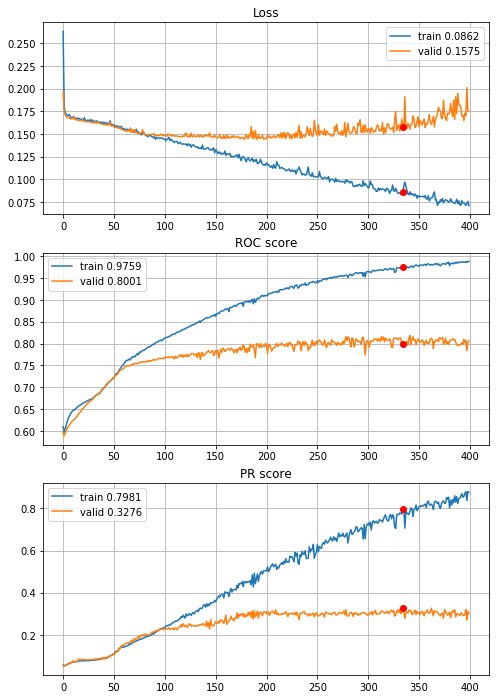


Fold 2------------------------------------------------------------


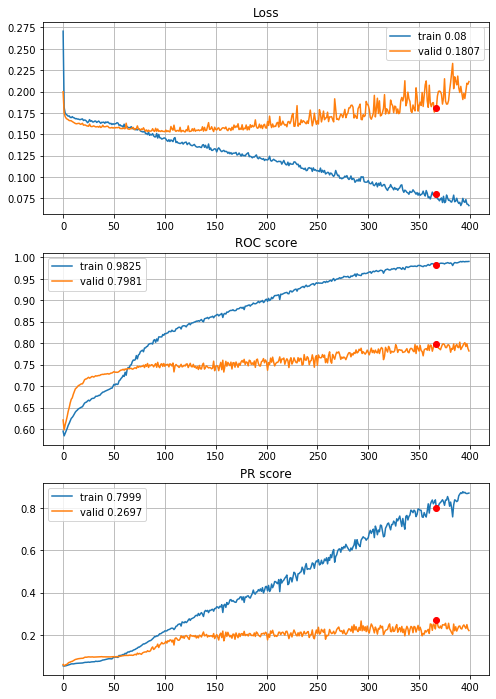


Fold 3------------------------------------------------------------


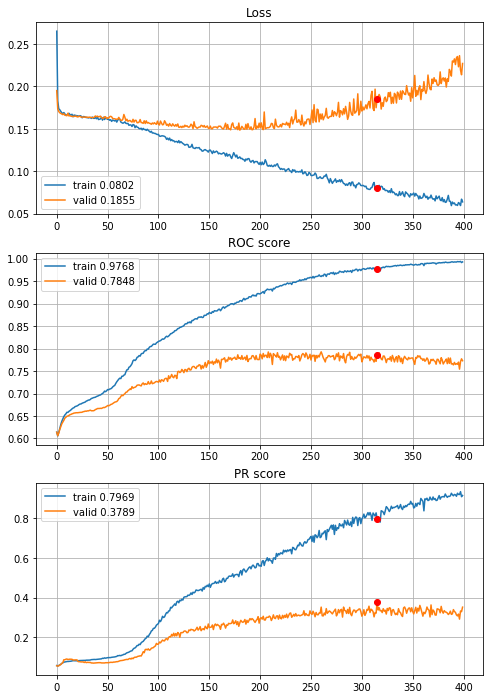


Fold 4------------------------------------------------------------


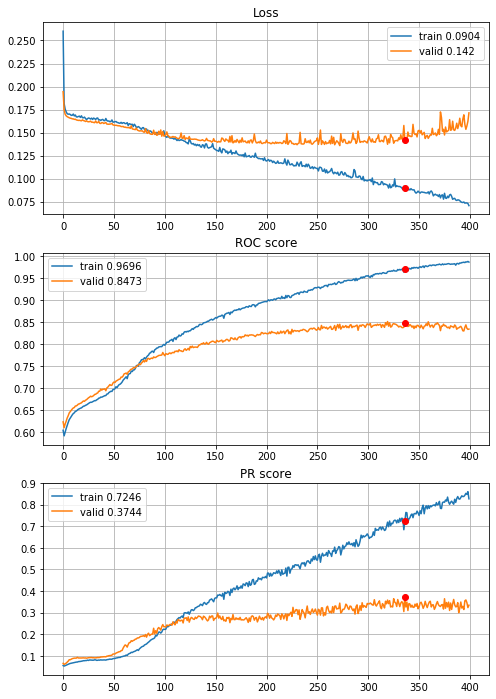


Fold 5------------------------------------------------------------


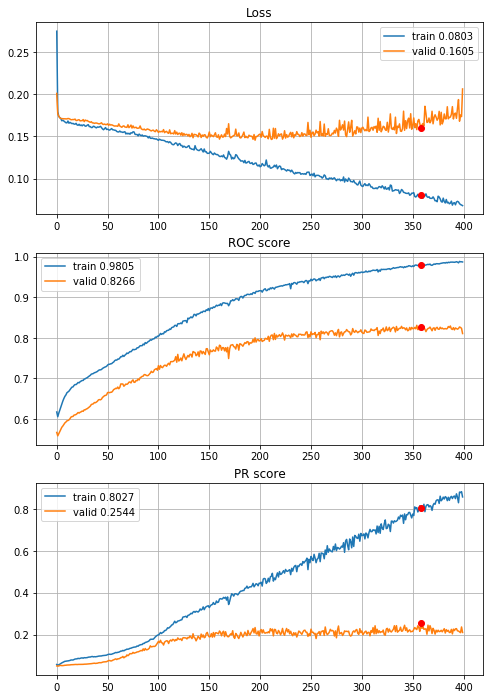


Fold 6------------------------------------------------------------


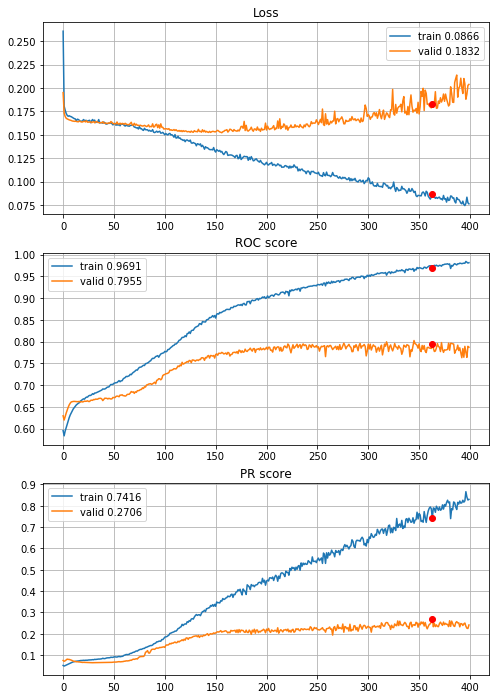

In [50]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_L2_drop_04_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets add one more (pure) dense layer

In [49]:
def define_deep_CNN_2inc_std_L2_drop_04_2dense(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu)(dense)                  # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 4.97s train loss: 0.3025041548409489, validation loss: 0.19726731904524808
Epoch: 2/400,
cumulative time: 6.89s train loss: 0.18090780491886108, validation loss: 0.1729083086802169
Epoch: 3/400,
cumulative time: 8.46s train loss: 0.17320342218755566, validation loss: 0.17035993886806394
Epoch: 4/400,
cumulative time: 10.41s train loss: 0.17132274060757793, validation loss: 0.16893047542551712
Epoch: 5/400,
cumulative time: 12.0s train loss: 0.1698174978797941, validation loss: 0.16805751696912521
Epoch: 6/400,
cumulative time: 13.54s train loss: 0.16983673675553423, validation loss: 0.16783041843893018
Epoch: 7/400,
cumulative time: 15.27s train loss: 0.1704477557490328, validation loss: 0.1670591301952402
Epoch: 8/400,
cumulative time: 17.24s train loss: 0.16852549112125154, validation loss: 0.16682804471582446
Epoch: 9/400,
cumulative time: 18.87s train loss: 0.16829750557092

Epoch: 76/400,
cumulative time: 124.81s train loss: 0.14435558385540545, validation loss: 0.1524300169819773
Epoch: 77/400,
cumulative time: 126.43s train loss: 0.14503396262518153, validation loss: 0.15061014153424596
Epoch: 78/400,
cumulative time: 128.35s train loss: 0.14083432143185176, validation loss: 0.15136008284898136
Epoch: 79/400,
cumulative time: 130.18s train loss: 0.1423993539370314, validation loss: 0.15432421823043185
Epoch: 80/400,
cumulative time: 131.88s train loss: 0.14339309895252678, validation loss: 0.15141626299989958
Epoch: 81/400,
cumulative time: 133.45s train loss: 0.14154255314968034, validation loss: 0.1519175770925663
Epoch: 82/400,
cumulative time: 135.03s train loss: 0.14121771273825173, validation loss: 0.1518222214080403
Epoch: 83/400,
cumulative time: 136.57s train loss: 0.14079366179605754, validation loss: 0.15289447025968395
Epoch: 84/400,
cumulative time: 138.21s train loss: 0.13953025281812123, validation loss: 0.15236545883382757
Epoch: 85/400,

Epoch: 151/400,
cumulative time: 243.91s train loss: 0.10385771880851909, validation loss: 0.15068804040102002
Epoch: 152/400,
cumulative time: 245.76s train loss: 0.10110467969531359, validation loss: 0.15354642121616854
Epoch: 153/400,
cumulative time: 247.39s train loss: 0.09644518249144106, validation loss: 0.15613886655392528
Epoch: 154/400,
cumulative time: 249.3s train loss: 0.10166985574396305, validation loss: 0.15067221734033187
Epoch: 155/400,
cumulative time: 250.97s train loss: 0.09880072933761239, validation loss: 0.15852183142620802
Epoch: 156/400,
cumulative time: 252.51s train loss: 0.09642913051194703, validation loss: 0.16048433404137546
Epoch: 157/400,
cumulative time: 254.05s train loss: 0.09765074953733742, validation loss: 0.1605712363244978
Epoch: 158/400,
cumulative time: 255.51s train loss: 0.09693470040304755, validation loss: 0.16266406322603613
Epoch: 159/400,
cumulative time: 256.97s train loss: 0.09815888625453302, validation loss: 0.1756685956394688
Epoc

Epoch: 226/400,
cumulative time: 355.54s train loss: 0.06747184808272368, validation loss: 0.19870967327142294
Epoch: 227/400,
cumulative time: 357.02s train loss: 0.06426565388068879, validation loss: 0.18200798779921326
Epoch: 228/400,
cumulative time: 358.56s train loss: 0.06312910561141094, validation loss: 0.20364692238883297
Epoch: 229/400,
cumulative time: 360.09s train loss: 0.06370457789855416, validation loss: 0.1916348284420461
Epoch: 230/400,
cumulative time: 361.54s train loss: 0.06284196572279396, validation loss: 0.2065539071788013
Epoch: 231/400,
cumulative time: 363.06s train loss: 0.05972479227654414, validation loss: 0.19173717580804037
Epoch: 232/400,
cumulative time: 364.62s train loss: 0.0648778128442703, validation loss: 0.18938142393238422
Epoch: 233/400,
cumulative time: 366.11s train loss: 0.06737394431289269, validation loss: 0.20180505000513785
Epoch: 234/400,
cumulative time: 367.6s train loss: 0.06268962150687923, validation loss: 0.21463290751370973
Epoch

Epoch: 300/400,
cumulative time: 467.2s train loss: 0.04937077053443041, validation loss: 0.253055542590265
Epoch: 301/400,
cumulative time: 468.66s train loss: 0.04620542699369304, validation loss: 0.2768238713356958
Epoch: 302/400,
cumulative time: 470.14s train loss: 0.041770353502641425, validation loss: 0.2543924680348305
Epoch: 303/400,
cumulative time: 471.6s train loss: 0.04039137190221756, validation loss: 0.2758171406634357
Epoch: 304/400,
cumulative time: 473.07s train loss: 0.04425316207283742, validation loss: 0.27272050281886506
Epoch: 305/400,
cumulative time: 474.56s train loss: 0.05642403731690757, validation loss: 0.2243606443486395
Epoch: 306/400,
cumulative time: 476.05s train loss: 0.05233515328855232, validation loss: 0.2261409529071023
Epoch: 307/400,
cumulative time: 477.54s train loss: 0.04651279834502333, validation loss: 0.22782922783185428
Epoch: 308/400,
cumulative time: 479.0s train loss: 0.048230733244396286, validation loss: 0.2549831931666028
Epoch: 309

Epoch: 375/400,
cumulative time: 584.28s train loss: 0.039739921022006824, validation loss: 0.2932526984814735
Epoch: 376/400,
cumulative time: 585.77s train loss: 0.03991123861799876, validation loss: 0.31408568900347067
Epoch: 377/400,
cumulative time: 587.26s train loss: 0.038609299534312365, validation loss: 0.29244368922741665
Epoch: 378/400,
cumulative time: 588.75s train loss: 0.04248657784960516, validation loss: 0.28799319800433765
Epoch: 379/400,
cumulative time: 590.23s train loss: 0.03812415611063814, validation loss: 0.27799280591279774
Epoch: 380/400,
cumulative time: 591.71s train loss: 0.038862735610701866, validation loss: 0.3020121924686557
Epoch: 381/400,
cumulative time: 593.2s train loss: 0.03626178383049825, validation loss: 0.28197858534352965
Epoch: 382/400,
cumulative time: 594.7s train loss: 0.039331173718850664, validation loss: 0.306223717870906
Epoch: 383/400,
cumulative time: 596.19s train loss: 0.03518484961370885, validation loss: 0.2874262831900098
Epoc

Epoch: 48/400,
cumulative time: 76.2s train loss: 0.15853875053457858, validation loss: 0.15692423602387914
Epoch: 49/400,
cumulative time: 77.79s train loss: 0.15810934030840915, validation loss: 0.15788072740187964
Epoch: 50/400,
cumulative time: 79.31s train loss: 0.15820046155758055, validation loss: 0.16122519546145692
Epoch: 51/400,
cumulative time: 80.81s train loss: 0.16070835348787557, validation loss: 0.15930020586535001
Epoch: 52/400,
cumulative time: 82.41s train loss: 0.1579619270857672, validation loss: 0.15707424515431082
Epoch: 53/400,
cumulative time: 83.91s train loss: 0.15636245492855053, validation loss: 0.15681099756907665
Epoch: 54/400,
cumulative time: 85.45s train loss: 0.15620150840841845, validation loss: 0.16042155867166633
Epoch: 55/400,
cumulative time: 86.97s train loss: 0.1581341062902795, validation loss: 0.15687758392540843
Epoch: 56/400,
cumulative time: 88.58s train loss: 0.15536828039475015, validation loss: 0.15713711071217512
Epoch: 57/400,
cumulat

Epoch: 123/400,
cumulative time: 200.63s train loss: 0.12642711575799445, validation loss: 0.14610528002638334
Epoch: 124/400,
cumulative time: 202.17s train loss: 0.12775501279534668, validation loss: 0.14753311231908137
Epoch: 125/400,
cumulative time: 203.72s train loss: 0.1244998763983505, validation loss: 0.15571920060080283
Epoch: 126/400,
cumulative time: 205.27s train loss: 0.12392105697620616, validation loss: 0.14738872928513144
Epoch: 127/400,
cumulative time: 206.82s train loss: 0.12398351887127475, validation loss: 0.1491385148362126
Epoch: 128/400,
cumulative time: 208.49s train loss: 0.12878281176715273, validation loss: 0.1522988095137426
Epoch: 129/400,
cumulative time: 210.19s train loss: 0.12554445817552898, validation loss: 0.15990715359641558
Epoch: 130/400,
cumulative time: 211.79s train loss: 0.12254441092478087, validation loss: 0.1500431514817484
Epoch: 131/400,
cumulative time: 213.37s train loss: 0.12127456983883676, validation loss: 0.14675988737361928
Epoch

Epoch: 198/400,
cumulative time: 318.08s train loss: 0.09151166662337475, validation loss: 0.16419898673677194
Epoch: 199/400,
cumulative time: 319.61s train loss: 0.08847631325000141, validation loss: 0.1645473995066564
Epoch: 200/400,
cumulative time: 321.15s train loss: 0.08709951322869995, validation loss: 0.16512556909186812
Epoch: 201/400,
cumulative time: 322.8s train loss: 0.08927360553036107, validation loss: 0.1685018749958878
Epoch: 202/400,
cumulative time: 324.4s train loss: 0.08972975802321564, validation loss: 0.16384724686764485
Epoch: 203/400,
cumulative time: 325.96s train loss: 0.08830143635520493, validation loss: 0.17008625427907917
Epoch: 204/400,
cumulative time: 327.55s train loss: 0.08882605433874227, validation loss: 0.16606640782534374
Epoch: 205/400,
cumulative time: 329.1s train loss: 0.08857838395503952, validation loss: 0.1576825459811197
Epoch: 206/400,
cumulative time: 330.71s train loss: 0.09121087190754558, validation loss: 0.15953301692071467
Epoch: 

Epoch: 273/400,
cumulative time: 435.79s train loss: 0.06036914421543567, validation loss: 0.2186036243507465
Epoch: 274/400,
cumulative time: 437.33s train loss: 0.06436978188986812, validation loss: 0.22201183727340648
Epoch: 275/400,
cumulative time: 438.86s train loss: 0.060491487824294934, validation loss: 0.2125501351462748
Epoch: 276/400,
cumulative time: 440.39s train loss: 0.06328175959334428, validation loss: 0.21106390840572892
Epoch: 277/400,
cumulative time: 441.91s train loss: 0.06213803208464953, validation loss: 0.21800078674272036
Epoch: 278/400,
cumulative time: 443.45s train loss: 0.058632397588876145, validation loss: 0.22309031026000903
Epoch: 279/400,
cumulative time: 444.98s train loss: 0.05706013897564499, validation loss: 0.22115657440488024
Epoch: 280/400,
cumulative time: 446.51s train loss: 0.061393165443058895, validation loss: 0.22555026806510137
Epoch: 281/400,
cumulative time: 448.05s train loss: 0.0634571905246036, validation loss: 0.22705617843886658
E

Epoch: 348/400,
cumulative time: 556.36s train loss: 0.042697822224157855, validation loss: 0.26181032577942115
Epoch: 349/400,
cumulative time: 557.92s train loss: 0.04914781028254189, validation loss: 0.27632157846328315
Epoch: 350/400,
cumulative time: 559.51s train loss: 0.04783973490057821, validation loss: 0.2703897878429993
Epoch: 351/400,
cumulative time: 561.03s train loss: 0.04631200769318246, validation loss: 0.2737929324960021
Epoch: 352/400,
cumulative time: 562.59s train loss: 0.049819496346849776, validation loss: 0.30258671433553785
Epoch: 353/400,
cumulative time: 564.11s train loss: 0.04691734110946533, validation loss: 0.29029480523160056
Epoch: 354/400,
cumulative time: 565.87s train loss: 0.04715374028238155, validation loss: 0.27156788083391453
Epoch: 355/400,
cumulative time: 567.45s train loss: 0.04714139115745547, validation loss: 0.28721186221817685
Epoch: 356/400,
cumulative time: 569.04s train loss: 0.049929072216850445, validation loss: 0.2900487154058204
E

Epoch: 21/400,
cumulative time: 38.26s train loss: 0.1643243096480755, validation loss: 0.16488649909961894
Epoch: 22/400,
cumulative time: 39.87s train loss: 0.16538924314760414, validation loss: 0.16471283553780922
Epoch: 23/400,
cumulative time: 41.52s train loss: 0.16550528196656292, validation loss: 0.16483602369128486
Epoch: 24/400,
cumulative time: 43.12s train loss: 0.16466662026565781, validation loss: 0.16510302722844666
Epoch: 25/400,
cumulative time: 44.73s train loss: 0.1638223281026918, validation loss: 0.1640860602786938
Epoch: 26/400,
cumulative time: 46.33s train loss: 0.16325049740425301, validation loss: 0.16438487609592053
Epoch: 27/400,
cumulative time: 47.92s train loss: 0.16439879834769142, validation loss: 0.1664808810265005
Epoch: 28/400,
cumulative time: 49.55s train loss: 0.16323990607921066, validation loss: 0.164869246777357
Epoch: 29/400,
cumulative time: 51.17s train loss: 0.16330737072419238, validation loss: 0.16369556660030335
Epoch: 30/400,
cumulative

Epoch: 97/400,
cumulative time: 165.83s train loss: 0.12591441409770526, validation loss: 0.14800275002910143
Epoch: 98/400,
cumulative time: 167.46s train loss: 0.1268194566502423, validation loss: 0.15114780737094455
Epoch: 99/400,
cumulative time: 169.1s train loss: 0.12378891365452946, validation loss: 0.15008421481475917
Epoch: 100/400,
cumulative time: 170.72s train loss: 0.12625281400231456, validation loss: 0.15085169983488236
Epoch: 101/400,
cumulative time: 172.34s train loss: 0.1252985210191502, validation loss: 0.15059222363003896
Epoch: 102/400,
cumulative time: 173.97s train loss: 0.12147422740180991, validation loss: 0.14913140060587604
Epoch: 103/400,
cumulative time: 175.6s train loss: 0.12182147616830843, validation loss: 0.15664463752922192
Epoch: 104/400,
cumulative time: 177.27s train loss: 0.12429719029302318, validation loss: 0.14844003914419665
Epoch: 105/400,
cumulative time: 178.9s train loss: 0.12223056738866331, validation loss: 0.15120889512067698
Epoch: 10

Epoch: 172/400,
cumulative time: 289.8s train loss: 0.08738048327091809, validation loss: 0.17930543244002217
Epoch: 173/400,
cumulative time: 291.38s train loss: 0.08506152753618461, validation loss: 0.17811651484916283
Epoch: 174/400,
cumulative time: 292.95s train loss: 0.08227866207347002, validation loss: 0.17560379639717105
Epoch: 175/400,
cumulative time: 294.55s train loss: 0.08415269435745093, validation loss: 0.18010933247064076
Epoch: 176/400,
cumulative time: 296.17s train loss: 0.08785749380429773, validation loss: 0.18143229319336843
Epoch: 177/400,
cumulative time: 297.84s train loss: 0.08269589570707286, validation loss: 0.17065137934286348
Epoch: 178/400,
cumulative time: 299.43s train loss: 0.08289575620827473, validation loss: 0.18247892890188985
Epoch: 179/400,
cumulative time: 301.01s train loss: 0.07908083756206107, validation loss: 0.1787158889625207
Epoch: 180/400,
cumulative time: 302.6s train loss: 0.07752556145105251, validation loss: 0.17958485067554728
Epoc

Epoch: 246/400,
cumulative time: 409.51s train loss: 0.04971017168954685, validation loss: 0.2740187273698897
Epoch: 247/400,
cumulative time: 411.36s train loss: 0.0461377096203102, validation loss: 0.2734942455747962
Epoch: 248/400,
cumulative time: 413.02s train loss: 0.04805534398667871, validation loss: 0.28240007997965283
Epoch: 249/400,
cumulative time: 414.62s train loss: 0.0503573379492655, validation loss: 0.26486753007375086
Epoch: 250/400,
cumulative time: 416.21s train loss: 0.042470697741791935, validation loss: 0.2768427818857358
Epoch: 251/400,
cumulative time: 417.89s train loss: 0.04409528003417386, validation loss: 0.27868445196126734
Epoch: 252/400,
cumulative time: 419.52s train loss: 0.04572671906540881, validation loss: 0.31520810506525077
Epoch: 253/400,
cumulative time: 421.1s train loss: 0.04142849861419221, validation loss: 0.29456766037609755
Epoch: 254/400,
cumulative time: 422.67s train loss: 0.040183541031332405, validation loss: 0.2991715510269605
Epoch:

Epoch: 321/400,
cumulative time: 529.86s train loss: 0.030051995602507535, validation loss: 0.3997949724662976
Epoch: 322/400,
cumulative time: 531.45s train loss: 0.030093596313333804, validation loss: 0.39247728642051843
Epoch: 323/400,
cumulative time: 533.05s train loss: 0.029682218469361955, validation loss: 0.4023453730157287
Epoch: 324/400,
cumulative time: 534.69s train loss: 0.029966474557972966, validation loss: 0.3875470080194436
Epoch: 325/400,
cumulative time: 536.41s train loss: 0.03758197856769366, validation loss: 0.39083442609478886
Epoch: 326/400,
cumulative time: 538.07s train loss: 0.036329240747541285, validation loss: 0.37194692924482015
Epoch: 327/400,
cumulative time: 539.7s train loss: 0.045932539359178466, validation loss: 0.3809108965557806
Epoch: 328/400,
cumulative time: 541.35s train loss: 0.0488505350660959, validation loss: 0.3564234845057071
Epoch: 329/400,
cumulative time: 542.98s train loss: 0.042958751713437354, validation loss: 0.381957787361245
Epo

Epoch: 395/400,
cumulative time: 648.77s train loss: 0.02494593646080923, validation loss: 0.49306619718065425
Epoch: 396/400,
cumulative time: 650.39s train loss: 0.02607788237197275, validation loss: 0.479854935899787
Epoch: 397/400,
cumulative time: 651.99s train loss: 0.025378877337084934, validation loss: 0.5087835255956588
Epoch: 398/400,
cumulative time: 653.55s train loss: 0.025112130022051683, validation loss: 0.49513423220201996
Epoch: 399/400,
cumulative time: 655.1s train loss: 0.02406916920345207, validation loss: 0.5010362611216924
Epoch: 400/400,
cumulative time: 656.67s train loss: 0.024808452453287014, validation loss: 0.5213580776010865

Early stopping results:
best results in epoch: 178, 
best valid PR: 0.30893467716484185, 
valid ROC: 0.7763756252842201        
overfitting PR: 0.4984659606977659, 
overfitting ROC: 0.19847428602700934

----------
Fold: 4
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 5.17s train loss: 0.3005

Epoch: 68/400,
cumulative time: 114.11s train loss: 0.1518284004557131, validation loss: 0.1475963295287261
Epoch: 69/400,
cumulative time: 115.77s train loss: 0.14999847652199916, validation loss: 0.14644792320531444
Epoch: 70/400,
cumulative time: 117.43s train loss: 0.14838001210824084, validation loss: 0.14831904563100748
Epoch: 71/400,
cumulative time: 119.14s train loss: 0.151126740599213, validation loss: 0.14996961825484528
Epoch: 72/400,
cumulative time: 120.77s train loss: 0.15023053954978619, validation loss: 0.14624351348976944
Epoch: 73/400,
cumulative time: 122.43s train loss: 0.1474506013385433, validation loss: 0.14604904111059747
Epoch: 74/400,
cumulative time: 124.06s train loss: 0.14717928465782448, validation loss: 0.14494264485170458
Epoch: 75/400,
cumulative time: 125.66s train loss: 0.14599425225242874, validation loss: 0.14545978765890763
Epoch: 76/400,
cumulative time: 127.29s train loss: 0.14705094111467318, validation loss: 0.14611366092377534
Epoch: 77/400,


Epoch: 143/400,
cumulative time: 237.28s train loss: 0.11330930601333256, validation loss: 0.1411397498135173
Epoch: 144/400,
cumulative time: 238.88s train loss: 0.11067214129652073, validation loss: 0.14293713254431753
Epoch: 145/400,
cumulative time: 240.53s train loss: 0.11610047283159639, validation loss: 0.13902988153000803
Epoch: 146/400,
cumulative time: 242.15s train loss: 0.11330263380306485, validation loss: 0.14515889772893872
Epoch: 147/400,
cumulative time: 243.76s train loss: 0.11465877685283267, validation loss: 0.14058131071327554
Epoch: 148/400,
cumulative time: 245.4s train loss: 0.11467913545639803, validation loss: 0.15762010115158512
Epoch: 149/400,
cumulative time: 247.02s train loss: 0.11343997104664995, validation loss: 0.14053331838913388
Epoch: 150/400,
cumulative time: 248.65s train loss: 0.11256606979589816, validation loss: 0.14022515300138905
Epoch: 151/400,
cumulative time: 250.26s train loss: 0.11099636164072817, validation loss: 0.14158687093154787
Epo

Epoch: 218/400,
cumulative time: 360.4s train loss: 0.08449759949250167, validation loss: 0.1660073186474734
Epoch: 219/400,
cumulative time: 362.01s train loss: 0.08790897856726373, validation loss: 0.16034201320705063
Epoch: 220/400,
cumulative time: 363.68s train loss: 0.08173364259254762, validation loss: 0.15324657999203684
Epoch: 221/400,
cumulative time: 365.36s train loss: 0.07678647716218982, validation loss: 0.1873440763194158
Epoch: 222/400,
cumulative time: 366.98s train loss: 0.08338018223840579, validation loss: 0.16984409835985417
Epoch: 223/400,
cumulative time: 368.64s train loss: 0.07846134252478058, validation loss: 0.15659720721126072
Epoch: 224/400,
cumulative time: 370.29s train loss: 0.07754865602910839, validation loss: 0.1652469685396392
Epoch: 225/400,
cumulative time: 371.93s train loss: 0.07771888836829592, validation loss: 0.15991317989551224
Epoch: 226/400,
cumulative time: 373.6s train loss: 0.08277177586731584, validation loss: 0.17537992575534206
Epoch:

Epoch: 293/400,
cumulative time: 483.7s train loss: 0.05288317161937547, validation loss: 0.20723858770583592
Epoch: 294/400,
cumulative time: 485.4s train loss: 0.05367274061069996, validation loss: 0.18654485146465027
Epoch: 295/400,
cumulative time: 487.02s train loss: 0.05506063970693334, validation loss: 0.20460303157060206
Epoch: 296/400,
cumulative time: 488.64s train loss: 0.05385374961654548, validation loss: 0.20146147736871853
Epoch: 297/400,
cumulative time: 490.35s train loss: 0.05395455877905179, validation loss: 0.20382951424599943
Epoch: 298/400,
cumulative time: 491.99s train loss: 0.059243750757370414, validation loss: 0.18801853908311336
Epoch: 299/400,
cumulative time: 493.61s train loss: 0.05846844557494507, validation loss: 0.19042101150883917
Epoch: 300/400,
cumulative time: 495.25s train loss: 0.058407135102211814, validation loss: 0.18227932964443067
Epoch: 301/400,
cumulative time: 496.86s train loss: 0.06511595783158716, validation loss: 0.19366973128809373
E

Epoch: 367/400,
cumulative time: 605.13s train loss: 0.044478409458623205, validation loss: 0.26708518226446676
Epoch: 368/400,
cumulative time: 606.78s train loss: 0.04229909189358922, validation loss: 0.2465614688388642
Epoch: 369/400,
cumulative time: 608.49s train loss: 0.041828605954933644, validation loss: 0.24368045970231178
Epoch: 370/400,
cumulative time: 610.16s train loss: 0.03859510046582162, validation loss: 0.28043629104078677
Epoch: 371/400,
cumulative time: 611.84s train loss: 0.03822872673108468, validation loss: 0.2604141417954259
Epoch: 372/400,
cumulative time: 613.46s train loss: 0.03979075539635946, validation loss: 0.2770693332620873
Epoch: 373/400,
cumulative time: 615.06s train loss: 0.04003709551742402, validation loss: 0.2606825821716851
Epoch: 374/400,
cumulative time: 616.68s train loss: 0.03928453162818393, validation loss: 0.2562250134634003
Epoch: 375/400,
cumulative time: 618.29s train loss: 0.04053501078026653, validation loss: 0.2925005349309854
Epoch

Epoch: 40/400,
cumulative time: 68.07s train loss: 0.15732026701849963, validation loss: 0.1612349551752073
Epoch: 41/400,
cumulative time: 69.72s train loss: 0.15652729722142986, validation loss: 0.16362214098204791
Epoch: 42/400,
cumulative time: 71.36s train loss: 0.15458191894917708, validation loss: 0.1605145518190739
Epoch: 43/400,
cumulative time: 72.98s train loss: 0.15539459381796988, validation loss: 0.1676591751147379
Epoch: 44/400,
cumulative time: 74.64s train loss: 0.15483125649917046, validation loss: 0.16568567509107476
Epoch: 45/400,
cumulative time: 76.29s train loss: 0.15457927073801403, validation loss: 0.15978818833046785
Epoch: 46/400,
cumulative time: 77.95s train loss: 0.15415824472372927, validation loss: 0.15980732085507945
Epoch: 47/400,
cumulative time: 79.58s train loss: 0.15421360378176938, validation loss: 0.16016067357472635
Epoch: 48/400,
cumulative time: 81.23s train loss: 0.15448163451033847, validation loss: 0.16307292200947182
Epoch: 49/400,
cumulat

Epoch: 115/400,
cumulative time: 191.25s train loss: 0.11689924330070081, validation loss: 0.15497625473676785
Epoch: 116/400,
cumulative time: 192.94s train loss: 0.11691518896903322, validation loss: 0.15122939413840616
Epoch: 117/400,
cumulative time: 194.62s train loss: 0.11811236489497283, validation loss: 0.1556149739503548
Epoch: 118/400,
cumulative time: 196.25s train loss: 0.1146829615439011, validation loss: 0.16390576347376698
Epoch: 119/400,
cumulative time: 197.86s train loss: 0.11721284266794192, validation loss: 0.17114223946047016
Epoch: 120/400,
cumulative time: 199.48s train loss: 0.11777353448470278, validation loss: 0.15164313593276363
Epoch: 121/400,
cumulative time: 201.1s train loss: 0.11723617771546421, validation loss: 0.15134623488545573
Epoch: 122/400,
cumulative time: 202.73s train loss: 0.11748702709168403, validation loss: 0.14803087078571944
Epoch: 123/400,
cumulative time: 204.36s train loss: 0.11871571877724942, validation loss: 0.15948258137249852
Epoc

Epoch: 190/400,
cumulative time: 314.71s train loss: 0.08609946202284106, validation loss: 0.15802476374459298
Epoch: 191/400,
cumulative time: 316.36s train loss: 0.08228981596959624, validation loss: 0.17083702803751744
Epoch: 192/400,
cumulative time: 318.05s train loss: 0.08396127184825856, validation loss: 0.16250991936514292
Epoch: 193/400,
cumulative time: 319.81s train loss: 0.08031214748458322, validation loss: 0.1632074210621895
Epoch: 194/400,
cumulative time: 321.46s train loss: 0.0800529111609857, validation loss: 0.15840235323221624
Epoch: 195/400,
cumulative time: 323.12s train loss: 0.08069919306491397, validation loss: 0.16543274448005432
Epoch: 196/400,
cumulative time: 324.8s train loss: 0.08358039964087623, validation loss: 0.16542311629883427
Epoch: 197/400,
cumulative time: 326.43s train loss: 0.07846869777769401, validation loss: 0.1601556969774816
Epoch: 198/400,
cumulative time: 328.09s train loss: 0.07501708117295006, validation loss: 0.16330405747515503
Epoch

Epoch: 265/400,
cumulative time: 438.32s train loss: 0.05262388207574068, validation loss: 0.19193538783184041
Epoch: 266/400,
cumulative time: 439.92s train loss: 0.05190433088144604, validation loss: 0.20234841018485522
Epoch: 267/400,
cumulative time: 441.56s train loss: 0.058813516202440484, validation loss: 0.18849253898601231
Epoch: 268/400,
cumulative time: 443.19s train loss: 0.05539631059590807, validation loss: 0.20928342956781074
Epoch: 269/400,
cumulative time: 444.82s train loss: 0.05331351907125681, validation loss: 0.20196013818562109
Epoch: 270/400,
cumulative time: 446.47s train loss: 0.057934563517617374, validation loss: 0.18069800537269987
Epoch: 271/400,
cumulative time: 448.12s train loss: 0.06527641724987007, validation loss: 0.19416042037435158
Epoch: 272/400,
cumulative time: 449.8s train loss: 0.06140452108350443, validation loss: 0.18384337538504195
Epoch: 273/400,
cumulative time: 451.46s train loss: 0.05594622887166085, validation loss: 0.19478243956559607


Epoch: 339/400,
cumulative time: 561.16s train loss: 0.04712415110138691, validation loss: 0.22599258132249625
Epoch: 340/400,
cumulative time: 562.77s train loss: 0.04393904550160457, validation loss: 0.25610956971485993
Epoch: 341/400,
cumulative time: 564.41s train loss: 0.0450919921418242, validation loss: 0.25200034371366037
Epoch: 342/400,
cumulative time: 566.01s train loss: 0.04100600460919981, validation loss: 0.2516463783277909
Epoch: 343/400,
cumulative time: 567.61s train loss: 0.039667821452285285, validation loss: 0.24736938071907114
Epoch: 344/400,
cumulative time: 569.23s train loss: 0.04046601469744852, validation loss: 0.282171745678388
Epoch: 345/400,
cumulative time: 570.88s train loss: 0.04138350970569452, validation loss: 0.261999858120947
Epoch: 346/400,
cumulative time: 572.51s train loss: 0.039094431753793915, validation loss: 0.25764153044314403
Epoch: 347/400,
cumulative time: 574.16s train loss: 0.04090336927120363, validation loss: 0.2845730962790793
Epoch:

Epoch: 11/400,
cumulative time: 21.46s train loss: 0.16766561218982912, validation loss: 0.1664752067503382
Epoch: 12/400,
cumulative time: 23.1s train loss: 0.16831292773683607, validation loss: 0.16556278773995697
Epoch: 13/400,
cumulative time: 24.73s train loss: 0.16741488301738375, validation loss: 0.16521661520004272
Epoch: 14/400,
cumulative time: 26.37s train loss: 0.16473045068284006, validation loss: 0.1646534062213585
Epoch: 15/400,
cumulative time: 28.01s train loss: 0.16705373936133802, validation loss: 0.16446542947018733
Epoch: 16/400,
cumulative time: 29.66s train loss: 0.1665016328737745, validation loss: 0.16436580637439352
Epoch: 17/400,
cumulative time: 31.27s train loss: 0.1659017628583652, validation loss: 0.16467260305998754
Epoch: 18/400,
cumulative time: 32.91s train loss: 0.16482357535106015, validation loss: 0.16489399326629325
Epoch: 19/400,
cumulative time: 34.64s train loss: 0.16482421179664558, validation loss: 0.16492368323881118
Epoch: 20/400,
cumulativ

Epoch: 87/400,
cumulative time: 146.29s train loss: 0.1400397010372163, validation loss: 0.15928424604603503
Epoch: 88/400,
cumulative time: 147.93s train loss: 0.14212631370535372, validation loss: 0.15369393273455198
Epoch: 89/400,
cumulative time: 149.56s train loss: 0.1397927359566776, validation loss: 0.15293195530039366
Epoch: 90/400,
cumulative time: 151.19s train loss: 0.13805738325239322, validation loss: 0.15132694916646988
Epoch: 91/400,
cumulative time: 152.81s train loss: 0.13846572245401606, validation loss: 0.15257162491806217
Epoch: 92/400,
cumulative time: 154.44s train loss: 0.13971277892902045, validation loss: 0.16517756236381217
Epoch: 93/400,
cumulative time: 156.13s train loss: 0.13960274725683708, validation loss: 0.15116327008263009
Epoch: 94/400,
cumulative time: 157.77s train loss: 0.13709543449303738, validation loss: 0.15219007373833265
Epoch: 95/400,
cumulative time: 159.39s train loss: 0.13755248779941198, validation loss: 0.1516980747609842
Epoch: 96/400

Epoch: 162/400,
cumulative time: 270.68s train loss: 0.09889039769182824, validation loss: 0.15030697980865104
Epoch: 163/400,
cumulative time: 272.41s train loss: 0.09963236410527211, validation loss: 0.15558415126605113
Epoch: 164/400,
cumulative time: 274.05s train loss: 0.09863566272888397, validation loss: 0.15408929507263372
Epoch: 165/400,
cumulative time: 275.7s train loss: 0.09816328833858588, validation loss: 0.15856874252929062
Epoch: 166/400,
cumulative time: 277.42s train loss: 0.09915930770952767, validation loss: 0.1585325412281224
Epoch: 167/400,
cumulative time: 279.08s train loss: 0.09422266785431346, validation loss: 0.15727697906924076
Epoch: 168/400,
cumulative time: 280.72s train loss: 0.10104009243873281, validation loss: 0.1530998371175078
Epoch: 169/400,
cumulative time: 282.37s train loss: 0.09833773027514724, validation loss: 0.16166646493262932
Epoch: 170/400,
cumulative time: 284.01s train loss: 0.10121645406962691, validation loss: 0.15336202308779856
Epoc

Epoch: 237/400,
cumulative time: 394.89s train loss: 0.0629547393777033, validation loss: 0.1906526987865323
Epoch: 238/400,
cumulative time: 396.54s train loss: 0.06275197796591925, validation loss: 0.21501383738439592
Epoch: 239/400,
cumulative time: 398.21s train loss: 0.06219066995272943, validation loss: 0.17665931781784433
Epoch: 240/400,
cumulative time: 399.84s train loss: 0.062111469570103044, validation loss: 0.20539653992066617
Epoch: 241/400,
cumulative time: 401.53s train loss: 0.05632822950459714, validation loss: 0.20242013877532522
Epoch: 242/400,
cumulative time: 403.2s train loss: 0.05955550403359833, validation loss: 0.2066875174201903
Epoch: 243/400,
cumulative time: 404.86s train loss: 0.06055937564466759, validation loss: 0.20858775055799328
Epoch: 244/400,
cumulative time: 406.52s train loss: 0.059316312885924996, validation loss: 0.2035472560124319
Epoch: 245/400,
cumulative time: 408.15s train loss: 0.052368916022355716, validation loss: 0.21525851753891492
Epo

Epoch: 312/400,
cumulative time: 517.13s train loss: 0.04187230883730114, validation loss: 0.2897617167918409
Epoch: 313/400,
cumulative time: 518.73s train loss: 0.04062788204569492, validation loss: 0.29980029225349425
Epoch: 314/400,
cumulative time: 520.33s train loss: 0.03667974797117757, validation loss: 0.28849267689908137
Epoch: 315/400,
cumulative time: 521.95s train loss: 0.03653027655637358, validation loss: 0.2863463900323774
Epoch: 316/400,
cumulative time: 523.58s train loss: 0.04070558359512027, validation loss: 0.2776345027861048
Epoch: 317/400,
cumulative time: 525.21s train loss: 0.03592967132880288, validation loss: 0.2593333851509407
Epoch: 318/400,
cumulative time: 526.82s train loss: 0.03911410174424105, validation loss: 0.28485534744184526
Epoch: 319/400,
cumulative time: 528.43s train loss: 0.04021175089212889, validation loss: 0.2820833073483139
Epoch: 320/400,
cumulative time: 530.04s train loss: 0.043396764630903424, validation loss: 0.2981646589568404
Epoch:

Epoch: 387/400,
cumulative time: 647.19s train loss: 0.0306828229774771, validation loss: 0.36107913754025445
Epoch: 388/400,
cumulative time: 648.83s train loss: 0.03607546874708929, validation loss: 0.370362979857648
Epoch: 389/400,
cumulative time: 650.51s train loss: 0.03327174222592367, validation loss: 0.36201079151669485
Epoch: 390/400,
cumulative time: 652.19s train loss: 0.030251000484703097, validation loss: 0.3411361260492294
Epoch: 391/400,
cumulative time: 653.84s train loss: 0.03345699277444014, validation loss: 0.3900097118831072
Epoch: 392/400,
cumulative time: 655.43s train loss: 0.03553449904660878, validation loss: 0.33613731384277346
Epoch: 393/400,
cumulative time: 657.16s train loss: 0.029136579492047603, validation loss: 0.3584016513824463
Epoch: 394/400,
cumulative time: 658.81s train loss: 0.02766823189755411, validation loss: 0.33879228226474073
Epoch: 395/400,
cumulative time: 660.42s train loss: 0.027881755657874898, validation loss: 0.35637089172347647
Epoc

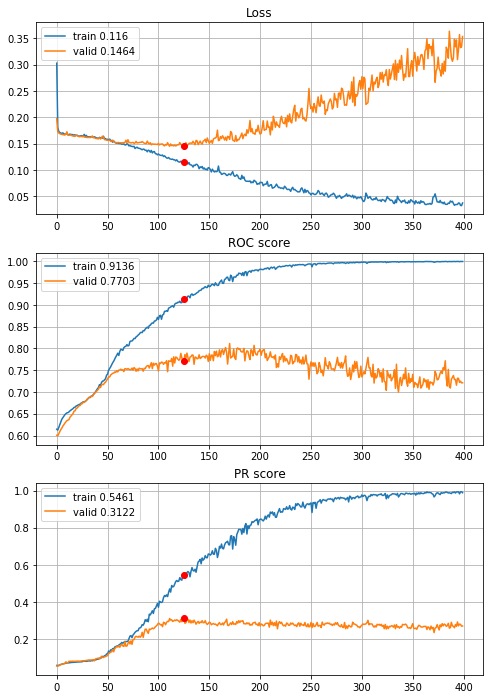


Fold 2------------------------------------------------------------


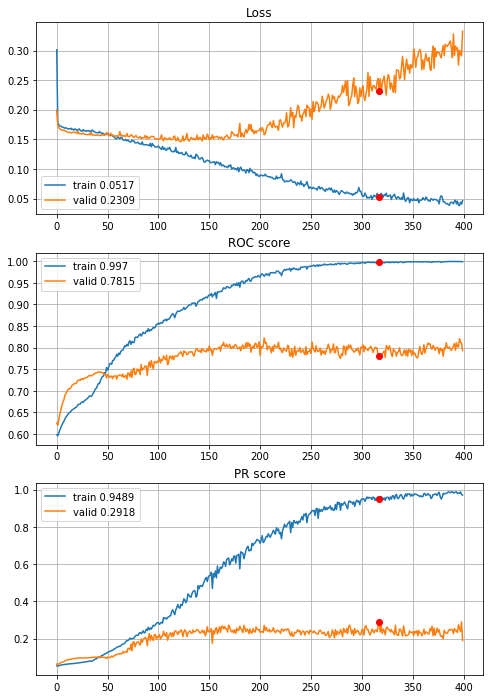


Fold 3------------------------------------------------------------


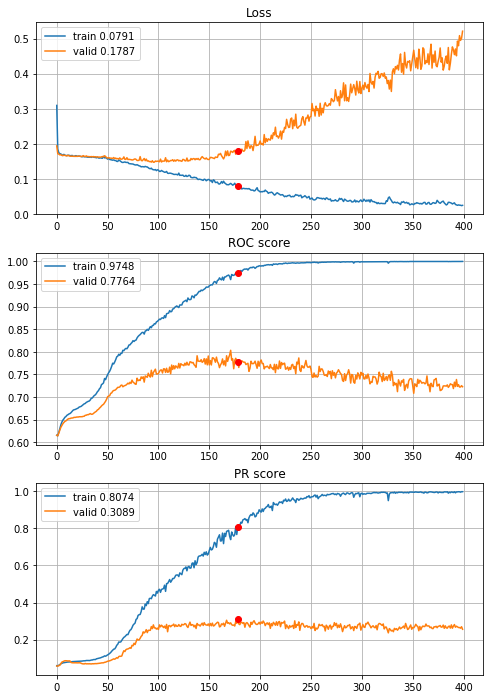


Fold 4------------------------------------------------------------


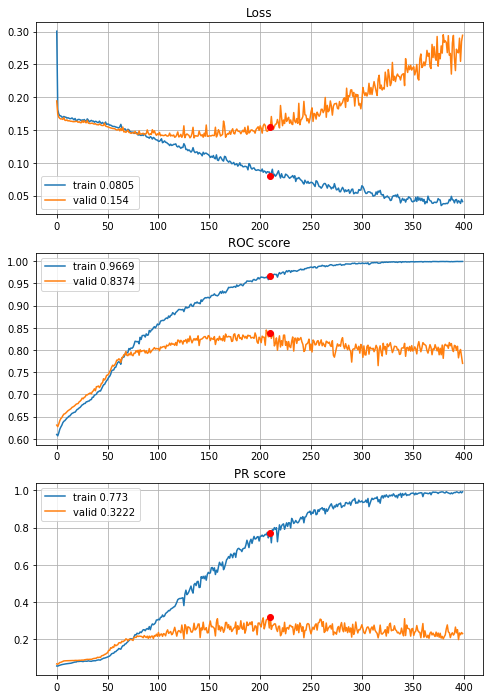


Fold 5------------------------------------------------------------


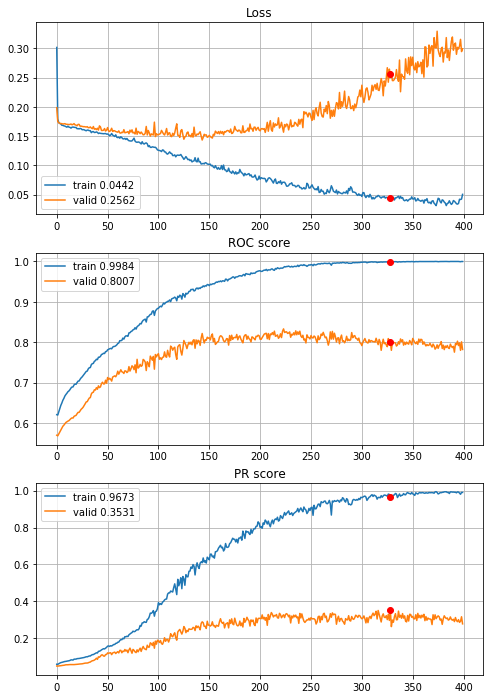


Fold 6------------------------------------------------------------


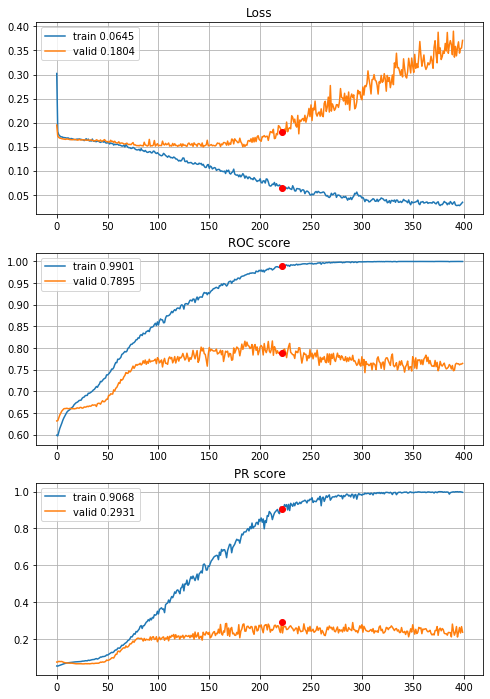

In [52]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04_2dense, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_L2_drop_04_2dense_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets add regularization to the second dense layer

In [50]:
def define_deep_CNN_2inc_std_L2_drop_04_2dense_L2(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                          # (128,)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 4.64s train loss: 0.31057310749325345, validation loss: 0.20473424311077923
Epoch: 2/400,
cumulative time: 6.33s train loss: 0.1877723932988929, validation loss: 0.17915545415675188
Epoch: 3/400,
cumulative time: 8.16s train loss: 0.1791493355434865, validation loss: 0.17610912286672806
Epoch: 4/400,
cumulative time: 10.06s train loss: 0.17658981475195357, validation loss: 0.17409691216514434
Epoch: 5/400,
cumulative time: 11.89s train loss: 0.17489965730560983, validation loss: 0.17284742168603687
Epoch: 6/400,
cumulative time: 13.77s train loss: 0.17424704940951283, validation loss: 0.17228589856296506
Epoch: 7/400,
cumulative time: 15.77s train loss: 0.17494997338997706, validation loss: 0.17134322036609426
Epoch: 8/400,
cumulative time: 17.41s train loss: 0.1725342118215836, validation loss: 0.17102809595053975
Epoch: 9/400,
cumulative time: 19.18s train loss: 0.17217677064

Epoch: 76/400,
cumulative time: 140.08s train loss: 0.14582511438487758, validation loss: 0.15372977776850816
Epoch: 77/400,
cumulative time: 141.96s train loss: 0.14678859422983168, validation loss: 0.15181076157530513
Epoch: 78/400,
cumulative time: 143.7s train loss: 0.14298696447589135, validation loss: 0.15267376088064902
Epoch: 79/400,
cumulative time: 145.45s train loss: 0.1439338408489655, validation loss: 0.158237563731786
Epoch: 80/400,
cumulative time: 147.28s train loss: 0.14545012784122968, validation loss: 0.15266621274919998
Epoch: 81/400,
cumulative time: 149.14s train loss: 0.14348535120549716, validation loss: 0.1529277202283883
Epoch: 82/400,
cumulative time: 150.93s train loss: 0.1429943919849827, validation loss: 0.15218903751235802
Epoch: 83/400,
cumulative time: 152.77s train loss: 0.14238317009036672, validation loss: 0.15263137857028103
Epoch: 84/400,
cumulative time: 154.51s train loss: 0.14130663675465924, validation loss: 0.15290023215593548
Epoch: 85/400,
c

Epoch: 151/400,
cumulative time: 267.0s train loss: 0.1142317312567555, validation loss: 0.15390462886302844
Epoch: 152/400,
cumulative time: 268.81s train loss: 0.11069532658532213, validation loss: 0.16270961861466673
Epoch: 153/400,
cumulative time: 270.59s train loss: 0.1064657997908841, validation loss: 0.16452557969530787
Epoch: 154/400,
cumulative time: 272.35s train loss: 0.11161131666979825, validation loss: 0.15969974952865865
Epoch: 155/400,
cumulative time: 273.95s train loss: 0.10955886735580496, validation loss: 0.15922674601153028
Epoch: 156/400,
cumulative time: 275.59s train loss: 0.10957031993827528, validation loss: 0.16037860217834987
Epoch: 157/400,
cumulative time: 277.23s train loss: 0.10917789327206064, validation loss: 0.1599958950499876
Epoch: 158/400,
cumulative time: 278.94s train loss: 0.10782740956573003, validation loss: 0.16199244232665197
Epoch: 159/400,
cumulative time: 280.65s train loss: 0.1079405883012413, validation loss: 0.18141612213295377
Epoch:

Epoch: 226/400,
cumulative time: 410.64s train loss: 0.0817420589740646, validation loss: 0.20230122582393736
Epoch: 227/400,
cumulative time: 412.36s train loss: 0.08299256103944147, validation loss: 0.19472591436393608
Epoch: 228/400,
cumulative time: 414.06s train loss: 0.0808544147987715, validation loss: 0.20956781764330432
Epoch: 229/400,
cumulative time: 415.76s train loss: 0.08041655557514066, validation loss: 0.19467481566522254
Epoch: 230/400,
cumulative time: 417.5s train loss: 0.07596034415604357, validation loss: 0.2024748100756349
Epoch: 231/400,
cumulative time: 419.16s train loss: 0.0775897584846767, validation loss: 0.19011514796966963
Epoch: 232/400,
cumulative time: 420.87s train loss: 0.07864848045596352, validation loss: 0.20135913301029806
Epoch: 233/400,
cumulative time: 422.68s train loss: 0.07683487883798884, validation loss: 0.2196884418924389
Epoch: 234/400,
cumulative time: 424.73s train loss: 0.07787232614857355, validation loss: 0.20210756464991939
Epoch: 

Epoch: 301/400,
cumulative time: 543.06s train loss: 0.060420237263809386, validation loss: 0.2551129735312956
Epoch: 302/400,
cumulative time: 544.88s train loss: 0.062125683289818656, validation loss: 0.24307195887184394
Epoch: 303/400,
cumulative time: 546.63s train loss: 0.06019137731865234, validation loss: 0.23486910319031457
Epoch: 304/400,
cumulative time: 548.51s train loss: 0.05903191740997795, validation loss: 0.27781018657734324
Epoch: 305/400,
cumulative time: 550.68s train loss: 0.0648234601341689, validation loss: 0.27689576984857983
Epoch: 306/400,
cumulative time: 552.47s train loss: 0.0618694264240058, validation loss: 0.26097731206317093
Epoch: 307/400,
cumulative time: 554.28s train loss: 0.06461225769391361, validation loss: 0.24335315321641698
Epoch: 308/400,
cumulative time: 555.99s train loss: 0.05931739781483049, validation loss: 0.24949269889222842
Epoch: 309/400,
cumulative time: 557.9s train loss: 0.055940459720787455, validation loss: 0.25606242492111453
Ep

Epoch: 376/400,
cumulative time: 675.98s train loss: 0.04427243535025886, validation loss: 0.3396440292873358
Epoch: 377/400,
cumulative time: 677.68s train loss: 0.04626113330748341, validation loss: 0.34067230537865767
Epoch: 378/400,
cumulative time: 679.43s train loss: 0.0441547309832572, validation loss: 0.32794164634782086
Epoch: 379/400,
cumulative time: 681.19s train loss: 0.04390077394291589, validation loss: 0.3197325645978923
Epoch: 380/400,
cumulative time: 683.08s train loss: 0.04743346338316472, validation loss: 0.34990054025250056
Epoch: 381/400,
cumulative time: 684.94s train loss: 0.04518668930052242, validation loss: 0.30087631747497645
Epoch: 382/400,
cumulative time: 686.52s train loss: 0.04714283207376501, validation loss: 0.3211783994853418
Epoch: 383/400,
cumulative time: 688.25s train loss: 0.043389567267161894, validation loss: 0.34710890871044225
Epoch: 384/400,
cumulative time: 689.92s train loss: 0.04298739967388459, validation loss: 0.3601593417390146
Epoch

Epoch: 49/400,
cumulative time: 91.69s train loss: 0.16183366633630358, validation loss: 0.16005519633993096
Epoch: 50/400,
cumulative time: 93.48s train loss: 0.16184526991486345, validation loss: 0.16229367621369942
Epoch: 51/400,
cumulative time: 95.21s train loss: 0.16463775735903668, validation loss: 0.15924748833026361
Epoch: 52/400,
cumulative time: 97.34s train loss: 0.16225090049630084, validation loss: 0.1598221898899166
Epoch: 53/400,
cumulative time: 99.55s train loss: 0.161569156441171, validation loss: 0.15874425746588375
Epoch: 54/400,
cumulative time: 101.43s train loss: 0.1607397386069566, validation loss: 0.1611375299185944
Epoch: 55/400,
cumulative time: 103.52s train loss: 0.16136565415008242, validation loss: 0.1581573610537018
Epoch: 56/400,
cumulative time: 105.63s train loss: 0.1584019798320092, validation loss: 0.15944022133575356
Epoch: 57/400,
cumulative time: 107.65s train loss: 0.15908170508938357, validation loss: 0.15833890975146586
Epoch: 58/400,
cumulat

Epoch: 124/400,
cumulative time: 226.07s train loss: 0.13288810507277546, validation loss: 0.15317977291103427
Epoch: 125/400,
cumulative time: 227.79s train loss: 0.13256618999719214, validation loss: 0.1586937882484646
Epoch: 126/400,
cumulative time: 229.48s train loss: 0.13135407092937215, validation loss: 0.15238907402027324
Epoch: 127/400,
cumulative time: 231.29s train loss: 0.13225226571275828, validation loss: 0.15349859655450243
Epoch: 128/400,
cumulative time: 233.04s train loss: 0.13488258726514954, validation loss: 0.15716731280752436
Epoch: 129/400,
cumulative time: 234.94s train loss: 0.1342631847668341, validation loss: 0.16267231204406618
Epoch: 130/400,
cumulative time: 236.73s train loss: 0.13049943408790743, validation loss: 0.15326880885295444
Epoch: 131/400,
cumulative time: 238.54s train loss: 0.12972649379828324, validation loss: 0.15365172459757342
Epoch: 132/400,
cumulative time: 240.24s train loss: 0.12741615333474623, validation loss: 0.15402900116081164
Epo

Epoch: 199/400,
cumulative time: 353.46s train loss: 0.09870306519833723, validation loss: 0.17105481055898403
Epoch: 200/400,
cumulative time: 355.07s train loss: 0.10276523601229091, validation loss: 0.16508159223030935
Epoch: 201/400,
cumulative time: 356.67s train loss: 0.0987136699625511, validation loss: 0.1655372328480137
Epoch: 202/400,
cumulative time: 358.27s train loss: 0.09829995387119896, validation loss: 0.16699579494808792
Epoch: 203/400,
cumulative time: 359.87s train loss: 0.10054382311514969, validation loss: 0.1661832045719789
Epoch: 204/400,
cumulative time: 361.46s train loss: 0.09814805202972281, validation loss: 0.17393154421452614
Epoch: 205/400,
cumulative time: 363.06s train loss: 0.10287598761252455, validation loss: 0.16763997659926957
Epoch: 206/400,
cumulative time: 364.65s train loss: 0.09809974816562245, validation loss: 0.1629400005268707
Epoch: 207/400,
cumulative time: 366.3s train loss: 0.09743283409124778, validation loss: 0.17070694629049238
Epoch:

Epoch: 274/400,
cumulative time: 481.78s train loss: 0.07336312024293182, validation loss: 0.20855401214187766
Epoch: 275/400,
cumulative time: 483.42s train loss: 0.0694165254271285, validation loss: 0.19896227935741645
Epoch: 276/400,
cumulative time: 485.02s train loss: 0.0709678390597919, validation loss: 0.19826942984976587
Epoch: 277/400,
cumulative time: 486.65s train loss: 0.07180231909377108, validation loss: 0.201834272549318
Epoch: 278/400,
cumulative time: 488.29s train loss: 0.07144971127621952, validation loss: 0.21188929530536832
Epoch: 279/400,
cumulative time: 489.91s train loss: 0.0770725649827304, validation loss: 0.19326193406103792
Epoch: 280/400,
cumulative time: 491.52s train loss: 0.07782518967003635, validation loss: 0.20806987124689286
Epoch: 281/400,
cumulative time: 493.13s train loss: 0.07302628905616279, validation loss: 0.22919777631369048
Epoch: 282/400,
cumulative time: 494.73s train loss: 0.07715511400736492, validation loss: 0.23222919175618598
Epoch:

Epoch: 349/400,
cumulative time: 602.88s train loss: 0.058008604354229616, validation loss: 0.2425572682137883
Epoch: 350/400,
cumulative time: 604.48s train loss: 0.05749285722395308, validation loss: 0.24928399975146723
Epoch: 351/400,
cumulative time: 606.08s train loss: 0.05708531579174866, validation loss: 0.25639949264407624
Epoch: 352/400,
cumulative time: 607.67s train loss: 0.056249341541828715, validation loss: 0.28399949637028055
Epoch: 353/400,
cumulative time: 609.28s train loss: 0.06208229546118633, validation loss: 0.2520378208566618
Epoch: 354/400,
cumulative time: 610.87s train loss: 0.05854746655580929, validation loss: 0.2425665856970091
Epoch: 355/400,
cumulative time: 612.46s train loss: 0.061837292495694536, validation loss: 0.2544032677441718
Epoch: 356/400,
cumulative time: 614.08s train loss: 0.06631619717961433, validation loss: 0.25085378568106836
Epoch: 357/400,
cumulative time: 615.66s train loss: 0.059145604183967936, validation loss: 0.25144233067335653
E

Epoch: 22/400,
cumulative time: 41.53s train loss: 0.16845010283117073, validation loss: 0.16745477145339996
Epoch: 23/400,
cumulative time: 43.23s train loss: 0.1686044072910317, validation loss: 0.1676060925109671
Epoch: 24/400,
cumulative time: 44.84s train loss: 0.1673424038525755, validation loss: 0.16803375613017602
Epoch: 25/400,
cumulative time: 46.49s train loss: 0.1670731294991492, validation loss: 0.1667024131332125
Epoch: 26/400,
cumulative time: 48.15s train loss: 0.16585235801416887, validation loss: 0.1669077618562691
Epoch: 27/400,
cumulative time: 49.79s train loss: 0.16705357700269896, validation loss: 0.16851871090588377
Epoch: 28/400,
cumulative time: 51.41s train loss: 0.16638188102381588, validation loss: 0.16723906943088745
Epoch: 29/400,
cumulative time: 53.13s train loss: 0.1651879282899446, validation loss: 0.16612636681699816
Epoch: 30/400,
cumulative time: 54.79s train loss: 0.16580643904781042, validation loss: 0.16784475372706298
Epoch: 31/400,
cumulative 

Epoch: 98/400,
cumulative time: 170.22s train loss: 0.13516817296499786, validation loss: 0.15721649911894242
Epoch: 99/400,
cumulative time: 171.9s train loss: 0.1330831725009226, validation loss: 0.1548779961087913
Epoch: 100/400,
cumulative time: 173.59s train loss: 0.13343612272338765, validation loss: 0.16253931934641355
Epoch: 101/400,
cumulative time: 175.26s train loss: 0.13371011946847922, validation loss: 0.1560567361382013
Epoch: 102/400,
cumulative time: 176.95s train loss: 0.12974475640381192, validation loss: 0.1548531254751029
Epoch: 103/400,
cumulative time: 178.64s train loss: 0.1313525342190464, validation loss: 0.16454840889920727
Epoch: 104/400,
cumulative time: 180.36s train loss: 0.13380977834274205, validation loss: 0.15453155700063642
Epoch: 105/400,
cumulative time: 182.04s train loss: 0.13027239969906762, validation loss: 0.15791664933627117
Epoch: 106/400,
cumulative time: 183.72s train loss: 0.1301092474804018, validation loss: 0.1561792334480648
Epoch: 107/

Epoch: 173/400,
cumulative time: 299.95s train loss: 0.09715738361375424, validation loss: 0.1747211365915376
Epoch: 174/400,
cumulative time: 302.24s train loss: 0.10144309551969145, validation loss: 0.16218610603953096
Epoch: 175/400,
cumulative time: 303.94s train loss: 0.09959455146293744, validation loss: 0.1646573008141855
Epoch: 176/400,
cumulative time: 305.74s train loss: 0.10105566774283875, validation loss: 0.16302005771845385
Epoch: 177/400,
cumulative time: 307.5s train loss: 0.09670503758043461, validation loss: 0.1611863372561816
Epoch: 178/400,
cumulative time: 309.36s train loss: 0.09899694008757831, validation loss: 0.15933084977134027
Epoch: 179/400,
cumulative time: 311.02s train loss: 0.0971811650906123, validation loss: 0.16395685407741978
Epoch: 180/400,
cumulative time: 312.72s train loss: 0.09570553923421989, validation loss: 0.16899296682362164
Epoch: 181/400,
cumulative time: 314.55s train loss: 0.09819934422023051, validation loss: 0.1690245617185945
Epoch: 

Epoch: 248/400,
cumulative time: 440.78s train loss: 0.06608858285233747, validation loss: 0.20876604229758638
Epoch: 249/400,
cumulative time: 442.4s train loss: 0.06914932084528502, validation loss: 0.21886435897134704
Epoch: 250/400,
cumulative time: 444.09s train loss: 0.06571484381533932, validation loss: 0.20986243619596973
Epoch: 251/400,
cumulative time: 445.72s train loss: 0.06853483278616367, validation loss: 0.21286165675204516
Epoch: 252/400,
cumulative time: 447.44s train loss: 0.07139081179290943, validation loss: 0.2473337747947573
Epoch: 253/400,
cumulative time: 449.13s train loss: 0.06870346908871539, validation loss: 0.2132260147115975
Epoch: 254/400,
cumulative time: 450.85s train loss: 0.06633200076686897, validation loss: 0.22202132396194912
Epoch: 255/400,
cumulative time: 452.49s train loss: 0.0691754940664304, validation loss: 0.21951359291689113
Epoch: 256/400,
cumulative time: 454.09s train loss: 0.06407963340719416, validation loss: 0.21805889861533714
Epoch

Epoch: 323/400,
cumulative time: 571.25s train loss: 0.0515286484048374, validation loss: 0.2860756452985079
Epoch: 324/400,
cumulative time: 573.12s train loss: 0.047458507543482714, validation loss: 0.2768928186960645
Epoch: 325/400,
cumulative time: 574.81s train loss: 0.04974239231130605, validation loss: 0.30255191475348264
Epoch: 326/400,
cumulative time: 576.52s train loss: 0.04934130705817841, validation loss: 0.28147803364153146
Epoch: 327/400,
cumulative time: 578.34s train loss: 0.04940588437513968, validation loss: 0.2877796311834693
Epoch: 328/400,
cumulative time: 580.17s train loss: 0.04766670124367737, validation loss: 0.3075881499216097
Epoch: 329/400,
cumulative time: 581.87s train loss: 0.04805162177954749, validation loss: 0.2879766913455561
Epoch: 330/400,
cumulative time: 583.54s train loss: 0.048437390782145096, validation loss: 0.2926803568126646
Epoch: 331/400,
cumulative time: 585.19s train loss: 0.048938405040692086, validation loss: 0.29381183516307396
Epoch

Epoch: 398/400,
cumulative time: 701.3s train loss: 0.03862508747354101, validation loss: 0.367396860572645
Epoch: 399/400,
cumulative time: 703.0s train loss: 0.041941079289709415, validation loss: 0.385055780254529
Epoch: 400/400,
cumulative time: 704.72s train loss: 0.040000029357983004, validation loss: 0.3815186930280838

Early stopping results:
best results in epoch: 222, 
best valid PR: 0.3222971463859977, 
valid ROC: 0.7787914961346067        
overfitting PR: 0.5028094356393205, 
overfitting ROC: 0.2007798414739801

----------
Fold: 4
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 5.94s train loss: 0.30861432811101025, validation loss: 0.20210017836109526
Epoch: 2/400,
cumulative time: 7.86s train loss: 0.1877299779394942, validation loss: 0.18038686026048847
Epoch: 3/400,
cumulative time: 9.71s train loss: 0.18042811189129557, validation loss: 0.17507242945512344
Epoch: 4/400,
cumulative time: 11.57s train loss: 0.17699945251131327, v

Epoch: 71/400,
cumulative time: 130.6s train loss: 0.1536645978544655, validation loss: 0.15191660444514624
Epoch: 72/400,
cumulative time: 132.47s train loss: 0.15263079077704642, validation loss: 0.14850514625268713
Epoch: 73/400,
cumulative time: 134.5s train loss: 0.14971958797706786, validation loss: 0.14785201970590364
Epoch: 74/400,
cumulative time: 136.53s train loss: 0.14946542727140943, validation loss: 0.14671578714294484
Epoch: 75/400,
cumulative time: 138.61s train loss: 0.14855553198648258, validation loss: 0.14657081761257051
Epoch: 76/400,
cumulative time: 140.59s train loss: 0.14954401339384873, validation loss: 0.14717572880603697
Epoch: 77/400,
cumulative time: 142.35s train loss: 0.14679259897794084, validation loss: 0.14635033163377528
Epoch: 78/400,
cumulative time: 144.12s train loss: 0.1477605606913801, validation loss: 0.1490460880696383
Epoch: 79/400,
cumulative time: 145.85s train loss: 0.14816544633292797, validation loss: 0.14618922693857517
Epoch: 80/400,


Epoch: 146/400,
cumulative time: 266.67s train loss: 0.12039664143940336, validation loss: 0.15060906733238524
Epoch: 147/400,
cumulative time: 268.42s train loss: 0.12357715962325032, validation loss: 0.14024839891049995
Epoch: 148/400,
cumulative time: 270.41s train loss: 0.12011486540921691, validation loss: 0.15444380273434624
Epoch: 149/400,
cumulative time: 272.17s train loss: 0.11958168806508916, validation loss: 0.14247678276908193
Epoch: 150/400,
cumulative time: 273.93s train loss: 0.11757608785246752, validation loss: 0.14213591218385285
Epoch: 151/400,
cumulative time: 275.82s train loss: 0.11772321639046598, validation loss: 0.1406540415819788
Epoch: 152/400,
cumulative time: 277.62s train loss: 0.1165858708670699, validation loss: 0.14149030884862102
Epoch: 153/400,
cumulative time: 279.43s train loss: 0.11820883986679673, validation loss: 0.14280194821395223
Epoch: 154/400,
cumulative time: 281.22s train loss: 0.11589465370097281, validation loss: 0.14257313334535646
Epo

Epoch: 221/400,
cumulative time: 398.97s train loss: 0.08800688159340393, validation loss: 0.17334639608156946
Epoch: 222/400,
cumulative time: 400.69s train loss: 0.09566293427956762, validation loss: 0.15790920111876797
Epoch: 223/400,
cumulative time: 402.42s train loss: 0.09148171933108802, validation loss: 0.14988448823342004
Epoch: 224/400,
cumulative time: 404.11s train loss: 0.09019621767895705, validation loss: 0.15480702539337104
Epoch: 225/400,
cumulative time: 405.83s train loss: 0.0899339011628735, validation loss: 0.14797194776653774
Epoch: 226/400,
cumulative time: 407.48s train loss: 0.09032887156902845, validation loss: 0.1527784415380358
Epoch: 227/400,
cumulative time: 409.19s train loss: 0.09138300468778217, validation loss: 0.14980314884866988
Epoch: 228/400,
cumulative time: 410.87s train loss: 0.09271157615747157, validation loss: 0.1562560028634565
Epoch: 229/400,
cumulative time: 412.59s train loss: 0.09002336099116857, validation loss: 0.1521656457749763
Epoch

Epoch: 296/400,
cumulative time: 531.64s train loss: 0.07139416228257621, validation loss: 0.1769862845442398
Epoch: 297/400,
cumulative time: 533.42s train loss: 0.0679586818867796, validation loss: 0.18631526603220644
Epoch: 298/400,
cumulative time: 535.12s train loss: 0.0678233486418448, validation loss: 0.1762725651498547
Epoch: 299/400,
cumulative time: 536.82s train loss: 0.06311719228343486, validation loss: 0.17614629651818955
Epoch: 300/400,
cumulative time: 538.53s train loss: 0.06497481196771085, validation loss: 0.1837906221887231
Epoch: 301/400,
cumulative time: 540.31s train loss: 0.0660104384370659, validation loss: 0.18660611045079337
Epoch: 302/400,
cumulative time: 542.06s train loss: 0.06300419011271817, validation loss: 0.184041224918078
Epoch: 303/400,
cumulative time: 543.79s train loss: 0.06475140053868247, validation loss: 0.17285424125225798
Epoch: 304/400,
cumulative time: 545.57s train loss: 0.061385846767720555, validation loss: 0.18191086464753156
Epoch: 3

Epoch: 371/400,
cumulative time: 662.16s train loss: 0.048414411720805, validation loss: 0.2264872216772127
Epoch: 372/400,
cumulative time: 664.01s train loss: 0.045547652305752674, validation loss: 0.23987293530494794
Epoch: 373/400,
cumulative time: 665.76s train loss: 0.044206150335125816, validation loss: 0.23719409324941598
Epoch: 374/400,
cumulative time: 667.56s train loss: 0.04628819044201351, validation loss: 0.24380282655377844
Epoch: 375/400,
cumulative time: 669.28s train loss: 0.04461182855110655, validation loss: 0.2415659221213892
Epoch: 376/400,
cumulative time: 671.03s train loss: 0.04334898698483645, validation loss: 0.2326444863960596
Epoch: 377/400,
cumulative time: 672.85s train loss: 0.04045841175399214, validation loss: 0.22905794287962183
Epoch: 378/400,
cumulative time: 674.68s train loss: 0.042161620298818266, validation loss: 0.23413034562670856
Epoch: 379/400,
cumulative time: 676.56s train loss: 0.04300228563653859, validation loss: 0.24593770697341835
Epo

Epoch: 44/400,
cumulative time: 85.74s train loss: 0.15727516567352356, validation loss: 0.169570766516313
Epoch: 45/400,
cumulative time: 87.43s train loss: 0.1575804524761397, validation loss: 0.1621249356401076
Epoch: 46/400,
cumulative time: 89.18s train loss: 0.1563430769147559, validation loss: 0.16250932216644287
Epoch: 47/400,
cumulative time: 90.88s train loss: 0.15642816568986664, validation loss: 0.16268822552726592
Epoch: 48/400,
cumulative time: 92.59s train loss: 0.1567454286889443, validation loss: 0.16579391386452696
Epoch: 49/400,
cumulative time: 94.29s train loss: 0.1567512848618959, validation loss: 0.16116279793285604
Epoch: 50/400,
cumulative time: 96.06s train loss: 0.1555565425051604, validation loss: 0.16198793157134425
Epoch: 51/400,
cumulative time: 97.77s train loss: 0.1556934644176976, validation loss: 0.16647582840013317
Epoch: 52/400,
cumulative time: 99.59s train loss: 0.15504289241399002, validation loss: 0.16091291702121768
Epoch: 53/400,
cumulative ti

Epoch: 119/400,
cumulative time: 218.71s train loss: 0.11863051112294432, validation loss: 0.16781586736714074
Epoch: 120/400,
cumulative time: 220.46s train loss: 0.11981109122974343, validation loss: 0.15438035089488422
Epoch: 121/400,
cumulative time: 222.23s train loss: 0.11836806145153753, validation loss: 0.15408380194853985
Epoch: 122/400,
cumulative time: 223.94s train loss: 0.11814387491699721, validation loss: 0.15075133985023198
Epoch: 123/400,
cumulative time: 225.63s train loss: 0.11823200855268878, validation loss: 0.15653556554064368
Epoch: 124/400,
cumulative time: 227.35s train loss: 0.11746493260636057, validation loss: 0.15654685794525972
Epoch: 125/400,
cumulative time: 229.05s train loss: 0.11665351933796388, validation loss: 0.15516723631875073
Epoch: 126/400,
cumulative time: 230.77s train loss: 0.11331461359834527, validation loss: 0.15038374273367666
Epoch: 127/400,
cumulative time: 232.49s train loss: 0.11477128645510892, validation loss: 0.15003786781902864
E

Epoch: 194/400,
cumulative time: 354.89s train loss: 0.0822840235616608, validation loss: 0.16072263200504908
Epoch: 195/400,
cumulative time: 356.68s train loss: 0.08102353665084604, validation loss: 0.17927469719362446
Epoch: 196/400,
cumulative time: 358.51s train loss: 0.08675202395855357, validation loss: 0.16489924978694315
Epoch: 197/400,
cumulative time: 360.32s train loss: 0.08475588819824832, validation loss: 0.1604510278954887
Epoch: 198/400,
cumulative time: 362.17s train loss: 0.08120591853041999, validation loss: 0.17368385205496967
Epoch: 199/400,
cumulative time: 364.07s train loss: 0.08292842122166665, validation loss: 0.1687010621180853
Epoch: 200/400,
cumulative time: 365.88s train loss: 0.08838789763097792, validation loss: 0.17073616973303873
Epoch: 201/400,
cumulative time: 367.64s train loss: 0.08491306801383094, validation loss: 0.1700613964275795
Epoch: 202/400,
cumulative time: 369.39s train loss: 0.08178989380609787, validation loss: 0.16774714723483294
Epoch

Epoch: 269/400,
cumulative time: 492.88s train loss: 0.05483077743748316, validation loss: 0.20316909859017962
Epoch: 270/400,
cumulative time: 494.66s train loss: 0.0553273609678849, validation loss: 0.19294493802643697
Epoch: 271/400,
cumulative time: 496.6s train loss: 0.060249252208939605, validation loss: 0.20659738519322982
Epoch: 272/400,
cumulative time: 498.52s train loss: 0.05569279423724044, validation loss: 0.2015736359287527
Epoch: 273/400,
cumulative time: 500.33s train loss: 0.0547819739703989, validation loss: 0.20071608474573333
Epoch: 274/400,
cumulative time: 502.23s train loss: 0.05870209691460323, validation loss: 0.1961244250382852
Epoch: 275/400,
cumulative time: 504.04s train loss: 0.05510602972894684, validation loss: 0.20680454978780383
Epoch: 276/400,
cumulative time: 505.99s train loss: 0.05607532087734477, validation loss: 0.20215777750096503
Epoch: 277/400,
cumulative time: 507.94s train loss: 0.057437351411741985, validation loss: 0.20621967436757968
Epoc

Epoch: 344/400,
cumulative time: 635.71s train loss: 0.046524573216620804, validation loss: 0.23922226950037995
Epoch: 345/400,
cumulative time: 637.59s train loss: 0.045270908314835774, validation loss: 0.236937906256197
Epoch: 346/400,
cumulative time: 639.4s train loss: 0.042249492325766684, validation loss: 0.25070256033856153
Epoch: 347/400,
cumulative time: 641.24s train loss: 0.042951505868037074, validation loss: 0.2503046059241301
Epoch: 348/400,
cumulative time: 643.07s train loss: 0.04373968440904063, validation loss: 0.26380845334083036
Epoch: 349/400,
cumulative time: 644.94s train loss: 0.04412078129698696, validation loss: 0.27352460468893436
Epoch: 350/400,
cumulative time: 646.76s train loss: 0.0460184541301281, validation loss: 0.27070213801582704
Epoch: 351/400,
cumulative time: 648.69s train loss: 0.04106889645643371, validation loss: 0.2577785089865893
Epoch: 352/400,
cumulative time: 650.59s train loss: 0.04196552493714352, validation loss: 0.2588748544806109
Epoc

Epoch: 16/400,
cumulative time: 31.46s train loss: 0.16983282137588937, validation loss: 0.1674662657253078
Epoch: 17/400,
cumulative time: 33.29s train loss: 0.1692110444622927, validation loss: 0.1679191765433452
Epoch: 18/400,
cumulative time: 34.99s train loss: 0.16811592941945064, validation loss: 0.1682694040165573
Epoch: 19/400,
cumulative time: 36.74s train loss: 0.16810001818997833, validation loss: 0.16785057150926747
Epoch: 20/400,
cumulative time: 38.5s train loss: 0.16832082663927603, validation loss: 0.1674530627786136
Epoch: 21/400,
cumulative time: 40.27s train loss: 0.1689083221699276, validation loss: 0.1668435987097318
Epoch: 22/400,
cumulative time: 42.01s train loss: 0.16750540142173378, validation loss: 0.16675815997553653
Epoch: 23/400,
cumulative time: 43.8s train loss: 0.168418923207848, validation loss: 0.16796424096725027
Epoch: 24/400,
cumulative time: 45.68s train loss: 0.1686389207429842, validation loss: 0.1670716490999597
Epoch: 25/400,
cumulative time: 

Epoch: 92/400,
cumulative time: 167.27s train loss: 0.13955845243418358, validation loss: 0.16876361135576592
Epoch: 93/400,
cumulative time: 169.06s train loss: 0.14106213342237284, validation loss: 0.1550348334429694
Epoch: 94/400,
cumulative time: 170.94s train loss: 0.13868009130693826, validation loss: 0.15524394004071346
Epoch: 95/400,
cumulative time: 172.84s train loss: 0.13649943347331894, validation loss: 0.15469663106027196
Epoch: 96/400,
cumulative time: 174.74s train loss: 0.13878453349496872, validation loss: 0.15794105273778322
Epoch: 97/400,
cumulative time: 176.58s train loss: 0.14030236331147886, validation loss: 0.16874725013482766
Epoch: 98/400,
cumulative time: 178.47s train loss: 0.13829717403900263, validation loss: 0.1557559081276909
Epoch: 99/400,
cumulative time: 180.29s train loss: 0.13499879132404552, validation loss: 0.1566662370279187
Epoch: 100/400,
cumulative time: 182.12s train loss: 0.13605135187682443, validation loss: 0.1561732954861688
Epoch: 101/40

Epoch: 167/400,
cumulative time: 303.38s train loss: 0.10637516516259582, validation loss: 0.16756971661184655
Epoch: 168/400,
cumulative time: 305.4s train loss: 0.10700578868271951, validation loss: 0.1706525282586207
Epoch: 169/400,
cumulative time: 307.23s train loss: 0.10590187474050185, validation loss: 0.1640477737833242
Epoch: 170/400,
cumulative time: 309.09s train loss: 0.1031753744104899, validation loss: 0.16899253495403976
Epoch: 171/400,
cumulative time: 310.92s train loss: 0.10491593156600686, validation loss: 0.1652329601811581
Epoch: 172/400,
cumulative time: 312.63s train loss: 0.10369900627498702, validation loss: 0.16497463322076641
Epoch: 173/400,
cumulative time: 314.37s train loss: 0.1045872080939313, validation loss: 0.16505138117758955
Epoch: 174/400,
cumulative time: 316.09s train loss: 0.10413720618303607, validation loss: 0.17131455636415324
Epoch: 175/400,
cumulative time: 317.8s train loss: 0.11155430294114359, validation loss: 0.16633167295182338
Epoch: 1

Epoch: 242/400,
cumulative time: 434.32s train loss: 0.07845098364556288, validation loss: 0.18842399319664377
Epoch: 243/400,
cumulative time: 436.01s train loss: 0.07822795060034816, validation loss: 0.19034409672510427
Epoch: 244/400,
cumulative time: 437.7s train loss: 0.07529451188046685, validation loss: 0.19426175034437024
Epoch: 245/400,
cumulative time: 439.39s train loss: 0.07861238523907618, validation loss: 0.20448951558011477
Epoch: 246/400,
cumulative time: 441.08s train loss: 0.07657897875962845, validation loss: 0.19462464669688803
Epoch: 247/400,
cumulative time: 442.78s train loss: 0.07352435777298276, validation loss: 0.19949033576934064
Epoch: 248/400,
cumulative time: 444.48s train loss: 0.07105808573754244, validation loss: 0.21011835117809108
Epoch: 249/400,
cumulative time: 446.16s train loss: 0.07435037502396466, validation loss: 0.20893117038930048
Epoch: 250/400,
cumulative time: 447.85s train loss: 0.07211225763998369, validation loss: 0.1981387763238344
Epo

Epoch: 317/400,
cumulative time: 562.93s train loss: 0.06045975746442887, validation loss: 0.22821919536981428
Epoch: 318/400,
cumulative time: 564.62s train loss: 0.05779372980112642, validation loss: 0.26528623426546816
Epoch: 319/400,
cumulative time: 566.33s train loss: 0.05241905444571419, validation loss: 0.2562379621286861
Epoch: 320/400,
cumulative time: 568.02s train loss: 0.05387015529611632, validation loss: 0.2581884874867611
Epoch: 321/400,
cumulative time: 569.73s train loss: 0.0539278653602886, validation loss: 0.24661919060300608
Epoch: 322/400,
cumulative time: 571.43s train loss: 0.05249827434534639, validation loss: 0.2493412923031166
Epoch: 323/400,
cumulative time: 573.13s train loss: 0.052903237011708404, validation loss: 0.27078542766023855
Epoch: 324/400,
cumulative time: 574.85s train loss: 0.055756909003771775, validation loss: 0.27493073627597
Epoch: 325/400,
cumulative time: 576.55s train loss: 0.05698409823512812, validation loss: 0.2968746867922486
Epoch: 

Epoch: 392/400,
cumulative time: 690.69s train loss: 0.047086683612897855, validation loss: 0.3220769439759802
Epoch: 393/400,
cumulative time: 692.39s train loss: 0.0461591769600602, validation loss: 0.30929830740709774
Epoch: 394/400,
cumulative time: 694.09s train loss: 0.04495008287372783, validation loss: 0.3048274265547268
Epoch: 395/400,
cumulative time: 695.8s train loss: 0.04552548394866805, validation loss: 0.303500247079818
Epoch: 396/400,
cumulative time: 697.5s train loss: 0.03950219438417398, validation loss: 0.3547246489563926
Epoch: 397/400,
cumulative time: 699.21s train loss: 0.04059223471353438, validation loss: 0.31002190894767884
Epoch: 398/400,
cumulative time: 700.89s train loss: 0.04232101944100654, validation loss: 0.32042394010747066
Epoch: 399/400,
cumulative time: 702.6s train loss: 0.04025216323481006, validation loss: 0.3383696142767296
Epoch: 400/400,
cumulative time: 704.28s train loss: 0.04040764667591761, validation loss: 0.34462322276146684

Early sto

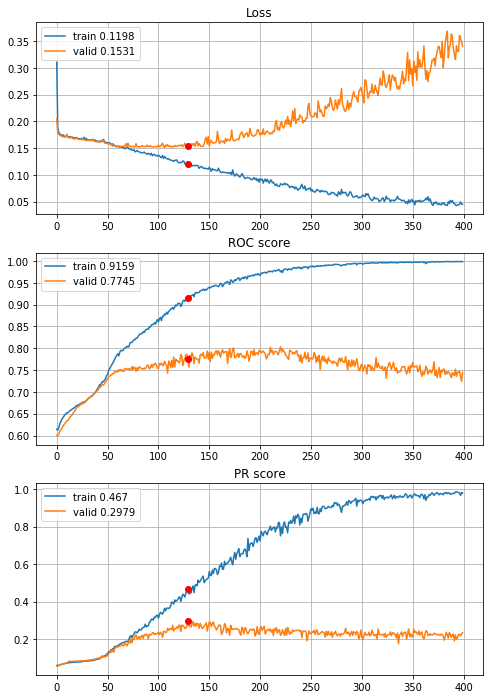


Fold 2------------------------------------------------------------


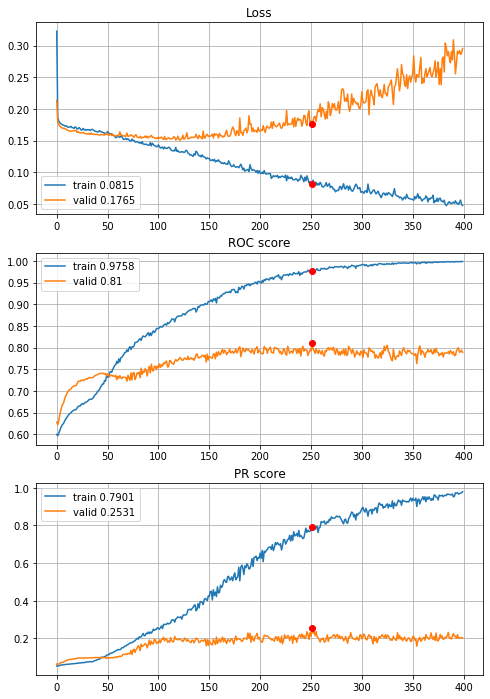


Fold 3------------------------------------------------------------


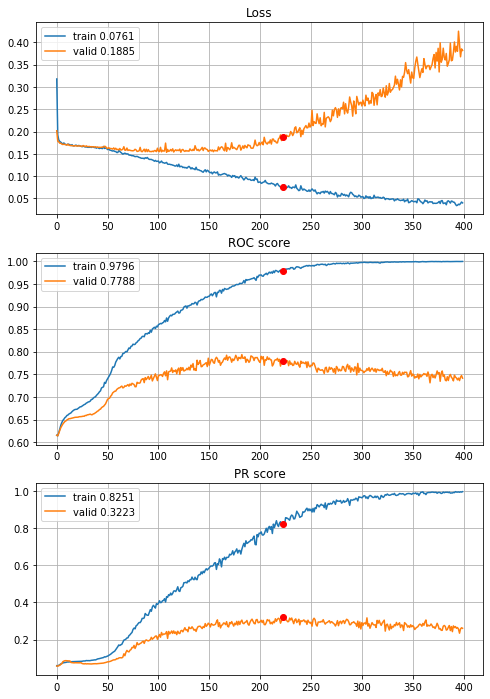


Fold 4------------------------------------------------------------


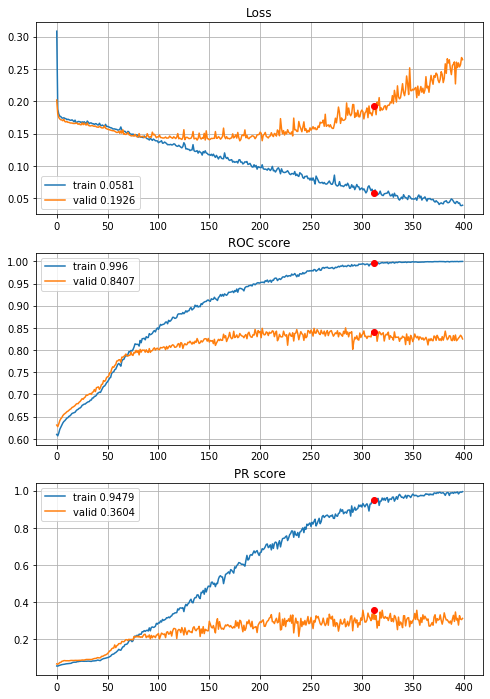


Fold 5------------------------------------------------------------


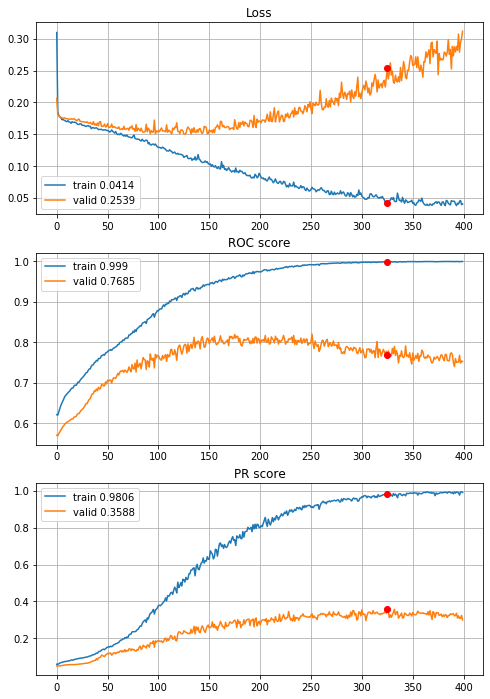


Fold 6------------------------------------------------------------


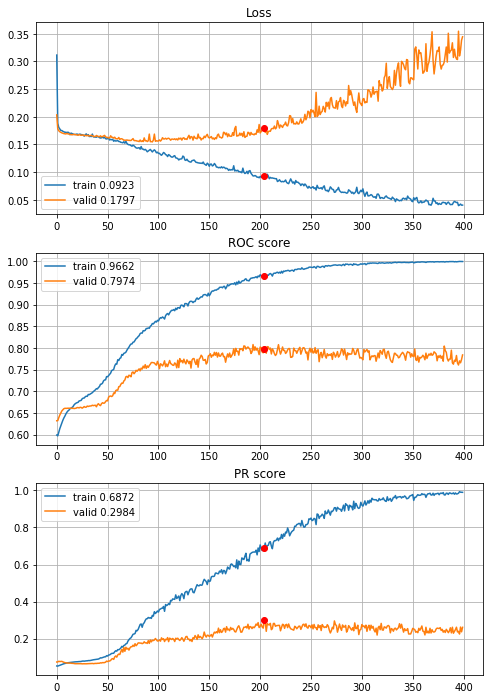

In [55]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04_2dense_L2, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_L2_drop_04_2dense_L2_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets try add some dropout

In [51]:
def define_deep_CNN_2inc_std_L2_drop_04_2dense_L2_drop_02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.00005))(flat)                           # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                          # (128,)
    dense = layers.Dropout(rate=0.2)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/350,
cumulative time: 4.2s train loss: 0.30036922899825746, validation loss: 0.1967396973235579
Epoch: 2/350,
cumulative time: 5.57s train loss: 0.1895186067358009, validation loss: 0.17887503408666988
Epoch: 3/350,
cumulative time: 6.92s train loss: 0.18366831889126276, validation loss: 0.17616742312283223
Epoch: 4/350,
cumulative time: 8.27s train loss: 0.1792046444817473, validation loss: 0.17422002153580968
Epoch: 5/350,
cumulative time: 9.61s train loss: 0.17775152498256303, validation loss: 0.17277135034024638
Epoch: 6/350,
cumulative time: 10.91s train loss: 0.175777346360635, validation loss: 0.1722812565680725
Epoch: 7/350,
cumulative time: 12.29s train loss: 0.17804661989094842, validation loss: 0.17107580865819988
Epoch: 8/350,
cumulative time: 13.71s train loss: 0.17370947777662415, validation loss: 0.17060907293467503
Epoch: 9/350,
cumulative time: 15.06s train loss: 0.17330588130232766

Epoch: 76/350,
cumulative time: 106.7s train loss: 0.14132030295062337, validation loss: 0.15035749542213206
Epoch: 77/350,
cumulative time: 108.07s train loss: 0.14234612014904952, validation loss: 0.14923788863936072
Epoch: 78/350,
cumulative time: 109.39s train loss: 0.13919596602367001, validation loss: 0.14934939859852409
Epoch: 79/350,
cumulative time: 110.75s train loss: 0.14190794410923077, validation loss: 0.15466485441043523
Epoch: 80/350,
cumulative time: 112.14s train loss: 0.14005538017272573, validation loss: 0.14972623368312615
Epoch: 81/350,
cumulative time: 113.49s train loss: 0.13947483800719804, validation loss: 0.15123359290675442
Epoch: 82/350,
cumulative time: 114.85s train loss: 0.14001470872479727, validation loss: 0.15004501760318426
Epoch: 83/350,
cumulative time: 116.22s train loss: 0.13932414399185286, validation loss: 0.14912543550309473
Epoch: 84/350,
cumulative time: 117.57s train loss: 0.13843963302350604, validation loss: 0.1489943342764287
Epoch: 85/35

Epoch: 151/350,
cumulative time: 207.37s train loss: 0.10942759925907539, validation loss: 0.15019894105188186
Epoch: 152/350,
cumulative time: 208.69s train loss: 0.10553219644305184, validation loss: 0.1491223649264632
Epoch: 153/350,
cumulative time: 210.03s train loss: 0.10204062795346835, validation loss: 0.1500199349062471
Epoch: 154/350,
cumulative time: 211.36s train loss: 0.10570382462785885, validation loss: 0.14669765772232066
Epoch: 155/350,
cumulative time: 212.69s train loss: 0.10334641360813894, validation loss: 0.14634410103448564
Epoch: 156/350,
cumulative time: 214.02s train loss: 0.10133741805245686, validation loss: 0.14879328166751063
Epoch: 157/350,
cumulative time: 215.35s train loss: 0.10657297546596511, validation loss: 0.14364805718002593
Epoch: 158/350,
cumulative time: 216.69s train loss: 0.1019936992220023, validation loss: 0.14842249810461292
Epoch: 159/350,
cumulative time: 218.01s train loss: 0.10334155627199544, validation loss: 0.1524801755990457
Epoch

Epoch: 226/350,
cumulative time: 307.56s train loss: 0.07689523710474334, validation loss: 0.16731930044656657
Epoch: 227/350,
cumulative time: 308.9s train loss: 0.07855269310026404, validation loss: 0.16503592642075424
Epoch: 228/350,
cumulative time: 310.24s train loss: 0.07682581838703292, validation loss: 0.16544634140881453
Epoch: 229/350,
cumulative time: 311.57s train loss: 0.0709623748055447, validation loss: 0.17171076194018242
Epoch: 230/350,
cumulative time: 312.9s train loss: 0.0753186604459518, validation loss: 0.16811055263326177
Epoch: 231/350,
cumulative time: 314.28s train loss: 0.07450985370785182, validation loss: 0.16516636839309806
Epoch: 232/350,
cumulative time: 315.77s train loss: 0.07389415973969081, validation loss: 0.17041155594360782
Epoch: 233/350,
cumulative time: 317.17s train loss: 0.07300454348341355, validation loss: 0.16905640923023849
Epoch: 234/350,
cumulative time: 318.5s train loss: 0.07322083385474468, validation loss: 0.17037812590130347
Epoch:

Epoch: 301/350,
cumulative time: 408.34s train loss: 0.05617969055380636, validation loss: 0.2069719276570399
Epoch: 302/350,
cumulative time: 409.68s train loss: 0.05467496880022878, validation loss: 0.2025435472183115
Epoch: 303/350,
cumulative time: 411.03s train loss: 0.051619689738743424, validation loss: 0.2089677644432138
Epoch: 304/350,
cumulative time: 412.37s train loss: 0.055090020939186246, validation loss: 0.2160213940031094
Epoch: 305/350,
cumulative time: 413.71s train loss: 0.060384692306567934, validation loss: 0.20061477077429135
Epoch: 306/350,
cumulative time: 415.05s train loss: 0.055063074804536795, validation loss: 0.20343381096151208
Epoch: 307/350,
cumulative time: 416.38s train loss: 0.05276606261470415, validation loss: 0.20741833098047213
Epoch: 308/350,
cumulative time: 417.72s train loss: 0.05241540309345954, validation loss: 0.2066672474028711
Epoch: 309/350,
cumulative time: 419.06s train loss: 0.05147314706307233, validation loss: 0.2096315000113466
Epo

Epoch: 24/350,
cumulative time: 35.84s train loss: 0.16783650496798552, validation loss: 0.16188217926072263
Epoch: 25/350,
cumulative time: 37.22s train loss: 0.16847198911627462, validation loss: 0.16117339832207792
Epoch: 26/350,
cumulative time: 38.59s train loss: 0.16772110439492235, validation loss: 0.16136056196486498
Epoch: 27/350,
cumulative time: 39.96s train loss: 0.16781297078614216, validation loss: 0.16424134086578265
Epoch: 28/350,
cumulative time: 41.32s train loss: 0.1653342350100546, validation loss: 0.1603196507434545
Epoch: 29/350,
cumulative time: 42.69s train loss: 0.16712560959092942, validation loss: 0.15990979407046133
Epoch: 30/350,
cumulative time: 44.06s train loss: 0.1653126459385624, validation loss: 0.1601055986485975
Epoch: 31/350,
cumulative time: 45.43s train loss: 0.1658561238143747, validation loss: 0.15942106189921518
Epoch: 32/350,
cumulative time: 46.83s train loss: 0.16511502902017758, validation loss: 0.15893777324128433
Epoch: 33/350,
cumulativ

Epoch: 100/350,
cumulative time: 140.88s train loss: 0.13537103191227098, validation loss: 0.15396479186193035
Epoch: 101/350,
cumulative time: 142.26s train loss: 0.13661060331474517, validation loss: 0.15371283080287249
Epoch: 102/350,
cumulative time: 143.63s train loss: 0.13367536056946452, validation loss: 0.1541416791327503
Epoch: 103/350,
cumulative time: 145.0s train loss: 0.13333400350802846, validation loss: 0.15559662872654426
Epoch: 104/350,
cumulative time: 146.39s train loss: 0.13170122847630977, validation loss: 0.1570778009854013
Epoch: 105/350,
cumulative time: 147.76s train loss: 0.13535293951378627, validation loss: 0.1534842970057209
Epoch: 106/350,
cumulative time: 149.14s train loss: 0.13077751432639115, validation loss: 0.1536364763740787
Epoch: 107/350,
cumulative time: 150.51s train loss: 0.1334812458048393, validation loss: 0.15880507002261177
Epoch: 108/350,
cumulative time: 151.9s train loss: 0.13142051932355933, validation loss: 0.15538089500732846
Epoch: 1

Epoch: 175/350,
cumulative time: 244.47s train loss: 0.10380516559235202, validation loss: 0.1656537773685718
Epoch: 176/350,
cumulative time: 245.84s train loss: 0.10175461738594614, validation loss: 0.16677128663225538
Epoch: 177/350,
cumulative time: 247.21s train loss: 0.10764705315369003, validation loss: 0.16239919448039478
Epoch: 178/350,
cumulative time: 248.6s train loss: 0.10050081604448835, validation loss: 0.1649753749761169
Epoch: 179/350,
cumulative time: 249.98s train loss: 0.10124579725938662, validation loss: 0.16502220784149194
Epoch: 180/350,
cumulative time: 251.35s train loss: 0.09961348418612705, validation loss: 0.16619157888786196
Epoch: 181/350,
cumulative time: 252.71s train loss: 0.10512834186361132, validation loss: 0.1820287968509319
Epoch: 182/350,
cumulative time: 254.1s train loss: 0.10601830040760848, validation loss: 0.1617780958215656
Epoch: 183/350,
cumulative time: 255.46s train loss: 0.10254710939268341, validation loss: 0.16843011000756355
Epoch: 

Epoch: 250/350,
cumulative time: 349.88s train loss: 0.07519454576894455, validation loss: 0.20073733489525897
Epoch: 251/350,
cumulative time: 351.26s train loss: 0.07808974342681209, validation loss: 0.183763232995142
Epoch: 252/350,
cumulative time: 352.63s train loss: 0.0781800482792738, validation loss: 0.187139979586845
Epoch: 253/350,
cumulative time: 354.02s train loss: 0.07357350006349934, validation loss: 0.20983024068459927
Epoch: 254/350,
cumulative time: 355.38s train loss: 0.07802635835607456, validation loss: 0.2111447532008235
Epoch: 255/350,
cumulative time: 356.74s train loss: 0.07595542242008543, validation loss: 0.20034111631963386
Epoch: 256/350,
cumulative time: 358.11s train loss: 0.076789504097039, validation loss: 0.1977737707282425
Epoch: 257/350,
cumulative time: 359.48s train loss: 0.07347557230512317, validation loss: 0.2062741069423418
Epoch: 258/350,
cumulative time: 360.84s train loss: 0.07543562280192634, validation loss: 0.20609623330448745
Epoch: 259/

Epoch: 325/350,
cumulative time: 452.76s train loss: 0.060425892655870395, validation loss: 0.2289129713181587
Epoch: 326/350,
cumulative time: 454.13s train loss: 0.0551883712892397, validation loss: 0.2300310753783892
Epoch: 327/350,
cumulative time: 455.5s train loss: 0.05900851709540869, validation loss: 0.23244152111666544
Epoch: 328/350,
cumulative time: 456.86s train loss: 0.056681531057716866, validation loss: 0.26862280994536525
Epoch: 329/350,
cumulative time: 458.24s train loss: 0.060785760723375715, validation loss: 0.2417276574110766
Epoch: 330/350,
cumulative time: 459.61s train loss: 0.057712839097702605, validation loss: 0.24455036047167422
Epoch: 331/350,
cumulative time: 460.97s train loss: 0.06109823345716104, validation loss: 0.23486145166863306
Epoch: 332/350,
cumulative time: 462.34s train loss: 0.061221840449711774, validation loss: 0.23278495319783296
Epoch: 333/350,
cumulative time: 463.71s train loss: 0.057447051667756155, validation loss: 0.24102847489038895


Epoch: 48/350,
cumulative time: 68.8s train loss: 0.15868305831245208, validation loss: 0.16563646694545195
Epoch: 49/350,
cumulative time: 70.14s train loss: 0.15833592547480002, validation loss: 0.16076167328173335
Epoch: 50/350,
cumulative time: 71.5s train loss: 0.1553601335066614, validation loss: 0.16146539677017482
Epoch: 51/350,
cumulative time: 72.86s train loss: 0.15409253032550632, validation loss: 0.1595410738203816
Epoch: 52/350,
cumulative time: 74.2s train loss: 0.15584128815961518, validation loss: 0.16014110049913938
Epoch: 53/350,
cumulative time: 75.56s train loss: 0.15516082006499907, validation loss: 0.1593535222786907
Epoch: 54/350,
cumulative time: 76.91s train loss: 0.15202244759867742, validation loss: 0.1598850371093925
Epoch: 55/350,
cumulative time: 78.27s train loss: 0.1497267848961099, validation loss: 0.16107821794590507
Epoch: 56/350,
cumulative time: 79.62s train loss: 0.15088036381853784, validation loss: 0.159371525283566
Epoch: 57/350,
cumulative tim

Epoch: 124/350,
cumulative time: 171.98s train loss: 0.1148212541508548, validation loss: 0.15535953291356172
Epoch: 125/350,
cumulative time: 173.33s train loss: 0.11160669251856477, validation loss: 0.15981546465214708
Epoch: 126/350,
cumulative time: 174.68s train loss: 0.1115068253640001, validation loss: 0.15460679879311964
Epoch: 127/350,
cumulative time: 176.04s train loss: 0.10929435580336011, validation loss: 0.1545259743089132
Epoch: 128/350,
cumulative time: 177.59s train loss: 0.11040618713236618, validation loss: 0.15471051429272636
Epoch: 129/350,
cumulative time: 178.99s train loss: 0.11025775567640529, validation loss: 0.15281267390924544
Epoch: 130/350,
cumulative time: 180.38s train loss: 0.10935856545873075, validation loss: 0.15491748071943323
Epoch: 131/350,
cumulative time: 181.76s train loss: 0.11131808447883144, validation loss: 0.15518231990687345
Epoch: 132/350,
cumulative time: 183.14s train loss: 0.11102132465817822, validation loss: 0.1530818156360955
Epoch

Epoch: 199/350,
cumulative time: 275.69s train loss: 0.07909880794984187, validation loss: 0.16854265654462036
Epoch: 200/350,
cumulative time: 277.06s train loss: 0.07213741296071934, validation loss: 0.17670457254543528
Epoch: 201/350,
cumulative time: 278.43s train loss: 0.07441914402195535, validation loss: 0.1737806626533306
Epoch: 202/350,
cumulative time: 279.78s train loss: 0.07128090539653924, validation loss: 0.18117910867671666
Epoch: 203/350,
cumulative time: 281.14s train loss: 0.0705594914989869, validation loss: 0.18061932034761222
Epoch: 204/350,
cumulative time: 282.49s train loss: 0.07285150737332116, validation loss: 0.17563942480016972
Epoch: 205/350,
cumulative time: 283.85s train loss: 0.07362323254932815, validation loss: 0.18939275111939616
Epoch: 206/350,
cumulative time: 285.2s train loss: 0.07432898485476168, validation loss: 0.1874940306495089
Epoch: 207/350,
cumulative time: 286.56s train loss: 0.0739202305951911, validation loss: 0.1786945363992476
Epoch: 

Epoch: 274/350,
cumulative time: 377.73s train loss: 0.04868220118494471, validation loss: 0.23345027422608117
Epoch: 275/350,
cumulative time: 379.08s train loss: 0.05439029284322585, validation loss: 0.22750558517629166
Epoch: 276/350,
cumulative time: 380.43s train loss: 0.05194076581146758, validation loss: 0.22786501243339455
Epoch: 277/350,
cumulative time: 381.77s train loss: 0.05409416221184755, validation loss: 0.21914996376668797
Epoch: 278/350,
cumulative time: 383.14s train loss: 0.050805054213873664, validation loss: 0.23758926204507036
Epoch: 279/350,
cumulative time: 384.49s train loss: 0.05590739772153457, validation loss: 0.223074634375141
Epoch: 280/350,
cumulative time: 385.83s train loss: 0.05142148410387973, validation loss: 0.2323248466650124
Epoch: 281/350,
cumulative time: 387.19s train loss: 0.05037654577994319, validation loss: 0.2333046283821916
Epoch: 282/350,
cumulative time: 388.55s train loss: 0.05226125633438053, validation loss: 0.2315712744177247
Epoch

Epoch: 348/350,
cumulative time: 478.5s train loss: 0.04090648912980338, validation loss: 0.27888846846583004
Epoch: 349/350,
cumulative time: 479.86s train loss: 0.039426398126981975, validation loss: 0.2766639430901014
Epoch: 350/350,
cumulative time: 481.21s train loss: 0.039044024176902455, validation loss: 0.28084621485688893

Early stopping results:
best results in epoch: 315, 
best valid PR: 0.33959577513203687, 
valid ROC: 0.7888585720782173        
overfitting PR: 0.6354321772336431, 
overfitting ROC: 0.2094479272168207

----------
Fold: 4
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/350,
cumulative time: 4.67s train loss: 0.3024839275273759, validation loss: 0.19880797570451683
Epoch: 2/350,
cumulative time: 6.05s train loss: 0.18854023581806525, validation loss: 0.18014809284188332
Epoch: 3/350,
cumulative time: 7.42s train loss: 0.18421861877415155, validation loss: 0.17546031250084992
Epoch: 4/350,
cumulative time: 8.81s train loss: 0.179602577897570

Epoch: 72/350,
cumulative time: 103.44s train loss: 0.15238935805379616, validation loss: 0.14841141484355552
Epoch: 73/350,
cumulative time: 104.82s train loss: 0.14769940780443264, validation loss: 0.14752582162813935
Epoch: 74/350,
cumulative time: 106.2s train loss: 0.14702315955889272, validation loss: 0.14655314612435483
Epoch: 75/350,
cumulative time: 107.58s train loss: 0.14631530524339287, validation loss: 0.14740770324810773
Epoch: 76/350,
cumulative time: 108.96s train loss: 0.14857250976092162, validation loss: 0.1475959484652173
Epoch: 77/350,
cumulative time: 110.33s train loss: 0.14682895426224218, validation loss: 0.1464970948889871
Epoch: 78/350,
cumulative time: 111.71s train loss: 0.14759023424967008, validation loss: 0.1507091253878717
Epoch: 79/350,
cumulative time: 113.1s train loss: 0.14876720553996725, validation loss: 0.14657828782051607
Epoch: 80/350,
cumulative time: 114.47s train loss: 0.1460200119292397, validation loss: 0.14614608434674625
Epoch: 81/350,
c

Epoch: 147/350,
cumulative time: 207.39s train loss: 0.12131369037746305, validation loss: 0.14820454094856783
Epoch: 148/350,
cumulative time: 208.77s train loss: 0.12013491203961826, validation loss: 0.15822346030025308
Epoch: 149/350,
cumulative time: 210.15s train loss: 0.11729916690244854, validation loss: 0.14772869109482473
Epoch: 150/350,
cumulative time: 211.53s train loss: 0.11629281559931465, validation loss: 0.14847485818759798
Epoch: 151/350,
cumulative time: 212.91s train loss: 0.11585712312640267, validation loss: 0.1462862631440319
Epoch: 152/350,
cumulative time: 214.27s train loss: 0.11484627698145651, validation loss: 0.15181100005247333
Epoch: 153/350,
cumulative time: 215.65s train loss: 0.1139118400402245, validation loss: 0.1498081699541012
Epoch: 154/350,
cumulative time: 217.03s train loss: 0.11207944268026489, validation loss: 0.1490405141174559
Epoch: 155/350,
cumulative time: 218.45s train loss: 0.11447273121641573, validation loss: 0.1531951477455749
Epoch:

Epoch: 222/350,
cumulative time: 311.08s train loss: 0.08203064943036913, validation loss: 0.17827119212475548
Epoch: 223/350,
cumulative time: 312.51s train loss: 0.081353197403341, validation loss: 0.16805502932474778
Epoch: 224/350,
cumulative time: 313.88s train loss: 0.08265011657411735, validation loss: 0.17121501950495835
Epoch: 225/350,
cumulative time: 315.28s train loss: 0.07740248683954788, validation loss: 0.18095667406350258
Epoch: 226/350,
cumulative time: 316.64s train loss: 0.08192062155261923, validation loss: 0.18416397326270686
Epoch: 227/350,
cumulative time: 318.02s train loss: 0.08104324359766604, validation loss: 0.1744312233099931
Epoch: 228/350,
cumulative time: 319.39s train loss: 0.08682935167119143, validation loss: 0.17349252276620578
Epoch: 229/350,
cumulative time: 320.76s train loss: 0.08210247551915155, validation loss: 0.17693783038174965
Epoch: 230/350,
cumulative time: 322.17s train loss: 0.08457598636000821, validation loss: 0.17639014523276184
Epoc

Epoch: 297/350,
cumulative time: 414.97s train loss: 0.061454608884093986, validation loss: 0.20260822472222353
Epoch: 298/350,
cumulative time: 416.39s train loss: 0.05959578042930225, validation loss: 0.1988939647788614
Epoch: 299/350,
cumulative time: 417.78s train loss: 0.06005109711819355, validation loss: 0.20626425217754094
Epoch: 300/350,
cumulative time: 419.19s train loss: 0.05892584391542805, validation loss: 0.2053710908322628
Epoch: 301/350,
cumulative time: 420.56s train loss: 0.05806404373209705, validation loss: 0.22190746680624676
Epoch: 302/350,
cumulative time: 421.94s train loss: 0.05522409218770834, validation loss: 0.2101731299572816
Epoch: 303/350,
cumulative time: 423.32s train loss: 0.057245766212007665, validation loss: 0.20349839960528857
Epoch: 304/350,
cumulative time: 424.69s train loss: 0.058136176735920586, validation loss: 0.2179249145608117
Epoch: 305/350,
cumulative time: 426.06s train loss: 0.06173052584469467, validation loss: 0.20784724000865792
Ep

Epoch: 19/350,
cumulative time: 29.37s train loss: 0.1691219903277701, validation loss: 0.1714777149074512
Epoch: 20/350,
cumulative time: 30.73s train loss: 0.16842756739042739, validation loss: 0.17280831946692335
Epoch: 21/350,
cumulative time: 32.14s train loss: 0.16748981524309148, validation loss: 0.1700646658751474
Epoch: 22/350,
cumulative time: 33.6s train loss: 0.16661468118737793, validation loss: 0.1708548052595296
Epoch: 23/350,
cumulative time: 34.99s train loss: 0.16632591327218962, validation loss: 0.17378643481243952
Epoch: 24/350,
cumulative time: 36.35s train loss: 0.16459065187233649, validation loss: 0.16873495077633763
Epoch: 25/350,
cumulative time: 37.73s train loss: 0.16479182908420623, validation loss: 0.16870118392482497
Epoch: 26/350,
cumulative time: 39.12s train loss: 0.16388961184281073, validation loss: 0.16715750121664094
Epoch: 27/350,
cumulative time: 40.52s train loss: 0.1621606664160536, validation loss: 0.16683860295018862
Epoch: 28/350,
cumulative

Epoch: 95/350,
cumulative time: 132.72s train loss: 0.13115120815182282, validation loss: 0.14579247971349743
Epoch: 96/350,
cumulative time: 134.09s train loss: 0.13159483219797824, validation loss: 0.1459183216993337
Epoch: 97/350,
cumulative time: 135.44s train loss: 0.13091098227223089, validation loss: 0.1585407373867685
Epoch: 98/350,
cumulative time: 136.8s train loss: 0.13041406095238872, validation loss: 0.14342054148567146
Epoch: 99/350,
cumulative time: 138.15s train loss: 0.12858718661582866, validation loss: 0.14780291465756779
Epoch: 100/350,
cumulative time: 139.49s train loss: 0.12848929892690736, validation loss: 0.1435479987144158
Epoch: 101/350,
cumulative time: 140.85s train loss: 0.12998743823462475, validation loss: 0.14813376535438147
Epoch: 102/350,
cumulative time: 142.2s train loss: 0.1289877584405504, validation loss: 0.14650698922096042
Epoch: 103/350,
cumulative time: 143.55s train loss: 0.12821294458822025, validation loss: 0.14608356403492068
Epoch: 104/3

Epoch: 170/350,
cumulative time: 234.36s train loss: 0.09902423817109181, validation loss: 0.15659623076531395
Epoch: 171/350,
cumulative time: 235.71s train loss: 0.09717800605811178, validation loss: 0.15051047906260034
Epoch: 172/350,
cumulative time: 237.05s train loss: 0.09397969708708014, validation loss: 0.15623940369248546
Epoch: 173/350,
cumulative time: 238.41s train loss: 0.09426535810527646, validation loss: 0.15137421770380177
Epoch: 174/350,
cumulative time: 239.76s train loss: 0.09783446056816396, validation loss: 0.15153673841943904
Epoch: 175/350,
cumulative time: 241.1s train loss: 0.0965245482840815, validation loss: 0.1637743432782737
Epoch: 176/350,
cumulative time: 242.44s train loss: 0.0935851062757501, validation loss: 0.1521499139570471
Epoch: 177/350,
cumulative time: 243.79s train loss: 0.09589718850709177, validation loss: 0.16852138002999956
Epoch: 178/350,
cumulative time: 245.15s train loss: 0.0987299987014741, validation loss: 0.1465942816098427
Epoch: 1

Epoch: 245/350,
cumulative time: 336.56s train loss: 0.06672655923765942, validation loss: 0.18866489696783914
Epoch: 246/350,
cumulative time: 337.92s train loss: 0.06963776959955247, validation loss: 0.17759309736413692
Epoch: 247/350,
cumulative time: 339.25s train loss: 0.07245427189105022, validation loss: 0.1648548473146296
Epoch: 248/350,
cumulative time: 340.64s train loss: 0.06966221193382696, validation loss: 0.18840015993049541
Epoch: 249/350,
cumulative time: 341.99s train loss: 0.06576958939341296, validation loss: 0.17755910875287936
Epoch: 250/350,
cumulative time: 343.32s train loss: 0.06817405604154188, validation loss: 0.17979423010411769
Epoch: 251/350,
cumulative time: 344.67s train loss: 0.06556687629157242, validation loss: 0.17284852500668046
Epoch: 252/350,
cumulative time: 346.02s train loss: 0.07146105504446909, validation loss: 0.1756776140448619
Epoch: 253/350,
cumulative time: 347.38s train loss: 0.07143944290635439, validation loss: 0.19095065890961518
Epo

Epoch: 320/350,
cumulative time: 438.74s train loss: 0.05754423385730404, validation loss: 0.2039704577286934
Epoch: 321/350,
cumulative time: 440.1s train loss: 0.05625287910269275, validation loss: 0.20554902626208835
Epoch: 322/350,
cumulative time: 441.45s train loss: 0.05246821884688457, validation loss: 0.21607551283323906
Epoch: 323/350,
cumulative time: 442.8s train loss: 0.05106039102429612, validation loss: 0.2140096435384388
Epoch: 324/350,
cumulative time: 444.16s train loss: 0.051295092603566995, validation loss: 0.2088998552621739
Epoch: 325/350,
cumulative time: 445.51s train loss: 0.0475621386280393, validation loss: 0.20157998089396625
Epoch: 326/350,
cumulative time: 446.86s train loss: 0.046168990174901954, validation loss: 0.21817559269433878
Epoch: 327/350,
cumulative time: 448.2s train loss: 0.04608751695296964, validation loss: 0.20279989898361042
Epoch: 328/350,
cumulative time: 449.56s train loss: 0.04610468146509261, validation loss: 0.22660021337425412
Epoch:

Epoch: 43/350,
cumulative time: 63.01s train loss: 0.1594351737324251, validation loss: 0.16087155303017037
Epoch: 44/350,
cumulative time: 64.38s train loss: 0.1608469602516407, validation loss: 0.16329228532118875
Epoch: 45/350,
cumulative time: 65.74s train loss: 0.1621628932625563, validation loss: 0.16039756799330476
Epoch: 46/350,
cumulative time: 67.1s train loss: 0.1611996629388898, validation loss: 0.160359433811219
Epoch: 47/350,
cumulative time: 68.48s train loss: 0.15954587806216386, validation loss: 0.16199845413692662
Epoch: 48/350,
cumulative time: 69.85s train loss: 0.16068881436459828, validation loss: 0.1608903156245341
Epoch: 49/350,
cumulative time: 71.2s train loss: 0.15735085394677767, validation loss: 0.15914825202988797
Epoch: 50/350,
cumulative time: 72.56s train loss: 0.158006140527219, validation loss: 0.15896035617492238
Epoch: 51/350,
cumulative time: 73.93s train loss: 0.1567477028480051, validation loss: 0.1587800014116725
Epoch: 52/350,
cumulative time: 

Epoch: 119/350,
cumulative time: 166.87s train loss: 0.12645349722077306, validation loss: 0.15503731637704568
Epoch: 120/350,
cumulative time: 168.25s train loss: 0.12479500008129354, validation loss: 0.15196310286639167
Epoch: 121/350,
cumulative time: 169.61s train loss: 0.12227803554830201, validation loss: 0.15513198623891736
Epoch: 122/350,
cumulative time: 171.01s train loss: 0.12419660152918702, validation loss: 0.15352655684361693
Epoch: 123/350,
cumulative time: 172.37s train loss: 0.12489258122397282, validation loss: 0.157331194858082
Epoch: 124/350,
cumulative time: 173.73s train loss: 0.1250956517782155, validation loss: 0.15423078676716226
Epoch: 125/350,
cumulative time: 175.11s train loss: 0.13049377926172467, validation loss: 0.1550139702538975
Epoch: 126/350,
cumulative time: 176.47s train loss: 0.12419508278057428, validation loss: 0.15555776746546635
Epoch: 127/350,
cumulative time: 177.83s train loss: 0.12058614840435639, validation loss: 0.1539658349947851
Epoch:

Epoch: 194/350,
cumulative time: 269.62s train loss: 0.08364379379317301, validation loss: 0.17655968440360711
Epoch: 195/350,
cumulative time: 271.0s train loss: 0.08647768797443235, validation loss: 0.1650153987622652
Epoch: 196/350,
cumulative time: 272.4s train loss: 0.08624256716291683, validation loss: 0.16923651239911064
Epoch: 197/350,
cumulative time: 273.78s train loss: 0.08554129622398167, validation loss: 0.17244092255342203
Epoch: 198/350,
cumulative time: 275.19s train loss: 0.08396008743332066, validation loss: 0.1735218480473659
Epoch: 199/350,
cumulative time: 276.58s train loss: 0.08437048907380741, validation loss: 0.17682254364255998
Epoch: 200/350,
cumulative time: 277.94s train loss: 0.08657999363182256, validation loss: 0.1703378606917428
Epoch: 201/350,
cumulative time: 279.31s train loss: 0.08054407142776493, validation loss: 0.17053541997417074
Epoch: 202/350,
cumulative time: 280.67s train loss: 0.08247662231931524, validation loss: 0.1757066567901705
Epoch: 

Epoch: 269/350,
cumulative time: 371.92s train loss: 0.0597444189514667, validation loss: 0.22040163927390927
Epoch: 270/350,
cumulative time: 373.27s train loss: 0.059065707459518516, validation loss: 0.22894204204199745
Epoch: 271/350,
cumulative time: 374.64s train loss: 0.053441775514992004, validation loss: 0.24454050681630118
Epoch: 272/350,
cumulative time: 375.99s train loss: 0.051785701116837494, validation loss: 0.2523294454715291
Epoch: 273/350,
cumulative time: 377.36s train loss: 0.05579971209617617, validation loss: 0.2513370540298399
Epoch: 274/350,
cumulative time: 378.74s train loss: 0.05573383506929421, validation loss: 0.23993222271809814
Epoch: 275/350,
cumulative time: 380.12s train loss: 0.05174340619211272, validation loss: 0.2320748598458337
Epoch: 276/350,
cumulative time: 381.5s train loss: 0.051148527988072776, validation loss: 0.2416382197278445
Epoch: 277/350,
cumulative time: 382.87s train loss: 0.051406544203800426, validation loss: 0.23609438884453696
Ep

Epoch: 344/350,
cumulative time: 474.35s train loss: 0.04289334389780249, validation loss: 0.30672087622470545
Epoch: 345/350,
cumulative time: 475.72s train loss: 0.047355390427485204, validation loss: 0.2898861919661037
Epoch: 346/350,
cumulative time: 477.07s train loss: 0.03800634167414661, validation loss: 0.3262134910997797
Epoch: 347/350,
cumulative time: 478.42s train loss: 0.03925257591020467, validation loss: 0.2934408335412135
Epoch: 348/350,
cumulative time: 479.8s train loss: 0.038149102241640635, validation loss: 0.31689897691617247
Epoch: 349/350,
cumulative time: 481.17s train loss: 0.03695620484064244, validation loss: 0.31855135970428344
Epoch: 350/350,
cumulative time: 482.52s train loss: 0.038158662282272215, validation loss: 0.32672358051675265

Early stopping results:
best results in epoch: 209, 
best valid PR: 0.3219647296735044, 
valid ROC: 0.8223378839590443        
overfitting PR: 0.5344880840216133, 
overfitting ROC: 0.16047384864668557

Cross validation time

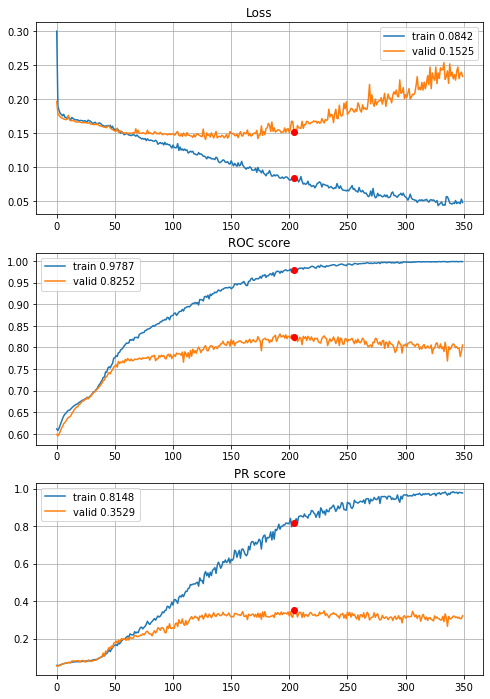


Fold 2------------------------------------------------------------


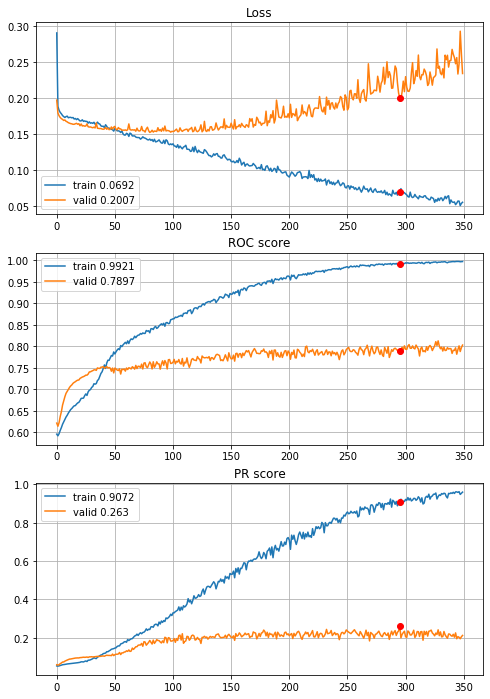


Fold 3------------------------------------------------------------


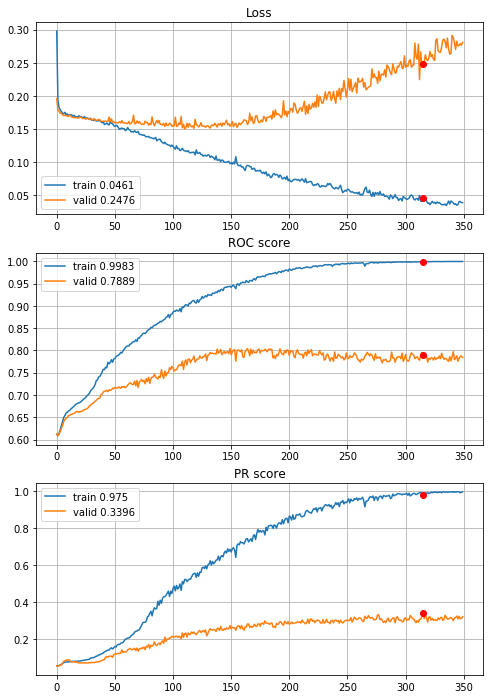


Fold 4------------------------------------------------------------


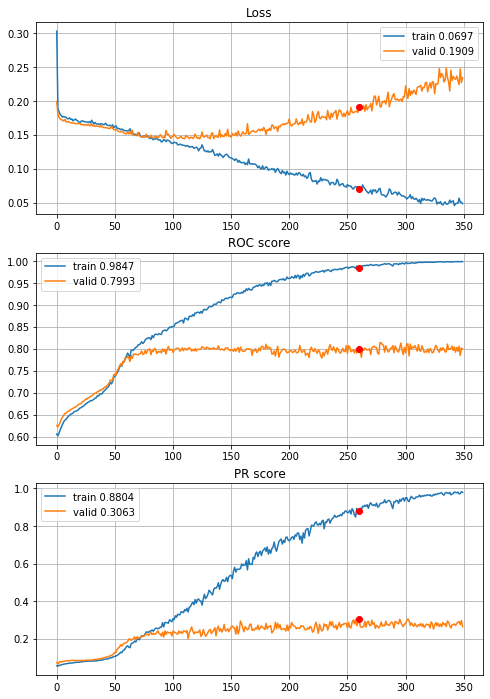


Fold 5------------------------------------------------------------


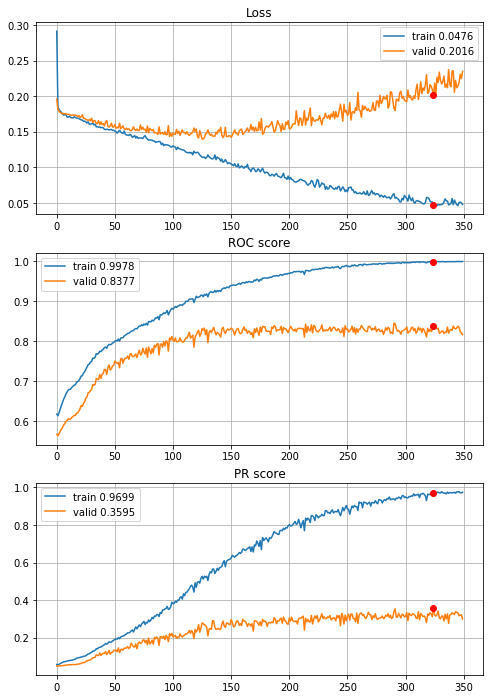


Fold 6------------------------------------------------------------


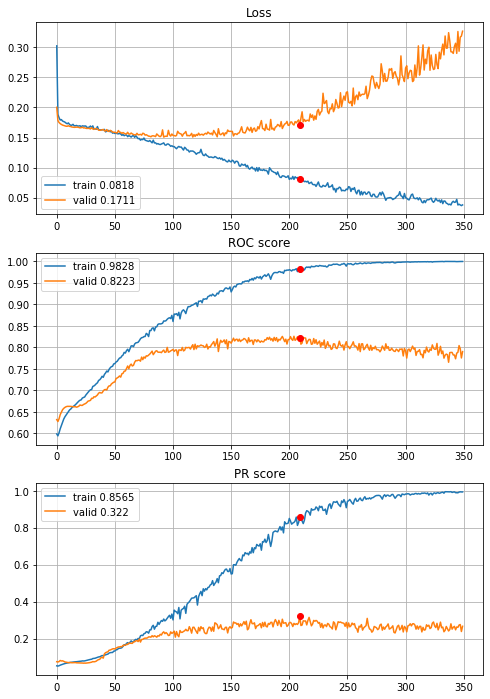

In [52]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_drop_04_2dense_L2_drop_02, features=features,
                                        target=target, n_epochs=350, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_L2_drop_04_2dense_L2_drop_02_350ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

More regularization!

In [52]:
def define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.0001))(flat)                            # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                          # (128,)
    dense = layers.Dropout(rate=0.2)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 5.48s train loss: 0.31990762699680103, validation loss: 0.21244897018644476
Epoch: 2/400,
cumulative time: 6.86s train loss: 0.1999910636038967, validation loss: 0.18707480079459018
Epoch: 3/400,
cumulative time: 8.27s train loss: 0.19073693347033488, validation loss: 0.1822478327299633
Epoch: 4/400,
cumulative time: 9.66s train loss: 0.18472438492247123, validation loss: 0.17934070566612959
Epoch: 5/400,
cumulative time: 11.07s train loss: 0.18238458827261, validation loss: 0.17739828575407382
Epoch: 6/400,
cumulative time: 12.47s train loss: 0.1801039182525707, validation loss: 0.17656837995524174
Epoch: 7/400,
cumulative time: 13.87s train loss: 0.18259543194333602, validation loss: 0.17501433785433537
Epoch: 8/400,
cumulative time: 15.26s train loss: 0.17762268889733981, validation loss: 0.17455801084579053
Epoch: 9/400,
cumulative time: 16.67s train loss: 0.177308128645448

Epoch: 76/400,
cumulative time: 109.29s train loss: 0.14415787686205017, validation loss: 0.1512444673953175
Epoch: 77/400,
cumulative time: 110.66s train loss: 0.14506349790250977, validation loss: 0.15024472719368429
Epoch: 78/400,
cumulative time: 112.01s train loss: 0.14188903941678757, validation loss: 0.15016387530930858
Epoch: 79/400,
cumulative time: 113.37s train loss: 0.14435267006800892, validation loss: 0.15689248168843445
Epoch: 80/400,
cumulative time: 114.74s train loss: 0.1429019100013825, validation loss: 0.15081334665788734
Epoch: 81/400,
cumulative time: 116.1s train loss: 0.1422704185038973, validation loss: 0.15257274946332133
Epoch: 82/400,
cumulative time: 117.46s train loss: 0.14299069394023378, validation loss: 0.15125489475139628
Epoch: 83/400,
cumulative time: 118.82s train loss: 0.14166852289429654, validation loss: 0.15021141678055805
Epoch: 84/400,
cumulative time: 120.19s train loss: 0.14057573404806223, validation loss: 0.15010027559095723
Epoch: 85/400,

Epoch: 151/400,
cumulative time: 212.01s train loss: 0.11059219661066332, validation loss: 0.15075891012836096
Epoch: 152/400,
cumulative time: 213.38s train loss: 0.10827235831417752, validation loss: 0.14967584744740284
Epoch: 153/400,
cumulative time: 214.74s train loss: 0.10518818700910473, validation loss: 0.15545912092822564
Epoch: 154/400,
cumulative time: 216.12s train loss: 0.11012782281180918, validation loss: 0.146807652860294
Epoch: 155/400,
cumulative time: 217.48s train loss: 0.1043895386674095, validation loss: 0.1502212823452831
Epoch: 156/400,
cumulative time: 218.85s train loss: 0.10646550320572287, validation loss: 0.1528669802147314
Epoch: 157/400,
cumulative time: 220.22s train loss: 0.10895625429894731, validation loss: 0.15056873248648361
Epoch: 158/400,
cumulative time: 221.57s train loss: 0.10676943199133589, validation loss: 0.15597980874706532
Epoch: 159/400,
cumulative time: 222.94s train loss: 0.10915976139008882, validation loss: 0.1579361535696652
Epoch: 

Epoch: 226/400,
cumulative time: 315.07s train loss: 0.0780609112805707, validation loss: 0.17513078119151715
Epoch: 227/400,
cumulative time: 316.46s train loss: 0.08104606570161049, validation loss: 0.17174647810965346
Epoch: 228/400,
cumulative time: 317.83s train loss: 0.07867398223760229, validation loss: 0.17577713200649148
Epoch: 229/400,
cumulative time: 319.2s train loss: 0.07871239893221421, validation loss: 0.1819709530039196
Epoch: 230/400,
cumulative time: 320.6s train loss: 0.07992807892050463, validation loss: 0.17596546116225217
Epoch: 231/400,
cumulative time: 321.97s train loss: 0.08530370777221132, validation loss: 0.16721612865381127
Epoch: 232/400,
cumulative time: 323.35s train loss: 0.07752797479167149, validation loss: 0.1825150273652408
Epoch: 233/400,
cumulative time: 324.71s train loss: 0.0840114056888266, validation loss: 0.18631438508649328
Epoch: 234/400,
cumulative time: 326.1s train loss: 0.08200195852922477, validation loss: 0.16498616617050896
Epoch: 2

Epoch: 301/400,
cumulative time: 418.24s train loss: 0.05850609854842282, validation loss: 0.2295999796292104
Epoch: 302/400,
cumulative time: 419.67s train loss: 0.05820212251280782, validation loss: 0.21258544701189389
Epoch: 303/400,
cumulative time: 421.13s train loss: 0.05961216063035911, validation loss: 0.22059917471433843
Epoch: 304/400,
cumulative time: 422.6s train loss: 0.06060299595876764, validation loss: 0.2161739033062211
Epoch: 305/400,
cumulative time: 424.05s train loss: 0.0626500290708033, validation loss: 0.21098635307614488
Epoch: 306/400,
cumulative time: 425.44s train loss: 0.0603918088278978, validation loss: 0.2197421993254678
Epoch: 307/400,
cumulative time: 426.83s train loss: 0.058157024372587324, validation loss: 0.2117217123547513
Epoch: 308/400,
cumulative time: 428.19s train loss: 0.054532461452373185, validation loss: 0.21791252027098504
Epoch: 309/400,
cumulative time: 429.56s train loss: 0.056882201264852744, validation loss: 0.22268471033904375
Epoch

Epoch: 375/400,
cumulative time: 522.2s train loss: 0.05173049015253645, validation loss: 0.24946763861538698
Epoch: 376/400,
cumulative time: 523.56s train loss: 0.04752878024871391, validation loss: 0.25493240653296756
Epoch: 377/400,
cumulative time: 524.94s train loss: 0.0480248887862911, validation loss: 0.25519606781583937
Epoch: 378/400,
cumulative time: 526.3s train loss: 0.045773814307926895, validation loss: 0.2475139613740566
Epoch: 379/400,
cumulative time: 527.67s train loss: 0.04448580147393574, validation loss: 0.24586493499469633
Epoch: 380/400,
cumulative time: 529.06s train loss: 0.04800757201141151, validation loss: 0.25940217981957203
Epoch: 381/400,
cumulative time: 530.45s train loss: 0.04252196604678712, validation loss: 0.26427542456324415
Epoch: 382/400,
cumulative time: 531.88s train loss: 0.04688537602631117, validation loss: 0.2637810253026757
Epoch: 383/400,
cumulative time: 533.38s train loss: 0.04944704457392838, validation loss: 0.26886489022606164
Epoch

Epoch: 48/400,
cumulative time: 74.02s train loss: 0.1590676371021342, validation loss: 0.15995300245784994
Epoch: 49/400,
cumulative time: 75.46s train loss: 0.15856402131696723, validation loss: 0.15841434009343894
Epoch: 50/400,
cumulative time: 76.88s train loss: 0.1566583951872913, validation loss: 0.16138044517208988
Epoch: 51/400,
cumulative time: 78.33s train loss: 0.16084833320502231, validation loss: 0.16215774803611585
Epoch: 52/400,
cumulative time: 79.75s train loss: 0.1585321520312474, validation loss: 0.15744509996155456
Epoch: 53/400,
cumulative time: 81.18s train loss: 0.15684367387193826, validation loss: 0.1571957142840519
Epoch: 54/400,
cumulative time: 82.6s train loss: 0.15729777280938065, validation loss: 0.16102037808295158
Epoch: 55/400,
cumulative time: 84.05s train loss: 0.15727446045346147, validation loss: 0.15774830755915586
Epoch: 56/400,
cumulative time: 85.47s train loss: 0.15487543522124053, validation loss: 0.15762081736427772
Epoch: 57/400,
cumulativ

Epoch: 123/400,
cumulative time: 181.88s train loss: 0.1315110159193349, validation loss: 0.15343703858818014
Epoch: 124/400,
cumulative time: 183.33s train loss: 0.1289662399928275, validation loss: 0.15684449586768295
Epoch: 125/400,
cumulative time: 184.78s train loss: 0.1281407567507506, validation loss: 0.16185676368004684
Epoch: 126/400,
cumulative time: 186.19s train loss: 0.12990065734857406, validation loss: 0.15396271274958495
Epoch: 127/400,
cumulative time: 187.63s train loss: 0.12997454426121097, validation loss: 0.15271827592215406
Epoch: 128/400,
cumulative time: 189.06s train loss: 0.13328936265366217, validation loss: 0.16312701564628831
Epoch: 129/400,
cumulative time: 190.49s train loss: 0.12797138573930716, validation loss: 0.15412300278287416
Epoch: 130/400,
cumulative time: 191.92s train loss: 0.1282291254864903, validation loss: 0.15398453218986916
Epoch: 131/400,
cumulative time: 193.34s train loss: 0.1261873757941552, validation loss: 0.15650821653918545
Epoch:

Epoch: 198/400,
cumulative time: 289.91s train loss: 0.10134651169214075, validation loss: 0.1603537866672401
Epoch: 199/400,
cumulative time: 291.35s train loss: 0.10056785670270112, validation loss: 0.16612868882022397
Epoch: 200/400,
cumulative time: 292.78s train loss: 0.09821072910681732, validation loss: 0.16622848761894132
Epoch: 201/400,
cumulative time: 294.21s train loss: 0.09684337023291617, validation loss: 0.16696300784304133
Epoch: 202/400,
cumulative time: 295.65s train loss: 0.10188611335871745, validation loss: 0.17600070293577752
Epoch: 203/400,
cumulative time: 297.07s train loss: 0.10030300935750114, validation loss: 0.1678956633782793
Epoch: 204/400,
cumulative time: 298.51s train loss: 0.09866945058994141, validation loss: 0.16871167213544933
Epoch: 205/400,
cumulative time: 299.94s train loss: 0.10210555770076389, validation loss: 0.16899147842611587
Epoch: 206/400,
cumulative time: 301.37s train loss: 0.09822647727177236, validation loss: 0.15960446841829257
Epo

Epoch: 273/400,
cumulative time: 397.81s train loss: 0.07902953963297538, validation loss: 0.18273535607136093
Epoch: 274/400,
cumulative time: 399.23s train loss: 0.08051136059781518, validation loss: 0.18929112340332171
Epoch: 275/400,
cumulative time: 400.67s train loss: 0.08446900020351665, validation loss: 0.18162145452918108
Epoch: 276/400,
cumulative time: 402.09s train loss: 0.08080265001058266, validation loss: 0.18343622887782937
Epoch: 277/400,
cumulative time: 403.52s train loss: 0.07551637332437704, validation loss: 0.18569193206249027
Epoch: 278/400,
cumulative time: 404.94s train loss: 0.08155985641626375, validation loss: 0.18990163413287772
Epoch: 279/400,
cumulative time: 406.37s train loss: 0.07938926854094072, validation loss: 0.18388888500582032
Epoch: 280/400,
cumulative time: 407.8s train loss: 0.0834487904845176, validation loss: 0.19111121056276723
Epoch: 281/400,
cumulative time: 409.24s train loss: 0.07854426480406843, validation loss: 0.19347816777963625
Epo

Epoch: 348/400,
cumulative time: 505.63s train loss: 0.0673967697627736, validation loss: 0.22744356220780945
Epoch: 349/400,
cumulative time: 507.07s train loss: 0.06517513561981629, validation loss: 0.22991675163862121
Epoch: 350/400,
cumulative time: 508.51s train loss: 0.06561604512911322, validation loss: 0.21373022875967063
Epoch: 351/400,
cumulative time: 509.94s train loss: 0.06480534352056476, validation loss: 0.20785134603046027
Epoch: 352/400,
cumulative time: 511.36s train loss: 0.06832133820589287, validation loss: 0.2379638509309776
Epoch: 353/400,
cumulative time: 512.79s train loss: 0.07397521705290862, validation loss: 0.22516968512363233
Epoch: 354/400,
cumulative time: 514.21s train loss: 0.07567722834759012, validation loss: 0.20518529772524127
Epoch: 355/400,
cumulative time: 515.65s train loss: 0.0685761657082397, validation loss: 0.2145351132238833
Epoch: 356/400,
cumulative time: 517.06s train loss: 0.06966262618767073, validation loss: 0.2044768896085719
Epoch:

Epoch: 21/400,
cumulative time: 35.48s train loss: 0.1709561171858569, validation loss: 0.17029365477290098
Epoch: 22/400,
cumulative time: 36.93s train loss: 0.17152207109504358, validation loss: 0.17016248559264338
Epoch: 23/400,
cumulative time: 38.4s train loss: 0.16990237792731425, validation loss: 0.16820047832878982
Epoch: 24/400,
cumulative time: 39.86s train loss: 0.1696228373642908, validation loss: 0.16787156595471334
Epoch: 25/400,
cumulative time: 41.33s train loss: 0.17081251456358906, validation loss: 0.16794167462917017
Epoch: 26/400,
cumulative time: 42.8s train loss: 0.16740083029384553, validation loss: 0.16756015215288764
Epoch: 27/400,
cumulative time: 44.26s train loss: 0.16908383456755002, validation loss: 0.16816056614465827
Epoch: 28/400,
cumulative time: 45.72s train loss: 0.1682116718256453, validation loss: 0.16680247036845156
Epoch: 29/400,
cumulative time: 47.19s train loss: 0.1673197988398751, validation loss: 0.1667647154545253
Epoch: 30/400,
cumulative 

Epoch: 97/400,
cumulative time: 147.12s train loss: 0.1327636514788281, validation loss: 0.1585626519757517
Epoch: 98/400,
cumulative time: 148.59s train loss: 0.1344336426547946, validation loss: 0.16264606495711312
Epoch: 99/400,
cumulative time: 150.03s train loss: 0.13127785965825678, validation loss: 0.1575513681784995
Epoch: 100/400,
cumulative time: 151.49s train loss: 0.13249691684462636, validation loss: 0.1616265619390914
Epoch: 101/400,
cumulative time: 152.95s train loss: 0.12989895480545402, validation loss: 0.1602481105126841
Epoch: 102/400,
cumulative time: 154.42s train loss: 0.12966461668736126, validation loss: 0.1575563723907402
Epoch: 103/400,
cumulative time: 155.87s train loss: 0.1289178751753798, validation loss: 0.17443024108325514
Epoch: 104/400,
cumulative time: 157.34s train loss: 0.13333128538700023, validation loss: 0.15883535249244182
Epoch: 105/400,
cumulative time: 158.79s train loss: 0.1279037240499562, validation loss: 0.16008224940784324
Epoch: 106/40

Epoch: 172/400,
cumulative time: 257.26s train loss: 0.09295774077092513, validation loss: 0.15712225497706378
Epoch: 173/400,
cumulative time: 258.73s train loss: 0.08883239927964483, validation loss: 0.16874916831014353
Epoch: 174/400,
cumulative time: 260.19s train loss: 0.08901261234931138, validation loss: 0.1540499860579502
Epoch: 175/400,
cumulative time: 261.64s train loss: 0.09035279844598355, validation loss: 0.1538723913042136
Epoch: 176/400,
cumulative time: 263.1s train loss: 0.0917031287449671, validation loss: 0.152736126751606
Epoch: 177/400,
cumulative time: 264.57s train loss: 0.08874857251168954, validation loss: 0.16128828324777897
Epoch: 178/400,
cumulative time: 266.02s train loss: 0.08971972570950276, validation loss: 0.15475541263389087
Epoch: 179/400,
cumulative time: 267.47s train loss: 0.09261380121168514, validation loss: 0.16104677904441192
Epoch: 180/400,
cumulative time: 268.94s train loss: 0.08880738425608746, validation loss: 0.16771265234539423
Epoch: 

Epoch: 247/400,
cumulative time: 367.68s train loss: 0.06225384202434087, validation loss: 0.1901302581377142
Epoch: 248/400,
cumulative time: 369.16s train loss: 0.0614873384975062, validation loss: 0.20246530272466953
Epoch: 249/400,
cumulative time: 370.61s train loss: 0.06574128921852854, validation loss: 0.19583629290445134
Epoch: 250/400,
cumulative time: 372.09s train loss: 0.06402344985388103, validation loss: 0.190586847410602
Epoch: 251/400,
cumulative time: 373.54s train loss: 0.059047768031403096, validation loss: 0.187744911452499
Epoch: 252/400,
cumulative time: 375.0s train loss: 0.06305258400149341, validation loss: 0.21593002109821316
Epoch: 253/400,
cumulative time: 376.48s train loss: 0.06528577049819369, validation loss: 0.18804891718988492
Epoch: 254/400,
cumulative time: 377.95s train loss: 0.0622716472841978, validation loss: 0.2031934004701762
Epoch: 255/400,
cumulative time: 379.44s train loss: 0.06638102443284016, validation loss: 0.19814909930154193
Epoch: 25

Epoch: 322/400,
cumulative time: 478.02s train loss: 0.052777638825149555, validation loss: 0.2280431257983179
Epoch: 323/400,
cumulative time: 479.49s train loss: 0.05349969595713671, validation loss: 0.23143376337747587
Epoch: 324/400,
cumulative time: 480.96s train loss: 0.04713036442757325, validation loss: 0.22631090490799274
Epoch: 325/400,
cumulative time: 482.42s train loss: 0.04385450875162219, validation loss: 0.2388970611878179
Epoch: 326/400,
cumulative time: 483.89s train loss: 0.048812767088624184, validation loss: 0.22063093947864298
Epoch: 327/400,
cumulative time: 485.37s train loss: 0.052766751117593165, validation loss: 0.23856966535354504
Epoch: 328/400,
cumulative time: 486.86s train loss: 0.05254213913185269, validation loss: 0.2421394224091876
Epoch: 329/400,
cumulative time: 488.38s train loss: 0.04798022327391141, validation loss: 0.2368153903735887
Epoch: 330/400,
cumulative time: 489.86s train loss: 0.05348382317196777, validation loss: 0.22217540431225752
Ep

Epoch: 396/400,
cumulative time: 586.73s train loss: 0.045184580442445714, validation loss: 0.28442913700056266
Epoch: 397/400,
cumulative time: 588.23s train loss: 0.04512464710147357, validation loss: 0.27005188831104987
Epoch: 398/400,
cumulative time: 589.73s train loss: 0.039386508955590566, validation loss: 0.264333849360246
Epoch: 399/400,
cumulative time: 591.25s train loss: 0.03640659967712547, validation loss: 0.29438177059706044
Epoch: 400/400,
cumulative time: 592.71s train loss: 0.03611209051485049, validation loss: 0.27191790108365127

Early stopping results:
best results in epoch: 242, 
best valid PR: 0.3678405087169162, 
valid ROC: 0.8067303319690768        
overfitting PR: 0.5538618859072117, 
overfitting ROC: 0.1847685082546917

----------
Fold: 4
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 6.03s train loss: 0.3055422373935395, validation loss: 0.20455983767425093
Epoch: 2/400,
cumulative time: 7.53s train loss: 0.19701969

Epoch: 70/400,
cumulative time: 109.14s train loss: 0.1522278851705073, validation loss: 0.15128550124824594
Epoch: 71/400,
cumulative time: 110.66s train loss: 0.1555540811767083, validation loss: 0.1545074162016065
Epoch: 72/400,
cumulative time: 112.2s train loss: 0.15570988917330456, validation loss: 0.14999361890874716
Epoch: 73/400,
cumulative time: 113.7s train loss: 0.15161479505428185, validation loss: 0.14932924714110313
Epoch: 74/400,
cumulative time: 115.17s train loss: 0.15052190433949844, validation loss: 0.14867621390722682
Epoch: 75/400,
cumulative time: 116.67s train loss: 0.14992763662044492, validation loss: 0.14852982802441048
Epoch: 76/400,
cumulative time: 118.15s train loss: 0.1520624690754946, validation loss: 0.14853864023522967
Epoch: 77/400,
cumulative time: 119.64s train loss: 0.14934411690641097, validation loss: 0.14815390805273193
Epoch: 78/400,
cumulative time: 121.13s train loss: 0.15054173612285213, validation loss: 0.15242281634248256
Epoch: 79/400,
c

Epoch: 145/400,
cumulative time: 222.6s train loss: 0.12649616118882334, validation loss: 0.1474329772384576
Epoch: 146/400,
cumulative time: 224.15s train loss: 0.13090156922101007, validation loss: 0.14757730357768808
Epoch: 147/400,
cumulative time: 225.67s train loss: 0.13210018115480227, validation loss: 0.14658146465824598
Epoch: 148/400,
cumulative time: 227.19s train loss: 0.1273607396391151, validation loss: 0.15082919013687698
Epoch: 149/400,
cumulative time: 228.71s train loss: 0.1285045770431412, validation loss: 0.1455279748647585
Epoch: 150/400,
cumulative time: 230.23s train loss: 0.12412185932201114, validation loss: 0.14633795814307926
Epoch: 151/400,
cumulative time: 231.77s train loss: 0.12443149870420006, validation loss: 0.14653336212800652
Epoch: 152/400,
cumulative time: 233.27s train loss: 0.12430775873406966, validation loss: 0.15037509088122517
Epoch: 153/400,
cumulative time: 234.76s train loss: 0.12348300722807447, validation loss: 0.1461554005800662
Epoch: 

Epoch: 220/400,
cumulative time: 334.34s train loss: 0.10087397165947089, validation loss: 0.1546054925784215
Epoch: 221/400,
cumulative time: 335.82s train loss: 0.09452251648645849, validation loss: 0.17706838367338418
Epoch: 222/400,
cumulative time: 337.34s train loss: 0.10143591182447774, validation loss: 0.1579352152261634
Epoch: 223/400,
cumulative time: 338.81s train loss: 0.09868173919220648, validation loss: 0.1506012800792879
Epoch: 224/400,
cumulative time: 340.29s train loss: 0.09992423534358152, validation loss: 0.15850352643357973
Epoch: 225/400,
cumulative time: 341.82s train loss: 0.09673902068151874, validation loss: 0.1572924883032845
Epoch: 226/400,
cumulative time: 343.45s train loss: 0.0984374979604414, validation loss: 0.15866804451023767
Epoch: 227/400,
cumulative time: 344.99s train loss: 0.09751432117717827, validation loss: 0.1592587465774341
Epoch: 228/400,
cumulative time: 346.51s train loss: 0.1007049895802493, validation loss: 0.15687052470047227
Epoch: 2

Epoch: 295/400,
cumulative time: 446.3s train loss: 0.07838506405585433, validation loss: 0.1764544923136775
Epoch: 296/400,
cumulative time: 447.8s train loss: 0.07683459128014991, validation loss: 0.1821674237010676
Epoch: 297/400,
cumulative time: 449.28s train loss: 0.07374874283952097, validation loss: 0.19014874579162772
Epoch: 298/400,
cumulative time: 450.75s train loss: 0.07500698209504247, validation loss: 0.17358578423216334
Epoch: 299/400,
cumulative time: 452.31s train loss: 0.07818367303458824, validation loss: 0.17875142055679585
Epoch: 300/400,
cumulative time: 453.8s train loss: 0.07537908413601134, validation loss: 0.18627111043483213
Epoch: 301/400,
cumulative time: 455.28s train loss: 0.07400386908925022, validation loss: 0.1823725359780448
Epoch: 302/400,
cumulative time: 456.75s train loss: 0.06902260819750573, validation loss: 0.18865849671404453
Epoch: 303/400,
cumulative time: 458.23s train loss: 0.06964983985165904, validation loss: 0.18079107585771992
Epoch: 

Epoch: 370/400,
cumulative time: 558.16s train loss: 0.06134697024268925, validation loss: 0.23212309835935171
Epoch: 371/400,
cumulative time: 559.73s train loss: 0.05955716593100447, validation loss: 0.24157801063470102
Epoch: 372/400,
cumulative time: 561.25s train loss: 0.060799112755144574, validation loss: 0.24365949431534364
Epoch: 373/400,
cumulative time: 562.76s train loss: 0.0637746675884619, validation loss: 0.23575050609374265
Epoch: 374/400,
cumulative time: 564.24s train loss: 0.06294867335023378, validation loss: 0.2245518462451695
Epoch: 375/400,
cumulative time: 565.74s train loss: 0.06205873097308827, validation loss: 0.23513907201949452
Epoch: 376/400,
cumulative time: 567.21s train loss: 0.0614275334243975, validation loss: 0.21375847798265604
Epoch: 377/400,
cumulative time: 568.69s train loss: 0.06274554153875264, validation loss: 0.23374432600731931
Epoch: 378/400,
cumulative time: 570.18s train loss: 0.06008551573105667, validation loss: 0.22086144143991357
Epo

Epoch: 43/400,
cumulative time: 70.06s train loss: 0.15676601570568854, validation loss: 0.1695039970495129
Epoch: 44/400,
cumulative time: 71.58s train loss: 0.1586190883267018, validation loss: 0.16771199449721044
Epoch: 45/400,
cumulative time: 73.07s train loss: 0.15802933869773306, validation loss: 0.1608192055128505
Epoch: 46/400,
cumulative time: 74.57s train loss: 0.15760107373781887, validation loss: 0.16136067140930446
Epoch: 47/400,
cumulative time: 76.08s train loss: 0.1571028229722753, validation loss: 0.16054684435399458
Epoch: 48/400,
cumulative time: 77.58s train loss: 0.15739107740192587, validation loss: 0.16571124901855913
Epoch: 49/400,
cumulative time: 79.08s train loss: 0.15657419581364204, validation loss: 0.1593429273773146
Epoch: 50/400,
cumulative time: 80.58s train loss: 0.15714994839262347, validation loss: 0.16108972976670197
Epoch: 51/400,
cumulative time: 82.07s train loss: 0.15558002617657926, validation loss: 0.1642625015692817
Epoch: 52/400,
cumulative

Epoch: 118/400,
cumulative time: 183.37s train loss: 0.12857841947886872, validation loss: 0.15350637708938294
Epoch: 119/400,
cumulative time: 184.87s train loss: 0.12826218722938226, validation loss: 0.16073721246903722
Epoch: 120/400,
cumulative time: 186.4s train loss: 0.12870309380493372, validation loss: 0.15483584386805563
Epoch: 121/400,
cumulative time: 187.91s train loss: 0.12746525450472532, validation loss: 0.1601362417245755
Epoch: 122/400,
cumulative time: 189.41s train loss: 0.1279665659519804, validation loss: 0.1516144417255609
Epoch: 123/400,
cumulative time: 190.92s train loss: 0.12747500489956273, validation loss: 0.15422476884734426
Epoch: 124/400,
cumulative time: 192.42s train loss: 0.12640417842928117, validation loss: 0.15895249170213352
Epoch: 125/400,
cumulative time: 193.92s train loss: 0.12397225938668052, validation loss: 0.15770600954873845
Epoch: 126/400,
cumulative time: 195.44s train loss: 0.12255679014110678, validation loss: 0.148091184378139
Epoch: 

Epoch: 193/400,
cumulative time: 296.95s train loss: 0.0998846266918233, validation loss: 0.16796076022391238
Epoch: 194/400,
cumulative time: 298.45s train loss: 0.09723201412832086, validation loss: 0.15712643486019198
Epoch: 195/400,
cumulative time: 299.97s train loss: 0.09683629465022676, validation loss: 0.16295936648998785
Epoch: 196/400,
cumulative time: 301.47s train loss: 0.10038641217628709, validation loss: 0.15959916786238218
Epoch: 197/400,
cumulative time: 303.0s train loss: 0.09776146347937366, validation loss: 0.15943676262586176
Epoch: 198/400,
cumulative time: 304.57s train loss: 0.09583846959757264, validation loss: 0.16781593288928465
Epoch: 199/400,
cumulative time: 306.13s train loss: 0.09513520963879678, validation loss: 0.1640588168938538
Epoch: 200/400,
cumulative time: 307.66s train loss: 0.09946675871291719, validation loss: 0.16406610795586013
Epoch: 201/400,
cumulative time: 309.16s train loss: 0.09735682017018152, validation loss: 0.15985273480962175
Epoc

Epoch: 268/400,
cumulative time: 410.63s train loss: 0.07589172521015969, validation loss: 0.19069298279629154
Epoch: 269/400,
cumulative time: 412.14s train loss: 0.07666543602546916, validation loss: 0.18419701233994445
Epoch: 270/400,
cumulative time: 413.63s train loss: 0.07534186353254856, validation loss: 0.18597040812669233
Epoch: 271/400,
cumulative time: 415.15s train loss: 0.07672461745353494, validation loss: 0.18462381393771965
Epoch: 272/400,
cumulative time: 416.65s train loss: 0.07864609165225793, validation loss: 0.19058124883146774
Epoch: 273/400,
cumulative time: 418.15s train loss: 0.07403651616421451, validation loss: 0.20995141200594322
Epoch: 274/400,
cumulative time: 419.64s train loss: 0.07513153643199244, validation loss: 0.18936851757382034
Epoch: 275/400,
cumulative time: 421.15s train loss: 0.07451606157574808, validation loss: 0.18418080063822384
Epoch: 276/400,
cumulative time: 422.66s train loss: 0.07297098209554331, validation loss: 0.19691972713795433
E

Epoch: 343/400,
cumulative time: 524.54s train loss: 0.0635155541139906, validation loss: 0.23379142506250705
Epoch: 344/400,
cumulative time: 526.05s train loss: 0.0603444119545474, validation loss: 0.2305759897511721
Epoch: 345/400,
cumulative time: 527.56s train loss: 0.05567912718722823, validation loss: 0.25013254192287926
Epoch: 346/400,
cumulative time: 529.06s train loss: 0.05884961152212666, validation loss: 0.24484625136477295
Epoch: 347/400,
cumulative time: 530.57s train loss: 0.06185221942482246, validation loss: 0.24851991804524143
Epoch: 348/400,
cumulative time: 532.07s train loss: 0.05786043814880177, validation loss: 0.24648348711733736
Epoch: 349/400,
cumulative time: 533.59s train loss: 0.05744411675231393, validation loss: 0.27466714905567596
Epoch: 350/400,
cumulative time: 535.08s train loss: 0.06341554742974963, validation loss: 0.2537321610227325
Epoch: 351/400,
cumulative time: 536.59s train loss: 0.06299070475716034, validation loss: 0.25783435703495694
Epoch

Epoch: 16/400,
cumulative time: 29.54s train loss: 0.1721450531193657, validation loss: 0.16939217537152962
Epoch: 17/400,
cumulative time: 31.07s train loss: 0.17206138338048993, validation loss: 0.16947591304779053
Epoch: 18/400,
cumulative time: 32.6s train loss: 0.17254182292858863, validation loss: 0.16955907651635466
Epoch: 19/400,
cumulative time: 34.14s train loss: 0.17146322673301398, validation loss: 0.16953833168647328
Epoch: 20/400,
cumulative time: 35.67s train loss: 0.17127070528885951, validation loss: 0.1687711941609617
Epoch: 21/400,
cumulative time: 37.2s train loss: 0.17153146452860002, validation loss: 0.16797838925338182
Epoch: 22/400,
cumulative time: 38.72s train loss: 0.17011427853358996, validation loss: 0.1680523633956909
Epoch: 23/400,
cumulative time: 40.25s train loss: 0.17110941526852305, validation loss: 0.16910178101453624
Epoch: 24/400,
cumulative time: 41.77s train loss: 0.17072523450320232, validation loss: 0.167522981606546
Epoch: 25/400,
cumulative 

Epoch: 92/400,
cumulative time: 146.39s train loss: 0.1435354322058345, validation loss: 0.16520499444398723
Epoch: 93/400,
cumulative time: 147.92s train loss: 0.1443215365002852, validation loss: 0.1505091996466527
Epoch: 94/400,
cumulative time: 149.43s train loss: 0.1417926486537622, validation loss: 0.15151990227034834
Epoch: 95/400,
cumulative time: 150.97s train loss: 0.14078529955987693, validation loss: 0.15226229881654021
Epoch: 96/400,
cumulative time: 152.48s train loss: 0.14338291820387697, validation loss: 0.15155281356123626
Epoch: 97/400,
cumulative time: 154.0s train loss: 0.14361869446728207, validation loss: 0.16166134329115758
Epoch: 98/400,
cumulative time: 155.53s train loss: 0.14137251575136872, validation loss: 0.15360779104662722
Epoch: 99/400,
cumulative time: 157.06s train loss: 0.1393307334356508, validation loss: 0.15140779090709375
Epoch: 100/400,
cumulative time: 158.6s train loss: 0.13947148510348906, validation loss: 0.1550950426449541
Epoch: 101/400,
c

Epoch: 167/400,
cumulative time: 261.45s train loss: 0.10804761094315805, validation loss: 0.1635476726879839
Epoch: 168/400,
cumulative time: 262.98s train loss: 0.11244746040001141, validation loss: 0.16627884953725533
Epoch: 169/400,
cumulative time: 264.52s train loss: 0.10972831539253107, validation loss: 0.15879024455781843
Epoch: 170/400,
cumulative time: 266.04s train loss: 0.10874102215623169, validation loss: 0.1605307676069072
Epoch: 171/400,
cumulative time: 267.58s train loss: 0.10908279919491527, validation loss: 0.15749607312874717
Epoch: 172/400,
cumulative time: 269.1s train loss: 0.1056446118951625, validation loss: 0.15884807594486924
Epoch: 173/400,
cumulative time: 270.63s train loss: 0.11092438546459765, validation loss: 0.16012018166604589
Epoch: 174/400,
cumulative time: 272.17s train loss: 0.10632815055578439, validation loss: 0.16629924583630484
Epoch: 175/400,
cumulative time: 273.68s train loss: 0.11198464386350675, validation loss: 0.1582369890955628
Epoch:

Epoch: 242/400,
cumulative time: 377.4s train loss: 0.07620378798984606, validation loss: 0.2051781173709963
Epoch: 243/400,
cumulative time: 378.92s train loss: 0.07561670241396518, validation loss: 0.21060079939052706
Epoch: 244/400,
cumulative time: 380.44s train loss: 0.07557737437976453, validation loss: 0.2116193040667987
Epoch: 245/400,
cumulative time: 381.95s train loss: 0.08130990476060664, validation loss: 0.21325721561908723
Epoch: 246/400,
cumulative time: 383.46s train loss: 0.08198149981145621, validation loss: 0.19681034596239935
Epoch: 247/400,
cumulative time: 384.98s train loss: 0.076364017571878, validation loss: 0.2036611125899143
Epoch: 248/400,
cumulative time: 386.5s train loss: 0.07428278421511969, validation loss: 0.20939841375976312
Epoch: 249/400,
cumulative time: 388.02s train loss: 0.07766888673914057, validation loss: 0.21417606241390352
Epoch: 250/400,
cumulative time: 389.54s train loss: 0.0748427734667555, validation loss: 0.21793819728444835
Epoch: 25

Epoch: 317/400,
cumulative time: 492.84s train loss: 0.06104658010121567, validation loss: 0.25436430344816113
Epoch: 318/400,
cumulative time: 494.36s train loss: 0.06157286403747093, validation loss: 0.2727325536383957
Epoch: 319/400,
cumulative time: 495.9s train loss: 0.0621481680815373, validation loss: 0.2726500989179142
Epoch: 320/400,
cumulative time: 497.42s train loss: 0.05862281083826312, validation loss: 0.2782747022050326
Epoch: 321/400,
cumulative time: 498.93s train loss: 0.05321031851867314, validation loss: 0.3019497238807991
Epoch: 322/400,
cumulative time: 500.44s train loss: 0.05636804550690857, validation loss: 0.2737487129891505
Epoch: 323/400,
cumulative time: 501.96s train loss: 0.054472470301085034, validation loss: 0.2949700668796164
Epoch: 324/400,
cumulative time: 503.47s train loss: 0.052395349204891785, validation loss: 0.3148378131233278
Epoch: 325/400,
cumulative time: 505.0s train loss: 0.053815947267010826, validation loss: 0.2948676671356451
Epoch: 32

Epoch: 392/400,
cumulative time: 607.43s train loss: 0.04410262466609712, validation loss: 0.3645191174061572
Epoch: 393/400,
cumulative time: 608.95s train loss: 0.044462783596091474, validation loss: 0.36061205004082353
Epoch: 394/400,
cumulative time: 610.47s train loss: 0.046812386919169405, validation loss: 0.370362794457889
Epoch: 395/400,
cumulative time: 612.0s train loss: 0.0441850755446704, validation loss: 0.37134988149658577
Epoch: 396/400,
cumulative time: 613.5s train loss: 0.041315834510334194, validation loss: 0.3920754975764478
Epoch: 397/400,
cumulative time: 615.02s train loss: 0.04483572269788654, validation loss: 0.3782728661083784
Epoch: 398/400,
cumulative time: 616.56s train loss: 0.04511439533389099, validation loss: 0.3717745738537585
Epoch: 399/400,
cumulative time: 618.06s train loss: 0.04353484501903523, validation loss: 0.4004304012314218
Epoch: 400/400,
cumulative time: 619.59s train loss: 0.04405309398601205, validation loss: 0.38916914402461444

Early s

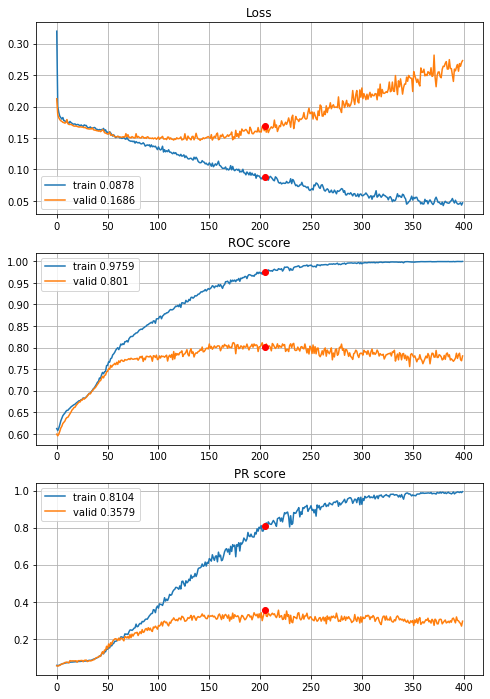


Fold 2------------------------------------------------------------


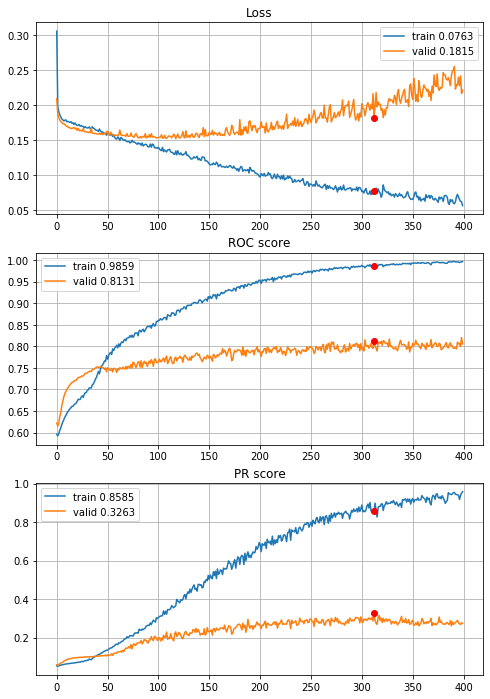


Fold 3------------------------------------------------------------


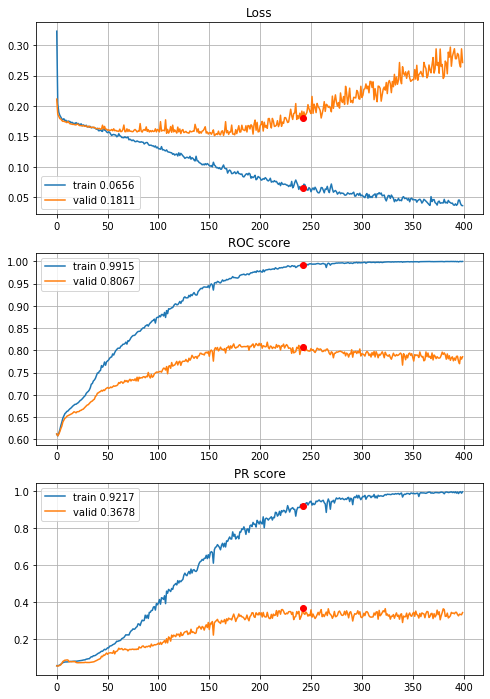


Fold 4------------------------------------------------------------


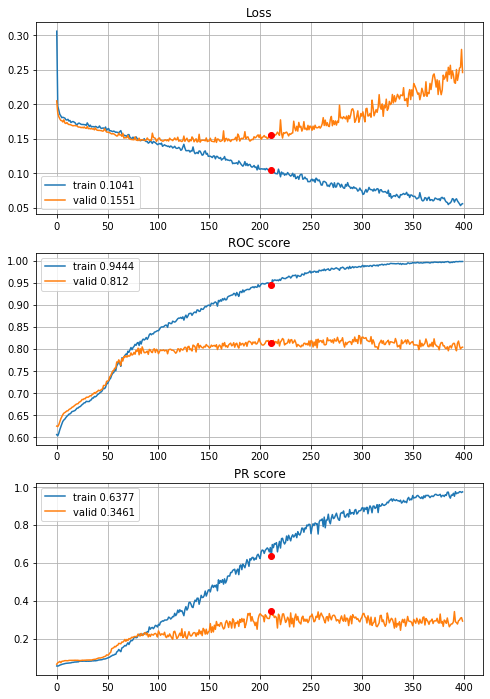


Fold 5------------------------------------------------------------


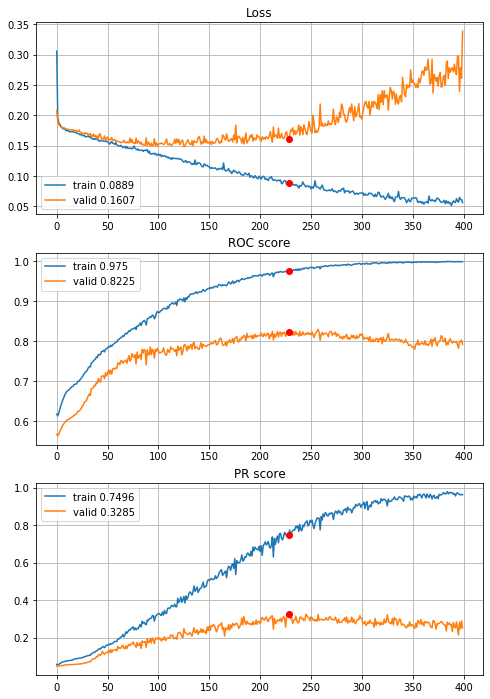


Fold 6------------------------------------------------------------


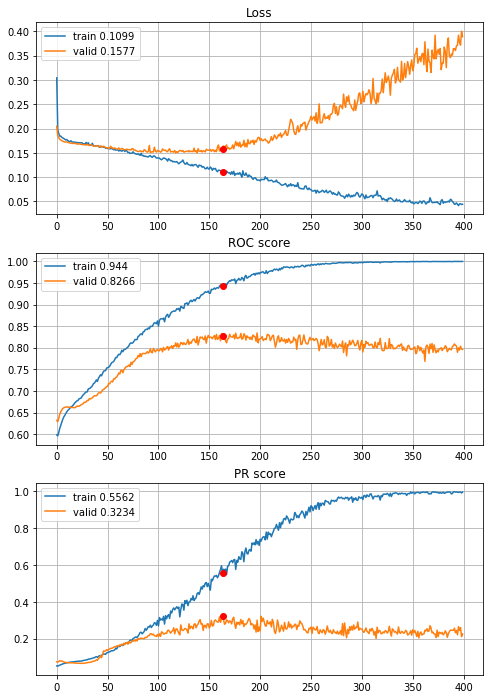

In [54]:
# THE BEST ONE
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Very nice improvement, better results, much lower overfitting, lets try bigger regularization on the second dense layer.

In [53]:
def define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_more_drop_02(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.0001))(flat)                            # (256,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (256,)
    dense = layers.Dense(units=128, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l2(l=0.0001))(dense)                           # (128,)
    dense = layers.Dropout(rate=0.2)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/350,
cumulative time: 6.84s train loss: 0.31577636429844436, validation loss: 0.21307804223594315
Epoch: 2/350,
cumulative time: 8.45s train loss: 0.20509342211135673, validation loss: 0.19226246226583835
Epoch: 3/350,
cumulative time: 10.06s train loss: 0.1958304537395019, validation loss: 0.18696407460135214
Epoch: 4/350,
cumulative time: 11.64s train loss: 0.18918584481512582, validation loss: 0.18350528789925857
Epoch: 5/350,
cumulative time: 13.21s train loss: 0.18655348063366867, validation loss: 0.18104040583651781
Epoch: 6/350,
cumulative time: 14.79s train loss: 0.18379562184544687, validation loss: 0.17962745986244158
Epoch: 7/350,
cumulative time: 16.36s train loss: 0.1854468575954781, validation loss: 0.17819957523014723
Epoch: 8/350,
cumulative time: 17.96s train loss: 0.18058221485831508, validation loss: 0.17737221391688482
Epoch: 9/350,
cumulative time: 19.54s train loss: 0.180100615

Epoch: 76/350,
cumulative time: 126.64s train loss: 0.1449995011770955, validation loss: 0.15239888294886791
Epoch: 77/350,
cumulative time: 128.22s train loss: 0.14577342976294366, validation loss: 0.15159742370111132
Epoch: 78/350,
cumulative time: 129.79s train loss: 0.14325165923800565, validation loss: 0.15164796036434985
Epoch: 79/350,
cumulative time: 131.35s train loss: 0.14550712649772857, validation loss: 0.15673456336145788
Epoch: 80/350,
cumulative time: 132.91s train loss: 0.14373920737392298, validation loss: 0.15223682479417808
Epoch: 81/350,
cumulative time: 134.48s train loss: 0.14349058445072813, validation loss: 0.15304863655043774
Epoch: 82/350,
cumulative time: 136.04s train loss: 0.14360804001482463, validation loss: 0.15280144913598095
Epoch: 83/350,
cumulative time: 137.62s train loss: 0.1430812353117623, validation loss: 0.1515793452627693
Epoch: 84/350,
cumulative time: 139.17s train loss: 0.14243045628563045, validation loss: 0.15238802793141587
Epoch: 85/350

Epoch: 151/350,
cumulative time: 245.11s train loss: 0.12125292867871346, validation loss: 0.15887946691144342
Epoch: 152/350,
cumulative time: 246.66s train loss: 0.11844923841303244, validation loss: 0.15852647435852615
Epoch: 153/350,
cumulative time: 248.23s train loss: 0.11500785632337557, validation loss: 0.1632461032462776
Epoch: 154/350,
cumulative time: 249.79s train loss: 0.11988620085014023, validation loss: 0.15559794809449548
Epoch: 155/350,
cumulative time: 251.34s train loss: 0.11631747241929, validation loss: 0.15804554428294945
Epoch: 156/350,
cumulative time: 252.91s train loss: 0.11585389219760614, validation loss: 0.15771236187664897
Epoch: 157/350,
cumulative time: 254.47s train loss: 0.12064655772733225, validation loss: 0.1571441581411724
Epoch: 158/350,
cumulative time: 256.03s train loss: 0.11642791764430535, validation loss: 0.1572429488753585
Epoch: 159/350,
cumulative time: 257.58s train loss: 0.11616570980669334, validation loss: 0.16738274150563412
Epoch: 

Epoch: 226/350,
cumulative time: 362.17s train loss: 0.09536013314601775, validation loss: 0.1747197713092614
Epoch: 227/350,
cumulative time: 363.72s train loss: 0.09374174246849434, validation loss: 0.17034560643126737
Epoch: 228/350,
cumulative time: 365.27s train loss: 0.0911358971173633, validation loss: 0.1766889156629655
Epoch: 229/350,
cumulative time: 366.9s train loss: 0.09199926909901615, validation loss: 0.17548286539855196
Epoch: 230/350,
cumulative time: 368.48s train loss: 0.08982986984863586, validation loss: 0.1879735604455868
Epoch: 231/350,
cumulative time: 370.02s train loss: 0.09089602981979092, validation loss: 0.17748277525992412
Epoch: 232/350,
cumulative time: 371.58s train loss: 0.08808953224585243, validation loss: 0.18458722410711362
Epoch: 233/350,
cumulative time: 373.13s train loss: 0.0907445218297363, validation loss: 0.19254894165973988
Epoch: 234/350,
cumulative time: 374.69s train loss: 0.09232479690145987, validation loss: 0.17652324033439706
Epoch: 

Epoch: 301/350,
cumulative time: 479.27s train loss: 0.06590081427892362, validation loss: 0.23062578851398602
Epoch: 302/350,
cumulative time: 480.82s train loss: 0.07122362957922343, validation loss: 0.211460350947955
Epoch: 303/350,
cumulative time: 482.36s train loss: 0.06687678887938153, validation loss: 0.21197988278431473
Epoch: 304/350,
cumulative time: 483.9s train loss: 0.06984666383011358, validation loss: 0.22738789033686663
Epoch: 305/350,
cumulative time: 485.46s train loss: 0.06915624489035296, validation loss: 0.22518066028779957
Epoch: 306/350,
cumulative time: 487.01s train loss: 0.06985245741535599, validation loss: 0.2208139098213978
Epoch: 307/350,
cumulative time: 488.59s train loss: 0.06940250846595529, validation loss: 0.21579294215257952
Epoch: 308/350,
cumulative time: 490.14s train loss: 0.07039040040338566, validation loss: 0.23849957792740192
Epoch: 309/350,
cumulative time: 491.69s train loss: 0.06787333576339993, validation loss: 0.2283948406401343
Epoch:

Epoch: 24/350,
cumulative time: 43.72s train loss: 0.17106435323217808, validation loss: 0.16533272798376972
Epoch: 25/350,
cumulative time: 45.31s train loss: 0.17204165911436986, validation loss: 0.1643250252792751
Epoch: 26/350,
cumulative time: 47.02s train loss: 0.1707823960422329, validation loss: 0.16420121817101344
Epoch: 27/350,
cumulative time: 48.61s train loss: 0.17070233172811894, validation loss: 0.16721051708742643
Epoch: 28/350,
cumulative time: 50.19s train loss: 0.16850994897866908, validation loss: 0.16309550211204613
Epoch: 29/350,
cumulative time: 51.76s train loss: 0.17036233126027256, validation loss: 0.1626692032478115
Epoch: 30/350,
cumulative time: 53.37s train loss: 0.16855097854570256, validation loss: 0.1629393356577597
Epoch: 31/350,
cumulative time: 54.96s train loss: 0.1684953835535868, validation loss: 0.16241359034965736
Epoch: 32/350,
cumulative time: 56.54s train loss: 0.16817518709129048, validation loss: 0.16165763930677587
Epoch: 33/350,
cumulativ

Epoch: 100/350,
cumulative time: 165.21s train loss: 0.13924406835879422, validation loss: 0.15324933030111607
Epoch: 101/350,
cumulative time: 166.8s train loss: 0.13970226140931857, validation loss: 0.15325022066014465
Epoch: 102/350,
cumulative time: 168.37s train loss: 0.13889817415550693, validation loss: 0.15466088663938005
Epoch: 103/350,
cumulative time: 169.95s train loss: 0.13691073370618173, validation loss: 0.15330121938632324
Epoch: 104/350,
cumulative time: 171.54s train loss: 0.13589681375384535, validation loss: 0.15541012063720122
Epoch: 105/350,
cumulative time: 173.11s train loss: 0.1395840444474502, validation loss: 0.1532112298091461
Epoch: 106/350,
cumulative time: 174.69s train loss: 0.13531672955926585, validation loss: 0.15282327866335527
Epoch: 107/350,
cumulative time: 176.27s train loss: 0.1370731724157826, validation loss: 0.15927014895379152
Epoch: 108/350,
cumulative time: 177.85s train loss: 0.13623520301630276, validation loss: 0.1526877009852998
Epoch:

Epoch: 175/350,
cumulative time: 284.72s train loss: 0.11374539786334244, validation loss: 0.16721216101946398
Epoch: 176/350,
cumulative time: 286.29s train loss: 0.11072185735181238, validation loss: 0.16159204886750186
Epoch: 177/350,
cumulative time: 287.88s train loss: 0.11311233677199509, validation loss: 0.16221715220851948
Epoch: 178/350,
cumulative time: 289.47s train loss: 0.10858792815538608, validation loss: 0.16456517366250564
Epoch: 179/350,
cumulative time: 291.04s train loss: 0.11155372069627809, validation loss: 0.16828710319252188
Epoch: 180/350,
cumulative time: 292.64s train loss: 0.1087543760664514, validation loss: 0.16239222081507487
Epoch: 181/350,
cumulative time: 294.24s train loss: 0.1150692362249921, validation loss: 0.17886369352181336
Epoch: 182/350,
cumulative time: 295.82s train loss: 0.11345632206309215, validation loss: 0.1618591533536836
Epoch: 183/350,
cumulative time: 297.42s train loss: 0.11246641927558296, validation loss: 0.16560452338674278
Epoc

Epoch: 250/350,
cumulative time: 404.07s train loss: 0.09052653422317682, validation loss: 0.1857144806245989
Epoch: 251/350,
cumulative time: 405.66s train loss: 0.09270057516280689, validation loss: 0.18469433879008612
Epoch: 252/350,
cumulative time: 407.25s train loss: 0.09156894161545256, validation loss: 0.1823073283404229
Epoch: 253/350,
cumulative time: 408.84s train loss: 0.09140188086849707, validation loss: 0.19158650108589884
Epoch: 254/350,
cumulative time: 410.42s train loss: 0.09043099112522557, validation loss: 0.1988716410231309
Epoch: 255/350,
cumulative time: 412.0s train loss: 0.09051891820433725, validation loss: 0.18479135962566887
Epoch: 256/350,
cumulative time: 413.58s train loss: 0.09008400140337276, validation loss: 0.18385642606808975
Epoch: 257/350,
cumulative time: 415.16s train loss: 0.08746377054027171, validation loss: 0.2093534761573509
Epoch: 258/350,
cumulative time: 416.74s train loss: 0.0922962131118115, validation loss: 0.199466432746241
Epoch: 25

Epoch: 325/350,
cumulative time: 523.31s train loss: 0.07453195957852966, validation loss: 0.21873241674696947
Epoch: 326/350,
cumulative time: 524.92s train loss: 0.07480399909057285, validation loss: 0.23116340463783294
Epoch: 327/350,
cumulative time: 526.49s train loss: 0.07689510566874731, validation loss: 0.22421330004578963
Epoch: 328/350,
cumulative time: 528.07s train loss: 0.07455389143044303, validation loss: 0.23998370204184347
Epoch: 329/350,
cumulative time: 529.66s train loss: 0.07756136194201593, validation loss: 0.24162866184939563
Epoch: 330/350,
cumulative time: 531.25s train loss: 0.07402659366965716, validation loss: 0.25774234347777786
Epoch: 331/350,
cumulative time: 532.84s train loss: 0.07212676234940806, validation loss: 0.24868136697093593
Epoch: 332/350,
cumulative time: 534.41s train loss: 0.07451436822743947, validation loss: 0.23518053089728674
Epoch: 333/350,
cumulative time: 536.0s train loss: 0.07108893005407127, validation loss: 0.24204849396120673
Ep

Epoch: 48/350,
cumulative time: 85.24s train loss: 0.16133708963975132, validation loss: 0.1678187983259461
Epoch: 49/350,
cumulative time: 86.88s train loss: 0.160996342923354, validation loss: 0.16261127389977206
Epoch: 50/350,
cumulative time: 88.53s train loss: 0.1585369470272531, validation loss: 0.16315196770906135
Epoch: 51/350,
cumulative time: 90.15s train loss: 0.1571319216293688, validation loss: 0.16114049407788997
Epoch: 52/350,
cumulative time: 91.78s train loss: 0.1589316265082075, validation loss: 0.1618981474661421
Epoch: 53/350,
cumulative time: 93.42s train loss: 0.15801302574771248, validation loss: 0.16122527789632116
Epoch: 54/350,
cumulative time: 95.06s train loss: 0.15525349864958624, validation loss: 0.16121101887166733
Epoch: 55/350,
cumulative time: 96.7s train loss: 0.15248866309726172, validation loss: 0.16215498372424164
Epoch: 56/350,
cumulative time: 98.45s train loss: 0.15365710306259794, validation loss: 0.1607179660081551
Epoch: 57/350,
cumulative ti

Epoch: 123/350,
cumulative time: 209.29s train loss: 0.12697811209779686, validation loss: 0.16000314976722196
Epoch: 124/350,
cumulative time: 210.93s train loss: 0.12679492833495906, validation loss: 0.1631674312377351
Epoch: 125/350,
cumulative time: 212.58s train loss: 0.1239829930071672, validation loss: 0.16696966067444763
Epoch: 126/350,
cumulative time: 214.22s train loss: 0.12340068980428366, validation loss: 0.15921804422163557
Epoch: 127/350,
cumulative time: 215.87s train loss: 0.1206957122067087, validation loss: 0.1585315869117783
Epoch: 128/350,
cumulative time: 217.56s train loss: 0.12208600072337879, validation loss: 0.15932852143072676
Epoch: 129/350,
cumulative time: 219.3s train loss: 0.12108025338409426, validation loss: 0.15850263345757132
Epoch: 130/350,
cumulative time: 220.99s train loss: 0.12095783792483977, validation loss: 0.16054449520448558
Epoch: 131/350,
cumulative time: 222.66s train loss: 0.12204628076703665, validation loss: 0.16087866824505995
Epoch:

Epoch: 198/350,
cumulative time: 333.61s train loss: 0.0875549507329209, validation loss: 0.17340605620045807
Epoch: 199/350,
cumulative time: 335.26s train loss: 0.0929468979533854, validation loss: 0.1636344130550112
Epoch: 200/350,
cumulative time: 336.91s train loss: 0.08890231419293639, validation loss: 0.17057233150477177
Epoch: 201/350,
cumulative time: 338.74s train loss: 0.08684215032424632, validation loss: 0.17098000460105361
Epoch: 202/350,
cumulative time: 340.43s train loss: 0.08396779758317831, validation loss: 0.18753471285065693
Epoch: 203/350,
cumulative time: 342.11s train loss: 0.08706995591605252, validation loss: 0.17664155961645384
Epoch: 204/350,
cumulative time: 343.78s train loss: 0.08714140103738044, validation loss: 0.16297745620673168
Epoch: 205/350,
cumulative time: 345.49s train loss: 0.08704640947771597, validation loss: 0.17997134874329498
Epoch: 206/350,
cumulative time: 347.18s train loss: 0.08968611563747435, validation loss: 0.17411381369493267
Epoc

Epoch: 273/350,
cumulative time: 460.01s train loss: 0.06510804260147401, validation loss: 0.22588562580657973
Epoch: 274/350,
cumulative time: 461.69s train loss: 0.06307761485204111, validation loss: 0.22282005000864383
Epoch: 275/350,
cumulative time: 463.36s train loss: 0.06702855171659917, validation loss: 0.22551598533655995
Epoch: 276/350,
cumulative time: 465.06s train loss: 0.06421797320897121, validation loss: 0.21303499131652662
Epoch: 277/350,
cumulative time: 466.76s train loss: 0.060906500873096195, validation loss: 0.2084892672019111
Epoch: 278/350,
cumulative time: 468.42s train loss: 0.06671381174838313, validation loss: 0.23207294644097046
Epoch: 279/350,
cumulative time: 470.08s train loss: 0.06963820490233628, validation loss: 0.19978339452574795
Epoch: 280/350,
cumulative time: 471.73s train loss: 0.062164935744934584, validation loss: 0.2068863784891906
Epoch: 281/350,
cumulative time: 473.39s train loss: 0.0641586742040245, validation loss: 0.22075151162878714
Ep

Epoch: 348/350,
cumulative time: 584.72s train loss: 0.05010737899213791, validation loss: 0.2861335622647174
Epoch: 349/350,
cumulative time: 586.46s train loss: 0.05186963318969807, validation loss: 0.2661556878455501
Epoch: 350/350,
cumulative time: 588.18s train loss: 0.04759806731020206, validation loss: 0.26875723878881097

Early stopping results:
best results in epoch: 276, 
best valid PR: 0.33815618753077126, 
valid ROC: 0.805462710322874        
overfitting PR: 0.6115016174733143, 
overfitting ROC: 0.1896168821635953

----------
Fold: 4
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/350,
cumulative time: 7.61s train loss: 0.3133990263908433, validation loss: 0.21160773659518006
Epoch: 2/350,
cumulative time: 9.31s train loss: 0.20346779780097862, validation loss: 0.19264200146201396
Epoch: 3/350,
cumulative time: 11.02s train loss: 0.19613190869162164, validation loss: 0.18665803961094524
Epoch: 4/350,
cumulative time: 12.71s train loss: 0.1897823363562089

Epoch: 71/350,
cumulative time: 126.97s train loss: 0.1562198925231603, validation loss: 0.15506525048656514
Epoch: 72/350,
cumulative time: 128.7s train loss: 0.15602093889893295, validation loss: 0.15037126155621414
Epoch: 73/350,
cumulative time: 130.39s train loss: 0.15189972931028647, validation loss: 0.14986965933211666
Epoch: 74/350,
cumulative time: 132.09s train loss: 0.15128957335360477, validation loss: 0.1489252591039375
Epoch: 75/350,
cumulative time: 133.79s train loss: 0.15003885680155044, validation loss: 0.14857153615976537
Epoch: 76/350,
cumulative time: 135.56s train loss: 0.15170779313878943, validation loss: 0.14902745698960707
Epoch: 77/350,
cumulative time: 137.32s train loss: 0.1506350138761188, validation loss: 0.14840737471496138
Epoch: 78/350,
cumulative time: 139.03s train loss: 0.1517308249333252, validation loss: 0.1523506428123614
Epoch: 79/350,
cumulative time: 140.75s train loss: 0.15284399804363152, validation loss: 0.14878088458493685
Epoch: 80/350,
c

Epoch: 146/350,
cumulative time: 255.42s train loss: 0.13324668353941324, validation loss: 0.14403525604176803
Epoch: 147/350,
cumulative time: 257.16s train loss: 0.13268844340900432, validation loss: 0.14459951696514614
Epoch: 148/350,
cumulative time: 258.87s train loss: 0.13047094082735455, validation loss: 0.14983120166146113
Epoch: 149/350,
cumulative time: 260.58s train loss: 0.1309438647031159, validation loss: 0.14468505523542277
Epoch: 150/350,
cumulative time: 262.27s train loss: 0.12590160811809964, validation loss: 0.1450231801401116
Epoch: 151/350,
cumulative time: 263.98s train loss: 0.12728402554707596, validation loss: 0.14456906713555087
Epoch: 152/350,
cumulative time: 265.68s train loss: 0.12452309352180595, validation loss: 0.1504570293199969
Epoch: 153/350,
cumulative time: 267.39s train loss: 0.12584171443103354, validation loss: 0.14463037598101838
Epoch: 154/350,
cumulative time: 269.09s train loss: 0.12391910802874251, validation loss: 0.14473042575591202
Epoc

Epoch: 221/350,
cumulative time: 383.33s train loss: 0.10178050994023394, validation loss: 0.16455982439952316
Epoch: 222/350,
cumulative time: 385.02s train loss: 0.10571439671704319, validation loss: 0.1573556528217983
Epoch: 223/350,
cumulative time: 386.7s train loss: 0.10562053645660312, validation loss: 0.15377254602480997
Epoch: 224/350,
cumulative time: 388.38s train loss: 0.10566436806502012, validation loss: 0.1628656617388969
Epoch: 225/350,
cumulative time: 390.07s train loss: 0.1002713450726167, validation loss: 0.16058136350908567
Epoch: 226/350,
cumulative time: 391.75s train loss: 0.10321117641748771, validation loss: 0.15805408432786774
Epoch: 227/350,
cumulative time: 393.42s train loss: 0.10367005917067014, validation loss: 0.1602222239049359
Epoch: 228/350,
cumulative time: 395.12s train loss: 0.10446496862077763, validation loss: 0.15817157078539248
Epoch: 229/350,
cumulative time: 396.79s train loss: 0.103328453566108, validation loss: 0.15523337442940527
Epoch: 2

Epoch: 296/350,
cumulative time: 510.65s train loss: 0.08256895746901458, validation loss: 0.18921060088733857
Epoch: 297/350,
cumulative time: 512.35s train loss: 0.08259677515312812, validation loss: 0.19497799140988295
Epoch: 298/350,
cumulative time: 514.04s train loss: 0.0800890998507346, validation loss: 0.18695437054724712
Epoch: 299/350,
cumulative time: 515.73s train loss: 0.08163544593208238, validation loss: 0.18048833355522406
Epoch: 300/350,
cumulative time: 517.42s train loss: 0.07939988345704677, validation loss: 0.18334161950126387
Epoch: 301/350,
cumulative time: 519.12s train loss: 0.07880679562420281, validation loss: 0.18667085179729512
Epoch: 302/350,
cumulative time: 520.8s train loss: 0.07990954225783517, validation loss: 0.1953028001057211
Epoch: 303/350,
cumulative time: 522.5s train loss: 0.08003262975526006, validation loss: 0.18330559101282848
Epoch: 304/350,
cumulative time: 524.18s train loss: 0.07822849734619539, validation loss: 0.18210295077076433
Epoch

Epoch: 19/350,
cumulative time: 39.29s train loss: 0.17355225447441774, validation loss: 0.17564609906542192
Epoch: 20/350,
cumulative time: 41.04s train loss: 0.1725002153526207, validation loss: 0.17678325872277525
Epoch: 21/350,
cumulative time: 42.78s train loss: 0.17205550350997875, validation loss: 0.17458776762491754
Epoch: 22/350,
cumulative time: 44.52s train loss: 0.17129764071781556, validation loss: 0.1753716905690427
Epoch: 23/350,
cumulative time: 46.28s train loss: 0.17056596483061082, validation loss: 0.17641817738313037
Epoch: 24/350,
cumulative time: 48.03s train loss: 0.1689616793561285, validation loss: 0.17337661227736217
Epoch: 25/350,
cumulative time: 49.77s train loss: 0.1704519067976762, validation loss: 0.1725489564952813
Epoch: 26/350,
cumulative time: 51.53s train loss: 0.1682268094463326, validation loss: 0.17197363781663413
Epoch: 27/350,
cumulative time: 53.27s train loss: 0.16721741259996536, validation loss: 0.1717915454901374
Epoch: 28/350,
cumulative 

Epoch: 95/350,
cumulative time: 172.46s train loss: 0.13700679666695362, validation loss: 0.1495263701888243
Epoch: 96/350,
cumulative time: 174.23s train loss: 0.13745875260881177, validation loss: 0.15129158488654215
Epoch: 97/350,
cumulative time: 175.97s train loss: 0.1364815379911051, validation loss: 0.16155919385768797
Epoch: 98/350,
cumulative time: 177.72s train loss: 0.13790971774357397, validation loss: 0.14931521329389175
Epoch: 99/350,
cumulative time: 179.46s train loss: 0.13499564776212458, validation loss: 0.1550864889182707
Epoch: 100/350,
cumulative time: 181.18s train loss: 0.13543195322669652, validation loss: 0.14956581612089515
Epoch: 101/350,
cumulative time: 182.92s train loss: 0.13658503034094838, validation loss: 0.1518141091416735
Epoch: 102/350,
cumulative time: 184.66s train loss: 0.13458152181559363, validation loss: 0.1524970492404223
Epoch: 103/350,
cumulative time: 186.4s train loss: 0.1360977067264071, validation loss: 0.1532086917097884
Epoch: 104/350

Epoch: 170/350,
cumulative time: 303.75s train loss: 0.11633150493888496, validation loss: 0.16170497629230018
Epoch: 171/350,
cumulative time: 305.5s train loss: 0.11193288862314585, validation loss: 0.15431926763698284
Epoch: 172/350,
cumulative time: 307.26s train loss: 0.1113071215154303, validation loss: 0.15729096508432341
Epoch: 173/350,
cumulative time: 309.02s train loss: 0.10749710317535566, validation loss: 0.1578605582798449
Epoch: 174/350,
cumulative time: 310.78s train loss: 0.11053594274951521, validation loss: 0.15661039555916467
Epoch: 175/350,
cumulative time: 312.53s train loss: 0.11391905160797332, validation loss: 0.16738217867920627
Epoch: 176/350,
cumulative time: 314.28s train loss: 0.11038972425076421, validation loss: 0.16032405904595537
Epoch: 177/350,
cumulative time: 316.04s train loss: 0.11376734347182656, validation loss: 0.1849994638917643
Epoch: 178/350,
cumulative time: 317.78s train loss: 0.1108351628907559, validation loss: 0.15419557012939827
Epoch:

Epoch: 245/350,
cumulative time: 441.49s train loss: 0.08655512384579088, validation loss: 0.18822945779382325
Epoch: 246/350,
cumulative time: 443.35s train loss: 0.08830891277991174, validation loss: 0.1733046716193853
Epoch: 247/350,
cumulative time: 445.11s train loss: 0.09065884859959754, validation loss: 0.17044894010570696
Epoch: 248/350,
cumulative time: 446.89s train loss: 0.09221458254678172, validation loss: 0.1809146188072577
Epoch: 249/350,
cumulative time: 448.72s train loss: 0.08712120249677976, validation loss: 0.18521195417697275
Epoch: 250/350,
cumulative time: 450.46s train loss: 0.09043572980435417, validation loss: 0.18402108432893516
Epoch: 251/350,
cumulative time: 452.3s train loss: 0.0870450726146388, validation loss: 0.17083352548344888
Epoch: 252/350,
cumulative time: 454.24s train loss: 0.09357618770322476, validation loss: 0.1667711835154387
Epoch: 253/350,
cumulative time: 456.13s train loss: 0.08936685624560846, validation loss: 0.19063593818272706
Epoch:

Epoch: 320/350,
cumulative time: 577.05s train loss: 0.07242402646371743, validation loss: 0.20749800301707433
Epoch: 321/350,
cumulative time: 578.99s train loss: 0.07159814143084357, validation loss: 0.23950151538630143
Epoch: 322/350,
cumulative time: 581.09s train loss: 0.07137280687941748, validation loss: 0.21773588868299912
Epoch: 323/350,
cumulative time: 583.19s train loss: 0.07064098407690061, validation loss: 0.22519196366810704
Epoch: 324/350,
cumulative time: 585.18s train loss: 0.07348767049910435, validation loss: 0.21559472266843405
Epoch: 325/350,
cumulative time: 586.97s train loss: 0.07125034197229345, validation loss: 0.22778085034296677
Epoch: 326/350,
cumulative time: 588.72s train loss: 0.07342011467557948, validation loss: 0.2316803723417447
Epoch: 327/350,
cumulative time: 590.5s train loss: 0.07686691921556398, validation loss: 0.20905567184188262
Epoch: 328/350,
cumulative time: 592.29s train loss: 0.07382993070685327, validation loss: 0.2257235041022457
Epoc

Epoch: 43/350,
cumulative time: 92.7s train loss: 0.1623010227791135, validation loss: 0.16313738010945866
Epoch: 44/350,
cumulative time: 94.56s train loss: 0.16286814072575825, validation loss: 0.16494723403062977
Epoch: 45/350,
cumulative time: 96.39s train loss: 0.16411426118324812, validation loss: 0.16264780615196853
Epoch: 46/350,
cumulative time: 98.34s train loss: 0.1633599998617391, validation loss: 0.16265810748592752
Epoch: 47/350,
cumulative time: 100.33s train loss: 0.1625384260208235, validation loss: 0.1642735752512197
Epoch: 48/350,
cumulative time: 102.38s train loss: 0.1630844115195393, validation loss: 0.16334999583783696
Epoch: 49/350,
cumulative time: 104.29s train loss: 0.1600375462562666, validation loss: 0.16144437514367652
Epoch: 50/350,
cumulative time: 106.24s train loss: 0.16039135434016644, validation loss: 0.16103170134005
Epoch: 51/350,
cumulative time: 108.16s train loss: 0.1599521901160674, validation loss: 0.16078193715361297
Epoch: 52/350,
cumulative

Epoch: 118/350,
cumulative time: 237.33s train loss: 0.13283881362854733, validation loss: 0.15598612041746984
Epoch: 119/350,
cumulative time: 239.27s train loss: 0.13394251423222678, validation loss: 0.1578599336792211
Epoch: 120/350,
cumulative time: 241.16s train loss: 0.13088586175738592, validation loss: 0.15571164359811876
Epoch: 121/350,
cumulative time: 243.04s train loss: 0.12957155470337187, validation loss: 0.1596004050872365
Epoch: 122/350,
cumulative time: 244.95s train loss: 0.13126815951589207, validation loss: 0.1592040889575833
Epoch: 123/350,
cumulative time: 246.84s train loss: 0.13289984837857954, validation loss: 0.1594081826483617
Epoch: 124/350,
cumulative time: 248.72s train loss: 0.13480653275746662, validation loss: 0.1617235207166828
Epoch: 125/350,
cumulative time: 250.63s train loss: 0.13647596205671367, validation loss: 0.15829961459167669
Epoch: 126/350,
cumulative time: 252.56s train loss: 0.13283154892968319, validation loss: 0.1573815007874223
Epoch: 

Epoch: 193/350,
cumulative time: 385.74s train loss: 0.1035940456515371, validation loss: 0.18087053563751157
Epoch: 194/350,
cumulative time: 387.75s train loss: 0.10122040912001193, validation loss: 0.1784635003472938
Epoch: 195/350,
cumulative time: 389.62s train loss: 0.10483521880926186, validation loss: 0.1825732200360689
Epoch: 196/350,
cumulative time: 391.45s train loss: 0.1058951909642857, validation loss: 0.17649697053627889
Epoch: 197/350,
cumulative time: 393.66s train loss: 0.10206336832726143, validation loss: 0.18006724066421634
Epoch: 198/350,
cumulative time: 395.87s train loss: 0.10039573434647539, validation loss: 0.18143643569750864
Epoch: 199/350,
cumulative time: 397.86s train loss: 0.10255531923135018, validation loss: 0.1817772685211213
Epoch: 200/350,
cumulative time: 399.83s train loss: 0.10042111586149523, validation loss: 0.18918673685339632
Epoch: 201/350,
cumulative time: 401.76s train loss: 0.09947216116858654, validation loss: 0.18106169983011777
Epoch:

Epoch: 268/350,
cumulative time: 532.56s train loss: 0.07673972371775233, validation loss: 0.24218844218332258
Epoch: 269/350,
cumulative time: 534.42s train loss: 0.0798022844590647, validation loss: 0.23030888139224442
Epoch: 270/350,
cumulative time: 536.33s train loss: 0.07913369075889512, validation loss: 0.23046733054958407
Epoch: 271/350,
cumulative time: 538.21s train loss: 0.07483254951055053, validation loss: 0.24097850406756166
Epoch: 272/350,
cumulative time: 540.11s train loss: 0.07322787695111485, validation loss: 0.23836617033989704
Epoch: 273/350,
cumulative time: 541.98s train loss: 0.07552709290818806, validation loss: 0.23888714092676758
Epoch: 274/350,
cumulative time: 543.88s train loss: 0.07505702148747007, validation loss: 0.25350609310337757
Epoch: 275/350,
cumulative time: 545.78s train loss: 0.07558946866019682, validation loss: 0.253911095115005
Epoch: 276/350,
cumulative time: 547.68s train loss: 0.07044254864125389, validation loss: 0.25793960936733934
Epoc

Epoch: 343/350,
cumulative time: 677.71s train loss: 0.05634335373304931, validation loss: 0.3389938835433272
Epoch: 344/350,
cumulative time: 679.6s train loss: 0.059657978786944094, validation loss: 0.3442523089784091
Epoch: 345/350,
cumulative time: 681.53s train loss: 0.06198314838453171, validation loss: 0.35279452292645563
Epoch: 346/350,
cumulative time: 683.56s train loss: 0.0628280261563208, validation loss: 0.38345613460071754
Epoch: 347/350,
cumulative time: 685.49s train loss: 0.0587384521189789, validation loss: 0.333791109147619
Epoch: 348/350,
cumulative time: 687.36s train loss: 0.05448642135896814, validation loss: 0.3478061697522148
Epoch: 349/350,
cumulative time: 689.4s train loss: 0.05095839372117116, validation loss: 0.3637657551491847
Epoch: 350/350,
cumulative time: 691.35s train loss: 0.053226249444336286, validation loss: 0.36658190752639147

Early stopping results:
best results in epoch: 184, 
best valid PR: 0.2739595938729809, 
valid ROC: 0.8152673492605232 

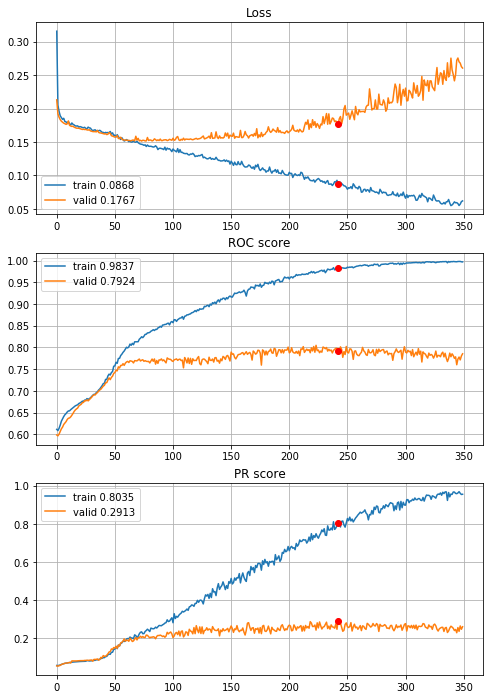


Fold 2------------------------------------------------------------


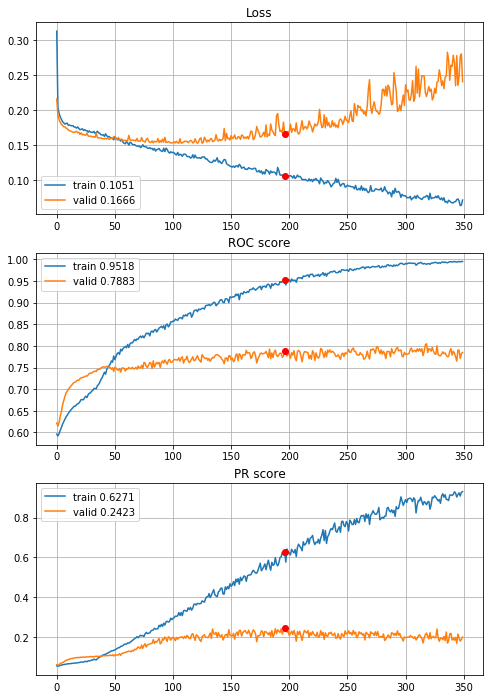


Fold 3------------------------------------------------------------


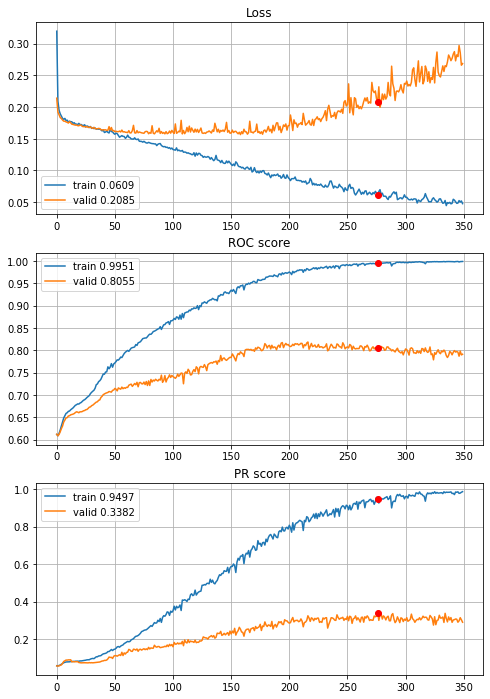


Fold 4------------------------------------------------------------


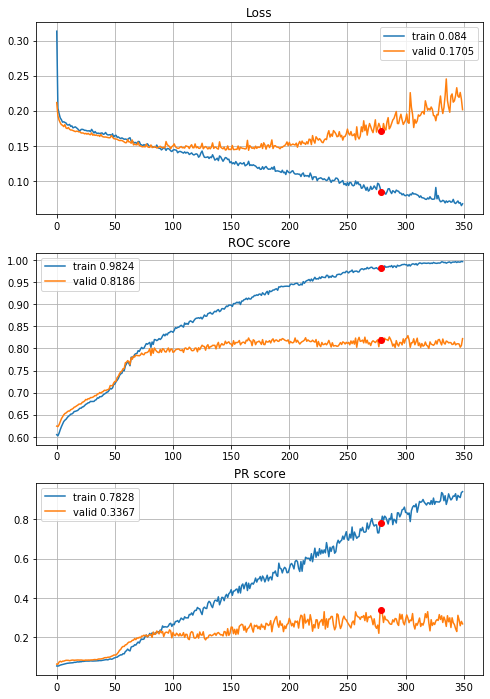


Fold 5------------------------------------------------------------


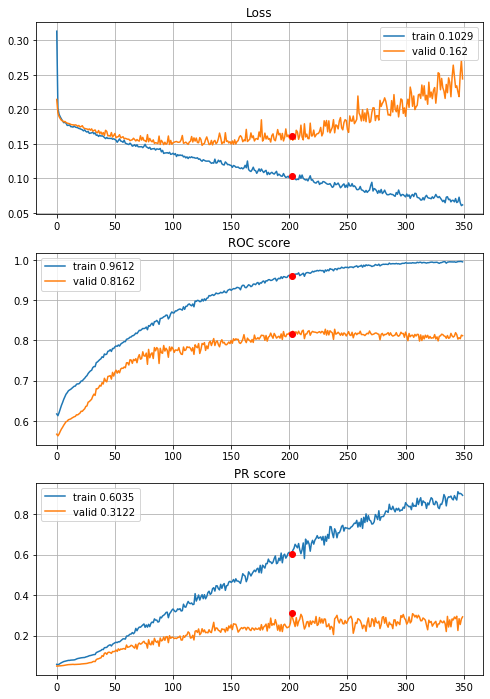


Fold 6------------------------------------------------------------


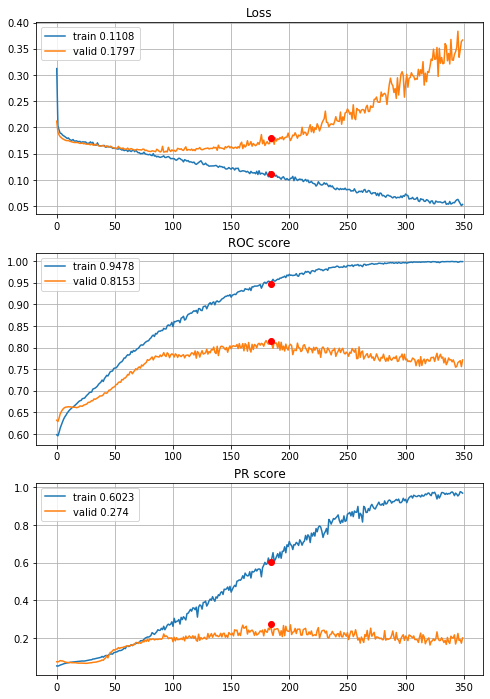

In [56]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_more_drop_02, features=features,
                                        target=target, n_epochs=350, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_more_drop_02_350ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Lets try enlarge dense layers

In [54]:
def define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02_big(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)                                                            # (8,8,1)
    inception = inception_module(prev_layer=inputs, f1=4, f2_in=1, f2_out=4, f3_in=1, f3_out=4, f4_out=4,
                                 random_state=random_state)                                             # (8,8,16)
    inception = inception_module(prev_layer=inception, f1=8, f2_in=4, f2_out=8, f3_in=4, f3_out=8,
                                 f4_out=8, random_state=random_state)                                   # (8,8,32)
    pool = layers.AveragePooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(inception)          # (4,4,32)
    flat = layers.Flatten()(pool)                                                                       # (512,)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.relu,
                         kernel_regularizer=regularizers.l2(l=0.0001))(flat)                            # (512,)
    dense = layers.Dropout(rate=0.4)(dense)                                                             # (512,)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.relu, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)                          # (256,)
    dense = layers.Dropout(rate=0.2)(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)               # (1,)
    

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.Adam())
    
    return model


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/350,
cumulative time: 9.07s train loss: 0.322238014412045, validation loss: 0.21259960004886513
Epoch: 2/350,
cumulative time: 11.42s train loss: 0.208798314187017, validation loss: 0.19883314538673835
Epoch: 3/350,
cumulative time: 13.79s train loss: 0.1984215799408044, validation loss: 0.19109468400322124
Epoch: 4/350,
cumulative time: 16.07s train loss: 0.19174624990238745, validation loss: 0.1872322506431202
Epoch: 5/350,
cumulative time: 18.41s train loss: 0.18784904982740844, validation loss: 0.18461166896404477
Epoch: 6/350,
cumulative time: 20.68s train loss: 0.18703508290156637, validation loss: 0.1846019705149637
Epoch: 7/350,
cumulative time: 22.97s train loss: 0.1841625832436297, validation loss: 0.1820573441947897
Epoch: 8/350,
cumulative time: 25.27s train loss: 0.1840893208847741, validation loss: 0.18130994229766675
Epoch: 9/350,
cumulative time: 27.59s train loss: 0.183327762122188,

Epoch: 76/350,
cumulative time: 182.6s train loss: 0.14014222626527337, validation loss: 0.1481756162616091
Epoch: 77/350,
cumulative time: 184.82s train loss: 0.14108534954192364, validation loss: 0.1474123969381165
Epoch: 78/350,
cumulative time: 187.06s train loss: 0.13891502071808262, validation loss: 0.14802726394305224
Epoch: 79/350,
cumulative time: 189.42s train loss: 0.13951974162612896, validation loss: 0.15143224936794017
Epoch: 80/350,
cumulative time: 191.74s train loss: 0.13891672401319466, validation loss: 0.1484139591240633
Epoch: 81/350,
cumulative time: 194.34s train loss: 0.13824341740219445, validation loss: 0.14804256054161416
Epoch: 82/350,
cumulative time: 196.54s train loss: 0.1388051743902484, validation loss: 0.14980771674788013
Epoch: 83/350,
cumulative time: 198.8s train loss: 0.13811671683853616, validation loss: 0.14942272026018577
Epoch: 84/350,
cumulative time: 201.0s train loss: 0.137726277546577, validation loss: 0.14792118554502764
Epoch: 85/350,
cumu

Epoch: 151/350,
cumulative time: 358.03s train loss: 0.10656244216150124, validation loss: 0.15807562720806853
Epoch: 152/350,
cumulative time: 360.34s train loss: 0.10513278426325857, validation loss: 0.16502652435440224
Epoch: 153/350,
cumulative time: 362.61s train loss: 0.1043138905758079, validation loss: 0.1693075877537421
Epoch: 154/350,
cumulative time: 364.84s train loss: 0.11104356610227309, validation loss: 0.15977068944574183
Epoch: 155/350,
cumulative time: 367.15s train loss: 0.10701763870941419, validation loss: 0.15913783636818082
Epoch: 156/350,
cumulative time: 369.58s train loss: 0.10615746194475022, validation loss: 0.16114394909666843
Epoch: 157/350,
cumulative time: 372.0s train loss: 0.10379672358988122, validation loss: 0.16303502595440275
Epoch: 158/350,
cumulative time: 374.54s train loss: 0.10314241955040916, validation loss: 0.16165255658514066
Epoch: 159/350,
cumulative time: 376.87s train loss: 0.09923978634583933, validation loss: 0.17587474396703753
Epoc

Epoch: 226/350,
cumulative time: 533.45s train loss: 0.07973724253146547, validation loss: 0.20435027823066962
Epoch: 227/350,
cumulative time: 536.03s train loss: 0.0757927381587241, validation loss: 0.1977675133342043
Epoch: 228/350,
cumulative time: 538.55s train loss: 0.07542058803323744, validation loss: 0.20839192422392483
Epoch: 229/350,
cumulative time: 540.78s train loss: 0.07849035360703291, validation loss: 0.2038011980556723
Epoch: 230/350,
cumulative time: 543.05s train loss: 0.07411817589676822, validation loss: 0.2064668631491155
Epoch: 231/350,
cumulative time: 545.31s train loss: 0.07237198036019996, validation loss: 0.20924189106743113
Epoch: 232/350,
cumulative time: 547.57s train loss: 0.07402471826994211, validation loss: 0.21317950154741344
Epoch: 233/350,
cumulative time: 549.94s train loss: 0.07337092352243156, validation loss: 0.22473237775803237
Epoch: 234/350,
cumulative time: 552.34s train loss: 0.07536210106442337, validation loss: 0.20363172136862343
Epoch

Epoch: 301/350,
cumulative time: 705.95s train loss: 0.05907858555130822, validation loss: 0.28161601204703396
Epoch: 302/350,
cumulative time: 708.15s train loss: 0.05713830984760696, validation loss: 0.25990096246274397
Epoch: 303/350,
cumulative time: 710.31s train loss: 0.051551802665667106, validation loss: 0.2692873139876682
Epoch: 304/350,
cumulative time: 712.48s train loss: 0.04735568914255319, validation loss: 0.2795043309581702
Epoch: 305/350,
cumulative time: 714.64s train loss: 0.05191325830110858, validation loss: 0.2832855440061027
Epoch: 306/350,
cumulative time: 716.8s train loss: 0.051378436446646934, validation loss: 0.2733762838034299
Epoch: 307/350,
cumulative time: 718.97s train loss: 0.047729483439977335, validation loss: 0.2736412459986863
Epoch: 308/350,
cumulative time: 721.14s train loss: 0.051896340530260716, validation loss: 0.28276167280708353
Epoch: 309/350,
cumulative time: 723.32s train loss: 0.049833256162401265, validation loss: 0.27040890034966825
Ep

Epoch: 24/350,
cumulative time: 61.07s train loss: 0.17116747187324302, validation loss: 0.1656688039299701
Epoch: 25/350,
cumulative time: 63.3s train loss: 0.17314750688786057, validation loss: 0.16621509092819645
Epoch: 26/350,
cumulative time: 65.54s train loss: 0.1700643888618643, validation loss: 0.16399371875926053
Epoch: 27/350,
cumulative time: 67.83s train loss: 0.170214372969405, validation loss: 0.16604802832690949
Epoch: 28/350,
cumulative time: 70.05s train loss: 0.169411527270031, validation loss: 0.16317641319094292
Epoch: 29/350,
cumulative time: 72.3s train loss: 0.16926374114529305, validation loss: 0.16369706062236275
Epoch: 30/350,
cumulative time: 74.52s train loss: 0.1688540058076452, validation loss: 0.16260835995133552
Epoch: 31/350,
cumulative time: 76.74s train loss: 0.16840231660809643, validation loss: 0.16259868034841504
Epoch: 32/350,
cumulative time: 79.01s train loss: 0.16796940904775257, validation loss: 0.16167331273090169
Epoch: 33/350,
cumulative ti

Epoch: 100/350,
cumulative time: 236.01s train loss: 0.13712234074548463, validation loss: 0.15436601332177655
Epoch: 101/350,
cumulative time: 238.25s train loss: 0.14116983889345885, validation loss: 0.15283479538610692
Epoch: 102/350,
cumulative time: 240.62s train loss: 0.13536784511856928, validation loss: 0.1546851570375
Epoch: 103/350,
cumulative time: 242.9s train loss: 0.135250363780679, validation loss: 0.1530129322062001
Epoch: 104/350,
cumulative time: 245.11s train loss: 0.13459382790899757, validation loss: 0.16028111675073092
Epoch: 105/350,
cumulative time: 247.38s train loss: 0.13996696373530054, validation loss: 0.15183599361585914
Epoch: 106/350,
cumulative time: 249.65s train loss: 0.13364034293734367, validation loss: 0.15145171448334485
Epoch: 107/350,
cumulative time: 251.9s train loss: 0.13606373959880527, validation loss: 0.1531148659331458
Epoch: 108/350,
cumulative time: 254.16s train loss: 0.13298577463029956, validation loss: 0.1520361786862032
Epoch: 109/3

Epoch: 175/350,
cumulative time: 406.93s train loss: 0.10719592108011933, validation loss: 0.16492428760462946
Epoch: 176/350,
cumulative time: 409.14s train loss: 0.10620029497613818, validation loss: 0.16777836710097438
Epoch: 177/350,
cumulative time: 411.41s train loss: 0.1084948038338818, validation loss: 0.1643680068487265
Epoch: 178/350,
cumulative time: 413.61s train loss: 0.1055030408577215, validation loss: 0.17121064924631332
Epoch: 179/350,
cumulative time: 415.82s train loss: 0.10848641619896854, validation loss: 0.1647491923595631
Epoch: 180/350,
cumulative time: 418.08s train loss: 0.10723526700930727, validation loss: 0.16392956519814336
Epoch: 181/350,
cumulative time: 420.31s train loss: 0.10619050847640636, validation loss: 0.18833293178915822
Epoch: 182/350,
cumulative time: 422.53s train loss: 0.10771247128903405, validation loss: 0.16151436491531282
Epoch: 183/350,
cumulative time: 424.79s train loss: 0.1040470669614189, validation loss: 0.17374164397250935
Epoch:

Epoch: 250/350,
cumulative time: 576.84s train loss: 0.07827755811662439, validation loss: 0.2043022618654671
Epoch: 251/350,
cumulative time: 579.06s train loss: 0.0775048647714108, validation loss: 0.19999430052262301
Epoch: 252/350,
cumulative time: 581.33s train loss: 0.08071130123988003, validation loss: 0.20016781456504862
Epoch: 253/350,
cumulative time: 583.6s train loss: 0.07707845500850681, validation loss: 0.2037692979505459
Epoch: 254/350,
cumulative time: 585.81s train loss: 0.07743693413651151, validation loss: 0.20590614255024597
Epoch: 255/350,
cumulative time: 588.06s train loss: 0.07675240146940354, validation loss: 0.20380082203082614
Epoch: 256/350,
cumulative time: 590.3s train loss: 0.07867407410954066, validation loss: 0.2029052915180964
Epoch: 257/350,
cumulative time: 592.59s train loss: 0.0738867844051725, validation loss: 0.21133772548419932
Epoch: 258/350,
cumulative time: 594.86s train loss: 0.07955312551626575, validation loss: 0.205796049959069
Epoch: 259

Epoch: 325/350,
cumulative time: 749.58s train loss: 0.05893395818464252, validation loss: 0.257640318781489
Epoch: 326/350,
cumulative time: 751.79s train loss: 0.05504828881629095, validation loss: 0.25747156168577084
Epoch: 327/350,
cumulative time: 754.06s train loss: 0.058846835760422406, validation loss: 0.2648171520014422
Epoch: 328/350,
cumulative time: 756.45s train loss: 0.05407375735491377, validation loss: 0.28340020984762776
Epoch: 329/350,
cumulative time: 758.69s train loss: 0.05768709462626778, validation loss: 0.26999983779334147
Epoch: 330/350,
cumulative time: 760.87s train loss: 0.05385398087703958, validation loss: 0.2628545505269327
Epoch: 331/350,
cumulative time: 763.06s train loss: 0.055360679211834025, validation loss: 0.25510003280045945
Epoch: 332/350,
cumulative time: 765.27s train loss: 0.05813084336295324, validation loss: 0.25474817343886214
Epoch: 333/350,
cumulative time: 767.49s train loss: 0.05568897657839589, validation loss: 0.26450385110328267
Epo

Epoch: 48/350,
cumulative time: 116.34s train loss: 0.15921171635940137, validation loss: 0.16646352277514506
Epoch: 49/350,
cumulative time: 118.56s train loss: 0.1552347827999163, validation loss: 0.16047553083374802
Epoch: 50/350,
cumulative time: 120.78s train loss: 0.15466254811476624, validation loss: 0.16426242532533245
Epoch: 51/350,
cumulative time: 123.01s train loss: 0.15380896099164704, validation loss: 0.16031101090176858
Epoch: 52/350,
cumulative time: 125.26s train loss: 0.1548624068815034, validation loss: 0.16105180623334484
Epoch: 53/350,
cumulative time: 127.47s train loss: 0.1539953754869822, validation loss: 0.16052885929691368
Epoch: 54/350,
cumulative time: 129.73s train loss: 0.15228639671383437, validation loss: 0.16054520485519894
Epoch: 55/350,
cumulative time: 131.97s train loss: 0.15094887526472206, validation loss: 0.16020746542773115
Epoch: 56/350,
cumulative time: 134.24s train loss: 0.15006644523015636, validation loss: 0.15965845429022377
Epoch: 57/350

Epoch: 123/350,
cumulative time: 286.56s train loss: 0.12558362315883642, validation loss: 0.15334271906165903
Epoch: 124/350,
cumulative time: 288.88s train loss: 0.12244363550547457, validation loss: 0.15487632501094087
Epoch: 125/350,
cumulative time: 291.17s train loss: 0.11884841351904271, validation loss: 0.1583752609096067
Epoch: 126/350,
cumulative time: 293.39s train loss: 0.1192667927939202, validation loss: 0.15830819257004078
Epoch: 127/350,
cumulative time: 295.73s train loss: 0.1182229974431516, validation loss: 0.15485550777627788
Epoch: 128/350,
cumulative time: 298.05s train loss: 0.12007213403933607, validation loss: 0.15721612496894746
Epoch: 129/350,
cumulative time: 300.41s train loss: 0.1154132680341197, validation loss: 0.15670430642671074
Epoch: 130/350,
cumulative time: 302.82s train loss: 0.11805563591257556, validation loss: 0.1569957850625443
Epoch: 131/350,
cumulative time: 305.15s train loss: 0.12081368423403599, validation loss: 0.15404770601428508
Epoch:

Epoch: 198/350,
cumulative time: 467.43s train loss: 0.08672287328656324, validation loss: 0.1752638011038069
Epoch: 199/350,
cumulative time: 469.75s train loss: 0.08428178845162175, validation loss: 0.17095959338885616
Epoch: 200/350,
cumulative time: 472.29s train loss: 0.0831578003577346, validation loss: 0.19804049331113832
Epoch: 201/350,
cumulative time: 474.57s train loss: 0.08712302324132473, validation loss: 0.17899221203352178
Epoch: 202/350,
cumulative time: 476.89s train loss: 0.08197363348049548, validation loss: 0.17949052647166297
Epoch: 203/350,
cumulative time: 479.24s train loss: 0.08357273893124904, validation loss: 0.17169458175939784
Epoch: 204/350,
cumulative time: 481.72s train loss: 0.0806411526494655, validation loss: 0.17067502878440316
Epoch: 205/350,
cumulative time: 484.07s train loss: 0.0849997667286402, validation loss: 0.1704623021702935
Epoch: 206/350,
cumulative time: 486.34s train loss: 0.08454927361340428, validation loss: 0.17306001353545084
Epoch:

Epoch: 273/350,
cumulative time: 640.28s train loss: 0.05643450607457656, validation loss: 0.20906795039870635
Epoch: 274/350,
cumulative time: 642.55s train loss: 0.05179786391684199, validation loss: 0.23037157290728658
Epoch: 275/350,
cumulative time: 644.84s train loss: 0.055806230525621066, validation loss: 0.2210678882398893
Epoch: 276/350,
cumulative time: 647.12s train loss: 0.054279907480192804, validation loss: 0.21907523500966214
Epoch: 277/350,
cumulative time: 649.37s train loss: 0.06197081787028527, validation loss: 0.2181875210445799
Epoch: 278/350,
cumulative time: 651.66s train loss: 0.06303159964633091, validation loss: 0.24956227065616948
Epoch: 279/350,
cumulative time: 653.97s train loss: 0.06167239978126249, validation loss: 0.23570523900254525
Epoch: 280/350,
cumulative time: 656.35s train loss: 0.059231989204332765, validation loss: 0.21352238652356173
Epoch: 281/350,
cumulative time: 658.61s train loss: 0.053181254418598806, validation loss: 0.2279772500105954


Epoch: 347/350,
cumulative time: 809.45s train loss: 0.05295110172250899, validation loss: 0.25426155781839654
Epoch: 348/350,
cumulative time: 811.7s train loss: 0.046153828008023486, validation loss: 0.2809664189307749
Epoch: 349/350,
cumulative time: 813.97s train loss: 0.04278625538412749, validation loss: 0.2756974818783069
Epoch: 350/350,
cumulative time: 816.22s train loss: 0.04982654768902785, validation loss: 0.2632871471140363

Early stopping results:
best results in epoch: 306, 
best valid PR: 0.3434856202915148, 
valid ROC: 0.8217030468394725        
overfitting PR: 0.6471490252972929, 
overfitting ROC: 0.1778255382335251

----------
Fold: 4
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/350,
cumulative time: 10.06s train loss: 0.3081913050969723, validation loss: 0.21257940967851666
Epoch: 2/350,
cumulative time: 12.58s train loss: 0.21004695690526673, validation loss: 0.19665199283847334
Epoch: 3/350,
cumulative time: 14.98s train loss: 0.197586733945

Epoch: 70/350,
cumulative time: 174.85s train loss: 0.1486654408253619, validation loss: 0.14983529143455301
Epoch: 71/350,
cumulative time: 177.3s train loss: 0.149023214718167, validation loss: 0.15048020646503368
Epoch: 72/350,
cumulative time: 179.82s train loss: 0.15050980128589098, validation loss: 0.15076776309766432
Epoch: 73/350,
cumulative time: 182.65s train loss: 0.14819928465797072, validation loss: 0.14897018688612496
Epoch: 74/350,
cumulative time: 185.23s train loss: 0.14687447062575, validation loss: 0.14794049231362374
Epoch: 75/350,
cumulative time: 187.92s train loss: 0.14789102826233788, validation loss: 0.1476902457083506
Epoch: 76/350,
cumulative time: 190.38s train loss: 0.14607950662594665, validation loss: 0.14802249406768328
Epoch: 77/350,
cumulative time: 192.78s train loss: 0.14453506969947744, validation loss: 0.14749688982260492
Epoch: 78/350,
cumulative time: 195.43s train loss: 0.14650641674236164, validation loss: 0.15174893753634836
Epoch: 79/350,
cum

Epoch: 145/350,
cumulative time: 363.67s train loss: 0.11746369340165382, validation loss: 0.14551483733313425
Epoch: 146/350,
cumulative time: 366.04s train loss: 0.11375729991143833, validation loss: 0.1503744913194314
Epoch: 147/350,
cumulative time: 368.43s train loss: 0.11654201615980216, validation loss: 0.1464551443900537
Epoch: 148/350,
cumulative time: 370.82s train loss: 0.1208618354584071, validation loss: 0.17057300233044131
Epoch: 149/350,
cumulative time: 373.18s train loss: 0.1192878952416153, validation loss: 0.14398909769317583
Epoch: 150/350,
cumulative time: 375.58s train loss: 0.11208556819819954, validation loss: 0.14565154152335222
Epoch: 151/350,
cumulative time: 377.97s train loss: 0.11177364641477996, validation loss: 0.1440341099999054
Epoch: 152/350,
cumulative time: 380.38s train loss: 0.1108264246205231, validation loss: 0.14651404614139196
Epoch: 153/350,
cumulative time: 382.78s train loss: 0.11367974499955154, validation loss: 0.14762820940108318
Epoch: 

Epoch: 220/350,
cumulative time: 543.52s train loss: 0.07999857484431017, validation loss: 0.1603836235376673
Epoch: 221/350,
cumulative time: 546.38s train loss: 0.08062764376241736, validation loss: 0.19337036715500633
Epoch: 222/350,
cumulative time: 548.89s train loss: 0.0878760898855672, validation loss: 0.17175453217751388
Epoch: 223/350,
cumulative time: 551.37s train loss: 0.0801619391501153, validation loss: 0.16567043389827207
Epoch: 224/350,
cumulative time: 553.76s train loss: 0.0841859992730741, validation loss: 0.16765141899198255
Epoch: 225/350,
cumulative time: 556.15s train loss: 0.08073396635236801, validation loss: 0.1644361428477036
Epoch: 226/350,
cumulative time: 558.56s train loss: 0.0791461208315442, validation loss: 0.17728812682050551
Epoch: 227/350,
cumulative time: 561.15s train loss: 0.07953319818402574, validation loss: 0.17934695470145615
Epoch: 228/350,
cumulative time: 563.64s train loss: 0.0810355752069776, validation loss: 0.16695401998209922
Epoch: 2

Epoch: 295/350,
cumulative time: 722.17s train loss: 0.05949380780111323, validation loss: 0.1988352990830085
Epoch: 296/350,
cumulative time: 724.69s train loss: 0.05683935260716843, validation loss: 0.20833106458108985
Epoch: 297/350,
cumulative time: 727.23s train loss: 0.059861613156512984, validation loss: 0.20453889718765045
Epoch: 298/350,
cumulative time: 729.66s train loss: 0.057326886103168544, validation loss: 0.20740606072377096
Epoch: 299/350,
cumulative time: 732.09s train loss: 0.061044730095668645, validation loss: 0.2032039601204436
Epoch: 300/350,
cumulative time: 734.57s train loss: 0.05636065746421332, validation loss: 0.20646082099190233
Epoch: 301/350,
cumulative time: 736.94s train loss: 0.0612673995888691, validation loss: 0.20079102301738208
Epoch: 302/350,
cumulative time: 739.35s train loss: 0.05826439840314054, validation loss: 0.20809624573584465
Epoch: 303/350,
cumulative time: 741.77s train loss: 0.05576031741991723, validation loss: 0.20931400741459033
E

Epoch: 17/350,
cumulative time: 51.86s train loss: 0.1740542388763945, validation loss: 0.17900760389796092
Epoch: 18/350,
cumulative time: 54.38s train loss: 0.17310506444307686, validation loss: 0.1783542837142007
Epoch: 19/350,
cumulative time: 56.9s train loss: 0.1724921499316354, validation loss: 0.17625629808143425
Epoch: 20/350,
cumulative time: 59.42s train loss: 0.17047404878838596, validation loss: 0.1775476506387578
Epoch: 21/350,
cumulative time: 61.89s train loss: 0.1699390902281245, validation loss: 0.1748620069355046
Epoch: 22/350,
cumulative time: 64.33s train loss: 0.16996117183680554, validation loss: 0.1732829677753961
Epoch: 23/350,
cumulative time: 66.8s train loss: 0.1689004108215991, validation loss: 0.18140773477123107
Epoch: 24/350,
cumulative time: 69.27s train loss: 0.16737463242347625, validation loss: 0.17198667965272776
Epoch: 25/350,
cumulative time: 71.77s train loss: 0.16640669017198093, validation loss: 0.17169745729291425
Epoch: 26/350,
cumulative tim

Epoch: 93/350,
cumulative time: 239.33s train loss: 0.13061550972126995, validation loss: 0.1489347397187434
Epoch: 94/350,
cumulative time: 241.78s train loss: 0.13274395399441147, validation loss: 0.15156455990293236
Epoch: 95/350,
cumulative time: 244.21s train loss: 0.13166737216400873, validation loss: 0.1487988372813046
Epoch: 96/350,
cumulative time: 246.68s train loss: 0.13180838458885574, validation loss: 0.14994757109825765
Epoch: 97/350,
cumulative time: 249.12s train loss: 0.13077453598389854, validation loss: 0.1680475230259164
Epoch: 98/350,
cumulative time: 251.55s train loss: 0.13151491375859528, validation loss: 0.1483338028973708
Epoch: 99/350,
cumulative time: 254.05s train loss: 0.1296439986348324, validation loss: 0.1506685395072047
Epoch: 100/350,
cumulative time: 256.53s train loss: 0.12959897607420387, validation loss: 0.14744469019563608
Epoch: 101/350,
cumulative time: 258.99s train loss: 0.12902087378680027, validation loss: 0.14845211389883473
Epoch: 102/350

Epoch: 168/350,
cumulative time: 430.35s train loss: 0.09801905330132338, validation loss: 0.17695391951507228
Epoch: 169/350,
cumulative time: 432.84s train loss: 0.10202078012436304, validation loss: 0.1618994647639451
Epoch: 170/350,
cumulative time: 435.3s train loss: 0.10295955886873166, validation loss: 0.16703775503610407
Epoch: 171/350,
cumulative time: 437.8s train loss: 0.09909712629965771, validation loss: 0.16036541904487586
Epoch: 172/350,
cumulative time: 440.8s train loss: 0.09408212277141244, validation loss: 0.16010844781701875
Epoch: 173/350,
cumulative time: 443.24s train loss: 0.09481632724738337, validation loss: 0.15806243905546155
Epoch: 174/350,
cumulative time: 445.99s train loss: 0.09697732930376234, validation loss: 0.15254560437146208
Epoch: 175/350,
cumulative time: 448.72s train loss: 0.09834418425316704, validation loss: 0.16136039715372563
Epoch: 176/350,
cumulative time: 451.37s train loss: 0.09527657006503808, validation loss: 0.1618983721944014
Epoch:

Epoch: 243/350,
cumulative time: 619.22s train loss: 0.07070222721314395, validation loss: 0.19638643264379912
Epoch: 244/350,
cumulative time: 621.73s train loss: 0.07165299801905231, validation loss: 0.18433880425140087
Epoch: 245/350,
cumulative time: 624.18s train loss: 0.06700394523809428, validation loss: 0.19251235251267335
Epoch: 246/350,
cumulative time: 626.63s train loss: 0.07124600505466339, validation loss: 0.19106830853778445
Epoch: 247/350,
cumulative time: 629.11s train loss: 0.0809660345884322, validation loss: 0.1916379760438149
Epoch: 248/350,
cumulative time: 631.54s train loss: 0.07161123918823294, validation loss: 0.19149646176657545
Epoch: 249/350,
cumulative time: 633.99s train loss: 0.06740494617485003, validation loss: 0.18728214560923695
Epoch: 250/350,
cumulative time: 636.45s train loss: 0.06538632717571966, validation loss: 0.19468701249025128
Epoch: 251/350,
cumulative time: 638.88s train loss: 0.06512058853735882, validation loss: 0.18948831267625602
Epo

Epoch: 317/350,
cumulative time: 802.67s train loss: 0.04645249840892194, validation loss: 0.25565423913114504
Epoch: 318/350,
cumulative time: 805.21s train loss: 0.045077377299147396, validation loss: 0.25167387194667856
Epoch: 319/350,
cumulative time: 807.73s train loss: 0.051362825726787735, validation loss: 0.25444318941973765
Epoch: 320/350,
cumulative time: 810.21s train loss: 0.050499054045754686, validation loss: 0.24502462875171227
Epoch: 321/350,
cumulative time: 812.65s train loss: 0.05313041940261143, validation loss: 0.24634185316209556
Epoch: 322/350,
cumulative time: 815.12s train loss: 0.045604282605068325, validation loss: 0.24023967514578667
Epoch: 323/350,
cumulative time: 817.68s train loss: 0.04686793869343946, validation loss: 0.25747256701614407
Epoch: 324/350,
cumulative time: 820.17s train loss: 0.04580409797063535, validation loss: 0.25328456203246963
Epoch: 325/350,
cumulative time: 822.66s train loss: 0.04755534858648298, validation loss: 0.253326076120724

Epoch: 40/350,
cumulative time: 142.03s train loss: 0.1640374498805556, validation loss: 0.16754407147892186
Epoch: 41/350,
cumulative time: 145.44s train loss: 0.16318383791031094, validation loss: 0.16777591730727523
Epoch: 42/350,
cumulative time: 148.76s train loss: 0.16090028119391883, validation loss: 0.16445378007458858
Epoch: 43/350,
cumulative time: 152.13s train loss: 0.15901370301627862, validation loss: 0.16393099101840472
Epoch: 44/350,
cumulative time: 155.52s train loss: 0.1585317009730389, validation loss: 0.16907012606253388
Epoch: 45/350,
cumulative time: 158.82s train loss: 0.16220121252622705, validation loss: 0.16404308764660944
Epoch: 46/350,
cumulative time: 162.2s train loss: 0.16129101581217264, validation loss: 0.1632116304655544
Epoch: 47/350,
cumulative time: 165.56s train loss: 0.15834850385140622, validation loss: 0.16365465731894382
Epoch: 48/350,
cumulative time: 169.01s train loss: 0.15856260354014243, validation loss: 0.16234143306974505
Epoch: 49/350,

Epoch: 115/350,
cumulative time: 394.94s train loss: 0.12164303515677684, validation loss: 0.15772622817852458
Epoch: 116/350,
cumulative time: 398.24s train loss: 0.12306026721649058, validation loss: 0.16221144461240924
Epoch: 117/350,
cumulative time: 401.73s train loss: 0.12250534259515228, validation loss: 0.15526405959832865
Epoch: 118/350,
cumulative time: 405.14s train loss: 0.12399651471471725, validation loss: 0.15458505431159597
Epoch: 119/350,
cumulative time: 408.56s train loss: 0.12518058131555118, validation loss: 0.15641780666640548
Epoch: 120/350,
cumulative time: 411.92s train loss: 0.11992302466657496, validation loss: 0.15358766720920314
Epoch: 121/350,
cumulative time: 415.32s train loss: 0.11894867821336574, validation loss: 0.15937425395504373
Epoch: 122/350,
cumulative time: 418.71s train loss: 0.11813201496321439, validation loss: 0.15520888607032962
Epoch: 123/350,
cumulative time: 422.04s train loss: 0.1178581769332817, validation loss: 0.1564441790639377
Epo

Epoch: 190/350,
cumulative time: 647.19s train loss: 0.08497253632170501, validation loss: 0.18453349573690384
Epoch: 191/350,
cumulative time: 650.63s train loss: 0.09041796407490227, validation loss: 0.1967521597225158
Epoch: 192/350,
cumulative time: 654.05s train loss: 0.09625114250249507, validation loss: 0.1801761719047046
Epoch: 193/350,
cumulative time: 657.51s train loss: 0.08342448233054318, validation loss: 0.18463464284529452
Epoch: 194/350,
cumulative time: 661.0s train loss: 0.08336688821664175, validation loss: 0.17809167727095182
Epoch: 195/350,
cumulative time: 664.37s train loss: 0.08392398447423274, validation loss: 0.18630743942299827
Epoch: 196/350,
cumulative time: 667.73s train loss: 0.09701465755349531, validation loss: 0.17855494452304527
Epoch: 197/350,
cumulative time: 671.06s train loss: 0.08439122030845944, validation loss: 0.17945303917908279
Epoch: 198/350,
cumulative time: 674.4s train loss: 0.08239039055524616, validation loss: 0.19243388018647178
Epoch

Epoch: 265/350,
cumulative time: 901.06s train loss: 0.057410287763313105, validation loss: 0.2422229570443513
Epoch: 266/350,
cumulative time: 904.44s train loss: 0.06243025783747239, validation loss: 0.2476065137151812
Epoch: 267/350,
cumulative time: 907.82s train loss: 0.061673483689014125, validation loss: 0.2338593298294505
Epoch: 268/350,
cumulative time: 911.24s train loss: 0.060738502320776135, validation loss: 0.24451088936602483
Epoch: 269/350,
cumulative time: 914.59s train loss: 0.05604271458493616, validation loss: 0.2522339102283853
Epoch: 270/350,
cumulative time: 918.01s train loss: 0.06329373769452344, validation loss: 0.243282140688818
Epoch: 271/350,
cumulative time: 921.44s train loss: 0.05508216589806433, validation loss: 0.24748650148266652
Epoch: 272/350,
cumulative time: 924.86s train loss: 0.05689110092398848, validation loss: 0.2645980716533348
Epoch: 273/350,
cumulative time: 928.26s train loss: 0.06253515514563451, validation loss: 0.26320959886566536
Epoch

Epoch: 339/350,
cumulative time: 1152.84s train loss: 0.04927396870671062, validation loss: 0.31267543562123035
Epoch: 340/350,
cumulative time: 1156.21s train loss: 0.049658698051542945, validation loss: 0.30246645763272145
Epoch: 341/350,
cumulative time: 1159.64s train loss: 0.05880859900719997, validation loss: 0.2982243818533225
Epoch: 342/350,
cumulative time: 1163.07s train loss: 0.058826270166340226, validation loss: 0.2917989749791192
Epoch: 343/350,
cumulative time: 1166.46s train loss: 0.05123281478295945, validation loss: 0.30401028576444405
Epoch: 344/350,
cumulative time: 1169.86s train loss: 0.0511389488649712, validation loss: 0.3006210100064512
Epoch: 345/350,
cumulative time: 1173.25s train loss: 0.04629886087376824, validation loss: 0.2871747594778655
Epoch: 346/350,
cumulative time: 1176.64s train loss: 0.04294715440376792, validation loss: 0.3489051746344957
Epoch: 347/350,
cumulative time: 1179.96s train loss: 0.05265316066782565, validation loss: 0.32903076511914

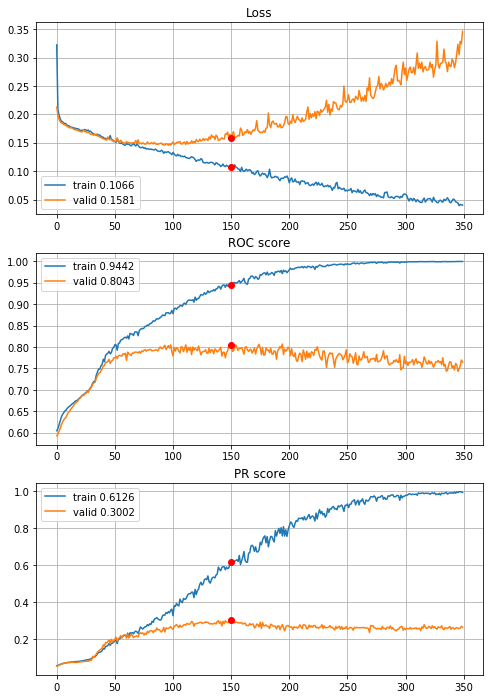


Fold 2------------------------------------------------------------


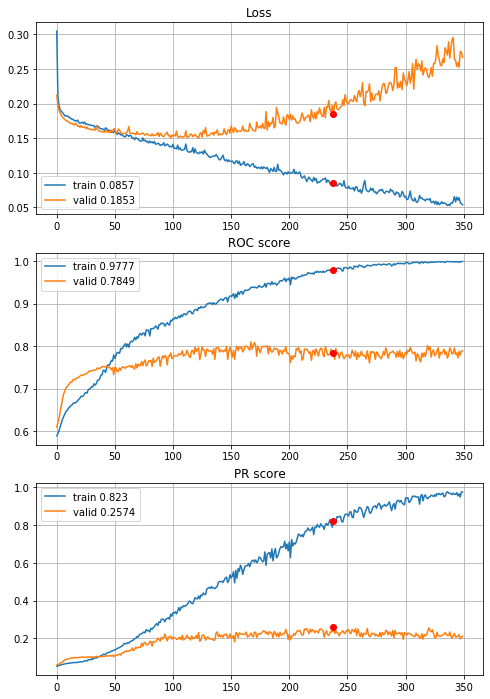


Fold 3------------------------------------------------------------


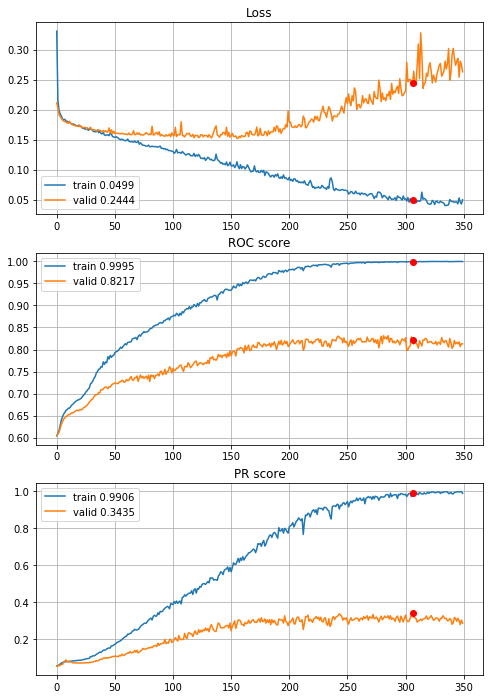


Fold 4------------------------------------------------------------


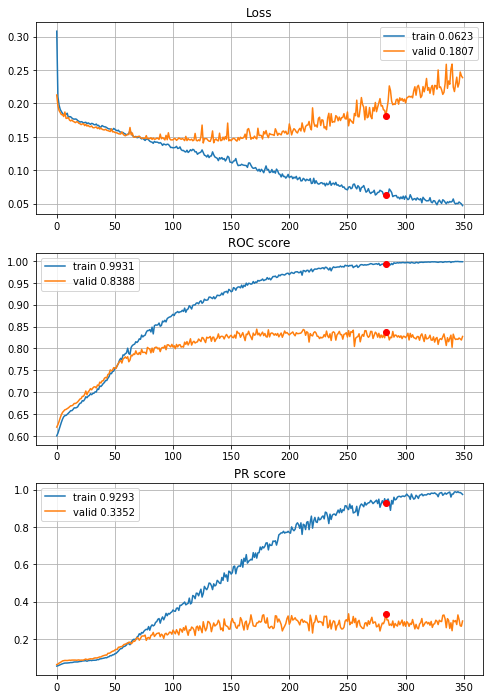


Fold 5------------------------------------------------------------


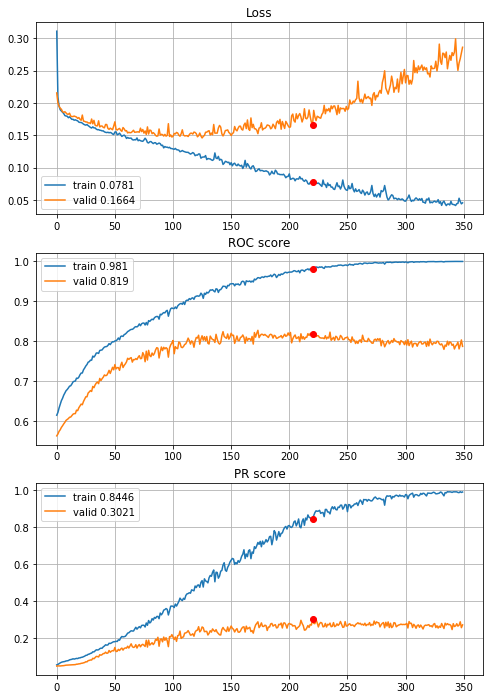


Fold 6------------------------------------------------------------


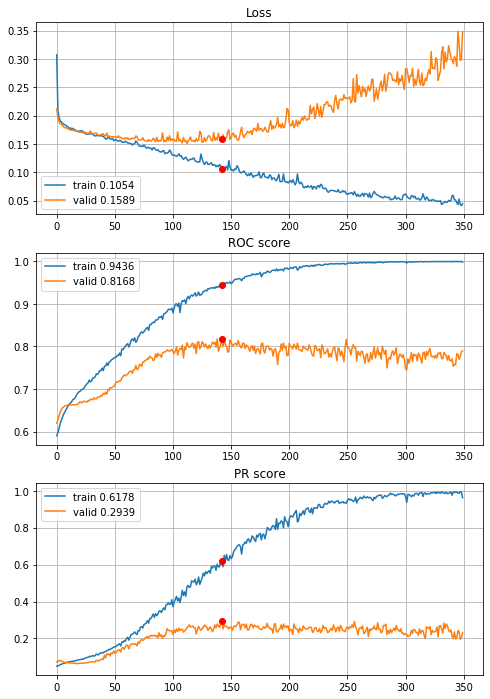

In [60]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02_big, features=features,
                                        target=target, n_epochs=350, batch_size=394, alpha=3,
                                        drafts=drafts_8x8["optimized_drafts"],
                                        instruction=None, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02_big_350ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Worse results, its time to stop experiments with inceptions and come back to the basic conv, pool model.

##### Best 3 years horizon model 

In [55]:
def define_CNN_L2(input_shape, random_state):
    np.random.seed(random_state)
    tf.random.set_seed(random_state)

    inputs = layers.Input(shape=input_shape)#(8,8,1)
    early = layers.Conv2D(filters=32, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(inputs)
    early = layers.Conv2D(filters=64, kernel_size=(3,3), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    early = layers.MaxPooling2D(pool_size=(2,2), strides=(2,2), padding="valid")(early)
    early = layers.Conv2D(filters=32, kernel_size=(1,1), strides=(1,1), padding="same",
                         activation=activations.relu, use_bias=True)(early)
    dense = layers.Flatten()(early)
    dense = layers.Dense(units=512, use_bias=True, activation=activations.sigmoid, 
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    dense = layers.Dense(units=256, use_bias=True, activation=activations.sigmoid,
                         kernel_regularizer=regularizers.l2(l=0.00005))(dense)
    outputs = layers.Dense(units=1, use_bias=True, activation=activations.sigmoid)(dense)

    model = models.Model(inputs = inputs, outputs = outputs)
    model.compile(loss = losses.BinaryCrossentropy(), optimizer = optimizers.RMSprop())
    
    return model


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/300,
cumulative time: 4.28s train loss: 0.21388595551935993, validation loss: 0.19705639724884558
Epoch: 2/300,
cumulative time: 7.35s train loss: 0.19754702598344828, validation loss: 0.22998193412198933
Epoch: 3/300,
cumulative time: 10.43s train loss: 0.19181670936434653, validation loss: 0.20728872890241182
Epoch: 4/300,
cumulative time: 13.51s train loss: 0.18588018026322553, validation loss: 0.23638284936801165
Epoch: 5/300,
cumulative time: 16.61s train loss: 0.1870171992423916, validation loss: 0.18420162568476692
Epoch: 6/300,
cumulative time: 19.73s train loss: 0.18218474856349898, validation loss: 0.19285019384611637
Epoch: 7/300,
cumulative time: 22.83s train loss: 0.18132212042402263, validation loss: 0.17482483324498369
Epoch: 8/300,
cumulative time: 25.91s train loss: 0.1790258220499114, validation loss: 0.18044757813723028
Epoch: 9/300,
cumulative time: 28.99s train loss: 0.178184615

Epoch: 76/300,
cumulative time: 234.7s train loss: 0.10407091261835363, validation loss: 0.15927814537974203
Epoch: 77/300,
cumulative time: 237.59s train loss: 0.10012300412328923, validation loss: 0.22882647552621474
Epoch: 78/300,
cumulative time: 240.52s train loss: 0.101431045465895, validation loss: 0.16169833051111565
Epoch: 79/300,
cumulative time: 243.59s train loss: 0.0979630753772961, validation loss: 0.38576996822500914
Epoch: 80/300,
cumulative time: 246.46s train loss: 0.10599306586439854, validation loss: 0.16306134736162964
Epoch: 81/300,
cumulative time: 249.5s train loss: 0.10182135106832363, validation loss: 0.16021994000415501
Epoch: 82/300,
cumulative time: 252.6s train loss: 0.0992341746200989, validation loss: 0.1584690498922943
Epoch: 83/300,
cumulative time: 255.55s train loss: 0.09874170936271988, validation loss: 0.1640487811277922
Epoch: 84/300,
cumulative time: 258.62s train loss: 0.09535418887964348, validation loss: 0.16881688765273337
Epoch: 85/300,
cumu

Epoch: 151/300,
cumulative time: 463.94s train loss: 0.047331416529457666, validation loss: 0.22353402922615936
Epoch: 152/300,
cumulative time: 466.96s train loss: 0.05994068620549944, validation loss: 0.25406245092420715
Epoch: 153/300,
cumulative time: 469.85s train loss: 0.05139474668461321, validation loss: 0.22506321865093662
Epoch: 154/300,
cumulative time: 472.75s train loss: 0.04915881365525924, validation loss: 0.22164791340049877
Epoch: 155/300,
cumulative time: 475.82s train loss: 0.05597678219626328, validation loss: 0.23292955053118233
Epoch: 156/300,
cumulative time: 478.9s train loss: 0.04767214806098772, validation loss: 0.23119718476954168
Epoch: 157/300,
cumulative time: 481.87s train loss: 0.04947665440491665, validation loss: 0.23816440722186163
Epoch: 158/300,
cumulative time: 484.93s train loss: 0.05070780756249624, validation loss: 0.22383319710529023
Epoch: 159/300,
cumulative time: 487.92s train loss: 0.048267788567827735, validation loss: 0.27214172732470704


Epoch: 226/300,
cumulative time: 685.6s train loss: 0.03179597048444639, validation loss: 0.26813307263904285
Epoch: 227/300,
cumulative time: 688.49s train loss: 0.037511073842718914, validation loss: 0.2774408268662924
Epoch: 228/300,
cumulative time: 691.37s train loss: 0.027243036009407414, validation loss: 0.27672351785443555
Epoch: 229/300,
cumulative time: 694.23s train loss: 0.03660516309001207, validation loss: 0.2891361631970574
Epoch: 230/300,
cumulative time: 697.09s train loss: 0.03227125423419466, validation loss: 0.27778252082367866
Epoch: 231/300,
cumulative time: 699.97s train loss: 0.032137153492692354, validation loss: 0.38721687500005
Epoch: 232/300,
cumulative time: 702.87s train loss: 0.0329245583166835, validation loss: 0.27185318284078475
Epoch: 233/300,
cumulative time: 705.91s train loss: 0.034019755523542944, validation loss: 0.28662607745605556
Epoch: 234/300,
cumulative time: 708.93s train loss: 0.03410532441161605, validation loss: 0.26822925664650504
Epoc

Epoch: 300/300,
cumulative time: 900.82s train loss: 0.021541993790740132, validation loss: 0.2812813255804082

Early stopping results:
best results in epoch: 129, 
best valid PR: 0.3404559345673192, 
valid ROC: 0.8130059117780809        
overfitting PR: 0.5571706888053463, 
overfitting ROC: 0.1754695509953761

----------
Fold: 2
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/300,
cumulative time: 4.24s train loss: 0.21531913530578117, validation loss: 0.20025168970559246
Epoch: 2/300,
cumulative time: 7.24s train loss: 0.20109412915538813, validation loss: 0.18782952314591814
Epoch: 3/300,
cumulative time: 10.28s train loss: 0.19012793684508889, validation loss: 0.18247814681551872
Epoch: 4/300,
cumulative time: 13.3s train loss: 0.18794249995091683, validation loss: 0.1875550170791571
Epoch: 5/300,
cumulative time: 16.3s train loss: 0.183886323184232, validation loss: 0.17490091392597085
Epoch: 6/300,
cumulative time: 19.31s train loss: 0.18039712122522966, valid

Epoch: 73/300,
cumulative time: 219.59s train loss: 0.09478373096410811, validation loss: 0.15424360288978403
Epoch: 74/300,
cumulative time: 222.54s train loss: 0.09067856604696055, validation loss: 0.15685663249241102
Epoch: 75/300,
cumulative time: 225.57s train loss: 0.09070241400479552, validation loss: 0.2034558792297056
Epoch: 76/300,
cumulative time: 228.69s train loss: 0.09133974584824199, validation loss: 0.17948727934654232
Epoch: 77/300,
cumulative time: 231.69s train loss: 0.09332142512952848, validation loss: 0.16535068155897398
Epoch: 78/300,
cumulative time: 234.7s train loss: 0.0873851517384081, validation loss: 0.15768402409623836
Epoch: 79/300,
cumulative time: 237.7s train loss: 0.08462787443582251, validation loss: 0.15696109456362917
Epoch: 80/300,
cumulative time: 240.73s train loss: 0.0890745851761205, validation loss: 0.16826215519192647
Epoch: 81/300,
cumulative time: 243.68s train loss: 0.08928848895137971, validation loss: 0.15946814094622513
Epoch: 82/300,


Epoch: 148/300,
cumulative time: 438.48s train loss: 0.05755842643009755, validation loss: 0.17790906375388799
Epoch: 149/300,
cumulative time: 441.42s train loss: 0.05647835469168563, validation loss: 0.19701802492297962
Epoch: 150/300,
cumulative time: 444.3s train loss: 0.05206365150597637, validation loss: 0.1849615643408789
Epoch: 151/300,
cumulative time: 447.17s train loss: 0.06229887696573659, validation loss: 0.1914858797352717
Epoch: 152/300,
cumulative time: 450.04s train loss: 0.04201574862854933, validation loss: 0.22309282373241485
Epoch: 153/300,
cumulative time: 452.89s train loss: 0.055677001331202215, validation loss: 0.24849994943463788
Epoch: 154/300,
cumulative time: 455.74s train loss: 0.061181466767181336, validation loss: 0.21869634355505047
Epoch: 155/300,
cumulative time: 458.59s train loss: 0.051971969314711576, validation loss: 0.188576054448069
Epoch: 156/300,
cumulative time: 461.45s train loss: 0.04978831302287195, validation loss: 0.22038594284735688
Epo

Epoch: 222/300,
cumulative time: 650.63s train loss: 0.028553380574388918, validation loss: 0.31217201651705045
Epoch: 223/300,
cumulative time: 653.51s train loss: 0.03714748846652905, validation loss: 0.24321534259056826
Epoch: 224/300,
cumulative time: 656.35s train loss: 0.038781156896009625, validation loss: 0.24076134700762647
Epoch: 225/300,
cumulative time: 659.19s train loss: 0.036089881376625436, validation loss: 0.2685247209133046
Epoch: 226/300,
cumulative time: 662.05s train loss: 0.04064122402569557, validation loss: 0.2510509029284686
Epoch: 227/300,
cumulative time: 664.87s train loss: 0.0278632121007054, validation loss: 0.2525935812241753
Epoch: 228/300,
cumulative time: 667.76s train loss: 0.04143470452837417, validation loss: 0.2417021736912771
Epoch: 229/300,
cumulative time: 670.67s train loss: 0.041236369355805956, validation loss: 0.2379054626740447
Epoch: 230/300,
cumulative time: 673.57s train loss: 0.03442392582389986, validation loss: 0.36236604997402405
Epo

Epoch: 296/300,
cumulative time: 862.99s train loss: 0.024661282030554253, validation loss: 0.2688451247829285
Epoch: 297/300,
cumulative time: 865.84s train loss: 0.029343128270022927, validation loss: 0.43199792027785927
Epoch: 298/300,
cumulative time: 868.67s train loss: 0.029060579944772603, validation loss: 0.30054243660848073
Epoch: 299/300,
cumulative time: 871.52s train loss: 0.03361258234646572, validation loss: 0.25808462596267734
Epoch: 300/300,
cumulative time: 874.36s train loss: 0.017682003135418015, validation loss: 0.30421461770372027

Early stopping results:
best results in epoch: 114, 
best valid PR: 0.3859342021311907, 
valid ROC: 0.8506309686221009        
overfitting PR: 0.48353286995065203, 
overfitting ROC: 0.13268872028498058

----------
Fold: 3
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/300,
cumulative time: 4.24s train loss: 0.2175255301372457, validation loss: 0.19438908324329132
Epoch: 2/300,
cumulative time: 7.3s train loss: 0.1967

Epoch: 69/300,
cumulative time: 207.11s train loss: 0.10120189535924876, validation loss: 0.1594870933288828
Epoch: 70/300,
cumulative time: 210.06s train loss: 0.10739403346064894, validation loss: 0.16677771690319906
Epoch: 71/300,
cumulative time: 212.89s train loss: 0.09531166439057803, validation loss: 0.17535303404181218
Epoch: 72/300,
cumulative time: 215.76s train loss: 0.0984150933848638, validation loss: 0.1619563414025588
Epoch: 73/300,
cumulative time: 218.65s train loss: 0.10204373850592281, validation loss: 0.1669468014826937
Epoch: 74/300,
cumulative time: 221.51s train loss: 0.0975369148113606, validation loss: 0.19904771351486172
Epoch: 75/300,
cumulative time: 224.36s train loss: 0.09415368348660859, validation loss: 0.19652861175109018
Epoch: 76/300,
cumulative time: 227.21s train loss: 0.09579366406086216, validation loss: 0.14679741637773938
Epoch: 77/300,
cumulative time: 230.05s train loss: 0.09641709574507391, validation loss: 0.15612163401524956
Epoch: 78/300,


Epoch: 144/300,
cumulative time: 423.31s train loss: 0.051024274057982745, validation loss: 0.21035038456223115
Epoch: 145/300,
cumulative time: 426.19s train loss: 0.057357949497848885, validation loss: 0.19412931280398588
Epoch: 146/300,
cumulative time: 429.06s train loss: 0.057267563641442434, validation loss: 0.20563582040926107
Epoch: 147/300,
cumulative time: 431.92s train loss: 0.045439125929232396, validation loss: 0.2700084170538976
Epoch: 148/300,
cumulative time: 434.81s train loss: 0.04867024109380822, validation loss: 0.1965745847042391
Epoch: 149/300,
cumulative time: 437.67s train loss: 0.05303016572708242, validation loss: 0.2499165463885036
Epoch: 150/300,
cumulative time: 440.52s train loss: 0.05214958758906325, validation loss: 0.28100053395778135
Epoch: 151/300,
cumulative time: 443.4s train loss: 0.04574504941516332, validation loss: 0.231604411202052
Epoch: 152/300,
cumulative time: 446.26s train loss: 0.05995051203685501, validation loss: 0.19808130417395076
Epo

Epoch: 218/300,
cumulative time: 634.91s train loss: 0.03155608645334267, validation loss: 0.315273449313125
Epoch: 219/300,
cumulative time: 637.63s train loss: 0.03944935248636109, validation loss: 0.24044937455872878
Epoch: 220/300,
cumulative time: 640.37s train loss: 0.034959141218731796, validation loss: 0.2654696368608687
Epoch: 221/300,
cumulative time: 643.12s train loss: 0.025527207952626085, validation loss: 0.27871039130897074
Epoch: 222/300,
cumulative time: 645.86s train loss: 0.034998647990465745, validation loss: 0.2866322263821393
Epoch: 223/300,
cumulative time: 648.62s train loss: 0.03603100576759682, validation loss: 0.25815566376261756
Epoch: 224/300,
cumulative time: 651.34s train loss: 0.03555065665849658, validation loss: 0.2690880486880811
Epoch: 225/300,
cumulative time: 654.08s train loss: 0.02680365999786776, validation loss: 0.3835354672346953
Epoch: 226/300,
cumulative time: 656.82s train loss: 0.028288226665972662, validation loss: 0.2897365714861556
Epoc

Epoch: 292/300,
cumulative time: 837.43s train loss: 0.019854694886382356, validation loss: 0.3515014158242027
Epoch: 293/300,
cumulative time: 840.16s train loss: 0.02221265835666765, validation loss: 0.2937595197249834
Epoch: 294/300,
cumulative time: 842.88s train loss: 0.029128458753505546, validation loss: 0.280889757768511
Epoch: 295/300,
cumulative time: 845.62s train loss: 0.02685378524057908, validation loss: 0.30019403828080954
Epoch: 296/300,
cumulative time: 848.35s train loss: 0.018138586667896504, validation loss: 0.2804094967218714
Epoch: 297/300,
cumulative time: 851.07s train loss: 0.03531058164571506, validation loss: 0.26993033600431593
Epoch: 298/300,
cumulative time: 853.81s train loss: 0.03633504375856409, validation loss: 0.2594323815047975
Epoch: 299/300,
cumulative time: 856.55s train loss: 0.01405871633588213, validation loss: 0.2824130924235478
Epoch: 300/300,
cumulative time: 859.3s train loss: 0.02581528828635974, validation loss: 0.2660212540025011

Early 

Epoch: 65/300,
cumulative time: 176.51s train loss: 0.10495957962485969, validation loss: 0.1546336972541609
Epoch: 66/300,
cumulative time: 179.2s train loss: 0.1072529424995141, validation loss: 0.1543947780897858
Epoch: 67/300,
cumulative time: 181.9s train loss: 0.10587805196172148, validation loss: 0.16523341762285246
Epoch: 68/300,
cumulative time: 184.58s train loss: 0.10531726426011942, validation loss: 0.15663568941121958
Epoch: 69/300,
cumulative time: 187.35s train loss: 0.10583525170058282, validation loss: 0.13430501912204185
Epoch: 70/300,
cumulative time: 190.11s train loss: 0.10223765466945764, validation loss: 0.14734965883107518
Epoch: 71/300,
cumulative time: 192.82s train loss: 0.10208006851547964, validation loss: 0.1611954814133138
Epoch: 72/300,
cumulative time: 195.51s train loss: 0.10308675348430556, validation loss: 0.1421298860800532
Epoch: 73/300,
cumulative time: 198.21s train loss: 0.09385822368630702, validation loss: 0.14463657462971863
Epoch: 74/300,
cu

Epoch: 140/300,
cumulative time: 378.27s train loss: 0.06308775954656543, validation loss: 0.19738458091122138
Epoch: 141/300,
cumulative time: 380.97s train loss: 0.05408047870834778, validation loss: 0.17715645594178145
Epoch: 142/300,
cumulative time: 383.66s train loss: 0.05974007674613385, validation loss: 0.17091962693168794
Epoch: 143/300,
cumulative time: 386.35s train loss: 0.0640623110392519, validation loss: 0.20908774667923605
Epoch: 144/300,
cumulative time: 389.03s train loss: 0.05515444715897851, validation loss: 0.17663087720249146
Epoch: 145/300,
cumulative time: 391.7s train loss: 0.0635803617778245, validation loss: 0.1767054947378751
Epoch: 146/300,
cumulative time: 394.38s train loss: 0.053502197935640115, validation loss: 0.18289288099205822
Epoch: 147/300,
cumulative time: 397.06s train loss: 0.059599455195015326, validation loss: 0.23577619991405607
Epoch: 148/300,
cumulative time: 399.74s train loss: 0.06432511436029427, validation loss: 0.1835853345936279
Epoc

Epoch: 215/300,
cumulative time: 579.62s train loss: 0.04362743565667924, validation loss: 0.26217371340582285
Epoch: 216/300,
cumulative time: 582.3s train loss: 0.0381051289995109, validation loss: 0.25216490108407497
Epoch: 217/300,
cumulative time: 584.98s train loss: 0.03470494367523093, validation loss: 0.2399847392446873
Epoch: 218/300,
cumulative time: 587.67s train loss: 0.03873559595646622, validation loss: 0.26900428037499696
Epoch: 219/300,
cumulative time: 590.36s train loss: 0.03212499932413693, validation loss: 0.22793047723810764
Epoch: 220/300,
cumulative time: 593.05s train loss: 0.03724902360480943, validation loss: 0.2780202162961035
Epoch: 221/300,
cumulative time: 595.74s train loss: 0.040007079477685746, validation loss: 0.24997880424068922
Epoch: 222/300,
cumulative time: 598.44s train loss: 0.03817631282973905, validation loss: 0.24334168693888078
Epoch: 223/300,
cumulative time: 601.13s train loss: 0.035487905292648336, validation loss: 0.24168377653799394
Epo

Epoch: 290/300,
cumulative time: 781.49s train loss: 0.018824851761994082, validation loss: 0.3061928479965205
Epoch: 291/300,
cumulative time: 784.18s train loss: 0.03821474239488958, validation loss: 0.2752390013883186
Epoch: 292/300,
cumulative time: 787.09s train loss: 0.022890113968720035, validation loss: 0.2804158225675085
Epoch: 293/300,
cumulative time: 789.87s train loss: 0.040991883066934895, validation loss: 0.293572605144462
Epoch: 294/300,
cumulative time: 792.63s train loss: 0.01618771908577956, validation loss: 0.2754687643457365
Epoch: 295/300,
cumulative time: 795.29s train loss: 0.03724770726977134, validation loss: 0.28985202912031277
Epoch: 296/300,
cumulative time: 797.96s train loss: 0.036252348410078676, validation loss: 0.30109146637732204
Epoch: 297/300,
cumulative time: 800.65s train loss: 0.01581027754310844, validation loss: 0.2953755526289559
Epoch: 298/300,
cumulative time: 803.32s train loss: 0.0387600640800382, validation loss: 0.2859560397318119
Epoch:

Epoch: 63/300,
cumulative time: 184.87s train loss: 0.11578132839342888, validation loss: 0.14686691442682734
Epoch: 64/300,
cumulative time: 187.76s train loss: 0.1136541729398645, validation loss: 0.34801575842253657
Epoch: 65/300,
cumulative time: 190.65s train loss: 0.11880872591105306, validation loss: 0.15157749850503113
Epoch: 66/300,
cumulative time: 193.54s train loss: 0.11242130994288914, validation loss: 0.15688552624432475
Epoch: 67/300,
cumulative time: 196.42s train loss: 0.10903838033588799, validation loss: 0.16313277682970578
Epoch: 68/300,
cumulative time: 199.33s train loss: 0.11655470568319029, validation loss: 0.1658464442660268
Epoch: 69/300,
cumulative time: 202.31s train loss: 0.11013344433688449, validation loss: 0.1507693157869429
Epoch: 70/300,
cumulative time: 205.2s train loss: 0.11128288054606099, validation loss: 0.15729528690931213
Epoch: 71/300,
cumulative time: 208.11s train loss: 0.10636343272677067, validation loss: 0.16717127668591972
Epoch: 72/300,

Epoch: 138/300,
cumulative time: 401.56s train loss: 0.06019060127852175, validation loss: 0.19833537170646387
Epoch: 139/300,
cumulative time: 404.44s train loss: 0.06860302743618056, validation loss: 0.19606346907496922
Epoch: 140/300,
cumulative time: 407.31s train loss: 0.06217714356616685, validation loss: 0.20159851368101678
Epoch: 141/300,
cumulative time: 410.19s train loss: 0.056873898857735465, validation loss: 0.20655255439553316
Epoch: 142/300,
cumulative time: 413.06s train loss: 0.06653932006295972, validation loss: 0.2104012679069414
Epoch: 143/300,
cumulative time: 415.94s train loss: 0.0573599671551645, validation loss: 0.2065441109835711
Epoch: 144/300,
cumulative time: 418.82s train loss: 0.07106410151525505, validation loss: 0.20097691334325082
Epoch: 145/300,
cumulative time: 421.78s train loss: 0.06150305826353174, validation loss: 0.2039397036849593
Epoch: 146/300,
cumulative time: 424.71s train loss: 0.05763232498249653, validation loss: 0.2443841144071494
Epoch

Epoch: 213/300,
cumulative time: 618.37s train loss: 0.04343565961504486, validation loss: 0.2780016203304731
Epoch: 214/300,
cumulative time: 621.28s train loss: 0.04658817221834301, validation loss: 0.2791594841064663
Epoch: 215/300,
cumulative time: 624.16s train loss: 0.041959492369328, validation loss: 0.27315430638049565
Epoch: 216/300,
cumulative time: 627.04s train loss: 0.02547069776181641, validation loss: 0.2785114508078264
Epoch: 217/300,
cumulative time: 629.92s train loss: 0.03890770122624698, validation loss: 0.2794654207257737
Epoch: 218/300,
cumulative time: 632.8s train loss: 0.0350086920159659, validation loss: 0.5087824363071046
Epoch: 219/300,
cumulative time: 635.68s train loss: 0.03617502108747563, validation loss: 0.29405535931355986
Epoch: 220/300,
cumulative time: 638.56s train loss: 0.03615133836694518, validation loss: 0.3379310502293538
Epoch: 221/300,
cumulative time: 641.44s train loss: 0.0350723453735263, validation loss: 0.3139347428184974
Epoch: 222/30

Epoch: 288/300,
cumulative time: 834.71s train loss: 0.0237884653114717, validation loss: 0.308870059204914
Epoch: 289/300,
cumulative time: 837.61s train loss: 0.03499603253343789, validation loss: 0.3147003788154372
Epoch: 290/300,
cumulative time: 840.48s train loss: 0.026197385056578388, validation loss: 0.3143544878669054
Epoch: 291/300,
cumulative time: 843.37s train loss: 0.0270288634263023, validation loss: 0.377682911302909
Epoch: 292/300,
cumulative time: 846.26s train loss: 0.021899335454284623, validation loss: 0.3195815914424031
Epoch: 293/300,
cumulative time: 849.15s train loss: 0.03828013557899215, validation loss: 0.30482807919519755
Epoch: 294/300,
cumulative time: 852.03s train loss: 0.019325962146361543, validation loss: 0.33461788988050906
Epoch: 295/300,
cumulative time: 854.9s train loss: 0.03391894286744778, validation loss: 0.3247599966560404
Epoch: 296/300,
cumulative time: 857.78s train loss: 0.01993697469909736, validation loss: 0.33874627561119247
Epoch: 29

Epoch: 61/300,
cumulative time: 177.37s train loss: 0.11401599010118182, validation loss: 0.1818346297838649
Epoch: 62/300,
cumulative time: 180.24s train loss: 0.11373328037101038, validation loss: 0.14872698634374337
Epoch: 63/300,
cumulative time: 183.12s train loss: 0.11170621612359469, validation loss: 0.15059913667499042
Epoch: 64/300,
cumulative time: 185.99s train loss: 0.11120607450233375, validation loss: 0.14708649988057185
Epoch: 65/300,
cumulative time: 188.87s train loss: 0.10565536411999094, validation loss: 0.28199020137552355
Epoch: 66/300,
cumulative time: 191.74s train loss: 0.10995710736060049, validation loss: 0.16321420805376083
Epoch: 67/300,
cumulative time: 194.6s train loss: 0.10589976327525523, validation loss: 0.15096766184587948
Epoch: 68/300,
cumulative time: 197.48s train loss: 0.10355155190274724, validation loss: 0.15345057294994105
Epoch: 69/300,
cumulative time: 200.34s train loss: 0.108055257289469, validation loss: 0.166857494135372
Epoch: 70/300,
c

Epoch: 136/300,
cumulative time: 393.33s train loss: 0.04957434658503079, validation loss: 0.2260930197356177
Epoch: 137/300,
cumulative time: 396.2s train loss: 0.06403836800886481, validation loss: 0.2486687134914711
Epoch: 138/300,
cumulative time: 399.09s train loss: 0.060308062442398946, validation loss: 0.1958963082852911
Epoch: 139/300,
cumulative time: 401.98s train loss: 0.06783224538183462, validation loss: 0.21175514072668358
Epoch: 140/300,
cumulative time: 404.87s train loss: 0.051224585843234666, validation loss: 0.2988073354080075
Epoch: 141/300,
cumulative time: 407.75s train loss: 0.06022619118091319, validation loss: 0.27878868777243815
Epoch: 142/300,
cumulative time: 410.64s train loss: 0.05349809750231034, validation loss: 0.20272850485121618
Epoch: 143/300,
cumulative time: 413.5s train loss: 0.0666293106592342, validation loss: 0.21284999332467064
Epoch: 144/300,
cumulative time: 416.37s train loss: 0.05616890527210339, validation loss: 0.21229734040674617
Epoch:

Epoch: 211/300,
cumulative time: 609.29s train loss: 0.03129512665654151, validation loss: 0.31316105193779115
Epoch: 212/300,
cumulative time: 612.16s train loss: 0.03902617916708927, validation loss: 0.2641016824323623
Epoch: 213/300,
cumulative time: 615.04s train loss: 0.03661250110061383, validation loss: 0.2684209531545639
Epoch: 214/300,
cumulative time: 617.91s train loss: 0.0499489806782879, validation loss: 0.2516546835469418
Epoch: 215/300,
cumulative time: 620.78s train loss: 0.02501635920563969, validation loss: 0.30813843336261687
Epoch: 216/300,
cumulative time: 623.65s train loss: 0.04259948065677758, validation loss: 0.26190467145599305
Epoch: 217/300,
cumulative time: 626.53s train loss: 0.03853234044357959, validation loss: 0.2603295997518008
Epoch: 218/300,
cumulative time: 629.39s train loss: 0.032754676183136384, validation loss: 0.2710559629612282
Epoch: 219/300,
cumulative time: 632.27s train loss: 0.03754748613970308, validation loss: 0.24900218656805695
Epoch:

Epoch: 286/300,
cumulative time: 825.39s train loss: 0.03922888376184911, validation loss: 0.29167771613011595
Epoch: 287/300,
cumulative time: 828.27s train loss: 0.02146422100176505, validation loss: 0.3121757280240293
Epoch: 288/300,
cumulative time: 831.14s train loss: 0.028473369174467238, validation loss: 0.33183382587354693
Epoch: 289/300,
cumulative time: 834.05s train loss: 0.04161803094941151, validation loss: 0.2883845906179459
Epoch: 290/300,
cumulative time: 836.93s train loss: 0.018296244139215503, validation loss: 0.3161416680109305
Epoch: 291/300,
cumulative time: 839.8s train loss: 0.030589433676693808, validation loss: 0.29387561114107974
Epoch: 292/300,
cumulative time: 842.64s train loss: 0.03542862506082885, validation loss: 0.2931766660877916
Epoch: 293/300,
cumulative time: 845.5s train loss: 0.02504308080327542, validation loss: 0.3075960377591555
Epoch: 294/300,
cumulative time: 848.36s train loss: 0.032569859741770735, validation loss: 0.30504836744949465
Epoc

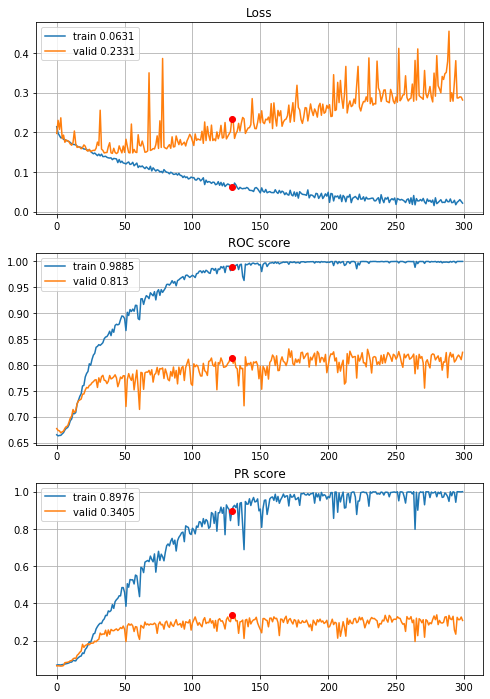


Fold 2------------------------------------------------------------


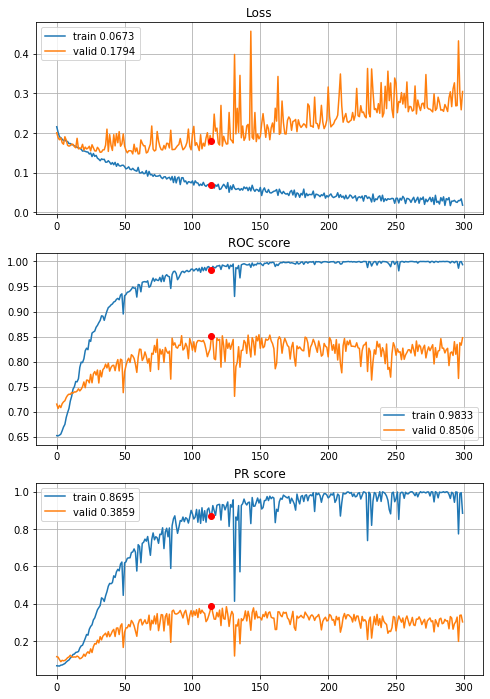


Fold 3------------------------------------------------------------


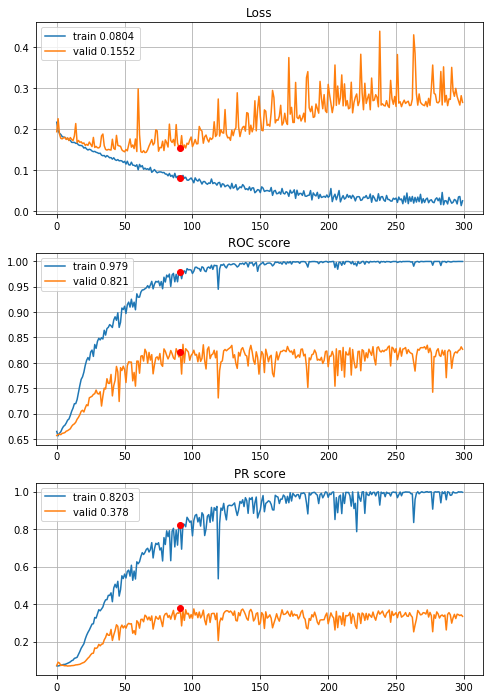


Fold 4------------------------------------------------------------


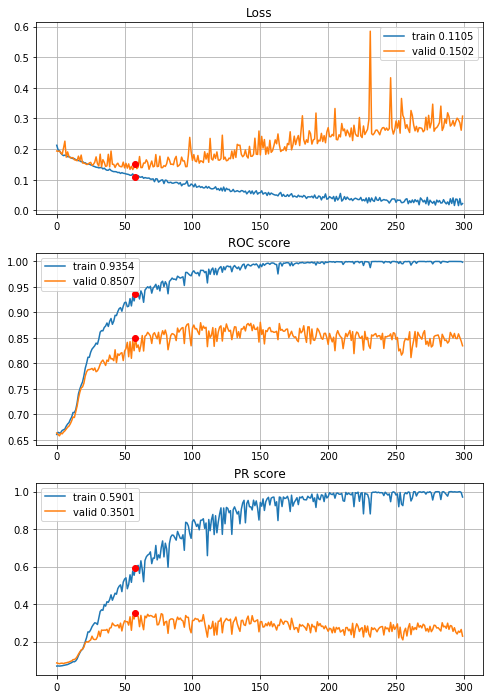


Fold 5------------------------------------------------------------


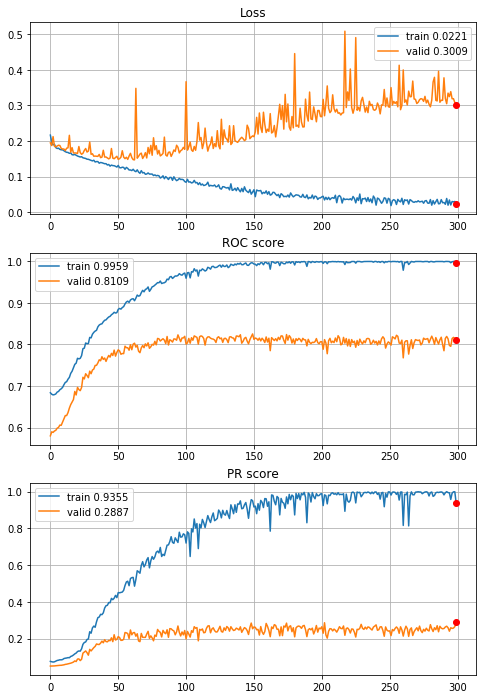


Fold 6------------------------------------------------------------


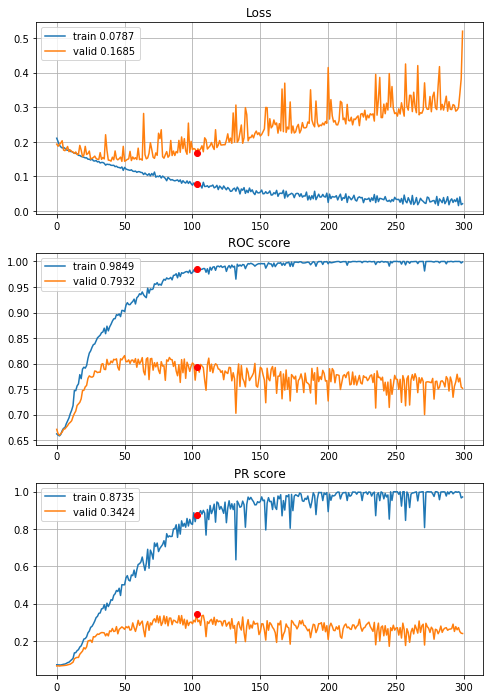

In [62]:
# The best model for 3 years horizon
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN_L2, features=features,
                                        target=target, n_epochs=300, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_CNN_L2_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

The last try will be the model above with no regularization (initial model with more epochs)


----------
Fold: 1
----------
Train on 7629 samples, validate on 1526 samples
Epoch: 1/400,
cumulative time: 4.09s train loss: 0.17915975450414678, validation loss: 0.16846000090690616
Epoch: 2/400,
cumulative time: 7.07s train loss: 0.1718132427907862, validation loss: 0.20604330959435685
Epoch: 3/400,
cumulative time: 9.99s train loss: 0.1702764111697119, validation loss: 0.18378416613857523
Epoch: 4/400,
cumulative time: 12.83s train loss: 0.165332901630556, validation loss: 0.20945730467533222
Epoch: 5/400,
cumulative time: 15.7s train loss: 0.1676618414084398, validation loss: 0.16424034841524665
Epoch: 6/400,
cumulative time: 18.58s train loss: 0.16378899469829072, validation loss: 0.1745253292987731
Epoch: 7/400,
cumulative time: 21.55s train loss: 0.16381438700161188, validation loss: 0.1588592475297254
Epoch: 8/400,
cumulative time: 24.48s train loss: 0.16180262550162774, validation loss: 0.16417250368221714
Epoch: 9/400,
cumulative time: 27.41s train loss: 0.1619509907979174

Epoch: 76/400,
cumulative time: 217.24s train loss: 0.07525956817728177, validation loss: 0.19066909348121008
Epoch: 77/400,
cumulative time: 220.07s train loss: 0.07700492673209149, validation loss: 0.19425377165740002
Epoch: 78/400,
cumulative time: 222.88s train loss: 0.071324944692454, validation loss: 0.1596138721837285
Epoch: 79/400,
cumulative time: 225.66s train loss: 0.07148883746748187, validation loss: 0.32159641963157554
Epoch: 80/400,
cumulative time: 228.51s train loss: 0.0741813786817122, validation loss: 0.16943152059421315
Epoch: 81/400,
cumulative time: 231.33s train loss: 0.06821668765162528, validation loss: 0.1987852320992931
Epoch: 82/400,
cumulative time: 234.13s train loss: 0.07503596512848107, validation loss: 0.16963788279152792
Epoch: 83/400,
cumulative time: 236.92s train loss: 0.07001114971637883, validation loss: 0.16972439108247994
Epoch: 84/400,
cumulative time: 239.71s train loss: 0.06762514159235718, validation loss: 0.1809848921170866
Epoch: 85/400,
c

Epoch: 151/400,
cumulative time: 434.25s train loss: 0.036755494937031626, validation loss: 0.2406346907895327
Epoch: 152/400,
cumulative time: 437.08s train loss: 0.01611344240927381, validation loss: 0.24155722785042905
Epoch: 153/400,
cumulative time: 439.94s train loss: 0.02664337107344782, validation loss: 0.2646810567082146
Epoch: 154/400,
cumulative time: 442.96s train loss: 0.017716772295705518, validation loss: 0.2718919104314257
Epoch: 155/400,
cumulative time: 445.93s train loss: 0.022665008359552916, validation loss: 0.36384363796654723
Epoch: 156/400,
cumulative time: 448.96s train loss: 0.020923872631359863, validation loss: 0.2523372277402628
Epoch: 157/400,
cumulative time: 451.99s train loss: 0.038067863333720295, validation loss: 0.27816468508496667
Epoch: 158/400,
cumulative time: 454.97s train loss: 0.007370157411224581, validation loss: 0.3587380969118166
Epoch: 159/400,
cumulative time: 457.96s train loss: 0.028924691411112955, validation loss: 0.24912595860220657

Epoch: 225/400,
cumulative time: 647.04s train loss: 0.022308811634610022, validation loss: 0.3021589175823632
Epoch: 226/400,
cumulative time: 649.94s train loss: 0.020360393119690998, validation loss: 0.29446619795940493
Epoch: 227/400,
cumulative time: 652.91s train loss: 0.004793958584915805, validation loss: 0.29442641410493287
Epoch: 228/400,
cumulative time: 655.88s train loss: 0.023816010793673452, validation loss: 0.2936054718330366
Epoch: 229/400,
cumulative time: 658.84s train loss: 0.004964995127879811, validation loss: 0.292645804086019
Epoch: 230/400,
cumulative time: 661.81s train loss: 0.023568025475677917, validation loss: 0.3064262280301685
Epoch: 231/400,
cumulative time: 664.76s train loss: 0.0122613396915921, validation loss: 0.3314617892549047
Epoch: 232/400,
cumulative time: 667.79s train loss: 0.008065957835598063, validation loss: 0.29417542572258965
Epoch: 233/400,
cumulative time: 670.65s train loss: 0.016444222155013174, validation loss: 0.3610240657902951
E

Epoch: 299/400,
cumulative time: 864.08s train loss: 0.0018213587856843827, validation loss: 0.33205968481372566
Epoch: 300/400,
cumulative time: 868.07s train loss: 0.016175328155957295, validation loss: 0.2867911993129225
Epoch: 301/400,
cumulative time: 871.58s train loss: 0.001682332438547523, validation loss: 0.3412552918081671
Epoch: 302/400,
cumulative time: 874.47s train loss: 0.014043019295686939, validation loss: 0.2874953309916263
Epoch: 303/400,
cumulative time: 877.54s train loss: 0.014603790873648667, validation loss: 0.2907870067173657
Epoch: 304/400,
cumulative time: 880.46s train loss: 0.004627140730250973, validation loss: 0.2863195372127768
Epoch: 305/400,
cumulative time: 883.44s train loss: 0.011065264097142374, validation loss: 0.31769849287729274
Epoch: 306/400,
cumulative time: 886.58s train loss: 0.004489916336789448, validation loss: 0.3085622772047123
Epoch: 307/400,
cumulative time: 889.59s train loss: 0.004812759466605159, validation loss: 0.317448920300559

Epoch: 373/400,
cumulative time: 1085.8s train loss: 0.0029496858788789163, validation loss: 0.3031038571232112
Epoch: 374/400,
cumulative time: 1088.89s train loss: 0.017831505208031465, validation loss: 0.3240608720995027
Epoch: 375/400,
cumulative time: 1091.84s train loss: 0.0016810416999048655, validation loss: 0.3101485159497117
Epoch: 376/400,
cumulative time: 1095.1s train loss: 0.014053340197449124, validation loss: 0.3020240507072734
Epoch: 377/400,
cumulative time: 1098.15s train loss: 0.0030973388220433564, validation loss: 0.2946038257872605
Epoch: 378/400,
cumulative time: 1100.98s train loss: 0.010724090987681772, validation loss: 0.30384274575063475
Epoch: 379/400,
cumulative time: 1103.78s train loss: 0.0032030189306537053, validation loss: 0.29973907423050655
Epoch: 380/400,
cumulative time: 1106.63s train loss: 0.0019470879056442494, validation loss: 0.30262144556364257
Epoch: 381/400,
cumulative time: 1109.78s train loss: 0.011436737246497287, validation loss: 0.321

Epoch: 45/400,
cumulative time: 132.58s train loss: 0.09466364025593053, validation loss: 0.20488804381531156
Epoch: 46/400,
cumulative time: 135.5s train loss: 0.10084122594464011, validation loss: 0.16387000921161585
Epoch: 47/400,
cumulative time: 138.42s train loss: 0.09567720247785391, validation loss: 0.21793552446099754
Epoch: 48/400,
cumulative time: 141.64s train loss: 0.09447225690745467, validation loss: 0.16282448346383607
Epoch: 49/400,
cumulative time: 144.65s train loss: 0.09820231336400524, validation loss: 0.16468495181316162
Epoch: 50/400,
cumulative time: 147.54s train loss: 0.09706388146607119, validation loss: 0.17270506160677965
Epoch: 51/400,
cumulative time: 150.63s train loss: 0.08740990070426179, validation loss: 0.15980476635077365
Epoch: 52/400,
cumulative time: 153.5s train loss: 0.08695358359840254, validation loss: 0.14950590732057004
Epoch: 53/400,
cumulative time: 156.57s train loss: 0.09209777174454277, validation loss: 0.15517052163419998
Epoch: 54/40

Epoch: 120/400,
cumulative time: 351.69s train loss: 0.03563128357470184, validation loss: 0.26700229901786243
Epoch: 121/400,
cumulative time: 354.48s train loss: 0.030288264524791747, validation loss: 0.22110208593611635
Epoch: 122/400,
cumulative time: 357.28s train loss: 0.0379812916356722, validation loss: 0.25125338416424525
Epoch: 123/400,
cumulative time: 360.09s train loss: 0.024063631715925637, validation loss: 0.2154059274754393
Epoch: 124/400,
cumulative time: 363.0s train loss: 0.027929473272259257, validation loss: 0.23493062828815156
Epoch: 125/400,
cumulative time: 365.82s train loss: 0.036133293049996684, validation loss: 0.22620386240679188
Epoch: 126/400,
cumulative time: 368.74s train loss: 0.03546346789002536, validation loss: 0.21815212686127478
Epoch: 127/400,
cumulative time: 371.69s train loss: 0.0331962497975457, validation loss: 0.2136857836930811
Epoch: 128/400,
cumulative time: 374.63s train loss: 0.027033274274269114, validation loss: 0.22625784275181796
E

Epoch: 194/400,
cumulative time: 566.99s train loss: 0.0174555680637029, validation loss: 0.285975459167248
Epoch: 195/400,
cumulative time: 569.77s train loss: 0.012722088517331838, validation loss: 0.2688171001319648
Epoch: 196/400,
cumulative time: 572.61s train loss: 0.01770651429072574, validation loss: 0.3038741799942944
Epoch: 197/400,
cumulative time: 575.5s train loss: 0.01496162071618924, validation loss: 0.2736783200096178
Epoch: 198/400,
cumulative time: 578.34s train loss: 0.015674230964410733, validation loss: 0.31516022999742865
Epoch: 199/400,
cumulative time: 581.19s train loss: 0.012524726707079341, validation loss: 0.30933705919457605
Epoch: 200/400,
cumulative time: 584.0s train loss: 0.02280590158472391, validation loss: 0.28032813011271923
Epoch: 201/400,
cumulative time: 587.08s train loss: 0.010271092397351267, validation loss: 0.2842684904721274
Epoch: 202/400,
cumulative time: 590.05s train loss: 0.026017932705937653, validation loss: 0.2829370321718143
Epoch:

Epoch: 268/400,
cumulative time: 783.11s train loss: 0.01125582131634197, validation loss: 0.28512121563188997
Epoch: 269/400,
cumulative time: 786.35s train loss: 0.006293335040600586, validation loss: 0.2980650226301166
Epoch: 270/400,
cumulative time: 789.29s train loss: 0.016235657252872224, validation loss: 0.2860033811701078
Epoch: 271/400,
cumulative time: 792.34s train loss: 0.013680786406718999, validation loss: 0.311947127665011
Epoch: 272/400,
cumulative time: 795.2s train loss: 0.006169091040549133, validation loss: 0.3041114933290769
Epoch: 273/400,
cumulative time: 798.08s train loss: 0.008151165775139007, validation loss: 0.2981834788153712
Epoch: 274/400,
cumulative time: 801.26s train loss: 0.01858290012005619, validation loss: 0.30071195003089557
Epoch: 275/400,
cumulative time: 804.09s train loss: 0.005836999134708336, validation loss: 0.29971271495519114
Epoch: 276/400,
cumulative time: 807.06s train loss: 0.011719089919479161, validation loss: 0.31324727512983946
E

Epoch: 342/400,
cumulative time: 998.69s train loss: 0.012061130977971245, validation loss: 0.3061994726660992
Epoch: 343/400,
cumulative time: 1001.51s train loss: 0.004942391639794368, validation loss: 0.32135653343456916
Epoch: 344/400,
cumulative time: 1004.36s train loss: 0.008369939041226817, validation loss: 0.3638477085614736
Epoch: 345/400,
cumulative time: 1007.16s train loss: 0.008888529117281043, validation loss: 0.3028414172473147
Epoch: 346/400,
cumulative time: 1010.1s train loss: 0.015974144242248692, validation loss: 0.3007083005158336
Epoch: 347/400,
cumulative time: 1012.95s train loss: 0.0034842023844891424, validation loss: 0.3150343956281754
Epoch: 348/400,
cumulative time: 1015.82s train loss: 0.008884060665314594, validation loss: 0.3121161940721197
Epoch: 349/400,
cumulative time: 1018.67s train loss: 0.006135631121457542, validation loss: 0.3141345241122914
Epoch: 350/400,
cumulative time: 1021.57s train loss: 0.009744429613073485, validation loss: 0.292730205

Epoch: 13/400,
cumulative time: 39.43s train loss: 0.15512009647570238, validation loss: 0.1614679683824979
Epoch: 14/400,
cumulative time: 42.34s train loss: 0.15590626038859973, validation loss: 0.17856602232078111
Epoch: 15/400,
cumulative time: 45.23s train loss: 0.15295517258272834, validation loss: 0.26384705379312345
Epoch: 16/400,
cumulative time: 48.12s train loss: 0.1552796503730379, validation loss: 0.15758174177391032
Epoch: 17/400,
cumulative time: 51.07s train loss: 0.14844630872504805, validation loss: 0.1667496652621898
Epoch: 18/400,
cumulative time: 54.08s train loss: 0.14776957298750207, validation loss: 0.16202294041413623
Epoch: 19/400,
cumulative time: 57.13s train loss: 0.14653044686684338, validation loss: 0.17053511301311877
Epoch: 20/400,
cumulative time: 60.05s train loss: 0.14600888564586953, validation loss: 0.1564490302205867
Epoch: 21/400,
cumulative time: 62.96s train loss: 0.13873451251938484, validation loss: 0.15784625593831625
Epoch: 22/400,
cumulati

Epoch: 89/400,
cumulative time: 262.18s train loss: 0.05941270588011991, validation loss: 0.22885242838847059
Epoch: 90/400,
cumulative time: 264.99s train loss: 0.05685862227600483, validation loss: 0.16684949534748672
Epoch: 91/400,
cumulative time: 267.87s train loss: 0.05257934259429236, validation loss: 0.17529893645999628
Epoch: 92/400,
cumulative time: 270.73s train loss: 0.05152294477541866, validation loss: 0.18223432977812007
Epoch: 93/400,
cumulative time: 273.55s train loss: 0.05571703597959895, validation loss: 0.18974832290121957
Epoch: 94/400,
cumulative time: 276.46s train loss: 0.05647748772448974, validation loss: 0.15425129457429385
Epoch: 95/400,
cumulative time: 279.36s train loss: 0.05061922947657516, validation loss: 0.1741006578639794
Epoch: 96/400,
cumulative time: 282.26s train loss: 0.05977072565819883, validation loss: 0.16757988142701621
Epoch: 97/400,
cumulative time: 285.11s train loss: 0.048209100119112315, validation loss: 0.16592820439863643
Epoch: 98/

Epoch: 164/400,
cumulative time: 478.82s train loss: 0.01800801993452324, validation loss: 0.2577877280401215
Epoch: 165/400,
cumulative time: 481.66s train loss: 0.02892787606328548, validation loss: 0.24676332063240586
Epoch: 166/400,
cumulative time: 484.52s train loss: 0.015783519044687912, validation loss: 0.24827839848176525
Epoch: 167/400,
cumulative time: 487.36s train loss: 0.029344815973264233, validation loss: 0.2522138413212715
Epoch: 168/400,
cumulative time: 490.25s train loss: 0.018705329151522832, validation loss: 0.2425383557693674
Epoch: 169/400,
cumulative time: 493.16s train loss: 0.023193956655398282, validation loss: 0.2415085717508396
Epoch: 170/400,
cumulative time: 496.06s train loss: 0.02546274117611008, validation loss: 0.2856204923960047
Epoch: 171/400,
cumulative time: 498.94s train loss: 0.010127066364409304, validation loss: 0.25961360253325294
Epoch: 172/400,
cumulative time: 501.82s train loss: 0.016496908649846643, validation loss: 0.26166689741580235


Epoch: 238/400,
cumulative time: 697.18s train loss: 0.004235666252725989, validation loss: 0.2860360821296472
Epoch: 239/400,
cumulative time: 700.0s train loss: 0.018682190326778838, validation loss: 0.2830308227364076
Epoch: 240/400,
cumulative time: 703.0s train loss: 0.021001678598953855, validation loss: 0.2908990200740794
Epoch: 241/400,
cumulative time: 705.9s train loss: 0.011262503687611811, validation loss: 0.3458244007271208
Epoch: 242/400,
cumulative time: 708.72s train loss: 0.010327922823730363, validation loss: 0.3096302534852709
Epoch: 243/400,
cumulative time: 711.6s train loss: 0.018362783718117334, validation loss: 0.28728521870129387
Epoch: 244/400,
cumulative time: 714.45s train loss: 0.01130071275686299, validation loss: 0.27892194975406753
Epoch: 245/400,
cumulative time: 717.37s train loss: 0.005875756034672359, validation loss: 0.2995552606538895
Epoch: 246/400,
cumulative time: 720.24s train loss: 0.02209913188204754, validation loss: 0.27279786306627457
Epoc

Epoch: 312/400,
cumulative time: 913.92s train loss: 0.017790353423753746, validation loss: 0.2957766441967665
Epoch: 313/400,
cumulative time: 916.92s train loss: 0.003628318838774914, validation loss: 0.2966981961795887
Epoch: 314/400,
cumulative time: 919.8s train loss: 0.004937547157197931, validation loss: 0.36287858429930003
Epoch: 315/400,
cumulative time: 922.7s train loss: 0.0076024137639121, validation loss: 0.30645474854021837
Epoch: 316/400,
cumulative time: 925.78s train loss: 0.014831991812503897, validation loss: 0.3495096395946893
Epoch: 317/400,
cumulative time: 928.65s train loss: 0.00664791710393254, validation loss: 0.2924528244204165
Epoch: 318/400,
cumulative time: 931.49s train loss: 0.005749956950530845, validation loss: 0.3591631318138592
Epoch: 319/400,
cumulative time: 934.37s train loss: 0.010785573660005088, validation loss: 0.295135513612046
Epoch: 320/400,
cumulative time: 937.39s train loss: 0.013625187808848874, validation loss: 0.3025324598130517
Epoch

Epoch: 386/400,
cumulative time: 1129.91s train loss: 0.012798113586920016, validation loss: 0.32599630178505284
Epoch: 387/400,
cumulative time: 1132.84s train loss: 0.00124245712114321, validation loss: 0.3226121316418579
Epoch: 388/400,
cumulative time: 1135.87s train loss: 0.0018950580903168578, validation loss: 0.3690737523773238
Epoch: 389/400,
cumulative time: 1138.85s train loss: 0.011433052312751227, validation loss: 0.304559876807864
Epoch: 390/400,
cumulative time: 1141.82s train loss: 0.014096828210610191, validation loss: 0.3228855353351658
Epoch: 391/400,
cumulative time: 1144.66s train loss: 0.0024689504052364634, validation loss: 0.3175447673035168
Epoch: 392/400,
cumulative time: 1147.52s train loss: 0.004735830255625105, validation loss: 0.3556551880558384
Epoch: 393/400,
cumulative time: 1150.38s train loss: 0.01756359239062914, validation loss: 0.29877835434042455
Epoch: 394/400,
cumulative time: 1153.22s train loss: 0.0010176090285352784, validation loss: 0.3109703

Epoch: 59/400,
cumulative time: 173.26s train loss: 0.0855297890111759, validation loss: 0.1582181754266919
Epoch: 60/400,
cumulative time: 176.58s train loss: 0.09307604436617971, validation loss: 0.14290617074363354
Epoch: 61/400,
cumulative time: 179.59s train loss: 0.09209618404964692, validation loss: 0.1494666322343159
Epoch: 62/400,
cumulative time: 182.62s train loss: 0.08506848196270644, validation loss: 0.18644990304272577
Epoch: 63/400,
cumulative time: 185.52s train loss: 0.08013775238618577, validation loss: 0.1545388094719553
Epoch: 64/400,
cumulative time: 188.41s train loss: 0.07937691619612158, validation loss: 0.16237488226918687
Epoch: 65/400,
cumulative time: 191.26s train loss: 0.08325196955163071, validation loss: 0.16289913960943683
Epoch: 66/400,
cumulative time: 194.12s train loss: 0.08294516074159758, validation loss: 0.2593702768631094
Epoch: 67/400,
cumulative time: 196.95s train loss: 0.08680356936039751, validation loss: 0.19800865581823052
Epoch: 68/400,


Epoch: 134/400,
cumulative time: 395.07s train loss: 0.03419867610107916, validation loss: 0.23099251093433226
Epoch: 135/400,
cumulative time: 397.89s train loss: 0.03310266154311497, validation loss: 0.27905393023712766
Epoch: 136/400,
cumulative time: 400.85s train loss: 0.025356731464582654, validation loss: 0.2601974201077403
Epoch: 137/400,
cumulative time: 403.74s train loss: 0.03253611970032683, validation loss: 0.21980972656416237
Epoch: 138/400,
cumulative time: 406.59s train loss: 0.032206978347493795, validation loss: 0.22214527219182387
Epoch: 139/400,
cumulative time: 409.54s train loss: 0.032101326491813124, validation loss: 0.24923385574261453
Epoch: 140/400,
cumulative time: 412.55s train loss: 0.029428352735622172, validation loss: 0.4375637172871461
Epoch: 141/400,
cumulative time: 415.65s train loss: 0.03074982635322106, validation loss: 0.24196209282971928
Epoch: 142/400,
cumulative time: 418.69s train loss: 0.029789679903116602, validation loss: 0.2629636203281845

Epoch: 208/400,
cumulative time: 608.53s train loss: 0.013570530223156605, validation loss: 0.3049763375466023
Epoch: 209/400,
cumulative time: 611.83s train loss: 0.015558033485025624, validation loss: 0.30299873831700214
Epoch: 210/400,
cumulative time: 615.1s train loss: 0.014452375383193213, validation loss: 0.2961347204282743
Epoch: 211/400,
cumulative time: 618.62s train loss: 0.019791519650394118, validation loss: 0.29280938854536254
Epoch: 212/400,
cumulative time: 621.76s train loss: 0.010268374246521087, validation loss: 0.2883914734089203
Epoch: 213/400,
cumulative time: 624.9s train loss: 0.025667212173481384, validation loss: 0.33734156119089137
Epoch: 214/400,
cumulative time: 628.17s train loss: 0.007598046206567411, validation loss: 0.28710376087522443
Epoch: 215/400,
cumulative time: 631.35s train loss: 0.019769400861705113, validation loss: 0.3210388075164855
Epoch: 216/400,
cumulative time: 634.45s train loss: 0.01353181013251489, validation loss: 0.30151820917117017

Epoch: 282/400,
cumulative time: 830.19s train loss: 0.0163743936418652, validation loss: 0.3157289221121162
Epoch: 283/400,
cumulative time: 833.01s train loss: 0.00802982619055855, validation loss: 0.33159274058135746
Epoch: 284/400,
cumulative time: 835.83s train loss: 0.008247065273707329, validation loss: 0.3403402204438556
Epoch: 285/400,
cumulative time: 838.65s train loss: 0.011857359603166457, validation loss: 0.29857756283383224
Epoch: 286/400,
cumulative time: 841.45s train loss: 0.01033309907214793, validation loss: 0.31891437361156016
Epoch: 287/400,
cumulative time: 844.24s train loss: 0.00663949947499082, validation loss: 0.32394540356777285
Epoch: 288/400,
cumulative time: 847.03s train loss: 0.008403474496161164, validation loss: 0.29803116500455773
Epoch: 289/400,
cumulative time: 849.94s train loss: 0.014680954857860546, validation loss: 0.3053894564021149
Epoch: 290/400,
cumulative time: 852.77s train loss: 0.008845768677140809, validation loss: 0.3418928725378854
E

Epoch: 356/400,
cumulative time: 1044.95s train loss: 0.0072882892955270975, validation loss: 0.31898223400740916
Epoch: 357/400,
cumulative time: 1047.93s train loss: 0.015442591774821575, validation loss: 0.3541461292600569
Epoch: 358/400,
cumulative time: 1050.87s train loss: 0.003284102944495806, validation loss: 0.32778471372386886
Epoch: 359/400,
cumulative time: 1053.82s train loss: 0.008447677968607048, validation loss: 0.3068840519316387
Epoch: 360/400,
cumulative time: 1056.78s train loss: 0.006193415446121687, validation loss: 0.4347030361076795
Epoch: 361/400,
cumulative time: 1059.73s train loss: 0.01623282201704409, validation loss: 0.32624288104464777
Epoch: 362/400,
cumulative time: 1062.63s train loss: 0.008093828799711395, validation loss: 0.3122473507338395
Epoch: 363/400,
cumulative time: 1065.55s train loss: 0.00880228007565815, validation loss: 0.3155344846129886
Epoch: 364/400,
cumulative time: 1068.64s train loss: 0.004574329226484933, validation loss: 0.4208141

Epoch: 28/400,
cumulative time: 82.83s train loss: 0.13111086828940066, validation loss: 0.17357106551742804
Epoch: 29/400,
cumulative time: 85.71s train loss: 0.1310851093772777, validation loss: 0.17355296189553773
Epoch: 30/400,
cumulative time: 88.58s train loss: 0.12895721384052025, validation loss: 0.18681457919968222
Epoch: 31/400,
cumulative time: 91.38s train loss: 0.12761159401071043, validation loss: 0.15418128721992122
Epoch: 32/400,
cumulative time: 94.25s train loss: 0.1252725782459569, validation loss: 0.1644106123347426
Epoch: 33/400,
cumulative time: 97.09s train loss: 0.12822250511386413, validation loss: 0.1473582100469819
Epoch: 34/400,
cumulative time: 99.87s train loss: 0.12055553948544068, validation loss: 0.15767884195866466
Epoch: 35/400,
cumulative time: 102.64s train loss: 0.12286191540997905, validation loss: 0.1438967025061266
Epoch: 36/400,
cumulative time: 105.5s train loss: 0.12060201630388898, validation loss: 0.15238579424149398
Epoch: 37/400,
cumulati

Epoch: 103/400,
cumulative time: 296.13s train loss: 0.0446033819409756, validation loss: 0.22473138312993482
Epoch: 104/400,
cumulative time: 298.94s train loss: 0.04793128189832843, validation loss: 0.27769315203707934
Epoch: 105/400,
cumulative time: 301.97s train loss: 0.04279976052732967, validation loss: 0.24797391828984452
Epoch: 106/400,
cumulative time: 304.88s train loss: 0.04056225102924632, validation loss: 0.2219104918200879
Epoch: 107/400,
cumulative time: 308.08s train loss: 0.05235208413490545, validation loss: 0.24509250631416765
Epoch: 108/400,
cumulative time: 311.04s train loss: 0.041716577173786275, validation loss: 0.2063711217237175
Epoch: 109/400,
cumulative time: 314.37s train loss: 0.0474106216643761, validation loss: 0.24813663451730972
Epoch: 110/400,
cumulative time: 317.46s train loss: 0.04192424044945689, validation loss: 0.22310770323517126
Epoch: 111/400,
cumulative time: 320.32s train loss: 0.04223906108590695, validation loss: 0.2241527859224092
Epoch

Epoch: 177/400,
cumulative time: 508.13s train loss: 0.013695197040440976, validation loss: 0.3207170092262728
Epoch: 178/400,
cumulative time: 510.95s train loss: 0.020318797613235417, validation loss: 0.308966886989411
Epoch: 179/400,
cumulative time: 513.76s train loss: 0.03186110155190601, validation loss: 0.29137355276672744
Epoch: 180/400,
cumulative time: 516.52s train loss: 0.008662799260622875, validation loss: 0.2944103584455163
Epoch: 181/400,
cumulative time: 519.25s train loss: 0.01983982323031535, validation loss: 0.3241152123183129
Epoch: 182/400,
cumulative time: 521.99s train loss: 0.023252632184790224, validation loss: 0.2741727482522612
Epoch: 183/400,
cumulative time: 524.8s train loss: 0.025763938571759196, validation loss: 0.26680173116539596
Epoch: 184/400,
cumulative time: 527.66s train loss: 0.009963857674073227, validation loss: 0.28421772924663197
Epoch: 185/400,
cumulative time: 530.42s train loss: 0.01662812302196573, validation loss: 0.31825155343953154
Ep

Epoch: 251/400,
cumulative time: 718.66s train loss: 0.018151553457560497, validation loss: 0.3326599547934876
Epoch: 252/400,
cumulative time: 721.52s train loss: 0.006147693512188035, validation loss: 0.302774861826028
Epoch: 253/400,
cumulative time: 724.36s train loss: 0.022279004876385032, validation loss: 0.2999727384994102
Epoch: 254/400,
cumulative time: 727.12s train loss: 0.005836544233708757, validation loss: 0.31115752232027866
Epoch: 255/400,
cumulative time: 729.93s train loss: 0.015469826410447272, validation loss: 0.2934683082456826
Epoch: 256/400,
cumulative time: 732.76s train loss: 0.00473500913935487, validation loss: 0.3205781134521664
Epoch: 257/400,
cumulative time: 735.51s train loss: 0.024960580636851068, validation loss: 0.29329649856018675
Epoch: 258/400,
cumulative time: 738.28s train loss: 0.005599118490925706, validation loss: 0.2945547678836208
Epoch: 259/400,
cumulative time: 741.06s train loss: 0.02215287117831368, validation loss: 0.30561033578718944
E

Epoch: 325/400,
cumulative time: 930.23s train loss: 0.009920471559007596, validation loss: 0.3261247220233102
Epoch: 326/400,
cumulative time: 933.45s train loss: 0.010281841824279329, validation loss: 0.2961160351142658
Epoch: 327/400,
cumulative time: 936.23s train loss: 0.004086397936003548, validation loss: 0.342302624394978
Epoch: 328/400,
cumulative time: 938.97s train loss: 0.01540721844631699, validation loss: 0.33682107319994337
Epoch: 329/400,
cumulative time: 941.78s train loss: 0.00406115736160937, validation loss: 0.3255664959725671
Epoch: 330/400,
cumulative time: 944.56s train loss: 0.00473175703609681, validation loss: 0.32677375313338886
Epoch: 331/400,
cumulative time: 947.32s train loss: 0.011956949378793803, validation loss: 0.3133910761982554
Epoch: 332/400,
cumulative time: 950.11s train loss: 0.009594288633971576, validation loss: 0.3667907743357112
Epoch: 333/400,
cumulative time: 952.91s train loss: 0.008284279953649838, validation loss: 0.3264642334781187
Epo

Epoch: 399/400,
cumulative time: 1141.36s train loss: 0.003024043829153077, validation loss: 0.3760770338234708
Epoch: 400/400,
cumulative time: 1144.42s train loss: 0.006533570816543972, validation loss: 0.34463628853132966

Early stopping results:
best results in epoch: 303, 
best valid PR: 0.3172639201630709, 
valid ROC: 0.8283310595725331        
overfitting PR: 0.6534424587763246, 
overfitting ROC: 0.16972551931499136

----------
Fold: 6
----------
Train on 7630 samples, validate on 1525 samples
Epoch: 1/400,
cumulative time: 3.91s train loss: 0.17610214145788203, validation loss: 0.1652152366227791
Epoch: 2/400,
cumulative time: 6.69s train loss: 0.1749255721214402, validation loss: 0.16469868971676124
Epoch: 3/400,
cumulative time: 9.62s train loss: 0.16803788956386545, validation loss: 0.17247172542282793
Epoch: 4/400,
cumulative time: 12.44s train loss: 0.16547794312551167, validation loss: 0.17198084693463123
Epoch: 5/400,
cumulative time: 15.27s train loss: 0.163466474329894

Epoch: 72/400,
cumulative time: 206.92s train loss: 0.07424212988285375, validation loss: 0.16759967141464108
Epoch: 73/400,
cumulative time: 209.67s train loss: 0.08240131180865268, validation loss: 0.17244116070817728
Epoch: 74/400,
cumulative time: 212.39s train loss: 0.06456872270946656, validation loss: 0.22119986218507173
Epoch: 75/400,
cumulative time: 215.17s train loss: 0.06962175594537787, validation loss: 0.1877457420552363
Epoch: 76/400,
cumulative time: 218.08s train loss: 0.05997085055460858, validation loss: 0.2432731035889172
Epoch: 77/400,
cumulative time: 221.03s train loss: 0.0722194884553415, validation loss: 0.23820330473243212
Epoch: 78/400,
cumulative time: 223.92s train loss: 0.06489610565706677, validation loss: 0.32843063714074305
Epoch: 79/400,
cumulative time: 226.84s train loss: 0.06960033166953418, validation loss: 0.16698536854298388
Epoch: 80/400,
cumulative time: 229.93s train loss: 0.06485042112780585, validation loss: 0.18053275822616013
Epoch: 81/400

Epoch: 147/400,
cumulative time: 431.4s train loss: 0.031977014077966485, validation loss: 0.2317276879607654
Epoch: 148/400,
cumulative time: 434.35s train loss: 0.02203155699226307, validation loss: 0.26061842621349895
Epoch: 149/400,
cumulative time: 437.29s train loss: 0.017518300030058248, validation loss: 0.302285605375884
Epoch: 150/400,
cumulative time: 440.23s train loss: 0.029283162849121587, validation loss: 0.26138582911647734
Epoch: 151/400,
cumulative time: 443.24s train loss: 0.02646884115847367, validation loss: 0.2492204782806459
Epoch: 152/400,
cumulative time: 446.18s train loss: 0.03137323919629988, validation loss: 0.2540297579472182
Epoch: 153/400,
cumulative time: 449.12s train loss: 0.022031610050064123, validation loss: 0.24270511478674217
Epoch: 154/400,
cumulative time: 452.07s train loss: 0.02113129747866715, validation loss: 0.24148507016604065
Epoch: 155/400,
cumulative time: 455.04s train loss: 0.03440215891180743, validation loss: 0.2847063908029775
Epoc

Epoch: 221/400,
cumulative time: 653.73s train loss: 0.004988365776795372, validation loss: 0.3079515807745887
Epoch: 222/400,
cumulative time: 656.89s train loss: 0.026652325407474035, validation loss: 0.31231896887060073
Epoch: 223/400,
cumulative time: 660.02s train loss: 0.004864308673175611, validation loss: 0.3102751649207756
Epoch: 224/400,
cumulative time: 663.08s train loss: 0.015052420393958063, validation loss: 0.34608864280044055
Epoch: 225/400,
cumulative time: 666.1s train loss: 0.013099741498402016, validation loss: 0.3353071174074392
Epoch: 226/400,
cumulative time: 669.4s train loss: 0.024248470795013712, validation loss: 0.28629985279724246
Epoch: 227/400,
cumulative time: 672.49s train loss: 0.014294376875686448, validation loss: 0.2917688868671167
Epoch: 228/400,
cumulative time: 675.58s train loss: 0.010892571124332428, validation loss: 0.3300463839632566
Epoch: 229/400,
cumulative time: 678.72s train loss: 0.013018474450150594, validation loss: 0.31985068164887975

Epoch: 295/400,
cumulative time: 883.45s train loss: 0.006259347491879028, validation loss: 0.3220878274128085
Epoch: 296/400,
cumulative time: 886.38s train loss: 0.005034192203822378, validation loss: 0.35314889249254444
Epoch: 297/400,
cumulative time: 889.34s train loss: 0.008305525891272276, validation loss: 0.3140282604928877
Epoch: 298/400,
cumulative time: 892.4s train loss: 0.022196096850456586, validation loss: 0.3409515443981671
Epoch: 299/400,
cumulative time: 895.66s train loss: 0.003844581219328929, validation loss: 0.3129519807119839
Epoch: 300/400,
cumulative time: 898.66s train loss: 0.009217549728705374, validation loss: 0.3709717680391718
Epoch: 301/400,
cumulative time: 901.79s train loss: 0.009390965834254495, validation loss: 0.30629505786739414
Epoch: 302/400,
cumulative time: 904.98s train loss: 0.009809340866840858, validation loss: 0.33149191424494884
Epoch: 303/400,
cumulative time: 908.04s train loss: 0.007604492967780484, validation loss: 0.2995345662851802

Epoch: 369/400,
cumulative time: 1107.29s train loss: 0.010381884787135255, validation loss: 0.3224669151423407
Epoch: 370/400,
cumulative time: 1110.31s train loss: 0.017538009037354932, validation loss: 0.3322786708737983
Epoch: 371/400,
cumulative time: 1113.29s train loss: 0.004294743812605611, validation loss: 0.331973507853805
Epoch: 372/400,
cumulative time: 1116.26s train loss: 0.0038677984619068244, validation loss: 0.3177794595820005
Epoch: 373/400,
cumulative time: 1119.29s train loss: 0.012281522981490333, validation loss: 0.3082661648851926
Epoch: 374/400,
cumulative time: 1122.29s train loss: 0.0033136680128106537, validation loss: 0.31168797414810934
Epoch: 375/400,
cumulative time: 1125.32s train loss: 0.011774435700312547, validation loss: 0.31241297792215816
Epoch: 376/400,
cumulative time: 1128.44s train loss: 0.006455967216909241, validation loss: 0.3076700361830289
Epoch: 377/400,
cumulative time: 1131.47s train loss: 0.010781893193499622, validation loss: 0.317852

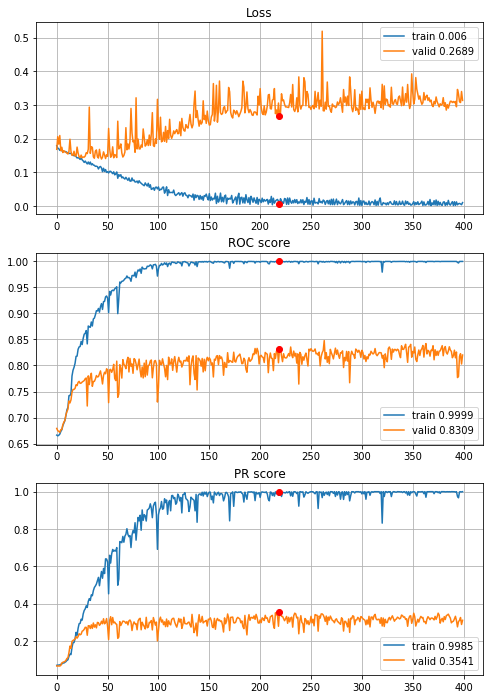


Fold 2------------------------------------------------------------


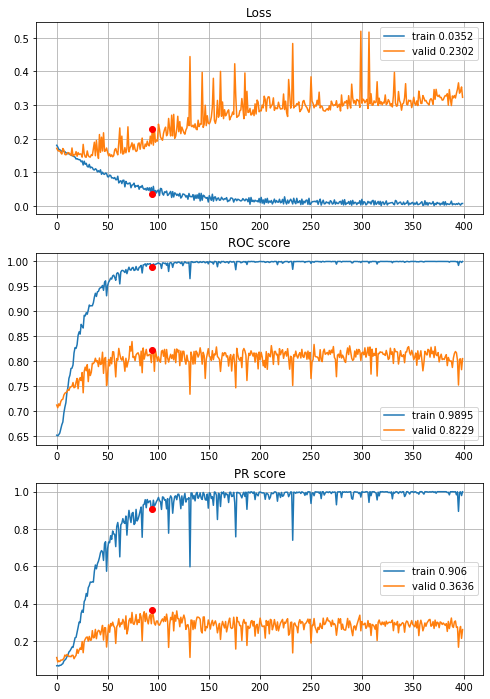


Fold 3------------------------------------------------------------


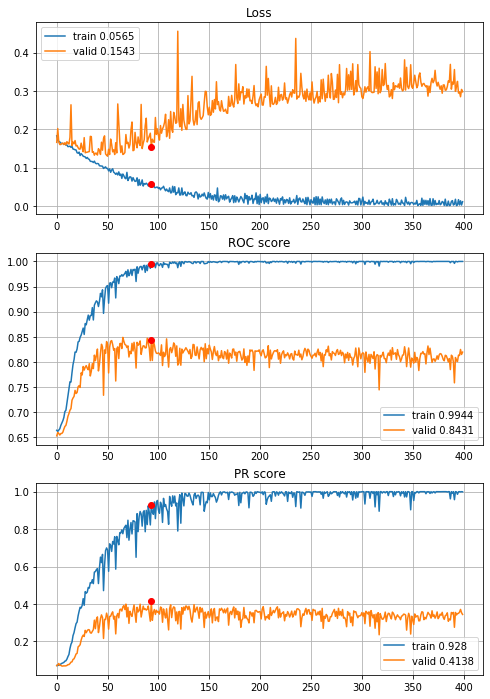


Fold 4------------------------------------------------------------


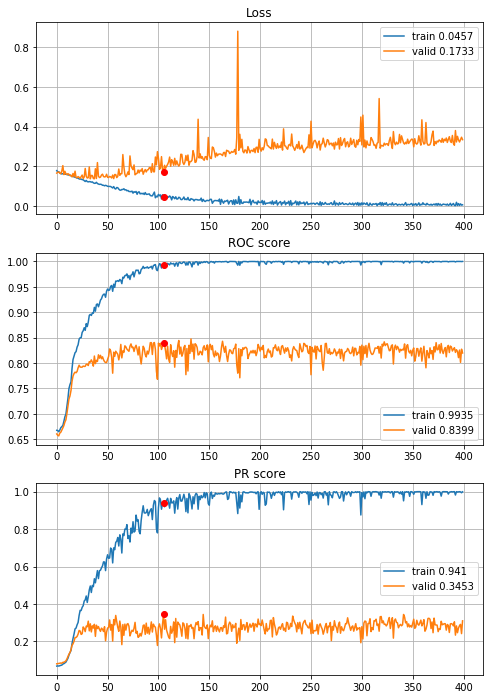


Fold 5------------------------------------------------------------


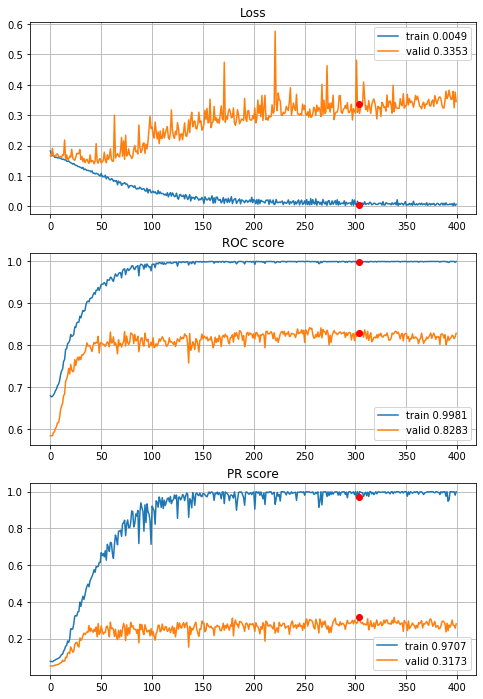


Fold 6------------------------------------------------------------


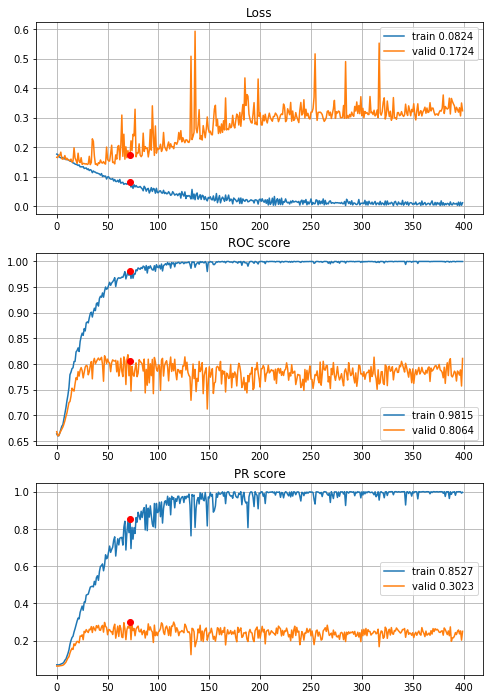

In [63]:
# The best model for 3 years horizon
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_CNN, features=features,
                                        target=target, n_epochs=400, batch_size=394, alpha=3, 
                                        drafts=drafts_8x8["optimized_drafts"], instruction=None, random_state=random_state,
                                        normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_CNN_400ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

ugly learning curves compared to the best inception.

DO ZMIANY

To sum up, best 8x8 CNN configuration is:
 - definition: define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02($\cdot$)
 - 8x8x1 input,
 - 2 inceptions $i^{[1]},i^{[2]}$,
     - $i^{[1]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=4, f_{2\_in}=f_{3\_in}=1$,
     - $i^{[2]}:f_1=f_{2\_out}=f_{3\_out}=f_{4}=8, f_{2\_in}=f_{3\_in}=4$,
     - relu activations,
 - 1 average pooling $f=(2,2),s=(2,2),p=\text{valid}$,
 - flatten ($512 \text{ units}$),
 - 1 dense layer $l^{[1]}$,
     - units: $u^{[1]}=256$,
     - activation: $a^{[1]}=relu$,
     - regularization: $L_2^{[1]}=0.00005$,
     - dropout: $0.4$
 - optimizer: Adam with default setings,
 - 350 epochs (rounded folds median: 349.5),
 - 394 batch size.
Because of small image size (8x8) CNN may be a bit under-trained, to fix it image dimensions has to increase. To do so feature generation method will be applied.

##### Feature generation for CNN
 - first, lets train the best XGBoost configuration and save the models (XGBoost achived much better results than Random Forest), note: best configuration excludes power transform from preprocessing pipeline, to get more reliable results best configuration with power transform will be used (CNN uses it too),

In [44]:
# Loading XGBoost random search results
with open(r"results\2year\XGB_RS.p", "rb") as fp:
    xgbrs = pickle.load(fp)

# printing the best ones with power transform included into preprocessing 
xgbrs.sort_values(by="PRvalid", ascending=False).where(xgbrs.norm_mode==3).dropna().head(5)

,max_depth,learning_rate,subsample,colsample_bytree,gamma,reg_alpha,reg_lambda,early_stopping,ROCvalid,overfittingROC,PRvalid,OverfittingPR,norm_mode
141,6.0,0.06,0.7,0.9,3.0,0.2,0.4,174.0,0.857564,0.139606,0.381082,0.597739,3.0
144,6.0,0.10,0.8,0.7,4.0,0.7,0.6,132.5,0.859175,0.135212,0.379679,0.573819,3.0
96,5.0,0.10,0.9,0.9,3.0,0.3,0.5,139.5,0.856185,0.141976,0.378686,0.599978,3.0
43,5.0,0.06,0.9,0.7,3.0,0.3,0.8,167.0,0.864555,0.133895,0.377468,0.602054,3.0
103,5.0,0.08,0.9,0.7,1.0,1.0,0.3,123.5,0.858021,0.140393,0.375265,0.605125,3.0


The best XGBoost with power transform is 104 index (higher PR, lowest overfitting among considered ones (top 5))

In [45]:
XGB_fi_hist, XGB_fi_models = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target,
                                                      random_state=random_state, info=0, normalize="power", q=0.005,
                                                      n_estimators=174, early_stopping_rounds=174, max_depth=6,
                                                      learning_rate=0.06, subsample=0.7, colsample_bytree=0.9, gamma=3, 
                                                      reg_alpha=0.2, reg_lambda=0.4, saveModels=True)


Cross validation time: 32s


 - second, lets create importance score table for each fold and on average,

In [46]:
XGBimportance=pd.DataFrame((features,
                           XGB_fi_models[0].feature_importances_,
                           XGB_fi_models[1].feature_importances_,
                           XGB_fi_models[2].feature_importances_,
                           XGB_fi_models[3].feature_importances_,
                           XGB_fi_models[4].feature_importances_,
                           XGB_fi_models[5].feature_importances_)).T

XGBimportance.columns = ("feature", "fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6")
XGBimportance["folds_mean_naive"] = XGBimportance.loc[:, ["fold_1", "fold_2", "fold_3", "fold_4", "fold_5", "fold_6"]].mean(axis=1)
# normalize folds mean to sum up to 1
for i in range(len(features)):
    XGBimportance.loc[i,"folds_mean"]=XGBimportance.loc[i,"folds_mean_naive"]/XGBimportance["folds_mean_naive"].sum()

XGBimportance.drop(labels="folds_mean_naive",axis=1, inplace=True)
XGBimportance.sort_values(by="folds_mean", ascending=False, ignore_index=True, inplace=True)

XGBimportance

,feature,fold_1,fold_2,fold_3,fold_4,fold_5,fold_6,folds_mean
0,Attr44,0.0223302,0.0216139,0.0233751,0.0219476,0.0238381,0.0237183,0.022804
1,Attr5,0.0224134,0.0232468,0.0240035,0.0220122,0.0213392,0.0233686,0.022731
2,Attr24,0.0216755,0.0230684,0.0208607,0.0225982,0.0244795,0.0208352,0.022253
3,Attr7,0.023944,0.0174326,0.0188083,0.0216586,0.020051,0.0224902,0.020731
4,Attr4,0.0203215,0.017371,0.0194711,0.0235762,0.0212523,0.0207814,0.020462
5,Attr62,0.0178363,0.0177903,0.0233301,0.0182979,0.0185661,0.0222369,0.019676
6,Attr1,0.019136,0.0199953,0.0192132,0.0214452,0.0198267,0.0171537,0.019462
7,Attr46,0.0190627,0.0182011,0.0212993,0.0191039,0.019199,0.0194098,0.019379
8,Attr33,0.0180155,0.0192188,0.0155986,0.0145055,0.0218193,0.0229432,0.018683
9,Attr19,0.0186814,0.016945,0.0186944,0.0173853,0.0163161,0.0231479,0.018528


 - third, define the discrete probability distribution, where Attributes are events and its fold's average XGBoost importance score is the probability of that event (score average sums up to 1), then sample needed number of attributes pair and one of basic arithmetic operation to perform on them with uniform probability (addition, subtraction, multiplication, division) dealing with duplicates and commutative property of these basic operations to create instruction how to generate new features - feature_generation_instruction(),
 - fourth, define the function which will generate features by instruction and prevent dividing by 0 - generate_features(),

In [47]:
def feature_generation_instruction(image_shape, importance, random_state=random_state):
    '''
    function generates instruction how to create new features. The idea is to sample two features from discrete probability
    distribution with P(x=feature)=Importance(feature) and sample one of arithmetic operations in ["add", "subtract",
    "multiply", "divide"] uniformly distributed. Duplicates are not allowed. Different features sampling order for the same
    operation is forbidden too, arguments:
    image_shape - shape of image to create from all features (original and generated), tuple,
    importance - dataframe with importance score, needs to contain columns ["feature", "folds_mean"], where "folds_mean" is Importance(feature),
    random_state - random seed
    
    return feature generation instruction (pandas.DataFrame, colnames=["feature1", "feature2", "operation"])
    '''
    # random seeds
    np.random.seed(random_state)
    random.seed(random_state)

    # computing number of features to generate
    n_features = image_shape[0]*image_shape[1]-importance.shape[0]
    
    # check if it is possible to generate n_features
        # division by 2 because of we don't want (Attr1, Attr2, add) and (Attr2, Attr1, add) in our instruction
    if n_features > (importance.shape[0]*(importance.shape[0]-1)*4)/2:
        raise "Too may features to generate, maximum number of features with given importance is {}\
        ".format((importance.shape[0]*(importance.shape[0]-1)*4)/2)
    elif n_features <= 0:
        raise "image.shape[0]*image.shape[1]-importance.shape[0]<=0, there is no features to generate."

    # generate first row
    bse=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
    bse=np.append(bse, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
    bse=bse.reshape(1,-1) # needed for condition below (np.any(np.all()))
    # iterator (iterate through number of valid generated features) 
    i=1
    while True:
        # generate next row
        bse_tmp=np.random.choice(a=importance.feature.values, p=importance.folds_mean.values,size=(2,),replace=False)
        bse_tmp=np.append(bse_tmp, np.random.choice(a=["add", "subtract", "multiply", "divide"]))
        # validate generated row
        if not np.any(np.all(bse==bse_tmp, axis=1)) and not np.any(np.all(np.array((bse_tmp[1], bse_tmp[0], bse_tmp[2]), dtype="object")==bse, axis=1)):
            # append
            bse=np.vstack((bse, bse_tmp))
            i+=1
        else:
            continue
        # stop generating rows when number of generated features is enough
        if i == n_features:
            break
    
    # convert to dataframe
    bse=pd.DataFrame(data=bse, columns=["feature1", "feature2", "operation"])
    
    return bse

def generate_features(data, instruction):
    '''
    function that generates new features for given dataframe with given istruction, arguments:
    data - dataframe with features,
    instruction - dataframe with 2 columns of features from data and column with arithmetic operation [+,-,*,/] to perform,
    
    return dataframe with old and generated features
    '''
    
    data_wgf=data.copy()
    
    for i in range(instruction.shape[0]):
        feature1=data[instruction.iloc[i,0]]
        feature2=data[instruction.iloc[i,1]]
        operation=instruction.iloc[i,2]
        if operation == "add":
            data_wgf["v"+str(i)]=feature1+feature2
        elif operation == "subtract":
            data_wgf["v"+str(i)]=feature1-feature2
        elif operation == "multiply":
            data_wgf["v"+str(i)]=feature1*feature2
        else:
            # prevent dividing by 0, when feature2==0 assign it to 1, then it won't cause an error 
            feature2.loc[feature2==0]=1
            data_wgf["v"+str(i)]=feature1/feature2
        
    return data_wgf

 - fifth generate instruction,

In [48]:
instruction=feature_generation_instruction(image_shape=(20,20), importance=XGBimportance, random_state=random_state)
instruction

,feature1,feature2,operation
0,Attr47,Attr41,subtract
1,Attr30,Attr64,multiply
2,Attr62,Attr33,add
3,Attr22,Attr55,multiply
4,Attr4,Attr24,multiply
...,...,...,...
336,Attr52,Attr47,divide
337,Attr35,Attr2,add
338,Attr55,Attr23,add
339,Attr6,Attr56,multiply


 - sixth perform Monte Carlo quasi optimization for image conversion with generated features for each of 6 folds (it will take a loooot of time) and save the results, 

In [47]:
# FOLD 1
# CV sets
fold=sets["training_sets"][0].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\2year_data\draft_20x20_fold_1.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3121384.0792
iteration: 100
current energy: 3020814.3059
iteration: 200
current energy: 2932106.4605
iteration: 300
current energy: 2874030.5503
iteration: 400
current energy: 2814813.1291
iteration: 500
current energy: 2745294.8489
iteration: 600
current energy: 2681875.6588
iteration: 700
current energy: 2663615.9834
iteration: 800
current energy: 2629768.3726
iteration: 900
current energy: 2609227.9219
iteration: 1000
current energy: 2594659.9267
iteration: 1100
current energy: 2585264.9338
iteration: 1200
current energy: 2569746.334
iteration: 1300
current energy: 2548380.428
iteration: 1400
current energy: 2529795.1586
iteration: 1500
current energy: 2509438.6368
iteration: 1600
current energy: 2491969.1612
iteration: 1700
current energy: 2485578.813
iteration: 1800
current energy: 2474548.1752
iteration: 1900
current energy: 2465969.8796
iteration: 2000
current energy: 2432740.04
iteration: 2100
current energy: 2421601.976
iteration: 2200
current energy: 241

In [48]:
# FOLD 2
# CV sets
fold=sets["training_sets"][1].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\2year_data\draft_20x20_fold_2.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3128330.9708
iteration: 100
current energy: 3026312.8136
iteration: 200
current energy: 2937885.3782
iteration: 300
current energy: 2878155.6778
iteration: 400
current energy: 2820897.3295
iteration: 500
current energy: 2755104.226
iteration: 600
current energy: 2689158.5351
iteration: 700
current energy: 2670326.5346
iteration: 800
current energy: 2640162.3541
iteration: 900
current energy: 2610497.6165
iteration: 1000
current energy: 2595484.9492
iteration: 1100
current energy: 2587593.7407
iteration: 1200
current energy: 2564705.7705
iteration: 1300
current energy: 2544998.5547
iteration: 1400
current energy: 2522076.6785
iteration: 1500
current energy: 2500283.9466
iteration: 1600
current energy: 2482103.4099
iteration: 1700
current energy: 2472810.3686
iteration: 1800
current energy: 2462402.9491
iteration: 1900
current energy: 2448878.4459
iteration: 2000
current energy: 2428897.8676
iteration: 2100
current energy: 2416902.6663
iteration: 2200
current energy

In [49]:
# FOLD 3
# CV sets
fold=sets["training_sets"][2].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\2year_data\draft_20x20_fold_3.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3121740.3548
iteration: 100
current energy: 3020840.049
iteration: 200
current energy: 2934254.5705
iteration: 300
current energy: 2873501.1267
iteration: 400
current energy: 2814284.2631
iteration: 500
current energy: 2750932.2643
iteration: 600
current energy: 2691783.9456
iteration: 700
current energy: 2676944.4023
iteration: 800
current energy: 2647959.4811
iteration: 900
current energy: 2615750.8448
iteration: 1000
current energy: 2597252.7469
iteration: 1100
current energy: 2588153.1605
iteration: 1200
current energy: 2571166.2717
iteration: 1300
current energy: 2537887.0543
iteration: 1400
current energy: 2516357.6944
iteration: 1500
current energy: 2500276.0285
iteration: 1600
current energy: 2479053.2693
iteration: 1700
current energy: 2469318.8252
iteration: 1800
current energy: 2448600.2553
iteration: 1900
current energy: 2441999.5445
iteration: 2000
current energy: 2428022.0465
iteration: 2100
current energy: 2421513.8927
iteration: 2200
current energy

iteration: 18200
current energy: 1997833.7289
iteration: 18300
current energy: 1997529.3289
iteration: 18400
current energy: 1996225.1502
iteration: 18500
current energy: 1995713.5613
iteration: 18600
current energy: 1995626.4935
iteration: 18700
current energy: 1995145.9801
iteration: 18800
current energy: 1995145.9801
iteration: 18900
current energy: 1994967.233
iteration: 19000
current energy: 1994186.5424
iteration: 19100
current energy: 1994123.5389
iteration: 19200
current energy: 1993752.9838
iteration: 19300
current energy: 1992354.1302
iteration: 19400
current energy: 1991972.2416
iteration: 19500
current energy: 1991864.9097
iteration: 19600
current energy: 1991542.4932
iteration: 19700
current energy: 1991542.4932
iteration: 19800
current energy: 1991478.3756
iteration: 19900
current energy: 1990003.3656
iteration: 20000
current energy: 1989467.8122
MC simulation time: 27677s
energy after MC quasi optimization: 1989467.8122


In [50]:
# FOLD 4
# CV sets
fold=sets["training_sets"][3].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\2year_data\draft_20x20_fold_4.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3106639.4571
iteration: 100
current energy: 3005896.4235
iteration: 200
current energy: 2919018.4621
iteration: 300
current energy: 2861567.3143
iteration: 400
current energy: 2804136.8029
iteration: 500
current energy: 2741056.0643
iteration: 600
current energy: 2679586.8795
iteration: 700
current energy: 2660203.8762
iteration: 800
current energy: 2632037.1419
iteration: 900
current energy: 2610929.5827
iteration: 1000
current energy: 2596078.8829
iteration: 1100
current energy: 2588162.7398
iteration: 1200
current energy: 2570384.6841
iteration: 1300
current energy: 2547048.6289
iteration: 1400
current energy: 2525626.3642
iteration: 1500
current energy: 2512239.5134
iteration: 1600
current energy: 2486931.0182
iteration: 1700
current energy: 2483613.6496
iteration: 1800
current energy: 2461548.891
iteration: 1900
current energy: 2454308.1582
iteration: 2000
current energy: 2426038.062
iteration: 2100
current energy: 2420187.1896
iteration: 2200
current energy:

In [51]:
# FOLD 5
# CV sets
fold=sets["training_sets"][4].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\2year_data\draft_20x20_fold_5.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3132903.3424
iteration: 100
current energy: 3031520.0392
iteration: 200
current energy: 2943710.3169
iteration: 300
current energy: 2882991.353
iteration: 400
current energy: 2823647.8868
iteration: 500
current energy: 2758218.8678
iteration: 600
current energy: 2698628.2191
iteration: 700
current energy: 2679782.0642
iteration: 800
current energy: 2651570.5772
iteration: 900
current energy: 2630878.6266
iteration: 1000
current energy: 2612930.1808
iteration: 1100
current energy: 2607173.3863
iteration: 1200
current energy: 2585713.2095
iteration: 1300
current energy: 2560806.5878
iteration: 1400
current energy: 2535284.03
iteration: 1500
current energy: 2513419.8635
iteration: 1600
current energy: 2488865.3954
iteration: 1700
current energy: 2481191.6272
iteration: 1800
current energy: 2454697.8255
iteration: 1900
current energy: 2433587.0346
iteration: 2000
current energy: 2409206.2839
iteration: 2100
current energy: 2403085.7398
iteration: 2200
current energy: 

In [52]:
# FOLD 6
# CV sets
fold=sets["training_sets"][5].copy()
fold_target=fold[target].copy()
fold_imp=generate_features(data=fold[features],instruction=instruction)
features_imp=fold_imp.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix = fold_imp[fold_target==0].corr(method="spearman")
# draft inicialization
draft = image_draft_inicialization(features_imp, random_state)
# quasi optimization
draft = MC_Energy_optimization(corr_matrix=corr_matrix, draft=draft, alpha=3, n_eval=100,
                               random_state=random_state)
# transform draft dictionary to matrix
draft = image_dict_to_matrix(draft)

# SAVING
with open(r"data\2year_data\draft_20x20_fold_6.p", "wb") as fp:
    pickle.dump(draft, fp)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


initial image energy: 3127557.8237
iteration: 100
current energy: 3026881.2315
iteration: 200
current energy: 2940588.0097
iteration: 300
current energy: 2880003.8216
iteration: 400
current energy: 2820305.045
iteration: 500
current energy: 2757293.3753
iteration: 600
current energy: 2695297.6293
iteration: 700
current energy: 2678232.2387
iteration: 800
current energy: 2654717.8138
iteration: 900
current energy: 2621515.0549
iteration: 1000
current energy: 2603289.816
iteration: 1100
current energy: 2595047.5481
iteration: 1200
current energy: 2576478.5792
iteration: 1300
current energy: 2549139.9618
iteration: 1400
current energy: 2528056.0057
iteration: 1500
current energy: 2511993.9729
iteration: 1600
current energy: 2490663.7211
iteration: 1700
current energy: 2485168.3002
iteration: 1800
current energy: 2463165.424
iteration: 1900
current energy: 2453047.1479
iteration: 2000
current energy: 2436161.2212
iteration: 2100
current energy: 2425157.3899
iteration: 2200
current energy: 

In [69]:
# with open(r"data\2year_data\draft_20x20_fold_1.p", "rb") as fp:
#     draft_1 = pickle.load(fp)
# with open(r"data\2year_data\draft_20x20_fold_2.p", "rb") as fp:
#     draft_2 = pickle.load(fp)
# with open(r"data\2year_data\draft_20x20_fold_3.p", "rb") as fp:
#     draft_3 = pickle.load(fp)
# with open(r"data\2year_data\draft_20x20_fold_4.p", "rb") as fp:
#     draft_4 = pickle.load(fp)
# with open(r"data\2year_data\draft_20x20_fold_5.p", "rb") as fp:
#     draft_5 = pickle.load(fp)
# with open(r"data\2year_data\draft_20x20_fold_6.p", "rb") as fp:
#     draft_6 = pickle.load(fp)
# optimized_drafts=[draft_1,draft_2,draft_3,draft_4,draft_5,draft_6]

In [54]:
# # initial draft re-creation and saving (I forgot about saving when MC optimization was performed)
# train_folds=sets["training_sets"]
# initial_drafts=[]
# for fold in range(len(train_folds)):
#     X_train_fold=generate_features(train_folds[fold][features], instruction)
#     Y_train_fold=train_folds[fold][target].copy()
#     features_imp=X_train_fold.columns.tolist()
#     corr_matrix=X_train_fold[Y_train_fold==0].corr(method="spearman")
#     draft=image_dict_to_matrix(image_draft_inicialization(features_imp, random_state))
#     initial_drafts.append(draft)

C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [55]:
# drafts=dict(zip(["initial_drafts", "optimized_drafts"], [initial_drafts, optimized_drafts]))

# # saving drafts
# with open(r"data\2year_data\drafts_20x20.p", "wb") as fp:
#     pickle.dump(drafts, fp)

In [49]:
# LOADING 20x20 drafts
with open(r"data\2year_data\drafts_20x20.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

			 Normalization only

			-----FOLD 1 -----


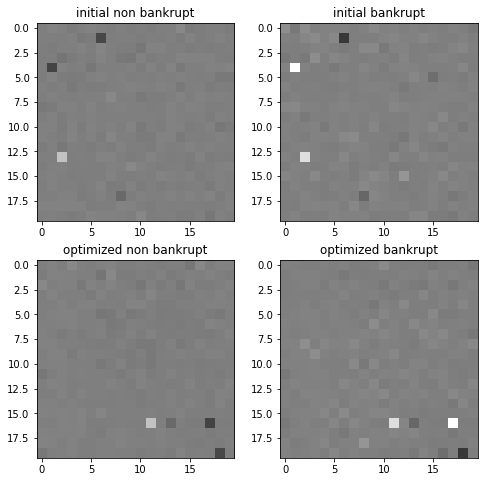


			-----FOLD 2 -----


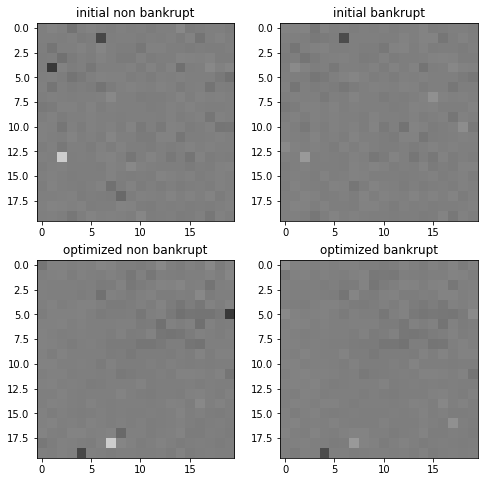


			-----FOLD 3 -----


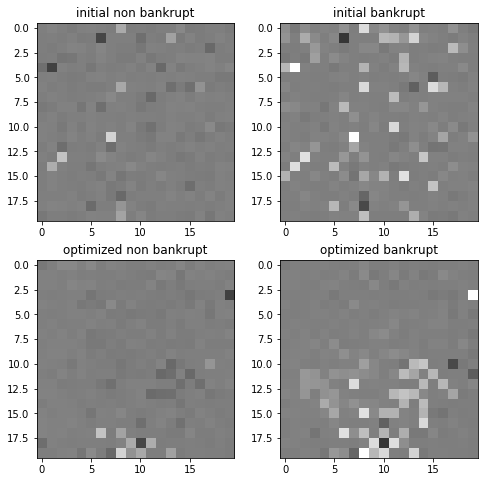


			-----FOLD 4 -----


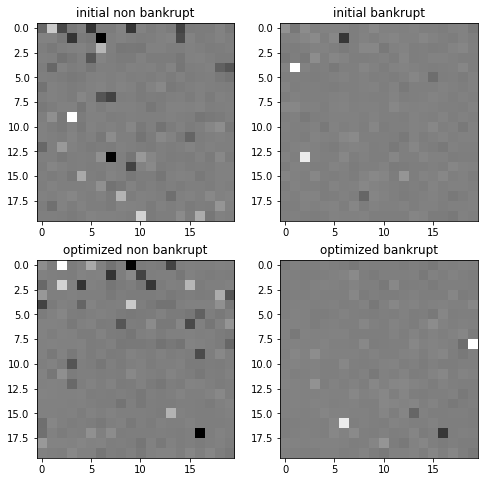


			-----FOLD 5 -----


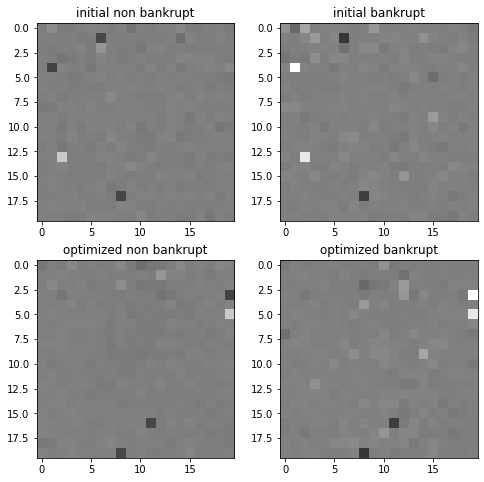


			-----FOLD 6 -----


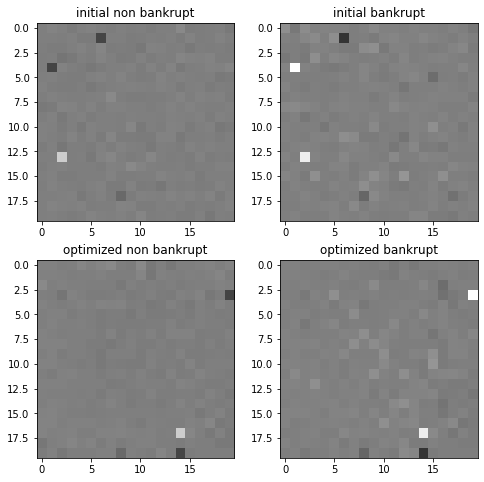

In [50]:
# printing images for normalization only
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t\t Normalization only")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=None, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

		 Normalization andquantile clipping

			-----FOLD 1 -----


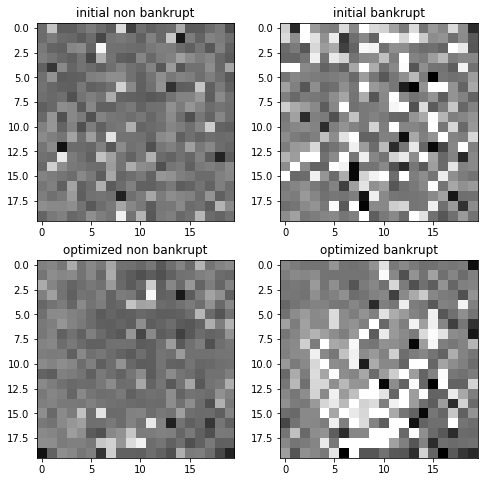


			-----FOLD 2 -----


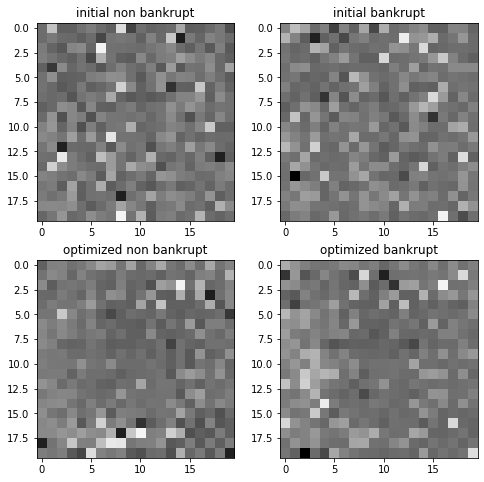


			-----FOLD 3 -----


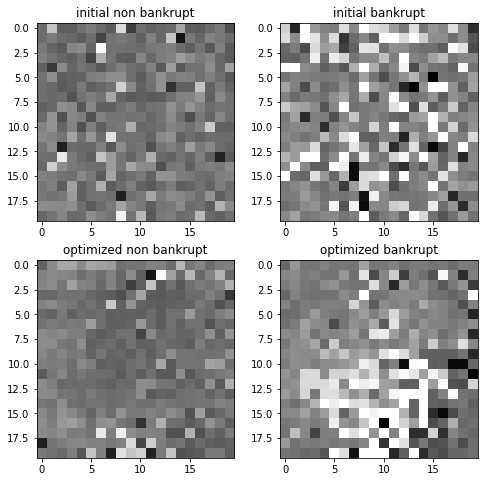


			-----FOLD 4 -----


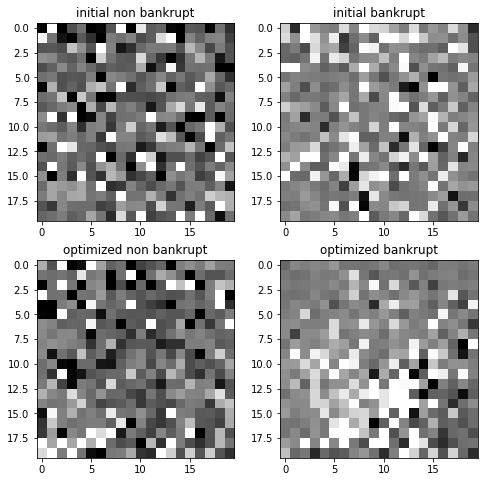


			-----FOLD 5 -----


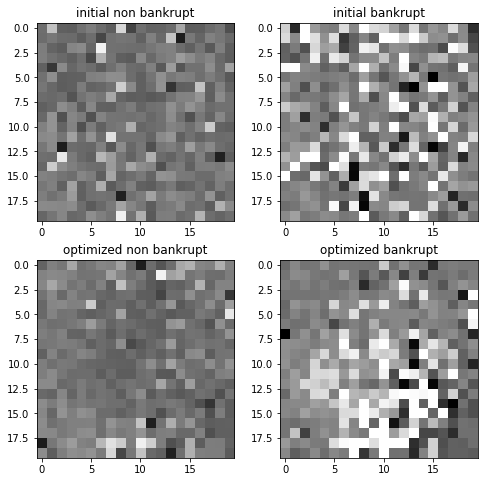


			-----FOLD 6 -----


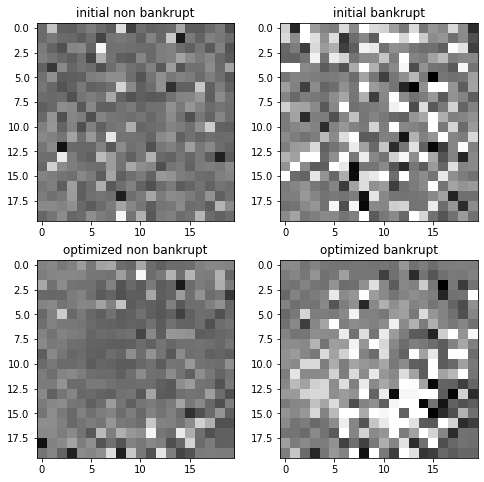

In [51]:
# printing images for normalization and quantile clipping
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t\t Normalization andquantile clipping")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=False)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

	 Normalization, quantile clipping and power transform

			-----FOLD 1 -----


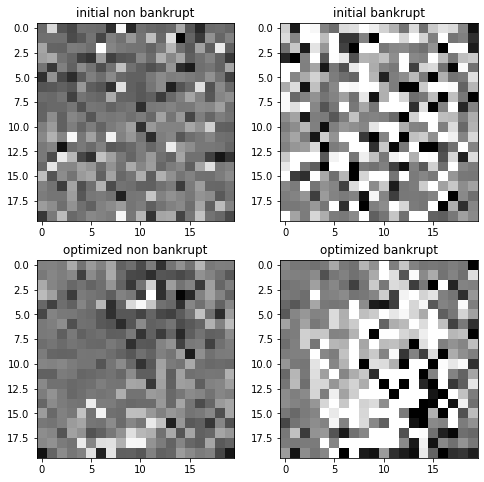


			-----FOLD 2 -----


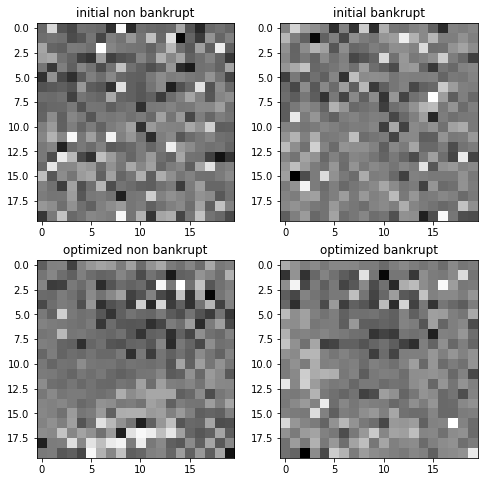


			-----FOLD 3 -----


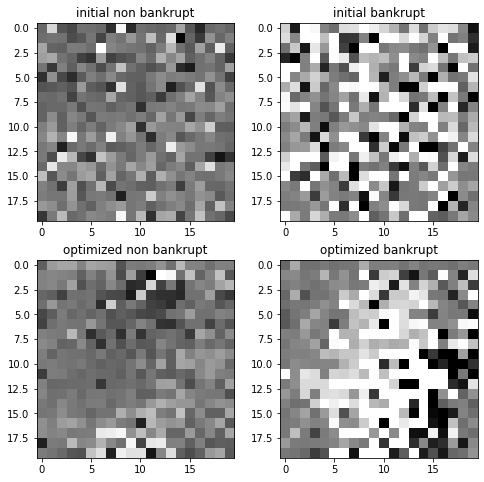


			-----FOLD 4 -----


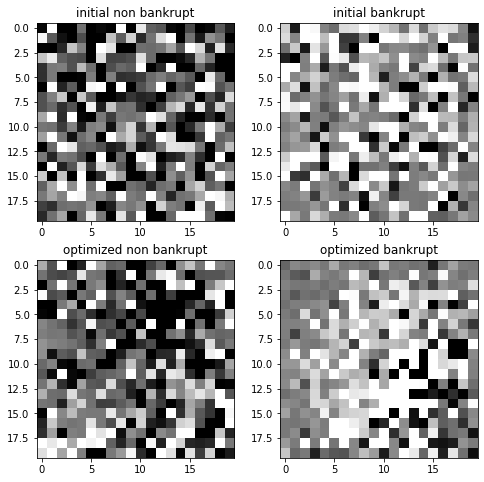


			-----FOLD 5 -----


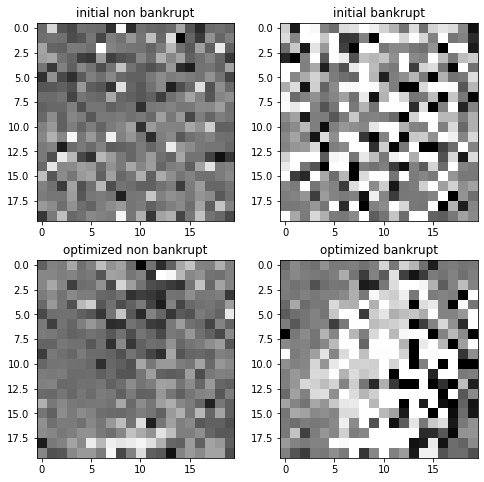


			-----FOLD 6 -----


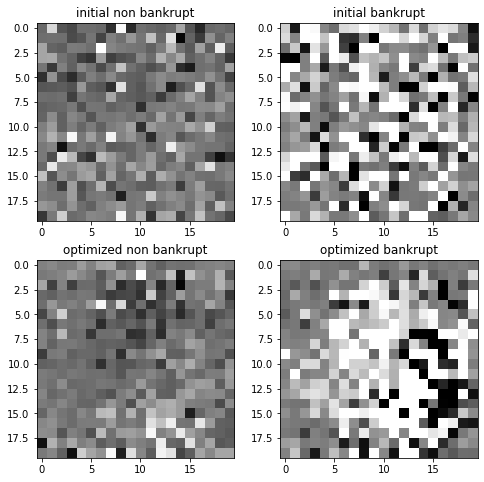

In [52]:
# printing images for normalization with quantile clipping and power transform
train_folds=sets["training_sets"]
valid_folds=sets["validation_sets"]

print("\t Normalization, quantile clipping and power transform")
for fold in range(len(train_folds)):
    print("\n\t\t\t-----FOLD {} -----".format(fold+1))
    # folds data extraction
    X_train_fold=generate_features(train_folds[fold][features].copy(), instruction)
    Y_train_fold=train_folds[fold][target].copy()
    
    sclr=scaler(images=True)
    sclr.fit(X=X_train_fold, q=0.005, power_transform=True)
    X_train_fold=pd.DataFrame(sclr.transform(X=X_train_fold),columns=X_train_fold.columns.tolist())
    
    fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
    ax[0,0].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,1].imshow(map_image(draft=drafts_20x20["initial_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,0].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==0,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[1,1].imshow(map_image(draft=drafts_20x20["optimized_drafts"][fold],example=X_train_fold.loc[Y_train_fold==1,:].iloc[0,:]),
                   cmap="gray",vmin=0,vmax=255)
    ax[0,0].set_title("initial non bankrupt")
    ax[0,1].set_title("initial bankrupt")
    ax[1,0].set_title("optimized non bankrupt")
    ax[1,1].set_title("optimized bankrupt")
    plt.show()

lets begin with the best 8x8 input model on 20x20 data
 - 150 epochs

The last try will be about the best 8x8 inception model


----------
Fold: 1
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7629 samples, validate on 1526 samples
Epoch: 1/300,
cumulative time: 21.39s train loss: 0.2845153851135012, validation loss: 0.20279261985425087
Epoch: 2/300,
cumulative time: 31.19s train loss: 0.20280542266932958, validation loss: 0.19162018007329062
Epoch: 3/300,
cumulative time: 40.53s train loss: 0.19629536029637476, validation loss: 0.1908268446925427
Epoch: 4/300,
cumulative time: 49.91s train loss: 0.18949062774793585, validation loss: 0.18557898670942724
Epoch: 5/300,
cumulative time: 59.25s train loss: 0.18790808439192258, validation loss: 0.18514770984180945
Epoch: 6/300,
cumulative time: 68.69s train loss: 0.18540134690218538, validation loss: 0.18646962243482607
Epoch: 7/300,
cumulative time: 78.07s train loss: 0.18450289757438623, validation loss: 0.17852329764500513
Epoch: 8/300,
cumulative time: 87.48s train loss: 0.18151952299636226, validation loss: 0.1784114754059368
Epoch: 9/300,
cumulative time: 96.8s train loss: 0.18312266441265962, validation loss: 0.17

Epoch: 76/300,
cumulative time: 721.78s train loss: 0.11617964952461435, validation loss: 0.1475788178715762
Epoch: 77/300,
cumulative time: 731.11s train loss: 0.11510263026924773, validation loss: 0.1495520278206034
Epoch: 78/300,
cumulative time: 740.72s train loss: 0.11585773038143786, validation loss: 0.14638182154684518
Epoch: 79/300,
cumulative time: 750.06s train loss: 0.11260927606729024, validation loss: 0.14666489775379238
Epoch: 80/300,
cumulative time: 759.23s train loss: 0.11349971048843503, validation loss: 0.14752446280042902
Epoch: 81/300,
cumulative time: 768.52s train loss: 0.11272490891408352, validation loss: 0.14457336927460188
Epoch: 82/300,
cumulative time: 777.76s train loss: 0.1097708250978137, validation loss: 0.15186645328842327
Epoch: 83/300,
cumulative time: 786.97s train loss: 0.10589903115890241, validation loss: 0.14770066631691797
Epoch: 84/300,
cumulative time: 796.27s train loss: 0.11212546235593279, validation loss: 0.16113057337105666
Epoch: 85/300

Epoch: 151/300,
cumulative time: 1416.18s train loss: 0.05639737307574165, validation loss: 0.2064433208377458
Epoch: 152/300,
cumulative time: 1425.45s train loss: 0.05904184365424092, validation loss: 0.2092374385887486
Epoch: 153/300,
cumulative time: 1434.69s train loss: 0.0547840801242342, validation loss: 0.2216797378670966
Epoch: 154/300,
cumulative time: 1443.89s train loss: 0.05682975479883484, validation loss: 0.22465466765557485
Epoch: 155/300,
cumulative time: 1453.14s train loss: 0.052612021714859104, validation loss: 0.21826327005266988
Epoch: 156/300,
cumulative time: 1462.32s train loss: 0.05607603302012813, validation loss: 0.21370107732312862
Epoch: 157/300,
cumulative time: 1471.63s train loss: 0.053619840918119804, validation loss: 0.22446315775614423
Epoch: 158/300,
cumulative time: 1480.84s train loss: 0.0525726718299002, validation loss: 0.20511432318199976
Epoch: 159/300,
cumulative time: 1490.43s train loss: 0.05340965920105832, validation loss: 0.2164345750802

Epoch: 225/300,
cumulative time: 2101.25s train loss: 0.037748260159611406, validation loss: 0.2808175638493829
Epoch: 226/300,
cumulative time: 2110.63s train loss: 0.03494705798597351, validation loss: 0.2952913981355815
Epoch: 227/300,
cumulative time: 2119.91s train loss: 0.040247355008526886, validation loss: 0.2646077234459111
Epoch: 228/300,
cumulative time: 2129.24s train loss: 0.05366932768518732, validation loss: 0.2950768886746773
Epoch: 229/300,
cumulative time: 2138.51s train loss: 0.046585767458245865, validation loss: 0.24236034888036911
Epoch: 230/300,
cumulative time: 2147.79s train loss: 0.042318383789160946, validation loss: 0.25748197197289174
Epoch: 231/300,
cumulative time: 2157.06s train loss: 0.036100438333191306, validation loss: 0.27238879217076584
Epoch: 232/300,
cumulative time: 2166.29s train loss: 0.03746101407556144, validation loss: 0.2875228662478346
Epoch: 233/300,
cumulative time: 2175.57s train loss: 0.04031441728406847, validation loss: 0.2708176032

Epoch: 299/300,
cumulative time: 2788.76s train loss: 0.03581161680609976, validation loss: 0.31364348663571306
Epoch: 300/300,
cumulative time: 2797.99s train loss: 0.035451604049715806, validation loss: 0.29453654171286214

Early stopping results:
best results in epoch: 139, 
best valid PR: 0.3930134844883897, 
valid ROC: 0.8256593906321055        
overfitting PR: 0.5711077383795097, 
overfitting ROC: 0.17059498695465036

----------
Fold: 2
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7629 samples, validate on 1526 samples
Epoch: 1/300,
cumulative time: 17.56s train loss: 0.2796955896886465, validation loss: 0.20216918731813818
Epoch: 2/300,
cumulative time: 26.91s train loss: 0.20258028172215342, validation loss: 0.19516120132346923
Epoch: 3/300,
cumulative time: 36.21s train loss: 0.19550591007193413, validation loss: 0.1867593707489936
Epoch: 4/300,
cumulative time: 45.5s train loss: 0.19155030757450528, validation loss: 0.1851923368470853
Epoch: 5/300,
cumulative time: 54.85s train loss: 0.18717053342746834, validation loss: 0.18081778373818252
Epoch: 6/300,
cumulative time: 64.1s train loss: 0.18570201131342468, validation loss: 0.17861600120601928
Epoch: 7/300,
cumulative time: 73.52s train loss: 0.18253066457846107, validation loss: 0.17915184358391192
Epoch: 8/300,
cumulative time: 82.81s train loss: 0.17996309118008205, validation loss: 0.17466258969485057
Epoch: 9/300,
cumulative time: 92.13s train loss: 0.18100497405499957, validation loss: 0.173

Epoch: 76/300,
cumulative time: 717.23s train loss: 0.10749906141529203, validation loss: 0.15436529593730192
Epoch: 77/300,
cumulative time: 726.57s train loss: 0.10892830644159833, validation loss: 0.15652029890064176
Epoch: 78/300,
cumulative time: 735.89s train loss: 0.10616788902106455, validation loss: 0.15575729116192027
Epoch: 79/300,
cumulative time: 745.54s train loss: 0.10247738252231905, validation loss: 0.18475597132080349
Epoch: 80/300,
cumulative time: 754.88s train loss: 0.10817716329086653, validation loss: 0.15731490453214508
Epoch: 81/300,
cumulative time: 764.13s train loss: 0.09948729463229253, validation loss: 0.16160428682207906
Epoch: 82/300,
cumulative time: 773.55s train loss: 0.10136970678223024, validation loss: 0.16897289833813164
Epoch: 83/300,
cumulative time: 782.73s train loss: 0.10161647326762811, validation loss: 0.16098801769208784
Epoch: 84/300,
cumulative time: 791.94s train loss: 0.09708483692471986, validation loss: 0.16308176201105432
Epoch: 85/

Epoch: 150/300,
cumulative time: 1407.15s train loss: 0.04547923321370951, validation loss: 0.2357564377323828
Epoch: 151/300,
cumulative time: 1416.47s train loss: 0.04675711619110185, validation loss: 0.25523370701629244
Epoch: 152/300,
cumulative time: 1425.83s train loss: 0.05100284580388877, validation loss: 0.2487390449131457
Epoch: 153/300,
cumulative time: 1435.18s train loss: 0.05658101346473157, validation loss: 0.24167820565197445
Epoch: 154/300,
cumulative time: 1444.48s train loss: 0.05353474991681973, validation loss: 0.2313742276139528
Epoch: 155/300,
cumulative time: 1453.75s train loss: 0.04763357515810264, validation loss: 0.24246598018496876
Epoch: 156/300,
cumulative time: 1463.01s train loss: 0.04631573021478305, validation loss: 0.2555016634075232
Epoch: 157/300,
cumulative time: 1472.39s train loss: 0.04452005642232958, validation loss: 0.24389766820683237
Epoch: 158/300,
cumulative time: 1481.69s train loss: 0.04702225433747255, validation loss: 0.24914791277789

Epoch: 224/300,
cumulative time: 2096.96s train loss: 0.03619348341719963, validation loss: 0.2889115513347548
Epoch: 225/300,
cumulative time: 2106.41s train loss: 0.04178834730471895, validation loss: 0.3144556391364156
Epoch: 226/300,
cumulative time: 2115.62s train loss: 0.043219866385632875, validation loss: 0.2901002699472645
Epoch: 227/300,
cumulative time: 2124.83s train loss: 0.04102728450650085, validation loss: 0.30722637316346324
Epoch: 228/300,
cumulative time: 2134.1s train loss: 0.03384649239554718, validation loss: 0.2865483547960009
Epoch: 229/300,
cumulative time: 2143.41s train loss: 0.03674591207765224, validation loss: 0.3131004060627124
Epoch: 230/300,
cumulative time: 2152.72s train loss: 0.031913985496662536, validation loss: 0.29653795366205987
Epoch: 231/300,
cumulative time: 2162.01s train loss: 0.03412432582610196, validation loss: 0.33237368192616484
Epoch: 232/300,
cumulative time: 2171.23s train loss: 0.0355623780524751, validation loss: 0.294781925950106

Epoch: 298/300,
cumulative time: 2785.05s train loss: 0.036828735696076406, validation loss: 0.3076221848182566
Epoch: 299/300,
cumulative time: 2794.29s train loss: 0.028805394455163533, validation loss: 0.3190222363211068
Epoch: 300/300,
cumulative time: 2803.61s train loss: 0.0304070204393351, validation loss: 0.3313036351458586

Early stopping results:
best results in epoch: 297, 
best valid PR: 0.3126800786247808, 
valid ROC: 0.8592030468394726        
overfitting PR: 0.686902632283179, 
overfitting ROC: 0.14077967022060833

----------
Fold: 3
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7629 samples, validate on 1526 samples
Epoch: 1/300,
cumulative time: 18.69s train loss: 0.27415697643994064, validation loss: 0.21124111199910175
Epoch: 2/300,
cumulative time: 28.3s train loss: 0.20145274412000705, validation loss: 0.19202534514595296
Epoch: 3/300,
cumulative time: 37.78s train loss: 0.19195128457740618, validation loss: 0.18719464632271157
Epoch: 4/300,
cumulative time: 47.19s train loss: 0.19121669450630005, validation loss: 0.18435836303124734
Epoch: 5/300,
cumulative time: 56.65s train loss: 0.1870262155816914, validation loss: 0.18119772934741774
Epoch: 6/300,
cumulative time: 66.15s train loss: 0.18437625053498016, validation loss: 0.18075132028225366
Epoch: 7/300,
cumulative time: 75.55s train loss: 0.18277977563041364, validation loss: 0.1779780864793695
Epoch: 8/300,
cumulative time: 85.01s train loss: 0.18320946349691697, validation loss: 0.17725526019052004
Epoch: 9/300,
cumulative time: 94.43s train loss: 0.18111354318495143, validation loss: 0.1

Epoch: 76/300,
cumulative time: 732.11s train loss: 0.1170844600133931, validation loss: 0.15062006739692013
Epoch: 77/300,
cumulative time: 741.7s train loss: 0.1172717116125634, validation loss: 0.16711656308853767
Epoch: 78/300,
cumulative time: 751.34s train loss: 0.11573514181752867, validation loss: 0.15279742689659212
Epoch: 79/300,
cumulative time: 760.92s train loss: 0.11209457629488562, validation loss: 0.15000524893305406
Epoch: 80/300,
cumulative time: 770.47s train loss: 0.11369237487532392, validation loss: 0.15042283967000628
Epoch: 81/300,
cumulative time: 779.92s train loss: 0.11708316976014807, validation loss: 0.15194226411777897
Epoch: 82/300,
cumulative time: 789.38s train loss: 0.11510294572892016, validation loss: 0.15293118734581598
Epoch: 83/300,
cumulative time: 798.84s train loss: 0.10791441216441779, validation loss: 0.15401634598348588
Epoch: 84/300,
cumulative time: 808.24s train loss: 0.1087349847360502, validation loss: 0.1499353157524825
Epoch: 85/300,


Epoch: 150/300,
cumulative time: 1431.97s train loss: 0.05841327497000962, validation loss: 0.2357003541948911
Epoch: 151/300,
cumulative time: 1441.34s train loss: 0.05255876991178546, validation loss: 0.24528002155014603
Epoch: 152/300,
cumulative time: 1450.78s train loss: 0.04685360312643503, validation loss: 0.24435104833986626
Epoch: 153/300,
cumulative time: 1460.08s train loss: 0.04680676309926308, validation loss: 0.24279824502736838
Epoch: 154/300,
cumulative time: 1469.4s train loss: 0.04662348215366538, validation loss: 0.23959414850368724
Epoch: 155/300,
cumulative time: 1478.74s train loss: 0.04736104841627398, validation loss: 0.23380417127752992
Epoch: 156/300,
cumulative time: 1488.2s train loss: 0.048555602069891894, validation loss: 0.23820620607267357
Epoch: 157/300,
cumulative time: 1497.98s train loss: 0.045039454171074404, validation loss: 0.2398940794277316
Epoch: 158/300,
cumulative time: 1507.45s train loss: 0.04663228231772384, validation loss: 0.238190137504

Epoch: 224/300,
cumulative time: 2130.15s train loss: 0.03238217161814778, validation loss: 0.3291682645502753
Epoch: 225/300,
cumulative time: 2139.55s train loss: 0.03192008547519056, validation loss: 0.3075990674341022
Epoch: 226/300,
cumulative time: 2148.95s train loss: 0.03250824663358859, validation loss: 0.3188510337553987
Epoch: 227/300,
cumulative time: 2158.34s train loss: 0.029612022398953077, validation loss: 0.3124202752722669
Epoch: 228/300,
cumulative time: 2167.81s train loss: 0.030930921847242675, validation loss: 0.31220873577097924
Epoch: 229/300,
cumulative time: 2177.31s train loss: 0.026601527968556107, validation loss: 0.33144961270170475
Epoch: 230/300,
cumulative time: 2186.69s train loss: 0.028186633261495626, validation loss: 0.3087686936360043
Epoch: 231/300,
cumulative time: 2196.06s train loss: 0.031956329914892716, validation loss: 0.3421687646665236
Epoch: 232/300,
cumulative time: 2205.51s train loss: 0.03715113918607678, validation loss: 0.34844204095

Epoch: 298/300,
cumulative time: 2827.49s train loss: 0.028855911593872997, validation loss: 0.33020128077323285
Epoch: 299/300,
cumulative time: 2836.84s train loss: 0.02722559235589636, validation loss: 0.319748988079681
Epoch: 300/300,
cumulative time: 2846.57s train loss: 0.028616593480950057, validation loss: 0.3504808878289294

Early stopping results:
best results in epoch: 136, 
best valid PR: 0.3723510563551916, 
valid ROC: 0.8234708958617554        
overfitting PR: 0.606935743238395, 
overfitting ROC: 0.1747989908895068

----------
Fold: 4
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7629 samples, validate on 1526 samples
Epoch: 1/300,
cumulative time: 18.72s train loss: 0.28134602404372033, validation loss: 0.1992037449212718
Epoch: 2/300,
cumulative time: 28.36s train loss: 0.2061432527283226, validation loss: 0.19320493497120445
Epoch: 3/300,
cumulative time: 37.88s train loss: 0.1967186577542923, validation loss: 0.18591796488624412
Epoch: 4/300,
cumulative time: 47.44s train loss: 0.19046622984280262, validation loss: 0.18675173651109672
Epoch: 5/300,
cumulative time: 57.0s train loss: 0.18933592332598578, validation loss: 0.18303912370264297
Epoch: 6/300,
cumulative time: 66.51s train loss: 0.1862001421274528, validation loss: 0.18348602151808233
Epoch: 7/300,
cumulative time: 76.04s train loss: 0.185773366544362, validation loss: 0.18106475800549218
Epoch: 8/300,
cumulative time: 85.63s train loss: 0.18485189609445396, validation loss: 0.18555555606888288
Epoch: 9/300,
cumulative time: 95.26s train loss: 0.18381629393885623, validation loss: 0.17782

Epoch: 76/300,
cumulative time: 738.42s train loss: 0.10896118731576222, validation loss: 0.13670039811656173
Epoch: 77/300,
cumulative time: 747.9s train loss: 0.10800538111274466, validation loss: 0.13820657610580775
Epoch: 78/300,
cumulative time: 757.49s train loss: 0.10625703927085071, validation loss: 0.13988599772925145
Epoch: 79/300,
cumulative time: 767.09s train loss: 0.10920538304810412, validation loss: 0.1350668181285633
Epoch: 80/300,
cumulative time: 776.69s train loss: 0.10575561329911867, validation loss: 0.14329250592391737
Epoch: 81/300,
cumulative time: 786.32s train loss: 0.09973687258338941, validation loss: 0.13954437427408262
Epoch: 82/300,
cumulative time: 795.82s train loss: 0.09903795604160313, validation loss: 0.1348388216715809
Epoch: 83/300,
cumulative time: 805.36s train loss: 0.0991469863643495, validation loss: 0.13824743471873696
Epoch: 84/300,
cumulative time: 814.91s train loss: 0.09977928430685788, validation loss: 0.13907279289018748
Epoch: 85/300,

Epoch: 150/300,
cumulative time: 1448.05s train loss: 0.0481111360094911, validation loss: 0.19085946759187067
Epoch: 151/300,
cumulative time: 1457.8s train loss: 0.0468145029770467, validation loss: 0.1865273910339038
Epoch: 152/300,
cumulative time: 1467.45s train loss: 0.0505072613031762, validation loss: 0.19670238479639882
Epoch: 153/300,
cumulative time: 1476.96s train loss: 0.05176461605690366, validation loss: 0.21300877533062101
Epoch: 154/300,
cumulative time: 1486.52s train loss: 0.043852497928400215, validation loss: 0.18771736216420115
Epoch: 155/300,
cumulative time: 1496.03s train loss: 0.04331537238400938, validation loss: 0.19266062715184798
Epoch: 156/300,
cumulative time: 1505.58s train loss: 0.04842757876058568, validation loss: 0.18344199493390703
Epoch: 157/300,
cumulative time: 1515.07s train loss: 0.04571207164463131, validation loss: 0.19786644341280077
Epoch: 158/300,
cumulative time: 1524.58s train loss: 0.03945243403145614, validation loss: 0.20000136375114

Epoch: 224/300,
cumulative time: 2155.6s train loss: 0.04235510347463041, validation loss: 0.23445177816469734
Epoch: 225/300,
cumulative time: 2165.15s train loss: 0.04371369976698297, validation loss: 0.21347043689628417
Epoch: 226/300,
cumulative time: 2174.72s train loss: 0.04510630198337723, validation loss: 0.2148229504592453
Epoch: 227/300,
cumulative time: 2184.23s train loss: 0.04034268346061274, validation loss: 0.2158624516753663
Epoch: 228/300,
cumulative time: 2193.79s train loss: 0.037200055667794316, validation loss: 0.20640537650525803
Epoch: 229/300,
cumulative time: 2203.62s train loss: 0.03826274024780416, validation loss: 0.23916425656522397
Epoch: 230/300,
cumulative time: 2213.15s train loss: 0.032114935740252315, validation loss: 0.21550218261006931
Epoch: 231/300,
cumulative time: 2222.67s train loss: 0.033968257632212506, validation loss: 0.22165062134965843
Epoch: 232/300,
cumulative time: 2232.23s train loss: 0.029810473578008496, validation loss: 0.227751292

Epoch: 298/300,
cumulative time: 2862.39s train loss: 0.027017409337650573, validation loss: 0.2583462413922831
Epoch: 299/300,
cumulative time: 2871.87s train loss: 0.027574543364718117, validation loss: 0.26185426233167886
Epoch: 300/300,
cumulative time: 2881.44s train loss: 0.025005529255118293, validation loss: 0.2536914371647341

Early stopping results:
best results in epoch: 187, 
best valid PR: 0.4586895218125612, 
valid ROC: 0.8739597544338336        
overfitting PR: 0.5381693994969373, 
overfitting ROC: 0.12588242503585312

----------
Fold: 5
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7629 samples, validate on 1526 samples
Epoch: 1/300,
cumulative time: 19.05s train loss: 0.2841644773911892, validation loss: 0.20317805965637317
Epoch: 2/300,
cumulative time: 29.14s train loss: 0.20282591856515084, validation loss: 0.19308973717970743
Epoch: 3/300,
cumulative time: 38.97s train loss: 0.19301150930413788, validation loss: 0.18890868834321184
Epoch: 4/300,
cumulative time: 48.6s train loss: 0.19076599077763384, validation loss: 0.18677471939420637
Epoch: 5/300,
cumulative time: 58.26s train loss: 0.18793560978406565, validation loss: 0.18609106888308594
Epoch: 6/300,
cumulative time: 67.9s train loss: 0.18636556430090487, validation loss: 0.19846859709072864
Epoch: 7/300,
cumulative time: 77.57s train loss: 0.18527433240823063, validation loss: 0.18367220797279402
Epoch: 8/300,
cumulative time: 87.3s train loss: 0.18242039127249224, validation loss: 0.18667491836910322
Epoch: 9/300,
cumulative time: 96.9s train loss: 0.18147312751805772, validation loss: 0.187

Epoch: 76/300,
cumulative time: 747.57s train loss: 0.11544499424115158, validation loss: 0.13998862106943818
Epoch: 77/300,
cumulative time: 757.26s train loss: 0.10623973942799905, validation loss: 0.1392378166493707
Epoch: 78/300,
cumulative time: 766.8s train loss: 0.11195380595872936, validation loss: 0.13855935976905248
Epoch: 79/300,
cumulative time: 776.72s train loss: 0.1060125424775302, validation loss: 0.15272970829613086
Epoch: 80/300,
cumulative time: 786.47s train loss: 0.1046327222829597, validation loss: 0.13753043884609192
Epoch: 81/300,
cumulative time: 796.25s train loss: 0.1098747094132388, validation loss: 0.13941677381451759
Epoch: 82/300,
cumulative time: 805.92s train loss: 0.10503349477333172, validation loss: 0.14420078952612445
Epoch: 83/300,
cumulative time: 815.58s train loss: 0.10665158782120629, validation loss: 0.13912105913790307
Epoch: 84/300,
cumulative time: 825.28s train loss: 0.10174374841178037, validation loss: 0.14209296279934724
Epoch: 85/300,


Epoch: 150/300,
cumulative time: 1479.09s train loss: 0.048819594310814125, validation loss: 0.19180734789543352
Epoch: 151/300,
cumulative time: 1489.19s train loss: 0.04985304766583996, validation loss: 0.20079206730950708
Epoch: 152/300,
cumulative time: 1499.14s train loss: 0.048064064816556513, validation loss: 0.20380760053585273
Epoch: 153/300,
cumulative time: 1508.96s train loss: 0.04359979616732737, validation loss: 0.20329433595602978
Epoch: 154/300,
cumulative time: 1518.82s train loss: 0.04504615752968138, validation loss: 0.2120007075183826
Epoch: 155/300,
cumulative time: 1529.18s train loss: 0.04683871054722794, validation loss: 0.22649456564517664
Epoch: 156/300,
cumulative time: 1539.3s train loss: 0.04817782859257531, validation loss: 0.19880327920223126
Epoch: 157/300,
cumulative time: 1549.33s train loss: 0.048819174962468626, validation loss: 0.2096012525289743
Epoch: 158/300,
cumulative time: 1559.45s train loss: 0.05143740222244764, validation loss: 0.2002595018

Epoch: 224/300,
cumulative time: 2220.01s train loss: 0.0392562712077967, validation loss: 0.2249240293844968
Epoch: 225/300,
cumulative time: 2229.64s train loss: 0.0442141886253136, validation loss: 0.2411369156790592
Epoch: 226/300,
cumulative time: 2239.33s train loss: 0.039008570618918686, validation loss: 0.24462038458252952
Epoch: 227/300,
cumulative time: 2248.94s train loss: 0.03254493983062774, validation loss: 0.2431984068056859
Epoch: 228/300,
cumulative time: 2258.6s train loss: 0.0319324280030958, validation loss: 0.26942100027285587
Epoch: 229/300,
cumulative time: 2268.22s train loss: 0.03510616866849497, validation loss: 0.2635685834315939
Epoch: 230/300,
cumulative time: 2278.21s train loss: 0.03512763952635456, validation loss: 0.2551326181051147
Epoch: 231/300,
cumulative time: 2287.88s train loss: 0.037602897301298684, validation loss: 0.2501459352545157
Epoch: 232/300,
cumulative time: 2297.61s train loss: 0.03887464329092495, validation loss: 0.24872012981268557


Epoch: 298/300,
cumulative time: 2938.27s train loss: 0.031621561260562626, validation loss: 0.28711162642288957
Epoch: 299/300,
cumulative time: 2947.99s train loss: 0.029991812574307154, validation loss: 0.2619609088291503
Epoch: 300/300,
cumulative time: 2957.73s train loss: 0.03551525664991282, validation loss: 0.29049096421520487

Early stopping results:
best results in epoch: 171, 
best valid PR: 0.45115173975118406, 
valid ROC: 0.8485277398817644        
overfitting PR: 0.538055624355276, 
overfitting ROC: 0.15076729809522205

----------
Fold: 6
----------


C:\Users\maciej\anaconda3\lib\site-packages\ipykernel_launcher.py:77: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Train on 7630 samples, validate on 1525 samples
Epoch: 1/300,
cumulative time: 18.81s train loss: 0.2874768783427472, validation loss: 0.20245243271843333
Epoch: 2/300,
cumulative time: 28.9s train loss: 0.2021102349653469, validation loss: 0.18863316383518156
Epoch: 3/300,
cumulative time: 38.81s train loss: 0.19546246107565154, validation loss: 0.1856321853301564
Epoch: 4/300,
cumulative time: 48.69s train loss: 0.1915659239767107, validation loss: 0.18209289157976868
Epoch: 5/300,
cumulative time: 58.61s train loss: 0.18917098749980701, validation loss: 0.1801302597464108
Epoch: 6/300,
cumulative time: 68.6s train loss: 0.1886231327041261, validation loss: 0.18176510086802186
Epoch: 7/300,
cumulative time: 78.53s train loss: 0.18641307825029754, validation loss: 0.17861151789055496
Epoch: 8/300,
cumulative time: 88.4s train loss: 0.18459058654339566, validation loss: 0.18053273661214797
Epoch: 9/300,
cumulative time: 98.29s train loss: 0.1824654458586229, validation loss: 0.17854768

Epoch: 76/300,
cumulative time: 759.68s train loss: 0.11216415958784198, validation loss: 0.14569246652673504
Epoch: 77/300,
cumulative time: 769.65s train loss: 0.10801141420049717, validation loss: 0.14551516807470166
Epoch: 78/300,
cumulative time: 779.65s train loss: 0.10652242234735938, validation loss: 0.14628468785129609
Epoch: 79/300,
cumulative time: 789.59s train loss: 0.11209037296307978, validation loss: 0.15094152074368275
Epoch: 80/300,
cumulative time: 799.4s train loss: 0.11154147962286463, validation loss: 0.15427029106460635
Epoch: 81/300,
cumulative time: 809.33s train loss: 0.10794387664035607, validation loss: 0.15665072202682495
Epoch: 82/300,
cumulative time: 819.15s train loss: 0.10581859846258851, validation loss: 0.15308023273944854
Epoch: 83/300,
cumulative time: 828.99s train loss: 0.10636056397173695, validation loss: 0.15375481770663965
Epoch: 84/300,
cumulative time: 838.84s train loss: 0.10622339558007676, validation loss: 0.14588663749030378
Epoch: 85/3

Epoch: 150/300,
cumulative time: 1490.52s train loss: 0.06384138283301462, validation loss: 0.21653972363862836
Epoch: 151/300,
cumulative time: 1500.3s train loss: 0.05677124191353862, validation loss: 0.20004345842072221
Epoch: 152/300,
cumulative time: 1510.2s train loss: 0.05385570261544435, validation loss: 0.22545323158873887
Epoch: 153/300,
cumulative time: 1520.2s train loss: 0.055760288694543886, validation loss: 0.2401073171369365
Epoch: 154/300,
cumulative time: 1530.19s train loss: 0.05898969325079518, validation loss: 0.21324638687196326
Epoch: 155/300,
cumulative time: 1540.11s train loss: 0.05729712286517317, validation loss: 0.20700008540857034
Epoch: 156/300,
cumulative time: 1549.96s train loss: 0.058675958670255865, validation loss: 0.21970762593824356
Epoch: 157/300,
cumulative time: 1559.85s train loss: 0.05708532529159267, validation loss: 0.23178019593973628
Epoch: 158/300,
cumulative time: 1569.75s train loss: 0.05646342801547769, validation loss: 0.226096621390

Epoch: 224/300,
cumulative time: 2219.74s train loss: 0.0507121928680693, validation loss: 0.27218636178579486
Epoch: 225/300,
cumulative time: 2229.56s train loss: 0.058188869552210774, validation loss: 0.24979399708450817
Epoch: 226/300,
cumulative time: 2239.32s train loss: 0.051242437297637, validation loss: 0.2637907952949649
Epoch: 227/300,
cumulative time: 2249.14s train loss: 0.04497528720456682, validation loss: 0.2490783547377977
Epoch: 228/300,
cumulative time: 2258.89s train loss: 0.04237367606832894, validation loss: 0.2739636927940806
Epoch: 229/300,
cumulative time: 2268.8s train loss: 0.04122100738640069, validation loss: 0.2592968541481456
Epoch: 230/300,
cumulative time: 2278.81s train loss: 0.03944485548341727, validation loss: 0.26963706374168395
Epoch: 231/300,
cumulative time: 2288.6s train loss: 0.03632995167437106, validation loss: 0.27086730187056496
Epoch: 232/300,
cumulative time: 2298.38s train loss: 0.038672773272463094, validation loss: 0.309960818466593
E

Epoch: 298/300,
cumulative time: 2949.24s train loss: 0.03292859235331709, validation loss: 0.322957637153688
Epoch: 299/300,
cumulative time: 2959.15s train loss: 0.03149749810659713, validation loss: 0.32065871357917786
Epoch: 300/300,
cumulative time: 2968.96s train loss: 0.03472950100156614, validation loss: 0.31990573947546913

Early stopping results:
best results in epoch: 107, 
best valid PR: 0.3728506924893928, 
valid ROC: 0.8492320819112629        
overfitting PR: 0.5148344849515636, 
overfitting ROC: 0.1402326747963315

Cross validation time: 17530s
ROC: 		0.8466754849266991
PR: 		0.3934560955869167
overfittingROC: 0.1505093409986954
overfittingPR:  0.5760009371174766
early stopping: [139, 297, 136, 187, 171, 107]

Fold 1------------------------------------------------------------


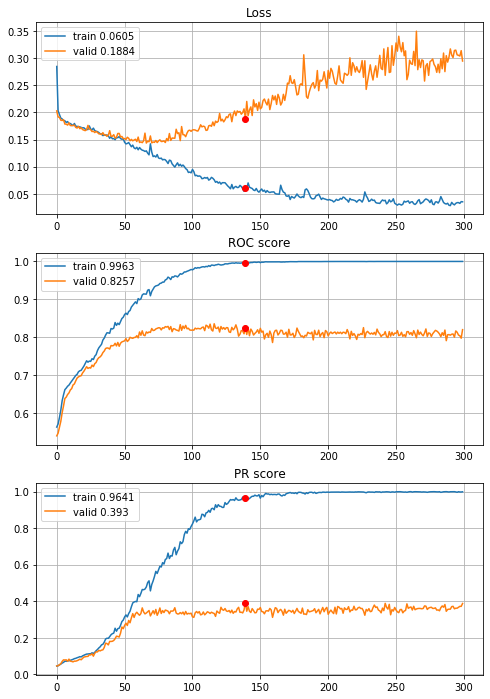


Fold 2------------------------------------------------------------


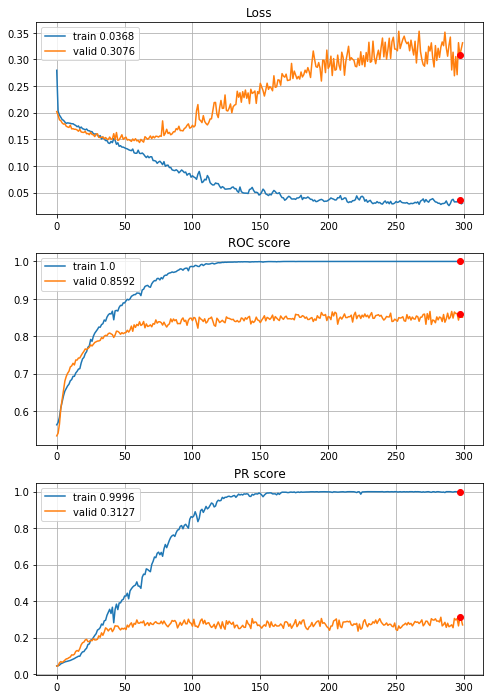


Fold 3------------------------------------------------------------


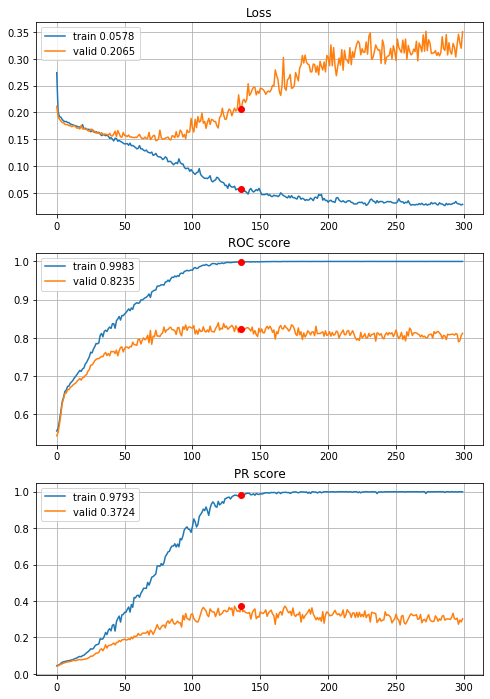


Fold 4------------------------------------------------------------


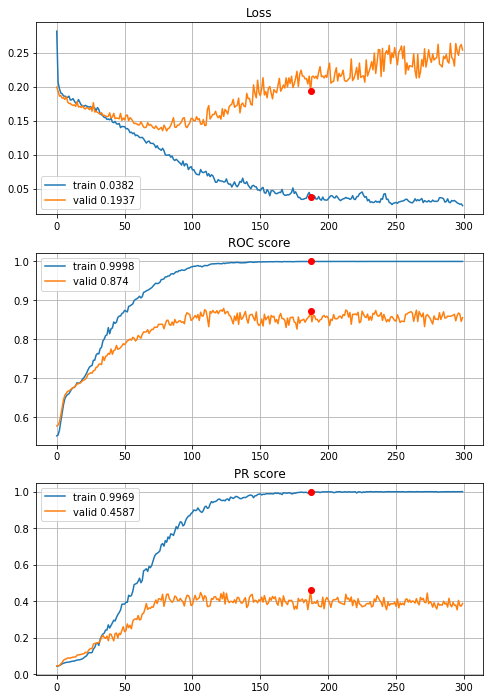


Fold 5------------------------------------------------------------


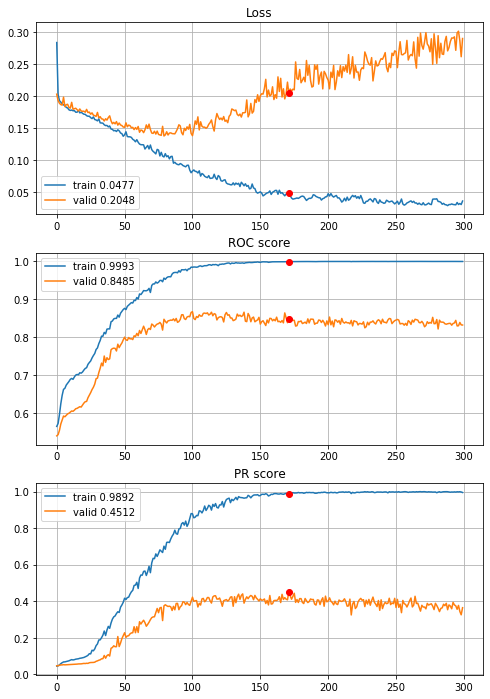


Fold 6------------------------------------------------------------


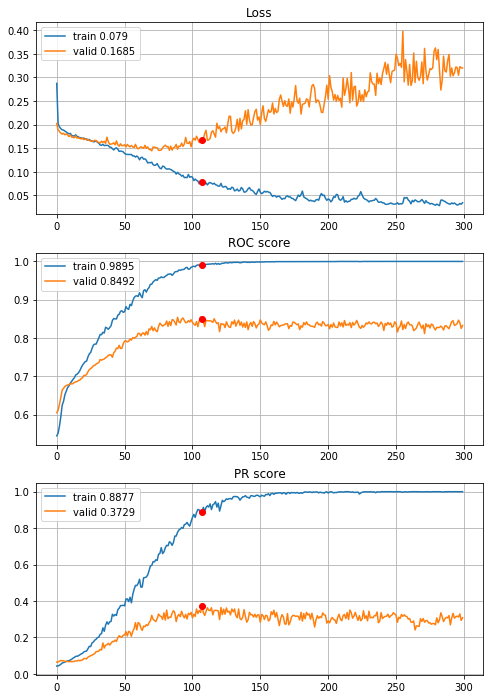

In [74]:
CNNhistories = CNN_6FoldCrossValidation(datasets=sets, model_definition=define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02, features=features,
                                        target=target, n_epochs=300, batch_size=394, alpha=3,
                                        drafts=drafts_20x20["optimized_drafts"],
                                        instruction=instruction, random_state=random_state, normalize="power", q=0.005, info=2)

roc, pr, oroc, opr, stops = network_CV_results(CNNhistories)
print("ROC: \t\t{}\nPR: \t\t{}\noverfittingROC: {}\noverfittingPR:  {}\nearly stopping: {}".format(roc,pr,oroc,opr,stops))
for i in range(len(CNNhistories)):
    print("\nFold {}{}".format(i+1,"-"*60))
    plot_network_training(CNNhistories[i])
    
with open(r"results\2year\define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02_20x20_300ep.p", "wb") as fp:
    pickle.dump(CNNhistories, fp)

Standard convolutional archutecture achived higher AUC-PR, and slightly higher AUC-ROC, but much bigger overfitting also. Lets check wilcoxon tests.

##### End

In [65]:
# LOADING 8x8 CNN
with open(r"results\2year\define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02_400ep.p", "rb") as fp:
    CNN_8x8_CV = pickle.load(fp)

# LOADING 20x20 CNN
with open(r"results\2year\define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02_20x20_300ep.p", "rb") as fp:
    CNN_20x20_CV = pickle.load(fp)
    
# LOADING MLP
with open(r"results\2year\MLP_L2_8000ep.p", "rb") as fp:
    MLP_CV = pickle.load(fp)

# TRAINING XGB
XGB_CV = XGB_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                  normalize=False, q=0.005, n_estimators=1000, early_stopping_rounds=50,
                                  max_depth=5, learning_rate=0.1, subsample=0.8, colsample_bytree=0.8, gamma=4, 
                                  reg_alpha=0.4, reg_lambda=1, saveModels=False)
# TRAINING RF
RF_CV = RF_6FoldCrossValidation(datasets=sets, features=features, target=target, random_state=random_state, info=0,
                                normalize=True, q=0.005, saveModels=False, max_depth=12, n_estimators=600,
                                max_features=55, min_samples_split=10, min_samples_leaf=9)
# TRAINING LOGIT
logit_CV = Logit_6FoldCrossValidation(datasets=sets,features=features,target=target,random_state=random_state,
                                      normalize="power", q=0.005, alpha=0.5, info=0)


Cross validation time: 31s

Cross validation time: 823s

Cross validation time: 19s


 - CV results extraction

In [67]:
# 8x8 CNN
CNN_8x8_roc_valid, CNN_8x8_pr_valid, CNN_8x8_roc_train, CNN_8x8_pr_train, CNN_8x8_es=network_CV_results(network_history=CNN_8x8_CV,mean=False)
# 20x20 CNN
CNN_20x20_roc_valid, CNN_20x20_pr_valid, CNN_20x20_roc_train, CNN_20x20_pr_train, CNN_20x20_es = network_CV_results(network_history=CNN_20x20_CV,mean=False)
# MLP
MLP_roc_valid, MLP_pr_valid, MLP_roc_train, MLP_pr_train, MLP_es = network_CV_results(network_history=MLP_CV,mean=False)
# XGB
XGB_roc_valid, XGB_pr_valid, XGB_roc_train, XGB_pr_train, XGB_es = XGB_CV_results(XGB_history=XGB_CV,mean=False)

# RF
RF_roc_valid = RF_CV["valid_roc"]
RF_pr_valid = RF_CV["valid_pr"]
RF_roc_train = RF_CV["train_roc"]
RF_pr_train = RF_CV["train_pr"]

# logit
logit_roc_valid = logit_CV["valid_roc"]
logit_pr_valid = logit_CV["valid_pr"]
logit_roc_train = logit_CV["train_roc"]
logit_pr_train = logit_CV["train_pr"]

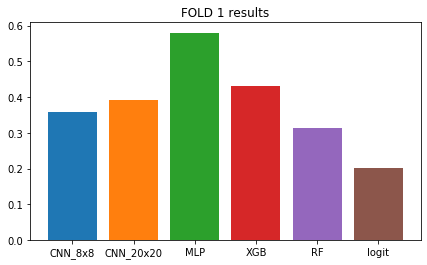

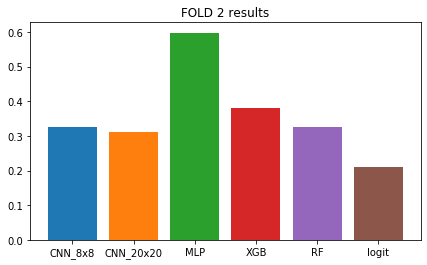

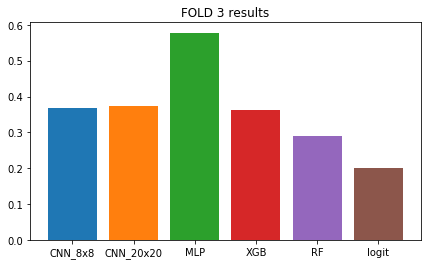

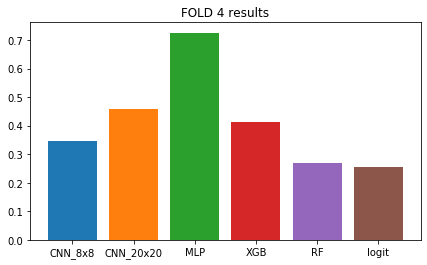

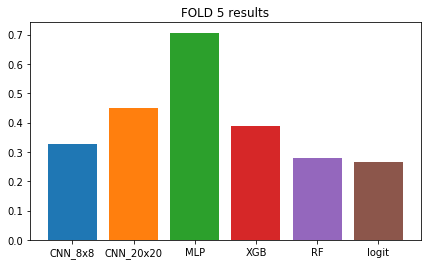

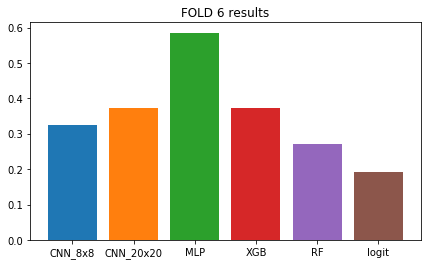

CNN_8x8 mean: 0.3416979422128645
CNN_20x20 mean: 0.3934560955869167
MLP mean: 0.628888104528244
XGB mean: 0.39240499999999995
RF mean: 0.2915932219409789
Logit mean: 0.2209915839390287


In [71]:
for i in range(len(sets["training_sets"])):
    fig, ax = plt.subplots(figsize=(7,4))
    plt.bar(x="CNN_8x8", height=CNN_8x8_pr_valid[i])
    plt.bar(x="CNN_20x20", height=CNN_20x20_pr_valid[i])
    plt.bar(x="MLP", height=MLP_pr_valid[i])
    plt.bar(x="XGB", height=XGB_pr_valid[i])
    plt.bar(x="RF", height=RF_pr_valid[i])
    plt.bar(x="logit", height=logit_pr_valid[i])
    plt.title("FOLD {} results".format(i+1))
    plt.show()

print("CNN_8x8 mean: {}\nCNN_20x20 mean: {}\nMLP mean: {}\nXGB mean: {}\nRF mean: {}\nLogit mean: {}".format(
np.mean(CNN_8x8_pr_valid), np.mean(CNN_20x20_pr_valid), np.mean(MLP_pr_valid), np.mean(XGB_pr_valid), np.mean(RF_pr_valid),
np.mean(logit_pr_valid)))

 - wilcoxon median equality test

In [73]:
CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid = wilcoxon(
    x=np.array(CNN_20x20_pr_valid), y=np.array(CNN_8x8_pr_valid), alternative="greater")[1]
CNN_20x20_pr_valid_greater_XGB_pr_valid = wilcoxon(
    x=np.array(CNN_20x20_pr_valid), y=np.array(XGB_pr_valid), alternative="greater")[1]
print("Wilcoxon tests p values, H0: median(A)==median(B)")
print("HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid):", CNN_20x20_pr_valid_greater_CNN_8x8_pr_valid)
print("HA median(CNN_20x20_pr_valid) > median(XGB_pr_valid):", CNN_20x20_pr_valid_greater_XGB_pr_valid)

Wilcoxon tests p values, H0: median(A)==median(B)
HA median(CNN_20x20_pr_valid) > median(CNN_8x8_pr_valid): 0.03736774915294124
HA median(CNN_20x20_pr_valid) > median(XGB_pr_valid): 0.37657618238295726


Conclusions: 
 - feature generation boosted CNN results in statistical sense
 - difference between 20x20 CNN results and XGBoost results is not significant
 
 
##### "Production" models training
 - data normalization (CNNs excluded)

In [53]:
# loading imputed data
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# ----- Scaling: clipping, power transform and normalization -----
# scaler fitting
Scaler_norm_clip_pt=scaler(images=False)
Scaler_norm_clip_pt.fit(X=train_set_imp[features], q=0.005, power_transform=True)

# sets computing
X_train_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=train_set_imp[features]), columns=features)
X_test_norm_clip_pt=pd.DataFrame(Scaler_norm_clip_pt.transform(X=test_set_imp[features]), columns=features)
Y_train_norm_clip_pt=train_set_imp[target].copy()
Y_test_norm_clip_pt=test_set_imp[target].copy()

# # ----- Scaling: quantile clipping and normalization -----
# # scaler fitting
# Scaler_clip_norm=scaler(images=False)
# Scaler_clip_norm.fit(X=train_set_imp[features], q=0.05, power_transform=False)

# # sets computing
# X_train_clip_norm=pd.DataFrame(Scaler_clip_norm.transform(X=train_set_imp[features]), columns=features)
# X_test_clip_norm=pd.DataFrame(Scaler_clip_norm.transform(X=test_set_imp[features]), columns=features)
# Y_train_clip_norm=train_set_imp[target].copy()
# Y_test_clip_norm=test_set_imp[target].copy()

# ----- Raw data for XGBoost -----
X_train_raw = train_test_imp_sets["train_set_imp"][features].copy()
X_test_raw = train_test_imp_sets["test_set_imp"][features].copy()
Y_train_raw = train_test_imp_sets["train_set_imp"][target].copy()
Y_test_raw = train_test_imp_sets["test_set_imp"][target].copy()

 - models fitting (Neural networks excluded)

In [54]:
# Logistic Regression
Logit_formula = "{}~{}".format(target, "+".join(features))
Logit = smf.logit(formula=Logit_formula, data=pd.concat((X_train_norm_clip_pt,Y_train_norm_clip_pt), axis=1))
Logit = Logit.fit_regularized(method="l1", alpha=0.5, disp=True)

# Random Forest
Random_Forest = RandomForestClassifier(n_estimators=600, criterion="gini", max_depth=12, min_samples_split=10,
                                      min_samples_leaf=9, max_features=55, random_state=random_state) 
Random_Forest.fit(X=X_train_norm_clip_pt, y=Y_train_norm_clip_pt)

# Extreme Gradient Boosted Decision Trees
XGBoost, XGBoost_history = XGB_training(X_train=X_train_raw,
                                        Y_train=Y_train_raw,
                                        X_valid=None, Y_valid=None, booster="gbtree", tree_method="auto",
                                        n_estimators=246, early_stopping_rounds=246, max_depth=5, learning_rate=0.1,
                                        subsample=0.8, colsample_bytree=0.8, colsample_bylevel=1,
                                        gamma=4, min_child_weight=0, reg_alpha=0.4, reg_lambda=1,
                                        random_state=random_state, info=0)

Optimization terminated successfully.    (Exit mode 0)
            Current function value: 0.1427007967168326
            Iterations: 558
            Function evaluations: 558
            Gradient evaluations: 558


 - XGBoost training plots

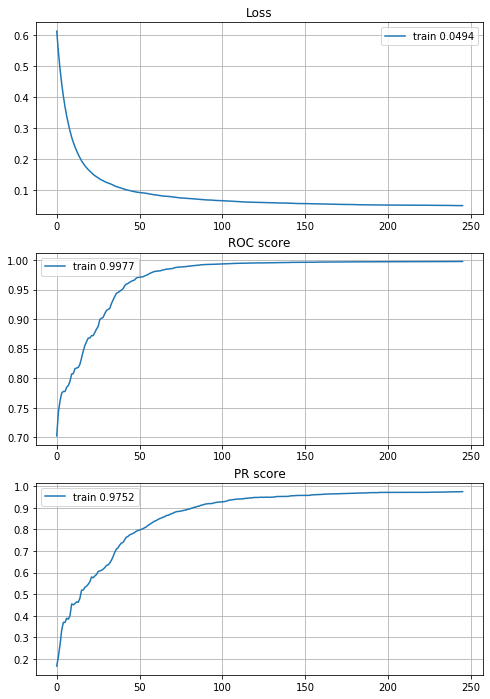

In [80]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(XGBoost_history["train_logloss"], "-", label="train {}".format(round(XGBoost_history["train_logloss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(XGBoost_history["train_auc"], label="train {}".format(round(XGBoost_history["train_auc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(XGBoost_history["train_aucpr"], label="train {}".format(round(XGBoost_history["train_aucpr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - Multilayer Percepton (Feedforward neural network)

In [81]:
# Multilayer Percepton
Multilayer_Percepton = define_MLP(input_shape=X_train.iloc[0].shape, n_layers=2, n_units=[60,60],
                                  acti=[activations.tanh, activations.sigmoid], drop=[0.4,0.4],
                                  regu=[regularizers.l2(l=0.00005),regularizers.l2(l=0.00005)], opti=optimizers.Adam(),
                                  random_state=random_state)

Multilayer_Percepton, MLP_history = network_training(network=Multilayer_Percepton,
                                                     X_train=X_train_norm_clip_pt.values,
                                                     Y_train=Y_train_norm_clip_pt.values, 
                                                     n_epochs=6843, batch_size=394, random_state=random_state, info=None)
# SAVING MLP
with open(r"results\2year\MLP_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [Multilayer_Percepton, MLP_history,
                                                                 Multilayer_Percepton.get_weights()])), fp)

In [55]:
# LOADING MLP
with open(r"results\2year\MLP_production.p", "rb") as fp:
    MLP_dict = pickle.load(fp)

Multilayer_Percepton = MLP_dict["model"]
MLP_history = MLP_dict["history"]   

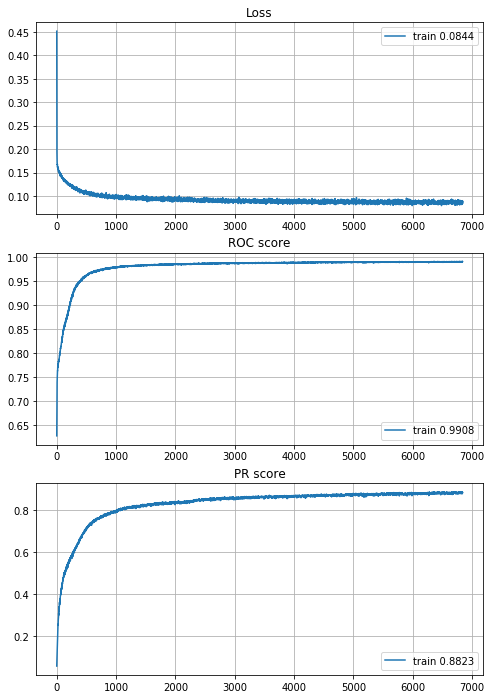

In [83]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(MLP_history["train_loss"], "-", label="train {}".format(round(MLP_history["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(MLP_history["train_roc"], label="train {}".format(round(MLP_history["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(MLP_history["train_pr"], label="train {}".format(round(MLP_history["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 8x8 input Convolutional Neural Network

In [84]:
# ----- IMAGE DRAFT -----
# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_8x8=X_train_CNN_8x8[Y_train_CNN_8x8==0].corr(method="spearman")
# draft inicialization
draft_8x8_ini=image_draft_inicialization(features, random_state)
# quasi optimization
draft_8x8_opt=MC_Energy_optimization(corr_matrix=corr_matrix_8x8, draft=draft_8x8_ini, alpha=3, n_eval=100,
                                     random_state=random_state)
# transform draft dictionary to matrix
draft_8x8_ini=image_dict_to_matrix(draft_8x8_ini)
draft_8x8_opt=image_dict_to_matrix(draft_8x8_opt)

# SAVING
with open(r"data\2year_data\drafts_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_8x8_ini, draft_8x8_opt])), fp)

initial image energy: 12890.8042
iteration: 100
current energy: 11450.126
iteration: 200
current energy: 10742.0858
iteration: 300
current energy: 10115.7861
iteration: 400
current energy: 9883.6836
iteration: 500
current energy: 9568.9632
iteration: 600
current energy: 9438.2741
iteration: 700
current energy: 9330.1456
iteration: 800
current energy: 9278.641
iteration: 900
current energy: 9176.6742
iteration: 1000
current energy: 9132.7798
iteration: 1100
current energy: 9132.1928
iteration: 1200
current energy: 8978.6341
iteration: 1300
current energy: 8975.9458
iteration: 1400
current energy: 8937.3815
iteration: 1500
current energy: 8898.7496
iteration: 1600
current energy: 8889.6387
iteration: 1700
current energy: 8820.9985
iteration: 1800
current energy: 8785.5047
iteration: 1900
current energy: 8775.2515
iteration: 2000
current energy: 8744.2515
iteration: 2100
current energy: 8742.0671
MC simulation time: 69s
energy after MC quasi optimization: 8742.0671


In [56]:
# loading 8x8 drafts
with open(r"data\2year_data\drafts_8x8_production.p", "rb") as fp:
    drafts_8x8 = pickle.load(fp)

draft_8x8_opt=drafts_8x8["optimized"]
draft_8x8_ini=drafts_8x8["initial"]

			 standarization only


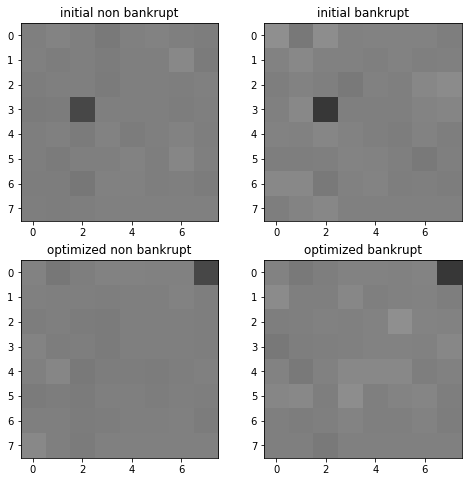

In [57]:
with open(r"data\2year_data\train_test_imp_sets_2year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_8x8, q=None, power_transform=False)
X_train_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


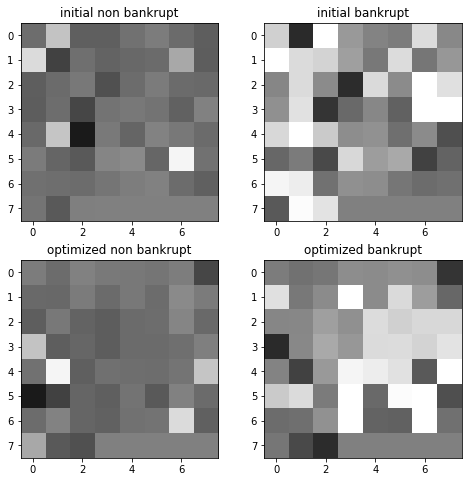

In [58]:
with open(r"data\2year_data\train_test_imp_sets_2year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_8x8, q=0.005, power_transform=False)
X_train_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

	 normalization, quantile clipping and power transform


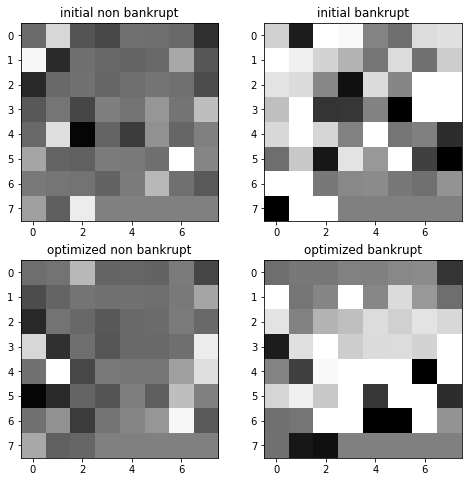

In [59]:
with open(r"data\2year_data\train_test_imp_sets_2year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)
    
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_8x8=train_set_imp[features].copy()
Y_train_CNN_8x8=train_set_imp[target].copy()
X_test_CNN_8x8=test_set_imp[features].copy()
Y_test_CNN_8x8=test_set_imp[target].copy()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_8x8, q=0.005, power_transform=True)
X_train_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_8x8), columns=features)
X_test_CNN_8x8_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_8x8), columns=features)

# plotting
print("\t normalization, quantile clipping and power transform")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_8x8_ini,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_8x8_opt,example=X_train_CNN_8x8_norm_clip_pt.loc[Y_train_CNN_8x8==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [89]:
# ----- vector to image conversion -----
# training set
X_train_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_train_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_8x8_norm_clip_pt.shape[0])])
X_train_CNN_8x8_norm_clip_pt = X_train_CNN_8x8_norm_clip_pt.reshape(X_train_CNN_8x8_norm_clip_pt.shape+(1,))
Y_train_CNN_8x8_norm_clip_pt = Y_train_CNN_8x8.values
# validation set
X_test_CNN_8x8_norm_clip_pt = np.array([map_image(draft_8x8_opt, X_test_CNN_8x8_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_8x8_norm_clip_pt.shape[0])])
X_test_CNN_8x8_norm_clip_pt = X_test_CNN_8x8_norm_clip_pt.reshape(X_test_CNN_8x8_norm_clip_pt.shape+(1,))
Y_test_CNN_8x8_norm_clip_pt = Y_test_CNN_8x8.values

# ----- CNN training -----
modelCNN = define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02(input_shape=X_train_CNN_8x8_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN, historyCNN = network_training(network=modelCNN, X_train=X_train_CNN_8x8_norm_clip_pt,
                                        Y_train=Y_train_CNN_8x8_norm_clip_pt,
                                        X_val=None, Y_val=None, n_epochs=220,
                                        batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\2year\CNN_8x8_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN, historyCNN,
                                                                 modelCNN.get_weights()])), fp)

Train on 9155 samples
Epoch: 1/220,
cumulative time: 4.55s train loss: 0.3008957230982918
Epoch: 2/220,
cumulative time: 6.08s train loss: 0.19449575428165808
Epoch: 3/220,
cumulative time: 7.58s train loss: 0.1877637046158867
Epoch: 4/220,
cumulative time: 9.1s train loss: 0.18377776058855635
Epoch: 5/220,
cumulative time: 10.6s train loss: 0.18161693290893266
Epoch: 6/220,
cumulative time: 12.12s train loss: 0.17958115935813918
Epoch: 7/220,
cumulative time: 13.64s train loss: 0.17772611293683346
Epoch: 8/220,
cumulative time: 15.18s train loss: 0.17752945347684515
Epoch: 9/220,
cumulative time: 16.69s train loss: 0.17808198848589726
Epoch: 10/220,
cumulative time: 18.27s train loss: 0.1754720179273547
Epoch: 11/220,
cumulative time: 19.78s train loss: 0.17572840355348873
Epoch: 12/220,
cumulative time: 21.3s train loss: 0.17714790124374943
Epoch: 13/220,
cumulative time: 22.81s train loss: 0.174162223359752
Epoch: 14/220,
cumulative time: 24.33s train loss: 0.17297545053443253
Epoch

Epoch: 117/220,
cumulative time: 181.43s train loss: 0.1209262411665031
Epoch: 118/220,
cumulative time: 182.99s train loss: 0.11548513578284575
Epoch: 119/220,
cumulative time: 184.49s train loss: 0.11684537769373098
Epoch: 120/220,
cumulative time: 185.99s train loss: 0.1161905084385174
Epoch: 121/220,
cumulative time: 187.5s train loss: 0.11505284629058213
Epoch: 122/220,
cumulative time: 188.99s train loss: 0.11295004202279806
Epoch: 123/220,
cumulative time: 190.48s train loss: 0.1160188101358195
Epoch: 124/220,
cumulative time: 191.98s train loss: 0.11464115617413263
Epoch: 125/220,
cumulative time: 193.47s train loss: 0.1145279844281844
Epoch: 126/220,
cumulative time: 194.98s train loss: 0.11435298415593668
Epoch: 127/220,
cumulative time: 196.49s train loss: 0.1149797044763599
Epoch: 128/220,
cumulative time: 197.98s train loss: 0.11321014774132139
Epoch: 129/220,
cumulative time: 199.49s train loss: 0.11347920926524797
Epoch: 130/220,
cumulative time: 201.0s train loss: 0.114

In [61]:
# LOADING CNN
with open(r"results\2year\CNN_8x8_production.p", "rb") as fp:
    CNN_8x8_dict = pickle.load(fp)

CNN_8x8 = CNN_8x8_dict["model"]
historyCNN_8x8 = CNN_8x8_dict["history"]

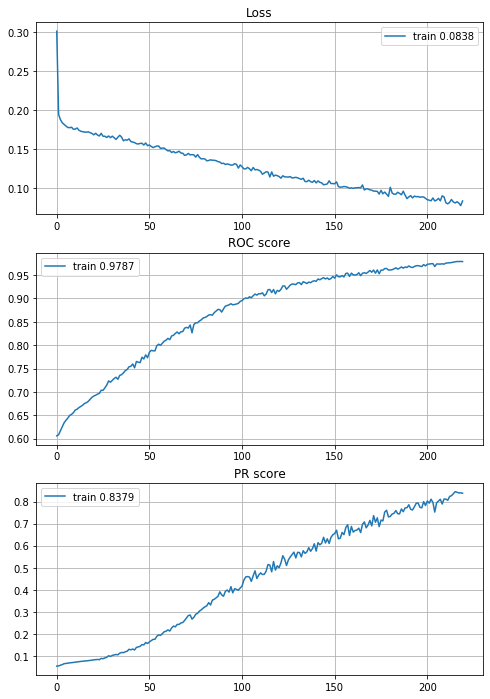

In [91]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_8x8["train_loss"], "-", label="train {}".format(round(historyCNN_8x8["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_8x8["train_roc"], label="train {}".format(round(historyCNN_8x8["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_8x8["train_pr"], label="train {}".format(round(historyCNN_8x8["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

 - 20x20 input Convolutional Neural Network

In [92]:
# training draft for CNN 20x20 input
# loading data
with open(r"data\2year_data\train_test_imp_sets_2year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN=train_set_imp[target].copy()
X_test_CNN=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN=test_set_imp[target].copy()

features_20x20=X_train_CNN.columns.tolist()

# ----- Monte Carlo energy optimization -----
# correlation matrix for non bankrupt observations
corr_matrix_20x20=X_train_CNN[Y_train_CNN==0].corr(method="spearman")
# draft inicialization
draft_20x20_ini=image_draft_inicialization(features_20x20, random_state)
# quasi optimization
draft_20x20_opt=MC_Energy_optimization(corr_matrix=corr_matrix_20x20, draft=draft_20x20_ini, alpha=3, n_eval=100,
                                       random_state=random_state)
# transform draft dictionary to matrix
draft_20x20_ini=image_dict_to_matrix(draft_20x20_ini)
draft_20x20_opt=image_dict_to_matrix(draft_20x20_opt)

# SAVING
with open(r"data\2year_data\drafts_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["initial", "optimized"], [draft_20x20_ini, draft_20x20_opt])), fp)

initial image energy: 3122804.9517
iteration: 100
current energy: 3021726.1902
iteration: 200
current energy: 2934953.0128
iteration: 300
current energy: 2874359.406
iteration: 400
current energy: 2814779.0225
iteration: 500
current energy: 2750997.7028
iteration: 600
current energy: 2692214.6841
iteration: 700
current energy: 2677542.0698
iteration: 800
current energy: 2648305.8616
iteration: 900
current energy: 2617506.6023
iteration: 1000
current energy: 2599029.8017
iteration: 1100
current energy: 2591643.6461
iteration: 1200
current energy: 2571156.3425
iteration: 1300
current energy: 2537600.9838
iteration: 1400
current energy: 2516615.4661
iteration: 1500
current energy: 2502516.9791
iteration: 1600
current energy: 2476556.779
iteration: 1700
current energy: 2467001.448
iteration: 1800
current energy: 2448813.2788
iteration: 1900
current energy: 2441556.0995
iteration: 2000
current energy: 2422726.3578
iteration: 2100
current energy: 2413496.14
iteration: 2200
current energy: 24

In [62]:
# loading 20x20 drafts
with open(r"data\2year_data\drafts_20x20_production.p", "rb") as fp:
    drafts_20x20 = pickle.load(fp)

draft_20x20_opt=drafts_20x20["optimized"]
draft_20x20_ini=drafts_20x20["initial"]

			 standarization only


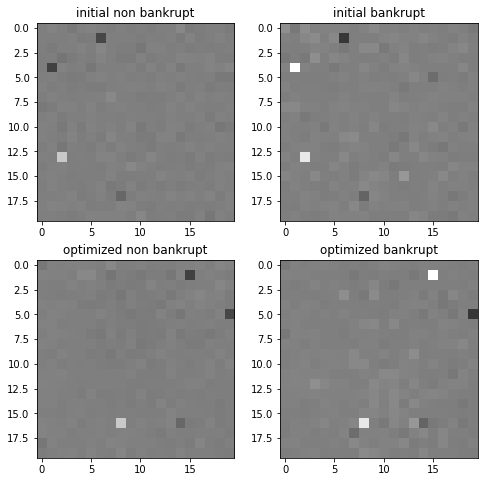

In [94]:
# loading data
with open(r"data\2year_data\train_test_imp_sets_2year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm=scaler(images=True)
sclr_norm.fit(X=X_train_CNN_20x20, q=None, power_transform=False)
X_train_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm=pd.DataFrame(sclr_norm.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t\t standarization only")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


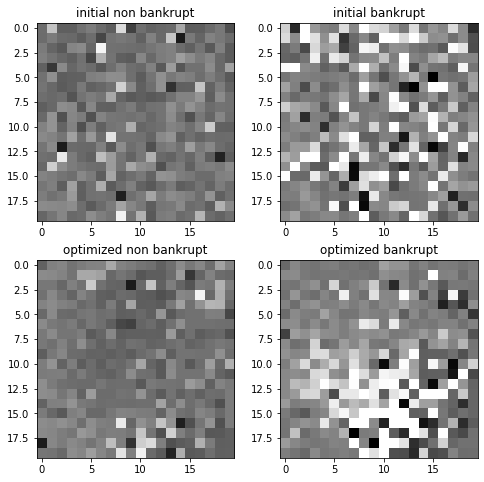

In [95]:
# loading data
with open(r"data\2year_data\train_test_imp_sets_2year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip=scaler(images=True)
sclr_norm_clip.fit(X=X_train_CNN_20x20, q=0.005, power_transform=False)
X_train_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip=pd.DataFrame(sclr_norm_clip.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

		 standarization and quantile clipping


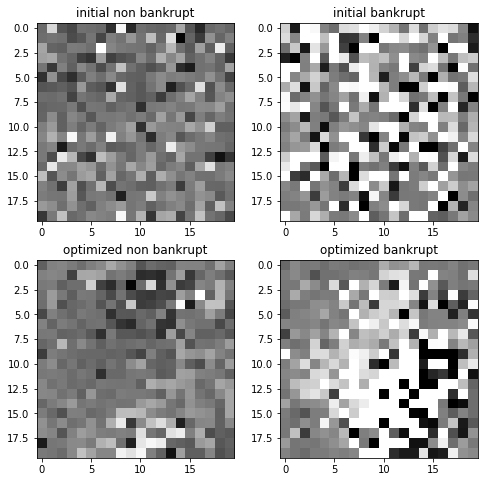

In [96]:
# loading data
with open(r"data\2year_data\train_test_imp_sets_2year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()
# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)

# plotting
print("\t\t standarization and quantile clipping")
fig, ax=plt.subplots(nrows=2,ncols=2,figsize=(8,8))
ax[0,0].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,1].imshow(map_image(draft=draft_20x20_ini,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,0].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==0,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[1,1].imshow(map_image(draft=draft_20x20_opt,example=X_train_CNN_20x20_norm_clip_pt.loc[Y_train_CNN_20x20==1,:].iloc[0,:]),
               cmap="gray",vmin=0,vmax=255)
ax[0,0].set_title("initial non bankrupt")
ax[0,1].set_title("initial bankrupt")
ax[1,0].set_title("optimized non bankrupt")
ax[1,1].set_title("optimized bankrupt")
plt.show()

In [97]:
# loading data
with open(r"data\2year_data\train_test_imp_sets_2year.p", "rb") as fp:
    train_test_imp_sets = pickle.load(fp)

# train/test split 
train_set_imp = train_test_imp_sets["train_set_imp"]
test_set_imp = train_test_imp_sets["test_set_imp"]

# X/Y split
X_train_CNN_20x20=generate_features(data=train_set_imp[features].copy(), instruction=instruction)
Y_train_CNN_20x20=train_set_imp[target].copy()
X_test_CNN_20x20=generate_features(data=test_set_imp[features].copy(), instruction=instruction)
Y_test_CNN_20x20=test_set_imp[target].copy()

features_20x20=X_train_CNN_20x20.columns.tolist()

# standarization
sclr_norm_clip_pt=scaler(images=True)
sclr_norm_clip_pt.fit(X=X_train_CNN_20x20, q=0.005, power_transform=True)
X_train_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_train_CNN_20x20), columns=features_20x20)
X_test_CNN_20x20_norm_clip_pt=pd.DataFrame(sclr_norm_clip_pt.transform(X=X_test_CNN_20x20), columns=features_20x20)


# ----- vector to image conversion -----
# training set
X_train_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt, X_train_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_train_CNN_20x20_norm_clip_pt.shape[0])])
X_train_CNN_20x20_norm_clip_pt = X_train_CNN_20x20_norm_clip_pt.reshape(X_train_CNN_20x20_norm_clip_pt.shape+(1,))
Y_train_CNN_20x20_norm_clip_pt = Y_train_CNN_20x20.values

# validation set
X_test_CNN_20x20_norm_clip_pt = np.array([map_image(draft_20x20_opt, X_test_CNN_20x20_norm_clip_pt.iloc[i,:])/255 for i in range(X_test_CNN_20x20_norm_clip_pt.shape[0])])
X_test_CNN_20x20_norm_clip_pt = X_test_CNN_20x20_norm_clip_pt.reshape(X_test_CNN_20x20_norm_clip_pt.shape+(1,))
Y_test_CNN_20x20_norm_clip_pt = Y_test_CNN_20x20.values

# ----- CNN training -----
modelCNN_20x20 = define_deep_CNN_2inc_std_L2_more_drop_04_2dense_L2_drop_02(input_shape=X_train_CNN_20x20_norm_clip_pt.shape[1:], random_state=random_state)
modelCNN_20x20, historyCNN_20x20 = network_training(network=modelCNN_20x20, X_train=X_train_CNN_20x20_norm_clip_pt,
                                                    Y_train=Y_train_CNN_20x20_norm_clip_pt,
                                                    X_val=None, Y_val=None, n_epochs=155,
                                                    batch_size=394, random_state=random_state, info=2)

# SAVING CNN
with open(r"results\2year\CNN_20x20_production.p", "wb") as fp:
    pickle.dump(dict(zip(["model", "history", "model_weights"], [modelCNN_20x20, historyCNN_20x20,
                                                                 modelCNN_20x20.get_weights()])), fp)

Train on 9155 samples
Epoch: 1/155,
cumulative time: 10.65s train loss: 0.2679612403453731
Epoch: 2/155,
cumulative time: 17.98s train loss: 0.20227243568583436
Epoch: 3/155,
cumulative time: 25.34s train loss: 0.19264702639379247
Epoch: 4/155,
cumulative time: 32.74s train loss: 0.19095667271520322
Epoch: 5/155,
cumulative time: 40.14s train loss: 0.18701311135181373
Epoch: 6/155,
cumulative time: 47.57s train loss: 0.18662854089950487
Epoch: 7/155,
cumulative time: 54.98s train loss: 0.18211418957022746
Epoch: 8/155,
cumulative time: 62.37s train loss: 0.18018655186872023
Epoch: 9/155,
cumulative time: 69.77s train loss: 0.1808417052388647
Epoch: 10/155,
cumulative time: 77.38s train loss: 0.18043781421439756
Epoch: 11/155,
cumulative time: 85.46s train loss: 0.17717245257922953
Epoch: 12/155,
cumulative time: 92.89s train loss: 0.18369442794181037
Epoch: 13/155,
cumulative time: 100.28s train loss: 0.17727677445799714
Epoch: 14/155,
cumulative time: 107.69s train loss: 0.17490631017

Epoch: 116/155,
cumulative time: 866.67s train loss: 0.05984663629404904
Epoch: 117/155,
cumulative time: 874.13s train loss: 0.06138958056268635
Epoch: 118/155,
cumulative time: 881.55s train loss: 0.06085281834283011
Epoch: 119/155,
cumulative time: 888.96s train loss: 0.05614812894801114
Epoch: 120/155,
cumulative time: 896.35s train loss: 0.06458051795112442
Epoch: 121/155,
cumulative time: 903.72s train loss: 0.05900645750889617
Epoch: 122/155,
cumulative time: 911.04s train loss: 0.05988368936766047
Epoch: 123/155,
cumulative time: 918.64s train loss: 0.054423815153583945
Epoch: 124/155,
cumulative time: 926.56s train loss: 0.05609687968543291
Epoch: 125/155,
cumulative time: 933.99s train loss: 0.054389603365597214
Epoch: 126/155,
cumulative time: 941.36s train loss: 0.05966241791486284
Epoch: 127/155,
cumulative time: 948.69s train loss: 0.05405361944700707
Epoch: 128/155,
cumulative time: 956.06s train loss: 0.05496608445482915
Epoch: 129/155,
cumulative time: 963.4s train los

In [63]:
# LOADING CNN
with open(r"results\2year\CNN_20x20_production.p", "rb") as fp:
    CNN_20x20_dict = pickle.load(fp)

CNN_20x20 = CNN_20x20_dict["model"]
historyCNN_20x20 = CNN_20x20_dict["history"]

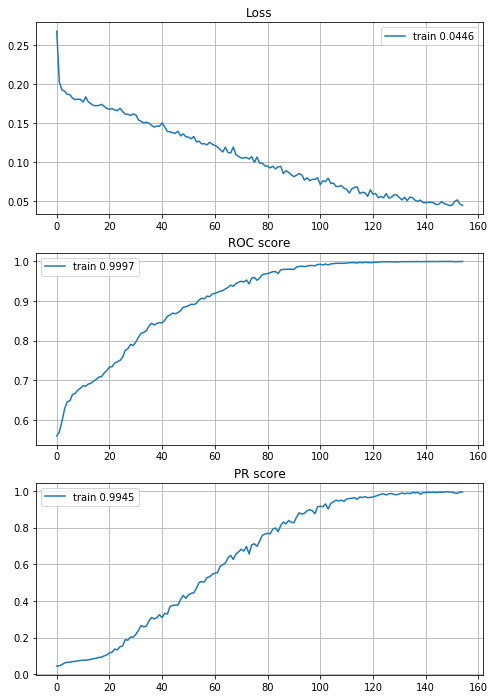

In [99]:
# training process plot
fig, ax = plt.subplots(nrows=3, ncols=1, figsize = (8,12))
ax[0].plot(historyCNN_20x20["train_loss"], "-", label="train {}".format(round(historyCNN_20x20["train_loss"][-1], 4)))
ax[0].legend()
ax[0].set_title("Loss")
ax[0].grid()

ax[1].plot(historyCNN_20x20["train_roc"], label="train {}".format(round(historyCNN_20x20["train_roc"][-1], 4)))
ax[1].legend()
ax[1].set_title("ROC score")
ax[1].grid()

ax[2].plot(historyCNN_20x20["train_pr"], label="train {}".format(round(historyCNN_20x20["train_pr"][-1], 4)))
ax[2].legend()
ax[2].set_title("PR score")
ax[2].grid()
plt.show()

##### "Production" results

In [65]:
# Logistic Regression
Logit_train_probs = Logit.predict(exog=X_train_norm_clip_pt)
Logit_test_probs = Logit.predict(exog=X_test_norm_clip_pt)

Logit_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)
Logit_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Logit_train_probs)
Logit_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Logit_test_probs)

(Logit_train_roc, Logit_test_roc, Logit_train_pr, Logit_test_pr)

(0.7581113006127219,
 0.7787832310838446,
 0.28642495151648784,
 0.40159065145303224)

In [66]:
# Random Forest
Random_Forest_train_probs = Random_Forest.predict_proba(X=X_train_norm_clip_pt)[:,1]
Random_Forest_test_probs = Random_Forest.predict_proba(X=X_test_norm_clip_pt)[:,1]

Random_Forest_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Random_Forest_train_probs)
Random_Forest_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Random_Forest_test_probs)
Random_Forest_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Random_Forest_train_probs)
Random_Forest_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Random_Forest_test_probs)

(Random_Forest_train_roc,Random_Forest_test_roc,Random_Forest_train_pr,Random_Forest_test_pr)

(0.9911155328153624,
 0.8842535787321063,
 0.8896255175544726,
 0.4272423879048631)

In [67]:
# Extreme Gradient Boosted Decision Trees
XGBoost_train_probs = XGBoost.predict_proba(data=X_train_raw)[:,1]
XGBoost_test_probs = XGBoost.predict_proba(data=X_test_raw)[:,1]

XGBoost_train_roc = roc_auc_score(y_true=Y_train_raw, y_score=XGBoost_train_probs)
XGBoost_test_roc = roc_auc_score(y_true=Y_test_raw, y_score=XGBoost_test_probs)
XGBoost_train_pr = average_precision_score(y_true=Y_train_raw, y_score=XGBoost_train_probs)
XGBoost_test_pr = average_precision_score(y_true=Y_test_raw, y_score=XGBoost_test_probs)

(XGBoost_train_roc,XGBoost_test_roc,XGBoost_train_pr,XGBoost_test_pr)

(0.9976506537805572,
 0.8786298568507157,
 0.9752258544590154,
 0.5124399257152688)

In [68]:
# Multilayer Percepton
Multilayer_Percepton_train_probs = Multilayer_Percepton.predict(x=X_train_norm_clip_pt.values)
Multilayer_Percepton_test_probs = Multilayer_Percepton.predict(x=X_test_norm_clip_pt.values)

Multilayer_Percepton_train_roc = roc_auc_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_roc = roc_auc_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)
Multilayer_Percepton_train_pr = average_precision_score(y_true=Y_train_norm_clip_pt, y_score=Multilayer_Percepton_train_probs)
Multilayer_Percepton_test_pr = average_precision_score(y_true=Y_test_norm_clip_pt, y_score=Multilayer_Percepton_test_probs)

(Multilayer_Percepton_train_roc,Multilayer_Percepton_test_roc,Multilayer_Percepton_train_pr,Multilayer_Percepton_test_pr)

(0.9908338070873602,
 0.8936733128834355,
 0.8823330423156441,
 0.6118529599362059)

In [69]:
# CNN 8x8
CNN_8x8_train_probs = CNN_8x8.predict(x=X_train_CNN_8x8_norm_clip_pt)
CNN_8x8_test_probs = CNN_8x8.predict(x=X_test_CNN_8x8_norm_clip_pt)

CNN_8x8_train_roc = roc_auc_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_roc = roc_auc_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)
CNN_8x8_train_pr = average_precision_score(y_true=Y_train_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_train_probs)
CNN_8x8_test_pr = average_precision_score(y_true=Y_test_CNN_8x8_norm_clip_pt, y_score=CNN_8x8_test_probs)

(CNN_8x8_train_roc,CNN_8x8_test_roc,CNN_8x8_train_pr,CNN_8x8_test_pr)

(0.9787464468447981,
 0.846319018404908,
 0.8379147891994093,
 0.30751640514755607)

In [70]:
# CNN 20x20
CNN_20x20_train_probs = CNN_20x20.predict(x=X_train_CNN_20x20_norm_clip_pt)
CNN_20x20_test_probs = CNN_20x20.predict(x=X_test_CNN_20x20_norm_clip_pt)

CNN_20x20_train_roc = roc_auc_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_roc = roc_auc_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)
CNN_20x20_train_pr = average_precision_score(y_true=Y_train_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_train_probs)
CNN_20x20_test_pr = average_precision_score(y_true=Y_test_CNN_20x20_norm_clip_pt, y_score=CNN_20x20_test_probs)

(CNN_20x20_train_roc,CNN_20x20_test_roc,CNN_20x20_train_pr,CNN_20x20_test_pr)

(0.9997230118122671,
 0.9075536809815951,
 0.9944548629138572,
 0.5058627061807275)

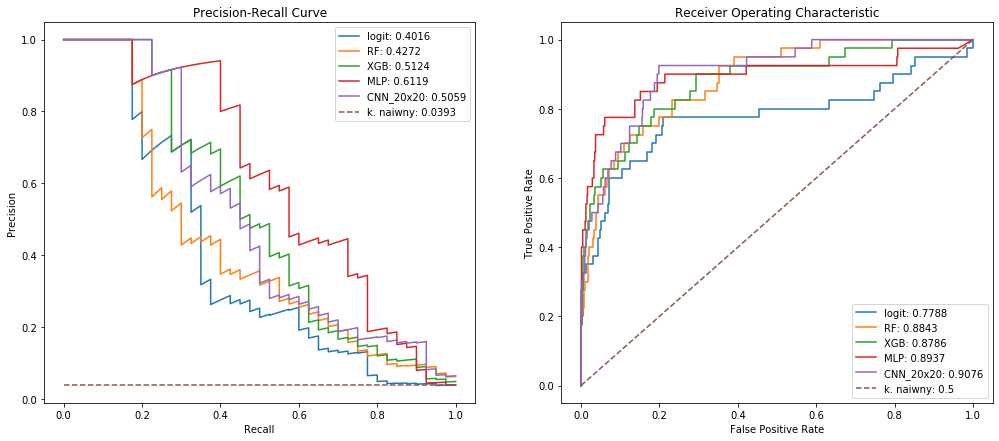

In [73]:
fig, ax = plt.subplots(nrows=1,ncols=2,figsize=(17,7))

logit_precision, logit_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Logit_test_probs)
logit_fpr, logit_tpr, _ = roc_curve(Y_test_norm_clip_pt, Logit_test_probs)

rf_precision, rf_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Random_Forest_test_probs)
rf_fpr, rf_tpr, _ = roc_curve(Y_test_norm_clip_pt, Random_Forest_test_probs)

xgb_precision, xgb_recall, _ = precision_recall_curve(Y_test_raw, XGBoost_test_probs)
xgb_fpr, xgb_tpr, _ = roc_curve(Y_test_raw, XGBoost_test_probs)

mlp_precision, mlp_recall, _ = precision_recall_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)
mlp_fpr, mlp_tpr, _ = roc_curve(Y_test_norm_clip_pt, Multilayer_Percepton_test_probs)

cnn_20x20_precision, cnn_20x20_recall, _ = precision_recall_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)
cnn_20x20_fpr, cnn_20x20_tpr, _ = roc_curve(Y_test_CNN_20x20_norm_clip_pt, CNN_20x20_test_probs)

# cnn_8x8_precision, cnn_8x8_recall, _ = precision_recall_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)
# cnn_8x8_fpr, cnn_8x8_tpr, _ = roc_curve(Y_test_CNN_8x8_norm_clip_pt, CNN_8x8_test_probs)


noskill_probs = [1 for i in range(Y_test.shape[0])]
noskill_fpr, noskill_tpr, _ = roc_curve(Y_test, noskill_probs)
noskill_precision = Y_test[Y_test==1].shape[0]/Y_test.shape[0]
# precision=(TP)/(TP+FP), when y_hat=1 always => TP+FP = n_obs => precision = TP/(n_obs)
# recall = (TP)/(TP+FN), when y_hat=1 always => FN=0 =? TP+FN=TP => recall=TP/TP=1

# ----- PLOTS -----
ax[0].plot(logit_recall, logit_precision, label= "logit: {}".format(round(Logit_test_pr,4)))
ax[0].plot(rf_recall, rf_precision, label= "RF: {}".format(round(Random_Forest_test_pr,4)))
ax[0].plot(xgb_recall, xgb_precision, label= "XGB: {}".format(round(XGBoost_test_pr,4)))
ax[0].plot(mlp_recall, mlp_precision, label= "MLP: {}".format(round(Multilayer_Percepton_test_pr,4)))
ax[0].plot(cnn_20x20_recall, cnn_20x20_precision, label= "CNN_20x20: {}".format(round(CNN_20x20_test_pr,4)))
# ax[0].plot(cnn_8x8_recall, cnn_8x8_precision, label= "CNN_8x8: {}".format(round(CNN_8x8_test_pr,4)))
ax[0].plot([0,1], [noskill_precision, noskill_precision], linestyle='--', label= "k. naiwny: {}".format(
    round(average_precision_score(Y_test, noskill_probs),4)))
ax[0].plot()
ax[0].legend()
ax[0].set_title("Precision-Recall Curve")
ax[0].set_xlabel('Recall')
ax[0].set_ylabel('Precision')


ax[1].plot(logit_fpr, logit_tpr, label="logit: {}".format(round(Logit_test_roc, 4)))
ax[1].plot(rf_fpr, rf_tpr, label="RF: {}".format(round(Random_Forest_test_roc, 4)))
ax[1].plot(xgb_fpr, xgb_tpr, label="XGB: {}".format(round(XGBoost_test_roc, 4)))
ax[1].plot(mlp_fpr, mlp_tpr, label="MLP: {}".format(round(Multilayer_Percepton_test_roc, 4)))
ax[1].plot(cnn_20x20_fpr, cnn_20x20_tpr, label= "CNN_20x20: {}".format(round(CNN_20x20_test_roc,4)))
# ax[1].plot(cnn_8x8_fpr, cnn_8x8_tpr, label= "CNN_8x8: {}".format(round(CNN_8x8_test_roc,4)))
ax[1].plot(noskill_fpr, noskill_tpr, linestyle='--', label= "k. naiwny: {}".format(
    round(roc_auc_score(Y_test, noskill_probs),4)))
ax[1].legend()
ax[1].set_title("Receiver Operating Characteristic")
ax[1].set_xlabel('False Positive Rate')
ax[1].set_ylabel('True Positive Rate')
plt.show()